In [1]:
import numpy as np
import matplotlib
#matplotlib.use('Agg')

import matplotlib.pyplot as plt
import pickle as pkl

from torch.utils.data import Dataset, DataLoader
from torch.nn import Linear, ReLU
from torch.nn.init import kaiming_uniform_, xavier_uniform_

np.random.seed(0)

import torch
import geomloss

[pyKeOps]: Warning, no cuda detected. Switching to cpu only.


In [2]:
DIM = 64 # Model dimensionality (number of neurons in the hidden layer(s))
#CRITIC_ITERS = 10 # How many critic iterations (Sinkhorn iterations) per generator iteration#was 50
BATCH_SIZE = 256 # Batch size
EPOCHS = 55#100000 # how many generator iterations to train for
DATA_DIM = 32
LATENT_DIM = 32
INITIALIZATION = 'he'#'glorot'
COVARIANCE_SCALE = np.sqrt(DATA_DIM)
INITIALIZE_LAST = True
SAMPLE_SIZE = 100000
LAMBDA = 2.0#.5#2/(COVARIANCE_SCALE)
MODE = 'divergence' #'loss'
MODE2 = 'loss_gen_only'

In [3]:
if MODE == 'divergence':
    model_loss = geomloss.SamplesLoss(loss='sinkhorn', p=2, blur=np.sqrt(LAMBDA), debias=True)
elif MODE == 'loss':
    model_loss = geomloss.SamplesLoss(loss='sinkhorn', p=2, blur=np.sqrt(LAMBDA), debias=False)
else:
    print("MODE UNKNOWN")

In [4]:
def initializer(weight):
    if INITIALIZATION == 'he':
        return kaiming_uniform_(weight, nonlinearity='relu')
    if INITIALIZATION == 'glorot':
        return xavier_uniform_(weight)
    print("UNKNOWN INITIALIZATION")
    return None

In [5]:
class Generator(torch.nn.Module):
    def __init__(self, n_inputs = LATENT_DIM):
        # calling constructor of parent class
        super().__init__()

        # defining the inputs to the first hidden layer
        self.hid1 = Linear(n_inputs, DIM) 
        initializer(self.hid1.weight)
        self.act1 = ReLU()

        # defining the inputs to the second hidden layer
        self.hid2 = Linear(DIM, DIM)
        initializer(self.hid2.weight)
        self.act2 = ReLU()

        # defining the inputs to the third hidden layer
        self.hid3 = Linear(DIM, DIM)
        initializer(self.hid3.weight)
        self.act3 = ReLU()

        # defining the inputs to the output layer
        self.out = Linear(DIM, DATA_DIM)
        initializer(self.out.weight)

    def forward(self, X):
        #input and act for layer 1
        X = self.hid1(X)
        X = self.act1(X)
        
        #input and act for layer 2
        X = self.hid2(X)
        X = self.act2(X)
        
        #input and act for layer 3
        X = self.hid3(X)
        X = self.act3(X)
        
        #input for output layer
        X = self.out(X)
        
        return X

In [6]:
class GaussianDataset(Dataset):
    # reading the csv and defining predictor and output columns
    def __init__(self, sample_size=SAMPLE_SIZE, data_dim=DATA_DIM, latent_dim = LATENT_DIM,
                 variance = 1/COVARIANCE_SCALE):
    
        # store the input and output features
        
        np.random.seed(1)
        self.X = np.random.randn(sample_size,data_dim) * np.sqrt(variance)
        self.latent_dim = latent_dim
    
        # ensure all data is numerical - type(float)
        self.X = self.X.astype('float32')
    
    # number of rows in dataset
    def __len__(self):
        return len(self.X)
    
    # get a row at an index
    def __getitem__(self, index):
        return [np.random.randn(self.latent_dim).astype('float32'), self.X[index]]

In [7]:
dataset = GaussianDataset()
data_dl = DataLoader(dataset, batch_size = BATCH_SIZE, shuffle = True)

In [8]:
# define the network
model = Generator(LATENT_DIM)
# define the number of epochs
epochs = EPOCHS
# define the optimizer - Adam
optimizer = torch.optim.RMSprop(model.parameters())#, lr = 0.005)
# define the loss function
criterion = model_loss

In [9]:
res = {'loss':{}, 'sample': {}, 'cov_diff' : {}}
res['lambda'] = LAMBDA
cov_diff_all = []

In [10]:
plt.figure()
if MODE == 'divergence':
    model_name = "tmp_NP_SINKHORN_LAMBDA_"#non parametric
else:
    model_name = "tmp_NP_ENTROPIC_LAMBDA_"
model_name = model_name +str(LAMBDA) + "_LATENT_DIM_" + str(LATENT_DIM) + "_initialization_" \
    + INITIALIZATION + "_BATCHSIZE" + str(BATCH_SIZE)

<Figure size 432x288 with 0 Axes>

# Try to overfit the network

Train on 1 batch

In [69]:
epochs_passed = len(list(res['loss'].keys()))#to continue training 
for epoch in range(epochs_passed, epochs_passed+55):
    for key in res:
        if key != 'lambda':
            res[key][epoch] = []
    #if epoch % 5 == 0 and epoch > 0:
    #    optimizer.param_groups[0]['lr'] /= 1.2
    # go through all the batches generated by dataloader
    for i, (inputs, targets) in enumerate(data_dl):
        if i > 0 or epoch > 0:
            inputs, targets = inputs0, targets0
        else:
            inputs0, targets0 = inputs, targets
        # clear the gradients
        optimizer.zero_grad()
        # compute the model output
        yhat = model(inputs)
        # calculate loss
        loss = criterion(yhat, targets)
        cov_diff = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
        # credit assignment
        loss.backward()
        # update model weights
        optimizer.step()
        yhat = model(inputs)
        cov_diff2 = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
        print("Epoch: {}, iteration {}, loss {:.5f}, cov_diff {:.5f} cov_diff train {:.5f}".format(epoch,i, 
                                                            float(loss), float(cov_diff), float(cov_diff2)))
        res['loss'][epoch].append(loss)
        res['sample'][epoch].append(np.array(yhat.data))
        res['cov_diff'][epoch].append(cov_diff)
    cov_diff_all += res['cov_diff'][epoch]
    

Epoch: 47, iteration 0, loss 0.01702, cov_diff 0.38868 cov_diff train 0.38819
Epoch: 47, iteration 1, loss 0.01707, cov_diff 0.38819 cov_diff train 0.38862
Epoch: 47, iteration 2, loss 0.01714, cov_diff 0.38862 cov_diff train 0.38850
Epoch: 47, iteration 3, loss 0.01723, cov_diff 0.38850 cov_diff train 0.38928
Epoch: 47, iteration 4, loss 0.01733, cov_diff 0.38928 cov_diff train 0.38820
Epoch: 47, iteration 5, loss 0.01745, cov_diff 0.38820 cov_diff train 0.38887
Epoch: 47, iteration 6, loss 0.01738, cov_diff 0.38887 cov_diff train 0.38753
Epoch: 47, iteration 7, loss 0.01722, cov_diff 0.38753 cov_diff train 0.38881
Epoch: 47, iteration 8, loss 0.01712, cov_diff 0.38881 cov_diff train 0.38885
Epoch: 47, iteration 9, loss 0.01702, cov_diff 0.38885 cov_diff train 0.38950
Epoch: 47, iteration 10, loss 0.01700, cov_diff 0.38950 cov_diff train 0.38934
Epoch: 47, iteration 11, loss 0.01699, cov_diff 0.38934 cov_diff train 0.38836
Epoch: 47, iteration 12, loss 0.01704, cov_diff 0.38836 cov_di

Epoch: 47, iteration 104, loss 0.01685, cov_diff 0.38796 cov_diff train 0.38804
Epoch: 47, iteration 105, loss 0.01684, cov_diff 0.38804 cov_diff train 0.38815
Epoch: 47, iteration 106, loss 0.01684, cov_diff 0.38815 cov_diff train 0.38836
Epoch: 47, iteration 107, loss 0.01685, cov_diff 0.38836 cov_diff train 0.38845
Epoch: 47, iteration 108, loss 0.01686, cov_diff 0.38845 cov_diff train 0.38819
Epoch: 47, iteration 109, loss 0.01688, cov_diff 0.38819 cov_diff train 0.38840
Epoch: 47, iteration 110, loss 0.01688, cov_diff 0.38840 cov_diff train 0.38837
Epoch: 47, iteration 111, loss 0.01689, cov_diff 0.38837 cov_diff train 0.38831
Epoch: 47, iteration 112, loss 0.01692, cov_diff 0.38831 cov_diff train 0.38822
Epoch: 47, iteration 113, loss 0.01695, cov_diff 0.38822 cov_diff train 0.38816
Epoch: 47, iteration 114, loss 0.01695, cov_diff 0.38816 cov_diff train 0.38876
Epoch: 47, iteration 115, loss 0.01695, cov_diff 0.38876 cov_diff train 0.38877
Epoch: 47, iteration 116, loss 0.01695, 

Epoch: 47, iteration 207, loss 0.01692, cov_diff 0.38870 cov_diff train 0.38883
Epoch: 47, iteration 208, loss 0.01692, cov_diff 0.38883 cov_diff train 0.38892
Epoch: 47, iteration 209, loss 0.01691, cov_diff 0.38892 cov_diff train 0.38882
Epoch: 47, iteration 210, loss 0.01691, cov_diff 0.38882 cov_diff train 0.38881
Epoch: 47, iteration 211, loss 0.01691, cov_diff 0.38881 cov_diff train 0.38889
Epoch: 47, iteration 212, loss 0.01691, cov_diff 0.38889 cov_diff train 0.38882
Epoch: 47, iteration 213, loss 0.01691, cov_diff 0.38882 cov_diff train 0.38876
Epoch: 47, iteration 214, loss 0.01691, cov_diff 0.38876 cov_diff train 0.38893
Epoch: 47, iteration 215, loss 0.01691, cov_diff 0.38893 cov_diff train 0.38887
Epoch: 47, iteration 216, loss 0.01691, cov_diff 0.38887 cov_diff train 0.38885
Epoch: 47, iteration 217, loss 0.01691, cov_diff 0.38885 cov_diff train 0.38880
Epoch: 47, iteration 218, loss 0.01692, cov_diff 0.38880 cov_diff train 0.38890
Epoch: 47, iteration 219, loss 0.01692, 

Epoch: 47, iteration 316, loss 0.01690, cov_diff 0.38837 cov_diff train 0.38847
Epoch: 47, iteration 317, loss 0.01688, cov_diff 0.38847 cov_diff train 0.38840
Epoch: 47, iteration 318, loss 0.01688, cov_diff 0.38840 cov_diff train 0.38865
Epoch: 47, iteration 319, loss 0.01689, cov_diff 0.38865 cov_diff train 0.38855
Epoch: 47, iteration 320, loss 0.01691, cov_diff 0.38855 cov_diff train 0.38881
Epoch: 47, iteration 321, loss 0.01695, cov_diff 0.38881 cov_diff train 0.38890
Epoch: 47, iteration 322, loss 0.01698, cov_diff 0.38890 cov_diff train 0.38884
Epoch: 47, iteration 323, loss 0.01698, cov_diff 0.38884 cov_diff train 0.38847
Epoch: 47, iteration 324, loss 0.01695, cov_diff 0.38847 cov_diff train 0.38872
Epoch: 47, iteration 325, loss 0.01691, cov_diff 0.38872 cov_diff train 0.38826
Epoch: 47, iteration 326, loss 0.01689, cov_diff 0.38826 cov_diff train 0.38868
Epoch: 47, iteration 327, loss 0.01689, cov_diff 0.38868 cov_diff train 0.38827
Epoch: 47, iteration 328, loss 0.01690, 

Epoch: 48, iteration 32, loss 0.01815, cov_diff 0.39043 cov_diff train 0.39165
Epoch: 48, iteration 33, loss 0.01836, cov_diff 0.39165 cov_diff train 0.39008
Epoch: 48, iteration 34, loss 0.01833, cov_diff 0.39008 cov_diff train 0.39241
Epoch: 48, iteration 35, loss 0.01830, cov_diff 0.39241 cov_diff train 0.39074
Epoch: 48, iteration 36, loss 0.01817, cov_diff 0.39074 cov_diff train 0.39204
Epoch: 48, iteration 37, loss 0.01819, cov_diff 0.39204 cov_diff train 0.39260
Epoch: 48, iteration 38, loss 0.01809, cov_diff 0.39260 cov_diff train 0.39038
Epoch: 48, iteration 39, loss 0.01793, cov_diff 0.39038 cov_diff train 0.39043
Epoch: 48, iteration 40, loss 0.01784, cov_diff 0.39043 cov_diff train 0.39136
Epoch: 48, iteration 41, loss 0.01786, cov_diff 0.39136 cov_diff train 0.39203
Epoch: 48, iteration 42, loss 0.01772, cov_diff 0.39203 cov_diff train 0.39221
Epoch: 48, iteration 43, loss 0.01758, cov_diff 0.39221 cov_diff train 0.39285
Epoch: 48, iteration 44, loss 0.01760, cov_diff 0.39

Epoch: 48, iteration 138, loss 0.01681, cov_diff 0.38825 cov_diff train 0.38833
Epoch: 48, iteration 139, loss 0.01682, cov_diff 0.38833 cov_diff train 0.38832
Epoch: 48, iteration 140, loss 0.01682, cov_diff 0.38832 cov_diff train 0.38831
Epoch: 48, iteration 141, loss 0.01683, cov_diff 0.38831 cov_diff train 0.38820
Epoch: 48, iteration 142, loss 0.01685, cov_diff 0.38820 cov_diff train 0.38865
Epoch: 48, iteration 143, loss 0.01687, cov_diff 0.38865 cov_diff train 0.38832
Epoch: 48, iteration 144, loss 0.01690, cov_diff 0.38832 cov_diff train 0.38837
Epoch: 48, iteration 145, loss 0.01691, cov_diff 0.38837 cov_diff train 0.38836
Epoch: 48, iteration 146, loss 0.01691, cov_diff 0.38836 cov_diff train 0.38819
Epoch: 48, iteration 147, loss 0.01688, cov_diff 0.38819 cov_diff train 0.38816
Epoch: 48, iteration 148, loss 0.01685, cov_diff 0.38816 cov_diff train 0.38852
Epoch: 48, iteration 149, loss 0.01682, cov_diff 0.38852 cov_diff train 0.38847
Epoch: 48, iteration 150, loss 0.01681, 

Epoch: 48, iteration 244, loss 0.01677, cov_diff 0.38824 cov_diff train 0.38840
Epoch: 48, iteration 245, loss 0.01677, cov_diff 0.38840 cov_diff train 0.38832
Epoch: 48, iteration 246, loss 0.01677, cov_diff 0.38832 cov_diff train 0.38844
Epoch: 48, iteration 247, loss 0.01676, cov_diff 0.38844 cov_diff train 0.38829
Epoch: 48, iteration 248, loss 0.01676, cov_diff 0.38829 cov_diff train 0.38835
Epoch: 48, iteration 249, loss 0.01676, cov_diff 0.38835 cov_diff train 0.38820
Epoch: 48, iteration 250, loss 0.01676, cov_diff 0.38820 cov_diff train 0.38814
Epoch: 48, iteration 251, loss 0.01676, cov_diff 0.38814 cov_diff train 0.38826
Epoch: 48, iteration 252, loss 0.01676, cov_diff 0.38826 cov_diff train 0.38815
Epoch: 48, iteration 253, loss 0.01677, cov_diff 0.38815 cov_diff train 0.38835
Epoch: 48, iteration 254, loss 0.01677, cov_diff 0.38835 cov_diff train 0.38845
Epoch: 48, iteration 255, loss 0.01678, cov_diff 0.38845 cov_diff train 0.38840
Epoch: 48, iteration 256, loss 0.01679, 

Epoch: 48, iteration 353, loss 0.01675, cov_diff 0.38812 cov_diff train 0.38801
Epoch: 48, iteration 354, loss 0.01675, cov_diff 0.38801 cov_diff train 0.38801
Epoch: 48, iteration 355, loss 0.01675, cov_diff 0.38801 cov_diff train 0.38799
Epoch: 48, iteration 356, loss 0.01675, cov_diff 0.38799 cov_diff train 0.38812
Epoch: 48, iteration 357, loss 0.01675, cov_diff 0.38812 cov_diff train 0.38782
Epoch: 48, iteration 358, loss 0.01675, cov_diff 0.38782 cov_diff train 0.38817
Epoch: 48, iteration 359, loss 0.01675, cov_diff 0.38817 cov_diff train 0.38777
Epoch: 48, iteration 360, loss 0.01675, cov_diff 0.38777 cov_diff train 0.38785
Epoch: 48, iteration 361, loss 0.01675, cov_diff 0.38785 cov_diff train 0.38791
Epoch: 48, iteration 362, loss 0.01675, cov_diff 0.38791 cov_diff train 0.38814
Epoch: 48, iteration 363, loss 0.01674, cov_diff 0.38814 cov_diff train 0.38789
Epoch: 48, iteration 364, loss 0.01673, cov_diff 0.38789 cov_diff train 0.38802
Epoch: 48, iteration 365, loss 0.01673, 

Epoch: 49, iteration 68, loss 0.01675, cov_diff 0.38783 cov_diff train 0.38776
Epoch: 49, iteration 69, loss 0.01678, cov_diff 0.38776 cov_diff train 0.38788
Epoch: 49, iteration 70, loss 0.01681, cov_diff 0.38788 cov_diff train 0.38788
Epoch: 49, iteration 71, loss 0.01686, cov_diff 0.38788 cov_diff train 0.38769
Epoch: 49, iteration 72, loss 0.01691, cov_diff 0.38769 cov_diff train 0.38806
Epoch: 49, iteration 73, loss 0.01696, cov_diff 0.38806 cov_diff train 0.38798
Epoch: 49, iteration 74, loss 0.01698, cov_diff 0.38798 cov_diff train 0.38762
Epoch: 49, iteration 75, loss 0.01698, cov_diff 0.38762 cov_diff train 0.38799
Epoch: 49, iteration 76, loss 0.01694, cov_diff 0.38799 cov_diff train 0.38786
Epoch: 49, iteration 77, loss 0.01689, cov_diff 0.38786 cov_diff train 0.38841
Epoch: 49, iteration 78, loss 0.01684, cov_diff 0.38841 cov_diff train 0.38853
Epoch: 49, iteration 79, loss 0.01683, cov_diff 0.38853 cov_diff train 0.38825
Epoch: 49, iteration 80, loss 0.01682, cov_diff 0.38

Epoch: 49, iteration 171, loss 0.01673, cov_diff 0.38801 cov_diff train 0.38728
Epoch: 49, iteration 172, loss 0.01673, cov_diff 0.38728 cov_diff train 0.38752
Epoch: 49, iteration 173, loss 0.01671, cov_diff 0.38752 cov_diff train 0.38807
Epoch: 49, iteration 174, loss 0.01669, cov_diff 0.38807 cov_diff train 0.38842
Epoch: 49, iteration 175, loss 0.01670, cov_diff 0.38842 cov_diff train 0.38774
Epoch: 49, iteration 176, loss 0.01668, cov_diff 0.38774 cov_diff train 0.38744
Epoch: 49, iteration 177, loss 0.01667, cov_diff 0.38744 cov_diff train 0.38766
Epoch: 49, iteration 178, loss 0.01666, cov_diff 0.38766 cov_diff train 0.38767
Epoch: 49, iteration 179, loss 0.01666, cov_diff 0.38767 cov_diff train 0.38775
Epoch: 49, iteration 180, loss 0.01667, cov_diff 0.38775 cov_diff train 0.38814
Epoch: 49, iteration 181, loss 0.01667, cov_diff 0.38814 cov_diff train 0.38819
Epoch: 49, iteration 182, loss 0.01666, cov_diff 0.38819 cov_diff train 0.38776
Epoch: 49, iteration 183, loss 0.01665, 

Epoch: 49, iteration 276, loss 0.01674, cov_diff 0.38784 cov_diff train 0.38814
Epoch: 49, iteration 277, loss 0.01675, cov_diff 0.38814 cov_diff train 0.38787
Epoch: 49, iteration 278, loss 0.01686, cov_diff 0.38787 cov_diff train 0.38740
Epoch: 49, iteration 279, loss 0.01690, cov_diff 0.38740 cov_diff train 0.38805
Epoch: 49, iteration 280, loss 0.01683, cov_diff 0.38805 cov_diff train 0.38798
Epoch: 49, iteration 281, loss 0.01672, cov_diff 0.38798 cov_diff train 0.38831
Epoch: 49, iteration 282, loss 0.01670, cov_diff 0.38831 cov_diff train 0.38777
Epoch: 49, iteration 283, loss 0.01675, cov_diff 0.38777 cov_diff train 0.38776
Epoch: 49, iteration 284, loss 0.01678, cov_diff 0.38776 cov_diff train 0.38775
Epoch: 49, iteration 285, loss 0.01674, cov_diff 0.38775 cov_diff train 0.38695
Epoch: 49, iteration 286, loss 0.01669, cov_diff 0.38695 cov_diff train 0.38755
Epoch: 49, iteration 287, loss 0.01667, cov_diff 0.38755 cov_diff train 0.38767
Epoch: 49, iteration 288, loss 0.01670, 

Epoch: 49, iteration 379, loss 0.01666, cov_diff 0.38768 cov_diff train 0.38702
Epoch: 49, iteration 380, loss 0.01664, cov_diff 0.38702 cov_diff train 0.38723
Epoch: 49, iteration 381, loss 0.01661, cov_diff 0.38723 cov_diff train 0.38783
Epoch: 49, iteration 382, loss 0.01661, cov_diff 0.38783 cov_diff train 0.38742
Epoch: 49, iteration 383, loss 0.01662, cov_diff 0.38742 cov_diff train 0.38807
Epoch: 49, iteration 384, loss 0.01661, cov_diff 0.38807 cov_diff train 0.38799
Epoch: 49, iteration 385, loss 0.01662, cov_diff 0.38799 cov_diff train 0.38714
Epoch: 49, iteration 386, loss 0.01663, cov_diff 0.38714 cov_diff train 0.38720
Epoch: 49, iteration 387, loss 0.01663, cov_diff 0.38720 cov_diff train 0.38736
Epoch: 49, iteration 388, loss 0.01662, cov_diff 0.38736 cov_diff train 0.38726
Epoch: 49, iteration 389, loss 0.01661, cov_diff 0.38726 cov_diff train 0.38753
Epoch: 49, iteration 390, loss 0.01659, cov_diff 0.38753 cov_diff train 0.38773
Epoch: 50, iteration 0, loss 0.01659, co

Epoch: 50, iteration 97, loss 0.01659, cov_diff 0.38756 cov_diff train 0.38735
Epoch: 50, iteration 98, loss 0.01659, cov_diff 0.38735 cov_diff train 0.38705
Epoch: 50, iteration 99, loss 0.01659, cov_diff 0.38705 cov_diff train 0.38712
Epoch: 50, iteration 100, loss 0.01659, cov_diff 0.38712 cov_diff train 0.38749
Epoch: 50, iteration 101, loss 0.01658, cov_diff 0.38749 cov_diff train 0.38681
Epoch: 50, iteration 102, loss 0.01658, cov_diff 0.38681 cov_diff train 0.38748
Epoch: 50, iteration 103, loss 0.01658, cov_diff 0.38748 cov_diff train 0.38738
Epoch: 50, iteration 104, loss 0.01658, cov_diff 0.38738 cov_diff train 0.38710
Epoch: 50, iteration 105, loss 0.01657, cov_diff 0.38710 cov_diff train 0.38710
Epoch: 50, iteration 106, loss 0.01658, cov_diff 0.38710 cov_diff train 0.38727
Epoch: 50, iteration 107, loss 0.01658, cov_diff 0.38727 cov_diff train 0.38755
Epoch: 50, iteration 108, loss 0.01658, cov_diff 0.38755 cov_diff train 0.38737
Epoch: 50, iteration 109, loss 0.01658, cov

Epoch: 50, iteration 202, loss 0.01655, cov_diff 0.38757 cov_diff train 0.38697
Epoch: 50, iteration 203, loss 0.01655, cov_diff 0.38697 cov_diff train 0.38692
Epoch: 50, iteration 204, loss 0.01654, cov_diff 0.38692 cov_diff train 0.38692
Epoch: 50, iteration 205, loss 0.01654, cov_diff 0.38692 cov_diff train 0.38694
Epoch: 50, iteration 206, loss 0.01654, cov_diff 0.38694 cov_diff train 0.38749
Epoch: 50, iteration 207, loss 0.01655, cov_diff 0.38749 cov_diff train 0.38754
Epoch: 50, iteration 208, loss 0.01654, cov_diff 0.38754 cov_diff train 0.38722
Epoch: 50, iteration 209, loss 0.01654, cov_diff 0.38722 cov_diff train 0.38711
Epoch: 50, iteration 210, loss 0.01654, cov_diff 0.38711 cov_diff train 0.38724
Epoch: 50, iteration 211, loss 0.01653, cov_diff 0.38724 cov_diff train 0.38730
Epoch: 50, iteration 212, loss 0.01653, cov_diff 0.38730 cov_diff train 0.38711
Epoch: 50, iteration 213, loss 0.01654, cov_diff 0.38711 cov_diff train 0.38700
Epoch: 50, iteration 214, loss 0.01653, 

Epoch: 50, iteration 305, loss 0.01650, cov_diff 0.38696 cov_diff train 0.38708
Epoch: 50, iteration 306, loss 0.01650, cov_diff 0.38708 cov_diff train 0.38714
Epoch: 50, iteration 307, loss 0.01650, cov_diff 0.38714 cov_diff train 0.38691
Epoch: 50, iteration 308, loss 0.01650, cov_diff 0.38691 cov_diff train 0.38704
Epoch: 50, iteration 309, loss 0.01650, cov_diff 0.38704 cov_diff train 0.38696
Epoch: 50, iteration 310, loss 0.01650, cov_diff 0.38696 cov_diff train 0.38708
Epoch: 50, iteration 311, loss 0.01651, cov_diff 0.38708 cov_diff train 0.38690
Epoch: 50, iteration 312, loss 0.01651, cov_diff 0.38690 cov_diff train 0.38705
Epoch: 50, iteration 313, loss 0.01651, cov_diff 0.38705 cov_diff train 0.38707
Epoch: 50, iteration 314, loss 0.01651, cov_diff 0.38707 cov_diff train 0.38696
Epoch: 50, iteration 315, loss 0.01650, cov_diff 0.38696 cov_diff train 0.38708
Epoch: 50, iteration 316, loss 0.01650, cov_diff 0.38708 cov_diff train 0.38717
Epoch: 50, iteration 317, loss 0.01650, 

Epoch: 51, iteration 17, loss 0.01665, cov_diff 0.38661 cov_diff train 0.38657
Epoch: 51, iteration 18, loss 0.01667, cov_diff 0.38657 cov_diff train 0.38707
Epoch: 51, iteration 19, loss 0.01669, cov_diff 0.38707 cov_diff train 0.38735
Epoch: 51, iteration 20, loss 0.01673, cov_diff 0.38735 cov_diff train 0.38735
Epoch: 51, iteration 21, loss 0.01676, cov_diff 0.38735 cov_diff train 0.38720
Epoch: 51, iteration 22, loss 0.01674, cov_diff 0.38720 cov_diff train 0.38676
Epoch: 51, iteration 23, loss 0.01668, cov_diff 0.38676 cov_diff train 0.38681
Epoch: 51, iteration 24, loss 0.01663, cov_diff 0.38681 cov_diff train 0.38662
Epoch: 51, iteration 25, loss 0.01661, cov_diff 0.38662 cov_diff train 0.38661
Epoch: 51, iteration 26, loss 0.01661, cov_diff 0.38661 cov_diff train 0.38708
Epoch: 51, iteration 27, loss 0.01662, cov_diff 0.38708 cov_diff train 0.38703
Epoch: 51, iteration 28, loss 0.01664, cov_diff 0.38703 cov_diff train 0.38722
Epoch: 51, iteration 29, loss 0.01666, cov_diff 0.38

Epoch: 51, iteration 129, loss 0.01665, cov_diff 0.38710 cov_diff train 0.38675
Epoch: 51, iteration 130, loss 0.01662, cov_diff 0.38675 cov_diff train 0.38661
Epoch: 51, iteration 131, loss 0.01659, cov_diff 0.38661 cov_diff train 0.38683
Epoch: 51, iteration 132, loss 0.01658, cov_diff 0.38683 cov_diff train 0.38702
Epoch: 51, iteration 133, loss 0.01658, cov_diff 0.38702 cov_diff train 0.38712
Epoch: 51, iteration 134, loss 0.01659, cov_diff 0.38712 cov_diff train 0.38694
Epoch: 51, iteration 135, loss 0.01660, cov_diff 0.38694 cov_diff train 0.38705
Epoch: 51, iteration 136, loss 0.01660, cov_diff 0.38705 cov_diff train 0.38693
Epoch: 51, iteration 137, loss 0.01659, cov_diff 0.38693 cov_diff train 0.38698
Epoch: 51, iteration 138, loss 0.01658, cov_diff 0.38698 cov_diff train 0.38724
Epoch: 51, iteration 139, loss 0.01657, cov_diff 0.38724 cov_diff train 0.38719
Epoch: 51, iteration 140, loss 0.01656, cov_diff 0.38719 cov_diff train 0.38690
Epoch: 51, iteration 141, loss 0.01656, 

Epoch: 51, iteration 237, loss 0.01650, cov_diff 0.38668 cov_diff train 0.38690
Epoch: 51, iteration 238, loss 0.01650, cov_diff 0.38690 cov_diff train 0.38664
Epoch: 51, iteration 239, loss 0.01650, cov_diff 0.38664 cov_diff train 0.38652
Epoch: 51, iteration 240, loss 0.01651, cov_diff 0.38652 cov_diff train 0.38677
Epoch: 51, iteration 241, loss 0.01653, cov_diff 0.38677 cov_diff train 0.38685
Epoch: 51, iteration 242, loss 0.01656, cov_diff 0.38685 cov_diff train 0.38655
Epoch: 51, iteration 243, loss 0.01655, cov_diff 0.38655 cov_diff train 0.38660
Epoch: 51, iteration 244, loss 0.01654, cov_diff 0.38660 cov_diff train 0.38660
Epoch: 51, iteration 245, loss 0.01653, cov_diff 0.38660 cov_diff train 0.38637
Epoch: 51, iteration 246, loss 0.01653, cov_diff 0.38637 cov_diff train 0.38690
Epoch: 51, iteration 247, loss 0.01653, cov_diff 0.38690 cov_diff train 0.38689
Epoch: 51, iteration 248, loss 0.01654, cov_diff 0.38689 cov_diff train 0.38665
Epoch: 51, iteration 249, loss 0.01654, 

Epoch: 51, iteration 344, loss 0.01659, cov_diff 0.38708 cov_diff train 0.38637
Epoch: 51, iteration 345, loss 0.01657, cov_diff 0.38637 cov_diff train 0.38657
Epoch: 51, iteration 346, loss 0.01655, cov_diff 0.38657 cov_diff train 0.38638
Epoch: 51, iteration 347, loss 0.01653, cov_diff 0.38638 cov_diff train 0.38644
Epoch: 51, iteration 348, loss 0.01652, cov_diff 0.38644 cov_diff train 0.38718
Epoch: 51, iteration 349, loss 0.01653, cov_diff 0.38718 cov_diff train 0.38683
Epoch: 51, iteration 350, loss 0.01652, cov_diff 0.38683 cov_diff train 0.38698
Epoch: 51, iteration 351, loss 0.01653, cov_diff 0.38698 cov_diff train 0.38667
Epoch: 51, iteration 352, loss 0.01654, cov_diff 0.38667 cov_diff train 0.38663
Epoch: 51, iteration 353, loss 0.01654, cov_diff 0.38663 cov_diff train 0.38670
Epoch: 51, iteration 354, loss 0.01653, cov_diff 0.38670 cov_diff train 0.38677
Epoch: 51, iteration 355, loss 0.01652, cov_diff 0.38677 cov_diff train 0.38643
Epoch: 51, iteration 356, loss 0.01653, 

Epoch: 52, iteration 57, loss 0.01652, cov_diff 0.38648 cov_diff train 0.38655
Epoch: 52, iteration 58, loss 0.01651, cov_diff 0.38655 cov_diff train 0.38666
Epoch: 52, iteration 59, loss 0.01650, cov_diff 0.38666 cov_diff train 0.38651
Epoch: 52, iteration 60, loss 0.01649, cov_diff 0.38651 cov_diff train 0.38672
Epoch: 52, iteration 61, loss 0.01647, cov_diff 0.38672 cov_diff train 0.38682
Epoch: 52, iteration 62, loss 0.01647, cov_diff 0.38682 cov_diff train 0.38656
Epoch: 52, iteration 63, loss 0.01648, cov_diff 0.38656 cov_diff train 0.38664
Epoch: 52, iteration 64, loss 0.01649, cov_diff 0.38664 cov_diff train 0.38653
Epoch: 52, iteration 65, loss 0.01649, cov_diff 0.38653 cov_diff train 0.38674
Epoch: 52, iteration 66, loss 0.01649, cov_diff 0.38674 cov_diff train 0.38681
Epoch: 52, iteration 67, loss 0.01648, cov_diff 0.38681 cov_diff train 0.38693
Epoch: 52, iteration 68, loss 0.01648, cov_diff 0.38693 cov_diff train 0.38707
Epoch: 52, iteration 69, loss 0.01648, cov_diff 0.38

Epoch: 52, iteration 164, loss 0.01654, cov_diff 0.38646 cov_diff train 0.38641
Epoch: 52, iteration 165, loss 0.01652, cov_diff 0.38641 cov_diff train 0.38645
Epoch: 52, iteration 166, loss 0.01651, cov_diff 0.38645 cov_diff train 0.38650
Epoch: 52, iteration 167, loss 0.01650, cov_diff 0.38650 cov_diff train 0.38637
Epoch: 52, iteration 168, loss 0.01649, cov_diff 0.38637 cov_diff train 0.38638
Epoch: 52, iteration 169, loss 0.01648, cov_diff 0.38638 cov_diff train 0.38652
Epoch: 52, iteration 170, loss 0.01646, cov_diff 0.38652 cov_diff train 0.38663
Epoch: 52, iteration 171, loss 0.01645, cov_diff 0.38663 cov_diff train 0.38657
Epoch: 52, iteration 172, loss 0.01646, cov_diff 0.38657 cov_diff train 0.38677
Epoch: 52, iteration 173, loss 0.01646, cov_diff 0.38677 cov_diff train 0.38657
Epoch: 52, iteration 174, loss 0.01647, cov_diff 0.38657 cov_diff train 0.38655
Epoch: 52, iteration 175, loss 0.01646, cov_diff 0.38655 cov_diff train 0.38678
Epoch: 52, iteration 176, loss 0.01647, 

Epoch: 52, iteration 272, loss 0.01646, cov_diff 0.38608 cov_diff train 0.38614
Epoch: 52, iteration 273, loss 0.01645, cov_diff 0.38614 cov_diff train 0.38585
Epoch: 52, iteration 274, loss 0.01646, cov_diff 0.38585 cov_diff train 0.38603
Epoch: 52, iteration 275, loss 0.01648, cov_diff 0.38603 cov_diff train 0.38569
Epoch: 52, iteration 276, loss 0.01649, cov_diff 0.38569 cov_diff train 0.38638
Epoch: 52, iteration 277, loss 0.01650, cov_diff 0.38638 cov_diff train 0.38565
Epoch: 52, iteration 278, loss 0.01651, cov_diff 0.38565 cov_diff train 0.38649
Epoch: 52, iteration 279, loss 0.01651, cov_diff 0.38649 cov_diff train 0.38617
Epoch: 52, iteration 280, loss 0.01650, cov_diff 0.38617 cov_diff train 0.38627
Epoch: 52, iteration 281, loss 0.01648, cov_diff 0.38627 cov_diff train 0.38600
Epoch: 52, iteration 282, loss 0.01646, cov_diff 0.38600 cov_diff train 0.38635
Epoch: 52, iteration 283, loss 0.01645, cov_diff 0.38635 cov_diff train 0.38656
Epoch: 52, iteration 284, loss 0.01645, 

Epoch: 52, iteration 382, loss 0.01646, cov_diff 0.38628 cov_diff train 0.38671
Epoch: 52, iteration 383, loss 0.01648, cov_diff 0.38671 cov_diff train 0.38653
Epoch: 52, iteration 384, loss 0.01647, cov_diff 0.38653 cov_diff train 0.38599
Epoch: 52, iteration 385, loss 0.01646, cov_diff 0.38599 cov_diff train 0.38573
Epoch: 52, iteration 386, loss 0.01646, cov_diff 0.38573 cov_diff train 0.38599
Epoch: 52, iteration 387, loss 0.01643, cov_diff 0.38599 cov_diff train 0.38631
Epoch: 52, iteration 388, loss 0.01643, cov_diff 0.38631 cov_diff train 0.38667
Epoch: 52, iteration 389, loss 0.01644, cov_diff 0.38667 cov_diff train 0.38682
Epoch: 52, iteration 390, loss 0.01643, cov_diff 0.38682 cov_diff train 0.38657
Epoch: 53, iteration 0, loss 0.01642, cov_diff 0.38657 cov_diff train 0.38638
Epoch: 53, iteration 1, loss 0.01642, cov_diff 0.38638 cov_diff train 0.38627
Epoch: 53, iteration 2, loss 0.01641, cov_diff 0.38627 cov_diff train 0.38624
Epoch: 53, iteration 3, loss 0.01641, cov_diff

Epoch: 53, iteration 102, loss 0.01638, cov_diff 0.38639 cov_diff train 0.38651
Epoch: 53, iteration 103, loss 0.01638, cov_diff 0.38651 cov_diff train 0.38605
Epoch: 53, iteration 104, loss 0.01638, cov_diff 0.38605 cov_diff train 0.38622
Epoch: 53, iteration 105, loss 0.01638, cov_diff 0.38622 cov_diff train 0.38599
Epoch: 53, iteration 106, loss 0.01638, cov_diff 0.38599 cov_diff train 0.38642
Epoch: 53, iteration 107, loss 0.01638, cov_diff 0.38642 cov_diff train 0.38630
Epoch: 53, iteration 108, loss 0.01638, cov_diff 0.38630 cov_diff train 0.38652
Epoch: 53, iteration 109, loss 0.01637, cov_diff 0.38652 cov_diff train 0.38636
Epoch: 53, iteration 110, loss 0.01636, cov_diff 0.38636 cov_diff train 0.38633
Epoch: 53, iteration 111, loss 0.01636, cov_diff 0.38633 cov_diff train 0.38618
Epoch: 53, iteration 112, loss 0.01636, cov_diff 0.38618 cov_diff train 0.38610
Epoch: 53, iteration 113, loss 0.01636, cov_diff 0.38610 cov_diff train 0.38625
Epoch: 53, iteration 114, loss 0.01636, 

Epoch: 53, iteration 207, loss 0.01636, cov_diff 0.38619 cov_diff train 0.38600
Epoch: 53, iteration 208, loss 0.01635, cov_diff 0.38600 cov_diff train 0.38615
Epoch: 53, iteration 209, loss 0.01635, cov_diff 0.38615 cov_diff train 0.38591
Epoch: 53, iteration 210, loss 0.01635, cov_diff 0.38591 cov_diff train 0.38615
Epoch: 53, iteration 211, loss 0.01635, cov_diff 0.38615 cov_diff train 0.38621
Epoch: 53, iteration 212, loss 0.01635, cov_diff 0.38621 cov_diff train 0.38628
Epoch: 53, iteration 213, loss 0.01635, cov_diff 0.38628 cov_diff train 0.38635
Epoch: 53, iteration 214, loss 0.01635, cov_diff 0.38635 cov_diff train 0.38636
Epoch: 53, iteration 215, loss 0.01636, cov_diff 0.38636 cov_diff train 0.38610
Epoch: 53, iteration 216, loss 0.01637, cov_diff 0.38610 cov_diff train 0.38622
Epoch: 53, iteration 217, loss 0.01638, cov_diff 0.38622 cov_diff train 0.38612
Epoch: 53, iteration 218, loss 0.01639, cov_diff 0.38612 cov_diff train 0.38617
Epoch: 53, iteration 219, loss 0.01640, 

Epoch: 53, iteration 312, loss 0.01650, cov_diff 0.38606 cov_diff train 0.38605
Epoch: 53, iteration 313, loss 0.01649, cov_diff 0.38605 cov_diff train 0.38592
Epoch: 53, iteration 314, loss 0.01649, cov_diff 0.38592 cov_diff train 0.38599
Epoch: 53, iteration 315, loss 0.01649, cov_diff 0.38599 cov_diff train 0.38598
Epoch: 53, iteration 316, loss 0.01649, cov_diff 0.38598 cov_diff train 0.38597
Epoch: 53, iteration 317, loss 0.01649, cov_diff 0.38597 cov_diff train 0.38599
Epoch: 53, iteration 318, loss 0.01649, cov_diff 0.38599 cov_diff train 0.38607
Epoch: 53, iteration 319, loss 0.01649, cov_diff 0.38607 cov_diff train 0.38602
Epoch: 53, iteration 320, loss 0.01648, cov_diff 0.38602 cov_diff train 0.38607
Epoch: 53, iteration 321, loss 0.01648, cov_diff 0.38607 cov_diff train 0.38590
Epoch: 53, iteration 322, loss 0.01648, cov_diff 0.38590 cov_diff train 0.38621
Epoch: 53, iteration 323, loss 0.01649, cov_diff 0.38621 cov_diff train 0.38589
Epoch: 53, iteration 324, loss 0.01650, 

Epoch: 54, iteration 28, loss 0.01638, cov_diff 0.38604 cov_diff train 0.38606
Epoch: 54, iteration 29, loss 0.01639, cov_diff 0.38606 cov_diff train 0.38591
Epoch: 54, iteration 30, loss 0.01640, cov_diff 0.38591 cov_diff train 0.38622
Epoch: 54, iteration 31, loss 0.01641, cov_diff 0.38622 cov_diff train 0.38581
Epoch: 54, iteration 32, loss 0.01642, cov_diff 0.38581 cov_diff train 0.38603
Epoch: 54, iteration 33, loss 0.01644, cov_diff 0.38603 cov_diff train 0.38570
Epoch: 54, iteration 34, loss 0.01645, cov_diff 0.38570 cov_diff train 0.38631
Epoch: 54, iteration 35, loss 0.01645, cov_diff 0.38631 cov_diff train 0.38569
Epoch: 54, iteration 36, loss 0.01643, cov_diff 0.38569 cov_diff train 0.38630
Epoch: 54, iteration 37, loss 0.01641, cov_diff 0.38630 cov_diff train 0.38587
Epoch: 54, iteration 38, loss 0.01641, cov_diff 0.38587 cov_diff train 0.38611
Epoch: 54, iteration 39, loss 0.01640, cov_diff 0.38611 cov_diff train 0.38612
Epoch: 54, iteration 40, loss 0.01640, cov_diff 0.38

Epoch: 54, iteration 140, loss 0.01640, cov_diff 0.38630 cov_diff train 0.38646
Epoch: 54, iteration 141, loss 0.01641, cov_diff 0.38646 cov_diff train 0.38622
Epoch: 54, iteration 142, loss 0.01641, cov_diff 0.38622 cov_diff train 0.38641
Epoch: 54, iteration 143, loss 0.01640, cov_diff 0.38641 cov_diff train 0.38625
Epoch: 54, iteration 144, loss 0.01641, cov_diff 0.38625 cov_diff train 0.38652
Epoch: 54, iteration 145, loss 0.01640, cov_diff 0.38652 cov_diff train 0.38645
Epoch: 54, iteration 146, loss 0.01640, cov_diff 0.38645 cov_diff train 0.38632
Epoch: 54, iteration 147, loss 0.01639, cov_diff 0.38632 cov_diff train 0.38652
Epoch: 54, iteration 148, loss 0.01637, cov_diff 0.38652 cov_diff train 0.38657
Epoch: 54, iteration 149, loss 0.01636, cov_diff 0.38657 cov_diff train 0.38613
Epoch: 54, iteration 150, loss 0.01636, cov_diff 0.38613 cov_diff train 0.38638
Epoch: 54, iteration 151, loss 0.01637, cov_diff 0.38638 cov_diff train 0.38599
Epoch: 54, iteration 152, loss 0.01637, 

Epoch: 54, iteration 247, loss 0.01690, cov_diff 0.38739 cov_diff train 0.38647
Epoch: 54, iteration 248, loss 0.01690, cov_diff 0.38647 cov_diff train 0.38779
Epoch: 54, iteration 249, loss 0.01747, cov_diff 0.38779 cov_diff train 0.38683
Epoch: 54, iteration 250, loss 0.01727, cov_diff 0.38683 cov_diff train 0.38719
Epoch: 54, iteration 251, loss 0.01717, cov_diff 0.38719 cov_diff train 0.38797
Epoch: 54, iteration 252, loss 0.01726, cov_diff 0.38797 cov_diff train 0.39029
Epoch: 54, iteration 253, loss 0.01724, cov_diff 0.39029 cov_diff train 0.38921
Epoch: 54, iteration 254, loss 0.01721, cov_diff 0.38921 cov_diff train 0.38854
Epoch: 54, iteration 255, loss 0.01716, cov_diff 0.38854 cov_diff train 0.38763
Epoch: 54, iteration 256, loss 0.01706, cov_diff 0.38763 cov_diff train 0.38658
Epoch: 54, iteration 257, loss 0.01711, cov_diff 0.38658 cov_diff train 0.38671
Epoch: 54, iteration 258, loss 0.01687, cov_diff 0.38671 cov_diff train 0.38789
Epoch: 54, iteration 259, loss 0.01695, 

Epoch: 54, iteration 357, loss 0.01634, cov_diff 0.38638 cov_diff train 0.38640
Epoch: 54, iteration 358, loss 0.01634, cov_diff 0.38640 cov_diff train 0.38633
Epoch: 54, iteration 359, loss 0.01634, cov_diff 0.38633 cov_diff train 0.38639
Epoch: 54, iteration 360, loss 0.01634, cov_diff 0.38639 cov_diff train 0.38633
Epoch: 54, iteration 361, loss 0.01634, cov_diff 0.38633 cov_diff train 0.38634
Epoch: 54, iteration 362, loss 0.01634, cov_diff 0.38634 cov_diff train 0.38635
Epoch: 54, iteration 363, loss 0.01634, cov_diff 0.38635 cov_diff train 0.38643
Epoch: 54, iteration 364, loss 0.01634, cov_diff 0.38643 cov_diff train 0.38639
Epoch: 54, iteration 365, loss 0.01634, cov_diff 0.38639 cov_diff train 0.38636
Epoch: 54, iteration 366, loss 0.01634, cov_diff 0.38636 cov_diff train 0.38640
Epoch: 54, iteration 367, loss 0.01634, cov_diff 0.38640 cov_diff train 0.38633
Epoch: 54, iteration 368, loss 0.01634, cov_diff 0.38633 cov_diff train 0.38641
Epoch: 54, iteration 369, loss 0.01635, 

Epoch: 55, iteration 73, loss 0.01632, cov_diff 0.38624 cov_diff train 0.38641
Epoch: 55, iteration 74, loss 0.01632, cov_diff 0.38641 cov_diff train 0.38638
Epoch: 55, iteration 75, loss 0.01632, cov_diff 0.38638 cov_diff train 0.38636
Epoch: 55, iteration 76, loss 0.01633, cov_diff 0.38636 cov_diff train 0.38632
Epoch: 55, iteration 77, loss 0.01634, cov_diff 0.38632 cov_diff train 0.38623
Epoch: 55, iteration 78, loss 0.01635, cov_diff 0.38623 cov_diff train 0.38632
Epoch: 55, iteration 79, loss 0.01637, cov_diff 0.38632 cov_diff train 0.38625
Epoch: 55, iteration 80, loss 0.01637, cov_diff 0.38625 cov_diff train 0.38654
Epoch: 55, iteration 81, loss 0.01639, cov_diff 0.38654 cov_diff train 0.38617
Epoch: 55, iteration 82, loss 0.01640, cov_diff 0.38617 cov_diff train 0.38656
Epoch: 55, iteration 83, loss 0.01641, cov_diff 0.38656 cov_diff train 0.38617
Epoch: 55, iteration 84, loss 0.01642, cov_diff 0.38617 cov_diff train 0.38658
Epoch: 55, iteration 85, loss 0.01642, cov_diff 0.38

Epoch: 55, iteration 182, loss 0.01632, cov_diff 0.38631 cov_diff train 0.38601
Epoch: 55, iteration 183, loss 0.01632, cov_diff 0.38601 cov_diff train 0.38609
Epoch: 55, iteration 184, loss 0.01632, cov_diff 0.38609 cov_diff train 0.38566
Epoch: 55, iteration 185, loss 0.01632, cov_diff 0.38566 cov_diff train 0.38601
Epoch: 55, iteration 186, loss 0.01633, cov_diff 0.38601 cov_diff train 0.38610
Epoch: 55, iteration 187, loss 0.01633, cov_diff 0.38610 cov_diff train 0.38609
Epoch: 55, iteration 188, loss 0.01633, cov_diff 0.38609 cov_diff train 0.38599
Epoch: 55, iteration 189, loss 0.01633, cov_diff 0.38599 cov_diff train 0.38597
Epoch: 55, iteration 190, loss 0.01633, cov_diff 0.38597 cov_diff train 0.38567
Epoch: 55, iteration 191, loss 0.01633, cov_diff 0.38567 cov_diff train 0.38629
Epoch: 55, iteration 192, loss 0.01634, cov_diff 0.38629 cov_diff train 0.38614
Epoch: 55, iteration 193, loss 0.01634, cov_diff 0.38614 cov_diff train 0.38619
Epoch: 55, iteration 194, loss 0.01632, 

Epoch: 55, iteration 287, loss 0.01666, cov_diff 0.38655 cov_diff train 0.38615
Epoch: 55, iteration 288, loss 0.01681, cov_diff 0.38615 cov_diff train 0.38681
Epoch: 55, iteration 289, loss 0.01684, cov_diff 0.38681 cov_diff train 0.38665
Epoch: 55, iteration 290, loss 0.01684, cov_diff 0.38665 cov_diff train 0.38713
Epoch: 55, iteration 291, loss 0.01678, cov_diff 0.38713 cov_diff train 0.38557
Epoch: 55, iteration 292, loss 0.01673, cov_diff 0.38557 cov_diff train 0.38812
Epoch: 55, iteration 293, loss 0.01670, cov_diff 0.38812 cov_diff train 0.38667
Epoch: 55, iteration 294, loss 0.01662, cov_diff 0.38667 cov_diff train 0.38577
Epoch: 55, iteration 295, loss 0.01659, cov_diff 0.38577 cov_diff train 0.38629
Epoch: 55, iteration 296, loss 0.01658, cov_diff 0.38629 cov_diff train 0.38668
Epoch: 55, iteration 297, loss 0.01653, cov_diff 0.38668 cov_diff train 0.38738
Epoch: 55, iteration 298, loss 0.01650, cov_diff 0.38738 cov_diff train 0.38793
Epoch: 55, iteration 299, loss 0.01657, 

Epoch: 56, iteration 0, loss 0.01636, cov_diff 0.38663 cov_diff train 0.38605
Epoch: 56, iteration 1, loss 0.01633, cov_diff 0.38605 cov_diff train 0.38654
Epoch: 56, iteration 2, loss 0.01631, cov_diff 0.38654 cov_diff train 0.38594
Epoch: 56, iteration 3, loss 0.01629, cov_diff 0.38594 cov_diff train 0.38622
Epoch: 56, iteration 4, loss 0.01628, cov_diff 0.38622 cov_diff train 0.38606
Epoch: 56, iteration 5, loss 0.01628, cov_diff 0.38606 cov_diff train 0.38650
Epoch: 56, iteration 6, loss 0.01628, cov_diff 0.38650 cov_diff train 0.38636
Epoch: 56, iteration 7, loss 0.01629, cov_diff 0.38636 cov_diff train 0.38638
Epoch: 56, iteration 8, loss 0.01629, cov_diff 0.38638 cov_diff train 0.38606
Epoch: 56, iteration 9, loss 0.01629, cov_diff 0.38606 cov_diff train 0.38585
Epoch: 56, iteration 10, loss 0.01628, cov_diff 0.38585 cov_diff train 0.38635
Epoch: 56, iteration 11, loss 0.01628, cov_diff 0.38635 cov_diff train 0.38583
Epoch: 56, iteration 12, loss 0.01629, cov_diff 0.38583 cov_di

Epoch: 56, iteration 107, loss 0.01624, cov_diff 0.38604 cov_diff train 0.38600
Epoch: 56, iteration 108, loss 0.01624, cov_diff 0.38600 cov_diff train 0.38614
Epoch: 56, iteration 109, loss 0.01624, cov_diff 0.38614 cov_diff train 0.38643
Epoch: 56, iteration 110, loss 0.01625, cov_diff 0.38643 cov_diff train 0.38605
Epoch: 56, iteration 111, loss 0.01626, cov_diff 0.38605 cov_diff train 0.38646
Epoch: 56, iteration 112, loss 0.01628, cov_diff 0.38646 cov_diff train 0.38611
Epoch: 56, iteration 113, loss 0.01630, cov_diff 0.38611 cov_diff train 0.38668
Epoch: 56, iteration 114, loss 0.01633, cov_diff 0.38668 cov_diff train 0.38595
Epoch: 56, iteration 115, loss 0.01636, cov_diff 0.38595 cov_diff train 0.38657
Epoch: 56, iteration 116, loss 0.01639, cov_diff 0.38657 cov_diff train 0.38585
Epoch: 56, iteration 117, loss 0.01642, cov_diff 0.38585 cov_diff train 0.38670
Epoch: 56, iteration 118, loss 0.01646, cov_diff 0.38670 cov_diff train 0.38610
Epoch: 56, iteration 119, loss 0.01650, 

Epoch: 56, iteration 215, loss 0.01625, cov_diff 0.38635 cov_diff train 0.38644
Epoch: 56, iteration 216, loss 0.01628, cov_diff 0.38644 cov_diff train 0.38624
Epoch: 56, iteration 217, loss 0.01630, cov_diff 0.38624 cov_diff train 0.38626
Epoch: 56, iteration 218, loss 0.01632, cov_diff 0.38626 cov_diff train 0.38595
Epoch: 56, iteration 219, loss 0.01634, cov_diff 0.38595 cov_diff train 0.38679
Epoch: 56, iteration 220, loss 0.01637, cov_diff 0.38679 cov_diff train 0.38621
Epoch: 56, iteration 221, loss 0.01639, cov_diff 0.38621 cov_diff train 0.38650
Epoch: 56, iteration 222, loss 0.01640, cov_diff 0.38650 cov_diff train 0.38613
Epoch: 56, iteration 223, loss 0.01640, cov_diff 0.38613 cov_diff train 0.38685
Epoch: 56, iteration 224, loss 0.01641, cov_diff 0.38685 cov_diff train 0.38538
Epoch: 56, iteration 225, loss 0.01639, cov_diff 0.38538 cov_diff train 0.38644
Epoch: 56, iteration 226, loss 0.01638, cov_diff 0.38644 cov_diff train 0.38561
Epoch: 56, iteration 227, loss 0.01638, 

Epoch: 56, iteration 325, loss 0.01626, cov_diff 0.38653 cov_diff train 0.38652
Epoch: 56, iteration 326, loss 0.01626, cov_diff 0.38652 cov_diff train 0.38655
Epoch: 56, iteration 327, loss 0.01626, cov_diff 0.38655 cov_diff train 0.38647
Epoch: 56, iteration 328, loss 0.01626, cov_diff 0.38647 cov_diff train 0.38644
Epoch: 56, iteration 329, loss 0.01626, cov_diff 0.38644 cov_diff train 0.38640
Epoch: 56, iteration 330, loss 0.01626, cov_diff 0.38640 cov_diff train 0.38637
Epoch: 56, iteration 331, loss 0.01626, cov_diff 0.38637 cov_diff train 0.38639
Epoch: 56, iteration 332, loss 0.01626, cov_diff 0.38639 cov_diff train 0.38648
Epoch: 56, iteration 333, loss 0.01626, cov_diff 0.38648 cov_diff train 0.38650
Epoch: 56, iteration 334, loss 0.01625, cov_diff 0.38650 cov_diff train 0.38644
Epoch: 56, iteration 335, loss 0.01625, cov_diff 0.38644 cov_diff train 0.38642
Epoch: 56, iteration 336, loss 0.01625, cov_diff 0.38642 cov_diff train 0.38639
Epoch: 56, iteration 337, loss 0.01625, 

Epoch: 57, iteration 38, loss 0.01626, cov_diff 0.38670 cov_diff train 0.38626
Epoch: 57, iteration 39, loss 0.01626, cov_diff 0.38626 cov_diff train 0.38649
Epoch: 57, iteration 40, loss 0.01626, cov_diff 0.38649 cov_diff train 0.38628
Epoch: 57, iteration 41, loss 0.01625, cov_diff 0.38628 cov_diff train 0.38644
Epoch: 57, iteration 42, loss 0.01625, cov_diff 0.38644 cov_diff train 0.38648
Epoch: 57, iteration 43, loss 0.01625, cov_diff 0.38648 cov_diff train 0.38661
Epoch: 57, iteration 44, loss 0.01624, cov_diff 0.38661 cov_diff train 0.38648
Epoch: 57, iteration 45, loss 0.01624, cov_diff 0.38648 cov_diff train 0.38633
Epoch: 57, iteration 46, loss 0.01623, cov_diff 0.38633 cov_diff train 0.38644
Epoch: 57, iteration 47, loss 0.01623, cov_diff 0.38644 cov_diff train 0.38644
Epoch: 57, iteration 48, loss 0.01623, cov_diff 0.38644 cov_diff train 0.38634
Epoch: 57, iteration 49, loss 0.01623, cov_diff 0.38634 cov_diff train 0.38643
Epoch: 57, iteration 50, loss 0.01623, cov_diff 0.38

Epoch: 57, iteration 143, loss 0.01631, cov_diff 0.38708 cov_diff train 0.38592
Epoch: 57, iteration 144, loss 0.01629, cov_diff 0.38592 cov_diff train 0.38631
Epoch: 57, iteration 145, loss 0.01627, cov_diff 0.38631 cov_diff train 0.38663
Epoch: 57, iteration 146, loss 0.01625, cov_diff 0.38663 cov_diff train 0.38607
Epoch: 57, iteration 147, loss 0.01622, cov_diff 0.38607 cov_diff train 0.38639
Epoch: 57, iteration 148, loss 0.01621, cov_diff 0.38639 cov_diff train 0.38617
Epoch: 57, iteration 149, loss 0.01622, cov_diff 0.38617 cov_diff train 0.38651
Epoch: 57, iteration 150, loss 0.01623, cov_diff 0.38651 cov_diff train 0.38613
Epoch: 57, iteration 151, loss 0.01624, cov_diff 0.38613 cov_diff train 0.38647
Epoch: 57, iteration 152, loss 0.01623, cov_diff 0.38647 cov_diff train 0.38611
Epoch: 57, iteration 153, loss 0.01622, cov_diff 0.38611 cov_diff train 0.38674
Epoch: 57, iteration 154, loss 0.01621, cov_diff 0.38674 cov_diff train 0.38649
Epoch: 57, iteration 155, loss 0.01619, 

Epoch: 57, iteration 250, loss 0.01621, cov_diff 0.38640 cov_diff train 0.38599
Epoch: 57, iteration 251, loss 0.01623, cov_diff 0.38599 cov_diff train 0.38646
Epoch: 57, iteration 252, loss 0.01625, cov_diff 0.38646 cov_diff train 0.38568
Epoch: 57, iteration 253, loss 0.01626, cov_diff 0.38568 cov_diff train 0.38663
Epoch: 57, iteration 254, loss 0.01627, cov_diff 0.38663 cov_diff train 0.38593
Epoch: 57, iteration 255, loss 0.01628, cov_diff 0.38593 cov_diff train 0.38678
Epoch: 57, iteration 256, loss 0.01628, cov_diff 0.38678 cov_diff train 0.38570
Epoch: 57, iteration 257, loss 0.01627, cov_diff 0.38570 cov_diff train 0.38702
Epoch: 57, iteration 258, loss 0.01626, cov_diff 0.38702 cov_diff train 0.38593
Epoch: 57, iteration 259, loss 0.01624, cov_diff 0.38593 cov_diff train 0.38668
Epoch: 57, iteration 260, loss 0.01622, cov_diff 0.38668 cov_diff train 0.38603
Epoch: 57, iteration 261, loss 0.01620, cov_diff 0.38603 cov_diff train 0.38641
Epoch: 57, iteration 262, loss 0.01618, 

Epoch: 57, iteration 353, loss 0.01634, cov_diff 0.38581 cov_diff train 0.38684
Epoch: 57, iteration 354, loss 0.01634, cov_diff 0.38684 cov_diff train 0.38711
Epoch: 57, iteration 355, loss 0.01633, cov_diff 0.38711 cov_diff train 0.38641
Epoch: 57, iteration 356, loss 0.01637, cov_diff 0.38641 cov_diff train 0.38697
Epoch: 57, iteration 357, loss 0.01641, cov_diff 0.38697 cov_diff train 0.38552
Epoch: 57, iteration 358, loss 0.01644, cov_diff 0.38552 cov_diff train 0.38719
Epoch: 57, iteration 359, loss 0.01641, cov_diff 0.38719 cov_diff train 0.38613
Epoch: 57, iteration 360, loss 0.01634, cov_diff 0.38613 cov_diff train 0.38719
Epoch: 57, iteration 361, loss 0.01625, cov_diff 0.38719 cov_diff train 0.38622
Epoch: 57, iteration 362, loss 0.01619, cov_diff 0.38622 cov_diff train 0.38658
Epoch: 57, iteration 363, loss 0.01619, cov_diff 0.38658 cov_diff train 0.38654
Epoch: 57, iteration 364, loss 0.01622, cov_diff 0.38654 cov_diff train 0.38612
Epoch: 57, iteration 365, loss 0.01628, 

Epoch: 58, iteration 71, loss 0.01619, cov_diff 0.38580 cov_diff train 0.38645
Epoch: 58, iteration 72, loss 0.01620, cov_diff 0.38645 cov_diff train 0.38593
Epoch: 58, iteration 73, loss 0.01623, cov_diff 0.38593 cov_diff train 0.38643
Epoch: 58, iteration 74, loss 0.01623, cov_diff 0.38643 cov_diff train 0.38595
Epoch: 58, iteration 75, loss 0.01620, cov_diff 0.38595 cov_diff train 0.38615
Epoch: 58, iteration 76, loss 0.01617, cov_diff 0.38615 cov_diff train 0.38663
Epoch: 58, iteration 77, loss 0.01615, cov_diff 0.38663 cov_diff train 0.38592
Epoch: 58, iteration 78, loss 0.01616, cov_diff 0.38592 cov_diff train 0.38670
Epoch: 58, iteration 79, loss 0.01617, cov_diff 0.38670 cov_diff train 0.38585
Epoch: 58, iteration 80, loss 0.01617, cov_diff 0.38585 cov_diff train 0.38638
Epoch: 58, iteration 81, loss 0.01615, cov_diff 0.38638 cov_diff train 0.38630
Epoch: 58, iteration 82, loss 0.01614, cov_diff 0.38630 cov_diff train 0.38603
Epoch: 58, iteration 83, loss 0.01613, cov_diff 0.38

Epoch: 58, iteration 175, loss 0.01612, cov_diff 0.38632 cov_diff train 0.38620
Epoch: 58, iteration 176, loss 0.01611, cov_diff 0.38620 cov_diff train 0.38608
Epoch: 58, iteration 177, loss 0.01610, cov_diff 0.38608 cov_diff train 0.38627
Epoch: 58, iteration 178, loss 0.01610, cov_diff 0.38627 cov_diff train 0.38623
Epoch: 58, iteration 179, loss 0.01610, cov_diff 0.38623 cov_diff train 0.38635
Epoch: 58, iteration 180, loss 0.01610, cov_diff 0.38635 cov_diff train 0.38619
Epoch: 58, iteration 181, loss 0.01611, cov_diff 0.38619 cov_diff train 0.38643
Epoch: 58, iteration 182, loss 0.01612, cov_diff 0.38643 cov_diff train 0.38592
Epoch: 58, iteration 183, loss 0.01613, cov_diff 0.38592 cov_diff train 0.38670
Epoch: 58, iteration 184, loss 0.01613, cov_diff 0.38670 cov_diff train 0.38618
Epoch: 58, iteration 185, loss 0.01613, cov_diff 0.38618 cov_diff train 0.38655
Epoch: 58, iteration 186, loss 0.01613, cov_diff 0.38655 cov_diff train 0.38584
Epoch: 58, iteration 187, loss 0.01613, 

Epoch: 58, iteration 282, loss 0.01613, cov_diff 0.38636 cov_diff train 0.38621
Epoch: 58, iteration 283, loss 0.01616, cov_diff 0.38621 cov_diff train 0.38651
Epoch: 58, iteration 284, loss 0.01618, cov_diff 0.38651 cov_diff train 0.38615
Epoch: 58, iteration 285, loss 0.01620, cov_diff 0.38615 cov_diff train 0.38691
Epoch: 58, iteration 286, loss 0.01622, cov_diff 0.38691 cov_diff train 0.38629
Epoch: 58, iteration 287, loss 0.01624, cov_diff 0.38629 cov_diff train 0.38635
Epoch: 58, iteration 288, loss 0.01626, cov_diff 0.38635 cov_diff train 0.38641
Epoch: 58, iteration 289, loss 0.01626, cov_diff 0.38641 cov_diff train 0.38679
Epoch: 58, iteration 290, loss 0.01625, cov_diff 0.38679 cov_diff train 0.38663
Epoch: 58, iteration 291, loss 0.01626, cov_diff 0.38663 cov_diff train 0.38681
Epoch: 58, iteration 292, loss 0.01624, cov_diff 0.38681 cov_diff train 0.38625
Epoch: 58, iteration 293, loss 0.01623, cov_diff 0.38625 cov_diff train 0.38575
Epoch: 58, iteration 294, loss 0.01623, 

Epoch: 58, iteration 386, loss 0.01607, cov_diff 0.38592 cov_diff train 0.38620
Epoch: 58, iteration 387, loss 0.01607, cov_diff 0.38620 cov_diff train 0.38610
Epoch: 58, iteration 388, loss 0.01607, cov_diff 0.38610 cov_diff train 0.38633
Epoch: 58, iteration 389, loss 0.01607, cov_diff 0.38633 cov_diff train 0.38616
Epoch: 58, iteration 390, loss 0.01608, cov_diff 0.38616 cov_diff train 0.38639
Epoch: 59, iteration 0, loss 0.01608, cov_diff 0.38639 cov_diff train 0.38592
Epoch: 59, iteration 1, loss 0.01609, cov_diff 0.38592 cov_diff train 0.38623
Epoch: 59, iteration 2, loss 0.01610, cov_diff 0.38623 cov_diff train 0.38605
Epoch: 59, iteration 3, loss 0.01611, cov_diff 0.38605 cov_diff train 0.38642
Epoch: 59, iteration 4, loss 0.01612, cov_diff 0.38642 cov_diff train 0.38611
Epoch: 59, iteration 5, loss 0.01613, cov_diff 0.38611 cov_diff train 0.38626
Epoch: 59, iteration 6, loss 0.01614, cov_diff 0.38626 cov_diff train 0.38675
Epoch: 59, iteration 7, loss 0.01616, cov_diff 0.38675

Epoch: 59, iteration 103, loss 0.01623, cov_diff 0.38710 cov_diff train 0.38626
Epoch: 59, iteration 104, loss 0.01618, cov_diff 0.38626 cov_diff train 0.38692
Epoch: 59, iteration 105, loss 0.01615, cov_diff 0.38692 cov_diff train 0.38602
Epoch: 59, iteration 106, loss 0.01614, cov_diff 0.38602 cov_diff train 0.38554
Epoch: 59, iteration 107, loss 0.01616, cov_diff 0.38554 cov_diff train 0.38677
Epoch: 59, iteration 108, loss 0.01618, cov_diff 0.38677 cov_diff train 0.38590
Epoch: 59, iteration 109, loss 0.01617, cov_diff 0.38590 cov_diff train 0.38681
Epoch: 59, iteration 110, loss 0.01615, cov_diff 0.38681 cov_diff train 0.38605
Epoch: 59, iteration 111, loss 0.01611, cov_diff 0.38605 cov_diff train 0.38658
Epoch: 59, iteration 112, loss 0.01607, cov_diff 0.38658 cov_diff train 0.38674
Epoch: 59, iteration 113, loss 0.01607, cov_diff 0.38674 cov_diff train 0.38626
Epoch: 59, iteration 114, loss 0.01609, cov_diff 0.38626 cov_diff train 0.38657
Epoch: 59, iteration 115, loss 0.01611, 

Epoch: 59, iteration 208, loss 0.01614, cov_diff 0.38533 cov_diff train 0.38604
Epoch: 59, iteration 209, loss 0.01612, cov_diff 0.38604 cov_diff train 0.38613
Epoch: 59, iteration 210, loss 0.01609, cov_diff 0.38613 cov_diff train 0.38635
Epoch: 59, iteration 211, loss 0.01606, cov_diff 0.38635 cov_diff train 0.38602
Epoch: 59, iteration 212, loss 0.01605, cov_diff 0.38602 cov_diff train 0.38616
Epoch: 59, iteration 213, loss 0.01606, cov_diff 0.38616 cov_diff train 0.38600
Epoch: 59, iteration 214, loss 0.01606, cov_diff 0.38600 cov_diff train 0.38605
Epoch: 59, iteration 215, loss 0.01607, cov_diff 0.38605 cov_diff train 0.38671
Epoch: 59, iteration 216, loss 0.01607, cov_diff 0.38671 cov_diff train 0.38596
Epoch: 59, iteration 217, loss 0.01607, cov_diff 0.38596 cov_diff train 0.38626
Epoch: 59, iteration 218, loss 0.01607, cov_diff 0.38626 cov_diff train 0.38600
Epoch: 59, iteration 219, loss 0.01606, cov_diff 0.38600 cov_diff train 0.38655
Epoch: 59, iteration 220, loss 0.01606, 

Epoch: 59, iteration 313, loss 0.01602, cov_diff 0.38606 cov_diff train 0.38605
Epoch: 59, iteration 314, loss 0.01602, cov_diff 0.38605 cov_diff train 0.38589
Epoch: 59, iteration 315, loss 0.01602, cov_diff 0.38589 cov_diff train 0.38603
Epoch: 59, iteration 316, loss 0.01602, cov_diff 0.38603 cov_diff train 0.38609
Epoch: 59, iteration 317, loss 0.01602, cov_diff 0.38609 cov_diff train 0.38612
Epoch: 59, iteration 318, loss 0.01601, cov_diff 0.38612 cov_diff train 0.38591
Epoch: 59, iteration 319, loss 0.01602, cov_diff 0.38591 cov_diff train 0.38594
Epoch: 59, iteration 320, loss 0.01602, cov_diff 0.38594 cov_diff train 0.38607
Epoch: 59, iteration 321, loss 0.01601, cov_diff 0.38607 cov_diff train 0.38612
Epoch: 59, iteration 322, loss 0.01601, cov_diff 0.38612 cov_diff train 0.38610
Epoch: 59, iteration 323, loss 0.01601, cov_diff 0.38610 cov_diff train 0.38615
Epoch: 59, iteration 324, loss 0.01601, cov_diff 0.38615 cov_diff train 0.38607
Epoch: 59, iteration 325, loss 0.01601, 

Epoch: 60, iteration 31, loss 0.01600, cov_diff 0.38590 cov_diff train 0.38582
Epoch: 60, iteration 32, loss 0.01600, cov_diff 0.38582 cov_diff train 0.38606
Epoch: 60, iteration 33, loss 0.01600, cov_diff 0.38606 cov_diff train 0.38603
Epoch: 60, iteration 34, loss 0.01600, cov_diff 0.38603 cov_diff train 0.38606
Epoch: 60, iteration 35, loss 0.01600, cov_diff 0.38606 cov_diff train 0.38599
Epoch: 60, iteration 36, loss 0.01600, cov_diff 0.38599 cov_diff train 0.38601
Epoch: 60, iteration 37, loss 0.01600, cov_diff 0.38601 cov_diff train 0.38597
Epoch: 60, iteration 38, loss 0.01600, cov_diff 0.38597 cov_diff train 0.38600
Epoch: 60, iteration 39, loss 0.01600, cov_diff 0.38600 cov_diff train 0.38596
Epoch: 60, iteration 40, loss 0.01600, cov_diff 0.38596 cov_diff train 0.38606
Epoch: 60, iteration 41, loss 0.01600, cov_diff 0.38606 cov_diff train 0.38605
Epoch: 60, iteration 42, loss 0.01600, cov_diff 0.38605 cov_diff train 0.38600
Epoch: 60, iteration 43, loss 0.01600, cov_diff 0.38

Epoch: 60, iteration 139, loss 0.01599, cov_diff 0.38589 cov_diff train 0.38588
Epoch: 60, iteration 140, loss 0.01599, cov_diff 0.38588 cov_diff train 0.38586
Epoch: 60, iteration 141, loss 0.01599, cov_diff 0.38586 cov_diff train 0.38587
Epoch: 60, iteration 142, loss 0.01599, cov_diff 0.38587 cov_diff train 0.38586
Epoch: 60, iteration 143, loss 0.01599, cov_diff 0.38586 cov_diff train 0.38596
Epoch: 60, iteration 144, loss 0.01599, cov_diff 0.38596 cov_diff train 0.38583
Epoch: 60, iteration 145, loss 0.01599, cov_diff 0.38583 cov_diff train 0.38595
Epoch: 60, iteration 146, loss 0.01599, cov_diff 0.38595 cov_diff train 0.38590
Epoch: 60, iteration 147, loss 0.01598, cov_diff 0.38590 cov_diff train 0.38595
Epoch: 60, iteration 148, loss 0.01598, cov_diff 0.38595 cov_diff train 0.38596
Epoch: 60, iteration 149, loss 0.01598, cov_diff 0.38596 cov_diff train 0.38594
Epoch: 60, iteration 150, loss 0.01598, cov_diff 0.38594 cov_diff train 0.38593
Epoch: 60, iteration 151, loss 0.01599, 

Epoch: 60, iteration 244, loss 0.01615, cov_diff 0.38613 cov_diff train 0.38631
Epoch: 60, iteration 245, loss 0.01614, cov_diff 0.38631 cov_diff train 0.38598
Epoch: 60, iteration 246, loss 0.01611, cov_diff 0.38598 cov_diff train 0.38539
Epoch: 60, iteration 247, loss 0.01605, cov_diff 0.38539 cov_diff train 0.38633
Epoch: 60, iteration 248, loss 0.01601, cov_diff 0.38633 cov_diff train 0.38561
Epoch: 60, iteration 249, loss 0.01600, cov_diff 0.38561 cov_diff train 0.38583
Epoch: 60, iteration 250, loss 0.01602, cov_diff 0.38583 cov_diff train 0.38592
Epoch: 60, iteration 251, loss 0.01605, cov_diff 0.38592 cov_diff train 0.38518
Epoch: 60, iteration 252, loss 0.01606, cov_diff 0.38518 cov_diff train 0.38578
Epoch: 60, iteration 253, loss 0.01605, cov_diff 0.38578 cov_diff train 0.38565
Epoch: 60, iteration 254, loss 0.01601, cov_diff 0.38565 cov_diff train 0.38602
Epoch: 60, iteration 255, loss 0.01600, cov_diff 0.38602 cov_diff train 0.38598
Epoch: 60, iteration 256, loss 0.01600, 

Epoch: 60, iteration 354, loss 0.01601, cov_diff 0.38582 cov_diff train 0.38583
Epoch: 60, iteration 355, loss 0.01600, cov_diff 0.38583 cov_diff train 0.38596
Epoch: 60, iteration 356, loss 0.01600, cov_diff 0.38596 cov_diff train 0.38559
Epoch: 60, iteration 357, loss 0.01598, cov_diff 0.38559 cov_diff train 0.38596
Epoch: 60, iteration 358, loss 0.01598, cov_diff 0.38596 cov_diff train 0.38528
Epoch: 60, iteration 359, loss 0.01598, cov_diff 0.38528 cov_diff train 0.38603
Epoch: 60, iteration 360, loss 0.01600, cov_diff 0.38603 cov_diff train 0.38517
Epoch: 60, iteration 361, loss 0.01600, cov_diff 0.38517 cov_diff train 0.38593
Epoch: 60, iteration 362, loss 0.01601, cov_diff 0.38593 cov_diff train 0.38586
Epoch: 60, iteration 363, loss 0.01602, cov_diff 0.38586 cov_diff train 0.38570
Epoch: 60, iteration 364, loss 0.01603, cov_diff 0.38570 cov_diff train 0.38552
Epoch: 60, iteration 365, loss 0.01603, cov_diff 0.38552 cov_diff train 0.38577
Epoch: 60, iteration 366, loss 0.01602, 

Epoch: 61, iteration 67, loss 0.01625, cov_diff 0.38611 cov_diff train 0.38614
Epoch: 61, iteration 68, loss 0.01627, cov_diff 0.38614 cov_diff train 0.38453
Epoch: 61, iteration 69, loss 0.01622, cov_diff 0.38453 cov_diff train 0.38637
Epoch: 61, iteration 70, loss 0.01615, cov_diff 0.38637 cov_diff train 0.38654
Epoch: 61, iteration 71, loss 0.01617, cov_diff 0.38654 cov_diff train 0.38581
Epoch: 61, iteration 72, loss 0.01621, cov_diff 0.38581 cov_diff train 0.38607
Epoch: 61, iteration 73, loss 0.01617, cov_diff 0.38607 cov_diff train 0.38580
Epoch: 61, iteration 74, loss 0.01613, cov_diff 0.38580 cov_diff train 0.38605
Epoch: 61, iteration 75, loss 0.01611, cov_diff 0.38605 cov_diff train 0.38612
Epoch: 61, iteration 76, loss 0.01611, cov_diff 0.38612 cov_diff train 0.38709
Epoch: 61, iteration 77, loss 0.01611, cov_diff 0.38709 cov_diff train 0.38628
Epoch: 61, iteration 78, loss 0.01608, cov_diff 0.38628 cov_diff train 0.38601
Epoch: 61, iteration 79, loss 0.01606, cov_diff 0.38

Epoch: 61, iteration 172, loss 0.01599, cov_diff 0.38557 cov_diff train 0.38577
Epoch: 61, iteration 173, loss 0.01599, cov_diff 0.38577 cov_diff train 0.38561
Epoch: 61, iteration 174, loss 0.01599, cov_diff 0.38561 cov_diff train 0.38583
Epoch: 61, iteration 175, loss 0.01598, cov_diff 0.38583 cov_diff train 0.38549
Epoch: 61, iteration 176, loss 0.01598, cov_diff 0.38549 cov_diff train 0.38566
Epoch: 61, iteration 177, loss 0.01598, cov_diff 0.38566 cov_diff train 0.38541
Epoch: 61, iteration 178, loss 0.01598, cov_diff 0.38541 cov_diff train 0.38573
Epoch: 61, iteration 179, loss 0.01598, cov_diff 0.38573 cov_diff train 0.38563
Epoch: 61, iteration 180, loss 0.01598, cov_diff 0.38563 cov_diff train 0.38573
Epoch: 61, iteration 181, loss 0.01599, cov_diff 0.38573 cov_diff train 0.38560
Epoch: 61, iteration 182, loss 0.01599, cov_diff 0.38560 cov_diff train 0.38560
Epoch: 61, iteration 183, loss 0.01600, cov_diff 0.38560 cov_diff train 0.38564
Epoch: 61, iteration 184, loss 0.01601, 

Epoch: 61, iteration 282, loss 0.01599, cov_diff 0.38552 cov_diff train 0.38538
Epoch: 61, iteration 283, loss 0.01598, cov_diff 0.38538 cov_diff train 0.38542
Epoch: 61, iteration 284, loss 0.01599, cov_diff 0.38542 cov_diff train 0.38541
Epoch: 61, iteration 285, loss 0.01600, cov_diff 0.38541 cov_diff train 0.38560
Epoch: 61, iteration 286, loss 0.01599, cov_diff 0.38560 cov_diff train 0.38562
Epoch: 61, iteration 287, loss 0.01598, cov_diff 0.38562 cov_diff train 0.38563
Epoch: 61, iteration 288, loss 0.01597, cov_diff 0.38563 cov_diff train 0.38553
Epoch: 61, iteration 289, loss 0.01597, cov_diff 0.38553 cov_diff train 0.38558
Epoch: 61, iteration 290, loss 0.01598, cov_diff 0.38558 cov_diff train 0.38568
Epoch: 61, iteration 291, loss 0.01597, cov_diff 0.38568 cov_diff train 0.38523
Epoch: 61, iteration 292, loss 0.01597, cov_diff 0.38523 cov_diff train 0.38556
Epoch: 61, iteration 293, loss 0.01597, cov_diff 0.38556 cov_diff train 0.38529
Epoch: 61, iteration 294, loss 0.01597, 

Epoch: 61, iteration 385, loss 0.01595, cov_diff 0.38550 cov_diff train 0.38533
Epoch: 61, iteration 386, loss 0.01594, cov_diff 0.38533 cov_diff train 0.38523
Epoch: 61, iteration 387, loss 0.01595, cov_diff 0.38523 cov_diff train 0.38543
Epoch: 61, iteration 388, loss 0.01594, cov_diff 0.38543 cov_diff train 0.38521
Epoch: 61, iteration 389, loss 0.01595, cov_diff 0.38521 cov_diff train 0.38559
Epoch: 61, iteration 390, loss 0.01595, cov_diff 0.38559 cov_diff train 0.38518
Epoch: 62, iteration 0, loss 0.01595, cov_diff 0.38518 cov_diff train 0.38548
Epoch: 62, iteration 1, loss 0.01595, cov_diff 0.38548 cov_diff train 0.38507
Epoch: 62, iteration 2, loss 0.01595, cov_diff 0.38507 cov_diff train 0.38551
Epoch: 62, iteration 3, loss 0.01595, cov_diff 0.38551 cov_diff train 0.38517
Epoch: 62, iteration 4, loss 0.01595, cov_diff 0.38517 cov_diff train 0.38542
Epoch: 62, iteration 5, loss 0.01594, cov_diff 0.38542 cov_diff train 0.38513
Epoch: 62, iteration 6, loss 0.01594, cov_diff 0.385

Epoch: 62, iteration 100, loss 0.01601, cov_diff 0.38562 cov_diff train 0.38531
Epoch: 62, iteration 101, loss 0.01597, cov_diff 0.38531 cov_diff train 0.38541
Epoch: 62, iteration 102, loss 0.01593, cov_diff 0.38541 cov_diff train 0.38551
Epoch: 62, iteration 103, loss 0.01592, cov_diff 0.38551 cov_diff train 0.38514
Epoch: 62, iteration 104, loss 0.01594, cov_diff 0.38514 cov_diff train 0.38516
Epoch: 62, iteration 105, loss 0.01596, cov_diff 0.38516 cov_diff train 0.38505
Epoch: 62, iteration 106, loss 0.01598, cov_diff 0.38505 cov_diff train 0.38561
Epoch: 62, iteration 107, loss 0.01597, cov_diff 0.38561 cov_diff train 0.38546
Epoch: 62, iteration 108, loss 0.01596, cov_diff 0.38546 cov_diff train 0.38540
Epoch: 62, iteration 109, loss 0.01594, cov_diff 0.38540 cov_diff train 0.38512
Epoch: 62, iteration 110, loss 0.01593, cov_diff 0.38512 cov_diff train 0.38508
Epoch: 62, iteration 111, loss 0.01592, cov_diff 0.38508 cov_diff train 0.38540
Epoch: 62, iteration 112, loss 0.01592, 

Epoch: 62, iteration 208, loss 0.01593, cov_diff 0.38533 cov_diff train 0.38522
Epoch: 62, iteration 209, loss 0.01592, cov_diff 0.38522 cov_diff train 0.38510
Epoch: 62, iteration 210, loss 0.01591, cov_diff 0.38510 cov_diff train 0.38503
Epoch: 62, iteration 211, loss 0.01591, cov_diff 0.38503 cov_diff train 0.38509
Epoch: 62, iteration 212, loss 0.01592, cov_diff 0.38509 cov_diff train 0.38526
Epoch: 62, iteration 213, loss 0.01592, cov_diff 0.38526 cov_diff train 0.38501
Epoch: 62, iteration 214, loss 0.01592, cov_diff 0.38501 cov_diff train 0.38542
Epoch: 62, iteration 215, loss 0.01592, cov_diff 0.38542 cov_diff train 0.38485
Epoch: 62, iteration 216, loss 0.01591, cov_diff 0.38485 cov_diff train 0.38507
Epoch: 62, iteration 217, loss 0.01590, cov_diff 0.38507 cov_diff train 0.38492
Epoch: 62, iteration 218, loss 0.01590, cov_diff 0.38492 cov_diff train 0.38507
Epoch: 62, iteration 219, loss 0.01590, cov_diff 0.38507 cov_diff train 0.38517
Epoch: 62, iteration 220, loss 0.01590, 

Epoch: 62, iteration 311, loss 0.01587, cov_diff 0.38514 cov_diff train 0.38522
Epoch: 62, iteration 312, loss 0.01587, cov_diff 0.38522 cov_diff train 0.38510
Epoch: 62, iteration 313, loss 0.01587, cov_diff 0.38510 cov_diff train 0.38507
Epoch: 62, iteration 314, loss 0.01587, cov_diff 0.38507 cov_diff train 0.38519
Epoch: 62, iteration 315, loss 0.01587, cov_diff 0.38519 cov_diff train 0.38515
Epoch: 62, iteration 316, loss 0.01587, cov_diff 0.38515 cov_diff train 0.38529
Epoch: 62, iteration 317, loss 0.01587, cov_diff 0.38529 cov_diff train 0.38498
Epoch: 62, iteration 318, loss 0.01587, cov_diff 0.38498 cov_diff train 0.38488
Epoch: 62, iteration 319, loss 0.01587, cov_diff 0.38488 cov_diff train 0.38503
Epoch: 62, iteration 320, loss 0.01587, cov_diff 0.38503 cov_diff train 0.38518
Epoch: 62, iteration 321, loss 0.01587, cov_diff 0.38518 cov_diff train 0.38511
Epoch: 62, iteration 322, loss 0.01587, cov_diff 0.38511 cov_diff train 0.38513
Epoch: 62, iteration 323, loss 0.01587, 

Epoch: 63, iteration 25, loss 0.01588, cov_diff 0.38502 cov_diff train 0.38513
Epoch: 63, iteration 26, loss 0.01588, cov_diff 0.38513 cov_diff train 0.38484
Epoch: 63, iteration 27, loss 0.01589, cov_diff 0.38484 cov_diff train 0.38517
Epoch: 63, iteration 28, loss 0.01589, cov_diff 0.38517 cov_diff train 0.38519
Epoch: 63, iteration 29, loss 0.01590, cov_diff 0.38519 cov_diff train 0.38524
Epoch: 63, iteration 30, loss 0.01591, cov_diff 0.38524 cov_diff train 0.38497
Epoch: 63, iteration 31, loss 0.01593, cov_diff 0.38497 cov_diff train 0.38517
Epoch: 63, iteration 32, loss 0.01593, cov_diff 0.38517 cov_diff train 0.38512
Epoch: 63, iteration 33, loss 0.01596, cov_diff 0.38512 cov_diff train 0.38523
Epoch: 63, iteration 34, loss 0.01598, cov_diff 0.38523 cov_diff train 0.38494
Epoch: 63, iteration 35, loss 0.01601, cov_diff 0.38494 cov_diff train 0.38515
Epoch: 63, iteration 36, loss 0.01602, cov_diff 0.38515 cov_diff train 0.38529
Epoch: 63, iteration 37, loss 0.01605, cov_diff 0.38

Epoch: 63, iteration 134, loss 0.01584, cov_diff 0.38525 cov_diff train 0.38504
Epoch: 63, iteration 135, loss 0.01584, cov_diff 0.38504 cov_diff train 0.38509
Epoch: 63, iteration 136, loss 0.01584, cov_diff 0.38509 cov_diff train 0.38513
Epoch: 63, iteration 137, loss 0.01584, cov_diff 0.38513 cov_diff train 0.38519
Epoch: 63, iteration 138, loss 0.01584, cov_diff 0.38519 cov_diff train 0.38503
Epoch: 63, iteration 139, loss 0.01585, cov_diff 0.38503 cov_diff train 0.38517
Epoch: 63, iteration 140, loss 0.01585, cov_diff 0.38517 cov_diff train 0.38508
Epoch: 63, iteration 141, loss 0.01585, cov_diff 0.38508 cov_diff train 0.38523
Epoch: 63, iteration 142, loss 0.01585, cov_diff 0.38523 cov_diff train 0.38514
Epoch: 63, iteration 143, loss 0.01585, cov_diff 0.38514 cov_diff train 0.38514
Epoch: 63, iteration 144, loss 0.01585, cov_diff 0.38514 cov_diff train 0.38510
Epoch: 63, iteration 145, loss 0.01585, cov_diff 0.38510 cov_diff train 0.38516
Epoch: 63, iteration 146, loss 0.01585, 

Epoch: 63, iteration 244, loss 0.01583, cov_diff 0.38495 cov_diff train 0.38506
Epoch: 63, iteration 245, loss 0.01583, cov_diff 0.38506 cov_diff train 0.38505
Epoch: 63, iteration 246, loss 0.01583, cov_diff 0.38505 cov_diff train 0.38483
Epoch: 63, iteration 247, loss 0.01583, cov_diff 0.38483 cov_diff train 0.38500
Epoch: 63, iteration 248, loss 0.01583, cov_diff 0.38500 cov_diff train 0.38489
Epoch: 63, iteration 249, loss 0.01584, cov_diff 0.38489 cov_diff train 0.38501
Epoch: 63, iteration 250, loss 0.01584, cov_diff 0.38501 cov_diff train 0.38482
Epoch: 63, iteration 251, loss 0.01585, cov_diff 0.38482 cov_diff train 0.38501
Epoch: 63, iteration 252, loss 0.01585, cov_diff 0.38501 cov_diff train 0.38493
Epoch: 63, iteration 253, loss 0.01586, cov_diff 0.38493 cov_diff train 0.38517
Epoch: 63, iteration 254, loss 0.01586, cov_diff 0.38517 cov_diff train 0.38481
Epoch: 63, iteration 255, loss 0.01586, cov_diff 0.38481 cov_diff train 0.38516
Epoch: 63, iteration 256, loss 0.01587, 

Epoch: 63, iteration 349, loss 0.01583, cov_diff 0.38499 cov_diff train 0.38495
Epoch: 63, iteration 350, loss 0.01583, cov_diff 0.38495 cov_diff train 0.38493
Epoch: 63, iteration 351, loss 0.01582, cov_diff 0.38493 cov_diff train 0.38485
Epoch: 63, iteration 352, loss 0.01582, cov_diff 0.38485 cov_diff train 0.38486
Epoch: 63, iteration 353, loss 0.01582, cov_diff 0.38486 cov_diff train 0.38490
Epoch: 63, iteration 354, loss 0.01582, cov_diff 0.38490 cov_diff train 0.38481
Epoch: 63, iteration 355, loss 0.01583, cov_diff 0.38481 cov_diff train 0.38486
Epoch: 63, iteration 356, loss 0.01583, cov_diff 0.38486 cov_diff train 0.38486
Epoch: 63, iteration 357, loss 0.01583, cov_diff 0.38486 cov_diff train 0.38505
Epoch: 63, iteration 358, loss 0.01583, cov_diff 0.38505 cov_diff train 0.38481
Epoch: 63, iteration 359, loss 0.01584, cov_diff 0.38481 cov_diff train 0.38492
Epoch: 63, iteration 360, loss 0.01584, cov_diff 0.38492 cov_diff train 0.38476
Epoch: 63, iteration 361, loss 0.01586, 

Epoch: 64, iteration 64, loss 0.01580, cov_diff 0.38470 cov_diff train 0.38487
Epoch: 64, iteration 65, loss 0.01579, cov_diff 0.38487 cov_diff train 0.38485
Epoch: 64, iteration 66, loss 0.01579, cov_diff 0.38485 cov_diff train 0.38479
Epoch: 64, iteration 67, loss 0.01579, cov_diff 0.38479 cov_diff train 0.38479
Epoch: 64, iteration 68, loss 0.01579, cov_diff 0.38479 cov_diff train 0.38464
Epoch: 64, iteration 69, loss 0.01579, cov_diff 0.38464 cov_diff train 0.38479
Epoch: 64, iteration 70, loss 0.01579, cov_diff 0.38479 cov_diff train 0.38477
Epoch: 64, iteration 71, loss 0.01579, cov_diff 0.38477 cov_diff train 0.38473
Epoch: 64, iteration 72, loss 0.01579, cov_diff 0.38473 cov_diff train 0.38477
Epoch: 64, iteration 73, loss 0.01579, cov_diff 0.38477 cov_diff train 0.38476
Epoch: 64, iteration 74, loss 0.01579, cov_diff 0.38476 cov_diff train 0.38484
Epoch: 64, iteration 75, loss 0.01579, cov_diff 0.38484 cov_diff train 0.38480
Epoch: 64, iteration 76, loss 0.01579, cov_diff 0.38

Epoch: 64, iteration 169, loss 0.01578, cov_diff 0.38474 cov_diff train 0.38467
Epoch: 64, iteration 170, loss 0.01578, cov_diff 0.38467 cov_diff train 0.38473
Epoch: 64, iteration 171, loss 0.01578, cov_diff 0.38473 cov_diff train 0.38481
Epoch: 64, iteration 172, loss 0.01578, cov_diff 0.38481 cov_diff train 0.38483
Epoch: 64, iteration 173, loss 0.01578, cov_diff 0.38483 cov_diff train 0.38475
Epoch: 64, iteration 174, loss 0.01578, cov_diff 0.38475 cov_diff train 0.38486
Epoch: 64, iteration 175, loss 0.01578, cov_diff 0.38486 cov_diff train 0.38483
Epoch: 64, iteration 176, loss 0.01578, cov_diff 0.38483 cov_diff train 0.38470
Epoch: 64, iteration 177, loss 0.01578, cov_diff 0.38470 cov_diff train 0.38478
Epoch: 64, iteration 178, loss 0.01578, cov_diff 0.38478 cov_diff train 0.38484
Epoch: 64, iteration 179, loss 0.01578, cov_diff 0.38484 cov_diff train 0.38478
Epoch: 64, iteration 180, loss 0.01578, cov_diff 0.38478 cov_diff train 0.38486
Epoch: 64, iteration 181, loss 0.01578, 

Epoch: 64, iteration 274, loss 0.01602, cov_diff 0.38523 cov_diff train 0.38706
Epoch: 64, iteration 275, loss 0.01617, cov_diff 0.38706 cov_diff train 0.38485
Epoch: 64, iteration 276, loss 0.01620, cov_diff 0.38485 cov_diff train 0.38581
Epoch: 64, iteration 277, loss 0.01652, cov_diff 0.38581 cov_diff train 0.38336
Epoch: 64, iteration 278, loss 0.01687, cov_diff 0.38336 cov_diff train 0.38664
Epoch: 64, iteration 279, loss 0.01709, cov_diff 0.38664 cov_diff train 0.38370
Epoch: 64, iteration 280, loss 0.01697, cov_diff 0.38370 cov_diff train 0.38578
Epoch: 64, iteration 281, loss 0.01664, cov_diff 0.38578 cov_diff train 0.38560
Epoch: 64, iteration 282, loss 0.01643, cov_diff 0.38560 cov_diff train 0.38486
Epoch: 64, iteration 283, loss 0.01643, cov_diff 0.38486 cov_diff train 0.38628
Epoch: 64, iteration 284, loss 0.01637, cov_diff 0.38628 cov_diff train 0.38597
Epoch: 64, iteration 285, loss 0.01662, cov_diff 0.38597 cov_diff train 0.38622
Epoch: 64, iteration 286, loss 0.01689, 

Epoch: 64, iteration 384, loss 0.01697, cov_diff 0.38727 cov_diff train 0.38601
Epoch: 64, iteration 385, loss 0.01691, cov_diff 0.38601 cov_diff train 0.38557
Epoch: 64, iteration 386, loss 0.01689, cov_diff 0.38557 cov_diff train 0.38758
Epoch: 64, iteration 387, loss 0.01682, cov_diff 0.38758 cov_diff train 0.38816
Epoch: 64, iteration 388, loss 0.01676, cov_diff 0.38816 cov_diff train 0.38735
Epoch: 64, iteration 389, loss 0.01674, cov_diff 0.38735 cov_diff train 0.38666
Epoch: 64, iteration 390, loss 0.01668, cov_diff 0.38666 cov_diff train 0.38602
Epoch: 65, iteration 0, loss 0.01665, cov_diff 0.38602 cov_diff train 0.38594
Epoch: 65, iteration 1, loss 0.01663, cov_diff 0.38594 cov_diff train 0.38667
Epoch: 65, iteration 2, loss 0.01660, cov_diff 0.38667 cov_diff train 0.38774
Epoch: 65, iteration 3, loss 0.01656, cov_diff 0.38774 cov_diff train 0.38777
Epoch: 65, iteration 4, loss 0.01653, cov_diff 0.38777 cov_diff train 0.38733
Epoch: 65, iteration 5, loss 0.01651, cov_diff 0.3

Epoch: 65, iteration 103, loss 0.01613, cov_diff 0.38588 cov_diff train 0.38577
Epoch: 65, iteration 104, loss 0.01613, cov_diff 0.38577 cov_diff train 0.38580
Epoch: 65, iteration 105, loss 0.01613, cov_diff 0.38580 cov_diff train 0.38585
Epoch: 65, iteration 106, loss 0.01613, cov_diff 0.38585 cov_diff train 0.38583
Epoch: 65, iteration 107, loss 0.01612, cov_diff 0.38583 cov_diff train 0.38579
Epoch: 65, iteration 108, loss 0.01612, cov_diff 0.38579 cov_diff train 0.38578
Epoch: 65, iteration 109, loss 0.01612, cov_diff 0.38578 cov_diff train 0.38589
Epoch: 65, iteration 110, loss 0.01612, cov_diff 0.38589 cov_diff train 0.38590
Epoch: 65, iteration 111, loss 0.01612, cov_diff 0.38590 cov_diff train 0.38590
Epoch: 65, iteration 112, loss 0.01612, cov_diff 0.38590 cov_diff train 0.38589
Epoch: 65, iteration 113, loss 0.01612, cov_diff 0.38589 cov_diff train 0.38591
Epoch: 65, iteration 114, loss 0.01612, cov_diff 0.38591 cov_diff train 0.38588
Epoch: 65, iteration 115, loss 0.01612, 

Epoch: 65, iteration 209, loss 0.01608, cov_diff 0.38564 cov_diff train 0.38574
Epoch: 65, iteration 210, loss 0.01608, cov_diff 0.38574 cov_diff train 0.38548
Epoch: 65, iteration 211, loss 0.01608, cov_diff 0.38548 cov_diff train 0.38563
Epoch: 65, iteration 212, loss 0.01608, cov_diff 0.38563 cov_diff train 0.38575
Epoch: 65, iteration 213, loss 0.01608, cov_diff 0.38575 cov_diff train 0.38568
Epoch: 65, iteration 214, loss 0.01608, cov_diff 0.38568 cov_diff train 0.38550
Epoch: 65, iteration 215, loss 0.01608, cov_diff 0.38550 cov_diff train 0.38558
Epoch: 65, iteration 216, loss 0.01608, cov_diff 0.38558 cov_diff train 0.38567
Epoch: 65, iteration 217, loss 0.01608, cov_diff 0.38567 cov_diff train 0.38554
Epoch: 65, iteration 218, loss 0.01608, cov_diff 0.38554 cov_diff train 0.38552
Epoch: 65, iteration 219, loss 0.01607, cov_diff 0.38552 cov_diff train 0.38555
Epoch: 65, iteration 220, loss 0.01607, cov_diff 0.38555 cov_diff train 0.38558
Epoch: 65, iteration 221, loss 0.01607, 

Epoch: 65, iteration 318, loss 0.01603, cov_diff 0.38544 cov_diff train 0.38539
Epoch: 65, iteration 319, loss 0.01603, cov_diff 0.38539 cov_diff train 0.38543
Epoch: 65, iteration 320, loss 0.01603, cov_diff 0.38543 cov_diff train 0.38536
Epoch: 65, iteration 321, loss 0.01603, cov_diff 0.38536 cov_diff train 0.38543
Epoch: 65, iteration 322, loss 0.01603, cov_diff 0.38543 cov_diff train 0.38536
Epoch: 65, iteration 323, loss 0.01603, cov_diff 0.38536 cov_diff train 0.38554
Epoch: 65, iteration 324, loss 0.01604, cov_diff 0.38554 cov_diff train 0.38528
Epoch: 65, iteration 325, loss 0.01604, cov_diff 0.38528 cov_diff train 0.38559
Epoch: 65, iteration 326, loss 0.01604, cov_diff 0.38559 cov_diff train 0.38525
Epoch: 65, iteration 327, loss 0.01605, cov_diff 0.38525 cov_diff train 0.38571
Epoch: 65, iteration 328, loss 0.01606, cov_diff 0.38571 cov_diff train 0.38524
Epoch: 65, iteration 329, loss 0.01608, cov_diff 0.38524 cov_diff train 0.38579
Epoch: 65, iteration 330, loss 0.01611, 

Epoch: 66, iteration 37, loss 0.01602, cov_diff 0.38555 cov_diff train 0.38541
Epoch: 66, iteration 38, loss 0.01602, cov_diff 0.38541 cov_diff train 0.38550
Epoch: 66, iteration 39, loss 0.01601, cov_diff 0.38550 cov_diff train 0.38554
Epoch: 66, iteration 40, loss 0.01601, cov_diff 0.38554 cov_diff train 0.38556
Epoch: 66, iteration 41, loss 0.01601, cov_diff 0.38556 cov_diff train 0.38552
Epoch: 66, iteration 42, loss 0.01601, cov_diff 0.38552 cov_diff train 0.38530
Epoch: 66, iteration 43, loss 0.01600, cov_diff 0.38530 cov_diff train 0.38541
Epoch: 66, iteration 44, loss 0.01600, cov_diff 0.38541 cov_diff train 0.38555
Epoch: 66, iteration 45, loss 0.01600, cov_diff 0.38555 cov_diff train 0.38542
Epoch: 66, iteration 46, loss 0.01600, cov_diff 0.38542 cov_diff train 0.38540
Epoch: 66, iteration 47, loss 0.01600, cov_diff 0.38540 cov_diff train 0.38533
Epoch: 66, iteration 48, loss 0.01600, cov_diff 0.38533 cov_diff train 0.38527
Epoch: 66, iteration 49, loss 0.01600, cov_diff 0.38

Epoch: 66, iteration 144, loss 0.01598, cov_diff 0.38551 cov_diff train 0.38527
Epoch: 66, iteration 145, loss 0.01598, cov_diff 0.38527 cov_diff train 0.38522
Epoch: 66, iteration 146, loss 0.01598, cov_diff 0.38522 cov_diff train 0.38525
Epoch: 66, iteration 147, loss 0.01598, cov_diff 0.38525 cov_diff train 0.38522
Epoch: 66, iteration 148, loss 0.01598, cov_diff 0.38522 cov_diff train 0.38527
Epoch: 66, iteration 149, loss 0.01598, cov_diff 0.38527 cov_diff train 0.38512
Epoch: 66, iteration 150, loss 0.01598, cov_diff 0.38512 cov_diff train 0.38508
Epoch: 66, iteration 151, loss 0.01598, cov_diff 0.38508 cov_diff train 0.38516
Epoch: 66, iteration 152, loss 0.01598, cov_diff 0.38516 cov_diff train 0.38526
Epoch: 66, iteration 153, loss 0.01598, cov_diff 0.38526 cov_diff train 0.38524
Epoch: 66, iteration 154, loss 0.01599, cov_diff 0.38524 cov_diff train 0.38518
Epoch: 66, iteration 155, loss 0.01599, cov_diff 0.38518 cov_diff train 0.38507
Epoch: 66, iteration 156, loss 0.01600, 

Epoch: 66, iteration 248, loss 0.01610, cov_diff 0.38524 cov_diff train 0.38530
Epoch: 66, iteration 249, loss 0.01614, cov_diff 0.38530 cov_diff train 0.38555
Epoch: 66, iteration 250, loss 0.01618, cov_diff 0.38555 cov_diff train 0.38556
Epoch: 66, iteration 251, loss 0.01622, cov_diff 0.38556 cov_diff train 0.38574
Epoch: 66, iteration 252, loss 0.01621, cov_diff 0.38574 cov_diff train 0.38567
Epoch: 66, iteration 253, loss 0.01618, cov_diff 0.38567 cov_diff train 0.38520
Epoch: 66, iteration 254, loss 0.01612, cov_diff 0.38520 cov_diff train 0.38556
Epoch: 66, iteration 255, loss 0.01607, cov_diff 0.38556 cov_diff train 0.38559
Epoch: 66, iteration 256, loss 0.01602, cov_diff 0.38559 cov_diff train 0.38597
Epoch: 66, iteration 257, loss 0.01599, cov_diff 0.38597 cov_diff train 0.38589
Epoch: 66, iteration 258, loss 0.01598, cov_diff 0.38589 cov_diff train 0.38551
Epoch: 66, iteration 259, loss 0.01599, cov_diff 0.38551 cov_diff train 0.38528
Epoch: 66, iteration 260, loss 0.01601, 

Epoch: 66, iteration 356, loss 0.01598, cov_diff 0.38539 cov_diff train 0.38527
Epoch: 66, iteration 357, loss 0.01597, cov_diff 0.38527 cov_diff train 0.38547
Epoch: 66, iteration 358, loss 0.01596, cov_diff 0.38547 cov_diff train 0.38553
Epoch: 66, iteration 359, loss 0.01596, cov_diff 0.38553 cov_diff train 0.38528
Epoch: 66, iteration 360, loss 0.01596, cov_diff 0.38528 cov_diff train 0.38530
Epoch: 66, iteration 361, loss 0.01596, cov_diff 0.38530 cov_diff train 0.38538
Epoch: 66, iteration 362, loss 0.01596, cov_diff 0.38538 cov_diff train 0.38533
Epoch: 66, iteration 363, loss 0.01597, cov_diff 0.38533 cov_diff train 0.38537
Epoch: 66, iteration 364, loss 0.01596, cov_diff 0.38537 cov_diff train 0.38525
Epoch: 66, iteration 365, loss 0.01597, cov_diff 0.38525 cov_diff train 0.38528
Epoch: 66, iteration 366, loss 0.01597, cov_diff 0.38528 cov_diff train 0.38523
Epoch: 66, iteration 367, loss 0.01597, cov_diff 0.38523 cov_diff train 0.38535
Epoch: 66, iteration 368, loss 0.01597, 

Epoch: 67, iteration 72, loss 0.01610, cov_diff 0.38498 cov_diff train 0.38553
Epoch: 67, iteration 73, loss 0.01611, cov_diff 0.38553 cov_diff train 0.38468
Epoch: 67, iteration 74, loss 0.01611, cov_diff 0.38468 cov_diff train 0.38543
Epoch: 67, iteration 75, loss 0.01610, cov_diff 0.38543 cov_diff train 0.38497
Epoch: 67, iteration 76, loss 0.01607, cov_diff 0.38497 cov_diff train 0.38559
Epoch: 67, iteration 77, loss 0.01604, cov_diff 0.38559 cov_diff train 0.38516
Epoch: 67, iteration 78, loss 0.01600, cov_diff 0.38516 cov_diff train 0.38547
Epoch: 67, iteration 79, loss 0.01598, cov_diff 0.38547 cov_diff train 0.38545
Epoch: 67, iteration 80, loss 0.01597, cov_diff 0.38545 cov_diff train 0.38523
Epoch: 67, iteration 81, loss 0.01596, cov_diff 0.38523 cov_diff train 0.38577
Epoch: 67, iteration 82, loss 0.01596, cov_diff 0.38577 cov_diff train 0.38486
Epoch: 67, iteration 83, loss 0.01597, cov_diff 0.38486 cov_diff train 0.38534
Epoch: 67, iteration 84, loss 0.01598, cov_diff 0.38

Epoch: 67, iteration 179, loss 0.01599, cov_diff 0.38564 cov_diff train 0.38513
Epoch: 67, iteration 180, loss 0.01599, cov_diff 0.38513 cov_diff train 0.38457
Epoch: 67, iteration 181, loss 0.01600, cov_diff 0.38457 cov_diff train 0.38513
Epoch: 67, iteration 182, loss 0.01599, cov_diff 0.38513 cov_diff train 0.38432
Epoch: 67, iteration 183, loss 0.01598, cov_diff 0.38432 cov_diff train 0.38494
Epoch: 67, iteration 184, loss 0.01597, cov_diff 0.38494 cov_diff train 0.38558
Epoch: 67, iteration 185, loss 0.01597, cov_diff 0.38558 cov_diff train 0.38543
Epoch: 67, iteration 186, loss 0.01597, cov_diff 0.38543 cov_diff train 0.38534
Epoch: 67, iteration 187, loss 0.01597, cov_diff 0.38534 cov_diff train 0.38494
Epoch: 67, iteration 188, loss 0.01597, cov_diff 0.38494 cov_diff train 0.38501
Epoch: 67, iteration 189, loss 0.01597, cov_diff 0.38501 cov_diff train 0.38482
Epoch: 67, iteration 190, loss 0.01595, cov_diff 0.38482 cov_diff train 0.38491
Epoch: 67, iteration 191, loss 0.01594, 

Epoch: 67, iteration 287, loss 0.01591, cov_diff 0.38510 cov_diff train 0.38489
Epoch: 67, iteration 288, loss 0.01591, cov_diff 0.38489 cov_diff train 0.38529
Epoch: 67, iteration 289, loss 0.01592, cov_diff 0.38529 cov_diff train 0.38523
Epoch: 67, iteration 290, loss 0.01593, cov_diff 0.38523 cov_diff train 0.38565
Epoch: 67, iteration 291, loss 0.01594, cov_diff 0.38565 cov_diff train 0.38543
Epoch: 67, iteration 292, loss 0.01595, cov_diff 0.38543 cov_diff train 0.38557
Epoch: 67, iteration 293, loss 0.01595, cov_diff 0.38557 cov_diff train 0.38505
Epoch: 67, iteration 294, loss 0.01594, cov_diff 0.38505 cov_diff train 0.38525
Epoch: 67, iteration 295, loss 0.01593, cov_diff 0.38525 cov_diff train 0.38506
Epoch: 67, iteration 296, loss 0.01592, cov_diff 0.38506 cov_diff train 0.38508
Epoch: 67, iteration 297, loss 0.01591, cov_diff 0.38508 cov_diff train 0.38512
Epoch: 67, iteration 298, loss 0.01590, cov_diff 0.38512 cov_diff train 0.38506
Epoch: 67, iteration 299, loss 0.01590, 

Epoch: 68, iteration 3, loss 0.01587, cov_diff 0.38507 cov_diff train 0.38507
Epoch: 68, iteration 4, loss 0.01587, cov_diff 0.38507 cov_diff train 0.38508
Epoch: 68, iteration 5, loss 0.01587, cov_diff 0.38508 cov_diff train 0.38515
Epoch: 68, iteration 6, loss 0.01587, cov_diff 0.38515 cov_diff train 0.38512
Epoch: 68, iteration 7, loss 0.01587, cov_diff 0.38512 cov_diff train 0.38507
Epoch: 68, iteration 8, loss 0.01587, cov_diff 0.38507 cov_diff train 0.38506
Epoch: 68, iteration 9, loss 0.01587, cov_diff 0.38506 cov_diff train 0.38511
Epoch: 68, iteration 10, loss 0.01587, cov_diff 0.38511 cov_diff train 0.38505
Epoch: 68, iteration 11, loss 0.01587, cov_diff 0.38505 cov_diff train 0.38505
Epoch: 68, iteration 12, loss 0.01587, cov_diff 0.38505 cov_diff train 0.38500
Epoch: 68, iteration 13, loss 0.01588, cov_diff 0.38500 cov_diff train 0.38506
Epoch: 68, iteration 14, loss 0.01588, cov_diff 0.38506 cov_diff train 0.38508
Epoch: 68, iteration 15, loss 0.01589, cov_diff 0.38508 cov

Epoch: 68, iteration 113, loss 0.01586, cov_diff 0.38479 cov_diff train 0.38496
Epoch: 68, iteration 114, loss 0.01586, cov_diff 0.38496 cov_diff train 0.38497
Epoch: 68, iteration 115, loss 0.01586, cov_diff 0.38497 cov_diff train 0.38485
Epoch: 68, iteration 116, loss 0.01586, cov_diff 0.38485 cov_diff train 0.38489
Epoch: 68, iteration 117, loss 0.01586, cov_diff 0.38489 cov_diff train 0.38492
Epoch: 68, iteration 118, loss 0.01586, cov_diff 0.38492 cov_diff train 0.38496
Epoch: 68, iteration 119, loss 0.01586, cov_diff 0.38496 cov_diff train 0.38497
Epoch: 68, iteration 120, loss 0.01586, cov_diff 0.38497 cov_diff train 0.38496
Epoch: 68, iteration 121, loss 0.01586, cov_diff 0.38496 cov_diff train 0.38502
Epoch: 68, iteration 122, loss 0.01586, cov_diff 0.38502 cov_diff train 0.38503
Epoch: 68, iteration 123, loss 0.01586, cov_diff 0.38503 cov_diff train 0.38512
Epoch: 68, iteration 124, loss 0.01586, cov_diff 0.38512 cov_diff train 0.38503
Epoch: 68, iteration 125, loss 0.01586, 

Epoch: 68, iteration 216, loss 0.01588, cov_diff 0.38509 cov_diff train 0.38519
Epoch: 68, iteration 217, loss 0.01588, cov_diff 0.38519 cov_diff train 0.38503
Epoch: 68, iteration 218, loss 0.01587, cov_diff 0.38503 cov_diff train 0.38511
Epoch: 68, iteration 219, loss 0.01587, cov_diff 0.38511 cov_diff train 0.38484
Epoch: 68, iteration 220, loss 0.01586, cov_diff 0.38484 cov_diff train 0.38491
Epoch: 68, iteration 221, loss 0.01586, cov_diff 0.38491 cov_diff train 0.38493
Epoch: 68, iteration 222, loss 0.01587, cov_diff 0.38493 cov_diff train 0.38485
Epoch: 68, iteration 223, loss 0.01587, cov_diff 0.38485 cov_diff train 0.38498
Epoch: 68, iteration 224, loss 0.01587, cov_diff 0.38498 cov_diff train 0.38475
Epoch: 68, iteration 225, loss 0.01586, cov_diff 0.38475 cov_diff train 0.38508
Epoch: 68, iteration 226, loss 0.01586, cov_diff 0.38508 cov_diff train 0.38496
Epoch: 68, iteration 227, loss 0.01585, cov_diff 0.38496 cov_diff train 0.38494
Epoch: 68, iteration 228, loss 0.01585, 

Epoch: 68, iteration 322, loss 0.01588, cov_diff 0.38474 cov_diff train 0.38513
Epoch: 68, iteration 323, loss 0.01587, cov_diff 0.38513 cov_diff train 0.38517
Epoch: 68, iteration 324, loss 0.01587, cov_diff 0.38517 cov_diff train 0.38506
Epoch: 68, iteration 325, loss 0.01586, cov_diff 0.38506 cov_diff train 0.38477
Epoch: 68, iteration 326, loss 0.01586, cov_diff 0.38477 cov_diff train 0.38466
Epoch: 68, iteration 327, loss 0.01586, cov_diff 0.38466 cov_diff train 0.38491
Epoch: 68, iteration 328, loss 0.01586, cov_diff 0.38491 cov_diff train 0.38479
Epoch: 68, iteration 329, loss 0.01586, cov_diff 0.38479 cov_diff train 0.38529
Epoch: 68, iteration 330, loss 0.01586, cov_diff 0.38529 cov_diff train 0.38517
Epoch: 68, iteration 331, loss 0.01586, cov_diff 0.38517 cov_diff train 0.38524
Epoch: 68, iteration 332, loss 0.01586, cov_diff 0.38524 cov_diff train 0.38511
Epoch: 68, iteration 333, loss 0.01586, cov_diff 0.38511 cov_diff train 0.38502
Epoch: 68, iteration 334, loss 0.01586, 

Epoch: 69, iteration 36, loss 0.01586, cov_diff 0.38514 cov_diff train 0.38495
Epoch: 69, iteration 37, loss 0.01586, cov_diff 0.38495 cov_diff train 0.38501
Epoch: 69, iteration 38, loss 0.01586, cov_diff 0.38501 cov_diff train 0.38486
Epoch: 69, iteration 39, loss 0.01586, cov_diff 0.38486 cov_diff train 0.38493
Epoch: 69, iteration 40, loss 0.01586, cov_diff 0.38493 cov_diff train 0.38485
Epoch: 69, iteration 41, loss 0.01585, cov_diff 0.38485 cov_diff train 0.38474
Epoch: 69, iteration 42, loss 0.01585, cov_diff 0.38474 cov_diff train 0.38481
Epoch: 69, iteration 43, loss 0.01585, cov_diff 0.38481 cov_diff train 0.38488
Epoch: 69, iteration 44, loss 0.01585, cov_diff 0.38488 cov_diff train 0.38505
Epoch: 69, iteration 45, loss 0.01585, cov_diff 0.38505 cov_diff train 0.38477
Epoch: 69, iteration 46, loss 0.01585, cov_diff 0.38477 cov_diff train 0.38491
Epoch: 69, iteration 47, loss 0.01585, cov_diff 0.38491 cov_diff train 0.38491
Epoch: 69, iteration 48, loss 0.01584, cov_diff 0.38

Epoch: 69, iteration 143, loss 0.01584, cov_diff 0.38484 cov_diff train 0.38470
Epoch: 69, iteration 144, loss 0.01584, cov_diff 0.38470 cov_diff train 0.38513
Epoch: 69, iteration 145, loss 0.01585, cov_diff 0.38513 cov_diff train 0.38471
Epoch: 69, iteration 146, loss 0.01584, cov_diff 0.38471 cov_diff train 0.38498
Epoch: 69, iteration 147, loss 0.01583, cov_diff 0.38498 cov_diff train 0.38476
Epoch: 69, iteration 148, loss 0.01583, cov_diff 0.38476 cov_diff train 0.38474
Epoch: 69, iteration 149, loss 0.01583, cov_diff 0.38474 cov_diff train 0.38497
Epoch: 69, iteration 150, loss 0.01583, cov_diff 0.38497 cov_diff train 0.38466
Epoch: 69, iteration 151, loss 0.01583, cov_diff 0.38466 cov_diff train 0.38502
Epoch: 69, iteration 152, loss 0.01583, cov_diff 0.38502 cov_diff train 0.38472
Epoch: 69, iteration 153, loss 0.01583, cov_diff 0.38472 cov_diff train 0.38484
Epoch: 69, iteration 154, loss 0.01583, cov_diff 0.38484 cov_diff train 0.38491
Epoch: 69, iteration 155, loss 0.01583, 

Epoch: 69, iteration 253, loss 0.01583, cov_diff 0.38484 cov_diff train 0.38481
Epoch: 69, iteration 254, loss 0.01583, cov_diff 0.38481 cov_diff train 0.38501
Epoch: 69, iteration 255, loss 0.01583, cov_diff 0.38501 cov_diff train 0.38484
Epoch: 69, iteration 256, loss 0.01583, cov_diff 0.38484 cov_diff train 0.38485
Epoch: 69, iteration 257, loss 0.01583, cov_diff 0.38485 cov_diff train 0.38482
Epoch: 69, iteration 258, loss 0.01583, cov_diff 0.38482 cov_diff train 0.38495
Epoch: 69, iteration 259, loss 0.01583, cov_diff 0.38495 cov_diff train 0.38499
Epoch: 69, iteration 260, loss 0.01583, cov_diff 0.38499 cov_diff train 0.38491
Epoch: 69, iteration 261, loss 0.01583, cov_diff 0.38491 cov_diff train 0.38468
Epoch: 69, iteration 262, loss 0.01582, cov_diff 0.38468 cov_diff train 0.38471
Epoch: 69, iteration 263, loss 0.01582, cov_diff 0.38471 cov_diff train 0.38474
Epoch: 69, iteration 264, loss 0.01582, cov_diff 0.38474 cov_diff train 0.38471
Epoch: 69, iteration 265, loss 0.01582, 

Epoch: 69, iteration 364, loss 0.01606, cov_diff 0.38483 cov_diff train 0.38484
Epoch: 69, iteration 365, loss 0.01609, cov_diff 0.38484 cov_diff train 0.38486
Epoch: 69, iteration 366, loss 0.01609, cov_diff 0.38486 cov_diff train 0.38465
Epoch: 69, iteration 367, loss 0.01605, cov_diff 0.38465 cov_diff train 0.38454
Epoch: 69, iteration 368, loss 0.01604, cov_diff 0.38454 cov_diff train 0.38602
Epoch: 69, iteration 369, loss 0.01604, cov_diff 0.38602 cov_diff train 0.38533
Epoch: 69, iteration 370, loss 0.01602, cov_diff 0.38533 cov_diff train 0.38541
Epoch: 69, iteration 371, loss 0.01602, cov_diff 0.38541 cov_diff train 0.38449
Epoch: 69, iteration 372, loss 0.01602, cov_diff 0.38449 cov_diff train 0.38508
Epoch: 69, iteration 373, loss 0.01603, cov_diff 0.38508 cov_diff train 0.38500
Epoch: 69, iteration 374, loss 0.01606, cov_diff 0.38500 cov_diff train 0.38559
Epoch: 69, iteration 375, loss 0.01606, cov_diff 0.38559 cov_diff train 0.38494
Epoch: 69, iteration 376, loss 0.01605, 

Epoch: 70, iteration 77, loss 0.01631, cov_diff 0.38659 cov_diff train 0.38585
Epoch: 70, iteration 78, loss 0.01639, cov_diff 0.38585 cov_diff train 0.38551
Epoch: 70, iteration 79, loss 0.01646, cov_diff 0.38551 cov_diff train 0.38563
Epoch: 70, iteration 80, loss 0.01647, cov_diff 0.38563 cov_diff train 0.38606
Epoch: 70, iteration 81, loss 0.01635, cov_diff 0.38606 cov_diff train 0.38604
Epoch: 70, iteration 82, loss 0.01644, cov_diff 0.38604 cov_diff train 0.38510
Epoch: 70, iteration 83, loss 0.01643, cov_diff 0.38510 cov_diff train 0.38615
Epoch: 70, iteration 84, loss 0.01648, cov_diff 0.38615 cov_diff train 0.38531
Epoch: 70, iteration 85, loss 0.01631, cov_diff 0.38531 cov_diff train 0.38508
Epoch: 70, iteration 86, loss 0.01628, cov_diff 0.38508 cov_diff train 0.38669
Epoch: 70, iteration 87, loss 0.01623, cov_diff 0.38669 cov_diff train 0.38559
Epoch: 70, iteration 88, loss 0.01612, cov_diff 0.38559 cov_diff train 0.38620
Epoch: 70, iteration 89, loss 0.01613, cov_diff 0.38

Epoch: 70, iteration 184, loss 0.01599, cov_diff 0.38485 cov_diff train 0.38471
Epoch: 70, iteration 185, loss 0.01599, cov_diff 0.38471 cov_diff train 0.38474
Epoch: 70, iteration 186, loss 0.01598, cov_diff 0.38474 cov_diff train 0.38465
Epoch: 70, iteration 187, loss 0.01595, cov_diff 0.38465 cov_diff train 0.38461
Epoch: 70, iteration 188, loss 0.01591, cov_diff 0.38461 cov_diff train 0.38467
Epoch: 70, iteration 189, loss 0.01586, cov_diff 0.38467 cov_diff train 0.38482
Epoch: 70, iteration 190, loss 0.01583, cov_diff 0.38482 cov_diff train 0.38474
Epoch: 70, iteration 191, loss 0.01581, cov_diff 0.38474 cov_diff train 0.38473
Epoch: 70, iteration 192, loss 0.01581, cov_diff 0.38473 cov_diff train 0.38460
Epoch: 70, iteration 193, loss 0.01582, cov_diff 0.38460 cov_diff train 0.38459
Epoch: 70, iteration 194, loss 0.01584, cov_diff 0.38459 cov_diff train 0.38455
Epoch: 70, iteration 195, loss 0.01585, cov_diff 0.38455 cov_diff train 0.38461
Epoch: 70, iteration 196, loss 0.01586, 

Epoch: 70, iteration 288, loss 0.01631, cov_diff 0.38768 cov_diff train 0.38921
Epoch: 70, iteration 289, loss 0.01624, cov_diff 0.38921 cov_diff train 0.38847
Epoch: 70, iteration 290, loss 0.01620, cov_diff 0.38847 cov_diff train 0.38533
Epoch: 70, iteration 291, loss 0.01619, cov_diff 0.38533 cov_diff train 0.38489
Epoch: 70, iteration 292, loss 0.01613, cov_diff 0.38489 cov_diff train 0.38617
Epoch: 70, iteration 293, loss 0.01615, cov_diff 0.38617 cov_diff train 0.38526
Epoch: 70, iteration 294, loss 0.01615, cov_diff 0.38526 cov_diff train 0.38498
Epoch: 70, iteration 295, loss 0.01620, cov_diff 0.38498 cov_diff train 0.38638
Epoch: 70, iteration 296, loss 0.01628, cov_diff 0.38638 cov_diff train 0.38649
Epoch: 70, iteration 297, loss 0.01622, cov_diff 0.38649 cov_diff train 0.38582
Epoch: 70, iteration 298, loss 0.01611, cov_diff 0.38582 cov_diff train 0.38469
Epoch: 70, iteration 299, loss 0.01603, cov_diff 0.38469 cov_diff train 0.38434
Epoch: 70, iteration 300, loss 0.01602, 

Epoch: 71, iteration 2, loss 0.01579, cov_diff 0.38463 cov_diff train 0.38472
Epoch: 71, iteration 3, loss 0.01579, cov_diff 0.38472 cov_diff train 0.38457
Epoch: 71, iteration 4, loss 0.01579, cov_diff 0.38457 cov_diff train 0.38463
Epoch: 71, iteration 5, loss 0.01579, cov_diff 0.38463 cov_diff train 0.38464
Epoch: 71, iteration 6, loss 0.01579, cov_diff 0.38464 cov_diff train 0.38474
Epoch: 71, iteration 7, loss 0.01579, cov_diff 0.38474 cov_diff train 0.38473
Epoch: 71, iteration 8, loss 0.01579, cov_diff 0.38473 cov_diff train 0.38485
Epoch: 71, iteration 9, loss 0.01579, cov_diff 0.38485 cov_diff train 0.38455
Epoch: 71, iteration 10, loss 0.01578, cov_diff 0.38455 cov_diff train 0.38458
Epoch: 71, iteration 11, loss 0.01578, cov_diff 0.38458 cov_diff train 0.38457
Epoch: 71, iteration 12, loss 0.01578, cov_diff 0.38457 cov_diff train 0.38462
Epoch: 71, iteration 13, loss 0.01578, cov_diff 0.38462 cov_diff train 0.38457
Epoch: 71, iteration 14, loss 0.01578, cov_diff 0.38457 cov_

Epoch: 71, iteration 110, loss 0.01612, cov_diff 0.38519 cov_diff train 0.38528
Epoch: 71, iteration 111, loss 0.01618, cov_diff 0.38528 cov_diff train 0.38524
Epoch: 71, iteration 112, loss 0.01622, cov_diff 0.38524 cov_diff train 0.38499
Epoch: 71, iteration 113, loss 0.01624, cov_diff 0.38499 cov_diff train 0.38506
Epoch: 71, iteration 114, loss 0.01622, cov_diff 0.38506 cov_diff train 0.38464
Epoch: 71, iteration 115, loss 0.01615, cov_diff 0.38464 cov_diff train 0.38503
Epoch: 71, iteration 116, loss 0.01604, cov_diff 0.38503 cov_diff train 0.38503
Epoch: 71, iteration 117, loss 0.01590, cov_diff 0.38503 cov_diff train 0.38441
Epoch: 71, iteration 118, loss 0.01584, cov_diff 0.38441 cov_diff train 0.38504
Epoch: 71, iteration 119, loss 0.01586, cov_diff 0.38504 cov_diff train 0.38505
Epoch: 71, iteration 120, loss 0.01595, cov_diff 0.38505 cov_diff train 0.38504
Epoch: 71, iteration 121, loss 0.01602, cov_diff 0.38504 cov_diff train 0.38438
Epoch: 71, iteration 122, loss 0.01608, 

Epoch: 71, iteration 214, loss 0.01575, cov_diff 0.38435 cov_diff train 0.38405
Epoch: 71, iteration 215, loss 0.01575, cov_diff 0.38405 cov_diff train 0.38432
Epoch: 71, iteration 216, loss 0.01575, cov_diff 0.38432 cov_diff train 0.38449
Epoch: 71, iteration 217, loss 0.01575, cov_diff 0.38449 cov_diff train 0.38473
Epoch: 71, iteration 218, loss 0.01575, cov_diff 0.38473 cov_diff train 0.38461
Epoch: 71, iteration 219, loss 0.01575, cov_diff 0.38461 cov_diff train 0.38466
Epoch: 71, iteration 220, loss 0.01574, cov_diff 0.38466 cov_diff train 0.38450
Epoch: 71, iteration 221, loss 0.01574, cov_diff 0.38450 cov_diff train 0.38463
Epoch: 71, iteration 222, loss 0.01574, cov_diff 0.38463 cov_diff train 0.38467
Epoch: 71, iteration 223, loss 0.01574, cov_diff 0.38467 cov_diff train 0.38467
Epoch: 71, iteration 224, loss 0.01574, cov_diff 0.38467 cov_diff train 0.38448
Epoch: 71, iteration 225, loss 0.01574, cov_diff 0.38448 cov_diff train 0.38460
Epoch: 71, iteration 226, loss 0.01574, 

Epoch: 71, iteration 323, loss 0.01575, cov_diff 0.38450 cov_diff train 0.38434
Epoch: 71, iteration 324, loss 0.01575, cov_diff 0.38434 cov_diff train 0.38454
Epoch: 71, iteration 325, loss 0.01575, cov_diff 0.38454 cov_diff train 0.38458
Epoch: 71, iteration 326, loss 0.01574, cov_diff 0.38458 cov_diff train 0.38449
Epoch: 71, iteration 327, loss 0.01574, cov_diff 0.38449 cov_diff train 0.38448
Epoch: 71, iteration 328, loss 0.01573, cov_diff 0.38448 cov_diff train 0.38453
Epoch: 71, iteration 329, loss 0.01573, cov_diff 0.38453 cov_diff train 0.38467
Epoch: 71, iteration 330, loss 0.01574, cov_diff 0.38467 cov_diff train 0.38437
Epoch: 71, iteration 331, loss 0.01574, cov_diff 0.38437 cov_diff train 0.38445
Epoch: 71, iteration 332, loss 0.01575, cov_diff 0.38445 cov_diff train 0.38487
Epoch: 71, iteration 333, loss 0.01576, cov_diff 0.38487 cov_diff train 0.38483
Epoch: 71, iteration 334, loss 0.01577, cov_diff 0.38483 cov_diff train 0.38457
Epoch: 71, iteration 335, loss 0.01576, 

Epoch: 72, iteration 37, loss 0.01587, cov_diff 0.38438 cov_diff train 0.38442
Epoch: 72, iteration 38, loss 0.01587, cov_diff 0.38442 cov_diff train 0.38451
Epoch: 72, iteration 39, loss 0.01586, cov_diff 0.38451 cov_diff train 0.38438
Epoch: 72, iteration 40, loss 0.01586, cov_diff 0.38438 cov_diff train 0.38446
Epoch: 72, iteration 41, loss 0.01586, cov_diff 0.38446 cov_diff train 0.38453
Epoch: 72, iteration 42, loss 0.01586, cov_diff 0.38453 cov_diff train 0.38452
Epoch: 72, iteration 43, loss 0.01585, cov_diff 0.38452 cov_diff train 0.38440
Epoch: 72, iteration 44, loss 0.01585, cov_diff 0.38440 cov_diff train 0.38431
Epoch: 72, iteration 45, loss 0.01584, cov_diff 0.38431 cov_diff train 0.38413
Epoch: 72, iteration 46, loss 0.01584, cov_diff 0.38413 cov_diff train 0.38434
Epoch: 72, iteration 47, loss 0.01584, cov_diff 0.38434 cov_diff train 0.38458
Epoch: 72, iteration 48, loss 0.01584, cov_diff 0.38458 cov_diff train 0.38461
Epoch: 72, iteration 49, loss 0.01584, cov_diff 0.38

Epoch: 72, iteration 141, loss 0.01578, cov_diff 0.38490 cov_diff train 0.38484
Epoch: 72, iteration 142, loss 0.01578, cov_diff 0.38484 cov_diff train 0.38491
Epoch: 72, iteration 143, loss 0.01579, cov_diff 0.38491 cov_diff train 0.38474
Epoch: 72, iteration 144, loss 0.01580, cov_diff 0.38474 cov_diff train 0.38487
Epoch: 72, iteration 145, loss 0.01581, cov_diff 0.38487 cov_diff train 0.38470
Epoch: 72, iteration 146, loss 0.01583, cov_diff 0.38470 cov_diff train 0.38509
Epoch: 72, iteration 147, loss 0.01585, cov_diff 0.38509 cov_diff train 0.38527
Epoch: 72, iteration 148, loss 0.01586, cov_diff 0.38527 cov_diff train 0.38520
Epoch: 72, iteration 149, loss 0.01585, cov_diff 0.38520 cov_diff train 0.38457
Epoch: 72, iteration 150, loss 0.01582, cov_diff 0.38457 cov_diff train 0.38443
Epoch: 72, iteration 151, loss 0.01581, cov_diff 0.38443 cov_diff train 0.38477
Epoch: 72, iteration 152, loss 0.01581, cov_diff 0.38477 cov_diff train 0.38474
Epoch: 72, iteration 153, loss 0.01581, 

Epoch: 72, iteration 245, loss 0.01576, cov_diff 0.38491 cov_diff train 0.38491
Epoch: 72, iteration 246, loss 0.01576, cov_diff 0.38491 cov_diff train 0.38490
Epoch: 72, iteration 247, loss 0.01576, cov_diff 0.38490 cov_diff train 0.38491
Epoch: 72, iteration 248, loss 0.01576, cov_diff 0.38491 cov_diff train 0.38491
Epoch: 72, iteration 249, loss 0.01575, cov_diff 0.38491 cov_diff train 0.38490
Epoch: 72, iteration 250, loss 0.01575, cov_diff 0.38490 cov_diff train 0.38484
Epoch: 72, iteration 251, loss 0.01575, cov_diff 0.38484 cov_diff train 0.38491
Epoch: 72, iteration 252, loss 0.01575, cov_diff 0.38491 cov_diff train 0.38504
Epoch: 72, iteration 253, loss 0.01575, cov_diff 0.38504 cov_diff train 0.38499
Epoch: 72, iteration 254, loss 0.01575, cov_diff 0.38499 cov_diff train 0.38492
Epoch: 72, iteration 255, loss 0.01575, cov_diff 0.38492 cov_diff train 0.38492
Epoch: 72, iteration 256, loss 0.01575, cov_diff 0.38492 cov_diff train 0.38498
Epoch: 72, iteration 257, loss 0.01575, 

Epoch: 72, iteration 353, loss 0.01578, cov_diff 0.38514 cov_diff train 0.38497
Epoch: 72, iteration 354, loss 0.01579, cov_diff 0.38497 cov_diff train 0.38501
Epoch: 72, iteration 355, loss 0.01579, cov_diff 0.38501 cov_diff train 0.38481
Epoch: 72, iteration 356, loss 0.01579, cov_diff 0.38481 cov_diff train 0.38490
Epoch: 72, iteration 357, loss 0.01580, cov_diff 0.38490 cov_diff train 0.38515
Epoch: 72, iteration 358, loss 0.01580, cov_diff 0.38515 cov_diff train 0.38497
Epoch: 72, iteration 359, loss 0.01579, cov_diff 0.38497 cov_diff train 0.38503
Epoch: 72, iteration 360, loss 0.01579, cov_diff 0.38503 cov_diff train 0.38484
Epoch: 72, iteration 361, loss 0.01578, cov_diff 0.38484 cov_diff train 0.38510
Epoch: 72, iteration 362, loss 0.01578, cov_diff 0.38510 cov_diff train 0.38493
Epoch: 72, iteration 363, loss 0.01577, cov_diff 0.38493 cov_diff train 0.38521
Epoch: 72, iteration 364, loss 0.01577, cov_diff 0.38521 cov_diff train 0.38512
Epoch: 72, iteration 365, loss 0.01577, 

Epoch: 73, iteration 72, loss 0.01584, cov_diff 0.38485 cov_diff train 0.38475
Epoch: 73, iteration 73, loss 0.01585, cov_diff 0.38475 cov_diff train 0.38472
Epoch: 73, iteration 74, loss 0.01584, cov_diff 0.38472 cov_diff train 0.38505
Epoch: 73, iteration 75, loss 0.01583, cov_diff 0.38505 cov_diff train 0.38471
Epoch: 73, iteration 76, loss 0.01581, cov_diff 0.38471 cov_diff train 0.38471
Epoch: 73, iteration 77, loss 0.01579, cov_diff 0.38471 cov_diff train 0.38492
Epoch: 73, iteration 78, loss 0.01577, cov_diff 0.38492 cov_diff train 0.38498
Epoch: 73, iteration 79, loss 0.01575, cov_diff 0.38498 cov_diff train 0.38512
Epoch: 73, iteration 80, loss 0.01573, cov_diff 0.38512 cov_diff train 0.38503
Epoch: 73, iteration 81, loss 0.01572, cov_diff 0.38503 cov_diff train 0.38472
Epoch: 73, iteration 82, loss 0.01571, cov_diff 0.38472 cov_diff train 0.38484
Epoch: 73, iteration 83, loss 0.01572, cov_diff 0.38484 cov_diff train 0.38486
Epoch: 73, iteration 84, loss 0.01573, cov_diff 0.38

Epoch: 73, iteration 178, loss 0.01575, cov_diff 0.38512 cov_diff train 0.38506
Epoch: 73, iteration 179, loss 0.01578, cov_diff 0.38506 cov_diff train 0.38521
Epoch: 73, iteration 180, loss 0.01580, cov_diff 0.38521 cov_diff train 0.38487
Epoch: 73, iteration 181, loss 0.01581, cov_diff 0.38487 cov_diff train 0.38518
Epoch: 73, iteration 182, loss 0.01580, cov_diff 0.38518 cov_diff train 0.38481
Epoch: 73, iteration 183, loss 0.01579, cov_diff 0.38481 cov_diff train 0.38449
Epoch: 73, iteration 184, loss 0.01578, cov_diff 0.38449 cov_diff train 0.38491
Epoch: 73, iteration 185, loss 0.01577, cov_diff 0.38491 cov_diff train 0.38517
Epoch: 73, iteration 186, loss 0.01578, cov_diff 0.38517 cov_diff train 0.38529
Epoch: 73, iteration 187, loss 0.01576, cov_diff 0.38529 cov_diff train 0.38480
Epoch: 73, iteration 188, loss 0.01575, cov_diff 0.38480 cov_diff train 0.38500
Epoch: 73, iteration 189, loss 0.01574, cov_diff 0.38500 cov_diff train 0.38527
Epoch: 73, iteration 190, loss 0.01573, 

Epoch: 73, iteration 282, loss 0.01571, cov_diff 0.38533 cov_diff train 0.38504
Epoch: 73, iteration 283, loss 0.01572, cov_diff 0.38504 cov_diff train 0.38488
Epoch: 73, iteration 284, loss 0.01572, cov_diff 0.38488 cov_diff train 0.38464
Epoch: 73, iteration 285, loss 0.01572, cov_diff 0.38464 cov_diff train 0.38464
Epoch: 73, iteration 286, loss 0.01573, cov_diff 0.38464 cov_diff train 0.38496
Epoch: 73, iteration 287, loss 0.01573, cov_diff 0.38496 cov_diff train 0.38498
Epoch: 73, iteration 288, loss 0.01574, cov_diff 0.38498 cov_diff train 0.38478
Epoch: 73, iteration 289, loss 0.01574, cov_diff 0.38478 cov_diff train 0.38515
Epoch: 73, iteration 290, loss 0.01575, cov_diff 0.38515 cov_diff train 0.38503
Epoch: 73, iteration 291, loss 0.01577, cov_diff 0.38503 cov_diff train 0.38530
Epoch: 73, iteration 292, loss 0.01579, cov_diff 0.38530 cov_diff train 0.38500
Epoch: 73, iteration 293, loss 0.01580, cov_diff 0.38500 cov_diff train 0.38511
Epoch: 73, iteration 294, loss 0.01580, 

Epoch: 74, iteration 1, loss 0.01568, cov_diff 0.38496 cov_diff train 0.38490
Epoch: 74, iteration 2, loss 0.01568, cov_diff 0.38490 cov_diff train 0.38502
Epoch: 74, iteration 3, loss 0.01569, cov_diff 0.38502 cov_diff train 0.38507
Epoch: 74, iteration 4, loss 0.01570, cov_diff 0.38507 cov_diff train 0.38500
Epoch: 74, iteration 5, loss 0.01572, cov_diff 0.38500 cov_diff train 0.38501
Epoch: 74, iteration 6, loss 0.01574, cov_diff 0.38501 cov_diff train 0.38482
Epoch: 74, iteration 7, loss 0.01576, cov_diff 0.38482 cov_diff train 0.38503
Epoch: 74, iteration 8, loss 0.01578, cov_diff 0.38503 cov_diff train 0.38527
Epoch: 74, iteration 9, loss 0.01580, cov_diff 0.38527 cov_diff train 0.38467
Epoch: 74, iteration 10, loss 0.01582, cov_diff 0.38467 cov_diff train 0.38489
Epoch: 74, iteration 11, loss 0.01584, cov_diff 0.38489 cov_diff train 0.38496
Epoch: 74, iteration 12, loss 0.01586, cov_diff 0.38496 cov_diff train 0.38540
Epoch: 74, iteration 13, loss 0.01586, cov_diff 0.38540 cov_d

Epoch: 74, iteration 107, loss 0.01591, cov_diff 0.38495 cov_diff train 0.38487
Epoch: 74, iteration 108, loss 0.01593, cov_diff 0.38487 cov_diff train 0.38495
Epoch: 74, iteration 109, loss 0.01595, cov_diff 0.38495 cov_diff train 0.38548
Epoch: 74, iteration 110, loss 0.01594, cov_diff 0.38548 cov_diff train 0.38606
Epoch: 74, iteration 111, loss 0.01592, cov_diff 0.38606 cov_diff train 0.38621
Epoch: 74, iteration 112, loss 0.01592, cov_diff 0.38621 cov_diff train 0.38572
Epoch: 74, iteration 113, loss 0.01592, cov_diff 0.38572 cov_diff train 0.38589
Epoch: 74, iteration 114, loss 0.01589, cov_diff 0.38589 cov_diff train 0.38550
Epoch: 74, iteration 115, loss 0.01585, cov_diff 0.38550 cov_diff train 0.38410
Epoch: 74, iteration 116, loss 0.01580, cov_diff 0.38410 cov_diff train 0.38445
Epoch: 74, iteration 117, loss 0.01580, cov_diff 0.38445 cov_diff train 0.38476
Epoch: 74, iteration 118, loss 0.01581, cov_diff 0.38476 cov_diff train 0.38553
Epoch: 74, iteration 119, loss 0.01584, 

Epoch: 74, iteration 214, loss 0.01629, cov_diff 0.38578 cov_diff train 0.38706
Epoch: 74, iteration 215, loss 0.01624, cov_diff 0.38706 cov_diff train 0.38584
Epoch: 74, iteration 216, loss 0.01615, cov_diff 0.38584 cov_diff train 0.38475
Epoch: 74, iteration 217, loss 0.01610, cov_diff 0.38475 cov_diff train 0.38599
Epoch: 74, iteration 218, loss 0.01606, cov_diff 0.38599 cov_diff train 0.38567
Epoch: 74, iteration 219, loss 0.01604, cov_diff 0.38567 cov_diff train 0.38588
Epoch: 74, iteration 220, loss 0.01604, cov_diff 0.38588 cov_diff train 0.38586
Epoch: 74, iteration 221, loss 0.01601, cov_diff 0.38586 cov_diff train 0.38522
Epoch: 74, iteration 222, loss 0.01602, cov_diff 0.38522 cov_diff train 0.38509
Epoch: 74, iteration 223, loss 0.01600, cov_diff 0.38509 cov_diff train 0.38430
Epoch: 74, iteration 224, loss 0.01595, cov_diff 0.38430 cov_diff train 0.38552
Epoch: 74, iteration 225, loss 0.01590, cov_diff 0.38552 cov_diff train 0.38660
Epoch: 74, iteration 226, loss 0.01594, 

Epoch: 74, iteration 321, loss 0.01573, cov_diff 0.38519 cov_diff train 0.38517
Epoch: 74, iteration 322, loss 0.01574, cov_diff 0.38517 cov_diff train 0.38517
Epoch: 74, iteration 323, loss 0.01574, cov_diff 0.38517 cov_diff train 0.38517
Epoch: 74, iteration 324, loss 0.01574, cov_diff 0.38517 cov_diff train 0.38519
Epoch: 74, iteration 325, loss 0.01574, cov_diff 0.38519 cov_diff train 0.38530
Epoch: 74, iteration 326, loss 0.01574, cov_diff 0.38530 cov_diff train 0.38523
Epoch: 74, iteration 327, loss 0.01575, cov_diff 0.38523 cov_diff train 0.38543
Epoch: 74, iteration 328, loss 0.01575, cov_diff 0.38543 cov_diff train 0.38541
Epoch: 74, iteration 329, loss 0.01576, cov_diff 0.38541 cov_diff train 0.38514
Epoch: 74, iteration 330, loss 0.01578, cov_diff 0.38514 cov_diff train 0.38519
Epoch: 74, iteration 331, loss 0.01580, cov_diff 0.38519 cov_diff train 0.38553
Epoch: 74, iteration 332, loss 0.01590, cov_diff 0.38553 cov_diff train 0.38481
Epoch: 74, iteration 333, loss 0.01604, 

Epoch: 75, iteration 39, loss 0.01572, cov_diff 0.38523 cov_diff train 0.38522
Epoch: 75, iteration 40, loss 0.01572, cov_diff 0.38522 cov_diff train 0.38534
Epoch: 75, iteration 41, loss 0.01572, cov_diff 0.38534 cov_diff train 0.38536
Epoch: 75, iteration 42, loss 0.01572, cov_diff 0.38536 cov_diff train 0.38536
Epoch: 75, iteration 43, loss 0.01572, cov_diff 0.38536 cov_diff train 0.38529
Epoch: 75, iteration 44, loss 0.01572, cov_diff 0.38529 cov_diff train 0.38522
Epoch: 75, iteration 45, loss 0.01572, cov_diff 0.38522 cov_diff train 0.38521
Epoch: 75, iteration 46, loss 0.01572, cov_diff 0.38521 cov_diff train 0.38524
Epoch: 75, iteration 47, loss 0.01572, cov_diff 0.38524 cov_diff train 0.38521
Epoch: 75, iteration 48, loss 0.01572, cov_diff 0.38521 cov_diff train 0.38522
Epoch: 75, iteration 49, loss 0.01572, cov_diff 0.38522 cov_diff train 0.38527
Epoch: 75, iteration 50, loss 0.01572, cov_diff 0.38527 cov_diff train 0.38525
Epoch: 75, iteration 51, loss 0.01572, cov_diff 0.38

Epoch: 75, iteration 144, loss 0.01573, cov_diff 0.38523 cov_diff train 0.38507
Epoch: 75, iteration 145, loss 0.01573, cov_diff 0.38507 cov_diff train 0.38512
Epoch: 75, iteration 146, loss 0.01574, cov_diff 0.38512 cov_diff train 0.38511
Epoch: 75, iteration 147, loss 0.01574, cov_diff 0.38511 cov_diff train 0.38513
Epoch: 75, iteration 148, loss 0.01575, cov_diff 0.38513 cov_diff train 0.38514
Epoch: 75, iteration 149, loss 0.01575, cov_diff 0.38514 cov_diff train 0.38511
Epoch: 75, iteration 150, loss 0.01576, cov_diff 0.38511 cov_diff train 0.38519
Epoch: 75, iteration 151, loss 0.01577, cov_diff 0.38519 cov_diff train 0.38551
Epoch: 75, iteration 152, loss 0.01578, cov_diff 0.38551 cov_diff train 0.38547
Epoch: 75, iteration 153, loss 0.01577, cov_diff 0.38547 cov_diff train 0.38543
Epoch: 75, iteration 154, loss 0.01578, cov_diff 0.38543 cov_diff train 0.38518
Epoch: 75, iteration 155, loss 0.01576, cov_diff 0.38518 cov_diff train 0.38538
Epoch: 75, iteration 156, loss 0.01576, 

Epoch: 75, iteration 253, loss 0.01569, cov_diff 0.38511 cov_diff train 0.38517
Epoch: 75, iteration 254, loss 0.01569, cov_diff 0.38517 cov_diff train 0.38508
Epoch: 75, iteration 255, loss 0.01569, cov_diff 0.38508 cov_diff train 0.38524
Epoch: 75, iteration 256, loss 0.01569, cov_diff 0.38524 cov_diff train 0.38509
Epoch: 75, iteration 257, loss 0.01570, cov_diff 0.38509 cov_diff train 0.38532
Epoch: 75, iteration 258, loss 0.01571, cov_diff 0.38532 cov_diff train 0.38524
Epoch: 75, iteration 259, loss 0.01571, cov_diff 0.38524 cov_diff train 0.38530
Epoch: 75, iteration 260, loss 0.01573, cov_diff 0.38530 cov_diff train 0.38511
Epoch: 75, iteration 261, loss 0.01574, cov_diff 0.38511 cov_diff train 0.38535
Epoch: 75, iteration 262, loss 0.01577, cov_diff 0.38535 cov_diff train 0.38508
Epoch: 75, iteration 263, loss 0.01579, cov_diff 0.38508 cov_diff train 0.38540
Epoch: 75, iteration 264, loss 0.01583, cov_diff 0.38540 cov_diff train 0.38481
Epoch: 75, iteration 265, loss 0.01585, 

Epoch: 75, iteration 359, loss 0.01635, cov_diff 0.38642 cov_diff train 0.38681
Epoch: 75, iteration 360, loss 0.01633, cov_diff 0.38681 cov_diff train 0.38702
Epoch: 75, iteration 361, loss 0.01633, cov_diff 0.38702 cov_diff train 0.38659
Epoch: 75, iteration 362, loss 0.01631, cov_diff 0.38659 cov_diff train 0.38620
Epoch: 75, iteration 363, loss 0.01630, cov_diff 0.38620 cov_diff train 0.38594
Epoch: 75, iteration 364, loss 0.01629, cov_diff 0.38594 cov_diff train 0.38582
Epoch: 75, iteration 365, loss 0.01628, cov_diff 0.38582 cov_diff train 0.38592
Epoch: 75, iteration 366, loss 0.01627, cov_diff 0.38592 cov_diff train 0.38585
Epoch: 75, iteration 367, loss 0.01626, cov_diff 0.38585 cov_diff train 0.38590
Epoch: 75, iteration 368, loss 0.01625, cov_diff 0.38590 cov_diff train 0.38586
Epoch: 75, iteration 369, loss 0.01624, cov_diff 0.38586 cov_diff train 0.38587
Epoch: 75, iteration 370, loss 0.01624, cov_diff 0.38587 cov_diff train 0.38596
Epoch: 75, iteration 371, loss 0.01623, 

Epoch: 76, iteration 78, loss 0.01590, cov_diff 0.38509 cov_diff train 0.38516
Epoch: 76, iteration 79, loss 0.01590, cov_diff 0.38516 cov_diff train 0.38512
Epoch: 76, iteration 80, loss 0.01590, cov_diff 0.38512 cov_diff train 0.38503
Epoch: 76, iteration 81, loss 0.01590, cov_diff 0.38503 cov_diff train 0.38501
Epoch: 76, iteration 82, loss 0.01590, cov_diff 0.38501 cov_diff train 0.38510
Epoch: 76, iteration 83, loss 0.01590, cov_diff 0.38510 cov_diff train 0.38522
Epoch: 76, iteration 84, loss 0.01590, cov_diff 0.38522 cov_diff train 0.38520
Epoch: 76, iteration 85, loss 0.01589, cov_diff 0.38520 cov_diff train 0.38520
Epoch: 76, iteration 86, loss 0.01589, cov_diff 0.38520 cov_diff train 0.38513
Epoch: 76, iteration 87, loss 0.01589, cov_diff 0.38513 cov_diff train 0.38519
Epoch: 76, iteration 88, loss 0.01589, cov_diff 0.38519 cov_diff train 0.38516
Epoch: 76, iteration 89, loss 0.01589, cov_diff 0.38516 cov_diff train 0.38519
Epoch: 76, iteration 90, loss 0.01589, cov_diff 0.38

Epoch: 76, iteration 186, loss 0.01580, cov_diff 0.38483 cov_diff train 0.38476
Epoch: 76, iteration 187, loss 0.01580, cov_diff 0.38476 cov_diff train 0.38489
Epoch: 76, iteration 188, loss 0.01580, cov_diff 0.38489 cov_diff train 0.38491
Epoch: 76, iteration 189, loss 0.01580, cov_diff 0.38491 cov_diff train 0.38495
Epoch: 76, iteration 190, loss 0.01580, cov_diff 0.38495 cov_diff train 0.38478
Epoch: 76, iteration 191, loss 0.01580, cov_diff 0.38478 cov_diff train 0.38466
Epoch: 76, iteration 192, loss 0.01580, cov_diff 0.38466 cov_diff train 0.38468
Epoch: 76, iteration 193, loss 0.01580, cov_diff 0.38468 cov_diff train 0.38475
Epoch: 76, iteration 194, loss 0.01580, cov_diff 0.38475 cov_diff train 0.38481
Epoch: 76, iteration 195, loss 0.01580, cov_diff 0.38481 cov_diff train 0.38476
Epoch: 76, iteration 196, loss 0.01580, cov_diff 0.38476 cov_diff train 0.38473
Epoch: 76, iteration 197, loss 0.01580, cov_diff 0.38473 cov_diff train 0.38468
Epoch: 76, iteration 198, loss 0.01581, 

Epoch: 76, iteration 289, loss 0.01580, cov_diff 0.38462 cov_diff train 0.38493
Epoch: 76, iteration 290, loss 0.01578, cov_diff 0.38493 cov_diff train 0.38501
Epoch: 76, iteration 291, loss 0.01579, cov_diff 0.38501 cov_diff train 0.38511
Epoch: 76, iteration 292, loss 0.01582, cov_diff 0.38511 cov_diff train 0.38437
Epoch: 76, iteration 293, loss 0.01584, cov_diff 0.38437 cov_diff train 0.38450
Epoch: 76, iteration 294, loss 0.01584, cov_diff 0.38450 cov_diff train 0.38466
Epoch: 76, iteration 295, loss 0.01581, cov_diff 0.38466 cov_diff train 0.38481
Epoch: 76, iteration 296, loss 0.01579, cov_diff 0.38481 cov_diff train 0.38464
Epoch: 76, iteration 297, loss 0.01578, cov_diff 0.38464 cov_diff train 0.38444
Epoch: 76, iteration 298, loss 0.01579, cov_diff 0.38444 cov_diff train 0.38499
Epoch: 76, iteration 299, loss 0.01580, cov_diff 0.38499 cov_diff train 0.38477
Epoch: 76, iteration 300, loss 0.01580, cov_diff 0.38477 cov_diff train 0.38492
Epoch: 76, iteration 301, loss 0.01578, 

Epoch: 77, iteration 6, loss 0.01592, cov_diff 0.38427 cov_diff train 0.38392
Epoch: 77, iteration 7, loss 0.01588, cov_diff 0.38392 cov_diff train 0.38465
Epoch: 77, iteration 8, loss 0.01583, cov_diff 0.38465 cov_diff train 0.38479
Epoch: 77, iteration 9, loss 0.01577, cov_diff 0.38479 cov_diff train 0.38481
Epoch: 77, iteration 10, loss 0.01574, cov_diff 0.38481 cov_diff train 0.38447
Epoch: 77, iteration 11, loss 0.01573, cov_diff 0.38447 cov_diff train 0.38451
Epoch: 77, iteration 12, loss 0.01574, cov_diff 0.38451 cov_diff train 0.38455
Epoch: 77, iteration 13, loss 0.01576, cov_diff 0.38455 cov_diff train 0.38436
Epoch: 77, iteration 14, loss 0.01579, cov_diff 0.38436 cov_diff train 0.38426
Epoch: 77, iteration 15, loss 0.01580, cov_diff 0.38426 cov_diff train 0.38402
Epoch: 77, iteration 16, loss 0.01580, cov_diff 0.38402 cov_diff train 0.38425
Epoch: 77, iteration 17, loss 0.01580, cov_diff 0.38425 cov_diff train 0.38458
Epoch: 77, iteration 18, loss 0.01578, cov_diff 0.38458 

Epoch: 77, iteration 115, loss 0.01577, cov_diff 0.38425 cov_diff train 0.38434
Epoch: 77, iteration 116, loss 0.01578, cov_diff 0.38434 cov_diff train 0.38387
Epoch: 77, iteration 117, loss 0.01578, cov_diff 0.38387 cov_diff train 0.38446
Epoch: 77, iteration 118, loss 0.01577, cov_diff 0.38446 cov_diff train 0.38434
Epoch: 77, iteration 119, loss 0.01575, cov_diff 0.38434 cov_diff train 0.38424
Epoch: 77, iteration 120, loss 0.01573, cov_diff 0.38424 cov_diff train 0.38394
Epoch: 77, iteration 121, loss 0.01571, cov_diff 0.38394 cov_diff train 0.38423
Epoch: 77, iteration 122, loss 0.01570, cov_diff 0.38423 cov_diff train 0.38470
Epoch: 77, iteration 123, loss 0.01570, cov_diff 0.38470 cov_diff train 0.38445
Epoch: 77, iteration 124, loss 0.01570, cov_diff 0.38445 cov_diff train 0.38423
Epoch: 77, iteration 125, loss 0.01572, cov_diff 0.38423 cov_diff train 0.38404
Epoch: 77, iteration 126, loss 0.01573, cov_diff 0.38404 cov_diff train 0.38426
Epoch: 77, iteration 127, loss 0.01575, 

Epoch: 77, iteration 221, loss 0.01575, cov_diff 0.38394 cov_diff train 0.38434
Epoch: 77, iteration 222, loss 0.01575, cov_diff 0.38434 cov_diff train 0.38410
Epoch: 77, iteration 223, loss 0.01574, cov_diff 0.38410 cov_diff train 0.38450
Epoch: 77, iteration 224, loss 0.01574, cov_diff 0.38450 cov_diff train 0.38403
Epoch: 77, iteration 225, loss 0.01573, cov_diff 0.38403 cov_diff train 0.38390
Epoch: 77, iteration 226, loss 0.01573, cov_diff 0.38390 cov_diff train 0.38405
Epoch: 77, iteration 227, loss 0.01572, cov_diff 0.38405 cov_diff train 0.38414
Epoch: 77, iteration 228, loss 0.01571, cov_diff 0.38414 cov_diff train 0.38399
Epoch: 77, iteration 229, loss 0.01570, cov_diff 0.38399 cov_diff train 0.38411
Epoch: 77, iteration 230, loss 0.01569, cov_diff 0.38411 cov_diff train 0.38397
Epoch: 77, iteration 231, loss 0.01568, cov_diff 0.38397 cov_diff train 0.38400
Epoch: 77, iteration 232, loss 0.01569, cov_diff 0.38400 cov_diff train 0.38390
Epoch: 77, iteration 233, loss 0.01569, 

Epoch: 77, iteration 329, loss 0.01581, cov_diff 0.38434 cov_diff train 0.38438
Epoch: 77, iteration 330, loss 0.01585, cov_diff 0.38438 cov_diff train 0.38397
Epoch: 77, iteration 331, loss 0.01590, cov_diff 0.38397 cov_diff train 0.38476
Epoch: 77, iteration 332, loss 0.01601, cov_diff 0.38476 cov_diff train 0.38403
Epoch: 77, iteration 333, loss 0.01610, cov_diff 0.38403 cov_diff train 0.38671
Epoch: 77, iteration 334, loss 0.01630, cov_diff 0.38671 cov_diff train 0.38454
Epoch: 77, iteration 335, loss 0.01645, cov_diff 0.38454 cov_diff train 0.38507
Epoch: 77, iteration 336, loss 0.01666, cov_diff 0.38507 cov_diff train 0.38409
Epoch: 77, iteration 337, loss 0.01678, cov_diff 0.38409 cov_diff train 0.38381
Epoch: 77, iteration 338, loss 0.01688, cov_diff 0.38381 cov_diff train 0.38467
Epoch: 77, iteration 339, loss 0.01667, cov_diff 0.38467 cov_diff train 0.38558
Epoch: 77, iteration 340, loss 0.01643, cov_diff 0.38558 cov_diff train 0.38656
Epoch: 77, iteration 341, loss 0.01628, 

Epoch: 78, iteration 44, loss 0.01570, cov_diff 0.38401 cov_diff train 0.38411
Epoch: 78, iteration 45, loss 0.01569, cov_diff 0.38411 cov_diff train 0.38432
Epoch: 78, iteration 46, loss 0.01569, cov_diff 0.38432 cov_diff train 0.38377
Epoch: 78, iteration 47, loss 0.01569, cov_diff 0.38377 cov_diff train 0.38389
Epoch: 78, iteration 48, loss 0.01568, cov_diff 0.38389 cov_diff train 0.38391
Epoch: 78, iteration 49, loss 0.01568, cov_diff 0.38391 cov_diff train 0.38374
Epoch: 78, iteration 50, loss 0.01569, cov_diff 0.38374 cov_diff train 0.38412
Epoch: 78, iteration 51, loss 0.01570, cov_diff 0.38412 cov_diff train 0.38409
Epoch: 78, iteration 52, loss 0.01569, cov_diff 0.38409 cov_diff train 0.38409
Epoch: 78, iteration 53, loss 0.01568, cov_diff 0.38409 cov_diff train 0.38376
Epoch: 78, iteration 54, loss 0.01566, cov_diff 0.38376 cov_diff train 0.38391
Epoch: 78, iteration 55, loss 0.01566, cov_diff 0.38391 cov_diff train 0.38421
Epoch: 78, iteration 56, loss 0.01566, cov_diff 0.38

Epoch: 78, iteration 151, loss 0.01565, cov_diff 0.38365 cov_diff train 0.38391
Epoch: 78, iteration 152, loss 0.01564, cov_diff 0.38391 cov_diff train 0.38361
Epoch: 78, iteration 153, loss 0.01564, cov_diff 0.38361 cov_diff train 0.38398
Epoch: 78, iteration 154, loss 0.01564, cov_diff 0.38398 cov_diff train 0.38388
Epoch: 78, iteration 155, loss 0.01563, cov_diff 0.38388 cov_diff train 0.38380
Epoch: 78, iteration 156, loss 0.01564, cov_diff 0.38380 cov_diff train 0.38373
Epoch: 78, iteration 157, loss 0.01563, cov_diff 0.38373 cov_diff train 0.38387
Epoch: 78, iteration 158, loss 0.01563, cov_diff 0.38387 cov_diff train 0.38380
Epoch: 78, iteration 159, loss 0.01563, cov_diff 0.38380 cov_diff train 0.38375
Epoch: 78, iteration 160, loss 0.01563, cov_diff 0.38375 cov_diff train 0.38383
Epoch: 78, iteration 161, loss 0.01562, cov_diff 0.38383 cov_diff train 0.38374
Epoch: 78, iteration 162, loss 0.01563, cov_diff 0.38374 cov_diff train 0.38381
Epoch: 78, iteration 163, loss 0.01563, 

Epoch: 78, iteration 259, loss 0.01566, cov_diff 0.38387 cov_diff train 0.38390
Epoch: 78, iteration 260, loss 0.01566, cov_diff 0.38390 cov_diff train 0.38399
Epoch: 78, iteration 261, loss 0.01565, cov_diff 0.38399 cov_diff train 0.38427
Epoch: 78, iteration 262, loss 0.01565, cov_diff 0.38427 cov_diff train 0.38392
Epoch: 78, iteration 263, loss 0.01564, cov_diff 0.38392 cov_diff train 0.38413
Epoch: 78, iteration 264, loss 0.01563, cov_diff 0.38413 cov_diff train 0.38388
Epoch: 78, iteration 265, loss 0.01562, cov_diff 0.38388 cov_diff train 0.38403
Epoch: 78, iteration 266, loss 0.01562, cov_diff 0.38403 cov_diff train 0.38380
Epoch: 78, iteration 267, loss 0.01562, cov_diff 0.38380 cov_diff train 0.38354
Epoch: 78, iteration 268, loss 0.01562, cov_diff 0.38354 cov_diff train 0.38362
Epoch: 78, iteration 269, loss 0.01561, cov_diff 0.38362 cov_diff train 0.38379
Epoch: 78, iteration 270, loss 0.01561, cov_diff 0.38379 cov_diff train 0.38385
Epoch: 78, iteration 271, loss 0.01561, 

Epoch: 78, iteration 362, loss 0.01559, cov_diff 0.38363 cov_diff train 0.38368
Epoch: 78, iteration 363, loss 0.01559, cov_diff 0.38368 cov_diff train 0.38362
Epoch: 78, iteration 364, loss 0.01559, cov_diff 0.38362 cov_diff train 0.38363
Epoch: 78, iteration 365, loss 0.01559, cov_diff 0.38363 cov_diff train 0.38358
Epoch: 78, iteration 366, loss 0.01559, cov_diff 0.38358 cov_diff train 0.38368
Epoch: 78, iteration 367, loss 0.01559, cov_diff 0.38368 cov_diff train 0.38372
Epoch: 78, iteration 368, loss 0.01559, cov_diff 0.38372 cov_diff train 0.38359
Epoch: 78, iteration 369, loss 0.01559, cov_diff 0.38359 cov_diff train 0.38362
Epoch: 78, iteration 370, loss 0.01559, cov_diff 0.38362 cov_diff train 0.38362
Epoch: 78, iteration 371, loss 0.01559, cov_diff 0.38362 cov_diff train 0.38366
Epoch: 78, iteration 372, loss 0.01559, cov_diff 0.38366 cov_diff train 0.38362
Epoch: 78, iteration 373, loss 0.01560, cov_diff 0.38362 cov_diff train 0.38385
Epoch: 78, iteration 374, loss 0.01563, 

Epoch: 79, iteration 80, loss 0.01558, cov_diff 0.38385 cov_diff train 0.38372
Epoch: 79, iteration 81, loss 0.01558, cov_diff 0.38372 cov_diff train 0.38385
Epoch: 79, iteration 82, loss 0.01558, cov_diff 0.38385 cov_diff train 0.38348
Epoch: 79, iteration 83, loss 0.01558, cov_diff 0.38348 cov_diff train 0.38378
Epoch: 79, iteration 84, loss 0.01558, cov_diff 0.38378 cov_diff train 0.38362
Epoch: 79, iteration 85, loss 0.01558, cov_diff 0.38362 cov_diff train 0.38379
Epoch: 79, iteration 86, loss 0.01558, cov_diff 0.38379 cov_diff train 0.38357
Epoch: 79, iteration 87, loss 0.01557, cov_diff 0.38357 cov_diff train 0.38360
Epoch: 79, iteration 88, loss 0.01557, cov_diff 0.38360 cov_diff train 0.38365
Epoch: 79, iteration 89, loss 0.01557, cov_diff 0.38365 cov_diff train 0.38371
Epoch: 79, iteration 90, loss 0.01557, cov_diff 0.38371 cov_diff train 0.38363
Epoch: 79, iteration 91, loss 0.01557, cov_diff 0.38363 cov_diff train 0.38341
Epoch: 79, iteration 92, loss 0.01556, cov_diff 0.38

Epoch: 79, iteration 189, loss 0.01554, cov_diff 0.38351 cov_diff train 0.38349
Epoch: 79, iteration 190, loss 0.01554, cov_diff 0.38349 cov_diff train 0.38359
Epoch: 79, iteration 191, loss 0.01554, cov_diff 0.38359 cov_diff train 0.38357
Epoch: 79, iteration 192, loss 0.01554, cov_diff 0.38357 cov_diff train 0.38350
Epoch: 79, iteration 193, loss 0.01554, cov_diff 0.38350 cov_diff train 0.38348
Epoch: 79, iteration 194, loss 0.01554, cov_diff 0.38348 cov_diff train 0.38350
Epoch: 79, iteration 195, loss 0.01554, cov_diff 0.38350 cov_diff train 0.38352
Epoch: 79, iteration 196, loss 0.01554, cov_diff 0.38352 cov_diff train 0.38345
Epoch: 79, iteration 197, loss 0.01554, cov_diff 0.38345 cov_diff train 0.38372
Epoch: 79, iteration 198, loss 0.01554, cov_diff 0.38372 cov_diff train 0.38368
Epoch: 79, iteration 199, loss 0.01555, cov_diff 0.38368 cov_diff train 0.38369
Epoch: 79, iteration 200, loss 0.01555, cov_diff 0.38369 cov_diff train 0.38363
Epoch: 79, iteration 201, loss 0.01555, 

Epoch: 79, iteration 296, loss 0.01582, cov_diff 0.38431 cov_diff train 0.38428
Epoch: 79, iteration 297, loss 0.01578, cov_diff 0.38428 cov_diff train 0.38350
Epoch: 79, iteration 298, loss 0.01571, cov_diff 0.38350 cov_diff train 0.38353
Epoch: 79, iteration 299, loss 0.01564, cov_diff 0.38353 cov_diff train 0.38311
Epoch: 79, iteration 300, loss 0.01561, cov_diff 0.38311 cov_diff train 0.38360
Epoch: 79, iteration 301, loss 0.01562, cov_diff 0.38360 cov_diff train 0.38328
Epoch: 79, iteration 302, loss 0.01565, cov_diff 0.38328 cov_diff train 0.38340
Epoch: 79, iteration 303, loss 0.01569, cov_diff 0.38340 cov_diff train 0.38322
Epoch: 79, iteration 304, loss 0.01568, cov_diff 0.38322 cov_diff train 0.38344
Epoch: 79, iteration 305, loss 0.01565, cov_diff 0.38344 cov_diff train 0.38307
Epoch: 79, iteration 306, loss 0.01560, cov_diff 0.38307 cov_diff train 0.38344
Epoch: 79, iteration 307, loss 0.01556, cov_diff 0.38344 cov_diff train 0.38363
Epoch: 79, iteration 308, loss 0.01555, 

Epoch: 80, iteration 10, loss 0.01553, cov_diff 0.38328 cov_diff train 0.38369
Epoch: 80, iteration 11, loss 0.01553, cov_diff 0.38369 cov_diff train 0.38347
Epoch: 80, iteration 12, loss 0.01553, cov_diff 0.38347 cov_diff train 0.38348
Epoch: 80, iteration 13, loss 0.01552, cov_diff 0.38348 cov_diff train 0.38336
Epoch: 80, iteration 14, loss 0.01552, cov_diff 0.38336 cov_diff train 0.38341
Epoch: 80, iteration 15, loss 0.01552, cov_diff 0.38341 cov_diff train 0.38331
Epoch: 80, iteration 16, loss 0.01552, cov_diff 0.38331 cov_diff train 0.38329
Epoch: 80, iteration 17, loss 0.01552, cov_diff 0.38329 cov_diff train 0.38336
Epoch: 80, iteration 18, loss 0.01552, cov_diff 0.38336 cov_diff train 0.38327
Epoch: 80, iteration 19, loss 0.01552, cov_diff 0.38327 cov_diff train 0.38330
Epoch: 80, iteration 20, loss 0.01552, cov_diff 0.38330 cov_diff train 0.38351
Epoch: 80, iteration 21, loss 0.01552, cov_diff 0.38351 cov_diff train 0.38344
Epoch: 80, iteration 22, loss 0.01552, cov_diff 0.38

Epoch: 80, iteration 118, loss 0.01553, cov_diff 0.38329 cov_diff train 0.38337
Epoch: 80, iteration 119, loss 0.01553, cov_diff 0.38337 cov_diff train 0.38325
Epoch: 80, iteration 120, loss 0.01553, cov_diff 0.38325 cov_diff train 0.38311
Epoch: 80, iteration 121, loss 0.01553, cov_diff 0.38311 cov_diff train 0.38324
Epoch: 80, iteration 122, loss 0.01553, cov_diff 0.38324 cov_diff train 0.38328
Epoch: 80, iteration 123, loss 0.01553, cov_diff 0.38328 cov_diff train 0.38335
Epoch: 80, iteration 124, loss 0.01554, cov_diff 0.38335 cov_diff train 0.38339
Epoch: 80, iteration 125, loss 0.01554, cov_diff 0.38339 cov_diff train 0.38328
Epoch: 80, iteration 126, loss 0.01554, cov_diff 0.38328 cov_diff train 0.38351
Epoch: 80, iteration 127, loss 0.01554, cov_diff 0.38351 cov_diff train 0.38341
Epoch: 80, iteration 128, loss 0.01554, cov_diff 0.38341 cov_diff train 0.38347
Epoch: 80, iteration 129, loss 0.01555, cov_diff 0.38347 cov_diff train 0.38321
Epoch: 80, iteration 130, loss 0.01556, 

Epoch: 80, iteration 222, loss 0.01644, cov_diff 0.38612 cov_diff train 0.38694
Epoch: 80, iteration 223, loss 0.01626, cov_diff 0.38694 cov_diff train 0.38828
Epoch: 80, iteration 224, loss 0.01621, cov_diff 0.38828 cov_diff train 0.38677
Epoch: 80, iteration 225, loss 0.01614, cov_diff 0.38677 cov_diff train 0.38380
Epoch: 80, iteration 226, loss 0.01617, cov_diff 0.38380 cov_diff train 0.38341
Epoch: 80, iteration 227, loss 0.01608, cov_diff 0.38341 cov_diff train 0.38480
Epoch: 80, iteration 228, loss 0.01600, cov_diff 0.38480 cov_diff train 0.38605
Epoch: 80, iteration 229, loss 0.01597, cov_diff 0.38605 cov_diff train 0.38570
Epoch: 80, iteration 230, loss 0.01593, cov_diff 0.38570 cov_diff train 0.38361
Epoch: 80, iteration 231, loss 0.01592, cov_diff 0.38361 cov_diff train 0.38340
Epoch: 80, iteration 232, loss 0.01594, cov_diff 0.38340 cov_diff train 0.38438
Epoch: 80, iteration 233, loss 0.01586, cov_diff 0.38438 cov_diff train 0.38508
Epoch: 80, iteration 234, loss 0.01579, 

Epoch: 80, iteration 329, loss 0.01552, cov_diff 0.38330 cov_diff train 0.38344
Epoch: 80, iteration 330, loss 0.01552, cov_diff 0.38344 cov_diff train 0.38357
Epoch: 80, iteration 331, loss 0.01552, cov_diff 0.38357 cov_diff train 0.38355
Epoch: 80, iteration 332, loss 0.01552, cov_diff 0.38355 cov_diff train 0.38346
Epoch: 80, iteration 333, loss 0.01552, cov_diff 0.38346 cov_diff train 0.38315
Epoch: 80, iteration 334, loss 0.01552, cov_diff 0.38315 cov_diff train 0.38341
Epoch: 80, iteration 335, loss 0.01552, cov_diff 0.38341 cov_diff train 0.38354
Epoch: 80, iteration 336, loss 0.01552, cov_diff 0.38354 cov_diff train 0.38354
Epoch: 80, iteration 337, loss 0.01552, cov_diff 0.38354 cov_diff train 0.38351
Epoch: 80, iteration 338, loss 0.01552, cov_diff 0.38351 cov_diff train 0.38329
Epoch: 80, iteration 339, loss 0.01552, cov_diff 0.38329 cov_diff train 0.38348
Epoch: 80, iteration 340, loss 0.01552, cov_diff 0.38348 cov_diff train 0.38348
Epoch: 80, iteration 341, loss 0.01552, 

Epoch: 81, iteration 48, loss 0.01552, cov_diff 0.38324 cov_diff train 0.38339
Epoch: 81, iteration 49, loss 0.01552, cov_diff 0.38339 cov_diff train 0.38318
Epoch: 81, iteration 50, loss 0.01552, cov_diff 0.38318 cov_diff train 0.38328
Epoch: 81, iteration 51, loss 0.01553, cov_diff 0.38328 cov_diff train 0.38354
Epoch: 81, iteration 52, loss 0.01553, cov_diff 0.38354 cov_diff train 0.38358
Epoch: 81, iteration 53, loss 0.01553, cov_diff 0.38358 cov_diff train 0.38337
Epoch: 81, iteration 54, loss 0.01554, cov_diff 0.38337 cov_diff train 0.38338
Epoch: 81, iteration 55, loss 0.01555, cov_diff 0.38338 cov_diff train 0.38340
Epoch: 81, iteration 56, loss 0.01556, cov_diff 0.38340 cov_diff train 0.38356
Epoch: 81, iteration 57, loss 0.01558, cov_diff 0.38356 cov_diff train 0.38343
Epoch: 81, iteration 58, loss 0.01559, cov_diff 0.38343 cov_diff train 0.38348
Epoch: 81, iteration 59, loss 0.01560, cov_diff 0.38348 cov_diff train 0.38317
Epoch: 81, iteration 60, loss 0.01562, cov_diff 0.38

Epoch: 81, iteration 155, loss 0.01548, cov_diff 0.38346 cov_diff train 0.38332
Epoch: 81, iteration 156, loss 0.01548, cov_diff 0.38332 cov_diff train 0.38331
Epoch: 81, iteration 157, loss 0.01548, cov_diff 0.38331 cov_diff train 0.38334
Epoch: 81, iteration 158, loss 0.01548, cov_diff 0.38334 cov_diff train 0.38345
Epoch: 81, iteration 159, loss 0.01548, cov_diff 0.38345 cov_diff train 0.38344
Epoch: 81, iteration 160, loss 0.01548, cov_diff 0.38344 cov_diff train 0.38350
Epoch: 81, iteration 161, loss 0.01548, cov_diff 0.38350 cov_diff train 0.38328
Epoch: 81, iteration 162, loss 0.01548, cov_diff 0.38328 cov_diff train 0.38325
Epoch: 81, iteration 163, loss 0.01548, cov_diff 0.38325 cov_diff train 0.38334
Epoch: 81, iteration 164, loss 0.01548, cov_diff 0.38334 cov_diff train 0.38332
Epoch: 81, iteration 165, loss 0.01548, cov_diff 0.38332 cov_diff train 0.38347
Epoch: 81, iteration 166, loss 0.01548, cov_diff 0.38347 cov_diff train 0.38329
Epoch: 81, iteration 167, loss 0.01548, 

Epoch: 81, iteration 266, loss 0.01549, cov_diff 0.38336 cov_diff train 0.38348
Epoch: 81, iteration 267, loss 0.01549, cov_diff 0.38348 cov_diff train 0.38336
Epoch: 81, iteration 268, loss 0.01550, cov_diff 0.38336 cov_diff train 0.38325
Epoch: 81, iteration 269, loss 0.01550, cov_diff 0.38325 cov_diff train 0.38331
Epoch: 81, iteration 270, loss 0.01551, cov_diff 0.38331 cov_diff train 0.38312
Epoch: 81, iteration 271, loss 0.01551, cov_diff 0.38312 cov_diff train 0.38334
Epoch: 81, iteration 272, loss 0.01551, cov_diff 0.38334 cov_diff train 0.38338
Epoch: 81, iteration 273, loss 0.01550, cov_diff 0.38338 cov_diff train 0.38365
Epoch: 81, iteration 274, loss 0.01550, cov_diff 0.38365 cov_diff train 0.38326
Epoch: 81, iteration 275, loss 0.01550, cov_diff 0.38326 cov_diff train 0.38351
Epoch: 81, iteration 276, loss 0.01551, cov_diff 0.38351 cov_diff train 0.38338
Epoch: 81, iteration 277, loss 0.01551, cov_diff 0.38338 cov_diff train 0.38352
Epoch: 81, iteration 278, loss 0.01552, 

Epoch: 81, iteration 375, loss 0.01559, cov_diff 0.38370 cov_diff train 0.38344
Epoch: 81, iteration 376, loss 0.01560, cov_diff 0.38344 cov_diff train 0.38359
Epoch: 81, iteration 377, loss 0.01559, cov_diff 0.38359 cov_diff train 0.38362
Epoch: 81, iteration 378, loss 0.01558, cov_diff 0.38362 cov_diff train 0.38341
Epoch: 81, iteration 379, loss 0.01557, cov_diff 0.38341 cov_diff train 0.38387
Epoch: 81, iteration 380, loss 0.01557, cov_diff 0.38387 cov_diff train 0.38336
Epoch: 81, iteration 381, loss 0.01556, cov_diff 0.38336 cov_diff train 0.38349
Epoch: 81, iteration 382, loss 0.01556, cov_diff 0.38349 cov_diff train 0.38311
Epoch: 81, iteration 383, loss 0.01555, cov_diff 0.38311 cov_diff train 0.38351
Epoch: 81, iteration 384, loss 0.01554, cov_diff 0.38351 cov_diff train 0.38328
Epoch: 81, iteration 385, loss 0.01554, cov_diff 0.38328 cov_diff train 0.38341
Epoch: 81, iteration 386, loss 0.01553, cov_diff 0.38341 cov_diff train 0.38331
Epoch: 81, iteration 387, loss 0.01552, 

Epoch: 82, iteration 91, loss 0.01573, cov_diff 0.38352 cov_diff train 0.38355
Epoch: 82, iteration 92, loss 0.01585, cov_diff 0.38355 cov_diff train 0.38330
Epoch: 82, iteration 93, loss 0.01600, cov_diff 0.38330 cov_diff train 0.38379
Epoch: 82, iteration 94, loss 0.01615, cov_diff 0.38379 cov_diff train 0.38365
Epoch: 82, iteration 95, loss 0.01624, cov_diff 0.38365 cov_diff train 0.38360
Epoch: 82, iteration 96, loss 0.01620, cov_diff 0.38360 cov_diff train 0.38468
Epoch: 82, iteration 97, loss 0.01620, cov_diff 0.38468 cov_diff train 0.38493
Epoch: 82, iteration 98, loss 0.01629, cov_diff 0.38493 cov_diff train 0.38289
Epoch: 82, iteration 99, loss 0.01655, cov_diff 0.38289 cov_diff train 0.38537
Epoch: 82, iteration 100, loss 0.01666, cov_diff 0.38537 cov_diff train 0.38548
Epoch: 82, iteration 101, loss 0.01640, cov_diff 0.38548 cov_diff train 0.38541
Epoch: 82, iteration 102, loss 0.01613, cov_diff 0.38541 cov_diff train 0.38464
Epoch: 82, iteration 103, loss 0.01601, cov_diff 

Epoch: 82, iteration 194, loss 0.01546, cov_diff 0.38358 cov_diff train 0.38354
Epoch: 82, iteration 195, loss 0.01546, cov_diff 0.38354 cov_diff train 0.38350
Epoch: 82, iteration 196, loss 0.01546, cov_diff 0.38350 cov_diff train 0.38363
Epoch: 82, iteration 197, loss 0.01546, cov_diff 0.38363 cov_diff train 0.38333
Epoch: 82, iteration 198, loss 0.01546, cov_diff 0.38333 cov_diff train 0.38357
Epoch: 82, iteration 199, loss 0.01546, cov_diff 0.38357 cov_diff train 0.38352
Epoch: 82, iteration 200, loss 0.01546, cov_diff 0.38352 cov_diff train 0.38359
Epoch: 82, iteration 201, loss 0.01545, cov_diff 0.38359 cov_diff train 0.38345
Epoch: 82, iteration 202, loss 0.01545, cov_diff 0.38345 cov_diff train 0.38351
Epoch: 82, iteration 203, loss 0.01545, cov_diff 0.38351 cov_diff train 0.38342
Epoch: 82, iteration 204, loss 0.01545, cov_diff 0.38342 cov_diff train 0.38344
Epoch: 82, iteration 205, loss 0.01545, cov_diff 0.38344 cov_diff train 0.38346
Epoch: 82, iteration 206, loss 0.01545, 

Epoch: 82, iteration 297, loss 0.01549, cov_diff 0.38321 cov_diff train 0.38369
Epoch: 82, iteration 298, loss 0.01548, cov_diff 0.38369 cov_diff train 0.38301
Epoch: 82, iteration 299, loss 0.01547, cov_diff 0.38301 cov_diff train 0.38353
Epoch: 82, iteration 300, loss 0.01545, cov_diff 0.38353 cov_diff train 0.38391
Epoch: 82, iteration 301, loss 0.01546, cov_diff 0.38391 cov_diff train 0.38347
Epoch: 82, iteration 302, loss 0.01546, cov_diff 0.38347 cov_diff train 0.38375
Epoch: 82, iteration 303, loss 0.01546, cov_diff 0.38375 cov_diff train 0.38316
Epoch: 82, iteration 304, loss 0.01546, cov_diff 0.38316 cov_diff train 0.38338
Epoch: 82, iteration 305, loss 0.01545, cov_diff 0.38338 cov_diff train 0.38340
Epoch: 82, iteration 306, loss 0.01545, cov_diff 0.38340 cov_diff train 0.38337
Epoch: 82, iteration 307, loss 0.01545, cov_diff 0.38337 cov_diff train 0.38360
Epoch: 82, iteration 308, loss 0.01545, cov_diff 0.38360 cov_diff train 0.38335
Epoch: 82, iteration 309, loss 0.01544, 

Epoch: 83, iteration 9, loss 0.01544, cov_diff 0.38330 cov_diff train 0.38347
Epoch: 83, iteration 10, loss 0.01544, cov_diff 0.38347 cov_diff train 0.38339
Epoch: 83, iteration 11, loss 0.01544, cov_diff 0.38339 cov_diff train 0.38339
Epoch: 83, iteration 12, loss 0.01544, cov_diff 0.38339 cov_diff train 0.38312
Epoch: 83, iteration 13, loss 0.01544, cov_diff 0.38312 cov_diff train 0.38328
Epoch: 83, iteration 14, loss 0.01543, cov_diff 0.38328 cov_diff train 0.38327
Epoch: 83, iteration 15, loss 0.01543, cov_diff 0.38327 cov_diff train 0.38324
Epoch: 83, iteration 16, loss 0.01542, cov_diff 0.38324 cov_diff train 0.38321
Epoch: 83, iteration 17, loss 0.01542, cov_diff 0.38321 cov_diff train 0.38326
Epoch: 83, iteration 18, loss 0.01542, cov_diff 0.38326 cov_diff train 0.38328
Epoch: 83, iteration 19, loss 0.01542, cov_diff 0.38328 cov_diff train 0.38327
Epoch: 83, iteration 20, loss 0.01542, cov_diff 0.38327 cov_diff train 0.38338
Epoch: 83, iteration 21, loss 0.01542, cov_diff 0.383

Epoch: 83, iteration 118, loss 0.01543, cov_diff 0.38326 cov_diff train 0.38342
Epoch: 83, iteration 119, loss 0.01543, cov_diff 0.38342 cov_diff train 0.38333
Epoch: 83, iteration 120, loss 0.01544, cov_diff 0.38333 cov_diff train 0.38354
Epoch: 83, iteration 121, loss 0.01544, cov_diff 0.38354 cov_diff train 0.38327
Epoch: 83, iteration 122, loss 0.01544, cov_diff 0.38327 cov_diff train 0.38354
Epoch: 83, iteration 123, loss 0.01544, cov_diff 0.38354 cov_diff train 0.38332
Epoch: 83, iteration 124, loss 0.01544, cov_diff 0.38332 cov_diff train 0.38359
Epoch: 83, iteration 125, loss 0.01544, cov_diff 0.38359 cov_diff train 0.38323
Epoch: 83, iteration 126, loss 0.01544, cov_diff 0.38323 cov_diff train 0.38361
Epoch: 83, iteration 127, loss 0.01544, cov_diff 0.38361 cov_diff train 0.38320
Epoch: 83, iteration 128, loss 0.01544, cov_diff 0.38320 cov_diff train 0.38352
Epoch: 83, iteration 129, loss 0.01544, cov_diff 0.38352 cov_diff train 0.38313
Epoch: 83, iteration 130, loss 0.01544, 

Epoch: 83, iteration 226, loss 0.01582, cov_diff 0.38404 cov_diff train 0.38441
Epoch: 83, iteration 227, loss 0.01582, cov_diff 0.38441 cov_diff train 0.38400
Epoch: 83, iteration 228, loss 0.01581, cov_diff 0.38400 cov_diff train 0.38386
Epoch: 83, iteration 229, loss 0.01580, cov_diff 0.38386 cov_diff train 0.38391
Epoch: 83, iteration 230, loss 0.01579, cov_diff 0.38391 cov_diff train 0.38376
Epoch: 83, iteration 231, loss 0.01579, cov_diff 0.38376 cov_diff train 0.38345
Epoch: 83, iteration 232, loss 0.01578, cov_diff 0.38345 cov_diff train 0.38318
Epoch: 83, iteration 233, loss 0.01577, cov_diff 0.38318 cov_diff train 0.38349
Epoch: 83, iteration 234, loss 0.01577, cov_diff 0.38349 cov_diff train 0.38366
Epoch: 83, iteration 235, loss 0.01576, cov_diff 0.38366 cov_diff train 0.38363
Epoch: 83, iteration 236, loss 0.01576, cov_diff 0.38363 cov_diff train 0.38357
Epoch: 83, iteration 237, loss 0.01575, cov_diff 0.38357 cov_diff train 0.38339
Epoch: 83, iteration 238, loss 0.01575, 

Epoch: 83, iteration 333, loss 0.01557, cov_diff 0.38300 cov_diff train 0.38298
Epoch: 83, iteration 334, loss 0.01557, cov_diff 0.38298 cov_diff train 0.38302
Epoch: 83, iteration 335, loss 0.01557, cov_diff 0.38302 cov_diff train 0.38302
Epoch: 83, iteration 336, loss 0.01557, cov_diff 0.38302 cov_diff train 0.38300
Epoch: 83, iteration 337, loss 0.01557, cov_diff 0.38300 cov_diff train 0.38303
Epoch: 83, iteration 338, loss 0.01557, cov_diff 0.38303 cov_diff train 0.38304
Epoch: 83, iteration 339, loss 0.01557, cov_diff 0.38304 cov_diff train 0.38306
Epoch: 83, iteration 340, loss 0.01557, cov_diff 0.38306 cov_diff train 0.38303
Epoch: 83, iteration 341, loss 0.01556, cov_diff 0.38303 cov_diff train 0.38305
Epoch: 83, iteration 342, loss 0.01556, cov_diff 0.38305 cov_diff train 0.38303
Epoch: 83, iteration 343, loss 0.01556, cov_diff 0.38303 cov_diff train 0.38300
Epoch: 83, iteration 344, loss 0.01556, cov_diff 0.38300 cov_diff train 0.38295
Epoch: 83, iteration 345, loss 0.01556, 

Epoch: 84, iteration 50, loss 0.01552, cov_diff 0.38300 cov_diff train 0.38291
Epoch: 84, iteration 51, loss 0.01552, cov_diff 0.38291 cov_diff train 0.38309
Epoch: 84, iteration 52, loss 0.01552, cov_diff 0.38309 cov_diff train 0.38301
Epoch: 84, iteration 53, loss 0.01552, cov_diff 0.38301 cov_diff train 0.38299
Epoch: 84, iteration 54, loss 0.01552, cov_diff 0.38299 cov_diff train 0.38298
Epoch: 84, iteration 55, loss 0.01552, cov_diff 0.38298 cov_diff train 0.38310
Epoch: 84, iteration 56, loss 0.01552, cov_diff 0.38310 cov_diff train 0.38299
Epoch: 84, iteration 57, loss 0.01551, cov_diff 0.38299 cov_diff train 0.38306
Epoch: 84, iteration 58, loss 0.01551, cov_diff 0.38306 cov_diff train 0.38298
Epoch: 84, iteration 59, loss 0.01551, cov_diff 0.38298 cov_diff train 0.38294
Epoch: 84, iteration 60, loss 0.01551, cov_diff 0.38294 cov_diff train 0.38296
Epoch: 84, iteration 61, loss 0.01551, cov_diff 0.38296 cov_diff train 0.38297
Epoch: 84, iteration 62, loss 0.01551, cov_diff 0.38

Epoch: 84, iteration 155, loss 0.01549, cov_diff 0.38297 cov_diff train 0.38299
Epoch: 84, iteration 156, loss 0.01549, cov_diff 0.38299 cov_diff train 0.38294
Epoch: 84, iteration 157, loss 0.01549, cov_diff 0.38294 cov_diff train 0.38299
Epoch: 84, iteration 158, loss 0.01549, cov_diff 0.38299 cov_diff train 0.38299
Epoch: 84, iteration 159, loss 0.01549, cov_diff 0.38299 cov_diff train 0.38312
Epoch: 84, iteration 160, loss 0.01549, cov_diff 0.38312 cov_diff train 0.38306
Epoch: 84, iteration 161, loss 0.01550, cov_diff 0.38306 cov_diff train 0.38311
Epoch: 84, iteration 162, loss 0.01551, cov_diff 0.38311 cov_diff train 0.38312
Epoch: 84, iteration 163, loss 0.01551, cov_diff 0.38312 cov_diff train 0.38311
Epoch: 84, iteration 164, loss 0.01553, cov_diff 0.38311 cov_diff train 0.38279
Epoch: 84, iteration 165, loss 0.01555, cov_diff 0.38279 cov_diff train 0.38308
Epoch: 84, iteration 166, loss 0.01559, cov_diff 0.38308 cov_diff train 0.38281
Epoch: 84, iteration 167, loss 0.01564, 

Epoch: 84, iteration 259, loss 0.01546, cov_diff 0.38303 cov_diff train 0.38303
Epoch: 84, iteration 260, loss 0.01546, cov_diff 0.38303 cov_diff train 0.38301
Epoch: 84, iteration 261, loss 0.01546, cov_diff 0.38301 cov_diff train 0.38295
Epoch: 84, iteration 262, loss 0.01546, cov_diff 0.38295 cov_diff train 0.38295
Epoch: 84, iteration 263, loss 0.01546, cov_diff 0.38295 cov_diff train 0.38298
Epoch: 84, iteration 264, loss 0.01546, cov_diff 0.38298 cov_diff train 0.38299
Epoch: 84, iteration 265, loss 0.01546, cov_diff 0.38299 cov_diff train 0.38297
Epoch: 84, iteration 266, loss 0.01546, cov_diff 0.38297 cov_diff train 0.38300
Epoch: 84, iteration 267, loss 0.01546, cov_diff 0.38300 cov_diff train 0.38303
Epoch: 84, iteration 268, loss 0.01546, cov_diff 0.38303 cov_diff train 0.38302
Epoch: 84, iteration 269, loss 0.01546, cov_diff 0.38302 cov_diff train 0.38301
Epoch: 84, iteration 270, loss 0.01546, cov_diff 0.38301 cov_diff train 0.38303
Epoch: 84, iteration 271, loss 0.01546, 

Epoch: 84, iteration 367, loss 0.01557, cov_diff 0.38330 cov_diff train 0.38303
Epoch: 84, iteration 368, loss 0.01560, cov_diff 0.38303 cov_diff train 0.38311
Epoch: 84, iteration 369, loss 0.01565, cov_diff 0.38311 cov_diff train 0.38260
Epoch: 84, iteration 370, loss 0.01567, cov_diff 0.38260 cov_diff train 0.38288
Epoch: 84, iteration 371, loss 0.01569, cov_diff 0.38288 cov_diff train 0.38284
Epoch: 84, iteration 372, loss 0.01567, cov_diff 0.38284 cov_diff train 0.38322
Epoch: 84, iteration 373, loss 0.01563, cov_diff 0.38322 cov_diff train 0.38303
Epoch: 84, iteration 374, loss 0.01558, cov_diff 0.38303 cov_diff train 0.38298
Epoch: 84, iteration 375, loss 0.01553, cov_diff 0.38298 cov_diff train 0.38319
Epoch: 84, iteration 376, loss 0.01549, cov_diff 0.38319 cov_diff train 0.38325
Epoch: 84, iteration 377, loss 0.01546, cov_diff 0.38325 cov_diff train 0.38332
Epoch: 84, iteration 378, loss 0.01547, cov_diff 0.38332 cov_diff train 0.38317
Epoch: 84, iteration 379, loss 0.01548, 

Epoch: 85, iteration 83, loss 0.01557, cov_diff 0.38303 cov_diff train 0.38285
Epoch: 85, iteration 84, loss 0.01556, cov_diff 0.38285 cov_diff train 0.38308
Epoch: 85, iteration 85, loss 0.01555, cov_diff 0.38308 cov_diff train 0.38290
Epoch: 85, iteration 86, loss 0.01553, cov_diff 0.38290 cov_diff train 0.38310
Epoch: 85, iteration 87, loss 0.01551, cov_diff 0.38310 cov_diff train 0.38286
Epoch: 85, iteration 88, loss 0.01549, cov_diff 0.38286 cov_diff train 0.38311
Epoch: 85, iteration 89, loss 0.01549, cov_diff 0.38311 cov_diff train 0.38282
Epoch: 85, iteration 90, loss 0.01548, cov_diff 0.38282 cov_diff train 0.38326
Epoch: 85, iteration 91, loss 0.01548, cov_diff 0.38326 cov_diff train 0.38285
Epoch: 85, iteration 92, loss 0.01548, cov_diff 0.38285 cov_diff train 0.38326
Epoch: 85, iteration 93, loss 0.01548, cov_diff 0.38326 cov_diff train 0.38286
Epoch: 85, iteration 94, loss 0.01547, cov_diff 0.38286 cov_diff train 0.38324
Epoch: 85, iteration 95, loss 0.01546, cov_diff 0.38

Epoch: 85, iteration 189, loss 0.01543, cov_diff 0.38289 cov_diff train 0.38282
Epoch: 85, iteration 190, loss 0.01543, cov_diff 0.38282 cov_diff train 0.38317
Epoch: 85, iteration 191, loss 0.01543, cov_diff 0.38317 cov_diff train 0.38297
Epoch: 85, iteration 192, loss 0.01542, cov_diff 0.38297 cov_diff train 0.38306
Epoch: 85, iteration 193, loss 0.01542, cov_diff 0.38306 cov_diff train 0.38281
Epoch: 85, iteration 194, loss 0.01542, cov_diff 0.38281 cov_diff train 0.38294
Epoch: 85, iteration 195, loss 0.01542, cov_diff 0.38294 cov_diff train 0.38298
Epoch: 85, iteration 196, loss 0.01542, cov_diff 0.38298 cov_diff train 0.38306
Epoch: 85, iteration 197, loss 0.01543, cov_diff 0.38306 cov_diff train 0.38293
Epoch: 85, iteration 198, loss 0.01543, cov_diff 0.38293 cov_diff train 0.38291
Epoch: 85, iteration 199, loss 0.01543, cov_diff 0.38291 cov_diff train 0.38278
Epoch: 85, iteration 200, loss 0.01543, cov_diff 0.38278 cov_diff train 0.38297
Epoch: 85, iteration 201, loss 0.01542, 

Epoch: 85, iteration 296, loss 0.01542, cov_diff 0.38297 cov_diff train 0.38284
Epoch: 85, iteration 297, loss 0.01542, cov_diff 0.38284 cov_diff train 0.38290
Epoch: 85, iteration 298, loss 0.01542, cov_diff 0.38290 cov_diff train 0.38289
Epoch: 85, iteration 299, loss 0.01543, cov_diff 0.38289 cov_diff train 0.38311
Epoch: 85, iteration 300, loss 0.01543, cov_diff 0.38311 cov_diff train 0.38279
Epoch: 85, iteration 301, loss 0.01543, cov_diff 0.38279 cov_diff train 0.38293
Epoch: 85, iteration 302, loss 0.01543, cov_diff 0.38293 cov_diff train 0.38289
Epoch: 85, iteration 303, loss 0.01543, cov_diff 0.38289 cov_diff train 0.38302
Epoch: 85, iteration 304, loss 0.01543, cov_diff 0.38302 cov_diff train 0.38274
Epoch: 85, iteration 305, loss 0.01542, cov_diff 0.38274 cov_diff train 0.38305
Epoch: 85, iteration 306, loss 0.01542, cov_diff 0.38305 cov_diff train 0.38289
Epoch: 85, iteration 307, loss 0.01542, cov_diff 0.38289 cov_diff train 0.38297
Epoch: 85, iteration 308, loss 0.01542, 

Epoch: 86, iteration 14, loss 0.01544, cov_diff 0.38328 cov_diff train 0.38310
Epoch: 86, iteration 15, loss 0.01543, cov_diff 0.38310 cov_diff train 0.38324
Epoch: 86, iteration 16, loss 0.01543, cov_diff 0.38324 cov_diff train 0.38329
Epoch: 86, iteration 17, loss 0.01543, cov_diff 0.38329 cov_diff train 0.38323
Epoch: 86, iteration 18, loss 0.01543, cov_diff 0.38323 cov_diff train 0.38356
Epoch: 86, iteration 19, loss 0.01542, cov_diff 0.38356 cov_diff train 0.38369
Epoch: 86, iteration 20, loss 0.01542, cov_diff 0.38369 cov_diff train 0.38343
Epoch: 86, iteration 21, loss 0.01542, cov_diff 0.38343 cov_diff train 0.38306
Epoch: 86, iteration 22, loss 0.01542, cov_diff 0.38306 cov_diff train 0.38291
Epoch: 86, iteration 23, loss 0.01542, cov_diff 0.38291 cov_diff train 0.38298
Epoch: 86, iteration 24, loss 0.01542, cov_diff 0.38298 cov_diff train 0.38307
Epoch: 86, iteration 25, loss 0.01541, cov_diff 0.38307 cov_diff train 0.38320
Epoch: 86, iteration 26, loss 0.01541, cov_diff 0.38

Epoch: 86, iteration 120, loss 0.01541, cov_diff 0.38299 cov_diff train 0.38313
Epoch: 86, iteration 121, loss 0.01539, cov_diff 0.38313 cov_diff train 0.38319
Epoch: 86, iteration 122, loss 0.01540, cov_diff 0.38319 cov_diff train 0.38314
Epoch: 86, iteration 123, loss 0.01542, cov_diff 0.38314 cov_diff train 0.38305
Epoch: 86, iteration 124, loss 0.01545, cov_diff 0.38305 cov_diff train 0.38301
Epoch: 86, iteration 125, loss 0.01547, cov_diff 0.38301 cov_diff train 0.38304
Epoch: 86, iteration 126, loss 0.01548, cov_diff 0.38304 cov_diff train 0.38307
Epoch: 86, iteration 127, loss 0.01547, cov_diff 0.38307 cov_diff train 0.38300
Epoch: 86, iteration 128, loss 0.01545, cov_diff 0.38300 cov_diff train 0.38317
Epoch: 86, iteration 129, loss 0.01543, cov_diff 0.38317 cov_diff train 0.38291
Epoch: 86, iteration 130, loss 0.01541, cov_diff 0.38291 cov_diff train 0.38296
Epoch: 86, iteration 131, loss 0.01540, cov_diff 0.38296 cov_diff train 0.38286
Epoch: 86, iteration 132, loss 0.01539, 

Epoch: 86, iteration 226, loss 0.01550, cov_diff 0.38378 cov_diff train 0.38264
Epoch: 86, iteration 227, loss 0.01547, cov_diff 0.38264 cov_diff train 0.38233
Epoch: 86, iteration 228, loss 0.01545, cov_diff 0.38233 cov_diff train 0.38220
Epoch: 86, iteration 229, loss 0.01546, cov_diff 0.38220 cov_diff train 0.38239
Epoch: 86, iteration 230, loss 0.01546, cov_diff 0.38239 cov_diff train 0.38340
Epoch: 86, iteration 231, loss 0.01547, cov_diff 0.38340 cov_diff train 0.38271
Epoch: 86, iteration 232, loss 0.01545, cov_diff 0.38271 cov_diff train 0.38296
Epoch: 86, iteration 233, loss 0.01546, cov_diff 0.38296 cov_diff train 0.38331
Epoch: 86, iteration 234, loss 0.01545, cov_diff 0.38331 cov_diff train 0.38287
Epoch: 86, iteration 235, loss 0.01544, cov_diff 0.38287 cov_diff train 0.38360
Epoch: 86, iteration 236, loss 0.01544, cov_diff 0.38360 cov_diff train 0.38346
Epoch: 86, iteration 237, loss 0.01543, cov_diff 0.38346 cov_diff train 0.38280
Epoch: 86, iteration 238, loss 0.01543, 

Epoch: 86, iteration 336, loss 0.01538, cov_diff 0.38304 cov_diff train 0.38304
Epoch: 86, iteration 337, loss 0.01538, cov_diff 0.38304 cov_diff train 0.38305
Epoch: 86, iteration 338, loss 0.01538, cov_diff 0.38305 cov_diff train 0.38305
Epoch: 86, iteration 339, loss 0.01538, cov_diff 0.38305 cov_diff train 0.38306
Epoch: 86, iteration 340, loss 0.01538, cov_diff 0.38306 cov_diff train 0.38299
Epoch: 86, iteration 341, loss 0.01538, cov_diff 0.38299 cov_diff train 0.38302
Epoch: 86, iteration 342, loss 0.01538, cov_diff 0.38302 cov_diff train 0.38301
Epoch: 86, iteration 343, loss 0.01538, cov_diff 0.38301 cov_diff train 0.38301
Epoch: 86, iteration 344, loss 0.01538, cov_diff 0.38301 cov_diff train 0.38298
Epoch: 86, iteration 345, loss 0.01538, cov_diff 0.38298 cov_diff train 0.38306
Epoch: 86, iteration 346, loss 0.01538, cov_diff 0.38306 cov_diff train 0.38295
Epoch: 86, iteration 347, loss 0.01538, cov_diff 0.38295 cov_diff train 0.38309
Epoch: 86, iteration 348, loss 0.01538, 

Epoch: 87, iteration 57, loss 0.01537, cov_diff 0.38306 cov_diff train 0.38307
Epoch: 87, iteration 58, loss 0.01537, cov_diff 0.38307 cov_diff train 0.38295
Epoch: 87, iteration 59, loss 0.01537, cov_diff 0.38295 cov_diff train 0.38306
Epoch: 87, iteration 60, loss 0.01537, cov_diff 0.38306 cov_diff train 0.38292
Epoch: 87, iteration 61, loss 0.01537, cov_diff 0.38292 cov_diff train 0.38296
Epoch: 87, iteration 62, loss 0.01537, cov_diff 0.38296 cov_diff train 0.38290
Epoch: 87, iteration 63, loss 0.01537, cov_diff 0.38290 cov_diff train 0.38304
Epoch: 87, iteration 64, loss 0.01537, cov_diff 0.38304 cov_diff train 0.38300
Epoch: 87, iteration 65, loss 0.01537, cov_diff 0.38300 cov_diff train 0.38301
Epoch: 87, iteration 66, loss 0.01537, cov_diff 0.38301 cov_diff train 0.38299
Epoch: 87, iteration 67, loss 0.01537, cov_diff 0.38299 cov_diff train 0.38301
Epoch: 87, iteration 68, loss 0.01537, cov_diff 0.38301 cov_diff train 0.38305
Epoch: 87, iteration 69, loss 0.01537, cov_diff 0.38

Epoch: 87, iteration 161, loss 0.01538, cov_diff 0.38318 cov_diff train 0.38283
Epoch: 87, iteration 162, loss 0.01540, cov_diff 0.38283 cov_diff train 0.38322
Epoch: 87, iteration 163, loss 0.01540, cov_diff 0.38322 cov_diff train 0.38290
Epoch: 87, iteration 164, loss 0.01539, cov_diff 0.38290 cov_diff train 0.38307
Epoch: 87, iteration 165, loss 0.01537, cov_diff 0.38307 cov_diff train 0.38296
Epoch: 87, iteration 166, loss 0.01537, cov_diff 0.38296 cov_diff train 0.38312
Epoch: 87, iteration 167, loss 0.01537, cov_diff 0.38312 cov_diff train 0.38308
Epoch: 87, iteration 168, loss 0.01538, cov_diff 0.38308 cov_diff train 0.38283
Epoch: 87, iteration 169, loss 0.01538, cov_diff 0.38283 cov_diff train 0.38301
Epoch: 87, iteration 170, loss 0.01538, cov_diff 0.38301 cov_diff train 0.38291
Epoch: 87, iteration 171, loss 0.01537, cov_diff 0.38291 cov_diff train 0.38304
Epoch: 87, iteration 172, loss 0.01537, cov_diff 0.38304 cov_diff train 0.38284
Epoch: 87, iteration 173, loss 0.01536, 

Epoch: 87, iteration 271, loss 0.01551, cov_diff 0.38361 cov_diff train 0.38274
Epoch: 87, iteration 272, loss 0.01565, cov_diff 0.38274 cov_diff train 0.38331
Epoch: 87, iteration 273, loss 0.01588, cov_diff 0.38331 cov_diff train 0.38301
Epoch: 87, iteration 274, loss 0.01591, cov_diff 0.38301 cov_diff train 0.38402
Epoch: 87, iteration 275, loss 0.01575, cov_diff 0.38402 cov_diff train 0.38313
Epoch: 87, iteration 276, loss 0.01553, cov_diff 0.38313 cov_diff train 0.38308
Epoch: 87, iteration 277, loss 0.01550, cov_diff 0.38308 cov_diff train 0.38354
Epoch: 87, iteration 278, loss 0.01561, cov_diff 0.38354 cov_diff train 0.38308
Epoch: 87, iteration 279, loss 0.01567, cov_diff 0.38308 cov_diff train 0.38344
Epoch: 87, iteration 280, loss 0.01560, cov_diff 0.38344 cov_diff train 0.38276
Epoch: 87, iteration 281, loss 0.01546, cov_diff 0.38276 cov_diff train 0.38321
Epoch: 87, iteration 282, loss 0.01542, cov_diff 0.38321 cov_diff train 0.38338
Epoch: 87, iteration 283, loss 0.01548, 

Epoch: 87, iteration 374, loss 0.01537, cov_diff 0.38280 cov_diff train 0.38307
Epoch: 87, iteration 375, loss 0.01537, cov_diff 0.38307 cov_diff train 0.38264
Epoch: 87, iteration 376, loss 0.01538, cov_diff 0.38264 cov_diff train 0.38326
Epoch: 87, iteration 377, loss 0.01539, cov_diff 0.38326 cov_diff train 0.38268
Epoch: 87, iteration 378, loss 0.01541, cov_diff 0.38268 cov_diff train 0.38342
Epoch: 87, iteration 379, loss 0.01544, cov_diff 0.38342 cov_diff train 0.38266
Epoch: 87, iteration 380, loss 0.01546, cov_diff 0.38266 cov_diff train 0.38339
Epoch: 87, iteration 381, loss 0.01548, cov_diff 0.38339 cov_diff train 0.38254
Epoch: 87, iteration 382, loss 0.01548, cov_diff 0.38254 cov_diff train 0.38340
Epoch: 87, iteration 383, loss 0.01548, cov_diff 0.38340 cov_diff train 0.38287
Epoch: 87, iteration 384, loss 0.01545, cov_diff 0.38287 cov_diff train 0.38344
Epoch: 87, iteration 385, loss 0.01543, cov_diff 0.38344 cov_diff train 0.38281
Epoch: 87, iteration 386, loss 0.01540, 

Epoch: 88, iteration 87, loss 0.01537, cov_diff 0.38287 cov_diff train 0.38340
Epoch: 88, iteration 88, loss 0.01539, cov_diff 0.38340 cov_diff train 0.38319
Epoch: 88, iteration 89, loss 0.01538, cov_diff 0.38319 cov_diff train 0.38330
Epoch: 88, iteration 90, loss 0.01536, cov_diff 0.38330 cov_diff train 0.38263
Epoch: 88, iteration 91, loss 0.01535, cov_diff 0.38263 cov_diff train 0.38289
Epoch: 88, iteration 92, loss 0.01534, cov_diff 0.38289 cov_diff train 0.38273
Epoch: 88, iteration 93, loss 0.01534, cov_diff 0.38273 cov_diff train 0.38289
Epoch: 88, iteration 94, loss 0.01535, cov_diff 0.38289 cov_diff train 0.38305
Epoch: 88, iteration 95, loss 0.01536, cov_diff 0.38305 cov_diff train 0.38312
Epoch: 88, iteration 96, loss 0.01537, cov_diff 0.38312 cov_diff train 0.38306
Epoch: 88, iteration 97, loss 0.01538, cov_diff 0.38306 cov_diff train 0.38291
Epoch: 88, iteration 98, loss 0.01538, cov_diff 0.38291 cov_diff train 0.38305
Epoch: 88, iteration 99, loss 0.01539, cov_diff 0.38

Epoch: 88, iteration 193, loss 0.01531, cov_diff 0.38274 cov_diff train 0.38295
Epoch: 88, iteration 194, loss 0.01532, cov_diff 0.38295 cov_diff train 0.38283
Epoch: 88, iteration 195, loss 0.01532, cov_diff 0.38283 cov_diff train 0.38308
Epoch: 88, iteration 196, loss 0.01531, cov_diff 0.38308 cov_diff train 0.38287
Epoch: 88, iteration 197, loss 0.01532, cov_diff 0.38287 cov_diff train 0.38295
Epoch: 88, iteration 198, loss 0.01532, cov_diff 0.38295 cov_diff train 0.38287
Epoch: 88, iteration 199, loss 0.01532, cov_diff 0.38287 cov_diff train 0.38314
Epoch: 88, iteration 200, loss 0.01531, cov_diff 0.38314 cov_diff train 0.38280
Epoch: 88, iteration 201, loss 0.01532, cov_diff 0.38280 cov_diff train 0.38300
Epoch: 88, iteration 202, loss 0.01532, cov_diff 0.38300 cov_diff train 0.38282
Epoch: 88, iteration 203, loss 0.01532, cov_diff 0.38282 cov_diff train 0.38301
Epoch: 88, iteration 204, loss 0.01532, cov_diff 0.38301 cov_diff train 0.38282
Epoch: 88, iteration 205, loss 0.01532, 

Epoch: 88, iteration 303, loss 0.01530, cov_diff 0.38290 cov_diff train 0.38289
Epoch: 88, iteration 304, loss 0.01530, cov_diff 0.38289 cov_diff train 0.38282
Epoch: 88, iteration 305, loss 0.01530, cov_diff 0.38282 cov_diff train 0.38294
Epoch: 88, iteration 306, loss 0.01530, cov_diff 0.38294 cov_diff train 0.38285
Epoch: 88, iteration 307, loss 0.01530, cov_diff 0.38285 cov_diff train 0.38288
Epoch: 88, iteration 308, loss 0.01530, cov_diff 0.38288 cov_diff train 0.38288
Epoch: 88, iteration 309, loss 0.01530, cov_diff 0.38288 cov_diff train 0.38287
Epoch: 88, iteration 310, loss 0.01530, cov_diff 0.38287 cov_diff train 0.38284
Epoch: 88, iteration 311, loss 0.01530, cov_diff 0.38284 cov_diff train 0.38288
Epoch: 88, iteration 312, loss 0.01530, cov_diff 0.38288 cov_diff train 0.38290
Epoch: 88, iteration 313, loss 0.01530, cov_diff 0.38290 cov_diff train 0.38290
Epoch: 88, iteration 314, loss 0.01530, cov_diff 0.38290 cov_diff train 0.38289
Epoch: 88, iteration 315, loss 0.01530, 

Epoch: 89, iteration 15, loss 0.01535, cov_diff 0.38262 cov_diff train 0.38254
Epoch: 89, iteration 16, loss 0.01535, cov_diff 0.38254 cov_diff train 0.38310
Epoch: 89, iteration 17, loss 0.01537, cov_diff 0.38310 cov_diff train 0.38269
Epoch: 89, iteration 18, loss 0.01537, cov_diff 0.38269 cov_diff train 0.38293
Epoch: 89, iteration 19, loss 0.01538, cov_diff 0.38293 cov_diff train 0.38294
Epoch: 89, iteration 20, loss 0.01539, cov_diff 0.38294 cov_diff train 0.38330
Epoch: 89, iteration 21, loss 0.01539, cov_diff 0.38330 cov_diff train 0.38284
Epoch: 89, iteration 22, loss 0.01540, cov_diff 0.38284 cov_diff train 0.38281
Epoch: 89, iteration 23, loss 0.01541, cov_diff 0.38281 cov_diff train 0.38282
Epoch: 89, iteration 24, loss 0.01542, cov_diff 0.38282 cov_diff train 0.38300
Epoch: 89, iteration 25, loss 0.01542, cov_diff 0.38300 cov_diff train 0.38296
Epoch: 89, iteration 26, loss 0.01544, cov_diff 0.38296 cov_diff train 0.38290
Epoch: 89, iteration 27, loss 0.01545, cov_diff 0.38

Epoch: 89, iteration 122, loss 0.01545, cov_diff 0.38411 cov_diff train 0.38321
Epoch: 89, iteration 123, loss 0.01554, cov_diff 0.38321 cov_diff train 0.38341
Epoch: 89, iteration 124, loss 0.01556, cov_diff 0.38341 cov_diff train 0.38256
Epoch: 89, iteration 125, loss 0.01549, cov_diff 0.38256 cov_diff train 0.38268
Epoch: 89, iteration 126, loss 0.01543, cov_diff 0.38268 cov_diff train 0.38357
Epoch: 89, iteration 127, loss 0.01542, cov_diff 0.38357 cov_diff train 0.38326
Epoch: 89, iteration 128, loss 0.01544, cov_diff 0.38326 cov_diff train 0.38366
Epoch: 89, iteration 129, loss 0.01547, cov_diff 0.38366 cov_diff train 0.38248
Epoch: 89, iteration 130, loss 0.01547, cov_diff 0.38248 cov_diff train 0.38326
Epoch: 89, iteration 131, loss 0.01542, cov_diff 0.38326 cov_diff train 0.38316
Epoch: 89, iteration 132, loss 0.01537, cov_diff 0.38316 cov_diff train 0.38311
Epoch: 89, iteration 133, loss 0.01534, cov_diff 0.38311 cov_diff train 0.38249
Epoch: 89, iteration 134, loss 0.01536, 

Epoch: 89, iteration 229, loss 0.01533, cov_diff 0.38280 cov_diff train 0.38316
Epoch: 89, iteration 230, loss 0.01531, cov_diff 0.38316 cov_diff train 0.38276
Epoch: 89, iteration 231, loss 0.01530, cov_diff 0.38276 cov_diff train 0.38295
Epoch: 89, iteration 232, loss 0.01531, cov_diff 0.38295 cov_diff train 0.38279
Epoch: 89, iteration 233, loss 0.01532, cov_diff 0.38279 cov_diff train 0.38281
Epoch: 89, iteration 234, loss 0.01534, cov_diff 0.38281 cov_diff train 0.38296
Epoch: 89, iteration 235, loss 0.01536, cov_diff 0.38296 cov_diff train 0.38272
Epoch: 89, iteration 236, loss 0.01536, cov_diff 0.38272 cov_diff train 0.38300
Epoch: 89, iteration 237, loss 0.01536, cov_diff 0.38300 cov_diff train 0.38280
Epoch: 89, iteration 238, loss 0.01534, cov_diff 0.38280 cov_diff train 0.38300
Epoch: 89, iteration 239, loss 0.01533, cov_diff 0.38300 cov_diff train 0.38286
Epoch: 89, iteration 240, loss 0.01532, cov_diff 0.38286 cov_diff train 0.38286
Epoch: 89, iteration 241, loss 0.01531, 

Epoch: 89, iteration 335, loss 0.01534, cov_diff 0.38278 cov_diff train 0.38310
Epoch: 89, iteration 336, loss 0.01534, cov_diff 0.38310 cov_diff train 0.38291
Epoch: 89, iteration 337, loss 0.01535, cov_diff 0.38291 cov_diff train 0.38326
Epoch: 89, iteration 338, loss 0.01535, cov_diff 0.38326 cov_diff train 0.38260
Epoch: 89, iteration 339, loss 0.01536, cov_diff 0.38260 cov_diff train 0.38323
Epoch: 89, iteration 340, loss 0.01536, cov_diff 0.38323 cov_diff train 0.38260
Epoch: 89, iteration 341, loss 0.01536, cov_diff 0.38260 cov_diff train 0.38305
Epoch: 89, iteration 342, loss 0.01535, cov_diff 0.38305 cov_diff train 0.38280
Epoch: 89, iteration 343, loss 0.01534, cov_diff 0.38280 cov_diff train 0.38317
Epoch: 89, iteration 344, loss 0.01532, cov_diff 0.38317 cov_diff train 0.38273
Epoch: 89, iteration 345, loss 0.01531, cov_diff 0.38273 cov_diff train 0.38295
Epoch: 89, iteration 346, loss 0.01530, cov_diff 0.38295 cov_diff train 0.38305
Epoch: 89, iteration 347, loss 0.01530, 

Epoch: 90, iteration 53, loss 0.02216, cov_diff 0.39385 cov_diff train 0.39352
Epoch: 90, iteration 54, loss 0.02163, cov_diff 0.39352 cov_diff train 0.39336
Epoch: 90, iteration 55, loss 0.02107, cov_diff 0.39336 cov_diff train 0.39721
Epoch: 90, iteration 56, loss 0.02174, cov_diff 0.39721 cov_diff train 0.40494
Epoch: 90, iteration 57, loss 0.02180, cov_diff 0.40494 cov_diff train 0.40272
Epoch: 90, iteration 58, loss 0.02073, cov_diff 0.40272 cov_diff train 0.40119
Epoch: 90, iteration 59, loss 0.02118, cov_diff 0.40119 cov_diff train 0.40878
Epoch: 90, iteration 60, loss 0.02423, cov_diff 0.40878 cov_diff train 0.40278
Epoch: 90, iteration 61, loss 0.02256, cov_diff 0.40278 cov_diff train 0.40524
Epoch: 90, iteration 62, loss 0.02207, cov_diff 0.40524 cov_diff train 0.40606
Epoch: 90, iteration 63, loss 0.02239, cov_diff 0.40606 cov_diff train 0.40667
Epoch: 90, iteration 64, loss 0.02348, cov_diff 0.40667 cov_diff train 0.40367
Epoch: 90, iteration 65, loss 0.02137, cov_diff 0.40

Epoch: 90, iteration 162, loss 0.01715, cov_diff 0.38960 cov_diff train 0.38959
Epoch: 90, iteration 163, loss 0.01714, cov_diff 0.38959 cov_diff train 0.38959
Epoch: 90, iteration 164, loss 0.01712, cov_diff 0.38959 cov_diff train 0.38956
Epoch: 90, iteration 165, loss 0.01711, cov_diff 0.38956 cov_diff train 0.38956
Epoch: 90, iteration 166, loss 0.01710, cov_diff 0.38956 cov_diff train 0.38956
Epoch: 90, iteration 167, loss 0.01709, cov_diff 0.38956 cov_diff train 0.38942
Epoch: 90, iteration 168, loss 0.01708, cov_diff 0.38942 cov_diff train 0.38929
Epoch: 90, iteration 169, loss 0.01706, cov_diff 0.38929 cov_diff train 0.38922
Epoch: 90, iteration 170, loss 0.01705, cov_diff 0.38922 cov_diff train 0.38908
Epoch: 90, iteration 171, loss 0.01704, cov_diff 0.38908 cov_diff train 0.38906
Epoch: 90, iteration 172, loss 0.01704, cov_diff 0.38906 cov_diff train 0.38909
Epoch: 90, iteration 173, loss 0.01703, cov_diff 0.38909 cov_diff train 0.38904
Epoch: 90, iteration 174, loss 0.01702, 

Epoch: 90, iteration 267, loss 0.01664, cov_diff 0.38806 cov_diff train 0.38784
Epoch: 90, iteration 268, loss 0.01664, cov_diff 0.38784 cov_diff train 0.38761
Epoch: 90, iteration 269, loss 0.01664, cov_diff 0.38761 cov_diff train 0.38769
Epoch: 90, iteration 270, loss 0.01663, cov_diff 0.38769 cov_diff train 0.38771
Epoch: 90, iteration 271, loss 0.01663, cov_diff 0.38771 cov_diff train 0.38776
Epoch: 90, iteration 272, loss 0.01663, cov_diff 0.38776 cov_diff train 0.38791
Epoch: 90, iteration 273, loss 0.01662, cov_diff 0.38791 cov_diff train 0.38794
Epoch: 90, iteration 274, loss 0.01662, cov_diff 0.38794 cov_diff train 0.38766
Epoch: 90, iteration 275, loss 0.01662, cov_diff 0.38766 cov_diff train 0.38776
Epoch: 90, iteration 276, loss 0.01661, cov_diff 0.38776 cov_diff train 0.38791
Epoch: 90, iteration 277, loss 0.01661, cov_diff 0.38791 cov_diff train 0.38779
Epoch: 90, iteration 278, loss 0.01661, cov_diff 0.38779 cov_diff train 0.38774
Epoch: 90, iteration 279, loss 0.01660, 

Epoch: 90, iteration 373, loss 0.01646, cov_diff 0.38762 cov_diff train 0.38762
Epoch: 90, iteration 374, loss 0.01647, cov_diff 0.38762 cov_diff train 0.38708
Epoch: 90, iteration 375, loss 0.01646, cov_diff 0.38708 cov_diff train 0.38755
Epoch: 90, iteration 376, loss 0.01647, cov_diff 0.38755 cov_diff train 0.38772
Epoch: 90, iteration 377, loss 0.01648, cov_diff 0.38772 cov_diff train 0.38724
Epoch: 90, iteration 378, loss 0.01648, cov_diff 0.38724 cov_diff train 0.38751
Epoch: 90, iteration 379, loss 0.01647, cov_diff 0.38751 cov_diff train 0.38773
Epoch: 90, iteration 380, loss 0.01646, cov_diff 0.38773 cov_diff train 0.38738
Epoch: 90, iteration 381, loss 0.01645, cov_diff 0.38738 cov_diff train 0.38741
Epoch: 90, iteration 382, loss 0.01645, cov_diff 0.38741 cov_diff train 0.38757
Epoch: 90, iteration 383, loss 0.01645, cov_diff 0.38757 cov_diff train 0.38757
Epoch: 90, iteration 384, loss 0.01646, cov_diff 0.38757 cov_diff train 0.38749
Epoch: 90, iteration 385, loss 0.01646, 

Epoch: 91, iteration 92, loss 0.01634, cov_diff 0.38715 cov_diff train 0.38690
Epoch: 91, iteration 93, loss 0.01634, cov_diff 0.38690 cov_diff train 0.38683
Epoch: 91, iteration 94, loss 0.01634, cov_diff 0.38683 cov_diff train 0.38667
Epoch: 91, iteration 95, loss 0.01634, cov_diff 0.38667 cov_diff train 0.38681
Epoch: 91, iteration 96, loss 0.01634, cov_diff 0.38681 cov_diff train 0.38685
Epoch: 91, iteration 97, loss 0.01634, cov_diff 0.38685 cov_diff train 0.38684
Epoch: 91, iteration 98, loss 0.01634, cov_diff 0.38684 cov_diff train 0.38659
Epoch: 91, iteration 99, loss 0.01634, cov_diff 0.38659 cov_diff train 0.38681
Epoch: 91, iteration 100, loss 0.01633, cov_diff 0.38681 cov_diff train 0.38699
Epoch: 91, iteration 101, loss 0.01633, cov_diff 0.38699 cov_diff train 0.38701
Epoch: 91, iteration 102, loss 0.01633, cov_diff 0.38701 cov_diff train 0.38694
Epoch: 91, iteration 103, loss 0.01633, cov_diff 0.38694 cov_diff train 0.38692
Epoch: 91, iteration 104, loss 0.01632, cov_diff

Epoch: 91, iteration 195, loss 0.01626, cov_diff 0.38620 cov_diff train 0.38608
Epoch: 91, iteration 196, loss 0.01624, cov_diff 0.38608 cov_diff train 0.38606
Epoch: 91, iteration 197, loss 0.01624, cov_diff 0.38606 cov_diff train 0.38610
Epoch: 91, iteration 198, loss 0.01622, cov_diff 0.38610 cov_diff train 0.38627
Epoch: 91, iteration 199, loss 0.01622, cov_diff 0.38627 cov_diff train 0.38598
Epoch: 91, iteration 200, loss 0.01622, cov_diff 0.38598 cov_diff train 0.38621
Epoch: 91, iteration 201, loss 0.01622, cov_diff 0.38621 cov_diff train 0.38613
Epoch: 91, iteration 202, loss 0.01623, cov_diff 0.38613 cov_diff train 0.38603
Epoch: 91, iteration 203, loss 0.01624, cov_diff 0.38603 cov_diff train 0.38611
Epoch: 91, iteration 204, loss 0.01625, cov_diff 0.38611 cov_diff train 0.38618
Epoch: 91, iteration 205, loss 0.01625, cov_diff 0.38618 cov_diff train 0.38604
Epoch: 91, iteration 206, loss 0.01624, cov_diff 0.38604 cov_diff train 0.38604
Epoch: 91, iteration 207, loss 0.01623, 

Epoch: 91, iteration 300, loss 0.01620, cov_diff 0.38635 cov_diff train 0.38615
Epoch: 91, iteration 301, loss 0.01623, cov_diff 0.38615 cov_diff train 0.38638
Epoch: 91, iteration 302, loss 0.01626, cov_diff 0.38638 cov_diff train 0.38623
Epoch: 91, iteration 303, loss 0.01630, cov_diff 0.38623 cov_diff train 0.38661
Epoch: 91, iteration 304, loss 0.01635, cov_diff 0.38661 cov_diff train 0.38621
Epoch: 91, iteration 305, loss 0.01641, cov_diff 0.38621 cov_diff train 0.38664
Epoch: 91, iteration 306, loss 0.01647, cov_diff 0.38664 cov_diff train 0.38642
Epoch: 91, iteration 307, loss 0.01649, cov_diff 0.38642 cov_diff train 0.38667
Epoch: 91, iteration 308, loss 0.01648, cov_diff 0.38667 cov_diff train 0.38603
Epoch: 91, iteration 309, loss 0.01642, cov_diff 0.38603 cov_diff train 0.38630
Epoch: 91, iteration 310, loss 0.01633, cov_diff 0.38630 cov_diff train 0.38650
Epoch: 91, iteration 311, loss 0.01625, cov_diff 0.38650 cov_diff train 0.38645
Epoch: 91, iteration 312, loss 0.01618, 

Epoch: 92, iteration 16, loss 0.01611, cov_diff 0.38595 cov_diff train 0.38592
Epoch: 92, iteration 17, loss 0.01610, cov_diff 0.38592 cov_diff train 0.38578
Epoch: 92, iteration 18, loss 0.01610, cov_diff 0.38578 cov_diff train 0.38625
Epoch: 92, iteration 19, loss 0.01611, cov_diff 0.38625 cov_diff train 0.38604
Epoch: 92, iteration 20, loss 0.01611, cov_diff 0.38604 cov_diff train 0.38619
Epoch: 92, iteration 21, loss 0.01611, cov_diff 0.38619 cov_diff train 0.38595
Epoch: 92, iteration 22, loss 0.01611, cov_diff 0.38595 cov_diff train 0.38599
Epoch: 92, iteration 23, loss 0.01611, cov_diff 0.38599 cov_diff train 0.38605
Epoch: 92, iteration 24, loss 0.01611, cov_diff 0.38605 cov_diff train 0.38607
Epoch: 92, iteration 25, loss 0.01611, cov_diff 0.38607 cov_diff train 0.38596
Epoch: 92, iteration 26, loss 0.01611, cov_diff 0.38596 cov_diff train 0.38590
Epoch: 92, iteration 27, loss 0.01610, cov_diff 0.38590 cov_diff train 0.38611
Epoch: 92, iteration 28, loss 0.01610, cov_diff 0.38

Epoch: 92, iteration 122, loss 0.01610, cov_diff 0.38592 cov_diff train 0.38639
Epoch: 92, iteration 123, loss 0.01609, cov_diff 0.38639 cov_diff train 0.38641
Epoch: 92, iteration 124, loss 0.01608, cov_diff 0.38641 cov_diff train 0.38603
Epoch: 92, iteration 125, loss 0.01609, cov_diff 0.38603 cov_diff train 0.38614
Epoch: 92, iteration 126, loss 0.01609, cov_diff 0.38614 cov_diff train 0.38587
Epoch: 92, iteration 127, loss 0.01608, cov_diff 0.38587 cov_diff train 0.38595
Epoch: 92, iteration 128, loss 0.01607, cov_diff 0.38595 cov_diff train 0.38602
Epoch: 92, iteration 129, loss 0.01607, cov_diff 0.38602 cov_diff train 0.38606
Epoch: 92, iteration 130, loss 0.01607, cov_diff 0.38606 cov_diff train 0.38603
Epoch: 92, iteration 131, loss 0.01607, cov_diff 0.38603 cov_diff train 0.38582
Epoch: 92, iteration 132, loss 0.01607, cov_diff 0.38582 cov_diff train 0.38595
Epoch: 92, iteration 133, loss 0.01607, cov_diff 0.38595 cov_diff train 0.38588
Epoch: 92, iteration 134, loss 0.01606, 

Epoch: 92, iteration 228, loss 0.01604, cov_diff 0.38555 cov_diff train 0.38609
Epoch: 92, iteration 229, loss 0.01605, cov_diff 0.38609 cov_diff train 0.38573
Epoch: 92, iteration 230, loss 0.01606, cov_diff 0.38573 cov_diff train 0.38603
Epoch: 92, iteration 231, loss 0.01606, cov_diff 0.38603 cov_diff train 0.38562
Epoch: 92, iteration 232, loss 0.01606, cov_diff 0.38562 cov_diff train 0.38598
Epoch: 92, iteration 233, loss 0.01607, cov_diff 0.38598 cov_diff train 0.38559
Epoch: 92, iteration 234, loss 0.01607, cov_diff 0.38559 cov_diff train 0.38581
Epoch: 92, iteration 235, loss 0.01608, cov_diff 0.38581 cov_diff train 0.38564
Epoch: 92, iteration 236, loss 0.01608, cov_diff 0.38564 cov_diff train 0.38591
Epoch: 92, iteration 237, loss 0.01609, cov_diff 0.38591 cov_diff train 0.38567
Epoch: 92, iteration 238, loss 0.01610, cov_diff 0.38567 cov_diff train 0.38594
Epoch: 92, iteration 239, loss 0.01611, cov_diff 0.38594 cov_diff train 0.38577
Epoch: 92, iteration 240, loss 0.01611, 

Epoch: 92, iteration 338, loss 0.01597, cov_diff 0.38580 cov_diff train 0.38592
Epoch: 92, iteration 339, loss 0.01597, cov_diff 0.38592 cov_diff train 0.38587
Epoch: 92, iteration 340, loss 0.01597, cov_diff 0.38587 cov_diff train 0.38564
Epoch: 92, iteration 341, loss 0.01597, cov_diff 0.38564 cov_diff train 0.38567
Epoch: 92, iteration 342, loss 0.01597, cov_diff 0.38567 cov_diff train 0.38578
Epoch: 92, iteration 343, loss 0.01597, cov_diff 0.38578 cov_diff train 0.38576
Epoch: 92, iteration 344, loss 0.01597, cov_diff 0.38576 cov_diff train 0.38584
Epoch: 92, iteration 345, loss 0.01597, cov_diff 0.38584 cov_diff train 0.38581
Epoch: 92, iteration 346, loss 0.01597, cov_diff 0.38581 cov_diff train 0.38587
Epoch: 92, iteration 347, loss 0.01597, cov_diff 0.38587 cov_diff train 0.38578
Epoch: 92, iteration 348, loss 0.01597, cov_diff 0.38578 cov_diff train 0.38583
Epoch: 92, iteration 349, loss 0.01597, cov_diff 0.38583 cov_diff train 0.38570
Epoch: 92, iteration 350, loss 0.01597, 

Epoch: 93, iteration 53, loss 0.01594, cov_diff 0.38576 cov_diff train 0.38573
Epoch: 93, iteration 54, loss 0.01594, cov_diff 0.38573 cov_diff train 0.38574
Epoch: 93, iteration 55, loss 0.01594, cov_diff 0.38574 cov_diff train 0.38581
Epoch: 93, iteration 56, loss 0.01594, cov_diff 0.38581 cov_diff train 0.38581
Epoch: 93, iteration 57, loss 0.01594, cov_diff 0.38581 cov_diff train 0.38573
Epoch: 93, iteration 58, loss 0.01594, cov_diff 0.38573 cov_diff train 0.38562
Epoch: 93, iteration 59, loss 0.01594, cov_diff 0.38562 cov_diff train 0.38569
Epoch: 93, iteration 60, loss 0.01594, cov_diff 0.38569 cov_diff train 0.38566
Epoch: 93, iteration 61, loss 0.01594, cov_diff 0.38566 cov_diff train 0.38576
Epoch: 93, iteration 62, loss 0.01594, cov_diff 0.38576 cov_diff train 0.38657
Epoch: 93, iteration 63, loss 0.01611, cov_diff 0.38657 cov_diff train 0.38605
Epoch: 93, iteration 64, loss 0.01608, cov_diff 0.38605 cov_diff train 0.38576
Epoch: 93, iteration 65, loss 0.01618, cov_diff 0.38

Epoch: 93, iteration 161, loss 0.01588, cov_diff 0.38564 cov_diff train 0.38563
Epoch: 93, iteration 162, loss 0.01588, cov_diff 0.38563 cov_diff train 0.38564
Epoch: 93, iteration 163, loss 0.01588, cov_diff 0.38564 cov_diff train 0.38567
Epoch: 93, iteration 164, loss 0.01588, cov_diff 0.38567 cov_diff train 0.38564
Epoch: 93, iteration 165, loss 0.01588, cov_diff 0.38564 cov_diff train 0.38560
Epoch: 93, iteration 166, loss 0.01588, cov_diff 0.38560 cov_diff train 0.38563
Epoch: 93, iteration 167, loss 0.01588, cov_diff 0.38563 cov_diff train 0.38564
Epoch: 93, iteration 168, loss 0.01588, cov_diff 0.38564 cov_diff train 0.38565
Epoch: 93, iteration 169, loss 0.01588, cov_diff 0.38565 cov_diff train 0.38567
Epoch: 93, iteration 170, loss 0.01588, cov_diff 0.38567 cov_diff train 0.38567
Epoch: 93, iteration 171, loss 0.01588, cov_diff 0.38567 cov_diff train 0.38567
Epoch: 93, iteration 172, loss 0.01588, cov_diff 0.38567 cov_diff train 0.38564
Epoch: 93, iteration 173, loss 0.01588, 

Epoch: 93, iteration 264, loss 0.01623, cov_diff 0.38590 cov_diff train 0.38541
Epoch: 93, iteration 265, loss 0.01627, cov_diff 0.38541 cov_diff train 0.38605
Epoch: 93, iteration 266, loss 0.01622, cov_diff 0.38605 cov_diff train 0.38573
Epoch: 93, iteration 267, loss 0.01611, cov_diff 0.38573 cov_diff train 0.38711
Epoch: 93, iteration 268, loss 0.01599, cov_diff 0.38711 cov_diff train 0.38680
Epoch: 93, iteration 269, loss 0.01594, cov_diff 0.38680 cov_diff train 0.38642
Epoch: 93, iteration 270, loss 0.01594, cov_diff 0.38642 cov_diff train 0.38621
Epoch: 93, iteration 271, loss 0.01598, cov_diff 0.38621 cov_diff train 0.38614
Epoch: 93, iteration 272, loss 0.01600, cov_diff 0.38614 cov_diff train 0.38670
Epoch: 93, iteration 273, loss 0.01600, cov_diff 0.38670 cov_diff train 0.38588
Epoch: 93, iteration 274, loss 0.01596, cov_diff 0.38588 cov_diff train 0.38591
Epoch: 93, iteration 275, loss 0.01594, cov_diff 0.38591 cov_diff train 0.38547
Epoch: 93, iteration 276, loss 0.01593, 

Epoch: 93, iteration 367, loss 0.01585, cov_diff 0.38556 cov_diff train 0.38533
Epoch: 93, iteration 368, loss 0.01585, cov_diff 0.38533 cov_diff train 0.38547
Epoch: 93, iteration 369, loss 0.01585, cov_diff 0.38547 cov_diff train 0.38543
Epoch: 93, iteration 370, loss 0.01585, cov_diff 0.38543 cov_diff train 0.38559
Epoch: 93, iteration 371, loss 0.01586, cov_diff 0.38559 cov_diff train 0.38547
Epoch: 93, iteration 372, loss 0.01586, cov_diff 0.38547 cov_diff train 0.38550
Epoch: 93, iteration 373, loss 0.01586, cov_diff 0.38550 cov_diff train 0.38552
Epoch: 93, iteration 374, loss 0.01587, cov_diff 0.38552 cov_diff train 0.38550
Epoch: 93, iteration 375, loss 0.01587, cov_diff 0.38550 cov_diff train 0.38554
Epoch: 93, iteration 376, loss 0.01587, cov_diff 0.38554 cov_diff train 0.38566
Epoch: 93, iteration 377, loss 0.01587, cov_diff 0.38566 cov_diff train 0.38560
Epoch: 93, iteration 378, loss 0.01588, cov_diff 0.38560 cov_diff train 0.38560
Epoch: 93, iteration 379, loss 0.01587, 

Epoch: 94, iteration 83, loss 0.01593, cov_diff 0.38553 cov_diff train 0.38558
Epoch: 94, iteration 84, loss 0.01598, cov_diff 0.38558 cov_diff train 0.38547
Epoch: 94, iteration 85, loss 0.01606, cov_diff 0.38547 cov_diff train 0.38572
Epoch: 94, iteration 86, loss 0.01617, cov_diff 0.38572 cov_diff train 0.38578
Epoch: 94, iteration 87, loss 0.01630, cov_diff 0.38578 cov_diff train 0.38564
Epoch: 94, iteration 88, loss 0.01638, cov_diff 0.38564 cov_diff train 0.38574
Epoch: 94, iteration 89, loss 0.01641, cov_diff 0.38574 cov_diff train 0.38632
Epoch: 94, iteration 90, loss 0.01637, cov_diff 0.38632 cov_diff train 0.38621
Epoch: 94, iteration 91, loss 0.01632, cov_diff 0.38621 cov_diff train 0.38622
Epoch: 94, iteration 92, loss 0.01624, cov_diff 0.38622 cov_diff train 0.38599
Epoch: 94, iteration 93, loss 0.01613, cov_diff 0.38599 cov_diff train 0.38552
Epoch: 94, iteration 94, loss 0.01606, cov_diff 0.38552 cov_diff train 0.38487
Epoch: 94, iteration 95, loss 0.01599, cov_diff 0.38

Epoch: 94, iteration 186, loss 0.01581, cov_diff 0.38533 cov_diff train 0.38535
Epoch: 94, iteration 187, loss 0.01582, cov_diff 0.38535 cov_diff train 0.38546
Epoch: 94, iteration 188, loss 0.01583, cov_diff 0.38546 cov_diff train 0.38537
Epoch: 94, iteration 189, loss 0.01583, cov_diff 0.38537 cov_diff train 0.38552
Epoch: 94, iteration 190, loss 0.01585, cov_diff 0.38552 cov_diff train 0.38519
Epoch: 94, iteration 191, loss 0.01585, cov_diff 0.38519 cov_diff train 0.38571
Epoch: 94, iteration 192, loss 0.01584, cov_diff 0.38571 cov_diff train 0.38533
Epoch: 94, iteration 193, loss 0.01582, cov_diff 0.38533 cov_diff train 0.38573
Epoch: 94, iteration 194, loss 0.01580, cov_diff 0.38573 cov_diff train 0.38546
Epoch: 94, iteration 195, loss 0.01580, cov_diff 0.38546 cov_diff train 0.38554
Epoch: 94, iteration 196, loss 0.01580, cov_diff 0.38554 cov_diff train 0.38572
Epoch: 94, iteration 197, loss 0.01581, cov_diff 0.38572 cov_diff train 0.38534
Epoch: 94, iteration 198, loss 0.01581, 

Epoch: 94, iteration 291, loss 0.01582, cov_diff 0.38551 cov_diff train 0.38561
Epoch: 94, iteration 292, loss 0.01583, cov_diff 0.38561 cov_diff train 0.38541
Epoch: 94, iteration 293, loss 0.01584, cov_diff 0.38541 cov_diff train 0.38567
Epoch: 94, iteration 294, loss 0.01586, cov_diff 0.38567 cov_diff train 0.38539
Epoch: 94, iteration 295, loss 0.01586, cov_diff 0.38539 cov_diff train 0.38558
Epoch: 94, iteration 296, loss 0.01587, cov_diff 0.38558 cov_diff train 0.38551
Epoch: 94, iteration 297, loss 0.01588, cov_diff 0.38551 cov_diff train 0.38560
Epoch: 94, iteration 298, loss 0.01591, cov_diff 0.38560 cov_diff train 0.38557
Epoch: 94, iteration 299, loss 0.01592, cov_diff 0.38557 cov_diff train 0.38594
Epoch: 94, iteration 300, loss 0.01594, cov_diff 0.38594 cov_diff train 0.38507
Epoch: 94, iteration 301, loss 0.01593, cov_diff 0.38507 cov_diff train 0.38553
Epoch: 94, iteration 302, loss 0.01592, cov_diff 0.38553 cov_diff train 0.38557
Epoch: 94, iteration 303, loss 0.01589, 

Epoch: 95, iteration 6, loss 0.01589, cov_diff 0.38521 cov_diff train 0.38549
Epoch: 95, iteration 7, loss 0.01589, cov_diff 0.38549 cov_diff train 0.38528
Epoch: 95, iteration 8, loss 0.01586, cov_diff 0.38528 cov_diff train 0.38540
Epoch: 95, iteration 9, loss 0.01585, cov_diff 0.38540 cov_diff train 0.38519
Epoch: 95, iteration 10, loss 0.01582, cov_diff 0.38519 cov_diff train 0.38541
Epoch: 95, iteration 11, loss 0.01580, cov_diff 0.38541 cov_diff train 0.38535
Epoch: 95, iteration 12, loss 0.01578, cov_diff 0.38535 cov_diff train 0.38547
Epoch: 95, iteration 13, loss 0.01577, cov_diff 0.38547 cov_diff train 0.38523
Epoch: 95, iteration 14, loss 0.01576, cov_diff 0.38523 cov_diff train 0.38527
Epoch: 95, iteration 15, loss 0.01576, cov_diff 0.38527 cov_diff train 0.38531
Epoch: 95, iteration 16, loss 0.01577, cov_diff 0.38531 cov_diff train 0.38533
Epoch: 95, iteration 17, loss 0.01578, cov_diff 0.38533 cov_diff train 0.38530
Epoch: 95, iteration 18, loss 0.01579, cov_diff 0.38530 

Epoch: 95, iteration 115, loss 0.01576, cov_diff 0.38533 cov_diff train 0.38527
Epoch: 95, iteration 116, loss 0.01576, cov_diff 0.38527 cov_diff train 0.38534
Epoch: 95, iteration 117, loss 0.01576, cov_diff 0.38534 cov_diff train 0.38531
Epoch: 95, iteration 118, loss 0.01576, cov_diff 0.38531 cov_diff train 0.38544
Epoch: 95, iteration 119, loss 0.01576, cov_diff 0.38544 cov_diff train 0.38530
Epoch: 95, iteration 120, loss 0.01575, cov_diff 0.38530 cov_diff train 0.38527
Epoch: 95, iteration 121, loss 0.01575, cov_diff 0.38527 cov_diff train 0.38540
Epoch: 95, iteration 122, loss 0.01574, cov_diff 0.38540 cov_diff train 0.38530
Epoch: 95, iteration 123, loss 0.01574, cov_diff 0.38530 cov_diff train 0.38529
Epoch: 95, iteration 124, loss 0.01574, cov_diff 0.38529 cov_diff train 0.38519
Epoch: 95, iteration 125, loss 0.01574, cov_diff 0.38519 cov_diff train 0.38541
Epoch: 95, iteration 126, loss 0.01574, cov_diff 0.38541 cov_diff train 0.38542
Epoch: 95, iteration 127, loss 0.01574, 

Epoch: 95, iteration 222, loss 0.01575, cov_diff 0.38537 cov_diff train 0.38552
Epoch: 95, iteration 223, loss 0.01575, cov_diff 0.38552 cov_diff train 0.38545
Epoch: 95, iteration 224, loss 0.01575, cov_diff 0.38545 cov_diff train 0.38546
Epoch: 95, iteration 225, loss 0.01575, cov_diff 0.38546 cov_diff train 0.38547
Epoch: 95, iteration 226, loss 0.01575, cov_diff 0.38547 cov_diff train 0.38520
Epoch: 95, iteration 227, loss 0.01574, cov_diff 0.38520 cov_diff train 0.38521
Epoch: 95, iteration 228, loss 0.01575, cov_diff 0.38521 cov_diff train 0.38522
Epoch: 95, iteration 229, loss 0.01575, cov_diff 0.38522 cov_diff train 0.38533
Epoch: 95, iteration 230, loss 0.01575, cov_diff 0.38533 cov_diff train 0.38523
Epoch: 95, iteration 231, loss 0.01574, cov_diff 0.38523 cov_diff train 0.38533
Epoch: 95, iteration 232, loss 0.01574, cov_diff 0.38533 cov_diff train 0.38529
Epoch: 95, iteration 233, loss 0.01575, cov_diff 0.38529 cov_diff train 0.38521
Epoch: 95, iteration 234, loss 0.01575, 

Epoch: 95, iteration 325, loss 0.01583, cov_diff 0.38550 cov_diff train 0.38534
Epoch: 95, iteration 326, loss 0.01584, cov_diff 0.38534 cov_diff train 0.38543
Epoch: 95, iteration 327, loss 0.01586, cov_diff 0.38543 cov_diff train 0.38553
Epoch: 95, iteration 328, loss 0.01586, cov_diff 0.38553 cov_diff train 0.38554
Epoch: 95, iteration 329, loss 0.01587, cov_diff 0.38554 cov_diff train 0.38518
Epoch: 95, iteration 330, loss 0.01587, cov_diff 0.38518 cov_diff train 0.38521
Epoch: 95, iteration 331, loss 0.01588, cov_diff 0.38521 cov_diff train 0.38568
Epoch: 95, iteration 332, loss 0.01589, cov_diff 0.38568 cov_diff train 0.38561
Epoch: 95, iteration 333, loss 0.01590, cov_diff 0.38561 cov_diff train 0.38545
Epoch: 95, iteration 334, loss 0.01593, cov_diff 0.38545 cov_diff train 0.38513
Epoch: 95, iteration 335, loss 0.01597, cov_diff 0.38513 cov_diff train 0.38571
Epoch: 95, iteration 336, loss 0.01602, cov_diff 0.38571 cov_diff train 0.38553
Epoch: 95, iteration 337, loss 0.01605, 

Epoch: 96, iteration 40, loss 0.01576, cov_diff 0.38519 cov_diff train 0.38545
Epoch: 96, iteration 41, loss 0.01574, cov_diff 0.38545 cov_diff train 0.38537
Epoch: 96, iteration 42, loss 0.01572, cov_diff 0.38537 cov_diff train 0.38556
Epoch: 96, iteration 43, loss 0.01572, cov_diff 0.38556 cov_diff train 0.38518
Epoch: 96, iteration 44, loss 0.01572, cov_diff 0.38518 cov_diff train 0.38527
Epoch: 96, iteration 45, loss 0.01573, cov_diff 0.38527 cov_diff train 0.38519
Epoch: 96, iteration 46, loss 0.01573, cov_diff 0.38519 cov_diff train 0.38526
Epoch: 96, iteration 47, loss 0.01574, cov_diff 0.38526 cov_diff train 0.38521
Epoch: 96, iteration 48, loss 0.01574, cov_diff 0.38521 cov_diff train 0.38530
Epoch: 96, iteration 49, loss 0.01573, cov_diff 0.38530 cov_diff train 0.38530
Epoch: 96, iteration 50, loss 0.01573, cov_diff 0.38530 cov_diff train 0.38522
Epoch: 96, iteration 51, loss 0.01572, cov_diff 0.38522 cov_diff train 0.38536
Epoch: 96, iteration 52, loss 0.01571, cov_diff 0.38

Epoch: 96, iteration 144, loss 0.01575, cov_diff 0.38562 cov_diff train 0.38520
Epoch: 96, iteration 145, loss 0.01574, cov_diff 0.38520 cov_diff train 0.38554
Epoch: 96, iteration 146, loss 0.01574, cov_diff 0.38554 cov_diff train 0.38512
Epoch: 96, iteration 147, loss 0.01573, cov_diff 0.38512 cov_diff train 0.38519
Epoch: 96, iteration 148, loss 0.01572, cov_diff 0.38519 cov_diff train 0.38520
Epoch: 96, iteration 149, loss 0.01572, cov_diff 0.38520 cov_diff train 0.38525
Epoch: 96, iteration 150, loss 0.01572, cov_diff 0.38525 cov_diff train 0.38550
Epoch: 96, iteration 151, loss 0.01572, cov_diff 0.38550 cov_diff train 0.38516
Epoch: 96, iteration 152, loss 0.01572, cov_diff 0.38516 cov_diff train 0.38537
Epoch: 96, iteration 153, loss 0.01572, cov_diff 0.38537 cov_diff train 0.38514
Epoch: 96, iteration 154, loss 0.01572, cov_diff 0.38514 cov_diff train 0.38554
Epoch: 96, iteration 155, loss 0.01571, cov_diff 0.38554 cov_diff train 0.38520
Epoch: 96, iteration 156, loss 0.01570, 

Epoch: 96, iteration 247, loss 0.01572, cov_diff 0.38542 cov_diff train 0.38522
Epoch: 96, iteration 248, loss 0.01572, cov_diff 0.38522 cov_diff train 0.38535
Epoch: 96, iteration 249, loss 0.01573, cov_diff 0.38535 cov_diff train 0.38529
Epoch: 96, iteration 250, loss 0.01574, cov_diff 0.38529 cov_diff train 0.38547
Epoch: 96, iteration 251, loss 0.01575, cov_diff 0.38547 cov_diff train 0.38527
Epoch: 96, iteration 252, loss 0.01575, cov_diff 0.38527 cov_diff train 0.38531
Epoch: 96, iteration 253, loss 0.01576, cov_diff 0.38531 cov_diff train 0.38522
Epoch: 96, iteration 254, loss 0.01577, cov_diff 0.38522 cov_diff train 0.38547
Epoch: 96, iteration 255, loss 0.01578, cov_diff 0.38547 cov_diff train 0.38521
Epoch: 96, iteration 256, loss 0.01578, cov_diff 0.38521 cov_diff train 0.38549
Epoch: 96, iteration 257, loss 0.01577, cov_diff 0.38549 cov_diff train 0.38519
Epoch: 96, iteration 258, loss 0.01576, cov_diff 0.38519 cov_diff train 0.38540
Epoch: 96, iteration 259, loss 0.01574, 

Epoch: 96, iteration 351, loss 0.01567, cov_diff 0.38548 cov_diff train 0.38534
Epoch: 96, iteration 352, loss 0.01568, cov_diff 0.38534 cov_diff train 0.38530
Epoch: 96, iteration 353, loss 0.01569, cov_diff 0.38530 cov_diff train 0.38531
Epoch: 96, iteration 354, loss 0.01568, cov_diff 0.38531 cov_diff train 0.38506
Epoch: 96, iteration 355, loss 0.01567, cov_diff 0.38506 cov_diff train 0.38501
Epoch: 96, iteration 356, loss 0.01566, cov_diff 0.38501 cov_diff train 0.38498
Epoch: 96, iteration 357, loss 0.01566, cov_diff 0.38498 cov_diff train 0.38502
Epoch: 96, iteration 358, loss 0.01566, cov_diff 0.38502 cov_diff train 0.38513
Epoch: 96, iteration 359, loss 0.01566, cov_diff 0.38513 cov_diff train 0.38496
Epoch: 96, iteration 360, loss 0.01566, cov_diff 0.38496 cov_diff train 0.38522
Epoch: 96, iteration 361, loss 0.01566, cov_diff 0.38522 cov_diff train 0.38519
Epoch: 96, iteration 362, loss 0.01565, cov_diff 0.38519 cov_diff train 0.38528
Epoch: 96, iteration 363, loss 0.01565, 

Epoch: 97, iteration 66, loss 0.01580, cov_diff 0.38495 cov_diff train 0.38474
Epoch: 97, iteration 67, loss 0.01574, cov_diff 0.38474 cov_diff train 0.38463
Epoch: 97, iteration 68, loss 0.01569, cov_diff 0.38463 cov_diff train 0.38491
Epoch: 97, iteration 69, loss 0.01567, cov_diff 0.38491 cov_diff train 0.38533
Epoch: 97, iteration 70, loss 0.01568, cov_diff 0.38533 cov_diff train 0.38575
Epoch: 97, iteration 71, loss 0.01570, cov_diff 0.38575 cov_diff train 0.38553
Epoch: 97, iteration 72, loss 0.01573, cov_diff 0.38553 cov_diff train 0.38582
Epoch: 97, iteration 73, loss 0.01574, cov_diff 0.38582 cov_diff train 0.38521
Epoch: 97, iteration 74, loss 0.01573, cov_diff 0.38521 cov_diff train 0.38537
Epoch: 97, iteration 75, loss 0.01570, cov_diff 0.38537 cov_diff train 0.38574
Epoch: 97, iteration 76, loss 0.01568, cov_diff 0.38574 cov_diff train 0.38556
Epoch: 97, iteration 77, loss 0.01567, cov_diff 0.38556 cov_diff train 0.38560
Epoch: 97, iteration 78, loss 0.01568, cov_diff 0.38

Epoch: 97, iteration 171, loss 0.01560, cov_diff 0.38523 cov_diff train 0.38530
Epoch: 97, iteration 172, loss 0.01560, cov_diff 0.38530 cov_diff train 0.38520
Epoch: 97, iteration 173, loss 0.01560, cov_diff 0.38520 cov_diff train 0.38518
Epoch: 97, iteration 174, loss 0.01561, cov_diff 0.38518 cov_diff train 0.38516
Epoch: 97, iteration 175, loss 0.01561, cov_diff 0.38516 cov_diff train 0.38527
Epoch: 97, iteration 176, loss 0.01561, cov_diff 0.38527 cov_diff train 0.38526
Epoch: 97, iteration 177, loss 0.01561, cov_diff 0.38526 cov_diff train 0.38530
Epoch: 97, iteration 178, loss 0.01561, cov_diff 0.38530 cov_diff train 0.38524
Epoch: 97, iteration 179, loss 0.01562, cov_diff 0.38524 cov_diff train 0.38536
Epoch: 97, iteration 180, loss 0.01562, cov_diff 0.38536 cov_diff train 0.38535
Epoch: 97, iteration 181, loss 0.01563, cov_diff 0.38535 cov_diff train 0.38539
Epoch: 97, iteration 182, loss 0.01564, cov_diff 0.38539 cov_diff train 0.38543
Epoch: 97, iteration 183, loss 0.01567, 

Epoch: 97, iteration 278, loss 0.01559, cov_diff 0.38532 cov_diff train 0.38534
Epoch: 97, iteration 279, loss 0.01560, cov_diff 0.38534 cov_diff train 0.38525
Epoch: 97, iteration 280, loss 0.01561, cov_diff 0.38525 cov_diff train 0.38532
Epoch: 97, iteration 281, loss 0.01563, cov_diff 0.38532 cov_diff train 0.38547
Epoch: 97, iteration 282, loss 0.01562, cov_diff 0.38547 cov_diff train 0.38529
Epoch: 97, iteration 283, loss 0.01562, cov_diff 0.38529 cov_diff train 0.38514
Epoch: 97, iteration 284, loss 0.01560, cov_diff 0.38514 cov_diff train 0.38526
Epoch: 97, iteration 285, loss 0.01559, cov_diff 0.38526 cov_diff train 0.38529
Epoch: 97, iteration 286, loss 0.01558, cov_diff 0.38529 cov_diff train 0.38557
Epoch: 97, iteration 287, loss 0.01559, cov_diff 0.38557 cov_diff train 0.38537
Epoch: 97, iteration 288, loss 0.01559, cov_diff 0.38537 cov_diff train 0.38538
Epoch: 97, iteration 289, loss 0.01559, cov_diff 0.38538 cov_diff train 0.38543
Epoch: 97, iteration 290, loss 0.01559, 

Epoch: 97, iteration 386, loss 0.01558, cov_diff 0.38547 cov_diff train 0.38533
Epoch: 97, iteration 387, loss 0.01558, cov_diff 0.38533 cov_diff train 0.38530
Epoch: 97, iteration 388, loss 0.01559, cov_diff 0.38530 cov_diff train 0.38528
Epoch: 97, iteration 389, loss 0.01559, cov_diff 0.38528 cov_diff train 0.38544
Epoch: 97, iteration 390, loss 0.01559, cov_diff 0.38544 cov_diff train 0.38539
Epoch: 98, iteration 0, loss 0.01560, cov_diff 0.38539 cov_diff train 0.38540
Epoch: 98, iteration 1, loss 0.01560, cov_diff 0.38540 cov_diff train 0.38531
Epoch: 98, iteration 2, loss 0.01560, cov_diff 0.38531 cov_diff train 0.38545
Epoch: 98, iteration 3, loss 0.01561, cov_diff 0.38545 cov_diff train 0.38536
Epoch: 98, iteration 4, loss 0.01561, cov_diff 0.38536 cov_diff train 0.38555
Epoch: 98, iteration 5, loss 0.01562, cov_diff 0.38555 cov_diff train 0.38530
Epoch: 98, iteration 6, loss 0.01563, cov_diff 0.38530 cov_diff train 0.38553
Epoch: 98, iteration 7, loss 0.01565, cov_diff 0.38553

Epoch: 98, iteration 105, loss 0.01559, cov_diff 0.38552 cov_diff train 0.38560
Epoch: 98, iteration 106, loss 0.01559, cov_diff 0.38560 cov_diff train 0.38568
Epoch: 98, iteration 107, loss 0.01559, cov_diff 0.38568 cov_diff train 0.38563
Epoch: 98, iteration 108, loss 0.01559, cov_diff 0.38563 cov_diff train 0.38550
Epoch: 98, iteration 109, loss 0.01559, cov_diff 0.38550 cov_diff train 0.38539
Epoch: 98, iteration 110, loss 0.01558, cov_diff 0.38539 cov_diff train 0.38547
Epoch: 98, iteration 111, loss 0.01558, cov_diff 0.38547 cov_diff train 0.38544
Epoch: 98, iteration 112, loss 0.01558, cov_diff 0.38544 cov_diff train 0.38542
Epoch: 98, iteration 113, loss 0.01558, cov_diff 0.38542 cov_diff train 0.38557
Epoch: 98, iteration 114, loss 0.01558, cov_diff 0.38557 cov_diff train 0.38555
Epoch: 98, iteration 115, loss 0.01558, cov_diff 0.38555 cov_diff train 0.38552
Epoch: 98, iteration 116, loss 0.01558, cov_diff 0.38552 cov_diff train 0.38556
Epoch: 98, iteration 117, loss 0.01558, 

Epoch: 98, iteration 214, loss 0.01555, cov_diff 0.38544 cov_diff train 0.38545
Epoch: 98, iteration 215, loss 0.01555, cov_diff 0.38545 cov_diff train 0.38547
Epoch: 98, iteration 216, loss 0.01555, cov_diff 0.38547 cov_diff train 0.38549
Epoch: 98, iteration 217, loss 0.01555, cov_diff 0.38549 cov_diff train 0.38549
Epoch: 98, iteration 218, loss 0.01555, cov_diff 0.38549 cov_diff train 0.38555
Epoch: 98, iteration 219, loss 0.01555, cov_diff 0.38555 cov_diff train 0.38552
Epoch: 98, iteration 220, loss 0.01555, cov_diff 0.38552 cov_diff train 0.38555
Epoch: 98, iteration 221, loss 0.01555, cov_diff 0.38555 cov_diff train 0.38553
Epoch: 98, iteration 222, loss 0.01555, cov_diff 0.38553 cov_diff train 0.38557
Epoch: 98, iteration 223, loss 0.01555, cov_diff 0.38557 cov_diff train 0.38553
Epoch: 98, iteration 224, loss 0.01555, cov_diff 0.38553 cov_diff train 0.38556
Epoch: 98, iteration 225, loss 0.01555, cov_diff 0.38556 cov_diff train 0.38549
Epoch: 98, iteration 226, loss 0.01556, 

Epoch: 98, iteration 320, loss 0.01603, cov_diff 0.38613 cov_diff train 0.38561
Epoch: 98, iteration 321, loss 0.01593, cov_diff 0.38561 cov_diff train 0.38508
Epoch: 98, iteration 322, loss 0.01585, cov_diff 0.38508 cov_diff train 0.38561
Epoch: 98, iteration 323, loss 0.01578, cov_diff 0.38561 cov_diff train 0.38565
Epoch: 98, iteration 324, loss 0.01575, cov_diff 0.38565 cov_diff train 0.38635
Epoch: 98, iteration 325, loss 0.01577, cov_diff 0.38635 cov_diff train 0.38511
Epoch: 98, iteration 326, loss 0.01580, cov_diff 0.38511 cov_diff train 0.38579
Epoch: 98, iteration 327, loss 0.01580, cov_diff 0.38579 cov_diff train 0.38484
Epoch: 98, iteration 328, loss 0.01576, cov_diff 0.38484 cov_diff train 0.38598
Epoch: 98, iteration 329, loss 0.01571, cov_diff 0.38598 cov_diff train 0.38577
Epoch: 98, iteration 330, loss 0.01566, cov_diff 0.38577 cov_diff train 0.38628
Epoch: 98, iteration 331, loss 0.01562, cov_diff 0.38628 cov_diff train 0.38652
Epoch: 98, iteration 332, loss 0.01562, 

Epoch: 99, iteration 32, loss 0.01555, cov_diff 0.38517 cov_diff train 0.38544
Epoch: 99, iteration 33, loss 0.01555, cov_diff 0.38544 cov_diff train 0.38572
Epoch: 99, iteration 34, loss 0.01556, cov_diff 0.38572 cov_diff train 0.38530
Epoch: 99, iteration 35, loss 0.01556, cov_diff 0.38530 cov_diff train 0.38545
Epoch: 99, iteration 36, loss 0.01555, cov_diff 0.38545 cov_diff train 0.38568
Epoch: 99, iteration 37, loss 0.01554, cov_diff 0.38568 cov_diff train 0.38548
Epoch: 99, iteration 38, loss 0.01554, cov_diff 0.38548 cov_diff train 0.38542
Epoch: 99, iteration 39, loss 0.01555, cov_diff 0.38542 cov_diff train 0.38552
Epoch: 99, iteration 40, loss 0.01555, cov_diff 0.38552 cov_diff train 0.38558
Epoch: 99, iteration 41, loss 0.01554, cov_diff 0.38558 cov_diff train 0.38548
Epoch: 99, iteration 42, loss 0.01554, cov_diff 0.38548 cov_diff train 0.38547
Epoch: 99, iteration 43, loss 0.01553, cov_diff 0.38547 cov_diff train 0.38553
Epoch: 99, iteration 44, loss 0.01554, cov_diff 0.38

Epoch: 99, iteration 140, loss 0.01552, cov_diff 0.38545 cov_diff train 0.38545
Epoch: 99, iteration 141, loss 0.01552, cov_diff 0.38545 cov_diff train 0.38544
Epoch: 99, iteration 142, loss 0.01552, cov_diff 0.38544 cov_diff train 0.38544
Epoch: 99, iteration 143, loss 0.01552, cov_diff 0.38544 cov_diff train 0.38543
Epoch: 99, iteration 144, loss 0.01553, cov_diff 0.38543 cov_diff train 0.38548
Epoch: 99, iteration 145, loss 0.01553, cov_diff 0.38548 cov_diff train 0.38551
Epoch: 99, iteration 146, loss 0.01553, cov_diff 0.38551 cov_diff train 0.38553
Epoch: 99, iteration 147, loss 0.01553, cov_diff 0.38553 cov_diff train 0.38547
Epoch: 99, iteration 148, loss 0.01553, cov_diff 0.38547 cov_diff train 0.38541
Epoch: 99, iteration 149, loss 0.01553, cov_diff 0.38541 cov_diff train 0.38556
Epoch: 99, iteration 150, loss 0.01554, cov_diff 0.38556 cov_diff train 0.38552
Epoch: 99, iteration 151, loss 0.01554, cov_diff 0.38552 cov_diff train 0.38556
Epoch: 99, iteration 152, loss 0.01555, 

Epoch: 99, iteration 246, loss 0.01551, cov_diff 0.38543 cov_diff train 0.38545
Epoch: 99, iteration 247, loss 0.01551, cov_diff 0.38545 cov_diff train 0.38541
Epoch: 99, iteration 248, loss 0.01552, cov_diff 0.38541 cov_diff train 0.38536
Epoch: 99, iteration 249, loss 0.01552, cov_diff 0.38536 cov_diff train 0.38538
Epoch: 99, iteration 250, loss 0.01552, cov_diff 0.38538 cov_diff train 0.38525
Epoch: 99, iteration 251, loss 0.01551, cov_diff 0.38525 cov_diff train 0.38536
Epoch: 99, iteration 252, loss 0.01551, cov_diff 0.38536 cov_diff train 0.38532
Epoch: 99, iteration 253, loss 0.01551, cov_diff 0.38532 cov_diff train 0.38539
Epoch: 99, iteration 254, loss 0.01551, cov_diff 0.38539 cov_diff train 0.38549
Epoch: 99, iteration 255, loss 0.01551, cov_diff 0.38549 cov_diff train 0.38534
Epoch: 99, iteration 256, loss 0.01551, cov_diff 0.38534 cov_diff train 0.38538
Epoch: 99, iteration 257, loss 0.01551, cov_diff 0.38538 cov_diff train 0.38543
Epoch: 99, iteration 258, loss 0.01551, 

Epoch: 99, iteration 354, loss 0.01551, cov_diff 0.38525 cov_diff train 0.38534
Epoch: 99, iteration 355, loss 0.01551, cov_diff 0.38534 cov_diff train 0.38542
Epoch: 99, iteration 356, loss 0.01551, cov_diff 0.38542 cov_diff train 0.38530
Epoch: 99, iteration 357, loss 0.01551, cov_diff 0.38530 cov_diff train 0.38530
Epoch: 99, iteration 358, loss 0.01551, cov_diff 0.38530 cov_diff train 0.38537
Epoch: 99, iteration 359, loss 0.01551, cov_diff 0.38537 cov_diff train 0.38541
Epoch: 99, iteration 360, loss 0.01550, cov_diff 0.38541 cov_diff train 0.38532
Epoch: 99, iteration 361, loss 0.01550, cov_diff 0.38532 cov_diff train 0.38535
Epoch: 99, iteration 362, loss 0.01550, cov_diff 0.38535 cov_diff train 0.38533
Epoch: 99, iteration 363, loss 0.01550, cov_diff 0.38533 cov_diff train 0.38538
Epoch: 99, iteration 364, loss 0.01550, cov_diff 0.38538 cov_diff train 0.38538
Epoch: 99, iteration 365, loss 0.01550, cov_diff 0.38538 cov_diff train 0.38532
Epoch: 99, iteration 366, loss 0.01550, 

Epoch: 100, iteration 70, loss 0.01568, cov_diff 0.38558 cov_diff train 0.38504
Epoch: 100, iteration 71, loss 0.01572, cov_diff 0.38504 cov_diff train 0.38593
Epoch: 100, iteration 72, loss 0.01575, cov_diff 0.38593 cov_diff train 0.38528
Epoch: 100, iteration 73, loss 0.01581, cov_diff 0.38528 cov_diff train 0.38619
Epoch: 100, iteration 74, loss 0.01585, cov_diff 0.38619 cov_diff train 0.38591
Epoch: 100, iteration 75, loss 0.01585, cov_diff 0.38591 cov_diff train 0.38583
Epoch: 100, iteration 76, loss 0.01580, cov_diff 0.38583 cov_diff train 0.38543
Epoch: 100, iteration 77, loss 0.01573, cov_diff 0.38543 cov_diff train 0.38524
Epoch: 100, iteration 78, loss 0.01566, cov_diff 0.38524 cov_diff train 0.38638
Epoch: 100, iteration 79, loss 0.01559, cov_diff 0.38638 cov_diff train 0.38547
Epoch: 100, iteration 80, loss 0.01557, cov_diff 0.38547 cov_diff train 0.38527
Epoch: 100, iteration 81, loss 0.01558, cov_diff 0.38527 cov_diff train 0.38511
Epoch: 100, iteration 82, loss 0.01561, 

Epoch: 100, iteration 180, loss 0.01552, cov_diff 0.38551 cov_diff train 0.38547
Epoch: 100, iteration 181, loss 0.01554, cov_diff 0.38547 cov_diff train 0.38558
Epoch: 100, iteration 182, loss 0.01556, cov_diff 0.38558 cov_diff train 0.38530
Epoch: 100, iteration 183, loss 0.01558, cov_diff 0.38530 cov_diff train 0.38558
Epoch: 100, iteration 184, loss 0.01562, cov_diff 0.38558 cov_diff train 0.38537
Epoch: 100, iteration 185, loss 0.01566, cov_diff 0.38537 cov_diff train 0.38570
Epoch: 100, iteration 186, loss 0.01571, cov_diff 0.38570 cov_diff train 0.38520
Epoch: 100, iteration 187, loss 0.01574, cov_diff 0.38520 cov_diff train 0.38573
Epoch: 100, iteration 188, loss 0.01576, cov_diff 0.38573 cov_diff train 0.38531
Epoch: 100, iteration 189, loss 0.01575, cov_diff 0.38531 cov_diff train 0.38592
Epoch: 100, iteration 190, loss 0.01573, cov_diff 0.38592 cov_diff train 0.38508
Epoch: 100, iteration 191, loss 0.01568, cov_diff 0.38508 cov_diff train 0.38597
Epoch: 100, iteration 192, l

Epoch: 100, iteration 286, loss 0.01548, cov_diff 0.38571 cov_diff train 0.38549
Epoch: 100, iteration 287, loss 0.01548, cov_diff 0.38549 cov_diff train 0.38542
Epoch: 100, iteration 288, loss 0.01548, cov_diff 0.38542 cov_diff train 0.38527
Epoch: 100, iteration 289, loss 0.01548, cov_diff 0.38527 cov_diff train 0.38535
Epoch: 100, iteration 290, loss 0.01548, cov_diff 0.38535 cov_diff train 0.38556
Epoch: 100, iteration 291, loss 0.01548, cov_diff 0.38556 cov_diff train 0.38559
Epoch: 100, iteration 292, loss 0.01548, cov_diff 0.38559 cov_diff train 0.38526
Epoch: 100, iteration 293, loss 0.01548, cov_diff 0.38526 cov_diff train 0.38538
Epoch: 100, iteration 294, loss 0.01548, cov_diff 0.38538 cov_diff train 0.38554
Epoch: 100, iteration 295, loss 0.01547, cov_diff 0.38554 cov_diff train 0.38533
Epoch: 100, iteration 296, loss 0.01547, cov_diff 0.38533 cov_diff train 0.38524
Epoch: 100, iteration 297, loss 0.01547, cov_diff 0.38524 cov_diff train 0.38541
Epoch: 100, iteration 298, l

Epoch: 101, iteration 1, loss 0.01552, cov_diff 0.38567 cov_diff train 0.38539
Epoch: 101, iteration 2, loss 0.01551, cov_diff 0.38539 cov_diff train 0.38551
Epoch: 101, iteration 3, loss 0.01549, cov_diff 0.38551 cov_diff train 0.38525
Epoch: 101, iteration 4, loss 0.01548, cov_diff 0.38525 cov_diff train 0.38549
Epoch: 101, iteration 5, loss 0.01547, cov_diff 0.38549 cov_diff train 0.38523
Epoch: 101, iteration 6, loss 0.01546, cov_diff 0.38523 cov_diff train 0.38517
Epoch: 101, iteration 7, loss 0.01547, cov_diff 0.38517 cov_diff train 0.38523
Epoch: 101, iteration 8, loss 0.01547, cov_diff 0.38523 cov_diff train 0.38540
Epoch: 101, iteration 9, loss 0.01548, cov_diff 0.38540 cov_diff train 0.38537
Epoch: 101, iteration 10, loss 0.01548, cov_diff 0.38537 cov_diff train 0.38500
Epoch: 101, iteration 11, loss 0.01548, cov_diff 0.38500 cov_diff train 0.38556
Epoch: 101, iteration 12, loss 0.01548, cov_diff 0.38556 cov_diff train 0.38540
Epoch: 101, iteration 13, loss 0.01548, cov_diff 

Epoch: 101, iteration 105, loss 0.01546, cov_diff 0.38576 cov_diff train 0.38563
Epoch: 101, iteration 106, loss 0.01546, cov_diff 0.38563 cov_diff train 0.38552
Epoch: 101, iteration 107, loss 0.01545, cov_diff 0.38552 cov_diff train 0.38564
Epoch: 101, iteration 108, loss 0.01545, cov_diff 0.38564 cov_diff train 0.38560
Epoch: 101, iteration 109, loss 0.01544, cov_diff 0.38560 cov_diff train 0.38563
Epoch: 101, iteration 110, loss 0.01544, cov_diff 0.38563 cov_diff train 0.38554
Epoch: 101, iteration 111, loss 0.01543, cov_diff 0.38554 cov_diff train 0.38546
Epoch: 101, iteration 112, loss 0.01543, cov_diff 0.38546 cov_diff train 0.38532
Epoch: 101, iteration 113, loss 0.01543, cov_diff 0.38532 cov_diff train 0.38554
Epoch: 101, iteration 114, loss 0.01543, cov_diff 0.38554 cov_diff train 0.38559
Epoch: 101, iteration 115, loss 0.01542, cov_diff 0.38559 cov_diff train 0.38557
Epoch: 101, iteration 116, loss 0.01542, cov_diff 0.38557 cov_diff train 0.38541
Epoch: 101, iteration 117, l

Epoch: 101, iteration 208, loss 0.01551, cov_diff 0.38603 cov_diff train 0.38564
Epoch: 101, iteration 209, loss 0.01553, cov_diff 0.38564 cov_diff train 0.38603
Epoch: 101, iteration 210, loss 0.01555, cov_diff 0.38603 cov_diff train 0.38599
Epoch: 101, iteration 211, loss 0.01557, cov_diff 0.38599 cov_diff train 0.38537
Epoch: 101, iteration 212, loss 0.01560, cov_diff 0.38537 cov_diff train 0.38536
Epoch: 101, iteration 213, loss 0.01558, cov_diff 0.38536 cov_diff train 0.38537
Epoch: 101, iteration 214, loss 0.01554, cov_diff 0.38537 cov_diff train 0.38566
Epoch: 101, iteration 215, loss 0.01555, cov_diff 0.38566 cov_diff train 0.38521
Epoch: 101, iteration 216, loss 0.01556, cov_diff 0.38521 cov_diff train 0.38564
Epoch: 101, iteration 217, loss 0.01558, cov_diff 0.38564 cov_diff train 0.38514
Epoch: 101, iteration 218, loss 0.01560, cov_diff 0.38514 cov_diff train 0.38590
Epoch: 101, iteration 219, loss 0.01559, cov_diff 0.38590 cov_diff train 0.38538
Epoch: 101, iteration 220, l

Epoch: 101, iteration 315, loss 0.01559, cov_diff 0.38636 cov_diff train 0.38628
Epoch: 101, iteration 316, loss 0.01559, cov_diff 0.38628 cov_diff train 0.38694
Epoch: 101, iteration 317, loss 0.01559, cov_diff 0.38694 cov_diff train 0.38569
Epoch: 101, iteration 318, loss 0.01557, cov_diff 0.38569 cov_diff train 0.38662
Epoch: 101, iteration 319, loss 0.01554, cov_diff 0.38662 cov_diff train 0.38634
Epoch: 101, iteration 320, loss 0.01552, cov_diff 0.38634 cov_diff train 0.38627
Epoch: 101, iteration 321, loss 0.01554, cov_diff 0.38627 cov_diff train 0.38580
Epoch: 101, iteration 322, loss 0.01552, cov_diff 0.38580 cov_diff train 0.38511
Epoch: 101, iteration 323, loss 0.01550, cov_diff 0.38511 cov_diff train 0.38615
Epoch: 101, iteration 324, loss 0.01550, cov_diff 0.38615 cov_diff train 0.38560
Epoch: 101, iteration 325, loss 0.01546, cov_diff 0.38560 cov_diff train 0.38551
Epoch: 101, iteration 326, loss 0.01545, cov_diff 0.38551 cov_diff train 0.38560
Epoch: 101, iteration 327, l

In [70]:
losses = []
for epoch in res['loss']:
    losses += res['loss'][epoch]

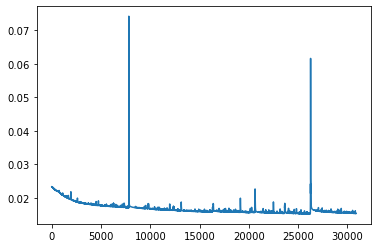

In [71]:
plt.plot(losses[9000:])

In [79]:
fake_sample = model(inputs0)

In [80]:
fake_sample.shape

torch.Size([256, 32])

In [74]:
targets0.shape

torch.Size([256, 32])

In [75]:
np.linalg.norm(np.eye(DATA_DIM)/COVARIANCE_SCALE - np.cov(fake_sample.detach().numpy().T))

0.3855016001985604

In [76]:
from pingouin import multivariate_normality
import pandas as pd
import numpy as np

In [86]:
Rr = fake_sample.detach().numpy()
arr = np.concatenate([Rr for i in range(10)])

In [90]:
targets0[:,-1]=0

In [95]:
multivariate_normality(targets0)[1]

0.0

In [62]:
optimizer = torch.optim.Adam(model.parameters(), lr = .005)

In [95]:
model.load_state_dict(state_dict, strict=False)

<All keys matched successfully>

In [81]:
import copy
state_dict = copy.deepcopy(model.state_dict())

# To load model


In [14]:
ld = '32'
with open('./training_process_dump/NP_SINKHORN_LAMBDA_2.0_LATENT_DIM_'+ld +'_initialization_he_BATCHSIZE1024.pkl', 'rb') as f:
    res = pkl.load(f)
accuracy_history = res[1]
res=res[0]

In [15]:
model.load_state_dict(torch.load('./models/NP_SINKHORN_LAMBDA_2.0_LATENT_DIM_32_initialization_he_BATCHSIZE256.pt'))
model.eval()

Generator(
  (hid1): Linear(in_features=32, out_features=64, bias=True)
  (act1): ReLU()
  (hid2): Linear(in_features=64, out_features=64, bias=True)
  (act2): ReLU()
  (hid3): Linear(in_features=64, out_features=64, bias=True)
  (act3): ReLU()
  (out): Linear(in_features=64, out_features=32, bias=True)
)

Epoch: 0, iteration 0, loss 215.307, cov_diff 6.985 cov_diff train 67.598
Epoch: 0, iteration 1, loss 4946.343, cov_diff 64.529 cov_diff train 0.967
Epoch: 0, iteration 2, loss 26.443, cov_diff 1.009 cov_diff train 0.961
Epoch: 0, iteration 3, loss 20.331, cov_diff 0.962 cov_diff train 0.961
Epoch: 0, iteration 4, loss 19.077, cov_diff 0.961 cov_diff train 0.966
Epoch: 0, iteration 5, loss 19.513, cov_diff 0.967 cov_diff train 0.963
Epoch: 0, iteration 6, loss 19.473, cov_diff 0.961 cov_diff train 0.968
Epoch: 0, iteration 7, loss 19.913, cov_diff 0.968 cov_diff train 0.967
Epoch: 0, iteration 8, loss 19.230, cov_diff 0.967 cov_diff train 0.964
Epoch: 0, iteration 9, loss 19.256, cov_diff 0.963 cov_diff train 0.966
Epoch: 0, iteration 10, loss 18.947, cov_diff 0.969 cov_diff train 0.967
Epoch: 0, iteration 11, loss 19.357, cov_diff 0.966 cov_diff train 0.969
Epoch: 0, iteration 12, loss 19.069, cov_diff 0.966 cov_diff train 0.965
Epoch: 0, iteration 13, loss 19.323, cov_diff 0.968 cov_

Epoch: 0, iteration 119, loss 19.093, cov_diff 0.974 cov_diff train 0.974
Epoch: 0, iteration 120, loss 19.307, cov_diff 0.977 cov_diff train 0.978
Epoch: 0, iteration 121, loss 19.278, cov_diff 0.973 cov_diff train 0.973
Epoch: 0, iteration 122, loss 18.914, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 123, loss 19.200, cov_diff 0.975 cov_diff train 0.975
Epoch: 0, iteration 124, loss 19.254, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 125, loss 18.715, cov_diff 0.978 cov_diff train 0.978
Epoch: 0, iteration 126, loss 18.776, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 127, loss 19.022, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 128, loss 19.440, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 129, loss 19.163, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 130, loss 18.928, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 131, loss 19.011, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 132, loss 19.603, 

Epoch: 0, iteration 245, loss 19.162, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 246, loss 19.326, cov_diff 0.978 cov_diff train 0.978
Epoch: 0, iteration 247, loss 19.374, cov_diff 0.979 cov_diff train 0.978
Epoch: 0, iteration 248, loss 19.488, cov_diff 0.978 cov_diff train 0.978
Epoch: 0, iteration 249, loss 18.476, cov_diff 0.975 cov_diff train 0.976
Epoch: 0, iteration 250, loss 18.831, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 251, loss 18.873, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 252, loss 19.210, cov_diff 0.975 cov_diff train 0.975
Epoch: 0, iteration 253, loss 19.174, cov_diff 0.978 cov_diff train 0.978
Epoch: 0, iteration 254, loss 19.661, cov_diff 0.979 cov_diff train 0.978
Epoch: 0, iteration 255, loss 18.831, cov_diff 0.977 cov_diff train 0.978
Epoch: 0, iteration 256, loss 19.171, cov_diff 0.977 cov_diff train 0.977
Epoch: 0, iteration 257, loss 19.519, cov_diff 0.978 cov_diff train 0.978
Epoch: 0, iteration 258, loss 19.654, 

Epoch: 0, iteration 359, loss 19.075, cov_diff 0.976 cov_diff train 0.975
Epoch: 0, iteration 360, loss 18.907, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 361, loss 19.599, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 362, loss 18.685, cov_diff 0.976 cov_diff train 0.976
Epoch: 0, iteration 363, loss 18.513, cov_diff 0.975 cov_diff train 0.974
Epoch: 0, iteration 364, loss 19.335, cov_diff 0.974 cov_diff train 0.974
Epoch: 0, iteration 365, loss 18.509, cov_diff 0.975 cov_diff train 0.974
Epoch: 0, iteration 366, loss 19.231, cov_diff 0.974 cov_diff train 0.975
Epoch: 0, iteration 367, loss 18.955, cov_diff 0.975 cov_diff train 0.975
Epoch: 0, iteration 368, loss 18.903, cov_diff 0.973 cov_diff train 0.974
Epoch: 0, iteration 369, loss 19.021, cov_diff 0.974 cov_diff train 0.974
Epoch: 0, iteration 370, loss 18.523, cov_diff 0.975 cov_diff train 0.976
Epoch: 0, iteration 371, loss 19.108, cov_diff 0.978 cov_diff train 0.977
Epoch: 0, iteration 372, loss 19.236, 

Epoch: 1, iteration 86, loss 19.095, cov_diff 0.973 cov_diff train 0.973
Epoch: 1, iteration 87, loss 18.918, cov_diff 0.971 cov_diff train 0.971
Epoch: 1, iteration 88, loss 19.396, cov_diff 0.971 cov_diff train 0.972
Epoch: 1, iteration 89, loss 18.646, cov_diff 0.972 cov_diff train 0.972
Epoch: 1, iteration 90, loss 19.400, cov_diff 0.975 cov_diff train 0.974
Epoch: 1, iteration 91, loss 19.718, cov_diff 0.970 cov_diff train 0.970
Epoch: 1, iteration 92, loss 18.838, cov_diff 0.975 cov_diff train 0.974
Epoch: 1, iteration 93, loss 19.316, cov_diff 0.969 cov_diff train 0.972
Epoch: 1, iteration 94, loss 19.438, cov_diff 0.970 cov_diff train 0.970
Epoch: 1, iteration 95, loss 19.126, cov_diff 0.970 cov_diff train 0.969
Epoch: 1, iteration 96, loss 19.680, cov_diff 0.974 cov_diff train 0.972
Epoch: 1, iteration 97, loss 19.243, cov_diff 0.969 cov_diff train 0.970
Epoch: 1, iteration 98, loss 19.548, cov_diff 0.970 cov_diff train 0.970
Epoch: 1, iteration 99, loss 18.977, cov_diff 0.969

Epoch: 1, iteration 199, loss 19.364, cov_diff 0.969 cov_diff train 0.968
Epoch: 1, iteration 200, loss 18.790, cov_diff 0.962 cov_diff train 0.963
Epoch: 1, iteration 201, loss 18.814, cov_diff 0.966 cov_diff train 0.968
Epoch: 1, iteration 202, loss 19.009, cov_diff 0.971 cov_diff train 0.969
Epoch: 1, iteration 203, loss 18.881, cov_diff 0.970 cov_diff train 0.970
Epoch: 1, iteration 204, loss 18.827, cov_diff 0.968 cov_diff train 0.969
Epoch: 1, iteration 205, loss 19.479, cov_diff 0.967 cov_diff train 0.965
Epoch: 1, iteration 206, loss 18.994, cov_diff 0.967 cov_diff train 0.968
Epoch: 1, iteration 207, loss 18.251, cov_diff 0.964 cov_diff train 0.967
Epoch: 1, iteration 208, loss 19.139, cov_diff 0.967 cov_diff train 0.966
Epoch: 1, iteration 209, loss 19.134, cov_diff 0.967 cov_diff train 0.969
Epoch: 1, iteration 210, loss 19.290, cov_diff 0.967 cov_diff train 0.967
Epoch: 1, iteration 211, loss 19.510, cov_diff 0.970 cov_diff train 0.969
Epoch: 1, iteration 212, loss 19.210, 

Epoch: 1, iteration 315, loss 18.761, cov_diff 0.968 cov_diff train 0.966
Epoch: 1, iteration 316, loss 18.331, cov_diff 0.969 cov_diff train 0.969
Epoch: 1, iteration 317, loss 18.936, cov_diff 0.971 cov_diff train 0.970
Epoch: 1, iteration 318, loss 18.953, cov_diff 0.969 cov_diff train 0.967
Epoch: 1, iteration 319, loss 19.551, cov_diff 0.968 cov_diff train 0.968
Epoch: 1, iteration 320, loss 19.283, cov_diff 0.969 cov_diff train 0.968
Epoch: 1, iteration 321, loss 19.157, cov_diff 0.966 cov_diff train 0.967
Epoch: 1, iteration 322, loss 19.451, cov_diff 0.967 cov_diff train 0.968
Epoch: 1, iteration 323, loss 18.643, cov_diff 0.970 cov_diff train 0.970
Epoch: 1, iteration 324, loss 19.390, cov_diff 0.965 cov_diff train 0.966
Epoch: 1, iteration 325, loss 19.049, cov_diff 0.971 cov_diff train 0.969
Epoch: 1, iteration 326, loss 18.404, cov_diff 0.969 cov_diff train 0.968
Epoch: 1, iteration 327, loss 18.208, cov_diff 0.963 cov_diff train 0.966
Epoch: 1, iteration 328, loss 19.013, 

Epoch: 2, iteration 41, loss 18.680, cov_diff 0.973 cov_diff train 0.970
Epoch: 2, iteration 42, loss 19.100, cov_diff 0.967 cov_diff train 0.968
Epoch: 2, iteration 43, loss 18.915, cov_diff 0.968 cov_diff train 0.967
Epoch: 2, iteration 44, loss 19.532, cov_diff 0.966 cov_diff train 0.968
Epoch: 2, iteration 45, loss 19.363, cov_diff 0.969 cov_diff train 0.966
Epoch: 2, iteration 46, loss 19.164, cov_diff 0.970 cov_diff train 0.968
Epoch: 2, iteration 47, loss 18.782, cov_diff 0.965 cov_diff train 0.967
Epoch: 2, iteration 48, loss 20.111, cov_diff 0.968 cov_diff train 0.970
Epoch: 2, iteration 49, loss 19.201, cov_diff 0.965 cov_diff train 0.967
Epoch: 2, iteration 50, loss 19.791, cov_diff 0.969 cov_diff train 0.969
Epoch: 2, iteration 51, loss 18.464, cov_diff 0.969 cov_diff train 0.970
Epoch: 2, iteration 52, loss 19.099, cov_diff 0.968 cov_diff train 0.966
Epoch: 2, iteration 53, loss 19.115, cov_diff 0.965 cov_diff train 0.968
Epoch: 2, iteration 54, loss 18.661, cov_diff 0.967

Epoch: 2, iteration 164, loss 18.566, cov_diff 0.964 cov_diff train 0.965
Epoch: 2, iteration 165, loss 19.218, cov_diff 0.961 cov_diff train 0.964
Epoch: 2, iteration 166, loss 18.269, cov_diff 0.970 cov_diff train 0.966
Epoch: 2, iteration 167, loss 19.618, cov_diff 0.966 cov_diff train 0.967
Epoch: 2, iteration 168, loss 18.701, cov_diff 0.962 cov_diff train 0.967
Epoch: 2, iteration 169, loss 19.402, cov_diff 0.969 cov_diff train 0.968
Epoch: 2, iteration 170, loss 18.494, cov_diff 0.967 cov_diff train 0.965
Epoch: 2, iteration 171, loss 19.306, cov_diff 0.965 cov_diff train 0.965
Epoch: 2, iteration 172, loss 18.976, cov_diff 0.965 cov_diff train 0.969
Epoch: 2, iteration 173, loss 18.638, cov_diff 0.963 cov_diff train 0.969
Epoch: 2, iteration 174, loss 19.458, cov_diff 0.974 cov_diff train 0.968
Epoch: 2, iteration 175, loss 18.954, cov_diff 0.965 cov_diff train 0.963
Epoch: 2, iteration 176, loss 19.112, cov_diff 0.967 cov_diff train 0.963
Epoch: 2, iteration 177, loss 19.078, 

Epoch: 2, iteration 290, loss 18.990, cov_diff 0.965 cov_diff train 0.960
Epoch: 2, iteration 291, loss 19.612, cov_diff 0.955 cov_diff train 0.955
Epoch: 2, iteration 292, loss 19.459, cov_diff 0.956 cov_diff train 0.963
Epoch: 2, iteration 293, loss 19.260, cov_diff 0.960 cov_diff train 0.966
Epoch: 2, iteration 294, loss 19.001, cov_diff 0.971 cov_diff train 0.969
Epoch: 2, iteration 295, loss 19.283, cov_diff 0.966 cov_diff train 0.965
Epoch: 2, iteration 296, loss 19.207, cov_diff 0.966 cov_diff train 0.964
Epoch: 2, iteration 297, loss 18.833, cov_diff 0.964 cov_diff train 0.969
Epoch: 2, iteration 298, loss 19.493, cov_diff 0.969 cov_diff train 0.966
Epoch: 2, iteration 299, loss 19.064, cov_diff 0.965 cov_diff train 0.962
Epoch: 2, iteration 300, loss 19.136, cov_diff 0.961 cov_diff train 0.962
Epoch: 2, iteration 301, loss 18.734, cov_diff 0.965 cov_diff train 0.970
Epoch: 2, iteration 302, loss 19.187, cov_diff 0.958 cov_diff train 0.964
Epoch: 2, iteration 303, loss 18.999, 

Epoch: 3, iteration 20, loss 19.334, cov_diff 0.964 cov_diff train 0.961
Epoch: 3, iteration 21, loss 18.931, cov_diff 0.959 cov_diff train 0.966
Epoch: 3, iteration 22, loss 19.002, cov_diff 0.963 cov_diff train 0.960
Epoch: 3, iteration 23, loss 18.639, cov_diff 0.967 cov_diff train 0.969
Epoch: 3, iteration 24, loss 18.688, cov_diff 0.972 cov_diff train 0.973
Epoch: 3, iteration 25, loss 19.220, cov_diff 0.968 cov_diff train 0.965
Epoch: 3, iteration 26, loss 19.173, cov_diff 0.965 cov_diff train 0.963
Epoch: 3, iteration 27, loss 19.251, cov_diff 0.964 cov_diff train 0.959
Epoch: 3, iteration 28, loss 19.259, cov_diff 0.962 cov_diff train 0.966
Epoch: 3, iteration 29, loss 19.317, cov_diff 0.967 cov_diff train 0.967
Epoch: 3, iteration 30, loss 19.810, cov_diff 0.965 cov_diff train 0.962
Epoch: 3, iteration 31, loss 18.617, cov_diff 0.964 cov_diff train 0.966
Epoch: 3, iteration 32, loss 18.253, cov_diff 0.960 cov_diff train 0.964
Epoch: 3, iteration 33, loss 18.535, cov_diff 0.969

Epoch: 3, iteration 148, loss 19.648, cov_diff 0.980 cov_diff train 0.982
Epoch: 3, iteration 149, loss 19.527, cov_diff 0.983 cov_diff train 0.980
Epoch: 3, iteration 150, loss 19.527, cov_diff 0.981 cov_diff train 0.981
Epoch: 3, iteration 151, loss 19.187, cov_diff 0.983 cov_diff train 0.981
Epoch: 3, iteration 152, loss 19.323, cov_diff 0.979 cov_diff train 0.979
Epoch: 3, iteration 153, loss 18.743, cov_diff 0.984 cov_diff train 0.978
Epoch: 3, iteration 154, loss 18.869, cov_diff 0.976 cov_diff train 0.975
Epoch: 3, iteration 155, loss 18.780, cov_diff 0.973 cov_diff train 0.975
Epoch: 3, iteration 156, loss 19.132, cov_diff 0.977 cov_diff train 0.975
Epoch: 3, iteration 157, loss 19.282, cov_diff 0.973 cov_diff train 0.981
Epoch: 3, iteration 158, loss 18.884, cov_diff 0.978 cov_diff train 0.977
Epoch: 3, iteration 159, loss 18.720, cov_diff 0.980 cov_diff train 0.978
Epoch: 3, iteration 160, loss 19.338, cov_diff 0.981 cov_diff train 0.976
Epoch: 3, iteration 161, loss 19.484, 

Epoch: 3, iteration 268, loss 19.353, cov_diff 0.984 cov_diff train 0.983
Epoch: 3, iteration 269, loss 18.751, cov_diff 0.982 cov_diff train 0.987
Epoch: 3, iteration 270, loss 19.433, cov_diff 0.983 cov_diff train 0.977
Epoch: 3, iteration 271, loss 19.462, cov_diff 0.979 cov_diff train 0.983
Epoch: 3, iteration 272, loss 19.428, cov_diff 0.982 cov_diff train 0.986
Epoch: 3, iteration 273, loss 19.483, cov_diff 0.988 cov_diff train 0.984
Epoch: 3, iteration 274, loss 19.372, cov_diff 0.982 cov_diff train 0.985
Epoch: 3, iteration 275, loss 19.338, cov_diff 0.987 cov_diff train 0.981
Epoch: 3, iteration 276, loss 19.340, cov_diff 0.978 cov_diff train 0.979
Epoch: 3, iteration 277, loss 19.329, cov_diff 0.978 cov_diff train 0.982
Epoch: 3, iteration 278, loss 18.642, cov_diff 0.987 cov_diff train 0.979
Epoch: 3, iteration 279, loss 18.835, cov_diff 0.985 cov_diff train 0.977
Epoch: 3, iteration 280, loss 19.397, cov_diff 0.978 cov_diff train 0.987
Epoch: 3, iteration 281, loss 18.719, 

Epoch: 3, iteration 390, loss 10.643, cov_diff 0.998 cov_diff train 0.997
Epoch: 4, iteration 0, loss 18.872, cov_diff 0.994 cov_diff train 0.991
Epoch: 4, iteration 1, loss 19.561, cov_diff 0.990 cov_diff train 0.991
Epoch: 4, iteration 2, loss 19.192, cov_diff 0.990 cov_diff train 0.993
Epoch: 4, iteration 3, loss 18.848, cov_diff 0.992 cov_diff train 0.993
Epoch: 4, iteration 4, loss 18.716, cov_diff 0.997 cov_diff train 0.995
Epoch: 4, iteration 5, loss 19.667, cov_diff 0.994 cov_diff train 0.994
Epoch: 4, iteration 6, loss 18.848, cov_diff 0.989 cov_diff train 0.989
Epoch: 4, iteration 7, loss 18.524, cov_diff 0.992 cov_diff train 0.991
Epoch: 4, iteration 8, loss 19.134, cov_diff 0.990 cov_diff train 0.994
Epoch: 4, iteration 9, loss 18.725, cov_diff 0.996 cov_diff train 0.993
Epoch: 4, iteration 10, loss 18.831, cov_diff 0.995 cov_diff train 0.989
Epoch: 4, iteration 11, loss 19.649, cov_diff 0.989 cov_diff train 0.988
Epoch: 4, iteration 12, loss 19.695, cov_diff 0.989 cov_diff

Epoch: 4, iteration 125, loss 19.045, cov_diff 0.999 cov_diff train 0.998
Epoch: 4, iteration 126, loss 18.585, cov_diff 0.995 cov_diff train 0.999
Epoch: 4, iteration 127, loss 18.821, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 128, loss 19.401, cov_diff 0.999 cov_diff train 0.999
Epoch: 4, iteration 129, loss 18.951, cov_diff 0.999 cov_diff train 0.999
Epoch: 4, iteration 130, loss 19.079, cov_diff 0.999 cov_diff train 0.998
Epoch: 4, iteration 131, loss 19.342, cov_diff 0.998 cov_diff train 0.998
Epoch: 4, iteration 132, loss 18.742, cov_diff 0.997 cov_diff train 0.996
Epoch: 4, iteration 133, loss 19.473, cov_diff 0.999 cov_diff train 0.997
Epoch: 4, iteration 134, loss 19.120, cov_diff 0.997 cov_diff train 0.982
Epoch: 4, iteration 135, loss 19.390, cov_diff 0.983 cov_diff train 0.994
Epoch: 4, iteration 136, loss 18.559, cov_diff 0.994 cov_diff train 1.000
Epoch: 4, iteration 137, loss 19.481, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 138, loss 19.132, 

Epoch: 4, iteration 243, loss 19.527, cov_diff 0.996 cov_diff train 0.997
Epoch: 4, iteration 244, loss 19.157, cov_diff 0.997 cov_diff train 0.993
Epoch: 4, iteration 245, loss 19.019, cov_diff 0.995 cov_diff train 0.994
Epoch: 4, iteration 246, loss 19.462, cov_diff 0.994 cov_diff train 0.999
Epoch: 4, iteration 247, loss 19.387, cov_diff 0.998 cov_diff train 0.997
Epoch: 4, iteration 248, loss 20.019, cov_diff 0.997 cov_diff train 0.997
Epoch: 4, iteration 249, loss 19.534, cov_diff 0.997 cov_diff train 0.998
Epoch: 4, iteration 250, loss 19.244, cov_diff 0.998 cov_diff train 0.997
Epoch: 4, iteration 251, loss 19.528, cov_diff 0.998 cov_diff train 0.998
Epoch: 4, iteration 252, loss 18.837, cov_diff 0.999 cov_diff train 0.998
Epoch: 4, iteration 253, loss 19.116, cov_diff 0.998 cov_diff train 0.996
Epoch: 4, iteration 254, loss 18.960, cov_diff 0.997 cov_diff train 0.996
Epoch: 4, iteration 255, loss 19.429, cov_diff 0.996 cov_diff train 0.999
Epoch: 4, iteration 256, loss 19.560, 

Epoch: 4, iteration 364, loss 19.194, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 365, loss 19.378, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 366, loss 19.357, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 367, loss 18.986, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 368, loss 19.449, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 369, loss 18.875, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 370, loss 19.267, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 371, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 372, loss 19.466, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 373, loss 19.267, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 374, loss 19.608, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 375, loss 18.837, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 376, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 4, iteration 377, loss 19.075, 

Epoch: 5, iteration 98, loss 19.049, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 99, loss 19.663, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 100, loss 18.779, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 101, loss 19.010, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 102, loss 18.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 103, loss 19.277, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 104, loss 19.697, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 105, loss 19.485, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 106, loss 20.090, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 107, loss 18.783, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 108, loss 19.342, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 109, loss 19.156, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 110, loss 18.991, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 111, loss 18.943, co

Epoch: 5, iteration 224, loss 18.990, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 225, loss 19.297, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 226, loss 19.587, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 227, loss 18.925, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 228, loss 18.996, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 229, loss 18.804, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 230, loss 19.501, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 231, loss 19.138, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 232, loss 19.377, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 233, loss 19.159, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 234, loss 18.746, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 235, loss 19.212, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 236, loss 19.370, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 237, loss 19.544, 

Epoch: 5, iteration 342, loss 18.920, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 343, loss 19.174, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 344, loss 18.483, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 345, loss 19.002, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 346, loss 18.927, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 347, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 348, loss 19.498, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 349, loss 18.738, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 350, loss 18.772, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 351, loss 19.548, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 352, loss 19.085, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 353, loss 19.547, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 354, loss 18.946, cov_diff 1.000 cov_diff train 1.000
Epoch: 5, iteration 355, loss 18.888, 

Epoch: 6, iteration 76, loss 18.724, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 77, loss 19.656, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 78, loss 18.766, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 79, loss 19.058, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 80, loss 19.490, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 81, loss 19.187, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 82, loss 18.750, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 83, loss 19.034, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 84, loss 19.171, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 85, loss 19.019, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 86, loss 19.421, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 87, loss 19.191, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 88, loss 18.518, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 89, loss 19.071, cov_diff 1.000

Epoch: 6, iteration 202, loss 18.658, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 203, loss 19.336, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 204, loss 19.157, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 205, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 206, loss 19.213, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 207, loss 19.165, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 208, loss 19.025, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 209, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 210, loss 18.893, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 211, loss 19.268, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 212, loss 18.400, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 213, loss 18.961, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 214, loss 19.431, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 215, loss 19.159, 

Epoch: 6, iteration 329, loss 19.057, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 330, loss 18.801, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 331, loss 19.115, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 332, loss 19.130, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 333, loss 18.896, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 334, loss 19.110, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 335, loss 18.949, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 336, loss 18.895, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 337, loss 18.776, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 338, loss 18.927, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 339, loss 20.152, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 340, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 341, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 6, iteration 342, loss 19.542, 

Epoch: 7, iteration 51, loss 18.341, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 52, loss 19.286, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 53, loss 19.287, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 54, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 55, loss 19.012, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 56, loss 18.852, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 57, loss 19.203, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 58, loss 18.949, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 59, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 60, loss 19.357, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 61, loss 18.406, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 62, loss 19.348, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 63, loss 18.879, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 64, loss 19.916, cov_diff 1.000

Epoch: 7, iteration 166, loss 18.618, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 167, loss 18.561, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 168, loss 19.107, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 169, loss 18.701, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 170, loss 19.796, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 171, loss 18.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 172, loss 18.983, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 173, loss 19.616, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 174, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 175, loss 18.860, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 176, loss 19.149, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 177, loss 19.705, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 178, loss 19.297, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 179, loss 19.260, 

Epoch: 7, iteration 289, loss 18.948, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 290, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 291, loss 20.014, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 292, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 293, loss 20.117, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 294, loss 19.717, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 295, loss 18.850, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 296, loss 19.291, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 297, loss 19.340, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 298, loss 19.419, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 299, loss 19.208, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 300, loss 18.848, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 301, loss 19.365, cov_diff 1.000 cov_diff train 1.000
Epoch: 7, iteration 302, loss 18.957, 

Epoch: 8, iteration 15, loss 19.321, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 16, loss 19.296, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 17, loss 19.502, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 18, loss 19.714, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 19, loss 18.922, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 20, loss 19.061, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 21, loss 19.098, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 22, loss 18.718, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 23, loss 18.287, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 24, loss 19.523, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 25, loss 19.491, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 26, loss 18.780, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 27, loss 19.233, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 28, loss 19.732, cov_diff 1.000

Epoch: 8, iteration 141, loss 19.335, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 142, loss 19.036, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 143, loss 19.123, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 144, loss 18.914, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 145, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 146, loss 19.152, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 147, loss 18.852, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 148, loss 18.845, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 149, loss 19.178, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 150, loss 19.323, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 151, loss 19.643, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 152, loss 19.118, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 153, loss 18.964, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 154, loss 19.465, 

Epoch: 8, iteration 258, loss 19.208, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 259, loss 19.171, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 260, loss 18.595, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 261, loss 18.882, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 262, loss 19.629, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 263, loss 19.132, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 264, loss 18.800, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 265, loss 19.658, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 266, loss 19.512, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 267, loss 18.987, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 268, loss 19.203, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 269, loss 19.151, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 270, loss 18.782, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 271, loss 18.723, 

Epoch: 8, iteration 380, loss 18.571, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 381, loss 18.688, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 382, loss 19.576, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 383, loss 19.509, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 384, loss 18.802, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 385, loss 19.455, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 386, loss 18.731, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 387, loss 18.486, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 388, loss 18.900, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 389, loss 18.908, cov_diff 1.000 cov_diff train 1.000
Epoch: 8, iteration 390, loss 10.539, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 0, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 1, loss 19.187, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 2, loss 18.986, cov_di

Epoch: 9, iteration 113, loss 19.183, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 114, loss 19.143, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 115, loss 18.767, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 116, loss 19.178, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 117, loss 19.546, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 118, loss 19.309, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 119, loss 19.557, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 120, loss 19.106, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 121, loss 18.979, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 122, loss 19.286, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 123, loss 19.486, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 124, loss 18.995, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 125, loss 19.070, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 126, loss 18.765, 

Epoch: 9, iteration 237, loss 19.456, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 238, loss 19.270, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 239, loss 19.469, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 240, loss 19.300, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 241, loss 19.100, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 242, loss 18.777, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 243, loss 19.678, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 244, loss 19.642, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 245, loss 19.457, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 246, loss 18.817, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 247, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 248, loss 18.946, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 249, loss 19.136, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 250, loss 18.712, 

Epoch: 9, iteration 356, loss 18.665, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 357, loss 18.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 358, loss 19.078, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 359, loss 18.813, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 360, loss 19.574, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 361, loss 18.935, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 362, loss 18.824, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 363, loss 19.214, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 364, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 365, loss 19.215, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 366, loss 19.326, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 367, loss 19.262, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 368, loss 19.089, cov_diff 1.000 cov_diff train 1.000
Epoch: 9, iteration 369, loss 19.012, 

Epoch: 10, iteration 80, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 81, loss 19.202, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 82, loss 18.796, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 83, loss 19.481, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 84, loss 19.774, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 85, loss 19.319, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 86, loss 18.729, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 87, loss 18.935, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 88, loss 19.180, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 89, loss 19.153, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 90, loss 19.289, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 91, loss 19.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 92, loss 18.545, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 93, loss 19.331, 

Epoch: 10, iteration 192, loss 18.991, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 193, loss 19.059, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 194, loss 19.278, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 195, loss 19.668, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 196, loss 19.331, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 197, loss 19.254, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 198, loss 19.487, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 199, loss 19.560, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 200, loss 19.193, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 201, loss 18.806, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 202, loss 19.270, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 203, loss 18.365, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 204, loss 18.768, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 205,

Epoch: 10, iteration 322, loss 18.912, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 323, loss 18.781, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 324, loss 18.509, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 325, loss 19.685, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 326, loss 18.858, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 327, loss 18.659, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 328, loss 18.922, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 329, loss 19.074, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 330, loss 19.281, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 331, loss 19.162, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 332, loss 18.821, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 333, loss 18.542, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 334, loss 19.296, cov_diff 1.000 cov_diff train 1.000
Epoch: 10, iteration 335,

Epoch: 11, iteration 45, loss 19.104, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 46, loss 19.165, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 47, loss 19.516, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 48, loss 19.365, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 49, loss 19.400, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 50, loss 19.511, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 51, loss 19.322, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 52, loss 19.318, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 53, loss 18.651, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 54, loss 19.141, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 55, loss 18.808, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 56, loss 19.002, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 57, loss 19.545, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 58, loss 19.060, 

Epoch: 11, iteration 156, loss 18.603, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 157, loss 18.736, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 158, loss 19.356, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 159, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 160, loss 18.987, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 161, loss 19.179, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 162, loss 19.726, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 163, loss 19.105, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 164, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 165, loss 19.444, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 166, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 167, loss 18.723, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 168, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 169,

Epoch: 11, iteration 275, loss 19.659, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 276, loss 19.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 277, loss 19.064, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 278, loss 19.141, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 279, loss 18.791, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 280, loss 18.632, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 281, loss 19.295, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 282, loss 18.468, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 283, loss 19.209, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 284, loss 18.948, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 285, loss 18.815, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 286, loss 18.512, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 287, loss 18.403, cov_diff 1.000 cov_diff train 1.000
Epoch: 11, iteration 288,

Epoch: 12, iteration 0, loss 18.803, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 1, loss 19.468, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 2, loss 19.029, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 3, loss 19.382, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 4, loss 18.994, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 5, loss 19.023, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 6, loss 19.918, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 7, loss 19.456, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 8, loss 19.567, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 9, loss 18.460, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 10, loss 18.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 11, loss 19.333, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 12, loss 18.690, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 13, loss 19.413, cov_diff 1

Epoch: 12, iteration 126, loss 19.589, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 127, loss 19.085, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 128, loss 19.022, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 129, loss 19.578, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 130, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 131, loss 18.803, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 132, loss 19.088, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 133, loss 18.521, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 134, loss 19.538, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 135, loss 18.857, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 136, loss 19.506, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 137, loss 19.298, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 138, loss 18.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 139,

Epoch: 12, iteration 251, loss 19.133, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 252, loss 19.744, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 253, loss 18.219, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 254, loss 19.527, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 255, loss 19.717, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 256, loss 18.885, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 257, loss 19.154, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 258, loss 19.324, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 259, loss 19.623, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 260, loss 19.459, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 261, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 262, loss 19.418, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 263, loss 18.524, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 264,

Epoch: 12, iteration 376, loss 19.746, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 377, loss 19.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 378, loss 19.211, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 379, loss 18.778, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 380, loss 19.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 381, loss 19.032, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 382, loss 18.754, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 383, loss 19.277, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 384, loss 19.804, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 385, loss 18.705, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 386, loss 18.112, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 387, loss 19.301, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 388, loss 18.646, cov_diff 1.000 cov_diff train 1.000
Epoch: 12, iteration 389,

Epoch: 13, iteration 100, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 101, loss 19.583, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 102, loss 20.150, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 103, loss 19.703, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 104, loss 19.247, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 105, loss 18.637, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 106, loss 19.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 107, loss 19.361, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 108, loss 18.840, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 109, loss 19.316, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 110, loss 19.389, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 111, loss 19.104, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 112, loss 19.434, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 113,

Epoch: 13, iteration 223, loss 18.852, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 224, loss 19.378, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 225, loss 19.345, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 226, loss 18.788, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 227, loss 18.854, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 228, loss 20.008, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 229, loss 19.779, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 230, loss 18.653, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 231, loss 19.143, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 232, loss 18.601, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 233, loss 19.555, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 234, loss 19.339, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 235, loss 19.059, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 236,

Epoch: 13, iteration 344, loss 19.283, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 345, loss 19.704, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 346, loss 18.719, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 347, loss 19.221, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 348, loss 19.404, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 349, loss 19.507, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 350, loss 18.730, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 351, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 352, loss 18.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 353, loss 18.502, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 354, loss 18.715, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 355, loss 18.643, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 356, loss 19.300, cov_diff 1.000 cov_diff train 1.000
Epoch: 13, iteration 357,

Epoch: 14, iteration 83, loss 19.332, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 84, loss 19.058, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 85, loss 18.773, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 86, loss 19.103, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 87, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 88, loss 19.015, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 89, loss 18.984, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 90, loss 19.387, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 91, loss 18.905, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 92, loss 19.487, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 93, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 94, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 95, loss 19.282, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 96, loss 18.787, 

Epoch: 14, iteration 205, loss 18.901, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 206, loss 19.694, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 207, loss 19.026, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 208, loss 19.048, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 209, loss 19.080, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 210, loss 19.552, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 211, loss 19.402, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 212, loss 18.930, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 213, loss 19.682, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 214, loss 19.445, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 215, loss 19.505, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 216, loss 19.578, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 217, loss 18.706, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 218,

Epoch: 14, iteration 331, loss 19.525, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 332, loss 19.223, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 333, loss 19.468, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 334, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 335, loss 19.018, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 336, loss 19.074, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 337, loss 19.227, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 338, loss 19.178, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 339, loss 19.051, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 340, loss 19.137, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 341, loss 18.698, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 342, loss 18.849, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 343, loss 18.687, cov_diff 1.000 cov_diff train 1.000
Epoch: 14, iteration 344,

Epoch: 15, iteration 64, loss 19.169, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 65, loss 19.502, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 66, loss 18.699, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 67, loss 19.491, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 68, loss 19.393, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 69, loss 19.451, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 70, loss 19.656, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 71, loss 19.663, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 72, loss 19.574, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 73, loss 18.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 74, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 75, loss 19.740, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 76, loss 19.309, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 77, loss 19.132, 

Epoch: 15, iteration 184, loss 19.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 185, loss 18.743, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 186, loss 19.738, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 187, loss 18.909, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 188, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 189, loss 19.588, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 190, loss 18.878, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 191, loss 19.069, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 192, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 193, loss 19.546, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 194, loss 19.526, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 195, loss 18.775, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 196, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 197,

Epoch: 15, iteration 308, loss 19.277, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 309, loss 19.027, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 310, loss 18.864, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 311, loss 18.982, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 312, loss 18.954, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 313, loss 18.879, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 314, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 315, loss 19.510, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 316, loss 19.527, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 317, loss 18.771, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 318, loss 19.475, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 319, loss 18.186, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 320, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 15, iteration 321,

Epoch: 16, iteration 41, loss 18.430, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 42, loss 19.595, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 43, loss 19.604, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 44, loss 19.497, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 45, loss 18.539, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 46, loss 19.190, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 47, loss 19.316, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 48, loss 19.115, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 49, loss 18.747, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 50, loss 18.921, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 51, loss 19.239, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 52, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 53, loss 19.311, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 54, loss 18.910, 

Epoch: 16, iteration 168, loss 19.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 169, loss 19.256, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 170, loss 18.480, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 171, loss 19.544, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 172, loss 19.324, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 173, loss 19.128, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 174, loss 19.849, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 175, loss 19.208, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 176, loss 19.503, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 177, loss 19.446, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 178, loss 19.415, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 179, loss 18.579, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 180, loss 19.499, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 181,

Epoch: 16, iteration 293, loss 18.482, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 294, loss 18.782, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 295, loss 19.037, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 296, loss 18.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 297, loss 19.515, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 298, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 299, loss 18.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 300, loss 19.193, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 301, loss 19.288, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 302, loss 18.675, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 303, loss 18.964, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 304, loss 19.087, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 305, loss 18.813, cov_diff 1.000 cov_diff train 1.000
Epoch: 16, iteration 306,

Epoch: 17, iteration 16, loss 19.433, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 17, loss 19.162, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 18, loss 18.894, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 19, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 20, loss 19.100, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 21, loss 19.120, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 22, loss 19.372, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 23, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 24, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 25, loss 19.075, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 26, loss 18.951, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 27, loss 19.278, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 28, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 29, loss 19.542, 

Epoch: 17, iteration 136, loss 18.993, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 137, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 138, loss 19.250, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 139, loss 18.875, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 140, loss 18.588, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 141, loss 19.507, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 142, loss 19.450, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 143, loss 19.296, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 144, loss 19.522, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 145, loss 19.203, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 146, loss 19.194, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 147, loss 19.721, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 148, loss 18.947, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 149,

Epoch: 17, iteration 255, loss 19.205, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 256, loss 19.279, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 257, loss 19.124, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 258, loss 18.834, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 259, loss 19.383, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 260, loss 19.334, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 261, loss 18.289, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 262, loss 19.361, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 263, loss 19.492, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 264, loss 18.818, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 265, loss 18.771, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 266, loss 19.408, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 267, loss 18.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 268,

Epoch: 17, iteration 375, loss 18.198, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 376, loss 19.732, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 377, loss 18.774, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 378, loss 19.559, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 379, loss 19.411, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 380, loss 19.542, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 381, loss 19.391, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 382, loss 18.708, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 383, loss 19.794, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 384, loss 18.947, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 385, loss 19.592, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 386, loss 18.921, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 387, loss 19.466, cov_diff 1.000 cov_diff train 1.000
Epoch: 17, iteration 388,

Epoch: 18, iteration 102, loss 19.110, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 103, loss 19.163, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 104, loss 19.229, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 105, loss 18.885, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 106, loss 19.265, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 107, loss 19.509, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 108, loss 19.096, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 109, loss 18.680, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 110, loss 19.293, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 111, loss 19.754, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 112, loss 18.979, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 113, loss 19.399, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 114, loss 18.518, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 115,

Epoch: 18, iteration 220, loss 19.119, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 221, loss 19.582, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 222, loss 19.881, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 223, loss 18.710, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 224, loss 19.021, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 225, loss 19.822, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 226, loss 18.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 227, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 228, loss 18.842, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 229, loss 19.218, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 230, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 231, loss 18.894, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 232, loss 18.974, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 233,

Epoch: 18, iteration 345, loss 18.990, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 346, loss 18.916, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 347, loss 19.095, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 348, loss 19.993, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 349, loss 19.279, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 350, loss 18.756, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 351, loss 19.291, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 352, loss 18.811, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 353, loss 18.837, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 354, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 355, loss 19.136, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 356, loss 19.040, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 357, loss 19.134, cov_diff 1.000 cov_diff train 1.000
Epoch: 18, iteration 358,

Epoch: 19, iteration 85, loss 19.222, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 86, loss 19.476, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 87, loss 19.250, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 88, loss 19.386, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 89, loss 19.339, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 90, loss 19.705, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 91, loss 19.157, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 92, loss 19.484, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 93, loss 18.825, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 94, loss 19.069, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 95, loss 19.088, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 96, loss 19.396, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 97, loss 18.585, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 98, loss 19.233, 

Epoch: 19, iteration 210, loss 19.340, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 211, loss 19.396, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 212, loss 18.760, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 213, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 214, loss 19.632, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 215, loss 19.067, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 216, loss 19.395, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 217, loss 19.279, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 218, loss 19.659, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 219, loss 19.107, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 220, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 221, loss 19.168, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 222, loss 19.219, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 223,

Epoch: 19, iteration 336, loss 19.179, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 337, loss 18.965, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 338, loss 18.972, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 339, loss 19.174, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 340, loss 18.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 341, loss 19.444, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 342, loss 18.630, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 343, loss 19.358, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 344, loss 19.519, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 345, loss 18.703, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 346, loss 18.737, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 347, loss 18.861, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 348, loss 19.133, cov_diff 1.000 cov_diff train 1.000
Epoch: 19, iteration 349,

Epoch: 20, iteration 72, loss 19.053, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 73, loss 19.058, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 74, loss 19.016, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 75, loss 19.114, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 76, loss 19.526, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 77, loss 19.064, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 78, loss 19.068, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 79, loss 19.269, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 80, loss 19.439, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 81, loss 19.437, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 82, loss 20.377, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 83, loss 19.364, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 84, loss 19.538, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 85, loss 18.922, 

Epoch: 20, iteration 184, loss 19.378, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 185, loss 19.104, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 186, loss 19.347, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 187, loss 19.892, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 188, loss 19.463, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 189, loss 19.079, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 190, loss 19.225, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 191, loss 18.906, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 192, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 193, loss 19.093, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 194, loss 19.067, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 195, loss 18.924, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 196, loss 19.008, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 197,

Epoch: 20, iteration 303, loss 18.559, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 304, loss 18.990, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 305, loss 19.190, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 306, loss 19.277, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 307, loss 18.829, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 308, loss 19.061, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 309, loss 19.005, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 310, loss 19.250, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 311, loss 19.102, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 312, loss 18.933, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 313, loss 18.925, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 314, loss 19.418, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 315, loss 18.445, cov_diff 1.000 cov_diff train 1.000
Epoch: 20, iteration 316,

Epoch: 21, iteration 22, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 23, loss 19.204, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 24, loss 19.237, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 25, loss 19.215, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 26, loss 18.618, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 27, loss 18.591, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 28, loss 18.608, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 29, loss 18.827, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 30, loss 19.852, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 31, loss 19.688, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 32, loss 19.027, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 33, loss 19.123, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 34, loss 18.818, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 35, loss 18.965, 

Epoch: 21, iteration 147, loss 19.253, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 148, loss 19.170, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 149, loss 19.638, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 150, loss 19.686, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 151, loss 19.215, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 152, loss 19.431, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 153, loss 19.426, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 154, loss 18.586, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 155, loss 19.149, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 156, loss 19.038, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 157, loss 18.984, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 158, loss 18.735, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 159, loss 19.400, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 160,

Epoch: 21, iteration 272, loss 19.369, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 273, loss 19.420, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 274, loss 19.364, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 275, loss 19.393, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 276, loss 18.772, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 277, loss 19.387, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 278, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 279, loss 19.268, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 280, loss 19.074, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 281, loss 19.674, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 282, loss 19.017, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 283, loss 18.617, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 284, loss 19.225, cov_diff 1.000 cov_diff train 1.000
Epoch: 21, iteration 285,

Epoch: 22, iteration 0, loss 19.385, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 1, loss 18.865, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 2, loss 19.649, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 3, loss 18.616, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 4, loss 19.293, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 5, loss 18.877, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 6, loss 20.004, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 7, loss 19.448, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 8, loss 19.200, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 9, loss 19.151, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 10, loss 19.636, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 11, loss 19.623, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 12, loss 18.998, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 13, loss 19.363, cov_diff 1

Epoch: 22, iteration 126, loss 19.177, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 127, loss 19.450, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 128, loss 18.697, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 129, loss 19.410, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 130, loss 19.112, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 131, loss 19.010, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 132, loss 18.377, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 133, loss 19.439, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 134, loss 19.312, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 135, loss 19.251, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 136, loss 19.601, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 137, loss 19.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 138, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 139,

Epoch: 22, iteration 251, loss 19.181, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 252, loss 19.867, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 253, loss 19.352, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 254, loss 19.446, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 255, loss 18.817, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 256, loss 19.019, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 257, loss 18.925, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 258, loss 19.242, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 259, loss 19.290, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 260, loss 19.108, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 261, loss 19.368, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 262, loss 19.169, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 263, loss 19.422, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 264,

Epoch: 22, iteration 376, loss 19.244, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 377, loss 19.577, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 378, loss 18.977, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 379, loss 19.320, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 380, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 381, loss 19.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 382, loss 19.210, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 383, loss 18.572, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 384, loss 18.573, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 385, loss 19.176, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 386, loss 18.496, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 387, loss 18.765, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 388, loss 19.444, cov_diff 1.000 cov_diff train 1.000
Epoch: 22, iteration 389,

Epoch: 23, iteration 103, loss 19.047, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 104, loss 19.047, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 105, loss 19.627, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 106, loss 19.466, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 107, loss 19.197, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 108, loss 19.374, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 109, loss 19.098, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 110, loss 18.992, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 111, loss 19.030, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 112, loss 19.459, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 113, loss 18.785, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 114, loss 19.361, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 115, loss 19.604, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 116,

Epoch: 23, iteration 221, loss 19.509, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 222, loss 19.529, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 223, loss 19.269, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 224, loss 18.349, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 225, loss 18.940, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 226, loss 19.183, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 227, loss 18.538, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 228, loss 19.481, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 229, loss 18.686, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 230, loss 19.442, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 231, loss 18.628, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 232, loss 18.717, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 233, loss 19.381, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 234,

Epoch: 23, iteration 346, loss 18.354, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 347, loss 18.515, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 348, loss 19.068, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 349, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 350, loss 19.052, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 351, loss 19.736, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 352, loss 19.169, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 353, loss 18.867, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 354, loss 19.143, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 355, loss 18.848, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 356, loss 19.042, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 357, loss 19.668, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 358, loss 18.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 23, iteration 359,

Epoch: 24, iteration 77, loss 18.721, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 78, loss 19.576, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 79, loss 19.167, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 80, loss 19.167, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 81, loss 19.291, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 82, loss 18.884, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 83, loss 19.439, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 84, loss 18.668, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 85, loss 19.302, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 86, loss 19.131, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 87, loss 19.134, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 88, loss 19.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 89, loss 19.057, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 90, loss 19.518, 

Epoch: 24, iteration 201, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 202, loss 18.929, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 203, loss 19.221, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 204, loss 19.111, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 205, loss 19.266, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 206, loss 18.566, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 207, loss 18.956, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 208, loss 18.979, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 209, loss 19.603, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 210, loss 19.691, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 211, loss 19.229, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 212, loss 19.315, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 213, loss 19.321, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 214,

Epoch: 24, iteration 320, loss 19.318, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 321, loss 19.127, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 322, loss 19.085, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 323, loss 19.127, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 324, loss 19.872, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 325, loss 19.802, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 326, loss 19.253, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 327, loss 19.140, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 328, loss 19.401, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 329, loss 19.605, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 330, loss 18.709, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 331, loss 19.204, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 332, loss 19.357, cov_diff 1.000 cov_diff train 1.000
Epoch: 24, iteration 333,

Epoch: 25, iteration 41, loss 19.298, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 42, loss 19.322, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 43, loss 19.107, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 44, loss 18.974, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 45, loss 19.328, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 46, loss 18.670, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 47, loss 18.308, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 48, loss 19.116, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 49, loss 18.582, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 50, loss 19.111, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 51, loss 19.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 52, loss 19.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 53, loss 19.447, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 54, loss 18.782, 

Epoch: 25, iteration 165, loss 19.403, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 166, loss 19.293, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 167, loss 19.065, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 168, loss 18.700, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 169, loss 18.900, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 170, loss 18.745, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 171, loss 18.685, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 172, loss 19.194, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 173, loss 19.419, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 174, loss 19.243, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 175, loss 19.176, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 176, loss 18.871, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 177, loss 19.284, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 178,

Epoch: 25, iteration 292, loss 18.908, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 293, loss 18.618, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 294, loss 19.057, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 295, loss 18.863, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 296, loss 18.844, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 297, loss 18.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 298, loss 19.040, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 299, loss 19.627, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 300, loss 19.079, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 301, loss 19.469, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 302, loss 19.748, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 303, loss 18.538, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 304, loss 18.897, cov_diff 1.000 cov_diff train 1.000
Epoch: 25, iteration 305,

Epoch: 26, iteration 21, loss 19.460, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 22, loss 19.199, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 23, loss 18.437, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 24, loss 19.354, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 25, loss 19.380, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 26, loss 19.028, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 27, loss 18.715, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 28, loss 19.174, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 29, loss 18.999, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 30, loss 19.045, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 31, loss 18.973, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 32, loss 19.311, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 33, loss 19.207, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 34, loss 19.380, 

Epoch: 26, iteration 133, loss 19.150, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 134, loss 19.201, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 135, loss 19.055, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 136, loss 19.673, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 137, loss 19.402, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 138, loss 19.478, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 139, loss 19.642, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 140, loss 19.084, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 141, loss 19.482, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 142, loss 19.201, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 143, loss 19.534, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 144, loss 19.266, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 145, loss 19.305, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 146,

Epoch: 26, iteration 247, loss 19.564, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 248, loss 18.618, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 249, loss 19.025, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 250, loss 19.487, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 251, loss 19.104, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 252, loss 19.063, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 253, loss 18.813, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 254, loss 18.886, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 255, loss 19.079, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 256, loss 19.634, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 257, loss 18.662, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 258, loss 19.267, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 259, loss 19.592, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 260,

Epoch: 26, iteration 365, loss 18.895, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 366, loss 19.536, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 367, loss 18.682, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 368, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 369, loss 18.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 370, loss 19.265, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 371, loss 19.077, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 372, loss 19.317, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 373, loss 19.420, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 374, loss 18.850, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 375, loss 19.107, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 376, loss 18.923, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 377, loss 19.295, cov_diff 1.000 cov_diff train 1.000
Epoch: 26, iteration 378,

Epoch: 27, iteration 100, loss 18.491, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 101, loss 19.236, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 102, loss 18.755, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 103, loss 19.556, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 104, loss 19.461, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 105, loss 18.150, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 106, loss 18.880, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 107, loss 19.335, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 108, loss 19.255, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 109, loss 19.180, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 110, loss 18.999, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 111, loss 19.495, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 112, loss 19.142, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 113,

Epoch: 27, iteration 218, loss 18.831, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 219, loss 18.872, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 220, loss 19.350, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 221, loss 19.390, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 222, loss 19.604, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 223, loss 19.401, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 224, loss 19.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 225, loss 18.640, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 226, loss 19.072, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 227, loss 18.626, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 228, loss 18.931, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 229, loss 18.966, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 230, loss 19.209, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 231,

Epoch: 27, iteration 335, loss 19.127, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 336, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 337, loss 19.363, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 338, loss 18.263, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 339, loss 19.525, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 340, loss 18.864, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 341, loss 19.489, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 342, loss 19.094, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 343, loss 18.873, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 344, loss 18.937, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 345, loss 19.000, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 346, loss 19.395, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 347, loss 18.925, cov_diff 1.000 cov_diff train 1.000
Epoch: 27, iteration 348,

Epoch: 28, iteration 62, loss 18.588, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 63, loss 19.237, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 64, loss 19.706, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 65, loss 18.628, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 66, loss 19.015, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 67, loss 18.829, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 68, loss 19.221, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 69, loss 19.332, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 70, loss 19.242, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 71, loss 19.903, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 72, loss 19.108, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 73, loss 19.409, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 74, loss 19.679, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 75, loss 19.109, 

Epoch: 28, iteration 182, loss 19.296, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 183, loss 18.627, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 184, loss 18.780, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 185, loss 19.108, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 186, loss 19.208, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 187, loss 18.704, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 188, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 189, loss 18.862, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 190, loss 19.339, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 191, loss 19.534, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 192, loss 18.567, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 193, loss 19.375, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 194, loss 19.098, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 195,

Epoch: 28, iteration 306, loss 18.830, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 307, loss 19.771, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 308, loss 19.390, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 309, loss 19.239, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 310, loss 19.481, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 311, loss 18.375, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 312, loss 18.357, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 313, loss 19.284, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 314, loss 19.341, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 315, loss 18.963, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 316, loss 19.377, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 317, loss 18.514, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 318, loss 19.042, cov_diff 1.000 cov_diff train 1.000
Epoch: 28, iteration 319,

Epoch: 29, iteration 42, loss 18.529, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 43, loss 18.843, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 44, loss 19.734, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 45, loss 18.793, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 46, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 47, loss 19.161, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 48, loss 18.989, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 49, loss 19.899, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 50, loss 19.465, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 51, loss 18.494, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 52, loss 19.225, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 53, loss 19.055, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 54, loss 19.488, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 55, loss 18.910, 

Epoch: 29, iteration 167, loss 19.221, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 168, loss 19.001, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 169, loss 19.145, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 170, loss 18.977, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 171, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 172, loss 19.908, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 173, loss 18.205, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 174, loss 19.420, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 175, loss 19.584, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 176, loss 18.641, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 177, loss 19.486, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 178, loss 19.286, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 179, loss 18.894, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 180,

Epoch: 29, iteration 281, loss 19.185, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 282, loss 19.139, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 283, loss 18.692, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 284, loss 19.453, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 285, loss 19.268, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 286, loss 19.667, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 287, loss 19.306, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 288, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 289, loss 19.828, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 290, loss 18.719, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 291, loss 19.215, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 292, loss 19.342, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 293, loss 18.669, cov_diff 1.000 cov_diff train 1.000
Epoch: 29, iteration 294,

Epoch: 30, iteration 0, loss 19.814, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 1, loss 18.827, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 2, loss 19.400, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 3, loss 19.292, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 4, loss 18.482, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 5, loss 20.163, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 6, loss 18.842, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 7, loss 18.998, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 8, loss 18.726, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 9, loss 19.078, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 10, loss 18.941, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 11, loss 19.202, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 12, loss 19.755, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 13, loss 19.369, cov_diff 1

Epoch: 30, iteration 125, loss 18.523, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 126, loss 19.342, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 127, loss 19.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 128, loss 19.642, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 129, loss 19.909, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 130, loss 19.028, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 131, loss 18.741, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 132, loss 18.919, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 133, loss 19.087, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 134, loss 18.969, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 135, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 136, loss 19.481, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 137, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 138,

Epoch: 30, iteration 250, loss 19.916, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 251, loss 18.902, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 252, loss 18.969, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 253, loss 19.154, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 254, loss 19.177, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 255, loss 19.718, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 256, loss 19.307, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 257, loss 19.001, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 258, loss 19.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 259, loss 19.368, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 260, loss 18.994, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 261, loss 19.836, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 262, loss 19.129, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 263,

Epoch: 30, iteration 371, loss 19.491, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 372, loss 19.283, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 373, loss 18.719, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 374, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 375, loss 19.165, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 376, loss 18.937, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 377, loss 18.574, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 378, loss 19.198, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 379, loss 19.472, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 380, loss 18.781, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 381, loss 18.901, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 382, loss 19.053, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 383, loss 19.041, cov_diff 1.000 cov_diff train 1.000
Epoch: 30, iteration 384,

Epoch: 31, iteration 96, loss 19.266, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 97, loss 19.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 98, loss 19.641, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 99, loss 19.005, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 100, loss 19.748, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 101, loss 18.779, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 102, loss 18.659, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 103, loss 19.018, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 104, loss 18.524, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 105, loss 18.599, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 106, loss 19.842, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 107, loss 18.736, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 108, loss 18.636, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 109, los

Epoch: 31, iteration 209, loss 18.944, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 210, loss 19.453, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 211, loss 19.122, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 212, loss 19.043, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 213, loss 19.245, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 214, loss 19.636, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 215, loss 19.395, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 216, loss 19.433, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 217, loss 18.603, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 218, loss 19.200, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 219, loss 19.202, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 220, loss 19.062, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 221, loss 18.918, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 222,

Epoch: 31, iteration 326, loss 19.354, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 327, loss 18.827, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 328, loss 18.854, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 329, loss 19.744, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 330, loss 19.346, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 331, loss 19.471, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 332, loss 19.022, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 333, loss 19.311, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 334, loss 18.869, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 335, loss 18.434, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 336, loss 19.292, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 337, loss 19.469, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 338, loss 19.314, cov_diff 1.000 cov_diff train 1.000
Epoch: 31, iteration 339,

Epoch: 32, iteration 62, loss 19.313, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 63, loss 19.777, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 64, loss 19.058, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 65, loss 19.514, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 66, loss 18.897, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 67, loss 18.735, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 68, loss 19.118, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 69, loss 18.620, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 70, loss 19.066, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 71, loss 19.308, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 72, loss 19.028, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 73, loss 18.791, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 74, loss 18.058, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 75, loss 19.314, 

Epoch: 32, iteration 188, loss 19.635, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 189, loss 19.238, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 190, loss 19.767, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 191, loss 18.932, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 192, loss 18.869, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 193, loss 19.171, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 194, loss 18.544, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 195, loss 19.598, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 196, loss 18.993, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 197, loss 19.138, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 198, loss 18.542, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 199, loss 19.322, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 200, loss 19.262, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 201,

Epoch: 32, iteration 313, loss 19.389, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 314, loss 19.720, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 315, loss 19.266, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 316, loss 18.711, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 317, loss 19.791, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 318, loss 18.789, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 319, loss 18.611, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 320, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 321, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 322, loss 19.033, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 323, loss 19.042, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 324, loss 19.645, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 325, loss 19.182, cov_diff 1.000 cov_diff train 1.000
Epoch: 32, iteration 326,

Epoch: 33, iteration 41, loss 18.939, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 42, loss 18.976, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 43, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 44, loss 18.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 45, loss 18.986, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 46, loss 18.833, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 47, loss 19.467, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 48, loss 19.750, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 49, loss 18.962, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 50, loss 19.347, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 51, loss 18.890, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 52, loss 19.287, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 53, loss 19.130, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 54, loss 19.386, 

Epoch: 33, iteration 164, loss 19.550, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 165, loss 18.560, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 166, loss 18.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 167, loss 19.085, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 168, loss 18.774, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 169, loss 18.922, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 170, loss 19.222, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 171, loss 19.263, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 172, loss 19.514, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 173, loss 19.292, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 174, loss 19.133, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 175, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 176, loss 18.811, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 177,

Epoch: 33, iteration 289, loss 18.887, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 290, loss 19.566, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 291, loss 19.135, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 292, loss 19.576, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 293, loss 18.873, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 294, loss 19.718, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 295, loss 18.656, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 296, loss 19.385, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 297, loss 18.720, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 298, loss 18.815, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 299, loss 19.250, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 300, loss 18.686, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 301, loss 20.468, cov_diff 1.000 cov_diff train 1.000
Epoch: 33, iteration 302,

Epoch: 34, iteration 21, loss 19.488, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 22, loss 19.425, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 23, loss 19.010, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 24, loss 18.662, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 25, loss 18.776, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 26, loss 18.862, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 27, loss 19.537, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 28, loss 18.986, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 29, loss 18.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 30, loss 19.284, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 31, loss 19.378, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 32, loss 19.592, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 33, loss 19.112, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 34, loss 19.091, 

Epoch: 34, iteration 146, loss 19.052, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 147, loss 19.338, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 148, loss 19.022, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 149, loss 19.537, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 150, loss 19.359, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 151, loss 19.619, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 152, loss 19.476, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 153, loss 19.174, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 154, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 155, loss 19.055, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 156, loss 19.083, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 157, loss 18.838, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 158, loss 19.314, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 159,

Epoch: 34, iteration 272, loss 19.939, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 273, loss 19.370, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 274, loss 19.490, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 275, loss 18.328, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 276, loss 19.201, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 277, loss 18.518, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 278, loss 19.166, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 279, loss 18.954, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 280, loss 19.314, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 281, loss 19.057, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 282, loss 18.973, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 283, loss 19.022, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 284, loss 18.362, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 285,

Epoch: 34, iteration 389, loss 18.940, cov_diff 1.000 cov_diff train 1.000
Epoch: 34, iteration 390, loss 10.408, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 0, loss 19.343, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 1, loss 18.890, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 2, loss 19.287, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 3, loss 19.143, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 4, loss 19.095, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 5, loss 19.554, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 6, loss 19.062, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 7, loss 19.485, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 8, loss 19.026, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 9, loss 19.471, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 10, loss 18.672, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 11, loss 19.362, cov_diff

Epoch: 35, iteration 117, loss 19.653, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 118, loss 19.485, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 119, loss 19.413, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 120, loss 19.479, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 121, loss 18.582, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 122, loss 19.364, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 123, loss 18.971, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 124, loss 18.658, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 125, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 126, loss 18.472, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 127, loss 19.348, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 128, loss 18.816, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 129, loss 19.178, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 130,

Epoch: 35, iteration 239, loss 19.713, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 240, loss 18.712, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 241, loss 19.196, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 242, loss 19.694, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 243, loss 19.399, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 244, loss 19.047, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 245, loss 18.586, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 246, loss 18.976, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 247, loss 19.493, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 248, loss 19.382, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 249, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 250, loss 18.835, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 251, loss 19.422, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 252,

Epoch: 35, iteration 361, loss 19.151, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 362, loss 19.600, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 363, loss 19.042, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 364, loss 19.473, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 365, loss 18.974, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 366, loss 19.396, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 367, loss 19.030, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 368, loss 19.097, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 369, loss 19.615, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 370, loss 19.185, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 371, loss 18.780, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 372, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 373, loss 19.944, cov_diff 1.000 cov_diff train 1.000
Epoch: 35, iteration 374,

Epoch: 36, iteration 84, loss 19.157, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 85, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 86, loss 19.888, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 87, loss 19.559, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 88, loss 19.280, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 89, loss 18.956, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 90, loss 18.995, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 91, loss 19.018, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 92, loss 18.853, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 93, loss 19.131, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 94, loss 19.152, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 95, loss 19.061, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 96, loss 19.376, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 97, loss 19.660, 

Epoch: 36, iteration 207, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 208, loss 19.857, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 209, loss 19.590, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 210, loss 19.314, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 211, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 212, loss 19.356, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 213, loss 18.521, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 214, loss 19.523, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 215, loss 19.769, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 216, loss 18.900, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 217, loss 19.245, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 218, loss 19.333, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 219, loss 18.770, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 220,

Epoch: 36, iteration 329, loss 19.229, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 330, loss 19.021, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 331, loss 18.655, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 332, loss 18.654, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 333, loss 19.495, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 334, loss 19.661, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 335, loss 19.778, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 336, loss 19.536, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 337, loss 18.965, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 338, loss 19.187, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 339, loss 19.333, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 340, loss 18.783, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 341, loss 19.354, cov_diff 1.000 cov_diff train 1.000
Epoch: 36, iteration 342,

Epoch: 37, iteration 62, loss 19.410, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 63, loss 19.206, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 64, loss 19.326, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 65, loss 19.470, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 66, loss 19.051, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 67, loss 19.116, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 68, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 69, loss 19.127, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 70, loss 19.247, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 71, loss 18.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 72, loss 19.216, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 73, loss 19.518, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 74, loss 18.971, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 75, loss 19.108, 

Epoch: 37, iteration 187, loss 18.972, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 188, loss 19.046, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 189, loss 18.930, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 190, loss 18.530, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 191, loss 18.905, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 192, loss 18.765, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 193, loss 18.826, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 194, loss 18.863, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 195, loss 19.061, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 196, loss 19.587, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 197, loss 18.698, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 198, loss 19.279, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 199, loss 18.767, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 200,

Epoch: 37, iteration 310, loss 19.027, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 311, loss 19.124, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 312, loss 18.906, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 313, loss 18.973, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 314, loss 19.293, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 315, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 316, loss 18.797, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 317, loss 19.005, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 318, loss 19.216, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 319, loss 18.784, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 320, loss 19.281, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 321, loss 19.731, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 322, loss 19.243, cov_diff 1.000 cov_diff train 1.000
Epoch: 37, iteration 323,

Epoch: 38, iteration 35, loss 19.357, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 36, loss 19.530, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 37, loss 19.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 38, loss 19.657, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 39, loss 18.808, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 40, loss 19.102, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 41, loss 18.892, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 42, loss 19.477, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 43, loss 19.412, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 44, loss 18.969, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 45, loss 18.945, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 46, loss 18.827, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 47, loss 18.739, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 48, loss 18.888, 

Epoch: 38, iteration 159, loss 19.415, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 160, loss 18.873, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 161, loss 18.858, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 162, loss 19.261, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 163, loss 19.620, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 164, loss 18.614, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 165, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 166, loss 19.346, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 167, loss 19.238, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 168, loss 19.577, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 169, loss 18.994, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 170, loss 19.276, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 171, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 172,

Epoch: 38, iteration 283, loss 19.149, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 284, loss 19.185, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 285, loss 18.981, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 286, loss 18.918, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 287, loss 19.236, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 288, loss 18.764, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 289, loss 19.088, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 290, loss 19.199, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 291, loss 18.719, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 292, loss 18.738, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 293, loss 18.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 294, loss 19.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 295, loss 19.280, cov_diff 1.000 cov_diff train 1.000
Epoch: 38, iteration 296,

Epoch: 39, iteration 21, loss 17.918, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 22, loss 18.965, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 23, loss 18.762, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 24, loss 19.126, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 25, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 26, loss 18.926, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 27, loss 19.299, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 28, loss 18.720, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 29, loss 19.181, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 30, loss 18.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 31, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 32, loss 18.538, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 33, loss 18.684, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 34, loss 18.928, 

Epoch: 39, iteration 144, loss 18.887, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 145, loss 19.080, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 146, loss 18.923, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 147, loss 19.535, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 148, loss 18.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 149, loss 19.094, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 150, loss 18.887, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 151, loss 19.050, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 152, loss 19.541, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 153, loss 19.160, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 154, loss 18.963, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 155, loss 18.750, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 156, loss 19.197, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 157,

Epoch: 39, iteration 267, loss 18.257, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 268, loss 18.371, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 269, loss 19.368, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 270, loss 18.377, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 271, loss 18.982, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 272, loss 18.734, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 273, loss 19.081, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 274, loss 19.244, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 275, loss 18.588, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 276, loss 19.023, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 277, loss 18.990, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 278, loss 19.419, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 279, loss 19.846, cov_diff 1.000 cov_diff train 1.000
Epoch: 39, iteration 280,

Epoch: 40, iteration 0, loss 19.832, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 1, loss 18.952, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 2, loss 19.230, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 3, loss 19.693, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 4, loss 19.076, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 5, loss 18.527, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 6, loss 19.242, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 7, loss 19.530, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 8, loss 19.733, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 9, loss 18.736, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 10, loss 19.122, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 11, loss 18.766, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 12, loss 19.152, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 13, loss 19.501, cov_diff 1

Epoch: 40, iteration 122, loss 19.207, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 123, loss 19.144, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 124, loss 19.167, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 125, loss 19.153, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 126, loss 19.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 127, loss 18.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 128, loss 18.976, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 129, loss 18.187, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 130, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 131, loss 18.674, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 132, loss 18.740, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 133, loss 19.250, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 134, loss 19.016, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 135,

Epoch: 40, iteration 247, loss 18.558, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 248, loss 19.395, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 249, loss 19.434, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 250, loss 19.222, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 251, loss 18.935, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 252, loss 18.817, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 253, loss 19.030, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 254, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 255, loss 18.721, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 256, loss 19.174, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 257, loss 19.327, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 258, loss 19.147, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 259, loss 18.284, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 260,

Epoch: 40, iteration 371, loss 19.345, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 372, loss 19.004, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 373, loss 18.959, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 374, loss 19.019, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 375, loss 19.253, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 376, loss 18.671, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 377, loss 19.083, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 378, loss 19.207, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 379, loss 19.014, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 380, loss 18.679, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 381, loss 18.904, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 382, loss 19.123, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 383, loss 18.811, cov_diff 1.000 cov_diff train 1.000
Epoch: 40, iteration 384,

Epoch: 41, iteration 100, loss 18.886, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 101, loss 19.119, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 102, loss 18.923, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 103, loss 19.309, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 104, loss 19.096, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 105, loss 19.334, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 106, loss 19.446, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 107, loss 19.413, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 108, loss 19.504, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 109, loss 19.134, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 110, loss 19.459, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 111, loss 18.654, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 112, loss 19.076, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 113,

Epoch: 41, iteration 224, loss 19.707, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 225, loss 18.509, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 226, loss 19.012, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 227, loss 19.778, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 228, loss 19.088, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 229, loss 18.811, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 230, loss 19.161, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 231, loss 18.726, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 232, loss 18.737, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 233, loss 19.415, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 234, loss 19.534, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 235, loss 19.198, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 236, loss 19.365, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 237,

Epoch: 41, iteration 345, loss 19.470, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 346, loss 19.116, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 347, loss 19.756, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 348, loss 18.764, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 349, loss 19.446, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 350, loss 18.976, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 351, loss 19.184, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 352, loss 19.410, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 353, loss 19.170, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 354, loss 18.934, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 355, loss 19.516, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 356, loss 19.334, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 357, loss 19.118, cov_diff 1.000 cov_diff train 1.000
Epoch: 41, iteration 358,

Epoch: 42, iteration 82, loss 19.089, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 83, loss 19.317, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 84, loss 19.054, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 85, loss 18.801, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 86, loss 19.114, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 87, loss 19.701, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 88, loss 18.739, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 89, loss 19.275, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 90, loss 19.596, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 91, loss 18.802, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 92, loss 19.467, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 93, loss 19.021, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 94, loss 19.096, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 95, loss 19.341, 

Epoch: 42, iteration 208, loss 18.916, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 209, loss 18.945, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 210, loss 18.932, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 211, loss 19.160, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 212, loss 18.972, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 213, loss 19.145, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 214, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 215, loss 18.860, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 216, loss 19.307, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 217, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 218, loss 18.403, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 219, loss 18.890, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 220, loss 18.725, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 221,

Epoch: 42, iteration 333, loss 19.496, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 334, loss 19.302, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 335, loss 19.476, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 336, loss 19.095, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 337, loss 18.971, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 338, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 339, loss 18.336, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 340, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 341, loss 18.402, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 342, loss 19.036, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 343, loss 18.696, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 344, loss 19.843, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 345, loss 19.048, cov_diff 1.000 cov_diff train 1.000
Epoch: 42, iteration 346,

Epoch: 43, iteration 62, loss 19.022, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 63, loss 18.871, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 64, loss 19.318, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 65, loss 19.623, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 66, loss 19.016, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 67, loss 18.993, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 68, loss 19.315, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 69, loss 18.184, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 70, loss 19.006, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 71, loss 19.409, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 72, loss 18.618, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 73, loss 18.803, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 74, loss 19.285, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 75, loss 19.799, 

Epoch: 43, iteration 187, loss 19.037, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 188, loss 19.919, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 189, loss 19.019, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 190, loss 19.246, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 191, loss 19.896, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 192, loss 19.243, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 193, loss 18.832, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 194, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 195, loss 19.586, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 196, loss 18.889, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 197, loss 18.930, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 198, loss 19.401, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 199, loss 19.023, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 200,

Epoch: 43, iteration 311, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 312, loss 18.716, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 313, loss 19.036, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 314, loss 18.726, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 315, loss 19.376, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 316, loss 18.714, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 317, loss 19.791, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 318, loss 19.144, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 319, loss 19.075, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 320, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 321, loss 19.255, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 322, loss 19.271, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 323, loss 18.949, cov_diff 1.000 cov_diff train 1.000
Epoch: 43, iteration 324,

Epoch: 44, iteration 38, loss 19.501, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 39, loss 19.063, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 40, loss 18.727, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 41, loss 19.327, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 42, loss 18.535, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 43, loss 19.219, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 44, loss 19.640, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 45, loss 19.177, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 46, loss 19.126, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 47, loss 19.312, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 48, loss 18.970, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 49, loss 18.806, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 50, loss 19.256, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 51, loss 19.070, 

Epoch: 44, iteration 162, loss 19.333, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 163, loss 19.445, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 164, loss 19.117, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 165, loss 19.497, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 166, loss 19.724, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 167, loss 18.952, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 168, loss 19.637, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 169, loss 19.414, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 170, loss 19.048, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 171, loss 18.860, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 172, loss 19.348, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 173, loss 19.261, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 174, loss 18.715, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 175,

Epoch: 44, iteration 280, loss 18.926, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 281, loss 18.967, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 282, loss 19.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 283, loss 18.676, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 284, loss 18.689, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 285, loss 18.917, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 286, loss 19.644, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 287, loss 19.480, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 288, loss 18.660, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 289, loss 18.907, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 290, loss 18.863, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 291, loss 18.619, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 292, loss 19.150, cov_diff 1.000 cov_diff train 1.000
Epoch: 44, iteration 293,

Epoch: 45, iteration 0, loss 19.198, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 1, loss 19.322, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 2, loss 19.156, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 3, loss 19.036, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 4, loss 18.586, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 5, loss 19.321, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 6, loss 19.039, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 7, loss 18.848, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 8, loss 19.297, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 9, loss 19.052, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 10, loss 19.456, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 11, loss 18.929, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 12, loss 19.551, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 13, loss 19.273, cov_diff 1

Epoch: 45, iteration 124, loss 19.094, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 125, loss 19.290, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 126, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 127, loss 19.166, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 128, loss 19.656, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 129, loss 18.805, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 130, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 131, loss 19.713, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 132, loss 19.510, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 133, loss 18.545, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 134, loss 19.335, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 135, loss 19.162, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 136, loss 19.331, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 137,

Epoch: 45, iteration 247, loss 19.415, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 248, loss 18.907, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 249, loss 19.214, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 250, loss 19.056, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 251, loss 19.290, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 252, loss 18.889, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 253, loss 18.672, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 254, loss 19.154, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 255, loss 19.433, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 256, loss 18.573, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 257, loss 19.032, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 258, loss 20.008, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 259, loss 19.206, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 260,

Epoch: 45, iteration 371, loss 18.852, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 372, loss 18.874, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 373, loss 18.563, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 374, loss 19.150, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 375, loss 19.248, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 376, loss 18.605, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 377, loss 18.700, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 378, loss 19.901, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 379, loss 18.717, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 380, loss 18.882, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 381, loss 19.037, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 382, loss 19.190, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 383, loss 19.066, cov_diff 1.000 cov_diff train 1.000
Epoch: 45, iteration 384,

Epoch: 46, iteration 102, loss 19.611, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 103, loss 18.920, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 104, loss 19.475, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 105, loss 18.682, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 106, loss 19.290, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 107, loss 19.471, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 108, loss 18.941, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 109, loss 19.367, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 110, loss 18.952, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 111, loss 18.830, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 112, loss 19.165, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 113, loss 18.863, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 114, loss 19.110, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 115,

Epoch: 46, iteration 223, loss 19.521, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 224, loss 19.394, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 225, loss 19.379, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 226, loss 19.400, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 227, loss 19.184, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 228, loss 19.398, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 229, loss 19.393, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 230, loss 18.938, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 231, loss 18.939, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 232, loss 19.134, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 233, loss 19.595, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 234, loss 19.206, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 235, loss 19.094, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 236,

Epoch: 46, iteration 347, loss 18.461, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 348, loss 19.354, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 349, loss 19.606, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 350, loss 19.418, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 351, loss 19.323, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 352, loss 18.717, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 353, loss 19.198, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 354, loss 18.943, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 355, loss 18.643, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 356, loss 19.350, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 357, loss 19.062, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 358, loss 19.325, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 359, loss 18.938, cov_diff 1.000 cov_diff train 1.000
Epoch: 46, iteration 360,

Epoch: 47, iteration 73, loss 19.017, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 74, loss 19.274, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 75, loss 18.749, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 76, loss 19.500, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 77, loss 19.200, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 78, loss 18.818, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 79, loss 19.175, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 80, loss 18.928, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 81, loss 19.736, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 82, loss 18.977, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 83, loss 19.517, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 84, loss 19.011, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 85, loss 19.208, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 86, loss 19.146, 

Epoch: 47, iteration 191, loss 19.792, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 192, loss 18.977, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 193, loss 19.197, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 194, loss 19.083, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 195, loss 19.113, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 196, loss 19.395, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 197, loss 18.237, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 198, loss 19.262, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 199, loss 19.363, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 200, loss 19.771, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 201, loss 18.624, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 202, loss 19.094, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 203, loss 18.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 204,

Epoch: 47, iteration 310, loss 19.567, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 311, loss 19.512, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 312, loss 19.633, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 313, loss 19.434, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 314, loss 19.471, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 315, loss 19.386, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 316, loss 19.095, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 317, loss 19.089, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 318, loss 19.146, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 319, loss 19.203, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 320, loss 19.097, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 321, loss 19.544, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 322, loss 18.930, cov_diff 1.000 cov_diff train 1.000
Epoch: 47, iteration 323,

Epoch: 48, iteration 42, loss 19.103, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 43, loss 18.984, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 44, loss 19.788, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 45, loss 19.214, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 46, loss 18.910, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 47, loss 18.553, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 48, loss 19.789, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 49, loss 19.829, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 50, loss 19.789, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 51, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 52, loss 19.032, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 53, loss 18.653, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 54, loss 18.945, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 55, loss 18.576, 

Epoch: 48, iteration 165, loss 18.534, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 166, loss 19.700, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 167, loss 19.449, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 168, loss 19.131, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 169, loss 18.819, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 170, loss 19.010, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 171, loss 19.372, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 172, loss 18.734, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 173, loss 18.827, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 174, loss 19.973, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 175, loss 19.728, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 176, loss 19.269, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 177, loss 18.394, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 178,

Epoch: 48, iteration 288, loss 18.990, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 289, loss 19.181, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 290, loss 18.898, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 291, loss 18.966, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 292, loss 19.106, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 293, loss 19.833, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 294, loss 18.879, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 295, loss 18.301, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 296, loss 19.801, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 297, loss 18.632, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 298, loss 19.136, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 299, loss 18.964, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 300, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 48, iteration 301,

Epoch: 49, iteration 19, loss 19.155, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 20, loss 19.063, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 21, loss 18.995, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 22, loss 19.571, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 23, loss 19.531, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 24, loss 19.633, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 25, loss 19.236, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 26, loss 18.627, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 27, loss 18.976, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 28, loss 18.947, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 29, loss 19.253, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 30, loss 19.142, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 31, loss 19.166, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 32, loss 19.051, 

Epoch: 49, iteration 133, loss 18.255, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 134, loss 19.307, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 135, loss 19.116, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 136, loss 19.576, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 137, loss 19.560, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 138, loss 18.460, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 139, loss 18.917, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 140, loss 19.008, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 141, loss 18.784, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 142, loss 19.012, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 143, loss 18.551, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 144, loss 18.466, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 145, loss 19.374, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 146,

Epoch: 49, iteration 255, loss 18.888, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 256, loss 18.519, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 257, loss 19.133, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 258, loss 18.732, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 259, loss 19.089, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 260, loss 18.633, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 261, loss 19.169, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 262, loss 18.951, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 263, loss 18.382, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 264, loss 19.134, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 265, loss 19.594, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 266, loss 19.252, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 267, loss 19.046, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 268,

Epoch: 49, iteration 381, loss 18.673, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 382, loss 19.272, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 383, loss 18.512, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 384, loss 19.221, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 385, loss 19.072, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 386, loss 18.977, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 387, loss 19.066, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 388, loss 18.617, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 389, loss 19.234, cov_diff 1.000 cov_diff train 1.000
Epoch: 49, iteration 390, loss 10.431, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 0, loss 19.280, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 1, loss 19.037, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 2, loss 19.081, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 3, loss 18

Epoch: 50, iteration 103, loss 19.193, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 104, loss 18.944, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 105, loss 18.683, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 106, loss 18.645, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 107, loss 19.598, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 108, loss 19.073, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 109, loss 19.012, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 110, loss 18.799, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 111, loss 18.998, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 112, loss 18.571, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 113, loss 18.465, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 114, loss 18.873, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 115, loss 19.857, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 116,

Epoch: 50, iteration 225, loss 19.078, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 226, loss 19.486, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 227, loss 19.060, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 228, loss 18.856, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 229, loss 19.312, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 230, loss 19.442, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 231, loss 19.053, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 232, loss 19.472, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 233, loss 18.630, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 234, loss 18.997, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 235, loss 19.518, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 236, loss 19.668, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 237, loss 18.453, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 238,

Epoch: 50, iteration 346, loss 19.418, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 347, loss 19.528, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 348, loss 19.584, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 349, loss 19.370, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 350, loss 18.714, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 351, loss 18.939, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 352, loss 18.871, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 353, loss 18.752, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 354, loss 19.121, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 355, loss 19.470, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 356, loss 19.213, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 357, loss 19.693, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 358, loss 19.818, cov_diff 1.000 cov_diff train 1.000
Epoch: 50, iteration 359,

Epoch: 51, iteration 81, loss 19.360, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 82, loss 18.569, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 83, loss 18.969, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 84, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 85, loss 19.542, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 86, loss 19.366, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 87, loss 19.708, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 88, loss 18.996, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 89, loss 19.228, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 90, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 91, loss 19.145, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 92, loss 19.164, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 93, loss 18.527, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 94, loss 19.296, 

Epoch: 51, iteration 204, loss 19.195, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 205, loss 18.777, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 206, loss 19.945, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 207, loss 18.696, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 208, loss 19.038, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 209, loss 19.585, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 210, loss 19.823, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 211, loss 19.310, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 212, loss 18.804, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 213, loss 19.730, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 214, loss 19.963, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 215, loss 18.845, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 216, loss 19.186, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 217,

Epoch: 51, iteration 329, loss 19.295, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 330, loss 19.072, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 331, loss 19.065, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 332, loss 19.333, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 333, loss 18.908, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 334, loss 19.222, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 335, loss 19.858, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 336, loss 19.426, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 337, loss 19.318, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 338, loss 18.946, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 339, loss 18.952, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 340, loss 19.361, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 341, loss 19.565, cov_diff 1.000 cov_diff train 1.000
Epoch: 51, iteration 342,

Epoch: 52, iteration 56, loss 18.586, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 57, loss 19.914, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 58, loss 18.804, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 59, loss 19.044, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 60, loss 19.561, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 61, loss 18.978, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 62, loss 19.625, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 63, loss 19.532, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 64, loss 19.570, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 65, loss 19.345, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 66, loss 19.488, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 67, loss 19.205, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 68, loss 19.456, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 69, loss 18.826, 

Epoch: 52, iteration 177, loss 19.414, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 178, loss 18.869, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 179, loss 18.729, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 180, loss 18.623, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 181, loss 19.086, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 182, loss 19.087, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 183, loss 19.276, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 184, loss 18.943, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 185, loss 18.856, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 186, loss 19.024, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 187, loss 18.646, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 188, loss 18.515, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 189, loss 19.124, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 190,

Epoch: 52, iteration 299, loss 18.868, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 300, loss 18.576, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 301, loss 19.048, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 302, loss 19.207, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 303, loss 19.287, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 304, loss 18.999, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 305, loss 19.365, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 306, loss 18.950, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 307, loss 19.452, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 308, loss 19.595, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 309, loss 18.696, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 310, loss 18.677, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 311, loss 19.072, cov_diff 1.000 cov_diff train 1.000
Epoch: 52, iteration 312,

Epoch: 53, iteration 21, loss 19.024, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 22, loss 19.371, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 23, loss 18.859, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 24, loss 18.848, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 25, loss 19.177, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 26, loss 19.464, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 27, loss 19.069, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 28, loss 18.668, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 29, loss 18.952, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 30, loss 18.791, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 31, loss 19.184, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 32, loss 19.600, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 33, loss 19.534, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 34, loss 18.620, 

Epoch: 53, iteration 147, loss 18.808, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 148, loss 18.750, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 149, loss 18.244, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 150, loss 19.258, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 151, loss 19.298, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 152, loss 19.549, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 153, loss 19.780, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 154, loss 19.042, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 155, loss 18.694, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 156, loss 18.438, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 157, loss 19.427, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 158, loss 19.127, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 159, loss 18.895, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 160,

Epoch: 53, iteration 271, loss 19.141, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 272, loss 19.477, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 273, loss 19.309, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 274, loss 18.749, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 275, loss 18.782, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 276, loss 18.924, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 277, loss 18.669, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 278, loss 19.298, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 279, loss 19.453, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 280, loss 18.470, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 281, loss 18.806, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 282, loss 19.277, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 283, loss 19.807, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 284,

Epoch: 53, iteration 388, loss 19.490, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 389, loss 18.677, cov_diff 1.000 cov_diff train 1.000
Epoch: 53, iteration 390, loss 10.440, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 0, loss 18.530, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 1, loss 19.122, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 2, loss 19.091, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 3, loss 18.637, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 4, loss 19.144, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 5, loss 19.309, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 6, loss 18.873, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 7, loss 19.921, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 8, loss 19.446, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 9, loss 18.502, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 10, loss 18.965, cov_dif

Epoch: 54, iteration 123, loss 18.906, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 124, loss 19.438, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 125, loss 18.915, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 126, loss 19.904, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 127, loss 19.149, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 128, loss 19.064, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 129, loss 18.621, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 130, loss 18.925, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 131, loss 19.741, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 132, loss 18.931, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 133, loss 19.080, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 134, loss 19.769, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 135, loss 18.959, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 136,

Epoch: 54, iteration 244, loss 19.031, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 245, loss 18.997, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 246, loss 18.951, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 247, loss 19.201, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 248, loss 18.364, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 249, loss 19.726, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 250, loss 19.188, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 251, loss 19.262, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 252, loss 19.201, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 253, loss 19.116, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 254, loss 19.273, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 255, loss 18.968, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 256, loss 18.934, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 257,

Epoch: 54, iteration 370, loss 19.790, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 371, loss 18.931, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 372, loss 19.437, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 373, loss 19.073, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 374, loss 19.084, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 375, loss 19.299, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 376, loss 18.920, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 377, loss 18.824, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 378, loss 18.702, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 379, loss 19.253, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 380, loss 19.474, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 381, loss 18.667, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 382, loss 18.901, cov_diff 1.000 cov_diff train 1.000
Epoch: 54, iteration 383,

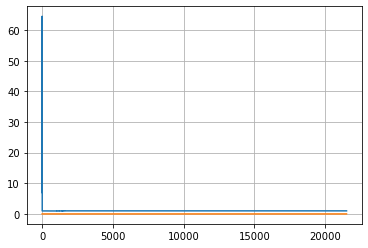

In [15]:
# iterate through all the epoch
epochs_passed = len(list(res['loss'].keys()))#to continue training 
for epoch in range(epochs_passed, epochs_passed+epochs):
    for key in res:
        if key != 'lambda':
            res[key][epoch] = []
    if epoch % 5 == 0 and epoch > 0:
        optimizer.param_groups[0]['lr'] /= 1.2
    # go through all the batches generated by dataloader
    for i, (inputs, targets) in enumerate(data_dl):
        # clear the gradients
        optimizer.zero_grad()
        # compute the model output
        yhat = model(inputs)
        # calculate loss
        loss = criterion(torch.transpose(yhat, 0,1), torch.transpose(targets,0,1))
        cov_diff = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
        # credit assignment
        loss.backward()
        # update model weights
        optimizer.step()
        yhat = model(inputs)
        cov_diff2 = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
        print("Epoch: {}, iteration {}, loss {:.3f}, cov_diff {:.3f} cov_diff train {:.3f}".format(epoch,i, 
                                                            float(loss), float(cov_diff), float(cov_diff2)))
        res['loss'][epoch].append(loss)
        res['sample'][epoch].append(np.array(yhat.data))
        res['cov_diff'][epoch].append(cov_diff)
    cov_diff_all += res['cov_diff'][epoch]
    with open('./training_process_dump/' + model_name + '.pkl', 'wb') as f:
        pkl.dump(res, f)
    
    plt.clf()
    plt.grid("on", "both")
    plt.plot(cov_diff_all)
    plt.plot(np.arange(len(cov_diff_all)), np.zeros(len(cov_diff_all)))
    plt.savefig("./plots/accuracy_history_"+model_name+".png")

In [33]:
optimizer = torch.optim.SGD(model.parameters(), lr = 0.001)

In [48]:
res = {'loss':{}, 'sample': {}, 'cov_diff' : {}}
res['lambda'] = LAMBDA
cov_diff_all = []

Epoch: 108, iteration 0, loss_before 1.2333326340,cov_diff_before 0.8516231622
Epoch: 108, iteration 1, loss_before 0.9690179825,cov_diff_before 0.8488150897
Epoch: 108, iteration 2, loss_before 0.9259805679,cov_diff_before 0.8548559274
Epoch: 108, iteration 3, loss_before 0.8751392365,cov_diff_before 0.8482815075
Epoch: 108, iteration 4, loss_before 1.1032485962,cov_diff_before 0.8405098336
Epoch: 108, iteration 5, loss_before 0.9268989563,cov_diff_before 0.8364206793
Epoch: 108, iteration 6, loss_before 1.1513338089,cov_diff_before 0.8401018090
Epoch: 108, iteration 7, loss_before 0.9924345016,cov_diff_before 0.8561328441
Epoch: 108, iteration 8, loss_before 1.0096530914,cov_diff_before 0.8522550544
Epoch: 108, iteration 9, loss_before 1.0789690018,cov_diff_before 0.8504623849
Epoch: 108, iteration 10, loss_before 1.0561857224,cov_diff_before 0.8485186975
Epoch: 108, iteration 11, loss_before 1.0794858932,cov_diff_before 0.8450591232
Epoch: 108, iteration 12, loss_before 0.9662904739

Epoch: 108, iteration 110, loss_before 1.0295705795,cov_diff_before 0.8422239904
Epoch: 108, iteration 111, loss_before 1.0312290192,cov_diff_before 0.8647429748
Epoch: 108, iteration 112, loss_before 1.0158281326,cov_diff_before 0.8623263709
Epoch: 108, iteration 113, loss_before 0.8732948303,cov_diff_before 0.8532265978
Epoch: 108, iteration 114, loss_before 1.0279312134,cov_diff_before 0.8544757220
Epoch: 108, iteration 115, loss_before 1.0495672226,cov_diff_before 0.8607684681
Epoch: 108, iteration 116, loss_before 0.9536037445,cov_diff_before 0.8680178015
Epoch: 108, iteration 117, loss_before 1.0670728683,cov_diff_before 0.8638739468
Epoch: 108, iteration 118, loss_before 0.9887723923,cov_diff_before 0.8673844387
Epoch: 108, iteration 119, loss_before 0.9088211060,cov_diff_before 0.8724695485
Epoch: 108, iteration 120, loss_before 0.9929952621,cov_diff_before 0.8679093370
Epoch: 108, iteration 121, loss_before 1.0331497192,cov_diff_before 0.8714126052
Epoch: 108, iteration 122, l

Epoch: 108, iteration 228, loss_before 0.8937654495,cov_diff_before 0.8614334003
Epoch: 108, iteration 229, loss_before 0.9347705841,cov_diff_before 0.8715744850
Epoch: 108, iteration 230, loss_before 0.9566774368,cov_diff_before 0.8785308753
Epoch: 108, iteration 231, loss_before 0.8301601410,cov_diff_before 0.8814087983
Epoch: 108, iteration 232, loss_before 1.0851621628,cov_diff_before 0.8725119248
Epoch: 108, iteration 233, loss_before 0.9879560471,cov_diff_before 0.8748956486
Epoch: 108, iteration 234, loss_before 1.1246643066,cov_diff_before 0.8618902215
Epoch: 108, iteration 235, loss_before 0.9676265717,cov_diff_before 0.8719899261
Epoch: 108, iteration 236, loss_before 0.9367837906,cov_diff_before 0.8640330147
Epoch: 108, iteration 237, loss_before 1.0477476120,cov_diff_before 0.8740575447
Epoch: 108, iteration 238, loss_before 0.9875078201,cov_diff_before 0.8688333328
Epoch: 108, iteration 239, loss_before 0.9852457047,cov_diff_before 0.8707122703
Epoch: 108, iteration 240, l

Epoch: 108, iteration 349, loss_before 0.8795261383,cov_diff_before 0.8760011371
Epoch: 108, iteration 350, loss_before 1.0420436859,cov_diff_before 0.8699305149
Epoch: 108, iteration 351, loss_before 1.0413827896,cov_diff_before 0.8778645303
Epoch: 108, iteration 352, loss_before 0.9252653122,cov_diff_before 0.8780909866
Epoch: 108, iteration 353, loss_before 0.9206161499,cov_diff_before 0.8655108964
Epoch: 108, iteration 354, loss_before 1.0082044601,cov_diff_before 0.8841448619
Epoch: 108, iteration 355, loss_before 0.8494482040,cov_diff_before 0.8741513503
Epoch: 108, iteration 356, loss_before 0.9234628677,cov_diff_before 0.8704449509
Epoch: 108, iteration 357, loss_before 0.9050483704,cov_diff_before 0.8829470779
Epoch: 108, iteration 358, loss_before 0.9778490067,cov_diff_before 0.8752264375
Epoch: 108, iteration 359, loss_before 0.9960403442,cov_diff_before 0.8766703555
Epoch: 108, iteration 360, loss_before 0.9412107468,cov_diff_before 0.8704044126
Epoch: 108, iteration 361, l

Epoch: 109, iteration 61, loss_before 0.8934173584,cov_diff_before 0.8864388760
Epoch: 109, iteration 62, loss_before 0.9847955704,cov_diff_before 0.8722479362
Epoch: 109, iteration 63, loss_before 0.8690719604,cov_diff_before 0.8751478171
Epoch: 109, iteration 64, loss_before 1.0048542023,cov_diff_before 0.8918851622
Epoch: 109, iteration 65, loss_before 0.9989175797,cov_diff_before 0.8787234998
Epoch: 109, iteration 66, loss_before 0.9310073853,cov_diff_before 0.8714868792
Epoch: 109, iteration 67, loss_before 1.0202722549,cov_diff_before 0.8720085439
Epoch: 109, iteration 68, loss_before 0.9640464783,cov_diff_before 0.8790855481
Epoch: 109, iteration 69, loss_before 0.9012956619,cov_diff_before 0.8848405866
Epoch: 109, iteration 70, loss_before 0.8833065033,cov_diff_before 0.8799227481
Epoch: 109, iteration 71, loss_before 0.8732557297,cov_diff_before 0.8844335112
Epoch: 109, iteration 72, loss_before 1.0429172516,cov_diff_before 0.8730253108
Epoch: 109, iteration 73, loss_before 0.

Epoch: 109, iteration 176, loss_before 0.8738660812,cov_diff_before 0.8878574001
Epoch: 109, iteration 177, loss_before 0.9306545258,cov_diff_before 0.8783350528
Epoch: 109, iteration 178, loss_before 0.9281148911,cov_diff_before 0.8818128778
Epoch: 109, iteration 179, loss_before 1.0482234955,cov_diff_before 0.8723960441
Epoch: 109, iteration 180, loss_before 0.8272180557,cov_diff_before 0.8712049327
Epoch: 109, iteration 181, loss_before 0.9230012894,cov_diff_before 0.8847913587
Epoch: 109, iteration 182, loss_before 0.9052867889,cov_diff_before 0.8945003271
Epoch: 109, iteration 183, loss_before 0.9858045578,cov_diff_before 0.8973121674
Epoch: 109, iteration 184, loss_before 0.9046058655,cov_diff_before 0.8758648577
Epoch: 109, iteration 185, loss_before 0.9117345810,cov_diff_before 0.8806056475
Epoch: 109, iteration 186, loss_before 0.9072637558,cov_diff_before 0.8865269830
Epoch: 109, iteration 187, loss_before 1.0857648849,cov_diff_before 0.8811144412
Epoch: 109, iteration 188, l

Epoch: 109, iteration 278, loss_before 0.9612293243,cov_diff_before 0.8892999151
Epoch: 109, iteration 279, loss_before 0.8955354691,cov_diff_before 0.8948361028
Epoch: 109, iteration 280, loss_before 0.9788608551,cov_diff_before 0.8750376891
Epoch: 109, iteration 281, loss_before 0.9478120804,cov_diff_before 0.8831300889
Epoch: 109, iteration 282, loss_before 0.8288984299,cov_diff_before 0.8850951126
Epoch: 109, iteration 283, loss_before 0.9588174820,cov_diff_before 0.8933759523
Epoch: 109, iteration 284, loss_before 0.8988208771,cov_diff_before 0.9078951665
Epoch: 109, iteration 285, loss_before 0.8460397720,cov_diff_before 0.8926776992
Epoch: 109, iteration 286, loss_before 0.8896102905,cov_diff_before 0.8874555217
Epoch: 109, iteration 287, loss_before 0.8819026947,cov_diff_before 0.8934522004
Epoch: 109, iteration 288, loss_before 0.9523324966,cov_diff_before 0.8878107671
Epoch: 109, iteration 289, loss_before 0.9329538345,cov_diff_before 0.9003377365
Epoch: 109, iteration 290, l

Epoch: 109, iteration 388, loss_before 0.8963365555,cov_diff_before 0.8817184210
Epoch: 109, iteration 389, loss_before 0.9581346512,cov_diff_before 0.8881332804
Epoch: 109, iteration 390, loss_before 0.6052398682,cov_diff_before 0.8885240357
Epoch: 110, iteration 0, loss_before 0.9360933304,cov_diff_before 0.8915196753
Epoch: 110, iteration 1, loss_before 0.8879241943,cov_diff_before 0.8897650794
Epoch: 110, iteration 2, loss_before 0.8626985550,cov_diff_before 0.8873136097
Epoch: 110, iteration 3, loss_before 0.9135198593,cov_diff_before 0.8927952847
Epoch: 110, iteration 4, loss_before 0.9613819122,cov_diff_before 0.8913043371
Epoch: 110, iteration 5, loss_before 0.8945827484,cov_diff_before 0.8925121939
Epoch: 110, iteration 6, loss_before 0.9613647461,cov_diff_before 0.8891756545
Epoch: 110, iteration 7, loss_before 0.9870252609,cov_diff_before 0.8894705926
Epoch: 110, iteration 8, loss_before 0.9560317993,cov_diff_before 0.8903459510
Epoch: 110, iteration 9, loss_before 1.0423841

Epoch: 110, iteration 115, loss_before 0.9714574814,cov_diff_before 0.8903921285
Epoch: 110, iteration 116, loss_before 0.9351673126,cov_diff_before 0.8915807711
Epoch: 110, iteration 117, loss_before 0.9544000626,cov_diff_before 0.9016060247
Epoch: 110, iteration 118, loss_before 0.8940029144,cov_diff_before 0.8989186161
Epoch: 110, iteration 119, loss_before 0.9764738083,cov_diff_before 0.8858612809
Epoch: 110, iteration 120, loss_before 0.9528770447,cov_diff_before 0.8936167771
Epoch: 110, iteration 121, loss_before 0.8828926086,cov_diff_before 0.8960934983
Epoch: 110, iteration 122, loss_before 0.8551931381,cov_diff_before 0.9004242070
Epoch: 110, iteration 123, loss_before 1.0008010864,cov_diff_before 0.8987483903
Epoch: 110, iteration 124, loss_before 0.9776077271,cov_diff_before 0.8866241484
Epoch: 110, iteration 125, loss_before 0.9646816254,cov_diff_before 0.8921870883
Epoch: 110, iteration 126, loss_before 0.9586439133,cov_diff_before 0.8947607440
Epoch: 110, iteration 127, l

Epoch: 110, iteration 231, loss_before 0.9413547516,cov_diff_before 0.8994609927
Epoch: 110, iteration 232, loss_before 0.8644199371,cov_diff_before 0.8911016852
Epoch: 110, iteration 233, loss_before 0.9703559875,cov_diff_before 0.8956729823
Epoch: 110, iteration 234, loss_before 0.9287729263,cov_diff_before 0.9058179279
Epoch: 110, iteration 235, loss_before 0.8944654465,cov_diff_before 0.9052819441
Epoch: 110, iteration 236, loss_before 0.9377508163,cov_diff_before 0.8927819104
Epoch: 110, iteration 237, loss_before 0.8703594208,cov_diff_before 0.8950171653
Epoch: 110, iteration 238, loss_before 0.9442987442,cov_diff_before 0.8962527249
Epoch: 110, iteration 239, loss_before 1.0651407242,cov_diff_before 0.8929700668
Epoch: 110, iteration 240, loss_before 0.9824228287,cov_diff_before 0.8848440614
Epoch: 110, iteration 241, loss_before 0.9985065460,cov_diff_before 0.9050024550
Epoch: 110, iteration 242, loss_before 0.9307146072,cov_diff_before 0.8972891676
Epoch: 110, iteration 243, l

Epoch: 110, iteration 336, loss_before 0.8899669647,cov_diff_before 0.8904938287
Epoch: 110, iteration 337, loss_before 0.9192371368,cov_diff_before 0.8994090297
Epoch: 110, iteration 338, loss_before 0.9355669022,cov_diff_before 0.8972612115
Epoch: 110, iteration 339, loss_before 0.8458013535,cov_diff_before 0.9045720078
Epoch: 110, iteration 340, loss_before 0.9018192291,cov_diff_before 0.8957491031
Epoch: 110, iteration 341, loss_before 0.9152469635,cov_diff_before 0.9059889800
Epoch: 110, iteration 342, loss_before 0.9501581192,cov_diff_before 0.8996458790
Epoch: 110, iteration 343, loss_before 0.9073734283,cov_diff_before 0.8905613299
Epoch: 110, iteration 344, loss_before 0.8927030563,cov_diff_before 0.8924091321
Epoch: 110, iteration 345, loss_before 0.9176874161,cov_diff_before 0.9064473612
Epoch: 110, iteration 346, loss_before 0.9600667953,cov_diff_before 0.9062475988
Epoch: 110, iteration 347, loss_before 0.8750982285,cov_diff_before 0.8990210308
Epoch: 110, iteration 348, l

Epoch: 111, iteration 57, loss_before 1.0356140137,cov_diff_before 0.8948900776
Epoch: 111, iteration 58, loss_before 0.9404039383,cov_diff_before 0.8972473393
Epoch: 111, iteration 59, loss_before 0.8602848053,cov_diff_before 0.9096664319
Epoch: 111, iteration 60, loss_before 0.7908620834,cov_diff_before 0.8889530410
Epoch: 111, iteration 61, loss_before 0.9154510498,cov_diff_before 0.8949552307
Epoch: 111, iteration 62, loss_before 0.9001197815,cov_diff_before 0.8931922393
Epoch: 111, iteration 63, loss_before 0.9077968597,cov_diff_before 0.8966416087
Epoch: 111, iteration 64, loss_before 0.8170118332,cov_diff_before 0.9023833802
Epoch: 111, iteration 65, loss_before 0.9109745026,cov_diff_before 0.8933696864
Epoch: 111, iteration 66, loss_before 0.8961000443,cov_diff_before 0.8952673328
Epoch: 111, iteration 67, loss_before 0.9629859924,cov_diff_before 0.8938284357
Epoch: 111, iteration 68, loss_before 0.9137649536,cov_diff_before 0.8997113997
Epoch: 111, iteration 69, loss_before 1.

Epoch: 111, iteration 164, loss_before 0.9365386963,cov_diff_before 0.8966493924
Epoch: 111, iteration 165, loss_before 0.9257926941,cov_diff_before 0.9035316491
Epoch: 111, iteration 166, loss_before 1.1064996719,cov_diff_before 0.8989227498
Epoch: 111, iteration 167, loss_before 0.9915285110,cov_diff_before 0.9021571569
Epoch: 111, iteration 168, loss_before 0.9852762222,cov_diff_before 0.9030952880
Epoch: 111, iteration 169, loss_before 1.0510149002,cov_diff_before 0.8965088059
Epoch: 111, iteration 170, loss_before 0.8387441635,cov_diff_before 0.9046032336
Epoch: 111, iteration 171, loss_before 0.9582548141,cov_diff_before 0.8999156618
Epoch: 111, iteration 172, loss_before 0.9249629974,cov_diff_before 0.9108969275
Epoch: 111, iteration 173, loss_before 0.9131851196,cov_diff_before 0.9026994483
Epoch: 111, iteration 174, loss_before 0.9147129059,cov_diff_before 0.8839727566
Epoch: 111, iteration 175, loss_before 0.8146810532,cov_diff_before 0.9108513915
Epoch: 111, iteration 176, l

Epoch: 111, iteration 274, loss_before 0.8592796326,cov_diff_before 0.9113466004
Epoch: 111, iteration 275, loss_before 1.0890426636,cov_diff_before 0.9001806194
Epoch: 111, iteration 276, loss_before 0.9749917984,cov_diff_before 0.9107996623
Epoch: 111, iteration 277, loss_before 0.9400815964,cov_diff_before 0.9026837557
Epoch: 111, iteration 278, loss_before 1.0380563736,cov_diff_before 0.9090380122
Epoch: 111, iteration 279, loss_before 0.8897628784,cov_diff_before 0.9167562242
Epoch: 111, iteration 280, loss_before 0.8320770264,cov_diff_before 0.9076638915
Epoch: 111, iteration 281, loss_before 0.8842687607,cov_diff_before 0.9092137276
Epoch: 111, iteration 282, loss_before 0.9670848846,cov_diff_before 0.8940301136
Epoch: 111, iteration 283, loss_before 0.9490356445,cov_diff_before 0.8990612577
Epoch: 111, iteration 284, loss_before 0.9420986176,cov_diff_before 0.9119813776
Epoch: 111, iteration 285, loss_before 0.8991918564,cov_diff_before 0.9052584756
Epoch: 111, iteration 286, l

Epoch: 111, iteration 387, loss_before 0.9680404663,cov_diff_before 0.8962258520
Epoch: 111, iteration 388, loss_before 0.8140363693,cov_diff_before 0.9130383587
Epoch: 111, iteration 389, loss_before 0.9072065353,cov_diff_before 0.8961088319
Epoch: 111, iteration 390, loss_before 0.4909448624,cov_diff_before 0.9042828357
Epoch: 112, iteration 0, loss_before 0.9418363571,cov_diff_before 0.8947877717
Epoch: 112, iteration 1, loss_before 0.8884677887,cov_diff_before 0.9065422294
Epoch: 112, iteration 2, loss_before 0.7572336197,cov_diff_before 0.9015226841
Epoch: 112, iteration 3, loss_before 0.8860034943,cov_diff_before 0.9047393501
Epoch: 112, iteration 4, loss_before 0.8504648209,cov_diff_before 0.9048936246
Epoch: 112, iteration 5, loss_before 0.8718500137,cov_diff_before 0.9047676493
Epoch: 112, iteration 6, loss_before 1.0014362335,cov_diff_before 0.9031204566
Epoch: 112, iteration 7, loss_before 0.9592819214,cov_diff_before 0.8972618718
Epoch: 112, iteration 8, loss_before 0.90208

Epoch: 112, iteration 110, loss_before 0.7947607040,cov_diff_before 0.9126318313
Epoch: 112, iteration 111, loss_before 0.8436260223,cov_diff_before 0.9115388011
Epoch: 112, iteration 112, loss_before 1.0036859512,cov_diff_before 0.9101103858
Epoch: 112, iteration 113, loss_before 0.9389247894,cov_diff_before 0.8989459039
Epoch: 112, iteration 114, loss_before 0.8157444000,cov_diff_before 0.9059202520
Epoch: 112, iteration 115, loss_before 0.8754806519,cov_diff_before 0.9056152122
Epoch: 112, iteration 116, loss_before 0.9085044861,cov_diff_before 0.9081382551
Epoch: 112, iteration 117, loss_before 0.8934202194,cov_diff_before 0.9038451793
Epoch: 112, iteration 118, loss_before 1.0112533569,cov_diff_before 0.9031057831
Epoch: 112, iteration 119, loss_before 0.8160486221,cov_diff_before 0.9079586919
Epoch: 112, iteration 120, loss_before 1.0695896149,cov_diff_before 0.8973658966
Epoch: 112, iteration 121, loss_before 0.8934679031,cov_diff_before 0.9089853201
Epoch: 112, iteration 122, l

Epoch: 112, iteration 229, loss_before 0.9348402023,cov_diff_before 0.9057808633
Epoch: 112, iteration 230, loss_before 0.8271093369,cov_diff_before 0.9158970741
Epoch: 112, iteration 231, loss_before 0.9184083939,cov_diff_before 0.9019025292
Epoch: 112, iteration 232, loss_before 0.9773788452,cov_diff_before 0.9136843482
Epoch: 112, iteration 233, loss_before 0.9249849319,cov_diff_before 0.9008563582
Epoch: 112, iteration 234, loss_before 0.9032325745,cov_diff_before 0.8938694720
Epoch: 112, iteration 235, loss_before 0.8791637421,cov_diff_before 0.9081817003
Epoch: 112, iteration 236, loss_before 0.7811717987,cov_diff_before 0.8987337810
Epoch: 112, iteration 237, loss_before 1.0082492828,cov_diff_before 0.9014720290
Epoch: 112, iteration 238, loss_before 1.1035633087,cov_diff_before 0.9121171487
Epoch: 112, iteration 239, loss_before 0.8513584137,cov_diff_before 0.9169387909
Epoch: 112, iteration 240, loss_before 0.8658037186,cov_diff_before 0.9099727703
Epoch: 112, iteration 241, l

Epoch: 112, iteration 337, loss_before 1.0456075668,cov_diff_before 0.9234539129
Epoch: 112, iteration 338, loss_before 0.9431619644,cov_diff_before 0.9132848002
Epoch: 112, iteration 339, loss_before 0.8671607971,cov_diff_before 0.9105529465
Epoch: 112, iteration 340, loss_before 1.0096349716,cov_diff_before 0.9064696700
Epoch: 112, iteration 341, loss_before 0.8457403183,cov_diff_before 0.9029656839
Epoch: 112, iteration 342, loss_before 0.9252738953,cov_diff_before 0.9115860516
Epoch: 112, iteration 343, loss_before 0.9503822327,cov_diff_before 0.9208524126
Epoch: 112, iteration 344, loss_before 0.9543323517,cov_diff_before 0.9062353287
Epoch: 112, iteration 345, loss_before 0.8930149078,cov_diff_before 0.9098190234
Epoch: 112, iteration 346, loss_before 0.8546905518,cov_diff_before 0.9091658252
Epoch: 112, iteration 347, loss_before 0.8822412491,cov_diff_before 0.9104991115
Epoch: 112, iteration 348, loss_before 0.9048757553,cov_diff_before 0.9199311844
Epoch: 112, iteration 349, l

Epoch: 113, iteration 62, loss_before 0.8658237457,cov_diff_before 0.9174078341
Epoch: 113, iteration 63, loss_before 0.8695411682,cov_diff_before 0.9065360269
Epoch: 113, iteration 64, loss_before 0.9770755768,cov_diff_before 0.9224014890
Epoch: 113, iteration 65, loss_before 0.8596906662,cov_diff_before 0.9105684933
Epoch: 113, iteration 66, loss_before 1.0191106796,cov_diff_before 0.8977188374
Epoch: 113, iteration 67, loss_before 0.8867797852,cov_diff_before 0.9107177799
Epoch: 113, iteration 68, loss_before 0.9271469116,cov_diff_before 0.9073623116
Epoch: 113, iteration 69, loss_before 1.0021591187,cov_diff_before 0.9069778054
Epoch: 113, iteration 70, loss_before 0.8077449799,cov_diff_before 0.9062280108
Epoch: 113, iteration 71, loss_before 0.9244098663,cov_diff_before 0.9157801357
Epoch: 113, iteration 72, loss_before 0.9152669907,cov_diff_before 0.9115692225
Epoch: 113, iteration 73, loss_before 0.9308872223,cov_diff_before 0.9079617649
Epoch: 113, iteration 74, loss_before 0.

Epoch: 113, iteration 166, loss_before 0.8864717484,cov_diff_before 0.9056243811
Epoch: 113, iteration 167, loss_before 0.9894475937,cov_diff_before 0.9025297161
Epoch: 113, iteration 168, loss_before 0.9266948700,cov_diff_before 0.9090062286
Epoch: 113, iteration 169, loss_before 0.8779659271,cov_diff_before 0.9115351000
Epoch: 113, iteration 170, loss_before 0.9037714005,cov_diff_before 0.9123636189
Epoch: 113, iteration 171, loss_before 0.9839563370,cov_diff_before 0.9168952474
Epoch: 113, iteration 172, loss_before 0.8394794464,cov_diff_before 0.9102757182
Epoch: 113, iteration 173, loss_before 0.9794769287,cov_diff_before 0.9118259776
Epoch: 113, iteration 174, loss_before 0.8754100800,cov_diff_before 0.9213302875
Epoch: 113, iteration 175, loss_before 0.9468574524,cov_diff_before 0.8959200564
Epoch: 113, iteration 176, loss_before 1.0132017136,cov_diff_before 0.9024008927
Epoch: 113, iteration 177, loss_before 0.9373407364,cov_diff_before 0.9042418658
Epoch: 113, iteration 178, l

Epoch: 113, iteration 269, loss_before 0.9231882095,cov_diff_before 0.9074378675
Epoch: 113, iteration 270, loss_before 0.8892726898,cov_diff_before 0.9137179458
Epoch: 113, iteration 271, loss_before 0.8350601196,cov_diff_before 0.9106208241
Epoch: 113, iteration 272, loss_before 0.9378194809,cov_diff_before 0.9177552873
Epoch: 113, iteration 273, loss_before 0.9938735962,cov_diff_before 0.9186897272
Epoch: 113, iteration 274, loss_before 1.0463485718,cov_diff_before 0.9126395619
Epoch: 113, iteration 275, loss_before 0.8824548721,cov_diff_before 0.9130928867
Epoch: 113, iteration 276, loss_before 0.8989543915,cov_diff_before 0.9182111821
Epoch: 113, iteration 277, loss_before 0.8716621399,cov_diff_before 0.9096677499
Epoch: 113, iteration 278, loss_before 0.9011554718,cov_diff_before 0.9037492158
Epoch: 113, iteration 279, loss_before 0.9080390930,cov_diff_before 0.9138235973
Epoch: 113, iteration 280, loss_before 0.8547744751,cov_diff_before 0.9112266886
Epoch: 113, iteration 281, l

Epoch: 113, iteration 387, loss_before 0.9998626709,cov_diff_before 0.9213646960
Epoch: 113, iteration 388, loss_before 0.8899774551,cov_diff_before 0.9078648040
Epoch: 113, iteration 389, loss_before 0.9193544388,cov_diff_before 0.9017912767
Epoch: 113, iteration 390, loss_before 0.5098419189,cov_diff_before 0.9048244877
Epoch: 114, iteration 0, loss_before 0.9578647614,cov_diff_before 0.9063936549
Epoch: 114, iteration 1, loss_before 0.9717321396,cov_diff_before 0.9132404925
Epoch: 114, iteration 2, loss_before 0.9814376831,cov_diff_before 0.9136206643
Epoch: 114, iteration 3, loss_before 1.0770215988,cov_diff_before 0.9090455114
Epoch: 114, iteration 4, loss_before 0.9094419479,cov_diff_before 0.9152425903
Epoch: 114, iteration 5, loss_before 0.9801998138,cov_diff_before 0.9093866754
Epoch: 114, iteration 6, loss_before 0.9047069550,cov_diff_before 0.9203315406
Epoch: 114, iteration 7, loss_before 0.8483047485,cov_diff_before 0.9152816731
Epoch: 114, iteration 8, loss_before 0.93395

Epoch: 114, iteration 114, loss_before 0.9769887924,cov_diff_before 0.9179097873
Epoch: 114, iteration 115, loss_before 0.8832750320,cov_diff_before 0.9213158052
Epoch: 114, iteration 116, loss_before 1.0751314163,cov_diff_before 0.9224624292
Epoch: 114, iteration 117, loss_before 0.9078664780,cov_diff_before 0.9104201673
Epoch: 114, iteration 118, loss_before 0.8414573669,cov_diff_before 0.9157492167
Epoch: 114, iteration 119, loss_before 0.9091634750,cov_diff_before 0.9178626763
Epoch: 114, iteration 120, loss_before 0.8637485504,cov_diff_before 0.9084045458
Epoch: 114, iteration 121, loss_before 0.9183931351,cov_diff_before 0.9119819908
Epoch: 114, iteration 122, loss_before 0.9398403168,cov_diff_before 0.9131307902
Epoch: 114, iteration 123, loss_before 0.8366956711,cov_diff_before 0.9152218606
Epoch: 114, iteration 124, loss_before 0.9029569626,cov_diff_before 0.9112670494
Epoch: 114, iteration 125, loss_before 0.9513807297,cov_diff_before 0.9216245314
Epoch: 114, iteration 126, l

Epoch: 114, iteration 227, loss_before 0.9165496826,cov_diff_before 0.9140822305
Epoch: 114, iteration 228, loss_before 0.8704557419,cov_diff_before 0.9189646334
Epoch: 114, iteration 229, loss_before 0.9037313461,cov_diff_before 0.9156234241
Epoch: 114, iteration 230, loss_before 0.8760728836,cov_diff_before 0.9245767238
Epoch: 114, iteration 231, loss_before 0.8891296387,cov_diff_before 0.9177194407
Epoch: 114, iteration 232, loss_before 0.8119316101,cov_diff_before 0.9156479442
Epoch: 114, iteration 233, loss_before 0.7994213104,cov_diff_before 0.9196703099
Epoch: 114, iteration 234, loss_before 0.9150123596,cov_diff_before 0.9140778993
Epoch: 114, iteration 235, loss_before 1.0681314468,cov_diff_before 0.9195623288
Epoch: 114, iteration 236, loss_before 0.9210224152,cov_diff_before 0.9119426261
Epoch: 114, iteration 237, loss_before 0.9314212799,cov_diff_before 0.9155729662
Epoch: 114, iteration 238, loss_before 0.9483947754,cov_diff_before 0.9199260087
Epoch: 114, iteration 239, l

Epoch: 114, iteration 332, loss_before 0.9344396591,cov_diff_before 0.9135316354
Epoch: 114, iteration 333, loss_before 0.9970273972,cov_diff_before 0.9187271927
Epoch: 114, iteration 334, loss_before 0.9107770920,cov_diff_before 0.9168030335
Epoch: 114, iteration 335, loss_before 0.9803171158,cov_diff_before 0.9197035548
Epoch: 114, iteration 336, loss_before 0.8356533051,cov_diff_before 0.9064855835
Epoch: 114, iteration 337, loss_before 0.9270048141,cov_diff_before 0.9174464244
Epoch: 114, iteration 338, loss_before 1.0278778076,cov_diff_before 0.9189789268
Epoch: 114, iteration 339, loss_before 0.9277601242,cov_diff_before 0.9210255951
Epoch: 114, iteration 340, loss_before 0.7953472137,cov_diff_before 0.9306202106
Epoch: 114, iteration 341, loss_before 0.9115591049,cov_diff_before 0.9172810197
Epoch: 114, iteration 342, loss_before 0.9700174332,cov_diff_before 0.9212175501
Epoch: 114, iteration 343, loss_before 0.9486255646,cov_diff_before 0.9233613348
Epoch: 114, iteration 344, l

Epoch: 115, iteration 46, loss_before 0.8612241745,cov_diff_before 0.9245002653
Epoch: 115, iteration 47, loss_before 0.9079170227,cov_diff_before 0.9151833326
Epoch: 115, iteration 48, loss_before 0.9085073471,cov_diff_before 0.9236185617
Epoch: 115, iteration 49, loss_before 0.8900661469,cov_diff_before 0.9190810212
Epoch: 115, iteration 50, loss_before 0.8675365448,cov_diff_before 0.9124224622
Epoch: 115, iteration 51, loss_before 0.8618116379,cov_diff_before 0.9142342499
Epoch: 115, iteration 52, loss_before 1.0482625961,cov_diff_before 0.9228676264
Epoch: 115, iteration 53, loss_before 0.9423952103,cov_diff_before 0.9178930257
Epoch: 115, iteration 54, loss_before 0.9444437027,cov_diff_before 0.9260853261
Epoch: 115, iteration 55, loss_before 0.8393745422,cov_diff_before 0.9256579237
Epoch: 115, iteration 56, loss_before 0.7917642593,cov_diff_before 0.9076688240
Epoch: 115, iteration 57, loss_before 1.0307722092,cov_diff_before 0.9132406395
Epoch: 115, iteration 58, loss_before 0.

Epoch: 115, iteration 152, loss_before 0.8512897491,cov_diff_before 0.9230292238
Epoch: 115, iteration 153, loss_before 0.9660863876,cov_diff_before 0.9155132383
Epoch: 115, iteration 154, loss_before 0.9051399231,cov_diff_before 0.9239280675
Epoch: 115, iteration 155, loss_before 0.9921388626,cov_diff_before 0.9196589366
Epoch: 115, iteration 156, loss_before 0.8573675156,cov_diff_before 0.9134731814
Epoch: 115, iteration 157, loss_before 1.0526199341,cov_diff_before 0.9213618081
Epoch: 115, iteration 158, loss_before 0.9290485382,cov_diff_before 0.9226004966
Epoch: 115, iteration 159, loss_before 0.8375911713,cov_diff_before 0.9267768225
Epoch: 115, iteration 160, loss_before 0.9351472855,cov_diff_before 0.9189083390
Epoch: 115, iteration 161, loss_before 0.8459558487,cov_diff_before 0.9180892871
Epoch: 115, iteration 162, loss_before 0.8826951981,cov_diff_before 0.9222446987
Epoch: 115, iteration 163, loss_before 0.8013839722,cov_diff_before 0.9236307944
Epoch: 115, iteration 164, l

Epoch: 115, iteration 264, loss_before 0.8766136169,cov_diff_before 0.9271806990
Epoch: 115, iteration 265, loss_before 0.8680925369,cov_diff_before 0.9206770780
Epoch: 115, iteration 266, loss_before 0.8646068573,cov_diff_before 0.9209269256
Epoch: 115, iteration 267, loss_before 0.8632326126,cov_diff_before 0.9258289351
Epoch: 115, iteration 268, loss_before 0.9102344513,cov_diff_before 0.9112871940
Epoch: 115, iteration 269, loss_before 0.9533834457,cov_diff_before 0.9190825268
Epoch: 115, iteration 270, loss_before 0.9030437469,cov_diff_before 0.9177463552
Epoch: 115, iteration 271, loss_before 0.9435129166,cov_diff_before 0.9161546566
Epoch: 115, iteration 272, loss_before 0.9147596359,cov_diff_before 0.9173632586
Epoch: 115, iteration 273, loss_before 1.0127601624,cov_diff_before 0.9091558828
Epoch: 115, iteration 274, loss_before 0.8159637451,cov_diff_before 0.9182223383
Epoch: 115, iteration 275, loss_before 0.8868179321,cov_diff_before 0.9237760649
Epoch: 115, iteration 276, l

Epoch: 115, iteration 381, loss_before 0.8297538757,cov_diff_before 0.9330708964
Epoch: 115, iteration 382, loss_before 0.8654251099,cov_diff_before 0.9305814130
Epoch: 115, iteration 383, loss_before 0.8488159180,cov_diff_before 0.9175573957
Epoch: 115, iteration 384, loss_before 0.8975629807,cov_diff_before 0.9241446764
Epoch: 115, iteration 385, loss_before 0.8934717178,cov_diff_before 0.9195620963
Epoch: 115, iteration 386, loss_before 0.9554491043,cov_diff_before 0.9217237547
Epoch: 115, iteration 387, loss_before 0.9787778854,cov_diff_before 0.9260901926
Epoch: 115, iteration 388, loss_before 0.8616886139,cov_diff_before 0.9335085365
Epoch: 115, iteration 389, loss_before 0.8895425797,cov_diff_before 0.9331745611
Epoch: 115, iteration 390, loss_before 0.5554490089,cov_diff_before 0.9274693091
Epoch: 116, iteration 0, loss_before 0.9258079529,cov_diff_before 0.9294273738
Epoch: 116, iteration 1, loss_before 0.8800096512,cov_diff_before 0.9178775439
Epoch: 116, iteration 2, loss_be

Epoch: 116, iteration 95, loss_before 0.9336462021,cov_diff_before 0.9275779447
Epoch: 116, iteration 96, loss_before 0.8830070496,cov_diff_before 0.9222741056
Epoch: 116, iteration 97, loss_before 0.9343776703,cov_diff_before 0.9200188663
Epoch: 116, iteration 98, loss_before 0.8747129440,cov_diff_before 0.9159815386
Epoch: 116, iteration 99, loss_before 0.8614215851,cov_diff_before 0.9188664408
Epoch: 116, iteration 100, loss_before 0.8872528076,cov_diff_before 0.9188799860
Epoch: 116, iteration 101, loss_before 0.9430570602,cov_diff_before 0.9146169414
Epoch: 116, iteration 102, loss_before 0.8680257797,cov_diff_before 0.9191511777
Epoch: 116, iteration 103, loss_before 0.8859090805,cov_diff_before 0.9217977740
Epoch: 116, iteration 104, loss_before 0.9701023102,cov_diff_before 0.9266108573
Epoch: 116, iteration 105, loss_before 0.8726387024,cov_diff_before 0.9259738007
Epoch: 116, iteration 106, loss_before 0.9221963882,cov_diff_before 0.9255723607
Epoch: 116, iteration 107, loss_b

Epoch: 116, iteration 204, loss_before 0.9063816071,cov_diff_before 0.9258186184
Epoch: 116, iteration 205, loss_before 0.9117841721,cov_diff_before 0.9218190405
Epoch: 116, iteration 206, loss_before 0.8390836716,cov_diff_before 0.9179818009
Epoch: 116, iteration 207, loss_before 0.9717588425,cov_diff_before 0.9303012234
Epoch: 116, iteration 208, loss_before 0.9192552567,cov_diff_before 0.9286281489
Epoch: 116, iteration 209, loss_before 0.8078279495,cov_diff_before 0.9204591607
Epoch: 116, iteration 210, loss_before 0.8934869766,cov_diff_before 0.9272137525
Epoch: 116, iteration 211, loss_before 0.8755769730,cov_diff_before 0.9173800863
Epoch: 116, iteration 212, loss_before 0.8137226105,cov_diff_before 0.9264379690
Epoch: 116, iteration 213, loss_before 0.9648904800,cov_diff_before 0.9260958452
Epoch: 116, iteration 214, loss_before 0.8971805573,cov_diff_before 0.9172692601
Epoch: 116, iteration 215, loss_before 0.8871812820,cov_diff_before 0.9191419925
Epoch: 116, iteration 216, l

Epoch: 116, iteration 325, loss_before 0.7935237885,cov_diff_before 0.9214296011
Epoch: 116, iteration 326, loss_before 0.8907194138,cov_diff_before 0.9197113802
Epoch: 116, iteration 327, loss_before 0.9324159622,cov_diff_before 0.9256499484
Epoch: 116, iteration 328, loss_before 0.8440065384,cov_diff_before 0.9222168410
Epoch: 116, iteration 329, loss_before 0.9368705750,cov_diff_before 0.9187014696
Epoch: 116, iteration 330, loss_before 0.8817014694,cov_diff_before 0.9188186681
Epoch: 116, iteration 331, loss_before 0.9314422607,cov_diff_before 0.9186783502
Epoch: 116, iteration 332, loss_before 0.9936180115,cov_diff_before 0.9260907595
Epoch: 116, iteration 333, loss_before 0.8343734741,cov_diff_before 0.9174821683
Epoch: 116, iteration 334, loss_before 0.7881889343,cov_diff_before 0.9200008929
Epoch: 116, iteration 335, loss_before 0.8412561417,cov_diff_before 0.9242601267
Epoch: 116, iteration 336, loss_before 0.9608860016,cov_diff_before 0.9263845650
Epoch: 116, iteration 337, l

Epoch: 117, iteration 41, loss_before 0.8994464874,cov_diff_before 0.9190704754
Epoch: 117, iteration 42, loss_before 0.8673725128,cov_diff_before 0.9220852140
Epoch: 117, iteration 43, loss_before 0.9910945892,cov_diff_before 0.9335685508
Epoch: 117, iteration 44, loss_before 0.8859272003,cov_diff_before 0.9337803783
Epoch: 117, iteration 45, loss_before 0.9072999954,cov_diff_before 0.9266333481
Epoch: 117, iteration 46, loss_before 0.9589614868,cov_diff_before 0.9277343227
Epoch: 117, iteration 47, loss_before 0.8698892593,cov_diff_before 0.9312390974
Epoch: 117, iteration 48, loss_before 0.8167209625,cov_diff_before 0.9324843025
Epoch: 117, iteration 49, loss_before 0.8319835663,cov_diff_before 0.9251288068
Epoch: 117, iteration 50, loss_before 0.8444328308,cov_diff_before 0.9201721901
Epoch: 117, iteration 51, loss_before 0.8975553513,cov_diff_before 0.9152359935
Epoch: 117, iteration 52, loss_before 0.9400367737,cov_diff_before 0.9243907664
Epoch: 117, iteration 53, loss_before 0.

KeyboardInterrupt: 

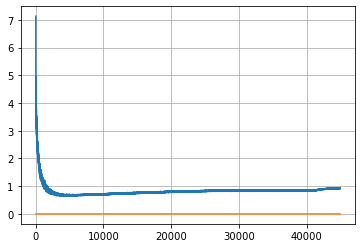

In [35]:
# iterate through all the epoch
epochs_passed = len(list(res['loss'].keys()))#to continue training 
for epoch in range(epochs_passed, epochs_passed+epochs):
    for key in res:
        if key != 'lambda':
            res[key][epoch] = []
    #if epoch % 5 == 0 and epoch > 0:
    #    optimizer.param_groups[0]['lr'] /= 1.2
    # go through all the batches generated by dataloader
    for i, (inputs, targets) in enumerate(data_dl):
        # clear the gradients
        optimizer.zero_grad()
        # compute the model output
        yhat = model(inputs)
        # calculate loss
        loss = model_loss(yhat.T, targets.T)
        cov_diff = np.linalg.norm(np.cov(yhat.detach().cpu().numpy().T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
        
        res['loss'][epoch].append(loss.detach().cpu().numpy())
        res['sample'][epoch].append(yhat.detach().cpu().numpy())
        res['cov_diff'][epoch].append(cov_diff)
        # credit assignment
        loss.backward()
        # update model weights
        optimizer.step()
        print("Epoch: {}, iteration {}, loss_before {:.10f},cov_diff_before {:.10f}".format(epoch,i,
                                                        res['loss'][epoch][-1], res['cov_diff'][epoch][-1]))
    cov_diff_all += res['cov_diff'][epoch]
    with open('./training_process_dump/' + model_name + '.pkl', 'wb') as f:
        pkl.dump(res, f)
    
    plt.clf()
    
    plt.grid("on", "both")
    plt.plot(cov_diff_all)
    plt.plot(np.arange(len(cov_diff_all)), np.zeros(len(cov_diff_all)))
    plt.savefig("./plots/accuracy_history_"+model_name+".png")

In [25]:
loss

tensor(0.0174, grad_fn=<SelectBackward>)

In [36]:
losses = []
for epoch in res['loss']:
    losses += res['loss'][epoch]

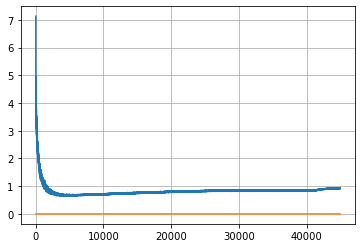

In [37]:
plt.clf()
plt.grid("on", "both")
plt.plot(cov_diff_all)
plt.plot(np.arange(len(cov_diff_all)), np.zeros(len(cov_diff_all)))
plt.savefig("./plots/accuracy_history_"+model_name+".png")

In [28]:
losses = []
for key in res['loss']:
    losses += res['loss'][key]

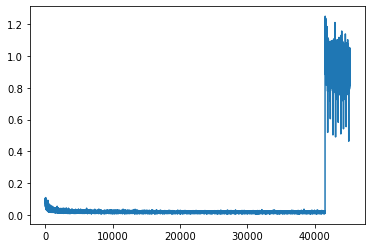

In [38]:
plt.plot(losses[100:])

### Test existing

In [60]:
Y1 = np.random.rand(BATCH_SIZE, 32)
Y2 = np.random.rand(BATCH_SIZE, 32)
X1=torch.tensor(Y1).requires_grad_()
X2=torch.tensor(Y1).requires_grad_()

In [61]:
model_loss1 = geomloss.SamplesLoss(loss='sinkhorn', p=2, blur=np.sqrt(2.0), debias=False)
loss1 = model_loss1(X1,torch.tensor(Y2))
model_loss2 = geomloss.SamplesLoss(loss='sinkhorn', p=2, blur=np.sqrt(2.0), debias=True)
loss2 = model_loss2(X2,torch.tensor(Y2))

In [62]:
loss1.backward()
loss2.backward()

In [63]:
grad_loss = X1.grad.detach().numpy()

In [64]:
grad_div = X2.grad.detach().numpy()

In [65]:
np.linalg.norm(grad_div - grad_loss)

0.0968398531221221

In [66]:
loss2

tensor(0.0223, dtype=torch.float64, grad_fn=<SelectBackward>)

In [71]:
model.load_state_dict(torch.load('./models/NP_SINKHORN_LAMBDA_2.0_LATENT_DIM_32_initialization_he_BATCHSIZE256.pt'))
model.eval()

Generator(
  (hid1): Linear(in_features=32, out_features=64, bias=True)
  (act1): ReLU()
  (hid2): Linear(in_features=64, out_features=64, bias=True)
  (act2): ReLU()
  (hid3): Linear(in_features=64, out_features=64, bias=True)
  (act3): ReLU()
  (out): Linear(in_features=64, out_features=32, bias=True)
)

In [72]:
ld = '32'
with open('./training_process_dump/NP_SINKHORN_LAMBDA_2.0_LATENT_DIM_'+ld +'_initialization_he_BATCHSIZE256.pkl', 'rb') as f:
    res = pkl.load(f)
accuracy_history = [res[1]]
res=res[0]

In [73]:
losses = []
for key in res['loss']:
    losses += res['loss'][key]

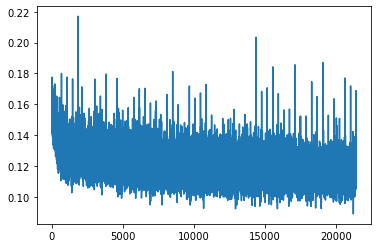

In [74]:
plt.plot(losses[100:])

In [75]:
optimizer = torch.optim.Adam(model.parameters())

In [76]:
acc_cov_diff = accuracy_history

In [77]:
cov_diff_inp = torch.tensor(np.random.randn(4*BATCH_SIZE, LATENT_DIM).astype('float32'))

In [78]:
losses = []
for key in res['loss']:
    losses += res['loss'][key]

Epoch: 56, iteration 0, loss 0.1053919792175293, cov_diff 0.476953596541608 cov_diff train 0.4714238785330714
Epoch: 56, iteration 1, loss 0.10707467794418335, cov_diff 0.4952806267864447 cov_diff train 0.489694693925932
Epoch: 56, iteration 2, loss 0.10553529858589172, cov_diff 0.4586476694476691 cov_diff train 0.4584806488798252
Epoch: 56, iteration 3, loss 0.11588859558105469, cov_diff 0.477264973203732 cov_diff train 0.47514116638786885
Epoch: 56, iteration 4, loss 0.1103624701499939, cov_diff 0.4675817819142564 cov_diff train 0.46538188367702527
Epoch: 56, iteration 5, loss 0.10579636693000793, cov_diff 0.467275145941643 cov_diff train 0.4646072617233573
Epoch: 56, iteration 6, loss 0.10387331247329712, cov_diff 0.47881868573896413 cov_diff train 0.476815316418037
Epoch: 56, iteration 7, loss 0.12453529238700867, cov_diff 0.47382004482105494 cov_diff train 0.47167049011459256
Epoch: 56, iteration 8, loss 0.10063961148262024, cov_diff 0.47966723285101576 cov_diff train 0.4783902353

Epoch: 56, iteration 80, loss 0.10059976577758789, cov_diff 0.4472945119896366 cov_diff train 0.44622462964544746
Epoch: 56, iteration 81, loss 0.11861404776573181, cov_diff 0.48096213159080997 cov_diff train 0.4800239050147473
Epoch: 56, iteration 82, loss 0.11535623669624329, cov_diff 0.48028359476967825 cov_diff train 0.4788671563833389
Epoch: 56, iteration 83, loss 0.10484373569488525, cov_diff 0.4681291044801513 cov_diff train 0.46726524334254266
Epoch: 56, iteration 84, loss 0.11519843339920044, cov_diff 0.4605137085330489 cov_diff train 0.460107636181223
Epoch: 56, iteration 85, loss 0.10025617480278015, cov_diff 0.44990337590206114 cov_diff train 0.4488079502381975
Epoch: 56, iteration 86, loss 0.11357548832893372, cov_diff 0.4707074227211639 cov_diff train 0.4697158945107821
Epoch: 56, iteration 87, loss 0.10347408056259155, cov_diff 0.4610338852403419 cov_diff train 0.4602229342314057
Epoch: 56, iteration 88, loss 0.1020510196685791, cov_diff 0.44752332116084487 cov_diff trai

Epoch: 56, iteration 155, loss 0.10403436422348022, cov_diff 0.44464823268476783 cov_diff train 0.44320626935431895
Epoch: 56, iteration 156, loss 0.11827579140663147, cov_diff 0.4487575647837995 cov_diff train 0.4477138746963986
Epoch: 56, iteration 157, loss 0.11369279026985168, cov_diff 0.46039882639698565 cov_diff train 0.4607523953896773
Epoch: 56, iteration 158, loss 0.1153644323348999, cov_diff 0.44726030360311414 cov_diff train 0.4473707114409307
Epoch: 56, iteration 159, loss 0.10115978121757507, cov_diff 0.4579306092990944 cov_diff train 0.45699621447663824
Epoch: 56, iteration 160, loss 0.1217542290687561, cov_diff 0.455857166188131 cov_diff train 0.4547697855691165
Epoch: 56, iteration 161, loss 0.10391154885292053, cov_diff 0.42761871699582554 cov_diff train 0.42704863503588286
Epoch: 56, iteration 162, loss 0.10129880905151367, cov_diff 0.46402791078419714 cov_diff train 0.4630843273328218
Epoch: 56, iteration 163, loss 0.10261702537536621, cov_diff 0.4606647896010984 cov

Epoch: 56, iteration 227, loss 0.11102718114852905, cov_diff 0.44956629982917806 cov_diff train 0.44779714806895027
Epoch: 56, iteration 228, loss 0.10142737627029419, cov_diff 0.43082705310733 cov_diff train 0.43021658746572433
Epoch: 56, iteration 229, loss 0.10511502623558044, cov_diff 0.43926095209327626 cov_diff train 0.4388309707563842
Epoch: 56, iteration 230, loss 0.10736468434333801, cov_diff 0.44957562102772547 cov_diff train 0.4491735559554209
Epoch: 56, iteration 231, loss 0.10578495264053345, cov_diff 0.447142809582159 cov_diff train 0.44694065248855885
Epoch: 56, iteration 232, loss 0.11921954154968262, cov_diff 0.45182800016062263 cov_diff train 0.4522964323957158
Epoch: 56, iteration 233, loss 0.10369792580604553, cov_diff 0.44513251846717633 cov_diff train 0.44450559097224607
Epoch: 56, iteration 234, loss 0.1102706789970398, cov_diff 0.4403527467056405 cov_diff train 0.4398765532954969
Epoch: 56, iteration 235, loss 0.11945554614067078, cov_diff 0.436033386942942 cov_

Epoch: 56, iteration 303, loss 0.1047949492931366, cov_diff 0.44396898175833305 cov_diff train 0.44251994689812735
Epoch: 56, iteration 304, loss 0.1180538535118103, cov_diff 0.4517038762424214 cov_diff train 0.44989895423202914
Epoch: 56, iteration 305, loss 0.10527855157852173, cov_diff 0.4340642259720987 cov_diff train 0.43332959490833123
Epoch: 56, iteration 306, loss 0.09873801469802856, cov_diff 0.43337340496960874 cov_diff train 0.43302784579534515
Epoch: 56, iteration 307, loss 0.10877740383148193, cov_diff 0.4459503424592561 cov_diff train 0.4454876150945342
Epoch: 56, iteration 308, loss 0.09802210330963135, cov_diff 0.4408123151504515 cov_diff train 0.4406674488401947
Epoch: 56, iteration 309, loss 0.11526238918304443, cov_diff 0.47028375873089073 cov_diff train 0.4699420444920818
Epoch: 56, iteration 310, loss 0.1103784441947937, cov_diff 0.441995756206516 cov_diff train 0.44138696253621257
Epoch: 56, iteration 311, loss 0.11381641030311584, cov_diff 0.4616132545260198 cov_

Epoch: 56, iteration 381, loss 0.10415622591972351, cov_diff 0.44658313305949204 cov_diff train 0.44654102753138325
Epoch: 56, iteration 382, loss 0.10087552666664124, cov_diff 0.45773150585112615 cov_diff train 0.4555994772539973
Epoch: 56, iteration 383, loss 0.10371533036231995, cov_diff 0.45397172848858175 cov_diff train 0.45279283657578795
Epoch: 56, iteration 384, loss 0.10260951519012451, cov_diff 0.4427193850636837 cov_diff train 0.44148558081571654
Epoch: 56, iteration 385, loss 0.10350221395492554, cov_diff 0.44454673783003873 cov_diff train 0.44350022030722547
Epoch: 56, iteration 386, loss 0.11157551407814026, cov_diff 0.4535925395500831 cov_diff train 0.45269753531129786
Epoch: 56, iteration 387, loss 0.10947096347808838, cov_diff 0.4528310196899026 cov_diff train 0.45261760975991383
Epoch: 56, iteration 388, loss 0.10551711916923523, cov_diff 0.4483974978105407 cov_diff train 0.44706346726862656
Epoch: 56, iteration 389, loss 0.10153648257255554, cov_diff 0.44200303107865

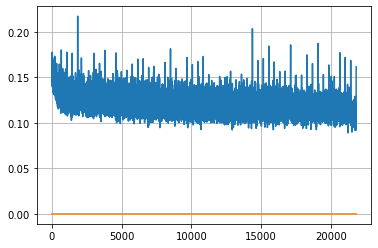

Epoch: 57, iteration 0, loss 0.09981051087379456, cov_diff 0.44524162386017846 cov_diff train 0.44463416945052664
Epoch: 57, iteration 1, loss 0.11827093362808228, cov_diff 0.43871614643496665 cov_diff train 0.4382135669338595
Epoch: 57, iteration 2, loss 0.1050679087638855, cov_diff 0.43720064512552836 cov_diff train 0.4364693146877567
Epoch: 57, iteration 3, loss 0.10395872592926025, cov_diff 0.44002861103744656 cov_diff train 0.44011382001092725
Epoch: 57, iteration 4, loss 0.09987199306488037, cov_diff 0.42929304743628866 cov_diff train 0.42854038807033373
Epoch: 57, iteration 5, loss 0.09889978170394897, cov_diff 0.43794231199018785 cov_diff train 0.43737385923874916
Epoch: 57, iteration 6, loss 0.10787856578826904, cov_diff 0.4425609590205706 cov_diff train 0.4416357638316396
Epoch: 57, iteration 7, loss 0.10758262872695923, cov_diff 0.43633229838768306 cov_diff train 0.43547119610619967
Epoch: 57, iteration 8, loss 0.09383374452590942, cov_diff 0.4299752456216666 cov_diff train 

Epoch: 57, iteration 76, loss 0.1051226258277893, cov_diff 0.4371904821361153 cov_diff train 0.4369363767182817
Epoch: 57, iteration 77, loss 0.11604243516921997, cov_diff 0.4253473417221599 cov_diff train 0.42464757982803886
Epoch: 57, iteration 78, loss 0.10667935013771057, cov_diff 0.43961195333264774 cov_diff train 0.4386347817996241
Epoch: 57, iteration 79, loss 0.10119715332984924, cov_diff 0.4388858335332772 cov_diff train 0.43824333716377073
Epoch: 57, iteration 80, loss 0.11086541414260864, cov_diff 0.4564606414323951 cov_diff train 0.45512693975407914
Epoch: 57, iteration 81, loss 0.11014458537101746, cov_diff 0.42969572100345343 cov_diff train 0.42822285182871833
Epoch: 57, iteration 82, loss 0.111331045627594, cov_diff 0.4413499095519127 cov_diff train 0.44122106991015514
Epoch: 57, iteration 83, loss 0.10300615429878235, cov_diff 0.42925584809307604 cov_diff train 0.4283966465000883
Epoch: 57, iteration 84, loss 0.11606872081756592, cov_diff 0.44452096679942715 cov_diff tr

Epoch: 57, iteration 152, loss 0.09562215209007263, cov_diff 0.44883759870822115 cov_diff train 0.44791619968347557
Epoch: 57, iteration 153, loss 0.11775481700897217, cov_diff 0.4588956634184291 cov_diff train 0.45643270945544195
Epoch: 57, iteration 154, loss 0.10977879166603088, cov_diff 0.44076927594183535 cov_diff train 0.4404702318584808
Epoch: 57, iteration 155, loss 0.11459171772003174, cov_diff 0.44577139965823614 cov_diff train 0.444396972893197
Epoch: 57, iteration 156, loss 0.110117107629776, cov_diff 0.44133285258030436 cov_diff train 0.4407403951526325
Epoch: 57, iteration 157, loss 0.10553908348083496, cov_diff 0.44789717412415153 cov_diff train 0.4469394727330189
Epoch: 57, iteration 158, loss 0.09764817357063293, cov_diff 0.4262239940952438 cov_diff train 0.42582618201696215
Epoch: 57, iteration 159, loss 0.10746961832046509, cov_diff 0.44910141037857687 cov_diff train 0.44733794730538795
Epoch: 57, iteration 160, loss 0.10786977410316467, cov_diff 0.4340890487705318 c

Epoch: 57, iteration 227, loss 0.10842594504356384, cov_diff 0.4267843068663607 cov_diff train 0.42631985424017815
Epoch: 57, iteration 228, loss 0.1024746298789978, cov_diff 0.44234165861502683 cov_diff train 0.44166456890469835
Epoch: 57, iteration 229, loss 0.0987333357334137, cov_diff 0.43963926295085193 cov_diff train 0.43874289391799076
Epoch: 57, iteration 230, loss 0.11727330088615417, cov_diff 0.46232735513948314 cov_diff train 0.46126919172329234
Epoch: 57, iteration 231, loss 0.11297640204429626, cov_diff 0.43713093228034927 cov_diff train 0.43616570453048803
Epoch: 57, iteration 232, loss 0.10957485437393188, cov_diff 0.43406784518194175 cov_diff train 0.43374576387768543
Epoch: 57, iteration 233, loss 0.10424038767814636, cov_diff 0.4144711632447304 cov_diff train 0.41463253700348
Epoch: 57, iteration 234, loss 0.10627147555351257, cov_diff 0.4464289216819046 cov_diff train 0.44526533116417105
Epoch: 57, iteration 235, loss 0.10302802920341492, cov_diff 0.4322788930603827 

Epoch: 57, iteration 306, loss 0.10682851076126099, cov_diff 0.4351261406838033 cov_diff train 0.43432961600238834
Epoch: 57, iteration 307, loss 0.10339602828025818, cov_diff 0.44360906407042255 cov_diff train 0.4434642700058745
Epoch: 57, iteration 308, loss 0.09895610809326172, cov_diff 0.45426416026266553 cov_diff train 0.4538629015333168
Epoch: 57, iteration 309, loss 0.09565886855125427, cov_diff 0.43292462678578214 cov_diff train 0.43172296450175895
Epoch: 57, iteration 310, loss 0.11144682765007019, cov_diff 0.439673217282666 cov_diff train 0.43910571867900305
Epoch: 57, iteration 311, loss 0.09662342071533203, cov_diff 0.46021055526271837 cov_diff train 0.4592902810014618
Epoch: 57, iteration 312, loss 0.1101326048374176, cov_diff 0.43611299337646525 cov_diff train 0.43542407791481214
Epoch: 57, iteration 313, loss 0.10018360614776611, cov_diff 0.44963060710653613 cov_diff train 0.4486036807786867
Epoch: 57, iteration 314, loss 0.11194676160812378, cov_diff 0.4357035915041969 

Epoch: 57, iteration 380, loss 0.09995672106742859, cov_diff 0.42771820344236405 cov_diff train 0.4271330396078757
Epoch: 57, iteration 381, loss 0.11126187443733215, cov_diff 0.4361391904421018 cov_diff train 0.43534335301292654
Epoch: 57, iteration 382, loss 0.11580240726470947, cov_diff 0.43178083769503856 cov_diff train 0.4304109837839495
Epoch: 57, iteration 383, loss 0.10860705375671387, cov_diff 0.44643808957745784 cov_diff train 0.4456457230266409
Epoch: 57, iteration 384, loss 0.09926003217697144, cov_diff 0.42776775386621296 cov_diff train 0.426510889266053
Epoch: 57, iteration 385, loss 0.1076960563659668, cov_diff 0.4375332289939815 cov_diff train 0.43657714202439984
Epoch: 57, iteration 386, loss 0.11372977495193481, cov_diff 0.443360686950935 cov_diff train 0.4430747680196453
Epoch: 57, iteration 387, loss 0.09473109245300293, cov_diff 0.43795852395410756 cov_diff train 0.437895988027183
Epoch: 57, iteration 388, loss 0.1131819486618042, cov_diff 0.4515067474622741 cov_di

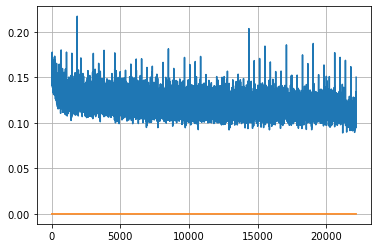

Epoch: 58, iteration 0, loss 0.10464966297149658, cov_diff 0.42509314444197666 cov_diff train 0.42505119860345536
Epoch: 58, iteration 1, loss 0.11641296744346619, cov_diff 0.44647797201667494 cov_diff train 0.44653716610174565
Epoch: 58, iteration 2, loss 0.10986804962158203, cov_diff 0.4402902426195321 cov_diff train 0.440790358252266
Epoch: 58, iteration 3, loss 0.09317359328269958, cov_diff 0.4636732149190613 cov_diff train 0.463988393751574
Epoch: 58, iteration 4, loss 0.09481313824653625, cov_diff 0.4560998625650986 cov_diff train 0.45601807719912735
Epoch: 58, iteration 5, loss 0.11254352331161499, cov_diff 0.4228040480185623 cov_diff train 0.42222040530800814
Epoch: 58, iteration 6, loss 0.100719153881073, cov_diff 0.42216018132806293 cov_diff train 0.42210163295729425
Epoch: 58, iteration 7, loss 0.11396646499633789, cov_diff 0.4286218955516491 cov_diff train 0.4277325735499925
Epoch: 58, iteration 8, loss 0.10781523585319519, cov_diff 0.4474191450616994 cov_diff train 0.44578

Epoch: 58, iteration 82, loss 0.10351422429084778, cov_diff 0.432738010538577 cov_diff train 0.43241656934377753
Epoch: 58, iteration 83, loss 0.1173112690448761, cov_diff 0.43571835076964294 cov_diff train 0.4349817291794933
Epoch: 58, iteration 84, loss 0.09849992394447327, cov_diff 0.4375956028569831 cov_diff train 0.4373398639797869
Epoch: 58, iteration 85, loss 0.10606956481933594, cov_diff 0.44476547402818023 cov_diff train 0.44484029799159036
Epoch: 58, iteration 86, loss 0.09577864408493042, cov_diff 0.429033422415741 cov_diff train 0.42846547512190114
Epoch: 58, iteration 87, loss 0.11848527193069458, cov_diff 0.4476487163484882 cov_diff train 0.44697075986917123
Epoch: 58, iteration 88, loss 0.10241347551345825, cov_diff 0.44601563252250137 cov_diff train 0.44541210741520865
Epoch: 58, iteration 89, loss 0.10371309518814087, cov_diff 0.4310481531972022 cov_diff train 0.4304286305459622
Epoch: 58, iteration 90, loss 0.10419198870658875, cov_diff 0.43773704930533214 cov_diff tr

Epoch: 58, iteration 154, loss 0.10690966248512268, cov_diff 0.44298537339120375 cov_diff train 0.4421353753793898
Epoch: 58, iteration 155, loss 0.11762693524360657, cov_diff 0.44108299332038914 cov_diff train 0.4404033024349355
Epoch: 58, iteration 156, loss 0.10296520590782166, cov_diff 0.4293398934879111 cov_diff train 0.4287539459763746
Epoch: 58, iteration 157, loss 0.09583479166030884, cov_diff 0.42603972793069983 cov_diff train 0.42551699367181034
Epoch: 58, iteration 158, loss 0.10803753137588501, cov_diff 0.42789946326200246 cov_diff train 0.4271217147649275
Epoch: 58, iteration 159, loss 0.11416909098625183, cov_diff 0.4279483474653168 cov_diff train 0.42792370756939374
Epoch: 58, iteration 160, loss 0.11323714256286621, cov_diff 0.4436467383265129 cov_diff train 0.4434940565245096
Epoch: 58, iteration 161, loss 0.11490300297737122, cov_diff 0.4212926107491509 cov_diff train 0.4205308295706903
Epoch: 58, iteration 162, loss 0.10356155037879944, cov_diff 0.42699779732770804 c

Epoch: 58, iteration 226, loss 0.10891768336296082, cov_diff 0.435428587970231 cov_diff train 0.4342180980151383
Epoch: 58, iteration 227, loss 0.11406373977661133, cov_diff 0.43592616767984177 cov_diff train 0.4349349565727423
Epoch: 58, iteration 228, loss 0.09719711542129517, cov_diff 0.4455840632330605 cov_diff train 0.4451148347956014
Epoch: 58, iteration 229, loss 0.10884758830070496, cov_diff 0.43171955214357643 cov_diff train 0.4310973052543267
Epoch: 58, iteration 230, loss 0.10927870869636536, cov_diff 0.4439574375219324 cov_diff train 0.4433076020161798
Epoch: 58, iteration 231, loss 0.11712872982025146, cov_diff 0.42158527388277117 cov_diff train 0.4212568950780894
Epoch: 58, iteration 232, loss 0.09907445311546326, cov_diff 0.4407554234680303 cov_diff train 0.440395983644844
Epoch: 58, iteration 233, loss 0.0949450135231018, cov_diff 0.42373819738385643 cov_diff train 0.42289269343118974
Epoch: 58, iteration 234, loss 0.10559600591659546, cov_diff 0.4277581614190432 cov_di

Epoch: 58, iteration 300, loss 0.12108999490737915, cov_diff 0.4415174448224169 cov_diff train 0.44091073912275003
Epoch: 58, iteration 301, loss 0.10947805643081665, cov_diff 0.4330312830914248 cov_diff train 0.43166955711504196
Epoch: 58, iteration 302, loss 0.10978114604949951, cov_diff 0.4487038367940548 cov_diff train 0.44764518068186143
Epoch: 58, iteration 303, loss 0.11288177967071533, cov_diff 0.4207970531446603 cov_diff train 0.41999565980537185
Epoch: 58, iteration 304, loss 0.10889607667922974, cov_diff 0.4457257382625792 cov_diff train 0.4452021669083092
Epoch: 58, iteration 305, loss 0.10654228925704956, cov_diff 0.4204984377041263 cov_diff train 0.41897486777184584
Epoch: 58, iteration 306, loss 0.11638712882995605, cov_diff 0.41917606506859817 cov_diff train 0.41797762967270763
Epoch: 58, iteration 307, loss 0.1137915849685669, cov_diff 0.4359196662206435 cov_diff train 0.4354433872548494
Epoch: 58, iteration 308, loss 0.10606637597084045, cov_diff 0.4207803059831559 co

Epoch: 58, iteration 372, loss 0.09580487012863159, cov_diff 0.43847699110576066 cov_diff train 0.43737749788908453
Epoch: 58, iteration 373, loss 0.09939929842948914, cov_diff 0.4359514399195833 cov_diff train 0.4355004912110788
Epoch: 58, iteration 374, loss 0.09554734826087952, cov_diff 0.4307945062829385 cov_diff train 0.4303788922660035
Epoch: 58, iteration 375, loss 0.11678022146224976, cov_diff 0.42775136135141095 cov_diff train 0.42686644597448625
Epoch: 58, iteration 376, loss 0.09691813588142395, cov_diff 0.4467447161091523 cov_diff train 0.44541830713359276
Epoch: 58, iteration 377, loss 0.11357372999191284, cov_diff 0.4260541653745008 cov_diff train 0.4247522855372953
Epoch: 58, iteration 378, loss 0.11059105396270752, cov_diff 0.4323620875514301 cov_diff train 0.43150550498719065
Epoch: 58, iteration 379, loss 0.10219788551330566, cov_diff 0.43337472192595233 cov_diff train 0.4324974105616859
Epoch: 58, iteration 380, loss 0.11294275522232056, cov_diff 0.442391027834243 co

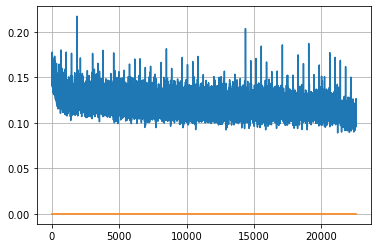

Epoch: 59, iteration 0, loss 0.11150065064430237, cov_diff 0.4394455651433955 cov_diff train 0.43983408915171
Epoch: 59, iteration 1, loss 0.10399121046066284, cov_diff 0.4360855351304344 cov_diff train 0.435308788324227
Epoch: 59, iteration 2, loss 0.10306721925735474, cov_diff 0.45204350288699785 cov_diff train 0.45149693123166323
Epoch: 59, iteration 3, loss 0.11879581212997437, cov_diff 0.44998412913453184 cov_diff train 0.44845771467005435
Epoch: 59, iteration 4, loss 0.09975343942642212, cov_diff 0.43687619489297325 cov_diff train 0.4361369513992229
Epoch: 59, iteration 5, loss 0.09981963038444519, cov_diff 0.4181353101013089 cov_diff train 0.4180870062988517
Epoch: 59, iteration 6, loss 0.11373239755630493, cov_diff 0.4469346516889674 cov_diff train 0.4473992828980984
Epoch: 59, iteration 7, loss 0.11304619908332825, cov_diff 0.44529414924205263 cov_diff train 0.44415636940894077
Epoch: 59, iteration 8, loss 0.11352154612541199, cov_diff 0.43189898162300877 cov_diff train 0.4309

Epoch: 59, iteration 73, loss 0.11936739087104797, cov_diff 0.4445925111177598 cov_diff train 0.4432852618523235
Epoch: 59, iteration 74, loss 0.10356751084327698, cov_diff 0.44262257255932347 cov_diff train 0.44175384910616644
Epoch: 59, iteration 75, loss 0.10954633355140686, cov_diff 0.4397668541092616 cov_diff train 0.43911508224213913
Epoch: 59, iteration 76, loss 0.1101372241973877, cov_diff 0.4461769261650788 cov_diff train 0.44484518357961017
Epoch: 59, iteration 77, loss 0.11047002673149109, cov_diff 0.4302252034001101 cov_diff train 0.4298769794341059
Epoch: 59, iteration 78, loss 0.10346075892448425, cov_diff 0.4384356519078144 cov_diff train 0.43725374647832405
Epoch: 59, iteration 79, loss 0.09972497820854187, cov_diff 0.4366092521043602 cov_diff train 0.4362002648496857
Epoch: 59, iteration 80, loss 0.1183270514011383, cov_diff 0.4255016455404529 cov_diff train 0.42466271927349253
Epoch: 59, iteration 81, loss 0.12503284215927124, cov_diff 0.42615005007277124 cov_diff tra

Epoch: 59, iteration 150, loss 0.10013562440872192, cov_diff 0.440514568365181 cov_diff train 0.4401562174828114
Epoch: 59, iteration 151, loss 0.1171438992023468, cov_diff 0.4430206393303832 cov_diff train 0.4414310308925618
Epoch: 59, iteration 152, loss 0.10407021641731262, cov_diff 0.42947037112605974 cov_diff train 0.4290167356110495
Epoch: 59, iteration 153, loss 0.1090923547744751, cov_diff 0.44311141474728316 cov_diff train 0.44264386056888094
Epoch: 59, iteration 154, loss 0.11302977800369263, cov_diff 0.44097269295606073 cov_diff train 0.4404802748831264
Epoch: 59, iteration 155, loss 0.12188076972961426, cov_diff 0.43469799437788853 cov_diff train 0.4337068664154016
Epoch: 59, iteration 156, loss 0.10107016563415527, cov_diff 0.44434840615951027 cov_diff train 0.4441276027837289
Epoch: 59, iteration 157, loss 0.11340051889419556, cov_diff 0.42975469787211024 cov_diff train 0.42913687769801084
Epoch: 59, iteration 158, loss 0.11447930335998535, cov_diff 0.4539411271751259 cov

Epoch: 59, iteration 229, loss 0.10230618715286255, cov_diff 0.43144420051363175 cov_diff train 0.4309221453596003
Epoch: 59, iteration 230, loss 0.10520309209823608, cov_diff 0.4503507961286274 cov_diff train 0.4498321906576197
Epoch: 59, iteration 231, loss 0.0998399555683136, cov_diff 0.42789069736618274 cov_diff train 0.4265952957846774
Epoch: 59, iteration 232, loss 0.10139197111129761, cov_diff 0.42129645357242407 cov_diff train 0.41998072564044225
Epoch: 59, iteration 233, loss 0.10352995991706848, cov_diff 0.42222587103956893 cov_diff train 0.42114699781643966
Epoch: 59, iteration 234, loss 0.102032870054245, cov_diff 0.43854592056552916 cov_diff train 0.43726335284823964
Epoch: 59, iteration 235, loss 0.10395956039428711, cov_diff 0.41655440597763704 cov_diff train 0.41577791222419686
Epoch: 59, iteration 236, loss 0.09938901662826538, cov_diff 0.4422517912684576 cov_diff train 0.44087325397263194
Epoch: 59, iteration 237, loss 0.11405768990516663, cov_diff 0.4227664687880655 

Epoch: 59, iteration 301, loss 0.0978860855102539, cov_diff 0.43717577922601214 cov_diff train 0.43621279021046094
Epoch: 59, iteration 302, loss 0.10824471712112427, cov_diff 0.445761321111058 cov_diff train 0.4444630031563592
Epoch: 59, iteration 303, loss 0.1135958731174469, cov_diff 0.450215739026032 cov_diff train 0.44872765603881054
Epoch: 59, iteration 304, loss 0.10858124494552612, cov_diff 0.44172797390087115 cov_diff train 0.4410867327138546
Epoch: 59, iteration 305, loss 0.1130361258983612, cov_diff 0.434493881468733 cov_diff train 0.4332955499236507
Epoch: 59, iteration 306, loss 0.09867152571678162, cov_diff 0.4387194094771302 cov_diff train 0.4381210066122538
Epoch: 59, iteration 307, loss 0.10909029841423035, cov_diff 0.4366595302520984 cov_diff train 0.4361792681265853
Epoch: 59, iteration 308, loss 0.10803771018981934, cov_diff 0.44669781311823153 cov_diff train 0.4461920267891028
Epoch: 59, iteration 309, loss 0.0943092405796051, cov_diff 0.4257833689051121 cov_diff t

Epoch: 59, iteration 378, loss 0.11489462852478027, cov_diff 0.43833030741810064 cov_diff train 0.43778965291345073
Epoch: 59, iteration 379, loss 0.1102774441242218, cov_diff 0.4323209157689967 cov_diff train 0.43119500036984887
Epoch: 59, iteration 380, loss 0.11425301432609558, cov_diff 0.43561386678352937 cov_diff train 0.4356811470763492
Epoch: 59, iteration 381, loss 0.11251941323280334, cov_diff 0.4511643799933314 cov_diff train 0.45075464273231297
Epoch: 59, iteration 382, loss 0.10828766226768494, cov_diff 0.43243214144040304 cov_diff train 0.432220819084259
Epoch: 59, iteration 383, loss 0.10473060607910156, cov_diff 0.4376418719367359 cov_diff train 0.43718353872214116
Epoch: 59, iteration 384, loss 0.11075413227081299, cov_diff 0.46635632829295515 cov_diff train 0.4657013960241057
Epoch: 59, iteration 385, loss 0.10458618402481079, cov_diff 0.43502087333493894 cov_diff train 0.4343860665866908
Epoch: 59, iteration 386, loss 0.1029987633228302, cov_diff 0.4269910358647179 co

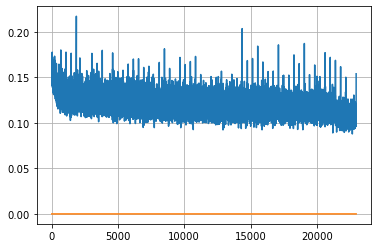

Epoch: 60, iteration 0, loss 0.10910212993621826, cov_diff 0.4378203502931634 cov_diff train 0.4368987732215365
Epoch: 60, iteration 1, loss 0.11324304342269897, cov_diff 0.4354338603957829 cov_diff train 0.4353089799603367
Epoch: 60, iteration 2, loss 0.11066821217536926, cov_diff 0.43758099185217314 cov_diff train 0.4364731880164321
Epoch: 60, iteration 3, loss 0.11059597134590149, cov_diff 0.4459851709320167 cov_diff train 0.44491878379975447
Epoch: 60, iteration 4, loss 0.10031718015670776, cov_diff 0.43358470648798836 cov_diff train 0.432648006808856
Epoch: 60, iteration 5, loss 0.10652506351470947, cov_diff 0.44309362866264446 cov_diff train 0.4425483698580855
Epoch: 60, iteration 6, loss 0.11511614918708801, cov_diff 0.43758625295628645 cov_diff train 0.4367026048546232
Epoch: 60, iteration 7, loss 0.09012582898139954, cov_diff 0.4297190581138119 cov_diff train 0.42931046210442897
Epoch: 60, iteration 8, loss 0.10476535558700562, cov_diff 0.4450258977733299 cov_diff train 0.4449

Epoch: 60, iteration 78, loss 0.09734362363815308, cov_diff 0.4241585472286283 cov_diff train 0.4241173023289323
Epoch: 60, iteration 79, loss 0.10396024584770203, cov_diff 0.45159007642842847 cov_diff train 0.4512725617603815
Epoch: 60, iteration 80, loss 0.11490890383720398, cov_diff 0.4395945097925235 cov_diff train 0.4396838981957241
Epoch: 60, iteration 81, loss 0.10772836208343506, cov_diff 0.4346564484566815 cov_diff train 0.43397041362354194
Epoch: 60, iteration 82, loss 0.10330155491828918, cov_diff 0.4402876418049064 cov_diff train 0.43816007849326843
Epoch: 60, iteration 83, loss 0.10586309432983398, cov_diff 0.43647938540831316 cov_diff train 0.43580993909844357
Epoch: 60, iteration 84, loss 0.10260504484176636, cov_diff 0.4200234508763184 cov_diff train 0.419867037265244
Epoch: 60, iteration 85, loss 0.11750549077987671, cov_diff 0.4398211218523327 cov_diff train 0.4399919470590203
Epoch: 60, iteration 86, loss 0.11572238802909851, cov_diff 0.44718205705999275 cov_diff tra

Epoch: 60, iteration 150, loss 0.10295367240905762, cov_diff 0.4559925473161803 cov_diff train 0.45539581592186884
Epoch: 60, iteration 151, loss 0.10359823703765869, cov_diff 0.4435995345002756 cov_diff train 0.4425342593339973
Epoch: 60, iteration 152, loss 0.10693332552909851, cov_diff 0.448168396400758 cov_diff train 0.44689630934203534
Epoch: 60, iteration 153, loss 0.10598498582839966, cov_diff 0.4309588161394143 cov_diff train 0.4291515477385422
Epoch: 60, iteration 154, loss 0.0990084707736969, cov_diff 0.45030366099814034 cov_diff train 0.44887189048031306
Epoch: 60, iteration 155, loss 0.107545405626297, cov_diff 0.4419253152432423 cov_diff train 0.4410819164741256
Epoch: 60, iteration 156, loss 0.11090242862701416, cov_diff 0.4324177140638123 cov_diff train 0.43130769839094785
Epoch: 60, iteration 157, loss 0.12027108669281006, cov_diff 0.42558641194658525 cov_diff train 0.42410647162962584
Epoch: 60, iteration 158, loss 0.10952270030975342, cov_diff 0.4342164800196816 cov_d

Epoch: 60, iteration 226, loss 0.11654311418533325, cov_diff 0.4321238339337707 cov_diff train 0.4309793103439826
Epoch: 60, iteration 227, loss 0.09975135326385498, cov_diff 0.44366973897564804 cov_diff train 0.4431167058582081
Epoch: 60, iteration 228, loss 0.10986471176147461, cov_diff 0.4294453296559703 cov_diff train 0.42893318107782136
Epoch: 60, iteration 229, loss 0.10556197166442871, cov_diff 0.44952306398601405 cov_diff train 0.4480625334342624
Epoch: 60, iteration 230, loss 0.09762480854988098, cov_diff 0.4500904453173266 cov_diff train 0.449535599336948
Epoch: 60, iteration 231, loss 0.11228612065315247, cov_diff 0.4354363627177029 cov_diff train 0.4348043442605006
Epoch: 60, iteration 232, loss 0.10794827342033386, cov_diff 0.4441095517996738 cov_diff train 0.44389708507848963
Epoch: 60, iteration 233, loss 0.12072783708572388, cov_diff 0.4361542691062408 cov_diff train 0.43561564905244676
Epoch: 60, iteration 234, loss 0.12024867534637451, cov_diff 0.4501860893827198 cov_

Epoch: 60, iteration 303, loss 0.11534848809242249, cov_diff 0.44352212444931993 cov_diff train 0.4432116049608485
Epoch: 60, iteration 304, loss 0.10127013921737671, cov_diff 0.4288393586926202 cov_diff train 0.42836636970103986
Epoch: 60, iteration 305, loss 0.12021759152412415, cov_diff 0.42171956639950625 cov_diff train 0.421519752663772
Epoch: 60, iteration 306, loss 0.105152428150177, cov_diff 0.43893334076802665 cov_diff train 0.43768648077650313
Epoch: 60, iteration 307, loss 0.10669440031051636, cov_diff 0.4252357737147566 cov_diff train 0.42508210212298914
Epoch: 60, iteration 308, loss 0.09830674529075623, cov_diff 0.43482453017572276 cov_diff train 0.435288394911712
Epoch: 60, iteration 309, loss 0.10124775767326355, cov_diff 0.4338239265439558 cov_diff train 0.43325176645286284
Epoch: 60, iteration 310, loss 0.10236150026321411, cov_diff 0.42939755094007265 cov_diff train 0.4292910457708162
Epoch: 60, iteration 311, loss 0.10019606351852417, cov_diff 0.44719803241088624 co

Epoch: 60, iteration 382, loss 0.10909944772720337, cov_diff 0.42466452290500656 cov_diff train 0.42390224233922397
Epoch: 60, iteration 383, loss 0.09479737281799316, cov_diff 0.4184718599184308 cov_diff train 0.41848305165797506
Epoch: 60, iteration 384, loss 0.10540911555290222, cov_diff 0.42307548465453476 cov_diff train 0.42345799013673513
Epoch: 60, iteration 385, loss 0.10458329319953918, cov_diff 0.43700624407883154 cov_diff train 0.4376606717188254
Epoch: 60, iteration 386, loss 0.09014025330543518, cov_diff 0.4348611386293928 cov_diff train 0.43468524361934807
Epoch: 60, iteration 387, loss 0.10412132740020752, cov_diff 0.44710906247589277 cov_diff train 0.4468624396982023
Epoch: 60, iteration 388, loss 0.09430816769599915, cov_diff 0.43367601212313667 cov_diff train 0.43308360424526604
Epoch: 60, iteration 389, loss 0.10107201337814331, cov_diff 0.4183874661592756 cov_diff train 0.4184281504657757
Epoch: 60, iteration 390, loss 0.1569385528564453, cov_diff 0.4692000398830679

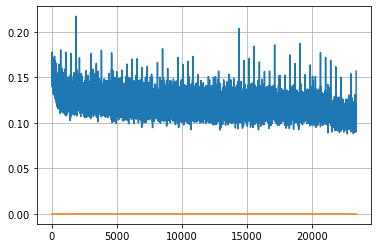

Epoch: 61, iteration 0, loss 0.09203940629959106, cov_diff 0.4355429490518319 cov_diff train 0.43474452091640664
Epoch: 61, iteration 1, loss 0.11151072382926941, cov_diff 0.4579547409158955 cov_diff train 0.4568141663054321
Epoch: 61, iteration 2, loss 0.10285428166389465, cov_diff 0.4507393362122639 cov_diff train 0.44998793671788384
Epoch: 61, iteration 3, loss 0.0995246171951294, cov_diff 0.433828438457391 cov_diff train 0.43358258988945003
Epoch: 61, iteration 4, loss 0.10456594824790955, cov_diff 0.4360370253001213 cov_diff train 0.4351873181762029
Epoch: 61, iteration 5, loss 0.09983795881271362, cov_diff 0.4413863340663345 cov_diff train 0.44069774292140146
Epoch: 61, iteration 6, loss 0.10226622223854065, cov_diff 0.4373571781221071 cov_diff train 0.43712065687770957
Epoch: 61, iteration 7, loss 0.10414651036262512, cov_diff 0.4398405812222741 cov_diff train 0.43938994705287204
Epoch: 61, iteration 8, loss 0.10071563720703125, cov_diff 0.4373324908766709 cov_diff train 0.43592

Epoch: 61, iteration 74, loss 0.10843336582183838, cov_diff 0.4376125573830849 cov_diff train 0.4365775990312787
Epoch: 61, iteration 75, loss 0.10606333613395691, cov_diff 0.43807486476225 cov_diff train 0.4377720907814154
Epoch: 61, iteration 76, loss 0.11231908202171326, cov_diff 0.4432319374092159 cov_diff train 0.4423010314218934
Epoch: 61, iteration 77, loss 0.11195182800292969, cov_diff 0.4476028538207288 cov_diff train 0.44620689621702264
Epoch: 61, iteration 78, loss 0.1152980625629425, cov_diff 0.43019802998544476 cov_diff train 0.42890665247339627
Epoch: 61, iteration 79, loss 0.10619953274726868, cov_diff 0.4332362155915896 cov_diff train 0.43285982644290233
Epoch: 61, iteration 80, loss 0.11013081669807434, cov_diff 0.4228666564710923 cov_diff train 0.4225799687094334
Epoch: 61, iteration 81, loss 0.09757938981056213, cov_diff 0.43684309066493643 cov_diff train 0.4359215517659535
Epoch: 61, iteration 82, loss 0.1074044406414032, cov_diff 0.4310155213509154 cov_diff train 0

Epoch: 61, iteration 146, loss 0.11470988392829895, cov_diff 0.4289517893562801 cov_diff train 0.4279860194053642
Epoch: 61, iteration 147, loss 0.1027786135673523, cov_diff 0.4406819406284308 cov_diff train 0.44002636295829256
Epoch: 61, iteration 148, loss 0.11723476648330688, cov_diff 0.4292451249795244 cov_diff train 0.42809598931479675
Epoch: 61, iteration 149, loss 0.1044502854347229, cov_diff 0.4320397885189013 cov_diff train 0.4318592386640933
Epoch: 61, iteration 150, loss 0.10050326585769653, cov_diff 0.44303967550270007 cov_diff train 0.4421231543929604
Epoch: 61, iteration 151, loss 0.1008094847202301, cov_diff 0.43518003854518045 cov_diff train 0.4342402302724949
Epoch: 61, iteration 152, loss 0.10112813115119934, cov_diff 0.43361099023164357 cov_diff train 0.4329738081632497
Epoch: 61, iteration 153, loss 0.10432389378547668, cov_diff 0.4192368217380194 cov_diff train 0.4189553583740166
Epoch: 61, iteration 154, loss 0.1026965081691742, cov_diff 0.4473190726020431 cov_dif

Epoch: 61, iteration 222, loss 0.10278600454330444, cov_diff 0.44008578575861584 cov_diff train 0.44007407004378485
Epoch: 61, iteration 223, loss 0.10662606358528137, cov_diff 0.4218993787705214 cov_diff train 0.42188788079778844
Epoch: 61, iteration 224, loss 0.10078540444374084, cov_diff 0.444961648052657 cov_diff train 0.44509579006620187
Epoch: 61, iteration 225, loss 0.09949922561645508, cov_diff 0.4325688681301349 cov_diff train 0.43182092006266826
Epoch: 61, iteration 226, loss 0.09995999932289124, cov_diff 0.4219963486017397 cov_diff train 0.4217396589968717
Epoch: 61, iteration 227, loss 0.09739649295806885, cov_diff 0.4489670803718057 cov_diff train 0.4487797130053869
Epoch: 61, iteration 228, loss 0.10312700271606445, cov_diff 0.4169406791925907 cov_diff train 0.41701204946630105
Epoch: 61, iteration 229, loss 0.10840046405792236, cov_diff 0.43486751654155725 cov_diff train 0.4350392127655673
Epoch: 61, iteration 230, loss 0.107685387134552, cov_diff 0.4289810322980289 cov_

Epoch: 61, iteration 300, loss 0.09044244885444641, cov_diff 0.42725278371610775 cov_diff train 0.42702236313094516
Epoch: 61, iteration 301, loss 0.09681928157806396, cov_diff 0.4420986695803741 cov_diff train 0.4405769679154621
Epoch: 61, iteration 302, loss 0.10956838726997375, cov_diff 0.4285196415757105 cov_diff train 0.42771474243176644
Epoch: 61, iteration 303, loss 0.12209567427635193, cov_diff 0.42411462908266306 cov_diff train 0.4235205825816875
Epoch: 61, iteration 304, loss 0.11070877313613892, cov_diff 0.4360665529038086 cov_diff train 0.4349402412372753
Epoch: 61, iteration 305, loss 0.10260745882987976, cov_diff 0.4306278108057746 cov_diff train 0.42975246076242707
Epoch: 61, iteration 306, loss 0.11099910736083984, cov_diff 0.4233679652998637 cov_diff train 0.4234581905950013
Epoch: 61, iteration 307, loss 0.09851646423339844, cov_diff 0.4357704373040748 cov_diff train 0.43573091579568435
Epoch: 61, iteration 308, loss 0.12333625555038452, cov_diff 0.42446045232827884 c

Epoch: 61, iteration 377, loss 0.12209141254425049, cov_diff 0.4374430023917658 cov_diff train 0.4362887840605715
Epoch: 61, iteration 378, loss 0.118218332529068, cov_diff 0.43894232166384745 cov_diff train 0.43773742191465476
Epoch: 61, iteration 379, loss 0.10896468162536621, cov_diff 0.43167233004528904 cov_diff train 0.43107515596123974
Epoch: 61, iteration 380, loss 0.11361131072044373, cov_diff 0.42753465524600265 cov_diff train 0.42627233366949163
Epoch: 61, iteration 381, loss 0.1022462546825409, cov_diff 0.44025686547378784 cov_diff train 0.44002646574211307
Epoch: 61, iteration 382, loss 0.11210951209068298, cov_diff 0.4229060158794375 cov_diff train 0.42230543876735493
Epoch: 61, iteration 383, loss 0.1044357419013977, cov_diff 0.4403079656721592 cov_diff train 0.4393626643186279
Epoch: 61, iteration 384, loss 0.09793445467948914, cov_diff 0.42867729354525375 cov_diff train 0.42748577697342455
Epoch: 61, iteration 385, loss 0.10172474384307861, cov_diff 0.4326794299792162 c

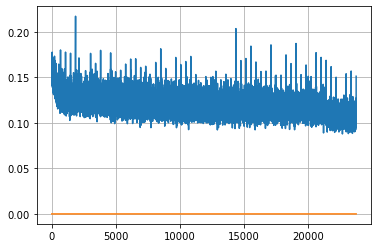

Epoch: 62, iteration 0, loss 0.11397922039031982, cov_diff 0.45073401052792317 cov_diff train 0.45025348678063004
Epoch: 62, iteration 1, loss 0.11412858963012695, cov_diff 0.4187604157025186 cov_diff train 0.41802532591825026
Epoch: 62, iteration 2, loss 0.10363158583641052, cov_diff 0.4412687431487855 cov_diff train 0.44080888537589136
Epoch: 62, iteration 3, loss 0.0958450436592102, cov_diff 0.42504822105944606 cov_diff train 0.42495586064738555
Epoch: 62, iteration 4, loss 0.09485158324241638, cov_diff 0.44524458953187585 cov_diff train 0.44481118078562865
Epoch: 62, iteration 5, loss 0.11469677090644836, cov_diff 0.4298533580631918 cov_diff train 0.42933896587893555
Epoch: 62, iteration 6, loss 0.11045673489570618, cov_diff 0.44580351437881927 cov_diff train 0.44350270353047755
Epoch: 62, iteration 7, loss 0.10574543476104736, cov_diff 0.432209899929829 cov_diff train 0.43116812631874846
Epoch: 62, iteration 8, loss 0.10932835936546326, cov_diff 0.4415233150622197 cov_diff train 0

Epoch: 62, iteration 82, loss 0.10820019245147705, cov_diff 0.4377606203338756 cov_diff train 0.4375326837259104
Epoch: 62, iteration 83, loss 0.11258697509765625, cov_diff 0.42521276047531065 cov_diff train 0.42426225002457485
Epoch: 62, iteration 84, loss 0.10661602020263672, cov_diff 0.41310745799569687 cov_diff train 0.41257846016222016
Epoch: 62, iteration 85, loss 0.09728479385375977, cov_diff 0.41667788550995594 cov_diff train 0.4155398668975105
Epoch: 62, iteration 86, loss 0.10703986883163452, cov_diff 0.4370568092803607 cov_diff train 0.4365681758963351
Epoch: 62, iteration 87, loss 0.1081421971321106, cov_diff 0.4336025910319596 cov_diff train 0.43416834858874015
Epoch: 62, iteration 88, loss 0.10450053215026855, cov_diff 0.43915217539539386 cov_diff train 0.43906335447538974
Epoch: 62, iteration 89, loss 0.09687554836273193, cov_diff 0.4295575116356791 cov_diff train 0.42901281531916985
Epoch: 62, iteration 90, loss 0.11125147342681885, cov_diff 0.42999170466655756 cov_diff

Epoch: 62, iteration 157, loss 0.10485967993736267, cov_diff 0.4271398432619677 cov_diff train 0.42597317123963996
Epoch: 62, iteration 158, loss 0.11492714285850525, cov_diff 0.43803959203117765 cov_diff train 0.4372172693640652
Epoch: 62, iteration 159, loss 0.1205497682094574, cov_diff 0.4317645648633336 cov_diff train 0.43111183706467043
Epoch: 62, iteration 160, loss 0.1013629138469696, cov_diff 0.4405589535459194 cov_diff train 0.4406743693185757
Epoch: 62, iteration 161, loss 0.09893643856048584, cov_diff 0.4269555409050627 cov_diff train 0.42621172267858054
Epoch: 62, iteration 162, loss 0.0945206880569458, cov_diff 0.4465194528316913 cov_diff train 0.4455053865645379
Epoch: 62, iteration 163, loss 0.09797924757003784, cov_diff 0.4350873779232272 cov_diff train 0.43430336003120795
Epoch: 62, iteration 164, loss 0.119864821434021, cov_diff 0.44023467029790153 cov_diff train 0.4395647776765419
Epoch: 62, iteration 165, loss 0.10462772846221924, cov_diff 0.4424967558138486 cov_dif

Epoch: 62, iteration 235, loss 0.10250672698020935, cov_diff 0.4384194086621899 cov_diff train 0.4373509988736639
Epoch: 62, iteration 236, loss 0.09774145483970642, cov_diff 0.4221016006504953 cov_diff train 0.4210356400348054
Epoch: 62, iteration 237, loss 0.11304330825805664, cov_diff 0.4265187878851881 cov_diff train 0.426198628347276
Epoch: 62, iteration 238, loss 0.11427456140518188, cov_diff 0.4333699081677147 cov_diff train 0.4317048553283416
Epoch: 62, iteration 239, loss 0.11111584305763245, cov_diff 0.4339550671015304 cov_diff train 0.4335908284183007
Epoch: 62, iteration 240, loss 0.09999692440032959, cov_diff 0.44260475376324815 cov_diff train 0.44323209253301177
Epoch: 62, iteration 241, loss 0.11144578456878662, cov_diff 0.4356760822629428 cov_diff train 0.43562539792109917
Epoch: 62, iteration 242, loss 0.09600946307182312, cov_diff 0.4383007865031656 cov_diff train 0.4369291724139799
Epoch: 62, iteration 243, loss 0.11760905385017395, cov_diff 0.44470015595719276 cov_d

Epoch: 62, iteration 309, loss 0.10011163353919983, cov_diff 0.4276215278703818 cov_diff train 0.427274056600924
Epoch: 62, iteration 310, loss 0.11607855558395386, cov_diff 0.43957046673119976 cov_diff train 0.4394344023303746
Epoch: 62, iteration 311, loss 0.10469493269920349, cov_diff 0.4286859436517409 cov_diff train 0.42827155833931296
Epoch: 62, iteration 312, loss 0.10047152638435364, cov_diff 0.438561798241294 cov_diff train 0.4377853008027741
Epoch: 62, iteration 313, loss 0.10584363341331482, cov_diff 0.4321406866289683 cov_diff train 0.43173870482049587
Epoch: 62, iteration 314, loss 0.09799820184707642, cov_diff 0.4414431234696473 cov_diff train 0.4407451776165751
Epoch: 62, iteration 315, loss 0.10216233134269714, cov_diff 0.42465228305153346 cov_diff train 0.4245498021873225
Epoch: 62, iteration 316, loss 0.11524036526679993, cov_diff 0.4298350522370986 cov_diff train 0.4293617126158094
Epoch: 62, iteration 317, loss 0.09720045328140259, cov_diff 0.4035078763147994 cov_di

Epoch: 62, iteration 384, loss 0.10009011626243591, cov_diff 0.43621655679137006 cov_diff train 0.43668701586381753
Epoch: 62, iteration 385, loss 0.1058240532875061, cov_diff 0.4145859333340136 cov_diff train 0.41423129195201214
Epoch: 62, iteration 386, loss 0.09743168950080872, cov_diff 0.4233086100281817 cov_diff train 0.42316621686016737
Epoch: 62, iteration 387, loss 0.10653907060623169, cov_diff 0.43646972705101833 cov_diff train 0.4363171572884531
Epoch: 62, iteration 388, loss 0.1091429591178894, cov_diff 0.44759456834060696 cov_diff train 0.44672878141247013
Epoch: 62, iteration 389, loss 0.10444185137748718, cov_diff 0.4298041988389148 cov_diff train 0.4301957004733024
Epoch: 62, iteration 390, loss 0.14353257417678833, cov_diff 0.47860488497318177 cov_diff train 0.47795047172818966


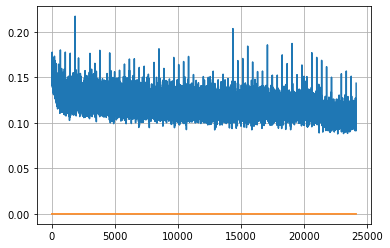

Epoch: 63, iteration 0, loss 0.11155951023101807, cov_diff 0.4375045276809022 cov_diff train 0.4369874206210181
Epoch: 63, iteration 1, loss 0.11578452587127686, cov_diff 0.42526646433783266 cov_diff train 0.42545550343493027
Epoch: 63, iteration 2, loss 0.10759434103965759, cov_diff 0.43551848532513454 cov_diff train 0.4359773881787858
Epoch: 63, iteration 3, loss 0.0994877815246582, cov_diff 0.44710339953111905 cov_diff train 0.44674629548870587
Epoch: 63, iteration 4, loss 0.1107441782951355, cov_diff 0.4338311922699863 cov_diff train 0.4334208653998014
Epoch: 63, iteration 5, loss 0.11143600940704346, cov_diff 0.44508416677998885 cov_diff train 0.4446769303296329
Epoch: 63, iteration 6, loss 0.09600904583930969, cov_diff 0.42812763562680634 cov_diff train 0.42701674983256527
Epoch: 63, iteration 7, loss 0.10701978206634521, cov_diff 0.43874924884528077 cov_diff train 0.43778755294356875
Epoch: 63, iteration 8, loss 0.12608587741851807, cov_diff 0.44233540216965106 cov_diff train 0.

Epoch: 63, iteration 76, loss 0.10092863440513611, cov_diff 0.4401390766161992 cov_diff train 0.44024241723853036
Epoch: 63, iteration 77, loss 0.10681885480880737, cov_diff 0.41857155703681853 cov_diff train 0.4175911886382558
Epoch: 63, iteration 78, loss 0.10376569628715515, cov_diff 0.42698245764903303 cov_diff train 0.42668236131973025
Epoch: 63, iteration 79, loss 0.09441870450973511, cov_diff 0.4333888905199676 cov_diff train 0.43330276822059616
Epoch: 63, iteration 80, loss 0.10633066296577454, cov_diff 0.4359359695328339 cov_diff train 0.4347763586989122
Epoch: 63, iteration 81, loss 0.10657525062561035, cov_diff 0.4377732670460173 cov_diff train 0.4375118980021424
Epoch: 63, iteration 82, loss 0.10887157917022705, cov_diff 0.4508221333701781 cov_diff train 0.449922161286086
Epoch: 63, iteration 83, loss 0.10377627611160278, cov_diff 0.42991327170880766 cov_diff train 0.42907368046443284
Epoch: 63, iteration 84, loss 0.11186748743057251, cov_diff 0.4395081068233105 cov_diff tr

Epoch: 63, iteration 153, loss 0.10535368323326111, cov_diff 0.4417443003607512 cov_diff train 0.44130140261080547
Epoch: 63, iteration 154, loss 0.10975879430770874, cov_diff 0.42655703353115054 cov_diff train 0.42699592124028085
Epoch: 63, iteration 155, loss 0.10629615187644958, cov_diff 0.44699921881936816 cov_diff train 0.4462022117132415
Epoch: 63, iteration 156, loss 0.104776531457901, cov_diff 0.4442611337523941 cov_diff train 0.4440187925090007
Epoch: 63, iteration 157, loss 0.09724849462509155, cov_diff 0.44099435872928444 cov_diff train 0.4414341179789386
Epoch: 63, iteration 158, loss 0.10217896103858948, cov_diff 0.43695967335308 cov_diff train 0.43728839813679393
Epoch: 63, iteration 159, loss 0.11687290668487549, cov_diff 0.4394820457915322 cov_diff train 0.4383870672049617
Epoch: 63, iteration 160, loss 0.09959936141967773, cov_diff 0.4194284968817718 cov_diff train 0.418753529240781
Epoch: 63, iteration 161, loss 0.10446882247924805, cov_diff 0.42804543737761797 cov_di

Epoch: 63, iteration 233, loss 0.10254734754562378, cov_diff 0.42659746332805004 cov_diff train 0.42648087397419354
Epoch: 63, iteration 234, loss 0.11223024129867554, cov_diff 0.4155776172048021 cov_diff train 0.41495044264432634
Epoch: 63, iteration 235, loss 0.09688493609428406, cov_diff 0.4293685536175636 cov_diff train 0.42821402394215263
Epoch: 63, iteration 236, loss 0.10374823212623596, cov_diff 0.4310336455921858 cov_diff train 0.430260850146651
Epoch: 63, iteration 237, loss 0.11359935998916626, cov_diff 0.44366249352248954 cov_diff train 0.4424214361096477
Epoch: 63, iteration 238, loss 0.1179608702659607, cov_diff 0.43111167157748054 cov_diff train 0.430602197952352
Epoch: 63, iteration 239, loss 0.094795823097229, cov_diff 0.4303193145335934 cov_diff train 0.4299232927402111
Epoch: 63, iteration 240, loss 0.09906741976737976, cov_diff 0.4205907727661478 cov_diff train 0.4199861427167696
Epoch: 63, iteration 241, loss 0.104082852602005, cov_diff 0.4313256807131151 cov_diff 

Epoch: 63, iteration 310, loss 0.09700432419776917, cov_diff 0.4321333024034205 cov_diff train 0.43151498322493115
Epoch: 63, iteration 311, loss 0.11438989639282227, cov_diff 0.4182462450423029 cov_diff train 0.4170794220497176
Epoch: 63, iteration 312, loss 0.09463617205619812, cov_diff 0.42760084041780944 cov_diff train 0.42661450468442463
Epoch: 63, iteration 313, loss 0.09524554014205933, cov_diff 0.4365526551094155 cov_diff train 0.436650625839318
Epoch: 63, iteration 314, loss 0.11034023761749268, cov_diff 0.4359124469997013 cov_diff train 0.43602897074279173
Epoch: 63, iteration 315, loss 0.097409188747406, cov_diff 0.42572814899457023 cov_diff train 0.42571967906455993
Epoch: 63, iteration 316, loss 0.10303223133087158, cov_diff 0.44379655273412977 cov_diff train 0.442714399603555
Epoch: 63, iteration 317, loss 0.109427809715271, cov_diff 0.43557520887786955 cov_diff train 0.4350195876248246
Epoch: 63, iteration 318, loss 0.10813009738922119, cov_diff 0.42107595283429716 cov_d

Epoch: 63, iteration 383, loss 0.10751956701278687, cov_diff 0.41859232545226294 cov_diff train 0.4172968699277514
Epoch: 63, iteration 384, loss 0.10920047760009766, cov_diff 0.4330827057836427 cov_diff train 0.43311692188646567
Epoch: 63, iteration 385, loss 0.10472574830055237, cov_diff 0.4428787356670547 cov_diff train 0.44214664545663324
Epoch: 63, iteration 386, loss 0.10492780804634094, cov_diff 0.43605336818951884 cov_diff train 0.435608539642182
Epoch: 63, iteration 387, loss 0.11180958151817322, cov_diff 0.438073875656836 cov_diff train 0.43731868257777046
Epoch: 63, iteration 388, loss 0.10132914781570435, cov_diff 0.4112082587466121 cov_diff train 0.41143434833208686
Epoch: 63, iteration 389, loss 0.11220884323120117, cov_diff 0.4214957378554312 cov_diff train 0.42129379574299336
Epoch: 63, iteration 390, loss 0.1397342085838318, cov_diff 0.4602832637805989 cov_diff train 0.45856831315538066


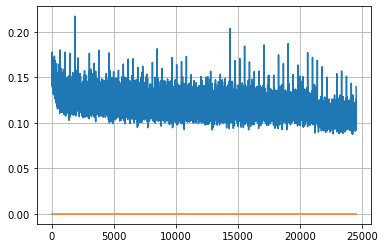

Epoch: 64, iteration 0, loss 0.10177668929100037, cov_diff 0.4487093265201798 cov_diff train 0.4488335894288853
Epoch: 64, iteration 1, loss 0.0997992753982544, cov_diff 0.4196795977034657 cov_diff train 0.41907097687904993
Epoch: 64, iteration 2, loss 0.10110613703727722, cov_diff 0.4337143399399761 cov_diff train 0.43409830646467606
Epoch: 64, iteration 3, loss 0.09996268153190613, cov_diff 0.44269934969783553 cov_diff train 0.44255609828962916
Epoch: 64, iteration 4, loss 0.10446512699127197, cov_diff 0.428492069763031 cov_diff train 0.42770535856154035
Epoch: 64, iteration 5, loss 0.10344800353050232, cov_diff 0.4169187615803624 cov_diff train 0.41676668880396883
Epoch: 64, iteration 6, loss 0.10403528809547424, cov_diff 0.4199448835007649 cov_diff train 0.41978872730457717
Epoch: 64, iteration 7, loss 0.10263776779174805, cov_diff 0.4373136579302279 cov_diff train 0.43620471125755345
Epoch: 64, iteration 8, loss 0.10540783405303955, cov_diff 0.4400772514453648 cov_diff train 0.439

Epoch: 64, iteration 76, loss 0.11219185590744019, cov_diff 0.4408064740868001 cov_diff train 0.4397652389350129
Epoch: 64, iteration 77, loss 0.10749247670173645, cov_diff 0.42119516354388165 cov_diff train 0.42002321004978593
Epoch: 64, iteration 78, loss 0.10353109240531921, cov_diff 0.4339072217097246 cov_diff train 0.4333462321936575
Epoch: 64, iteration 79, loss 0.11718189716339111, cov_diff 0.4218740519004021 cov_diff train 0.42070906490903565
Epoch: 64, iteration 80, loss 0.10943186283111572, cov_diff 0.4442916631630666 cov_diff train 0.4432829785419215
Epoch: 64, iteration 81, loss 0.10310137271881104, cov_diff 0.44094341644946833 cov_diff train 0.4407638257837974
Epoch: 64, iteration 82, loss 0.11181259155273438, cov_diff 0.42840632143033947 cov_diff train 0.42821973993433166
Epoch: 64, iteration 83, loss 0.11292088031768799, cov_diff 0.4338596593583548 cov_diff train 0.43312055963552465
Epoch: 64, iteration 84, loss 0.1032630205154419, cov_diff 0.44287915691394536 cov_diff t

Epoch: 64, iteration 153, loss 0.10494756698608398, cov_diff 0.4295035837594123 cov_diff train 0.42917938536795797
Epoch: 64, iteration 154, loss 0.10915645956993103, cov_diff 0.4298973367893393 cov_diff train 0.429102859031892
Epoch: 64, iteration 155, loss 0.10561352968215942, cov_diff 0.42457256418619693 cov_diff train 0.42404672352312267
Epoch: 64, iteration 156, loss 0.10105600953102112, cov_diff 0.4419485311597726 cov_diff train 0.44117247673137916
Epoch: 64, iteration 157, loss 0.10183688998222351, cov_diff 0.43882247928279455 cov_diff train 0.4379520626467875
Epoch: 64, iteration 158, loss 0.10972440242767334, cov_diff 0.4231671935511203 cov_diff train 0.42291293673263475
Epoch: 64, iteration 159, loss 0.09945771098136902, cov_diff 0.44431415150855036 cov_diff train 0.4430477530972617
Epoch: 64, iteration 160, loss 0.10732161998748779, cov_diff 0.4338189893247916 cov_diff train 0.43233627406813446
Epoch: 64, iteration 161, loss 0.10418248176574707, cov_diff 0.43592133182991966 

Epoch: 64, iteration 230, loss 0.09324541687965393, cov_diff 0.43216742387217766 cov_diff train 0.4310867527573029
Epoch: 64, iteration 231, loss 0.11534389853477478, cov_diff 0.4420823990948655 cov_diff train 0.43988653889940016
Epoch: 64, iteration 232, loss 0.10355469584465027, cov_diff 0.4266594236584368 cov_diff train 0.4265439193696118
Epoch: 64, iteration 233, loss 0.10196366906166077, cov_diff 0.41389281589103477 cov_diff train 0.4129280630251391
Epoch: 64, iteration 234, loss 0.10384762287139893, cov_diff 0.4298027875285647 cov_diff train 0.4287292523662504
Epoch: 64, iteration 235, loss 0.1010008454322815, cov_diff 0.4323059351790135 cov_diff train 0.4312320709500404
Epoch: 64, iteration 236, loss 0.1054028868675232, cov_diff 0.41938818633243585 cov_diff train 0.41885797436308675
Epoch: 64, iteration 237, loss 0.10362294316291809, cov_diff 0.425225424457828 cov_diff train 0.4245309973916464
Epoch: 64, iteration 238, loss 0.1079748272895813, cov_diff 0.4280756953121393 cov_dif

Epoch: 64, iteration 307, loss 0.1035013198852539, cov_diff 0.41817658286115117 cov_diff train 0.41814329641144
Epoch: 64, iteration 308, loss 0.10609257221221924, cov_diff 0.42606694225409847 cov_diff train 0.4251271692537119
Epoch: 64, iteration 309, loss 0.11092141270637512, cov_diff 0.4348118747187609 cov_diff train 0.4343774213693761
Epoch: 64, iteration 310, loss 0.10845896601676941, cov_diff 0.43892808224304064 cov_diff train 0.4383260747047436
Epoch: 64, iteration 311, loss 0.10442155599594116, cov_diff 0.4319384353619842 cov_diff train 0.4313633128507634
Epoch: 64, iteration 312, loss 0.10900214314460754, cov_diff 0.42776230515750424 cov_diff train 0.42745971946217437
Epoch: 64, iteration 313, loss 0.11332535743713379, cov_diff 0.43930567534532927 cov_diff train 0.4388968029896284
Epoch: 64, iteration 314, loss 0.10894754528999329, cov_diff 0.44575924431420366 cov_diff train 0.4453364169205937
Epoch: 64, iteration 315, loss 0.10516929626464844, cov_diff 0.42322962623760163 cov

Epoch: 64, iteration 384, loss 0.09527048468589783, cov_diff 0.431812854350363 cov_diff train 0.43047704554075894
Epoch: 64, iteration 385, loss 0.10608083009719849, cov_diff 0.43837382201284086 cov_diff train 0.4377769516350496
Epoch: 64, iteration 386, loss 0.10002854466438293, cov_diff 0.4348638417348311 cov_diff train 0.4333078274604509
Epoch: 64, iteration 387, loss 0.10386320948600769, cov_diff 0.43588448556358106 cov_diff train 0.43513491501286783
Epoch: 64, iteration 388, loss 0.11567655205726624, cov_diff 0.431005306877799 cov_diff train 0.4303457342846594
Epoch: 64, iteration 389, loss 0.1100909411907196, cov_diff 0.42672473405294453 cov_diff train 0.42551822254031313
Epoch: 64, iteration 390, loss 0.14531183242797852, cov_diff 0.45803098365573275 cov_diff train 0.45717432391382407


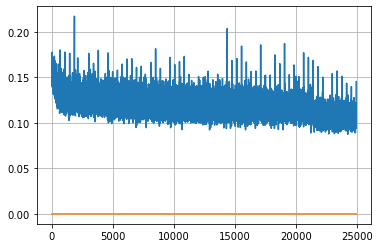

Epoch: 65, iteration 0, loss 0.10371899604797363, cov_diff 0.424745510907337 cov_diff train 0.42435557644566785
Epoch: 65, iteration 1, loss 0.10143330693244934, cov_diff 0.44544222049705956 cov_diff train 0.44466473125238737
Epoch: 65, iteration 2, loss 0.11116451025009155, cov_diff 0.42538324112609965 cov_diff train 0.4246390255004119
Epoch: 65, iteration 3, loss 0.10737979412078857, cov_diff 0.43523012045463566 cov_diff train 0.43379408882889847
Epoch: 65, iteration 4, loss 0.10573709011077881, cov_diff 0.43653215931124345 cov_diff train 0.43564887465504
Epoch: 65, iteration 5, loss 0.10462933778762817, cov_diff 0.44436801658032005 cov_diff train 0.44297393633296034
Epoch: 65, iteration 6, loss 0.11250683665275574, cov_diff 0.41989703068366063 cov_diff train 0.4185575568932435
Epoch: 65, iteration 7, loss 0.11116039752960205, cov_diff 0.42406160315914665 cov_diff train 0.42336722530736015
Epoch: 65, iteration 8, loss 0.10329887270927429, cov_diff 0.4310113089250934 cov_diff train 0.

Epoch: 65, iteration 83, loss 0.10385224223136902, cov_diff 0.42564960787252887 cov_diff train 0.4249595736112527
Epoch: 65, iteration 84, loss 0.10805416107177734, cov_diff 0.4368349002773814 cov_diff train 0.43626865691381933
Epoch: 65, iteration 85, loss 0.0900452733039856, cov_diff 0.4400020281972681 cov_diff train 0.44041665947306124
Epoch: 65, iteration 86, loss 0.10973608493804932, cov_diff 0.43129036144179816 cov_diff train 0.43080292463341135
Epoch: 65, iteration 87, loss 0.11699774861335754, cov_diff 0.4168559204147983 cov_diff train 0.4158040190906627
Epoch: 65, iteration 88, loss 0.11144131422042847, cov_diff 0.4271144928299367 cov_diff train 0.42679543127977104
Epoch: 65, iteration 89, loss 0.10456681251525879, cov_diff 0.45541232759932726 cov_diff train 0.4551252969092643
Epoch: 65, iteration 90, loss 0.09771353006362915, cov_diff 0.4348821928866219 cov_diff train 0.4347989667748407
Epoch: 65, iteration 91, loss 0.10463136434555054, cov_diff 0.44179102543320425 cov_diff t

Epoch: 65, iteration 161, loss 0.10186564922332764, cov_diff 0.4371630859105643 cov_diff train 0.4370341904126579
Epoch: 65, iteration 162, loss 0.09922102093696594, cov_diff 0.4294325197150611 cov_diff train 0.42924531095929264
Epoch: 65, iteration 163, loss 0.10793253779411316, cov_diff 0.4317219656402411 cov_diff train 0.4313175031485055
Epoch: 65, iteration 164, loss 0.10836842656135559, cov_diff 0.42942384817936646 cov_diff train 0.42897890404131517
Epoch: 65, iteration 165, loss 0.10320430994033813, cov_diff 0.43108756478551036 cov_diff train 0.43027984161599003
Epoch: 65, iteration 166, loss 0.09955871105194092, cov_diff 0.4483944299603151 cov_diff train 0.44732766364206317
Epoch: 65, iteration 167, loss 0.10467004776000977, cov_diff 0.44243395750420317 cov_diff train 0.44184250416261767
Epoch: 65, iteration 168, loss 0.09744530916213989, cov_diff 0.43641176182824104 cov_diff train 0.4349505497644023
Epoch: 65, iteration 169, loss 0.10644787549972534, cov_diff 0.4391705437365925

Epoch: 65, iteration 238, loss 0.10635876655578613, cov_diff 0.42390413185710485 cov_diff train 0.4241182197518172
Epoch: 65, iteration 239, loss 0.09982997179031372, cov_diff 0.4280929337063784 cov_diff train 0.4280762414148167
Epoch: 65, iteration 240, loss 0.11177411675453186, cov_diff 0.4365291297554978 cov_diff train 0.43560127755237255
Epoch: 65, iteration 241, loss 0.11195912957191467, cov_diff 0.4282852202881118 cov_diff train 0.4275832595162084
Epoch: 65, iteration 242, loss 0.09943127632141113, cov_diff 0.42682204059252515 cov_diff train 0.4263334685275556
Epoch: 65, iteration 243, loss 0.10300245881080627, cov_diff 0.42597520575983006 cov_diff train 0.4258712446817128
Epoch: 65, iteration 244, loss 0.10224059224128723, cov_diff 0.4257641227428212 cov_diff train 0.42610293587789294
Epoch: 65, iteration 245, loss 0.1025947630405426, cov_diff 0.42197389467798274 cov_diff train 0.42212714100518867
Epoch: 65, iteration 246, loss 0.11220267415046692, cov_diff 0.41823912076402414 c

Epoch: 65, iteration 315, loss 0.09790363907814026, cov_diff 0.43706593051846404 cov_diff train 0.43675861008087885
Epoch: 65, iteration 316, loss 0.1205843985080719, cov_diff 0.4422486725022247 cov_diff train 0.44164869122821293
Epoch: 65, iteration 317, loss 0.1005091667175293, cov_diff 0.4388749172088382 cov_diff train 0.43865320049053863
Epoch: 65, iteration 318, loss 0.10873344540596008, cov_diff 0.43777935201579976 cov_diff train 0.4374938104889668
Epoch: 65, iteration 319, loss 0.10272142291069031, cov_diff 0.4279298674183146 cov_diff train 0.42770307054292656
Epoch: 65, iteration 320, loss 0.11056163907051086, cov_diff 0.4206818103993377 cov_diff train 0.4196277787614254
Epoch: 65, iteration 321, loss 0.11036160588264465, cov_diff 0.42895177846819454 cov_diff train 0.4281791512263992
Epoch: 65, iteration 322, loss 0.10851970314979553, cov_diff 0.4386840055320852 cov_diff train 0.43817818752507
Epoch: 65, iteration 323, loss 0.10538706183433533, cov_diff 0.4214833605666842 cov_d

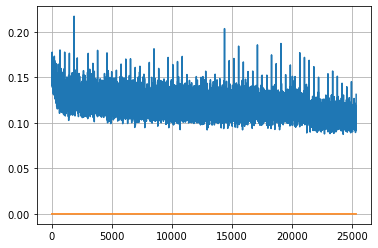

Epoch: 66, iteration 0, loss 0.10051417350769043, cov_diff 0.43118501555607885 cov_diff train 0.4307355161413832
Epoch: 66, iteration 1, loss 0.11110332608222961, cov_diff 0.44866229824551207 cov_diff train 0.4472722248767208
Epoch: 66, iteration 2, loss 0.09575864672660828, cov_diff 0.4434181085656841 cov_diff train 0.44103581426541727
Epoch: 66, iteration 3, loss 0.11023616790771484, cov_diff 0.42102369750869395 cov_diff train 0.418096605886948
Epoch: 66, iteration 4, loss 0.1060401201248169, cov_diff 0.43318626697064877 cov_diff train 0.4322790341058167
Epoch: 66, iteration 5, loss 0.12117505073547363, cov_diff 0.4362439063768383 cov_diff train 0.4343497156237548
Epoch: 66, iteration 6, loss 0.10944327712059021, cov_diff 0.4296912762831528 cov_diff train 0.4291695594662193
Epoch: 66, iteration 7, loss 0.11002609133720398, cov_diff 0.4364295567641547 cov_diff train 0.436107571127544
Epoch: 66, iteration 8, loss 0.10131847858428955, cov_diff 0.4334524599908299 cov_diff train 0.4325256

Epoch: 66, iteration 76, loss 0.09967318177223206, cov_diff 0.44216411339665757 cov_diff train 0.4417907592311199
Epoch: 66, iteration 77, loss 0.10729658603668213, cov_diff 0.41581459496945417 cov_diff train 0.4155657262548572
Epoch: 66, iteration 78, loss 0.11245307326316833, cov_diff 0.44410237315114476 cov_diff train 0.44278318139309086
Epoch: 66, iteration 79, loss 0.10831886529922485, cov_diff 0.43154556550681394 cov_diff train 0.43186422434890787
Epoch: 66, iteration 80, loss 0.10137087106704712, cov_diff 0.42354753975607545 cov_diff train 0.422845526018072
Epoch: 66, iteration 81, loss 0.10844609141349792, cov_diff 0.42011058662445494 cov_diff train 0.42012279006520475
Epoch: 66, iteration 82, loss 0.10599645972251892, cov_diff 0.41629895907177766 cov_diff train 0.415449346117409
Epoch: 66, iteration 83, loss 0.09765449166297913, cov_diff 0.4216267560342509 cov_diff train 0.42137666188288525
Epoch: 66, iteration 84, loss 0.10474872589111328, cov_diff 0.4193777824304381 cov_diff

Epoch: 66, iteration 149, loss 0.09717458486557007, cov_diff 0.4405303878533748 cov_diff train 0.4384053572451061
Epoch: 66, iteration 150, loss 0.11051195859909058, cov_diff 0.4254064847518396 cov_diff train 0.4242704352060547
Epoch: 66, iteration 151, loss 0.10772126913070679, cov_diff 0.4390447029402134 cov_diff train 0.43753771519355844
Epoch: 66, iteration 152, loss 0.09840130805969238, cov_diff 0.443325731915851 cov_diff train 0.44244387599967283
Epoch: 66, iteration 153, loss 0.10120731592178345, cov_diff 0.4337241120559817 cov_diff train 0.4336472634350371
Epoch: 66, iteration 154, loss 0.10777521133422852, cov_diff 0.434400232848121 cov_diff train 0.43386135198891296
Epoch: 66, iteration 155, loss 0.0943557620048523, cov_diff 0.43583175973696353 cov_diff train 0.43493067326343965
Epoch: 66, iteration 156, loss 0.10484829545021057, cov_diff 0.422888974708865 cov_diff train 0.42260467378478467
Epoch: 66, iteration 157, loss 0.09204667806625366, cov_diff 0.40919673550233915 cov_d

Epoch: 66, iteration 226, loss 0.09756898880004883, cov_diff 0.422878287139956 cov_diff train 0.4222354726717408
Epoch: 66, iteration 227, loss 0.1000882089138031, cov_diff 0.4412828864090382 cov_diff train 0.43953092817268186
Epoch: 66, iteration 228, loss 0.10218986868858337, cov_diff 0.4180346135884334 cov_diff train 0.4175429394431227
Epoch: 66, iteration 229, loss 0.10503223538398743, cov_diff 0.4222523680411103 cov_diff train 0.4220418379850976
Epoch: 66, iteration 230, loss 0.1076447069644928, cov_diff 0.4311012055994953 cov_diff train 0.43060077858971696
Epoch: 66, iteration 231, loss 0.09482178092002869, cov_diff 0.41310035586318844 cov_diff train 0.4129249914501889
Epoch: 66, iteration 232, loss 0.10514378547668457, cov_diff 0.43498910508816924 cov_diff train 0.4346220444628873
Epoch: 66, iteration 233, loss 0.10890248417854309, cov_diff 0.43619290254339943 cov_diff train 0.4358122932486916
Epoch: 66, iteration 234, loss 0.10435479879379272, cov_diff 0.4339714273736844 cov_di

Epoch: 66, iteration 303, loss 0.09756675362586975, cov_diff 0.4424611403789217 cov_diff train 0.4416356050843489
Epoch: 66, iteration 304, loss 0.1080380380153656, cov_diff 0.4372297887004921 cov_diff train 0.43575728061496627
Epoch: 66, iteration 305, loss 0.10718885064125061, cov_diff 0.43766617379198225 cov_diff train 0.43683378042424914
Epoch: 66, iteration 306, loss 0.110882967710495, cov_diff 0.42795842379969007 cov_diff train 0.4276404438756751
Epoch: 66, iteration 307, loss 0.10990941524505615, cov_diff 0.4214161525848502 cov_diff train 0.42061220020084744
Epoch: 66, iteration 308, loss 0.09967544674873352, cov_diff 0.43332552381280437 cov_diff train 0.4328006192010664
Epoch: 66, iteration 309, loss 0.0906992256641388, cov_diff 0.4278500720167665 cov_diff train 0.42699491012379426
Epoch: 66, iteration 310, loss 0.11312788724899292, cov_diff 0.4458623260218677 cov_diff train 0.44522587264568986
Epoch: 66, iteration 311, loss 0.09784737229347229, cov_diff 0.4194685223466966 cov_

Epoch: 66, iteration 375, loss 0.10932040214538574, cov_diff 0.42388785918393823 cov_diff train 0.4233967695226402
Epoch: 66, iteration 376, loss 0.10330525040626526, cov_diff 0.434677240484919 cov_diff train 0.4344551847538532
Epoch: 66, iteration 377, loss 0.1146250069141388, cov_diff 0.4315890426799304 cov_diff train 0.4314644058486298
Epoch: 66, iteration 378, loss 0.1107420027256012, cov_diff 0.43330532594102755 cov_diff train 0.4326221334230744
Epoch: 66, iteration 379, loss 0.0959765613079071, cov_diff 0.4495706686145206 cov_diff train 0.44887336882862144
Epoch: 66, iteration 380, loss 0.11279234290122986, cov_diff 0.4284061978371264 cov_diff train 0.42719927462948476
Epoch: 66, iteration 381, loss 0.10116687417030334, cov_diff 0.4277084329128483 cov_diff train 0.42637270781361764
Epoch: 66, iteration 382, loss 0.1141810417175293, cov_diff 0.44462242619451936 cov_diff train 0.44279711682319234
Epoch: 66, iteration 383, loss 0.100165456533432, cov_diff 0.4404394218247616 cov_diff

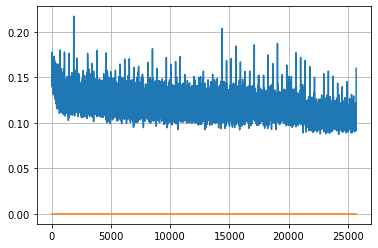

Epoch: 67, iteration 0, loss 0.10440778732299805, cov_diff 0.42432133848047354 cov_diff train 0.4244569111637205
Epoch: 67, iteration 1, loss 0.11594676971435547, cov_diff 0.4284633658369634 cov_diff train 0.42817464333897937
Epoch: 67, iteration 2, loss 0.11154359579086304, cov_diff 0.4544652393386037 cov_diff train 0.45363539009713455
Epoch: 67, iteration 3, loss 0.10257583856582642, cov_diff 0.4464379460049378 cov_diff train 0.44626059711851285
Epoch: 67, iteration 4, loss 0.09545382857322693, cov_diff 0.42858852289980753 cov_diff train 0.42700620586471194
Epoch: 67, iteration 5, loss 0.10085666179656982, cov_diff 0.42657897231066166 cov_diff train 0.4258051595438294
Epoch: 67, iteration 6, loss 0.11407715082168579, cov_diff 0.428704947931927 cov_diff train 0.4281402707940697
Epoch: 67, iteration 7, loss 0.10493314266204834, cov_diff 0.4266752611844305 cov_diff train 0.42606873239702514
Epoch: 67, iteration 8, loss 0.11528977751731873, cov_diff 0.4412826704259161 cov_diff train 0.43

Epoch: 67, iteration 77, loss 0.11681786179542542, cov_diff 0.44016072179410476 cov_diff train 0.4396370639322364
Epoch: 67, iteration 78, loss 0.09595075249671936, cov_diff 0.4262079830327876 cov_diff train 0.42576949054711144
Epoch: 67, iteration 79, loss 0.10035613179206848, cov_diff 0.4377456286903081 cov_diff train 0.4371614879102701
Epoch: 67, iteration 80, loss 0.09753823280334473, cov_diff 0.4184243937561936 cov_diff train 0.4175135744737028
Epoch: 67, iteration 81, loss 0.1094745397567749, cov_diff 0.4308686785714434 cov_diff train 0.43018273380728084
Epoch: 67, iteration 82, loss 0.10973501205444336, cov_diff 0.4298716359005315 cov_diff train 0.42881996300106257
Epoch: 67, iteration 83, loss 0.10364842414855957, cov_diff 0.4385576012414514 cov_diff train 0.43818938409717234
Epoch: 67, iteration 84, loss 0.11071610450744629, cov_diff 0.43229651641499506 cov_diff train 0.4319312756925276
Epoch: 67, iteration 85, loss 0.09148469567298889, cov_diff 0.4153877919097722 cov_diff tra

Epoch: 67, iteration 149, loss 0.10856544971466064, cov_diff 0.42942549821209974 cov_diff train 0.42796342100729423
Epoch: 67, iteration 150, loss 0.10527268052101135, cov_diff 0.42814946695098627 cov_diff train 0.42727204743826075
Epoch: 67, iteration 151, loss 0.11013093590736389, cov_diff 0.4306189469715637 cov_diff train 0.4292673542763655
Epoch: 67, iteration 152, loss 0.11093723773956299, cov_diff 0.4361371645072876 cov_diff train 0.4353898169243139
Epoch: 67, iteration 153, loss 0.10120528936386108, cov_diff 0.4413634058012892 cov_diff train 0.44015768847863895
Epoch: 67, iteration 154, loss 0.09841984510421753, cov_diff 0.429463808234017 cov_diff train 0.4286937900460125
Epoch: 67, iteration 155, loss 0.10824421048164368, cov_diff 0.4398230985323071 cov_diff train 0.43991930693934833
Epoch: 67, iteration 156, loss 0.11879715323448181, cov_diff 0.4434986261612329 cov_diff train 0.44267428510861123
Epoch: 67, iteration 157, loss 0.10630077123641968, cov_diff 0.41044398482105143 c

Epoch: 67, iteration 221, loss 0.09901869297027588, cov_diff 0.4066874209512455 cov_diff train 0.40663907501257734
Epoch: 67, iteration 222, loss 0.10485681891441345, cov_diff 0.43228110839308376 cov_diff train 0.4321315654500899
Epoch: 67, iteration 223, loss 0.11154249310493469, cov_diff 0.4326834753740853 cov_diff train 0.4321149837344891
Epoch: 67, iteration 224, loss 0.10140776634216309, cov_diff 0.428280225967332 cov_diff train 0.4285229831211365
Epoch: 67, iteration 225, loss 0.09697374701499939, cov_diff 0.42202808241137696 cov_diff train 0.4206585583237627
Epoch: 67, iteration 226, loss 0.10395252704620361, cov_diff 0.4221398622539244 cov_diff train 0.42127890794001754
Epoch: 67, iteration 227, loss 0.10479095578193665, cov_diff 0.4291213145062669 cov_diff train 0.42840344893782156
Epoch: 67, iteration 228, loss 0.10091501474380493, cov_diff 0.4362204692833985 cov_diff train 0.4353607294894156
Epoch: 67, iteration 229, loss 0.09983780980110168, cov_diff 0.41841531993180814 cov

Epoch: 67, iteration 298, loss 0.10609781742095947, cov_diff 0.43586812948661086 cov_diff train 0.4352136475334407
Epoch: 67, iteration 299, loss 0.09542074799537659, cov_diff 0.4230488887069066 cov_diff train 0.4224945675974743
Epoch: 67, iteration 300, loss 0.11233431100845337, cov_diff 0.4303941816631997 cov_diff train 0.42910135840199937
Epoch: 67, iteration 301, loss 0.09660208225250244, cov_diff 0.41754897665238105 cov_diff train 0.4167245289100704
Epoch: 67, iteration 302, loss 0.10042411088943481, cov_diff 0.43262527554287133 cov_diff train 0.4329499596964364
Epoch: 67, iteration 303, loss 0.10290911793708801, cov_diff 0.42506145992853717 cov_diff train 0.42465403657959494
Epoch: 67, iteration 304, loss 0.1007673442363739, cov_diff 0.42058722340207577 cov_diff train 0.4202389920145902
Epoch: 67, iteration 305, loss 0.10098347067832947, cov_diff 0.42627168551755523 cov_diff train 0.42600397129321776
Epoch: 67, iteration 306, loss 0.09890076518058777, cov_diff 0.44051692238114587

Epoch: 67, iteration 372, loss 0.11876770853996277, cov_diff 0.44096007532052395 cov_diff train 0.43952918718939715
Epoch: 67, iteration 373, loss 0.10000389814376831, cov_diff 0.42866076753144766 cov_diff train 0.4277852952383601
Epoch: 67, iteration 374, loss 0.09891098737716675, cov_diff 0.41974626785007507 cov_diff train 0.4194984299966697
Epoch: 67, iteration 375, loss 0.10813078284263611, cov_diff 0.42945665335831823 cov_diff train 0.4280574211612305
Epoch: 67, iteration 376, loss 0.10346940159797668, cov_diff 0.43513232539325547 cov_diff train 0.43459434092120386
Epoch: 67, iteration 377, loss 0.10683491826057434, cov_diff 0.4281011601975168 cov_diff train 0.4276841600326024
Epoch: 67, iteration 378, loss 0.09756052494049072, cov_diff 0.42830689755890433 cov_diff train 0.4277846566449246
Epoch: 67, iteration 379, loss 0.10697516798973083, cov_diff 0.4428993441975029 cov_diff train 0.44235509015902835
Epoch: 67, iteration 380, loss 0.1089525818824768, cov_diff 0.4282941698652759 

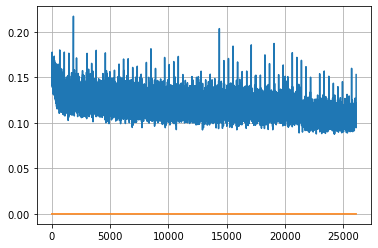

Epoch: 68, iteration 0, loss 0.10178914666175842, cov_diff 0.43348373404206814 cov_diff train 0.4335243339633701
Epoch: 68, iteration 1, loss 0.09705972671508789, cov_diff 0.4170049529111396 cov_diff train 0.4166626365190527
Epoch: 68, iteration 2, loss 0.11044424772262573, cov_diff 0.438748040433158 cov_diff train 0.4387469824296987
Epoch: 68, iteration 3, loss 0.105919748544693, cov_diff 0.4364887729897163 cov_diff train 0.43588563187757035
Epoch: 68, iteration 4, loss 0.10261473059654236, cov_diff 0.425219868341535 cov_diff train 0.4258386911897733
Epoch: 68, iteration 5, loss 0.10981389880180359, cov_diff 0.44140720867716954 cov_diff train 0.4407861756108031
Epoch: 68, iteration 6, loss 0.09173122048377991, cov_diff 0.43477175070819024 cov_diff train 0.43425430010318156
Epoch: 68, iteration 7, loss 0.10583925247192383, cov_diff 0.4218724656189888 cov_diff train 0.42169802624713015
Epoch: 68, iteration 8, loss 0.10471919178962708, cov_diff 0.42036815732991417 cov_diff train 0.419957

Epoch: 68, iteration 77, loss 0.1117100715637207, cov_diff 0.42737103893935086 cov_diff train 0.4262791658578923
Epoch: 68, iteration 78, loss 0.11961731314659119, cov_diff 0.42742908652056644 cov_diff train 0.4270273006392387
Epoch: 68, iteration 79, loss 0.11235466599464417, cov_diff 0.43018469159931555 cov_diff train 0.429116866321877
Epoch: 68, iteration 80, loss 0.10264596343040466, cov_diff 0.43113510831726176 cov_diff train 0.42995706648832605
Epoch: 68, iteration 81, loss 0.10706177353858948, cov_diff 0.4247947293088268 cov_diff train 0.4247070022884608
Epoch: 68, iteration 82, loss 0.11109229922294617, cov_diff 0.4294469397099564 cov_diff train 0.42954800158718054
Epoch: 68, iteration 83, loss 0.11731061339378357, cov_diff 0.4257134336475299 cov_diff train 0.4250893965284478
Epoch: 68, iteration 84, loss 0.09969425201416016, cov_diff 0.41739434546572823 cov_diff train 0.4170839537587562
Epoch: 68, iteration 85, loss 0.08819207549095154, cov_diff 0.42238072216790457 cov_diff tr

Epoch: 68, iteration 151, loss 0.09320101141929626, cov_diff 0.39901569431226314 cov_diff train 0.39839275924438033
Epoch: 68, iteration 152, loss 0.11380961537361145, cov_diff 0.43487025650101274 cov_diff train 0.4342642266011826
Epoch: 68, iteration 153, loss 0.1018221378326416, cov_diff 0.43166885115800924 cov_diff train 0.43102159403721957
Epoch: 68, iteration 154, loss 0.1013244092464447, cov_diff 0.41937071941545134 cov_diff train 0.41855028775185615
Epoch: 68, iteration 155, loss 0.10087317228317261, cov_diff 0.4271331213678059 cov_diff train 0.42652495731489265
Epoch: 68, iteration 156, loss 0.10085424780845642, cov_diff 0.41902122582570217 cov_diff train 0.41851185517566797
Epoch: 68, iteration 157, loss 0.09432065486907959, cov_diff 0.4370826672401266 cov_diff train 0.4367659751790199
Epoch: 68, iteration 158, loss 0.1162869930267334, cov_diff 0.4321104326896012 cov_diff train 0.4318484958742611
Epoch: 68, iteration 159, loss 0.10609930753707886, cov_diff 0.42786737468830915 

Epoch: 68, iteration 229, loss 0.09772387146949768, cov_diff 0.435846886589528 cov_diff train 0.43492772103416055
Epoch: 68, iteration 230, loss 0.10737481713294983, cov_diff 0.4317301646552324 cov_diff train 0.4308865349895408
Epoch: 68, iteration 231, loss 0.10256373882293701, cov_diff 0.4254065123153272 cov_diff train 0.4241835735672658
Epoch: 68, iteration 232, loss 0.11285293102264404, cov_diff 0.431484592311854 cov_diff train 0.43076561355520404
Epoch: 68, iteration 233, loss 0.1004803478717804, cov_diff 0.41679261594890593 cov_diff train 0.41676355592030356
Epoch: 68, iteration 234, loss 0.10829445719718933, cov_diff 0.4204306223899068 cov_diff train 0.41991315232825993
Epoch: 68, iteration 235, loss 0.11588957905769348, cov_diff 0.4250242266126752 cov_diff train 0.4240186111602342
Epoch: 68, iteration 236, loss 0.11308854818344116, cov_diff 0.43368806467299736 cov_diff train 0.43268358319144085
Epoch: 68, iteration 237, loss 0.11547255516052246, cov_diff 0.4293219303769157 cov_

Epoch: 68, iteration 309, loss 0.09708324074745178, cov_diff 0.4292247510942454 cov_diff train 0.42891539458152117
Epoch: 68, iteration 310, loss 0.11951667070388794, cov_diff 0.44430134643610125 cov_diff train 0.4415535984863809
Epoch: 68, iteration 311, loss 0.10703814029693604, cov_diff 0.39986392771076684 cov_diff train 0.3996347917321513
Epoch: 68, iteration 312, loss 0.10215583443641663, cov_diff 0.43231295975321726 cov_diff train 0.431620054756751
Epoch: 68, iteration 313, loss 0.10135835409164429, cov_diff 0.4210924028245187 cov_diff train 0.4210000985248785
Epoch: 68, iteration 314, loss 0.09857898950576782, cov_diff 0.4137010545153289 cov_diff train 0.4140345099298877
Epoch: 68, iteration 315, loss 0.10284066200256348, cov_diff 0.42045164848945 cov_diff train 0.41985503910655625
Epoch: 68, iteration 316, loss 0.11280837655067444, cov_diff 0.4211323935406363 cov_diff train 0.41978262243970377
Epoch: 68, iteration 317, loss 0.0996541976928711, cov_diff 0.4111123303137847 cov_di

Epoch: 68, iteration 389, loss 0.11555808782577515, cov_diff 0.42730794810770767 cov_diff train 0.4255017470224259
Epoch: 68, iteration 390, loss 0.15715292096138, cov_diff 0.4565382800625916 cov_diff train 0.4550000915138538


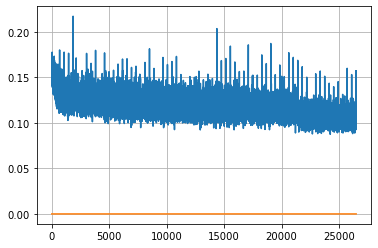

Epoch: 69, iteration 0, loss 0.1119491457939148, cov_diff 0.41349442393914304 cov_diff train 0.41322439486035645
Epoch: 69, iteration 1, loss 0.09702003002166748, cov_diff 0.41332339980756594 cov_diff train 0.41296321787673396
Epoch: 69, iteration 2, loss 0.10045838356018066, cov_diff 0.40966904740456644 cov_diff train 0.4093751022499617
Epoch: 69, iteration 3, loss 0.11350122094154358, cov_diff 0.4377641898873834 cov_diff train 0.4372910257232989
Epoch: 69, iteration 4, loss 0.09847462177276611, cov_diff 0.44126602435031864 cov_diff train 0.4409664477716048
Epoch: 69, iteration 5, loss 0.10551470518112183, cov_diff 0.43321964180215294 cov_diff train 0.4321997234010138
Epoch: 69, iteration 6, loss 0.09956368803977966, cov_diff 0.44185539856877076 cov_diff train 0.44123848610834976
Epoch: 69, iteration 7, loss 0.10090690851211548, cov_diff 0.43427988127771 cov_diff train 0.4333370603273888
Epoch: 69, iteration 8, loss 0.10820648074150085, cov_diff 0.43438750013339167 cov_diff train 0.43

Epoch: 69, iteration 78, loss 0.10680890083312988, cov_diff 0.4163103371207554 cov_diff train 0.41614626856676706
Epoch: 69, iteration 79, loss 0.10401809215545654, cov_diff 0.42949304488336404 cov_diff train 0.4287947346757584
Epoch: 69, iteration 80, loss 0.11117088794708252, cov_diff 0.43818018110543605 cov_diff train 0.4372961292484638
Epoch: 69, iteration 81, loss 0.10960307717323303, cov_diff 0.4332086635859205 cov_diff train 0.4325555685442487
Epoch: 69, iteration 82, loss 0.09537443518638611, cov_diff 0.4208276722569459 cov_diff train 0.42013579641601906
Epoch: 69, iteration 83, loss 0.09560194611549377, cov_diff 0.419524967205048 cov_diff train 0.4192545903487878
Epoch: 69, iteration 84, loss 0.11600497364997864, cov_diff 0.4239908798916909 cov_diff train 0.42316625608206615
Epoch: 69, iteration 85, loss 0.10252198576927185, cov_diff 0.42786065407672197 cov_diff train 0.4266695874417493
Epoch: 69, iteration 86, loss 0.09496411681175232, cov_diff 0.42094522972778287 cov_diff tr

Epoch: 69, iteration 152, loss 0.10576930642127991, cov_diff 0.4261090608196376 cov_diff train 0.4248118475494167
Epoch: 69, iteration 153, loss 0.10265949368476868, cov_diff 0.44171759631573104 cov_diff train 0.4405447148135408
Epoch: 69, iteration 154, loss 0.11307498812675476, cov_diff 0.4368279799690327 cov_diff train 0.4360243572557439
Epoch: 69, iteration 155, loss 0.10812336206436157, cov_diff 0.4292424229867945 cov_diff train 0.42815581202530073
Epoch: 69, iteration 156, loss 0.1349368393421173, cov_diff 0.4364896936475223 cov_diff train 0.4342316717628928
Epoch: 69, iteration 157, loss 0.10665935277938843, cov_diff 0.43445243117613486 cov_diff train 0.4324451774506142
Epoch: 69, iteration 158, loss 0.11321583390235901, cov_diff 0.43423007455536505 cov_diff train 0.4329570386658695
Epoch: 69, iteration 159, loss 0.10232201218605042, cov_diff 0.4210070411681865 cov_diff train 0.4206006680080676
Epoch: 69, iteration 160, loss 0.10071548819541931, cov_diff 0.41625280916036395 cov_

Epoch: 69, iteration 229, loss 0.09521889686584473, cov_diff 0.4375829114634445 cov_diff train 0.4373718254369719
Epoch: 69, iteration 230, loss 0.09786349534988403, cov_diff 0.43176856774520733 cov_diff train 0.431678831173165
Epoch: 69, iteration 231, loss 0.09645619988441467, cov_diff 0.4364515582049527 cov_diff train 0.43565301289703295
Epoch: 69, iteration 232, loss 0.1035115122795105, cov_diff 0.43613289669315347 cov_diff train 0.43515774136633983
Epoch: 69, iteration 233, loss 0.11383131146430969, cov_diff 0.43729588766020994 cov_diff train 0.43562461281629516
Epoch: 69, iteration 234, loss 0.1056450605392456, cov_diff 0.4125133167317029 cov_diff train 0.41188740450409655
Epoch: 69, iteration 235, loss 0.10593950748443604, cov_diff 0.41816809593837256 cov_diff train 0.4174817641152173
Epoch: 69, iteration 236, loss 0.10323986411094666, cov_diff 0.42867143210416475 cov_diff train 0.42866616410593633
Epoch: 69, iteration 237, loss 0.10539758205413818, cov_diff 0.43161212999530535 

Epoch: 69, iteration 306, loss 0.10870054364204407, cov_diff 0.43537711137445495 cov_diff train 0.43448106551001
Epoch: 69, iteration 307, loss 0.10668978095054626, cov_diff 0.4295479978430964 cov_diff train 0.42941680874327026
Epoch: 69, iteration 308, loss 0.1261572539806366, cov_diff 0.4334299057391505 cov_diff train 0.43248037026780306
Epoch: 69, iteration 309, loss 0.11213633418083191, cov_diff 0.4333002495415211 cov_diff train 0.4332331006634251
Epoch: 69, iteration 310, loss 0.09860947728157043, cov_diff 0.41064895611145136 cov_diff train 0.4106162064784785
Epoch: 69, iteration 311, loss 0.10287821292877197, cov_diff 0.4201638110226905 cov_diff train 0.41941860617380566
Epoch: 69, iteration 312, loss 0.09789934754371643, cov_diff 0.4314611095906773 cov_diff train 0.4309710639493154
Epoch: 69, iteration 313, loss 0.11988705396652222, cov_diff 0.4346687711868109 cov_diff train 0.43433787000751584
Epoch: 69, iteration 314, loss 0.1117343008518219, cov_diff 0.4350766896162388 cov_di

Epoch: 69, iteration 383, loss 0.11601895093917847, cov_diff 0.4432329999080655 cov_diff train 0.44277772255842873
Epoch: 69, iteration 384, loss 0.09821456670761108, cov_diff 0.4363828628732395 cov_diff train 0.43528514106701427
Epoch: 69, iteration 385, loss 0.0991601049900055, cov_diff 0.4239190730974258 cov_diff train 0.4234804840155498
Epoch: 69, iteration 386, loss 0.10887369513511658, cov_diff 0.426477981228136 cov_diff train 0.4255565926002054
Epoch: 69, iteration 387, loss 0.1134009063243866, cov_diff 0.4200778750404938 cov_diff train 0.4196182299929718
Epoch: 69, iteration 388, loss 0.10570394992828369, cov_diff 0.4177500875470785 cov_diff train 0.41738751331945195
Epoch: 69, iteration 389, loss 0.11057767271995544, cov_diff 0.4350915066356261 cov_diff train 0.43395247474514753
Epoch: 69, iteration 390, loss 0.14372342824935913, cov_diff 0.45174997160084457 cov_diff train 0.45106546940393377


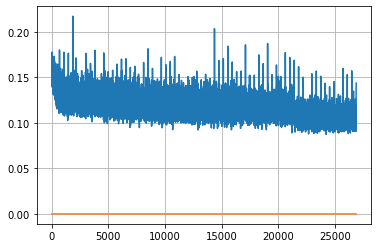

Epoch: 70, iteration 0, loss 0.09025731682777405, cov_diff 0.4280621650786028 cov_diff train 0.42743744308569376
Epoch: 70, iteration 1, loss 0.09831297397613525, cov_diff 0.4339651496200958 cov_diff train 0.43273156507306154
Epoch: 70, iteration 2, loss 0.1035914421081543, cov_diff 0.4259504627354426 cov_diff train 0.4243279318358645
Epoch: 70, iteration 3, loss 0.09849926829338074, cov_diff 0.4284298274702612 cov_diff train 0.42767627582104945
Epoch: 70, iteration 4, loss 0.10423564910888672, cov_diff 0.43941382433707277 cov_diff train 0.4385569685882075
Epoch: 70, iteration 5, loss 0.10561102628707886, cov_diff 0.43555837686771753 cov_diff train 0.4352062911871545
Epoch: 70, iteration 6, loss 0.11073583364486694, cov_diff 0.41761839823936575 cov_diff train 0.4175913995129636
Epoch: 70, iteration 7, loss 0.10485833883285522, cov_diff 0.42322845650397306 cov_diff train 0.4228966132056735
Epoch: 70, iteration 8, loss 0.09793052077293396, cov_diff 0.4294760680542109 cov_diff train 0.428

Epoch: 70, iteration 75, loss 0.10676613450050354, cov_diff 0.4181228953260848 cov_diff train 0.4173456942623732
Epoch: 70, iteration 76, loss 0.10644933581352234, cov_diff 0.4196299132763058 cov_diff train 0.41900027869046
Epoch: 70, iteration 77, loss 0.09829708933830261, cov_diff 0.4334493120743174 cov_diff train 0.4328170957912232
Epoch: 70, iteration 78, loss 0.09681940078735352, cov_diff 0.42323043732563065 cov_diff train 0.4230475752944703
Epoch: 70, iteration 79, loss 0.10897383093833923, cov_diff 0.4244338567736749 cov_diff train 0.4232025621051981
Epoch: 70, iteration 80, loss 0.10977587103843689, cov_diff 0.43473802763226516 cov_diff train 0.4333414234323418
Epoch: 70, iteration 81, loss 0.10142236948013306, cov_diff 0.4190970784348801 cov_diff train 0.4192066138803058
Epoch: 70, iteration 82, loss 0.10132387280464172, cov_diff 0.4270238168371453 cov_diff train 0.4261124289773637
Epoch: 70, iteration 83, loss 0.10898151993751526, cov_diff 0.41955025085174835 cov_diff train 0

Epoch: 70, iteration 148, loss 0.11025360226631165, cov_diff 0.43663412382794603 cov_diff train 0.43577974570003325
Epoch: 70, iteration 149, loss 0.10905119776725769, cov_diff 0.4367751361682385 cov_diff train 0.4369553819637542
Epoch: 70, iteration 150, loss 0.10300296545028687, cov_diff 0.4182851341650834 cov_diff train 0.4178670303307358
Epoch: 70, iteration 151, loss 0.1061704158782959, cov_diff 0.4438661153447576 cov_diff train 0.44287868873103536
Epoch: 70, iteration 152, loss 0.11891531944274902, cov_diff 0.43367371632604657 cov_diff train 0.43322123115088135
Epoch: 70, iteration 153, loss 0.1063239574432373, cov_diff 0.4283317855749053 cov_diff train 0.4282528872336153
Epoch: 70, iteration 154, loss 0.10778117179870605, cov_diff 0.43106451750282065 cov_diff train 0.43140842739481905
Epoch: 70, iteration 155, loss 0.11922639608383179, cov_diff 0.44104935618831176 cov_diff train 0.44067389481587377
Epoch: 70, iteration 156, loss 0.11062589287757874, cov_diff 0.42235385456462265 

Epoch: 70, iteration 224, loss 0.1135711669921875, cov_diff 0.44787895240470993 cov_diff train 0.4469831724461293
Epoch: 70, iteration 225, loss 0.11477804183959961, cov_diff 0.4366456085729888 cov_diff train 0.43613495796457563
Epoch: 70, iteration 226, loss 0.11765149235725403, cov_diff 0.4384780388861031 cov_diff train 0.4382801605121898
Epoch: 70, iteration 227, loss 0.11138251423835754, cov_diff 0.43073552593330144 cov_diff train 0.4302020658359048
Epoch: 70, iteration 228, loss 0.1047951877117157, cov_diff 0.43537892246715354 cov_diff train 0.4338855902769722
Epoch: 70, iteration 229, loss 0.08785697817802429, cov_diff 0.4283012641351668 cov_diff train 0.4275953506448548
Epoch: 70, iteration 230, loss 0.10727044939994812, cov_diff 0.43252829777584806 cov_diff train 0.4319014721171873
Epoch: 70, iteration 231, loss 0.09972059726715088, cov_diff 0.4409752861285228 cov_diff train 0.43970899571308236
Epoch: 70, iteration 232, loss 0.09814280271530151, cov_diff 0.42059348002803804 cov

Epoch: 70, iteration 297, loss 0.106255441904068, cov_diff 0.4382586176160831 cov_diff train 0.43785256584424853
Epoch: 70, iteration 298, loss 0.1045968234539032, cov_diff 0.4244087909629491 cov_diff train 0.42406034800425246
Epoch: 70, iteration 299, loss 0.10775086283683777, cov_diff 0.42490432045813087 cov_diff train 0.42426892835353697
Epoch: 70, iteration 300, loss 0.11408847570419312, cov_diff 0.41404030361245187 cov_diff train 0.4141646378647694
Epoch: 70, iteration 301, loss 0.0999438464641571, cov_diff 0.436624648760415 cov_diff train 0.436906520121618
Epoch: 70, iteration 302, loss 0.10390308499336243, cov_diff 0.4427344972671377 cov_diff train 0.44143194899379906
Epoch: 70, iteration 303, loss 0.10106837749481201, cov_diff 0.41006737479956257 cov_diff train 0.40986926548767294
Epoch: 70, iteration 304, loss 0.11686602234840393, cov_diff 0.4323589158233363 cov_diff train 0.43261756306688937
Epoch: 70, iteration 305, loss 0.10624092817306519, cov_diff 0.4274762194457636 cov_d

Epoch: 70, iteration 376, loss 0.1164366602897644, cov_diff 0.42002959265125245 cov_diff train 0.41912868968101624
Epoch: 70, iteration 377, loss 0.11192291975021362, cov_diff 0.4497043127422264 cov_diff train 0.4491324178864068
Epoch: 70, iteration 378, loss 0.09957128763198853, cov_diff 0.4363614044632004 cov_diff train 0.43548528097395
Epoch: 70, iteration 379, loss 0.1003846526145935, cov_diff 0.4419407279962173 cov_diff train 0.44224103281714083
Epoch: 70, iteration 380, loss 0.09552532434463501, cov_diff 0.43040552143193406 cov_diff train 0.42984442411427604
Epoch: 70, iteration 381, loss 0.10615584254264832, cov_diff 0.4238461394741825 cov_diff train 0.42290030951556756
Epoch: 70, iteration 382, loss 0.10769146680831909, cov_diff 0.43062564481353144 cov_diff train 0.4300691998708385
Epoch: 70, iteration 383, loss 0.0936332643032074, cov_diff 0.43203224779240257 cov_diff train 0.4302843792304074
Epoch: 70, iteration 384, loss 0.0943148136138916, cov_diff 0.4310481458917743 cov_di

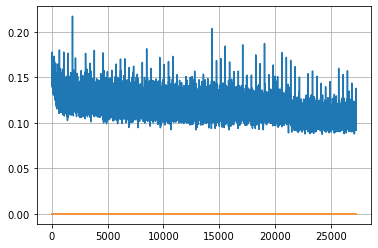

Epoch: 71, iteration 0, loss 0.10062426328659058, cov_diff 0.41216024979584326 cov_diff train 0.41083596899007524
Epoch: 71, iteration 1, loss 0.10243865847587585, cov_diff 0.4310071071993101 cov_diff train 0.4303776496920925
Epoch: 71, iteration 2, loss 0.0988951325416565, cov_diff 0.42421290469786643 cov_diff train 0.4230238497241927
Epoch: 71, iteration 3, loss 0.09328055381774902, cov_diff 0.4217292934291934 cov_diff train 0.4211339409246732
Epoch: 71, iteration 4, loss 0.11260044574737549, cov_diff 0.41751674824611557 cov_diff train 0.41771343664566346
Epoch: 71, iteration 5, loss 0.10297220945358276, cov_diff 0.43070904164856394 cov_diff train 0.4300761912194215
Epoch: 71, iteration 6, loss 0.09383419156074524, cov_diff 0.4138602767102606 cov_diff train 0.413888134470353
Epoch: 71, iteration 7, loss 0.10748663544654846, cov_diff 0.4235987151197684 cov_diff train 0.4229573927411113
Epoch: 71, iteration 8, loss 0.10142898559570312, cov_diff 0.4343384169325366 cov_diff train 0.43376

Epoch: 71, iteration 77, loss 0.11380752921104431, cov_diff 0.41460093260510783 cov_diff train 0.41441362458367687
Epoch: 71, iteration 78, loss 0.10625031590461731, cov_diff 0.4372306095573924 cov_diff train 0.4359333592708426
Epoch: 71, iteration 79, loss 0.09912508726119995, cov_diff 0.4181524649707736 cov_diff train 0.41784045920195034
Epoch: 71, iteration 80, loss 0.09128239750862122, cov_diff 0.42278486532549364 cov_diff train 0.42187848189278143
Epoch: 71, iteration 81, loss 0.1074800193309784, cov_diff 0.41891535500850025 cov_diff train 0.418760596091825
Epoch: 71, iteration 82, loss 0.10850760340690613, cov_diff 0.42702954438670815 cov_diff train 0.426357748408799
Epoch: 71, iteration 83, loss 0.10238444805145264, cov_diff 0.41062160009324866 cov_diff train 0.4104088589617424
Epoch: 71, iteration 84, loss 0.09372460842132568, cov_diff 0.4084358433046287 cov_diff train 0.40855914777046676
Epoch: 71, iteration 85, loss 0.11424785852432251, cov_diff 0.413035770159347 cov_diff tra

Epoch: 71, iteration 155, loss 0.09494996070861816, cov_diff 0.41103616316197605 cov_diff train 0.41092302415517845
Epoch: 71, iteration 156, loss 0.09823891520500183, cov_diff 0.4146141066003516 cov_diff train 0.41441825835143675
Epoch: 71, iteration 157, loss 0.09630298614501953, cov_diff 0.42884465342873224 cov_diff train 0.42857673372815847
Epoch: 71, iteration 158, loss 0.09934118390083313, cov_diff 0.4234134638422953 cov_diff train 0.4230906852332444
Epoch: 71, iteration 159, loss 0.11076655983924866, cov_diff 0.4144902407270086 cov_diff train 0.4133518630237119
Epoch: 71, iteration 160, loss 0.10443148016929626, cov_diff 0.420662268840299 cov_diff train 0.4202209300518752
Epoch: 71, iteration 161, loss 0.10321632027626038, cov_diff 0.4271628734923403 cov_diff train 0.42709920600981693
Epoch: 71, iteration 162, loss 0.11839145421981812, cov_diff 0.43309996251197713 cov_diff train 0.432606963064662
Epoch: 71, iteration 163, loss 0.10243478417396545, cov_diff 0.41124997047604356 co

Epoch: 71, iteration 233, loss 0.10063731670379639, cov_diff 0.42504036759970143 cov_diff train 0.4250709594239571
Epoch: 71, iteration 234, loss 0.11656901240348816, cov_diff 0.42247229788860263 cov_diff train 0.4213438777087199
Epoch: 71, iteration 235, loss 0.10858365893363953, cov_diff 0.4214779229930631 cov_diff train 0.4212805725215984
Epoch: 71, iteration 236, loss 0.09379011392593384, cov_diff 0.4115772626607593 cov_diff train 0.41081439218566046
Epoch: 71, iteration 237, loss 0.11094596982002258, cov_diff 0.42434646705764595 cov_diff train 0.42317637980884565
Epoch: 71, iteration 238, loss 0.10387241840362549, cov_diff 0.41978237768186977 cov_diff train 0.4186912209053542
Epoch: 71, iteration 239, loss 0.11438190937042236, cov_diff 0.4196300148991333 cov_diff train 0.41858730844396763
Epoch: 71, iteration 240, loss 0.11167430877685547, cov_diff 0.4229632879240843 cov_diff train 0.4230237783233231
Epoch: 71, iteration 241, loss 0.09257587790489197, cov_diff 0.4260946468082649 c

Epoch: 71, iteration 311, loss 0.10831263661384583, cov_diff 0.41706897676744115 cov_diff train 0.41676245322330335
Epoch: 71, iteration 312, loss 0.10035684704780579, cov_diff 0.4414735421025127 cov_diff train 0.4408704778518498
Epoch: 71, iteration 313, loss 0.09632974863052368, cov_diff 0.43777502284673114 cov_diff train 0.43619132454502957
Epoch: 71, iteration 314, loss 0.10657298564910889, cov_diff 0.4189095778860204 cov_diff train 0.41828026107643446
Epoch: 71, iteration 315, loss 0.10823988914489746, cov_diff 0.44878965404853965 cov_diff train 0.4478439095748139
Epoch: 71, iteration 316, loss 0.10370945930480957, cov_diff 0.43158276897673725 cov_diff train 0.4308932395742366
Epoch: 71, iteration 317, loss 0.09307783842086792, cov_diff 0.4311804329150059 cov_diff train 0.4304245412363325
Epoch: 71, iteration 318, loss 0.1049092710018158, cov_diff 0.4277765544584609 cov_diff train 0.4272264775841661
Epoch: 71, iteration 319, loss 0.10541754961013794, cov_diff 0.42379047281238313 c

Epoch: 71, iteration 383, loss 0.10677993297576904, cov_diff 0.4225349730537396 cov_diff train 0.42227180325406655
Epoch: 71, iteration 384, loss 0.10403084754943848, cov_diff 0.42013422225136415 cov_diff train 0.4190238864496329
Epoch: 71, iteration 385, loss 0.10251718759536743, cov_diff 0.4085975320405365 cov_diff train 0.4079203423606787
Epoch: 71, iteration 386, loss 0.11002147197723389, cov_diff 0.43322791778039277 cov_diff train 0.4323963299808592
Epoch: 71, iteration 387, loss 0.10268303751945496, cov_diff 0.4291992479000118 cov_diff train 0.4289066133391673
Epoch: 71, iteration 388, loss 0.09775543212890625, cov_diff 0.4307110902215317 cov_diff train 0.43043233883830606
Epoch: 71, iteration 389, loss 0.10269024968147278, cov_diff 0.41677549032264033 cov_diff train 0.4164038436617206
Epoch: 71, iteration 390, loss 0.1349978744983673, cov_diff 0.47419197558471027 cov_diff train 0.47361107771659083


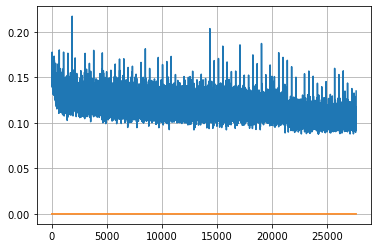

Epoch: 72, iteration 0, loss 0.11383384466171265, cov_diff 0.4352395150941115 cov_diff train 0.4343494583842619
Epoch: 72, iteration 1, loss 0.09832054376602173, cov_diff 0.42397708553248936 cov_diff train 0.42359793065351586
Epoch: 72, iteration 2, loss 0.10663178563117981, cov_diff 0.43250354283752046 cov_diff train 0.43194691434243293
Epoch: 72, iteration 3, loss 0.10317742824554443, cov_diff 0.4479153204700056 cov_diff train 0.4471535908252701
Epoch: 72, iteration 4, loss 0.09670686721801758, cov_diff 0.4164636600219244 cov_diff train 0.41544797299775194
Epoch: 72, iteration 5, loss 0.11776334047317505, cov_diff 0.44111389080994445 cov_diff train 0.44138261450181376
Epoch: 72, iteration 6, loss 0.10226258635520935, cov_diff 0.41122573429635884 cov_diff train 0.4101862182156598
Epoch: 72, iteration 7, loss 0.10742780566215515, cov_diff 0.431504217662302 cov_diff train 0.4304956283464437
Epoch: 72, iteration 8, loss 0.09649208188056946, cov_diff 0.42395770374018776 cov_diff train 0.4

Epoch: 72, iteration 79, loss 0.1132451593875885, cov_diff 0.42418756082966536 cov_diff train 0.42372027708603766
Epoch: 72, iteration 80, loss 0.10379904508590698, cov_diff 0.41678877843451306 cov_diff train 0.4168908850734137
Epoch: 72, iteration 81, loss 0.11406975984573364, cov_diff 0.43072993937098863 cov_diff train 0.4298338306244323
Epoch: 72, iteration 82, loss 0.10405322909355164, cov_diff 0.4241933338615545 cov_diff train 0.4243268884494496
Epoch: 72, iteration 83, loss 0.09596693515777588, cov_diff 0.4215441483257047 cov_diff train 0.42071511825883234
Epoch: 72, iteration 84, loss 0.10480877757072449, cov_diff 0.41199560416661324 cov_diff train 0.4121783168584367
Epoch: 72, iteration 85, loss 0.10638689994812012, cov_diff 0.43701985082012434 cov_diff train 0.43697965163555524
Epoch: 72, iteration 86, loss 0.11004674434661865, cov_diff 0.42553561696951897 cov_diff train 0.42533787057497513
Epoch: 72, iteration 87, loss 0.11232456564903259, cov_diff 0.415271031199378 cov_diff 

Epoch: 72, iteration 155, loss 0.11405438184738159, cov_diff 0.42434862102818227 cov_diff train 0.42373475654847154
Epoch: 72, iteration 156, loss 0.11226990818977356, cov_diff 0.4307469171610989 cov_diff train 0.4300836010230177
Epoch: 72, iteration 157, loss 0.11139649152755737, cov_diff 0.42674262142119856 cov_diff train 0.42619499941180206
Epoch: 72, iteration 158, loss 0.1090395450592041, cov_diff 0.4447477660212604 cov_diff train 0.44414348129479064
Epoch: 72, iteration 159, loss 0.10707709193229675, cov_diff 0.4298591951874055 cov_diff train 0.4293342931521108
Epoch: 72, iteration 160, loss 0.10038048028945923, cov_diff 0.4255723807056765 cov_diff train 0.4251715745978786
Epoch: 72, iteration 161, loss 0.09809941053390503, cov_diff 0.42862823627001945 cov_diff train 0.4272526893039289
Epoch: 72, iteration 162, loss 0.11803799867630005, cov_diff 0.420690116526857 cov_diff train 0.4197995515980649
Epoch: 72, iteration 163, loss 0.09764596819877625, cov_diff 0.44134621637315574 cov

Epoch: 72, iteration 229, loss 0.11831560730934143, cov_diff 0.42584753675997133 cov_diff train 0.4254888024568707
Epoch: 72, iteration 230, loss 0.10633087158203125, cov_diff 0.42016066878436953 cov_diff train 0.41972098183997114
Epoch: 72, iteration 231, loss 0.11102521419525146, cov_diff 0.4381257959461904 cov_diff train 0.4367312754061528
Epoch: 72, iteration 232, loss 0.09814697504043579, cov_diff 0.41142394694855866 cov_diff train 0.41144401821928
Epoch: 72, iteration 233, loss 0.10993129014968872, cov_diff 0.41325872806345165 cov_diff train 0.4133767064095176
Epoch: 72, iteration 234, loss 0.09297406673431396, cov_diff 0.4172252858161929 cov_diff train 0.41718148103974656
Epoch: 72, iteration 235, loss 0.1080206036567688, cov_diff 0.4255736937502376 cov_diff train 0.42560155122387566
Epoch: 72, iteration 236, loss 0.10805922746658325, cov_diff 0.4301746254973879 cov_diff train 0.4304558876968421
Epoch: 72, iteration 237, loss 0.10714662075042725, cov_diff 0.4377783935501222 cov_

Epoch: 72, iteration 307, loss 0.10035637021064758, cov_diff 0.43983517420547064 cov_diff train 0.4374667459081973
Epoch: 72, iteration 308, loss 0.12005192041397095, cov_diff 0.41376429763643663 cov_diff train 0.41231689651666525
Epoch: 72, iteration 309, loss 0.09857910871505737, cov_diff 0.43013324844950274 cov_diff train 0.4288342894481163
Epoch: 72, iteration 310, loss 0.09592095017433167, cov_diff 0.43177094340344 cov_diff train 0.4313107345430024
Epoch: 72, iteration 311, loss 0.11636710166931152, cov_diff 0.4223580945189247 cov_diff train 0.42144500622894626
Epoch: 72, iteration 312, loss 0.11599260568618774, cov_diff 0.424665125812953 cov_diff train 0.4235520785021717
Epoch: 72, iteration 313, loss 0.10676252841949463, cov_diff 0.4257631270821452 cov_diff train 0.42527972099772343
Epoch: 72, iteration 314, loss 0.1069171130657196, cov_diff 0.4363618694929197 cov_diff train 0.4338056554915434
Epoch: 72, iteration 315, loss 0.10474008321762085, cov_diff 0.42320812422325954 cov_d

Epoch: 72, iteration 387, loss 0.11420139670372009, cov_diff 0.43396604939559885 cov_diff train 0.4333240539722343
Epoch: 72, iteration 388, loss 0.1178002655506134, cov_diff 0.4296369180999971 cov_diff train 0.4291142729372056
Epoch: 72, iteration 389, loss 0.0956321656703949, cov_diff 0.4260114061189182 cov_diff train 0.42509697153793224
Epoch: 72, iteration 390, loss 0.15817949175834656, cov_diff 0.48187863099931505 cov_diff train 0.48066863345374344


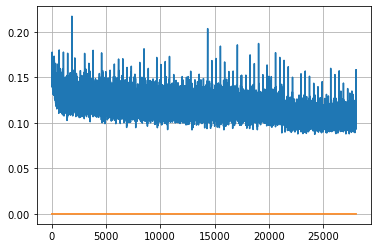

Epoch: 73, iteration 0, loss 0.09325477480888367, cov_diff 0.425718355869896 cov_diff train 0.42517291073143637
Epoch: 73, iteration 1, loss 0.10272741317749023, cov_diff 0.415862612704285 cov_diff train 0.4147407546852477
Epoch: 73, iteration 2, loss 0.10776820778846741, cov_diff 0.42536078606219935 cov_diff train 0.42516435585641654
Epoch: 73, iteration 3, loss 0.10203543305397034, cov_diff 0.42561337406250493 cov_diff train 0.4255662957267541
Epoch: 73, iteration 4, loss 0.10018467903137207, cov_diff 0.43110629861093913 cov_diff train 0.43023578557206416
Epoch: 73, iteration 5, loss 0.10512349009513855, cov_diff 0.4297870924258821 cov_diff train 0.42853787819588113
Epoch: 73, iteration 6, loss 0.09710296988487244, cov_diff 0.42240446620274535 cov_diff train 0.42170861669225745
Epoch: 73, iteration 7, loss 0.10001826286315918, cov_diff 0.42017414221358296 cov_diff train 0.4193606531942692
Epoch: 73, iteration 8, loss 0.10388001799583435, cov_diff 0.42095576723172523 cov_diff train 0.

Epoch: 73, iteration 73, loss 0.10721683502197266, cov_diff 0.4502303143783725 cov_diff train 0.4489026784273098
Epoch: 73, iteration 74, loss 0.1097918152809143, cov_diff 0.4230281872858153 cov_diff train 0.4228249144367214
Epoch: 73, iteration 75, loss 0.12234246730804443, cov_diff 0.4380503277559489 cov_diff train 0.4368423062213938
Epoch: 73, iteration 76, loss 0.1145886480808258, cov_diff 0.4350135265385786 cov_diff train 0.43351183036105356
Epoch: 73, iteration 77, loss 0.09844842553138733, cov_diff 0.41053323352038235 cov_diff train 0.4099921196233626
Epoch: 73, iteration 78, loss 0.10502040386199951, cov_diff 0.42612015773499756 cov_diff train 0.4256945454464205
Epoch: 73, iteration 79, loss 0.10604414343833923, cov_diff 0.4348621772786297 cov_diff train 0.43545212126310195
Epoch: 73, iteration 80, loss 0.10967829823493958, cov_diff 0.41967796156917514 cov_diff train 0.41933644016923693
Epoch: 73, iteration 81, loss 0.11217236518859863, cov_diff 0.4230385199924852 cov_diff trai

Epoch: 73, iteration 150, loss 0.10004857182502747, cov_diff 0.43078812110372555 cov_diff train 0.43117918020733503
Epoch: 73, iteration 151, loss 0.10066258907318115, cov_diff 0.4100139944499959 cov_diff train 0.4099776949484413
Epoch: 73, iteration 152, loss 0.09554648399353027, cov_diff 0.4125033131702674 cov_diff train 0.4124436955024602
Epoch: 73, iteration 153, loss 0.09933286905288696, cov_diff 0.43211461139823404 cov_diff train 0.4314183118689669
Epoch: 73, iteration 154, loss 0.10483178496360779, cov_diff 0.436942735133724 cov_diff train 0.43643359695395184
Epoch: 73, iteration 155, loss 0.11328756809234619, cov_diff 0.450084640932792 cov_diff train 0.4493066724287024
Epoch: 73, iteration 156, loss 0.11475449800491333, cov_diff 0.4321074494453872 cov_diff train 0.43217435164165713
Epoch: 73, iteration 157, loss 0.11219382286071777, cov_diff 0.43361197854501565 cov_diff train 0.4328393382025424
Epoch: 73, iteration 158, loss 0.10019651055335999, cov_diff 0.4373487009665354 cov_

Epoch: 73, iteration 227, loss 0.10980784893035889, cov_diff 0.4226986127621089 cov_diff train 0.4229045687240833
Epoch: 73, iteration 228, loss 0.10573863983154297, cov_diff 0.41903105958908743 cov_diff train 0.4183418336745263
Epoch: 73, iteration 229, loss 0.09853100776672363, cov_diff 0.4274323781903238 cov_diff train 0.4263743530194466
Epoch: 73, iteration 230, loss 0.09734755754470825, cov_diff 0.4158532069277932 cov_diff train 0.4160386357905211
Epoch: 73, iteration 231, loss 0.10051646828651428, cov_diff 0.4110384262120151 cov_diff train 0.41042240886932757
Epoch: 73, iteration 232, loss 0.09755328297615051, cov_diff 0.42221534980583314 cov_diff train 0.4219243474395749
Epoch: 73, iteration 233, loss 0.10308477282524109, cov_diff 0.4309013985860148 cov_diff train 0.43058204423039687
Epoch: 73, iteration 234, loss 0.11120694875717163, cov_diff 0.431446967992573 cov_diff train 0.4313605789484763
Epoch: 73, iteration 235, loss 0.10223403573036194, cov_diff 0.4174427443482658 cov_d

Epoch: 73, iteration 304, loss 0.10814887285232544, cov_diff 0.42684920745838684 cov_diff train 0.42492089469666033
Epoch: 73, iteration 305, loss 0.1074281632900238, cov_diff 0.4199312285373283 cov_diff train 0.41949165488552437
Epoch: 73, iteration 306, loss 0.1061200201511383, cov_diff 0.4156408240429846 cov_diff train 0.4152045285622484
Epoch: 73, iteration 307, loss 0.103751540184021, cov_diff 0.41587703805651605 cov_diff train 0.41472320566938853
Epoch: 73, iteration 308, loss 0.10333189368247986, cov_diff 0.4309802654034156 cov_diff train 0.4313226962619373
Epoch: 73, iteration 309, loss 0.10240909457206726, cov_diff 0.4082541272337543 cov_diff train 0.4080698299548051
Epoch: 73, iteration 310, loss 0.11095097661018372, cov_diff 0.42064294061736757 cov_diff train 0.4184497037743491
Epoch: 73, iteration 311, loss 0.09915313124656677, cov_diff 0.4201327326569032 cov_diff train 0.41904115719125934
Epoch: 73, iteration 312, loss 0.10711762309074402, cov_diff 0.41918421555016805 cov_

Epoch: 73, iteration 382, loss 0.12724587321281433, cov_diff 0.431131729063632 cov_diff train 0.4311893948604625
Epoch: 73, iteration 383, loss 0.11111339926719666, cov_diff 0.4265194110645702 cov_diff train 0.4253658189365696
Epoch: 73, iteration 384, loss 0.09977751970291138, cov_diff 0.4121168968652632 cov_diff train 0.41144257474175416
Epoch: 73, iteration 385, loss 0.0945054292678833, cov_diff 0.4183218495910216 cov_diff train 0.41793412996078455
Epoch: 73, iteration 386, loss 0.10374122858047485, cov_diff 0.42690855113128773 cov_diff train 0.42670738766897026
Epoch: 73, iteration 387, loss 0.1127842366695404, cov_diff 0.4239668222834578 cov_diff train 0.4229580293042501
Epoch: 73, iteration 388, loss 0.09931322932243347, cov_diff 0.41788592527678653 cov_diff train 0.41735500405361786
Epoch: 73, iteration 389, loss 0.10611370205879211, cov_diff 0.42067459663199014 cov_diff train 0.420133247338654
Epoch: 73, iteration 390, loss 0.15470075607299805, cov_diff 0.46300713139326694 cov_

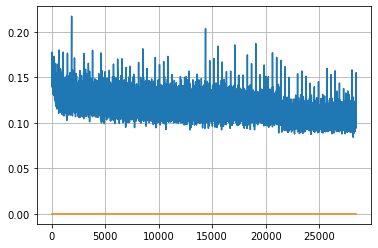

Epoch: 74, iteration 0, loss 0.10878607630729675, cov_diff 0.43874771313424255 cov_diff train 0.43820045874270686
Epoch: 74, iteration 1, loss 0.10723221302032471, cov_diff 0.4014901919156134 cov_diff train 0.4014443377341489
Epoch: 74, iteration 2, loss 0.09804314374923706, cov_diff 0.4219222637242582 cov_diff train 0.4220532246903207
Epoch: 74, iteration 3, loss 0.1031954288482666, cov_diff 0.43292758506432977 cov_diff train 0.43164367928524483
Epoch: 74, iteration 4, loss 0.10551443696022034, cov_diff 0.4024609545527004 cov_diff train 0.4013590070967508
Epoch: 74, iteration 5, loss 0.10918328166007996, cov_diff 0.4322704269834108 cov_diff train 0.4316207330448687
Epoch: 74, iteration 6, loss 0.09799894690513611, cov_diff 0.43490970111693933 cov_diff train 0.4340481113785327
Epoch: 74, iteration 7, loss 0.09723421931266785, cov_diff 0.42761985769101 cov_diff train 0.42701714819499736
Epoch: 74, iteration 8, loss 0.11452263593673706, cov_diff 0.44119495400845177 cov_diff train 0.44026

Epoch: 74, iteration 80, loss 0.10450625419616699, cov_diff 0.4288035729945527 cov_diff train 0.42742714414905086
Epoch: 74, iteration 81, loss 0.10657152533531189, cov_diff 0.4192949873128806 cov_diff train 0.4186670124967169
Epoch: 74, iteration 82, loss 0.10609900951385498, cov_diff 0.42363760952041024 cov_diff train 0.4236594188640301
Epoch: 74, iteration 83, loss 0.10875627398490906, cov_diff 0.41546661806931034 cov_diff train 0.4145012322269799
Epoch: 74, iteration 84, loss 0.09716826677322388, cov_diff 0.40895768928108595 cov_diff train 0.40892602803827144
Epoch: 74, iteration 85, loss 0.10728752613067627, cov_diff 0.42395146721980936 cov_diff train 0.4235249680400307
Epoch: 74, iteration 86, loss 0.10410276055335999, cov_diff 0.4218076930781318 cov_diff train 0.4211688203117183
Epoch: 74, iteration 87, loss 0.10165432095527649, cov_diff 0.42593218612608547 cov_diff train 0.4257940927446736
Epoch: 74, iteration 88, loss 0.10916486382484436, cov_diff 0.42186932543513883 cov_diff 

Epoch: 74, iteration 152, loss 0.1041516661643982, cov_diff 0.43322088565659855 cov_diff train 0.43188317270858245
Epoch: 74, iteration 153, loss 0.10251259803771973, cov_diff 0.42328603816737365 cov_diff train 0.4222546242317013
Epoch: 74, iteration 154, loss 0.1047447919845581, cov_diff 0.4203880686440467 cov_diff train 0.41934372928201596
Epoch: 74, iteration 155, loss 0.10172781348228455, cov_diff 0.41116706700651273 cov_diff train 0.40926593117523674
Epoch: 74, iteration 156, loss 0.10658082365989685, cov_diff 0.4231551689920763 cov_diff train 0.42229584581982105
Epoch: 74, iteration 157, loss 0.10731881856918335, cov_diff 0.4157216376327638 cov_diff train 0.41467543878566954
Epoch: 74, iteration 158, loss 0.09523740410804749, cov_diff 0.42568166507131683 cov_diff train 0.4244209168596927
Epoch: 74, iteration 159, loss 0.10011261701583862, cov_diff 0.4259197771976118 cov_diff train 0.4254023119481357
Epoch: 74, iteration 160, loss 0.11364498734474182, cov_diff 0.41450314662430937 

Epoch: 74, iteration 227, loss 0.1125200092792511, cov_diff 0.43289188241378607 cov_diff train 0.4314215900875002
Epoch: 74, iteration 228, loss 0.12724411487579346, cov_diff 0.4218281462813042 cov_diff train 0.4211857091640363
Epoch: 74, iteration 229, loss 0.10711604356765747, cov_diff 0.41760396386693044 cov_diff train 0.4163043857044851
Epoch: 74, iteration 230, loss 0.10915252566337585, cov_diff 0.42480911845811936 cov_diff train 0.4238388475989381
Epoch: 74, iteration 231, loss 0.10777875781059265, cov_diff 0.43181208283590283 cov_diff train 0.4316545538531174
Epoch: 74, iteration 232, loss 0.10679972171783447, cov_diff 0.4273602406509602 cov_diff train 0.4268833998521617
Epoch: 74, iteration 233, loss 0.11762326955795288, cov_diff 0.43027950424085265 cov_diff train 0.43002116809391866
Epoch: 74, iteration 234, loss 0.1145571768283844, cov_diff 0.41914384320109926 cov_diff train 0.41856368017993506
Epoch: 74, iteration 235, loss 0.10863077640533447, cov_diff 0.43814979376108365 c

Epoch: 74, iteration 305, loss 0.11615559458732605, cov_diff 0.423277875364949 cov_diff train 0.4232246411506589
Epoch: 74, iteration 306, loss 0.10421615839004517, cov_diff 0.4154468327771996 cov_diff train 0.41497921338857746
Epoch: 74, iteration 307, loss 0.09062591195106506, cov_diff 0.42760776065028544 cov_diff train 0.42718146696343695
Epoch: 74, iteration 308, loss 0.10657435655593872, cov_diff 0.4186765484955 cov_diff train 0.41756425884960313
Epoch: 74, iteration 309, loss 0.11201739311218262, cov_diff 0.42112749867222676 cov_diff train 0.42064871468916804
Epoch: 74, iteration 310, loss 0.10737144947052002, cov_diff 0.4343685715288766 cov_diff train 0.4326620369133489
Epoch: 74, iteration 311, loss 0.0960284173488617, cov_diff 0.4253796514677582 cov_diff train 0.4247500843831516
Epoch: 74, iteration 312, loss 0.10306134819984436, cov_diff 0.4250928816314178 cov_diff train 0.42512725426513176
Epoch: 74, iteration 313, loss 0.09515181183815002, cov_diff 0.43012110003729903 cov_d

Epoch: 74, iteration 379, loss 0.10640498995780945, cov_diff 0.43534275492740376 cov_diff train 0.4342060686554683
Epoch: 74, iteration 380, loss 0.10430946946144104, cov_diff 0.42964276565430193 cov_diff train 0.42793747249702085
Epoch: 74, iteration 381, loss 0.09764915704727173, cov_diff 0.4346341177857669 cov_diff train 0.4339631850315722
Epoch: 74, iteration 382, loss 0.10420960187911987, cov_diff 0.41677838816531926 cov_diff train 0.41569734568865785
Epoch: 74, iteration 383, loss 0.11038035154342651, cov_diff 0.4164426052236306 cov_diff train 0.4163176659797362
Epoch: 74, iteration 384, loss 0.10471513867378235, cov_diff 0.4387442343654301 cov_diff train 0.4386202150947187
Epoch: 74, iteration 385, loss 0.10334181785583496, cov_diff 0.4126102221010001 cov_diff train 0.41251133622471886
Epoch: 74, iteration 386, loss 0.1091088354587555, cov_diff 0.4293749409480461 cov_diff train 0.4283869526385265
Epoch: 74, iteration 387, loss 0.11048468947410583, cov_diff 0.4251337087446211 cov

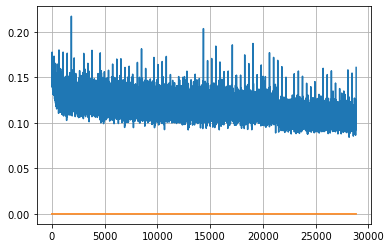

Epoch: 75, iteration 0, loss 0.11327257752418518, cov_diff 0.42116358051121205 cov_diff train 0.4220084043013035
Epoch: 75, iteration 1, loss 0.10169893503189087, cov_diff 0.4293778289112109 cov_diff train 0.42854419697045615
Epoch: 75, iteration 2, loss 0.11101633310317993, cov_diff 0.4159133646743854 cov_diff train 0.41629542090702487
Epoch: 75, iteration 3, loss 0.1005004346370697, cov_diff 0.4284407090217205 cov_diff train 0.42767966433338434
Epoch: 75, iteration 4, loss 0.095721036195755, cov_diff 0.41737937229956995 cov_diff train 0.4173138913859433
Epoch: 75, iteration 5, loss 0.10680553317070007, cov_diff 0.4170919683199405 cov_diff train 0.4161853407172009
Epoch: 75, iteration 6, loss 0.11741194128990173, cov_diff 0.42553042185412376 cov_diff train 0.4252949483065858
Epoch: 75, iteration 7, loss 0.09271109104156494, cov_diff 0.43794827398348213 cov_diff train 0.4381283738489329
Epoch: 75, iteration 8, loss 0.10752418637275696, cov_diff 0.43134864908701054 cov_diff train 0.4317

Epoch: 75, iteration 82, loss 0.10695949196815491, cov_diff 0.42380686703002 cov_diff train 0.42378841166914033
Epoch: 75, iteration 83, loss 0.10472440719604492, cov_diff 0.43095290475994347 cov_diff train 0.4303911625471576
Epoch: 75, iteration 84, loss 0.11074972152709961, cov_diff 0.42123190450553594 cov_diff train 0.420891652058055
Epoch: 75, iteration 85, loss 0.10763764381408691, cov_diff 0.43286411758737425 cov_diff train 0.4328154606235563
Epoch: 75, iteration 86, loss 0.10193386673927307, cov_diff 0.4289241350216802 cov_diff train 0.4285107003686035
Epoch: 75, iteration 87, loss 0.11637532711029053, cov_diff 0.4317992794768966 cov_diff train 0.43160171984747814
Epoch: 75, iteration 88, loss 0.1089698076248169, cov_diff 0.43723157424347325 cov_diff train 0.43547516240985756
Epoch: 75, iteration 89, loss 0.10617563128471375, cov_diff 0.4312911273050443 cov_diff train 0.43060216762957193
Epoch: 75, iteration 90, loss 0.0922476053237915, cov_diff 0.42485537929604306 cov_diff trai

Epoch: 75, iteration 159, loss 0.11272352933883667, cov_diff 0.427183793858944 cov_diff train 0.42600968076523876
Epoch: 75, iteration 160, loss 0.10310527682304382, cov_diff 0.43199636243580775 cov_diff train 0.4318703989502765
Epoch: 75, iteration 161, loss 0.10935980081558228, cov_diff 0.44074061999564945 cov_diff train 0.44044001251717213
Epoch: 75, iteration 162, loss 0.11157724261283875, cov_diff 0.42281241352234833 cov_diff train 0.42230073082505054
Epoch: 75, iteration 163, loss 0.10844194889068604, cov_diff 0.434203448759229 cov_diff train 0.432973625380642
Epoch: 75, iteration 164, loss 0.10784035921096802, cov_diff 0.4293367463346199 cov_diff train 0.4286168992484536
Epoch: 75, iteration 165, loss 0.11318117380142212, cov_diff 0.44031314347604844 cov_diff train 0.43988495793177224
Epoch: 75, iteration 166, loss 0.10883551836013794, cov_diff 0.4281508895854638 cov_diff train 0.42780375354813616
Epoch: 75, iteration 167, loss 0.11021465063095093, cov_diff 0.43338587204363177 c

Epoch: 75, iteration 233, loss 0.10747155547142029, cov_diff 0.4237319990831289 cov_diff train 0.4228729449841063
Epoch: 75, iteration 234, loss 0.10200235247612, cov_diff 0.4411979186959552 cov_diff train 0.44070881497733766
Epoch: 75, iteration 235, loss 0.10519960522651672, cov_diff 0.44181442823001277 cov_diff train 0.44160316825338336
Epoch: 75, iteration 236, loss 0.1135500967502594, cov_diff 0.42655216620600905 cov_diff train 0.42564944331271964
Epoch: 75, iteration 237, loss 0.10640978813171387, cov_diff 0.4166457831707782 cov_diff train 0.41592781432185477
Epoch: 75, iteration 238, loss 0.10083183646202087, cov_diff 0.41509148176013344 cov_diff train 0.4142492174201816
Epoch: 75, iteration 239, loss 0.09722846746444702, cov_diff 0.4273331914894013 cov_diff train 0.4265634284667672
Epoch: 75, iteration 240, loss 0.09927955269813538, cov_diff 0.4226271506912237 cov_diff train 0.4225513488085974
Epoch: 75, iteration 241, loss 0.10291686654090881, cov_diff 0.4130159494117397 cov_d

Epoch: 75, iteration 307, loss 0.09892323613166809, cov_diff 0.42715531334471557 cov_diff train 0.4267396934340524
Epoch: 75, iteration 308, loss 0.10589706897735596, cov_diff 0.42907237277952753 cov_diff train 0.4282263886682024
Epoch: 75, iteration 309, loss 0.10912659764289856, cov_diff 0.4350834978792554 cov_diff train 0.43465463481493644
Epoch: 75, iteration 310, loss 0.10405182838439941, cov_diff 0.43752286841284743 cov_diff train 0.4359609260073595
Epoch: 75, iteration 311, loss 0.10750958323478699, cov_diff 0.4317081917306391 cov_diff train 0.4312382139329687
Epoch: 75, iteration 312, loss 0.10688841342926025, cov_diff 0.4308115486770696 cov_diff train 0.42904607246920395
Epoch: 75, iteration 313, loss 0.11070632934570312, cov_diff 0.4300710785999973 cov_diff train 0.429867889217983
Epoch: 75, iteration 314, loss 0.1035948097705841, cov_diff 0.4249549029038517 cov_diff train 0.4237245107210086
Epoch: 75, iteration 315, loss 0.0942595899105072, cov_diff 0.41211054609614334 cov_d

Epoch: 75, iteration 381, loss 0.09519070386886597, cov_diff 0.4256815556863691 cov_diff train 0.4249894730620235
Epoch: 75, iteration 382, loss 0.11953514814376831, cov_diff 0.4319088220067673 cov_diff train 0.43082588777273045
Epoch: 75, iteration 383, loss 0.10762035846710205, cov_diff 0.4233717639879382 cov_diff train 0.42251835890214406
Epoch: 75, iteration 384, loss 0.11425089836120605, cov_diff 0.4201741214822362 cov_diff train 0.41926097059911077
Epoch: 75, iteration 385, loss 0.10438305139541626, cov_diff 0.4306617049364004 cov_diff train 0.4299489578149896
Epoch: 75, iteration 386, loss 0.09905612468719482, cov_diff 0.4304928070300814 cov_diff train 0.4298898305379033
Epoch: 75, iteration 387, loss 0.09631875157356262, cov_diff 0.42110978757833356 cov_diff train 0.42089500926836626
Epoch: 75, iteration 388, loss 0.10970193147659302, cov_diff 0.4410338467030846 cov_diff train 0.4409205126711422
Epoch: 75, iteration 389, loss 0.11149013042449951, cov_diff 0.4328646369914271 cov

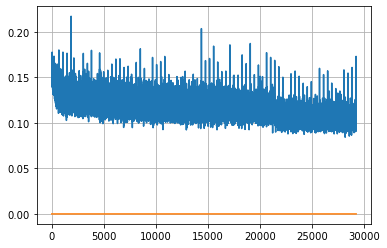

Epoch: 76, iteration 0, loss 0.09186390042304993, cov_diff 0.4100533383564187 cov_diff train 0.4107154072581477
Epoch: 76, iteration 1, loss 0.12006887793540955, cov_diff 0.43048689524056877 cov_diff train 0.42952795130202426
Epoch: 76, iteration 2, loss 0.10542067885398865, cov_diff 0.4168729199020167 cov_diff train 0.4167930169624402
Epoch: 76, iteration 3, loss 0.10321801900863647, cov_diff 0.4281525398158255 cov_diff train 0.427613625599479
Epoch: 76, iteration 4, loss 0.10874253511428833, cov_diff 0.4249112010938811 cov_diff train 0.4247545070294658
Epoch: 76, iteration 5, loss 0.10062018036842346, cov_diff 0.4196605634413382 cov_diff train 0.419311194265931
Epoch: 76, iteration 6, loss 0.10594722628593445, cov_diff 0.4281929436898419 cov_diff train 0.4276912615108957
Epoch: 76, iteration 7, loss 0.10008788108825684, cov_diff 0.4217099616236546 cov_diff train 0.42182370903837146
Epoch: 76, iteration 8, loss 0.10682675242424011, cov_diff 0.44258218662085086 cov_diff train 0.4424070

Epoch: 76, iteration 81, loss 0.10484510660171509, cov_diff 0.4067432809874804 cov_diff train 0.4055069974701328
Epoch: 76, iteration 82, loss 0.10558423399925232, cov_diff 0.42713374720312497 cov_diff train 0.4267730480486546
Epoch: 76, iteration 83, loss 0.09559494256973267, cov_diff 0.4267201782462532 cov_diff train 0.4262826015272515
Epoch: 76, iteration 84, loss 0.10642069578170776, cov_diff 0.42211243002018123 cov_diff train 0.42164093452832113
Epoch: 76, iteration 85, loss 0.11554008722305298, cov_diff 0.42239625713908785 cov_diff train 0.4218076581372177
Epoch: 76, iteration 86, loss 0.09883326292037964, cov_diff 0.43050930490179784 cov_diff train 0.4294464148826232
Epoch: 76, iteration 87, loss 0.11322888731956482, cov_diff 0.4323940080024473 cov_diff train 0.43204884800167187
Epoch: 76, iteration 88, loss 0.0929962694644928, cov_diff 0.42284558280162055 cov_diff train 0.4219937141501076
Epoch: 76, iteration 89, loss 0.10216635465621948, cov_diff 0.4198969015875872 cov_diff tr

Epoch: 76, iteration 159, loss 0.10306492447853088, cov_diff 0.42603331083146034 cov_diff train 0.42536629772602014
Epoch: 76, iteration 160, loss 0.09865981340408325, cov_diff 0.43679717334490387 cov_diff train 0.4362189718106302
Epoch: 76, iteration 161, loss 0.10156536102294922, cov_diff 0.4397203625483525 cov_diff train 0.43856249244951917
Epoch: 76, iteration 162, loss 0.10476991534233093, cov_diff 0.42394989797616905 cov_diff train 0.4239492065163026
Epoch: 76, iteration 163, loss 0.10683465003967285, cov_diff 0.42529169954255075 cov_diff train 0.42485186009576903
Epoch: 76, iteration 164, loss 0.1017187237739563, cov_diff 0.43826421935253124 cov_diff train 0.43764978268925286
Epoch: 76, iteration 165, loss 0.10167375206947327, cov_diff 0.42996590757436365 cov_diff train 0.4290591486748515
Epoch: 76, iteration 166, loss 0.09714186191558838, cov_diff 0.4352494347652157 cov_diff train 0.4347741280583574
Epoch: 76, iteration 167, loss 0.10456302762031555, cov_diff 0.4248698428435078

Epoch: 76, iteration 231, loss 0.10647740960121155, cov_diff 0.425145776082576 cov_diff train 0.4245803099657214
Epoch: 76, iteration 232, loss 0.09828537702560425, cov_diff 0.4287668891702848 cov_diff train 0.4274255681652084
Epoch: 76, iteration 233, loss 0.09714722633361816, cov_diff 0.4284310087886676 cov_diff train 0.4273866625206984
Epoch: 76, iteration 234, loss 0.10250213742256165, cov_diff 0.42374159461868754 cov_diff train 0.42248292792316033
Epoch: 76, iteration 235, loss 0.09647101163864136, cov_diff 0.41719361803867955 cov_diff train 0.41689952716843554
Epoch: 76, iteration 236, loss 0.11729574203491211, cov_diff 0.43786406513827875 cov_diff train 0.43639388069956403
Epoch: 76, iteration 237, loss 0.10226243734359741, cov_diff 0.4204343187929183 cov_diff train 0.4195582496080809
Epoch: 76, iteration 238, loss 0.10455664992332458, cov_diff 0.42675217128200327 cov_diff train 0.42588590364294737
Epoch: 76, iteration 239, loss 0.10548844933509827, cov_diff 0.4298541916697799 c

Epoch: 76, iteration 309, loss 0.11036595702171326, cov_diff 0.41494054293736754 cov_diff train 0.41434759451222647
Epoch: 76, iteration 310, loss 0.11086985468864441, cov_diff 0.4217772358936711 cov_diff train 0.42166488687888487
Epoch: 76, iteration 311, loss 0.1204056441783905, cov_diff 0.43197589043254625 cov_diff train 0.4313036576825854
Epoch: 76, iteration 312, loss 0.1147889792919159, cov_diff 0.41883518725081814 cov_diff train 0.41818889406859355
Epoch: 76, iteration 313, loss 0.10088852047920227, cov_diff 0.4408184934576735 cov_diff train 0.4400488891406848
Epoch: 76, iteration 314, loss 0.1049044132232666, cov_diff 0.42832041110461994 cov_diff train 0.4275333468006587
Epoch: 76, iteration 315, loss 0.09660789370536804, cov_diff 0.41853786871135534 cov_diff train 0.41832370159170684
Epoch: 76, iteration 316, loss 0.09907451272010803, cov_diff 0.42311190173323354 cov_diff train 0.4229441975525856
Epoch: 76, iteration 317, loss 0.12008434534072876, cov_diff 0.4287611861175793 c

Epoch: 76, iteration 384, loss 0.10228002071380615, cov_diff 0.43181667399587403 cov_diff train 0.4313942700033409
Epoch: 76, iteration 385, loss 0.11200016736984253, cov_diff 0.4163232102491172 cov_diff train 0.41511377692407336
Epoch: 76, iteration 386, loss 0.09218570590019226, cov_diff 0.42484732986720497 cov_diff train 0.4242411560609675
Epoch: 76, iteration 387, loss 0.10964000225067139, cov_diff 0.41419525917020467 cov_diff train 0.413427484295154
Epoch: 76, iteration 388, loss 0.10150337219238281, cov_diff 0.43378337677074824 cov_diff train 0.4328591399982019
Epoch: 76, iteration 389, loss 0.1069023609161377, cov_diff 0.4104280888317633 cov_diff train 0.41025822927705125
Epoch: 76, iteration 390, loss 0.1593542993068695, cov_diff 0.4553674451991203 cov_diff train 0.4549271598395252


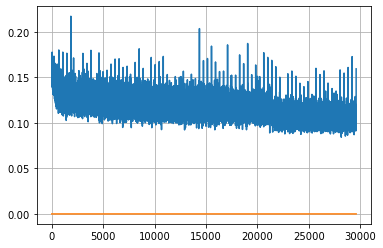

Epoch: 77, iteration 0, loss 0.10415267944335938, cov_diff 0.4178544926819359 cov_diff train 0.4174830777961781
Epoch: 77, iteration 1, loss 0.08713629841804504, cov_diff 0.42296513983655437 cov_diff train 0.4225105450893594
Epoch: 77, iteration 2, loss 0.11504897475242615, cov_diff 0.41439421032464896 cov_diff train 0.41378304203626987
Epoch: 77, iteration 3, loss 0.10055536031723022, cov_diff 0.4240609195939635 cov_diff train 0.4225088504832793
Epoch: 77, iteration 4, loss 0.1200261116027832, cov_diff 0.42241403064623795 cov_diff train 0.42275633388962003
Epoch: 77, iteration 5, loss 0.10634741187095642, cov_diff 0.4302033384189418 cov_diff train 0.43070351825575476
Epoch: 77, iteration 6, loss 0.10212686657905579, cov_diff 0.4216964126753941 cov_diff train 0.4212690605392441
Epoch: 77, iteration 7, loss 0.11387297511100769, cov_diff 0.41588966841836794 cov_diff train 0.41542446865978233
Epoch: 77, iteration 8, loss 0.09973421692848206, cov_diff 0.4110072674107275 cov_diff train 0.41

Epoch: 77, iteration 73, loss 0.11154729127883911, cov_diff 0.41992900019715823 cov_diff train 0.42039623185537134
Epoch: 77, iteration 74, loss 0.10352349281311035, cov_diff 0.41952761024326196 cov_diff train 0.41948579872297614
Epoch: 77, iteration 75, loss 0.09870600700378418, cov_diff 0.42186460674885273 cov_diff train 0.42151587717431815
Epoch: 77, iteration 76, loss 0.11169493198394775, cov_diff 0.4192652702492342 cov_diff train 0.41898398311351903
Epoch: 77, iteration 77, loss 0.09614387154579163, cov_diff 0.42020295663892215 cov_diff train 0.41917411554557327
Epoch: 77, iteration 78, loss 0.11623683571815491, cov_diff 0.4251901161618906 cov_diff train 0.42502104349468145
Epoch: 77, iteration 79, loss 0.1035701334476471, cov_diff 0.42890548284172747 cov_diff train 0.42850003724456726
Epoch: 77, iteration 80, loss 0.10972070693969727, cov_diff 0.42536322172831686 cov_diff train 0.4239543746121692
Epoch: 77, iteration 81, loss 0.09787005186080933, cov_diff 0.42412995887695104 cov_

Epoch: 77, iteration 150, loss 0.11151197552680969, cov_diff 0.40718369401139715 cov_diff train 0.40704380892909314
Epoch: 77, iteration 151, loss 0.09727638959884644, cov_diff 0.41080003427314304 cov_diff train 0.410301227552985
Epoch: 77, iteration 152, loss 0.09734272956848145, cov_diff 0.4160552224570205 cov_diff train 0.4156685042326645
Epoch: 77, iteration 153, loss 0.10016584396362305, cov_diff 0.40598848751719285 cov_diff train 0.4060555562563014
Epoch: 77, iteration 154, loss 0.10632821917533875, cov_diff 0.4245790506468883 cov_diff train 0.42414821993280827
Epoch: 77, iteration 155, loss 0.11423501372337341, cov_diff 0.4226095131856757 cov_diff train 0.42140749985743514
Epoch: 77, iteration 156, loss 0.10497334599494934, cov_diff 0.4217934592782798 cov_diff train 0.42115958583788415
Epoch: 77, iteration 157, loss 0.10271087288856506, cov_diff 0.4170651289109486 cov_diff train 0.41666362157876613
Epoch: 77, iteration 158, loss 0.1009645164012909, cov_diff 0.4246834347193235 co

Epoch: 77, iteration 228, loss 0.09806492924690247, cov_diff 0.4114174266039196 cov_diff train 0.4108930121451347
Epoch: 77, iteration 229, loss 0.10645225644111633, cov_diff 0.4271402964436722 cov_diff train 0.4257645009713541
Epoch: 77, iteration 230, loss 0.10838884115219116, cov_diff 0.42309110109315684 cov_diff train 0.42245998369888255
Epoch: 77, iteration 231, loss 0.10373526811599731, cov_diff 0.42146584810780263 cov_diff train 0.420292058516122
Epoch: 77, iteration 232, loss 0.10681512951850891, cov_diff 0.4348931394849401 cov_diff train 0.43502502771471857
Epoch: 77, iteration 233, loss 0.10238251090049744, cov_diff 0.42774298382986886 cov_diff train 0.4271517639224219
Epoch: 77, iteration 234, loss 0.11236986517906189, cov_diff 0.4244381173103331 cov_diff train 0.4238449684152938
Epoch: 77, iteration 235, loss 0.1082165539264679, cov_diff 0.41147762809294575 cov_diff train 0.4108403060155454
Epoch: 77, iteration 236, loss 0.11050087213516235, cov_diff 0.424604608772272 cov_d

Epoch: 77, iteration 305, loss 0.10390284657478333, cov_diff 0.42440809052992606 cov_diff train 0.4243210402268597
Epoch: 77, iteration 306, loss 0.10024645924568176, cov_diff 0.42710131891276154 cov_diff train 0.4264797082733332
Epoch: 77, iteration 307, loss 0.11092948913574219, cov_diff 0.4031006900170027 cov_diff train 0.40204153283432814
Epoch: 77, iteration 308, loss 0.10370957851409912, cov_diff 0.4364514903914975 cov_diff train 0.4353892369450776
Epoch: 77, iteration 309, loss 0.1004677414894104, cov_diff 0.4229891036887495 cov_diff train 0.42292821289154353
Epoch: 77, iteration 310, loss 0.10381513833999634, cov_diff 0.43103929723319234 cov_diff train 0.4303860615162913
Epoch: 77, iteration 311, loss 0.10920941829681396, cov_diff 0.42691523068276316 cov_diff train 0.42588743892030484
Epoch: 77, iteration 312, loss 0.09956961870193481, cov_diff 0.4340289482877592 cov_diff train 0.43296294081008185
Epoch: 77, iteration 313, loss 0.10584545135498047, cov_diff 0.42448266621937475 

Epoch: 77, iteration 377, loss 0.10367357730865479, cov_diff 0.4256243490712877 cov_diff train 0.4248189955469749
Epoch: 77, iteration 378, loss 0.11157029867172241, cov_diff 0.4372537932653622 cov_diff train 0.4354865142010078
Epoch: 77, iteration 379, loss 0.09779781103134155, cov_diff 0.4192938031793451 cov_diff train 0.41855721785078515
Epoch: 77, iteration 380, loss 0.11310291290283203, cov_diff 0.4250001862571904 cov_diff train 0.42461985640903543
Epoch: 77, iteration 381, loss 0.1048932671546936, cov_diff 0.4280115200059411 cov_diff train 0.4265166502177655
Epoch: 77, iteration 382, loss 0.1018339991569519, cov_diff 0.42118345589293626 cov_diff train 0.4206627640379803
Epoch: 77, iteration 383, loss 0.10287785530090332, cov_diff 0.3987724543521796 cov_diff train 0.3984482916599399
Epoch: 77, iteration 384, loss 0.11061680316925049, cov_diff 0.4226733729139354 cov_diff train 0.4216003542958468
Epoch: 77, iteration 385, loss 0.10061842203140259, cov_diff 0.4222967111307144 cov_dif

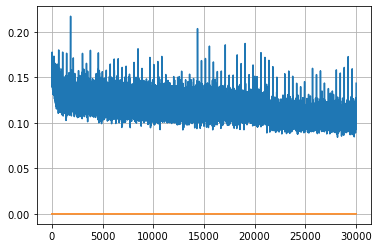

Epoch: 78, iteration 0, loss 0.10570791363716125, cov_diff 0.4314900350864767 cov_diff train 0.43088473576400027
Epoch: 78, iteration 1, loss 0.10666832327842712, cov_diff 0.4244486471674772 cov_diff train 0.4246270474023289
Epoch: 78, iteration 2, loss 0.09631744027137756, cov_diff 0.4300841840978793 cov_diff train 0.4298854760246559
Epoch: 78, iteration 3, loss 0.11764103174209595, cov_diff 0.42407259547993575 cov_diff train 0.4229889016682499
Epoch: 78, iteration 4, loss 0.10768142342567444, cov_diff 0.42846284937531903 cov_diff train 0.4279453875449189
Epoch: 78, iteration 5, loss 0.10562640428543091, cov_diff 0.4188211761798186 cov_diff train 0.4190917310534629
Epoch: 78, iteration 6, loss 0.09802180528640747, cov_diff 0.4247408479699719 cov_diff train 0.4239138402142075
Epoch: 78, iteration 7, loss 0.0945863127708435, cov_diff 0.4224996233529514 cov_diff train 0.42166076961240817
Epoch: 78, iteration 8, loss 0.10047033429145813, cov_diff 0.4225933304614623 cov_diff train 0.421601

Epoch: 78, iteration 82, loss 0.10278746485710144, cov_diff 0.43465729388787105 cov_diff train 0.43470819002252686
Epoch: 78, iteration 83, loss 0.11139649152755737, cov_diff 0.42074480559378813 cov_diff train 0.4195810800905953
Epoch: 78, iteration 84, loss 0.10180434584617615, cov_diff 0.41850298430756533 cov_diff train 0.4178427106110294
Epoch: 78, iteration 85, loss 0.10307592153549194, cov_diff 0.4139958728888549 cov_diff train 0.4133517076714832
Epoch: 78, iteration 86, loss 0.12002402544021606, cov_diff 0.43378076852500985 cov_diff train 0.43276260741951506
Epoch: 78, iteration 87, loss 0.10378649830818176, cov_diff 0.4446869670207846 cov_diff train 0.4437274598966196
Epoch: 78, iteration 88, loss 0.09988433122634888, cov_diff 0.4284081726360941 cov_diff train 0.42787311532931055
Epoch: 78, iteration 89, loss 0.09359902143478394, cov_diff 0.4354672677464303 cov_diff train 0.43555288661641944
Epoch: 78, iteration 90, loss 0.10460367798805237, cov_diff 0.43002149106372367 cov_diff

Epoch: 78, iteration 154, loss 0.1042121946811676, cov_diff 0.4097534705233689 cov_diff train 0.40923357814247624
Epoch: 78, iteration 155, loss 0.10042282938957214, cov_diff 0.42963284620715464 cov_diff train 0.4291634952692186
Epoch: 78, iteration 156, loss 0.11056485772132874, cov_diff 0.4150459494759199 cov_diff train 0.4144011160515076
Epoch: 78, iteration 157, loss 0.11254233121871948, cov_diff 0.4253874701426616 cov_diff train 0.4254877990952008
Epoch: 78, iteration 158, loss 0.11841827630996704, cov_diff 0.39818894211291683 cov_diff train 0.397804343908265
Epoch: 78, iteration 159, loss 0.10536053776741028, cov_diff 0.4188797363766167 cov_diff train 0.4189747491631333
Epoch: 78, iteration 160, loss 0.10608124732971191, cov_diff 0.4150791355656195 cov_diff train 0.4138029357678158
Epoch: 78, iteration 161, loss 0.1051139235496521, cov_diff 0.423808928475651 cov_diff train 0.423579377802747
Epoch: 78, iteration 162, loss 0.11386671662330627, cov_diff 0.4193368516404132 cov_diff t

Epoch: 78, iteration 228, loss 0.10504800081253052, cov_diff 0.42719555159883993 cov_diff train 0.42514912067333516
Epoch: 78, iteration 229, loss 0.10300081968307495, cov_diff 0.41620190531836515 cov_diff train 0.41563294975248355
Epoch: 78, iteration 230, loss 0.09859788417816162, cov_diff 0.42345924057424966 cov_diff train 0.42259902656837645
Epoch: 78, iteration 231, loss 0.11103293299674988, cov_diff 0.42040127484503503 cov_diff train 0.4197841608201622
Epoch: 78, iteration 232, loss 0.09576210379600525, cov_diff 0.43133018087379793 cov_diff train 0.43064351723307115
Epoch: 78, iteration 233, loss 0.10861337184906006, cov_diff 0.42933684136687866 cov_diff train 0.4278296812721737
Epoch: 78, iteration 234, loss 0.10851266980171204, cov_diff 0.42666988165385894 cov_diff train 0.42634174746130726
Epoch: 78, iteration 235, loss 0.09903252124786377, cov_diff 0.41379120284648446 cov_diff train 0.4129779982958057
Epoch: 78, iteration 236, loss 0.10813459753990173, cov_diff 0.427989451643

Epoch: 78, iteration 304, loss 0.11245819926261902, cov_diff 0.42232816224351405 cov_diff train 0.42154952803671764
Epoch: 78, iteration 305, loss 0.09855088591575623, cov_diff 0.41035443995381554 cov_diff train 0.4097668636180251
Epoch: 78, iteration 306, loss 0.1010388731956482, cov_diff 0.42017052756326784 cov_diff train 0.41951666538796656
Epoch: 78, iteration 307, loss 0.09820529818534851, cov_diff 0.42164575257866993 cov_diff train 0.42073178952851525
Epoch: 78, iteration 308, loss 0.1043233871459961, cov_diff 0.4211721572772125 cov_diff train 0.4199206148297846
Epoch: 78, iteration 309, loss 0.10155344009399414, cov_diff 0.4346160870333358 cov_diff train 0.43381265204031627
Epoch: 78, iteration 310, loss 0.11029896140098572, cov_diff 0.4281222471753661 cov_diff train 0.4279425842878925
Epoch: 78, iteration 311, loss 0.11473739147186279, cov_diff 0.4383431211336393 cov_diff train 0.4383223245917484
Epoch: 78, iteration 312, loss 0.10453900694847107, cov_diff 0.41180421737663064 c

Epoch: 78, iteration 382, loss 0.09121391177177429, cov_diff 0.4179511733127785 cov_diff train 0.41705071914535247
Epoch: 78, iteration 383, loss 0.1081918478012085, cov_diff 0.4176017851556835 cov_diff train 0.417057223630109
Epoch: 78, iteration 384, loss 0.10538029670715332, cov_diff 0.4333031211743156 cov_diff train 0.4327601727243866
Epoch: 78, iteration 385, loss 0.11107349395751953, cov_diff 0.4102628797929404 cov_diff train 0.4098302024472297
Epoch: 78, iteration 386, loss 0.10178753733634949, cov_diff 0.4223376640171783 cov_diff train 0.42179327884464923
Epoch: 78, iteration 387, loss 0.1031251847743988, cov_diff 0.41529990847254433 cov_diff train 0.4145995491543729
Epoch: 78, iteration 388, loss 0.11127805709838867, cov_diff 0.40325743725399493 cov_diff train 0.40378264598788616
Epoch: 78, iteration 389, loss 0.10204121470451355, cov_diff 0.41529291568139903 cov_diff train 0.4150755653751004
Epoch: 78, iteration 390, loss 0.15342319011688232, cov_diff 0.4723190921348726 cov_d

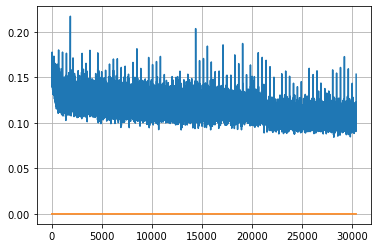

Epoch: 79, iteration 0, loss 0.10706502199172974, cov_diff 0.41289967945780104 cov_diff train 0.4128976337319192
Epoch: 79, iteration 1, loss 0.11111164093017578, cov_diff 0.4263459796022781 cov_diff train 0.42596143505283507
Epoch: 79, iteration 2, loss 0.09656637907028198, cov_diff 0.4174942836160393 cov_diff train 0.4173450277526832
Epoch: 79, iteration 3, loss 0.11834985017776489, cov_diff 0.43986667005024044 cov_diff train 0.4391389407810589
Epoch: 79, iteration 4, loss 0.09715944528579712, cov_diff 0.43614367724354225 cov_diff train 0.43595513146796605
Epoch: 79, iteration 5, loss 0.10209470987319946, cov_diff 0.4175929401722152 cov_diff train 0.41687478390625393
Epoch: 79, iteration 6, loss 0.10877907276153564, cov_diff 0.4385608057321374 cov_diff train 0.4370760048418566
Epoch: 79, iteration 7, loss 0.10135969519615173, cov_diff 0.42668162707455803 cov_diff train 0.42631815815163304
Epoch: 79, iteration 8, loss 0.10731831192970276, cov_diff 0.4264086363082633 cov_diff train 0.4

Epoch: 79, iteration 76, loss 0.1019287109375, cov_diff 0.41908540486288665 cov_diff train 0.4184922239879965
Epoch: 79, iteration 77, loss 0.09844699501991272, cov_diff 0.4328890852755051 cov_diff train 0.432378035744262
Epoch: 79, iteration 78, loss 0.10592097043991089, cov_diff 0.43943397980567134 cov_diff train 0.43950202553081247
Epoch: 79, iteration 79, loss 0.10312864184379578, cov_diff 0.4247469377254401 cov_diff train 0.4235523548846774
Epoch: 79, iteration 80, loss 0.10717004537582397, cov_diff 0.4345131802292597 cov_diff train 0.4342344883680109
Epoch: 79, iteration 81, loss 0.10627937316894531, cov_diff 0.43840346130562186 cov_diff train 0.438229478636675
Epoch: 79, iteration 82, loss 0.10762864351272583, cov_diff 0.4207469197406232 cov_diff train 0.42073280113138517
Epoch: 79, iteration 83, loss 0.10433414578437805, cov_diff 0.4242872728637187 cov_diff train 0.42384191782380415
Epoch: 79, iteration 84, loss 0.10372874140739441, cov_diff 0.43369893674945315 cov_diff train 0

Epoch: 79, iteration 153, loss 0.09551605582237244, cov_diff 0.41987495336010755 cov_diff train 0.41907325309019255
Epoch: 79, iteration 154, loss 0.09792500734329224, cov_diff 0.42664539345846664 cov_diff train 0.4264433415879929
Epoch: 79, iteration 155, loss 0.11183816194534302, cov_diff 0.4300188112668305 cov_diff train 0.4294403175769951
Epoch: 79, iteration 156, loss 0.10502588748931885, cov_diff 0.42378870947341607 cov_diff train 0.423151469552427
Epoch: 79, iteration 157, loss 0.10363340377807617, cov_diff 0.41477570983339823 cov_diff train 0.414732191306121
Epoch: 79, iteration 158, loss 0.10340014100074768, cov_diff 0.4283234496453753 cov_diff train 0.4256909300491044
Epoch: 79, iteration 159, loss 0.1034790575504303, cov_diff 0.4246566261334327 cov_diff train 0.4240101750016431
Epoch: 79, iteration 160, loss 0.09425783157348633, cov_diff 0.4078296883020881 cov_diff train 0.4077987803485053
Epoch: 79, iteration 161, loss 0.1070077121257782, cov_diff 0.4268242932064929 cov_dif

Epoch: 79, iteration 226, loss 0.09478908777236938, cov_diff 0.4261974057622144 cov_diff train 0.4244580828359317
Epoch: 79, iteration 227, loss 0.10150161385536194, cov_diff 0.4259631507779849 cov_diff train 0.42422710076655623
Epoch: 79, iteration 228, loss 0.0995171070098877, cov_diff 0.4102577343601371 cov_diff train 0.40893306241641986
Epoch: 79, iteration 229, loss 0.10139578580856323, cov_diff 0.41348371251571375 cov_diff train 0.4131077370070147
Epoch: 79, iteration 230, loss 0.10709258913993835, cov_diff 0.4269854313933514 cov_diff train 0.4261428053316276
Epoch: 79, iteration 231, loss 0.10281923413276672, cov_diff 0.40981536599459145 cov_diff train 0.4098120884284508
Epoch: 79, iteration 232, loss 0.094970703125, cov_diff 0.436657177805399 cov_diff train 0.4355951854725341
Epoch: 79, iteration 233, loss 0.09672337770462036, cov_diff 0.41327532562801017 cov_diff train 0.4121054925870489
Epoch: 79, iteration 234, loss 0.0986611545085907, cov_diff 0.42272489060079216 cov_diff t

Epoch: 79, iteration 302, loss 0.08858582377433777, cov_diff 0.4204332365145237 cov_diff train 0.42031150831161107
Epoch: 79, iteration 303, loss 0.11227521300315857, cov_diff 0.41538899776621613 cov_diff train 0.41443219662040537
Epoch: 79, iteration 304, loss 0.09748104214668274, cov_diff 0.4160903434188217 cov_diff train 0.4149216263591347
Epoch: 79, iteration 305, loss 0.107563316822052, cov_diff 0.43324588824012916 cov_diff train 0.4322239088743838
Epoch: 79, iteration 306, loss 0.0909227728843689, cov_diff 0.41280034344151995 cov_diff train 0.41197427993593394
Epoch: 79, iteration 307, loss 0.10076218843460083, cov_diff 0.4229240619570568 cov_diff train 0.42199848937539786
Epoch: 79, iteration 308, loss 0.09681946039199829, cov_diff 0.41345460366349135 cov_diff train 0.4133666373775353
Epoch: 79, iteration 309, loss 0.10364621877670288, cov_diff 0.43481683570061375 cov_diff train 0.43330965888988293
Epoch: 79, iteration 310, loss 0.10525661706924438, cov_diff 0.42305110595444834 

Epoch: 79, iteration 379, loss 0.10860347747802734, cov_diff 0.4154095776807342 cov_diff train 0.4151343533180772
Epoch: 79, iteration 380, loss 0.09814566373825073, cov_diff 0.43066698358452815 cov_diff train 0.43068215091984774
Epoch: 79, iteration 381, loss 0.11154067516326904, cov_diff 0.43525662958329214 cov_diff train 0.43392322063773603
Epoch: 79, iteration 382, loss 0.11880749464035034, cov_diff 0.4343152524567369 cov_diff train 0.4346405892003167
Epoch: 79, iteration 383, loss 0.106448233127594, cov_diff 0.42370661378470714 cov_diff train 0.4233169412050992
Epoch: 79, iteration 384, loss 0.12190315127372742, cov_diff 0.4237964488151855 cov_diff train 0.42377581980181717
Epoch: 79, iteration 385, loss 0.1035178005695343, cov_diff 0.42463289000386784 cov_diff train 0.4238139828061532
Epoch: 79, iteration 386, loss 0.10099965333938599, cov_diff 0.40633682319749076 cov_diff train 0.40673525021388707
Epoch: 79, iteration 387, loss 0.1020454466342926, cov_diff 0.426423106277268 cov_

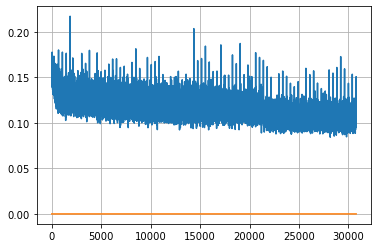

Epoch: 80, iteration 0, loss 0.11364829540252686, cov_diff 0.43032791656087327 cov_diff train 0.4293247910365798
Epoch: 80, iteration 1, loss 0.1048046350479126, cov_diff 0.4292674606803503 cov_diff train 0.42889324584251176
Epoch: 80, iteration 2, loss 0.09865894913673401, cov_diff 0.4270443236862385 cov_diff train 0.4263830780414013
Epoch: 80, iteration 3, loss 0.09861740469932556, cov_diff 0.43784221632903114 cov_diff train 0.43705168578550013
Epoch: 80, iteration 4, loss 0.09820473194122314, cov_diff 0.42711820713580323 cov_diff train 0.4257279698932122
Epoch: 80, iteration 5, loss 0.10827454924583435, cov_diff 0.4267337899009562 cov_diff train 0.42558288160709307
Epoch: 80, iteration 6, loss 0.09346991777420044, cov_diff 0.4192432482169269 cov_diff train 0.4179771467046047
Epoch: 80, iteration 7, loss 0.11419400572776794, cov_diff 0.43393507868798253 cov_diff train 0.4335446299309247
Epoch: 80, iteration 8, loss 0.11675041913986206, cov_diff 0.43331685080853766 cov_diff train 0.43

Epoch: 80, iteration 77, loss 0.10042473673820496, cov_diff 0.4315517914806391 cov_diff train 0.4299467366361987
Epoch: 80, iteration 78, loss 0.10649856925010681, cov_diff 0.43533728142148675 cov_diff train 0.4347838755166557
Epoch: 80, iteration 79, loss 0.1004381775856018, cov_diff 0.4343225225716727 cov_diff train 0.43224270135645
Epoch: 80, iteration 80, loss 0.10005834698677063, cov_diff 0.41547485348167945 cov_diff train 0.4146434544785792
Epoch: 80, iteration 81, loss 0.09030741453170776, cov_diff 0.4233543243336139 cov_diff train 0.42194168145620686
Epoch: 80, iteration 82, loss 0.10489320755004883, cov_diff 0.42578715814792617 cov_diff train 0.42474174915983737
Epoch: 80, iteration 83, loss 0.10584557056427002, cov_diff 0.42507131217249966 cov_diff train 0.4247161663937161
Epoch: 80, iteration 84, loss 0.11047127842903137, cov_diff 0.4138666092603848 cov_diff train 0.4126103368761136
Epoch: 80, iteration 85, loss 0.11902979016304016, cov_diff 0.42951054567445285 cov_diff trai

Epoch: 80, iteration 154, loss 0.09521925449371338, cov_diff 0.4176607627173565 cov_diff train 0.41729237236011557
Epoch: 80, iteration 155, loss 0.09783279895782471, cov_diff 0.42438716053582376 cov_diff train 0.42336461405572234
Epoch: 80, iteration 156, loss 0.10471892356872559, cov_diff 0.41468269308509403 cov_diff train 0.41499856955684816
Epoch: 80, iteration 157, loss 0.10798129439353943, cov_diff 0.41839480837077947 cov_diff train 0.4187297447271269
Epoch: 80, iteration 158, loss 0.10744553804397583, cov_diff 0.4286116348601858 cov_diff train 0.42718069618882903
Epoch: 80, iteration 159, loss 0.10618740320205688, cov_diff 0.43066544481241403 cov_diff train 0.42979543429072276
Epoch: 80, iteration 160, loss 0.10060232877731323, cov_diff 0.4186082373047517 cov_diff train 0.4185349339045476
Epoch: 80, iteration 161, loss 0.10829207301139832, cov_diff 0.4233445029058267 cov_diff train 0.42284130041757323
Epoch: 80, iteration 162, loss 0.1049269437789917, cov_diff 0.4251990292082415

Epoch: 80, iteration 232, loss 0.10877710580825806, cov_diff 0.41675488255208554 cov_diff train 0.4160472611740572
Epoch: 80, iteration 233, loss 0.10307034850120544, cov_diff 0.4078095984749243 cov_diff train 0.40754045222749563
Epoch: 80, iteration 234, loss 0.09979912638664246, cov_diff 0.41651371976068774 cov_diff train 0.4170196883706922
Epoch: 80, iteration 235, loss 0.10749569535255432, cov_diff 0.41536755791767466 cov_diff train 0.4159831919037419
Epoch: 80, iteration 236, loss 0.0962110161781311, cov_diff 0.4126110509199585 cov_diff train 0.41275130684368055
Epoch: 80, iteration 237, loss 0.09270572662353516, cov_diff 0.41826603659465084 cov_diff train 0.41818371200207466
Epoch: 80, iteration 238, loss 0.10517597198486328, cov_diff 0.4305011676860274 cov_diff train 0.43044290180102734
Epoch: 80, iteration 239, loss 0.09726420044898987, cov_diff 0.4286225255427666 cov_diff train 0.4287821143491149
Epoch: 80, iteration 240, loss 0.09632974863052368, cov_diff 0.42412932839367296 

Epoch: 80, iteration 307, loss 0.10446098446846008, cov_diff 0.41811942868485125 cov_diff train 0.4170739413146337
Epoch: 80, iteration 308, loss 0.09934026002883911, cov_diff 0.41381192622070967 cov_diff train 0.41324484243225024
Epoch: 80, iteration 309, loss 0.11106139421463013, cov_diff 0.43226333080212614 cov_diff train 0.43210188371783553
Epoch: 80, iteration 310, loss 0.11827924847602844, cov_diff 0.44000868915688923 cov_diff train 0.43948697859959673
Epoch: 80, iteration 311, loss 0.10857394337654114, cov_diff 0.418216601651562 cov_diff train 0.41788122362157876
Epoch: 80, iteration 312, loss 0.11244285106658936, cov_diff 0.4186136161348385 cov_diff train 0.41851574459439017
Epoch: 80, iteration 313, loss 0.09811779856681824, cov_diff 0.42554230376718327 cov_diff train 0.4252374598227172
Epoch: 80, iteration 314, loss 0.11771398782730103, cov_diff 0.4311343652579662 cov_diff train 0.4304759246653434
Epoch: 80, iteration 315, loss 0.1003422737121582, cov_diff 0.41179755879591784

Epoch: 80, iteration 382, loss 0.1146124005317688, cov_diff 0.410339285525763 cov_diff train 0.4087889344630278
Epoch: 80, iteration 383, loss 0.11315572261810303, cov_diff 0.4259023015313995 cov_diff train 0.425422034841817
Epoch: 80, iteration 384, loss 0.10362091660499573, cov_diff 0.42034367817593304 cov_diff train 0.4193024674936991
Epoch: 80, iteration 385, loss 0.09232091903686523, cov_diff 0.42050119266598346 cov_diff train 0.41981653455303997
Epoch: 80, iteration 386, loss 0.10747560858726501, cov_diff 0.4212692655252749 cov_diff train 0.42089062339504774
Epoch: 80, iteration 387, loss 0.10748207569122314, cov_diff 0.44170797124657984 cov_diff train 0.44031141464397794
Epoch: 80, iteration 388, loss 0.10964232683181763, cov_diff 0.4186453187516853 cov_diff train 0.4182904752672598
Epoch: 80, iteration 389, loss 0.09523633122444153, cov_diff 0.4305514208374191 cov_diff train 0.43013719049749805
Epoch: 80, iteration 390, loss 0.12787491083145142, cov_diff 0.4457493601410367 cov_

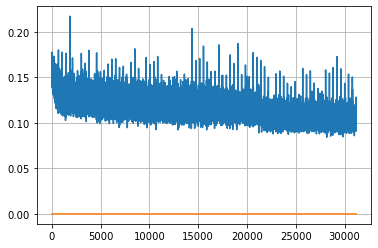

Epoch: 81, iteration 0, loss 0.09440100193023682, cov_diff 0.4189410366493996 cov_diff train 0.4191018381726426
Epoch: 81, iteration 1, loss 0.09342187643051147, cov_diff 0.42129788032304255 cov_diff train 0.4204726316126436
Epoch: 81, iteration 2, loss 0.10790663957595825, cov_diff 0.44339646154377843 cov_diff train 0.4427858635084024
Epoch: 81, iteration 3, loss 0.1149122416973114, cov_diff 0.4244743644788654 cov_diff train 0.4240106022095218
Epoch: 81, iteration 4, loss 0.09614983201026917, cov_diff 0.42828223405448423 cov_diff train 0.4273353840147346
Epoch: 81, iteration 5, loss 0.09654098749160767, cov_diff 0.43139688631460305 cov_diff train 0.43068431236186916
Epoch: 81, iteration 6, loss 0.09966865181922913, cov_diff 0.4208369658025853 cov_diff train 0.4199980501763617
Epoch: 81, iteration 7, loss 0.10956037044525146, cov_diff 0.4200000656472411 cov_diff train 0.41943397545192695
Epoch: 81, iteration 8, loss 0.10780537128448486, cov_diff 0.428487435415329 cov_diff train 0.42728

Epoch: 81, iteration 77, loss 0.10232675075531006, cov_diff 0.41931940829866987 cov_diff train 0.4190344647677644
Epoch: 81, iteration 78, loss 0.10679006576538086, cov_diff 0.418862207452074 cov_diff train 0.4184145209828358
Epoch: 81, iteration 79, loss 0.09479385614395142, cov_diff 0.42857576946119774 cov_diff train 0.42825742292357266
Epoch: 81, iteration 80, loss 0.09457898139953613, cov_diff 0.4186173688877768 cov_diff train 0.41828950842863205
Epoch: 81, iteration 81, loss 0.11528900265693665, cov_diff 0.4310465523632021 cov_diff train 0.430723328662913
Epoch: 81, iteration 82, loss 0.10796365141868591, cov_diff 0.42093533804800776 cov_diff train 0.4200189533355128
Epoch: 81, iteration 83, loss 0.1065627932548523, cov_diff 0.439863557519371 cov_diff train 0.43842279130271017
Epoch: 81, iteration 84, loss 0.11369776725769043, cov_diff 0.43349943982132666 cov_diff train 0.43275217660544385
Epoch: 81, iteration 85, loss 0.10182410478591919, cov_diff 0.42536712794863757 cov_diff tra

Epoch: 81, iteration 149, loss 0.1075572669506073, cov_diff 0.4271390219739568 cov_diff train 0.4266708455385493
Epoch: 81, iteration 150, loss 0.10206905007362366, cov_diff 0.41770406021289586 cov_diff train 0.41712079485879006
Epoch: 81, iteration 151, loss 0.10645231604576111, cov_diff 0.4151444142190896 cov_diff train 0.4144205280856375
Epoch: 81, iteration 152, loss 0.10171371698379517, cov_diff 0.41185894223202185 cov_diff train 0.41112556386336074
Epoch: 81, iteration 153, loss 0.11451545357704163, cov_diff 0.42443176782842823 cov_diff train 0.4235020387798819
Epoch: 81, iteration 154, loss 0.10055273771286011, cov_diff 0.42816509612486414 cov_diff train 0.4272043289965691
Epoch: 81, iteration 155, loss 0.11856269836425781, cov_diff 0.4247029756059377 cov_diff train 0.42335021798838807
Epoch: 81, iteration 156, loss 0.11029684543609619, cov_diff 0.4367801126388465 cov_diff train 0.43556111500831457
Epoch: 81, iteration 157, loss 0.10782164335250854, cov_diff 0.42069311616296373 

Epoch: 81, iteration 226, loss 0.11177855730056763, cov_diff 0.4239600058726602 cov_diff train 0.4238729498819666
Epoch: 81, iteration 227, loss 0.09527608752250671, cov_diff 0.4313487247544763 cov_diff train 0.43088036278595276
Epoch: 81, iteration 228, loss 0.09990352392196655, cov_diff 0.4306718082364367 cov_diff train 0.43018900381570724
Epoch: 81, iteration 229, loss 0.09379571676254272, cov_diff 0.43480648914360887 cov_diff train 0.43490703618373244
Epoch: 81, iteration 230, loss 0.10212874412536621, cov_diff 0.424979694834118 cov_diff train 0.42484533331544744
Epoch: 81, iteration 231, loss 0.10184162855148315, cov_diff 0.4317114990063411 cov_diff train 0.431480832738387
Epoch: 81, iteration 232, loss 0.11317810416221619, cov_diff 0.4325625870312662 cov_diff train 0.43151572560430573
Epoch: 81, iteration 233, loss 0.11314564943313599, cov_diff 0.423067285418206 cov_diff train 0.42298965436707897
Epoch: 81, iteration 234, loss 0.11786442995071411, cov_diff 0.4255382587132616 cov_

Epoch: 81, iteration 303, loss 0.09875130653381348, cov_diff 0.43096999640947714 cov_diff train 0.42988137486972927
Epoch: 81, iteration 304, loss 0.10960027575492859, cov_diff 0.40792005391611585 cov_diff train 0.40820910817308703
Epoch: 81, iteration 305, loss 0.11065858602523804, cov_diff 0.42257963650373126 cov_diff train 0.42176061864466524
Epoch: 81, iteration 306, loss 0.11663451790809631, cov_diff 0.416386048693988 cov_diff train 0.41602762524856934
Epoch: 81, iteration 307, loss 0.11132380366325378, cov_diff 0.4243679789629471 cov_diff train 0.42332625368477345
Epoch: 81, iteration 308, loss 0.10677516460418701, cov_diff 0.4097559297705516 cov_diff train 0.4094883965147344
Epoch: 81, iteration 309, loss 0.10496383905410767, cov_diff 0.417891852952278 cov_diff train 0.4181798089541581
Epoch: 81, iteration 310, loss 0.10269594192504883, cov_diff 0.40706582046137846 cov_diff train 0.40687545711437134
Epoch: 81, iteration 311, loss 0.11534541845321655, cov_diff 0.4263542581465846 

Epoch: 81, iteration 380, loss 0.11499688029289246, cov_diff 0.43820171355661525 cov_diff train 0.4376793060232189
Epoch: 81, iteration 381, loss 0.1038312315940857, cov_diff 0.41760953897779646 cov_diff train 0.4169511432349555
Epoch: 81, iteration 382, loss 0.10954368114471436, cov_diff 0.42841751265264816 cov_diff train 0.42710371908957434
Epoch: 81, iteration 383, loss 0.10912230610847473, cov_diff 0.4130602273863076 cov_diff train 0.4117877178408254
Epoch: 81, iteration 384, loss 0.10615640878677368, cov_diff 0.4210596944958077 cov_diff train 0.42007017988867434
Epoch: 81, iteration 385, loss 0.10343793034553528, cov_diff 0.4146043710955342 cov_diff train 0.41392927409355795
Epoch: 81, iteration 386, loss 0.11113083362579346, cov_diff 0.4098708170429881 cov_diff train 0.4092380728263472
Epoch: 81, iteration 387, loss 0.1066502034664154, cov_diff 0.4271558338401519 cov_diff train 0.42661225299818634
Epoch: 81, iteration 388, loss 0.09623530507087708, cov_diff 0.4240875299331439 cov

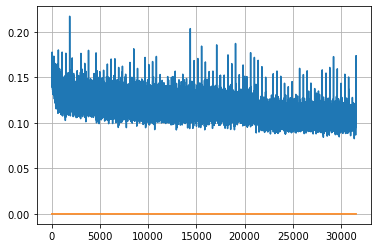

Epoch: 82, iteration 0, loss 0.11860990524291992, cov_diff 0.4353990906070434 cov_diff train 0.43511506927948734
Epoch: 82, iteration 1, loss 0.09375226497650146, cov_diff 0.42954268241261606 cov_diff train 0.42959992057281654
Epoch: 82, iteration 2, loss 0.11222222447395325, cov_diff 0.4218362100926238 cov_diff train 0.42057243284173407
Epoch: 82, iteration 3, loss 0.09704968333244324, cov_diff 0.4124722180487305 cov_diff train 0.41202717991615745
Epoch: 82, iteration 4, loss 0.11089557409286499, cov_diff 0.42192096133391344 cov_diff train 0.42116779464218485
Epoch: 82, iteration 5, loss 0.09935945272445679, cov_diff 0.4170987047989379 cov_diff train 0.4161970037094698
Epoch: 82, iteration 6, loss 0.10769715905189514, cov_diff 0.4267826548802069 cov_diff train 0.426433865785501
Epoch: 82, iteration 7, loss 0.09311342239379883, cov_diff 0.41752789049504907 cov_diff train 0.4169665445212696
Epoch: 82, iteration 8, loss 0.10237455368041992, cov_diff 0.4267064320523405 cov_diff train 0.42

Epoch: 82, iteration 76, loss 0.09757077693939209, cov_diff 0.4184987976325183 cov_diff train 0.4173389800365565
Epoch: 82, iteration 77, loss 0.11851698160171509, cov_diff 0.41245464219248384 cov_diff train 0.41050640649351233
Epoch: 82, iteration 78, loss 0.11405062675476074, cov_diff 0.41251687227807243 cov_diff train 0.4107154705138659
Epoch: 82, iteration 79, loss 0.10002106428146362, cov_diff 0.41199434658807144 cov_diff train 0.41155174786589305
Epoch: 82, iteration 80, loss 0.1032654345035553, cov_diff 0.42104337105386147 cov_diff train 0.42057725771100124
Epoch: 82, iteration 81, loss 0.11156299710273743, cov_diff 0.4329615912603485 cov_diff train 0.43187312264440453
Epoch: 82, iteration 82, loss 0.10146337747573853, cov_diff 0.4322621917986315 cov_diff train 0.4315395371651727
Epoch: 82, iteration 83, loss 0.11444982886314392, cov_diff 0.41704274421415144 cov_diff train 0.4170589147614365
Epoch: 82, iteration 84, loss 0.111716628074646, cov_diff 0.42746661930803387 cov_diff t

Epoch: 82, iteration 153, loss 0.1028045117855072, cov_diff 0.4330903410377725 cov_diff train 0.4316550377592405
Epoch: 82, iteration 154, loss 0.0930543839931488, cov_diff 0.4253695136610053 cov_diff train 0.4247520681926808
Epoch: 82, iteration 155, loss 0.09803381562232971, cov_diff 0.4192036975234568 cov_diff train 0.4189307501922765
Epoch: 82, iteration 156, loss 0.10494238138198853, cov_diff 0.41802749480797596 cov_diff train 0.4162900013222127
Epoch: 82, iteration 157, loss 0.1014498770236969, cov_diff 0.4373840939320464 cov_diff train 0.4360293126483885
Epoch: 82, iteration 158, loss 0.11645755171775818, cov_diff 0.4208270980094468 cov_diff train 0.41987742174114556
Epoch: 82, iteration 159, loss 0.11190652847290039, cov_diff 0.4372567681290124 cov_diff train 0.43613685075945235
Epoch: 82, iteration 160, loss 0.09701907634735107, cov_diff 0.4298268477319948 cov_diff train 0.42884229180614597
Epoch: 82, iteration 161, loss 0.11541932821273804, cov_diff 0.4277199590647988 cov_dif

Epoch: 82, iteration 232, loss 0.10317152738571167, cov_diff 0.4157037843522379 cov_diff train 0.4156606076239441
Epoch: 82, iteration 233, loss 0.1071029007434845, cov_diff 0.4427064796563353 cov_diff train 0.4411722192809916
Epoch: 82, iteration 234, loss 0.11881718039512634, cov_diff 0.4152676934758972 cov_diff train 0.4150185655073042
Epoch: 82, iteration 235, loss 0.09880468249320984, cov_diff 0.4240437696240356 cov_diff train 0.4240112750724165
Epoch: 82, iteration 236, loss 0.10785076022148132, cov_diff 0.42345300768242866 cov_diff train 0.42315405083035856
Epoch: 82, iteration 237, loss 0.10476332902908325, cov_diff 0.4307892614071688 cov_diff train 0.4295242208808553
Epoch: 82, iteration 238, loss 0.10543394088745117, cov_diff 0.41883186228413594 cov_diff train 0.4182933435649864
Epoch: 82, iteration 239, loss 0.100961834192276, cov_diff 0.4368063214919138 cov_diff train 0.4366508103831402
Epoch: 82, iteration 240, loss 0.11115926504135132, cov_diff 0.4233472572455495 cov_diff

Epoch: 82, iteration 309, loss 0.10056602954864502, cov_diff 0.4385623332074445 cov_diff train 0.4379194693025112
Epoch: 82, iteration 310, loss 0.11307859420776367, cov_diff 0.4267058123560899 cov_diff train 0.4255823283525538
Epoch: 82, iteration 311, loss 0.10470178723335266, cov_diff 0.4198884238201998 cov_diff train 0.41939917703248225
Epoch: 82, iteration 312, loss 0.11016771197319031, cov_diff 0.426319184637353 cov_diff train 0.4261734037573423
Epoch: 82, iteration 313, loss 0.10501855611801147, cov_diff 0.41055089150508434 cov_diff train 0.4102013428904029
Epoch: 82, iteration 314, loss 0.10291129350662231, cov_diff 0.42112457789727237 cov_diff train 0.4211098254393336
Epoch: 82, iteration 315, loss 0.11104446649551392, cov_diff 0.4254556071142648 cov_diff train 0.42450191323641556
Epoch: 82, iteration 316, loss 0.10698166489601135, cov_diff 0.4128247400446763 cov_diff train 0.4119189519895064
Epoch: 82, iteration 317, loss 0.10315141081809998, cov_diff 0.41584173689483206 cov_

Epoch: 82, iteration 390, loss 0.1553177833557129, cov_diff 0.4616915437034894 cov_diff train 0.4614678903924645


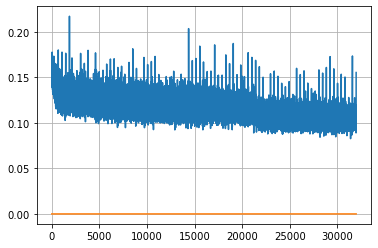

Epoch: 83, iteration 0, loss 0.09752815961837769, cov_diff 0.42857091386759855 cov_diff train 0.42865939270422115
Epoch: 83, iteration 1, loss 0.10658538341522217, cov_diff 0.41546462891237 cov_diff train 0.4144909209202291
Epoch: 83, iteration 2, loss 0.11619380116462708, cov_diff 0.4199495934390836 cov_diff train 0.41954982793300394
Epoch: 83, iteration 3, loss 0.11062955856323242, cov_diff 0.431158533940194 cov_diff train 0.4312748259582154
Epoch: 83, iteration 4, loss 0.0921705961227417, cov_diff 0.42353905912255774 cov_diff train 0.4232542788566255
Epoch: 83, iteration 5, loss 0.11327525973320007, cov_diff 0.4274447825514698 cov_diff train 0.4263725549360421
Epoch: 83, iteration 6, loss 0.12198138236999512, cov_diff 0.42273594555977884 cov_diff train 0.4225203628311577
Epoch: 83, iteration 7, loss 0.11150643229484558, cov_diff 0.4307063964416736 cov_diff train 0.430268572526143
Epoch: 83, iteration 8, loss 0.1099032461643219, cov_diff 0.42811220752514556 cov_diff train 0.427101953

Epoch: 83, iteration 73, loss 0.09749522805213928, cov_diff 0.4213686462747728 cov_diff train 0.4206027860919536
Epoch: 83, iteration 74, loss 0.11083880066871643, cov_diff 0.41939942237959177 cov_diff train 0.4183177022246644
Epoch: 83, iteration 75, loss 0.10302799940109253, cov_diff 0.4226869216582919 cov_diff train 0.42107987175123235
Epoch: 83, iteration 76, loss 0.09776335954666138, cov_diff 0.4238110951098572 cov_diff train 0.42363275233369596
Epoch: 83, iteration 77, loss 0.11776557564735413, cov_diff 0.43628032458961635 cov_diff train 0.43551134550230053
Epoch: 83, iteration 78, loss 0.09948962926864624, cov_diff 0.4207804389891368 cov_diff train 0.42000368315288805
Epoch: 83, iteration 79, loss 0.0993613600730896, cov_diff 0.41981094921687756 cov_diff train 0.4183194357281312
Epoch: 83, iteration 80, loss 0.09328222274780273, cov_diff 0.41562943521998647 cov_diff train 0.41471757946966176
Epoch: 83, iteration 81, loss 0.0985422134399414, cov_diff 0.4303259626711945 cov_diff t

Epoch: 83, iteration 147, loss 0.09399005770683289, cov_diff 0.404255973428955 cov_diff train 0.4042983825831542
Epoch: 83, iteration 148, loss 0.11266997456550598, cov_diff 0.4222949927783665 cov_diff train 0.42116598471426564
Epoch: 83, iteration 149, loss 0.10060477256774902, cov_diff 0.4205335277794874 cov_diff train 0.4201084851656489
Epoch: 83, iteration 150, loss 0.1010265052318573, cov_diff 0.4178223648264053 cov_diff train 0.4178570314435755
Epoch: 83, iteration 151, loss 0.09825780987739563, cov_diff 0.4047926566134708 cov_diff train 0.4038822169055541
Epoch: 83, iteration 152, loss 0.1084897518157959, cov_diff 0.42160222229148125 cov_diff train 0.4213793568585016
Epoch: 83, iteration 153, loss 0.1065061092376709, cov_diff 0.421289983533015 cov_diff train 0.4212761973419835
Epoch: 83, iteration 154, loss 0.10394585132598877, cov_diff 0.4216984597861251 cov_diff train 0.4213280895999445
Epoch: 83, iteration 155, loss 0.10660076141357422, cov_diff 0.4193930075376868 cov_diff tr

Epoch: 83, iteration 223, loss 0.12208327651023865, cov_diff 0.431455189599317 cov_diff train 0.43092447605966816
Epoch: 83, iteration 224, loss 0.10261735320091248, cov_diff 0.42306126775784875 cov_diff train 0.4214690470698197
Epoch: 83, iteration 225, loss 0.0968998372554779, cov_diff 0.4111649652472721 cov_diff train 0.41035232546686823
Epoch: 83, iteration 226, loss 0.10568997263908386, cov_diff 0.4351582693944801 cov_diff train 0.4340486572441027
Epoch: 83, iteration 227, loss 0.09208616614341736, cov_diff 0.41111675219706456 cov_diff train 0.4100848182381693
Epoch: 83, iteration 228, loss 0.10296273231506348, cov_diff 0.4153505368995275 cov_diff train 0.41489161332867264
Epoch: 83, iteration 229, loss 0.11775621771812439, cov_diff 0.43069517823475273 cov_diff train 0.4302677728296945
Epoch: 83, iteration 230, loss 0.10419973731040955, cov_diff 0.42798297478283004 cov_diff train 0.4261217747639358
Epoch: 83, iteration 231, loss 0.10268491506576538, cov_diff 0.4296238984993815 cov

Epoch: 83, iteration 297, loss 0.09121641516685486, cov_diff 0.41995207478902097 cov_diff train 0.41897540431838154
Epoch: 83, iteration 298, loss 0.10624834895133972, cov_diff 0.435211649648256 cov_diff train 0.433727499941181
Epoch: 83, iteration 299, loss 0.10694503784179688, cov_diff 0.4403422441633489 cov_diff train 0.4396497761728963
Epoch: 83, iteration 300, loss 0.09212443232536316, cov_diff 0.41907692141494635 cov_diff train 0.4189543711779918
Epoch: 83, iteration 301, loss 0.1178085207939148, cov_diff 0.4330517523869151 cov_diff train 0.43302083250838425
Epoch: 83, iteration 302, loss 0.11362475156784058, cov_diff 0.4319355047099108 cov_diff train 0.43109104071621324
Epoch: 83, iteration 303, loss 0.10230281949043274, cov_diff 0.42218368758050373 cov_diff train 0.4217898593766101
Epoch: 83, iteration 304, loss 0.12840759754180908, cov_diff 0.4051529583163897 cov_diff train 0.4040950321644021
Epoch: 83, iteration 305, loss 0.10364550352096558, cov_diff 0.42238663678275895 cov_

Epoch: 83, iteration 374, loss 0.10255521535873413, cov_diff 0.42150012180894825 cov_diff train 0.42146257782488833
Epoch: 83, iteration 375, loss 0.09770411252975464, cov_diff 0.42620662675160775 cov_diff train 0.42607294584770794
Epoch: 83, iteration 376, loss 0.11344155669212341, cov_diff 0.42863474512465083 cov_diff train 0.42716156833139074
Epoch: 83, iteration 377, loss 0.10427328944206238, cov_diff 0.43087464206166026 cov_diff train 0.430318173222575
Epoch: 83, iteration 378, loss 0.1197161078453064, cov_diff 0.424146799429039 cov_diff train 0.42386974380435466
Epoch: 83, iteration 379, loss 0.10717752575874329, cov_diff 0.4176017255727973 cov_diff train 0.41702217470697656
Epoch: 83, iteration 380, loss 0.11034032702445984, cov_diff 0.42919208992904645 cov_diff train 0.4284129039542174
Epoch: 83, iteration 381, loss 0.10270798206329346, cov_diff 0.4198602990804893 cov_diff train 0.41926046755992985
Epoch: 83, iteration 382, loss 0.11240255832672119, cov_diff 0.4222705317214149 

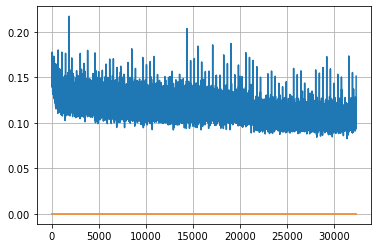

Epoch: 84, iteration 0, loss 0.09770643711090088, cov_diff 0.4175496090682297 cov_diff train 0.41703894632392946
Epoch: 84, iteration 1, loss 0.09973987936973572, cov_diff 0.42759639217534257 cov_diff train 0.4266597284875578
Epoch: 84, iteration 2, loss 0.1006486713886261, cov_diff 0.418326569242985 cov_diff train 0.41792036481860523
Epoch: 84, iteration 3, loss 0.10941284894943237, cov_diff 0.412415988034685 cov_diff train 0.41184473691005224
Epoch: 84, iteration 4, loss 0.10832056403160095, cov_diff 0.42163833050440286 cov_diff train 0.42108268641227037
Epoch: 84, iteration 5, loss 0.09970426559448242, cov_diff 0.43577314764410857 cov_diff train 0.4352751807353785
Epoch: 84, iteration 6, loss 0.09988090395927429, cov_diff 0.42305189938558624 cov_diff train 0.42184044250315167
Epoch: 84, iteration 7, loss 0.10183429718017578, cov_diff 0.43253304997265146 cov_diff train 0.4323380959049827
Epoch: 84, iteration 8, loss 0.11499142646789551, cov_diff 0.4081434851210496 cov_diff train 0.40

Epoch: 84, iteration 77, loss 0.09784191846847534, cov_diff 0.4309830478898631 cov_diff train 0.4300285513501972
Epoch: 84, iteration 78, loss 0.10455149412155151, cov_diff 0.42771221349715377 cov_diff train 0.4260091507850764
Epoch: 84, iteration 79, loss 0.09912234544754028, cov_diff 0.43009938832052325 cov_diff train 0.4293548830290205
Epoch: 84, iteration 80, loss 0.09698665142059326, cov_diff 0.42000283513098685 cov_diff train 0.4186410218784513
Epoch: 84, iteration 81, loss 0.09954550862312317, cov_diff 0.4296589795016779 cov_diff train 0.42793910091584353
Epoch: 84, iteration 82, loss 0.1029272973537445, cov_diff 0.40220449486228366 cov_diff train 0.40099759076155234
Epoch: 84, iteration 83, loss 0.1028948724269867, cov_diff 0.41525087686894396 cov_diff train 0.41450060174889003
Epoch: 84, iteration 84, loss 0.09894591569900513, cov_diff 0.4054197501867849 cov_diff train 0.4047567423344371
Epoch: 84, iteration 85, loss 0.10885289311408997, cov_diff 0.4004138592862783 cov_diff tr

Epoch: 84, iteration 150, loss 0.11271440982818604, cov_diff 0.43452122931463216 cov_diff train 0.43504019017437184
Epoch: 84, iteration 151, loss 0.10703760385513306, cov_diff 0.4223935102044885 cov_diff train 0.42232251120258973
Epoch: 84, iteration 152, loss 0.1039259135723114, cov_diff 0.42097226706553054 cov_diff train 0.41984593980062185
Epoch: 84, iteration 153, loss 0.10734033584594727, cov_diff 0.418202116472925 cov_diff train 0.4165665996662611
Epoch: 84, iteration 154, loss 0.10744330286979675, cov_diff 0.42640169912878795 cov_diff train 0.4256019508961825
Epoch: 84, iteration 155, loss 0.09607088565826416, cov_diff 0.41818915266009304 cov_diff train 0.4183577006417989
Epoch: 84, iteration 156, loss 0.10223022103309631, cov_diff 0.413826951351018 cov_diff train 0.41343481672845855
Epoch: 84, iteration 157, loss 0.10115596652030945, cov_diff 0.420471755557557 cov_diff train 0.4200133592483851
Epoch: 84, iteration 158, loss 0.1092614233493805, cov_diff 0.43143026000864615 cov_

Epoch: 84, iteration 226, loss 0.10822010040283203, cov_diff 0.421008118976288 cov_diff train 0.4209494207807485
Epoch: 84, iteration 227, loss 0.10717612504959106, cov_diff 0.43330730783151933 cov_diff train 0.4329261373010827
Epoch: 84, iteration 228, loss 0.10618248581886292, cov_diff 0.4136830646879162 cov_diff train 0.4132424519533142
Epoch: 84, iteration 229, loss 0.10414224863052368, cov_diff 0.4365028120926767 cov_diff train 0.4350912389656398
Epoch: 84, iteration 230, loss 0.11203020811080933, cov_diff 0.4213814690329183 cov_diff train 0.42056917217055906
Epoch: 84, iteration 231, loss 0.1123056411743164, cov_diff 0.4410922195504711 cov_diff train 0.44032064865280957
Epoch: 84, iteration 232, loss 0.09746140241622925, cov_diff 0.41916932256320866 cov_diff train 0.418592968017538
Epoch: 84, iteration 233, loss 0.10269036889076233, cov_diff 0.42307861755339826 cov_diff train 0.42204114384497105
Epoch: 84, iteration 234, loss 0.11591732501983643, cov_diff 0.4239027793767636 cov_d

Epoch: 84, iteration 299, loss 0.10427850484848022, cov_diff 0.4253899282660734 cov_diff train 0.42400302574704185
Epoch: 84, iteration 300, loss 0.10478922724723816, cov_diff 0.40958875976934234 cov_diff train 0.40964453070721407
Epoch: 84, iteration 301, loss 0.11773324012756348, cov_diff 0.4229838516573955 cov_diff train 0.42267639246990973
Epoch: 84, iteration 302, loss 0.10248249769210815, cov_diff 0.4198261276799192 cov_diff train 0.4189526290260544
Epoch: 84, iteration 303, loss 0.10631796717643738, cov_diff 0.417412026111371 cov_diff train 0.4163689558998214
Epoch: 84, iteration 304, loss 0.10913044214248657, cov_diff 0.4240757329758348 cov_diff train 0.42407474660245664
Epoch: 84, iteration 305, loss 0.10459038615226746, cov_diff 0.4419018838681103 cov_diff train 0.44173256704223285
Epoch: 84, iteration 306, loss 0.11539950966835022, cov_diff 0.4163265077240347 cov_diff train 0.415925891332414
Epoch: 84, iteration 307, loss 0.09864863753318787, cov_diff 0.426798514585342 cov_d

Epoch: 84, iteration 375, loss 0.11416178941726685, cov_diff 0.42934546834506715 cov_diff train 0.42863318311795756
Epoch: 84, iteration 376, loss 0.10104519128799438, cov_diff 0.4259404248367352 cov_diff train 0.42542724608333804
Epoch: 84, iteration 377, loss 0.10209235548973083, cov_diff 0.42207138927801957 cov_diff train 0.4211185551008461
Epoch: 84, iteration 378, loss 0.10834255814552307, cov_diff 0.42319202660302685 cov_diff train 0.4224795215503678
Epoch: 84, iteration 379, loss 0.10422033071517944, cov_diff 0.4251868780986008 cov_diff train 0.4241157828000787
Epoch: 84, iteration 380, loss 0.1092216968536377, cov_diff 0.4298935402487786 cov_diff train 0.42932131425018494
Epoch: 84, iteration 381, loss 0.10871276259422302, cov_diff 0.42918138936941186 cov_diff train 0.42880757881289694
Epoch: 84, iteration 382, loss 0.10505586862564087, cov_diff 0.4336695882247575 cov_diff train 0.43242171847125455
Epoch: 84, iteration 383, loss 0.10321533679962158, cov_diff 0.4168021866920469 

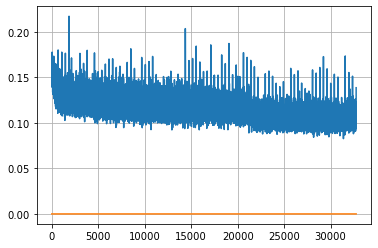

Epoch: 85, iteration 0, loss 0.104981929063797, cov_diff 0.43025379550409254 cov_diff train 0.43023326489186076
Epoch: 85, iteration 1, loss 0.1140921413898468, cov_diff 0.4273130251455428 cov_diff train 0.42652909465673206
Epoch: 85, iteration 2, loss 0.10384407639503479, cov_diff 0.42384558929869326 cov_diff train 0.4234439487578394
Epoch: 85, iteration 3, loss 0.10415396094322205, cov_diff 0.4288046947233187 cov_diff train 0.4275140421694983
Epoch: 85, iteration 4, loss 0.1051623523235321, cov_diff 0.43371021751683136 cov_diff train 0.4334585557280937
Epoch: 85, iteration 5, loss 0.10771447420120239, cov_diff 0.40533226171902953 cov_diff train 0.40552174548782877
Epoch: 85, iteration 6, loss 0.10599705576896667, cov_diff 0.414070551367867 cov_diff train 0.41384111351130987
Epoch: 85, iteration 7, loss 0.11326137185096741, cov_diff 0.42592974039294573 cov_diff train 0.42447365058847547
Epoch: 85, iteration 8, loss 0.12130740284919739, cov_diff 0.4371132947263178 cov_diff train 0.4357

Epoch: 85, iteration 79, loss 0.10942018032073975, cov_diff 0.43979943651894243 cov_diff train 0.43929369790384326
Epoch: 85, iteration 80, loss 0.10181298851966858, cov_diff 0.43489574247519874 cov_diff train 0.43448539958917426
Epoch: 85, iteration 81, loss 0.10092931985855103, cov_diff 0.42063670547657955 cov_diff train 0.4200027557810354
Epoch: 85, iteration 82, loss 0.1112481951713562, cov_diff 0.42252523555062876 cov_diff train 0.4214123255295011
Epoch: 85, iteration 83, loss 0.1003044843673706, cov_diff 0.41253259654214763 cov_diff train 0.4115766457222777
Epoch: 85, iteration 84, loss 0.09623003005981445, cov_diff 0.44531114921817777 cov_diff train 0.44459972728422453
Epoch: 85, iteration 85, loss 0.10263848304748535, cov_diff 0.4290044663006195 cov_diff train 0.427944568165358
Epoch: 85, iteration 86, loss 0.11218109726905823, cov_diff 0.43193586074767404 cov_diff train 0.43092513444210767
Epoch: 85, iteration 87, loss 0.10619208216667175, cov_diff 0.4318095578110369 cov_diff 

Epoch: 85, iteration 157, loss 0.10669952630996704, cov_diff 0.4413495281369239 cov_diff train 0.44113840395564724
Epoch: 85, iteration 158, loss 0.11003732681274414, cov_diff 0.42155287083489035 cov_diff train 0.42123552300079525
Epoch: 85, iteration 159, loss 0.10824331641197205, cov_diff 0.428226741349882 cov_diff train 0.42778863887798024
Epoch: 85, iteration 160, loss 0.10247558355331421, cov_diff 0.4269014865561419 cov_diff train 0.4267498216808614
Epoch: 85, iteration 161, loss 0.09930166602134705, cov_diff 0.42326751864526313 cov_diff train 0.423082140151123
Epoch: 85, iteration 162, loss 0.09713685512542725, cov_diff 0.407969484475511 cov_diff train 0.4080232460059374
Epoch: 85, iteration 163, loss 0.09636569023132324, cov_diff 0.4185533290030291 cov_diff train 0.41780656795861065
Epoch: 85, iteration 164, loss 0.09728839993476868, cov_diff 0.41114659820989397 cov_diff train 0.40977524205988997
Epoch: 85, iteration 165, loss 0.11449208855628967, cov_diff 0.4031954151807847 cov

Epoch: 85, iteration 234, loss 0.11297494173049927, cov_diff 0.4276571324422576 cov_diff train 0.4269519483324259
Epoch: 85, iteration 235, loss 0.11048001050949097, cov_diff 0.42097792075406876 cov_diff train 0.4206442587864194
Epoch: 85, iteration 236, loss 0.11478498578071594, cov_diff 0.42076491266483707 cov_diff train 0.4213845586074828
Epoch: 85, iteration 237, loss 0.10355406999588013, cov_diff 0.42316979295611534 cov_diff train 0.422387784702922
Epoch: 85, iteration 238, loss 0.10753974318504333, cov_diff 0.41747757704610533 cov_diff train 0.4168162791178839
Epoch: 85, iteration 239, loss 0.11129704117774963, cov_diff 0.41812433139334665 cov_diff train 0.4176356984139148
Epoch: 85, iteration 240, loss 0.11282044649124146, cov_diff 0.4317081890935855 cov_diff train 0.43165492787750215
Epoch: 85, iteration 241, loss 0.09872841835021973, cov_diff 0.43330713453919867 cov_diff train 0.43307236465356574
Epoch: 85, iteration 242, loss 0.10365542769432068, cov_diff 0.4160147010100879 c

Epoch: 85, iteration 310, loss 0.09900224208831787, cov_diff 0.42486972755806074 cov_diff train 0.42404503050630754
Epoch: 85, iteration 311, loss 0.10818511247634888, cov_diff 0.4265951539582892 cov_diff train 0.42487927421954136
Epoch: 85, iteration 312, loss 0.10432210564613342, cov_diff 0.4356244728373413 cov_diff train 0.43465064878751475
Epoch: 85, iteration 313, loss 0.09483551979064941, cov_diff 0.4332080394301557 cov_diff train 0.43204013210360837
Epoch: 85, iteration 314, loss 0.10934358835220337, cov_diff 0.4318683043204919 cov_diff train 0.4298793473771189
Epoch: 85, iteration 315, loss 0.11301374435424805, cov_diff 0.41670082841926837 cov_diff train 0.41472175854268933
Epoch: 85, iteration 316, loss 0.10889965295791626, cov_diff 0.4147593098817313 cov_diff train 0.4149688400828876
Epoch: 85, iteration 317, loss 0.11315456032752991, cov_diff 0.4182738038063255 cov_diff train 0.4177724900914096
Epoch: 85, iteration 318, loss 0.1124112606048584, cov_diff 0.4179748352654665 co

Epoch: 85, iteration 387, loss 0.10425055027008057, cov_diff 0.4161553298739205 cov_diff train 0.41559303402050835
Epoch: 85, iteration 388, loss 0.09367355704307556, cov_diff 0.3984700784346386 cov_diff train 0.39779873596269083
Epoch: 85, iteration 389, loss 0.11323282122612, cov_diff 0.42615700281411995 cov_diff train 0.4255313414461509
Epoch: 85, iteration 390, loss 0.14758506417274475, cov_diff 0.4782528175027882 cov_diff train 0.47778894596972277


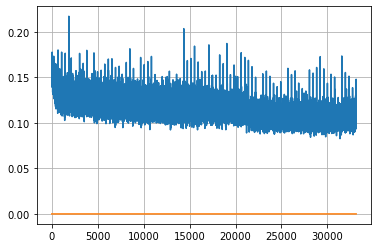

Epoch: 86, iteration 0, loss 0.1110081672668457, cov_diff 0.4262304463333734 cov_diff train 0.4256750049097595
Epoch: 86, iteration 1, loss 0.09085693955421448, cov_diff 0.42958584328310206 cov_diff train 0.42945766066080293
Epoch: 86, iteration 2, loss 0.09841647744178772, cov_diff 0.42232390960275956 cov_diff train 0.4220604614404858
Epoch: 86, iteration 3, loss 0.1065039336681366, cov_diff 0.41996347285106655 cov_diff train 0.41946655945370004
Epoch: 86, iteration 4, loss 0.10881778597831726, cov_diff 0.4264537957432798 cov_diff train 0.4255951102024587
Epoch: 86, iteration 5, loss 0.1045953631401062, cov_diff 0.408441646921856 cov_diff train 0.40790259756649616
Epoch: 86, iteration 6, loss 0.10511660575866699, cov_diff 0.4151802246485649 cov_diff train 0.41363469905192757
Epoch: 86, iteration 7, loss 0.1133171021938324, cov_diff 0.42723180943583666 cov_diff train 0.4271300053524514
Epoch: 86, iteration 8, loss 0.101723313331604, cov_diff 0.41983561865045443 cov_diff train 0.4195715

Epoch: 86, iteration 77, loss 0.10492587089538574, cov_diff 0.42364202106170584 cov_diff train 0.4228873498369789
Epoch: 86, iteration 78, loss 0.10791721940040588, cov_diff 0.4253727802959156 cov_diff train 0.42468272320024564
Epoch: 86, iteration 79, loss 0.11201149225234985, cov_diff 0.41422697242719897 cov_diff train 0.41270731562732565
Epoch: 86, iteration 80, loss 0.09989410638809204, cov_diff 0.4362233995461572 cov_diff train 0.43556906997422845
Epoch: 86, iteration 81, loss 0.1022379994392395, cov_diff 0.4128958478115526 cov_diff train 0.4123670334317361
Epoch: 86, iteration 82, loss 0.10042902827262878, cov_diff 0.41939769836086305 cov_diff train 0.41927660477052253
Epoch: 86, iteration 83, loss 0.0983106791973114, cov_diff 0.41611420511015484 cov_diff train 0.4157659318444401
Epoch: 86, iteration 84, loss 0.09020206332206726, cov_diff 0.41737249867943627 cov_diff train 0.41754159529782875
Epoch: 86, iteration 85, loss 0.10754144191741943, cov_diff 0.42373172845839707 cov_diff

Epoch: 86, iteration 154, loss 0.11234629154205322, cov_diff 0.4152860679300996 cov_diff train 0.41467235797396557
Epoch: 86, iteration 155, loss 0.10963797569274902, cov_diff 0.4251520068382822 cov_diff train 0.4246348132885157
Epoch: 86, iteration 156, loss 0.11049747467041016, cov_diff 0.40948806695515827 cov_diff train 0.4096308488649719
Epoch: 86, iteration 157, loss 0.09604766964912415, cov_diff 0.41916254291860716 cov_diff train 0.41888030286591926
Epoch: 86, iteration 158, loss 0.10664412379264832, cov_diff 0.41417219134830285 cov_diff train 0.4140631197683578
Epoch: 86, iteration 159, loss 0.10495847463607788, cov_diff 0.42033436747831054 cov_diff train 0.4205200911392167
Epoch: 86, iteration 160, loss 0.10228216648101807, cov_diff 0.41811481262889205 cov_diff train 0.4180072590560786
Epoch: 86, iteration 161, loss 0.10247611999511719, cov_diff 0.41102953091883543 cov_diff train 0.40988143415817996
Epoch: 86, iteration 162, loss 0.11196839809417725, cov_diff 0.4214849190917298

Epoch: 86, iteration 231, loss 0.10882493853569031, cov_diff 0.41298707102652205 cov_diff train 0.4109225402040313
Epoch: 86, iteration 232, loss 0.09420448541641235, cov_diff 0.40736231890133223 cov_diff train 0.40706455796007085
Epoch: 86, iteration 233, loss 0.09400495886802673, cov_diff 0.4136025821368848 cov_diff train 0.4136039940457862
Epoch: 86, iteration 234, loss 0.10581445693969727, cov_diff 0.4137588751649325 cov_diff train 0.4131441283756262
Epoch: 86, iteration 235, loss 0.09599557518959045, cov_diff 0.4184695651093222 cov_diff train 0.4180481807524082
Epoch: 86, iteration 236, loss 0.10141226649284363, cov_diff 0.4200278120260985 cov_diff train 0.4204282921748201
Epoch: 86, iteration 237, loss 0.10112753510475159, cov_diff 0.41921274675426307 cov_diff train 0.417513428776874
Epoch: 86, iteration 238, loss 0.11051017045974731, cov_diff 0.4336326542583219 cov_diff train 0.4333505234484695
Epoch: 86, iteration 239, loss 0.1135275661945343, cov_diff 0.4249404072372236 cov_di

Epoch: 86, iteration 308, loss 0.10538783669471741, cov_diff 0.420645639403207 cov_diff train 0.42012082947447865
Epoch: 86, iteration 309, loss 0.10229083895683289, cov_diff 0.4349961500396018 cov_diff train 0.43433498640135854
Epoch: 86, iteration 310, loss 0.10499823093414307, cov_diff 0.42978524082638886 cov_diff train 0.4288862611066385
Epoch: 86, iteration 311, loss 0.10269343852996826, cov_diff 0.4201943799898851 cov_diff train 0.42014440813008713
Epoch: 86, iteration 312, loss 0.09913775324821472, cov_diff 0.4350809024316207 cov_diff train 0.4341959821472133
Epoch: 86, iteration 313, loss 0.09796345233917236, cov_diff 0.4191727372642342 cov_diff train 0.41865519927065853
Epoch: 86, iteration 314, loss 0.09900662302970886, cov_diff 0.4320313986763155 cov_diff train 0.43075898727254563
Epoch: 86, iteration 315, loss 0.10073420405387878, cov_diff 0.4301955396970812 cov_diff train 0.4292650605859586
Epoch: 86, iteration 316, loss 0.09594455361366272, cov_diff 0.41847683389567775 co

Epoch: 86, iteration 385, loss 0.10553723573684692, cov_diff 0.4261555050127454 cov_diff train 0.425387840492067
Epoch: 86, iteration 386, loss 0.1008773148059845, cov_diff 0.4321781378100655 cov_diff train 0.4306475060598473
Epoch: 86, iteration 387, loss 0.10506072640419006, cov_diff 0.4026088392969356 cov_diff train 0.4020288227470626
Epoch: 86, iteration 388, loss 0.09935089945793152, cov_diff 0.4172947647895902 cov_diff train 0.41707643614680623
Epoch: 86, iteration 389, loss 0.11346164345741272, cov_diff 0.4268384335552762 cov_diff train 0.42744593407148374
Epoch: 86, iteration 390, loss 0.15523049235343933, cov_diff 0.45710248281472743 cov_diff train 0.45670354079807884


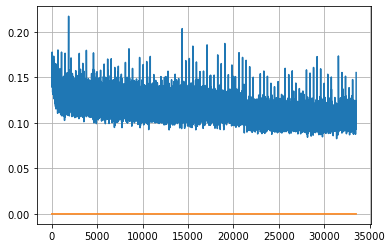

Epoch: 87, iteration 0, loss 0.11486244201660156, cov_diff 0.42327733053450195 cov_diff train 0.42234397003820545
Epoch: 87, iteration 1, loss 0.10031312704086304, cov_diff 0.42600153903014004 cov_diff train 0.42418999032230054
Epoch: 87, iteration 2, loss 0.09909161925315857, cov_diff 0.4225466791078462 cov_diff train 0.42290761025690826
Epoch: 87, iteration 3, loss 0.1030450165271759, cov_diff 0.42808510709852077 cov_diff train 0.4278236472939858
Epoch: 87, iteration 4, loss 0.11330810189247131, cov_diff 0.4294510795827646 cov_diff train 0.42942713280958894
Epoch: 87, iteration 5, loss 0.09725001454353333, cov_diff 0.41021063673489677 cov_diff train 0.40990877589745645
Epoch: 87, iteration 6, loss 0.11859023571014404, cov_diff 0.4189243394880744 cov_diff train 0.4186247310291793
Epoch: 87, iteration 7, loss 0.09643182158470154, cov_diff 0.41535000306836434 cov_diff train 0.4149399233319622
Epoch: 87, iteration 8, loss 0.10339301824569702, cov_diff 0.428168510046129 cov_diff train 0.4

Epoch: 87, iteration 78, loss 0.10246944427490234, cov_diff 0.42247353372337854 cov_diff train 0.4222569938450998
Epoch: 87, iteration 79, loss 0.10079899430274963, cov_diff 0.42560280484788987 cov_diff train 0.4246419312065977
Epoch: 87, iteration 80, loss 0.11379295587539673, cov_diff 0.4141962719480499 cov_diff train 0.41389860614259544
Epoch: 87, iteration 81, loss 0.10998314619064331, cov_diff 0.4221802213588045 cov_diff train 0.4214453175433819
Epoch: 87, iteration 82, loss 0.10795676708221436, cov_diff 0.4266388338799755 cov_diff train 0.4269136684062582
Epoch: 87, iteration 83, loss 0.10935720801353455, cov_diff 0.4223346134374748 cov_diff train 0.4215155595382359
Epoch: 87, iteration 84, loss 0.10088923573493958, cov_diff 0.4382509373662131 cov_diff train 0.43787690053936357
Epoch: 87, iteration 85, loss 0.10958912968635559, cov_diff 0.4158036585733955 cov_diff train 0.4156504529145985
Epoch: 87, iteration 86, loss 0.10148423910140991, cov_diff 0.4265050875213839 cov_diff trai

Epoch: 87, iteration 153, loss 0.10842055082321167, cov_diff 0.42822937125143434 cov_diff train 0.42754859964204917
Epoch: 87, iteration 154, loss 0.10339069366455078, cov_diff 0.44454806122083385 cov_diff train 0.4438549304101551
Epoch: 87, iteration 155, loss 0.0996713638305664, cov_diff 0.43018507738940326 cov_diff train 0.4293261737857823
Epoch: 87, iteration 156, loss 0.10009697079658508, cov_diff 0.4314332209545428 cov_diff train 0.4310416025051635
Epoch: 87, iteration 157, loss 0.10777872800827026, cov_diff 0.4215873593567089 cov_diff train 0.42096372271763655
Epoch: 87, iteration 158, loss 0.11419603228569031, cov_diff 0.4345167940893144 cov_diff train 0.4331314400446243
Epoch: 87, iteration 159, loss 0.10650473833084106, cov_diff 0.4359886299048098 cov_diff train 0.43505500814312775
Epoch: 87, iteration 160, loss 0.09857836365699768, cov_diff 0.4246936760578009 cov_diff train 0.42331271826422157
Epoch: 87, iteration 161, loss 0.09913691878318787, cov_diff 0.4283042326015887 co

Epoch: 87, iteration 230, loss 0.10899731516838074, cov_diff 0.4262870429058134 cov_diff train 0.42538848690058934
Epoch: 87, iteration 231, loss 0.09458175301551819, cov_diff 0.4156577432370724 cov_diff train 0.41447156528674517
Epoch: 87, iteration 232, loss 0.1032838225364685, cov_diff 0.4254921453062354 cov_diff train 0.42443968454981307
Epoch: 87, iteration 233, loss 0.09751537442207336, cov_diff 0.4345991400977112 cov_diff train 0.4341113107720069
Epoch: 87, iteration 234, loss 0.10109344124794006, cov_diff 0.4222627045049583 cov_diff train 0.42126522000918004
Epoch: 87, iteration 235, loss 0.09796619415283203, cov_diff 0.42195403677677895 cov_diff train 0.42066724457217264
Epoch: 87, iteration 236, loss 0.09696090221405029, cov_diff 0.4270757430142268 cov_diff train 0.42612333348220965
Epoch: 87, iteration 237, loss 0.10585561394691467, cov_diff 0.4221463078363588 cov_diff train 0.42083837630865134
Epoch: 87, iteration 238, loss 0.09714585542678833, cov_diff 0.42953370988484485 

Epoch: 87, iteration 307, loss 0.1079205870628357, cov_diff 0.43412068142043725 cov_diff train 0.4325072589667305
Epoch: 87, iteration 308, loss 0.10046935081481934, cov_diff 0.4231187467863883 cov_diff train 0.42214911441914554
Epoch: 87, iteration 309, loss 0.08849310874938965, cov_diff 0.42757860032252865 cov_diff train 0.4271356430276423
Epoch: 87, iteration 310, loss 0.11232158541679382, cov_diff 0.4246055298477131 cov_diff train 0.42417903385213024
Epoch: 87, iteration 311, loss 0.10408902168273926, cov_diff 0.42200835299960987 cov_diff train 0.42159982795998646
Epoch: 87, iteration 312, loss 0.09883666038513184, cov_diff 0.41889317123782915 cov_diff train 0.4182683375888202
Epoch: 87, iteration 313, loss 0.11621415615081787, cov_diff 0.4327143162237825 cov_diff train 0.43049666157407285
Epoch: 87, iteration 314, loss 0.09838074445724487, cov_diff 0.41796276477314925 cov_diff train 0.41725998863513225
Epoch: 87, iteration 315, loss 0.10580220818519592, cov_diff 0.4278818107243057

Epoch: 87, iteration 379, loss 0.10018494725227356, cov_diff 0.42692032555476206 cov_diff train 0.4267308464144525
Epoch: 87, iteration 380, loss 0.09796306490898132, cov_diff 0.42020816575656766 cov_diff train 0.4207001403598613
Epoch: 87, iteration 381, loss 0.10132357478141785, cov_diff 0.416071830357086 cov_diff train 0.4161570009475296
Epoch: 87, iteration 382, loss 0.1047956645488739, cov_diff 0.4206329004636466 cov_diff train 0.42079424642741753
Epoch: 87, iteration 383, loss 0.11576038599014282, cov_diff 0.42778332085351567 cov_diff train 0.4273581424119381
Epoch: 87, iteration 384, loss 0.11113381385803223, cov_diff 0.409717024210789 cov_diff train 0.408824094862046
Epoch: 87, iteration 385, loss 0.1000933051109314, cov_diff 0.4195024791411098 cov_diff train 0.419235371216916
Epoch: 87, iteration 386, loss 0.09711483120918274, cov_diff 0.42542519568891346 cov_diff train 0.42523560154989254
Epoch: 87, iteration 387, loss 0.10495132207870483, cov_diff 0.43415759724199987 cov_dif

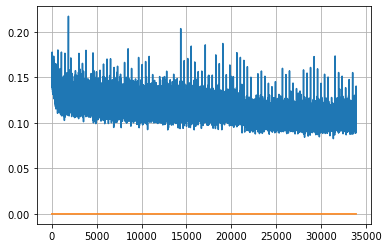

Epoch: 88, iteration 0, loss 0.10178136825561523, cov_diff 0.41613761365483337 cov_diff train 0.4154764482652698
Epoch: 88, iteration 1, loss 0.10701075196266174, cov_diff 0.4265501156804577 cov_diff train 0.4265000221993785
Epoch: 88, iteration 2, loss 0.10439211130142212, cov_diff 0.4348102575503656 cov_diff train 0.43368245814371786
Epoch: 88, iteration 3, loss 0.10576945543289185, cov_diff 0.42422898809460435 cov_diff train 0.4240217711200275
Epoch: 88, iteration 4, loss 0.10586878657341003, cov_diff 0.41562330435863254 cov_diff train 0.4151598443085888
Epoch: 88, iteration 5, loss 0.10047772526741028, cov_diff 0.4280533336388252 cov_diff train 0.42749785734319024
Epoch: 88, iteration 6, loss 0.10945513844490051, cov_diff 0.4192306895365416 cov_diff train 0.4184734813749728
Epoch: 88, iteration 7, loss 0.10151559114456177, cov_diff 0.43945603443464937 cov_diff train 0.43838290025012916
Epoch: 88, iteration 8, loss 0.09725746512413025, cov_diff 0.413641018140954 cov_diff train 0.412

Epoch: 88, iteration 80, loss 0.09179291129112244, cov_diff 0.4200789111916895 cov_diff train 0.4206934554619691
Epoch: 88, iteration 81, loss 0.110942542552948, cov_diff 0.40899099395248256 cov_diff train 0.40862445814956155
Epoch: 88, iteration 82, loss 0.09955295920372009, cov_diff 0.4189075628420105 cov_diff train 0.4188184141538446
Epoch: 88, iteration 83, loss 0.10217854380607605, cov_diff 0.42359342625211055 cov_diff train 0.4229139441420683
Epoch: 88, iteration 84, loss 0.10287833213806152, cov_diff 0.42499854851814767 cov_diff train 0.4251047441234594
Epoch: 88, iteration 85, loss 0.09525090456008911, cov_diff 0.41327174901755515 cov_diff train 0.41295130391283646
Epoch: 88, iteration 86, loss 0.10096284747123718, cov_diff 0.43116621328696936 cov_diff train 0.4306602256293191
Epoch: 88, iteration 87, loss 0.0971323549747467, cov_diff 0.4332206355223689 cov_diff train 0.4330146933718854
Epoch: 88, iteration 88, loss 0.10215112566947937, cov_diff 0.4208114571785458 cov_diff trai

Epoch: 88, iteration 158, loss 0.10833212733268738, cov_diff 0.4255653560230156 cov_diff train 0.42483148626629663
Epoch: 88, iteration 159, loss 0.09986090660095215, cov_diff 0.42493942696709874 cov_diff train 0.4248208042962613
Epoch: 88, iteration 160, loss 0.11423513293266296, cov_diff 0.42260826867025514 cov_diff train 0.42172853644095487
Epoch: 88, iteration 161, loss 0.10136139392852783, cov_diff 0.4237084973591488 cov_diff train 0.4238174563832133
Epoch: 88, iteration 162, loss 0.10119399428367615, cov_diff 0.4201839380077354 cov_diff train 0.4193947256382731
Epoch: 88, iteration 163, loss 0.11420756578445435, cov_diff 0.42521820403370375 cov_diff train 0.4240916029474747
Epoch: 88, iteration 164, loss 0.11747047305107117, cov_diff 0.4329539403052659 cov_diff train 0.4323110034800958
Epoch: 88, iteration 165, loss 0.09934061765670776, cov_diff 0.4183616188242801 cov_diff train 0.41701930966001594
Epoch: 88, iteration 166, loss 0.10178342461585999, cov_diff 0.41876298745842694 c

Epoch: 88, iteration 235, loss 0.09775418043136597, cov_diff 0.3989185771823733 cov_diff train 0.39809403805639676
Epoch: 88, iteration 236, loss 0.11729851365089417, cov_diff 0.4237971644442759 cov_diff train 0.42419487397230654
Epoch: 88, iteration 237, loss 0.09762784838676453, cov_diff 0.4095766389833148 cov_diff train 0.40928427408471457
Epoch: 88, iteration 238, loss 0.10551121830940247, cov_diff 0.4227907263262721 cov_diff train 0.42241393829937535
Epoch: 88, iteration 239, loss 0.10570836067199707, cov_diff 0.4284839950840075 cov_diff train 0.42827123460985256
Epoch: 88, iteration 240, loss 0.10546255111694336, cov_diff 0.41059274613292174 cov_diff train 0.41058657178639274
Epoch: 88, iteration 241, loss 0.09882092475891113, cov_diff 0.41005000473555575 cov_diff train 0.41000869259252204
Epoch: 88, iteration 242, loss 0.11667889356613159, cov_diff 0.42297251995551965 cov_diff train 0.4225355458746024
Epoch: 88, iteration 243, loss 0.10500189661979675, cov_diff 0.429766265803527

Epoch: 88, iteration 312, loss 0.1037658154964447, cov_diff 0.4223238520506842 cov_diff train 0.4208861021643369
Epoch: 88, iteration 313, loss 0.11631670594215393, cov_diff 0.4049920469152087 cov_diff train 0.40481066778064523
Epoch: 88, iteration 314, loss 0.09853750467300415, cov_diff 0.41525406735965986 cov_diff train 0.4148558308764422
Epoch: 88, iteration 315, loss 0.10411214828491211, cov_diff 0.4034520171567368 cov_diff train 0.40168620365806107
Epoch: 88, iteration 316, loss 0.10859799385070801, cov_diff 0.4295655201338934 cov_diff train 0.4286753422057916
Epoch: 88, iteration 317, loss 0.09727755188941956, cov_diff 0.4152809913351354 cov_diff train 0.41473347075855843
Epoch: 88, iteration 318, loss 0.09927541017532349, cov_diff 0.4249638598032051 cov_diff train 0.42475293568761785
Epoch: 88, iteration 319, loss 0.09209781885147095, cov_diff 0.4278115784996283 cov_diff train 0.4267614383126686
Epoch: 88, iteration 320, loss 0.09962403774261475, cov_diff 0.4179827986497701 cov_

Epoch: 88, iteration 384, loss 0.10975909233093262, cov_diff 0.42680256138331774 cov_diff train 0.4256927799680139
Epoch: 88, iteration 385, loss 0.11061778664588928, cov_diff 0.4317887717953342 cov_diff train 0.4308898496013759
Epoch: 88, iteration 386, loss 0.09081408381462097, cov_diff 0.41040061673242695 cov_diff train 0.4094461684039578
Epoch: 88, iteration 387, loss 0.11527219414710999, cov_diff 0.42774362295958773 cov_diff train 0.4264892782670157
Epoch: 88, iteration 388, loss 0.10601475834846497, cov_diff 0.41487107615213253 cov_diff train 0.4142575808152983
Epoch: 88, iteration 389, loss 0.09809979796409607, cov_diff 0.40891784818534005 cov_diff train 0.4082423959670866
Epoch: 88, iteration 390, loss 0.15415266156196594, cov_diff 0.4652371845479255 cov_diff train 0.4643727010825414


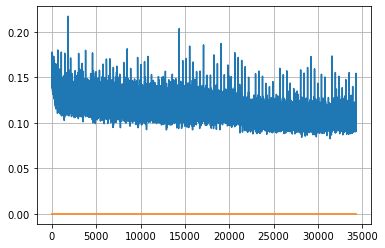

Epoch: 89, iteration 0, loss 0.11160147190093994, cov_diff 0.4219762145498703 cov_diff train 0.421280037714951
Epoch: 89, iteration 1, loss 0.10786977410316467, cov_diff 0.4240922897660969 cov_diff train 0.4235663019905714
Epoch: 89, iteration 2, loss 0.1042620837688446, cov_diff 0.4142837117986237 cov_diff train 0.4138699449997079
Epoch: 89, iteration 3, loss 0.0968954861164093, cov_diff 0.4240171375866721 cov_diff train 0.42411208873228406
Epoch: 89, iteration 4, loss 0.09885862469673157, cov_diff 0.42031892043107727 cov_diff train 0.4195444009005991
Epoch: 89, iteration 5, loss 0.09314712882041931, cov_diff 0.42922074961042944 cov_diff train 0.4288822854056243
Epoch: 89, iteration 6, loss 0.09482792019844055, cov_diff 0.40843121840194824 cov_diff train 0.40813853742869843
Epoch: 89, iteration 7, loss 0.10480594635009766, cov_diff 0.41253489953757166 cov_diff train 0.4124614266701777
Epoch: 89, iteration 8, loss 0.10224223136901855, cov_diff 0.4257325498305066 cov_diff train 0.425891

Epoch: 89, iteration 79, loss 0.0990036129951477, cov_diff 0.41118446280583343 cov_diff train 0.41123690503669885
Epoch: 89, iteration 80, loss 0.10872039198875427, cov_diff 0.4058180349934992 cov_diff train 0.40521540327537414
Epoch: 89, iteration 81, loss 0.09970110654830933, cov_diff 0.4238424759815877 cov_diff train 0.4237565177135171
Epoch: 89, iteration 82, loss 0.11370351910591125, cov_diff 0.44338544667455054 cov_diff train 0.44318861452940245
Epoch: 89, iteration 83, loss 0.09777745604515076, cov_diff 0.42294147202748933 cov_diff train 0.42251467186470754
Epoch: 89, iteration 84, loss 0.0975409746170044, cov_diff 0.42310408848588327 cov_diff train 0.4221812630209077
Epoch: 89, iteration 85, loss 0.10846412181854248, cov_diff 0.4142347848820699 cov_diff train 0.4142501033056825
Epoch: 89, iteration 86, loss 0.10739690065383911, cov_diff 0.4226171476503029 cov_diff train 0.42201392093237766
Epoch: 89, iteration 87, loss 0.10582083463668823, cov_diff 0.425704108069106 cov_diff tr

Epoch: 89, iteration 157, loss 0.108070969581604, cov_diff 0.42499001641424905 cov_diff train 0.42360351657058154
Epoch: 89, iteration 158, loss 0.10582023859024048, cov_diff 0.43230390312294276 cov_diff train 0.42990657607519717
Epoch: 89, iteration 159, loss 0.09709298610687256, cov_diff 0.4180315281986308 cov_diff train 0.41734603503217493
Epoch: 89, iteration 160, loss 0.10772663354873657, cov_diff 0.42561176902242465 cov_diff train 0.42414905389001883
Epoch: 89, iteration 161, loss 0.10641846060752869, cov_diff 0.4219800633022789 cov_diff train 0.4209570335871801
Epoch: 89, iteration 162, loss 0.09640499949455261, cov_diff 0.42010516247265506 cov_diff train 0.418955898382033
Epoch: 89, iteration 163, loss 0.09370800852775574, cov_diff 0.41494798952749345 cov_diff train 0.41469509311026787
Epoch: 89, iteration 164, loss 0.10085123777389526, cov_diff 0.41971967775816443 cov_diff train 0.4190540208909948
Epoch: 89, iteration 165, loss 0.10959801077842712, cov_diff 0.40976878411287376

Epoch: 89, iteration 231, loss 0.10359746217727661, cov_diff 0.41364268152633016 cov_diff train 0.4135600029612096
Epoch: 89, iteration 232, loss 0.10059040784835815, cov_diff 0.4184070011099735 cov_diff train 0.4185877664255
Epoch: 89, iteration 233, loss 0.11100345849990845, cov_diff 0.4212066609805037 cov_diff train 0.4208908837793762
Epoch: 89, iteration 234, loss 0.10168853402137756, cov_diff 0.41750107716362617 cov_diff train 0.4175131798139491
Epoch: 89, iteration 235, loss 0.10457649827003479, cov_diff 0.43708038675484506 cov_diff train 0.43728457537374443
Epoch: 89, iteration 236, loss 0.10774454474449158, cov_diff 0.43608779352356447 cov_diff train 0.43555658425031657
Epoch: 89, iteration 237, loss 0.10723051428794861, cov_diff 0.42006796743800723 cov_diff train 0.4206177419251436
Epoch: 89, iteration 238, loss 0.1077210009098053, cov_diff 0.4177093183650228 cov_diff train 0.41679058830156496
Epoch: 89, iteration 239, loss 0.10342457890510559, cov_diff 0.4202712998175722 cov_

Epoch: 89, iteration 303, loss 0.1094261109828949, cov_diff 0.42411977001516116 cov_diff train 0.4235801398092444
Epoch: 89, iteration 304, loss 0.10156214237213135, cov_diff 0.41038740632607296 cov_diff train 0.4100186182616298
Epoch: 89, iteration 305, loss 0.11088743805885315, cov_diff 0.4277561855977582 cov_diff train 0.4266033110572403
Epoch: 89, iteration 306, loss 0.10827261209487915, cov_diff 0.4093193746385033 cov_diff train 0.4087303734119247
Epoch: 89, iteration 307, loss 0.10474079847335815, cov_diff 0.4241613668355939 cov_diff train 0.4232089589181826
Epoch: 89, iteration 308, loss 0.10374140739440918, cov_diff 0.41742944809985144 cov_diff train 0.4172022609593936
Epoch: 89, iteration 309, loss 0.11341589689254761, cov_diff 0.4329686379994916 cov_diff train 0.4318671205471354
Epoch: 89, iteration 310, loss 0.10182759165763855, cov_diff 0.4145481368269988 cov_diff train 0.41433397692590107
Epoch: 89, iteration 311, loss 0.09617263078689575, cov_diff 0.4048157903640852 cov_d

Epoch: 89, iteration 380, loss 0.10423174500465393, cov_diff 0.42181565172956764 cov_diff train 0.42095176901635795
Epoch: 89, iteration 381, loss 0.10620370507240295, cov_diff 0.41039181915431583 cov_diff train 0.40987835806202333
Epoch: 89, iteration 382, loss 0.11156389117240906, cov_diff 0.41703500425462964 cov_diff train 0.41679973852088437
Epoch: 89, iteration 383, loss 0.09332925081253052, cov_diff 0.4198334992962343 cov_diff train 0.41997959199923535
Epoch: 89, iteration 384, loss 0.11935228109359741, cov_diff 0.4234969996025857 cov_diff train 0.42307184998741687
Epoch: 89, iteration 385, loss 0.10980737209320068, cov_diff 0.4291969997337754 cov_diff train 0.4277911746777118
Epoch: 89, iteration 386, loss 0.10790792107582092, cov_diff 0.43486260355560064 cov_diff train 0.43407602651572286
Epoch: 89, iteration 387, loss 0.10809433460235596, cov_diff 0.4102603673528285 cov_diff train 0.4097928794838248
Epoch: 89, iteration 388, loss 0.10711133480072021, cov_diff 0.425793203614722

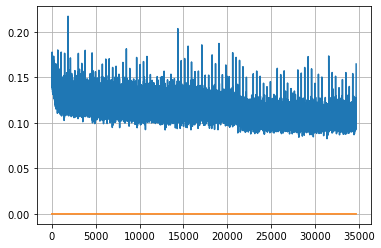

Epoch: 90, iteration 0, loss 0.10334712266921997, cov_diff 0.40840518187599834 cov_diff train 0.4083199605297863
Epoch: 90, iteration 1, loss 0.11056390404701233, cov_diff 0.4108604970850658 cov_diff train 0.4108474783149192
Epoch: 90, iteration 2, loss 0.10853219032287598, cov_diff 0.42067921842703776 cov_diff train 0.4201900664556295
Epoch: 90, iteration 3, loss 0.10659655928611755, cov_diff 0.4224851173465922 cov_diff train 0.42140500053883606
Epoch: 90, iteration 4, loss 0.09624618291854858, cov_diff 0.4250511186194398 cov_diff train 0.4249676727371253
Epoch: 90, iteration 5, loss 0.10112059116363525, cov_diff 0.4171878300377673 cov_diff train 0.4163415316406424
Epoch: 90, iteration 6, loss 0.10680073499679565, cov_diff 0.43238381223198796 cov_diff train 0.4325604507765793
Epoch: 90, iteration 7, loss 0.10378336906433105, cov_diff 0.4388456544083054 cov_diff train 0.4388153455772058
Epoch: 90, iteration 8, loss 0.09274730086326599, cov_diff 0.4192891308392347 cov_diff train 0.41906

Epoch: 90, iteration 76, loss 0.11432740092277527, cov_diff 0.41840226330781183 cov_diff train 0.41800051773257313
Epoch: 90, iteration 77, loss 0.09832435846328735, cov_diff 0.4137407398600175 cov_diff train 0.4133891715565061
Epoch: 90, iteration 78, loss 0.10224050283432007, cov_diff 0.4307462326750852 cov_diff train 0.4295101040803323
Epoch: 90, iteration 79, loss 0.09062710404396057, cov_diff 0.4245938393272275 cov_diff train 0.4240612095249721
Epoch: 90, iteration 80, loss 0.10984724760055542, cov_diff 0.43237391607115766 cov_diff train 0.4320691850705622
Epoch: 90, iteration 81, loss 0.10329896211624146, cov_diff 0.4249151435346504 cov_diff train 0.424774992793491
Epoch: 90, iteration 82, loss 0.10030761361122131, cov_diff 0.4249013333444807 cov_diff train 0.4250056736352506
Epoch: 90, iteration 83, loss 0.10628920793533325, cov_diff 0.4229272889808263 cov_diff train 0.4226628732951124
Epoch: 90, iteration 84, loss 0.10217535495758057, cov_diff 0.41322734313191806 cov_diff train

Epoch: 90, iteration 156, loss 0.10396450757980347, cov_diff 0.43013576931102876 cov_diff train 0.4294196925120804
Epoch: 90, iteration 157, loss 0.09935429692268372, cov_diff 0.4256426307625938 cov_diff train 0.4242049385671496
Epoch: 90, iteration 158, loss 0.10808038711547852, cov_diff 0.40592057244636587 cov_diff train 0.40522531918746924
Epoch: 90, iteration 159, loss 0.10668030381202698, cov_diff 0.4179488028497091 cov_diff train 0.41660841310505353
Epoch: 90, iteration 160, loss 0.10432025790214539, cov_diff 0.4218278757594108 cov_diff train 0.4213382790807513
Epoch: 90, iteration 161, loss 0.1087612509727478, cov_diff 0.42204688535332313 cov_diff train 0.4217969833041049
Epoch: 90, iteration 162, loss 0.1102319061756134, cov_diff 0.4099248649067464 cov_diff train 0.40931740296702845
Epoch: 90, iteration 163, loss 0.10545596480369568, cov_diff 0.4119128702384858 cov_diff train 0.4109739787889269
Epoch: 90, iteration 164, loss 0.09824442863464355, cov_diff 0.416417909175085 cov_d

Epoch: 90, iteration 230, loss 0.10110604763031006, cov_diff 0.4240027811269103 cov_diff train 0.4233470528780255
Epoch: 90, iteration 231, loss 0.10020372271537781, cov_diff 0.42339626862748225 cov_diff train 0.4237216809674923
Epoch: 90, iteration 232, loss 0.10515940189361572, cov_diff 0.41536354415425186 cov_diff train 0.4131971988779723
Epoch: 90, iteration 233, loss 0.10049986839294434, cov_diff 0.41279088985991436 cov_diff train 0.41272917492852923
Epoch: 90, iteration 234, loss 0.10722973942756653, cov_diff 0.4279658015439245 cov_diff train 0.4272768982180762
Epoch: 90, iteration 235, loss 0.09033215045928955, cov_diff 0.41526770295289483 cov_diff train 0.41526748705427124
Epoch: 90, iteration 236, loss 0.10102078318595886, cov_diff 0.42101427133739533 cov_diff train 0.420606535303995
Epoch: 90, iteration 237, loss 0.09226912260055542, cov_diff 0.4182347327039923 cov_diff train 0.4173530613795745
Epoch: 90, iteration 238, loss 0.08372709155082703, cov_diff 0.4092848465174765 co

Epoch: 90, iteration 306, loss 0.10365375876426697, cov_diff 0.41620605499406943 cov_diff train 0.41677249207147243
Epoch: 90, iteration 307, loss 0.10165339708328247, cov_diff 0.4177700166202263 cov_diff train 0.41765855152398507
Epoch: 90, iteration 308, loss 0.12078848481178284, cov_diff 0.4193143742938872 cov_diff train 0.41920067837217956
Epoch: 90, iteration 309, loss 0.09587132930755615, cov_diff 0.4238696477622403 cov_diff train 0.4241945143622113
Epoch: 90, iteration 310, loss 0.10412594676017761, cov_diff 0.4162125137891713 cov_diff train 0.41601385081444964
Epoch: 90, iteration 311, loss 0.09479504823684692, cov_diff 0.4202305548531438 cov_diff train 0.4201952455215664
Epoch: 90, iteration 312, loss 0.09931126236915588, cov_diff 0.43935492308595825 cov_diff train 0.4384636406959306
Epoch: 90, iteration 313, loss 0.10543444752693176, cov_diff 0.4246145721850945 cov_diff train 0.4238700789533059
Epoch: 90, iteration 314, loss 0.11547958850860596, cov_diff 0.4250266805585756 co

Epoch: 90, iteration 382, loss 0.11256814002990723, cov_diff 0.42748337731722186 cov_diff train 0.42724973173684755
Epoch: 90, iteration 383, loss 0.09584805369377136, cov_diff 0.4240267114761981 cov_diff train 0.4227955824475841
Epoch: 90, iteration 384, loss 0.10027137398719788, cov_diff 0.42167275402623794 cov_diff train 0.4208367899141247
Epoch: 90, iteration 385, loss 0.1062055230140686, cov_diff 0.4378530031445707 cov_diff train 0.43740973615616263
Epoch: 90, iteration 386, loss 0.09602749347686768, cov_diff 0.41315391479471536 cov_diff train 0.41268517035199986
Epoch: 90, iteration 387, loss 0.0965307354927063, cov_diff 0.4262969486733011 cov_diff train 0.4257219677691405
Epoch: 90, iteration 388, loss 0.10315001010894775, cov_diff 0.42340290575790157 cov_diff train 0.42266582628648425
Epoch: 90, iteration 389, loss 0.10893833637237549, cov_diff 0.4195369255641435 cov_diff train 0.4189174488110057
Epoch: 90, iteration 390, loss 0.139235258102417, cov_diff 0.4549706092768962 cov_

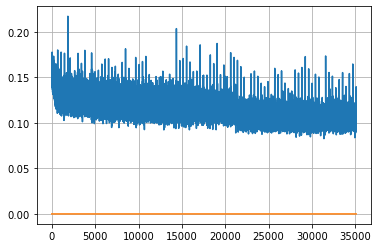

Epoch: 91, iteration 0, loss 0.10455065965652466, cov_diff 0.4254156755053438 cov_diff train 0.4249887046489169
Epoch: 91, iteration 1, loss 0.10021993517875671, cov_diff 0.41488898125304136 cov_diff train 0.41450904438665737
Epoch: 91, iteration 2, loss 0.09053170680999756, cov_diff 0.42641848110778785 cov_diff train 0.42552376368094713
Epoch: 91, iteration 3, loss 0.11937829852104187, cov_diff 0.4179036342227729 cov_diff train 0.4167699428325504
Epoch: 91, iteration 4, loss 0.1030350923538208, cov_diff 0.41655083788043673 cov_diff train 0.4160387587090185
Epoch: 91, iteration 5, loss 0.09691369533538818, cov_diff 0.42588476664250824 cov_diff train 0.4249009895771377
Epoch: 91, iteration 6, loss 0.10889127850532532, cov_diff 0.4469270279066694 cov_diff train 0.4459415058842999
Epoch: 91, iteration 7, loss 0.10580748319625854, cov_diff 0.423549567197755 cov_diff train 0.42302870019100564
Epoch: 91, iteration 8, loss 0.10112497210502625, cov_diff 0.41255752108861654 cov_diff train 0.411

Epoch: 91, iteration 77, loss 0.105314701795578, cov_diff 0.4211211066307813 cov_diff train 0.4202044078964301
Epoch: 91, iteration 78, loss 0.10418441891670227, cov_diff 0.41978774572992017 cov_diff train 0.4192051627940311
Epoch: 91, iteration 79, loss 0.10122397541999817, cov_diff 0.42377835743695297 cov_diff train 0.42251438966379395
Epoch: 91, iteration 80, loss 0.09813567996025085, cov_diff 0.42410045919337636 cov_diff train 0.4233848823750332
Epoch: 91, iteration 81, loss 0.10876527428627014, cov_diff 0.43086850017569567 cov_diff train 0.42983476522942843
Epoch: 91, iteration 82, loss 0.11431285738945007, cov_diff 0.42670433947342107 cov_diff train 0.4252125258536161
Epoch: 91, iteration 83, loss 0.11454254388809204, cov_diff 0.4304022125630087 cov_diff train 0.42957696010384167
Epoch: 91, iteration 84, loss 0.1100393533706665, cov_diff 0.4186320406910388 cov_diff train 0.41617490610603963
Epoch: 91, iteration 85, loss 0.09642109274864197, cov_diff 0.41239951985386125 cov_diff t

Epoch: 91, iteration 152, loss 0.10011854767799377, cov_diff 0.43164114516638974 cov_diff train 0.43101077194451226
Epoch: 91, iteration 153, loss 0.09780159592628479, cov_diff 0.4412827742756042 cov_diff train 0.44113399781309315
Epoch: 91, iteration 154, loss 0.10921713709831238, cov_diff 0.4150870164600696 cov_diff train 0.4149768876901786
Epoch: 91, iteration 155, loss 0.11518889665603638, cov_diff 0.4327950210317241 cov_diff train 0.4325694410174801
Epoch: 91, iteration 156, loss 0.12228235602378845, cov_diff 0.43009563277440965 cov_diff train 0.42904367920549075
Epoch: 91, iteration 157, loss 0.10816165804862976, cov_diff 0.42578557795073496 cov_diff train 0.4243505245105293
Epoch: 91, iteration 158, loss 0.10251730680465698, cov_diff 0.4368098168813029 cov_diff train 0.43637926018922985
Epoch: 91, iteration 159, loss 0.10309240221977234, cov_diff 0.41753125295789745 cov_diff train 0.41628387457043237
Epoch: 91, iteration 160, loss 0.10111382603645325, cov_diff 0.4365918900039752

Epoch: 91, iteration 225, loss 0.1026557981967926, cov_diff 0.42624159520060834 cov_diff train 0.4256847660611538
Epoch: 91, iteration 226, loss 0.1027982234954834, cov_diff 0.40910231221928606 cov_diff train 0.409009991936515
Epoch: 91, iteration 227, loss 0.10454875230789185, cov_diff 0.4185516072082257 cov_diff train 0.4182369859938395
Epoch: 91, iteration 228, loss 0.09133350849151611, cov_diff 0.4255789764136349 cov_diff train 0.4247636849428037
Epoch: 91, iteration 229, loss 0.10684150457382202, cov_diff 0.4232867082758847 cov_diff train 0.42267200225293716
Epoch: 91, iteration 230, loss 0.09913662075996399, cov_diff 0.41278647324694984 cov_diff train 0.4124727992038348
Epoch: 91, iteration 231, loss 0.1088913083076477, cov_diff 0.41079912772042504 cov_diff train 0.41004748232444244
Epoch: 91, iteration 232, loss 0.10366746783256531, cov_diff 0.4122941456720299 cov_diff train 0.41202029117279865
Epoch: 91, iteration 233, loss 0.1006198525428772, cov_diff 0.429598257983193 cov_dif

Epoch: 91, iteration 306, loss 0.09487807750701904, cov_diff 0.42457483657327905 cov_diff train 0.42381998149343897
Epoch: 91, iteration 307, loss 0.10210007429122925, cov_diff 0.41757890516027407 cov_diff train 0.4163623377367317
Epoch: 91, iteration 308, loss 0.10481148958206177, cov_diff 0.42992890710432463 cov_diff train 0.4286013326270275
Epoch: 91, iteration 309, loss 0.11330556869506836, cov_diff 0.4265773207348596 cov_diff train 0.4259210411209409
Epoch: 91, iteration 310, loss 0.09794178605079651, cov_diff 0.41905488040248484 cov_diff train 0.4182332920428399
Epoch: 91, iteration 311, loss 0.11119788885116577, cov_diff 0.4364733409046238 cov_diff train 0.4355988001578058
Epoch: 91, iteration 312, loss 0.10704261064529419, cov_diff 0.42106705912102615 cov_diff train 0.4196637392876105
Epoch: 91, iteration 313, loss 0.09622156620025635, cov_diff 0.4351286741766388 cov_diff train 0.4343934921746654
Epoch: 91, iteration 314, loss 0.10422307252883911, cov_diff 0.4289040270660871 co

Epoch: 91, iteration 378, loss 0.0987994372844696, cov_diff 0.406017235901856 cov_diff train 0.40551987967041947
Epoch: 91, iteration 379, loss 0.10961094498634338, cov_diff 0.4209200309213943 cov_diff train 0.4199826608617443
Epoch: 91, iteration 380, loss 0.11671140789985657, cov_diff 0.4365618277417949 cov_diff train 0.43530715427512373
Epoch: 91, iteration 381, loss 0.11329519748687744, cov_diff 0.42439470609340707 cov_diff train 0.4232546759409165
Epoch: 91, iteration 382, loss 0.10863122344017029, cov_diff 0.4173722299696809 cov_diff train 0.4172342188695627
Epoch: 91, iteration 383, loss 0.10002908110618591, cov_diff 0.4157322370827542 cov_diff train 0.41626098538107165
Epoch: 91, iteration 384, loss 0.10958003997802734, cov_diff 0.43797775159634694 cov_diff train 0.4364508886454373
Epoch: 91, iteration 385, loss 0.10322317481040955, cov_diff 0.42372454866769727 cov_diff train 0.42354234126122514
Epoch: 91, iteration 386, loss 0.10927814245223999, cov_diff 0.422669229424838 cov_

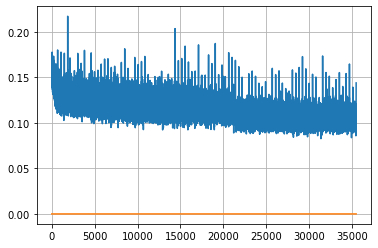

Epoch: 92, iteration 0, loss 0.11424106359481812, cov_diff 0.4188246504315002 cov_diff train 0.41845160928733494
Epoch: 92, iteration 1, loss 0.107089102268219, cov_diff 0.412010321247783 cov_diff train 0.4121264001440564
Epoch: 92, iteration 2, loss 0.11758551001548767, cov_diff 0.4443606955061203 cov_diff train 0.44373089450434566
Epoch: 92, iteration 3, loss 0.09839218854904175, cov_diff 0.4189395597296541 cov_diff train 0.4179136447109752
Epoch: 92, iteration 4, loss 0.1030464768409729, cov_diff 0.4166131783026852 cov_diff train 0.4161376829259705
Epoch: 92, iteration 5, loss 0.10874739289283752, cov_diff 0.42493536617765465 cov_diff train 0.4249669535558569
Epoch: 92, iteration 6, loss 0.1139104962348938, cov_diff 0.41380584367261636 cov_diff train 0.4141438644422849
Epoch: 92, iteration 7, loss 0.10909965634346008, cov_diff 0.42837898899215143 cov_diff train 0.4279912871654328
Epoch: 92, iteration 8, loss 0.10882401466369629, cov_diff 0.42550237271901364 cov_diff train 0.42574752

Epoch: 92, iteration 74, loss 0.10411986708641052, cov_diff 0.42378954576289063 cov_diff train 0.4240039763868494
Epoch: 92, iteration 75, loss 0.10896268486976624, cov_diff 0.4248336225146113 cov_diff train 0.4244988137856886
Epoch: 92, iteration 76, loss 0.10689717531204224, cov_diff 0.4235339492788949 cov_diff train 0.4229373004340718
Epoch: 92, iteration 77, loss 0.11458343267440796, cov_diff 0.4385975022769575 cov_diff train 0.4384043714902445
Epoch: 92, iteration 78, loss 0.11011216044425964, cov_diff 0.42036795897929574 cov_diff train 0.4201363871797034
Epoch: 92, iteration 79, loss 0.11461138725280762, cov_diff 0.4355638949937571 cov_diff train 0.43517390365589165
Epoch: 92, iteration 80, loss 0.10452529788017273, cov_diff 0.41417206535414164 cov_diff train 0.4131513156233591
Epoch: 92, iteration 81, loss 0.11739259958267212, cov_diff 0.42769679635991714 cov_diff train 0.4260987616973059
Epoch: 92, iteration 82, loss 0.10173496603965759, cov_diff 0.43657915278390225 cov_diff tr

Epoch: 92, iteration 148, loss 0.09907519817352295, cov_diff 0.40866569483201454 cov_diff train 0.40749570931568635
Epoch: 92, iteration 149, loss 0.1041383147239685, cov_diff 0.4287010480212864 cov_diff train 0.4282616978208354
Epoch: 92, iteration 150, loss 0.10655641555786133, cov_diff 0.42403187494174166 cov_diff train 0.42297134926373803
Epoch: 92, iteration 151, loss 0.10292932391166687, cov_diff 0.41689628112283383 cov_diff train 0.416328459916581
Epoch: 92, iteration 152, loss 0.10938024520874023, cov_diff 0.4169754773945206 cov_diff train 0.41681220746385855
Epoch: 92, iteration 153, loss 0.11398324370384216, cov_diff 0.41843916246308155 cov_diff train 0.41835171052050074
Epoch: 92, iteration 154, loss 0.09738770127296448, cov_diff 0.4256039671180525 cov_diff train 0.4248999956914037
Epoch: 92, iteration 155, loss 0.10962274670600891, cov_diff 0.41948479551945617 cov_diff train 0.41887255348068925
Epoch: 92, iteration 156, loss 0.0950564444065094, cov_diff 0.41106366363629265 

Epoch: 92, iteration 225, loss 0.0973452627658844, cov_diff 0.41786599105147665 cov_diff train 0.4179734303176473
Epoch: 92, iteration 226, loss 0.10274025797843933, cov_diff 0.3985088150857265 cov_diff train 0.3974406760835835
Epoch: 92, iteration 227, loss 0.10862579941749573, cov_diff 0.4085040684611984 cov_diff train 0.4075702176811282
Epoch: 92, iteration 228, loss 0.10976219177246094, cov_diff 0.4117375468061637 cov_diff train 0.4115537976157039
Epoch: 92, iteration 229, loss 0.10584288835525513, cov_diff 0.41521696217101256 cov_diff train 0.41529811955774043
Epoch: 92, iteration 230, loss 0.10180744528770447, cov_diff 0.4184190153708227 cov_diff train 0.41806896937424304
Epoch: 92, iteration 231, loss 0.10040614008903503, cov_diff 0.4153533688990515 cov_diff train 0.4148550200935766
Epoch: 92, iteration 232, loss 0.10942965745925903, cov_diff 0.4208452016646546 cov_diff train 0.4209016965480244
Epoch: 92, iteration 233, loss 0.11327075958251953, cov_diff 0.39637912557640875 cov_

Epoch: 92, iteration 297, loss 0.10420811176300049, cov_diff 0.42510181924657114 cov_diff train 0.42513087031581404
Epoch: 92, iteration 298, loss 0.1210092306137085, cov_diff 0.4384133593362539 cov_diff train 0.43744962508556057
Epoch: 92, iteration 299, loss 0.09555274248123169, cov_diff 0.4136404965174444 cov_diff train 0.4134970891313274
Epoch: 92, iteration 300, loss 0.10536754131317139, cov_diff 0.41497371883948814 cov_diff train 0.415153375602295
Epoch: 92, iteration 301, loss 0.10317188501358032, cov_diff 0.4309922778028531 cov_diff train 0.4304867493302201
Epoch: 92, iteration 302, loss 0.11206409335136414, cov_diff 0.42725990402545205 cov_diff train 0.42630857065352973
Epoch: 92, iteration 303, loss 0.09917449951171875, cov_diff 0.41768950577579916 cov_diff train 0.4164399588242018
Epoch: 92, iteration 304, loss 0.09838956594467163, cov_diff 0.4250954708876467 cov_diff train 0.4243261504664019
Epoch: 92, iteration 305, loss 0.09816908836364746, cov_diff 0.4096128231431211 cov

Epoch: 92, iteration 375, loss 0.09891894459724426, cov_diff 0.4081338269405619 cov_diff train 0.4082271809803313
Epoch: 92, iteration 376, loss 0.09659108519554138, cov_diff 0.4135673628930808 cov_diff train 0.4130143866071846
Epoch: 92, iteration 377, loss 0.09920912981033325, cov_diff 0.4190811214695715 cov_diff train 0.41887942539177514
Epoch: 92, iteration 378, loss 0.11046484112739563, cov_diff 0.4247182057214373 cov_diff train 0.42364738798907237
Epoch: 92, iteration 379, loss 0.10767707228660583, cov_diff 0.4215720138373258 cov_diff train 0.4208788665873235
Epoch: 92, iteration 380, loss 0.11810854077339172, cov_diff 0.42625442486437315 cov_diff train 0.42579912245446
Epoch: 92, iteration 381, loss 0.0986781120300293, cov_diff 0.4213607477548034 cov_diff train 0.4205238996773438
Epoch: 92, iteration 382, loss 0.10851156711578369, cov_diff 0.4117206496120582 cov_diff train 0.4114881860309346
Epoch: 92, iteration 383, loss 0.10717430710792542, cov_diff 0.41834506970928514 cov_dif

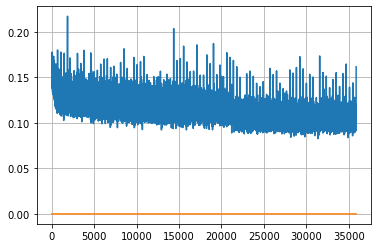

Epoch: 93, iteration 0, loss 0.11623901128768921, cov_diff 0.423898513595333 cov_diff train 0.4238014528072626
Epoch: 93, iteration 1, loss 0.11260578036308289, cov_diff 0.409857212819284 cov_diff train 0.40938679067313627
Epoch: 93, iteration 2, loss 0.10923781991004944, cov_diff 0.43159315945747084 cov_diff train 0.4309342329269281
Epoch: 93, iteration 3, loss 0.09728571772575378, cov_diff 0.4253301645585513 cov_diff train 0.4253143296156317
Epoch: 93, iteration 4, loss 0.10349765419960022, cov_diff 0.439302739154677 cov_diff train 0.4389850924315839
Epoch: 93, iteration 5, loss 0.09798479080200195, cov_diff 0.4169325863970095 cov_diff train 0.4161099260618971
Epoch: 93, iteration 6, loss 0.10444608330726624, cov_diff 0.4092118792526077 cov_diff train 0.40886131979548845
Epoch: 93, iteration 7, loss 0.10765683650970459, cov_diff 0.41848662327427844 cov_diff train 0.41767093940812117
Epoch: 93, iteration 8, loss 0.11152708530426025, cov_diff 0.42983027550958297 cov_diff train 0.427942

Epoch: 93, iteration 77, loss 0.09711360931396484, cov_diff 0.4242351665769722 cov_diff train 0.42384186736375257
Epoch: 93, iteration 78, loss 0.0989273190498352, cov_diff 0.42332640228466356 cov_diff train 0.42223412030677804
Epoch: 93, iteration 79, loss 0.11396530270576477, cov_diff 0.4299058453111143 cov_diff train 0.4287370619456232
Epoch: 93, iteration 80, loss 0.10409960150718689, cov_diff 0.43674359127469475 cov_diff train 0.43641496667819285
Epoch: 93, iteration 81, loss 0.10486459732055664, cov_diff 0.41288036984757015 cov_diff train 0.4122952494325922
Epoch: 93, iteration 82, loss 0.11491909623146057, cov_diff 0.4185386926232991 cov_diff train 0.4180481721630075
Epoch: 93, iteration 83, loss 0.10498166084289551, cov_diff 0.43156738076640916 cov_diff train 0.4303387390989617
Epoch: 93, iteration 84, loss 0.11130034923553467, cov_diff 0.4297311002723205 cov_diff train 0.42830159597729217
Epoch: 93, iteration 85, loss 0.10104787349700928, cov_diff 0.4212961236578499 cov_diff t

Epoch: 93, iteration 153, loss 0.09100830554962158, cov_diff 0.4280549286039759 cov_diff train 0.42594340610250797
Epoch: 93, iteration 154, loss 0.09213843941688538, cov_diff 0.414519320491205 cov_diff train 0.4138494550415158
Epoch: 93, iteration 155, loss 0.09909340739250183, cov_diff 0.43121024459743734 cov_diff train 0.4302194192909813
Epoch: 93, iteration 156, loss 0.10928627848625183, cov_diff 0.4245765689181088 cov_diff train 0.42306209342663315
Epoch: 93, iteration 157, loss 0.10141333937644958, cov_diff 0.40149851976568585 cov_diff train 0.4006434600093289
Epoch: 93, iteration 158, loss 0.11355793476104736, cov_diff 0.41934123628647985 cov_diff train 0.41716126622420086
Epoch: 93, iteration 159, loss 0.1135154664516449, cov_diff 0.4030252607301621 cov_diff train 0.4023887292705474
Epoch: 93, iteration 160, loss 0.10683664679527283, cov_diff 0.4119281300014167 cov_diff train 0.4108711872014356
Epoch: 93, iteration 161, loss 0.11059755086898804, cov_diff 0.430815867740572 cov_d

Epoch: 93, iteration 230, loss 0.11286556720733643, cov_diff 0.42552820330408614 cov_diff train 0.4253480655044277
Epoch: 93, iteration 231, loss 0.10907655954360962, cov_diff 0.4138248291126311 cov_diff train 0.41350080944964734
Epoch: 93, iteration 232, loss 0.09918549656867981, cov_diff 0.4193767065286924 cov_diff train 0.4192235462947025
Epoch: 93, iteration 233, loss 0.10453939437866211, cov_diff 0.40502518362010026 cov_diff train 0.4039012718704896
Epoch: 93, iteration 234, loss 0.11794447898864746, cov_diff 0.4217146038053017 cov_diff train 0.42125364506484564
Epoch: 93, iteration 235, loss 0.11158561706542969, cov_diff 0.4394287285242148 cov_diff train 0.4385132522018372
Epoch: 93, iteration 236, loss 0.10364043712615967, cov_diff 0.42697677677067936 cov_diff train 0.4261398301285662
Epoch: 93, iteration 237, loss 0.10813573002815247, cov_diff 0.4302711025623059 cov_diff train 0.4289496896185397
Epoch: 93, iteration 238, loss 0.09529438614845276, cov_diff 0.42149819569995245 co

Epoch: 93, iteration 311, loss 0.11672988533973694, cov_diff 0.4233909096593181 cov_diff train 0.4225115196625747
Epoch: 93, iteration 312, loss 0.1027628481388092, cov_diff 0.41672683853318326 cov_diff train 0.4145067786284464
Epoch: 93, iteration 313, loss 0.09538307785987854, cov_diff 0.4073880214529657 cov_diff train 0.40694586213692235
Epoch: 93, iteration 314, loss 0.11248067021369934, cov_diff 0.4031178750026221 cov_diff train 0.4028670698164653
Epoch: 93, iteration 315, loss 0.09480613470077515, cov_diff 0.4195446417294666 cov_diff train 0.41874937691192426
Epoch: 93, iteration 316, loss 0.11825582385063171, cov_diff 0.44234186076994947 cov_diff train 0.44130924334939414
Epoch: 93, iteration 317, loss 0.10962021350860596, cov_diff 0.4103914578292877 cov_diff train 0.40963095626597223
Epoch: 93, iteration 318, loss 0.11573883891105652, cov_diff 0.4223187196906985 cov_diff train 0.4226426708685457
Epoch: 93, iteration 319, loss 0.1023065447807312, cov_diff 0.4225362534509609 cov_

Epoch: 93, iteration 388, loss 0.10520875453948975, cov_diff 0.4352248565300347 cov_diff train 0.43471978607956074
Epoch: 93, iteration 389, loss 0.09313550591468811, cov_diff 0.41673322287900777 cov_diff train 0.4161666524124891
Epoch: 93, iteration 390, loss 0.13302937150001526, cov_diff 0.44684463950284475 cov_diff train 0.4473950604406682


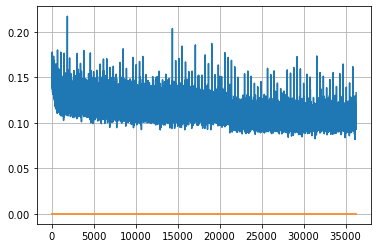

Epoch: 94, iteration 0, loss 0.10808682441711426, cov_diff 0.4279906717838672 cov_diff train 0.42745917246257226
Epoch: 94, iteration 1, loss 0.10541641712188721, cov_diff 0.4216152567881967 cov_diff train 0.42128381032658757
Epoch: 94, iteration 2, loss 0.12006798386573792, cov_diff 0.4206425182089203 cov_diff train 0.42096749334411643
Epoch: 94, iteration 3, loss 0.10402736067771912, cov_diff 0.4322788426314234 cov_diff train 0.4319314260961051
Epoch: 94, iteration 4, loss 0.10978072881698608, cov_diff 0.4188711745789431 cov_diff train 0.4188997720265612
Epoch: 94, iteration 5, loss 0.09861987829208374, cov_diff 0.4174439449263997 cov_diff train 0.41797608358906985
Epoch: 94, iteration 6, loss 0.11259889602661133, cov_diff 0.4280074724192671 cov_diff train 0.4280736559543527
Epoch: 94, iteration 7, loss 0.10641476511955261, cov_diff 0.4166095038458919 cov_diff train 0.4154440233862585
Epoch: 94, iteration 8, loss 0.10910314321517944, cov_diff 0.4202714770226849 cov_diff train 0.42016

Epoch: 94, iteration 76, loss 0.10585397481918335, cov_diff 0.42793683273220096 cov_diff train 0.4276569585305157
Epoch: 94, iteration 77, loss 0.09958583116531372, cov_diff 0.41750951725095675 cov_diff train 0.4171111992941061
Epoch: 94, iteration 78, loss 0.11524832248687744, cov_diff 0.42432235051374595 cov_diff train 0.4239542401024352
Epoch: 94, iteration 79, loss 0.10255515575408936, cov_diff 0.42939923810813924 cov_diff train 0.4295249707230718
Epoch: 94, iteration 80, loss 0.10653674602508545, cov_diff 0.42279066681878963 cov_diff train 0.4225713531089721
Epoch: 94, iteration 81, loss 0.11265051364898682, cov_diff 0.42155692076204215 cov_diff train 0.42014508219619695
Epoch: 94, iteration 82, loss 0.12264525890350342, cov_diff 0.4203632194298079 cov_diff train 0.4206357900198169
Epoch: 94, iteration 83, loss 0.1094764769077301, cov_diff 0.42000306811789834 cov_diff train 0.4190932750895629
Epoch: 94, iteration 84, loss 0.10373499989509583, cov_diff 0.42762033122177034 cov_diff 

Epoch: 94, iteration 157, loss 0.11191606521606445, cov_diff 0.4143959109266515 cov_diff train 0.4133525111701
Epoch: 94, iteration 158, loss 0.10690286755561829, cov_diff 0.41480911532005404 cov_diff train 0.41463457903057155
Epoch: 94, iteration 159, loss 0.10681313276290894, cov_diff 0.41111687084602616 cov_diff train 0.411004717557866
Epoch: 94, iteration 160, loss 0.10435914993286133, cov_diff 0.4376601001837673 cov_diff train 0.43675277838493554
Epoch: 94, iteration 161, loss 0.09874272346496582, cov_diff 0.4175626073727032 cov_diff train 0.41566625533800694
Epoch: 94, iteration 162, loss 0.10602927207946777, cov_diff 0.41389204190363627 cov_diff train 0.4137633821215823
Epoch: 94, iteration 163, loss 0.11086010932922363, cov_diff 0.42337018479347877 cov_diff train 0.42265849346427853
Epoch: 94, iteration 164, loss 0.11011400818824768, cov_diff 0.4385803690714054 cov_diff train 0.43756661391362367
Epoch: 94, iteration 165, loss 0.09369844198226929, cov_diff 0.4104388531921091 cov

Epoch: 94, iteration 231, loss 0.10001885890960693, cov_diff 0.4172350166990901 cov_diff train 0.4169944223917387
Epoch: 94, iteration 232, loss 0.10255938768386841, cov_diff 0.4213584829040391 cov_diff train 0.42028586141691543
Epoch: 94, iteration 233, loss 0.09376829862594604, cov_diff 0.4122235677231489 cov_diff train 0.41194651641936814
Epoch: 94, iteration 234, loss 0.09497371315956116, cov_diff 0.4106285553059775 cov_diff train 0.40995023151088406
Epoch: 94, iteration 235, loss 0.10695105791091919, cov_diff 0.4245948235242067 cov_diff train 0.4238965310050839
Epoch: 94, iteration 236, loss 0.11341500282287598, cov_diff 0.42875886779756334 cov_diff train 0.42808768594948166
Epoch: 94, iteration 237, loss 0.098639577627182, cov_diff 0.43562030307942107 cov_diff train 0.43500561372180313
Epoch: 94, iteration 238, loss 0.09714207053184509, cov_diff 0.41323025727143115 cov_diff train 0.4118931176365473
Epoch: 94, iteration 239, loss 0.10273584723472595, cov_diff 0.42514697473584717 c

Epoch: 94, iteration 304, loss 0.10862547159194946, cov_diff 0.4237153202144002 cov_diff train 0.42281142956573026
Epoch: 94, iteration 305, loss 0.10446658730506897, cov_diff 0.4242352312880742 cov_diff train 0.4231738392381837
Epoch: 94, iteration 306, loss 0.10367128252983093, cov_diff 0.4136856212274474 cov_diff train 0.41358159274657635
Epoch: 94, iteration 307, loss 0.09364640712738037, cov_diff 0.4234795257065603 cov_diff train 0.42357160118278864
Epoch: 94, iteration 308, loss 0.10463237762451172, cov_diff 0.4159734544816398 cov_diff train 0.41546206198104824
Epoch: 94, iteration 309, loss 0.11118307709693909, cov_diff 0.4188632534708518 cov_diff train 0.4191848005213213
Epoch: 94, iteration 310, loss 0.10857957601547241, cov_diff 0.42106151894717486 cov_diff train 0.420568115531715
Epoch: 94, iteration 311, loss 0.10073390603065491, cov_diff 0.4217891113881946 cov_diff train 0.4218439504517699
Epoch: 94, iteration 312, loss 0.11840477585792542, cov_diff 0.4268787723709508 cov_

Epoch: 94, iteration 376, loss 0.10662147402763367, cov_diff 0.41727200606160414 cov_diff train 0.416524600819131
Epoch: 94, iteration 377, loss 0.10648155212402344, cov_diff 0.4179710230138809 cov_diff train 0.41717281353266816
Epoch: 94, iteration 378, loss 0.09666022658348083, cov_diff 0.41262599939898026 cov_diff train 0.41217624529137226
Epoch: 94, iteration 379, loss 0.11319652199745178, cov_diff 0.41614320810088096 cov_diff train 0.4151295746202344
Epoch: 94, iteration 380, loss 0.10714572668075562, cov_diff 0.41701151997607255 cov_diff train 0.41640933881550335
Epoch: 94, iteration 381, loss 0.12314251065254211, cov_diff 0.4214769577006809 cov_diff train 0.42178923357133835
Epoch: 94, iteration 382, loss 0.10356611013412476, cov_diff 0.4280978574585663 cov_diff train 0.4281187497727917
Epoch: 94, iteration 383, loss 0.11529579758644104, cov_diff 0.4331828465071149 cov_diff train 0.43180108538620715
Epoch: 94, iteration 384, loss 0.09154760837554932, cov_diff 0.42155715214356115

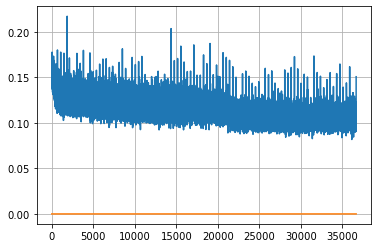

Epoch: 95, iteration 0, loss 0.09749332070350647, cov_diff 0.43097324248692176 cov_diff train 0.43041047436819724
Epoch: 95, iteration 1, loss 0.1066497266292572, cov_diff 0.43038075684470567 cov_diff train 0.4294350640505768
Epoch: 95, iteration 2, loss 0.11358469724655151, cov_diff 0.4210576618889326 cov_diff train 0.420194057604304
Epoch: 95, iteration 3, loss 0.11035910248756409, cov_diff 0.41686027887805355 cov_diff train 0.4152688485290525
Epoch: 95, iteration 4, loss 0.10471293330192566, cov_diff 0.42311747454875914 cov_diff train 0.422003670824378
Epoch: 95, iteration 5, loss 0.11006617546081543, cov_diff 0.4288787271562982 cov_diff train 0.42848048402646527
Epoch: 95, iteration 6, loss 0.10323968529701233, cov_diff 0.41740433056104 cov_diff train 0.41628317824376915
Epoch: 95, iteration 7, loss 0.1034066379070282, cov_diff 0.42759555257340165 cov_diff train 0.4268897874589506
Epoch: 95, iteration 8, loss 0.09900099039077759, cov_diff 0.4284267738801656 cov_diff train 0.4272638

Epoch: 95, iteration 73, loss 0.10487189888954163, cov_diff 0.42354638109302584 cov_diff train 0.4230748391015861
Epoch: 95, iteration 74, loss 0.10452204942703247, cov_diff 0.4032868225048039 cov_diff train 0.4031553996636479
Epoch: 95, iteration 75, loss 0.10145080089569092, cov_diff 0.41894500420714215 cov_diff train 0.4184547087413671
Epoch: 95, iteration 76, loss 0.10297706723213196, cov_diff 0.41167688439447353 cov_diff train 0.41184370136756243
Epoch: 95, iteration 77, loss 0.10263606905937195, cov_diff 0.41720147781831085 cov_diff train 0.41632891027529456
Epoch: 95, iteration 78, loss 0.09976106882095337, cov_diff 0.42432172620603137 cov_diff train 0.4232532712751683
Epoch: 95, iteration 79, loss 0.10070842504501343, cov_diff 0.4240797718212313 cov_diff train 0.4238575161491606
Epoch: 95, iteration 80, loss 0.09988388419151306, cov_diff 0.43219568689433224 cov_diff train 0.4318283700823529
Epoch: 95, iteration 81, loss 0.10938867926597595, cov_diff 0.41091831407360796 cov_diff

Epoch: 95, iteration 152, loss 0.10094693303108215, cov_diff 0.42092752533102956 cov_diff train 0.42043292222316636
Epoch: 95, iteration 153, loss 0.11596861481666565, cov_diff 0.4352460029741873 cov_diff train 0.4343605996636341
Epoch: 95, iteration 154, loss 0.103263258934021, cov_diff 0.4037309971639154 cov_diff train 0.40308400292309077
Epoch: 95, iteration 155, loss 0.10938304662704468, cov_diff 0.41624310752866106 cov_diff train 0.4146176989334254
Epoch: 95, iteration 156, loss 0.10857516527175903, cov_diff 0.43873867006943645 cov_diff train 0.43754132696787973
Epoch: 95, iteration 157, loss 0.10567760467529297, cov_diff 0.42364263974993577 cov_diff train 0.4230020879681221
Epoch: 95, iteration 158, loss 0.09946742653846741, cov_diff 0.4174547049744799 cov_diff train 0.41591413417358475
Epoch: 95, iteration 159, loss 0.10671892762184143, cov_diff 0.42703645394367123 cov_diff train 0.426317041734703
Epoch: 95, iteration 160, loss 0.10582679510116577, cov_diff 0.4238616500271162 co

Epoch: 95, iteration 225, loss 0.12228929996490479, cov_diff 0.4228996789633974 cov_diff train 0.4221524638170457
Epoch: 95, iteration 226, loss 0.11096993088722229, cov_diff 0.42871338500414913 cov_diff train 0.42782128646546663
Epoch: 95, iteration 227, loss 0.1148417592048645, cov_diff 0.4197192568196672 cov_diff train 0.41955708508131206
Epoch: 95, iteration 228, loss 0.09547096490859985, cov_diff 0.4235215259386242 cov_diff train 0.4240849046099251
Epoch: 95, iteration 229, loss 0.10737472772598267, cov_diff 0.42071076676562497 cov_diff train 0.41977122664859684
Epoch: 95, iteration 230, loss 0.11227843165397644, cov_diff 0.4153174057758901 cov_diff train 0.41407061368491177
Epoch: 95, iteration 231, loss 0.11686587333679199, cov_diff 0.4189373083606533 cov_diff train 0.41823122004457236
Epoch: 95, iteration 232, loss 0.09732958674430847, cov_diff 0.43225873847648627 cov_diff train 0.43087995602128
Epoch: 95, iteration 233, loss 0.09811905026435852, cov_diff 0.44051575912809204 co

Epoch: 95, iteration 297, loss 0.10819905996322632, cov_diff 0.4227222116591568 cov_diff train 0.4215646125055644
Epoch: 95, iteration 298, loss 0.10870298743247986, cov_diff 0.41774265077750683 cov_diff train 0.4177683791953428
Epoch: 95, iteration 299, loss 0.10970014333724976, cov_diff 0.4389256639356056 cov_diff train 0.4385733971565358
Epoch: 95, iteration 300, loss 0.10560342669487, cov_diff 0.43425652109777946 cov_diff train 0.4336369231074837
Epoch: 95, iteration 301, loss 0.1091848611831665, cov_diff 0.43667463734481576 cov_diff train 0.43600331057959824
Epoch: 95, iteration 302, loss 0.10309365391731262, cov_diff 0.4178913824410014 cov_diff train 0.4162016464118644
Epoch: 95, iteration 303, loss 0.10174772143363953, cov_diff 0.41498842787101403 cov_diff train 0.4144464149169042
Epoch: 95, iteration 304, loss 0.11086118221282959, cov_diff 0.4370479210114746 cov_diff train 0.43567916371659776
Epoch: 95, iteration 305, loss 0.09867540001869202, cov_diff 0.41638574287449825 cov_d

Epoch: 95, iteration 370, loss 0.09402847290039062, cov_diff 0.4184195797654538 cov_diff train 0.4176830180628339
Epoch: 95, iteration 371, loss 0.11489441990852356, cov_diff 0.42019099214183336 cov_diff train 0.4193534146423819
Epoch: 95, iteration 372, loss 0.10915327072143555, cov_diff 0.412090573266779 cov_diff train 0.41219884776326227
Epoch: 95, iteration 373, loss 0.0975814163684845, cov_diff 0.42713262379618505 cov_diff train 0.4260314632632879
Epoch: 95, iteration 374, loss 0.10280513763427734, cov_diff 0.4186983837145143 cov_diff train 0.41879322075998576
Epoch: 95, iteration 375, loss 0.09674006700515747, cov_diff 0.41705951038746036 cov_diff train 0.4152711447120791
Epoch: 95, iteration 376, loss 0.1110309362411499, cov_diff 0.42075158360045944 cov_diff train 0.419560128486345
Epoch: 95, iteration 377, loss 0.12074345350265503, cov_diff 0.4169601452979065 cov_diff train 0.4158682476207075
Epoch: 95, iteration 378, loss 0.10480800271034241, cov_diff 0.4178985047503895 cov_di

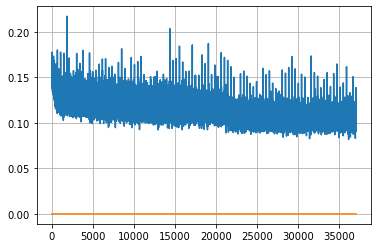

Epoch: 96, iteration 0, loss 0.11388584971427917, cov_diff 0.4290338090444067 cov_diff train 0.42880812633826865
Epoch: 96, iteration 1, loss 0.0984780490398407, cov_diff 0.4308913993541457 cov_diff train 0.4303650379111123
Epoch: 96, iteration 2, loss 0.11067530512809753, cov_diff 0.4232490540616347 cov_diff train 0.4232212770422916
Epoch: 96, iteration 3, loss 0.1097961962223053, cov_diff 0.43162475351391627 cov_diff train 0.43022506631536245
Epoch: 96, iteration 4, loss 0.11693033576011658, cov_diff 0.4290002294894953 cov_diff train 0.428135137672846
Epoch: 96, iteration 5, loss 0.11000552773475647, cov_diff 0.4174105293954237 cov_diff train 0.41662372209479903
Epoch: 96, iteration 6, loss 0.10047906637191772, cov_diff 0.42643869180574556 cov_diff train 0.42508300495054596
Epoch: 96, iteration 7, loss 0.10929527878761292, cov_diff 0.42104987911536446 cov_diff train 0.4196517963620997
Epoch: 96, iteration 8, loss 0.10461589694023132, cov_diff 0.41068791929290127 cov_diff train 0.4099

Epoch: 96, iteration 74, loss 0.09075188636779785, cov_diff 0.4200509535746396 cov_diff train 0.4191699091877434
Epoch: 96, iteration 75, loss 0.1141335666179657, cov_diff 0.4111704784690997 cov_diff train 0.4108354701301781
Epoch: 96, iteration 76, loss 0.10104057192802429, cov_diff 0.42916213485826066 cov_diff train 0.4289150805940954
Epoch: 96, iteration 77, loss 0.10316255688667297, cov_diff 0.4229876294911851 cov_diff train 0.42117178173982
Epoch: 96, iteration 78, loss 0.1082162857055664, cov_diff 0.4266175019949306 cov_diff train 0.42550378795697147
Epoch: 96, iteration 79, loss 0.09316587448120117, cov_diff 0.42963631787063405 cov_diff train 0.4281765461750788
Epoch: 96, iteration 80, loss 0.11350041627883911, cov_diff 0.4290692508338277 cov_diff train 0.4289633403036207
Epoch: 96, iteration 81, loss 0.10028794407844543, cov_diff 0.4135636224862865 cov_diff train 0.41297756828605026
Epoch: 96, iteration 82, loss 0.10098850727081299, cov_diff 0.42416560632435135 cov_diff train 0

Epoch: 96, iteration 156, loss 0.09779062867164612, cov_diff 0.4218666013936266 cov_diff train 0.42146192832651946
Epoch: 96, iteration 157, loss 0.10095790028572083, cov_diff 0.4130735577160415 cov_diff train 0.4127926230648619
Epoch: 96, iteration 158, loss 0.10873991250991821, cov_diff 0.4223190610219046 cov_diff train 0.42180305590628525
Epoch: 96, iteration 159, loss 0.09804859757423401, cov_diff 0.43493951456380525 cov_diff train 0.4346296513226782
Epoch: 96, iteration 160, loss 0.10111132264137268, cov_diff 0.4346274092076091 cov_diff train 0.4342062715999804
Epoch: 96, iteration 161, loss 0.09856975078582764, cov_diff 0.42674493383271855 cov_diff train 0.4255465742116014
Epoch: 96, iteration 162, loss 0.10464662313461304, cov_diff 0.4299428727853429 cov_diff train 0.42970873627664385
Epoch: 96, iteration 163, loss 0.11214625835418701, cov_diff 0.4327518733861975 cov_diff train 0.43191516705328986
Epoch: 96, iteration 164, loss 0.11326345801353455, cov_diff 0.42352946451387474 c

Epoch: 96, iteration 234, loss 0.10472112894058228, cov_diff 0.4196583630882471 cov_diff train 0.41902655965563756
Epoch: 96, iteration 235, loss 0.10931861400604248, cov_diff 0.41815774726524485 cov_diff train 0.4167509433757176
Epoch: 96, iteration 236, loss 0.10071128606796265, cov_diff 0.4306248440836871 cov_diff train 0.4302409908354299
Epoch: 96, iteration 237, loss 0.10113891959190369, cov_diff 0.4347219809558338 cov_diff train 0.4344986995281009
Epoch: 96, iteration 238, loss 0.09892678260803223, cov_diff 0.4265305342594219 cov_diff train 0.42669094056524937
Epoch: 96, iteration 239, loss 0.10476905107498169, cov_diff 0.4338427544380211 cov_diff train 0.4341957071339865
Epoch: 96, iteration 240, loss 0.10228094458580017, cov_diff 0.41335569797002136 cov_diff train 0.41256574955991443
Epoch: 96, iteration 241, loss 0.10396301746368408, cov_diff 0.4180260275265102 cov_diff train 0.4178333735499071
Epoch: 96, iteration 242, loss 0.12474855780601501, cov_diff 0.4068206559271815 cov

Epoch: 96, iteration 310, loss 0.10779237747192383, cov_diff 0.4194098512254229 cov_diff train 0.41901902694447024
Epoch: 96, iteration 311, loss 0.11012926697731018, cov_diff 0.4137423395556357 cov_diff train 0.4121672966135121
Epoch: 96, iteration 312, loss 0.11201158165931702, cov_diff 0.42564615556711494 cov_diff train 0.4257235171820784
Epoch: 96, iteration 313, loss 0.10041758418083191, cov_diff 0.42349498371639416 cov_diff train 0.4231805662975126
Epoch: 96, iteration 314, loss 0.11952951550483704, cov_diff 0.43900317687884083 cov_diff train 0.439088094939081
Epoch: 96, iteration 315, loss 0.10447520017623901, cov_diff 0.44140867076784873 cov_diff train 0.44020949577012763
Epoch: 96, iteration 316, loss 0.10017263889312744, cov_diff 0.43260373342369257 cov_diff train 0.43184130402081944
Epoch: 96, iteration 317, loss 0.10573208332061768, cov_diff 0.4147560919885025 cov_diff train 0.41427803730205426
Epoch: 96, iteration 318, loss 0.10709092020988464, cov_diff 0.42355080980351995

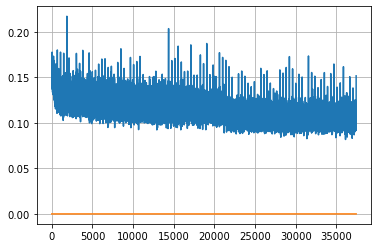

Epoch: 97, iteration 0, loss 0.10419833660125732, cov_diff 0.41862925342966284 cov_diff train 0.4183029265875473
Epoch: 97, iteration 1, loss 0.10357007384300232, cov_diff 0.42096484574425186 cov_diff train 0.4204937865118829
Epoch: 97, iteration 2, loss 0.10242703557014465, cov_diff 0.4156685046939401 cov_diff train 0.414764552819618
Epoch: 97, iteration 3, loss 0.09759646654129028, cov_diff 0.4316836220744323 cov_diff train 0.4314446136066314
Epoch: 97, iteration 4, loss 0.09903982281684875, cov_diff 0.40937596594648085 cov_diff train 0.4095478177656923
Epoch: 97, iteration 5, loss 0.09421530365943909, cov_diff 0.414302547941677 cov_diff train 0.4142312305306529
Epoch: 97, iteration 6, loss 0.10613000392913818, cov_diff 0.42581691278580786 cov_diff train 0.4249884958455534
Epoch: 97, iteration 7, loss 0.10826176404953003, cov_diff 0.43460872098750897 cov_diff train 0.43430784278659146
Epoch: 97, iteration 8, loss 0.10654637217521667, cov_diff 0.4115832548550123 cov_diff train 0.41079

Epoch: 97, iteration 81, loss 0.1038636565208435, cov_diff 0.431570863432632 cov_diff train 0.42960340540128733
Epoch: 97, iteration 82, loss 0.10852453112602234, cov_diff 0.41232373142482237 cov_diff train 0.4121524633627995
Epoch: 97, iteration 83, loss 0.0987529456615448, cov_diff 0.4168588217086972 cov_diff train 0.41686757505424615
Epoch: 97, iteration 84, loss 0.11041688919067383, cov_diff 0.4173993129731605 cov_diff train 0.41737144397402925
Epoch: 97, iteration 85, loss 0.10681891441345215, cov_diff 0.41882757869756226 cov_diff train 0.41845855194122894
Epoch: 97, iteration 86, loss 0.08819282054901123, cov_diff 0.43159386110506154 cov_diff train 0.4307653563881678
Epoch: 97, iteration 87, loss 0.0992506742477417, cov_diff 0.419963937817456 cov_diff train 0.419036543410807
Epoch: 97, iteration 88, loss 0.10295939445495605, cov_diff 0.42663170067129136 cov_diff train 0.42563029430468274
Epoch: 97, iteration 89, loss 0.11485347151756287, cov_diff 0.43204452695536877 cov_diff trai

Epoch: 97, iteration 161, loss 0.10449442267417908, cov_diff 0.42053116922211564 cov_diff train 0.420875238167216
Epoch: 97, iteration 162, loss 0.11522087454795837, cov_diff 0.42076296365406934 cov_diff train 0.41994401915526464
Epoch: 97, iteration 163, loss 0.100788414478302, cov_diff 0.44189434799376065 cov_diff train 0.4408364550566073
Epoch: 97, iteration 164, loss 0.12027648091316223, cov_diff 0.41334636497874805 cov_diff train 0.41258212615947254
Epoch: 97, iteration 165, loss 0.09247815608978271, cov_diff 0.42371887838132477 cov_diff train 0.4229131109440114
Epoch: 97, iteration 166, loss 0.10339376330375671, cov_diff 0.4219093675812766 cov_diff train 0.4200672559367298
Epoch: 97, iteration 167, loss 0.10733449459075928, cov_diff 0.4196478943201172 cov_diff train 0.41852864469875756
Epoch: 97, iteration 168, loss 0.09571871161460876, cov_diff 0.423275963423465 cov_diff train 0.42251018127478013
Epoch: 97, iteration 169, loss 0.12126705050468445, cov_diff 0.4284205901257746 cov

Epoch: 97, iteration 239, loss 0.09607642889022827, cov_diff 0.4230559964865185 cov_diff train 0.4223421313746392
Epoch: 97, iteration 240, loss 0.10426869988441467, cov_diff 0.42215779693938793 cov_diff train 0.42107464161063385
Epoch: 97, iteration 241, loss 0.10917201638221741, cov_diff 0.42567941137523324 cov_diff train 0.4257661185790676
Epoch: 97, iteration 242, loss 0.10585969686508179, cov_diff 0.43167305573788556 cov_diff train 0.4310041320313307
Epoch: 97, iteration 243, loss 0.09755465388298035, cov_diff 0.43001063336121687 cov_diff train 0.4292612066399815
Epoch: 97, iteration 244, loss 0.11022332310676575, cov_diff 0.4216719430633633 cov_diff train 0.421184320889674
Epoch: 97, iteration 245, loss 0.09871387481689453, cov_diff 0.42692938306671185 cov_diff train 0.42672046260249796
Epoch: 97, iteration 246, loss 0.10197421908378601, cov_diff 0.4189778727247589 cov_diff train 0.4181858389347186
Epoch: 97, iteration 247, loss 0.09858810901641846, cov_diff 0.4209626106322546 co

Epoch: 97, iteration 318, loss 0.09708905220031738, cov_diff 0.4320978524698148 cov_diff train 0.43153637877023693
Epoch: 97, iteration 319, loss 0.1038476824760437, cov_diff 0.42810869750404235 cov_diff train 0.42718419153782355
Epoch: 97, iteration 320, loss 0.10152938961982727, cov_diff 0.4199113582497138 cov_diff train 0.4190501067515966
Epoch: 97, iteration 321, loss 0.0991426408290863, cov_diff 0.4213372611407877 cov_diff train 0.42093903345717865
Epoch: 97, iteration 322, loss 0.1042681336402893, cov_diff 0.42862556915803895 cov_diff train 0.42782447778909083
Epoch: 97, iteration 323, loss 0.10370373725891113, cov_diff 0.43120893889974515 cov_diff train 0.4308283596145597
Epoch: 97, iteration 324, loss 0.10223710536956787, cov_diff 0.4161188267027452 cov_diff train 0.4154811290185669
Epoch: 97, iteration 325, loss 0.10228490829467773, cov_diff 0.4190206445003947 cov_diff train 0.41836935610995535
Epoch: 97, iteration 326, loss 0.09852728247642517, cov_diff 0.41387874858614365 co

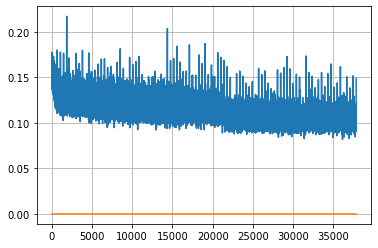

Epoch: 98, iteration 0, loss 0.10252591967582703, cov_diff 0.4133133357230921 cov_diff train 0.4125854164239685
Epoch: 98, iteration 1, loss 0.10586929321289062, cov_diff 0.4260754733495365 cov_diff train 0.42566428656134836
Epoch: 98, iteration 2, loss 0.10222753882408142, cov_diff 0.4118520046834032 cov_diff train 0.4112113592613875
Epoch: 98, iteration 3, loss 0.1205376386642456, cov_diff 0.416133344996062 cov_diff train 0.4155909811911869
Epoch: 98, iteration 4, loss 0.10015261173248291, cov_diff 0.43762058823144684 cov_diff train 0.4375131519862359
Epoch: 98, iteration 5, loss 0.10091501474380493, cov_diff 0.4150099657637322 cov_diff train 0.41595586129831874
Epoch: 98, iteration 6, loss 0.10461026430130005, cov_diff 0.41997251110209166 cov_diff train 0.41928698163929135
Epoch: 98, iteration 7, loss 0.09690484404563904, cov_diff 0.4282076726362902 cov_diff train 0.42793411256300157
Epoch: 98, iteration 8, loss 0.10468313097953796, cov_diff 0.4208451606821094 cov_diff train 0.42071

Epoch: 98, iteration 78, loss 0.10396993160247803, cov_diff 0.41562894115951304 cov_diff train 0.4151764703431485
Epoch: 98, iteration 79, loss 0.11360746622085571, cov_diff 0.4089267759204769 cov_diff train 0.4081739285002727
Epoch: 98, iteration 80, loss 0.09724324941635132, cov_diff 0.414898073121249 cov_diff train 0.41451642577198616
Epoch: 98, iteration 81, loss 0.09491384029388428, cov_diff 0.42908501526563514 cov_diff train 0.4287624577509648
Epoch: 98, iteration 82, loss 0.10900390148162842, cov_diff 0.4147892704860337 cov_diff train 0.41516065761745696
Epoch: 98, iteration 83, loss 0.10182341933250427, cov_diff 0.4050776605647091 cov_diff train 0.4048007007076799
Epoch: 98, iteration 84, loss 0.10824599862098694, cov_diff 0.4270457717520528 cov_diff train 0.42565919301173993
Epoch: 98, iteration 85, loss 0.10943746566772461, cov_diff 0.42324654808580325 cov_diff train 0.4224036473621465
Epoch: 98, iteration 86, loss 0.11320841312408447, cov_diff 0.43005408906367554 cov_diff tr

Epoch: 98, iteration 155, loss 0.1104435920715332, cov_diff 0.4132961531669429 cov_diff train 0.413073116321824
Epoch: 98, iteration 156, loss 0.10943987965583801, cov_diff 0.42764612006220637 cov_diff train 0.427271917733531
Epoch: 98, iteration 157, loss 0.10013815760612488, cov_diff 0.4127033580022011 cov_diff train 0.4122952500082731
Epoch: 98, iteration 158, loss 0.11527502536773682, cov_diff 0.4182961211757657 cov_diff train 0.4176526808095739
Epoch: 98, iteration 159, loss 0.10344958305358887, cov_diff 0.42310766585575893 cov_diff train 0.42275877961744135
Epoch: 98, iteration 160, loss 0.10978269577026367, cov_diff 0.42309300136359007 cov_diff train 0.4227202036170032
Epoch: 98, iteration 161, loss 0.10283476114273071, cov_diff 0.4236278923060871 cov_diff train 0.42280682971664013
Epoch: 98, iteration 162, loss 0.10540741682052612, cov_diff 0.42056601137494914 cov_diff train 0.4199067362023832
Epoch: 98, iteration 163, loss 0.0972093939781189, cov_diff 0.4244053411434831 cov_di

Epoch: 98, iteration 233, loss 0.10394558310508728, cov_diff 0.4193309643170263 cov_diff train 0.41816546056153475
Epoch: 98, iteration 234, loss 0.10751590132713318, cov_diff 0.4226315351297809 cov_diff train 0.42132096452088574
Epoch: 98, iteration 235, loss 0.11143797636032104, cov_diff 0.4064541909162503 cov_diff train 0.40633806096674135
Epoch: 98, iteration 236, loss 0.11161938309669495, cov_diff 0.41701916792080956 cov_diff train 0.4163151184048893
Epoch: 98, iteration 237, loss 0.10529771447181702, cov_diff 0.4054729373217119 cov_diff train 0.404825880776875
Epoch: 98, iteration 238, loss 0.11902034282684326, cov_diff 0.4183853142433159 cov_diff train 0.41823825052691327
Epoch: 98, iteration 239, loss 0.11494031548500061, cov_diff 0.41161959430945844 cov_diff train 0.41135907943128014
Epoch: 98, iteration 240, loss 0.10129430890083313, cov_diff 0.4146676618205189 cov_diff train 0.41403213918752285
Epoch: 98, iteration 241, loss 0.10147640109062195, cov_diff 0.4260877761705131 c

Epoch: 98, iteration 307, loss 0.10364112257957458, cov_diff 0.4315169982206328 cov_diff train 0.43000765512508077
Epoch: 98, iteration 308, loss 0.10285595059394836, cov_diff 0.4208905159126751 cov_diff train 0.4201128685452708
Epoch: 98, iteration 309, loss 0.10174447298049927, cov_diff 0.41827238197421274 cov_diff train 0.4173586221951871
Epoch: 98, iteration 310, loss 0.09772992134094238, cov_diff 0.41423700058350577 cov_diff train 0.4132870593275395
Epoch: 98, iteration 311, loss 0.09067565202713013, cov_diff 0.4173847336096123 cov_diff train 0.41656467374651773
Epoch: 98, iteration 312, loss 0.11249187588691711, cov_diff 0.4136428116828591 cov_diff train 0.4130117823527049
Epoch: 98, iteration 313, loss 0.10360607504844666, cov_diff 0.4269682580880021 cov_diff train 0.42534404710310225
Epoch: 98, iteration 314, loss 0.10150390863418579, cov_diff 0.4210436615347409 cov_diff train 0.4194904821615838
Epoch: 98, iteration 315, loss 0.10506361722946167, cov_diff 0.4242631914608757 cov

Epoch: 98, iteration 384, loss 0.11548560857772827, cov_diff 0.4360169774690258 cov_diff train 0.43550698088335243
Epoch: 98, iteration 385, loss 0.09555041790008545, cov_diff 0.4213293274459805 cov_diff train 0.4204434674988493
Epoch: 98, iteration 386, loss 0.10349920392036438, cov_diff 0.44025431718015856 cov_diff train 0.43965551145262416
Epoch: 98, iteration 387, loss 0.0989522933959961, cov_diff 0.4196152180265028 cov_diff train 0.4192652437246581
Epoch: 98, iteration 388, loss 0.10414421558380127, cov_diff 0.42474682151151155 cov_diff train 0.4235483795470132
Epoch: 98, iteration 389, loss 0.10992556810379028, cov_diff 0.4255937513249944 cov_diff train 0.4248472772051855
Epoch: 98, iteration 390, loss 0.12928032875061035, cov_diff 0.4447665169516417 cov_diff train 0.44432869988255147


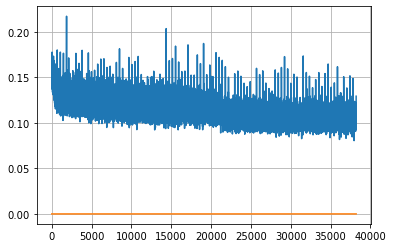

Epoch: 99, iteration 0, loss 0.09378522634506226, cov_diff 0.42743988041324577 cov_diff train 0.42618856268507527
Epoch: 99, iteration 1, loss 0.10797008872032166, cov_diff 0.43485406371360413 cov_diff train 0.4345048255089627
Epoch: 99, iteration 2, loss 0.10433468222618103, cov_diff 0.4259535760333951 cov_diff train 0.4251931293400073
Epoch: 99, iteration 3, loss 0.10285520553588867, cov_diff 0.41224868355007527 cov_diff train 0.4117453875260933
Epoch: 99, iteration 4, loss 0.09791162610054016, cov_diff 0.41309809905936234 cov_diff train 0.41271532092811103
Epoch: 99, iteration 5, loss 0.10665979981422424, cov_diff 0.4215676236433088 cov_diff train 0.4207513403029902
Epoch: 99, iteration 6, loss 0.11708652973175049, cov_diff 0.4066100270696028 cov_diff train 0.40606795855736144
Epoch: 99, iteration 7, loss 0.09519240260124207, cov_diff 0.431548339056663 cov_diff train 0.4307070677197037
Epoch: 99, iteration 8, loss 0.10480421781539917, cov_diff 0.4165211019785235 cov_diff train 0.416

Epoch: 99, iteration 77, loss 0.09897372126579285, cov_diff 0.41534545265496703 cov_diff train 0.41350644951385185
Epoch: 99, iteration 78, loss 0.10735011100769043, cov_diff 0.418466825703356 cov_diff train 0.41731360965707665
Epoch: 99, iteration 79, loss 0.11278712749481201, cov_diff 0.41434354788335154 cov_diff train 0.41321443977738104
Epoch: 99, iteration 80, loss 0.11694031953811646, cov_diff 0.41631395523371695 cov_diff train 0.41481920347827794
Epoch: 99, iteration 81, loss 0.10249596834182739, cov_diff 0.4193328494893929 cov_diff train 0.41898603227326325
Epoch: 99, iteration 82, loss 0.11581245064735413, cov_diff 0.42586060984331564 cov_diff train 0.4250127759435758
Epoch: 99, iteration 83, loss 0.09227445721626282, cov_diff 0.39932051547143477 cov_diff train 0.3988846374017488
Epoch: 99, iteration 84, loss 0.09910041093826294, cov_diff 0.412935656043977 cov_diff train 0.4126763735664031
Epoch: 99, iteration 85, loss 0.1051696240901947, cov_diff 0.4067287119251815 cov_diff t

Epoch: 99, iteration 154, loss 0.10300678014755249, cov_diff 0.41685520624358496 cov_diff train 0.4165479544150026
Epoch: 99, iteration 155, loss 0.10601907968521118, cov_diff 0.42748752444650395 cov_diff train 0.4270097121682887
Epoch: 99, iteration 156, loss 0.11144548654556274, cov_diff 0.42059214301246184 cov_diff train 0.420212132076671
Epoch: 99, iteration 157, loss 0.11250409483909607, cov_diff 0.4268047425235949 cov_diff train 0.42457535117369904
Epoch: 99, iteration 158, loss 0.11380121111869812, cov_diff 0.4410107299382162 cov_diff train 0.43897879399842815
Epoch: 99, iteration 159, loss 0.10737001895904541, cov_diff 0.41829902718706524 cov_diff train 0.4176162221284424
Epoch: 99, iteration 160, loss 0.10333564877510071, cov_diff 0.3959240408500414 cov_diff train 0.3946815715442165
Epoch: 99, iteration 161, loss 0.10181978344917297, cov_diff 0.4164747986589367 cov_diff train 0.41669117370493464
Epoch: 99, iteration 162, loss 0.11546844244003296, cov_diff 0.409876171229711 cov

Epoch: 99, iteration 231, loss 0.1069374680519104, cov_diff 0.4275949334561038 cov_diff train 0.42721030161655393
Epoch: 99, iteration 232, loss 0.10726740956306458, cov_diff 0.417405264429521 cov_diff train 0.4164431408872494
Epoch: 99, iteration 233, loss 0.1136273741722107, cov_diff 0.42510240933503607 cov_diff train 0.4242825988439102
Epoch: 99, iteration 234, loss 0.10729312896728516, cov_diff 0.4216031386918478 cov_diff train 0.42074458882286175
Epoch: 99, iteration 235, loss 0.10433074831962585, cov_diff 0.41420177572644257 cov_diff train 0.413981603323296
Epoch: 99, iteration 236, loss 0.09846135973930359, cov_diff 0.4170237283092818 cov_diff train 0.4163847009423448
Epoch: 99, iteration 237, loss 0.10834014415740967, cov_diff 0.4177874192113863 cov_diff train 0.41668323750243286
Epoch: 99, iteration 238, loss 0.09613630175590515, cov_diff 0.4192704209307156 cov_diff train 0.4182297123411972
Epoch: 99, iteration 239, loss 0.10293000936508179, cov_diff 0.40747969728142963 cov_di

Epoch: 99, iteration 310, loss 0.11768561601638794, cov_diff 0.4169214304417085 cov_diff train 0.416756514755488
Epoch: 99, iteration 311, loss 0.09460341930389404, cov_diff 0.41383650460383614 cov_diff train 0.4130992037041263
Epoch: 99, iteration 312, loss 0.10840696096420288, cov_diff 0.42295131194731184 cov_diff train 0.4223691999346902
Epoch: 99, iteration 313, loss 0.10211953520774841, cov_diff 0.4189287265156659 cov_diff train 0.41896869419455374
Epoch: 99, iteration 314, loss 0.1045442521572113, cov_diff 0.4238017645579648 cov_diff train 0.4227143696607145
Epoch: 99, iteration 315, loss 0.10637694597244263, cov_diff 0.40881403802311306 cov_diff train 0.4083478360839016
Epoch: 99, iteration 316, loss 0.09962958097457886, cov_diff 0.4041789295801205 cov_diff train 0.40411837415611074
Epoch: 99, iteration 317, loss 0.12225395441055298, cov_diff 0.4290231224650898 cov_diff train 0.4291007056687455
Epoch: 99, iteration 318, loss 0.10044801235198975, cov_diff 0.4299077078163496 cov_d

Epoch: 99, iteration 387, loss 0.1001092791557312, cov_diff 0.41880805002077637 cov_diff train 0.41787784274199147
Epoch: 99, iteration 388, loss 0.10700473189353943, cov_diff 0.4317281956310046 cov_diff train 0.4307167770642891
Epoch: 99, iteration 389, loss 0.10091933608055115, cov_diff 0.41480863387009614 cov_diff train 0.4139520636769279
Epoch: 99, iteration 390, loss 0.14694198966026306, cov_diff 0.43892752193991597 cov_diff train 0.4398084542664874


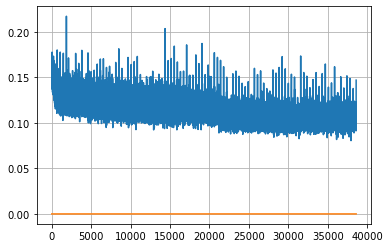

Epoch: 100, iteration 0, loss 0.09795969724655151, cov_diff 0.4111654185845076 cov_diff train 0.41117286924342006
Epoch: 100, iteration 1, loss 0.1028696596622467, cov_diff 0.41687967685570415 cov_diff train 0.41727720246005967
Epoch: 100, iteration 2, loss 0.10505226254463196, cov_diff 0.4276847041329844 cov_diff train 0.42733287495646777
Epoch: 100, iteration 3, loss 0.10838314890861511, cov_diff 0.4178999738331294 cov_diff train 0.4175266600763166
Epoch: 100, iteration 4, loss 0.10586923360824585, cov_diff 0.4231215350082369 cov_diff train 0.4230947129299024
Epoch: 100, iteration 5, loss 0.11121878027915955, cov_diff 0.4170686762688987 cov_diff train 0.41651333198484614
Epoch: 100, iteration 6, loss 0.11014020442962646, cov_diff 0.41003894139220115 cov_diff train 0.4090755655691401
Epoch: 100, iteration 7, loss 0.10461503267288208, cov_diff 0.42880951237344617 cov_diff train 0.42893149175434636
Epoch: 100, iteration 8, loss 0.0933392345905304, cov_diff 0.4213112824746392 cov_diff tr

Epoch: 100, iteration 74, loss 0.09587013721466064, cov_diff 0.41955158279083543 cov_diff train 0.4191908867501518
Epoch: 100, iteration 75, loss 0.09749627113342285, cov_diff 0.4136394915731378 cov_diff train 0.4128202148399071
Epoch: 100, iteration 76, loss 0.09844544529914856, cov_diff 0.4180376491284664 cov_diff train 0.41689305209138494
Epoch: 100, iteration 77, loss 0.10680857300758362, cov_diff 0.42300332721061884 cov_diff train 0.4217614517679276
Epoch: 100, iteration 78, loss 0.10133105516433716, cov_diff 0.4287242104121459 cov_diff train 0.42858080459741543
Epoch: 100, iteration 79, loss 0.10645228624343872, cov_diff 0.413983355728726 cov_diff train 0.4135337024033433
Epoch: 100, iteration 80, loss 0.1059848964214325, cov_diff 0.40972634465039554 cov_diff train 0.4101170369648557
Epoch: 100, iteration 81, loss 0.09779098629951477, cov_diff 0.42072786543746743 cov_diff train 0.4201190754685309
Epoch: 100, iteration 82, loss 0.11482551693916321, cov_diff 0.4131767332726002 cov_

Epoch: 100, iteration 147, loss 0.10712257027626038, cov_diff 0.4077006394094811 cov_diff train 0.40734490786551725
Epoch: 100, iteration 148, loss 0.11119532585144043, cov_diff 0.4177271494546899 cov_diff train 0.4177104521847987
Epoch: 100, iteration 149, loss 0.10034355521202087, cov_diff 0.4129232199048454 cov_diff train 0.41204000089438575
Epoch: 100, iteration 150, loss 0.09853777289390564, cov_diff 0.4122721205670369 cov_diff train 0.4121600713068969
Epoch: 100, iteration 151, loss 0.10315319895744324, cov_diff 0.4153750324734289 cov_diff train 0.41432570177834943
Epoch: 100, iteration 152, loss 0.10025107860565186, cov_diff 0.43717120009567767 cov_diff train 0.4365239774410177
Epoch: 100, iteration 153, loss 0.11589989066123962, cov_diff 0.42279492261111434 cov_diff train 0.4229511085931675
Epoch: 100, iteration 154, loss 0.10598212480545044, cov_diff 0.42381893978391144 cov_diff train 0.4228348397316916
Epoch: 100, iteration 155, loss 0.09972697496414185, cov_diff 0.4255316275

Epoch: 100, iteration 224, loss 0.09948959946632385, cov_diff 0.41955746117075865 cov_diff train 0.4191610280117825
Epoch: 100, iteration 225, loss 0.10085350275039673, cov_diff 0.4212065564556855 cov_diff train 0.420971345499911
Epoch: 100, iteration 226, loss 0.09367260336875916, cov_diff 0.415369714314091 cov_diff train 0.4148307200085228
Epoch: 100, iteration 227, loss 0.12309315800666809, cov_diff 0.41963051944249274 cov_diff train 0.41971683086875994
Epoch: 100, iteration 228, loss 0.10585317015647888, cov_diff 0.40651345855186394 cov_diff train 0.40586134821011866
Epoch: 100, iteration 229, loss 0.09958285093307495, cov_diff 0.43176572372065 cov_diff train 0.4312262881406574
Epoch: 100, iteration 230, loss 0.0930536687374115, cov_diff 0.40955396614014083 cov_diff train 0.40910883575268625
Epoch: 100, iteration 231, loss 0.10219067335128784, cov_diff 0.413364031422804 cov_diff train 0.41320508265136957
Epoch: 100, iteration 232, loss 0.1133737564086914, cov_diff 0.405686808642489

Epoch: 100, iteration 299, loss 0.11063835024833679, cov_diff 0.40642137061227246 cov_diff train 0.40626750924250427
Epoch: 100, iteration 300, loss 0.11156919598579407, cov_diff 0.4358141554305012 cov_diff train 0.4352261594385549
Epoch: 100, iteration 301, loss 0.09958153963088989, cov_diff 0.4151812004872889 cov_diff train 0.41437439484478705
Epoch: 100, iteration 302, loss 0.09641766548156738, cov_diff 0.42560519425939847 cov_diff train 0.4246121930050355
Epoch: 100, iteration 303, loss 0.1073022186756134, cov_diff 0.41717497845527096 cov_diff train 0.41691799606322577
Epoch: 100, iteration 304, loss 0.09310609102249146, cov_diff 0.4301314624971104 cov_diff train 0.43018747401441787
Epoch: 100, iteration 305, loss 0.1029188334941864, cov_diff 0.4274984508075065 cov_diff train 0.42739923195654644
Epoch: 100, iteration 306, loss 0.1156376302242279, cov_diff 0.41943024169919674 cov_diff train 0.4191418440756412
Epoch: 100, iteration 307, loss 0.09355801343917847, cov_diff 0.4177721544

Epoch: 100, iteration 371, loss 0.09809911251068115, cov_diff 0.43728264425774316 cov_diff train 0.4369526697543501
Epoch: 100, iteration 372, loss 0.10159757733345032, cov_diff 0.4276802069737104 cov_diff train 0.4272427468346545
Epoch: 100, iteration 373, loss 0.09621244668960571, cov_diff 0.42707150059488264 cov_diff train 0.4267465292572759
Epoch: 100, iteration 374, loss 0.10184845328330994, cov_diff 0.42812497310947756 cov_diff train 0.42707633276311885
Epoch: 100, iteration 375, loss 0.10810485482215881, cov_diff 0.41407107983443214 cov_diff train 0.4132926277591462
Epoch: 100, iteration 376, loss 0.1113252341747284, cov_diff 0.4222582221686535 cov_diff train 0.42120958335831166
Epoch: 100, iteration 377, loss 0.10665386915206909, cov_diff 0.4153170403423805 cov_diff train 0.41452413719003744
Epoch: 100, iteration 378, loss 0.09378069639205933, cov_diff 0.4142308112380533 cov_diff train 0.4137403028377465
Epoch: 100, iteration 379, loss 0.10540032386779785, cov_diff 0.4215947138

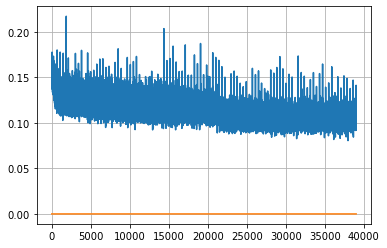

Epoch: 101, iteration 0, loss 0.09993976354598999, cov_diff 0.4277500031876112 cov_diff train 0.4266136626826396
Epoch: 101, iteration 1, loss 0.10540178418159485, cov_diff 0.42543760474999565 cov_diff train 0.4256863721108146
Epoch: 101, iteration 2, loss 0.09835019707679749, cov_diff 0.41827920211768854 cov_diff train 0.4179117091900618
Epoch: 101, iteration 3, loss 0.0992424488067627, cov_diff 0.41574582565370655 cov_diff train 0.41431759916115274
Epoch: 101, iteration 4, loss 0.10094049572944641, cov_diff 0.42121762355840303 cov_diff train 0.42087999118008107
Epoch: 101, iteration 5, loss 0.10359886288642883, cov_diff 0.4181060897836806 cov_diff train 0.4176663665105359
Epoch: 101, iteration 6, loss 0.10566872358322144, cov_diff 0.41867925453574745 cov_diff train 0.4190068211829309
Epoch: 101, iteration 7, loss 0.10546645522117615, cov_diff 0.4156477149691653 cov_diff train 0.4162614665490397
Epoch: 101, iteration 8, loss 0.10619428753852844, cov_diff 0.4314150913905299 cov_diff tr

Epoch: 101, iteration 80, loss 0.09746897220611572, cov_diff 0.42659166232198925 cov_diff train 0.4260848760596413
Epoch: 101, iteration 81, loss 0.10581234097480774, cov_diff 0.4140325823344755 cov_diff train 0.41295203354857407
Epoch: 101, iteration 82, loss 0.10773324966430664, cov_diff 0.4223949292806792 cov_diff train 0.421429958826213
Epoch: 101, iteration 83, loss 0.10512393712997437, cov_diff 0.4244349192338651 cov_diff train 0.4238649687602508
Epoch: 101, iteration 84, loss 0.09333887696266174, cov_diff 0.42327578395070475 cov_diff train 0.4220097478482289
Epoch: 101, iteration 85, loss 0.10262560844421387, cov_diff 0.42915132586448274 cov_diff train 0.4282857443007572
Epoch: 101, iteration 86, loss 0.1072205901145935, cov_diff 0.41635537392392785 cov_diff train 0.4155808177102211
Epoch: 101, iteration 87, loss 0.0967453122138977, cov_diff 0.4271700260064671 cov_diff train 0.42589186106859145
Epoch: 101, iteration 88, loss 0.11208349466323853, cov_diff 0.4208708749658411 cov_d

Epoch: 101, iteration 157, loss 0.10665279626846313, cov_diff 0.3992070880776198 cov_diff train 0.39940728050259006
Epoch: 101, iteration 158, loss 0.10324221849441528, cov_diff 0.41910541646299204 cov_diff train 0.41910933628391356
Epoch: 101, iteration 159, loss 0.10397812724113464, cov_diff 0.4134375454582932 cov_diff train 0.4129690084433484
Epoch: 101, iteration 160, loss 0.101063072681427, cov_diff 0.423368581871979 cov_diff train 0.4228963213433373
Epoch: 101, iteration 161, loss 0.09368231892585754, cov_diff 0.42381975423808826 cov_diff train 0.42336547648798506
Epoch: 101, iteration 162, loss 0.10231298208236694, cov_diff 0.42168889827863887 cov_diff train 0.4207652861616957
Epoch: 101, iteration 163, loss 0.09661751985549927, cov_diff 0.41844158280191657 cov_diff train 0.4185848951147746
Epoch: 101, iteration 164, loss 0.10435155034065247, cov_diff 0.4105652046593718 cov_diff train 0.4102057214080168
Epoch: 101, iteration 165, loss 0.10248583555221558, cov_diff 0.433382404448

Epoch: 101, iteration 229, loss 0.10965317487716675, cov_diff 0.4401016919690568 cov_diff train 0.4400791904570048
Epoch: 101, iteration 230, loss 0.1042959988117218, cov_diff 0.43598943995702927 cov_diff train 0.43554569823851397
Epoch: 101, iteration 231, loss 0.09667718410491943, cov_diff 0.42965126166984136 cov_diff train 0.4290816316941338
Epoch: 101, iteration 232, loss 0.11656045913696289, cov_diff 0.4244002338313198 cov_diff train 0.4232814844913781
Epoch: 101, iteration 233, loss 0.10908675193786621, cov_diff 0.43348175964622926 cov_diff train 0.43263152544546757
Epoch: 101, iteration 234, loss 0.10932302474975586, cov_diff 0.4161883536491525 cov_diff train 0.41478405418795067
Epoch: 101, iteration 235, loss 0.10756182670593262, cov_diff 0.4239014312369652 cov_diff train 0.42279939406606465
Epoch: 101, iteration 236, loss 0.10009723901748657, cov_diff 0.43268109372188057 cov_diff train 0.4316973037448618
Epoch: 101, iteration 237, loss 0.10727992653846741, cov_diff 0.423311470

Epoch: 101, iteration 309, loss 0.11081477999687195, cov_diff 0.4324838586535997 cov_diff train 0.4314805673061848
Epoch: 101, iteration 310, loss 0.09817206859588623, cov_diff 0.4181638845379128 cov_diff train 0.4159387649733077
Epoch: 101, iteration 311, loss 0.11430564522743225, cov_diff 0.42447143764185147 cov_diff train 0.4237424392022005
Epoch: 101, iteration 312, loss 0.10707509517669678, cov_diff 0.42669874591402057 cov_diff train 0.42534656582088093
Epoch: 101, iteration 313, loss 0.09697386622428894, cov_diff 0.41661717701349776 cov_diff train 0.41572869281135255
Epoch: 101, iteration 314, loss 0.09910240769386292, cov_diff 0.42268010879762036 cov_diff train 0.42054523092379087
Epoch: 101, iteration 315, loss 0.09544137120246887, cov_diff 0.41687817550556067 cov_diff train 0.41615566060470527
Epoch: 101, iteration 316, loss 0.11263453960418701, cov_diff 0.4298883596814321 cov_diff train 0.429410617910387
Epoch: 101, iteration 317, loss 0.10418540239334106, cov_diff 0.42965877

Epoch: 101, iteration 387, loss 0.09831219911575317, cov_diff 0.4127614516205636 cov_diff train 0.41255097536466856
Epoch: 101, iteration 388, loss 0.09519454836845398, cov_diff 0.42458507159964715 cov_diff train 0.42366380526512465
Epoch: 101, iteration 389, loss 0.104546457529068, cov_diff 0.4246869862482028 cov_diff train 0.42407600161051573
Epoch: 101, iteration 390, loss 0.16598573327064514, cov_diff 0.4653024204503396 cov_diff train 0.4658273425625908


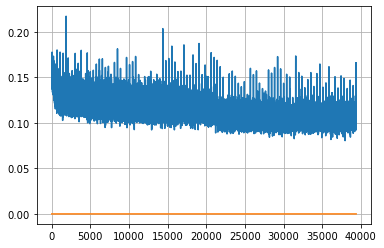

Epoch: 102, iteration 0, loss 0.10575658082962036, cov_diff 0.41783614486631737 cov_diff train 0.4176806889452965
Epoch: 102, iteration 1, loss 0.11484566330909729, cov_diff 0.4213877876316151 cov_diff train 0.42180927626871284
Epoch: 102, iteration 2, loss 0.1052921712398529, cov_diff 0.424202873012296 cov_diff train 0.4239809540475011
Epoch: 102, iteration 3, loss 0.10211619734764099, cov_diff 0.41808375477590654 cov_diff train 0.4183387554702852
Epoch: 102, iteration 4, loss 0.10199633240699768, cov_diff 0.4251669860951104 cov_diff train 0.42415731787761535
Epoch: 102, iteration 5, loss 0.09716513752937317, cov_diff 0.423572882946217 cov_diff train 0.42258499224270496
Epoch: 102, iteration 6, loss 0.11150491237640381, cov_diff 0.42579995824267386 cov_diff train 0.425477669281634
Epoch: 102, iteration 7, loss 0.09853842854499817, cov_diff 0.4194483113262916 cov_diff train 0.41959691300969804
Epoch: 102, iteration 8, loss 0.10471102595329285, cov_diff 0.41935475396315397 cov_diff trai

Epoch: 102, iteration 82, loss 0.10340127348899841, cov_diff 0.41571476324343426 cov_diff train 0.41550910055079243
Epoch: 102, iteration 83, loss 0.10741880536079407, cov_diff 0.4352672226139291 cov_diff train 0.4342530713404478
Epoch: 102, iteration 84, loss 0.08857753872871399, cov_diff 0.41602573884634814 cov_diff train 0.4155559656584527
Epoch: 102, iteration 85, loss 0.10487979650497437, cov_diff 0.42027332163133074 cov_diff train 0.4201441118838384
Epoch: 102, iteration 86, loss 0.10507321357727051, cov_diff 0.4215610376952657 cov_diff train 0.4200118654286282
Epoch: 102, iteration 87, loss 0.10486865043640137, cov_diff 0.4204787457324346 cov_diff train 0.41949481460915405
Epoch: 102, iteration 88, loss 0.10198584198951721, cov_diff 0.4202146911820724 cov_diff train 0.4196068544324062
Epoch: 102, iteration 89, loss 0.09814584255218506, cov_diff 0.41541729938439603 cov_diff train 0.4147136294942263
Epoch: 102, iteration 90, loss 0.09400007128715515, cov_diff 0.41931807435317164 c

Epoch: 102, iteration 158, loss 0.10198512673377991, cov_diff 0.42967100867278096 cov_diff train 0.4292508624909352
Epoch: 102, iteration 159, loss 0.09771180152893066, cov_diff 0.42787396324488347 cov_diff train 0.42721333651767646
Epoch: 102, iteration 160, loss 0.11655956506729126, cov_diff 0.41785086512951014 cov_diff train 0.41808721669785726
Epoch: 102, iteration 161, loss 0.1086859405040741, cov_diff 0.41920787334447024 cov_diff train 0.41938324582126196
Epoch: 102, iteration 162, loss 0.10779359936714172, cov_diff 0.422293306656799 cov_diff train 0.42306543067825353
Epoch: 102, iteration 163, loss 0.09683150053024292, cov_diff 0.41944895809919985 cov_diff train 0.41918458525441665
Epoch: 102, iteration 164, loss 0.10967206954956055, cov_diff 0.4310836493092792 cov_diff train 0.4301266345167536
Epoch: 102, iteration 165, loss 0.118907630443573, cov_diff 0.41297543804616843 cov_diff train 0.4130371638134041
Epoch: 102, iteration 166, loss 0.10039633512496948, cov_diff 0.435890586

Epoch: 102, iteration 233, loss 0.10568684339523315, cov_diff 0.41679359755866124 cov_diff train 0.4161590406880568
Epoch: 102, iteration 234, loss 0.10644125938415527, cov_diff 0.42317001726411924 cov_diff train 0.42205870432432646
Epoch: 102, iteration 235, loss 0.09374639391899109, cov_diff 0.42966157335897764 cov_diff train 0.42866882744611107
Epoch: 102, iteration 236, loss 0.10548892617225647, cov_diff 0.41295142568616194 cov_diff train 0.4123020983611541
Epoch: 102, iteration 237, loss 0.0974653959274292, cov_diff 0.424844007480631 cov_diff train 0.4242932560642521
Epoch: 102, iteration 238, loss 0.11766314506530762, cov_diff 0.4258859234760993 cov_diff train 0.424884945407799
Epoch: 102, iteration 239, loss 0.11009052395820618, cov_diff 0.43998898770963507 cov_diff train 0.4391547118586606
Epoch: 102, iteration 240, loss 0.10018947720527649, cov_diff 0.4256732478397522 cov_diff train 0.42502984214722334
Epoch: 102, iteration 241, loss 0.10717916488647461, cov_diff 0.41790379437

Epoch: 102, iteration 307, loss 0.10693028569221497, cov_diff 0.4138915931295966 cov_diff train 0.41369494182152694
Epoch: 102, iteration 308, loss 0.11584097146987915, cov_diff 0.4160246278060135 cov_diff train 0.4147792041710235
Epoch: 102, iteration 309, loss 0.10370126366615295, cov_diff 0.42894148726256465 cov_diff train 0.4275408067800566
Epoch: 102, iteration 310, loss 0.11768907308578491, cov_diff 0.4301222209897859 cov_diff train 0.4296522311148849
Epoch: 102, iteration 311, loss 0.11669093370437622, cov_diff 0.425746418736127 cov_diff train 0.4249824821605876
Epoch: 102, iteration 312, loss 0.10526004433631897, cov_diff 0.4212164029291116 cov_diff train 0.4207431291908079
Epoch: 102, iteration 313, loss 0.10620445013046265, cov_diff 0.4248667076650518 cov_diff train 0.4241557305020644
Epoch: 102, iteration 314, loss 0.09850344061851501, cov_diff 0.427873347110636 cov_diff train 0.426688314337558
Epoch: 102, iteration 315, loss 0.10957247018814087, cov_diff 0.42193201536699865

Epoch: 102, iteration 384, loss 0.09422886371612549, cov_diff 0.4017139125383765 cov_diff train 0.4009141571122977
Epoch: 102, iteration 385, loss 0.09797391295433044, cov_diff 0.4115507628667425 cov_diff train 0.4101525061233513
Epoch: 102, iteration 386, loss 0.0984729528427124, cov_diff 0.4136450747134178 cov_diff train 0.4134140976548662
Epoch: 102, iteration 387, loss 0.11861082911491394, cov_diff 0.4298905526707075 cov_diff train 0.4302265726950215
Epoch: 102, iteration 388, loss 0.1140165627002716, cov_diff 0.4148687454063632 cov_diff train 0.41408734310290146
Epoch: 102, iteration 389, loss 0.10417386889457703, cov_diff 0.4270509711212632 cov_diff train 0.4266887826876073
Epoch: 102, iteration 390, loss 0.15909138321876526, cov_diff 0.46009017995845053 cov_diff train 0.45911950701595794


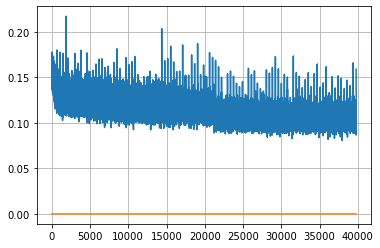

Epoch: 103, iteration 0, loss 0.10205307602882385, cov_diff 0.4276775586356531 cov_diff train 0.4270559595813069
Epoch: 103, iteration 1, loss 0.10917559266090393, cov_diff 0.41460333195703514 cov_diff train 0.4146232478975944
Epoch: 103, iteration 2, loss 0.09825801849365234, cov_diff 0.4230070479797802 cov_diff train 0.4224625762576289
Epoch: 103, iteration 3, loss 0.10011899471282959, cov_diff 0.4230059873215404 cov_diff train 0.42206032847422914
Epoch: 103, iteration 4, loss 0.12279871106147766, cov_diff 0.4183445917261261 cov_diff train 0.41756118948848897
Epoch: 103, iteration 5, loss 0.10673052072525024, cov_diff 0.42804489940159623 cov_diff train 0.4268523302191015
Epoch: 103, iteration 6, loss 0.10522282123565674, cov_diff 0.41020610362469195 cov_diff train 0.4094137607285968
Epoch: 103, iteration 7, loss 0.10878866910934448, cov_diff 0.41304571481381297 cov_diff train 0.4114581638275405
Epoch: 103, iteration 8, loss 0.10714215040206909, cov_diff 0.41111430513596803 cov_diff t

Epoch: 103, iteration 72, loss 0.10400334000587463, cov_diff 0.39321474547400337 cov_diff train 0.3927852553595013
Epoch: 103, iteration 73, loss 0.0981810986995697, cov_diff 0.4333520200286583 cov_diff train 0.4336789194030576
Epoch: 103, iteration 74, loss 0.09471595287322998, cov_diff 0.4325938716975615 cov_diff train 0.43196191899049396
Epoch: 103, iteration 75, loss 0.10248911380767822, cov_diff 0.41556421109443564 cov_diff train 0.41544641066580223
Epoch: 103, iteration 76, loss 0.10180902481079102, cov_diff 0.4278913881390481 cov_diff train 0.4275892384597049
Epoch: 103, iteration 77, loss 0.11325249075889587, cov_diff 0.4204866315870368 cov_diff train 0.41952257158879774
Epoch: 103, iteration 78, loss 0.1031537652015686, cov_diff 0.41188523298358287 cov_diff train 0.4108986606507639
Epoch: 103, iteration 79, loss 0.11498990654945374, cov_diff 0.4190967480953099 cov_diff train 0.4178889339976731
Epoch: 103, iteration 80, loss 0.1073252260684967, cov_diff 0.43275598879165694 cov_

Epoch: 103, iteration 149, loss 0.10690462589263916, cov_diff 0.41339872573881087 cov_diff train 0.41274653818717516
Epoch: 103, iteration 150, loss 0.10109305381774902, cov_diff 0.4140512713383198 cov_diff train 0.4126060970585447
Epoch: 103, iteration 151, loss 0.10512566566467285, cov_diff 0.42234006955197145 cov_diff train 0.4221359994220451
Epoch: 103, iteration 152, loss 0.10771971940994263, cov_diff 0.41217474779755375 cov_diff train 0.4120116636114211
Epoch: 103, iteration 153, loss 0.1173279881477356, cov_diff 0.4284302357745783 cov_diff train 0.4279783465648828
Epoch: 103, iteration 154, loss 0.11269783973693848, cov_diff 0.4121362963125615 cov_diff train 0.4119036543300991
Epoch: 103, iteration 155, loss 0.10295671224594116, cov_diff 0.4081338426744774 cov_diff train 0.4087331922246113
Epoch: 103, iteration 156, loss 0.1138327419757843, cov_diff 0.41353414041522285 cov_diff train 0.41383950259413416
Epoch: 103, iteration 157, loss 0.10545367002487183, cov_diff 0.417736342600

Epoch: 103, iteration 222, loss 0.09784850478172302, cov_diff 0.42380118425137514 cov_diff train 0.4231527719076024
Epoch: 103, iteration 223, loss 0.11395314335823059, cov_diff 0.4122728136361088 cov_diff train 0.411307784880686
Epoch: 103, iteration 224, loss 0.10764917731285095, cov_diff 0.4371004245669825 cov_diff train 0.43663771232339654
Epoch: 103, iteration 225, loss 0.10406354069709778, cov_diff 0.4200415872534159 cov_diff train 0.41925752638203295
Epoch: 103, iteration 226, loss 0.09908491373062134, cov_diff 0.4259586240280287 cov_diff train 0.42609962938115475
Epoch: 103, iteration 227, loss 0.09760811924934387, cov_diff 0.4267863499792944 cov_diff train 0.4262871010123952
Epoch: 103, iteration 228, loss 0.10100099444389343, cov_diff 0.4235127401962798 cov_diff train 0.4230037332375838
Epoch: 103, iteration 229, loss 0.10682004690170288, cov_diff 0.4190901581954827 cov_diff train 0.4180285218657596
Epoch: 103, iteration 230, loss 0.10956007242202759, cov_diff 0.4187434871642

Epoch: 103, iteration 303, loss 0.12065055966377258, cov_diff 0.4133991745764391 cov_diff train 0.41303904445294465
Epoch: 103, iteration 304, loss 0.10229811072349548, cov_diff 0.40338526335372493 cov_diff train 0.40350739281284836
Epoch: 103, iteration 305, loss 0.11007517576217651, cov_diff 0.4186763247661672 cov_diff train 0.41808997380560603
Epoch: 103, iteration 306, loss 0.1117258369922638, cov_diff 0.41320044897726366 cov_diff train 0.4129787132384401
Epoch: 103, iteration 307, loss 0.099953293800354, cov_diff 0.41600464591202374 cov_diff train 0.4162386548217068
Epoch: 103, iteration 308, loss 0.10149747133255005, cov_diff 0.40902710043141305 cov_diff train 0.4092531401560512
Epoch: 103, iteration 309, loss 0.1063413918018341, cov_diff 0.4162665383904718 cov_diff train 0.4161038649448574
Epoch: 103, iteration 310, loss 0.1125483512878418, cov_diff 0.42415765651191734 cov_diff train 0.42422321981736394
Epoch: 103, iteration 311, loss 0.10790762305259705, cov_diff 0.413688076860

Epoch: 103, iteration 378, loss 0.11448752880096436, cov_diff 0.4246384586608781 cov_diff train 0.4244685911789803
Epoch: 103, iteration 379, loss 0.11949673295021057, cov_diff 0.42600055652313895 cov_diff train 0.4251893128001692
Epoch: 103, iteration 380, loss 0.11224138736724854, cov_diff 0.41164648166469503 cov_diff train 0.41135141006348525
Epoch: 103, iteration 381, loss 0.10606491565704346, cov_diff 0.42533892338764245 cov_diff train 0.4242053602166923
Epoch: 103, iteration 382, loss 0.10311874747276306, cov_diff 0.41241319828261935 cov_diff train 0.41216293026246575
Epoch: 103, iteration 383, loss 0.10107526183128357, cov_diff 0.4197002505440938 cov_diff train 0.41968744613525455
Epoch: 103, iteration 384, loss 0.11235705018043518, cov_diff 0.41934846575744916 cov_diff train 0.41895205583129586
Epoch: 103, iteration 385, loss 0.10425278544425964, cov_diff 0.4223607115135315 cov_diff train 0.42243411386798363
Epoch: 103, iteration 386, loss 0.09990793466567993, cov_diff 0.421609

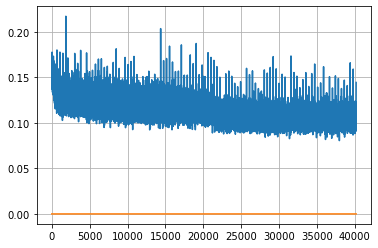

Epoch: 104, iteration 0, loss 0.10916802287101746, cov_diff 0.4275374848062203 cov_diff train 0.4264157811729248
Epoch: 104, iteration 1, loss 0.09778523445129395, cov_diff 0.41790335049631283 cov_diff train 0.4179334382908143
Epoch: 104, iteration 2, loss 0.10705310106277466, cov_diff 0.4129164373486575 cov_diff train 0.4129001909183026
Epoch: 104, iteration 3, loss 0.10523411631584167, cov_diff 0.4249925323983012 cov_diff train 0.4242758830920229
Epoch: 104, iteration 4, loss 0.10983654856681824, cov_diff 0.41520537722235434 cov_diff train 0.4145663596828758
Epoch: 104, iteration 5, loss 0.10709443688392639, cov_diff 0.4323324628910184 cov_diff train 0.43178767166021315
Epoch: 104, iteration 6, loss 0.09998878836631775, cov_diff 0.4203761992749198 cov_diff train 0.41906963348118026
Epoch: 104, iteration 7, loss 0.09411150217056274, cov_diff 0.42373771028082274 cov_diff train 0.42321859152262803
Epoch: 104, iteration 8, loss 0.10339832305908203, cov_diff 0.41433676947519954 cov_diff t

Epoch: 104, iteration 75, loss 0.11335492134094238, cov_diff 0.42844128204004905 cov_diff train 0.428223971886195
Epoch: 104, iteration 76, loss 0.1108940839767456, cov_diff 0.4157872421696143 cov_diff train 0.41533504997012255
Epoch: 104, iteration 77, loss 0.10339829325675964, cov_diff 0.4193274553499312 cov_diff train 0.4191314326384974
Epoch: 104, iteration 78, loss 0.10248449444770813, cov_diff 0.42432477659868323 cov_diff train 0.4228158954236765
Epoch: 104, iteration 79, loss 0.09884580969810486, cov_diff 0.4302728091462878 cov_diff train 0.42866886350498395
Epoch: 104, iteration 80, loss 0.1043846607208252, cov_diff 0.4286857823978531 cov_diff train 0.4279109567419182
Epoch: 104, iteration 81, loss 0.09508603811264038, cov_diff 0.40714658910714907 cov_diff train 0.4063356962523487
Epoch: 104, iteration 82, loss 0.11320671439170837, cov_diff 0.4209013624029049 cov_diff train 0.4207172513575401
Epoch: 104, iteration 83, loss 0.09992110729217529, cov_diff 0.426224934648442 cov_dif

Epoch: 104, iteration 155, loss 0.10665792226791382, cov_diff 0.413019106509228 cov_diff train 0.4119442428780148
Epoch: 104, iteration 156, loss 0.10702493786811829, cov_diff 0.41133376020803736 cov_diff train 0.4105507359072607
Epoch: 104, iteration 157, loss 0.10232189297676086, cov_diff 0.42645746828165837 cov_diff train 0.42580086155173963
Epoch: 104, iteration 158, loss 0.10991835594177246, cov_diff 0.4312399800535905 cov_diff train 0.4305725948622944
Epoch: 104, iteration 159, loss 0.10732659697532654, cov_diff 0.42408825845611486 cov_diff train 0.42303962350617236
Epoch: 104, iteration 160, loss 0.11172103881835938, cov_diff 0.41337635301351144 cov_diff train 0.4126899771884617
Epoch: 104, iteration 161, loss 0.1049482524394989, cov_diff 0.4165581502648419 cov_diff train 0.4157870973013424
Epoch: 104, iteration 162, loss 0.10503831505775452, cov_diff 0.413549974932349 cov_diff train 0.41272132360905833
Epoch: 104, iteration 163, loss 0.1035601794719696, cov_diff 0.4098383089784

Epoch: 104, iteration 235, loss 0.09870457649230957, cov_diff 0.435320934004126 cov_diff train 0.43436380427987586
Epoch: 104, iteration 236, loss 0.10601061582565308, cov_diff 0.4185509211086193 cov_diff train 0.4182153111482792
Epoch: 104, iteration 237, loss 0.10262495279312134, cov_diff 0.3978366052586034 cov_diff train 0.3973223242065496
Epoch: 104, iteration 238, loss 0.1098209023475647, cov_diff 0.42901137317053484 cov_diff train 0.4282329982526892
Epoch: 104, iteration 239, loss 0.10217228531837463, cov_diff 0.42463451332432156 cov_diff train 0.4236715107542305
Epoch: 104, iteration 240, loss 0.1064390242099762, cov_diff 0.4237718181972817 cov_diff train 0.42319204009773514
Epoch: 104, iteration 241, loss 0.09312167763710022, cov_diff 0.429235002356247 cov_diff train 0.4290008766044296
Epoch: 104, iteration 242, loss 0.11161786317825317, cov_diff 0.4135273535258657 cov_diff train 0.41295259618901736
Epoch: 104, iteration 243, loss 0.11274567246437073, cov_diff 0.412192869106518

Epoch: 104, iteration 307, loss 0.10720425844192505, cov_diff 0.4173322628395836 cov_diff train 0.4173068514913974
Epoch: 104, iteration 308, loss 0.09499099850654602, cov_diff 0.4108950753857064 cov_diff train 0.410476963479295
Epoch: 104, iteration 309, loss 0.10498085618019104, cov_diff 0.4172196157249767 cov_diff train 0.41745283301055414
Epoch: 104, iteration 310, loss 0.09923622012138367, cov_diff 0.41403808778236084 cov_diff train 0.41404690004729755
Epoch: 104, iteration 311, loss 0.10970810055732727, cov_diff 0.42818427116001473 cov_diff train 0.4272853053066007
Epoch: 104, iteration 312, loss 0.11440953612327576, cov_diff 0.4328941410549176 cov_diff train 0.4321581447989074
Epoch: 104, iteration 313, loss 0.10887342691421509, cov_diff 0.42484264477425465 cov_diff train 0.42409451898016315
Epoch: 104, iteration 314, loss 0.09992748498916626, cov_diff 0.4194596065692089 cov_diff train 0.41833349519627594
Epoch: 104, iteration 315, loss 0.09986546635627747, cov_diff 0.4182293329

Epoch: 104, iteration 379, loss 0.09495401382446289, cov_diff 0.42140751117335234 cov_diff train 0.421699431189828
Epoch: 104, iteration 380, loss 0.1040181815624237, cov_diff 0.4089126830068643 cov_diff train 0.4082390321316794
Epoch: 104, iteration 381, loss 0.11963152885437012, cov_diff 0.42542843634638244 cov_diff train 0.42477135073195954
Epoch: 104, iteration 382, loss 0.11022195219993591, cov_diff 0.42140274586372867 cov_diff train 0.42076708863331275
Epoch: 104, iteration 383, loss 0.10271641612052917, cov_diff 0.4087442824291574 cov_diff train 0.40825314692799797
Epoch: 104, iteration 384, loss 0.10957339406013489, cov_diff 0.41093875277014447 cov_diff train 0.4107021176874885
Epoch: 104, iteration 385, loss 0.09473702311515808, cov_diff 0.40633819529590987 cov_diff train 0.40661409279384403
Epoch: 104, iteration 386, loss 0.10463279485702515, cov_diff 0.4233283330437883 cov_diff train 0.422297071013725
Epoch: 104, iteration 387, loss 0.10994333028793335, cov_diff 0.4300407411

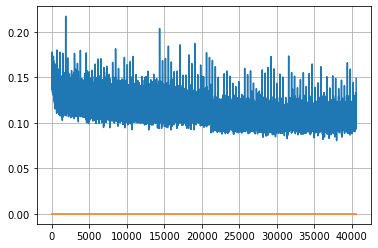

Epoch: 105, iteration 0, loss 0.094821035861969, cov_diff 0.43048586735373234 cov_diff train 0.42943195086201874
Epoch: 105, iteration 1, loss 0.09167584776878357, cov_diff 0.42161482867063566 cov_diff train 0.4210896542799072
Epoch: 105, iteration 2, loss 0.09650489687919617, cov_diff 0.42457256284350886 cov_diff train 0.42475478658652405
Epoch: 105, iteration 3, loss 0.10892781615257263, cov_diff 0.41403218981897544 cov_diff train 0.41342580664413936
Epoch: 105, iteration 4, loss 0.10581403970718384, cov_diff 0.423341066976871 cov_diff train 0.42262752559986905
Epoch: 105, iteration 5, loss 0.12106814980506897, cov_diff 0.4422212055564552 cov_diff train 0.44183467849750474
Epoch: 105, iteration 6, loss 0.10612517595291138, cov_diff 0.40556182157554654 cov_diff train 0.4047293424803453
Epoch: 105, iteration 7, loss 0.10467585921287537, cov_diff 0.430442157576898 cov_diff train 0.42937964858545236
Epoch: 105, iteration 8, loss 0.09771069884300232, cov_diff 0.41613600867869227 cov_diff 

Epoch: 105, iteration 76, loss 0.10834643244743347, cov_diff 0.41522415190897743 cov_diff train 0.4136650917381636
Epoch: 105, iteration 77, loss 0.12102770805358887, cov_diff 0.4117441195885011 cov_diff train 0.41084827458247875
Epoch: 105, iteration 78, loss 0.09970995783805847, cov_diff 0.4140146221341833 cov_diff train 0.41299058778613323
Epoch: 105, iteration 79, loss 0.1106521487236023, cov_diff 0.43464751451561845 cov_diff train 0.4338093114608032
Epoch: 105, iteration 80, loss 0.11558347940444946, cov_diff 0.42800394142659764 cov_diff train 0.4261113897544317
Epoch: 105, iteration 81, loss 0.11186325550079346, cov_diff 0.41891574578540924 cov_diff train 0.41743472111899654
Epoch: 105, iteration 82, loss 0.10021761059761047, cov_diff 0.41296092928150896 cov_diff train 0.4123757316952072
Epoch: 105, iteration 83, loss 0.09959644079208374, cov_diff 0.41739367442044356 cov_diff train 0.41673621225092733
Epoch: 105, iteration 84, loss 0.10921528935432434, cov_diff 0.4206413447974186

Epoch: 105, iteration 153, loss 0.12300792336463928, cov_diff 0.42471311273264234 cov_diff train 0.42444823339104504
Epoch: 105, iteration 154, loss 0.10724744200706482, cov_diff 0.4322157353816082 cov_diff train 0.4324295624922532
Epoch: 105, iteration 155, loss 0.11365920305252075, cov_diff 0.41172706320208735 cov_diff train 0.41202285195889377
Epoch: 105, iteration 156, loss 0.11167082190513611, cov_diff 0.42571379584652114 cov_diff train 0.42592982649660976
Epoch: 105, iteration 157, loss 0.10634374618530273, cov_diff 0.4171542042195968 cov_diff train 0.4173789888325965
Epoch: 105, iteration 158, loss 0.0952674150466919, cov_diff 0.42375707732569284 cov_diff train 0.4233254134864726
Epoch: 105, iteration 159, loss 0.10285574197769165, cov_diff 0.4158696613379568 cov_diff train 0.4158990144105353
Epoch: 105, iteration 160, loss 0.11803573369979858, cov_diff 0.426072887699707 cov_diff train 0.42489320943943687
Epoch: 105, iteration 161, loss 0.10617837309837341, cov_diff 0.4273147517

Epoch: 105, iteration 231, loss 0.10322988033294678, cov_diff 0.41731015703085456 cov_diff train 0.41582963734153333
Epoch: 105, iteration 232, loss 0.10628348588943481, cov_diff 0.41039613500170324 cov_diff train 0.40974559750009726
Epoch: 105, iteration 233, loss 0.1050393283367157, cov_diff 0.41893574763856406 cov_diff train 0.4183717002746721
Epoch: 105, iteration 234, loss 0.09536954760551453, cov_diff 0.4250104197327095 cov_diff train 0.4235493230401622
Epoch: 105, iteration 235, loss 0.10690131783485413, cov_diff 0.40986142852080104 cov_diff train 0.40900742840742754
Epoch: 105, iteration 236, loss 0.09686827659606934, cov_diff 0.42305155873358247 cov_diff train 0.4226767287897969
Epoch: 105, iteration 237, loss 0.1029481589794159, cov_diff 0.4150569846570108 cov_diff train 0.4150690918268337
Epoch: 105, iteration 238, loss 0.11151406168937683, cov_diff 0.4212757569990344 cov_diff train 0.42058776074537557
Epoch: 105, iteration 239, loss 0.0947519838809967, cov_diff 0.4140461299

Epoch: 105, iteration 307, loss 0.0985337495803833, cov_diff 0.4284712874342898 cov_diff train 0.42719053120993883
Epoch: 105, iteration 308, loss 0.09407031536102295, cov_diff 0.4239243083302657 cov_diff train 0.42254314094985673
Epoch: 105, iteration 309, loss 0.11145323514938354, cov_diff 0.42486831056023205 cov_diff train 0.42372299593374024
Epoch: 105, iteration 310, loss 0.10488623380661011, cov_diff 0.4187951683206826 cov_diff train 0.4182242715523592
Epoch: 105, iteration 311, loss 0.10699158906936646, cov_diff 0.4114594632960326 cov_diff train 0.4105820428319578
Epoch: 105, iteration 312, loss 0.10096320509910583, cov_diff 0.4075535848597734 cov_diff train 0.40699010117167095
Epoch: 105, iteration 313, loss 0.09903740882873535, cov_diff 0.4227756695486641 cov_diff train 0.42163342988096586
Epoch: 105, iteration 314, loss 0.10049793124198914, cov_diff 0.4086394013659189 cov_diff train 0.40819888544812194
Epoch: 105, iteration 315, loss 0.09658819437026978, cov_diff 0.4113954437

Epoch: 105, iteration 384, loss 0.10149192810058594, cov_diff 0.4160530500239609 cov_diff train 0.4148513470919624
Epoch: 105, iteration 385, loss 0.1032438576221466, cov_diff 0.41739123731872574 cov_diff train 0.41667620653375836
Epoch: 105, iteration 386, loss 0.10896927118301392, cov_diff 0.4127179887113024 cov_diff train 0.4117397823278606
Epoch: 105, iteration 387, loss 0.09681206941604614, cov_diff 0.42603555011503774 cov_diff train 0.4249780803081846
Epoch: 105, iteration 388, loss 0.09836548566818237, cov_diff 0.4080951154936338 cov_diff train 0.4073997539074393
Epoch: 105, iteration 389, loss 0.10862785577774048, cov_diff 0.42887925987461495 cov_diff train 0.4273690515209342
Epoch: 105, iteration 390, loss 0.16052645444869995, cov_diff 0.46953673692692954 cov_diff train 0.46917708973486144


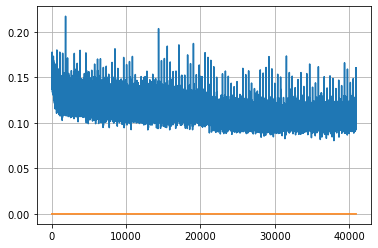

Epoch: 106, iteration 0, loss 0.10609385371208191, cov_diff 0.4227798312177889 cov_diff train 0.4220519224503125
Epoch: 106, iteration 1, loss 0.09601154923439026, cov_diff 0.41249130187711036 cov_diff train 0.41260806732916655
Epoch: 106, iteration 2, loss 0.10441988706588745, cov_diff 0.4229557274405585 cov_diff train 0.4212391722772288
Epoch: 106, iteration 3, loss 0.10328364372253418, cov_diff 0.41129373849023926 cov_diff train 0.41142700897188983
Epoch: 106, iteration 4, loss 0.09187257289886475, cov_diff 0.4065430095616267 cov_diff train 0.40669980193291816
Epoch: 106, iteration 5, loss 0.09852474927902222, cov_diff 0.41169253919508203 cov_diff train 0.4120256312876335
Epoch: 106, iteration 6, loss 0.10942551493644714, cov_diff 0.40591444169866947 cov_diff train 0.40479274301840085
Epoch: 106, iteration 7, loss 0.09655869007110596, cov_diff 0.4085691084528552 cov_diff train 0.408057174611566
Epoch: 106, iteration 8, loss 0.1128968596458435, cov_diff 0.44124738952160714 cov_diff t

Epoch: 106, iteration 77, loss 0.09984248876571655, cov_diff 0.41463996005964066 cov_diff train 0.4142385229589789
Epoch: 106, iteration 78, loss 0.09928667545318604, cov_diff 0.42919725837397343 cov_diff train 0.4282699881185657
Epoch: 106, iteration 79, loss 0.10457912087440491, cov_diff 0.4190947206740005 cov_diff train 0.41860573038072796
Epoch: 106, iteration 80, loss 0.11750215291976929, cov_diff 0.4275070464438466 cov_diff train 0.42719417276321364
Epoch: 106, iteration 81, loss 0.09920358657836914, cov_diff 0.4172736796792436 cov_diff train 0.41679923691979515
Epoch: 106, iteration 82, loss 0.10806500911712646, cov_diff 0.42248491350895284 cov_diff train 0.42141093565502385
Epoch: 106, iteration 83, loss 0.10217615962028503, cov_diff 0.43961708272113686 cov_diff train 0.43908593025064896
Epoch: 106, iteration 84, loss 0.10965931415557861, cov_diff 0.4194854641656844 cov_diff train 0.4187964133670648
Epoch: 106, iteration 85, loss 0.09763595461845398, cov_diff 0.4163346579617851

Epoch: 106, iteration 156, loss 0.10643836855888367, cov_diff 0.4120352304402704 cov_diff train 0.41204948272315306
Epoch: 106, iteration 157, loss 0.10439234972000122, cov_diff 0.4298462734939754 cov_diff train 0.4291557280330195
Epoch: 106, iteration 158, loss 0.10230198502540588, cov_diff 0.4236134095123513 cov_diff train 0.4232241970483295
Epoch: 106, iteration 159, loss 0.10816565155982971, cov_diff 0.4360101448999791 cov_diff train 0.4359482933831537
Epoch: 106, iteration 160, loss 0.10452711582183838, cov_diff 0.4213378447343692 cov_diff train 0.4206369264543208
Epoch: 106, iteration 161, loss 0.11658352613449097, cov_diff 0.424593868879511 cov_diff train 0.42431165135989074
Epoch: 106, iteration 162, loss 0.10929635167121887, cov_diff 0.4189720528781414 cov_diff train 0.41842104129263175
Epoch: 106, iteration 163, loss 0.1023491621017456, cov_diff 0.42798312754410955 cov_diff train 0.42757849341533244
Epoch: 106, iteration 164, loss 0.09463807940483093, cov_diff 0.4217322433335

Epoch: 106, iteration 232, loss 0.11826655268669128, cov_diff 0.4181079246104075 cov_diff train 0.41697246062968946
Epoch: 106, iteration 233, loss 0.10407152771949768, cov_diff 0.4176019121315235 cov_diff train 0.4165017039715935
Epoch: 106, iteration 234, loss 0.10417896509170532, cov_diff 0.414222644500047 cov_diff train 0.4144133376376596
Epoch: 106, iteration 235, loss 0.11321824789047241, cov_diff 0.42214931651762744 cov_diff train 0.4207646377575686
Epoch: 106, iteration 236, loss 0.10698357224464417, cov_diff 0.4288800790842093 cov_diff train 0.4289638813962494
Epoch: 106, iteration 237, loss 0.1128002405166626, cov_diff 0.4116274751025827 cov_diff train 0.4113341742416332
Epoch: 106, iteration 238, loss 0.10163110494613647, cov_diff 0.3996224703458693 cov_diff train 0.3984877832493334
Epoch: 106, iteration 239, loss 0.10831966996192932, cov_diff 0.40839365526582194 cov_diff train 0.40776556568511824
Epoch: 106, iteration 240, loss 0.09653031826019287, cov_diff 0.41817185329113

Epoch: 106, iteration 307, loss 0.10623863339424133, cov_diff 0.41656716455950676 cov_diff train 0.41572272202187954
Epoch: 106, iteration 308, loss 0.0958491861820221, cov_diff 0.41649853152433375 cov_diff train 0.4164138283938215
Epoch: 106, iteration 309, loss 0.10242724418640137, cov_diff 0.4183830087506442 cov_diff train 0.41716732425203307
Epoch: 106, iteration 310, loss 0.1049622893333435, cov_diff 0.4144884364384701 cov_diff train 0.4142560403550607
Epoch: 106, iteration 311, loss 0.10021433234214783, cov_diff 0.42235457628259604 cov_diff train 0.42193796418857027
Epoch: 106, iteration 312, loss 0.10040396451950073, cov_diff 0.41777092430843515 cov_diff train 0.41760388438252594
Epoch: 106, iteration 313, loss 0.09396401047706604, cov_diff 0.4100558825729971 cov_diff train 0.40993743281286743
Epoch: 106, iteration 314, loss 0.09490704536437988, cov_diff 0.42186461546651144 cov_diff train 0.4218860961373245
Epoch: 106, iteration 315, loss 0.11194226145744324, cov_diff 0.41505337

Epoch: 106, iteration 384, loss 0.0977948009967804, cov_diff 0.4228342063321959 cov_diff train 0.4216777612991393
Epoch: 106, iteration 385, loss 0.11170700192451477, cov_diff 0.4223275458883039 cov_diff train 0.42104632465828223
Epoch: 106, iteration 386, loss 0.09768828749656677, cov_diff 0.42252329645124137 cov_diff train 0.42159321278355216
Epoch: 106, iteration 387, loss 0.10713264346122742, cov_diff 0.42121145057098236 cov_diff train 0.4200795075720096
Epoch: 106, iteration 388, loss 0.10466650128364563, cov_diff 0.4250982453665875 cov_diff train 0.4245871648922518
Epoch: 106, iteration 389, loss 0.09287571907043457, cov_diff 0.409898190747334 cov_diff train 0.4089593183758683
Epoch: 106, iteration 390, loss 0.15106618404388428, cov_diff 0.4565049844036436 cov_diff train 0.45580159301938683


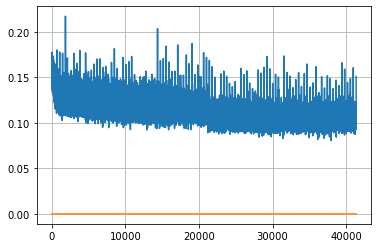

Epoch: 107, iteration 0, loss 0.11615550518035889, cov_diff 0.42101371451262054 cov_diff train 0.4196620410943849
Epoch: 107, iteration 1, loss 0.10262054204940796, cov_diff 0.42732148817556975 cov_diff train 0.42655247990434036
Epoch: 107, iteration 2, loss 0.11631673574447632, cov_diff 0.4208542845514063 cov_diff train 0.4192597211665482
Epoch: 107, iteration 3, loss 0.1053573489189148, cov_diff 0.41333579014837674 cov_diff train 0.4125673458929158
Epoch: 107, iteration 4, loss 0.09842798113822937, cov_diff 0.4068893467977126 cov_diff train 0.4069492902061979
Epoch: 107, iteration 5, loss 0.09930899739265442, cov_diff 0.3958552056417365 cov_diff train 0.39523928868536784
Epoch: 107, iteration 6, loss 0.1043064296245575, cov_diff 0.41633413480410497 cov_diff train 0.41580398547502845
Epoch: 107, iteration 7, loss 0.10759270191192627, cov_diff 0.41759859333807586 cov_diff train 0.41761382874172187
Epoch: 107, iteration 8, loss 0.10085165500640869, cov_diff 0.41196497757008665 cov_diff 

Epoch: 107, iteration 73, loss 0.1042020320892334, cov_diff 0.4142943794318534 cov_diff train 0.41385870306076034
Epoch: 107, iteration 74, loss 0.09573978185653687, cov_diff 0.4286971864121498 cov_diff train 0.4280131250700075
Epoch: 107, iteration 75, loss 0.1104905903339386, cov_diff 0.41527563050339955 cov_diff train 0.41507848877769044
Epoch: 107, iteration 76, loss 0.10650932788848877, cov_diff 0.41979960810530514 cov_diff train 0.4194252893802893
Epoch: 107, iteration 77, loss 0.11261889338493347, cov_diff 0.4145663975617363 cov_diff train 0.41486670321678376
Epoch: 107, iteration 78, loss 0.1083255410194397, cov_diff 0.4185684570852373 cov_diff train 0.4184110853938117
Epoch: 107, iteration 79, loss 0.11073994636535645, cov_diff 0.4270334504574911 cov_diff train 0.4272040076963045
Epoch: 107, iteration 80, loss 0.09308993816375732, cov_diff 0.41767512963103653 cov_diff train 0.4172529464779407
Epoch: 107, iteration 81, loss 0.11585444211959839, cov_diff 0.4297315108474118 cov_d

Epoch: 107, iteration 152, loss 0.11401459574699402, cov_diff 0.4299642442836939 cov_diff train 0.42956991277921364
Epoch: 107, iteration 153, loss 0.11467310786247253, cov_diff 0.42959530561318476 cov_diff train 0.4292810117007673
Epoch: 107, iteration 154, loss 0.10505369305610657, cov_diff 0.42484692815173697 cov_diff train 0.4238469542675689
Epoch: 107, iteration 155, loss 0.11980611085891724, cov_diff 0.44370175815078466 cov_diff train 0.44221319890450145
Epoch: 107, iteration 156, loss 0.10273164510726929, cov_diff 0.4234726886221856 cov_diff train 0.4218828080863138
Epoch: 107, iteration 157, loss 0.10881775617599487, cov_diff 0.4129759420045352 cov_diff train 0.411972570846544
Epoch: 107, iteration 158, loss 0.10932448506355286, cov_diff 0.4247009530640907 cov_diff train 0.42316027766510933
Epoch: 107, iteration 159, loss 0.09387996792793274, cov_diff 0.4212701961304287 cov_diff train 0.42064075853195326
Epoch: 107, iteration 160, loss 0.10458943247795105, cov_diff 0.4196401102

Epoch: 107, iteration 229, loss 0.09787523746490479, cov_diff 0.4298566700725509 cov_diff train 0.42904489583282274
Epoch: 107, iteration 230, loss 0.11433237791061401, cov_diff 0.4176979204974505 cov_diff train 0.4165094760357728
Epoch: 107, iteration 231, loss 0.09360924363136292, cov_diff 0.41870164789717373 cov_diff train 0.41792111715023184
Epoch: 107, iteration 232, loss 0.0992509126663208, cov_diff 0.41938348419756616 cov_diff train 0.41907755528084223
Epoch: 107, iteration 233, loss 0.10838967561721802, cov_diff 0.42368021778678944 cov_diff train 0.4235545966767526
Epoch: 107, iteration 234, loss 0.09963876008987427, cov_diff 0.4133235082841278 cov_diff train 0.41302740075405536
Epoch: 107, iteration 235, loss 0.0946958065032959, cov_diff 0.4046387667572096 cov_diff train 0.4043729137310957
Epoch: 107, iteration 236, loss 0.09721779823303223, cov_diff 0.42432782999512053 cov_diff train 0.42381292276382637
Epoch: 107, iteration 237, loss 0.10813146829605103, cov_diff 0.417875872

Epoch: 107, iteration 308, loss 0.1141512393951416, cov_diff 0.4267260681597753 cov_diff train 0.4268548973779937
Epoch: 107, iteration 309, loss 0.099825918674469, cov_diff 0.42125966274455995 cov_diff train 0.42056280825063397
Epoch: 107, iteration 310, loss 0.1060921847820282, cov_diff 0.4148717239310307 cov_diff train 0.4135705316572452
Epoch: 107, iteration 311, loss 0.09873098134994507, cov_diff 0.4332447410105288 cov_diff train 0.4309853669066684
Epoch: 107, iteration 312, loss 0.11372381448745728, cov_diff 0.3928486998618382 cov_diff train 0.39233564500231016
Epoch: 107, iteration 313, loss 0.09961026906967163, cov_diff 0.4137338603514892 cov_diff train 0.41314537721360667
Epoch: 107, iteration 314, loss 0.0942414402961731, cov_diff 0.41215832941933805 cov_diff train 0.4110637000545116
Epoch: 107, iteration 315, loss 0.11787927150726318, cov_diff 0.4145306509652111 cov_diff train 0.41323518026644
Epoch: 107, iteration 316, loss 0.09859704971313477, cov_diff 0.41403338604189527 

Epoch: 107, iteration 385, loss 0.1114853024482727, cov_diff 0.4159340972933309 cov_diff train 0.4144831166009125
Epoch: 107, iteration 386, loss 0.10091990232467651, cov_diff 0.4157001209168344 cov_diff train 0.41529677086842653
Epoch: 107, iteration 387, loss 0.10363918542861938, cov_diff 0.41957393726199155 cov_diff train 0.4192374752361781
Epoch: 107, iteration 388, loss 0.09897592663764954, cov_diff 0.4056536034921404 cov_diff train 0.4056274402630448
Epoch: 107, iteration 389, loss 0.09615835547447205, cov_diff 0.410037854798732 cov_diff train 0.40970223674236805
Epoch: 107, iteration 390, loss 0.14761635661125183, cov_diff 0.4440303340619148 cov_diff train 0.44319504618064887


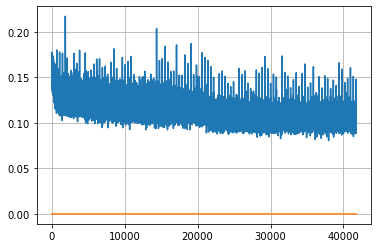

Epoch: 108, iteration 0, loss 0.10629066824913025, cov_diff 0.4178980066278104 cov_diff train 0.41773411711868713
Epoch: 108, iteration 1, loss 0.09891277551651001, cov_diff 0.40804522509508373 cov_diff train 0.40812984027996047
Epoch: 108, iteration 2, loss 0.10391727089881897, cov_diff 0.4212059207978691 cov_diff train 0.4206212721336795
Epoch: 108, iteration 3, loss 0.10312020778656006, cov_diff 0.425503132971028 cov_diff train 0.4249083584183041
Epoch: 108, iteration 4, loss 0.10220634937286377, cov_diff 0.4140201224652977 cov_diff train 0.4136336277508715
Epoch: 108, iteration 5, loss 0.09208330512046814, cov_diff 0.4169355445945014 cov_diff train 0.41667289840544386
Epoch: 108, iteration 6, loss 0.10625943541526794, cov_diff 0.42582832294958256 cov_diff train 0.42553287010430013
Epoch: 108, iteration 7, loss 0.10164585709571838, cov_diff 0.42045640612731844 cov_diff train 0.41965677736991913
Epoch: 108, iteration 8, loss 0.09990835189819336, cov_diff 0.4216070348710209 cov_diff t

Epoch: 108, iteration 78, loss 0.11595693230628967, cov_diff 0.41130087465006376 cov_diff train 0.40991665876276745
Epoch: 108, iteration 79, loss 0.10743322968482971, cov_diff 0.417647040015435 cov_diff train 0.4170034078116565
Epoch: 108, iteration 80, loss 0.10849639773368835, cov_diff 0.4231438944262933 cov_diff train 0.42288950881319376
Epoch: 108, iteration 81, loss 0.10400477051734924, cov_diff 0.41550629037393233 cov_diff train 0.41496141225267774
Epoch: 108, iteration 82, loss 0.10374128818511963, cov_diff 0.42702510171311486 cov_diff train 0.425974400012613
Epoch: 108, iteration 83, loss 0.11501932144165039, cov_diff 0.4291544726328266 cov_diff train 0.42740794738852167
Epoch: 108, iteration 84, loss 0.11107248067855835, cov_diff 0.4215635640381449 cov_diff train 0.4216242648669719
Epoch: 108, iteration 85, loss 0.11568766832351685, cov_diff 0.4095434486314466 cov_diff train 0.4084840861942036
Epoch: 108, iteration 86, loss 0.101189523935318, cov_diff 0.41582598844569735 cov_

Epoch: 108, iteration 153, loss 0.10872489213943481, cov_diff 0.41187367985084916 cov_diff train 0.41158236191523007
Epoch: 108, iteration 154, loss 0.10644760727882385, cov_diff 0.4225488774802393 cov_diff train 0.42196865095434927
Epoch: 108, iteration 155, loss 0.10011240839958191, cov_diff 0.4168750985609484 cov_diff train 0.4161873891562851
Epoch: 108, iteration 156, loss 0.10022348165512085, cov_diff 0.4155584824584765 cov_diff train 0.41447434633680613
Epoch: 108, iteration 157, loss 0.08768534660339355, cov_diff 0.4152220747741009 cov_diff train 0.4148094149516913
Epoch: 108, iteration 158, loss 0.11694186925888062, cov_diff 0.41779886750673667 cov_diff train 0.41712303068281875
Epoch: 108, iteration 159, loss 0.10571369528770447, cov_diff 0.4131594461537855 cov_diff train 0.41249718789477063
Epoch: 108, iteration 160, loss 0.11202368140220642, cov_diff 0.41653243852007094 cov_diff train 0.4169438921424175
Epoch: 108, iteration 161, loss 0.09887033700942993, cov_diff 0.40870923

Epoch: 108, iteration 229, loss 0.11664265394210815, cov_diff 0.42254918346980647 cov_diff train 0.42245925930339173
Epoch: 108, iteration 230, loss 0.09324869513511658, cov_diff 0.4242658225590086 cov_diff train 0.4237576076421805
Epoch: 108, iteration 231, loss 0.09922665357589722, cov_diff 0.4347884134150137 cov_diff train 0.4342131574652688
Epoch: 108, iteration 232, loss 0.11000791192054749, cov_diff 0.42736542753955215 cov_diff train 0.42727805178393813
Epoch: 108, iteration 233, loss 0.10803341865539551, cov_diff 0.4239331193089579 cov_diff train 0.42378744244922345
Epoch: 108, iteration 234, loss 0.10320994257926941, cov_diff 0.4235933089930971 cov_diff train 0.4231886694435141
Epoch: 108, iteration 235, loss 0.10088738799095154, cov_diff 0.41583287651636774 cov_diff train 0.4152184246868888
Epoch: 108, iteration 236, loss 0.10253530740737915, cov_diff 0.42629011229843955 cov_diff train 0.42561201824681244
Epoch: 108, iteration 237, loss 0.09947091341018677, cov_diff 0.42337319

Epoch: 108, iteration 301, loss 0.10411614179611206, cov_diff 0.42390737265144157 cov_diff train 0.4233257135291617
Epoch: 108, iteration 302, loss 0.09075435996055603, cov_diff 0.4171019230201181 cov_diff train 0.41656091205663404
Epoch: 108, iteration 303, loss 0.10048869252204895, cov_diff 0.42793209331610893 cov_diff train 0.42725879479862683
Epoch: 108, iteration 304, loss 0.10175597667694092, cov_diff 0.4195629758192983 cov_diff train 0.4185592603143586
Epoch: 108, iteration 305, loss 0.09732833504676819, cov_diff 0.4256864461648989 cov_diff train 0.4248299894593336
Epoch: 108, iteration 306, loss 0.10872149467468262, cov_diff 0.4181367612368653 cov_diff train 0.41742339472096446
Epoch: 108, iteration 307, loss 0.11078605055809021, cov_diff 0.4136183212943633 cov_diff train 0.413523776240221
Epoch: 108, iteration 308, loss 0.09328871965408325, cov_diff 0.42038290548700746 cov_diff train 0.4200376865380252
Epoch: 108, iteration 309, loss 0.11064833402633667, cov_diff 0.42206178434

Epoch: 108, iteration 378, loss 0.1180320680141449, cov_diff 0.4254018897291415 cov_diff train 0.4257851615938164
Epoch: 108, iteration 379, loss 0.10796791315078735, cov_diff 0.4152893169622547 cov_diff train 0.4151959644937262
Epoch: 108, iteration 380, loss 0.10901147127151489, cov_diff 0.4115460474396078 cov_diff train 0.4110817459155457
Epoch: 108, iteration 381, loss 0.12196516990661621, cov_diff 0.41864266117862226 cov_diff train 0.418973713504223
Epoch: 108, iteration 382, loss 0.10005980730056763, cov_diff 0.43037403196225116 cov_diff train 0.43069196950052374
Epoch: 108, iteration 383, loss 0.09886044263839722, cov_diff 0.4356284048052475 cov_diff train 0.43587291227809727
Epoch: 108, iteration 384, loss 0.10332483053207397, cov_diff 0.43549591941797383 cov_diff train 0.43538474330971494
Epoch: 108, iteration 385, loss 0.10577288269996643, cov_diff 0.4285740280133201 cov_diff train 0.4285375683340614
Epoch: 108, iteration 386, loss 0.11431050300598145, cov_diff 0.418204615768

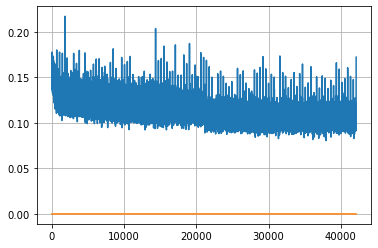

Epoch: 109, iteration 0, loss 0.1072310209274292, cov_diff 0.42452378435119625 cov_diff train 0.42380194534519
Epoch: 109, iteration 1, loss 0.10173743963241577, cov_diff 0.41808363886964706 cov_diff train 0.41701517054951
Epoch: 109, iteration 2, loss 0.11566999554634094, cov_diff 0.4155062459860009 cov_diff train 0.4144497958300316
Epoch: 109, iteration 3, loss 0.10261622071266174, cov_diff 0.4263471672516109 cov_diff train 0.4259457230564698
Epoch: 109, iteration 4, loss 0.10448768734931946, cov_diff 0.41895891111713846 cov_diff train 0.41726427094508134
Epoch: 109, iteration 5, loss 0.10909315943717957, cov_diff 0.4321912260376247 cov_diff train 0.43185283442222167
Epoch: 109, iteration 6, loss 0.0964357852935791, cov_diff 0.4200918818822774 cov_diff train 0.4201930444681506
Epoch: 109, iteration 7, loss 0.1010482907295227, cov_diff 0.4150371725237115 cov_diff train 0.41417856160100514
Epoch: 109, iteration 8, loss 0.12193718552589417, cov_diff 0.43256047150334814 cov_diff train 0.

Epoch: 109, iteration 75, loss 0.10750237107276917, cov_diff 0.41531655255085026 cov_diff train 0.4144743994452123
Epoch: 109, iteration 76, loss 0.09832316637039185, cov_diff 0.421753101234804 cov_diff train 0.42202899980243713
Epoch: 109, iteration 77, loss 0.10910296440124512, cov_diff 0.42720750472193986 cov_diff train 0.4263514788344357
Epoch: 109, iteration 78, loss 0.1071217954158783, cov_diff 0.4231294630675309 cov_diff train 0.42262341738309794
Epoch: 109, iteration 79, loss 0.10930541157722473, cov_diff 0.42816663212518014 cov_diff train 0.42688850208785034
Epoch: 109, iteration 80, loss 0.11251175403594971, cov_diff 0.4224884261565042 cov_diff train 0.42158416111312685
Epoch: 109, iteration 81, loss 0.10218256711959839, cov_diff 0.4193226745072279 cov_diff train 0.41869420219263037
Epoch: 109, iteration 82, loss 0.10072118043899536, cov_diff 0.4117239601523572 cov_diff train 0.41109334170996603
Epoch: 109, iteration 83, loss 0.11268705129623413, cov_diff 0.42427449549761204 

Epoch: 109, iteration 151, loss 0.1056625247001648, cov_diff 0.4267985615102099 cov_diff train 0.42623070629951954
Epoch: 109, iteration 152, loss 0.10362181067466736, cov_diff 0.4075996293103906 cov_diff train 0.40702540949524585
Epoch: 109, iteration 153, loss 0.09984922409057617, cov_diff 0.4281862613221716 cov_diff train 0.4278108114198593
Epoch: 109, iteration 154, loss 0.11038434505462646, cov_diff 0.42502579115729205 cov_diff train 0.42455153154071856
Epoch: 109, iteration 155, loss 0.11501297354698181, cov_diff 0.42076389657247 cov_diff train 0.4203426028564997
Epoch: 109, iteration 156, loss 0.10814288258552551, cov_diff 0.4180862047183863 cov_diff train 0.41756874628902113
Epoch: 109, iteration 157, loss 0.1028452217578888, cov_diff 0.41996177931641154 cov_diff train 0.4191895664213806
Epoch: 109, iteration 158, loss 0.09670138359069824, cov_diff 0.4308112453644249 cov_diff train 0.4297455144317762
Epoch: 109, iteration 159, loss 0.10330110788345337, cov_diff 0.42266264423750

Epoch: 109, iteration 222, loss 0.09680759906768799, cov_diff 0.43421331292548604 cov_diff train 0.4331472675356788
Epoch: 109, iteration 223, loss 0.10554131865501404, cov_diff 0.4291886689574352 cov_diff train 0.4286360066824632
Epoch: 109, iteration 224, loss 0.11158663034439087, cov_diff 0.41103083709509247 cov_diff train 0.4109362101339836
Epoch: 109, iteration 225, loss 0.09212076663970947, cov_diff 0.40724026541755665 cov_diff train 0.4069765432118214
Epoch: 109, iteration 226, loss 0.10005804896354675, cov_diff 0.40498010517623634 cov_diff train 0.404853593081416
Epoch: 109, iteration 227, loss 0.10967555642127991, cov_diff 0.41381604080233736 cov_diff train 0.41300567802488986
Epoch: 109, iteration 228, loss 0.10010704398155212, cov_diff 0.4065961909226585 cov_diff train 0.4055627922369056
Epoch: 109, iteration 229, loss 0.09436526894569397, cov_diff 0.4149064025084863 cov_diff train 0.41378145805685895
Epoch: 109, iteration 230, loss 0.10737243294715881, cov_diff 0.4081115868

Epoch: 109, iteration 293, loss 0.09354716539382935, cov_diff 0.410861638387388 cov_diff train 0.410108970706763
Epoch: 109, iteration 294, loss 0.11376222968101501, cov_diff 0.4109158785904968 cov_diff train 0.41016577885348504
Epoch: 109, iteration 295, loss 0.09726697206497192, cov_diff 0.41374111054894136 cov_diff train 0.4132458334206772
Epoch: 109, iteration 296, loss 0.09152156114578247, cov_diff 0.4052935342339492 cov_diff train 0.4043074521082431
Epoch: 109, iteration 297, loss 0.09232115745544434, cov_diff 0.42106215191239466 cov_diff train 0.42047497714130866
Epoch: 109, iteration 298, loss 0.10394501686096191, cov_diff 0.42307259183020535 cov_diff train 0.42220754080640643
Epoch: 109, iteration 299, loss 0.0969814658164978, cov_diff 0.4180993677225752 cov_diff train 0.41805173277743135
Epoch: 109, iteration 300, loss 0.10601630806922913, cov_diff 0.413894586439224 cov_diff train 0.41386187668474184
Epoch: 109, iteration 301, loss 0.10883975028991699, cov_diff 0.428981865807

Epoch: 109, iteration 369, loss 0.1028052270412445, cov_diff 0.4225156605221003 cov_diff train 0.4217154096520374
Epoch: 109, iteration 370, loss 0.10504573583602905, cov_diff 0.4193448956689071 cov_diff train 0.4189283896984588
Epoch: 109, iteration 371, loss 0.10267868638038635, cov_diff 0.40664239553634224 cov_diff train 0.40656690258224826
Epoch: 109, iteration 372, loss 0.10707855224609375, cov_diff 0.4166832473860987 cov_diff train 0.4157095558251825
Epoch: 109, iteration 373, loss 0.10351043939590454, cov_diff 0.41300188216732037 cov_diff train 0.4121923260851271
Epoch: 109, iteration 374, loss 0.09453275799751282, cov_diff 0.415513179942318 cov_diff train 0.4153137189051891
Epoch: 109, iteration 375, loss 0.10476741194725037, cov_diff 0.4103165465982487 cov_diff train 0.4095413938188364
Epoch: 109, iteration 376, loss 0.10381808876991272, cov_diff 0.42169901340877985 cov_diff train 0.42083895177489505
Epoch: 109, iteration 377, loss 0.096442312002182, cov_diff 0.419721443618039

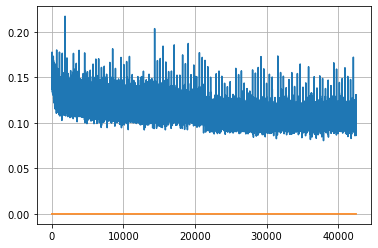

Epoch: 110, iteration 0, loss 0.11152032017707825, cov_diff 0.4195340873558164 cov_diff train 0.4190232152878409
Epoch: 110, iteration 1, loss 0.09866294264793396, cov_diff 0.41745985252861106 cov_diff train 0.41727308115000855
Epoch: 110, iteration 2, loss 0.11173886060714722, cov_diff 0.4162000814631059 cov_diff train 0.41569286900057906
Epoch: 110, iteration 3, loss 0.10028666257858276, cov_diff 0.427091178589288 cov_diff train 0.4260575055273596
Epoch: 110, iteration 4, loss 0.11695730686187744, cov_diff 0.4158597600168012 cov_diff train 0.41549693260282056
Epoch: 110, iteration 5, loss 0.10643014311790466, cov_diff 0.41885464728121713 cov_diff train 0.41837091010742056
Epoch: 110, iteration 6, loss 0.10842761397361755, cov_diff 0.4267088093836751 cov_diff train 0.42678179749762435
Epoch: 110, iteration 7, loss 0.1034146249294281, cov_diff 0.40855834222424 cov_diff train 0.4084605899808891
Epoch: 110, iteration 8, loss 0.10925319790840149, cov_diff 0.4294839616996437 cov_diff train

Epoch: 110, iteration 74, loss 0.09582096338272095, cov_diff 0.41834895611979717 cov_diff train 0.41824203025166656
Epoch: 110, iteration 75, loss 0.10113516449928284, cov_diff 0.4163863081101741 cov_diff train 0.41661341640034055
Epoch: 110, iteration 76, loss 0.09945178031921387, cov_diff 0.4110658988399441 cov_diff train 0.41102500546676374
Epoch: 110, iteration 77, loss 0.09627056121826172, cov_diff 0.4082114347638874 cov_diff train 0.40752979141237955
Epoch: 110, iteration 78, loss 0.09605222940444946, cov_diff 0.4096522336512895 cov_diff train 0.4100159827192655
Epoch: 110, iteration 79, loss 0.09560483694076538, cov_diff 0.42334605355265315 cov_diff train 0.42316502277788837
Epoch: 110, iteration 80, loss 0.10976719856262207, cov_diff 0.4313250880770973 cov_diff train 0.4315184534149404
Epoch: 110, iteration 81, loss 0.10074174404144287, cov_diff 0.4481625901266442 cov_diff train 0.44703028209351564
Epoch: 110, iteration 82, loss 0.10864800214767456, cov_diff 0.4227192257909271 

Epoch: 110, iteration 149, loss 0.10865497589111328, cov_diff 0.42863549961328656 cov_diff train 0.4277602708509931
Epoch: 110, iteration 150, loss 0.10605227947235107, cov_diff 0.4105095682866127 cov_diff train 0.4092540715558075
Epoch: 110, iteration 151, loss 0.09621897339820862, cov_diff 0.41311252678536203 cov_diff train 0.41227022170533467
Epoch: 110, iteration 152, loss 0.10510677099227905, cov_diff 0.44582415749591986 cov_diff train 0.44459036926512835
Epoch: 110, iteration 153, loss 0.09221497178077698, cov_diff 0.4257523523284908 cov_diff train 0.4240510223606175
Epoch: 110, iteration 154, loss 0.10420620441436768, cov_diff 0.43666855272662264 cov_diff train 0.43553773149060904
Epoch: 110, iteration 155, loss 0.10489064455032349, cov_diff 0.41958081857801294 cov_diff train 0.41798841424019856
Epoch: 110, iteration 156, loss 0.10732525587081909, cov_diff 0.41663863366268694 cov_diff train 0.4155693881935956
Epoch: 110, iteration 157, loss 0.09711295366287231, cov_diff 0.428540

Epoch: 110, iteration 225, loss 0.10550028085708618, cov_diff 0.42900338527480897 cov_diff train 0.427601392950779
Epoch: 110, iteration 226, loss 0.09361490607261658, cov_diff 0.42066823955527116 cov_diff train 0.41969066530389626
Epoch: 110, iteration 227, loss 0.1005348265171051, cov_diff 0.4270219804737536 cov_diff train 0.4260546525992317
Epoch: 110, iteration 228, loss 0.10517895221710205, cov_diff 0.4250863316534776 cov_diff train 0.42435343965468236
Epoch: 110, iteration 229, loss 0.0975138247013092, cov_diff 0.4267212163757546 cov_diff train 0.42580061879840764
Epoch: 110, iteration 230, loss 0.1077166497707367, cov_diff 0.41869908774433173 cov_diff train 0.4177144723256799
Epoch: 110, iteration 231, loss 0.11202588677406311, cov_diff 0.4050571008879141 cov_diff train 0.40434153373198267
Epoch: 110, iteration 232, loss 0.12164226174354553, cov_diff 0.4283955220671858 cov_diff train 0.42745433913875897
Epoch: 110, iteration 233, loss 0.11093997955322266, cov_diff 0.417952366360

Epoch: 110, iteration 300, loss 0.10362735390663147, cov_diff 0.4138621285260387 cov_diff train 0.4125258853891909
Epoch: 110, iteration 301, loss 0.08970701694488525, cov_diff 0.41671350125699375 cov_diff train 0.4170713438652545
Epoch: 110, iteration 302, loss 0.10216376185417175, cov_diff 0.42177171704225347 cov_diff train 0.421375412537379
Epoch: 110, iteration 303, loss 0.11025401949882507, cov_diff 0.4257108767276377 cov_diff train 0.42498413102841526
Epoch: 110, iteration 304, loss 0.10298073291778564, cov_diff 0.41520752415801065 cov_diff train 0.4144727629691008
Epoch: 110, iteration 305, loss 0.10005801916122437, cov_diff 0.42103209874140457 cov_diff train 0.4207783975544127
Epoch: 110, iteration 306, loss 0.09277781844139099, cov_diff 0.4141708617018657 cov_diff train 0.4140310148326764
Epoch: 110, iteration 307, loss 0.10044300556182861, cov_diff 0.4272614050671457 cov_diff train 0.42707476686902557
Epoch: 110, iteration 308, loss 0.10204243659973145, cov_diff 0.41941892512

Epoch: 110, iteration 379, loss 0.10677874088287354, cov_diff 0.41777355510700837 cov_diff train 0.41609853720192885
Epoch: 110, iteration 380, loss 0.09368520975112915, cov_diff 0.42982860971392994 cov_diff train 0.42888578668684296
Epoch: 110, iteration 381, loss 0.10787340998649597, cov_diff 0.4211180724710481 cov_diff train 0.4202943728467362
Epoch: 110, iteration 382, loss 0.10992375016212463, cov_diff 0.410750192753311 cov_diff train 0.4104259244465035
Epoch: 110, iteration 383, loss 0.1125444769859314, cov_diff 0.4115810431785301 cov_diff train 0.41100520903350174
Epoch: 110, iteration 384, loss 0.1038578450679779, cov_diff 0.41758884068763585 cov_diff train 0.41678045642590733
Epoch: 110, iteration 385, loss 0.10028526186943054, cov_diff 0.41896370195849775 cov_diff train 0.4176492741318737
Epoch: 110, iteration 386, loss 0.10255110263824463, cov_diff 0.41337979224677074 cov_diff train 0.4127075519547731
Epoch: 110, iteration 387, loss 0.0939810574054718, cov_diff 0.43052711359

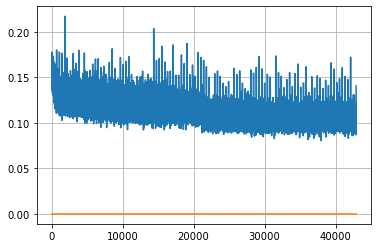

Epoch: 111, iteration 0, loss 0.09873887896537781, cov_diff 0.4092712839203456 cov_diff train 0.4092123607403734
Epoch: 111, iteration 1, loss 0.1224018931388855, cov_diff 0.42596900815559186 cov_diff train 0.42511173345339204
Epoch: 111, iteration 2, loss 0.09401622414588928, cov_diff 0.40474416420532827 cov_diff train 0.404458058316568
Epoch: 111, iteration 3, loss 0.10823774337768555, cov_diff 0.42425206778493246 cov_diff train 0.4238783996205831
Epoch: 111, iteration 4, loss 0.09536182880401611, cov_diff 0.412145992651983 cov_diff train 0.41168228627831605
Epoch: 111, iteration 5, loss 0.09306198358535767, cov_diff 0.42118843561803637 cov_diff train 0.42018925073997193
Epoch: 111, iteration 6, loss 0.0977659821510315, cov_diff 0.41553285016080127 cov_diff train 0.41460347525785235
Epoch: 111, iteration 7, loss 0.09507843852043152, cov_diff 0.403873923216632 cov_diff train 0.4040085867871681
Epoch: 111, iteration 8, loss 0.10391709208488464, cov_diff 0.426955301146784 cov_diff train

Epoch: 111, iteration 76, loss 0.10662102699279785, cov_diff 0.4066522717978385 cov_diff train 0.4056832336562181
Epoch: 111, iteration 77, loss 0.10638496279716492, cov_diff 0.4310385698147924 cov_diff train 0.4302119536196121
Epoch: 111, iteration 78, loss 0.10753116011619568, cov_diff 0.4200589074076642 cov_diff train 0.41983448734159057
Epoch: 111, iteration 79, loss 0.11503550410270691, cov_diff 0.4100503326899807 cov_diff train 0.40932998342885574
Epoch: 111, iteration 80, loss 0.10691565275192261, cov_diff 0.4226914199629657 cov_diff train 0.4222711119699448
Epoch: 111, iteration 81, loss 0.09687918424606323, cov_diff 0.4321390036492077 cov_diff train 0.43112990271396723
Epoch: 111, iteration 82, loss 0.11731269955635071, cov_diff 0.41779174658885565 cov_diff train 0.41707528117496057
Epoch: 111, iteration 83, loss 0.10074970126152039, cov_diff 0.4334013953597483 cov_diff train 0.4331990842916429
Epoch: 111, iteration 84, loss 0.10415667295455933, cov_diff 0.41886847096857105 co

Epoch: 111, iteration 149, loss 0.11122232675552368, cov_diff 0.41357438041884853 cov_diff train 0.4120641104713707
Epoch: 111, iteration 150, loss 0.09786462783813477, cov_diff 0.4019237211671382 cov_diff train 0.40222491829768825
Epoch: 111, iteration 151, loss 0.09732532501220703, cov_diff 0.4102562329695596 cov_diff train 0.410190351285165
Epoch: 111, iteration 152, loss 0.10991525650024414, cov_diff 0.4263159252435264 cov_diff train 0.4252475060195771
Epoch: 111, iteration 153, loss 0.10077199339866638, cov_diff 0.4169613648160278 cov_diff train 0.4170476210532914
Epoch: 111, iteration 154, loss 0.11356756091117859, cov_diff 0.43341399287714183 cov_diff train 0.4325752476414797
Epoch: 111, iteration 155, loss 0.09793072938919067, cov_diff 0.42462148288984264 cov_diff train 0.4243950673768372
Epoch: 111, iteration 156, loss 0.10007917881011963, cov_diff 0.4236416982554083 cov_diff train 0.42327814778375983
Epoch: 111, iteration 157, loss 0.10570329427719116, cov_diff 0.410155498798

Epoch: 111, iteration 221, loss 0.10371771454811096, cov_diff 0.41589258305195226 cov_diff train 0.41509080051759434
Epoch: 111, iteration 222, loss 0.10316401720046997, cov_diff 0.42481359513004874 cov_diff train 0.4239458214369379
Epoch: 111, iteration 223, loss 0.10216036438941956, cov_diff 0.41947924252305063 cov_diff train 0.4188436780266891
Epoch: 111, iteration 224, loss 0.09430462121963501, cov_diff 0.4172659739463197 cov_diff train 0.41635902294407134
Epoch: 111, iteration 225, loss 0.11799755692481995, cov_diff 0.420833795324558 cov_diff train 0.41930157309689625
Epoch: 111, iteration 226, loss 0.09843888878822327, cov_diff 0.41500850637713066 cov_diff train 0.41341235729901604
Epoch: 111, iteration 227, loss 0.10295215249061584, cov_diff 0.41119678713760516 cov_diff train 0.41051072304961356
Epoch: 111, iteration 228, loss 0.09592539072036743, cov_diff 0.40955912353134083 cov_diff train 0.40909825828687224
Epoch: 111, iteration 229, loss 0.10983836650848389, cov_diff 0.40802

Epoch: 111, iteration 292, loss 0.10663977265357971, cov_diff 0.4071137785960051 cov_diff train 0.4079121335769095
Epoch: 111, iteration 293, loss 0.11145037412643433, cov_diff 0.4063263731963816 cov_diff train 0.4053630828022702
Epoch: 111, iteration 294, loss 0.11072605848312378, cov_diff 0.4091232037140839 cov_diff train 0.408495484941357
Epoch: 111, iteration 295, loss 0.1010056734085083, cov_diff 0.40845361240595107 cov_diff train 0.4078352007329194
Epoch: 111, iteration 296, loss 0.10273998975753784, cov_diff 0.41201404597701696 cov_diff train 0.4108327226457873
Epoch: 111, iteration 297, loss 0.0970013439655304, cov_diff 0.4257227103579261 cov_diff train 0.4246408634251809
Epoch: 111, iteration 298, loss 0.11542379856109619, cov_diff 0.4153451421128605 cov_diff train 0.41474768107689525
Epoch: 111, iteration 299, loss 0.11853811144828796, cov_diff 0.41024117306309604 cov_diff train 0.40949265022307907
Epoch: 111, iteration 300, loss 0.10226508975028992, cov_diff 0.41229836140430

Epoch: 111, iteration 364, loss 0.10057148337364197, cov_diff 0.41170454796535494 cov_diff train 0.4107129284289366
Epoch: 111, iteration 365, loss 0.09868472814559937, cov_diff 0.416039740321082 cov_diff train 0.4159170299772341
Epoch: 111, iteration 366, loss 0.11482885479927063, cov_diff 0.4152999620374888 cov_diff train 0.41448864171759225
Epoch: 111, iteration 367, loss 0.10981011390686035, cov_diff 0.4153311039566558 cov_diff train 0.41395632426025325
Epoch: 111, iteration 368, loss 0.11427703499794006, cov_diff 0.4348106923105265 cov_diff train 0.43381050846620367
Epoch: 111, iteration 369, loss 0.10668313503265381, cov_diff 0.422365098976157 cov_diff train 0.42191064841981357
Epoch: 111, iteration 370, loss 0.09913912415504456, cov_diff 0.41118455619519517 cov_diff train 0.41143724194969933
Epoch: 111, iteration 371, loss 0.10587409138679504, cov_diff 0.4142543081667706 cov_diff train 0.4142734096141338
Epoch: 111, iteration 372, loss 0.10521656274795532, cov_diff 0.41069107802

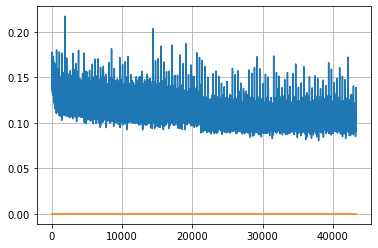

Epoch: 112, iteration 0, loss 0.09168443083763123, cov_diff 0.4390293981138133 cov_diff train 0.4378791045615953
Epoch: 112, iteration 1, loss 0.10646852850914001, cov_diff 0.4089618338421608 cov_diff train 0.40767599942349597
Epoch: 112, iteration 2, loss 0.09410220384597778, cov_diff 0.4123303848617288 cov_diff train 0.41107344491736625
Epoch: 112, iteration 3, loss 0.10765805840492249, cov_diff 0.4066825004716915 cov_diff train 0.40557631025792723
Epoch: 112, iteration 4, loss 0.09746158123016357, cov_diff 0.418892701773811 cov_diff train 0.4184940261286115
Epoch: 112, iteration 5, loss 0.09122174978256226, cov_diff 0.42498971610839903 cov_diff train 0.4241918445084462
Epoch: 112, iteration 6, loss 0.10285055637359619, cov_diff 0.40931631861055 cov_diff train 0.4091516016702114
Epoch: 112, iteration 7, loss 0.09054294228553772, cov_diff 0.4217744026899256 cov_diff train 0.4212984765655524
Epoch: 112, iteration 8, loss 0.10476484894752502, cov_diff 0.41262312287382114 cov_diff train 

Epoch: 112, iteration 73, loss 0.09883570671081543, cov_diff 0.4018507453814639 cov_diff train 0.4015628489143693
Epoch: 112, iteration 74, loss 0.0955655574798584, cov_diff 0.42324465756030705 cov_diff train 0.4229375493373062
Epoch: 112, iteration 75, loss 0.09903821349143982, cov_diff 0.42017123261730416 cov_diff train 0.42002627497718625
Epoch: 112, iteration 76, loss 0.09467700123786926, cov_diff 0.40838321082968426 cov_diff train 0.40895014359795473
Epoch: 112, iteration 77, loss 0.1204771101474762, cov_diff 0.42209366133199455 cov_diff train 0.4210480941783544
Epoch: 112, iteration 78, loss 0.10445025563240051, cov_diff 0.402215839195047 cov_diff train 0.40198751878618927
Epoch: 112, iteration 79, loss 0.09767735004425049, cov_diff 0.40801405229271587 cov_diff train 0.4074526232024863
Epoch: 112, iteration 80, loss 0.11317130923271179, cov_diff 0.4257537713190787 cov_diff train 0.42507958569334464
Epoch: 112, iteration 81, loss 0.09331941604614258, cov_diff 0.41892723638745494 c

Epoch: 112, iteration 146, loss 0.10352644324302673, cov_diff 0.42080832041787913 cov_diff train 0.4203381531936552
Epoch: 112, iteration 147, loss 0.10858887434005737, cov_diff 0.41952332990647667 cov_diff train 0.4181652778093155
Epoch: 112, iteration 148, loss 0.0971527099609375, cov_diff 0.42055484806941446 cov_diff train 0.4202044482912633
Epoch: 112, iteration 149, loss 0.11060360074043274, cov_diff 0.424553946885694 cov_diff train 0.4234188853151928
Epoch: 112, iteration 150, loss 0.0997554361820221, cov_diff 0.4124490404086552 cov_diff train 0.4126983158135791
Epoch: 112, iteration 151, loss 0.09934607148170471, cov_diff 0.41777734570425096 cov_diff train 0.4174475473495377
Epoch: 112, iteration 152, loss 0.10804802179336548, cov_diff 0.4296173506135182 cov_diff train 0.4291052287809557
Epoch: 112, iteration 153, loss 0.12136393785476685, cov_diff 0.4225516259318323 cov_diff train 0.42274904160751414
Epoch: 112, iteration 154, loss 0.09948182106018066, cov_diff 0.41025540827924

Epoch: 112, iteration 227, loss 0.114431232213974, cov_diff 0.4352350899703068 cov_diff train 0.4346592014800869
Epoch: 112, iteration 228, loss 0.11522051692008972, cov_diff 0.43513989715005014 cov_diff train 0.4340285957738013
Epoch: 112, iteration 229, loss 0.09658390283584595, cov_diff 0.4170622611358851 cov_diff train 0.4158428435548062
Epoch: 112, iteration 230, loss 0.10405707359313965, cov_diff 0.4133596581418393 cov_diff train 0.4127181246634694
Epoch: 112, iteration 231, loss 0.11203908920288086, cov_diff 0.41835956707054933 cov_diff train 0.4172068410477429
Epoch: 112, iteration 232, loss 0.10815414786338806, cov_diff 0.4255681611997799 cov_diff train 0.42518886204577855
Epoch: 112, iteration 233, loss 0.10098180174827576, cov_diff 0.42095695597465116 cov_diff train 0.4206906667971082
Epoch: 112, iteration 234, loss 0.10937497019767761, cov_diff 0.42133761735647973 cov_diff train 0.42069284918758115
Epoch: 112, iteration 235, loss 0.11745703220367432, cov_diff 0.424148793512

Epoch: 112, iteration 303, loss 0.11406484246253967, cov_diff 0.4209084831847807 cov_diff train 0.41957011912561565
Epoch: 112, iteration 304, loss 0.1012115478515625, cov_diff 0.42118397353771186 cov_diff train 0.4206094352949778
Epoch: 112, iteration 305, loss 0.10052567720413208, cov_diff 0.4233902344299707 cov_diff train 0.4216103151514503
Epoch: 112, iteration 306, loss 0.1067432165145874, cov_diff 0.4251138901701239 cov_diff train 0.4246617127769163
Epoch: 112, iteration 307, loss 0.0980619490146637, cov_diff 0.4069812127656686 cov_diff train 0.40654579411179637
Epoch: 112, iteration 308, loss 0.1133643090724945, cov_diff 0.42698163243327214 cov_diff train 0.4268155709696847
Epoch: 112, iteration 309, loss 0.10613739490509033, cov_diff 0.42818646885832257 cov_diff train 0.42753690869117117
Epoch: 112, iteration 310, loss 0.10148370265960693, cov_diff 0.4098443740055186 cov_diff train 0.4088234856349331
Epoch: 112, iteration 311, loss 0.10648462176322937, cov_diff 0.43926356280927

Epoch: 112, iteration 380, loss 0.10515907406806946, cov_diff 0.41906981778263974 cov_diff train 0.41900054736621234
Epoch: 112, iteration 381, loss 0.10035818815231323, cov_diff 0.41846433334281824 cov_diff train 0.4183886187450991
Epoch: 112, iteration 382, loss 0.09768307209014893, cov_diff 0.43329864781435445 cov_diff train 0.4332562159058369
Epoch: 112, iteration 383, loss 0.09529638290405273, cov_diff 0.43029219523663176 cov_diff train 0.4300190880733295
Epoch: 112, iteration 384, loss 0.10589814186096191, cov_diff 0.4298589747610828 cov_diff train 0.42920452950046434
Epoch: 112, iteration 385, loss 0.1072140634059906, cov_diff 0.41186358590918504 cov_diff train 0.4113813840620589
Epoch: 112, iteration 386, loss 0.09663170576095581, cov_diff 0.42756900870841363 cov_diff train 0.42683936938728095
Epoch: 112, iteration 387, loss 0.1066131591796875, cov_diff 0.42388909637138616 cov_diff train 0.4228171596490238
Epoch: 112, iteration 388, loss 0.11208590865135193, cov_diff 0.42253023

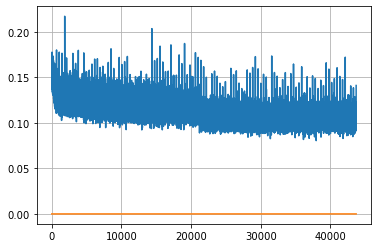

Epoch: 113, iteration 0, loss 0.10192042589187622, cov_diff 0.42426926411967514 cov_diff train 0.42278897482122646
Epoch: 113, iteration 1, loss 0.10407856106758118, cov_diff 0.42455652813895983 cov_diff train 0.42461727904301605
Epoch: 113, iteration 2, loss 0.10605493187904358, cov_diff 0.4267139110641412 cov_diff train 0.42588937479966527
Epoch: 113, iteration 3, loss 0.11509549617767334, cov_diff 0.42825759084691806 cov_diff train 0.4280037396375224
Epoch: 113, iteration 4, loss 0.10037574172019958, cov_diff 0.4076117089035162 cov_diff train 0.4074330135147105
Epoch: 113, iteration 5, loss 0.10553222894668579, cov_diff 0.4168735876574021 cov_diff train 0.416973845910096
Epoch: 113, iteration 6, loss 0.11064130067825317, cov_diff 0.4158369530203822 cov_diff train 0.4145522691241071
Epoch: 113, iteration 7, loss 0.1031726598739624, cov_diff 0.4228182580200564 cov_diff train 0.4210401759935399
Epoch: 113, iteration 8, loss 0.1114891767501831, cov_diff 0.42833385256170814 cov_diff trai

Epoch: 113, iteration 77, loss 0.10858204960823059, cov_diff 0.4305507921851948 cov_diff train 0.43023288831587414
Epoch: 113, iteration 78, loss 0.11082783341407776, cov_diff 0.4241865445370342 cov_diff train 0.42393592465869606
Epoch: 113, iteration 79, loss 0.11263453960418701, cov_diff 0.4067027154489032 cov_diff train 0.40549904838979617
Epoch: 113, iteration 80, loss 0.09938865900039673, cov_diff 0.41304105038815 cov_diff train 0.41286023514067854
Epoch: 113, iteration 81, loss 0.11253458261489868, cov_diff 0.4246585897437121 cov_diff train 0.424466816445029
Epoch: 113, iteration 82, loss 0.11398077011108398, cov_diff 0.42954195579080323 cov_diff train 0.4288737247653594
Epoch: 113, iteration 83, loss 0.11004295945167542, cov_diff 0.4239568339670645 cov_diff train 0.42292344853598257
Epoch: 113, iteration 84, loss 0.10917851328849792, cov_diff 0.40327626936452765 cov_diff train 0.4030980129404599
Epoch: 113, iteration 85, loss 0.10879570245742798, cov_diff 0.425100516176288 cov_d

Epoch: 113, iteration 154, loss 0.11620664596557617, cov_diff 0.42120777926418335 cov_diff train 0.41997616260143045
Epoch: 113, iteration 155, loss 0.10748207569122314, cov_diff 0.41875091094105665 cov_diff train 0.41806485594918197
Epoch: 113, iteration 156, loss 0.10219290852546692, cov_diff 0.4133494935991002 cov_diff train 0.41259788444977846
Epoch: 113, iteration 157, loss 0.11824566125869751, cov_diff 0.40866732197544076 cov_diff train 0.4084610199480515
Epoch: 113, iteration 158, loss 0.09496155381202698, cov_diff 0.4165747676376506 cov_diff train 0.41602929624467616
Epoch: 113, iteration 159, loss 0.11091795563697815, cov_diff 0.41342840938956316 cov_diff train 0.4132353418334387
Epoch: 113, iteration 160, loss 0.10943636298179626, cov_diff 0.41370122257291175 cov_diff train 0.4122818199992113
Epoch: 113, iteration 161, loss 0.11832356452941895, cov_diff 0.4087050215198471 cov_diff train 0.40861019662022185
Epoch: 113, iteration 162, loss 0.11395105719566345, cov_diff 0.405178

Epoch: 113, iteration 231, loss 0.10215207934379578, cov_diff 0.4040443981923783 cov_diff train 0.4034872983845623
Epoch: 113, iteration 232, loss 0.10499900579452515, cov_diff 0.42993970119665886 cov_diff train 0.42877274919211844
Epoch: 113, iteration 233, loss 0.11116620898246765, cov_diff 0.411537417239119 cov_diff train 0.4108063268575794
Epoch: 113, iteration 234, loss 0.09829467535018921, cov_diff 0.4107876003390639 cov_diff train 0.41045133888841506
Epoch: 113, iteration 235, loss 0.09463688731193542, cov_diff 0.42352333080502014 cov_diff train 0.42223927159356106
Epoch: 113, iteration 236, loss 0.11500170826911926, cov_diff 0.4218739645046243 cov_diff train 0.42093624242035954
Epoch: 113, iteration 237, loss 0.10547149181365967, cov_diff 0.4160332623551481 cov_diff train 0.41528985554240516
Epoch: 113, iteration 238, loss 0.09543827176094055, cov_diff 0.4129112611241795 cov_diff train 0.41273467449856904
Epoch: 113, iteration 239, loss 0.11386871337890625, cov_diff 0.419255428

Epoch: 113, iteration 307, loss 0.10274475812911987, cov_diff 0.4227372791754289 cov_diff train 0.42178488912488515
Epoch: 113, iteration 308, loss 0.10398513078689575, cov_diff 0.40721254462665635 cov_diff train 0.40660280560918494
Epoch: 113, iteration 309, loss 0.10696980357170105, cov_diff 0.42845684549600405 cov_diff train 0.42757127874499956
Epoch: 113, iteration 310, loss 0.1021062433719635, cov_diff 0.4271312214330317 cov_diff train 0.42678512127054535
Epoch: 113, iteration 311, loss 0.102715402841568, cov_diff 0.4185104095943654 cov_diff train 0.417816126641306
Epoch: 113, iteration 312, loss 0.08890283107757568, cov_diff 0.4234504832270401 cov_diff train 0.42278647713537343
Epoch: 113, iteration 313, loss 0.1123199462890625, cov_diff 0.4116793752659102 cov_diff train 0.4119091867035855
Epoch: 113, iteration 314, loss 0.10266706347465515, cov_diff 0.42594908703221457 cov_diff train 0.42496700630588535
Epoch: 113, iteration 315, loss 0.11876806616783142, cov_diff 0.415813464624

Epoch: 113, iteration 383, loss 0.09173494577407837, cov_diff 0.42108380989870775 cov_diff train 0.4203818710479913
Epoch: 113, iteration 384, loss 0.11053746938705444, cov_diff 0.4156509839128847 cov_diff train 0.41404047787477044
Epoch: 113, iteration 385, loss 0.10189032554626465, cov_diff 0.4239053075590503 cov_diff train 0.4235765901651068
Epoch: 113, iteration 386, loss 0.0918588936328888, cov_diff 0.42317904055846434 cov_diff train 0.42251587742891217
Epoch: 113, iteration 387, loss 0.10390350222587585, cov_diff 0.4214286309734305 cov_diff train 0.42064536634121463
Epoch: 113, iteration 388, loss 0.10730749368667603, cov_diff 0.40637167044686634 cov_diff train 0.40587106292866937
Epoch: 113, iteration 389, loss 0.09577873349189758, cov_diff 0.41004543664087517 cov_diff train 0.4096703814406284
Epoch: 113, iteration 390, loss 0.1435127854347229, cov_diff 0.44049485535493577 cov_diff train 0.44045452020645776


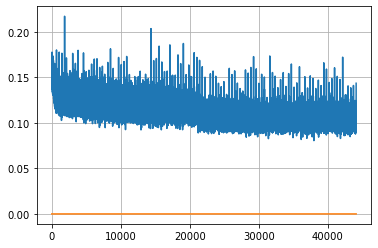

Epoch: 114, iteration 0, loss 0.08677643537521362, cov_diff 0.40673846809172914 cov_diff train 0.4068209810140075
Epoch: 114, iteration 1, loss 0.11397957801818848, cov_diff 0.4239040119313625 cov_diff train 0.4232750621182023
Epoch: 114, iteration 2, loss 0.11136895418167114, cov_diff 0.41513795544359183 cov_diff train 0.41458238606929826
Epoch: 114, iteration 3, loss 0.10800138115882874, cov_diff 0.40665452414785985 cov_diff train 0.40643109414581463
Epoch: 114, iteration 4, loss 0.10651019215583801, cov_diff 0.4122475696511162 cov_diff train 0.41220259078277993
Epoch: 114, iteration 5, loss 0.11107292771339417, cov_diff 0.41625831065269536 cov_diff train 0.41679028503016785
Epoch: 114, iteration 6, loss 0.10310685634613037, cov_diff 0.42154918538460895 cov_diff train 0.42112531589306396
Epoch: 114, iteration 7, loss 0.10717412829399109, cov_diff 0.4189874276759441 cov_diff train 0.4180231885073538
Epoch: 114, iteration 8, loss 0.10604801774024963, cov_diff 0.4335825521640866 cov_dif

Epoch: 114, iteration 78, loss 0.09853887557983398, cov_diff 0.43228593186069736 cov_diff train 0.4323814989322294
Epoch: 114, iteration 79, loss 0.11079838871955872, cov_diff 0.42682086584020423 cov_diff train 0.4258447763622748
Epoch: 114, iteration 80, loss 0.09730911254882812, cov_diff 0.42494312117478966 cov_diff train 0.4233968605550063
Epoch: 114, iteration 81, loss 0.10093134641647339, cov_diff 0.4038685827664812 cov_diff train 0.402590320711415
Epoch: 114, iteration 82, loss 0.11173030734062195, cov_diff 0.42901533633088285 cov_diff train 0.42865132115645366
Epoch: 114, iteration 83, loss 0.10961312055587769, cov_diff 0.4326780848313587 cov_diff train 0.43138805262641355
Epoch: 114, iteration 84, loss 0.11216944456100464, cov_diff 0.4155944507577634 cov_diff train 0.4139452483241153
Epoch: 114, iteration 85, loss 0.10155162215232849, cov_diff 0.4264242578044482 cov_diff train 0.42556580292623847
Epoch: 114, iteration 86, loss 0.10946610569953918, cov_diff 0.4178749573964652 co

Epoch: 114, iteration 156, loss 0.0968521237373352, cov_diff 0.42580008323017016 cov_diff train 0.4248690512596942
Epoch: 114, iteration 157, loss 0.09473374485969543, cov_diff 0.4270858444034147 cov_diff train 0.42535117726508614
Epoch: 114, iteration 158, loss 0.10753190517425537, cov_diff 0.41752975298740497 cov_diff train 0.4167131005776751
Epoch: 114, iteration 159, loss 0.10673338174819946, cov_diff 0.4357822459386727 cov_diff train 0.43498725454619214
Epoch: 114, iteration 160, loss 0.09211519360542297, cov_diff 0.40851268088992254 cov_diff train 0.4074878333937871
Epoch: 114, iteration 161, loss 0.11237815022468567, cov_diff 0.41559562426553887 cov_diff train 0.41513239678128816
Epoch: 114, iteration 162, loss 0.11313691735267639, cov_diff 0.415734028826342 cov_diff train 0.41458746312832967
Epoch: 114, iteration 163, loss 0.11266058683395386, cov_diff 0.4255244439824843 cov_diff train 0.4252090485462588
Epoch: 114, iteration 164, loss 0.1078873872756958, cov_diff 0.40753599160

Epoch: 114, iteration 235, loss 0.11165773868560791, cov_diff 0.4250847931030129 cov_diff train 0.4248682493483701
Epoch: 114, iteration 236, loss 0.0954521894454956, cov_diff 0.4132397534443783 cov_diff train 0.4131281970560127
Epoch: 114, iteration 237, loss 0.10290846228599548, cov_diff 0.43212400036232196 cov_diff train 0.43125084156837723
Epoch: 114, iteration 238, loss 0.1005164384841919, cov_diff 0.43115001427512634 cov_diff train 0.43000665532074017
Epoch: 114, iteration 239, loss 0.08871129155158997, cov_diff 0.41564822328875556 cov_diff train 0.41520473031563654
Epoch: 114, iteration 240, loss 0.10635700821876526, cov_diff 0.41639617853665056 cov_diff train 0.41569866049324933
Epoch: 114, iteration 241, loss 0.09399950504302979, cov_diff 0.43338977943528 cov_diff train 0.43340190963345204
Epoch: 114, iteration 242, loss 0.10584500432014465, cov_diff 0.4198920279618012 cov_diff train 0.41981880866905624
Epoch: 114, iteration 243, loss 0.12981516122817993, cov_diff 0.4063298419

Epoch: 114, iteration 314, loss 0.10796403884887695, cov_diff 0.4283316933273185 cov_diff train 0.42735050553335013
Epoch: 114, iteration 315, loss 0.10282528400421143, cov_diff 0.408145079809413 cov_diff train 0.4075833785173811
Epoch: 114, iteration 316, loss 0.10173776745796204, cov_diff 0.40282736630364296 cov_diff train 0.4019334963891701
Epoch: 114, iteration 317, loss 0.10397115349769592, cov_diff 0.41740783638957174 cov_diff train 0.4161798348182487
Epoch: 114, iteration 318, loss 0.08956331014633179, cov_diff 0.4172290167846699 cov_diff train 0.4165418271904981
Epoch: 114, iteration 319, loss 0.10185763239860535, cov_diff 0.4213824980712822 cov_diff train 0.4211498552273968
Epoch: 114, iteration 320, loss 0.10455715656280518, cov_diff 0.40702639745730923 cov_diff train 0.4061845663282849
Epoch: 114, iteration 321, loss 0.10910046100616455, cov_diff 0.4125966461675499 cov_diff train 0.41238403727237843
Epoch: 114, iteration 322, loss 0.09656849503517151, cov_diff 0.418239778294

Epoch: 114, iteration 388, loss 0.10150229930877686, cov_diff 0.4132908794711996 cov_diff train 0.41234271801347583
Epoch: 114, iteration 389, loss 0.10083338618278503, cov_diff 0.41080115090151564 cov_diff train 0.41081795631675055
Epoch: 114, iteration 390, loss 0.14639395475387573, cov_diff 0.43484551887372913 cov_diff train 0.433769339593796


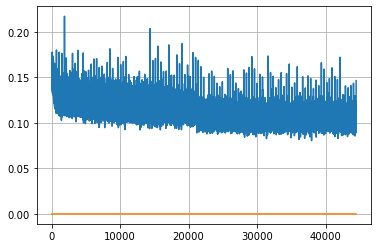

Epoch: 115, iteration 0, loss 0.09859073162078857, cov_diff 0.4196151450698008 cov_diff train 0.4189529196862173
Epoch: 115, iteration 1, loss 0.10607510805130005, cov_diff 0.4219567635496702 cov_diff train 0.4216165041592227
Epoch: 115, iteration 2, loss 0.10726666450500488, cov_diff 0.4119298417084007 cov_diff train 0.41161798175751335
Epoch: 115, iteration 3, loss 0.10155469179153442, cov_diff 0.41563499347480526 cov_diff train 0.41552980730416517
Epoch: 115, iteration 4, loss 0.10372644662857056, cov_diff 0.40814434592678095 cov_diff train 0.408324295542381
Epoch: 115, iteration 5, loss 0.11855363845825195, cov_diff 0.4118866608637335 cov_diff train 0.41139651404662575
Epoch: 115, iteration 6, loss 0.10718044638633728, cov_diff 0.4062745934870162 cov_diff train 0.4062587446629112
Epoch: 115, iteration 7, loss 0.10585150122642517, cov_diff 0.4210309078795625 cov_diff train 0.42036032896692577
Epoch: 115, iteration 8, loss 0.08897343277931213, cov_diff 0.4206225319480274 cov_diff tra

Epoch: 115, iteration 77, loss 0.09652212262153625, cov_diff 0.4132477255968486 cov_diff train 0.41310595763089314
Epoch: 115, iteration 78, loss 0.10563865303993225, cov_diff 0.42374654061838807 cov_diff train 0.4236661249545661
Epoch: 115, iteration 79, loss 0.11598342657089233, cov_diff 0.4195675647792322 cov_diff train 0.41844868827889453
Epoch: 115, iteration 80, loss 0.10663124918937683, cov_diff 0.42107969926277483 cov_diff train 0.41915971433437993
Epoch: 115, iteration 81, loss 0.11416521668434143, cov_diff 0.41432082995046376 cov_diff train 0.413675656284671
Epoch: 115, iteration 82, loss 0.10276845097541809, cov_diff 0.4136632125966542 cov_diff train 0.4135471349680171
Epoch: 115, iteration 83, loss 0.1067822277545929, cov_diff 0.42061278368502536 cov_diff train 0.4201349634581589
Epoch: 115, iteration 84, loss 0.11541414260864258, cov_diff 0.42170825189333283 cov_diff train 0.42192982289962777
Epoch: 115, iteration 85, loss 0.09891766309738159, cov_diff 0.42887233926653556 

Epoch: 115, iteration 154, loss 0.10604870319366455, cov_diff 0.4274571826418289 cov_diff train 0.4263447581382407
Epoch: 115, iteration 155, loss 0.09577614068984985, cov_diff 0.4172706579643232 cov_diff train 0.41708792730780225
Epoch: 115, iteration 156, loss 0.0971829891204834, cov_diff 0.4090222472704167 cov_diff train 0.40889719189675566
Epoch: 115, iteration 157, loss 0.10852459073066711, cov_diff 0.4235697848527931 cov_diff train 0.42421413292902294
Epoch: 115, iteration 158, loss 0.0999426543712616, cov_diff 0.4217734289292395 cov_diff train 0.421972400125725
Epoch: 115, iteration 159, loss 0.10304862260818481, cov_diff 0.4234149797080759 cov_diff train 0.42242101680792365
Epoch: 115, iteration 160, loss 0.106548011302948, cov_diff 0.4302485164821828 cov_diff train 0.4295485572797422
Epoch: 115, iteration 161, loss 0.10319003462791443, cov_diff 0.42793640087468265 cov_diff train 0.42605492105382575
Epoch: 115, iteration 162, loss 0.11055761575698853, cov_diff 0.424801117415234

Epoch: 115, iteration 225, loss 0.10266542434692383, cov_diff 0.40774382455513103 cov_diff train 0.4069086880527854
Epoch: 115, iteration 226, loss 0.09827461838722229, cov_diff 0.42636549341392166 cov_diff train 0.42664903522236713
Epoch: 115, iteration 227, loss 0.11031997203826904, cov_diff 0.4173997968363549 cov_diff train 0.41681645274930823
Epoch: 115, iteration 228, loss 0.09730774164199829, cov_diff 0.4187336804647444 cov_diff train 0.4180584078544402
Epoch: 115, iteration 229, loss 0.10019838809967041, cov_diff 0.43109463471918097 cov_diff train 0.43042796476044415
Epoch: 115, iteration 230, loss 0.09879767894744873, cov_diff 0.41652505033097514 cov_diff train 0.4163363366157363
Epoch: 115, iteration 231, loss 0.0987054705619812, cov_diff 0.4127705481229493 cov_diff train 0.4124659560239583
Epoch: 115, iteration 232, loss 0.10763636231422424, cov_diff 0.41985786690828975 cov_diff train 0.4195127747823814
Epoch: 115, iteration 233, loss 0.10141336917877197, cov_diff 0.424287443

Epoch: 115, iteration 296, loss 0.10181289911270142, cov_diff 0.42539458811011327 cov_diff train 0.4230651488488284
Epoch: 115, iteration 297, loss 0.11135482788085938, cov_diff 0.41814152876972527 cov_diff train 0.4173900341029509
Epoch: 115, iteration 298, loss 0.0940617024898529, cov_diff 0.42967028849191463 cov_diff train 0.42815299784051614
Epoch: 115, iteration 299, loss 0.0963779091835022, cov_diff 0.42364653896327775 cov_diff train 0.42319443649505917
Epoch: 115, iteration 300, loss 0.10074111819267273, cov_diff 0.41434346506863673 cov_diff train 0.4136215931682512
Epoch: 115, iteration 301, loss 0.09741225838661194, cov_diff 0.41535143958351767 cov_diff train 0.4145890789486152
Epoch: 115, iteration 302, loss 0.10904145240783691, cov_diff 0.42083160226046734 cov_diff train 0.4197363611676618
Epoch: 115, iteration 303, loss 0.1084837019443512, cov_diff 0.4238275858670513 cov_diff train 0.42318376545675124
Epoch: 115, iteration 304, loss 0.09494128823280334, cov_diff 0.410413877

Epoch: 115, iteration 368, loss 0.09888988733291626, cov_diff 0.42187825418397046 cov_diff train 0.4203481661380889
Epoch: 115, iteration 369, loss 0.10923874378204346, cov_diff 0.42392054105516574 cov_diff train 0.42329587917673644
Epoch: 115, iteration 370, loss 0.11138543486595154, cov_diff 0.4164921239210419 cov_diff train 0.4157509359674883
Epoch: 115, iteration 371, loss 0.10724189877510071, cov_diff 0.43164945269153415 cov_diff train 0.4307272636328998
Epoch: 115, iteration 372, loss 0.09766605496406555, cov_diff 0.4098145957692579 cov_diff train 0.409416937815301
Epoch: 115, iteration 373, loss 0.10687649250030518, cov_diff 0.4226948094310609 cov_diff train 0.4216959900522315
Epoch: 115, iteration 374, loss 0.12238714098930359, cov_diff 0.4189248916709605 cov_diff train 0.41897363671836346
Epoch: 115, iteration 375, loss 0.1012481153011322, cov_diff 0.4107330648394275 cov_diff train 0.4106017565495625
Epoch: 115, iteration 376, loss 0.09656032919883728, cov_diff 0.4254886350473

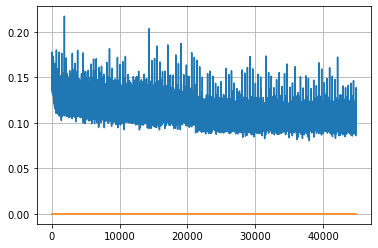

Epoch: 116, iteration 0, loss 0.10252279043197632, cov_diff 0.423246811983134 cov_diff train 0.4224399102377015
Epoch: 116, iteration 1, loss 0.09371364116668701, cov_diff 0.4149067994803153 cov_diff train 0.41441476921169434
Epoch: 116, iteration 2, loss 0.10325437784194946, cov_diff 0.4137294298004027 cov_diff train 0.41318898095085893
Epoch: 116, iteration 3, loss 0.09854474663734436, cov_diff 0.4249046877636418 cov_diff train 0.42481670234712504
Epoch: 116, iteration 4, loss 0.09755876660346985, cov_diff 0.41753894777051304 cov_diff train 0.41627240175329167
Epoch: 116, iteration 5, loss 0.10000181198120117, cov_diff 0.4155231026833706 cov_diff train 0.41482020086200627
Epoch: 116, iteration 6, loss 0.08984237909317017, cov_diff 0.4187948307557317 cov_diff train 0.4180662934770486
Epoch: 116, iteration 7, loss 0.10102009773254395, cov_diff 0.4213346752377924 cov_diff train 0.4209656996293537
Epoch: 116, iteration 8, loss 0.09301793575286865, cov_diff 0.41433522455268085 cov_diff tr

Epoch: 116, iteration 74, loss 0.10168898105621338, cov_diff 0.4136942358501521 cov_diff train 0.4133059309574653
Epoch: 116, iteration 75, loss 0.10424667596817017, cov_diff 0.4230312842316502 cov_diff train 0.4211370520200623
Epoch: 116, iteration 76, loss 0.09959280490875244, cov_diff 0.4171956780663833 cov_diff train 0.4165939662982458
Epoch: 116, iteration 77, loss 0.11142838001251221, cov_diff 0.433470879816014 cov_diff train 0.43264613325992207
Epoch: 116, iteration 78, loss 0.10225978493690491, cov_diff 0.41369771613289186 cov_diff train 0.4134437012559838
Epoch: 116, iteration 79, loss 0.09335076808929443, cov_diff 0.415628015898015 cov_diff train 0.4142873526808823
Epoch: 116, iteration 80, loss 0.10428416728973389, cov_diff 0.42241629876012354 cov_diff train 0.4213749124236968
Epoch: 116, iteration 81, loss 0.09075027704238892, cov_diff 0.43578743529529307 cov_diff train 0.43476208900984387
Epoch: 116, iteration 82, loss 0.09470260143280029, cov_diff 0.4205296982752606 cov_d

Epoch: 116, iteration 151, loss 0.10895031690597534, cov_diff 0.42060541909496774 cov_diff train 0.41995295214854006
Epoch: 116, iteration 152, loss 0.0996171236038208, cov_diff 0.43508074654679685 cov_diff train 0.43418795677365657
Epoch: 116, iteration 153, loss 0.10839158296585083, cov_diff 0.4331644146747702 cov_diff train 0.4321596970769486
Epoch: 116, iteration 154, loss 0.09748098254203796, cov_diff 0.41297162099589624 cov_diff train 0.4128150264415727
Epoch: 116, iteration 155, loss 0.0898558497428894, cov_diff 0.4204264265628105 cov_diff train 0.41953373924083853
Epoch: 116, iteration 156, loss 0.10135188698768616, cov_diff 0.4220176552513097 cov_diff train 0.42150106168347246
Epoch: 116, iteration 157, loss 0.10665109753608704, cov_diff 0.43028842252899185 cov_diff train 0.42919900942458417
Epoch: 116, iteration 158, loss 0.09558865427970886, cov_diff 0.426906011547424 cov_diff train 0.426871992756198
Epoch: 116, iteration 159, loss 0.10771432518959045, cov_diff 0.41754294675

Epoch: 116, iteration 228, loss 0.10594996809959412, cov_diff 0.4229652733368563 cov_diff train 0.42268547476512186
Epoch: 116, iteration 229, loss 0.09897422790527344, cov_diff 0.4086088727559083 cov_diff train 0.4080889706466638
Epoch: 116, iteration 230, loss 0.11848902702331543, cov_diff 0.42542408419165256 cov_diff train 0.42465980747134324
Epoch: 116, iteration 231, loss 0.09917148947715759, cov_diff 0.4250839300200417 cov_diff train 0.4248515359384786
Epoch: 116, iteration 232, loss 0.1110183596611023, cov_diff 0.4049532595123202 cov_diff train 0.40465953648374015
Epoch: 116, iteration 233, loss 0.0964764952659607, cov_diff 0.42264575381753894 cov_diff train 0.4223780105352009
Epoch: 116, iteration 234, loss 0.10571545362472534, cov_diff 0.4190536206066511 cov_diff train 0.41880196501098993
Epoch: 116, iteration 235, loss 0.09630879759788513, cov_diff 0.414784707609747 cov_diff train 0.41370123407106507
Epoch: 116, iteration 236, loss 0.11091384291648865, cov_diff 0.423823888403

Epoch: 116, iteration 305, loss 0.12777787446975708, cov_diff 0.4090757808877684 cov_diff train 0.4087863254841323
Epoch: 116, iteration 306, loss 0.09756043553352356, cov_diff 0.4175224187261287 cov_diff train 0.4169216492255023
Epoch: 116, iteration 307, loss 0.11429768800735474, cov_diff 0.42986811377163936 cov_diff train 0.430056697490473
Epoch: 116, iteration 308, loss 0.09855258464813232, cov_diff 0.4326251640062445 cov_diff train 0.43231245737420965
Epoch: 116, iteration 309, loss 0.10034048557281494, cov_diff 0.4204969682232682 cov_diff train 0.4205026645755805
Epoch: 116, iteration 310, loss 0.10377699136734009, cov_diff 0.42527529949060716 cov_diff train 0.4247245995929282
Epoch: 116, iteration 311, loss 0.10577157139778137, cov_diff 0.4286436172364999 cov_diff train 0.4283645388518889
Epoch: 116, iteration 312, loss 0.1056222915649414, cov_diff 0.42160737176190455 cov_diff train 0.42145937102190306
Epoch: 116, iteration 313, loss 0.10099408030509949, cov_diff 0.4195245795983

Epoch: 116, iteration 377, loss 0.11194822192192078, cov_diff 0.404696404932071 cov_diff train 0.40417574474983115
Epoch: 116, iteration 378, loss 0.09640151262283325, cov_diff 0.42932460343165857 cov_diff train 0.428902486938023
Epoch: 116, iteration 379, loss 0.11025035381317139, cov_diff 0.4297391791818557 cov_diff train 0.42820956171149177
Epoch: 116, iteration 380, loss 0.09560823440551758, cov_diff 0.4039716177107537 cov_diff train 0.40324952889565696
Epoch: 116, iteration 381, loss 0.10429790616035461, cov_diff 0.4111966289858329 cov_diff train 0.41074989576152166
Epoch: 116, iteration 382, loss 0.10739672183990479, cov_diff 0.4232197465509111 cov_diff train 0.4226287869074889
Epoch: 116, iteration 383, loss 0.09909677505493164, cov_diff 0.41456415689983656 cov_diff train 0.4135906321847202
Epoch: 116, iteration 384, loss 0.10322752594947815, cov_diff 0.4186410938089563 cov_diff train 0.41853899166700126
Epoch: 116, iteration 385, loss 0.10510662198066711, cov_diff 0.42120818705

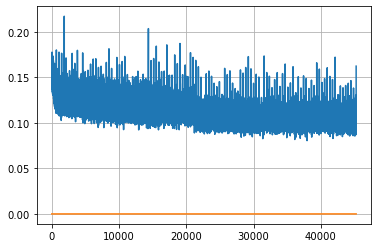

Epoch: 117, iteration 0, loss 0.09816548228263855, cov_diff 0.40958394045500884 cov_diff train 0.4088941181969839
Epoch: 117, iteration 1, loss 0.1095588207244873, cov_diff 0.4172332994077423 cov_diff train 0.4170008660632926
Epoch: 117, iteration 2, loss 0.0986977219581604, cov_diff 0.41113988270917506 cov_diff train 0.41091146051376687
Epoch: 117, iteration 3, loss 0.0976303219795227, cov_diff 0.4159432260635183 cov_diff train 0.4161189912097796
Epoch: 117, iteration 4, loss 0.10384997725486755, cov_diff 0.4214025048568633 cov_diff train 0.42153202028309467
Epoch: 117, iteration 5, loss 0.10498470067977905, cov_diff 0.4258971552075226 cov_diff train 0.425549060502462
Epoch: 117, iteration 6, loss 0.1044912040233612, cov_diff 0.4240533200506128 cov_diff train 0.4228521641217108
Epoch: 117, iteration 7, loss 0.10118916630744934, cov_diff 0.4181626620990257 cov_diff train 0.4175807049388816
Epoch: 117, iteration 8, loss 0.09299322962760925, cov_diff 0.41987271694714073 cov_diff train 0.

Epoch: 117, iteration 77, loss 0.0936020016670227, cov_diff 0.4076614752877362 cov_diff train 0.40751287267087816
Epoch: 117, iteration 78, loss 0.10504627227783203, cov_diff 0.40273377341933825 cov_diff train 0.4027534043991974
Epoch: 117, iteration 79, loss 0.11251959204673767, cov_diff 0.4176542975829874 cov_diff train 0.4173956629299497
Epoch: 117, iteration 80, loss 0.09115558862686157, cov_diff 0.43232460502810965 cov_diff train 0.4310882277920195
Epoch: 117, iteration 81, loss 0.11679685115814209, cov_diff 0.4233191700477283 cov_diff train 0.4220186610918741
Epoch: 117, iteration 82, loss 0.09851932525634766, cov_diff 0.415430957780559 cov_diff train 0.4157447957108694
Epoch: 117, iteration 83, loss 0.10579225420951843, cov_diff 0.4288816022462082 cov_diff train 0.42884115970640896
Epoch: 117, iteration 84, loss 0.10558632016181946, cov_diff 0.4271829652163407 cov_diff train 0.4270595814769318
Epoch: 117, iteration 85, loss 0.10188451409339905, cov_diff 0.415210607650399 cov_dif

Epoch: 117, iteration 155, loss 0.11863166093826294, cov_diff 0.41040982330739 cov_diff train 0.4103687815271903
Epoch: 117, iteration 156, loss 0.10567456483840942, cov_diff 0.42306698368601703 cov_diff train 0.42230052280379093
Epoch: 117, iteration 157, loss 0.10809403657913208, cov_diff 0.4111086657798716 cov_diff train 0.4103039058846179
Epoch: 117, iteration 158, loss 0.10564500093460083, cov_diff 0.43132673489616863 cov_diff train 0.431670161009396
Epoch: 117, iteration 159, loss 0.11101886630058289, cov_diff 0.41733957987015247 cov_diff train 0.4170193988216378
Epoch: 117, iteration 160, loss 0.10070273280143738, cov_diff 0.41410707953496434 cov_diff train 0.412699507913425
Epoch: 117, iteration 161, loss 0.10381552577018738, cov_diff 0.4213782170504075 cov_diff train 0.42095625807408155
Epoch: 117, iteration 162, loss 0.1070212721824646, cov_diff 0.4115516883914595 cov_diff train 0.4109299083943421
Epoch: 117, iteration 163, loss 0.09284073114395142, cov_diff 0.414789941616047

Epoch: 117, iteration 227, loss 0.0985293984413147, cov_diff 0.42478446719206625 cov_diff train 0.42424787523863333
Epoch: 117, iteration 228, loss 0.10094860196113586, cov_diff 0.4115977173921661 cov_diff train 0.4110608080464561
Epoch: 117, iteration 229, loss 0.10135507583618164, cov_diff 0.4108215079725242 cov_diff train 0.4097752998389291
Epoch: 117, iteration 230, loss 0.09536874294281006, cov_diff 0.41751556070831 cov_diff train 0.4168856720423996
Epoch: 117, iteration 231, loss 0.09523317217826843, cov_diff 0.42216617010164453 cov_diff train 0.4218208432486327
Epoch: 117, iteration 232, loss 0.10607832670211792, cov_diff 0.41236730330787486 cov_diff train 0.41208625122841924
Epoch: 117, iteration 233, loss 0.1010449230670929, cov_diff 0.4257276841947168 cov_diff train 0.42514770604929786
Epoch: 117, iteration 234, loss 0.10211840271949768, cov_diff 0.41255900044692395 cov_diff train 0.4124396067575298
Epoch: 117, iteration 235, loss 0.09981799125671387, cov_diff 0.4137894735018

Epoch: 117, iteration 304, loss 0.11118236184120178, cov_diff 0.43575006341440514 cov_diff train 0.4356423767179634
Epoch: 117, iteration 305, loss 0.09883180260658264, cov_diff 0.401831740168491 cov_diff train 0.4011945059009285
Epoch: 117, iteration 306, loss 0.09132584929466248, cov_diff 0.4238375794461062 cov_diff train 0.4234113670765985
Epoch: 117, iteration 307, loss 0.09655958414077759, cov_diff 0.4295103306247542 cov_diff train 0.42892220638166006
Epoch: 117, iteration 308, loss 0.10890689492225647, cov_diff 0.42848151334515683 cov_diff train 0.42776722756005003
Epoch: 117, iteration 309, loss 0.09750032424926758, cov_diff 0.4126467594913032 cov_diff train 0.4115954383090618
Epoch: 117, iteration 310, loss 0.10285305976867676, cov_diff 0.43302268209805067 cov_diff train 0.43192081444350683
Epoch: 117, iteration 311, loss 0.11024034023284912, cov_diff 0.4189942419230152 cov_diff train 0.41791991057736094
Epoch: 117, iteration 312, loss 0.09611529111862183, cov_diff 0.4346001919

Epoch: 117, iteration 381, loss 0.11008673906326294, cov_diff 0.41779066513387875 cov_diff train 0.4165574613466589
Epoch: 117, iteration 382, loss 0.09742477536201477, cov_diff 0.41508029034496546 cov_diff train 0.4140780559904321
Epoch: 117, iteration 383, loss 0.09613767266273499, cov_diff 0.4189841282360957 cov_diff train 0.4181532443641697
Epoch: 117, iteration 384, loss 0.10958018898963928, cov_diff 0.41008973917313657 cov_diff train 0.4092451090026048
Epoch: 117, iteration 385, loss 0.09832426905632019, cov_diff 0.43381899311161676 cov_diff train 0.43282136922490744
Epoch: 117, iteration 386, loss 0.09834977984428406, cov_diff 0.41871334618283346 cov_diff train 0.4179209392780156
Epoch: 117, iteration 387, loss 0.11329913139343262, cov_diff 0.4169282329549792 cov_diff train 0.416085238418603
Epoch: 117, iteration 388, loss 0.09035184979438782, cov_diff 0.42018867210738337 cov_diff train 0.41978609855401144
Epoch: 117, iteration 389, loss 0.09887850284576416, cov_diff 0.404053561

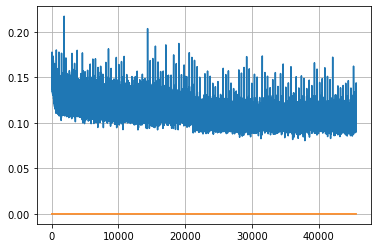

Epoch: 118, iteration 0, loss 0.09607219696044922, cov_diff 0.4239211487194631 cov_diff train 0.42388465235243417
Epoch: 118, iteration 1, loss 0.10634979605674744, cov_diff 0.4272085475511185 cov_diff train 0.42701940047376646
Epoch: 118, iteration 2, loss 0.10197564959526062, cov_diff 0.42183632928676673 cov_diff train 0.42103849281471
Epoch: 118, iteration 3, loss 0.09773504734039307, cov_diff 0.40972813376765743 cov_diff train 0.4098588197324199
Epoch: 118, iteration 4, loss 0.09305757284164429, cov_diff 0.4181465802936679 cov_diff train 0.41787766698664736
Epoch: 118, iteration 5, loss 0.09708762168884277, cov_diff 0.41283172603451357 cov_diff train 0.41138245412429264
Epoch: 118, iteration 6, loss 0.10718989372253418, cov_diff 0.40770853657764344 cov_diff train 0.4070415457183348
Epoch: 118, iteration 7, loss 0.10152566432952881, cov_diff 0.429280482650626 cov_diff train 0.4292210262297722
Epoch: 118, iteration 8, loss 0.10679325461387634, cov_diff 0.43513627026812307 cov_diff tr

Epoch: 118, iteration 78, loss 0.09352841973304749, cov_diff 0.4207674486445674 cov_diff train 0.4194457635860988
Epoch: 118, iteration 79, loss 0.10617479681968689, cov_diff 0.4167388340076497 cov_diff train 0.4150282301173565
Epoch: 118, iteration 80, loss 0.11000663042068481, cov_diff 0.4249006154900328 cov_diff train 0.4229530889216765
Epoch: 118, iteration 81, loss 0.10224893689155579, cov_diff 0.4281809910266292 cov_diff train 0.4272903566852537
Epoch: 118, iteration 82, loss 0.10605642199516296, cov_diff 0.42427994089136517 cov_diff train 0.4228362880773447
Epoch: 118, iteration 83, loss 0.1031196117401123, cov_diff 0.4197277395858889 cov_diff train 0.41865505811864556
Epoch: 118, iteration 84, loss 0.11019778251647949, cov_diff 0.42887080999101057 cov_diff train 0.42790043664072525
Epoch: 118, iteration 85, loss 0.10702317953109741, cov_diff 0.41504948296906174 cov_diff train 0.41443490579543474
Epoch: 118, iteration 86, loss 0.11228698492050171, cov_diff 0.4262622064630942 cov

Epoch: 118, iteration 159, loss 0.10233470797538757, cov_diff 0.4085691429451234 cov_diff train 0.4080344490895435
Epoch: 118, iteration 160, loss 0.11191144585609436, cov_diff 0.4105355805789644 cov_diff train 0.4097092526110086
Epoch: 118, iteration 161, loss 0.11461755633354187, cov_diff 0.4238542630393792 cov_diff train 0.42198616729402155
Epoch: 118, iteration 162, loss 0.098215252161026, cov_diff 0.4043655607960348 cov_diff train 0.40487095190386535
Epoch: 118, iteration 163, loss 0.10243770480155945, cov_diff 0.4223409856765763 cov_diff train 0.4217023281013922
Epoch: 118, iteration 164, loss 0.1037110984325409, cov_diff 0.41331534761834343 cov_diff train 0.4130745001303324
Epoch: 118, iteration 165, loss 0.10314354300498962, cov_diff 0.4200684317985985 cov_diff train 0.42037878178974863
Epoch: 118, iteration 166, loss 0.10078006982803345, cov_diff 0.41171425391631594 cov_diff train 0.41139190500885087
Epoch: 118, iteration 167, loss 0.10235461592674255, cov_diff 0.4261565455776

Epoch: 118, iteration 230, loss 0.10321512818336487, cov_diff 0.431094864007296 cov_diff train 0.42964477272897206
Epoch: 118, iteration 231, loss 0.10266810655593872, cov_diff 0.42558567101938616 cov_diff train 0.4243696350978587
Epoch: 118, iteration 232, loss 0.09740433096885681, cov_diff 0.4036010517932125 cov_diff train 0.402973537577825
Epoch: 118, iteration 233, loss 0.10047227144241333, cov_diff 0.41544604216410724 cov_diff train 0.414275355803224
Epoch: 118, iteration 234, loss 0.09648537635803223, cov_diff 0.40649623069795005 cov_diff train 0.4055022884975524
Epoch: 118, iteration 235, loss 0.10829851031303406, cov_diff 0.39937015791014896 cov_diff train 0.3995842269818766
Epoch: 118, iteration 236, loss 0.0901416540145874, cov_diff 0.41825448784540226 cov_diff train 0.4175218311292249
Epoch: 118, iteration 237, loss 0.0997249186038971, cov_diff 0.4158391084196089 cov_diff train 0.41556333794000916
Epoch: 118, iteration 238, loss 0.10106813907623291, cov_diff 0.42000498010041

Epoch: 118, iteration 303, loss 0.10655799508094788, cov_diff 0.41595712749167263 cov_diff train 0.415268825162295
Epoch: 118, iteration 304, loss 0.08595216274261475, cov_diff 0.40852228811907776 cov_diff train 0.40781626718090097
Epoch: 118, iteration 305, loss 0.09705466032028198, cov_diff 0.4131808501738591 cov_diff train 0.4124589944849929
Epoch: 118, iteration 306, loss 0.09327197074890137, cov_diff 0.4038248708628587 cov_diff train 0.4033312676087001
Epoch: 118, iteration 307, loss 0.09554031491279602, cov_diff 0.4302110897943141 cov_diff train 0.42923786361436717
Epoch: 118, iteration 308, loss 0.1151779294013977, cov_diff 0.425320355145093 cov_diff train 0.4246764807458501
Epoch: 118, iteration 309, loss 0.10456445813179016, cov_diff 0.4176059314416909 cov_diff train 0.4166685770645391
Epoch: 118, iteration 310, loss 0.11360406875610352, cov_diff 0.4267024353900235 cov_diff train 0.42670655512615513
Epoch: 118, iteration 311, loss 0.1109171211719513, cov_diff 0.416936928358853

Epoch: 118, iteration 376, loss 0.10596156120300293, cov_diff 0.420407833169749 cov_diff train 0.419910651055631
Epoch: 118, iteration 377, loss 0.09406548738479614, cov_diff 0.424646768569143 cov_diff train 0.4250143376084609
Epoch: 118, iteration 378, loss 0.10625240206718445, cov_diff 0.4250285586863431 cov_diff train 0.42454725329323206
Epoch: 118, iteration 379, loss 0.089863121509552, cov_diff 0.4076779535807736 cov_diff train 0.4075568185816933
Epoch: 118, iteration 380, loss 0.10133898258209229, cov_diff 0.40596233095069556 cov_diff train 0.4058417223860251
Epoch: 118, iteration 381, loss 0.11455008387565613, cov_diff 0.42970233553868037 cov_diff train 0.4288034008549308
Epoch: 118, iteration 382, loss 0.10973465442657471, cov_diff 0.4376123534737229 cov_diff train 0.43693634007239873
Epoch: 118, iteration 383, loss 0.09624269604682922, cov_diff 0.41271156848028645 cov_diff train 0.4114336099116681
Epoch: 118, iteration 384, loss 0.10092324018478394, cov_diff 0.4231377729624075

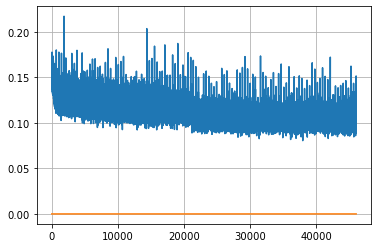

Epoch: 119, iteration 0, loss 0.10640355944633484, cov_diff 0.43346438357635264 cov_diff train 0.43259934595716243
Epoch: 119, iteration 1, loss 0.09679520130157471, cov_diff 0.43256934506465267 cov_diff train 0.4320668262170281
Epoch: 119, iteration 2, loss 0.11375600099563599, cov_diff 0.428662783787064 cov_diff train 0.4282492552804913
Epoch: 119, iteration 3, loss 0.09908619523048401, cov_diff 0.4209002271416997 cov_diff train 0.42003121227960855
Epoch: 119, iteration 4, loss 0.10146462917327881, cov_diff 0.4023235046682467 cov_diff train 0.4013794616328527
Epoch: 119, iteration 5, loss 0.11544609069824219, cov_diff 0.42858689739807276 cov_diff train 0.4280183768840647
Epoch: 119, iteration 6, loss 0.10435459017753601, cov_diff 0.41656394678069286 cov_diff train 0.41635874177296595
Epoch: 119, iteration 7, loss 0.10234728455543518, cov_diff 0.4167005746563748 cov_diff train 0.41673235665752956
Epoch: 119, iteration 8, loss 0.09201321005821228, cov_diff 0.39638048305645185 cov_diff 

Epoch: 119, iteration 75, loss 0.10202851891517639, cov_diff 0.4344990391571935 cov_diff train 0.4334833163630971
Epoch: 119, iteration 76, loss 0.10440388321876526, cov_diff 0.413969614913313 cov_diff train 0.4125963459019801
Epoch: 119, iteration 77, loss 0.10831746459007263, cov_diff 0.4145649260831103 cov_diff train 0.4136236122295823
Epoch: 119, iteration 78, loss 0.10267290472984314, cov_diff 0.40817199786151503 cov_diff train 0.40718934911237264
Epoch: 119, iteration 79, loss 0.0947219729423523, cov_diff 0.4196776058845953 cov_diff train 0.4191163639992864
Epoch: 119, iteration 80, loss 0.10349792242050171, cov_diff 0.4214222679344876 cov_diff train 0.42048423119904516
Epoch: 119, iteration 81, loss 0.09315431118011475, cov_diff 0.4229296706841587 cov_diff train 0.4219820406527133
Epoch: 119, iteration 82, loss 0.09639349579811096, cov_diff 0.42149822437874873 cov_diff train 0.4210198720533192
Epoch: 119, iteration 83, loss 0.09932726621627808, cov_diff 0.41251961716528296 cov_d

Epoch: 119, iteration 153, loss 0.10314396023750305, cov_diff 0.4147238967776022 cov_diff train 0.41446390718879833
Epoch: 119, iteration 154, loss 0.10909843444824219, cov_diff 0.42780546091757043 cov_diff train 0.42677111115614497
Epoch: 119, iteration 155, loss 0.107258141040802, cov_diff 0.4133666348912975 cov_diff train 0.41315384543038003
Epoch: 119, iteration 156, loss 0.10983741283416748, cov_diff 0.4047089841989702 cov_diff train 0.4040417605828419
Epoch: 119, iteration 157, loss 0.10223174095153809, cov_diff 0.41579609021839997 cov_diff train 0.4150544080990505
Epoch: 119, iteration 158, loss 0.10837012529373169, cov_diff 0.4007052563689185 cov_diff train 0.4004969774365842
Epoch: 119, iteration 159, loss 0.10877582430839539, cov_diff 0.44491398507095364 cov_diff train 0.4441654727751672
Epoch: 119, iteration 160, loss 0.09618878364562988, cov_diff 0.41707625328372594 cov_diff train 0.41673321705413746
Epoch: 119, iteration 161, loss 0.09894469380378723, cov_diff 0.4066308343

Epoch: 119, iteration 224, loss 0.10610073804855347, cov_diff 0.4190371591515939 cov_diff train 0.419462975102017
Epoch: 119, iteration 225, loss 0.10552036762237549, cov_diff 0.40359254597711874 cov_diff train 0.40324904916200216
Epoch: 119, iteration 226, loss 0.10062170028686523, cov_diff 0.4184483044009444 cov_diff train 0.41763598140547015
Epoch: 119, iteration 227, loss 0.10616841912269592, cov_diff 0.41125265918748943 cov_diff train 0.41017347579743746
Epoch: 119, iteration 228, loss 0.09423786401748657, cov_diff 0.42218684409653007 cov_diff train 0.4217799889044386
Epoch: 119, iteration 229, loss 0.10278022289276123, cov_diff 0.41367177362537205 cov_diff train 0.41336508556260365
Epoch: 119, iteration 230, loss 0.11625820398330688, cov_diff 0.4118358388535795 cov_diff train 0.41103757720311285
Epoch: 119, iteration 231, loss 0.10690295696258545, cov_diff 0.4191065995224761 cov_diff train 0.41876992833037224
Epoch: 119, iteration 232, loss 0.10936859250068665, cov_diff 0.4148881

Epoch: 119, iteration 298, loss 0.09987524151802063, cov_diff 0.41941807431109634 cov_diff train 0.41847051248826667
Epoch: 119, iteration 299, loss 0.10225042700767517, cov_diff 0.421435478251886 cov_diff train 0.42057819889276615
Epoch: 119, iteration 300, loss 0.09986847639083862, cov_diff 0.41446283296762 cov_diff train 0.4134345411445615
Epoch: 119, iteration 301, loss 0.09822103381156921, cov_diff 0.4233617694504539 cov_diff train 0.423024865359286
Epoch: 119, iteration 302, loss 0.1062701940536499, cov_diff 0.42394603550315335 cov_diff train 0.4233737792694349
Epoch: 119, iteration 303, loss 0.10933700203895569, cov_diff 0.4248726471219574 cov_diff train 0.42424636230467855
Epoch: 119, iteration 304, loss 0.09414345026016235, cov_diff 0.40877699236751575 cov_diff train 0.40846791268145044
Epoch: 119, iteration 305, loss 0.10220634937286377, cov_diff 0.4168769460153258 cov_diff train 0.4158698482898067
Epoch: 119, iteration 306, loss 0.10377007722854614, cov_diff 0.42795949436528

Epoch: 119, iteration 370, loss 0.08420369029045105, cov_diff 0.43096820281790227 cov_diff train 0.4297668773188675
Epoch: 119, iteration 371, loss 0.10313239693641663, cov_diff 0.4116174219865984 cov_diff train 0.411062394608411
Epoch: 119, iteration 372, loss 0.09768754243850708, cov_diff 0.4302366136323386 cov_diff train 0.42959970145800525
Epoch: 119, iteration 373, loss 0.10578769445419312, cov_diff 0.4295732772076499 cov_diff train 0.42878070672610374
Epoch: 119, iteration 374, loss 0.10954463481903076, cov_diff 0.41355919888360965 cov_diff train 0.4129891658137244
Epoch: 119, iteration 375, loss 0.09959763288497925, cov_diff 0.41748535531754744 cov_diff train 0.4162246391950199
Epoch: 119, iteration 376, loss 0.11410641670227051, cov_diff 0.4209568442682643 cov_diff train 0.4194009624921567
Epoch: 119, iteration 377, loss 0.10151436924934387, cov_diff 0.4126734356885783 cov_diff train 0.41158521452950486
Epoch: 119, iteration 378, loss 0.10365855693817139, cov_diff 0.43248572955

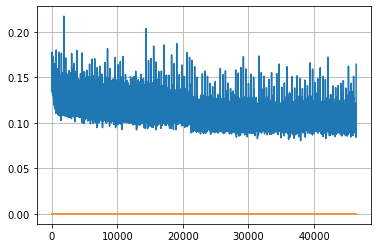

Epoch: 120, iteration 0, loss 0.10664424300193787, cov_diff 0.4133026252728639 cov_diff train 0.41330917682426377
Epoch: 120, iteration 1, loss 0.0999094545841217, cov_diff 0.41978065743200804 cov_diff train 0.4191627542581844
Epoch: 120, iteration 2, loss 0.09785869717597961, cov_diff 0.4144504463855823 cov_diff train 0.41433349831277844
Epoch: 120, iteration 3, loss 0.09086903929710388, cov_diff 0.4171841483688729 cov_diff train 0.4163560695731944
Epoch: 120, iteration 4, loss 0.10833853483200073, cov_diff 0.4222089418548658 cov_diff train 0.42147564580325503
Epoch: 120, iteration 5, loss 0.10164576768875122, cov_diff 0.4295117069047331 cov_diff train 0.42844932107734135
Epoch: 120, iteration 6, loss 0.11786496639251709, cov_diff 0.4241476462450747 cov_diff train 0.4238910174655117
Epoch: 120, iteration 7, loss 0.10172617435455322, cov_diff 0.42447963003865724 cov_diff train 0.42395192570978735
Epoch: 120, iteration 8, loss 0.09794867038726807, cov_diff 0.4416710816310866 cov_diff tr

Epoch: 120, iteration 72, loss 0.09344932436943054, cov_diff 0.41432737361037636 cov_diff train 0.41395520872690794
Epoch: 120, iteration 73, loss 0.10488423705101013, cov_diff 0.4132739145205345 cov_diff train 0.41326053556744463
Epoch: 120, iteration 74, loss 0.1003643274307251, cov_diff 0.41008923957368526 cov_diff train 0.4092164121110345
Epoch: 120, iteration 75, loss 0.10357591509819031, cov_diff 0.40822858304895054 cov_diff train 0.40772435570144516
Epoch: 120, iteration 76, loss 0.10605120658874512, cov_diff 0.4182162041432744 cov_diff train 0.4173362363115776
Epoch: 120, iteration 77, loss 0.11383438110351562, cov_diff 0.42396555636971167 cov_diff train 0.42396792701375063
Epoch: 120, iteration 78, loss 0.09035813808441162, cov_diff 0.4152293528494615 cov_diff train 0.41501973555958926
Epoch: 120, iteration 79, loss 0.11122843623161316, cov_diff 0.4239325036531432 cov_diff train 0.4230216547333457
Epoch: 120, iteration 80, loss 0.09994706511497498, cov_diff 0.39581786476471564

Epoch: 120, iteration 149, loss 0.09770190715789795, cov_diff 0.42345820873619416 cov_diff train 0.42354803549684483
Epoch: 120, iteration 150, loss 0.10005363821983337, cov_diff 0.4200666333552838 cov_diff train 0.4194086322276246
Epoch: 120, iteration 151, loss 0.09919005632400513, cov_diff 0.4066209854381781 cov_diff train 0.40686532085941246
Epoch: 120, iteration 152, loss 0.10490009188652039, cov_diff 0.42004485135460107 cov_diff train 0.4198037857958966
Epoch: 120, iteration 153, loss 0.10485556721687317, cov_diff 0.4308678319487534 cov_diff train 0.43053051316314567
Epoch: 120, iteration 154, loss 0.0983019769191742, cov_diff 0.4113232980185463 cov_diff train 0.4104218423662959
Epoch: 120, iteration 155, loss 0.11183175444602966, cov_diff 0.4155773735640085 cov_diff train 0.41481220550946296
Epoch: 120, iteration 156, loss 0.11378443241119385, cov_diff 0.41610719997742945 cov_diff train 0.4166199099894203
Epoch: 120, iteration 157, loss 0.10568609833717346, cov_diff 0.4273403152

Epoch: 120, iteration 221, loss 0.09889772534370422, cov_diff 0.4242210942179261 cov_diff train 0.4243662690216133
Epoch: 120, iteration 222, loss 0.10908317565917969, cov_diff 0.4161834133200438 cov_diff train 0.4157459464966608
Epoch: 120, iteration 223, loss 0.10143658518791199, cov_diff 0.4237543891890005 cov_diff train 0.4232192549556689
Epoch: 120, iteration 224, loss 0.10238257050514221, cov_diff 0.3976797197644182 cov_diff train 0.39739287684479235
Epoch: 120, iteration 225, loss 0.10298225283622742, cov_diff 0.42678170199558374 cov_diff train 0.42668039144041026
Epoch: 120, iteration 226, loss 0.09997859597206116, cov_diff 0.4154417608141166 cov_diff train 0.4154684806585037
Epoch: 120, iteration 227, loss 0.10360881686210632, cov_diff 0.41324489974630146 cov_diff train 0.4127841563568084
Epoch: 120, iteration 228, loss 0.09979787468910217, cov_diff 0.4195426642919146 cov_diff train 0.4185533058282349
Epoch: 120, iteration 229, loss 0.10075050592422485, cov_diff 0.415572006957

Epoch: 120, iteration 297, loss 0.09955695271492004, cov_diff 0.42302555731555325 cov_diff train 0.4222019240129866
Epoch: 120, iteration 298, loss 0.10093522071838379, cov_diff 0.41774412777746134 cov_diff train 0.41658621431612075
Epoch: 120, iteration 299, loss 0.10386699438095093, cov_diff 0.42018378255916977 cov_diff train 0.41951152808057296
Epoch: 120, iteration 300, loss 0.10432475805282593, cov_diff 0.41844038943002515 cov_diff train 0.41723908890542843
Epoch: 120, iteration 301, loss 0.09438526630401611, cov_diff 0.40739624823259046 cov_diff train 0.4067549914045326
Epoch: 120, iteration 302, loss 0.10009130835533142, cov_diff 0.4103670276409374 cov_diff train 0.40965824751188545
Epoch: 120, iteration 303, loss 0.11314061284065247, cov_diff 0.41216924813344774 cov_diff train 0.41144652691943384
Epoch: 120, iteration 304, loss 0.11276575922966003, cov_diff 0.42358038721759544 cov_diff train 0.42301123134543456
Epoch: 120, iteration 305, loss 0.10892510414123535, cov_diff 0.407

Epoch: 120, iteration 373, loss 0.10353952646255493, cov_diff 0.4217328494236633 cov_diff train 0.4211168576837848
Epoch: 120, iteration 374, loss 0.09992986917495728, cov_diff 0.40149901442029495 cov_diff train 0.40173271654102266
Epoch: 120, iteration 375, loss 0.10858708620071411, cov_diff 0.42995476049816267 cov_diff train 0.4294280826465759
Epoch: 120, iteration 376, loss 0.0987827479839325, cov_diff 0.4006507721401837 cov_diff train 0.4002239185499431
Epoch: 120, iteration 377, loss 0.10004907846450806, cov_diff 0.4206577390224744 cov_diff train 0.42063677886366696
Epoch: 120, iteration 378, loss 0.09721943736076355, cov_diff 0.4159854795410013 cov_diff train 0.4155058386587821
Epoch: 120, iteration 379, loss 0.11721611022949219, cov_diff 0.41300831013026607 cov_diff train 0.4120491947781813
Epoch: 120, iteration 380, loss 0.09678471088409424, cov_diff 0.41858984444747904 cov_diff train 0.4176307664908432
Epoch: 120, iteration 381, loss 0.09837451577186584, cov_diff 0.41562502291

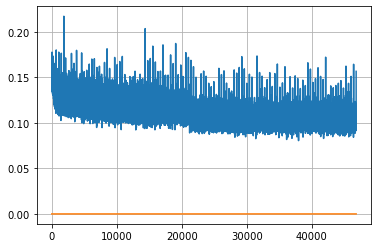

Epoch: 121, iteration 0, loss 0.09877261519432068, cov_diff 0.4172668570312763 cov_diff train 0.4165289385112779
Epoch: 121, iteration 1, loss 0.09467777609825134, cov_diff 0.4137708826990672 cov_diff train 0.41318588512941135
Epoch: 121, iteration 2, loss 0.10828331112861633, cov_diff 0.4244213819563155 cov_diff train 0.4244775905095924
Epoch: 121, iteration 3, loss 0.10318189859390259, cov_diff 0.42068563994746805 cov_diff train 0.4193875822854509
Epoch: 121, iteration 4, loss 0.09243312478065491, cov_diff 0.4054083128010729 cov_diff train 0.4053072909864016
Epoch: 121, iteration 5, loss 0.10344159603118896, cov_diff 0.4379124927627377 cov_diff train 0.4377369509830481
Epoch: 121, iteration 6, loss 0.09893003106117249, cov_diff 0.4212030035189545 cov_diff train 0.42075549056883677
Epoch: 121, iteration 7, loss 0.0950021743774414, cov_diff 0.40338574723119364 cov_diff train 0.40313815432113514
Epoch: 121, iteration 8, loss 0.11175075173377991, cov_diff 0.42062529757364064 cov_diff tra

Epoch: 121, iteration 75, loss 0.10160115361213684, cov_diff 0.41801043214930994 cov_diff train 0.4180947440357302
Epoch: 121, iteration 76, loss 0.10996556282043457, cov_diff 0.40931665854894883 cov_diff train 0.40921156290967964
Epoch: 121, iteration 77, loss 0.09393090009689331, cov_diff 0.4200483700874238 cov_diff train 0.4194369674247436
Epoch: 121, iteration 78, loss 0.10947471857070923, cov_diff 0.43347433762937665 cov_diff train 0.4324328878868231
Epoch: 121, iteration 79, loss 0.10444974899291992, cov_diff 0.42680103024690835 cov_diff train 0.42575096761013925
Epoch: 121, iteration 80, loss 0.09271928668022156, cov_diff 0.41226955325457276 cov_diff train 0.411511109022826
Epoch: 121, iteration 81, loss 0.10016089677810669, cov_diff 0.42350571719101604 cov_diff train 0.422300890286705
Epoch: 121, iteration 82, loss 0.10742488503456116, cov_diff 0.4072025374990321 cov_diff train 0.40735881650793515
Epoch: 121, iteration 83, loss 0.09476476907730103, cov_diff 0.4074491884824192 c

Epoch: 121, iteration 148, loss 0.09744659066200256, cov_diff 0.41709318954715896 cov_diff train 0.4163682584030484
Epoch: 121, iteration 149, loss 0.10548526048660278, cov_diff 0.43072474130530286 cov_diff train 0.42971640940331024
Epoch: 121, iteration 150, loss 0.10356584191322327, cov_diff 0.4207626541653887 cov_diff train 0.4201221810777971
Epoch: 121, iteration 151, loss 0.10333386063575745, cov_diff 0.42021730900413445 cov_diff train 0.41921300787467747
Epoch: 121, iteration 152, loss 0.1014961302280426, cov_diff 0.40756047958884145 cov_diff train 0.4065604674016517
Epoch: 121, iteration 153, loss 0.11745351552963257, cov_diff 0.4252640981205091 cov_diff train 0.42473913695217486
Epoch: 121, iteration 154, loss 0.08456352353096008, cov_diff 0.41353811332289303 cov_diff train 0.41264565598787717
Epoch: 121, iteration 155, loss 0.10338082909584045, cov_diff 0.43154660662906236 cov_diff train 0.43092975369827363
Epoch: 121, iteration 156, loss 0.10473152995109558, cov_diff 0.422337

Epoch: 121, iteration 220, loss 0.10407504439353943, cov_diff 0.4128582102116233 cov_diff train 0.4115143506352249
Epoch: 121, iteration 221, loss 0.10284331440925598, cov_diff 0.4168508213632516 cov_diff train 0.4166473365670331
Epoch: 121, iteration 222, loss 0.11070966720581055, cov_diff 0.4262813975005605 cov_diff train 0.42492814917894844
Epoch: 121, iteration 223, loss 0.09706419706344604, cov_diff 0.40797709623925327 cov_diff train 0.40724277845974244
Epoch: 121, iteration 224, loss 0.11253926157951355, cov_diff 0.430187615235274 cov_diff train 0.4288872488434846
Epoch: 121, iteration 225, loss 0.09272763133049011, cov_diff 0.42881593933849715 cov_diff train 0.42797295258211776
Epoch: 121, iteration 226, loss 0.10639193654060364, cov_diff 0.4232475481855432 cov_diff train 0.42194399268697347
Epoch: 121, iteration 227, loss 0.0889180600643158, cov_diff 0.4174640724039667 cov_diff train 0.4168071912228059
Epoch: 121, iteration 228, loss 0.10643011331558228, cov_diff 0.414125721944

Epoch: 121, iteration 294, loss 0.09525558352470398, cov_diff 0.42758184188946385 cov_diff train 0.42693092025428286
Epoch: 121, iteration 295, loss 0.11581110954284668, cov_diff 0.4203071010352462 cov_diff train 0.4187261631392792
Epoch: 121, iteration 296, loss 0.0978969931602478, cov_diff 0.4147794714118847 cov_diff train 0.41470680073613175
Epoch: 121, iteration 297, loss 0.11600688099861145, cov_diff 0.41938542416984337 cov_diff train 0.41761888640628075
Epoch: 121, iteration 298, loss 0.1083652675151825, cov_diff 0.4136327561258478 cov_diff train 0.41257042975100716
Epoch: 121, iteration 299, loss 0.11569797992706299, cov_diff 0.4274302082011 cov_diff train 0.4266398955193113
Epoch: 121, iteration 300, loss 0.11183035373687744, cov_diff 0.43598151820430603 cov_diff train 0.43440454841506326
Epoch: 121, iteration 301, loss 0.11232468485832214, cov_diff 0.42896169782590593 cov_diff train 0.427555471367498
Epoch: 121, iteration 302, loss 0.10525959730148315, cov_diff 0.4104859381438

Epoch: 121, iteration 368, loss 0.10948652029037476, cov_diff 0.42513590096071413 cov_diff train 0.424254799858649
Epoch: 121, iteration 369, loss 0.10472241044044495, cov_diff 0.4162699454963322 cov_diff train 0.415113829828692
Epoch: 121, iteration 370, loss 0.11252644658088684, cov_diff 0.4251831974559711 cov_diff train 0.4246298320653964
Epoch: 121, iteration 371, loss 0.08923333883285522, cov_diff 0.42695696069671296 cov_diff train 0.42631108071525503
Epoch: 121, iteration 372, loss 0.11625099182128906, cov_diff 0.4288435007667534 cov_diff train 0.42847864117998896
Epoch: 121, iteration 373, loss 0.10424056649208069, cov_diff 0.41784680160080273 cov_diff train 0.41732635633506887
Epoch: 121, iteration 374, loss 0.09837207198143005, cov_diff 0.4167153051817733 cov_diff train 0.4159573243881122
Epoch: 121, iteration 375, loss 0.09689167141914368, cov_diff 0.4050452143960155 cov_diff train 0.40544939042708206
Epoch: 121, iteration 376, loss 0.11021003127098083, cov_diff 0.41804354913

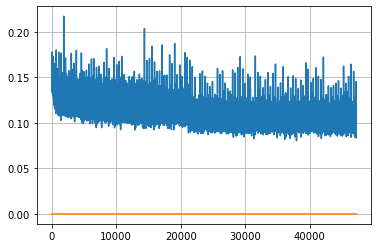

Epoch: 122, iteration 0, loss 0.11767682433128357, cov_diff 0.40655050860026076 cov_diff train 0.4056438261548404
Epoch: 122, iteration 1, loss 0.10137283802032471, cov_diff 0.40661403843607813 cov_diff train 0.4064617735610175
Epoch: 122, iteration 2, loss 0.08958938717842102, cov_diff 0.41064295965072556 cov_diff train 0.41038074421890963
Epoch: 122, iteration 3, loss 0.10944783687591553, cov_diff 0.4109932640513181 cov_diff train 0.41082312452398817
Epoch: 122, iteration 4, loss 0.1108415424823761, cov_diff 0.4235257408526683 cov_diff train 0.4229272842515822
Epoch: 122, iteration 5, loss 0.10879576206207275, cov_diff 0.4189286569160203 cov_diff train 0.4183453411792973
Epoch: 122, iteration 6, loss 0.10777047276496887, cov_diff 0.4104153456034699 cov_diff train 0.41040540662266567
Epoch: 122, iteration 7, loss 0.09972870349884033, cov_diff 0.41464448373918794 cov_diff train 0.41362262007828665
Epoch: 122, iteration 8, loss 0.10017022490501404, cov_diff 0.4245397864808063 cov_diff t

Epoch: 122, iteration 74, loss 0.10537245869636536, cov_diff 0.4129653841857603 cov_diff train 0.4116889609658667
Epoch: 122, iteration 75, loss 0.0958731472492218, cov_diff 0.41576991260174806 cov_diff train 0.41532854087311893
Epoch: 122, iteration 76, loss 0.10215726494789124, cov_diff 0.41200562696405724 cov_diff train 0.4115784359142432
Epoch: 122, iteration 77, loss 0.10166093707084656, cov_diff 0.40516427223064605 cov_diff train 0.40507189681945777
Epoch: 122, iteration 78, loss 0.0958433747291565, cov_diff 0.41263329394972664 cov_diff train 0.41266549905063665
Epoch: 122, iteration 79, loss 0.10900980234146118, cov_diff 0.412840079362714 cov_diff train 0.41130563684530813
Epoch: 122, iteration 80, loss 0.10220760107040405, cov_diff 0.42088728274327886 cov_diff train 0.4205303377270415
Epoch: 122, iteration 81, loss 0.10307762026786804, cov_diff 0.4030719014504252 cov_diff train 0.40191574242552863
Epoch: 122, iteration 82, loss 0.11028444766998291, cov_diff 0.42125112244203994 

Epoch: 122, iteration 152, loss 0.10042339563369751, cov_diff 0.41223609831709906 cov_diff train 0.4115600279843936
Epoch: 122, iteration 153, loss 0.10199308395385742, cov_diff 0.4225017453646874 cov_diff train 0.42235705805597223
Epoch: 122, iteration 154, loss 0.11139672994613647, cov_diff 0.4228593877444307 cov_diff train 0.4223789551152413
Epoch: 122, iteration 155, loss 0.0961950421333313, cov_diff 0.4086665717344107 cov_diff train 0.40819076640140856
Epoch: 122, iteration 156, loss 0.10145607590675354, cov_diff 0.42216175099840375 cov_diff train 0.4218099177108744
Epoch: 122, iteration 157, loss 0.09736493229866028, cov_diff 0.4316469617301318 cov_diff train 0.4306118840448585
Epoch: 122, iteration 158, loss 0.1154104471206665, cov_diff 0.419503410019994 cov_diff train 0.41876306731007323
Epoch: 122, iteration 159, loss 0.09587043523788452, cov_diff 0.40178737628262223 cov_diff train 0.399963183415659
Epoch: 122, iteration 160, loss 0.09962528944015503, cov_diff 0.42460532391845

Epoch: 122, iteration 224, loss 0.11144497990608215, cov_diff 0.4270709655483219 cov_diff train 0.4258991365214371
Epoch: 122, iteration 225, loss 0.10528478026390076, cov_diff 0.41391451366106513 cov_diff train 0.41281389962993414
Epoch: 122, iteration 226, loss 0.10304298996925354, cov_diff 0.4234284537294786 cov_diff train 0.4229120321789826
Epoch: 122, iteration 227, loss 0.10078564286231995, cov_diff 0.4188826611402752 cov_diff train 0.41727939578747647
Epoch: 122, iteration 228, loss 0.11409199237823486, cov_diff 0.4236937749092339 cov_diff train 0.4228210349281965
Epoch: 122, iteration 229, loss 0.10197287797927856, cov_diff 0.41665986957191276 cov_diff train 0.41548872368067824
Epoch: 122, iteration 230, loss 0.10331857204437256, cov_diff 0.42335787826388865 cov_diff train 0.4224905884575429
Epoch: 122, iteration 231, loss 0.10355374217033386, cov_diff 0.42373466278707284 cov_diff train 0.42304010907278156
Epoch: 122, iteration 232, loss 0.11698639392852783, cov_diff 0.41969503

Epoch: 122, iteration 296, loss 0.0941724181175232, cov_diff 0.4135995278773703 cov_diff train 0.41214062683836566
Epoch: 122, iteration 297, loss 0.1049516499042511, cov_diff 0.3980407530197526 cov_diff train 0.39837922926259334
Epoch: 122, iteration 298, loss 0.10450026392936707, cov_diff 0.4119792295679235 cov_diff train 0.4112740267523811
Epoch: 122, iteration 299, loss 0.11964163184165955, cov_diff 0.4358054544060767 cov_diff train 0.4335140804499649
Epoch: 122, iteration 300, loss 0.09953796863555908, cov_diff 0.41533652322817993 cov_diff train 0.4141924033209617
Epoch: 122, iteration 301, loss 0.10168901085853577, cov_diff 0.4163992922803498 cov_diff train 0.4154603181624218
Epoch: 122, iteration 302, loss 0.1130521297454834, cov_diff 0.4295172649873065 cov_diff train 0.42875331810120343
Epoch: 122, iteration 303, loss 0.1002623438835144, cov_diff 0.40848430048364043 cov_diff train 0.4082010150974692
Epoch: 122, iteration 304, loss 0.10048332810401917, cov_diff 0.411738502482641

Epoch: 122, iteration 373, loss 0.10042840242385864, cov_diff 0.4177761038325202 cov_diff train 0.4174647457083117
Epoch: 122, iteration 374, loss 0.11087971925735474, cov_diff 0.43201440205514074 cov_diff train 0.43160111436620074
Epoch: 122, iteration 375, loss 0.09865882992744446, cov_diff 0.4105939722713 cov_diff train 0.4107552416403913
Epoch: 122, iteration 376, loss 0.10136875510215759, cov_diff 0.42921830176056575 cov_diff train 0.42867639522712175
Epoch: 122, iteration 377, loss 0.09049147367477417, cov_diff 0.4194890790488125 cov_diff train 0.4195169782192367
Epoch: 122, iteration 378, loss 0.10367584228515625, cov_diff 0.41371238509463987 cov_diff train 0.41268832700940583
Epoch: 122, iteration 379, loss 0.09434449672698975, cov_diff 0.39963030251764664 cov_diff train 0.3985541020427865
Epoch: 122, iteration 380, loss 0.1092924177646637, cov_diff 0.4234389310846851 cov_diff train 0.4223567270934366
Epoch: 122, iteration 381, loss 0.10707429051399231, cov_diff 0.4069652929846

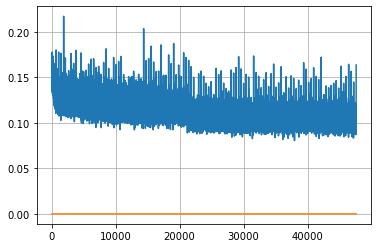

Epoch: 123, iteration 0, loss 0.11776512861251831, cov_diff 0.41474084777176884 cov_diff train 0.4146088531306313
Epoch: 123, iteration 1, loss 0.09480154514312744, cov_diff 0.4232347162468963 cov_diff train 0.4224842355158151
Epoch: 123, iteration 2, loss 0.10475602746009827, cov_diff 0.4207520567605522 cov_diff train 0.41958616781685387
Epoch: 123, iteration 3, loss 0.09721055626869202, cov_diff 0.40400223655021056 cov_diff train 0.40430639703930954
Epoch: 123, iteration 4, loss 0.1106589138507843, cov_diff 0.41214908973986986 cov_diff train 0.41181790957886116
Epoch: 123, iteration 5, loss 0.11913749575614929, cov_diff 0.4169628187467543 cov_diff train 0.41670908167515497
Epoch: 123, iteration 6, loss 0.10635876655578613, cov_diff 0.42374764914433205 cov_diff train 0.4231567036500763
Epoch: 123, iteration 7, loss 0.10703811049461365, cov_diff 0.4344126738899466 cov_diff train 0.43395464143632007
Epoch: 123, iteration 8, loss 0.11036840081214905, cov_diff 0.40347775035968636 cov_diff

Epoch: 123, iteration 79, loss 0.11175355315208435, cov_diff 0.4176371244538911 cov_diff train 0.41669768864262546
Epoch: 123, iteration 80, loss 0.11246272921562195, cov_diff 0.4187568707841341 cov_diff train 0.41855565918360604
Epoch: 123, iteration 81, loss 0.09865885972976685, cov_diff 0.41995155684775154 cov_diff train 0.4192124293650241
Epoch: 123, iteration 82, loss 0.10640028119087219, cov_diff 0.42145515458288824 cov_diff train 0.42006788725792243
Epoch: 123, iteration 83, loss 0.1042114794254303, cov_diff 0.4320670914459829 cov_diff train 0.4309397930471265
Epoch: 123, iteration 84, loss 0.0974712073802948, cov_diff 0.42216255259540647 cov_diff train 0.42163409625773873
Epoch: 123, iteration 85, loss 0.10673511028289795, cov_diff 0.41835900904083084 cov_diff train 0.4176332321751756
Epoch: 123, iteration 86, loss 0.09300804138183594, cov_diff 0.41998806753439644 cov_diff train 0.41955395504601467
Epoch: 123, iteration 87, loss 0.10567399859428406, cov_diff 0.42069806060422854

Epoch: 123, iteration 154, loss 0.10419106483459473, cov_diff 0.43256056815361354 cov_diff train 0.4311860695733742
Epoch: 123, iteration 155, loss 0.09865781664848328, cov_diff 0.43787126181382163 cov_diff train 0.4368073576748368
Epoch: 123, iteration 156, loss 0.09565731883049011, cov_diff 0.42089344759263575 cov_diff train 0.4201013070208392
Epoch: 123, iteration 157, loss 0.10757455229759216, cov_diff 0.4227099798680758 cov_diff train 0.4222418935764501
Epoch: 123, iteration 158, loss 0.1106836199760437, cov_diff 0.4233007990323825 cov_diff train 0.422367399450833
Epoch: 123, iteration 159, loss 0.11031734943389893, cov_diff 0.4189038464852586 cov_diff train 0.4175748572124091
Epoch: 123, iteration 160, loss 0.10758048295974731, cov_diff 0.41687234154838126 cov_diff train 0.41615403129796935
Epoch: 123, iteration 161, loss 0.09723812341690063, cov_diff 0.422294964266724 cov_diff train 0.4207288811460765
Epoch: 123, iteration 162, loss 0.09866884350776672, cov_diff 0.42362101368445

Epoch: 123, iteration 227, loss 0.10932061076164246, cov_diff 0.43045183048464436 cov_diff train 0.4299704774182097
Epoch: 123, iteration 228, loss 0.10120579600334167, cov_diff 0.41937053269703645 cov_diff train 0.41824325997279066
Epoch: 123, iteration 229, loss 0.11538010835647583, cov_diff 0.4250787748454047 cov_diff train 0.42526893513855984
Epoch: 123, iteration 230, loss 0.09784534573554993, cov_diff 0.4248656170303786 cov_diff train 0.4237804098617758
Epoch: 123, iteration 231, loss 0.11385312676429749, cov_diff 0.41243237254163007 cov_diff train 0.41136561260518323
Epoch: 123, iteration 232, loss 0.09920462965965271, cov_diff 0.41863329309984243 cov_diff train 0.4178438975000751
Epoch: 123, iteration 233, loss 0.10508853197097778, cov_diff 0.4212124158370276 cov_diff train 0.42038703134167626
Epoch: 123, iteration 234, loss 0.10478252172470093, cov_diff 0.41769366990038787 cov_diff train 0.4175320083023702
Epoch: 123, iteration 235, loss 0.11572611331939697, cov_diff 0.4073771

Epoch: 123, iteration 306, loss 0.10403069853782654, cov_diff 0.4001247992626823 cov_diff train 0.40021309479663275
Epoch: 123, iteration 307, loss 0.10831916332244873, cov_diff 0.41024474834900904 cov_diff train 0.4099509747293143
Epoch: 123, iteration 308, loss 0.10626184940338135, cov_diff 0.4308807092863016 cov_diff train 0.4298044338012803
Epoch: 123, iteration 309, loss 0.1033024787902832, cov_diff 0.40478663307607476 cov_diff train 0.40465179706471605
Epoch: 123, iteration 310, loss 0.09256476163864136, cov_diff 0.41657960053973236 cov_diff train 0.4160846685575137
Epoch: 123, iteration 311, loss 0.10630679130554199, cov_diff 0.4181968947760859 cov_diff train 0.41830605491031486
Epoch: 123, iteration 312, loss 0.1066724956035614, cov_diff 0.4146109541219049 cov_diff train 0.4148748972613854
Epoch: 123, iteration 313, loss 0.09709250926971436, cov_diff 0.42504035178367744 cov_diff train 0.4244917123956677
Epoch: 123, iteration 314, loss 0.10388857126235962, cov_diff 0.41864858513

Epoch: 123, iteration 388, loss 0.10318616032600403, cov_diff 0.4067269331356444 cov_diff train 0.406369227366835
Epoch: 123, iteration 389, loss 0.1015981137752533, cov_diff 0.4135196557594335 cov_diff train 0.412407143915025
Epoch: 123, iteration 390, loss 0.13884159922599792, cov_diff 0.46273515416183214 cov_diff train 0.4608548532976998


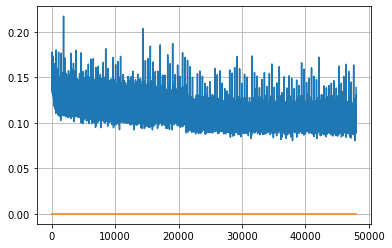

Epoch: 124, iteration 0, loss 0.10453367233276367, cov_diff 0.41945287266566406 cov_diff train 0.4191081437123972
Epoch: 124, iteration 1, loss 0.1102653443813324, cov_diff 0.416902161805003 cov_diff train 0.41744735876508166
Epoch: 124, iteration 2, loss 0.11198863387107849, cov_diff 0.41380965833289124 cov_diff train 0.41317481653358495
Epoch: 124, iteration 3, loss 0.10792315006256104, cov_diff 0.4056780260679338 cov_diff train 0.4049865744854086
Epoch: 124, iteration 4, loss 0.09736260771751404, cov_diff 0.4258206463087862 cov_diff train 0.4258583744012001
Epoch: 124, iteration 5, loss 0.09844809770584106, cov_diff 0.43138453162834395 cov_diff train 0.43099197255674054
Epoch: 124, iteration 6, loss 0.1140241026878357, cov_diff 0.4216740485914099 cov_diff train 0.4215432040226181
Epoch: 124, iteration 7, loss 0.10764506459236145, cov_diff 0.42928920439798296 cov_diff train 0.4281650594250218
Epoch: 124, iteration 8, loss 0.10007357597351074, cov_diff 0.4165881830681861 cov_diff trai

Epoch: 124, iteration 79, loss 0.09785786271095276, cov_diff 0.4079426577635541 cov_diff train 0.4076028385329004
Epoch: 124, iteration 80, loss 0.10023176670074463, cov_diff 0.42616008069965056 cov_diff train 0.4257610205199452
Epoch: 124, iteration 81, loss 0.10507658123970032, cov_diff 0.42329820306459937 cov_diff train 0.422958404647955
Epoch: 124, iteration 82, loss 0.10125425457954407, cov_diff 0.42802950723645355 cov_diff train 0.4279079896951581
Epoch: 124, iteration 83, loss 0.1194847822189331, cov_diff 0.4256008927257325 cov_diff train 0.4254891183802622
Epoch: 124, iteration 84, loss 0.09267064929008484, cov_diff 0.41400391417210974 cov_diff train 0.413051035811699
Epoch: 124, iteration 85, loss 0.09971275925636292, cov_diff 0.43191998278188665 cov_diff train 0.43017856561053697
Epoch: 124, iteration 86, loss 0.0990380346775055, cov_diff 0.4145027487966786 cov_diff train 0.41407021001428174
Epoch: 124, iteration 87, loss 0.10099735856056213, cov_diff 0.4113258528347376 cov_d

Epoch: 124, iteration 152, loss 0.09366658329963684, cov_diff 0.4089994975587117 cov_diff train 0.4094276177839177
Epoch: 124, iteration 153, loss 0.11063620448112488, cov_diff 0.4178136061349122 cov_diff train 0.41600770243533075
Epoch: 124, iteration 154, loss 0.10383465886116028, cov_diff 0.41720130050336807 cov_diff train 0.4175478092847592
Epoch: 124, iteration 155, loss 0.11544013023376465, cov_diff 0.4275425912573744 cov_diff train 0.426582225636246
Epoch: 124, iteration 156, loss 0.09996989369392395, cov_diff 0.42272888692105404 cov_diff train 0.42203875555580744
Epoch: 124, iteration 157, loss 0.1029505729675293, cov_diff 0.41926606225787894 cov_diff train 0.41802571029608626
Epoch: 124, iteration 158, loss 0.09625154733657837, cov_diff 0.42157355617070424 cov_diff train 0.42108097427370655
Epoch: 124, iteration 159, loss 0.10755869746208191, cov_diff 0.4166825634018011 cov_diff train 0.41563548287869834
Epoch: 124, iteration 160, loss 0.10839685797691345, cov_diff 0.415134458

Epoch: 124, iteration 226, loss 0.10913676023483276, cov_diff 0.40426800757585696 cov_diff train 0.4033104404887426
Epoch: 124, iteration 227, loss 0.09628775715827942, cov_diff 0.4198333449787156 cov_diff train 0.4194779086854396
Epoch: 124, iteration 228, loss 0.11732110381126404, cov_diff 0.425401534830963 cov_diff train 0.4246540900131767
Epoch: 124, iteration 229, loss 0.09745350480079651, cov_diff 0.4114708509673127 cov_diff train 0.41109466621309576
Epoch: 124, iteration 230, loss 0.10661923885345459, cov_diff 0.4217128659960938 cov_diff train 0.4212759394068051
Epoch: 124, iteration 231, loss 0.0902387797832489, cov_diff 0.404339117914874 cov_diff train 0.4039133642805785
Epoch: 124, iteration 232, loss 0.11090636253356934, cov_diff 0.43590575011707355 cov_diff train 0.4347501473032784
Epoch: 124, iteration 233, loss 0.10081282258033752, cov_diff 0.4165953889997422 cov_diff train 0.41646472407800494
Epoch: 124, iteration 234, loss 0.1027597188949585, cov_diff 0.4083672663274942

Epoch: 124, iteration 299, loss 0.10525345802307129, cov_diff 0.4087682280740248 cov_diff train 0.40919011036552577
Epoch: 124, iteration 300, loss 0.09808909893035889, cov_diff 0.4181763639470254 cov_diff train 0.41742391668237805
Epoch: 124, iteration 301, loss 0.11981311440467834, cov_diff 0.4295012655258621 cov_diff train 0.42900751964748046
Epoch: 124, iteration 302, loss 0.0983307957649231, cov_diff 0.4166110539234326 cov_diff train 0.41564618900247746
Epoch: 124, iteration 303, loss 0.09661003947257996, cov_diff 0.42624757800745156 cov_diff train 0.4255706441983164
Epoch: 124, iteration 304, loss 0.11130842566490173, cov_diff 0.4140437735494066 cov_diff train 0.41310978813291716
Epoch: 124, iteration 305, loss 0.0995364785194397, cov_diff 0.41593587399204607 cov_diff train 0.41458083439117
Epoch: 124, iteration 306, loss 0.10011494159698486, cov_diff 0.4133147267170165 cov_diff train 0.4124144728207932
Epoch: 124, iteration 307, loss 0.10014781355857849, cov_diff 0.4131791158038

Epoch: 124, iteration 372, loss 0.11703833937644958, cov_diff 0.4215209112430214 cov_diff train 0.4213403858901587
Epoch: 124, iteration 373, loss 0.1016370952129364, cov_diff 0.4120127959698804 cov_diff train 0.4116025626903466
Epoch: 124, iteration 374, loss 0.11282500624656677, cov_diff 0.4289956868667924 cov_diff train 0.42806000952732465
Epoch: 124, iteration 375, loss 0.11203929781913757, cov_diff 0.4147885637009518 cov_diff train 0.4143876292405828
Epoch: 124, iteration 376, loss 0.11572039127349854, cov_diff 0.4081724174386256 cov_diff train 0.4080764174249835
Epoch: 124, iteration 377, loss 0.08831441402435303, cov_diff 0.42277073431263434 cov_diff train 0.4222155839954239
Epoch: 124, iteration 378, loss 0.09333372116088867, cov_diff 0.4042257374270485 cov_diff train 0.40419779619350354
Epoch: 124, iteration 379, loss 0.10315859317779541, cov_diff 0.4106965487239518 cov_diff train 0.4107736564995994
Epoch: 124, iteration 380, loss 0.10317930579185486, cov_diff 0.43423220918919

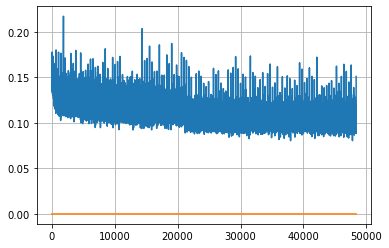

Epoch: 125, iteration 0, loss 0.09898903965950012, cov_diff 0.42020799383832347 cov_diff train 0.419209584475349
Epoch: 125, iteration 1, loss 0.1139327883720398, cov_diff 0.421379102981524 cov_diff train 0.42154532153425156
Epoch: 125, iteration 2, loss 0.09581741690635681, cov_diff 0.42412384408872333 cov_diff train 0.4237562139827425
Epoch: 125, iteration 3, loss 0.10166668891906738, cov_diff 0.4118026448262905 cov_diff train 0.4107483134850151
Epoch: 125, iteration 4, loss 0.11540672183036804, cov_diff 0.419885752600251 cov_diff train 0.4188807667569483
Epoch: 125, iteration 5, loss 0.10208070278167725, cov_diff 0.4175755908707639 cov_diff train 0.41697448770609824
Epoch: 125, iteration 6, loss 0.11193123459815979, cov_diff 0.43177035729294966 cov_diff train 0.4312836724945102
Epoch: 125, iteration 7, loss 0.10586073994636536, cov_diff 0.42669122962405576 cov_diff train 0.4266272013645736
Epoch: 125, iteration 8, loss 0.10242164134979248, cov_diff 0.4222363943363732 cov_diff train 

Epoch: 125, iteration 72, loss 0.11104962229728699, cov_diff 0.42556039438921356 cov_diff train 0.4255677765473695
Epoch: 125, iteration 73, loss 0.11085164546966553, cov_diff 0.4288050838281284 cov_diff train 0.4283498940253121
Epoch: 125, iteration 74, loss 0.10368072986602783, cov_diff 0.4273491680849889 cov_diff train 0.42696679817454186
Epoch: 125, iteration 75, loss 0.09454372525215149, cov_diff 0.4100081101799776 cov_diff train 0.4098093493676399
Epoch: 125, iteration 76, loss 0.11508771777153015, cov_diff 0.40887647840244795 cov_diff train 0.4080012882350497
Epoch: 125, iteration 77, loss 0.10990476608276367, cov_diff 0.4137440013574857 cov_diff train 0.41342297002727835
Epoch: 125, iteration 78, loss 0.09866020083427429, cov_diff 0.4070975647950239 cov_diff train 0.40657753012862563
Epoch: 125, iteration 79, loss 0.10910114645957947, cov_diff 0.42666662291301444 cov_diff train 0.4254560768564736
Epoch: 125, iteration 80, loss 0.11124292016029358, cov_diff 0.4222281117550295 co

Epoch: 125, iteration 149, loss 0.11213770508766174, cov_diff 0.43564617181922755 cov_diff train 0.43531161873794133
Epoch: 125, iteration 150, loss 0.10481217503547668, cov_diff 0.4093948702586202 cov_diff train 0.40914888100706875
Epoch: 125, iteration 151, loss 0.10195821523666382, cov_diff 0.41269814669580657 cov_diff train 0.4126153705234337
Epoch: 125, iteration 152, loss 0.1010051965713501, cov_diff 0.42149623353023336 cov_diff train 0.4212961364637821
Epoch: 125, iteration 153, loss 0.1061326265335083, cov_diff 0.4107885224945231 cov_diff train 0.41053852671610574
Epoch: 125, iteration 154, loss 0.10308626294136047, cov_diff 0.40859784824685846 cov_diff train 0.41015516284724124
Epoch: 125, iteration 155, loss 0.10395058989524841, cov_diff 0.4110440641460534 cov_diff train 0.4112855399093823
Epoch: 125, iteration 156, loss 0.10681617259979248, cov_diff 0.424029868270942 cov_diff train 0.4234352579363709
Epoch: 125, iteration 157, loss 0.09942859411239624, cov_diff 0.41343001014

Epoch: 125, iteration 228, loss 0.11346614360809326, cov_diff 0.43202815719385673 cov_diff train 0.43143176624730184
Epoch: 125, iteration 229, loss 0.11128848791122437, cov_diff 0.4124917486932692 cov_diff train 0.41214493693682963
Epoch: 125, iteration 230, loss 0.0975680947303772, cov_diff 0.4279434331369191 cov_diff train 0.4265753984591881
Epoch: 125, iteration 231, loss 0.10120347142219543, cov_diff 0.41642870601232856 cov_diff train 0.41596601903822694
Epoch: 125, iteration 232, loss 0.09984186291694641, cov_diff 0.42440728204482114 cov_diff train 0.4243806615052396
Epoch: 125, iteration 233, loss 0.09613680839538574, cov_diff 0.4152119395277437 cov_diff train 0.41473126780699876
Epoch: 125, iteration 234, loss 0.10976141691207886, cov_diff 0.4236249863270776 cov_diff train 0.42298526227182115
Epoch: 125, iteration 235, loss 0.10205814242362976, cov_diff 0.4130659521804996 cov_diff train 0.41193570210830566
Epoch: 125, iteration 236, loss 0.11586055159568787, cov_diff 0.42706783

Epoch: 125, iteration 307, loss 0.10167467594146729, cov_diff 0.4211778272690439 cov_diff train 0.42019936929096613
Epoch: 125, iteration 308, loss 0.10664728283882141, cov_diff 0.4159462091245455 cov_diff train 0.41577717308809203
Epoch: 125, iteration 309, loss 0.09911572933197021, cov_diff 0.40543017380155294 cov_diff train 0.4050214449107806
Epoch: 125, iteration 310, loss 0.09052431583404541, cov_diff 0.4190222620119925 cov_diff train 0.41780132739617115
Epoch: 125, iteration 311, loss 0.10529953241348267, cov_diff 0.4100509057924946 cov_diff train 0.40897007582392775
Epoch: 125, iteration 312, loss 0.100333571434021, cov_diff 0.42182138763680016 cov_diff train 0.4223092592849257
Epoch: 125, iteration 313, loss 0.1026487648487091, cov_diff 0.41393932453855636 cov_diff train 0.41332116658769874
Epoch: 125, iteration 314, loss 0.10857221484184265, cov_diff 0.4133466138622941 cov_diff train 0.4130419830365903
Epoch: 125, iteration 315, loss 0.11830422282218933, cov_diff 0.41121446423

Epoch: 125, iteration 385, loss 0.10915157198905945, cov_diff 0.4064031892360501 cov_diff train 0.405782682567926
Epoch: 125, iteration 386, loss 0.09578609466552734, cov_diff 0.42404236122619626 cov_diff train 0.42291277428869745
Epoch: 125, iteration 387, loss 0.11564120650291443, cov_diff 0.4229050695652082 cov_diff train 0.4213951548553195
Epoch: 125, iteration 388, loss 0.10905647277832031, cov_diff 0.4092107291801102 cov_diff train 0.40783719669183643
Epoch: 125, iteration 389, loss 0.10409262776374817, cov_diff 0.4178071190835827 cov_diff train 0.41745931196080543
Epoch: 125, iteration 390, loss 0.17549192905426025, cov_diff 0.45672559680875646 cov_diff train 0.4563389893519634


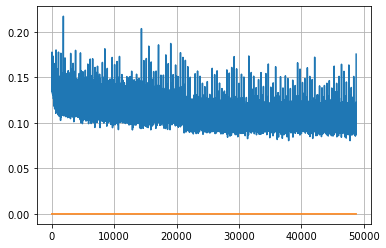

Epoch: 126, iteration 0, loss 0.10600197315216064, cov_diff 0.4033072631386489 cov_diff train 0.4024270738494591
Epoch: 126, iteration 1, loss 0.10835173726081848, cov_diff 0.4068488264535417 cov_diff train 0.40687548875155205
Epoch: 126, iteration 2, loss 0.10656780004501343, cov_diff 0.43107434045859466 cov_diff train 0.43118524801613506
Epoch: 126, iteration 3, loss 0.114259272813797, cov_diff 0.43561596719794954 cov_diff train 0.43515945062697614
Epoch: 126, iteration 4, loss 0.10536235570907593, cov_diff 0.4050987276712468 cov_diff train 0.4057817386324496
Epoch: 126, iteration 5, loss 0.10032033920288086, cov_diff 0.40843181222631614 cov_diff train 0.4085499045520172
Epoch: 126, iteration 6, loss 0.09809380769729614, cov_diff 0.421903272542006 cov_diff train 0.42237071267521437
Epoch: 126, iteration 7, loss 0.10956725478172302, cov_diff 0.41924642750430957 cov_diff train 0.419503783088355
Epoch: 126, iteration 8, loss 0.10975202918052673, cov_diff 0.42402777519525053 cov_diff tra

Epoch: 126, iteration 79, loss 0.10180526971817017, cov_diff 0.4189591576201153 cov_diff train 0.4188724572572022
Epoch: 126, iteration 80, loss 0.0961209237575531, cov_diff 0.4245872751000621 cov_diff train 0.42407192118969844
Epoch: 126, iteration 81, loss 0.09803980588912964, cov_diff 0.41827218055303184 cov_diff train 0.4175390637041042
Epoch: 126, iteration 82, loss 0.1051073670387268, cov_diff 0.4252367056939697 cov_diff train 0.423939570249261
Epoch: 126, iteration 83, loss 0.11363828182220459, cov_diff 0.42667183996075686 cov_diff train 0.42572673504111
Epoch: 126, iteration 84, loss 0.10248428583145142, cov_diff 0.42468371998237814 cov_diff train 0.4241154144568442
Epoch: 126, iteration 85, loss 0.1101541817188263, cov_diff 0.418332747077309 cov_diff train 0.4183121295072275
Epoch: 126, iteration 86, loss 0.10526061058044434, cov_diff 0.4110109905054031 cov_diff train 0.41086140337418686
Epoch: 126, iteration 87, loss 0.10681682825088501, cov_diff 0.4240346944331304 cov_diff t

Epoch: 126, iteration 158, loss 0.10820752382278442, cov_diff 0.40868798807070383 cov_diff train 0.40838537926574503
Epoch: 126, iteration 159, loss 0.09889879822731018, cov_diff 0.4150660656006869 cov_diff train 0.41457241570565223
Epoch: 126, iteration 160, loss 0.10818833112716675, cov_diff 0.4264919320650204 cov_diff train 0.426140198345915
Epoch: 126, iteration 161, loss 0.09634831547737122, cov_diff 0.42342761574768745 cov_diff train 0.42278697457139225
Epoch: 126, iteration 162, loss 0.09470587968826294, cov_diff 0.41525514915605694 cov_diff train 0.4147233053016969
Epoch: 126, iteration 163, loss 0.11338433623313904, cov_diff 0.43176884505680424 cov_diff train 0.430958791024545
Epoch: 126, iteration 164, loss 0.11318886280059814, cov_diff 0.40817328930639885 cov_diff train 0.40752783818182364
Epoch: 126, iteration 165, loss 0.1049150824546814, cov_diff 0.42439573999584246 cov_diff train 0.4236553353140576
Epoch: 126, iteration 166, loss 0.10002210736274719, cov_diff 0.414701739

Epoch: 126, iteration 236, loss 0.09180605411529541, cov_diff 0.42349270573921255 cov_diff train 0.4229745148789165
Epoch: 126, iteration 237, loss 0.1327483355998993, cov_diff 0.41877482825044154 cov_diff train 0.4181920008231838
Epoch: 126, iteration 238, loss 0.10950967669487, cov_diff 0.40651537397587084 cov_diff train 0.40626863406627645
Epoch: 126, iteration 239, loss 0.09443268179893494, cov_diff 0.4165481066151542 cov_diff train 0.4159006122354086
Epoch: 126, iteration 240, loss 0.10538360476493835, cov_diff 0.4336780912095712 cov_diff train 0.43316480646676775
Epoch: 126, iteration 241, loss 0.09823328256607056, cov_diff 0.42750199906854597 cov_diff train 0.4266001185673721
Epoch: 126, iteration 242, loss 0.09648916125297546, cov_diff 0.40277115809345 cov_diff train 0.40213775290566794
Epoch: 126, iteration 243, loss 0.09958326816558838, cov_diff 0.42443841369794244 cov_diff train 0.423767079302945
Epoch: 126, iteration 244, loss 0.10423755645751953, cov_diff 0.416610255416857

Epoch: 126, iteration 315, loss 0.1092522144317627, cov_diff 0.4185644282729902 cov_diff train 0.4172870674655872
Epoch: 126, iteration 316, loss 0.10065990686416626, cov_diff 0.41731788835772626 cov_diff train 0.41672148820401367
Epoch: 126, iteration 317, loss 0.10536259412765503, cov_diff 0.41692533201021925 cov_diff train 0.4148586149023775
Epoch: 126, iteration 318, loss 0.1053362786769867, cov_diff 0.4214884103601146 cov_diff train 0.42113082800055696
Epoch: 126, iteration 319, loss 0.09734651446342468, cov_diff 0.42182156719402153 cov_diff train 0.42140243366462116
Epoch: 126, iteration 320, loss 0.11596521735191345, cov_diff 0.41403450509449813 cov_diff train 0.41287590553617065
Epoch: 126, iteration 321, loss 0.10096240043640137, cov_diff 0.4083845092786156 cov_diff train 0.4080818243651693
Epoch: 126, iteration 322, loss 0.11607524752616882, cov_diff 0.4139723815734647 cov_diff train 0.413972549722123
Epoch: 126, iteration 323, loss 0.10584357380867004, cov_diff 0.41326989725

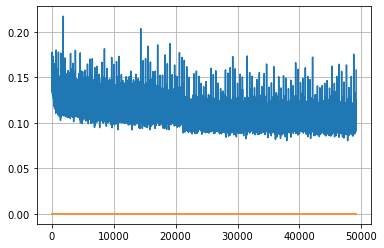

Epoch: 127, iteration 0, loss 0.09259647130966187, cov_diff 0.4304541340647152 cov_diff train 0.430358727714395
Epoch: 127, iteration 1, loss 0.10485082864761353, cov_diff 0.4261238875369387 cov_diff train 0.42559767751384914
Epoch: 127, iteration 2, loss 0.10402202606201172, cov_diff 0.4207967927012193 cov_diff train 0.42010753791939387
Epoch: 127, iteration 3, loss 0.10439854860305786, cov_diff 0.42070091291707096 cov_diff train 0.4202124352264697
Epoch: 127, iteration 4, loss 0.09446051716804504, cov_diff 0.41943976079036244 cov_diff train 0.4188351973689366
Epoch: 127, iteration 5, loss 0.10955819487571716, cov_diff 0.4244752834214665 cov_diff train 0.4224743071391513
Epoch: 127, iteration 6, loss 0.10720598697662354, cov_diff 0.4290607136097863 cov_diff train 0.42819234573997944
Epoch: 127, iteration 7, loss 0.10391390323638916, cov_diff 0.4178781432750511 cov_diff train 0.4174606436436017
Epoch: 127, iteration 8, loss 0.10636407136917114, cov_diff 0.4246213478742442 cov_diff trai

Epoch: 127, iteration 77, loss 0.10501962900161743, cov_diff 0.4049956799685013 cov_diff train 0.4048813672183677
Epoch: 127, iteration 78, loss 0.09916621446609497, cov_diff 0.415898535138334 cov_diff train 0.4147637023574377
Epoch: 127, iteration 79, loss 0.10971453785896301, cov_diff 0.41913192089252477 cov_diff train 0.41803889942116523
Epoch: 127, iteration 80, loss 0.10460540652275085, cov_diff 0.4163474113832399 cov_diff train 0.41457280693758214
Epoch: 127, iteration 81, loss 0.1024104654788971, cov_diff 0.4285336149942828 cov_diff train 0.4278152807010309
Epoch: 127, iteration 82, loss 0.10461995005607605, cov_diff 0.42548425927322137 cov_diff train 0.42478549106986774
Epoch: 127, iteration 83, loss 0.0987710952758789, cov_diff 0.4149467695911317 cov_diff train 0.4146792865700174
Epoch: 127, iteration 84, loss 0.10156255960464478, cov_diff 0.4174210337597168 cov_diff train 0.41713655812419087
Epoch: 127, iteration 85, loss 0.11040371656417847, cov_diff 0.42031670920491654 cov_

Epoch: 127, iteration 154, loss 0.10757747292518616, cov_diff 0.41859784298363756 cov_diff train 0.41818710174539775
Epoch: 127, iteration 155, loss 0.1006353497505188, cov_diff 0.4069778379841033 cov_diff train 0.4058589660069927
Epoch: 127, iteration 156, loss 0.10092613101005554, cov_diff 0.4233937483130004 cov_diff train 0.42218511387014435
Epoch: 127, iteration 157, loss 0.10511991381645203, cov_diff 0.42438643620713074 cov_diff train 0.4241090340624361
Epoch: 127, iteration 158, loss 0.09897777438163757, cov_diff 0.4207819211734201 cov_diff train 0.4200960653444664
Epoch: 127, iteration 159, loss 0.10202321410179138, cov_diff 0.4256903201276462 cov_diff train 0.4255533635942984
Epoch: 127, iteration 160, loss 0.11049595475196838, cov_diff 0.41891221274096935 cov_diff train 0.41858154838935974
Epoch: 127, iteration 161, loss 0.10070854425430298, cov_diff 0.3987438827665408 cov_diff train 0.39822024426387964
Epoch: 127, iteration 162, loss 0.10464823246002197, cov_diff 0.4163791614

Epoch: 127, iteration 234, loss 0.09999442100524902, cov_diff 0.41276850808881577 cov_diff train 0.41119767712437605
Epoch: 127, iteration 235, loss 0.0959414541721344, cov_diff 0.4168909972406818 cov_diff train 0.41660237247638515
Epoch: 127, iteration 236, loss 0.11142677068710327, cov_diff 0.40406346711474106 cov_diff train 0.40366789984696944
Epoch: 127, iteration 237, loss 0.10807177424430847, cov_diff 0.4218017041114036 cov_diff train 0.4209280215253061
Epoch: 127, iteration 238, loss 0.10355201363563538, cov_diff 0.4199423716481703 cov_diff train 0.41964925899770933
Epoch: 127, iteration 239, loss 0.09157654643058777, cov_diff 0.411670313083959 cov_diff train 0.4116845274392318
Epoch: 127, iteration 240, loss 0.10314640402793884, cov_diff 0.4214715590058044 cov_diff train 0.4203162466033053
Epoch: 127, iteration 241, loss 0.0965791642665863, cov_diff 0.41203913985105894 cov_diff train 0.41186213358056184
Epoch: 127, iteration 242, loss 0.10379448533058167, cov_diff 0.41328793432

Epoch: 127, iteration 311, loss 0.10851249098777771, cov_diff 0.4129619917560377 cov_diff train 0.4121103561757484
Epoch: 127, iteration 312, loss 0.09415379166603088, cov_diff 0.43586389305645645 cov_diff train 0.43584827545402677
Epoch: 127, iteration 313, loss 0.09985655546188354, cov_diff 0.4168172351512555 cov_diff train 0.41550465670651865
Epoch: 127, iteration 314, loss 0.1113547682762146, cov_diff 0.4184885039338817 cov_diff train 0.4182338527370938
Epoch: 127, iteration 315, loss 0.10612115263938904, cov_diff 0.41726017212326827 cov_diff train 0.4172807360847919
Epoch: 127, iteration 316, loss 0.10017016530036926, cov_diff 0.4264931001035193 cov_diff train 0.4264413838883571
Epoch: 127, iteration 317, loss 0.10946106910705566, cov_diff 0.4121870478079286 cov_diff train 0.4116362394477728
Epoch: 127, iteration 318, loss 0.10060453414916992, cov_diff 0.410217052503096 cov_diff train 0.41036574875766024
Epoch: 127, iteration 319, loss 0.11059728264808655, cov_diff 0.4279300650361

Epoch: 127, iteration 382, loss 0.09702354669570923, cov_diff 0.41699866431308413 cov_diff train 0.4169943759522143
Epoch: 127, iteration 383, loss 0.10425466299057007, cov_diff 0.4232866416330454 cov_diff train 0.4220475785634099
Epoch: 127, iteration 384, loss 0.10879573225975037, cov_diff 0.4224250917536068 cov_diff train 0.42167195572952115
Epoch: 127, iteration 385, loss 0.10546642541885376, cov_diff 0.42756528034628927 cov_diff train 0.4273810235917575
Epoch: 127, iteration 386, loss 0.09154123067855835, cov_diff 0.4149151247546726 cov_diff train 0.41444667314213884
Epoch: 127, iteration 387, loss 0.10857522487640381, cov_diff 0.4136668013586888 cov_diff train 0.4136048905251374
Epoch: 127, iteration 388, loss 0.10689705610275269, cov_diff 0.4150553082334287 cov_diff train 0.41495413143379895
Epoch: 127, iteration 389, loss 0.10128659009933472, cov_diff 0.41631847451996506 cov_diff train 0.4162513117226975
Epoch: 127, iteration 390, loss 0.1646663248538971, cov_diff 0.46369612712

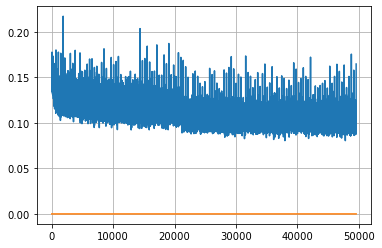

Epoch: 128, iteration 0, loss 0.09917116165161133, cov_diff 0.41534410720542453 cov_diff train 0.4149297982478914
Epoch: 128, iteration 1, loss 0.10758447647094727, cov_diff 0.4176496146173232 cov_diff train 0.4178671292556908
Epoch: 128, iteration 2, loss 0.10357922315597534, cov_diff 0.42474620114899175 cov_diff train 0.42399371123758334
Epoch: 128, iteration 3, loss 0.10749903321266174, cov_diff 0.4152636678014204 cov_diff train 0.41567329427022776
Epoch: 128, iteration 4, loss 0.1051502525806427, cov_diff 0.4127282077053503 cov_diff train 0.41210460690953227
Epoch: 128, iteration 5, loss 0.10830572247505188, cov_diff 0.41104450285028826 cov_diff train 0.4110934374354259
Epoch: 128, iteration 6, loss 0.09802901744842529, cov_diff 0.4126395102517944 cov_diff train 0.4122839040799127
Epoch: 128, iteration 7, loss 0.10761985182762146, cov_diff 0.4162481329718971 cov_diff train 0.4156886684875516
Epoch: 128, iteration 8, loss 0.10620620846748352, cov_diff 0.42746835220829094 cov_diff tr

Epoch: 128, iteration 78, loss 0.10024428367614746, cov_diff 0.42370222398357726 cov_diff train 0.42254395092435754
Epoch: 128, iteration 79, loss 0.0943363606929779, cov_diff 0.4197936681056324 cov_diff train 0.4190414851369132
Epoch: 128, iteration 80, loss 0.1004210114479065, cov_diff 0.4127917677037381 cov_diff train 0.41209398044742773
Epoch: 128, iteration 81, loss 0.11189651489257812, cov_diff 0.43384264290940927 cov_diff train 0.43306495333646017
Epoch: 128, iteration 82, loss 0.1029386818408966, cov_diff 0.4286913186089254 cov_diff train 0.4275483796456155
Epoch: 128, iteration 83, loss 0.1079886257648468, cov_diff 0.41972878326307805 cov_diff train 0.4183714629594125
Epoch: 128, iteration 84, loss 0.1112433671951294, cov_diff 0.42194144979693704 cov_diff train 0.4210262312874542
Epoch: 128, iteration 85, loss 0.10585126280784607, cov_diff 0.4291690635632272 cov_diff train 0.4285067326624923
Epoch: 128, iteration 86, loss 0.09513485431671143, cov_diff 0.4203008669896618 cov_di

Epoch: 128, iteration 156, loss 0.09733462333679199, cov_diff 0.42185069689229104 cov_diff train 0.4213523030825838
Epoch: 128, iteration 157, loss 0.1026773452758789, cov_diff 0.424731904416282 cov_diff train 0.42439420729387767
Epoch: 128, iteration 158, loss 0.10454314947128296, cov_diff 0.4240137453471146 cov_diff train 0.4226594175748421
Epoch: 128, iteration 159, loss 0.10611152648925781, cov_diff 0.4241353192326401 cov_diff train 0.4235263433576048
Epoch: 128, iteration 160, loss 0.10284921526908875, cov_diff 0.4094717497338878 cov_diff train 0.4090493818772264
Epoch: 128, iteration 161, loss 0.11008849740028381, cov_diff 0.40994616849900783 cov_diff train 0.4097194113066144
Epoch: 128, iteration 162, loss 0.10885557532310486, cov_diff 0.40208725322353606 cov_diff train 0.4025141491494541
Epoch: 128, iteration 163, loss 0.10027042031288147, cov_diff 0.41857077535030895 cov_diff train 0.4181884840950698
Epoch: 128, iteration 164, loss 0.11405190825462341, cov_diff 0.4246547286710

Epoch: 128, iteration 234, loss 0.11244726181030273, cov_diff 0.41019093686742486 cov_diff train 0.4087541388060708
Epoch: 128, iteration 235, loss 0.11031022667884827, cov_diff 0.43197918695675547 cov_diff train 0.4309259364263388
Epoch: 128, iteration 236, loss 0.11331295967102051, cov_diff 0.41670150143253737 cov_diff train 0.4161979878362557
Epoch: 128, iteration 237, loss 0.1108572781085968, cov_diff 0.4077476364011424 cov_diff train 0.4078258896992816
Epoch: 128, iteration 238, loss 0.10796132683753967, cov_diff 0.4224990483782397 cov_diff train 0.42212920996232767
Epoch: 128, iteration 239, loss 0.09726917743682861, cov_diff 0.4180475945924801 cov_diff train 0.41643070643227564
Epoch: 128, iteration 240, loss 0.10924974083900452, cov_diff 0.4209889097919797 cov_diff train 0.4204190645115805
Epoch: 128, iteration 241, loss 0.10280701518058777, cov_diff 0.40662557214484535 cov_diff train 0.40560774955695206
Epoch: 128, iteration 242, loss 0.11659175157546997, cov_diff 0.4233261441

Epoch: 128, iteration 311, loss 0.09376493096351624, cov_diff 0.4226360655155178 cov_diff train 0.4222627125649628
Epoch: 128, iteration 312, loss 0.10442736744880676, cov_diff 0.4162232363547411 cov_diff train 0.41546274953545886
Epoch: 128, iteration 313, loss 0.11097705364227295, cov_diff 0.42137176518979136 cov_diff train 0.4200131786876263
Epoch: 128, iteration 314, loss 0.10059773921966553, cov_diff 0.41729217955051007 cov_diff train 0.4169480422821845
Epoch: 128, iteration 315, loss 0.10773283243179321, cov_diff 0.4219614927693036 cov_diff train 0.4209703790453272
Epoch: 128, iteration 316, loss 0.10190609097480774, cov_diff 0.41302696490272517 cov_diff train 0.412870445313783
Epoch: 128, iteration 317, loss 0.10679218173027039, cov_diff 0.4125428387815135 cov_diff train 0.4124786999078286
Epoch: 128, iteration 318, loss 0.10180279612541199, cov_diff 0.408773217656965 cov_diff train 0.40885035417322807
Epoch: 128, iteration 319, loss 0.09833934903144836, cov_diff 0.4089194209302

Epoch: 128, iteration 389, loss 0.10212752223014832, cov_diff 0.4164374188022013 cov_diff train 0.4158826031430928
Epoch: 128, iteration 390, loss 0.15434220433235168, cov_diff 0.45569283379774206 cov_diff train 0.4560725610955303


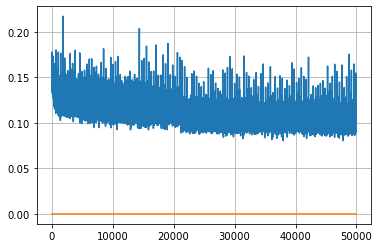

Epoch: 129, iteration 0, loss 0.10402387380599976, cov_diff 0.41957484944047563 cov_diff train 0.4197801989314007
Epoch: 129, iteration 1, loss 0.11336013674736023, cov_diff 0.42015355296040663 cov_diff train 0.420229741685697
Epoch: 129, iteration 2, loss 0.09593015909194946, cov_diff 0.42388056516267897 cov_diff train 0.4237877766950368
Epoch: 129, iteration 3, loss 0.10247176885604858, cov_diff 0.41885214169174684 cov_diff train 0.4179290150246633
Epoch: 129, iteration 4, loss 0.10249647498130798, cov_diff 0.42362336854834737 cov_diff train 0.4234248581159123
Epoch: 129, iteration 5, loss 0.10709580779075623, cov_diff 0.43986246619177427 cov_diff train 0.4393253657565909
Epoch: 129, iteration 6, loss 0.10592308640480042, cov_diff 0.41921700729619726 cov_diff train 0.4188818940655332
Epoch: 129, iteration 7, loss 0.10104373097419739, cov_diff 0.4374192200923143 cov_diff train 0.43683666693501094
Epoch: 129, iteration 8, loss 0.09883728623390198, cov_diff 0.4316739912404869 cov_diff t

Epoch: 129, iteration 77, loss 0.09496685862541199, cov_diff 0.4233598290347019 cov_diff train 0.42241599735223073
Epoch: 129, iteration 78, loss 0.09680056571960449, cov_diff 0.41666207847379433 cov_diff train 0.41644211991983815
Epoch: 129, iteration 79, loss 0.10290607810020447, cov_diff 0.41905788244474457 cov_diff train 0.41849320767435244
Epoch: 129, iteration 80, loss 0.10988584160804749, cov_diff 0.40885652094650754 cov_diff train 0.40804308327436245
Epoch: 129, iteration 81, loss 0.100587397813797, cov_diff 0.4207369035069552 cov_diff train 0.4194830862125713
Epoch: 129, iteration 82, loss 0.10728862881660461, cov_diff 0.42516979663453497 cov_diff train 0.4248281300565509
Epoch: 129, iteration 83, loss 0.09923887252807617, cov_diff 0.42749416700139575 cov_diff train 0.42708119664455785
Epoch: 129, iteration 84, loss 0.10805052518844604, cov_diff 0.42083898722715096 cov_diff train 0.41998402378816235
Epoch: 129, iteration 85, loss 0.11174982786178589, cov_diff 0.416129309783237

Epoch: 129, iteration 154, loss 0.10507822036743164, cov_diff 0.4075563942900022 cov_diff train 0.40707948428355695
Epoch: 129, iteration 155, loss 0.10024905204772949, cov_diff 0.4184861230902581 cov_diff train 0.4178399590965054
Epoch: 129, iteration 156, loss 0.10976696014404297, cov_diff 0.4128852588778223 cov_diff train 0.41208315304194754
Epoch: 129, iteration 157, loss 0.10920464992523193, cov_diff 0.41607189985964044 cov_diff train 0.4161165829641189
Epoch: 129, iteration 158, loss 0.10995268821716309, cov_diff 0.4021655923432942 cov_diff train 0.4019251032129498
Epoch: 129, iteration 159, loss 0.11648368835449219, cov_diff 0.4243262163523672 cov_diff train 0.4239030105487355
Epoch: 129, iteration 160, loss 0.1124822199344635, cov_diff 0.4188047976697536 cov_diff train 0.4190433818569858
Epoch: 129, iteration 161, loss 0.10143741965293884, cov_diff 0.42359278280844415 cov_diff train 0.42328804161239736
Epoch: 129, iteration 162, loss 0.10651424527168274, cov_diff 0.418536990014

Epoch: 129, iteration 231, loss 0.10082948207855225, cov_diff 0.4246754280221646 cov_diff train 0.42461923859930434
Epoch: 129, iteration 232, loss 0.10412910580635071, cov_diff 0.4181387826078628 cov_diff train 0.4177090761027598
Epoch: 129, iteration 233, loss 0.10536757111549377, cov_diff 0.40092324029942944 cov_diff train 0.400905127185747
Epoch: 129, iteration 234, loss 0.09844982624053955, cov_diff 0.41322889205986935 cov_diff train 0.41276268116763154
Epoch: 129, iteration 235, loss 0.10097897052764893, cov_diff 0.42243929533635793 cov_diff train 0.42165099082128144
Epoch: 129, iteration 236, loss 0.09614956378936768, cov_diff 0.4311008206843929 cov_diff train 0.4301134269800645
Epoch: 129, iteration 237, loss 0.09940508008003235, cov_diff 0.4155185224796659 cov_diff train 0.41394353320222865
Epoch: 129, iteration 238, loss 0.10225453972816467, cov_diff 0.41189326501891066 cov_diff train 0.41147444844964737
Epoch: 129, iteration 239, loss 0.10706335306167603, cov_diff 0.41506522

Epoch: 129, iteration 308, loss 0.1113964319229126, cov_diff 0.40917891756636976 cov_diff train 0.4090885331873122
Epoch: 129, iteration 309, loss 0.09658408164978027, cov_diff 0.40442035954138605 cov_diff train 0.4046735132228524
Epoch: 129, iteration 310, loss 0.0951642394065857, cov_diff 0.41422126892141586 cov_diff train 0.41390811096071667
Epoch: 129, iteration 311, loss 0.10439050197601318, cov_diff 0.4132574829983164 cov_diff train 0.41225153774805506
Epoch: 129, iteration 312, loss 0.10563546419143677, cov_diff 0.41295443339977317 cov_diff train 0.4130196950136353
Epoch: 129, iteration 313, loss 0.09446120262145996, cov_diff 0.42930767336494396 cov_diff train 0.4274079517971032
Epoch: 129, iteration 314, loss 0.10841727256774902, cov_diff 0.4095519928567372 cov_diff train 0.4104031669857958
Epoch: 129, iteration 315, loss 0.11772552132606506, cov_diff 0.4160586135910143 cov_diff train 0.4154398601049187
Epoch: 129, iteration 316, loss 0.10978424549102783, cov_diff 0.40888556292

Epoch: 129, iteration 384, loss 0.09641844034194946, cov_diff 0.4071601855871489 cov_diff train 0.40615704295462657
Epoch: 129, iteration 385, loss 0.11895081400871277, cov_diff 0.41101892751755753 cov_diff train 0.40894709092015297
Epoch: 129, iteration 386, loss 0.1072443425655365, cov_diff 0.41626684752178456 cov_diff train 0.4145948254529208
Epoch: 129, iteration 387, loss 0.11967495083808899, cov_diff 0.42105879201934326 cov_diff train 0.42079613367081353
Epoch: 129, iteration 388, loss 0.10944297909736633, cov_diff 0.4107165463870935 cov_diff train 0.40910682758010997
Epoch: 129, iteration 389, loss 0.09456503391265869, cov_diff 0.42128686814685445 cov_diff train 0.42081797180625163
Epoch: 129, iteration 390, loss 0.1564539074897766, cov_diff 0.4649002604372934 cov_diff train 0.46452215008652936


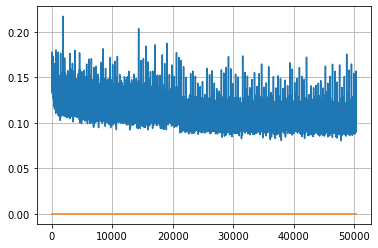

Epoch: 130, iteration 0, loss 0.09520700573921204, cov_diff 0.43132810029370705 cov_diff train 0.4296387034978476
Epoch: 130, iteration 1, loss 0.10730129480361938, cov_diff 0.420686772237124 cov_diff train 0.42120880056409116
Epoch: 130, iteration 2, loss 0.10538092255592346, cov_diff 0.42822197957091584 cov_diff train 0.42867679406272396
Epoch: 130, iteration 3, loss 0.10128840804100037, cov_diff 0.4089206067371829 cov_diff train 0.40888609239758833
Epoch: 130, iteration 4, loss 0.10903581976890564, cov_diff 0.42741468884090505 cov_diff train 0.42703619358000494
Epoch: 130, iteration 5, loss 0.11073750257492065, cov_diff 0.4205475433023226 cov_diff train 0.4198958799826182
Epoch: 130, iteration 6, loss 0.10258501768112183, cov_diff 0.4214558733160714 cov_diff train 0.42143122260458027
Epoch: 130, iteration 7, loss 0.10238748788833618, cov_diff 0.42453813715819394 cov_diff train 0.4242821242313868
Epoch: 130, iteration 8, loss 0.10190421342849731, cov_diff 0.4296228208454432 cov_diff 

Epoch: 130, iteration 78, loss 0.11142444610595703, cov_diff 0.4095050401163491 cov_diff train 0.40710596800329935
Epoch: 130, iteration 79, loss 0.09420812129974365, cov_diff 0.41150210968942436 cov_diff train 0.4109084038496601
Epoch: 130, iteration 80, loss 0.11654865741729736, cov_diff 0.43513286911303606 cov_diff train 0.43306393751778177
Epoch: 130, iteration 81, loss 0.10552117228507996, cov_diff 0.4057091209653174 cov_diff train 0.40541701627580184
Epoch: 130, iteration 82, loss 0.09995734691619873, cov_diff 0.41338674629191396 cov_diff train 0.41301897248592934
Epoch: 130, iteration 83, loss 0.10275924205780029, cov_diff 0.43070277266426493 cov_diff train 0.4298248746770033
Epoch: 130, iteration 84, loss 0.09963583946228027, cov_diff 0.4055527513740052 cov_diff train 0.40495800793990055
Epoch: 130, iteration 85, loss 0.1020512580871582, cov_diff 0.4118265248858171 cov_diff train 0.4111793548274314
Epoch: 130, iteration 86, loss 0.1112247109413147, cov_diff 0.41127077445884347 

Epoch: 130, iteration 157, loss 0.10498881340026855, cov_diff 0.4162922303991277 cov_diff train 0.4150212036560829
Epoch: 130, iteration 158, loss 0.10876935720443726, cov_diff 0.4251517251191561 cov_diff train 0.4246174658471319
Epoch: 130, iteration 159, loss 0.10289683938026428, cov_diff 0.42534385143248277 cov_diff train 0.42462137384323595
Epoch: 130, iteration 160, loss 0.09642624855041504, cov_diff 0.41479290567975546 cov_diff train 0.4138973070757091
Epoch: 130, iteration 161, loss 0.10735657811164856, cov_diff 0.41116442468641545 cov_diff train 0.41069395224405386
Epoch: 130, iteration 162, loss 0.10785090923309326, cov_diff 0.4155108604712269 cov_diff train 0.41522917217107946
Epoch: 130, iteration 163, loss 0.0990075170993805, cov_diff 0.41831015574327785 cov_diff train 0.4174085037855539
Epoch: 130, iteration 164, loss 0.10845229029655457, cov_diff 0.40641211736327454 cov_diff train 0.405656618002877
Epoch: 130, iteration 165, loss 0.12078025937080383, cov_diff 0.4144990690

Epoch: 130, iteration 233, loss 0.09039086103439331, cov_diff 0.417871715798991 cov_diff train 0.41771065796399265
Epoch: 130, iteration 234, loss 0.10722130537033081, cov_diff 0.4231025633196917 cov_diff train 0.4226579296255348
Epoch: 130, iteration 235, loss 0.10632127523422241, cov_diff 0.4120550641403491 cov_diff train 0.4113527810795994
Epoch: 130, iteration 236, loss 0.11222755908966064, cov_diff 0.4211850958365093 cov_diff train 0.42048564654948173
Epoch: 130, iteration 237, loss 0.10650956630706787, cov_diff 0.4257198969069176 cov_diff train 0.4252220311218952
Epoch: 130, iteration 238, loss 0.1116931140422821, cov_diff 0.42455697631651007 cov_diff train 0.42378244448662244
Epoch: 130, iteration 239, loss 0.08648142218589783, cov_diff 0.40880318740547184 cov_diff train 0.40792650291165783
Epoch: 130, iteration 240, loss 0.09475579857826233, cov_diff 0.42851045434540835 cov_diff train 0.42771809239747594
Epoch: 130, iteration 241, loss 0.10944175720214844, cov_diff 0.4177035040

Epoch: 130, iteration 312, loss 0.1015680730342865, cov_diff 0.42545077498738293 cov_diff train 0.4248319263234736
Epoch: 130, iteration 313, loss 0.09753242135047913, cov_diff 0.43725307782478157 cov_diff train 0.4369117197311296
Epoch: 130, iteration 314, loss 0.1075202226638794, cov_diff 0.41351055401638864 cov_diff train 0.41308390914630244
Epoch: 130, iteration 315, loss 0.10412430763244629, cov_diff 0.41571685564918026 cov_diff train 0.415401702187769
Epoch: 130, iteration 316, loss 0.09537583589553833, cov_diff 0.40393831561084775 cov_diff train 0.40288911162824664
Epoch: 130, iteration 317, loss 0.10974058508872986, cov_diff 0.4039820281631526 cov_diff train 0.40286628329835733
Epoch: 130, iteration 318, loss 0.11738550662994385, cov_diff 0.42590927364759973 cov_diff train 0.42436027125076037
Epoch: 130, iteration 319, loss 0.11817175149917603, cov_diff 0.4186060361434359 cov_diff train 0.41717379168051055
Epoch: 130, iteration 320, loss 0.08829140663146973, cov_diff 0.41865877

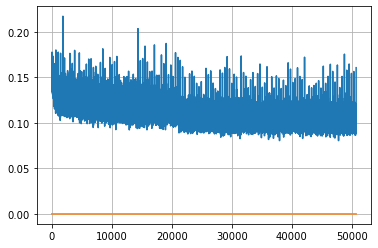

Epoch: 131, iteration 0, loss 0.1060294508934021, cov_diff 0.4147134786723138 cov_diff train 0.4140093980993605
Epoch: 131, iteration 1, loss 0.09013286232948303, cov_diff 0.41850220759146356 cov_diff train 0.41728374184601463
Epoch: 131, iteration 2, loss 0.10810881853103638, cov_diff 0.4173238434314586 cov_diff train 0.4171018900855827
Epoch: 131, iteration 3, loss 0.09233808517456055, cov_diff 0.4165618065831743 cov_diff train 0.41652216561349653
Epoch: 131, iteration 4, loss 0.1073063313961029, cov_diff 0.40734967020659674 cov_diff train 0.4064748999535003
Epoch: 131, iteration 5, loss 0.11363029479980469, cov_diff 0.43346927583576256 cov_diff train 0.43305857857005964
Epoch: 131, iteration 6, loss 0.10321056842803955, cov_diff 0.41059347118479567 cov_diff train 0.4101422231865312
Epoch: 131, iteration 7, loss 0.11060208082199097, cov_diff 0.4227324446961077 cov_diff train 0.42239467736216657
Epoch: 131, iteration 8, loss 0.11135336756706238, cov_diff 0.41270665828036046 cov_diff t

Epoch: 131, iteration 79, loss 0.1069696843624115, cov_diff 0.42467984155185357 cov_diff train 0.4234883849152822
Epoch: 131, iteration 80, loss 0.10712215304374695, cov_diff 0.43062274681029106 cov_diff train 0.42978843547322493
Epoch: 131, iteration 81, loss 0.10086145997047424, cov_diff 0.4201569252343878 cov_diff train 0.41970186575373836
Epoch: 131, iteration 82, loss 0.09555459022521973, cov_diff 0.40354100405726673 cov_diff train 0.4031266380508684
Epoch: 131, iteration 83, loss 0.10408523678779602, cov_diff 0.41930523489108856 cov_diff train 0.418490369777615
Epoch: 131, iteration 84, loss 0.10387164354324341, cov_diff 0.4296388940845153 cov_diff train 0.42785557143104563
Epoch: 131, iteration 85, loss 0.08992969989776611, cov_diff 0.41041546603246054 cov_diff train 0.4102549544439879
Epoch: 131, iteration 86, loss 0.11430895328521729, cov_diff 0.4192656153395873 cov_diff train 0.4181573077950504
Epoch: 131, iteration 87, loss 0.10668593645095825, cov_diff 0.4154730719609067 co

Epoch: 131, iteration 158, loss 0.10558003187179565, cov_diff 0.4003537904814495 cov_diff train 0.40055167300156164
Epoch: 131, iteration 159, loss 0.10835880041122437, cov_diff 0.42178344753205366 cov_diff train 0.4213778238838782
Epoch: 131, iteration 160, loss 0.0960899293422699, cov_diff 0.40487423594668576 cov_diff train 0.40497925025729786
Epoch: 131, iteration 161, loss 0.10689765214920044, cov_diff 0.4360675367247508 cov_diff train 0.4355665499485304
Epoch: 131, iteration 162, loss 0.11375400424003601, cov_diff 0.40905753140186385 cov_diff train 0.40881397283652293
Epoch: 131, iteration 163, loss 0.11062204837799072, cov_diff 0.4097894034971292 cov_diff train 0.40921409613806936
Epoch: 131, iteration 164, loss 0.10559141635894775, cov_diff 0.43161876964976675 cov_diff train 0.4310847913818005
Epoch: 131, iteration 165, loss 0.100404292345047, cov_diff 0.41737930073921115 cov_diff train 0.4166617145738684
Epoch: 131, iteration 166, loss 0.09539297223091125, cov_diff 0.4040370388

Epoch: 131, iteration 236, loss 0.11767438054084778, cov_diff 0.423976417627981 cov_diff train 0.4239549202263147
Epoch: 131, iteration 237, loss 0.10962706804275513, cov_diff 0.41067796780918714 cov_diff train 0.40954512777974034
Epoch: 131, iteration 238, loss 0.10063907504081726, cov_diff 0.40574991796044846 cov_diff train 0.40656592276720127
Epoch: 131, iteration 239, loss 0.10468316078186035, cov_diff 0.41309910112696274 cov_diff train 0.4135131218446138
Epoch: 131, iteration 240, loss 0.11332181096076965, cov_diff 0.42249780935258463 cov_diff train 0.422496144594785
Epoch: 131, iteration 241, loss 0.10414311289787292, cov_diff 0.3948874702488789 cov_diff train 0.395524587283798
Epoch: 131, iteration 242, loss 0.10159677267074585, cov_diff 0.44419545076500305 cov_diff train 0.44383984504398694
Epoch: 131, iteration 243, loss 0.1093633770942688, cov_diff 0.4277018430355898 cov_diff train 0.4273877977487227
Epoch: 131, iteration 244, loss 0.09438925981521606, cov_diff 0.416284147248

Epoch: 131, iteration 313, loss 0.108854740858078, cov_diff 0.4183680964511723 cov_diff train 0.4170862578850244
Epoch: 131, iteration 314, loss 0.10269498825073242, cov_diff 0.42361967609734763 cov_diff train 0.4233757884411399
Epoch: 131, iteration 315, loss 0.10573601722717285, cov_diff 0.4290714335598925 cov_diff train 0.42854752267698126
Epoch: 131, iteration 316, loss 0.11160245537757874, cov_diff 0.4226520791577713 cov_diff train 0.42213925620812204
Epoch: 131, iteration 317, loss 0.10142314434051514, cov_diff 0.41036192876106437 cov_diff train 0.40898398841477646
Epoch: 131, iteration 318, loss 0.09626108407974243, cov_diff 0.4092052386891139 cov_diff train 0.40828611527730074
Epoch: 131, iteration 319, loss 0.1004490852355957, cov_diff 0.4147062193525861 cov_diff train 0.4144813805353991
Epoch: 131, iteration 320, loss 0.09122768044471741, cov_diff 0.43237458920129807 cov_diff train 0.432029630866506
Epoch: 131, iteration 321, loss 0.11036774516105652, cov_diff 0.4246430654619

Epoch: 131, iteration 390, loss 0.1626722514629364, cov_diff 0.4427425108181464 cov_diff train 0.4425656332289494


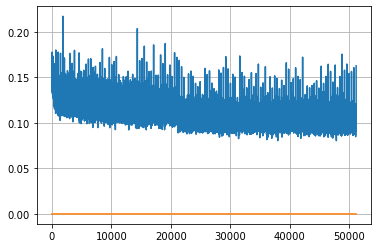

Epoch: 132, iteration 0, loss 0.1126624047756195, cov_diff 0.41374823594115306 cov_diff train 0.4136265611910311
Epoch: 132, iteration 1, loss 0.09248378872871399, cov_diff 0.4169111208404711 cov_diff train 0.4159128916951912
Epoch: 132, iteration 2, loss 0.10514166951179504, cov_diff 0.4135322422862431 cov_diff train 0.4133549804121192
Epoch: 132, iteration 3, loss 0.10589316487312317, cov_diff 0.4196763333902967 cov_diff train 0.41988636160346093
Epoch: 132, iteration 4, loss 0.09771597385406494, cov_diff 0.4091975764704532 cov_diff train 0.4082792416892965
Epoch: 132, iteration 5, loss 0.11038771271705627, cov_diff 0.40840581786921804 cov_diff train 0.40855190516100665
Epoch: 132, iteration 6, loss 0.09532719850540161, cov_diff 0.41694995901976 cov_diff train 0.4163264368465213
Epoch: 132, iteration 7, loss 0.10945826768875122, cov_diff 0.42425248094813095 cov_diff train 0.42412135471885276
Epoch: 132, iteration 8, loss 0.10692799091339111, cov_diff 0.4192072607969257 cov_diff train

Epoch: 132, iteration 81, loss 0.09041628241539001, cov_diff 0.4255280834319077 cov_diff train 0.4251951722847986
Epoch: 132, iteration 82, loss 0.10017451643943787, cov_diff 0.40679271364622605 cov_diff train 0.40568526730340393
Epoch: 132, iteration 83, loss 0.10072579979896545, cov_diff 0.4111986888143009 cov_diff train 0.4116286214911063
Epoch: 132, iteration 84, loss 0.11356309056282043, cov_diff 0.4194558354791898 cov_diff train 0.41926139425952036
Epoch: 132, iteration 85, loss 0.1019582748413086, cov_diff 0.4205677728008301 cov_diff train 0.4202078480328898
Epoch: 132, iteration 86, loss 0.11183381080627441, cov_diff 0.4251359758470168 cov_diff train 0.42472534071264234
Epoch: 132, iteration 87, loss 0.10704633593559265, cov_diff 0.4244346272839993 cov_diff train 0.4244649081669662
Epoch: 132, iteration 88, loss 0.10321629047393799, cov_diff 0.41993237382318993 cov_diff train 0.41917518672912385
Epoch: 132, iteration 89, loss 0.11144664883613586, cov_diff 0.40449328631238646 co

Epoch: 132, iteration 158, loss 0.09320312738418579, cov_diff 0.422923190859326 cov_diff train 0.42175051881924513
Epoch: 132, iteration 159, loss 0.10032603144645691, cov_diff 0.41785066319418146 cov_diff train 0.4164480944291879
Epoch: 132, iteration 160, loss 0.0957745611667633, cov_diff 0.41626267025643665 cov_diff train 0.41576022960337644
Epoch: 132, iteration 161, loss 0.1044543981552124, cov_diff 0.4099130266359197 cov_diff train 0.40956614231714095
Epoch: 132, iteration 162, loss 0.09327980875968933, cov_diff 0.4151559417120423 cov_diff train 0.41472495591225267
Epoch: 132, iteration 163, loss 0.1016959547996521, cov_diff 0.4129417903165156 cov_diff train 0.4125875111027442
Epoch: 132, iteration 164, loss 0.10575717687606812, cov_diff 0.4311556341932522 cov_diff train 0.43087983641349104
Epoch: 132, iteration 165, loss 0.10228943824768066, cov_diff 0.4149023614284029 cov_diff train 0.41389706097078693
Epoch: 132, iteration 166, loss 0.09560763835906982, cov_diff 0.433261533971

Epoch: 132, iteration 235, loss 0.09945207834243774, cov_diff 0.43367849732329444 cov_diff train 0.43212920101049734
Epoch: 132, iteration 236, loss 0.1044137179851532, cov_diff 0.410266853396555 cov_diff train 0.4094040087257369
Epoch: 132, iteration 237, loss 0.11098402738571167, cov_diff 0.4091204821222323 cov_diff train 0.408015524340534
Epoch: 132, iteration 238, loss 0.11009621620178223, cov_diff 0.4140630706707447 cov_diff train 0.41269762247797537
Epoch: 132, iteration 239, loss 0.09440791606903076, cov_diff 0.4062198705389522 cov_diff train 0.406027275179332
Epoch: 132, iteration 240, loss 0.1005973219871521, cov_diff 0.4304218750940348 cov_diff train 0.43003699968203496
Epoch: 132, iteration 241, loss 0.10647720098495483, cov_diff 0.43054272211735756 cov_diff train 0.42924193654809306
Epoch: 132, iteration 242, loss 0.09640127420425415, cov_diff 0.3992840220353655 cov_diff train 0.39877101619883853
Epoch: 132, iteration 243, loss 0.09876960515975952, cov_diff 0.40951844876372

Epoch: 132, iteration 312, loss 0.09227034449577332, cov_diff 0.4256009044567633 cov_diff train 0.4239078974206258
Epoch: 132, iteration 313, loss 0.10031679272651672, cov_diff 0.4173405492769163 cov_diff train 0.4162481897278075
Epoch: 132, iteration 314, loss 0.10090383887290955, cov_diff 0.4024530718511891 cov_diff train 0.4013263522423483
Epoch: 132, iteration 315, loss 0.10313236713409424, cov_diff 0.4151984163792952 cov_diff train 0.4139750337123169
Epoch: 132, iteration 316, loss 0.10204091668128967, cov_diff 0.4035829128893715 cov_diff train 0.4030501067540917
Epoch: 132, iteration 317, loss 0.10338526964187622, cov_diff 0.41320602309855686 cov_diff train 0.41293608352835526
Epoch: 132, iteration 318, loss 0.10020768642425537, cov_diff 0.4181090941439644 cov_diff train 0.4175214975030411
Epoch: 132, iteration 319, loss 0.10867196321487427, cov_diff 0.40865872668086534 cov_diff train 0.4075442874002774
Epoch: 132, iteration 320, loss 0.10306638479232788, cov_diff 0.4157530425579

Epoch: 132, iteration 389, loss 0.1143595278263092, cov_diff 0.41594074141208587 cov_diff train 0.4151806082993798
Epoch: 132, iteration 390, loss 0.17477506399154663, cov_diff 0.4608811708022859 cov_diff train 0.46139045316536886


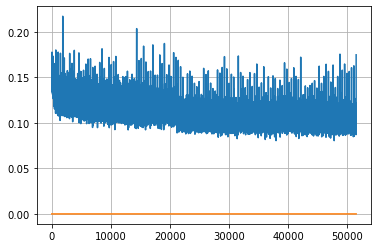

Epoch: 133, iteration 0, loss 0.10410135984420776, cov_diff 0.41903060361067584 cov_diff train 0.419098375223124
Epoch: 133, iteration 1, loss 0.10317721962928772, cov_diff 0.4047810422848688 cov_diff train 0.40522545006791205
Epoch: 133, iteration 2, loss 0.11360946297645569, cov_diff 0.40740718669083476 cov_diff train 0.406954433416512
Epoch: 133, iteration 3, loss 0.10922908782958984, cov_diff 0.4177312560972602 cov_diff train 0.417350105345454
Epoch: 133, iteration 4, loss 0.09979197382926941, cov_diff 0.4207978464424113 cov_diff train 0.4202069107692516
Epoch: 133, iteration 5, loss 0.10615402460098267, cov_diff 0.43123135067539775 cov_diff train 0.4309141565279298
Epoch: 133, iteration 6, loss 0.10559120774269104, cov_diff 0.42415895063952147 cov_diff train 0.42403223457904216
Epoch: 133, iteration 7, loss 0.10597234964370728, cov_diff 0.4255330338722207 cov_diff train 0.4253424191566078
Epoch: 133, iteration 8, loss 0.10558795928955078, cov_diff 0.4170960511310942 cov_diff train

Epoch: 133, iteration 77, loss 0.10019207000732422, cov_diff 0.4141306793896412 cov_diff train 0.4137346395987191
Epoch: 133, iteration 78, loss 0.09710270166397095, cov_diff 0.4098048960643977 cov_diff train 0.4086997265050572
Epoch: 133, iteration 79, loss 0.09325551986694336, cov_diff 0.41030706747203904 cov_diff train 0.4098212036823775
Epoch: 133, iteration 80, loss 0.0949259102344513, cov_diff 0.40569998203267527 cov_diff train 0.40523784519890227
Epoch: 133, iteration 81, loss 0.09546992182731628, cov_diff 0.4148791812084834 cov_diff train 0.41426572191487193
Epoch: 133, iteration 82, loss 0.09994062781333923, cov_diff 0.4084860790708539 cov_diff train 0.4079530119276062
Epoch: 133, iteration 83, loss 0.10105085372924805, cov_diff 0.40797667673952603 cov_diff train 0.4078759288308897
Epoch: 133, iteration 84, loss 0.10030311346054077, cov_diff 0.4141227267451191 cov_diff train 0.4148833251537517
Epoch: 133, iteration 85, loss 0.11095786094665527, cov_diff 0.4281563549944971 cov_

Epoch: 133, iteration 154, loss 0.09830647706985474, cov_diff 0.43331211877015213 cov_diff train 0.43140280720790497
Epoch: 133, iteration 155, loss 0.11036625504493713, cov_diff 0.4133763097298821 cov_diff train 0.41306263449800124
Epoch: 133, iteration 156, loss 0.1105596125125885, cov_diff 0.4198294761984744 cov_diff train 0.4192613148764993
Epoch: 133, iteration 157, loss 0.10500168800354004, cov_diff 0.4172368259553182 cov_diff train 0.41576023454882144
Epoch: 133, iteration 158, loss 0.09753769636154175, cov_diff 0.3981123031067366 cov_diff train 0.39788735158422006
Epoch: 133, iteration 159, loss 0.11004406213760376, cov_diff 0.42503039279224264 cov_diff train 0.42381075167669974
Epoch: 133, iteration 160, loss 0.12085521221160889, cov_diff 0.42378242812686445 cov_diff train 0.4230523316540007
Epoch: 133, iteration 161, loss 0.1080007255077362, cov_diff 0.4128985810101706 cov_diff train 0.41271970962366217
Epoch: 133, iteration 162, loss 0.0960114598274231, cov_diff 0.4097457624

Epoch: 133, iteration 231, loss 0.10270553827285767, cov_diff 0.3966267690131492 cov_diff train 0.39565856683543904
Epoch: 133, iteration 232, loss 0.10075774788856506, cov_diff 0.4173452559101068 cov_diff train 0.4171451193467486
Epoch: 133, iteration 233, loss 0.09596443176269531, cov_diff 0.4314168688607689 cov_diff train 0.43106802286510304
Epoch: 133, iteration 234, loss 0.11626619100570679, cov_diff 0.4145993026078438 cov_diff train 0.41369805042485897
Epoch: 133, iteration 235, loss 0.11003917455673218, cov_diff 0.42524340059802557 cov_diff train 0.4253094529356668
Epoch: 133, iteration 236, loss 0.11350703239440918, cov_diff 0.4258640438072633 cov_diff train 0.4256530646006494
Epoch: 133, iteration 237, loss 0.1068572998046875, cov_diff 0.4307300155614109 cov_diff train 0.4302926210107423
Epoch: 133, iteration 238, loss 0.10295474529266357, cov_diff 0.4086841393648512 cov_diff train 0.40861074447899676
Epoch: 133, iteration 239, loss 0.10111817717552185, cov_diff 0.424528814914

Epoch: 133, iteration 308, loss 0.10098135471343994, cov_diff 0.4394369506605223 cov_diff train 0.43830262487978644
Epoch: 133, iteration 309, loss 0.09882965683937073, cov_diff 0.42264607118196107 cov_diff train 0.4221244983112948
Epoch: 133, iteration 310, loss 0.10931017994880676, cov_diff 0.41837171465861006 cov_diff train 0.4180013159418719
Epoch: 133, iteration 311, loss 0.11096101999282837, cov_diff 0.41136358972242887 cov_diff train 0.4100570425152663
Epoch: 133, iteration 312, loss 0.11813127994537354, cov_diff 0.43331285107588063 cov_diff train 0.4327128835667416
Epoch: 133, iteration 313, loss 0.09966126084327698, cov_diff 0.41027868062796524 cov_diff train 0.40895989593775667
Epoch: 133, iteration 314, loss 0.1090502142906189, cov_diff 0.41800510447536693 cov_diff train 0.41630282410970726
Epoch: 133, iteration 315, loss 0.10990798473358154, cov_diff 0.40862368091855655 cov_diff train 0.4078366157308871
Epoch: 133, iteration 316, loss 0.0982600748538971, cov_diff 0.41219983

Epoch: 133, iteration 385, loss 0.09957247972488403, cov_diff 0.4225358021818507 cov_diff train 0.42264039442800194
Epoch: 133, iteration 386, loss 0.09819969534873962, cov_diff 0.41471535179468366 cov_diff train 0.41408415435251195
Epoch: 133, iteration 387, loss 0.10038524866104126, cov_diff 0.4200190628757462 cov_diff train 0.419224647006672
Epoch: 133, iteration 388, loss 0.10157895088195801, cov_diff 0.4240100944995683 cov_diff train 0.4236083792957599
Epoch: 133, iteration 389, loss 0.10069283843040466, cov_diff 0.4298756252583743 cov_diff train 0.4291971973589025
Epoch: 133, iteration 390, loss 0.1300724744796753, cov_diff 0.44266983699202855 cov_diff train 0.4419046151497097


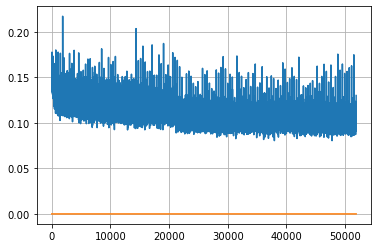

Epoch: 134, iteration 0, loss 0.10403558611869812, cov_diff 0.4223678301214288 cov_diff train 0.4214128132353634
Epoch: 134, iteration 1, loss 0.11273527145385742, cov_diff 0.4240584538628005 cov_diff train 0.42373262995780087
Epoch: 134, iteration 2, loss 0.09577590227127075, cov_diff 0.42488882154865326 cov_diff train 0.42435045250868314
Epoch: 134, iteration 3, loss 0.10689175128936768, cov_diff 0.41792304987989937 cov_diff train 0.41731966014699406
Epoch: 134, iteration 4, loss 0.1187838613986969, cov_diff 0.4342891158373923 cov_diff train 0.4341207806783744
Epoch: 134, iteration 5, loss 0.10436037182807922, cov_diff 0.42556864634035724 cov_diff train 0.42514544573958785
Epoch: 134, iteration 6, loss 0.11241620779037476, cov_diff 0.40903691283162397 cov_diff train 0.4083807058519666
Epoch: 134, iteration 7, loss 0.10755079984664917, cov_diff 0.42731474279655984 cov_diff train 0.4275225805480211
Epoch: 134, iteration 8, loss 0.09295287728309631, cov_diff 0.423611983418447 cov_diff t

Epoch: 134, iteration 77, loss 0.10564419627189636, cov_diff 0.4136243645622198 cov_diff train 0.4137440861110214
Epoch: 134, iteration 78, loss 0.09491831064224243, cov_diff 0.4223264623684361 cov_diff train 0.42279115458638117
Epoch: 134, iteration 79, loss 0.1052904725074768, cov_diff 0.4078248441904924 cov_diff train 0.4069285492889655
Epoch: 134, iteration 80, loss 0.09238067269325256, cov_diff 0.417873819703864 cov_diff train 0.41727921941807594
Epoch: 134, iteration 81, loss 0.10113385319709778, cov_diff 0.4269513154481905 cov_diff train 0.4268274953561152
Epoch: 134, iteration 82, loss 0.10579919815063477, cov_diff 0.42238313665464594 cov_diff train 0.42167075232229734
Epoch: 134, iteration 83, loss 0.10622751712799072, cov_diff 0.4209470980651875 cov_diff train 0.42094353194376183
Epoch: 134, iteration 84, loss 0.1098613440990448, cov_diff 0.4159998143040712 cov_diff train 0.4156579651788114
Epoch: 134, iteration 85, loss 0.09817314147949219, cov_diff 0.4209022956830051 cov_di

Epoch: 134, iteration 158, loss 0.10985773801803589, cov_diff 0.41600311911335297 cov_diff train 0.41512722095089516
Epoch: 134, iteration 159, loss 0.10657796263694763, cov_diff 0.422931928635426 cov_diff train 0.42257469301565187
Epoch: 134, iteration 160, loss 0.11619699001312256, cov_diff 0.43045561786150094 cov_diff train 0.42866026321087586
Epoch: 134, iteration 161, loss 0.12146592140197754, cov_diff 0.415576412655052 cov_diff train 0.41424842614116925
Epoch: 134, iteration 162, loss 0.09041643142700195, cov_diff 0.40619436947758303 cov_diff train 0.4060385193687269
Epoch: 134, iteration 163, loss 0.10611528158187866, cov_diff 0.41800458099122434 cov_diff train 0.4172281986252356
Epoch: 134, iteration 164, loss 0.09944623708724976, cov_diff 0.4066933634377497 cov_diff train 0.4062027385854761
Epoch: 134, iteration 165, loss 0.11478576064109802, cov_diff 0.40546906901589513 cov_diff train 0.40432511860606624
Epoch: 134, iteration 166, loss 0.10251471400260925, cov_diff 0.41445677

Epoch: 134, iteration 234, loss 0.0947105884552002, cov_diff 0.42352716502519794 cov_diff train 0.4225937867762917
Epoch: 134, iteration 235, loss 0.0949597954750061, cov_diff 0.41058020052256317 cov_diff train 0.4094774423805711
Epoch: 134, iteration 236, loss 0.10831406712532043, cov_diff 0.4060245441487497 cov_diff train 0.40475792252039466
Epoch: 134, iteration 237, loss 0.11102557182312012, cov_diff 0.418449464086233 cov_diff train 0.41712650631811954
Epoch: 134, iteration 238, loss 0.10591453313827515, cov_diff 0.41354531219385865 cov_diff train 0.41332427182567294
Epoch: 134, iteration 239, loss 0.09481027722358704, cov_diff 0.4032709257287047 cov_diff train 0.4030864836206491
Epoch: 134, iteration 240, loss 0.09698104858398438, cov_diff 0.40910435213399177 cov_diff train 0.40871633419209086
Epoch: 134, iteration 241, loss 0.10152119398117065, cov_diff 0.42545410877690293 cov_diff train 0.42503187656962355
Epoch: 134, iteration 242, loss 0.11038249731063843, cov_diff 0.405414129

Epoch: 134, iteration 312, loss 0.10215690732002258, cov_diff 0.41966854827269623 cov_diff train 0.41844199221262696
Epoch: 134, iteration 313, loss 0.1160368025302887, cov_diff 0.4096166588044226 cov_diff train 0.4079305583983284
Epoch: 134, iteration 314, loss 0.10630285739898682, cov_diff 0.4207108443526829 cov_diff train 0.4192801395935063
Epoch: 134, iteration 315, loss 0.09352749586105347, cov_diff 0.4125642038974315 cov_diff train 0.4115274725330951
Epoch: 134, iteration 316, loss 0.10068356990814209, cov_diff 0.4058173072532833 cov_diff train 0.4052196411111914
Epoch: 134, iteration 317, loss 0.10477057099342346, cov_diff 0.41946157785327004 cov_diff train 0.4180455889210965
Epoch: 134, iteration 318, loss 0.10808920860290527, cov_diff 0.41064616640452895 cov_diff train 0.4092826703946245
Epoch: 134, iteration 319, loss 0.10292112827301025, cov_diff 0.4199413041066976 cov_diff train 0.4192640046925299
Epoch: 134, iteration 320, loss 0.11239767074584961, cov_diff 0.4155472241826

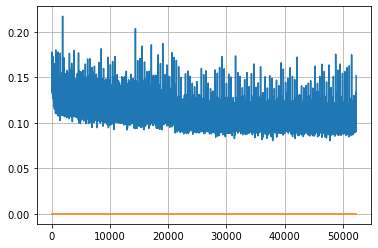

Epoch: 135, iteration 0, loss 0.11087757349014282, cov_diff 0.4165676644430914 cov_diff train 0.41654476593799594
Epoch: 135, iteration 1, loss 0.11357733607292175, cov_diff 0.43083341800535796 cov_diff train 0.4308306974936779
Epoch: 135, iteration 2, loss 0.09834593534469604, cov_diff 0.42104843658896635 cov_diff train 0.4200416810555697
Epoch: 135, iteration 3, loss 0.10886195302009583, cov_diff 0.4189540904706951 cov_diff train 0.41887202860722345
Epoch: 135, iteration 4, loss 0.0969645082950592, cov_diff 0.41317128716109136 cov_diff train 0.4125343643373918
Epoch: 135, iteration 5, loss 0.10499560832977295, cov_diff 0.40973676426733907 cov_diff train 0.4095031401196081
Epoch: 135, iteration 6, loss 0.10286200046539307, cov_diff 0.42938451696972285 cov_diff train 0.4276653222352373
Epoch: 135, iteration 7, loss 0.11225506663322449, cov_diff 0.4142581527565688 cov_diff train 0.41367538843434587
Epoch: 135, iteration 8, loss 0.11074864864349365, cov_diff 0.416232129270074 cov_diff tr

Epoch: 135, iteration 77, loss 0.1024450957775116, cov_diff 0.4033147525152407 cov_diff train 0.40316453886545883
Epoch: 135, iteration 78, loss 0.10753142833709717, cov_diff 0.41325349679751044 cov_diff train 0.41140309146024706
Epoch: 135, iteration 79, loss 0.10901343822479248, cov_diff 0.42145995695482263 cov_diff train 0.42091433789221544
Epoch: 135, iteration 80, loss 0.10789355635643005, cov_diff 0.4032794119689949 cov_diff train 0.4016954206435435
Epoch: 135, iteration 81, loss 0.10188180208206177, cov_diff 0.4215513783633297 cov_diff train 0.42155981436022316
Epoch: 135, iteration 82, loss 0.1018318235874176, cov_diff 0.42438583748069986 cov_diff train 0.42386785137072847
Epoch: 135, iteration 83, loss 0.09773653745651245, cov_diff 0.41181837979453395 cov_diff train 0.4118587599208094
Epoch: 135, iteration 84, loss 0.10834544897079468, cov_diff 0.409458367057585 cov_diff train 0.40859714807356895
Epoch: 135, iteration 85, loss 0.09967347979545593, cov_diff 0.4132556698389742 c

Epoch: 135, iteration 154, loss 0.11116868257522583, cov_diff 0.40442668209941546 cov_diff train 0.40384132339159173
Epoch: 135, iteration 155, loss 0.10501131415367126, cov_diff 0.41910197643158825 cov_diff train 0.4184785094146598
Epoch: 135, iteration 156, loss 0.10668620467185974, cov_diff 0.41220392893151525 cov_diff train 0.4120251525635727
Epoch: 135, iteration 157, loss 0.09774672985076904, cov_diff 0.3991968877258487 cov_diff train 0.39880818873077317
Epoch: 135, iteration 158, loss 0.09768795967102051, cov_diff 0.42588074041764007 cov_diff train 0.4249736610601192
Epoch: 135, iteration 159, loss 0.09876799583435059, cov_diff 0.41877905580454006 cov_diff train 0.4180297281582212
Epoch: 135, iteration 160, loss 0.10438898205757141, cov_diff 0.41998372415433755 cov_diff train 0.4198246623419349
Epoch: 135, iteration 161, loss 0.09559682011604309, cov_diff 0.4118166642360903 cov_diff train 0.4112952448751273
Epoch: 135, iteration 162, loss 0.09730857610702515, cov_diff 0.41464486

Epoch: 135, iteration 230, loss 0.09792551398277283, cov_diff 0.41037397026403405 cov_diff train 0.4102657699921636
Epoch: 135, iteration 231, loss 0.1097152829170227, cov_diff 0.4338009774370897 cov_diff train 0.43264386340969224
Epoch: 135, iteration 232, loss 0.10281160473823547, cov_diff 0.41420661632568234 cov_diff train 0.4133463490914623
Epoch: 135, iteration 233, loss 0.10010060667991638, cov_diff 0.4170142033838806 cov_diff train 0.4164556024433514
Epoch: 135, iteration 234, loss 0.11850517988204956, cov_diff 0.4335153726013493 cov_diff train 0.4323359180281506
Epoch: 135, iteration 235, loss 0.12180200219154358, cov_diff 0.4192529762001533 cov_diff train 0.41835025706853596
Epoch: 135, iteration 236, loss 0.11348313093185425, cov_diff 0.4141894650738807 cov_diff train 0.4127928524440281
Epoch: 135, iteration 237, loss 0.11582684516906738, cov_diff 0.41107599124339994 cov_diff train 0.41036337365755515
Epoch: 135, iteration 238, loss 0.10723313689231873, cov_diff 0.42430239697

Epoch: 135, iteration 303, loss 0.11491608619689941, cov_diff 0.4180941192764556 cov_diff train 0.4177035499116204
Epoch: 135, iteration 304, loss 0.1035495400428772, cov_diff 0.4189111162142799 cov_diff train 0.41912361055534786
Epoch: 135, iteration 305, loss 0.10857230424880981, cov_diff 0.4153940655028669 cov_diff train 0.4147418439978201
Epoch: 135, iteration 306, loss 0.10679829120635986, cov_diff 0.40952521256774477 cov_diff train 0.4092767186026356
Epoch: 135, iteration 307, loss 0.0955645740032196, cov_diff 0.4120512382724368 cov_diff train 0.411595150935234
Epoch: 135, iteration 308, loss 0.10801178216934204, cov_diff 0.4130388568470235 cov_diff train 0.41316341924676986
Epoch: 135, iteration 309, loss 0.1134900450706482, cov_diff 0.4180106676074112 cov_diff train 0.41793582225595616
Epoch: 135, iteration 310, loss 0.09080657362937927, cov_diff 0.40669976314961315 cov_diff train 0.4061049263271144
Epoch: 135, iteration 311, loss 0.0976085364818573, cov_diff 0.4131905844885056

Epoch: 135, iteration 380, loss 0.1095348596572876, cov_diff 0.41510654482104986 cov_diff train 0.41462371372951423
Epoch: 135, iteration 381, loss 0.10933706164360046, cov_diff 0.41334535263968336 cov_diff train 0.4130184470261822
Epoch: 135, iteration 382, loss 0.12353271245956421, cov_diff 0.43440151198612054 cov_diff train 0.4332724833950829
Epoch: 135, iteration 383, loss 0.0998009443283081, cov_diff 0.42751167079617935 cov_diff train 0.42642286074983693
Epoch: 135, iteration 384, loss 0.1161147952079773, cov_diff 0.4230068253698241 cov_diff train 0.42248534976245994
Epoch: 135, iteration 385, loss 0.11512324213981628, cov_diff 0.41188801508578676 cov_diff train 0.41189311022443226
Epoch: 135, iteration 386, loss 0.10526382923126221, cov_diff 0.4142893210766174 cov_diff train 0.41327006228794305
Epoch: 135, iteration 387, loss 0.11000943183898926, cov_diff 0.40965738898886217 cov_diff train 0.409725175745379
Epoch: 135, iteration 388, loss 0.10830163955688477, cov_diff 0.411235989

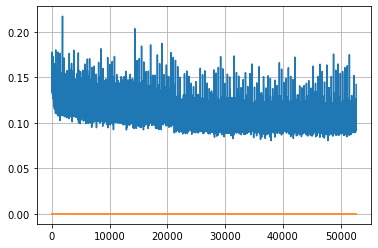

Epoch: 136, iteration 0, loss 0.10328075289726257, cov_diff 0.426802630304279 cov_diff train 0.4260498620765372
Epoch: 136, iteration 1, loss 0.11366850137710571, cov_diff 0.4137236679592518 cov_diff train 0.41167393619731096
Epoch: 136, iteration 2, loss 0.10210192203521729, cov_diff 0.42330688146285667 cov_diff train 0.42161101934059825
Epoch: 136, iteration 3, loss 0.10606944561004639, cov_diff 0.42625480977591745 cov_diff train 0.4256641406606791
Epoch: 136, iteration 4, loss 0.09853556752204895, cov_diff 0.41506648175807614 cov_diff train 0.41451697720984443
Epoch: 136, iteration 5, loss 0.1016843318939209, cov_diff 0.41950160762327265 cov_diff train 0.41933023319850465
Epoch: 136, iteration 6, loss 0.10444778203964233, cov_diff 0.4198199874423242 cov_diff train 0.4192951793599433
Epoch: 136, iteration 7, loss 0.09417372941970825, cov_diff 0.40150154440752617 cov_diff train 0.40134516712781576
Epoch: 136, iteration 8, loss 0.0996522605419159, cov_diff 0.4316668661617007 cov_diff t

Epoch: 136, iteration 76, loss 0.10678383708000183, cov_diff 0.40916085265477553 cov_diff train 0.4085546960056117
Epoch: 136, iteration 77, loss 0.10491305589675903, cov_diff 0.41271299820131563 cov_diff train 0.41270471622642385
Epoch: 136, iteration 78, loss 0.10249167680740356, cov_diff 0.4229390007113968 cov_diff train 0.42178295045336966
Epoch: 136, iteration 79, loss 0.11190706491470337, cov_diff 0.42516902633772147 cov_diff train 0.4244310851853338
Epoch: 136, iteration 80, loss 0.10664820671081543, cov_diff 0.4133318810644347 cov_diff train 0.41225914453877277
Epoch: 136, iteration 81, loss 0.0982525646686554, cov_diff 0.42608466805170725 cov_diff train 0.42514018795826486
Epoch: 136, iteration 82, loss 0.10390251874923706, cov_diff 0.4256054282511856 cov_diff train 0.42432631943972904
Epoch: 136, iteration 83, loss 0.10688677430152893, cov_diff 0.4094092624476247 cov_diff train 0.4081004801783559
Epoch: 136, iteration 84, loss 0.117352694272995, cov_diff 0.4109088198750593 co

Epoch: 136, iteration 153, loss 0.10773009061813354, cov_diff 0.41817365897839726 cov_diff train 0.41805127908822415
Epoch: 136, iteration 154, loss 0.11045429110527039, cov_diff 0.4313549605032601 cov_diff train 0.43048387900600693
Epoch: 136, iteration 155, loss 0.10940992832183838, cov_diff 0.42274198609963354 cov_diff train 0.42230677888734725
Epoch: 136, iteration 156, loss 0.10718569159507751, cov_diff 0.41767696494703976 cov_diff train 0.41737002529661793
Epoch: 136, iteration 157, loss 0.09839513897895813, cov_diff 0.43171812362949724 cov_diff train 0.4313040776064025
Epoch: 136, iteration 158, loss 0.11361145973205566, cov_diff 0.419478552606619 cov_diff train 0.4195263762403546
Epoch: 136, iteration 159, loss 0.11042538285255432, cov_diff 0.44080904646140284 cov_diff train 0.43995042767347786
Epoch: 136, iteration 160, loss 0.11905747652053833, cov_diff 0.42877896295604123 cov_diff train 0.4264084523871216
Epoch: 136, iteration 161, loss 0.10539132356643677, cov_diff 0.430361

Epoch: 136, iteration 228, loss 0.10307592153549194, cov_diff 0.42082284194175384 cov_diff train 0.4198631298386075
Epoch: 136, iteration 229, loss 0.11004042625427246, cov_diff 0.432253434816467 cov_diff train 0.43236131330468214
Epoch: 136, iteration 230, loss 0.09774217009544373, cov_diff 0.4146497174551947 cov_diff train 0.4139830594416787
Epoch: 136, iteration 231, loss 0.11399033665657043, cov_diff 0.41105640735809923 cov_diff train 0.41026827281018996
Epoch: 136, iteration 232, loss 0.10182598233222961, cov_diff 0.42015779392310976 cov_diff train 0.4186271770252913
Epoch: 136, iteration 233, loss 0.11361876130104065, cov_diff 0.4104044752646575 cov_diff train 0.41073473778063446
Epoch: 136, iteration 234, loss 0.08955225348472595, cov_diff 0.4189129675156264 cov_diff train 0.41831961769420495
Epoch: 136, iteration 235, loss 0.11377635598182678, cov_diff 0.4071941834120185 cov_diff train 0.40628487677407094
Epoch: 136, iteration 236, loss 0.09764209389686584, cov_diff 0.423198360

Epoch: 136, iteration 303, loss 0.11393499374389648, cov_diff 0.41725854390361855 cov_diff train 0.41699445145167985
Epoch: 136, iteration 304, loss 0.1068190336227417, cov_diff 0.418719855048205 cov_diff train 0.4178674068283006
Epoch: 136, iteration 305, loss 0.0902174711227417, cov_diff 0.4184676365769524 cov_diff train 0.41737054337923
Epoch: 136, iteration 306, loss 0.1030183732509613, cov_diff 0.4250867796432607 cov_diff train 0.42473081122343953
Epoch: 136, iteration 307, loss 0.10296231508255005, cov_diff 0.421882292988238 cov_diff train 0.42134415080295146
Epoch: 136, iteration 308, loss 0.10638993978500366, cov_diff 0.4175381802650666 cov_diff train 0.41663672135046426
Epoch: 136, iteration 309, loss 0.10465717315673828, cov_diff 0.42605253887948863 cov_diff train 0.4262102185218694
Epoch: 136, iteration 310, loss 0.10872542858123779, cov_diff 0.4138230046294312 cov_diff train 0.41335739710581637
Epoch: 136, iteration 311, loss 0.10465586185455322, cov_diff 0.4115182900173409

Epoch: 136, iteration 376, loss 0.09866690635681152, cov_diff 0.4272714361633977 cov_diff train 0.42627207029121994
Epoch: 136, iteration 377, loss 0.10662662982940674, cov_diff 0.42124588349100844 cov_diff train 0.42067145469531697
Epoch: 136, iteration 378, loss 0.10790067911148071, cov_diff 0.4276148892960278 cov_diff train 0.42620477186029804
Epoch: 136, iteration 379, loss 0.09519633650779724, cov_diff 0.42151854936057265 cov_diff train 0.42063138809672634
Epoch: 136, iteration 380, loss 0.11051061749458313, cov_diff 0.40239049570429525 cov_diff train 0.4005359564769517
Epoch: 136, iteration 381, loss 0.11082464456558228, cov_diff 0.3995307528158425 cov_diff train 0.39927359748411084
Epoch: 136, iteration 382, loss 0.09009629487991333, cov_diff 0.4159578648358089 cov_diff train 0.41544456343120134
Epoch: 136, iteration 383, loss 0.11115947365760803, cov_diff 0.4078554733869791 cov_diff train 0.4072888569364226
Epoch: 136, iteration 384, loss 0.11065179109573364, cov_diff 0.4188026

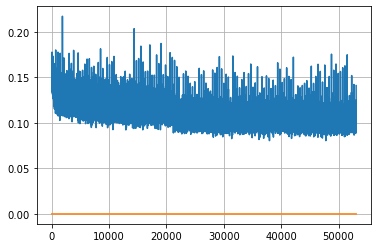

Epoch: 137, iteration 0, loss 0.09532919526100159, cov_diff 0.40099365427767386 cov_diff train 0.400627392394616
Epoch: 137, iteration 1, loss 0.10981431603431702, cov_diff 0.40985085978614616 cov_diff train 0.41045072105502345
Epoch: 137, iteration 2, loss 0.09351637959480286, cov_diff 0.4242661915025856 cov_diff train 0.4243214467717005
Epoch: 137, iteration 3, loss 0.1064566969871521, cov_diff 0.4200743575134186 cov_diff train 0.41953988459091707
Epoch: 137, iteration 4, loss 0.09967637062072754, cov_diff 0.43228386476314756 cov_diff train 0.43216581040769564
Epoch: 137, iteration 5, loss 0.10229840874671936, cov_diff 0.4071157624417881 cov_diff train 0.407185721057734
Epoch: 137, iteration 6, loss 0.1088399589061737, cov_diff 0.423322492110633 cov_diff train 0.4225118967180445
Epoch: 137, iteration 7, loss 0.10260125994682312, cov_diff 0.41185948690074153 cov_diff train 0.4112199943243604
Epoch: 137, iteration 8, loss 0.09928086400032043, cov_diff 0.41970102663931175 cov_diff train

Epoch: 137, iteration 75, loss 0.10713851451873779, cov_diff 0.4220551439841437 cov_diff train 0.4215941361611052
Epoch: 137, iteration 76, loss 0.09541743993759155, cov_diff 0.42056459830985304 cov_diff train 0.4198858587885931
Epoch: 137, iteration 77, loss 0.09644517302513123, cov_diff 0.40898873735907537 cov_diff train 0.40866626207373513
Epoch: 137, iteration 78, loss 0.1008373498916626, cov_diff 0.41284986732391166 cov_diff train 0.4130766904514407
Epoch: 137, iteration 79, loss 0.0994526743888855, cov_diff 0.40916193043832244 cov_diff train 0.40904497503620335
Epoch: 137, iteration 80, loss 0.09594666957855225, cov_diff 0.4120620049645067 cov_diff train 0.41158530237983
Epoch: 137, iteration 81, loss 0.1194516122341156, cov_diff 0.43542289763985975 cov_diff train 0.43546028443590773
Epoch: 137, iteration 82, loss 0.09438630938529968, cov_diff 0.42515558787471885 cov_diff train 0.42457592412313977
Epoch: 137, iteration 83, loss 0.0945463478565216, cov_diff 0.4173090034507286 cov_

Epoch: 137, iteration 152, loss 0.10112035274505615, cov_diff 0.42037036305224984 cov_diff train 0.42004280042637226
Epoch: 137, iteration 153, loss 0.11082139611244202, cov_diff 0.4344143061842618 cov_diff train 0.43398249596613414
Epoch: 137, iteration 154, loss 0.10419413447380066, cov_diff 0.4105377659783479 cov_diff train 0.41005858596837375
Epoch: 137, iteration 155, loss 0.09676632285118103, cov_diff 0.42580195601535437 cov_diff train 0.4252919551573905
Epoch: 137, iteration 156, loss 0.11065250635147095, cov_diff 0.4154634075845643 cov_diff train 0.4145584826698775
Epoch: 137, iteration 157, loss 0.10505479574203491, cov_diff 0.4192232937194586 cov_diff train 0.4189438914523745
Epoch: 137, iteration 158, loss 0.10374075174331665, cov_diff 0.3995412623933557 cov_diff train 0.3987259865619583
Epoch: 137, iteration 159, loss 0.10816141963005066, cov_diff 0.4316054465433606 cov_diff train 0.43006249566303867
Epoch: 137, iteration 160, loss 0.10718831419944763, cov_diff 0.4121444929

Epoch: 137, iteration 231, loss 0.10075601935386658, cov_diff 0.4217715248243768 cov_diff train 0.42092721580946424
Epoch: 137, iteration 232, loss 0.1086178719997406, cov_diff 0.4188608445087748 cov_diff train 0.41718573639665735
Epoch: 137, iteration 233, loss 0.10933980345726013, cov_diff 0.4236155110351367 cov_diff train 0.4232754507324409
Epoch: 137, iteration 234, loss 0.09378013014793396, cov_diff 0.4259344385150177 cov_diff train 0.4254787928831711
Epoch: 137, iteration 235, loss 0.10665389895439148, cov_diff 0.40630556558301195 cov_diff train 0.4056771089854284
Epoch: 137, iteration 236, loss 0.09626990556716919, cov_diff 0.4123147903057451 cov_diff train 0.41172305773895895
Epoch: 137, iteration 237, loss 0.1127917468547821, cov_diff 0.41318082899715103 cov_diff train 0.41219426616837884
Epoch: 137, iteration 238, loss 0.09581640362739563, cov_diff 0.4165227186238671 cov_diff train 0.41621051918412005
Epoch: 137, iteration 239, loss 0.10883408784866333, cov_diff 0.42257136530

Epoch: 137, iteration 309, loss 0.10261920094490051, cov_diff 0.41837701154150936 cov_diff train 0.41721622738268715
Epoch: 137, iteration 310, loss 0.1059146523475647, cov_diff 0.4286550083249692 cov_diff train 0.42864959587572327
Epoch: 137, iteration 311, loss 0.10847237706184387, cov_diff 0.4195150796743476 cov_diff train 0.4177306727747148
Epoch: 137, iteration 312, loss 0.10374754667282104, cov_diff 0.41182713526739995 cov_diff train 0.41161100866285744
Epoch: 137, iteration 313, loss 0.12753501534461975, cov_diff 0.42361310565072374 cov_diff train 0.42268426116617164
Epoch: 137, iteration 314, loss 0.101988285779953, cov_diff 0.4112088941143437 cov_diff train 0.4104330064061863
Epoch: 137, iteration 315, loss 0.10737389326095581, cov_diff 0.42683251608423517 cov_diff train 0.42646600700636106
Epoch: 137, iteration 316, loss 0.10787716507911682, cov_diff 0.41767951118149366 cov_diff train 0.41789128864101466
Epoch: 137, iteration 317, loss 0.10090905427932739, cov_diff 0.42187500

Epoch: 137, iteration 388, loss 0.10923397541046143, cov_diff 0.417986533943185 cov_diff train 0.41695225634997996
Epoch: 137, iteration 389, loss 0.10252127051353455, cov_diff 0.4131030201883014 cov_diff train 0.4128715536481106
Epoch: 137, iteration 390, loss 0.18101215362548828, cov_diff 0.4613517291386098 cov_diff train 0.460447314002284


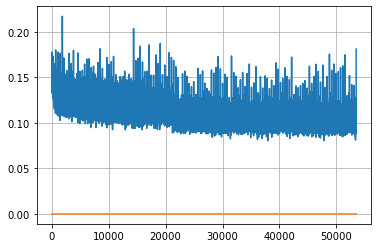

Epoch: 138, iteration 0, loss 0.11067125201225281, cov_diff 0.4213157686733706 cov_diff train 0.42137775575914904
Epoch: 138, iteration 1, loss 0.12099751830101013, cov_diff 0.4128254023501385 cov_diff train 0.4114403875758703
Epoch: 138, iteration 2, loss 0.11236825585365295, cov_diff 0.4225857931982121 cov_diff train 0.42201480780788053
Epoch: 138, iteration 3, loss 0.11111438274383545, cov_diff 0.4196703589850274 cov_diff train 0.4202205648953067
Epoch: 138, iteration 4, loss 0.10063719749450684, cov_diff 0.4081062335713841 cov_diff train 0.407831874273687
Epoch: 138, iteration 5, loss 0.10495862364768982, cov_diff 0.4230664483346555 cov_diff train 0.42334268937682035
Epoch: 138, iteration 6, loss 0.10013160109519958, cov_diff 0.41312072271479994 cov_diff train 0.4135133910514577
Epoch: 138, iteration 7, loss 0.12440410256385803, cov_diff 0.4181797364098773 cov_diff train 0.41852299622251365
Epoch: 138, iteration 8, loss 0.1029602587223053, cov_diff 0.42061348821546696 cov_diff trai

Epoch: 138, iteration 79, loss 0.09018272161483765, cov_diff 0.4146094080403654 cov_diff train 0.41475747908040095
Epoch: 138, iteration 80, loss 0.10087072849273682, cov_diff 0.4179549234424497 cov_diff train 0.41777845061963725
Epoch: 138, iteration 81, loss 0.11169746518135071, cov_diff 0.42327162307013155 cov_diff train 0.42206154441458316
Epoch: 138, iteration 82, loss 0.10348823666572571, cov_diff 0.4204914581661354 cov_diff train 0.4188921799733209
Epoch: 138, iteration 83, loss 0.11656320095062256, cov_diff 0.4174159523183323 cov_diff train 0.4165672562671672
Epoch: 138, iteration 84, loss 0.11215090751647949, cov_diff 0.42059127950222924 cov_diff train 0.41901073137960676
Epoch: 138, iteration 85, loss 0.1062295138835907, cov_diff 0.4115625869253043 cov_diff train 0.4112742870319806
Epoch: 138, iteration 86, loss 0.11034047603607178, cov_diff 0.4310518103628824 cov_diff train 0.43005232255867165
Epoch: 138, iteration 87, loss 0.11058259010314941, cov_diff 0.4297846525213395 co

Epoch: 138, iteration 155, loss 0.09982505440711975, cov_diff 0.4239966756967197 cov_diff train 0.42384835181255665
Epoch: 138, iteration 156, loss 0.10688722133636475, cov_diff 0.42686523605155446 cov_diff train 0.4261368187162022
Epoch: 138, iteration 157, loss 0.11303362250328064, cov_diff 0.4155349316521557 cov_diff train 0.41532131738166983
Epoch: 138, iteration 158, loss 0.10425522923469543, cov_diff 0.4204076441903517 cov_diff train 0.4192316067743805
Epoch: 138, iteration 159, loss 0.09665882587432861, cov_diff 0.41340403464942477 cov_diff train 0.41355802014023746
Epoch: 138, iteration 160, loss 0.10990133881568909, cov_diff 0.41412586751363123 cov_diff train 0.4128247062901285
Epoch: 138, iteration 161, loss 0.10353010892868042, cov_diff 0.4270160989902292 cov_diff train 0.4265050486001287
Epoch: 138, iteration 162, loss 0.09370040893554688, cov_diff 0.42278849926529066 cov_diff train 0.42224086526924587
Epoch: 138, iteration 163, loss 0.09592920541763306, cov_diff 0.43390386

Epoch: 138, iteration 232, loss 0.10170313715934753, cov_diff 0.4183327905566135 cov_diff train 0.41836431645572897
Epoch: 138, iteration 233, loss 0.11274197697639465, cov_diff 0.4199819012440026 cov_diff train 0.4198043619178194
Epoch: 138, iteration 234, loss 0.1034105122089386, cov_diff 0.4266525811578662 cov_diff train 0.42622123397745026
Epoch: 138, iteration 235, loss 0.10683348774909973, cov_diff 0.4154256420349908 cov_diff train 0.4147017724672488
Epoch: 138, iteration 236, loss 0.10300928354263306, cov_diff 0.41893208116588926 cov_diff train 0.41778557692597784
Epoch: 138, iteration 237, loss 0.10411262512207031, cov_diff 0.42031371646789745 cov_diff train 0.41940770603028055
Epoch: 138, iteration 238, loss 0.10608398914337158, cov_diff 0.4169918875474975 cov_diff train 0.4160475003756799
Epoch: 138, iteration 239, loss 0.11376282572746277, cov_diff 0.42725024096367065 cov_diff train 0.42639687880593996
Epoch: 138, iteration 240, loss 0.11142635345458984, cov_diff 0.415684669

Epoch: 138, iteration 309, loss 0.11364760994911194, cov_diff 0.41014655317101056 cov_diff train 0.4082395033793759
Epoch: 138, iteration 310, loss 0.1088506281375885, cov_diff 0.4162792126499409 cov_diff train 0.4158554857993762
Epoch: 138, iteration 311, loss 0.11376175284385681, cov_diff 0.4205849743451993 cov_diff train 0.41952351245881164
Epoch: 138, iteration 312, loss 0.09923458099365234, cov_diff 0.42584028534499274 cov_diff train 0.4250310856539005
Epoch: 138, iteration 313, loss 0.09485697746276855, cov_diff 0.42020953240841646 cov_diff train 0.4197789698633225
Epoch: 138, iteration 314, loss 0.09851902723312378, cov_diff 0.4100446327935428 cov_diff train 0.4087409439086811
Epoch: 138, iteration 315, loss 0.09784248471260071, cov_diff 0.40565925791946494 cov_diff train 0.4048450187813913
Epoch: 138, iteration 316, loss 0.10572341084480286, cov_diff 0.4154545076993825 cov_diff train 0.41480280282051896
Epoch: 138, iteration 317, loss 0.11103501915931702, cov_diff 0.40598185921

Epoch: 138, iteration 383, loss 0.10730496048927307, cov_diff 0.4172434115739201 cov_diff train 0.41628012438687384
Epoch: 138, iteration 384, loss 0.10170063376426697, cov_diff 0.410770297280862 cov_diff train 0.409999231534441
Epoch: 138, iteration 385, loss 0.10801416635513306, cov_diff 0.40767018260623084 cov_diff train 0.40741999968251486
Epoch: 138, iteration 386, loss 0.11277526617050171, cov_diff 0.415660976053129 cov_diff train 0.41453324910982703
Epoch: 138, iteration 387, loss 0.09956881403923035, cov_diff 0.42183245229264454 cov_diff train 0.4214326358403163
Epoch: 138, iteration 388, loss 0.10720857977867126, cov_diff 0.41238372243462346 cov_diff train 0.41169909881389594
Epoch: 138, iteration 389, loss 0.10807973146438599, cov_diff 0.42234997695228055 cov_diff train 0.4197598977262603
Epoch: 138, iteration 390, loss 0.1474955677986145, cov_diff 0.45273775264209093 cov_diff train 0.45162771716326844


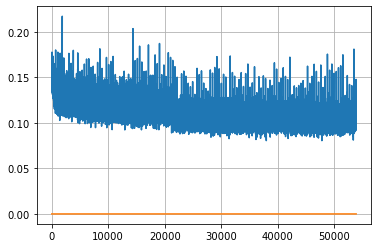

Epoch: 139, iteration 0, loss 0.10734549164772034, cov_diff 0.4120103618408335 cov_diff train 0.41161533935615785
Epoch: 139, iteration 1, loss 0.11162975430488586, cov_diff 0.42273400572570746 cov_diff train 0.4231579915493084
Epoch: 139, iteration 2, loss 0.09702062606811523, cov_diff 0.4250084168687139 cov_diff train 0.42499585020476455
Epoch: 139, iteration 3, loss 0.11040312051773071, cov_diff 0.42954260433219354 cov_diff train 0.4279114754601218
Epoch: 139, iteration 4, loss 0.09934920072555542, cov_diff 0.42397637246287284 cov_diff train 0.4235885407649472
Epoch: 139, iteration 5, loss 0.10757532715797424, cov_diff 0.4181023492901156 cov_diff train 0.41778930454136814
Epoch: 139, iteration 6, loss 0.09832710027694702, cov_diff 0.41166849782343357 cov_diff train 0.41138441718194624
Epoch: 139, iteration 7, loss 0.10251021385192871, cov_diff 0.4274861281648471 cov_diff train 0.4277394124137385
Epoch: 139, iteration 8, loss 0.10657238960266113, cov_diff 0.4145353707888768 cov_diff 

Epoch: 139, iteration 78, loss 0.10831630229949951, cov_diff 0.4056227384996112 cov_diff train 0.40559768515707334
Epoch: 139, iteration 79, loss 0.09392467141151428, cov_diff 0.4203834810208753 cov_diff train 0.41976258856975024
Epoch: 139, iteration 80, loss 0.10534107685089111, cov_diff 0.40689336308653123 cov_diff train 0.40703816948932225
Epoch: 139, iteration 81, loss 0.11333787441253662, cov_diff 0.4223461623483423 cov_diff train 0.4227364288201729
Epoch: 139, iteration 82, loss 0.09577298164367676, cov_diff 0.4103814289793919 cov_diff train 0.4094508092175726
Epoch: 139, iteration 83, loss 0.1087217926979065, cov_diff 0.42716387488484775 cov_diff train 0.42662127802467914
Epoch: 139, iteration 84, loss 0.11007311940193176, cov_diff 0.41752572381408193 cov_diff train 0.41752205638294965
Epoch: 139, iteration 85, loss 0.09047606587409973, cov_diff 0.4209013090350826 cov_diff train 0.42082531197205714
Epoch: 139, iteration 86, loss 0.0948704183101654, cov_diff 0.4113846742914874 c

Epoch: 139, iteration 157, loss 0.09384593367576599, cov_diff 0.42021871408276024 cov_diff train 0.41963785744613724
Epoch: 139, iteration 158, loss 0.1061975359916687, cov_diff 0.4105511673572553 cov_diff train 0.4094778232907916
Epoch: 139, iteration 159, loss 0.10716795921325684, cov_diff 0.42348844194611973 cov_diff train 0.42313529947415585
Epoch: 139, iteration 160, loss 0.09614723920822144, cov_diff 0.3989352907649674 cov_diff train 0.3991544426311605
Epoch: 139, iteration 161, loss 0.10570284724235535, cov_diff 0.4081596223949614 cov_diff train 0.40762962118751117
Epoch: 139, iteration 162, loss 0.10270878672599792, cov_diff 0.41707538417924267 cov_diff train 0.41612618474914076
Epoch: 139, iteration 163, loss 0.10555988550186157, cov_diff 0.41469849464143244 cov_diff train 0.41361954742185275
Epoch: 139, iteration 164, loss 0.10246971249580383, cov_diff 0.40776634208952517 cov_diff train 0.40686713676702974
Epoch: 139, iteration 165, loss 0.09993141889572144, cov_diff 0.413656

Epoch: 139, iteration 235, loss 0.10208624601364136, cov_diff 0.4086510927372146 cov_diff train 0.40815038184980107
Epoch: 139, iteration 236, loss 0.10118472576141357, cov_diff 0.41580113518625533 cov_diff train 0.41502165009997743
Epoch: 139, iteration 237, loss 0.10227367281913757, cov_diff 0.4274944470344511 cov_diff train 0.42685562024145884
Epoch: 139, iteration 238, loss 0.1037977933883667, cov_diff 0.42889268616268134 cov_diff train 0.4280982366355531
Epoch: 139, iteration 239, loss 0.11610645055770874, cov_diff 0.41471771687049075 cov_diff train 0.4141459486656221
Epoch: 139, iteration 240, loss 0.09757357835769653, cov_diff 0.4213804647021439 cov_diff train 0.41987777350041366
Epoch: 139, iteration 241, loss 0.10882285237312317, cov_diff 0.42640565058018415 cov_diff train 0.4247982903656229
Epoch: 139, iteration 242, loss 0.10562479496002197, cov_diff 0.4212516139168014 cov_diff train 0.42023393231762934
Epoch: 139, iteration 243, loss 0.11161530017852783, cov_diff 0.41044000

Epoch: 139, iteration 314, loss 0.1049620509147644, cov_diff 0.4158120367899692 cov_diff train 0.4152568873828169
Epoch: 139, iteration 315, loss 0.11524888873100281, cov_diff 0.4259483676058204 cov_diff train 0.4241938026206092
Epoch: 139, iteration 316, loss 0.10606426000595093, cov_diff 0.42546737625795866 cov_diff train 0.42457537556470454
Epoch: 139, iteration 317, loss 0.09913903474807739, cov_diff 0.41044257404245477 cov_diff train 0.4090477136449266
Epoch: 139, iteration 318, loss 0.10788488388061523, cov_diff 0.4234694440951314 cov_diff train 0.4227075440543841
Epoch: 139, iteration 319, loss 0.11751002073287964, cov_diff 0.42771417625078734 cov_diff train 0.42671576292851193
Epoch: 139, iteration 320, loss 0.10937190055847168, cov_diff 0.4301878144234146 cov_diff train 0.4295245579376712
Epoch: 139, iteration 321, loss 0.10468640923500061, cov_diff 0.4152023119219118 cov_diff train 0.4144462984247739
Epoch: 139, iteration 322, loss 0.10671055316925049, cov_diff 0.411345490114

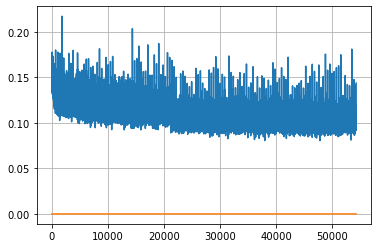

Epoch: 140, iteration 0, loss 0.10303199291229248, cov_diff 0.4017726896254092 cov_diff train 0.40104255219815776
Epoch: 140, iteration 1, loss 0.10800451040267944, cov_diff 0.4107123317574198 cov_diff train 0.4100854959338579
Epoch: 140, iteration 2, loss 0.10036754608154297, cov_diff 0.4268422515605637 cov_diff train 0.4270034793528052
Epoch: 140, iteration 3, loss 0.10107135772705078, cov_diff 0.4270062000771412 cov_diff train 0.4268299052904975
Epoch: 140, iteration 4, loss 0.10270309448242188, cov_diff 0.41544236954498037 cov_diff train 0.41531799248230716
Epoch: 140, iteration 5, loss 0.10463103652000427, cov_diff 0.4121387427873326 cov_diff train 0.41161284575051865
Epoch: 140, iteration 6, loss 0.10045060515403748, cov_diff 0.41895972694313843 cov_diff train 0.41887282731362424
Epoch: 140, iteration 7, loss 0.09551164507865906, cov_diff 0.4178547290683096 cov_diff train 0.4171914712027044
Epoch: 140, iteration 8, loss 0.10497689247131348, cov_diff 0.4204165007572236 cov_diff tr

Epoch: 140, iteration 77, loss 0.1100885272026062, cov_diff 0.4199921738541771 cov_diff train 0.4194182132691435
Epoch: 140, iteration 78, loss 0.10820356011390686, cov_diff 0.41982290500485364 cov_diff train 0.419182450804004
Epoch: 140, iteration 79, loss 0.10616767406463623, cov_diff 0.4083121168032127 cov_diff train 0.4075296483526996
Epoch: 140, iteration 80, loss 0.09759020805358887, cov_diff 0.4164116237632826 cov_diff train 0.4151616294898737
Epoch: 140, iteration 81, loss 0.09734007716178894, cov_diff 0.40795417480086515 cov_diff train 0.40678708384363854
Epoch: 140, iteration 82, loss 0.11087125539779663, cov_diff 0.42998382931134965 cov_diff train 0.4294495114340543
Epoch: 140, iteration 83, loss 0.09932395815849304, cov_diff 0.4177779450167607 cov_diff train 0.41648288723045596
Epoch: 140, iteration 84, loss 0.10784658789634705, cov_diff 0.41082921124577726 cov_diff train 0.4096681700220095
Epoch: 140, iteration 85, loss 0.10045966506004333, cov_diff 0.4062012408414399 cov_

Epoch: 140, iteration 155, loss 0.10117939114570618, cov_diff 0.4051564886316727 cov_diff train 0.404713804076982
Epoch: 140, iteration 156, loss 0.09861105680465698, cov_diff 0.41208469968510036 cov_diff train 0.4118131107990809
Epoch: 140, iteration 157, loss 0.10746148228645325, cov_diff 0.4282915704431672 cov_diff train 0.4271174134415058
Epoch: 140, iteration 158, loss 0.09976804256439209, cov_diff 0.4059455054928253 cov_diff train 0.4061367391207932
Epoch: 140, iteration 159, loss 0.11621120572090149, cov_diff 0.4078087529156962 cov_diff train 0.40766186692097733
Epoch: 140, iteration 160, loss 0.10685452818870544, cov_diff 0.4179305695718644 cov_diff train 0.4177417949329653
Epoch: 140, iteration 161, loss 0.11925014853477478, cov_diff 0.4225188780346847 cov_diff train 0.42144717937004944
Epoch: 140, iteration 162, loss 0.09996190667152405, cov_diff 0.4119916893012353 cov_diff train 0.41139902088684116
Epoch: 140, iteration 163, loss 0.09790956974029541, cov_diff 0.4281081737329

Epoch: 140, iteration 233, loss 0.10581868886947632, cov_diff 0.4263889199227636 cov_diff train 0.42725266151488345
Epoch: 140, iteration 234, loss 0.09855183959007263, cov_diff 0.4159608754260578 cov_diff train 0.41568752750099713
Epoch: 140, iteration 235, loss 0.10023006796836853, cov_diff 0.4181934532131883 cov_diff train 0.4175640017480823
Epoch: 140, iteration 236, loss 0.10992434620857239, cov_diff 0.41020469031442486 cov_diff train 0.4092800021592511
Epoch: 140, iteration 237, loss 0.09320959448814392, cov_diff 0.4148038146806845 cov_diff train 0.4139082496557149
Epoch: 140, iteration 238, loss 0.09830403327941895, cov_diff 0.4031057810817812 cov_diff train 0.40245836151582826
Epoch: 140, iteration 239, loss 0.1022840142250061, cov_diff 0.43643276376100015 cov_diff train 0.4358083208836963
Epoch: 140, iteration 240, loss 0.11177060008049011, cov_diff 0.4209469187959557 cov_diff train 0.4202447027568977
Epoch: 140, iteration 241, loss 0.08955016732215881, cov_diff 0.414464946176

Epoch: 140, iteration 312, loss 0.10073447227478027, cov_diff 0.4186197952336172 cov_diff train 0.4180745124346071
Epoch: 140, iteration 313, loss 0.10940602421760559, cov_diff 0.4058609530140674 cov_diff train 0.4054108727933007
Epoch: 140, iteration 314, loss 0.12224081158638, cov_diff 0.41889824686883476 cov_diff train 0.4177118640341191
Epoch: 140, iteration 315, loss 0.09980392456054688, cov_diff 0.4236991287449783 cov_diff train 0.42297247033767243
Epoch: 140, iteration 316, loss 0.11104249954223633, cov_diff 0.41371858746682544 cov_diff train 0.41361717344056387
Epoch: 140, iteration 317, loss 0.10877153277397156, cov_diff 0.41189661024362934 cov_diff train 0.4113263800815498
Epoch: 140, iteration 318, loss 0.11512288451194763, cov_diff 0.4242570393196225 cov_diff train 0.4235912446700456
Epoch: 140, iteration 319, loss 0.10843369364738464, cov_diff 0.42906631962531105 cov_diff train 0.4282298642252213
Epoch: 140, iteration 320, loss 0.0935853123664856, cov_diff 0.41125012756751

Epoch: 140, iteration 389, loss 0.10320109128952026, cov_diff 0.4187726647194573 cov_diff train 0.41753889902108876
Epoch: 140, iteration 390, loss 0.1591184139251709, cov_diff 0.4660073706758017 cov_diff train 0.4658525782527118


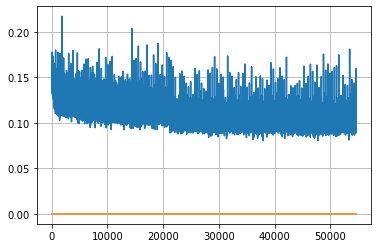

Epoch: 141, iteration 0, loss 0.10416761040687561, cov_diff 0.433918989583028 cov_diff train 0.4329941983879039
Epoch: 141, iteration 1, loss 0.09998491406440735, cov_diff 0.4152136513500559 cov_diff train 0.4146172646445129
Epoch: 141, iteration 2, loss 0.10952463746070862, cov_diff 0.40791122423911375 cov_diff train 0.4068216001435386
Epoch: 141, iteration 3, loss 0.098285973072052, cov_diff 0.41820260230147177 cov_diff train 0.4176604430415546
Epoch: 141, iteration 4, loss 0.09866219758987427, cov_diff 0.4084764476058432 cov_diff train 0.40804918437961857
Epoch: 141, iteration 5, loss 0.10134890675544739, cov_diff 0.41594981959744437 cov_diff train 0.4154365102159507
Epoch: 141, iteration 6, loss 0.10132297873497009, cov_diff 0.4196870103709789 cov_diff train 0.4190513760686201
Epoch: 141, iteration 7, loss 0.09686118364334106, cov_diff 0.40900962560912624 cov_diff train 0.4079024444129513
Epoch: 141, iteration 8, loss 0.11225089430809021, cov_diff 0.4127358396114359 cov_diff train 

Epoch: 141, iteration 72, loss 0.09564277529716492, cov_diff 0.40593998828351396 cov_diff train 0.4042888345505098
Epoch: 141, iteration 73, loss 0.09645968675613403, cov_diff 0.41223063118266673 cov_diff train 0.4112970358292267
Epoch: 141, iteration 74, loss 0.10677695274353027, cov_diff 0.4166811094275352 cov_diff train 0.4152530560536893
Epoch: 141, iteration 75, loss 0.09948217868804932, cov_diff 0.4182533915830596 cov_diff train 0.41747171754933243
Epoch: 141, iteration 76, loss 0.10391086339950562, cov_diff 0.41505115466885606 cov_diff train 0.41494619395020865
Epoch: 141, iteration 77, loss 0.11547327041625977, cov_diff 0.40575178332320344 cov_diff train 0.40616826047402704
Epoch: 141, iteration 78, loss 0.097005695104599, cov_diff 0.40980460094530163 cov_diff train 0.4094335512227553
Epoch: 141, iteration 79, loss 0.09750333428382874, cov_diff 0.42232757505051854 cov_diff train 0.42222723040212656
Epoch: 141, iteration 80, loss 0.09861293435096741, cov_diff 0.42520024857273775

Epoch: 141, iteration 145, loss 0.11508607864379883, cov_diff 0.41978976689191017 cov_diff train 0.4192180540282697
Epoch: 141, iteration 146, loss 0.10132232308387756, cov_diff 0.4124354751793734 cov_diff train 0.41143239981902086
Epoch: 141, iteration 147, loss 0.1086435317993164, cov_diff 0.41834927533623256 cov_diff train 0.4174751755481034
Epoch: 141, iteration 148, loss 0.10596486926078796, cov_diff 0.41994955967282616 cov_diff train 0.418400681506225
Epoch: 141, iteration 149, loss 0.10562008619308472, cov_diff 0.4143460164529451 cov_diff train 0.41313714565418036
Epoch: 141, iteration 150, loss 0.10359850525856018, cov_diff 0.41219857063436915 cov_diff train 0.4123307435296887
Epoch: 141, iteration 151, loss 0.0931214690208435, cov_diff 0.4275900668397778 cov_diff train 0.42725248011573674
Epoch: 141, iteration 152, loss 0.10619461536407471, cov_diff 0.42463793782776954 cov_diff train 0.4242683364708918
Epoch: 141, iteration 153, loss 0.09618350863456726, cov_diff 0.40751347030

Epoch: 141, iteration 222, loss 0.11086344718933105, cov_diff 0.4184598238037095 cov_diff train 0.4176453962634547
Epoch: 141, iteration 223, loss 0.11729508638381958, cov_diff 0.40758272233746884 cov_diff train 0.40693298471700173
Epoch: 141, iteration 224, loss 0.09828734397888184, cov_diff 0.3963130962754293 cov_diff train 0.39567877753497993
Epoch: 141, iteration 225, loss 0.10133662819862366, cov_diff 0.407751347702981 cov_diff train 0.4075128217905875
Epoch: 141, iteration 226, loss 0.10674253106117249, cov_diff 0.3959464557636384 cov_diff train 0.3960521786706028
Epoch: 141, iteration 227, loss 0.10312801599502563, cov_diff 0.41187281663483216 cov_diff train 0.41184644517096625
Epoch: 141, iteration 228, loss 0.10574996471405029, cov_diff 0.4193479417704532 cov_diff train 0.41872525279968625
Epoch: 141, iteration 229, loss 0.0946795642375946, cov_diff 0.4065677792305313 cov_diff train 0.40601694462494053
Epoch: 141, iteration 230, loss 0.10305705666542053, cov_diff 0.41146172866

Epoch: 141, iteration 299, loss 0.09753003716468811, cov_diff 0.4116464847762148 cov_diff train 0.41191028388809275
Epoch: 141, iteration 300, loss 0.10223686695098877, cov_diff 0.4115027890165077 cov_diff train 0.4117214215245065
Epoch: 141, iteration 301, loss 0.12160301208496094, cov_diff 0.41399304273591103 cov_diff train 0.4136419114147695
Epoch: 141, iteration 302, loss 0.11608004570007324, cov_diff 0.41097904340291125 cov_diff train 0.4107372115382889
Epoch: 141, iteration 303, loss 0.10331001877784729, cov_diff 0.42411617019416437 cov_diff train 0.42361468215675785
Epoch: 141, iteration 304, loss 0.11761012673377991, cov_diff 0.40831200257078254 cov_diff train 0.4086132361268889
Epoch: 141, iteration 305, loss 0.10038095712661743, cov_diff 0.4207752855220028 cov_diff train 0.42005626339705976
Epoch: 141, iteration 306, loss 0.11032098531723022, cov_diff 0.4272240397809289 cov_diff train 0.426537814225379
Epoch: 141, iteration 307, loss 0.10699248313903809, cov_diff 0.4224531964

Epoch: 141, iteration 377, loss 0.09617933630943298, cov_diff 0.42084984606079384 cov_diff train 0.419384361900094
Epoch: 141, iteration 378, loss 0.10727754235267639, cov_diff 0.41062015518126704 cov_diff train 0.409578413502052
Epoch: 141, iteration 379, loss 0.09388378262519836, cov_diff 0.4151464705764082 cov_diff train 0.4146945932141221
Epoch: 141, iteration 380, loss 0.10909625887870789, cov_diff 0.4142644412867737 cov_diff train 0.4132585955128447
Epoch: 141, iteration 381, loss 0.12087768316268921, cov_diff 0.40811734102744884 cov_diff train 0.4079238463080149
Epoch: 141, iteration 382, loss 0.10250547528266907, cov_diff 0.4245762488721544 cov_diff train 0.4239949111215929
Epoch: 141, iteration 383, loss 0.100433349609375, cov_diff 0.40507559268995774 cov_diff train 0.40443039687444154
Epoch: 141, iteration 384, loss 0.09522467851638794, cov_diff 0.41587451348940707 cov_diff train 0.415435710103609
Epoch: 141, iteration 385, loss 0.10827654600143433, cov_diff 0.414934114870745

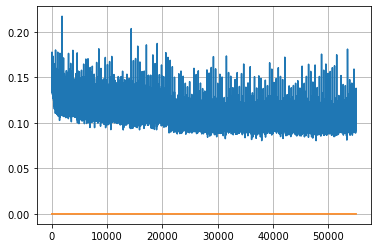

Epoch: 142, iteration 0, loss 0.09949827194213867, cov_diff 0.41859636459597416 cov_diff train 0.41806652823684703
Epoch: 142, iteration 1, loss 0.11486893892288208, cov_diff 0.4184840811902063 cov_diff train 0.41856474934739835
Epoch: 142, iteration 2, loss 0.11752226948738098, cov_diff 0.4126537897206649 cov_diff train 0.4120463180762987
Epoch: 142, iteration 3, loss 0.11416417360305786, cov_diff 0.4188077903658145 cov_diff train 0.41749039210340383
Epoch: 142, iteration 4, loss 0.09620749950408936, cov_diff 0.4167574301071705 cov_diff train 0.4163684259191527
Epoch: 142, iteration 5, loss 0.10794496536254883, cov_diff 0.41243595790583654 cov_diff train 0.4117604380862243
Epoch: 142, iteration 6, loss 0.10154989361763, cov_diff 0.426919682193841 cov_diff train 0.4257041555726546
Epoch: 142, iteration 7, loss 0.11158639192581177, cov_diff 0.4089284477401441 cov_diff train 0.4083435062946869
Epoch: 142, iteration 8, loss 0.09367841482162476, cov_diff 0.4243970474271827 cov_diff train 0

Epoch: 142, iteration 77, loss 0.10304069519042969, cov_diff 0.41292126111920646 cov_diff train 0.41247677204540806
Epoch: 142, iteration 78, loss 0.10664385557174683, cov_diff 0.416433923713001 cov_diff train 0.415722088822236
Epoch: 142, iteration 79, loss 0.09699758887290955, cov_diff 0.4081604060137304 cov_diff train 0.40764856191287274
Epoch: 142, iteration 80, loss 0.09281909465789795, cov_diff 0.4111706484386414 cov_diff train 0.41033468279265384
Epoch: 142, iteration 81, loss 0.10320201516151428, cov_diff 0.4086137660444285 cov_diff train 0.407354060137168
Epoch: 142, iteration 82, loss 0.09482064843177795, cov_diff 0.4249135686087754 cov_diff train 0.4246113569233531
Epoch: 142, iteration 83, loss 0.09480655193328857, cov_diff 0.4179824931600474 cov_diff train 0.4175577783760561
Epoch: 142, iteration 84, loss 0.11014801263809204, cov_diff 0.409241750214137 cov_diff train 0.40803288570755564
Epoch: 142, iteration 85, loss 0.09855636954307556, cov_diff 0.41258922879904814 cov_di

Epoch: 142, iteration 152, loss 0.11592721939086914, cov_diff 0.4143777505966761 cov_diff train 0.4143937350540197
Epoch: 142, iteration 153, loss 0.10146147012710571, cov_diff 0.41560700209628815 cov_diff train 0.415100465917185
Epoch: 142, iteration 154, loss 0.10609158873558044, cov_diff 0.39556840459324066 cov_diff train 0.3953584592657219
Epoch: 142, iteration 155, loss 0.09769535064697266, cov_diff 0.4161392217558586 cov_diff train 0.4160375407299359
Epoch: 142, iteration 156, loss 0.1069234311580658, cov_diff 0.42931743305499226 cov_diff train 0.4295344796153863
Epoch: 142, iteration 157, loss 0.10927745699882507, cov_diff 0.43182406917891064 cov_diff train 0.4311490209248768
Epoch: 142, iteration 158, loss 0.09602576494216919, cov_diff 0.40966545706261925 cov_diff train 0.4086201439044339
Epoch: 142, iteration 159, loss 0.1088496744632721, cov_diff 0.42331141026663216 cov_diff train 0.42206621264090366
Epoch: 142, iteration 160, loss 0.10953253507614136, cov_diff 0.411565277443

Epoch: 142, iteration 229, loss 0.11353206634521484, cov_diff 0.4134505400432705 cov_diff train 0.41282377964131256
Epoch: 142, iteration 230, loss 0.09564977884292603, cov_diff 0.4099629058301604 cov_diff train 0.4091127777483045
Epoch: 142, iteration 231, loss 0.0966998040676117, cov_diff 0.41741368987694466 cov_diff train 0.41734163706930993
Epoch: 142, iteration 232, loss 0.10017722845077515, cov_diff 0.4224289638488784 cov_diff train 0.42268384033086803
Epoch: 142, iteration 233, loss 0.11339983344078064, cov_diff 0.41686920224478086 cov_diff train 0.41638599261847825
Epoch: 142, iteration 234, loss 0.10264220833778381, cov_diff 0.43175650481195466 cov_diff train 0.43137263054481007
Epoch: 142, iteration 235, loss 0.11016309261322021, cov_diff 0.4083443148232282 cov_diff train 0.4079449110988362
Epoch: 142, iteration 236, loss 0.11003085970878601, cov_diff 0.4148300512997995 cov_diff train 0.41437236176216363
Epoch: 142, iteration 237, loss 0.10046502947807312, cov_diff 0.41915663

Epoch: 142, iteration 307, loss 0.09816727042198181, cov_diff 0.4126666043500762 cov_diff train 0.41277784698081177
Epoch: 142, iteration 308, loss 0.09256315231323242, cov_diff 0.4064561890365796 cov_diff train 0.4066469094489799
Epoch: 142, iteration 309, loss 0.11763632297515869, cov_diff 0.4073428902859825 cov_diff train 0.40765837727997944
Epoch: 142, iteration 310, loss 0.1020476222038269, cov_diff 0.4154509935134625 cov_diff train 0.4153413552748732
Epoch: 142, iteration 311, loss 0.09562662243843079, cov_diff 0.4173271754339098 cov_diff train 0.4173666788245667
Epoch: 142, iteration 312, loss 0.0962645411491394, cov_diff 0.4139075742114359 cov_diff train 0.41395600636881785
Epoch: 142, iteration 313, loss 0.1084088385105133, cov_diff 0.41464044145015916 cov_diff train 0.41328903572996406
Epoch: 142, iteration 314, loss 0.10721385478973389, cov_diff 0.4136694001463504 cov_diff train 0.41326812134437185
Epoch: 142, iteration 315, loss 0.10086774826049805, cov_diff 0.4165045425924

Epoch: 142, iteration 384, loss 0.09814658761024475, cov_diff 0.4179511927802519 cov_diff train 0.4179073412750469
Epoch: 142, iteration 385, loss 0.10054454207420349, cov_diff 0.4187631056205757 cov_diff train 0.4180522080509299
Epoch: 142, iteration 386, loss 0.09816065430641174, cov_diff 0.43037306443271534 cov_diff train 0.42837584941035056
Epoch: 142, iteration 387, loss 0.10545006394386292, cov_diff 0.41707190962805457 cov_diff train 0.4167041838808744
Epoch: 142, iteration 388, loss 0.11056634783744812, cov_diff 0.41037867349241625 cov_diff train 0.41016645712342487
Epoch: 142, iteration 389, loss 0.10844293236732483, cov_diff 0.41252707729963234 cov_diff train 0.4122919857485702
Epoch: 142, iteration 390, loss 0.1357438862323761, cov_diff 0.45169963500747384 cov_diff train 0.45299374103265766


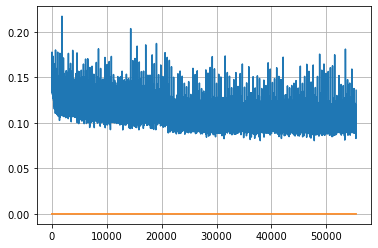

Epoch: 143, iteration 0, loss 0.10217258334159851, cov_diff 0.4200294561856606 cov_diff train 0.419231734576621
Epoch: 143, iteration 1, loss 0.10823553800582886, cov_diff 0.4215959279040779 cov_diff train 0.42081674640962463
Epoch: 143, iteration 2, loss 0.10921037197113037, cov_diff 0.41582572153397984 cov_diff train 0.41491784614818406
Epoch: 143, iteration 3, loss 0.10833325982093811, cov_diff 0.41317662864500415 cov_diff train 0.411799906752118
Epoch: 143, iteration 4, loss 0.11049780249595642, cov_diff 0.41951985733726505 cov_diff train 0.4193278822784527
Epoch: 143, iteration 5, loss 0.10611593723297119, cov_diff 0.42840095627658636 cov_diff train 0.42721711288426145
Epoch: 143, iteration 6, loss 0.09357541799545288, cov_diff 0.4164785214954272 cov_diff train 0.41562224659870334
Epoch: 143, iteration 7, loss 0.09417244791984558, cov_diff 0.4184206497394748 cov_diff train 0.4175620822658342
Epoch: 143, iteration 8, loss 0.10368150472640991, cov_diff 0.41113993444149605 cov_diff t

Epoch: 143, iteration 77, loss 0.12021735310554504, cov_diff 0.4264241827268961 cov_diff train 0.4263104584903478
Epoch: 143, iteration 78, loss 0.10944002866744995, cov_diff 0.4258979213290955 cov_diff train 0.42565994306485905
Epoch: 143, iteration 79, loss 0.10363605618476868, cov_diff 0.42489550973432694 cov_diff train 0.424512566777273
Epoch: 143, iteration 80, loss 0.10312613844871521, cov_diff 0.4193349121352499 cov_diff train 0.41955488229130355
Epoch: 143, iteration 81, loss 0.10364803671836853, cov_diff 0.4213247385790987 cov_diff train 0.421132889035102
Epoch: 143, iteration 82, loss 0.09465813636779785, cov_diff 0.4145159469391796 cov_diff train 0.41445057148908954
Epoch: 143, iteration 83, loss 0.10520657896995544, cov_diff 0.4108616825709037 cov_diff train 0.41170070834274075
Epoch: 143, iteration 84, loss 0.10607084631919861, cov_diff 0.4165751462025666 cov_diff train 0.4160627207521127
Epoch: 143, iteration 85, loss 0.10348927974700928, cov_diff 0.4239037216899509 cov_d

Epoch: 143, iteration 155, loss 0.09919846057891846, cov_diff 0.4080548262484412 cov_diff train 0.4070849872763254
Epoch: 143, iteration 156, loss 0.09880682826042175, cov_diff 0.4153569758991708 cov_diff train 0.41420972638573716
Epoch: 143, iteration 157, loss 0.10859516263008118, cov_diff 0.4281877422237489 cov_diff train 0.4269251017504485
Epoch: 143, iteration 158, loss 0.1039908230304718, cov_diff 0.40955210993733915 cov_diff train 0.40838134894816874
Epoch: 143, iteration 159, loss 0.10089904069900513, cov_diff 0.4156666618249013 cov_diff train 0.4145723120924945
Epoch: 143, iteration 160, loss 0.10547560453414917, cov_diff 0.4103480320846066 cov_diff train 0.4101203126057106
Epoch: 143, iteration 161, loss 0.10829892754554749, cov_diff 0.4097241448279029 cov_diff train 0.40844900597065936
Epoch: 143, iteration 162, loss 0.10389384627342224, cov_diff 0.4134956223542476 cov_diff train 0.4126950553614444
Epoch: 143, iteration 163, loss 0.1021949052810669, cov_diff 0.40391103285729

Epoch: 143, iteration 234, loss 0.09825244545936584, cov_diff 0.41612301328066437 cov_diff train 0.41446469118538626
Epoch: 143, iteration 235, loss 0.11067381501197815, cov_diff 0.42403279940638094 cov_diff train 0.42294926573853164
Epoch: 143, iteration 236, loss 0.11774617433547974, cov_diff 0.42335768039426863 cov_diff train 0.4223715149889809
Epoch: 143, iteration 237, loss 0.10008969902992249, cov_diff 0.4182791229181512 cov_diff train 0.4174739809116463
Epoch: 143, iteration 238, loss 0.1024160087108612, cov_diff 0.42777813021082367 cov_diff train 0.4260849813529417
Epoch: 143, iteration 239, loss 0.09866058826446533, cov_diff 0.42437179061163793 cov_diff train 0.42362610405791007
Epoch: 143, iteration 240, loss 0.10426604747772217, cov_diff 0.4119335225124339 cov_diff train 0.4109026377246196
Epoch: 143, iteration 241, loss 0.10922494530677795, cov_diff 0.4251073659263095 cov_diff train 0.42410966780035275
Epoch: 143, iteration 242, loss 0.11681640148162842, cov_diff 0.41186580

Epoch: 143, iteration 311, loss 0.1080465018749237, cov_diff 0.4064889346608878 cov_diff train 0.40551332393282047
Epoch: 143, iteration 312, loss 0.09600293636322021, cov_diff 0.40927179501663197 cov_diff train 0.4080519353896652
Epoch: 143, iteration 313, loss 0.11124205589294434, cov_diff 0.406203039316136 cov_diff train 0.4054124582828076
Epoch: 143, iteration 314, loss 0.11003607511520386, cov_diff 0.41703647761930995 cov_diff train 0.4164568909094303
Epoch: 143, iteration 315, loss 0.10080328583717346, cov_diff 0.4195515584011838 cov_diff train 0.4183418515104365
Epoch: 143, iteration 316, loss 0.09957435727119446, cov_diff 0.4195745168046495 cov_diff train 0.41886363687234596
Epoch: 143, iteration 317, loss 0.09808149933815002, cov_diff 0.40883752080991126 cov_diff train 0.4087635982500776
Epoch: 143, iteration 318, loss 0.10381236672401428, cov_diff 0.41027361001709073 cov_diff train 0.40947440943918684
Epoch: 143, iteration 319, loss 0.09551280736923218, cov_diff 0.41766362589

Epoch: 143, iteration 388, loss 0.11251792311668396, cov_diff 0.41778682789137983 cov_diff train 0.4165463877400803
Epoch: 143, iteration 389, loss 0.0970306396484375, cov_diff 0.42862976331676567 cov_diff train 0.4278513743945851
Epoch: 143, iteration 390, loss 0.15125447511672974, cov_diff 0.43588712749959024 cov_diff train 0.43564160647753913


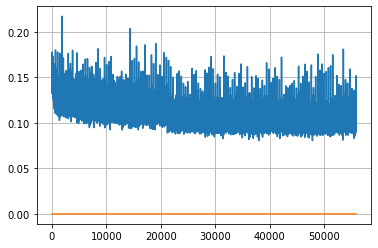

Epoch: 144, iteration 0, loss 0.09670606255531311, cov_diff 0.4105304048552189 cov_diff train 0.4102083835265894
Epoch: 144, iteration 1, loss 0.09102356433868408, cov_diff 0.4142136478692726 cov_diff train 0.4138117443372391
Epoch: 144, iteration 2, loss 0.1094142496585846, cov_diff 0.4180489677034393 cov_diff train 0.4181074683118145
Epoch: 144, iteration 3, loss 0.10075771808624268, cov_diff 0.40694741514610777 cov_diff train 0.4070761162501851
Epoch: 144, iteration 4, loss 0.09910881519317627, cov_diff 0.412485902160321 cov_diff train 0.41244954118312155
Epoch: 144, iteration 5, loss 0.09793469309806824, cov_diff 0.41534343494360415 cov_diff train 0.4148684095086712
Epoch: 144, iteration 6, loss 0.0931570827960968, cov_diff 0.4224220822954272 cov_diff train 0.4216712949037244
Epoch: 144, iteration 7, loss 0.10664612054824829, cov_diff 0.4131682967475711 cov_diff train 0.4127212509496919
Epoch: 144, iteration 8, loss 0.10135498642921448, cov_diff 0.4118687759030196 cov_diff train 0.

Epoch: 144, iteration 79, loss 0.11102190613746643, cov_diff 0.4146647026946802 cov_diff train 0.4141947890147153
Epoch: 144, iteration 80, loss 0.09992185235023499, cov_diff 0.4204259701264707 cov_diff train 0.4185167706386685
Epoch: 144, iteration 81, loss 0.1094362735748291, cov_diff 0.4212694115977312 cov_diff train 0.4207321566359366
Epoch: 144, iteration 82, loss 0.10126879811286926, cov_diff 0.41179412878150357 cov_diff train 0.41158680022868094
Epoch: 144, iteration 83, loss 0.10846173763275146, cov_diff 0.41801602758101825 cov_diff train 0.4177835584419927
Epoch: 144, iteration 84, loss 0.10653224587440491, cov_diff 0.4326482145963275 cov_diff train 0.43175766826825274
Epoch: 144, iteration 85, loss 0.10454806685447693, cov_diff 0.42582076806430713 cov_diff train 0.42461935074198975
Epoch: 144, iteration 86, loss 0.10719451308250427, cov_diff 0.4209482777176135 cov_diff train 0.42050455071478854
Epoch: 144, iteration 87, loss 0.1090364158153534, cov_diff 0.4197864348163517 cov

Epoch: 144, iteration 158, loss 0.08775821328163147, cov_diff 0.41166835188024 cov_diff train 0.41117876526342145
Epoch: 144, iteration 159, loss 0.1067776083946228, cov_diff 0.42069312299915074 cov_diff train 0.41996390388809185
Epoch: 144, iteration 160, loss 0.10159677267074585, cov_diff 0.4201327567500318 cov_diff train 0.4192615742908479
Epoch: 144, iteration 161, loss 0.0943203866481781, cov_diff 0.42955528620544275 cov_diff train 0.42895225696783795
Epoch: 144, iteration 162, loss 0.10827046632766724, cov_diff 0.40963514341384333 cov_diff train 0.40929018895676017
Epoch: 144, iteration 163, loss 0.10755205154418945, cov_diff 0.41907195971884303 cov_diff train 0.4184646520670747
Epoch: 144, iteration 164, loss 0.1083608865737915, cov_diff 0.41235548738632455 cov_diff train 0.41170053472855855
Epoch: 144, iteration 165, loss 0.10036835074424744, cov_diff 0.42341033432445196 cov_diff train 0.42080259584284835
Epoch: 144, iteration 166, loss 0.10545256733894348, cov_diff 0.415651672

Epoch: 144, iteration 236, loss 0.09838312864303589, cov_diff 0.4070930579993112 cov_diff train 0.4069836488429207
Epoch: 144, iteration 237, loss 0.09643235802650452, cov_diff 0.4331846841418687 cov_diff train 0.4319152573112292
Epoch: 144, iteration 238, loss 0.09736305475234985, cov_diff 0.41212758977902214 cov_diff train 0.41151717969286167
Epoch: 144, iteration 239, loss 0.11522069573402405, cov_diff 0.4164732644200246 cov_diff train 0.4153492532884316
Epoch: 144, iteration 240, loss 0.1153809130191803, cov_diff 0.4084274731734576 cov_diff train 0.40785582700207823
Epoch: 144, iteration 241, loss 0.0987289547920227, cov_diff 0.41664621192206336 cov_diff train 0.4159686810134896
Epoch: 144, iteration 242, loss 0.10461485385894775, cov_diff 0.41505186681833445 cov_diff train 0.41392570726401634
Epoch: 144, iteration 243, loss 0.10456216335296631, cov_diff 0.41387576852764507 cov_diff train 0.4124661298432011
Epoch: 144, iteration 244, loss 0.09413161873817444, cov_diff 0.41171752922

Epoch: 144, iteration 315, loss 0.10561832785606384, cov_diff 0.41623594552967635 cov_diff train 0.4150336317740871
Epoch: 144, iteration 316, loss 0.10672476887702942, cov_diff 0.4198280925401922 cov_diff train 0.4180409696623125
Epoch: 144, iteration 317, loss 0.09817862510681152, cov_diff 0.42613519695067503 cov_diff train 0.42418287109969405
Epoch: 144, iteration 318, loss 0.09941041469573975, cov_diff 0.4226113942897362 cov_diff train 0.4217057826848637
Epoch: 144, iteration 319, loss 0.10857653617858887, cov_diff 0.40539016551694707 cov_diff train 0.40425335613881846
Epoch: 144, iteration 320, loss 0.1027800440788269, cov_diff 0.4337083425508114 cov_diff train 0.43305284982281717
Epoch: 144, iteration 321, loss 0.09533411264419556, cov_diff 0.420068996109652 cov_diff train 0.41862168819094375
Epoch: 144, iteration 322, loss 0.10460704565048218, cov_diff 0.40803104822477804 cov_diff train 0.4070433549644087
Epoch: 144, iteration 323, loss 0.11648210883140564, cov_diff 0.4193262973

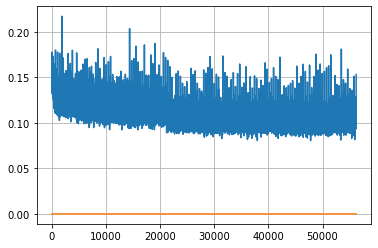

Epoch: 145, iteration 0, loss 0.09428304433822632, cov_diff 0.4134787462263816 cov_diff train 0.41285032495636836
Epoch: 145, iteration 1, loss 0.1123201847076416, cov_diff 0.41456286833324324 cov_diff train 0.41408124657942313
Epoch: 145, iteration 2, loss 0.10279062390327454, cov_diff 0.42419399581686884 cov_diff train 0.4223600872093266
Epoch: 145, iteration 3, loss 0.1013835072517395, cov_diff 0.41888462685887395 cov_diff train 0.4185344650521993
Epoch: 145, iteration 4, loss 0.10023590922355652, cov_diff 0.39667977397646204 cov_diff train 0.3962170712837288
Epoch: 145, iteration 5, loss 0.10884672403335571, cov_diff 0.4043434758776463 cov_diff train 0.40421168471088376
Epoch: 145, iteration 6, loss 0.11624154448509216, cov_diff 0.4199439997584119 cov_diff train 0.41957488398835313
Epoch: 145, iteration 7, loss 0.10646355152130127, cov_diff 0.423858149562992 cov_diff train 0.4231891541585532
Epoch: 145, iteration 8, loss 0.10016417503356934, cov_diff 0.4134315723121468 cov_diff tra

Epoch: 145, iteration 78, loss 0.1026424765586853, cov_diff 0.4128803634490331 cov_diff train 0.41206834634694267
Epoch: 145, iteration 79, loss 0.10767877101898193, cov_diff 0.4111298761813525 cov_diff train 0.4098143494072657
Epoch: 145, iteration 80, loss 0.10659494996070862, cov_diff 0.41832603967468496 cov_diff train 0.41764591512417015
Epoch: 145, iteration 81, loss 0.1141488254070282, cov_diff 0.4199294030449625 cov_diff train 0.4187451951418782
Epoch: 145, iteration 82, loss 0.1077604591846466, cov_diff 0.42066949586646046 cov_diff train 0.4197520475894813
Epoch: 145, iteration 83, loss 0.09595394134521484, cov_diff 0.42107107856074494 cov_diff train 0.42038531788493355
Epoch: 145, iteration 84, loss 0.10494709014892578, cov_diff 0.42387339827790144 cov_diff train 0.42405309738058017
Epoch: 145, iteration 85, loss 0.11120975017547607, cov_diff 0.4287061782799952 cov_diff train 0.4288998481647101
Epoch: 145, iteration 86, loss 0.11026826500892639, cov_diff 0.4254221788042511 cov

Epoch: 145, iteration 160, loss 0.09935164451599121, cov_diff 0.40783703008798355 cov_diff train 0.4070570571516345
Epoch: 145, iteration 161, loss 0.10272088646888733, cov_diff 0.4189020063893262 cov_diff train 0.4195276205071885
Epoch: 145, iteration 162, loss 0.10149487853050232, cov_diff 0.4143977294796462 cov_diff train 0.4136571588020472
Epoch: 145, iteration 163, loss 0.11453145742416382, cov_diff 0.41162771140767884 cov_diff train 0.4107365004355774
Epoch: 145, iteration 164, loss 0.09912249445915222, cov_diff 0.41178754123077127 cov_diff train 0.4115792747945418
Epoch: 145, iteration 165, loss 0.10207903385162354, cov_diff 0.4189218096812483 cov_diff train 0.41789215835466365
Epoch: 145, iteration 166, loss 0.11054518818855286, cov_diff 0.410648384699483 cov_diff train 0.41037863965238475
Epoch: 145, iteration 167, loss 0.10950371623039246, cov_diff 0.40379309627962634 cov_diff train 0.40322670147126327
Epoch: 145, iteration 168, loss 0.11465993523597717, cov_diff 0.4211859800

Epoch: 145, iteration 237, loss 0.10101813077926636, cov_diff 0.403498213011231 cov_diff train 0.4033787096070958
Epoch: 145, iteration 238, loss 0.1032867431640625, cov_diff 0.40755386176139785 cov_diff train 0.4068392566661036
Epoch: 145, iteration 239, loss 0.10665974020957947, cov_diff 0.42166171761514404 cov_diff train 0.42016616641815346
Epoch: 145, iteration 240, loss 0.10805210471153259, cov_diff 0.4200945196989991 cov_diff train 0.4186983225057368
Epoch: 145, iteration 241, loss 0.10822764039039612, cov_diff 0.41244058853178406 cov_diff train 0.41194511439915504
Epoch: 145, iteration 242, loss 0.10466644167900085, cov_diff 0.407699828038299 cov_diff train 0.4077372592570485
Epoch: 145, iteration 243, loss 0.09114784002304077, cov_diff 0.42030060296751354 cov_diff train 0.4200885385275656
Epoch: 145, iteration 244, loss 0.10917726159095764, cov_diff 0.4148679661382096 cov_diff train 0.41416233970363364
Epoch: 145, iteration 245, loss 0.10438129305839539, cov_diff 0.417054059749

Epoch: 145, iteration 310, loss 0.11696180701255798, cov_diff 0.42782096551957516 cov_diff train 0.4275179558831399
Epoch: 145, iteration 311, loss 0.10503977537155151, cov_diff 0.42718009372440824 cov_diff train 0.4266956656979359
Epoch: 145, iteration 312, loss 0.09900856018066406, cov_diff 0.41623158404084776 cov_diff train 0.41571905317784996
Epoch: 145, iteration 313, loss 0.10543203353881836, cov_diff 0.41545125545890166 cov_diff train 0.4151539428567854
Epoch: 145, iteration 314, loss 0.09900647401809692, cov_diff 0.41343955977838676 cov_diff train 0.4127826487290459
Epoch: 145, iteration 315, loss 0.10496732592582703, cov_diff 0.4246672360720937 cov_diff train 0.42399517241493806
Epoch: 145, iteration 316, loss 0.11217626929283142, cov_diff 0.42881196058232796 cov_diff train 0.4285047448222287
Epoch: 145, iteration 317, loss 0.09864228963851929, cov_diff 0.41428755673404616 cov_diff train 0.4133556701668149
Epoch: 145, iteration 318, loss 0.11293968558311462, cov_diff 0.4169564

Epoch: 145, iteration 390, loss 0.15735045075416565, cov_diff 0.46149013554559143 cov_diff train 0.4607773899129619


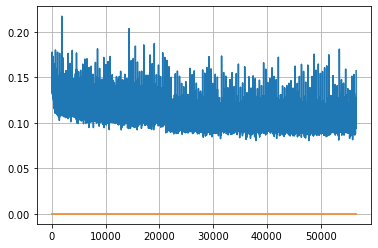

Epoch: 146, iteration 0, loss 0.09950456023216248, cov_diff 0.41192629827194566 cov_diff train 0.41150219348837563
Epoch: 146, iteration 1, loss 0.10399621725082397, cov_diff 0.41137929825780295 cov_diff train 0.41073635011075627
Epoch: 146, iteration 2, loss 0.10545852780342102, cov_diff 0.4173528347942287 cov_diff train 0.41685364323229057
Epoch: 146, iteration 3, loss 0.09230977296829224, cov_diff 0.41330963043694835 cov_diff train 0.41197816844504365
Epoch: 146, iteration 4, loss 0.09405496716499329, cov_diff 0.4235991662237054 cov_diff train 0.4235636037535624
Epoch: 146, iteration 5, loss 0.0902075469493866, cov_diff 0.41515039674985665 cov_diff train 0.41563957767270926
Epoch: 146, iteration 6, loss 0.09979602694511414, cov_diff 0.4078385177389114 cov_diff train 0.40789604874058977
Epoch: 146, iteration 7, loss 0.10383415222167969, cov_diff 0.42428437985480805 cov_diff train 0.42277555192535615
Epoch: 146, iteration 8, loss 0.11032921075820923, cov_diff 0.4196718746215752 cov_di

Epoch: 146, iteration 76, loss 0.10744908452033997, cov_diff 0.41108864113775145 cov_diff train 0.41037403738341627
Epoch: 146, iteration 77, loss 0.10827594995498657, cov_diff 0.4249415248508217 cov_diff train 0.4242258128141169
Epoch: 146, iteration 78, loss 0.10432672500610352, cov_diff 0.42110825405325925 cov_diff train 0.42074203734932486
Epoch: 146, iteration 79, loss 0.09827032685279846, cov_diff 0.411524372613552 cov_diff train 0.4108554042413623
Epoch: 146, iteration 80, loss 0.09620755910873413, cov_diff 0.41039692729328675 cov_diff train 0.40969735111715894
Epoch: 146, iteration 81, loss 0.09827840328216553, cov_diff 0.41390853227762014 cov_diff train 0.4138150186353496
Epoch: 146, iteration 82, loss 0.10706782341003418, cov_diff 0.4257008330528351 cov_diff train 0.42457005423528227
Epoch: 146, iteration 83, loss 0.09814882278442383, cov_diff 0.4176258640231679 cov_diff train 0.4167395046475234
Epoch: 146, iteration 84, loss 0.09401458501815796, cov_diff 0.42416534315466126 

Epoch: 146, iteration 151, loss 0.10702544450759888, cov_diff 0.42532507001207137 cov_diff train 0.425058619338204
Epoch: 146, iteration 152, loss 0.10019445419311523, cov_diff 0.40695689294739434 cov_diff train 0.40566969603210246
Epoch: 146, iteration 153, loss 0.10278692841529846, cov_diff 0.41202108478861277 cov_diff train 0.4117546043658401
Epoch: 146, iteration 154, loss 0.10139966011047363, cov_diff 0.42847664970516697 cov_diff train 0.4277921728113068
Epoch: 146, iteration 155, loss 0.10876131057739258, cov_diff 0.4157037973281059 cov_diff train 0.41554251139181925
Epoch: 146, iteration 156, loss 0.09603703022003174, cov_diff 0.4015246538013446 cov_diff train 0.40074622145102495
Epoch: 146, iteration 157, loss 0.12199848890304565, cov_diff 0.4214566648648249 cov_diff train 0.4198694810741394
Epoch: 146, iteration 158, loss 0.10266807675361633, cov_diff 0.4232487136971888 cov_diff train 0.42192009940193015
Epoch: 146, iteration 159, loss 0.09380173683166504, cov_diff 0.397169576

Epoch: 146, iteration 228, loss 0.10436710715293884, cov_diff 0.3939783447441357 cov_diff train 0.39310947718458
Epoch: 146, iteration 229, loss 0.11790913343429565, cov_diff 0.41323538939902915 cov_diff train 0.4133819844859009
Epoch: 146, iteration 230, loss 0.10185897350311279, cov_diff 0.4126870782613253 cov_diff train 0.4126468429112097
Epoch: 146, iteration 231, loss 0.09160226583480835, cov_diff 0.4192719334048603 cov_diff train 0.41844646168545496
Epoch: 146, iteration 232, loss 0.09988844394683838, cov_diff 0.40338547802311664 cov_diff train 0.403475950711872
Epoch: 146, iteration 233, loss 0.11176380515098572, cov_diff 0.42107069504921435 cov_diff train 0.42028086732279907
Epoch: 146, iteration 234, loss 0.1226884126663208, cov_diff 0.41176587109691876 cov_diff train 0.4111963122351365
Epoch: 146, iteration 235, loss 0.11159169673919678, cov_diff 0.423109457194642 cov_diff train 0.4232025755297804
Epoch: 146, iteration 236, loss 0.10948824882507324, cov_diff 0.407302755411216

Epoch: 146, iteration 305, loss 0.09761753678321838, cov_diff 0.42086770736472906 cov_diff train 0.4204675681335782
Epoch: 146, iteration 306, loss 0.10217839479446411, cov_diff 0.4085540181261753 cov_diff train 0.4075055218444647
Epoch: 146, iteration 307, loss 0.10196521878242493, cov_diff 0.42024960653358384 cov_diff train 0.4198876228836114
Epoch: 146, iteration 308, loss 0.09686914086341858, cov_diff 0.4172458098755428 cov_diff train 0.4156428072672117
Epoch: 146, iteration 309, loss 0.10024139285087585, cov_diff 0.41113680024212085 cov_diff train 0.4099037153880291
Epoch: 146, iteration 310, loss 0.10766252875328064, cov_diff 0.4143255656416525 cov_diff train 0.4141458919510329
Epoch: 146, iteration 311, loss 0.10987558960914612, cov_diff 0.42923761680697675 cov_diff train 0.42778584019745813
Epoch: 146, iteration 312, loss 0.095428466796875, cov_diff 0.41551639087619685 cov_diff train 0.4141997507567996
Epoch: 146, iteration 313, loss 0.10004740953445435, cov_diff 0.422570165972

Epoch: 146, iteration 383, loss 0.10909545421600342, cov_diff 0.3994127413301868 cov_diff train 0.39930781204791255
Epoch: 146, iteration 384, loss 0.09597218036651611, cov_diff 0.4209858903059489 cov_diff train 0.42004250511091695
Epoch: 146, iteration 385, loss 0.0944952666759491, cov_diff 0.40688033011515606 cov_diff train 0.40643015514116043
Epoch: 146, iteration 386, loss 0.10388398170471191, cov_diff 0.4209562021139829 cov_diff train 0.42051354528295015
Epoch: 146, iteration 387, loss 0.10827609896659851, cov_diff 0.42140678502965123 cov_diff train 0.421201575158041
Epoch: 146, iteration 388, loss 0.11510029435157776, cov_diff 0.40257912774370347 cov_diff train 0.402538937919518
Epoch: 146, iteration 389, loss 0.09973683953285217, cov_diff 0.4170574608737348 cov_diff train 0.4166668300589892
Epoch: 146, iteration 390, loss 0.1417025625705719, cov_diff 0.45322219863884866 cov_diff train 0.45353863822245977


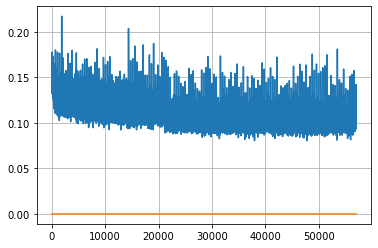

Epoch: 147, iteration 0, loss 0.10265541076660156, cov_diff 0.40877998719470376 cov_diff train 0.4086913885008081
Epoch: 147, iteration 1, loss 0.10523220896720886, cov_diff 0.40798440139384845 cov_diff train 0.4081500458141417
Epoch: 147, iteration 2, loss 0.09825634956359863, cov_diff 0.41738591893139804 cov_diff train 0.4177091734099024
Epoch: 147, iteration 3, loss 0.11317816376686096, cov_diff 0.4144326356910815 cov_diff train 0.4130846306928094
Epoch: 147, iteration 4, loss 0.10870212316513062, cov_diff 0.40274260080429136 cov_diff train 0.40208763097424977
Epoch: 147, iteration 5, loss 0.10246014595031738, cov_diff 0.41299702631327445 cov_diff train 0.4118659184551342
Epoch: 147, iteration 6, loss 0.114664226770401, cov_diff 0.4211762458250951 cov_diff train 0.4208549780695971
Epoch: 147, iteration 7, loss 0.10586181282997131, cov_diff 0.42450496267351906 cov_diff train 0.4220863235337773
Epoch: 147, iteration 8, loss 0.10794487595558167, cov_diff 0.40961293305987606 cov_diff tr

Epoch: 147, iteration 80, loss 0.09447342157363892, cov_diff 0.41904277429728226 cov_diff train 0.4187239584325454
Epoch: 147, iteration 81, loss 0.10703319311141968, cov_diff 0.4113091839969991 cov_diff train 0.41043012787651056
Epoch: 147, iteration 82, loss 0.10417991876602173, cov_diff 0.40891999435216975 cov_diff train 0.40775070528372637
Epoch: 147, iteration 83, loss 0.10718926787376404, cov_diff 0.4073827438392267 cov_diff train 0.4069769681664647
Epoch: 147, iteration 84, loss 0.10506916046142578, cov_diff 0.42969026895490997 cov_diff train 0.4289673895010072
Epoch: 147, iteration 85, loss 0.10926908254623413, cov_diff 0.3977377390897744 cov_diff train 0.3972141252159136
Epoch: 147, iteration 86, loss 0.10293897986412048, cov_diff 0.41137900314943104 cov_diff train 0.41157813892059375
Epoch: 147, iteration 87, loss 0.10858079791069031, cov_diff 0.41948012377730337 cov_diff train 0.41906290778249417
Epoch: 147, iteration 88, loss 0.10963234305381775, cov_diff 0.4029228410551088

Epoch: 147, iteration 157, loss 0.09698572754859924, cov_diff 0.4038646423578069 cov_diff train 0.40349469409141936
Epoch: 147, iteration 158, loss 0.09758692979812622, cov_diff 0.4011981928793067 cov_diff train 0.40070776660235047
Epoch: 147, iteration 159, loss 0.09458300471305847, cov_diff 0.4103269499879124 cov_diff train 0.40895649899664926
Epoch: 147, iteration 160, loss 0.10630860924720764, cov_diff 0.42757037553065347 cov_diff train 0.4270044169752822
Epoch: 147, iteration 161, loss 0.10484722256660461, cov_diff 0.41353516598695517 cov_diff train 0.4138800118297694
Epoch: 147, iteration 162, loss 0.09760355949401855, cov_diff 0.42597068574677655 cov_diff train 0.4258412392997515
Epoch: 147, iteration 163, loss 0.0961880087852478, cov_diff 0.399890587698405 cov_diff train 0.4002965395463599
Epoch: 147, iteration 164, loss 0.10241445899009705, cov_diff 0.4169272435869779 cov_diff train 0.4169689613212615
Epoch: 147, iteration 165, loss 0.11085847020149231, cov_diff 0.430137560394

Epoch: 147, iteration 236, loss 0.10761585831642151, cov_diff 0.4169493726461162 cov_diff train 0.4165626831604451
Epoch: 147, iteration 237, loss 0.11192837357521057, cov_diff 0.4242683284462712 cov_diff train 0.42262464782462356
Epoch: 147, iteration 238, loss 0.11213511228561401, cov_diff 0.42362527065723204 cov_diff train 0.42258310257041093
Epoch: 147, iteration 239, loss 0.10866925120353699, cov_diff 0.41980293899533083 cov_diff train 0.4191899263826465
Epoch: 147, iteration 240, loss 0.10164690017700195, cov_diff 0.41850412627083583 cov_diff train 0.4180770991274446
Epoch: 147, iteration 241, loss 0.09853658080101013, cov_diff 0.42685914783769974 cov_diff train 0.4259115889544283
Epoch: 147, iteration 242, loss 0.09911969304084778, cov_diff 0.40249117796372647 cov_diff train 0.40186573703898326
Epoch: 147, iteration 243, loss 0.10913437604904175, cov_diff 0.4263415855416321 cov_diff train 0.4255587794157223
Epoch: 147, iteration 244, loss 0.10213357210159302, cov_diff 0.42540103

Epoch: 147, iteration 314, loss 0.11517971754074097, cov_diff 0.4171971509011339 cov_diff train 0.4165167548381901
Epoch: 147, iteration 315, loss 0.09794867038726807, cov_diff 0.41872967868993327 cov_diff train 0.41741251879757324
Epoch: 147, iteration 316, loss 0.10193416476249695, cov_diff 0.42514803753820324 cov_diff train 0.42404482128520704
Epoch: 147, iteration 317, loss 0.10554748773574829, cov_diff 0.40159660370730077 cov_diff train 0.40013551287042787
Epoch: 147, iteration 318, loss 0.10980039834976196, cov_diff 0.41142601182969607 cov_diff train 0.4107861964377933
Epoch: 147, iteration 319, loss 0.09360358119010925, cov_diff 0.40918106107067376 cov_diff train 0.40830535265783374
Epoch: 147, iteration 320, loss 0.11392295360565186, cov_diff 0.4092968541067017 cov_diff train 0.4093440867206265
Epoch: 147, iteration 321, loss 0.10706290602684021, cov_diff 0.42855541740251085 cov_diff train 0.4279896046903049
Epoch: 147, iteration 322, loss 0.10216790437698364, cov_diff 0.416067

Epoch: 147, iteration 386, loss 0.10648521780967712, cov_diff 0.4178824185107774 cov_diff train 0.41758842306724064
Epoch: 147, iteration 387, loss 0.10182011127471924, cov_diff 0.41117292172626857 cov_diff train 0.4109414309567203
Epoch: 147, iteration 388, loss 0.10877755284309387, cov_diff 0.42786484561748167 cov_diff train 0.4272893153613658
Epoch: 147, iteration 389, loss 0.09685248136520386, cov_diff 0.4137434895965116 cov_diff train 0.413311251044654
Epoch: 147, iteration 390, loss 0.1564156413078308, cov_diff 0.46844517729377205 cov_diff train 0.4664607172866229


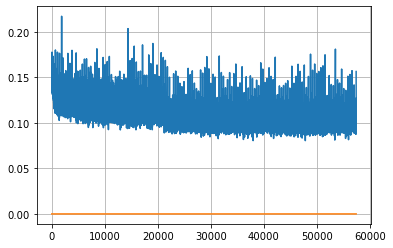

Epoch: 148, iteration 0, loss 0.09976252913475037, cov_diff 0.41290826897422306 cov_diff train 0.41196475890038775
Epoch: 148, iteration 1, loss 0.09291520714759827, cov_diff 0.41512263706204405 cov_diff train 0.41468628740854085
Epoch: 148, iteration 2, loss 0.10896748304367065, cov_diff 0.40068119952451603 cov_diff train 0.4003682126376167
Epoch: 148, iteration 3, loss 0.10205051302909851, cov_diff 0.4128130574123188 cov_diff train 0.41278890268109225
Epoch: 148, iteration 4, loss 0.11083993315696716, cov_diff 0.41099672124375075 cov_diff train 0.41118488293999067
Epoch: 148, iteration 5, loss 0.10137662291526794, cov_diff 0.42990879346856414 cov_diff train 0.42925530008701646
Epoch: 148, iteration 6, loss 0.10603144764900208, cov_diff 0.41009989674193315 cov_diff train 0.4099703904498936
Epoch: 148, iteration 7, loss 0.0905638039112091, cov_diff 0.4076971611759786 cov_diff train 0.40760200953518005
Epoch: 148, iteration 8, loss 0.09693700075149536, cov_diff 0.4040538777517634 cov_di

Epoch: 148, iteration 77, loss 0.1042059063911438, cov_diff 0.42016440695744234 cov_diff train 0.42036641300347655
Epoch: 148, iteration 78, loss 0.09330838918685913, cov_diff 0.42928462518397287 cov_diff train 0.4291247191047043
Epoch: 148, iteration 79, loss 0.09165430068969727, cov_diff 0.407192328311979 cov_diff train 0.4071281930152696
Epoch: 148, iteration 80, loss 0.10359221696853638, cov_diff 0.4249551159163333 cov_diff train 0.42477557476244654
Epoch: 148, iteration 81, loss 0.10068553686141968, cov_diff 0.4267515390172742 cov_diff train 0.4259205610497064
Epoch: 148, iteration 82, loss 0.10847494006156921, cov_diff 0.42079605571665735 cov_diff train 0.41999709032169597
Epoch: 148, iteration 83, loss 0.09373036026954651, cov_diff 0.4085177762565139 cov_diff train 0.4080898964499916
Epoch: 148, iteration 84, loss 0.12555351853370667, cov_diff 0.41241456297194423 cov_diff train 0.412298437722854
Epoch: 148, iteration 85, loss 0.11605748534202576, cov_diff 0.42239909795740654 cov

Epoch: 148, iteration 155, loss 0.10866966843605042, cov_diff 0.41738301164545993 cov_diff train 0.416445865398084
Epoch: 148, iteration 156, loss 0.11708459258079529, cov_diff 0.4162756012404075 cov_diff train 0.41599357672877657
Epoch: 148, iteration 157, loss 0.10881775617599487, cov_diff 0.42010716845188373 cov_diff train 0.4196141478040922
Epoch: 148, iteration 158, loss 0.11590313911437988, cov_diff 0.4056640666235092 cov_diff train 0.4043577110212186
Epoch: 148, iteration 159, loss 0.11450618505477905, cov_diff 0.41207394666582714 cov_diff train 0.4119525263329941
Epoch: 148, iteration 160, loss 0.10671806335449219, cov_diff 0.4174158697518732 cov_diff train 0.4159444717867886
Epoch: 148, iteration 161, loss 0.10303276777267456, cov_diff 0.4126750111101102 cov_diff train 0.41196381582860153
Epoch: 148, iteration 162, loss 0.10315847396850586, cov_diff 0.4223200288661643 cov_diff train 0.4211770978579961
Epoch: 148, iteration 163, loss 0.09722670912742615, cov_diff 0.420980632891

Epoch: 148, iteration 234, loss 0.10472014546394348, cov_diff 0.4270779840037699 cov_diff train 0.42566466342272347
Epoch: 148, iteration 235, loss 0.10970181226730347, cov_diff 0.43085480491298683 cov_diff train 0.4292047464712816
Epoch: 148, iteration 236, loss 0.10337543487548828, cov_diff 0.41762619776735055 cov_diff train 0.41650723078863733
Epoch: 148, iteration 237, loss 0.10176658630371094, cov_diff 0.41066082715139746 cov_diff train 0.4095397842998025
Epoch: 148, iteration 238, loss 0.09786894917488098, cov_diff 0.4225298340304969 cov_diff train 0.42164029164609546
Epoch: 148, iteration 239, loss 0.1018822193145752, cov_diff 0.4245924719104454 cov_diff train 0.42353284105932365
Epoch: 148, iteration 240, loss 0.10056638717651367, cov_diff 0.421427020264749 cov_diff train 0.4201502071012781
Epoch: 148, iteration 241, loss 0.11507987976074219, cov_diff 0.4154276412883686 cov_diff train 0.41430505470104484
Epoch: 148, iteration 242, loss 0.1137845516204834, cov_diff 0.42029505600

Epoch: 148, iteration 311, loss 0.10484820604324341, cov_diff 0.4223032122989251 cov_diff train 0.42161099832732457
Epoch: 148, iteration 312, loss 0.10273593664169312, cov_diff 0.4171770860235821 cov_diff train 0.41607949521181326
Epoch: 148, iteration 313, loss 0.09635120630264282, cov_diff 0.4212632761433812 cov_diff train 0.42002857719507947
Epoch: 148, iteration 314, loss 0.11164841055870056, cov_diff 0.4222767889685681 cov_diff train 0.4211537024003853
Epoch: 148, iteration 315, loss 0.09697908163070679, cov_diff 0.41313597936287805 cov_diff train 0.4117303455965653
Epoch: 148, iteration 316, loss 0.11878329515457153, cov_diff 0.4120955234670476 cov_diff train 0.4111414503265453
Epoch: 148, iteration 317, loss 0.09953290224075317, cov_diff 0.4091489889524555 cov_diff train 0.40786125706932047
Epoch: 148, iteration 318, loss 0.0937710702419281, cov_diff 0.40920798952384496 cov_diff train 0.4085272963441652
Epoch: 148, iteration 319, loss 0.09472206234931946, cov_diff 0.41129410294

Epoch: 148, iteration 388, loss 0.11993616819381714, cov_diff 0.4219764273088856 cov_diff train 0.4209938655181363
Epoch: 148, iteration 389, loss 0.09380480647087097, cov_diff 0.4215101144565425 cov_diff train 0.42043396082278733
Epoch: 148, iteration 390, loss 0.14417773485183716, cov_diff 0.46021326832342024 cov_diff train 0.4604180978367563


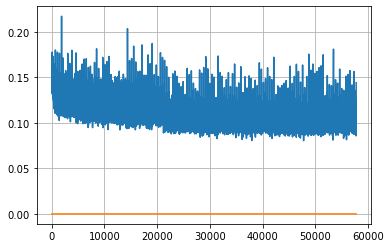

Epoch: 149, iteration 0, loss 0.09645447134971619, cov_diff 0.4096319242511083 cov_diff train 0.40884708791838026
Epoch: 149, iteration 1, loss 0.09449967741966248, cov_diff 0.4259230526246738 cov_diff train 0.42482246487145126
Epoch: 149, iteration 2, loss 0.10563865303993225, cov_diff 0.4219950678576553 cov_diff train 0.42149663484719824
Epoch: 149, iteration 3, loss 0.1087484061717987, cov_diff 0.4375431001238081 cov_diff train 0.4372189389618581
Epoch: 149, iteration 4, loss 0.0990082323551178, cov_diff 0.419643596120588 cov_diff train 0.41938509259423284
Epoch: 149, iteration 5, loss 0.10993117094039917, cov_diff 0.423594763364303 cov_diff train 0.4226216846761302
Epoch: 149, iteration 6, loss 0.11494684219360352, cov_diff 0.4282020676669625 cov_diff train 0.4270175118162188
Epoch: 149, iteration 7, loss 0.09071338176727295, cov_diff 0.4149771476581581 cov_diff train 0.414985853248966
Epoch: 149, iteration 8, loss 0.11468452215194702, cov_diff 0.4191541707370001 cov_diff train 0.4

Epoch: 149, iteration 77, loss 0.10054051876068115, cov_diff 0.4325220648597439 cov_diff train 0.4303291310408248
Epoch: 149, iteration 78, loss 0.1107243001461029, cov_diff 0.42535164855816376 cov_diff train 0.4239974743762026
Epoch: 149, iteration 79, loss 0.09983247518539429, cov_diff 0.42990213547832823 cov_diff train 0.4286191820758503
Epoch: 149, iteration 80, loss 0.10724133253097534, cov_diff 0.4083735348821874 cov_diff train 0.4071004887232361
Epoch: 149, iteration 81, loss 0.11193221807479858, cov_diff 0.4170420376310292 cov_diff train 0.4158572915495857
Epoch: 149, iteration 82, loss 0.11170342564582825, cov_diff 0.41791367197999585 cov_diff train 0.4180237793138498
Epoch: 149, iteration 83, loss 0.11933600902557373, cov_diff 0.4155654436102416 cov_diff train 0.41449647891256675
Epoch: 149, iteration 84, loss 0.10325953364372253, cov_diff 0.41337621580273204 cov_diff train 0.412354714661663
Epoch: 149, iteration 85, loss 0.10306361317634583, cov_diff 0.4112923818146054 cov_d

Epoch: 149, iteration 154, loss 0.09655925631523132, cov_diff 0.4300287357751702 cov_diff train 0.42884457989887864
Epoch: 149, iteration 155, loss 0.09577837586402893, cov_diff 0.4205022476995607 cov_diff train 0.42002289526589376
Epoch: 149, iteration 156, loss 0.09806221723556519, cov_diff 0.4282754953127592 cov_diff train 0.42634722569666605
Epoch: 149, iteration 157, loss 0.10828745365142822, cov_diff 0.4291518237822785 cov_diff train 0.42851404045513974
Epoch: 149, iteration 158, loss 0.09825363755226135, cov_diff 0.4270034620519318 cov_diff train 0.42508204330610483
Epoch: 149, iteration 159, loss 0.10856431722640991, cov_diff 0.42368949655418076 cov_diff train 0.4220867984666439
Epoch: 149, iteration 160, loss 0.10289531946182251, cov_diff 0.4172110764011969 cov_diff train 0.4159956203679296
Epoch: 149, iteration 161, loss 0.09647822380065918, cov_diff 0.4178756949985116 cov_diff train 0.41655187362039375
Epoch: 149, iteration 162, loss 0.10566443204879761, cov_diff 0.405964915

Epoch: 149, iteration 231, loss 0.11366826295852661, cov_diff 0.3969675020149467 cov_diff train 0.39607422052635793
Epoch: 149, iteration 232, loss 0.10433578491210938, cov_diff 0.40382509835976543 cov_diff train 0.40182249639188833
Epoch: 149, iteration 233, loss 0.11004593968391418, cov_diff 0.40858226202563785 cov_diff train 0.4076715292095915
Epoch: 149, iteration 234, loss 0.1137995719909668, cov_diff 0.4229998216744684 cov_diff train 0.42183132092179965
Epoch: 149, iteration 235, loss 0.10767191648483276, cov_diff 0.40569692737276347 cov_diff train 0.4059689057961817
Epoch: 149, iteration 236, loss 0.09304317831993103, cov_diff 0.41346626855891866 cov_diff train 0.41332074347240183
Epoch: 149, iteration 237, loss 0.10602772235870361, cov_diff 0.4171941211077328 cov_diff train 0.41695159956805417
Epoch: 149, iteration 238, loss 0.09307509660720825, cov_diff 0.41106095716331975 cov_diff train 0.41081374220177463
Epoch: 149, iteration 239, loss 0.11180412769317627, cov_diff 0.405591

Epoch: 149, iteration 310, loss 0.0977940559387207, cov_diff 0.4108046874085286 cov_diff train 0.4109436130953336
Epoch: 149, iteration 311, loss 0.10813477635383606, cov_diff 0.41262253439331553 cov_diff train 0.41146813065640747
Epoch: 149, iteration 312, loss 0.11318963766098022, cov_diff 0.42986606222828116 cov_diff train 0.429440635184389
Epoch: 149, iteration 313, loss 0.11155730485916138, cov_diff 0.40974519648211544 cov_diff train 0.40968890373558237
Epoch: 149, iteration 314, loss 0.10664823651313782, cov_diff 0.41171171199305595 cov_diff train 0.4107498924772381
Epoch: 149, iteration 315, loss 0.10088169574737549, cov_diff 0.4105933030001115 cov_diff train 0.4102232240700072
Epoch: 149, iteration 316, loss 0.09213092923164368, cov_diff 0.41022115253215446 cov_diff train 0.40963612731779253
Epoch: 149, iteration 317, loss 0.10865208506584167, cov_diff 0.41365730255761435 cov_diff train 0.4132098889313118
Epoch: 149, iteration 318, loss 0.1160476803779602, cov_diff 0.4242705627

Epoch: 149, iteration 387, loss 0.10466733574867249, cov_diff 0.4199780911263165 cov_diff train 0.4199458496731186
Epoch: 149, iteration 388, loss 0.09147539734840393, cov_diff 0.4193377958524839 cov_diff train 0.4182390703930002
Epoch: 149, iteration 389, loss 0.10520467162132263, cov_diff 0.4162187158789848 cov_diff train 0.41528508439366074
Epoch: 149, iteration 390, loss 0.15927442908287048, cov_diff 0.45194082843906447 cov_diff train 0.45079718581015543


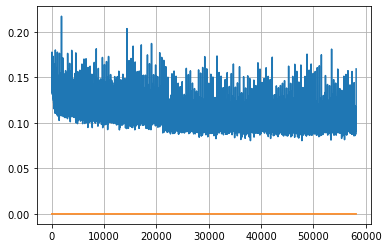

Epoch: 150, iteration 0, loss 0.11759111285209656, cov_diff 0.4122123473809564 cov_diff train 0.411463090927546
Epoch: 150, iteration 1, loss 0.11014991998672485, cov_diff 0.41789960644594343 cov_diff train 0.4172144127514424
Epoch: 150, iteration 2, loss 0.10528057813644409, cov_diff 0.42321676899598315 cov_diff train 0.42207536570847604
Epoch: 150, iteration 3, loss 0.11952510476112366, cov_diff 0.4094415746629575 cov_diff train 0.4091600081095802
Epoch: 150, iteration 4, loss 0.09995609521865845, cov_diff 0.40794973483121677 cov_diff train 0.40753232057036537
Epoch: 150, iteration 5, loss 0.10554367303848267, cov_diff 0.4162284396691678 cov_diff train 0.4154066105768109
Epoch: 150, iteration 6, loss 0.09921753406524658, cov_diff 0.4042241078097036 cov_diff train 0.40361229505751933
Epoch: 150, iteration 7, loss 0.1222955584526062, cov_diff 0.41729046805300984 cov_diff train 0.41636660345012566
Epoch: 150, iteration 8, loss 0.10311833024024963, cov_diff 0.4159963072510497 cov_diff tr

Epoch: 150, iteration 80, loss 0.10229071974754333, cov_diff 0.4147068579110035 cov_diff train 0.4137887249055022
Epoch: 150, iteration 81, loss 0.10230809450149536, cov_diff 0.41859127916619066 cov_diff train 0.4176664196710278
Epoch: 150, iteration 82, loss 0.1035001277923584, cov_diff 0.42562864701655423 cov_diff train 0.42442013393689243
Epoch: 150, iteration 83, loss 0.08581534028053284, cov_diff 0.42683305633826424 cov_diff train 0.425600992515089
Epoch: 150, iteration 84, loss 0.09932169318199158, cov_diff 0.4233679226593912 cov_diff train 0.4221731556025101
Epoch: 150, iteration 85, loss 0.112629234790802, cov_diff 0.40801340318074913 cov_diff train 0.40768534942014284
Epoch: 150, iteration 86, loss 0.0950334370136261, cov_diff 0.42337971710369204 cov_diff train 0.42211902123676126
Epoch: 150, iteration 87, loss 0.10080081224441528, cov_diff 0.41052101682713876 cov_diff train 0.4088779801520875
Epoch: 150, iteration 88, loss 0.08724793791770935, cov_diff 0.4125328222117617 cov_

Epoch: 150, iteration 152, loss 0.09150394797325134, cov_diff 0.41160623755574816 cov_diff train 0.41119114559035763
Epoch: 150, iteration 153, loss 0.10592532157897949, cov_diff 0.41974428214939097 cov_diff train 0.4183237903116732
Epoch: 150, iteration 154, loss 0.09184020757675171, cov_diff 0.4224009933373167 cov_diff train 0.42172164590637795
Epoch: 150, iteration 155, loss 0.10193651914596558, cov_diff 0.4075642421314222 cov_diff train 0.40672787755635853
Epoch: 150, iteration 156, loss 0.111347496509552, cov_diff 0.4104670879887207 cov_diff train 0.4100394518039818
Epoch: 150, iteration 157, loss 0.1013689637184143, cov_diff 0.42300262536283323 cov_diff train 0.4221625338875645
Epoch: 150, iteration 158, loss 0.10059896111488342, cov_diff 0.4254651395904842 cov_diff train 0.4233218718625644
Epoch: 150, iteration 159, loss 0.09348800778388977, cov_diff 0.40264680310619544 cov_diff train 0.4022768892982659
Epoch: 150, iteration 160, loss 0.1014208197593689, cov_diff 0.4120595002351

Epoch: 150, iteration 231, loss 0.0993475615978241, cov_diff 0.41838936104985053 cov_diff train 0.4181321075865551
Epoch: 150, iteration 232, loss 0.11269792914390564, cov_diff 0.42478857965324 cov_diff train 0.4248415777569309
Epoch: 150, iteration 233, loss 0.10816708207130432, cov_diff 0.395662158211725 cov_diff train 0.39612956949888595
Epoch: 150, iteration 234, loss 0.09800758957862854, cov_diff 0.4219890991630984 cov_diff train 0.42103066637578285
Epoch: 150, iteration 235, loss 0.11207222938537598, cov_diff 0.4311469664079182 cov_diff train 0.43023034875206134
Epoch: 150, iteration 236, loss 0.11159265041351318, cov_diff 0.42407575354337745 cov_diff train 0.4228336078093562
Epoch: 150, iteration 237, loss 0.09904947876930237, cov_diff 0.4298252407288032 cov_diff train 0.4292356040068236
Epoch: 150, iteration 238, loss 0.11013168096542358, cov_diff 0.41935331388745917 cov_diff train 0.41872812261160347
Epoch: 150, iteration 239, loss 0.11468523740768433, cov_diff 0.4098693089848

Epoch: 150, iteration 311, loss 0.10064977407455444, cov_diff 0.405156534090296 cov_diff train 0.40362575699602415
Epoch: 150, iteration 312, loss 0.10079681873321533, cov_diff 0.410214544984202 cov_diff train 0.40917084146445404
Epoch: 150, iteration 313, loss 0.09759992361068726, cov_diff 0.4134449395792511 cov_diff train 0.41232758771333156
Epoch: 150, iteration 314, loss 0.10560458898544312, cov_diff 0.4131254101250598 cov_diff train 0.4125755086971633
Epoch: 150, iteration 315, loss 0.09874975681304932, cov_diff 0.4244768561518311 cov_diff train 0.42462376865273926
Epoch: 150, iteration 316, loss 0.1079290509223938, cov_diff 0.41382719471434487 cov_diff train 0.41238544923227743
Epoch: 150, iteration 317, loss 0.10044237971305847, cov_diff 0.43638052726418564 cov_diff train 0.43566853180395193
Epoch: 150, iteration 318, loss 0.10394185781478882, cov_diff 0.4089614520051181 cov_diff train 0.40827782818218905
Epoch: 150, iteration 319, loss 0.10571098327636719, cov_diff 0.4255064648

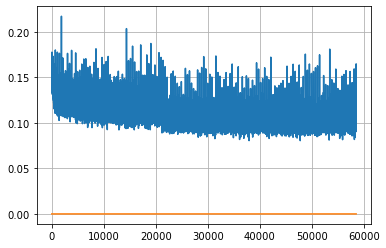

Epoch: 151, iteration 0, loss 0.10408025979995728, cov_diff 0.42566193945972214 cov_diff train 0.42552915791572776
Epoch: 151, iteration 1, loss 0.10616588592529297, cov_diff 0.4106340679214539 cov_diff train 0.40965130013159196
Epoch: 151, iteration 2, loss 0.09337368607521057, cov_diff 0.4158835776455527 cov_diff train 0.41514879757418766
Epoch: 151, iteration 3, loss 0.1012011468410492, cov_diff 0.4222637389547421 cov_diff train 0.42213671353700627
Epoch: 151, iteration 4, loss 0.10710373520851135, cov_diff 0.4203951941586313 cov_diff train 0.41996573885726574
Epoch: 151, iteration 5, loss 0.1012791097164154, cov_diff 0.41064955730914826 cov_diff train 0.4097640509391633
Epoch: 151, iteration 6, loss 0.10548192262649536, cov_diff 0.40797104845326926 cov_diff train 0.40670538959398217
Epoch: 151, iteration 7, loss 0.09694913029670715, cov_diff 0.4271421972151485 cov_diff train 0.4266323813267882
Epoch: 151, iteration 8, loss 0.10496363043785095, cov_diff 0.40480604760698735 cov_diff 

Epoch: 151, iteration 78, loss 0.0948089063167572, cov_diff 0.4146204710620576 cov_diff train 0.41440973443157914
Epoch: 151, iteration 79, loss 0.08594608306884766, cov_diff 0.41131807050189295 cov_diff train 0.4101198627927699
Epoch: 151, iteration 80, loss 0.11164861917495728, cov_diff 0.40365939450785204 cov_diff train 0.40371000747383046
Epoch: 151, iteration 81, loss 0.10009691119194031, cov_diff 0.43639848625815547 cov_diff train 0.43608592981604344
Epoch: 151, iteration 82, loss 0.10506629943847656, cov_diff 0.42669099816017936 cov_diff train 0.4258242407067373
Epoch: 151, iteration 83, loss 0.10285121202468872, cov_diff 0.41191912034890316 cov_diff train 0.41131123616206566
Epoch: 151, iteration 84, loss 0.09678295254707336, cov_diff 0.40169229264373185 cov_diff train 0.40109833064550343
Epoch: 151, iteration 85, loss 0.09799978137016296, cov_diff 0.4205246700546094 cov_diff train 0.41870777443387985
Epoch: 151, iteration 86, loss 0.10883396863937378, cov_diff 0.41134970525382

Epoch: 151, iteration 155, loss 0.09177103638648987, cov_diff 0.4091539053433943 cov_diff train 0.40913854549829265
Epoch: 151, iteration 156, loss 0.11160218715667725, cov_diff 0.4235938545058451 cov_diff train 0.4232371923337051
Epoch: 151, iteration 157, loss 0.10922756791114807, cov_diff 0.43229648850786045 cov_diff train 0.4317690888574939
Epoch: 151, iteration 158, loss 0.11351805925369263, cov_diff 0.41254777475339277 cov_diff train 0.41184070071104445
Epoch: 151, iteration 159, loss 0.10319715738296509, cov_diff 0.4186267802955885 cov_diff train 0.4174875393088531
Epoch: 151, iteration 160, loss 0.1013944149017334, cov_diff 0.4131738961026858 cov_diff train 0.41231358218062586
Epoch: 151, iteration 161, loss 0.11643031239509583, cov_diff 0.4190968705093963 cov_diff train 0.4184313172402332
Epoch: 151, iteration 162, loss 0.1019580066204071, cov_diff 0.4040618291846053 cov_diff train 0.4029132103267661
Epoch: 151, iteration 163, loss 0.1050693690776825, cov_diff 0.41318651823021

Epoch: 151, iteration 233, loss 0.10762381553649902, cov_diff 0.41195983537017195 cov_diff train 0.410658726537489
Epoch: 151, iteration 234, loss 0.09998661279678345, cov_diff 0.4207339113354684 cov_diff train 0.4197587924852892
Epoch: 151, iteration 235, loss 0.10510751605033875, cov_diff 0.4132702707880491 cov_diff train 0.4120852851229749
Epoch: 151, iteration 236, loss 0.10081395506858826, cov_diff 0.41936534978732193 cov_diff train 0.4181836170988072
Epoch: 151, iteration 237, loss 0.11376389861106873, cov_diff 0.40554065911084247 cov_diff train 0.404642309190076
Epoch: 151, iteration 238, loss 0.10436239838600159, cov_diff 0.41137683673658254 cov_diff train 0.4110132677409424
Epoch: 151, iteration 239, loss 0.10219910740852356, cov_diff 0.41946051141264984 cov_diff train 0.4192083886885595
Epoch: 151, iteration 240, loss 0.09400659799575806, cov_diff 0.4167745758338942 cov_diff train 0.4164312496311976
Epoch: 151, iteration 241, loss 0.10099482536315918, cov_diff 0.4300603952075

Epoch: 151, iteration 310, loss 0.11050859093666077, cov_diff 0.4129148937754462 cov_diff train 0.41149800475143355
Epoch: 151, iteration 311, loss 0.11805343627929688, cov_diff 0.4181029503747476 cov_diff train 0.41750584451164113
Epoch: 151, iteration 312, loss 0.10510286688804626, cov_diff 0.4380310729342028 cov_diff train 0.437028211148127
Epoch: 151, iteration 313, loss 0.09755504131317139, cov_diff 0.4141429704296856 cov_diff train 0.41348332689023987
Epoch: 151, iteration 314, loss 0.10738688707351685, cov_diff 0.40668964983296557 cov_diff train 0.40646609094050046
Epoch: 151, iteration 315, loss 0.11150634288787842, cov_diff 0.4302221947273254 cov_diff train 0.42900273876851097
Epoch: 151, iteration 316, loss 0.10949063301086426, cov_diff 0.4147614526129672 cov_diff train 0.41389851462891647
Epoch: 151, iteration 317, loss 0.10433900356292725, cov_diff 0.41054168230427146 cov_diff train 0.4091705225635943
Epoch: 151, iteration 318, loss 0.11872315406799316, cov_diff 0.415622009

Epoch: 151, iteration 387, loss 0.11170756816864014, cov_diff 0.4140603989776448 cov_diff train 0.41286752243013214
Epoch: 151, iteration 388, loss 0.09678348898887634, cov_diff 0.42431527563463833 cov_diff train 0.4235703698624712
Epoch: 151, iteration 389, loss 0.10028302669525146, cov_diff 0.4105862917789015 cov_diff train 0.40988250452406033
Epoch: 151, iteration 390, loss 0.1416858732700348, cov_diff 0.4723987079943885 cov_diff train 0.47038537371035294


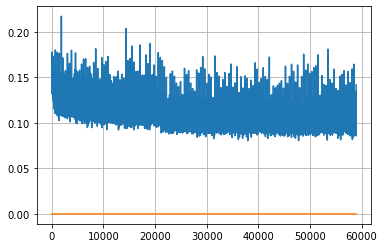

Epoch: 152, iteration 0, loss 0.1044597327709198, cov_diff 0.40332462525941604 cov_diff train 0.4017425371640633
Epoch: 152, iteration 1, loss 0.10854163765907288, cov_diff 0.4104380395363721 cov_diff train 0.40958158533383837
Epoch: 152, iteration 2, loss 0.09724023938179016, cov_diff 0.41936301006224574 cov_diff train 0.41878620724873616
Epoch: 152, iteration 3, loss 0.10561138391494751, cov_diff 0.403282909191868 cov_diff train 0.40216720846606363
Epoch: 152, iteration 4, loss 0.10701107978820801, cov_diff 0.41404506260645657 cov_diff train 0.41365483193305086
Epoch: 152, iteration 5, loss 0.09772878885269165, cov_diff 0.42090359957793294 cov_diff train 0.4196476709097536
Epoch: 152, iteration 6, loss 0.10414621233940125, cov_diff 0.4185850554797012 cov_diff train 0.4174342910090371
Epoch: 152, iteration 7, loss 0.10410913825035095, cov_diff 0.4221787776716284 cov_diff train 0.4213566534258869
Epoch: 152, iteration 8, loss 0.11050081253051758, cov_diff 0.4026154030258919 cov_diff tr

Epoch: 152, iteration 78, loss 0.09903547167778015, cov_diff 0.42689012971050205 cov_diff train 0.4265495209598787
Epoch: 152, iteration 79, loss 0.10477575659751892, cov_diff 0.4355883775945225 cov_diff train 0.434621085544435
Epoch: 152, iteration 80, loss 0.11116170883178711, cov_diff 0.41422501012070734 cov_diff train 0.4135738147529573
Epoch: 152, iteration 81, loss 0.09619805216789246, cov_diff 0.41327242741178155 cov_diff train 0.4122841582996363
Epoch: 152, iteration 82, loss 0.10713481903076172, cov_diff 0.4165936384096568 cov_diff train 0.41547563509772045
Epoch: 152, iteration 83, loss 0.10610052943229675, cov_diff 0.42831053468606706 cov_diff train 0.4274607756987102
Epoch: 152, iteration 84, loss 0.11875870823860168, cov_diff 0.4126576602182834 cov_diff train 0.41178333098954434
Epoch: 152, iteration 85, loss 0.10701650381088257, cov_diff 0.41276905788492624 cov_diff train 0.41174434701758517
Epoch: 152, iteration 86, loss 0.1031547486782074, cov_diff 0.4145804674123602 co

Epoch: 152, iteration 156, loss 0.1070457398891449, cov_diff 0.41558114426287607 cov_diff train 0.41518592723102477
Epoch: 152, iteration 157, loss 0.09888359904289246, cov_diff 0.4188335441151755 cov_diff train 0.4174366033369318
Epoch: 152, iteration 158, loss 0.11018425226211548, cov_diff 0.4157188469389295 cov_diff train 0.4150247987839328
Epoch: 152, iteration 159, loss 0.09744521975517273, cov_diff 0.41449111097303 cov_diff train 0.4137081127977545
Epoch: 152, iteration 160, loss 0.10329008102416992, cov_diff 0.40514200148439544 cov_diff train 0.4046512057377163
Epoch: 152, iteration 161, loss 0.11822777986526489, cov_diff 0.4063516605027292 cov_diff train 0.4060450617351469
Epoch: 152, iteration 162, loss 0.10499754548072815, cov_diff 0.3984660029831008 cov_diff train 0.3977392517520699
Epoch: 152, iteration 163, loss 0.10551205277442932, cov_diff 0.4061252484005144 cov_diff train 0.404720664668101
Epoch: 152, iteration 164, loss 0.10969576239585876, cov_diff 0.4148447099416967 

Epoch: 152, iteration 230, loss 0.08925586938858032, cov_diff 0.4105891275838269 cov_diff train 0.4099669888061622
Epoch: 152, iteration 231, loss 0.10299032926559448, cov_diff 0.4214706120155344 cov_diff train 0.4207109872168683
Epoch: 152, iteration 232, loss 0.09428656101226807, cov_diff 0.4201556676560028 cov_diff train 0.41831014213841256
Epoch: 152, iteration 233, loss 0.09211933612823486, cov_diff 0.4140656160072728 cov_diff train 0.41254045883321666
Epoch: 152, iteration 234, loss 0.10997721552848816, cov_diff 0.42622011346719135 cov_diff train 0.4252822435519099
Epoch: 152, iteration 235, loss 0.1077863872051239, cov_diff 0.40897625200751525 cov_diff train 0.4079359847543848
Epoch: 152, iteration 236, loss 0.09831845760345459, cov_diff 0.4073834094038988 cov_diff train 0.40663909093510225
Epoch: 152, iteration 237, loss 0.1005077064037323, cov_diff 0.41225350243052383 cov_diff train 0.4113793774662662
Epoch: 152, iteration 238, loss 0.09643885493278503, cov_diff 0.415672949966

Epoch: 152, iteration 303, loss 0.09704852104187012, cov_diff 0.41153291759722704 cov_diff train 0.4103652175398054
Epoch: 152, iteration 304, loss 0.09783816337585449, cov_diff 0.4142507670558297 cov_diff train 0.4134968310462949
Epoch: 152, iteration 305, loss 0.10106366872787476, cov_diff 0.4256095310029263 cov_diff train 0.4251589527092383
Epoch: 152, iteration 306, loss 0.09212672710418701, cov_diff 0.41733389320237907 cov_diff train 0.4169854852905559
Epoch: 152, iteration 307, loss 0.10224276781082153, cov_diff 0.4108100486591217 cov_diff train 0.4100666025142533
Epoch: 152, iteration 308, loss 0.10960051417350769, cov_diff 0.41020845093440056 cov_diff train 0.4102553591803696
Epoch: 152, iteration 309, loss 0.0923311710357666, cov_diff 0.42426934772328295 cov_diff train 0.4234457254388181
Epoch: 152, iteration 310, loss 0.10581168532371521, cov_diff 0.4152433673562487 cov_diff train 0.41511271624118495
Epoch: 152, iteration 311, loss 0.09823286533355713, cov_diff 0.406968713913

Epoch: 152, iteration 378, loss 0.11804494261741638, cov_diff 0.4076745450846028 cov_diff train 0.4069436018617227
Epoch: 152, iteration 379, loss 0.1094733476638794, cov_diff 0.4104727465915141 cov_diff train 0.408919728017879
Epoch: 152, iteration 380, loss 0.1053454577922821, cov_diff 0.40582623544298135 cov_diff train 0.40565139878450246
Epoch: 152, iteration 381, loss 0.10649597644805908, cov_diff 0.4142076046043261 cov_diff train 0.4144784511164583
Epoch: 152, iteration 382, loss 0.10211041569709778, cov_diff 0.4168693742698863 cov_diff train 0.41668975709816886
Epoch: 152, iteration 383, loss 0.11168834567070007, cov_diff 0.4338487982984038 cov_diff train 0.43409649785599036
Epoch: 152, iteration 384, loss 0.10426434874534607, cov_diff 0.42197572065686056 cov_diff train 0.4225489686596729
Epoch: 152, iteration 385, loss 0.10080486536026001, cov_diff 0.41987064403364965 cov_diff train 0.418980968764821
Epoch: 152, iteration 386, loss 0.09835675358772278, cov_diff 0.41668613153651

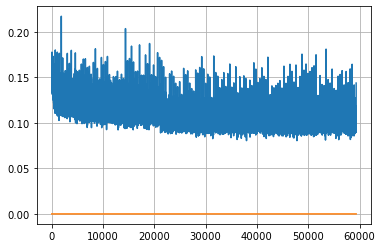

Epoch: 153, iteration 0, loss 0.10904204845428467, cov_diff 0.4219570303069048 cov_diff train 0.4209574904949947
Epoch: 153, iteration 1, loss 0.09915432333946228, cov_diff 0.41088166114122937 cov_diff train 0.4103472249639983
Epoch: 153, iteration 2, loss 0.09928148984909058, cov_diff 0.422022262174578 cov_diff train 0.4214457501132401
Epoch: 153, iteration 3, loss 0.09196621179580688, cov_diff 0.4121121545107841 cov_diff train 0.41099312025363316
Epoch: 153, iteration 4, loss 0.08836773037910461, cov_diff 0.41610623747041764 cov_diff train 0.4156606559075612
Epoch: 153, iteration 5, loss 0.10810399055480957, cov_diff 0.4194471706943335 cov_diff train 0.4180932482474062
Epoch: 153, iteration 6, loss 0.1033991277217865, cov_diff 0.42431290971034374 cov_diff train 0.42343753979016924
Epoch: 153, iteration 7, loss 0.10744565725326538, cov_diff 0.42561461860548094 cov_diff train 0.42447486170478327
Epoch: 153, iteration 8, loss 0.10259035229682922, cov_diff 0.4346132567699918 cov_diff tra

Epoch: 153, iteration 77, loss 0.09541487693786621, cov_diff 0.41464416654859976 cov_diff train 0.41418388302992937
Epoch: 153, iteration 78, loss 0.09736385941505432, cov_diff 0.4054334799657487 cov_diff train 0.4054215197264444
Epoch: 153, iteration 79, loss 0.10732325911521912, cov_diff 0.4066263219236119 cov_diff train 0.40705574788398796
Epoch: 153, iteration 80, loss 0.10930341482162476, cov_diff 0.4163303394052465 cov_diff train 0.41614915309454503
Epoch: 153, iteration 81, loss 0.10148590803146362, cov_diff 0.4149064712546108 cov_diff train 0.41367009247949543
Epoch: 153, iteration 82, loss 0.09910142421722412, cov_diff 0.4151538422553236 cov_diff train 0.41512375271363006
Epoch: 153, iteration 83, loss 0.10769408941268921, cov_diff 0.42238343652530624 cov_diff train 0.42255232862395925
Epoch: 153, iteration 84, loss 0.10778674483299255, cov_diff 0.42252476961514746 cov_diff train 0.42204181034313915
Epoch: 153, iteration 85, loss 0.0986381471157074, cov_diff 0.4165424212708526

Epoch: 153, iteration 154, loss 0.09921801090240479, cov_diff 0.42863047200385634 cov_diff train 0.42673084126823757
Epoch: 153, iteration 155, loss 0.1035071611404419, cov_diff 0.41283765867000155 cov_diff train 0.4120630098796275
Epoch: 153, iteration 156, loss 0.10145464539527893, cov_diff 0.42746054183484805 cov_diff train 0.4262307740793417
Epoch: 153, iteration 157, loss 0.11195337772369385, cov_diff 0.4156734903358459 cov_diff train 0.4151842649311622
Epoch: 153, iteration 158, loss 0.09087005257606506, cov_diff 0.42558693622454713 cov_diff train 0.4253600470983995
Epoch: 153, iteration 159, loss 0.1035425066947937, cov_diff 0.4140330755375904 cov_diff train 0.4132422358453005
Epoch: 153, iteration 160, loss 0.10174560546875, cov_diff 0.41465420192524693 cov_diff train 0.41440073803913957
Epoch: 153, iteration 161, loss 0.10173383355140686, cov_diff 0.4094383620381828 cov_diff train 0.4098899901228673
Epoch: 153, iteration 162, loss 0.10342642664909363, cov_diff 0.40965638083801

Epoch: 153, iteration 231, loss 0.10436573624610901, cov_diff 0.4328991820817154 cov_diff train 0.4323850650528283
Epoch: 153, iteration 232, loss 0.109855055809021, cov_diff 0.4170746141538319 cov_diff train 0.41674233870433314
Epoch: 153, iteration 233, loss 0.10632121562957764, cov_diff 0.4110209233011253 cov_diff train 0.4112047867685912
Epoch: 153, iteration 234, loss 0.10672402381896973, cov_diff 0.41931004953572315 cov_diff train 0.4190769149057747
Epoch: 153, iteration 235, loss 0.10593822598457336, cov_diff 0.4212552774226827 cov_diff train 0.4208313057540478
Epoch: 153, iteration 236, loss 0.10779830813407898, cov_diff 0.41922742530007373 cov_diff train 0.4185504660422713
Epoch: 153, iteration 237, loss 0.10634830594062805, cov_diff 0.41002539773782537 cov_diff train 0.4100243716358088
Epoch: 153, iteration 238, loss 0.10221990942955017, cov_diff 0.4239417956615629 cov_diff train 0.42299638774213305
Epoch: 153, iteration 239, loss 0.10003983974456787, cov_diff 0.4290505488921

Epoch: 153, iteration 308, loss 0.10604000091552734, cov_diff 0.419090277402737 cov_diff train 0.41878786307997673
Epoch: 153, iteration 309, loss 0.10520169138908386, cov_diff 0.4210490513007348 cov_diff train 0.4197022094211651
Epoch: 153, iteration 310, loss 0.10663354396820068, cov_diff 0.4294195672802052 cov_diff train 0.4290681718418784
Epoch: 153, iteration 311, loss 0.10170853137969971, cov_diff 0.4207599195867191 cov_diff train 0.4202274584095805
Epoch: 153, iteration 312, loss 0.10181573033332825, cov_diff 0.4152049451962535 cov_diff train 0.4142533545806778
Epoch: 153, iteration 313, loss 0.09751385450363159, cov_diff 0.4210105067546661 cov_diff train 0.4205623777634621
Epoch: 153, iteration 314, loss 0.12157538533210754, cov_diff 0.41275348487792585 cov_diff train 0.41170604047830667
Epoch: 153, iteration 315, loss 0.0970984399318695, cov_diff 0.4069829639223935 cov_diff train 0.40765958601226515
Epoch: 153, iteration 316, loss 0.10930204391479492, cov_diff 0.40785322740170

Epoch: 153, iteration 385, loss 0.11066651344299316, cov_diff 0.4194094464287519 cov_diff train 0.41881898813402746
Epoch: 153, iteration 386, loss 0.09920933842658997, cov_diff 0.42302068611773097 cov_diff train 0.42266754104055193
Epoch: 153, iteration 387, loss 0.10806161165237427, cov_diff 0.4125795435852342 cov_diff train 0.4118969621507699
Epoch: 153, iteration 388, loss 0.10977604985237122, cov_diff 0.43833346507293147 cov_diff train 0.4377732232362197
Epoch: 153, iteration 389, loss 0.11584696173667908, cov_diff 0.4189073049765953 cov_diff train 0.418147887871878
Epoch: 153, iteration 390, loss 0.14353317022323608, cov_diff 0.4489049354962195 cov_diff train 0.45037238351942255


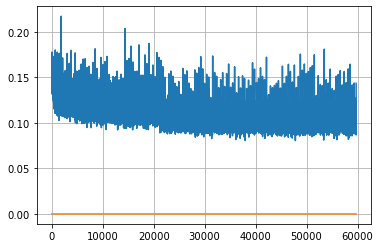

Epoch: 154, iteration 0, loss 0.10262748599052429, cov_diff 0.4110905744175851 cov_diff train 0.41074190292802043
Epoch: 154, iteration 1, loss 0.09624463319778442, cov_diff 0.4259632209748676 cov_diff train 0.425432169432227
Epoch: 154, iteration 2, loss 0.10811612010002136, cov_diff 0.4297029880773145 cov_diff train 0.42979536389689005
Epoch: 154, iteration 3, loss 0.10689964890480042, cov_diff 0.4235810344340548 cov_diff train 0.4233677024043158
Epoch: 154, iteration 4, loss 0.12253373861312866, cov_diff 0.4196099502562745 cov_diff train 0.418271088507709
Epoch: 154, iteration 5, loss 0.11690500378608704, cov_diff 0.42231505217861887 cov_diff train 0.42140601072022504
Epoch: 154, iteration 6, loss 0.09976115822792053, cov_diff 0.41239851356827595 cov_diff train 0.4121618772749483
Epoch: 154, iteration 7, loss 0.08701932430267334, cov_diff 0.4149331694479707 cov_diff train 0.4142015291215723
Epoch: 154, iteration 8, loss 0.10742315649986267, cov_diff 0.4038203064982045 cov_diff train

Epoch: 154, iteration 77, loss 0.11484932899475098, cov_diff 0.41263413223357037 cov_diff train 0.4118405136322599
Epoch: 154, iteration 78, loss 0.12349584698677063, cov_diff 0.413942557298387 cov_diff train 0.4134753080461345
Epoch: 154, iteration 79, loss 0.106385737657547, cov_diff 0.4057852125007441 cov_diff train 0.4058192885196274
Epoch: 154, iteration 80, loss 0.10564121603965759, cov_diff 0.429392901340193 cov_diff train 0.4291674608498097
Epoch: 154, iteration 81, loss 0.12013301253318787, cov_diff 0.41341287180797326 cov_diff train 0.4135352126465207
Epoch: 154, iteration 82, loss 0.1007135808467865, cov_diff 0.4168222022473685 cov_diff train 0.41693156887694793
Epoch: 154, iteration 83, loss 0.1110653281211853, cov_diff 0.4343516963506285 cov_diff train 0.4341662808545079
Epoch: 154, iteration 84, loss 0.09502136707305908, cov_diff 0.4260682871015898 cov_diff train 0.42599091881242906
Epoch: 154, iteration 85, loss 0.0991484522819519, cov_diff 0.4252904803218313 cov_diff tr

Epoch: 154, iteration 155, loss 0.10424920916557312, cov_diff 0.4106631046634537 cov_diff train 0.41086728983436543
Epoch: 154, iteration 156, loss 0.09441369771957397, cov_diff 0.4266007176945158 cov_diff train 0.42659881601166116
Epoch: 154, iteration 157, loss 0.09226354956626892, cov_diff 0.4068724708408301 cov_diff train 0.40702744312935357
Epoch: 154, iteration 158, loss 0.10275867581367493, cov_diff 0.4209155054455452 cov_diff train 0.42064552835102587
Epoch: 154, iteration 159, loss 0.09930741786956787, cov_diff 0.42582734928556576 cov_diff train 0.42561526719353615
Epoch: 154, iteration 160, loss 0.10714006423950195, cov_diff 0.43093620788872966 cov_diff train 0.43135163720437253
Epoch: 154, iteration 161, loss 0.1044260561466217, cov_diff 0.4151816138578373 cov_diff train 0.41558080097274835
Epoch: 154, iteration 162, loss 0.10480722784996033, cov_diff 0.4166051601539701 cov_diff train 0.41647348518663313
Epoch: 154, iteration 163, loss 0.10298854112625122, cov_diff 0.4318141

Epoch: 154, iteration 235, loss 0.10792070627212524, cov_diff 0.4230164195460952 cov_diff train 0.42265992331776636
Epoch: 154, iteration 236, loss 0.0998581051826477, cov_diff 0.4177985900544788 cov_diff train 0.41625331391681136
Epoch: 154, iteration 237, loss 0.10743376612663269, cov_diff 0.40997492583373013 cov_diff train 0.4096547940517786
Epoch: 154, iteration 238, loss 0.10155335068702698, cov_diff 0.42080464524659505 cov_diff train 0.4197018297902778
Epoch: 154, iteration 239, loss 0.10232633352279663, cov_diff 0.4181230162885462 cov_diff train 0.4165924996968163
Epoch: 154, iteration 240, loss 0.11937043070793152, cov_diff 0.3997057902993649 cov_diff train 0.39940532350748603
Epoch: 154, iteration 241, loss 0.10222533345222473, cov_diff 0.4114243766863033 cov_diff train 0.41110996223358887
Epoch: 154, iteration 242, loss 0.11389541625976562, cov_diff 0.4150004181223709 cov_diff train 0.4144434072044035
Epoch: 154, iteration 243, loss 0.11266589164733887, cov_diff 0.41556428403

Epoch: 154, iteration 312, loss 0.1023230254650116, cov_diff 0.4045984960878762 cov_diff train 0.4038103137132666
Epoch: 154, iteration 313, loss 0.09254419803619385, cov_diff 0.41280143688860194 cov_diff train 0.41222008563009765
Epoch: 154, iteration 314, loss 0.11504703760147095, cov_diff 0.41802149533845323 cov_diff train 0.4172991966451121
Epoch: 154, iteration 315, loss 0.11159011721611023, cov_diff 0.41866391036491124 cov_diff train 0.4180482223932827
Epoch: 154, iteration 316, loss 0.1071343719959259, cov_diff 0.4102536196833672 cov_diff train 0.40936958430976045
Epoch: 154, iteration 317, loss 0.10835990309715271, cov_diff 0.4077527231259848 cov_diff train 0.40672398937073684
Epoch: 154, iteration 318, loss 0.09233850240707397, cov_diff 0.4284149709591114 cov_diff train 0.42786860067776716
Epoch: 154, iteration 319, loss 0.10136616230010986, cov_diff 0.4123585774328406 cov_diff train 0.4119154035227213
Epoch: 154, iteration 320, loss 0.10381817817687988, cov_diff 0.40525637046

Epoch: 154, iteration 385, loss 0.1009131669998169, cov_diff 0.42141102739948527 cov_diff train 0.4201726048565278
Epoch: 154, iteration 386, loss 0.11911964416503906, cov_diff 0.41651314433240116 cov_diff train 0.4165453034173349
Epoch: 154, iteration 387, loss 0.10962891578674316, cov_diff 0.4329767599804837 cov_diff train 0.43248394453749356
Epoch: 154, iteration 388, loss 0.10965824127197266, cov_diff 0.4159748986137828 cov_diff train 0.4157522007993139
Epoch: 154, iteration 389, loss 0.11158141493797302, cov_diff 0.41503335024210963 cov_diff train 0.4148163694220916
Epoch: 154, iteration 390, loss 0.13902434706687927, cov_diff 0.46023803363984633 cov_diff train 0.4590353725638132


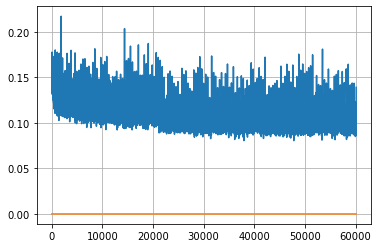

Epoch: 155, iteration 0, loss 0.09749314188957214, cov_diff 0.41015732382735726 cov_diff train 0.410165021060654
Epoch: 155, iteration 1, loss 0.1059812605381012, cov_diff 0.4358017111805449 cov_diff train 0.4356086413974488
Epoch: 155, iteration 2, loss 0.09940934181213379, cov_diff 0.4150995944818572 cov_diff train 0.41575609151455833
Epoch: 155, iteration 3, loss 0.10598626732826233, cov_diff 0.43025544824412915 cov_diff train 0.4311267534589659
Epoch: 155, iteration 4, loss 0.10898691415786743, cov_diff 0.42550912006289227 cov_diff train 0.42504686156297933
Epoch: 155, iteration 5, loss 0.10774970054626465, cov_diff 0.41927499033712634 cov_diff train 0.4182490514470961
Epoch: 155, iteration 6, loss 0.10359102487564087, cov_diff 0.41726692017789785 cov_diff train 0.41668654450677894
Epoch: 155, iteration 7, loss 0.11421507596969604, cov_diff 0.43799533803292223 cov_diff train 0.4366066741879845
Epoch: 155, iteration 8, loss 0.09364205598831177, cov_diff 0.4196471431449659 cov_diff t

Epoch: 155, iteration 77, loss 0.1115245521068573, cov_diff 0.41110180372334143 cov_diff train 0.4100368198998854
Epoch: 155, iteration 78, loss 0.10828238725662231, cov_diff 0.4191606303312249 cov_diff train 0.41829577393685363
Epoch: 155, iteration 79, loss 0.09887149930000305, cov_diff 0.4135012100659621 cov_diff train 0.41327863776973073
Epoch: 155, iteration 80, loss 0.1065552830696106, cov_diff 0.4172604551122913 cov_diff train 0.4168160665579065
Epoch: 155, iteration 81, loss 0.10620066523551941, cov_diff 0.43120014024229497 cov_diff train 0.4310298333214096
Epoch: 155, iteration 82, loss 0.10661160945892334, cov_diff 0.39983954158528595 cov_diff train 0.3989142134257373
Epoch: 155, iteration 83, loss 0.09718328714370728, cov_diff 0.42347442306985617 cov_diff train 0.42205524987249093
Epoch: 155, iteration 84, loss 0.09768086671829224, cov_diff 0.4156603201862649 cov_diff train 0.41528829251735283
Epoch: 155, iteration 85, loss 0.10225504636764526, cov_diff 0.40268557580036984 c

Epoch: 155, iteration 154, loss 0.09642007946968079, cov_diff 0.40660600040775213 cov_diff train 0.4063658599292983
Epoch: 155, iteration 155, loss 0.11022818088531494, cov_diff 0.4290647574500617 cov_diff train 0.4288402703668182
Epoch: 155, iteration 156, loss 0.09949472546577454, cov_diff 0.41222502544138445 cov_diff train 0.41236278791858305
Epoch: 155, iteration 157, loss 0.10207101702690125, cov_diff 0.41530896220517105 cov_diff train 0.41526644580929983
Epoch: 155, iteration 158, loss 0.09361624717712402, cov_diff 0.4258195132369867 cov_diff train 0.4256295389120352
Epoch: 155, iteration 159, loss 0.10462242364883423, cov_diff 0.4100054397665632 cov_diff train 0.40944285699068783
Epoch: 155, iteration 160, loss 0.09661829471588135, cov_diff 0.4149365886611202 cov_diff train 0.4144917151491394
Epoch: 155, iteration 161, loss 0.09366801381111145, cov_diff 0.42551781040269204 cov_diff train 0.42469239755179805
Epoch: 155, iteration 162, loss 0.10101592540740967, cov_diff 0.42436167

Epoch: 155, iteration 231, loss 0.10043427348136902, cov_diff 0.42046533114933615 cov_diff train 0.41996510673119786
Epoch: 155, iteration 232, loss 0.11398661136627197, cov_diff 0.4304952242035549 cov_diff train 0.42957179680535756
Epoch: 155, iteration 233, loss 0.09251052141189575, cov_diff 0.4124629444761181 cov_diff train 0.4126509490473814
Epoch: 155, iteration 234, loss 0.0938093364238739, cov_diff 0.4203830864085205 cov_diff train 0.41998495269988523
Epoch: 155, iteration 235, loss 0.0981488823890686, cov_diff 0.40085026640142957 cov_diff train 0.40099056960219553
Epoch: 155, iteration 236, loss 0.11222231388092041, cov_diff 0.424249569583615 cov_diff train 0.4235685506026641
Epoch: 155, iteration 237, loss 0.09800007939338684, cov_diff 0.41350428258003274 cov_diff train 0.41287562368507513
Epoch: 155, iteration 238, loss 0.09545162320137024, cov_diff 0.42073265069674665 cov_diff train 0.4204087444517273
Epoch: 155, iteration 239, loss 0.10285693407058716, cov_diff 0.4157938047

Epoch: 155, iteration 308, loss 0.1055661141872406, cov_diff 0.41158352222973893 cov_diff train 0.41141643984153115
Epoch: 155, iteration 309, loss 0.10235896706581116, cov_diff 0.40577370562798104 cov_diff train 0.40574512636778437
Epoch: 155, iteration 310, loss 0.10161778330802917, cov_diff 0.4273682955754044 cov_diff train 0.4268175341755874
Epoch: 155, iteration 311, loss 0.09769612550735474, cov_diff 0.40488279636157143 cov_diff train 0.40421694400432234
Epoch: 155, iteration 312, loss 0.09531062841415405, cov_diff 0.4186342670333106 cov_diff train 0.4185049430590617
Epoch: 155, iteration 313, loss 0.08930641412734985, cov_diff 0.41687343855630526 cov_diff train 0.4165327665419546
Epoch: 155, iteration 314, loss 0.09473598003387451, cov_diff 0.4228011363609363 cov_diff train 0.4221390822017278
Epoch: 155, iteration 315, loss 0.10820242762565613, cov_diff 0.41107773146004917 cov_diff train 0.41071773878145823
Epoch: 155, iteration 316, loss 0.10021272301673889, cov_diff 0.41748651

Epoch: 155, iteration 385, loss 0.10423946380615234, cov_diff 0.4145582159541626 cov_diff train 0.4140228505736045
Epoch: 155, iteration 386, loss 0.09785324335098267, cov_diff 0.4167922405649224 cov_diff train 0.41718934108640654
Epoch: 155, iteration 387, loss 0.1089174747467041, cov_diff 0.41554856324683076 cov_diff train 0.4156397572412269
Epoch: 155, iteration 388, loss 0.10381481051445007, cov_diff 0.40286168016651036 cov_diff train 0.4020971718443777
Epoch: 155, iteration 389, loss 0.09259724617004395, cov_diff 0.39725819997218925 cov_diff train 0.3969456591242491
Epoch: 155, iteration 390, loss 0.13491490483283997, cov_diff 0.44704770963402646 cov_diff train 0.4458186728225229


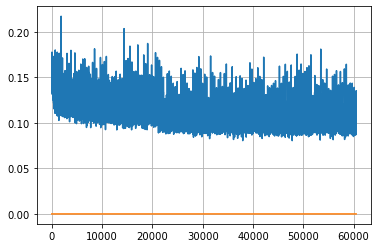

Epoch: 156, iteration 0, loss 0.10729709267616272, cov_diff 0.41500977968308866 cov_diff train 0.4138501317186763
Epoch: 156, iteration 1, loss 0.10501828789710999, cov_diff 0.4319717026254603 cov_diff train 0.43062667016646017
Epoch: 156, iteration 2, loss 0.10407698154449463, cov_diff 0.41187553601956045 cov_diff train 0.4108174067745833
Epoch: 156, iteration 3, loss 0.09809032082557678, cov_diff 0.4069023717044852 cov_diff train 0.40517443741731873
Epoch: 156, iteration 4, loss 0.09371870756149292, cov_diff 0.41566743571391573 cov_diff train 0.41471835140151764
Epoch: 156, iteration 5, loss 0.09096798300743103, cov_diff 0.410318407862611 cov_diff train 0.40975382087617507
Epoch: 156, iteration 6, loss 0.09855422377586365, cov_diff 0.42142225238396797 cov_diff train 0.41996664118648586
Epoch: 156, iteration 7, loss 0.12068665027618408, cov_diff 0.41600979479131117 cov_diff train 0.4153323956509494
Epoch: 156, iteration 8, loss 0.09202414751052856, cov_diff 0.42019124291932414 cov_dif

Epoch: 156, iteration 78, loss 0.11677643656730652, cov_diff 0.4189788875620607 cov_diff train 0.41877894552936024
Epoch: 156, iteration 79, loss 0.10077482461929321, cov_diff 0.4152802650747264 cov_diff train 0.4150355564346259
Epoch: 156, iteration 80, loss 0.10074722766876221, cov_diff 0.42318705601634377 cov_diff train 0.4227991066660484
Epoch: 156, iteration 81, loss 0.09434407949447632, cov_diff 0.4088455126898156 cov_diff train 0.40780892616125963
Epoch: 156, iteration 82, loss 0.10086879134178162, cov_diff 0.4104090962498301 cov_diff train 0.4087453735242026
Epoch: 156, iteration 83, loss 0.0963706374168396, cov_diff 0.40412838598236484 cov_diff train 0.40385252849592146
Epoch: 156, iteration 84, loss 0.09788858890533447, cov_diff 0.41824429978977057 cov_diff train 0.417289513829663
Epoch: 156, iteration 85, loss 0.10607260465621948, cov_diff 0.4037874879899038 cov_diff train 0.4032229085037769
Epoch: 156, iteration 86, loss 0.11354157328605652, cov_diff 0.401736956064487 cov_d

Epoch: 156, iteration 157, loss 0.09843006730079651, cov_diff 0.42321774241222243 cov_diff train 0.42250683101183173
Epoch: 156, iteration 158, loss 0.11630219221115112, cov_diff 0.4285085088363115 cov_diff train 0.42677960850829244
Epoch: 156, iteration 159, loss 0.09892290830612183, cov_diff 0.4030764030623326 cov_diff train 0.40174363500109106
Epoch: 156, iteration 160, loss 0.09181815385818481, cov_diff 0.42629888744788835 cov_diff train 0.4246230991247255
Epoch: 156, iteration 161, loss 0.09625464677810669, cov_diff 0.3980052096034906 cov_diff train 0.39665796335269304
Epoch: 156, iteration 162, loss 0.10751596093177795, cov_diff 0.4039320981167375 cov_diff train 0.4030510986259618
Epoch: 156, iteration 163, loss 0.09444358944892883, cov_diff 0.4154212084085093 cov_diff train 0.4140281859848228
Epoch: 156, iteration 164, loss 0.09663969278335571, cov_diff 0.4133811571213205 cov_diff train 0.41184839671530626
Epoch: 156, iteration 165, loss 0.1025572419166565, cov_diff 0.4195234322

Epoch: 156, iteration 237, loss 0.11136704683303833, cov_diff 0.41168309701466027 cov_diff train 0.41131324350235643
Epoch: 156, iteration 238, loss 0.10738125443458557, cov_diff 0.40571230316876555 cov_diff train 0.40517172033223464
Epoch: 156, iteration 239, loss 0.10003823041915894, cov_diff 0.42682423402960945 cov_diff train 0.42586709752720026
Epoch: 156, iteration 240, loss 0.11239126324653625, cov_diff 0.42790959253688954 cov_diff train 0.4263669488560063
Epoch: 156, iteration 241, loss 0.10667815804481506, cov_diff 0.4182978983571334 cov_diff train 0.4170036893558574
Epoch: 156, iteration 242, loss 0.09813892841339111, cov_diff 0.4171599535771256 cov_diff train 0.4165732505046359
Epoch: 156, iteration 243, loss 0.08994290232658386, cov_diff 0.4030350661347286 cov_diff train 0.40215256366822383
Epoch: 156, iteration 244, loss 0.11287239193916321, cov_diff 0.41151492984077814 cov_diff train 0.4107095679439225
Epoch: 156, iteration 245, loss 0.10174104571342468, cov_diff 0.4049789

Epoch: 156, iteration 312, loss 0.10479700565338135, cov_diff 0.4278787545387817 cov_diff train 0.4271026381605194
Epoch: 156, iteration 313, loss 0.11439350247383118, cov_diff 0.41561651868778937 cov_diff train 0.4151590079068756
Epoch: 156, iteration 314, loss 0.10498848557472229, cov_diff 0.41420463330428087 cov_diff train 0.41418182996673536
Epoch: 156, iteration 315, loss 0.09739524126052856, cov_diff 0.401495500439311 cov_diff train 0.4011020083545058
Epoch: 156, iteration 316, loss 0.10962879657745361, cov_diff 0.4096197366888571 cov_diff train 0.4095958394577346
Epoch: 156, iteration 317, loss 0.10097771883010864, cov_diff 0.405477837669606 cov_diff train 0.4050963300501587
Epoch: 156, iteration 318, loss 0.10290879011154175, cov_diff 0.42114189772363525 cov_diff train 0.42104019201472864
Epoch: 156, iteration 319, loss 0.11886250972747803, cov_diff 0.4217782057806719 cov_diff train 0.42139990354806645
Epoch: 156, iteration 320, loss 0.09499973058700562, cov_diff 0.406055897085

Epoch: 156, iteration 388, loss 0.1090298593044281, cov_diff 0.4162529313466078 cov_diff train 0.41558119318433956
Epoch: 156, iteration 389, loss 0.10716840624809265, cov_diff 0.41536904271957503 cov_diff train 0.41469625268160726
Epoch: 156, iteration 390, loss 0.14691802859306335, cov_diff 0.4709166440595462 cov_diff train 0.46841023237262014


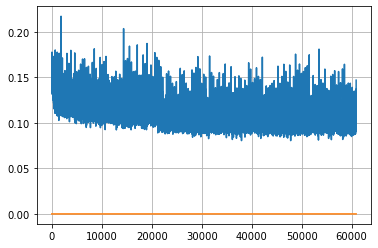

Epoch: 157, iteration 0, loss 0.11058211326599121, cov_diff 0.41034954813815094 cov_diff train 0.4093014637773364
Epoch: 157, iteration 1, loss 0.10392490029335022, cov_diff 0.42614084168199373 cov_diff train 0.4255832962691297
Epoch: 157, iteration 2, loss 0.1096249520778656, cov_diff 0.4232313424082311 cov_diff train 0.4223057655968673
Epoch: 157, iteration 3, loss 0.09316352009773254, cov_diff 0.4229373681881213 cov_diff train 0.4212779966631237
Epoch: 157, iteration 4, loss 0.11271074414253235, cov_diff 0.4211156935745811 cov_diff train 0.4199972614294218
Epoch: 157, iteration 5, loss 0.10492366552352905, cov_diff 0.425373458242367 cov_diff train 0.4251270431549871
Epoch: 157, iteration 6, loss 0.10447755455970764, cov_diff 0.4256437964844085 cov_diff train 0.4243844934757318
Epoch: 157, iteration 7, loss 0.10140854120254517, cov_diff 0.41512081191497896 cov_diff train 0.41493477686639363
Epoch: 157, iteration 8, loss 0.10566583275794983, cov_diff 0.41188282547840466 cov_diff train

Epoch: 157, iteration 79, loss 0.11231681704521179, cov_diff 0.4017970130426012 cov_diff train 0.4013284459762572
Epoch: 157, iteration 80, loss 0.10373091697692871, cov_diff 0.41951264055509074 cov_diff train 0.4185971935126651
Epoch: 157, iteration 81, loss 0.10765179991722107, cov_diff 0.42815234133821184 cov_diff train 0.4273665507245499
Epoch: 157, iteration 82, loss 0.10641130805015564, cov_diff 0.41887576568566676 cov_diff train 0.4183134721311329
Epoch: 157, iteration 83, loss 0.10976210236549377, cov_diff 0.42984401163498226 cov_diff train 0.4300971099400222
Epoch: 157, iteration 84, loss 0.11517727375030518, cov_diff 0.4210836274299424 cov_diff train 0.4202820210869432
Epoch: 157, iteration 85, loss 0.0986204445362091, cov_diff 0.42435782658556176 cov_diff train 0.42378445413672045
Epoch: 157, iteration 86, loss 0.10015931725502014, cov_diff 0.40651167243145847 cov_diff train 0.406305711130136
Epoch: 157, iteration 87, loss 0.10912036895751953, cov_diff 0.42271964191454175 co

Epoch: 157, iteration 152, loss 0.09684434533119202, cov_diff 0.4169360781895223 cov_diff train 0.416492635091579
Epoch: 157, iteration 153, loss 0.10350114107131958, cov_diff 0.406808973372077 cov_diff train 0.4056247208843432
Epoch: 157, iteration 154, loss 0.11619281768798828, cov_diff 0.39715750819664947 cov_diff train 0.3964333746010556
Epoch: 157, iteration 155, loss 0.10212329030036926, cov_diff 0.42723127104046205 cov_diff train 0.42634966658759255
Epoch: 157, iteration 156, loss 0.10862275958061218, cov_diff 0.4050651890964774 cov_diff train 0.403829814744504
Epoch: 157, iteration 157, loss 0.09989947080612183, cov_diff 0.4232050573871544 cov_diff train 0.4223629947974738
Epoch: 157, iteration 158, loss 0.10642457008361816, cov_diff 0.4204047192871831 cov_diff train 0.4192561693615225
Epoch: 157, iteration 159, loss 0.10077008605003357, cov_diff 0.40764568170040005 cov_diff train 0.4073672097506905
Epoch: 157, iteration 160, loss 0.0984879732131958, cov_diff 0.4098346112213737

Epoch: 157, iteration 232, loss 0.10569930076599121, cov_diff 0.4083864063473993 cov_diff train 0.408822445790991
Epoch: 157, iteration 233, loss 0.10514694452285767, cov_diff 0.4062513364682425 cov_diff train 0.40622620672023824
Epoch: 157, iteration 234, loss 0.0975765585899353, cov_diff 0.42322564530785206 cov_diff train 0.42242108370010467
Epoch: 157, iteration 235, loss 0.10774776339530945, cov_diff 0.41653097713590564 cov_diff train 0.4153910039940953
Epoch: 157, iteration 236, loss 0.09648022055625916, cov_diff 0.41412109878914016 cov_diff train 0.41357362608278286
Epoch: 157, iteration 237, loss 0.10565361380577087, cov_diff 0.41900655036697637 cov_diff train 0.41826016580921666
Epoch: 157, iteration 238, loss 0.11877012252807617, cov_diff 0.4221020448925758 cov_diff train 0.42164288958396917
Epoch: 157, iteration 239, loss 0.10530918836593628, cov_diff 0.4068537735634956 cov_diff train 0.4065719622644639
Epoch: 157, iteration 240, loss 0.11517393589019775, cov_diff 0.421358908

Epoch: 157, iteration 305, loss 0.09780246019363403, cov_diff 0.41241247148499766 cov_diff train 0.4114697824531386
Epoch: 157, iteration 306, loss 0.10159385204315186, cov_diff 0.41321538691813375 cov_diff train 0.41246242030270597
Epoch: 157, iteration 307, loss 0.096159428358078, cov_diff 0.4150630669626236 cov_diff train 0.41468831533194495
Epoch: 157, iteration 308, loss 0.10366347432136536, cov_diff 0.41452244831439067 cov_diff train 0.4143046476009352
Epoch: 157, iteration 309, loss 0.09665912389755249, cov_diff 0.4180929489097051 cov_diff train 0.4172982887130694
Epoch: 157, iteration 310, loss 0.10937362909317017, cov_diff 0.41887037065354554 cov_diff train 0.41694041416709
Epoch: 157, iteration 311, loss 0.10974600911140442, cov_diff 0.4077434734241763 cov_diff train 0.40675400226251374
Epoch: 157, iteration 312, loss 0.09966978430747986, cov_diff 0.41758763872519394 cov_diff train 0.41691744170448874
Epoch: 157, iteration 313, loss 0.10424202680587769, cov_diff 0.40308786433

Epoch: 157, iteration 382, loss 0.11076623201370239, cov_diff 0.41905720032877586 cov_diff train 0.41751414995132363
Epoch: 157, iteration 383, loss 0.10854560136795044, cov_diff 0.41385276580392183 cov_diff train 0.4136910895093815
Epoch: 157, iteration 384, loss 0.10274180769920349, cov_diff 0.4200055150231553 cov_diff train 0.41897413204967887
Epoch: 157, iteration 385, loss 0.11309394240379333, cov_diff 0.4103962381331089 cov_diff train 0.40913773063464254
Epoch: 157, iteration 386, loss 0.10060983896255493, cov_diff 0.4204519672999998 cov_diff train 0.4189526795447846
Epoch: 157, iteration 387, loss 0.09893116354942322, cov_diff 0.4023655933711647 cov_diff train 0.4018307936910219
Epoch: 157, iteration 388, loss 0.10103946924209595, cov_diff 0.41178444989594676 cov_diff train 0.41085179287761403
Epoch: 157, iteration 389, loss 0.10956114530563354, cov_diff 0.42085447254366476 cov_diff train 0.4188308378589694
Epoch: 157, iteration 390, loss 0.15032696723937988, cov_diff 0.45604963

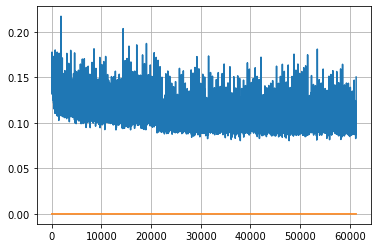

Epoch: 158, iteration 0, loss 0.10738611221313477, cov_diff 0.40518189086553325 cov_diff train 0.4043758113949791
Epoch: 158, iteration 1, loss 0.10436075925827026, cov_diff 0.4193944808583276 cov_diff train 0.41796736630917086
Epoch: 158, iteration 2, loss 0.10262352228164673, cov_diff 0.4197039639828527 cov_diff train 0.419483779714063
Epoch: 158, iteration 3, loss 0.11160394549369812, cov_diff 0.40839220769166956 cov_diff train 0.40761753583080357
Epoch: 158, iteration 4, loss 0.10632169246673584, cov_diff 0.4193446536405879 cov_diff train 0.4188488185200655
Epoch: 158, iteration 5, loss 0.10322409868240356, cov_diff 0.41482507190347184 cov_diff train 0.41421568243019835
Epoch: 158, iteration 6, loss 0.08822834491729736, cov_diff 0.4141804030290867 cov_diff train 0.4138168041692512
Epoch: 158, iteration 7, loss 0.10566708445549011, cov_diff 0.41075491622854826 cov_diff train 0.410980412570647
Epoch: 158, iteration 8, loss 0.10383379459381104, cov_diff 0.40471879483214235 cov_diff tr

Epoch: 158, iteration 75, loss 0.10279643535614014, cov_diff 0.4211493826404995 cov_diff train 0.41996170259943777
Epoch: 158, iteration 76, loss 0.09990251064300537, cov_diff 0.3987661584971842 cov_diff train 0.397759195393533
Epoch: 158, iteration 77, loss 0.1135871410369873, cov_diff 0.41296096403882476 cov_diff train 0.4121086721191268
Epoch: 158, iteration 78, loss 0.10765048861503601, cov_diff 0.41727015765882364 cov_diff train 0.4173984975750038
Epoch: 158, iteration 79, loss 0.10183936357498169, cov_diff 0.4268281132916717 cov_diff train 0.4259618382612827
Epoch: 158, iteration 80, loss 0.1153983473777771, cov_diff 0.42166521836047816 cov_diff train 0.4205047055559626
Epoch: 158, iteration 81, loss 0.10115450620651245, cov_diff 0.4307890469294756 cov_diff train 0.4299940629566596
Epoch: 158, iteration 82, loss 0.10240483283996582, cov_diff 0.4238253249780904 cov_diff train 0.4232079090350142
Epoch: 158, iteration 83, loss 0.09327083826065063, cov_diff 0.40099351923508947 cov_di

Epoch: 158, iteration 150, loss 0.10625150799751282, cov_diff 0.41889714717619236 cov_diff train 0.41840460930128653
Epoch: 158, iteration 151, loss 0.10893350839614868, cov_diff 0.42226483965718925 cov_diff train 0.4206455519469639
Epoch: 158, iteration 152, loss 0.12536048889160156, cov_diff 0.40649725242792095 cov_diff train 0.4049072482885181
Epoch: 158, iteration 153, loss 0.09848502278327942, cov_diff 0.4111707618654839 cov_diff train 0.41046773691848465
Epoch: 158, iteration 154, loss 0.10363489389419556, cov_diff 0.4095210962627693 cov_diff train 0.4095608583015033
Epoch: 158, iteration 155, loss 0.10307234525680542, cov_diff 0.4092355809848543 cov_diff train 0.4084181249949054
Epoch: 158, iteration 156, loss 0.09461164474487305, cov_diff 0.41862169007681854 cov_diff train 0.4188532174195278
Epoch: 158, iteration 157, loss 0.10372570157051086, cov_diff 0.41008260610338443 cov_diff train 0.40957495276155165
Epoch: 158, iteration 158, loss 0.10088321566581726, cov_diff 0.40130916

Epoch: 158, iteration 221, loss 0.09327051043510437, cov_diff 0.41419354098905536 cov_diff train 0.4137942981402758
Epoch: 158, iteration 222, loss 0.11101257801055908, cov_diff 0.4152669113851078 cov_diff train 0.4136212584478111
Epoch: 158, iteration 223, loss 0.10720124840736389, cov_diff 0.40882605060825855 cov_diff train 0.4081630287953624
Epoch: 158, iteration 224, loss 0.10659578442573547, cov_diff 0.4269350432937507 cov_diff train 0.4260926841609336
Epoch: 158, iteration 225, loss 0.10387739539146423, cov_diff 0.4158496521708108 cov_diff train 0.41510606342478146
Epoch: 158, iteration 226, loss 0.1031481921672821, cov_diff 0.40828903958931595 cov_diff train 0.407216674900989
Epoch: 158, iteration 227, loss 0.10569173097610474, cov_diff 0.4181705660471557 cov_diff train 0.4168691444185481
Epoch: 158, iteration 228, loss 0.10808059573173523, cov_diff 0.42305922186052247 cov_diff train 0.42245471147245284
Epoch: 158, iteration 229, loss 0.10727912187576294, cov_diff 0.427211448754

Epoch: 158, iteration 298, loss 0.09598055481910706, cov_diff 0.41227089853898474 cov_diff train 0.4118862901665745
Epoch: 158, iteration 299, loss 0.10586658120155334, cov_diff 0.4186224853620418 cov_diff train 0.41858669620167366
Epoch: 158, iteration 300, loss 0.10329064726829529, cov_diff 0.4215529003377132 cov_diff train 0.4221528552977431
Epoch: 158, iteration 301, loss 0.09979987144470215, cov_diff 0.4147798974716501 cov_diff train 0.4133209650447082
Epoch: 158, iteration 302, loss 0.10188698768615723, cov_diff 0.42437155301556007 cov_diff train 0.42368799574872096
Epoch: 158, iteration 303, loss 0.11272510886192322, cov_diff 0.411361295464628 cov_diff train 0.4102730334223127
Epoch: 158, iteration 304, loss 0.10286283493041992, cov_diff 0.4239062377386105 cov_diff train 0.4230163164428335
Epoch: 158, iteration 305, loss 0.09159362316131592, cov_diff 0.4309962416253346 cov_diff train 0.4295969864958866
Epoch: 158, iteration 306, loss 0.09560975432395935, cov_diff 0.4251785322942

Epoch: 158, iteration 372, loss 0.11193245649337769, cov_diff 0.41469771030307284 cov_diff train 0.4137126810988978
Epoch: 158, iteration 373, loss 0.10767492651939392, cov_diff 0.42599988851328235 cov_diff train 0.4256535419851971
Epoch: 158, iteration 374, loss 0.1140296459197998, cov_diff 0.43170532322494715 cov_diff train 0.43116349686943545
Epoch: 158, iteration 375, loss 0.09652936458587646, cov_diff 0.41962432563586755 cov_diff train 0.41866760646307766
Epoch: 158, iteration 376, loss 0.10559007525444031, cov_diff 0.4256584573844042 cov_diff train 0.4250509058985774
Epoch: 158, iteration 377, loss 0.10267019271850586, cov_diff 0.4270672016550252 cov_diff train 0.42674985808180377
Epoch: 158, iteration 378, loss 0.09394443035125732, cov_diff 0.4168407714973115 cov_diff train 0.4168676656997737
Epoch: 158, iteration 379, loss 0.10364693403244019, cov_diff 0.4233227629057651 cov_diff train 0.4227422860347646
Epoch: 158, iteration 380, loss 0.10247498750686646, cov_diff 0.4175428909

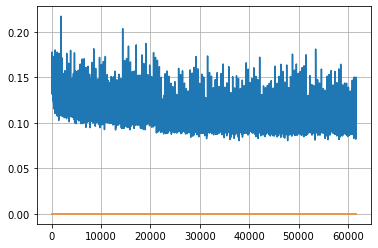

Epoch: 159, iteration 0, loss 0.10474750399589539, cov_diff 0.409370555254778 cov_diff train 0.40855679892717184
Epoch: 159, iteration 1, loss 0.1120348572731018, cov_diff 0.4204027453626366 cov_diff train 0.41994919910634937
Epoch: 159, iteration 2, loss 0.09601107239723206, cov_diff 0.4183110742117592 cov_diff train 0.4177436101131954
Epoch: 159, iteration 3, loss 0.107563316822052, cov_diff 0.4163387119986117 cov_diff train 0.41583946615845424
Epoch: 159, iteration 4, loss 0.10980978608131409, cov_diff 0.4170882301017408 cov_diff train 0.4165120026834179
Epoch: 159, iteration 5, loss 0.09622412919998169, cov_diff 0.42225516246498934 cov_diff train 0.421657797425991
Epoch: 159, iteration 6, loss 0.10360437631607056, cov_diff 0.4062919041759407 cov_diff train 0.4057628671588457
Epoch: 159, iteration 7, loss 0.10711422562599182, cov_diff 0.41391085251092274 cov_diff train 0.41268625264359754
Epoch: 159, iteration 8, loss 0.09582650661468506, cov_diff 0.4313345350901226 cov_diff train 0

Epoch: 159, iteration 76, loss 0.10299214720726013, cov_diff 0.4162889202868015 cov_diff train 0.4164329950133326
Epoch: 159, iteration 77, loss 0.10658344626426697, cov_diff 0.4177989596350059 cov_diff train 0.41723766209284474
Epoch: 159, iteration 78, loss 0.12486767768859863, cov_diff 0.4355953063654283 cov_diff train 0.43542331779330407
Epoch: 159, iteration 79, loss 0.11456805467605591, cov_diff 0.4326908248686669 cov_diff train 0.4325094449063721
Epoch: 159, iteration 80, loss 0.10374471545219421, cov_diff 0.4382185756603184 cov_diff train 0.4383592212976254
Epoch: 159, iteration 81, loss 0.10023343563079834, cov_diff 0.4252470729034535 cov_diff train 0.4237423328557058
Epoch: 159, iteration 82, loss 0.08662864565849304, cov_diff 0.4164799270659746 cov_diff train 0.41523443765714596
Epoch: 159, iteration 83, loss 0.09407833218574524, cov_diff 0.4188621158200157 cov_diff train 0.41813965086267296
Epoch: 159, iteration 84, loss 0.0980745255947113, cov_diff 0.4295013612062086 cov_d

Epoch: 159, iteration 153, loss 0.09774211049079895, cov_diff 0.4034711754701541 cov_diff train 0.4041939475742393
Epoch: 159, iteration 154, loss 0.11324304342269897, cov_diff 0.42104514428760337 cov_diff train 0.4219183078946546
Epoch: 159, iteration 155, loss 0.10940304398536682, cov_diff 0.4199118504005313 cov_diff train 0.42042876904639953
Epoch: 159, iteration 156, loss 0.10696566104888916, cov_diff 0.40601580828704725 cov_diff train 0.406035970825288
Epoch: 159, iteration 157, loss 0.10367301106452942, cov_diff 0.4100617119579689 cov_diff train 0.4109202644606583
Epoch: 159, iteration 158, loss 0.09902405738830566, cov_diff 0.4292196469126708 cov_diff train 0.4290873076736587
Epoch: 159, iteration 159, loss 0.11927270889282227, cov_diff 0.41111557080350764 cov_diff train 0.4112550625318303
Epoch: 159, iteration 160, loss 0.10648339986801147, cov_diff 0.4251339975462881 cov_diff train 0.42516959259204146
Epoch: 159, iteration 161, loss 0.0959126353263855, cov_diff 0.4282993522246

Epoch: 159, iteration 233, loss 0.10968735814094543, cov_diff 0.4235837883563975 cov_diff train 0.42158932735034577
Epoch: 159, iteration 234, loss 0.09945797920227051, cov_diff 0.4039873929951212 cov_diff train 0.4031888188195066
Epoch: 159, iteration 235, loss 0.11144468188285828, cov_diff 0.41200597085772467 cov_diff train 0.4101061544348756
Epoch: 159, iteration 236, loss 0.10283952951431274, cov_diff 0.3960048602014088 cov_diff train 0.39484496902042
Epoch: 159, iteration 237, loss 0.09412029385566711, cov_diff 0.4111802410401814 cov_diff train 0.41092843755909464
Epoch: 159, iteration 238, loss 0.0992516577243805, cov_diff 0.41086764057431124 cov_diff train 0.41031424720538273
Epoch: 159, iteration 239, loss 0.09145316481590271, cov_diff 0.4034314198523465 cov_diff train 0.40275793954975353
Epoch: 159, iteration 240, loss 0.10070142149925232, cov_diff 0.418955812655879 cov_diff train 0.41821039000987026
Epoch: 159, iteration 241, loss 0.1097225546836853, cov_diff 0.42704688527095

Epoch: 159, iteration 308, loss 0.1176946759223938, cov_diff 0.4190845132863769 cov_diff train 0.4180021303641001
Epoch: 159, iteration 309, loss 0.10728245973587036, cov_diff 0.4200696138664091 cov_diff train 0.41848890148587053
Epoch: 159, iteration 310, loss 0.10316315293312073, cov_diff 0.4153692733787006 cov_diff train 0.4139084511555012
Epoch: 159, iteration 311, loss 0.09274131059646606, cov_diff 0.4090770357332998 cov_diff train 0.40853012288543344
Epoch: 159, iteration 312, loss 0.10419321060180664, cov_diff 0.4130393312127577 cov_diff train 0.41263643976538156
Epoch: 159, iteration 313, loss 0.10194364190101624, cov_diff 0.41196913293491483 cov_diff train 0.4121889580109791
Epoch: 159, iteration 314, loss 0.10915106534957886, cov_diff 0.419607973564102 cov_diff train 0.41871956052130654
Epoch: 159, iteration 315, loss 0.10442769527435303, cov_diff 0.41691539456461835 cov_diff train 0.41666531831233894
Epoch: 159, iteration 316, loss 0.11493438482284546, cov_diff 0.41562214986

Epoch: 159, iteration 386, loss 0.09422865509986877, cov_diff 0.41319336866981377 cov_diff train 0.4130521142931978
Epoch: 159, iteration 387, loss 0.1146465539932251, cov_diff 0.40196877620146654 cov_diff train 0.4013790423980325
Epoch: 159, iteration 388, loss 0.10534507036209106, cov_diff 0.41062912492377057 cov_diff train 0.41029735331481754
Epoch: 159, iteration 389, loss 0.10685187578201294, cov_diff 0.4160031076493725 cov_diff train 0.4148936583655308
Epoch: 159, iteration 390, loss 0.16030257940292358, cov_diff 0.44240459768434126 cov_diff train 0.4407015730933145


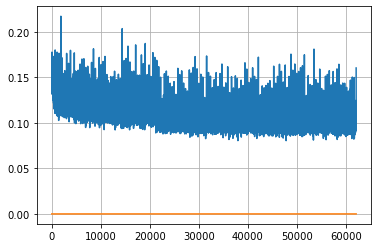

Epoch: 160, iteration 0, loss 0.09730109572410583, cov_diff 0.40305994275632173 cov_diff train 0.40215450848491097
Epoch: 160, iteration 1, loss 0.1002129316329956, cov_diff 0.4050244270539096 cov_diff train 0.40492831566462184
Epoch: 160, iteration 2, loss 0.1046028733253479, cov_diff 0.41111949516528 cov_diff train 0.4109944856271109
Epoch: 160, iteration 3, loss 0.11280322074890137, cov_diff 0.41588166233387924 cov_diff train 0.414839397496046
Epoch: 160, iteration 4, loss 0.11543712019920349, cov_diff 0.4237570492677977 cov_diff train 0.423876023552831
Epoch: 160, iteration 5, loss 0.10393834114074707, cov_diff 0.4068786888931034 cov_diff train 0.4071814030097203
Epoch: 160, iteration 6, loss 0.1101565957069397, cov_diff 0.4391626942673634 cov_diff train 0.438681043691306
Epoch: 160, iteration 7, loss 0.1013387143611908, cov_diff 0.4103080324179274 cov_diff train 0.40980711385915747
Epoch: 160, iteration 8, loss 0.10270795226097107, cov_diff 0.4168701048072371 cov_diff train 0.4171

Epoch: 160, iteration 82, loss 0.10002776980400085, cov_diff 0.42382081271950567 cov_diff train 0.4236680209514761
Epoch: 160, iteration 83, loss 0.10678926110267639, cov_diff 0.41285462442147025 cov_diff train 0.41317319190715673
Epoch: 160, iteration 84, loss 0.10549640655517578, cov_diff 0.4190684049302307 cov_diff train 0.418803116293333
Epoch: 160, iteration 85, loss 0.1008596420288086, cov_diff 0.4060206948138687 cov_diff train 0.40580884942193746
Epoch: 160, iteration 86, loss 0.10384893417358398, cov_diff 0.4159261673854324 cov_diff train 0.41584524029229014
Epoch: 160, iteration 87, loss 0.10286825895309448, cov_diff 0.41318156804724576 cov_diff train 0.4126274894777528
Epoch: 160, iteration 88, loss 0.10204893350601196, cov_diff 0.39957474411478805 cov_diff train 0.39915148895488933
Epoch: 160, iteration 89, loss 0.09844154119491577, cov_diff 0.43032256685526094 cov_diff train 0.4300165297607898
Epoch: 160, iteration 90, loss 0.1001976728439331, cov_diff 0.41562389573825015 c

Epoch: 160, iteration 158, loss 0.0976991355419159, cov_diff 0.4193366197988268 cov_diff train 0.4185896407420548
Epoch: 160, iteration 159, loss 0.10430711507797241, cov_diff 0.4257874114151343 cov_diff train 0.42403278930822463
Epoch: 160, iteration 160, loss 0.10648250579833984, cov_diff 0.4194924875582161 cov_diff train 0.4183461791556031
Epoch: 160, iteration 161, loss 0.10524120926856995, cov_diff 0.43346924611366144 cov_diff train 0.43226158121586417
Epoch: 160, iteration 162, loss 0.10575848817825317, cov_diff 0.411923083566524 cov_diff train 0.409960058976923
Epoch: 160, iteration 163, loss 0.09120327234268188, cov_diff 0.4210975668972096 cov_diff train 0.4194264782440406
Epoch: 160, iteration 164, loss 0.10415339469909668, cov_diff 0.4175754663022951 cov_diff train 0.416333311929487
Epoch: 160, iteration 165, loss 0.10137349367141724, cov_diff 0.4172632801980006 cov_diff train 0.41581951817808466
Epoch: 160, iteration 166, loss 0.09747388958930969, cov_diff 0.425616703271339 

Epoch: 160, iteration 234, loss 0.10823988914489746, cov_diff 0.4174325133103173 cov_diff train 0.41721776753939604
Epoch: 160, iteration 235, loss 0.11200469732284546, cov_diff 0.4244317199434521 cov_diff train 0.4242536230066086
Epoch: 160, iteration 236, loss 0.10727119445800781, cov_diff 0.41269428419953746 cov_diff train 0.41274598834066345
Epoch: 160, iteration 237, loss 0.10095581412315369, cov_diff 0.40519184000053826 cov_diff train 0.4045922554986124
Epoch: 160, iteration 238, loss 0.1044243574142456, cov_diff 0.4206565893504455 cov_diff train 0.42019870066963605
Epoch: 160, iteration 239, loss 0.09492328763008118, cov_diff 0.41977850626243346 cov_diff train 0.4187579137822144
Epoch: 160, iteration 240, loss 0.11280697584152222, cov_diff 0.41760729370980165 cov_diff train 0.4171364714544599
Epoch: 160, iteration 241, loss 0.10512864589691162, cov_diff 0.4209751642996028 cov_diff train 0.42012083105886666
Epoch: 160, iteration 242, loss 0.1240200400352478, cov_diff 0.4275633458

Epoch: 160, iteration 308, loss 0.11855849623680115, cov_diff 0.431989192472628 cov_diff train 0.4301056231488318
Epoch: 160, iteration 309, loss 0.10260730981826782, cov_diff 0.41164673076581976 cov_diff train 0.41122974007528174
Epoch: 160, iteration 310, loss 0.10536906123161316, cov_diff 0.4107489021830645 cov_diff train 0.4100817738961543
Epoch: 160, iteration 311, loss 0.10654041171073914, cov_diff 0.43506203073106997 cov_diff train 0.43417198532791035
Epoch: 160, iteration 312, loss 0.09923422336578369, cov_diff 0.4168901001828676 cov_diff train 0.41579113535620676
Epoch: 160, iteration 313, loss 0.09658947587013245, cov_diff 0.4180353980159951 cov_diff train 0.41709736275984566
Epoch: 160, iteration 314, loss 0.09897840023040771, cov_diff 0.41736198703080785 cov_diff train 0.41675801417186437
Epoch: 160, iteration 315, loss 0.11136242747306824, cov_diff 0.422506247128554 cov_diff train 0.4210124542064162
Epoch: 160, iteration 316, loss 0.10525140166282654, cov_diff 0.4159284031

Epoch: 160, iteration 385, loss 0.0932912528514862, cov_diff 0.4091051873130763 cov_diff train 0.4078266772065052
Epoch: 160, iteration 386, loss 0.10861742496490479, cov_diff 0.4200517849681853 cov_diff train 0.41898385842242175
Epoch: 160, iteration 387, loss 0.10755366086959839, cov_diff 0.4152887209997179 cov_diff train 0.4136082524086357
Epoch: 160, iteration 388, loss 0.1032516360282898, cov_diff 0.41405265360192917 cov_diff train 0.4135708691562976
Epoch: 160, iteration 389, loss 0.09543007612228394, cov_diff 0.41230029617512515 cov_diff train 0.4115890100077399
Epoch: 160, iteration 390, loss 0.14046144485473633, cov_diff 0.4592509234918716 cov_diff train 0.458343762232558


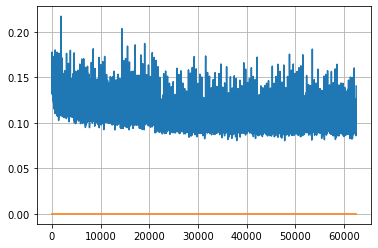

Epoch: 161, iteration 0, loss 0.10390830039978027, cov_diff 0.4163824915891041 cov_diff train 0.41494918078346266
Epoch: 161, iteration 1, loss 0.1009967029094696, cov_diff 0.41079289521884893 cov_diff train 0.4103176230517837
Epoch: 161, iteration 2, loss 0.10717621445655823, cov_diff 0.4212962346466262 cov_diff train 0.42140950361768054
Epoch: 161, iteration 3, loss 0.10258671641349792, cov_diff 0.43137112141222833 cov_diff train 0.43013909883047885
Epoch: 161, iteration 4, loss 0.09547117352485657, cov_diff 0.3984274922756278 cov_diff train 0.39863709172827744
Epoch: 161, iteration 5, loss 0.09799206256866455, cov_diff 0.42085734713358125 cov_diff train 0.42079488609539545
Epoch: 161, iteration 6, loss 0.11050087213516235, cov_diff 0.4233862490921374 cov_diff train 0.4232731516474537
Epoch: 161, iteration 7, loss 0.11386024951934814, cov_diff 0.42728805011913473 cov_diff train 0.4258714493296525
Epoch: 161, iteration 8, loss 0.09697437286376953, cov_diff 0.41045515366116925 cov_diff

Epoch: 161, iteration 79, loss 0.1088545024394989, cov_diff 0.3995388428033756 cov_diff train 0.3999720131530102
Epoch: 161, iteration 80, loss 0.10778936743736267, cov_diff 0.4238779640978398 cov_diff train 0.42300454931224435
Epoch: 161, iteration 81, loss 0.0999021828174591, cov_diff 0.4082872360494321 cov_diff train 0.408216316780026
Epoch: 161, iteration 82, loss 0.10223746299743652, cov_diff 0.40687608480701853 cov_diff train 0.4063280686013616
Epoch: 161, iteration 83, loss 0.10057604312896729, cov_diff 0.4191174423581226 cov_diff train 0.41916498851721345
Epoch: 161, iteration 84, loss 0.10624727606773376, cov_diff 0.4107586236457438 cov_diff train 0.41035763367159295
Epoch: 161, iteration 85, loss 0.09551635384559631, cov_diff 0.4197504870552192 cov_diff train 0.4188731349724479
Epoch: 161, iteration 86, loss 0.105497807264328, cov_diff 0.41226902061033943 cov_diff train 0.4114115125349788
Epoch: 161, iteration 87, loss 0.09980502724647522, cov_diff 0.409809424571531 cov_diff 

Epoch: 161, iteration 157, loss 0.09978517889976501, cov_diff 0.4058907663733258 cov_diff train 0.405114878877468
Epoch: 161, iteration 158, loss 0.10079744458198547, cov_diff 0.40612032415709476 cov_diff train 0.40515310347075434
Epoch: 161, iteration 159, loss 0.12721538543701172, cov_diff 0.41251577994800886 cov_diff train 0.4109671505673802
Epoch: 161, iteration 160, loss 0.09406706690788269, cov_diff 0.4154001587055785 cov_diff train 0.41474608863371165
Epoch: 161, iteration 161, loss 0.09884670376777649, cov_diff 0.41312495568602936 cov_diff train 0.4110734995325924
Epoch: 161, iteration 162, loss 0.10127916932106018, cov_diff 0.4087067837899732 cov_diff train 0.4080107618991316
Epoch: 161, iteration 163, loss 0.11347091197967529, cov_diff 0.4157672063320354 cov_diff train 0.4155522390202753
Epoch: 161, iteration 164, loss 0.10524564981460571, cov_diff 0.4040098894553377 cov_diff train 0.40374811029372787
Epoch: 161, iteration 165, loss 0.10497796535491943, cov_diff 0.41288367598

Epoch: 161, iteration 237, loss 0.10254848003387451, cov_diff 0.4143091638077176 cov_diff train 0.41393062187618396
Epoch: 161, iteration 238, loss 0.09865120053291321, cov_diff 0.41973418841947774 cov_diff train 0.4186846702430963
Epoch: 161, iteration 239, loss 0.10735133290290833, cov_diff 0.4091680506558888 cov_diff train 0.40921322355962697
Epoch: 161, iteration 240, loss 0.1005062460899353, cov_diff 0.41377665197338187 cov_diff train 0.4133610054864561
Epoch: 161, iteration 241, loss 0.10429835319519043, cov_diff 0.419976575846415 cov_diff train 0.4190331384758713
Epoch: 161, iteration 242, loss 0.10088902711868286, cov_diff 0.43271714418709056 cov_diff train 0.43229860854316515
Epoch: 161, iteration 243, loss 0.08902183175086975, cov_diff 0.4143581777170182 cov_diff train 0.41374456077978
Epoch: 161, iteration 244, loss 0.09964150190353394, cov_diff 0.4171355888241893 cov_diff train 0.41673739475335514
Epoch: 161, iteration 245, loss 0.1052955687046051, cov_diff 0.42224154506139

Epoch: 161, iteration 315, loss 0.10384193062782288, cov_diff 0.4186338921553782 cov_diff train 0.4180310055281217
Epoch: 161, iteration 316, loss 0.10436093807220459, cov_diff 0.41899356391301595 cov_diff train 0.4183197829476172
Epoch: 161, iteration 317, loss 0.10358467698097229, cov_diff 0.4196700049668702 cov_diff train 0.4187754392494336
Epoch: 161, iteration 318, loss 0.10550299286842346, cov_diff 0.4318621056932648 cov_diff train 0.4309335185072289
Epoch: 161, iteration 319, loss 0.09497278928756714, cov_diff 0.40803564225157735 cov_diff train 0.407638469945003
Epoch: 161, iteration 320, loss 0.10118871927261353, cov_diff 0.40735479529052304 cov_diff train 0.4070553834692932
Epoch: 161, iteration 321, loss 0.10256978869438171, cov_diff 0.42202119496296725 cov_diff train 0.4216365968769911
Epoch: 161, iteration 322, loss 0.10003960132598877, cov_diff 0.4202699903832381 cov_diff train 0.41946341316862146
Epoch: 161, iteration 323, loss 0.10567423701286316, cov_diff 0.409025995637

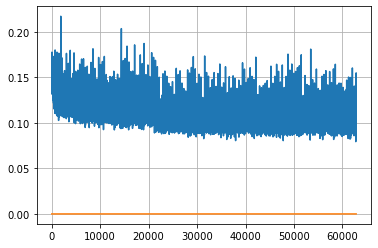

Epoch: 162, iteration 0, loss 0.09909981489181519, cov_diff 0.42222129663061647 cov_diff train 0.4223076331927588
Epoch: 162, iteration 1, loss 0.10533812642097473, cov_diff 0.4351296377009553 cov_diff train 0.4344795623810876
Epoch: 162, iteration 2, loss 0.09584096074104309, cov_diff 0.42471149841314243 cov_diff train 0.42393412612769
Epoch: 162, iteration 3, loss 0.09787425398826599, cov_diff 0.41530309841551644 cov_diff train 0.4147310343473331
Epoch: 162, iteration 4, loss 0.10946375131607056, cov_diff 0.4117510736598514 cov_diff train 0.4117839681702016
Epoch: 162, iteration 5, loss 0.10223358869552612, cov_diff 0.40921155141886634 cov_diff train 0.4087247937824797
Epoch: 162, iteration 6, loss 0.1105983555316925, cov_diff 0.4240797225528867 cov_diff train 0.42351906796235184
Epoch: 162, iteration 7, loss 0.10608038306236267, cov_diff 0.4067146253208536 cov_diff train 0.40552027214769143
Epoch: 162, iteration 8, loss 0.10518357157707214, cov_diff 0.4121785891411677 cov_diff train

Epoch: 162, iteration 82, loss 0.11299252510070801, cov_diff 0.4155963804682298 cov_diff train 0.41501921815928333
Epoch: 162, iteration 83, loss 0.098539799451828, cov_diff 0.41882089680828943 cov_diff train 0.4177592879441884
Epoch: 162, iteration 84, loss 0.11871591210365295, cov_diff 0.4065788324161153 cov_diff train 0.40611285125721064
Epoch: 162, iteration 85, loss 0.10699030756950378, cov_diff 0.4095192139195015 cov_diff train 0.40925046841776014
Epoch: 162, iteration 86, loss 0.10482299327850342, cov_diff 0.40382171865636174 cov_diff train 0.4033944564456228
Epoch: 162, iteration 87, loss 0.10701557993888855, cov_diff 0.4258728055410501 cov_diff train 0.42489188992148685
Epoch: 162, iteration 88, loss 0.09989625215530396, cov_diff 0.40997115436118675 cov_diff train 0.4097295799656566
Epoch: 162, iteration 89, loss 0.11610060930252075, cov_diff 0.4082883701718457 cov_diff train 0.40730071390682526
Epoch: 162, iteration 90, loss 0.11500182747840881, cov_diff 0.4152672751542704 co

Epoch: 162, iteration 161, loss 0.09717357158660889, cov_diff 0.41815434334888657 cov_diff train 0.41766098919884376
Epoch: 162, iteration 162, loss 0.09892493486404419, cov_diff 0.42067046345573966 cov_diff train 0.4201904270934532
Epoch: 162, iteration 163, loss 0.10716274380683899, cov_diff 0.3931356167447799 cov_diff train 0.3924885841299373
Epoch: 162, iteration 164, loss 0.09961143136024475, cov_diff 0.40707558803194904 cov_diff train 0.40688964871499483
Epoch: 162, iteration 165, loss 0.09716510772705078, cov_diff 0.4187486754386085 cov_diff train 0.41777979003029625
Epoch: 162, iteration 166, loss 0.09778708219528198, cov_diff 0.4261898100761626 cov_diff train 0.42458675318444195
Epoch: 162, iteration 167, loss 0.09961548447608948, cov_diff 0.4111120977969258 cov_diff train 0.41056083079508227
Epoch: 162, iteration 168, loss 0.10663160681724548, cov_diff 0.42102535869226676 cov_diff train 0.42031155632230494
Epoch: 162, iteration 169, loss 0.10340040922164917, cov_diff 0.415565

Epoch: 162, iteration 239, loss 0.1047566831111908, cov_diff 0.4119512338777657 cov_diff train 0.41058171807757715
Epoch: 162, iteration 240, loss 0.11022317409515381, cov_diff 0.4130430576304741 cov_diff train 0.41196663757317625
Epoch: 162, iteration 241, loss 0.0939771831035614, cov_diff 0.4201494283561358 cov_diff train 0.41949959552615895
Epoch: 162, iteration 242, loss 0.11279183626174927, cov_diff 0.4201763757781279 cov_diff train 0.41904349048045997
Epoch: 162, iteration 243, loss 0.09660482406616211, cov_diff 0.4094420291501808 cov_diff train 0.40901646305086736
Epoch: 162, iteration 244, loss 0.11048147082328796, cov_diff 0.41070959709152016 cov_diff train 0.40948835728975275
Epoch: 162, iteration 245, loss 0.10424777865409851, cov_diff 0.4069847018262591 cov_diff train 0.40678077464419016
Epoch: 162, iteration 246, loss 0.09882786870002747, cov_diff 0.4151940622600823 cov_diff train 0.41366616217068236
Epoch: 162, iteration 247, loss 0.09680941700935364, cov_diff 0.402122485

Epoch: 162, iteration 314, loss 0.09674200415611267, cov_diff 0.4306794131854305 cov_diff train 0.43021026779624894
Epoch: 162, iteration 315, loss 0.11274218559265137, cov_diff 0.4372962038886562 cov_diff train 0.4359434859314512
Epoch: 162, iteration 316, loss 0.11101698875427246, cov_diff 0.41784897754357914 cov_diff train 0.4165514869511601
Epoch: 162, iteration 317, loss 0.10705149173736572, cov_diff 0.4083498069711215 cov_diff train 0.40739049262025645
Epoch: 162, iteration 318, loss 0.10216426849365234, cov_diff 0.41914736919296 cov_diff train 0.4174695736836229
Epoch: 162, iteration 319, loss 0.0983702540397644, cov_diff 0.42712079295709987 cov_diff train 0.42596924004634884
Epoch: 162, iteration 320, loss 0.11507165431976318, cov_diff 0.40473860689505814 cov_diff train 0.4041019203756923
Epoch: 162, iteration 321, loss 0.10226091742515564, cov_diff 0.41874162278769517 cov_diff train 0.41735197686178593
Epoch: 162, iteration 322, loss 0.10102587938308716, cov_diff 0.43098912976

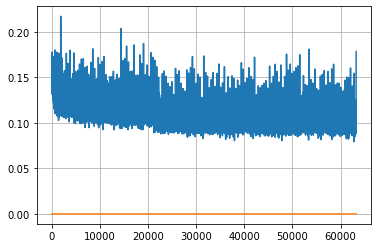

Epoch: 163, iteration 0, loss 0.0987425446510315, cov_diff 0.4171998113228151 cov_diff train 0.4169539652807745
Epoch: 163, iteration 1, loss 0.11684158444404602, cov_diff 0.4244076494764532 cov_diff train 0.423263810406997
Epoch: 163, iteration 2, loss 0.11528146266937256, cov_diff 0.42708877425989333 cov_diff train 0.4262913646256627
Epoch: 163, iteration 3, loss 0.11562615633010864, cov_diff 0.4150383626697645 cov_diff train 0.41500898865721875
Epoch: 163, iteration 4, loss 0.10210531949996948, cov_diff 0.4161046657104547 cov_diff train 0.4159037702083315
Epoch: 163, iteration 5, loss 0.10624814033508301, cov_diff 0.396741702842583 cov_diff train 0.3964523883640185
Epoch: 163, iteration 6, loss 0.10288748145103455, cov_diff 0.41062595442267424 cov_diff train 0.4104846109611171
Epoch: 163, iteration 7, loss 0.12377104163169861, cov_diff 0.42781641418014826 cov_diff train 0.4276375300860882
Epoch: 163, iteration 8, loss 0.09549760818481445, cov_diff 0.4051336827041737 cov_diff train 0

Epoch: 163, iteration 77, loss 0.11079138517379761, cov_diff 0.41759641245075 cov_diff train 0.4170886454093121
Epoch: 163, iteration 78, loss 0.09763264656066895, cov_diff 0.4195576526657558 cov_diff train 0.4192533987463557
Epoch: 163, iteration 79, loss 0.09945753216743469, cov_diff 0.41382989241008156 cov_diff train 0.4132473061067699
Epoch: 163, iteration 80, loss 0.10949307680130005, cov_diff 0.41565531366318303 cov_diff train 0.4149098764021863
Epoch: 163, iteration 81, loss 0.10332021117210388, cov_diff 0.4136737488964695 cov_diff train 0.4134142901902198
Epoch: 163, iteration 82, loss 0.11313977837562561, cov_diff 0.41820535895398825 cov_diff train 0.4182397507986049
Epoch: 163, iteration 83, loss 0.094561368227005, cov_diff 0.42369678662581467 cov_diff train 0.4226989011229935
Epoch: 163, iteration 84, loss 0.0988016426563263, cov_diff 0.422538953828003 cov_diff train 0.4223677516189175
Epoch: 163, iteration 85, loss 0.1090531051158905, cov_diff 0.41749825905383703 cov_diff t

Epoch: 163, iteration 156, loss 0.10630518198013306, cov_diff 0.42638205090713827 cov_diff train 0.42584345252428246
Epoch: 163, iteration 157, loss 0.0957651436328888, cov_diff 0.41829420466913514 cov_diff train 0.4176060470411724
Epoch: 163, iteration 158, loss 0.09474483132362366, cov_diff 0.41281747151000014 cov_diff train 0.41199854373863887
Epoch: 163, iteration 159, loss 0.09995836019515991, cov_diff 0.4160284525512598 cov_diff train 0.4155731141916254
Epoch: 163, iteration 160, loss 0.09919112920761108, cov_diff 0.41298621717754125 cov_diff train 0.41294894198139653
Epoch: 163, iteration 161, loss 0.10459184646606445, cov_diff 0.4114967565322102 cov_diff train 0.41058386196845603
Epoch: 163, iteration 162, loss 0.12332618236541748, cov_diff 0.40644752986387694 cov_diff train 0.4064090459530509
Epoch: 163, iteration 163, loss 0.10554295778274536, cov_diff 0.4213119770541102 cov_diff train 0.4217032272424386
Epoch: 163, iteration 164, loss 0.10734915733337402, cov_diff 0.41620478

Epoch: 163, iteration 233, loss 0.1113247275352478, cov_diff 0.417650069262383 cov_diff train 0.4174980686199498
Epoch: 163, iteration 234, loss 0.10554870963096619, cov_diff 0.39990503759121016 cov_diff train 0.39955447421556406
Epoch: 163, iteration 235, loss 0.09686562418937683, cov_diff 0.4216771433312913 cov_diff train 0.42221563647322213
Epoch: 163, iteration 236, loss 0.09944677352905273, cov_diff 0.40747205441499856 cov_diff train 0.4063701169678024
Epoch: 163, iteration 237, loss 0.1028546690940857, cov_diff 0.40594952710858395 cov_diff train 0.40614752599533155
Epoch: 163, iteration 238, loss 0.11380496621131897, cov_diff 0.4134261895502659 cov_diff train 0.41306469824534764
Epoch: 163, iteration 239, loss 0.1053982675075531, cov_diff 0.4349491814271342 cov_diff train 0.43438124713604925
Epoch: 163, iteration 240, loss 0.09078091382980347, cov_diff 0.4238812237115119 cov_diff train 0.42362268067472614
Epoch: 163, iteration 241, loss 0.10801643133163452, cov_diff 0.42878592170

Epoch: 163, iteration 312, loss 0.09865844249725342, cov_diff 0.42095964023372306 cov_diff train 0.420243511544822
Epoch: 163, iteration 313, loss 0.10686469078063965, cov_diff 0.4236004777213002 cov_diff train 0.4230904064898618
Epoch: 163, iteration 314, loss 0.11765757203102112, cov_diff 0.4226637379674263 cov_diff train 0.4217826249690524
Epoch: 163, iteration 315, loss 0.09850203990936279, cov_diff 0.4174802247229587 cov_diff train 0.41632266379692745
Epoch: 163, iteration 316, loss 0.09745475649833679, cov_diff 0.4127763513052009 cov_diff train 0.4125500956758694
Epoch: 163, iteration 317, loss 0.10213422775268555, cov_diff 0.4042466917720439 cov_diff train 0.4040685677499103
Epoch: 163, iteration 318, loss 0.10293331742286682, cov_diff 0.41505635987558026 cov_diff train 0.4148258734164906
Epoch: 163, iteration 319, loss 0.10927560925483704, cov_diff 0.4084763703769322 cov_diff train 0.4083401600201194
Epoch: 163, iteration 320, loss 0.09569621086120605, cov_diff 0.40985300574630

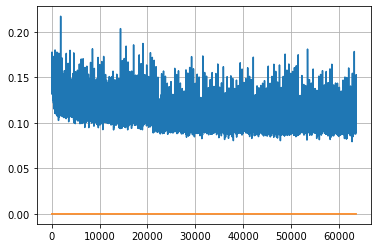

Epoch: 164, iteration 0, loss 0.10457158088684082, cov_diff 0.41125889664494447 cov_diff train 0.4101618533742129
Epoch: 164, iteration 1, loss 0.10323011875152588, cov_diff 0.4328822760896418 cov_diff train 0.43269634018495845
Epoch: 164, iteration 2, loss 0.1061987578868866, cov_diff 0.42329396317821 cov_diff train 0.4227118280820912
Epoch: 164, iteration 3, loss 0.10181319713592529, cov_diff 0.4203533684698083 cov_diff train 0.4202273115182785
Epoch: 164, iteration 4, loss 0.09516417980194092, cov_diff 0.42219184495034406 cov_diff train 0.4224589362540064
Epoch: 164, iteration 5, loss 0.11227601766586304, cov_diff 0.4289518186772449 cov_diff train 0.4271482096590617
Epoch: 164, iteration 6, loss 0.0948629081249237, cov_diff 0.4148482508036232 cov_diff train 0.414667769928677
Epoch: 164, iteration 7, loss 0.10537445545196533, cov_diff 0.4348794329378606 cov_diff train 0.43457222216363595
Epoch: 164, iteration 8, loss 0.09995448589324951, cov_diff 0.4153427659048966 cov_diff train 0.4

Epoch: 164, iteration 79, loss 0.09932905435562134, cov_diff 0.41917656224393757 cov_diff train 0.41787746795939434
Epoch: 164, iteration 80, loss 0.10287594795227051, cov_diff 0.4231084700124017 cov_diff train 0.42261265753670685
Epoch: 164, iteration 81, loss 0.0952649712562561, cov_diff 0.411300990206581 cov_diff train 0.4105455668030695
Epoch: 164, iteration 82, loss 0.10241299867630005, cov_diff 0.417726986990692 cov_diff train 0.4167865676324515
Epoch: 164, iteration 83, loss 0.10720732808113098, cov_diff 0.4195930371240227 cov_diff train 0.4193637578399927
Epoch: 164, iteration 84, loss 0.08877047896385193, cov_diff 0.4081881861380648 cov_diff train 0.4075501051308703
Epoch: 164, iteration 85, loss 0.1079288125038147, cov_diff 0.408672820895275 cov_diff train 0.40799000491136855
Epoch: 164, iteration 86, loss 0.09427395462989807, cov_diff 0.41892007937640835 cov_diff train 0.41779736254688
Epoch: 164, iteration 87, loss 0.10568633675575256, cov_diff 0.4273706024519477 cov_diff t

Epoch: 164, iteration 156, loss 0.09163433313369751, cov_diff 0.4076064873134486 cov_diff train 0.40790108986800966
Epoch: 164, iteration 157, loss 0.10489803552627563, cov_diff 0.4001504573747613 cov_diff train 0.3995212832396771
Epoch: 164, iteration 158, loss 0.09827083349227905, cov_diff 0.42887499229262654 cov_diff train 0.42860718938193476
Epoch: 164, iteration 159, loss 0.10849326848983765, cov_diff 0.4213698706392971 cov_diff train 0.4209001793978327
Epoch: 164, iteration 160, loss 0.09379687905311584, cov_diff 0.4036855574313205 cov_diff train 0.40310039802032593
Epoch: 164, iteration 161, loss 0.10469409823417664, cov_diff 0.41424019247404786 cov_diff train 0.4136796932625194
Epoch: 164, iteration 162, loss 0.09834751486778259, cov_diff 0.41800546053869203 cov_diff train 0.41757297720185155
Epoch: 164, iteration 163, loss 0.11359462141990662, cov_diff 0.4233368184034098 cov_diff train 0.4220515376937225
Epoch: 164, iteration 164, loss 0.10878363251686096, cov_diff 0.420297052

Epoch: 164, iteration 228, loss 0.11411929130554199, cov_diff 0.4414556061964461 cov_diff train 0.44070400458445685
Epoch: 164, iteration 229, loss 0.09425932168960571, cov_diff 0.40856349378442725 cov_diff train 0.4073870760933296
Epoch: 164, iteration 230, loss 0.0892261266708374, cov_diff 0.40189990633852024 cov_diff train 0.4007862913992566
Epoch: 164, iteration 231, loss 0.11765632033348083, cov_diff 0.43405861336531215 cov_diff train 0.43291094348066306
Epoch: 164, iteration 232, loss 0.11428919434547424, cov_diff 0.42688084199557114 cov_diff train 0.4250528109374851
Epoch: 164, iteration 233, loss 0.11399930715560913, cov_diff 0.42321834194243546 cov_diff train 0.4218449854976474
Epoch: 164, iteration 234, loss 0.10425513982772827, cov_diff 0.40059036284768157 cov_diff train 0.39910706897574766
Epoch: 164, iteration 235, loss 0.10589149594306946, cov_diff 0.42005378254068065 cov_diff train 0.41960434579024325
Epoch: 164, iteration 236, loss 0.10967886447906494, cov_diff 0.424763

Epoch: 164, iteration 305, loss 0.09760332107543945, cov_diff 0.4137085408588296 cov_diff train 0.4133111416599758
Epoch: 164, iteration 306, loss 0.11013796925544739, cov_diff 0.41342902316089297 cov_diff train 0.4127587753066329
Epoch: 164, iteration 307, loss 0.09925857186317444, cov_diff 0.4125203872955171 cov_diff train 0.41258200384066945
Epoch: 164, iteration 308, loss 0.10617750883102417, cov_diff 0.43022214753972715 cov_diff train 0.42989791079975703
Epoch: 164, iteration 309, loss 0.10736429691314697, cov_diff 0.4188939874131145 cov_diff train 0.41742784766249186
Epoch: 164, iteration 310, loss 0.09727358818054199, cov_diff 0.4143379441259708 cov_diff train 0.4133781396878688
Epoch: 164, iteration 311, loss 0.09542667865753174, cov_diff 0.41831537514568196 cov_diff train 0.41742918540814317
Epoch: 164, iteration 312, loss 0.10398232936859131, cov_diff 0.40276255983053105 cov_diff train 0.401287072883111
Epoch: 164, iteration 313, loss 0.10527315735816956, cov_diff 0.409334791

Epoch: 164, iteration 382, loss 0.10299485921859741, cov_diff 0.4113726796931647 cov_diff train 0.41115459231647933
Epoch: 164, iteration 383, loss 0.1026715636253357, cov_diff 0.40910955997595827 cov_diff train 0.40914332880592336
Epoch: 164, iteration 384, loss 0.09824612736701965, cov_diff 0.41193714680582055 cov_diff train 0.4116145567622544
Epoch: 164, iteration 385, loss 0.10256823897361755, cov_diff 0.400118032392302 cov_diff train 0.39913778869933864
Epoch: 164, iteration 386, loss 0.10939988493919373, cov_diff 0.4090328911904091 cov_diff train 0.40926528094229636
Epoch: 164, iteration 387, loss 0.10309597849845886, cov_diff 0.4052518046873296 cov_diff train 0.40318970536203463
Epoch: 164, iteration 388, loss 0.10753852128982544, cov_diff 0.4196022507373912 cov_diff train 0.41957097936757803
Epoch: 164, iteration 389, loss 0.09671291708946228, cov_diff 0.4178524472471167 cov_diff train 0.4174969267190947
Epoch: 164, iteration 390, loss 0.1427205204963684, cov_diff 0.44719591959

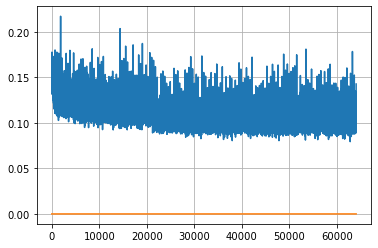

Epoch: 165, iteration 0, loss 0.10825148224830627, cov_diff 0.3992468239672039 cov_diff train 0.39839389506928086
Epoch: 165, iteration 1, loss 0.09944528341293335, cov_diff 0.4152874378480171 cov_diff train 0.4150425671839798
Epoch: 165, iteration 2, loss 0.09931930899620056, cov_diff 0.42163171496519963 cov_diff train 0.42143222217541404
Epoch: 165, iteration 3, loss 0.11106136441230774, cov_diff 0.42194432822288147 cov_diff train 0.42142992342522173
Epoch: 165, iteration 4, loss 0.09869295358657837, cov_diff 0.4150772133042418 cov_diff train 0.41430797471025405
Epoch: 165, iteration 5, loss 0.1140526533126831, cov_diff 0.43053124257910136 cov_diff train 0.42975379276992565
Epoch: 165, iteration 6, loss 0.10246571898460388, cov_diff 0.42409567112612395 cov_diff train 0.42308358900395804
Epoch: 165, iteration 7, loss 0.11308011412620544, cov_diff 0.4207971866969041 cov_diff train 0.41952217070501174
Epoch: 165, iteration 8, loss 0.10512202978134155, cov_diff 0.43684994812669703 cov_di

Epoch: 165, iteration 75, loss 0.10404941439628601, cov_diff 0.4233016259231436 cov_diff train 0.4229430254240693
Epoch: 165, iteration 76, loss 0.1024748682975769, cov_diff 0.4213242519638025 cov_diff train 0.42069048452600644
Epoch: 165, iteration 77, loss 0.10718175768852234, cov_diff 0.4191441454339027 cov_diff train 0.41834050801685385
Epoch: 165, iteration 78, loss 0.10384154319763184, cov_diff 0.41029877649709334 cov_diff train 0.4095525438742896
Epoch: 165, iteration 79, loss 0.1011214554309845, cov_diff 0.4135407729588952 cov_diff train 0.41202681572062944
Epoch: 165, iteration 80, loss 0.10445502400398254, cov_diff 0.41676950796764783 cov_diff train 0.4157153918104299
Epoch: 165, iteration 81, loss 0.09797737002372742, cov_diff 0.429980452734903 cov_diff train 0.42950600095518465
Epoch: 165, iteration 82, loss 0.1099088191986084, cov_diff 0.42522758897178387 cov_diff train 0.42416161828615306
Epoch: 165, iteration 83, loss 0.10550358891487122, cov_diff 0.41308742888857447 cov

Epoch: 165, iteration 147, loss 0.11231297254562378, cov_diff 0.4216924221600183 cov_diff train 0.42113712484853844
Epoch: 165, iteration 148, loss 0.11888650059700012, cov_diff 0.41728612801131415 cov_diff train 0.41772103348787265
Epoch: 165, iteration 149, loss 0.10356077551841736, cov_diff 0.40563684220368307 cov_diff train 0.40588055109730636
Epoch: 165, iteration 150, loss 0.1107105016708374, cov_diff 0.42040757807351825 cov_diff train 0.42012651302475773
Epoch: 165, iteration 151, loss 0.09609264135360718, cov_diff 0.4183557936966641 cov_diff train 0.41837127213234826
Epoch: 165, iteration 152, loss 0.1027536690235138, cov_diff 0.40604621705620714 cov_diff train 0.40616167798634956
Epoch: 165, iteration 153, loss 0.11011266708374023, cov_diff 0.42099284253433283 cov_diff train 0.42110014742320995
Epoch: 165, iteration 154, loss 0.10850971937179565, cov_diff 0.42521862269252264 cov_diff train 0.4244107027917502
Epoch: 165, iteration 155, loss 0.10810822248458862, cov_diff 0.42508

Epoch: 165, iteration 225, loss 0.10594230890274048, cov_diff 0.42064894815924064 cov_diff train 0.4200685282039479
Epoch: 165, iteration 226, loss 0.09706822037696838, cov_diff 0.42584528161832674 cov_diff train 0.4241937555913065
Epoch: 165, iteration 227, loss 0.10144582390785217, cov_diff 0.4079377447744045 cov_diff train 0.40741971908237756
Epoch: 165, iteration 228, loss 0.10853785276412964, cov_diff 0.42083049904606973 cov_diff train 0.42041376295052585
Epoch: 165, iteration 229, loss 0.10443508625030518, cov_diff 0.4148435839216595 cov_diff train 0.4146639525667341
Epoch: 165, iteration 230, loss 0.09761825203895569, cov_diff 0.41943791932599783 cov_diff train 0.4187226926032873
Epoch: 165, iteration 231, loss 0.11167940497398376, cov_diff 0.42841991781332844 cov_diff train 0.4275971643809821
Epoch: 165, iteration 232, loss 0.11486110091209412, cov_diff 0.41397006831437744 cov_diff train 0.41379430043061416
Epoch: 165, iteration 233, loss 0.09848076105117798, cov_diff 0.4086422

Epoch: 165, iteration 303, loss 0.11218473315238953, cov_diff 0.4247084228426672 cov_diff train 0.42301579055784094
Epoch: 165, iteration 304, loss 0.11220100522041321, cov_diff 0.42481504221524846 cov_diff train 0.42396216417881233
Epoch: 165, iteration 305, loss 0.1038452684879303, cov_diff 0.4037195682784252 cov_diff train 0.403324717988148
Epoch: 165, iteration 306, loss 0.1071462333202362, cov_diff 0.41666318907477323 cov_diff train 0.4158520845459804
Epoch: 165, iteration 307, loss 0.10924229025840759, cov_diff 0.4279280374138374 cov_diff train 0.4272840166530712
Epoch: 165, iteration 308, loss 0.09815451502799988, cov_diff 0.40694160313075467 cov_diff train 0.4065341849584036
Epoch: 165, iteration 309, loss 0.10570117831230164, cov_diff 0.40994519078339364 cov_diff train 0.409205103954396
Epoch: 165, iteration 310, loss 0.1029253602027893, cov_diff 0.4250485072020618 cov_diff train 0.4238433224427326
Epoch: 165, iteration 311, loss 0.09936290979385376, cov_diff 0.409438984783116

Epoch: 165, iteration 381, loss 0.10129183530807495, cov_diff 0.40640647584347983 cov_diff train 0.4057856317745771
Epoch: 165, iteration 382, loss 0.11992150545120239, cov_diff 0.41806765632869125 cov_diff train 0.41649018127996895
Epoch: 165, iteration 383, loss 0.09831273555755615, cov_diff 0.42405698161651384 cov_diff train 0.4238583302797631
Epoch: 165, iteration 384, loss 0.10272115468978882, cov_diff 0.42015090918763537 cov_diff train 0.4193165978676688
Epoch: 165, iteration 385, loss 0.09690320491790771, cov_diff 0.4115311971590915 cov_diff train 0.4106994383479802
Epoch: 165, iteration 386, loss 0.09231403470039368, cov_diff 0.4069810577845067 cov_diff train 0.4063508452875341
Epoch: 165, iteration 387, loss 0.1179710328578949, cov_diff 0.41843803881439473 cov_diff train 0.41677654958411187
Epoch: 165, iteration 388, loss 0.1050352156162262, cov_diff 0.4230622892399772 cov_diff train 0.42221841800284343
Epoch: 165, iteration 389, loss 0.10848650336265564, cov_diff 0.4149039907

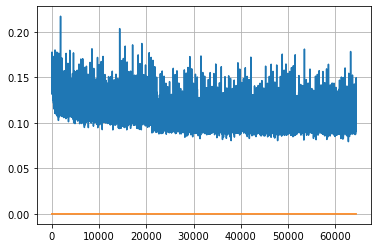

Epoch: 166, iteration 0, loss 0.1071411669254303, cov_diff 0.4173621727114316 cov_diff train 0.41693801429313865
Epoch: 166, iteration 1, loss 0.10980737209320068, cov_diff 0.4217051433350979 cov_diff train 0.42123231769206243
Epoch: 166, iteration 2, loss 0.09357285499572754, cov_diff 0.41221854663937885 cov_diff train 0.4121232604963817
Epoch: 166, iteration 3, loss 0.1004936695098877, cov_diff 0.4077744811486382 cov_diff train 0.40787340661188926
Epoch: 166, iteration 4, loss 0.09593707323074341, cov_diff 0.4149047578262006 cov_diff train 0.413801743107745
Epoch: 166, iteration 5, loss 0.10263758897781372, cov_diff 0.42356509049744895 cov_diff train 0.4222592874395523
Epoch: 166, iteration 6, loss 0.10970547795295715, cov_diff 0.42320124979996454 cov_diff train 0.4225789984368826
Epoch: 166, iteration 7, loss 0.11594164371490479, cov_diff 0.41162325211103784 cov_diff train 0.41163111828470456
Epoch: 166, iteration 8, loss 0.09924018383026123, cov_diff 0.4150726826511137 cov_diff tra

Epoch: 166, iteration 81, loss 0.10935670137405396, cov_diff 0.4195480638380092 cov_diff train 0.41920461848031215
Epoch: 166, iteration 82, loss 0.10213330388069153, cov_diff 0.4184069100198877 cov_diff train 0.4180627481472384
Epoch: 166, iteration 83, loss 0.09643405675888062, cov_diff 0.40077931460701305 cov_diff train 0.3989750521129207
Epoch: 166, iteration 84, loss 0.10740306973457336, cov_diff 0.41668073611089634 cov_diff train 0.41698521981397935
Epoch: 166, iteration 85, loss 0.11038494110107422, cov_diff 0.40639603978321737 cov_diff train 0.4048232519908903
Epoch: 166, iteration 86, loss 0.11352524161338806, cov_diff 0.4207824591757402 cov_diff train 0.4202745453635564
Epoch: 166, iteration 87, loss 0.11033350229263306, cov_diff 0.40424003418298027 cov_diff train 0.4040011268326861
Epoch: 166, iteration 88, loss 0.09999197721481323, cov_diff 0.41315506642475963 cov_diff train 0.41326042099537014
Epoch: 166, iteration 89, loss 0.11429578065872192, cov_diff 0.41782774685371343

Epoch: 166, iteration 157, loss 0.11676201224327087, cov_diff 0.41400439307140946 cov_diff train 0.41351452234873476
Epoch: 166, iteration 158, loss 0.10002237558364868, cov_diff 0.4159525136772037 cov_diff train 0.4144097330563974
Epoch: 166, iteration 159, loss 0.09593024849891663, cov_diff 0.40291922606546043 cov_diff train 0.40234148629042654
Epoch: 166, iteration 160, loss 0.10235410928726196, cov_diff 0.423380940134467 cov_diff train 0.4226799569163376
Epoch: 166, iteration 161, loss 0.10454815626144409, cov_diff 0.4099380013422272 cov_diff train 0.40976247496230805
Epoch: 166, iteration 162, loss 0.13144025206565857, cov_diff 0.42639995965468186 cov_diff train 0.42479410789205363
Epoch: 166, iteration 163, loss 0.10551714897155762, cov_diff 0.4072631115842387 cov_diff train 0.40647312880536735
Epoch: 166, iteration 164, loss 0.0928003191947937, cov_diff 0.40526395046556096 cov_diff train 0.4051193961776463
Epoch: 166, iteration 165, loss 0.10391619801521301, cov_diff 0.416301233

Epoch: 166, iteration 232, loss 0.09087318181991577, cov_diff 0.4068157986999666 cov_diff train 0.4070777870499704
Epoch: 166, iteration 233, loss 0.10718971490859985, cov_diff 0.42678563387319696 cov_diff train 0.42660363504342436
Epoch: 166, iteration 234, loss 0.09833678603172302, cov_diff 0.4084675367281639 cov_diff train 0.40760774255277543
Epoch: 166, iteration 235, loss 0.10325762629508972, cov_diff 0.41263281496116305 cov_diff train 0.41157648785425194
Epoch: 166, iteration 236, loss 0.10017767548561096, cov_diff 0.41012422566196405 cov_diff train 0.4090250525486207
Epoch: 166, iteration 237, loss 0.10277196764945984, cov_diff 0.41017037272268164 cov_diff train 0.40967052375768426
Epoch: 166, iteration 238, loss 0.10236102342605591, cov_diff 0.4238466890206182 cov_diff train 0.42311566803371803
Epoch: 166, iteration 239, loss 0.10118263959884644, cov_diff 0.4158165604863582 cov_diff train 0.41538898874322555
Epoch: 166, iteration 240, loss 0.09978380799293518, cov_diff 0.418516

Epoch: 166, iteration 308, loss 0.09979641437530518, cov_diff 0.4212077102998735 cov_diff train 0.4199097399841149
Epoch: 166, iteration 309, loss 0.11297807097434998, cov_diff 0.4297983194626649 cov_diff train 0.4283624713813216
Epoch: 166, iteration 310, loss 0.11222156882286072, cov_diff 0.40651120973398264 cov_diff train 0.40496491948575813
Epoch: 166, iteration 311, loss 0.10299772024154663, cov_diff 0.41630741366259943 cov_diff train 0.41634845079896643
Epoch: 166, iteration 312, loss 0.09747019410133362, cov_diff 0.4173490187734805 cov_diff train 0.41657749028425217
Epoch: 166, iteration 313, loss 0.1058206856250763, cov_diff 0.42068343049475626 cov_diff train 0.41900020388912224
Epoch: 166, iteration 314, loss 0.10864812135696411, cov_diff 0.4263689896794999 cov_diff train 0.4250256226891607
Epoch: 166, iteration 315, loss 0.10459098219871521, cov_diff 0.42471696442345597 cov_diff train 0.42426610059946956
Epoch: 166, iteration 316, loss 0.10009896755218506, cov_diff 0.42663421

Epoch: 166, iteration 384, loss 0.10468584299087524, cov_diff 0.4142141198036319 cov_diff train 0.41394042632997624
Epoch: 166, iteration 385, loss 0.08940652012825012, cov_diff 0.4156902611088058 cov_diff train 0.41512237777951605
Epoch: 166, iteration 386, loss 0.1089155375957489, cov_diff 0.42626095912466394 cov_diff train 0.42545687167432567
Epoch: 166, iteration 387, loss 0.10440686345100403, cov_diff 0.40350665095274735 cov_diff train 0.4032592808674742
Epoch: 166, iteration 388, loss 0.09976479411125183, cov_diff 0.3970328365412164 cov_diff train 0.3958463409373238
Epoch: 166, iteration 389, loss 0.10876002907752991, cov_diff 0.4197545034443117 cov_diff train 0.41876872677189747
Epoch: 166, iteration 390, loss 0.1603638231754303, cov_diff 0.46619702123624296 cov_diff train 0.46644106678533237


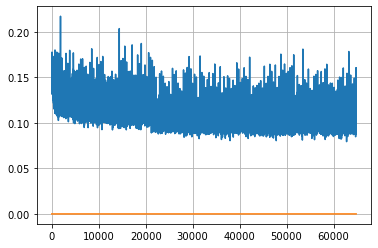

Epoch: 167, iteration 0, loss 0.10234329104423523, cov_diff 0.4114817436963279 cov_diff train 0.41029529595421327
Epoch: 167, iteration 1, loss 0.09795758128166199, cov_diff 0.4345348009099398 cov_diff train 0.4329934681166405
Epoch: 167, iteration 2, loss 0.09902554750442505, cov_diff 0.42738696134128135 cov_diff train 0.4272483972526722
Epoch: 167, iteration 3, loss 0.09453251957893372, cov_diff 0.42272789403974403 cov_diff train 0.42269276273089323
Epoch: 167, iteration 4, loss 0.11942201852798462, cov_diff 0.42815046574264376 cov_diff train 0.4276313520941509
Epoch: 167, iteration 5, loss 0.11194851994514465, cov_diff 0.41827109122953865 cov_diff train 0.4173868914020306
Epoch: 167, iteration 6, loss 0.10894355177879333, cov_diff 0.41353391798345 cov_diff train 0.4134682011748356
Epoch: 167, iteration 7, loss 0.10821601748466492, cov_diff 0.4196826095381591 cov_diff train 0.41910464833340516
Epoch: 167, iteration 8, loss 0.11251804232597351, cov_diff 0.4173953952035444 cov_diff tra

Epoch: 167, iteration 78, loss 0.09975922107696533, cov_diff 0.41379575935543284 cov_diff train 0.41311696940370307
Epoch: 167, iteration 79, loss 0.10295665264129639, cov_diff 0.40978791685769606 cov_diff train 0.408876455006658
Epoch: 167, iteration 80, loss 0.10193103551864624, cov_diff 0.41986900638409846 cov_diff train 0.41883152725873374
Epoch: 167, iteration 81, loss 0.09842994809150696, cov_diff 0.4249254444695352 cov_diff train 0.42409624666351076
Epoch: 167, iteration 82, loss 0.1045525074005127, cov_diff 0.4156673995447497 cov_diff train 0.4152115890181432
Epoch: 167, iteration 83, loss 0.0948171317577362, cov_diff 0.40627062189370133 cov_diff train 0.40624641126568584
Epoch: 167, iteration 84, loss 0.10341435670852661, cov_diff 0.41802755416275417 cov_diff train 0.4170162070290263
Epoch: 167, iteration 85, loss 0.10253000259399414, cov_diff 0.4063771087471735 cov_diff train 0.40555875666860136
Epoch: 167, iteration 86, loss 0.0960368812084198, cov_diff 0.42399322010006063 c

Epoch: 167, iteration 157, loss 0.13294464349746704, cov_diff 0.4170143473723359 cov_diff train 0.4165327832307948
Epoch: 167, iteration 158, loss 0.10900154709815979, cov_diff 0.406059262351426 cov_diff train 0.4056457541183358
Epoch: 167, iteration 159, loss 0.09607288241386414, cov_diff 0.39434333285591566 cov_diff train 0.393621393311087
Epoch: 167, iteration 160, loss 0.10367581248283386, cov_diff 0.40431497861079946 cov_diff train 0.404560762772938
Epoch: 167, iteration 161, loss 0.10786494612693787, cov_diff 0.4060514626300605 cov_diff train 0.4063327336543676
Epoch: 167, iteration 162, loss 0.09872990846633911, cov_diff 0.4149259136415869 cov_diff train 0.4148835195225874
Epoch: 167, iteration 163, loss 0.11748570203781128, cov_diff 0.4307239505911142 cov_diff train 0.4307011175688396
Epoch: 167, iteration 164, loss 0.10354742407798767, cov_diff 0.4022080243385713 cov_diff train 0.4023243133330314
Epoch: 167, iteration 165, loss 0.10308310389518738, cov_diff 0.4036215021677947 

Epoch: 167, iteration 236, loss 0.10287076234817505, cov_diff 0.41368938695956603 cov_diff train 0.41239555550100016
Epoch: 167, iteration 237, loss 0.11200857162475586, cov_diff 0.4118519466842654 cov_diff train 0.4112001870025943
Epoch: 167, iteration 238, loss 0.11269888281822205, cov_diff 0.3883367380026944 cov_diff train 0.3879101218120053
Epoch: 167, iteration 239, loss 0.10847806930541992, cov_diff 0.41366718521259677 cov_diff train 0.41298927999036444
Epoch: 167, iteration 240, loss 0.10905146598815918, cov_diff 0.42457925300679356 cov_diff train 0.42265169194484153
Epoch: 167, iteration 241, loss 0.11514860391616821, cov_diff 0.4084398907652092 cov_diff train 0.40809301564945405
Epoch: 167, iteration 242, loss 0.10383737087249756, cov_diff 0.4008029380090427 cov_diff train 0.39972314066047215
Epoch: 167, iteration 243, loss 0.10875758528709412, cov_diff 0.4024795176168743 cov_diff train 0.40337603057303484
Epoch: 167, iteration 244, loss 0.10599261522293091, cov_diff 0.4101356

Epoch: 167, iteration 312, loss 0.11880171298980713, cov_diff 0.4146633494250002 cov_diff train 0.41477230463182096
Epoch: 167, iteration 313, loss 0.10828706622123718, cov_diff 0.4186472754184393 cov_diff train 0.4180706890143185
Epoch: 167, iteration 314, loss 0.1090463399887085, cov_diff 0.4324997277669511 cov_diff train 0.4320531417598707
Epoch: 167, iteration 315, loss 0.09549590945243835, cov_diff 0.41568471517265765 cov_diff train 0.4148523932905828
Epoch: 167, iteration 316, loss 0.1027485728263855, cov_diff 0.41113743198630026 cov_diff train 0.40911664077897525
Epoch: 167, iteration 317, loss 0.10754850506782532, cov_diff 0.41932601700152 cov_diff train 0.41828550490351596
Epoch: 167, iteration 318, loss 0.0922417938709259, cov_diff 0.40701995228093263 cov_diff train 0.4063923256455613
Epoch: 167, iteration 319, loss 0.10299667716026306, cov_diff 0.4139620449997696 cov_diff train 0.41331898241673604
Epoch: 167, iteration 320, loss 0.09861341118812561, cov_diff 0.42608429638495

Epoch: 167, iteration 388, loss 0.09549731016159058, cov_diff 0.41037906368288335 cov_diff train 0.41018046180736156
Epoch: 167, iteration 389, loss 0.10993897914886475, cov_diff 0.41814388840595335 cov_diff train 0.417747871044268
Epoch: 167, iteration 390, loss 0.13117969036102295, cov_diff 0.44838832197943884 cov_diff train 0.44803605487160075


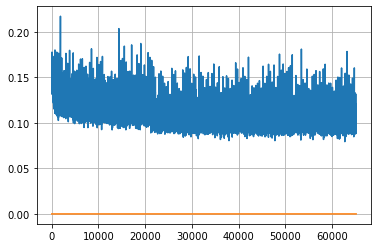

Epoch: 168, iteration 0, loss 0.10174652934074402, cov_diff 0.42590256143852845 cov_diff train 0.4253855781194471
Epoch: 168, iteration 1, loss 0.10977119207382202, cov_diff 0.42211136063577787 cov_diff train 0.42137980616593446
Epoch: 168, iteration 2, loss 0.11375781893730164, cov_diff 0.42684371860698117 cov_diff train 0.4254290191490764
Epoch: 168, iteration 3, loss 0.09140849113464355, cov_diff 0.43392775241753534 cov_diff train 0.4335849221689685
Epoch: 168, iteration 4, loss 0.0975106954574585, cov_diff 0.4138752699724258 cov_diff train 0.41321184858149745
Epoch: 168, iteration 5, loss 0.09738120436668396, cov_diff 0.41349546086637284 cov_diff train 0.41291500463277203
Epoch: 168, iteration 6, loss 0.11094117164611816, cov_diff 0.421118735586368 cov_diff train 0.41978113889470475
Epoch: 168, iteration 7, loss 0.1125771701335907, cov_diff 0.41016316537142 cov_diff train 0.4094144692999641
Epoch: 168, iteration 8, loss 0.09970387816429138, cov_diff 0.40365904476175607 cov_diff tra

Epoch: 168, iteration 78, loss 0.10451453924179077, cov_diff 0.4249944977026723 cov_diff train 0.4249765242479967
Epoch: 168, iteration 79, loss 0.09237980842590332, cov_diff 0.41131276943901546 cov_diff train 0.4097703283537491
Epoch: 168, iteration 80, loss 0.11053243279457092, cov_diff 0.40568279705377347 cov_diff train 0.40518860521871053
Epoch: 168, iteration 81, loss 0.10268497467041016, cov_diff 0.42067522356477244 cov_diff train 0.4200648242002531
Epoch: 168, iteration 82, loss 0.11346355080604553, cov_diff 0.4221663898077597 cov_diff train 0.42145321942331576
Epoch: 168, iteration 83, loss 0.11230602860450745, cov_diff 0.4180089029348024 cov_diff train 0.41771680925740146
Epoch: 168, iteration 84, loss 0.1006506085395813, cov_diff 0.4180330778299481 cov_diff train 0.4176425660177915
Epoch: 168, iteration 85, loss 0.1007455587387085, cov_diff 0.40687919256156485 cov_diff train 0.4067612249719596
Epoch: 168, iteration 86, loss 0.10463407635688782, cov_diff 0.4235077909961911 cov

Epoch: 168, iteration 156, loss 0.107697993516922, cov_diff 0.42806079710352163 cov_diff train 0.42716362575086514
Epoch: 168, iteration 157, loss 0.09751740097999573, cov_diff 0.41119478877236093 cov_diff train 0.41086558203416984
Epoch: 168, iteration 158, loss 0.09610632061958313, cov_diff 0.401387085636722 cov_diff train 0.4009853201573719
Epoch: 168, iteration 159, loss 0.11711618304252625, cov_diff 0.4091573183946914 cov_diff train 0.40845045051860673
Epoch: 168, iteration 160, loss 0.1030859649181366, cov_diff 0.42995171320976927 cov_diff train 0.42904422570003875
Epoch: 168, iteration 161, loss 0.09723609685897827, cov_diff 0.41474888701909585 cov_diff train 0.4131334621784207
Epoch: 168, iteration 162, loss 0.10284975171089172, cov_diff 0.4215007424184387 cov_diff train 0.420290350543158
Epoch: 168, iteration 163, loss 0.10302504897117615, cov_diff 0.3990184971893244 cov_diff train 0.39831671083259
Epoch: 168, iteration 164, loss 0.09962242841720581, cov_diff 0.414415771026928

Epoch: 168, iteration 235, loss 0.10187771916389465, cov_diff 0.407246921171303 cov_diff train 0.4076260833100795
Epoch: 168, iteration 236, loss 0.10086792707443237, cov_diff 0.4039943189422152 cov_diff train 0.40244418894164585
Epoch: 168, iteration 237, loss 0.09380686283111572, cov_diff 0.4028985835757242 cov_diff train 0.4026282758258095
Epoch: 168, iteration 238, loss 0.11170923709869385, cov_diff 0.41300583326375623 cov_diff train 0.4109424508627633
Epoch: 168, iteration 239, loss 0.10486143827438354, cov_diff 0.42025844342274854 cov_diff train 0.4195272234049371
Epoch: 168, iteration 240, loss 0.10063564777374268, cov_diff 0.40478167051395636 cov_diff train 0.40387532724441655
Epoch: 168, iteration 241, loss 0.10765740275382996, cov_diff 0.4248196001159291 cov_diff train 0.4241627261376906
Epoch: 168, iteration 242, loss 0.09786474704742432, cov_diff 0.4143735056361929 cov_diff train 0.4131849637672322
Epoch: 168, iteration 243, loss 0.09953504800796509, cov_diff 0.410660737667

Epoch: 168, iteration 316, loss 0.11779218912124634, cov_diff 0.4146940921971042 cov_diff train 0.4140761055624641
Epoch: 168, iteration 317, loss 0.10308456420898438, cov_diff 0.3973105869847253 cov_diff train 0.3969417593243114
Epoch: 168, iteration 318, loss 0.11310675740242004, cov_diff 0.42577478282985415 cov_diff train 0.42557700611137667
Epoch: 168, iteration 319, loss 0.0984870195388794, cov_diff 0.4193453748369948 cov_diff train 0.41939321517914335
Epoch: 168, iteration 320, loss 0.0960199236869812, cov_diff 0.40793205364227064 cov_diff train 0.4068998487403518
Epoch: 168, iteration 321, loss 0.10275942087173462, cov_diff 0.4075688419059164 cov_diff train 0.40643362098711294
Epoch: 168, iteration 322, loss 0.10514166951179504, cov_diff 0.40309935472663433 cov_diff train 0.4032464193238047
Epoch: 168, iteration 323, loss 0.11151629686355591, cov_diff 0.41952633069377715 cov_diff train 0.41948066052837557
Epoch: 168, iteration 324, loss 0.11435690522193909, cov_diff 0.4063753252

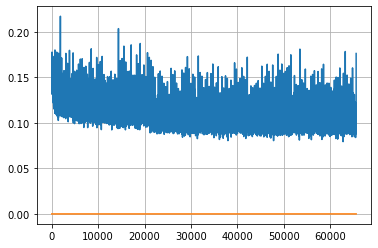

Epoch: 169, iteration 0, loss 0.10570669174194336, cov_diff 0.41139700368665033 cov_diff train 0.4117964817952423
Epoch: 169, iteration 1, loss 0.10247665643692017, cov_diff 0.4152327585692994 cov_diff train 0.4150549137701862
Epoch: 169, iteration 2, loss 0.10199868679046631, cov_diff 0.42160677190543544 cov_diff train 0.421597684682593
Epoch: 169, iteration 3, loss 0.11188137531280518, cov_diff 0.40879509608698755 cov_diff train 0.40820870748317817
Epoch: 169, iteration 4, loss 0.09811818599700928, cov_diff 0.4107308186567311 cov_diff train 0.4107149853895618
Epoch: 169, iteration 5, loss 0.11274635791778564, cov_diff 0.4060671461766779 cov_diff train 0.40531009452257577
Epoch: 169, iteration 6, loss 0.10651278495788574, cov_diff 0.41121357396996794 cov_diff train 0.4106747997321424
Epoch: 169, iteration 7, loss 0.10213777422904968, cov_diff 0.4205680293006908 cov_diff train 0.4203230033343359
Epoch: 169, iteration 8, loss 0.09117916226387024, cov_diff 0.4187643404090071 cov_diff tra

Epoch: 169, iteration 78, loss 0.10016787052154541, cov_diff 0.40830786031295524 cov_diff train 0.40721299993268634
Epoch: 169, iteration 79, loss 0.10576555132865906, cov_diff 0.4206690787435557 cov_diff train 0.4202731431359853
Epoch: 169, iteration 80, loss 0.0971892774105072, cov_diff 0.4151922485954437 cov_diff train 0.41406671686680924
Epoch: 169, iteration 81, loss 0.10936099290847778, cov_diff 0.42534419572467097 cov_diff train 0.42524258697146333
Epoch: 169, iteration 82, loss 0.11065652966499329, cov_diff 0.4218858950923011 cov_diff train 0.42086144410792076
Epoch: 169, iteration 83, loss 0.10774624347686768, cov_diff 0.40906267069289726 cov_diff train 0.4081238020178192
Epoch: 169, iteration 84, loss 0.10211732983589172, cov_diff 0.4188744341562902 cov_diff train 0.41742378784815715
Epoch: 169, iteration 85, loss 0.1143401563167572, cov_diff 0.4121030031483003 cov_diff train 0.41004694019714893
Epoch: 169, iteration 86, loss 0.10147473216056824, cov_diff 0.41386073737564505 

Epoch: 169, iteration 157, loss 0.09122198820114136, cov_diff 0.3871642263172126 cov_diff train 0.38725969182902953
Epoch: 169, iteration 158, loss 0.11296907067298889, cov_diff 0.4117527097323796 cov_diff train 0.41087850317537994
Epoch: 169, iteration 159, loss 0.09501814842224121, cov_diff 0.41290210947204015 cov_diff train 0.41252460515616063
Epoch: 169, iteration 160, loss 0.10465875267982483, cov_diff 0.39445958597193725 cov_diff train 0.39419654834804724
Epoch: 169, iteration 161, loss 0.10670167207717896, cov_diff 0.41057934728641027 cov_diff train 0.40966596376904924
Epoch: 169, iteration 162, loss 0.1125909686088562, cov_diff 0.40915779105910965 cov_diff train 0.4089925430638325
Epoch: 169, iteration 163, loss 0.11150574684143066, cov_diff 0.41720518221144326 cov_diff train 0.4164127605084083
Epoch: 169, iteration 164, loss 0.09514009952545166, cov_diff 0.40117653267158526 cov_diff train 0.401826497771793
Epoch: 169, iteration 165, loss 0.09023115038871765, cov_diff 0.4112628

Epoch: 169, iteration 235, loss 0.10192111134529114, cov_diff 0.4183890938525129 cov_diff train 0.4177294548535468
Epoch: 169, iteration 236, loss 0.11724361777305603, cov_diff 0.4193940819651602 cov_diff train 0.4190017016828373
Epoch: 169, iteration 237, loss 0.10805431008338928, cov_diff 0.4088230826311113 cov_diff train 0.4088438491548046
Epoch: 169, iteration 238, loss 0.11764299869537354, cov_diff 0.41655804550728515 cov_diff train 0.41603669804947085
Epoch: 169, iteration 239, loss 0.10460403561592102, cov_diff 0.41654157504402944 cov_diff train 0.4157227511119873
Epoch: 169, iteration 240, loss 0.10498625040054321, cov_diff 0.414953660504095 cov_diff train 0.4141845248361912
Epoch: 169, iteration 241, loss 0.09898173809051514, cov_diff 0.4114299996097441 cov_diff train 0.409867849571161
Epoch: 169, iteration 242, loss 0.10231909155845642, cov_diff 0.40870493305217076 cov_diff train 0.407407101961246
Epoch: 169, iteration 243, loss 0.10209503769874573, cov_diff 0.408812344063628

Epoch: 169, iteration 315, loss 0.09677422046661377, cov_diff 0.4244957018243938 cov_diff train 0.4238235216042822
Epoch: 169, iteration 316, loss 0.09621196985244751, cov_diff 0.395223165432011 cov_diff train 0.39447272775774467
Epoch: 169, iteration 317, loss 0.10066133737564087, cov_diff 0.41250697499624756 cov_diff train 0.4120405543481918
Epoch: 169, iteration 318, loss 0.11567726731300354, cov_diff 0.41976806151847096 cov_diff train 0.4194320716610713
Epoch: 169, iteration 319, loss 0.10735136270523071, cov_diff 0.4289259566702339 cov_diff train 0.42790130412856114
Epoch: 169, iteration 320, loss 0.11048981547355652, cov_diff 0.4188097211184878 cov_diff train 0.41819785672316767
Epoch: 169, iteration 321, loss 0.10550114512443542, cov_diff 0.4233592399858665 cov_diff train 0.42313133906650713
Epoch: 169, iteration 322, loss 0.11085894703865051, cov_diff 0.42667365966729925 cov_diff train 0.4249948337811954
Epoch: 169, iteration 323, loss 0.09822314977645874, cov_diff 0.4032785593

Epoch: 169, iteration 388, loss 0.09509268403053284, cov_diff 0.4167529272499426 cov_diff train 0.4162625567969219
Epoch: 169, iteration 389, loss 0.10804474353790283, cov_diff 0.4221214100021087 cov_diff train 0.42175819295310607
Epoch: 169, iteration 390, loss 0.15642347931861877, cov_diff 0.4465334204552795 cov_diff train 0.4459763260452489


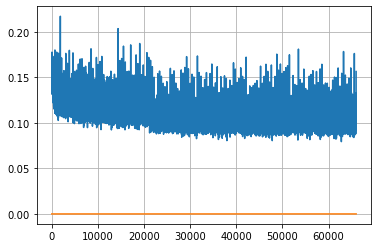

Epoch: 170, iteration 0, loss 0.09596917033195496, cov_diff 0.41230153922854185 cov_diff train 0.41203937826214526
Epoch: 170, iteration 1, loss 0.11226010322570801, cov_diff 0.4143401399198199 cov_diff train 0.41405891256958416
Epoch: 170, iteration 2, loss 0.10744956135749817, cov_diff 0.3998657308792466 cov_diff train 0.39956896741459685
Epoch: 170, iteration 3, loss 0.10770905017852783, cov_diff 0.4201110515850262 cov_diff train 0.4199495570667975
Epoch: 170, iteration 4, loss 0.10643386840820312, cov_diff 0.40123347525497344 cov_diff train 0.4011062989500439
Epoch: 170, iteration 5, loss 0.10193133354187012, cov_diff 0.416569379787996 cov_diff train 0.4164906393851347
Epoch: 170, iteration 6, loss 0.10333862900733948, cov_diff 0.41909261883067755 cov_diff train 0.41877475096122246
Epoch: 170, iteration 7, loss 0.10783687233924866, cov_diff 0.4181525616771137 cov_diff train 0.4183846521060224
Epoch: 170, iteration 8, loss 0.10115271806716919, cov_diff 0.4160595676484662 cov_diff tr

Epoch: 170, iteration 72, loss 0.10713863372802734, cov_diff 0.4119257328947318 cov_diff train 0.4115416863042864
Epoch: 170, iteration 73, loss 0.10730159282684326, cov_diff 0.41419087163839324 cov_diff train 0.4148076473347601
Epoch: 170, iteration 74, loss 0.10568109154701233, cov_diff 0.41798027740446236 cov_diff train 0.41764768631549354
Epoch: 170, iteration 75, loss 0.09787729382514954, cov_diff 0.42615356694830325 cov_diff train 0.425512041157512
Epoch: 170, iteration 76, loss 0.09355509281158447, cov_diff 0.4200279195724523 cov_diff train 0.41918626955253757
Epoch: 170, iteration 77, loss 0.10056015849113464, cov_diff 0.43061301155357834 cov_diff train 0.43000998103764976
Epoch: 170, iteration 78, loss 0.09606778621673584, cov_diff 0.4070443525957886 cov_diff train 0.40689198742732247
Epoch: 170, iteration 79, loss 0.10691124200820923, cov_diff 0.42949951368735945 cov_diff train 0.4284335182790962
Epoch: 170, iteration 80, loss 0.10486963391304016, cov_diff 0.4159019843568195 

Epoch: 170, iteration 150, loss 0.09686735272407532, cov_diff 0.42896592901329245 cov_diff train 0.4280936241971691
Epoch: 170, iteration 151, loss 0.11265578866004944, cov_diff 0.4325071688056756 cov_diff train 0.4300580382325617
Epoch: 170, iteration 152, loss 0.10484051704406738, cov_diff 0.4224945616990542 cov_diff train 0.420993020239714
Epoch: 170, iteration 153, loss 0.10908180475234985, cov_diff 0.40880656971406476 cov_diff train 0.408533325563571
Epoch: 170, iteration 154, loss 0.1004510223865509, cov_diff 0.4186353215025971 cov_diff train 0.41765723781735964
Epoch: 170, iteration 155, loss 0.10039514303207397, cov_diff 0.4048747494825361 cov_diff train 0.4037960770099486
Epoch: 170, iteration 156, loss 0.0988958477973938, cov_diff 0.4020755177364511 cov_diff train 0.4009340720874193
Epoch: 170, iteration 157, loss 0.10750773549079895, cov_diff 0.41364051951926595 cov_diff train 0.4124739070434025
Epoch: 170, iteration 158, loss 0.10406306385993958, cov_diff 0.4185340355478725

Epoch: 170, iteration 221, loss 0.11033275723457336, cov_diff 0.42193472455488107 cov_diff train 0.42040035433351947
Epoch: 170, iteration 222, loss 0.10304614901542664, cov_diff 0.4184096909922047 cov_diff train 0.4182462543766916
Epoch: 170, iteration 223, loss 0.10006403923034668, cov_diff 0.41670686418847 cov_diff train 0.41548382731913847
Epoch: 170, iteration 224, loss 0.0896955132484436, cov_diff 0.4270684670366057 cov_diff train 0.42639996233520133
Epoch: 170, iteration 225, loss 0.09904313087463379, cov_diff 0.422452482425798 cov_diff train 0.4225263354154885
Epoch: 170, iteration 226, loss 0.10007303953170776, cov_diff 0.4322558832112179 cov_diff train 0.4308053333113884
Epoch: 170, iteration 227, loss 0.09290480613708496, cov_diff 0.4302689800477079 cov_diff train 0.4293198926263853
Epoch: 170, iteration 228, loss 0.10077258944511414, cov_diff 0.4011605989121656 cov_diff train 0.4003173555541429
Epoch: 170, iteration 229, loss 0.09546497464179993, cov_diff 0.4054348993748866

Epoch: 170, iteration 298, loss 0.10160037875175476, cov_diff 0.4129986567506776 cov_diff train 0.41155061087034606
Epoch: 170, iteration 299, loss 0.10031840205192566, cov_diff 0.4082629120601025 cov_diff train 0.40717654827415106
Epoch: 170, iteration 300, loss 0.11067157983779907, cov_diff 0.4207102700246468 cov_diff train 0.42032434908960203
Epoch: 170, iteration 301, loss 0.10174036026000977, cov_diff 0.4160294527128287 cov_diff train 0.41259083757345116
Epoch: 170, iteration 302, loss 0.10963413119316101, cov_diff 0.42114543650794767 cov_diff train 0.4208944382396081
Epoch: 170, iteration 303, loss 0.09797462821006775, cov_diff 0.4109081669136714 cov_diff train 0.4107719394384107
Epoch: 170, iteration 304, loss 0.10696235299110413, cov_diff 0.4282819333520599 cov_diff train 0.427489133418506
Epoch: 170, iteration 305, loss 0.10702329874038696, cov_diff 0.41989402519506935 cov_diff train 0.4196733756379632
Epoch: 170, iteration 306, loss 0.1031644344329834, cov_diff 0.410051219350

Epoch: 170, iteration 369, loss 0.09794658422470093, cov_diff 0.41347494379307265 cov_diff train 0.4116547459371615
Epoch: 170, iteration 370, loss 0.1087678074836731, cov_diff 0.40959345775342176 cov_diff train 0.40873247589949907
Epoch: 170, iteration 371, loss 0.11741742491722107, cov_diff 0.40343712906826734 cov_diff train 0.40225786888274623
Epoch: 170, iteration 372, loss 0.11342531442642212, cov_diff 0.4139376697016501 cov_diff train 0.41323254462427295
Epoch: 170, iteration 373, loss 0.10688799619674683, cov_diff 0.412050837752343 cov_diff train 0.4112742745526293
Epoch: 170, iteration 374, loss 0.11008840799331665, cov_diff 0.40803376290496646 cov_diff train 0.40773923294207703
Epoch: 170, iteration 375, loss 0.11092492938041687, cov_diff 0.405752405015094 cov_diff train 0.4063227835085329
Epoch: 170, iteration 376, loss 0.10041093826293945, cov_diff 0.41200932064784024 cov_diff train 0.412126363270401
Epoch: 170, iteration 377, loss 0.09449604153633118, cov_diff 0.41338582016

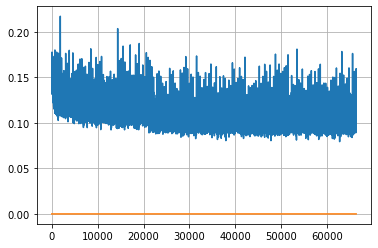

Epoch: 171, iteration 0, loss 0.10394394397735596, cov_diff 0.4172128597663792 cov_diff train 0.41740047795938745
Epoch: 171, iteration 1, loss 0.10789865255355835, cov_diff 0.40423152160307674 cov_diff train 0.4039722881897947
Epoch: 171, iteration 2, loss 0.10911113023757935, cov_diff 0.4199099830225147 cov_diff train 0.41979646161207324
Epoch: 171, iteration 3, loss 0.10791346430778503, cov_diff 0.41750645513523393 cov_diff train 0.41777187881920597
Epoch: 171, iteration 4, loss 0.10378694534301758, cov_diff 0.4047188789353214 cov_diff train 0.4050131981065918
Epoch: 171, iteration 5, loss 0.11222964525222778, cov_diff 0.4342847460020587 cov_diff train 0.43408937218198596
Epoch: 171, iteration 6, loss 0.10528472065925598, cov_diff 0.4184416233569937 cov_diff train 0.41811117286480104
Epoch: 171, iteration 7, loss 0.10654649138450623, cov_diff 0.4268702098492771 cov_diff train 0.4269917829389893
Epoch: 171, iteration 8, loss 0.09947723150253296, cov_diff 0.41878204487480464 cov_diff 

Epoch: 171, iteration 73, loss 0.10405328869819641, cov_diff 0.41481632267622054 cov_diff train 0.4130904530205349
Epoch: 171, iteration 74, loss 0.10631465911865234, cov_diff 0.4222638726135186 cov_diff train 0.421431269838424
Epoch: 171, iteration 75, loss 0.10937541723251343, cov_diff 0.4145330850051428 cov_diff train 0.4141373942494322
Epoch: 171, iteration 76, loss 0.09568029642105103, cov_diff 0.40645017723619037 cov_diff train 0.40612557891174095
Epoch: 171, iteration 77, loss 0.09798389673233032, cov_diff 0.40264250134654234 cov_diff train 0.4013689172787083
Epoch: 171, iteration 78, loss 0.1130419373512268, cov_diff 0.4100215559412726 cov_diff train 0.40954164037232105
Epoch: 171, iteration 79, loss 0.09666281938552856, cov_diff 0.41350127359563005 cov_diff train 0.41273595984358935
Epoch: 171, iteration 80, loss 0.11403831839561462, cov_diff 0.4003184423091072 cov_diff train 0.3995737618129671
Epoch: 171, iteration 81, loss 0.10410931706428528, cov_diff 0.4175571211779995 cov

Epoch: 171, iteration 151, loss 0.1070084273815155, cov_diff 0.4108681391462214 cov_diff train 0.4083405262394818
Epoch: 171, iteration 152, loss 0.1108839213848114, cov_diff 0.40226264678536733 cov_diff train 0.4012891068595434
Epoch: 171, iteration 153, loss 0.10862696170806885, cov_diff 0.4084398813274483 cov_diff train 0.4074074450436705
Epoch: 171, iteration 154, loss 0.10492223501205444, cov_diff 0.42332595241178494 cov_diff train 0.4218551065346583
Epoch: 171, iteration 155, loss 0.09814998507499695, cov_diff 0.4293981570005656 cov_diff train 0.4278035782194976
Epoch: 171, iteration 156, loss 0.10386955738067627, cov_diff 0.40773541081058917 cov_diff train 0.407125142988757
Epoch: 171, iteration 157, loss 0.10522565245628357, cov_diff 0.4220958085819423 cov_diff train 0.4211190695127443
Epoch: 171, iteration 158, loss 0.1163473129272461, cov_diff 0.41780578534677565 cov_diff train 0.4162099098734798
Epoch: 171, iteration 159, loss 0.10036760568618774, cov_diff 0.4104144398000929

Epoch: 171, iteration 225, loss 0.10363361239433289, cov_diff 0.4127273732804276 cov_diff train 0.4125741172729269
Epoch: 171, iteration 226, loss 0.1085851788520813, cov_diff 0.40950790955355676 cov_diff train 0.4092338960888608
Epoch: 171, iteration 227, loss 0.10767626762390137, cov_diff 0.4113295777610479 cov_diff train 0.4113721670966346
Epoch: 171, iteration 228, loss 0.10577079653739929, cov_diff 0.4273386634777969 cov_diff train 0.4266831169741628
Epoch: 171, iteration 229, loss 0.10257667303085327, cov_diff 0.42169666988647697 cov_diff train 0.42062622369214864
Epoch: 171, iteration 230, loss 0.11718803644180298, cov_diff 0.42241292965233984 cov_diff train 0.4212112756989798
Epoch: 171, iteration 231, loss 0.10276183485984802, cov_diff 0.41514025253808134 cov_diff train 0.41432255197308626
Epoch: 171, iteration 232, loss 0.09743401408195496, cov_diff 0.3971119633812694 cov_diff train 0.39732561520938453
Epoch: 171, iteration 233, loss 0.09708282351493835, cov_diff 0.4207411345

Epoch: 171, iteration 301, loss 0.11486557126045227, cov_diff 0.4007908609874227 cov_diff train 0.4006260920819561
Epoch: 171, iteration 302, loss 0.09216395020484924, cov_diff 0.4099595335419068 cov_diff train 0.4100785474077948
Epoch: 171, iteration 303, loss 0.09963828325271606, cov_diff 0.41941687603854716 cov_diff train 0.41943273193429775
Epoch: 171, iteration 304, loss 0.10478752851486206, cov_diff 0.41469463624408337 cov_diff train 0.415178155316952
Epoch: 171, iteration 305, loss 0.08557331562042236, cov_diff 0.417945264757655 cov_diff train 0.41794898609572884
Epoch: 171, iteration 306, loss 0.09910944104194641, cov_diff 0.41109632931041473 cov_diff train 0.4121861084349024
Epoch: 171, iteration 307, loss 0.10196760296821594, cov_diff 0.41675644831561853 cov_diff train 0.4169084058541228
Epoch: 171, iteration 308, loss 0.11710911989212036, cov_diff 0.42399422511902846 cov_diff train 0.42268693799356477
Epoch: 171, iteration 309, loss 0.08721098303794861, cov_diff 0.4031087539

Epoch: 171, iteration 378, loss 0.09674113988876343, cov_diff 0.4232497759566189 cov_diff train 0.4227993031439666
Epoch: 171, iteration 379, loss 0.10968440771102905, cov_diff 0.41468713378028915 cov_diff train 0.413922998790833
Epoch: 171, iteration 380, loss 0.10428491234779358, cov_diff 0.42159379843911543 cov_diff train 0.4210617630501532
Epoch: 171, iteration 381, loss 0.09393811225891113, cov_diff 0.41191281329382695 cov_diff train 0.41105564229984287
Epoch: 171, iteration 382, loss 0.10027092695236206, cov_diff 0.41435939033533636 cov_diff train 0.4129233064984944
Epoch: 171, iteration 383, loss 0.09782195091247559, cov_diff 0.41704087454202654 cov_diff train 0.415716728010653
Epoch: 171, iteration 384, loss 0.10829922556877136, cov_diff 0.41113222803160876 cov_diff train 0.41049976390994397
Epoch: 171, iteration 385, loss 0.10457399487495422, cov_diff 0.4191669613986019 cov_diff train 0.4185199936255782
Epoch: 171, iteration 386, loss 0.10474878549575806, cov_diff 0.4176345639

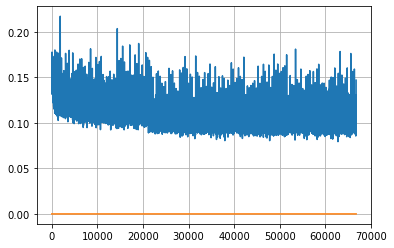

Epoch: 172, iteration 0, loss 0.09257298707962036, cov_diff 0.41056320664994533 cov_diff train 0.4094100237406929
Epoch: 172, iteration 1, loss 0.10167163610458374, cov_diff 0.43189854992309973 cov_diff train 0.43253447815164486
Epoch: 172, iteration 2, loss 0.1064232587814331, cov_diff 0.4142820853515059 cov_diff train 0.4142423034594746
Epoch: 172, iteration 3, loss 0.09694814682006836, cov_diff 0.43166861477135965 cov_diff train 0.43084838048206425
Epoch: 172, iteration 4, loss 0.09644651412963867, cov_diff 0.4176799887738219 cov_diff train 0.4169528276385677
Epoch: 172, iteration 5, loss 0.09579437971115112, cov_diff 0.4157475083607125 cov_diff train 0.4148443175709347
Epoch: 172, iteration 6, loss 0.10188126564025879, cov_diff 0.42581993396240736 cov_diff train 0.4257091820126365
Epoch: 172, iteration 7, loss 0.09641557931900024, cov_diff 0.4181229178588033 cov_diff train 0.41758782209138967
Epoch: 172, iteration 8, loss 0.10772362351417542, cov_diff 0.41737625115739163 cov_diff t

Epoch: 172, iteration 72, loss 0.10020604729652405, cov_diff 0.4364329407168562 cov_diff train 0.435023273925341
Epoch: 172, iteration 73, loss 0.10798120498657227, cov_diff 0.41052840853734984 cov_diff train 0.40969405336272097
Epoch: 172, iteration 74, loss 0.12606674432754517, cov_diff 0.41112337809926264 cov_diff train 0.4107025275357977
Epoch: 172, iteration 75, loss 0.10492536425590515, cov_diff 0.41187537204074776 cov_diff train 0.4100028931861065
Epoch: 172, iteration 76, loss 0.09859946370124817, cov_diff 0.40321263117671324 cov_diff train 0.40250174608719924
Epoch: 172, iteration 77, loss 0.09671995043754578, cov_diff 0.42278286055844244 cov_diff train 0.422373946872573
Epoch: 172, iteration 78, loss 0.10139033198356628, cov_diff 0.41083090337076006 cov_diff train 0.4103914849480985
Epoch: 172, iteration 79, loss 0.11299315094947815, cov_diff 0.41532734899102264 cov_diff train 0.4143704304960472
Epoch: 172, iteration 80, loss 0.10627943277359009, cov_diff 0.4160906961881876 c

Epoch: 172, iteration 149, loss 0.10610091686248779, cov_diff 0.4317052126502405 cov_diff train 0.43190156615895503
Epoch: 172, iteration 150, loss 0.11115911602973938, cov_diff 0.42556540744655597 cov_diff train 0.42544086400930503
Epoch: 172, iteration 151, loss 0.10769319534301758, cov_diff 0.4216027218061475 cov_diff train 0.4211315099560685
Epoch: 172, iteration 152, loss 0.09656846523284912, cov_diff 0.40329180027741146 cov_diff train 0.4029494631518072
Epoch: 172, iteration 153, loss 0.09958285093307495, cov_diff 0.4135481652713761 cov_diff train 0.4125519864037748
Epoch: 172, iteration 154, loss 0.10531601309776306, cov_diff 0.4066667310108385 cov_diff train 0.4059974981938068
Epoch: 172, iteration 155, loss 0.10565128922462463, cov_diff 0.4152379440740754 cov_diff train 0.4139782072244168
Epoch: 172, iteration 156, loss 0.10072681307792664, cov_diff 0.42199205775414034 cov_diff train 0.42060023933060836
Epoch: 172, iteration 157, loss 0.10032528638839722, cov_diff 0.4160787254

Epoch: 172, iteration 225, loss 0.10311758518218994, cov_diff 0.41440553315719436 cov_diff train 0.41299837199158135
Epoch: 172, iteration 226, loss 0.0954618752002716, cov_diff 0.4072383532752169 cov_diff train 0.40633359984099227
Epoch: 172, iteration 227, loss 0.09735944867134094, cov_diff 0.4175843766041662 cov_diff train 0.41697991588686784
Epoch: 172, iteration 228, loss 0.09012728929519653, cov_diff 0.4093015458829157 cov_diff train 0.40762387915263965
Epoch: 172, iteration 229, loss 0.10548669099807739, cov_diff 0.4216147915264218 cov_diff train 0.4209951711595971
Epoch: 172, iteration 230, loss 0.10204416513442993, cov_diff 0.41325096593288896 cov_diff train 0.4134974834883933
Epoch: 172, iteration 231, loss 0.10393571853637695, cov_diff 0.41844681218259056 cov_diff train 0.4178141181506146
Epoch: 172, iteration 232, loss 0.09735193848609924, cov_diff 0.42840406481156307 cov_diff train 0.4278584316645999
Epoch: 172, iteration 233, loss 0.11125820875167847, cov_diff 0.413311510

Epoch: 172, iteration 301, loss 0.11043599247932434, cov_diff 0.4113880218653929 cov_diff train 0.4106560709630973
Epoch: 172, iteration 302, loss 0.1023302674293518, cov_diff 0.3986588749340272 cov_diff train 0.39853117717534425
Epoch: 172, iteration 303, loss 0.10285678505897522, cov_diff 0.4223411860010311 cov_diff train 0.4202787976933521
Epoch: 172, iteration 304, loss 0.10649436712265015, cov_diff 0.403318091115444 cov_diff train 0.40345410921359864
Epoch: 172, iteration 305, loss 0.10209342837333679, cov_diff 0.41944181234189565 cov_diff train 0.4187751403971035
Epoch: 172, iteration 306, loss 0.10317429900169373, cov_diff 0.4072415798975756 cov_diff train 0.40730395842463957
Epoch: 172, iteration 307, loss 0.10019952058792114, cov_diff 0.4062829557038882 cov_diff train 0.40581305245656624
Epoch: 172, iteration 308, loss 0.10574683547019958, cov_diff 0.40830973176287266 cov_diff train 0.40826044905156167
Epoch: 172, iteration 309, loss 0.10842129588127136, cov_diff 0.41498810354

Epoch: 172, iteration 380, loss 0.10452717542648315, cov_diff 0.42272030586716186 cov_diff train 0.42197082974606837
Epoch: 172, iteration 381, loss 0.09720197319984436, cov_diff 0.4022354573621005 cov_diff train 0.40139422895233096
Epoch: 172, iteration 382, loss 0.10442081093788147, cov_diff 0.43157166724423063 cov_diff train 0.4308408519493935
Epoch: 172, iteration 383, loss 0.10167229175567627, cov_diff 0.41232498679182605 cov_diff train 0.4120427623519987
Epoch: 172, iteration 384, loss 0.0977599024772644, cov_diff 0.4214303708122547 cov_diff train 0.42079713428374543
Epoch: 172, iteration 385, loss 0.10034772753715515, cov_diff 0.4164895000345139 cov_diff train 0.4159569241118326
Epoch: 172, iteration 386, loss 0.11441650986671448, cov_diff 0.40637977553648563 cov_diff train 0.4059684305178647
Epoch: 172, iteration 387, loss 0.1036074161529541, cov_diff 0.4140626979476218 cov_diff train 0.41286416341906323
Epoch: 172, iteration 388, loss 0.09875109791755676, cov_diff 0.4189089953

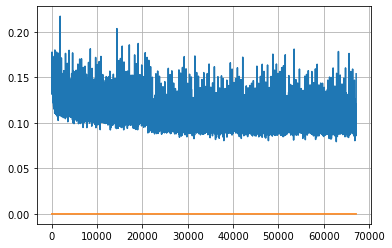

Epoch: 173, iteration 0, loss 0.09794139862060547, cov_diff 0.4270813053957388 cov_diff train 0.4267943407364201
Epoch: 173, iteration 1, loss 0.10000970959663391, cov_diff 0.42438579349707833 cov_diff train 0.42417767822377955
Epoch: 173, iteration 2, loss 0.11727380752563477, cov_diff 0.41924250322448425 cov_diff train 0.41827333140222306
Epoch: 173, iteration 3, loss 0.10944122076034546, cov_diff 0.4254414446032323 cov_diff train 0.4250285387198271
Epoch: 173, iteration 4, loss 0.10168761014938354, cov_diff 0.43026805849929106 cov_diff train 0.4295221779189514
Epoch: 173, iteration 5, loss 0.10421517491340637, cov_diff 0.4136413666675695 cov_diff train 0.4127694458388111
Epoch: 173, iteration 6, loss 0.09699279069900513, cov_diff 0.40794470786838455 cov_diff train 0.407681056938682
Epoch: 173, iteration 7, loss 0.12093761563301086, cov_diff 0.40784461967917124 cov_diff train 0.4063677325157981
Epoch: 173, iteration 8, loss 0.10623803734779358, cov_diff 0.4332460288394688 cov_diff tr

Epoch: 173, iteration 72, loss 0.10558426380157471, cov_diff 0.41833115644324353 cov_diff train 0.4171597268581768
Epoch: 173, iteration 73, loss 0.10554319620132446, cov_diff 0.413114389674498 cov_diff train 0.4124187949650902
Epoch: 173, iteration 74, loss 0.1052044928073883, cov_diff 0.41728039343037376 cov_diff train 0.41593384310192055
Epoch: 173, iteration 75, loss 0.11618345975875854, cov_diff 0.42158853331518964 cov_diff train 0.42146128680352396
Epoch: 173, iteration 76, loss 0.1041833758354187, cov_diff 0.4124944137610268 cov_diff train 0.41221779867589
Epoch: 173, iteration 77, loss 0.10165444016456604, cov_diff 0.40762809366345154 cov_diff train 0.40723823169259854
Epoch: 173, iteration 78, loss 0.10952144861221313, cov_diff 0.41080090578754397 cov_diff train 0.41111253994899355
Epoch: 173, iteration 79, loss 0.10267099738121033, cov_diff 0.42594998607147067 cov_diff train 0.42554405138584556
Epoch: 173, iteration 80, loss 0.09584301710128784, cov_diff 0.41189169168665585 c

Epoch: 173, iteration 150, loss 0.1006852388381958, cov_diff 0.39664498481737087 cov_diff train 0.3955092824977845
Epoch: 173, iteration 151, loss 0.09942448139190674, cov_diff 0.41933783092980903 cov_diff train 0.4194112265672776
Epoch: 173, iteration 152, loss 0.10109823942184448, cov_diff 0.41551985580131406 cov_diff train 0.4151211597308632
Epoch: 173, iteration 153, loss 0.09841150045394897, cov_diff 0.42130172318372444 cov_diff train 0.4203731595315184
Epoch: 173, iteration 154, loss 0.10636582970619202, cov_diff 0.4116372630476277 cov_diff train 0.4114022327712939
Epoch: 173, iteration 155, loss 0.09748098254203796, cov_diff 0.4012027216404374 cov_diff train 0.4009118834880053
Epoch: 173, iteration 156, loss 0.10243755578994751, cov_diff 0.4081606848465864 cov_diff train 0.4074671607331541
Epoch: 173, iteration 157, loss 0.1110367476940155, cov_diff 0.42702472861935015 cov_diff train 0.4268819716425547
Epoch: 173, iteration 158, loss 0.1241203248500824, cov_diff 0.42210538669377

Epoch: 173, iteration 225, loss 0.0985954999923706, cov_diff 0.41860408855571013 cov_diff train 0.41822829710851417
Epoch: 173, iteration 226, loss 0.10964739322662354, cov_diff 0.4057851324122588 cov_diff train 0.40480286514115954
Epoch: 173, iteration 227, loss 0.0991167426109314, cov_diff 0.4130887809069131 cov_diff train 0.4128200939145945
Epoch: 173, iteration 228, loss 0.10855185985565186, cov_diff 0.4187025217989575 cov_diff train 0.41876052418595194
Epoch: 173, iteration 229, loss 0.10437241196632385, cov_diff 0.4175721422923576 cov_diff train 0.41605320447990807
Epoch: 173, iteration 230, loss 0.10301852226257324, cov_diff 0.40580698618968725 cov_diff train 0.4057146028177302
Epoch: 173, iteration 231, loss 0.09961748123168945, cov_diff 0.41448543889813244 cov_diff train 0.41370002092506186
Epoch: 173, iteration 232, loss 0.0976705551147461, cov_diff 0.40653025677133053 cov_diff train 0.40512420331803833
Epoch: 173, iteration 233, loss 0.10911083221435547, cov_diff 0.411803595

Epoch: 173, iteration 301, loss 0.0999058187007904, cov_diff 0.40635687371649676 cov_diff train 0.405374294209223
Epoch: 173, iteration 302, loss 0.1127968430519104, cov_diff 0.4130483839427111 cov_diff train 0.41177522291284774
Epoch: 173, iteration 303, loss 0.09743240475654602, cov_diff 0.412684459835837 cov_diff train 0.4113045549331915
Epoch: 173, iteration 304, loss 0.11168605089187622, cov_diff 0.4175772409955748 cov_diff train 0.41716291678230316
Epoch: 173, iteration 305, loss 0.10227417945861816, cov_diff 0.40858029519673417 cov_diff train 0.4087103171285717
Epoch: 173, iteration 306, loss 0.10639950633049011, cov_diff 0.4227828419420629 cov_diff train 0.4222645334781768
Epoch: 173, iteration 307, loss 0.11711594462394714, cov_diff 0.41867800197405064 cov_diff train 0.41890028268727275
Epoch: 173, iteration 308, loss 0.10470446944236755, cov_diff 0.41835869075534726 cov_diff train 0.4181672512495788
Epoch: 173, iteration 309, loss 0.10923203825950623, cov_diff 0.4088376785621

Epoch: 173, iteration 377, loss 0.11492127180099487, cov_diff 0.42315637751727403 cov_diff train 0.422214194404574
Epoch: 173, iteration 378, loss 0.11800295114517212, cov_diff 0.4274382891104679 cov_diff train 0.42676371268525914
Epoch: 173, iteration 379, loss 0.10872548818588257, cov_diff 0.4262134106780442 cov_diff train 0.42438406011630847
Epoch: 173, iteration 380, loss 0.11380302906036377, cov_diff 0.41544629060217736 cov_diff train 0.41477465387267176
Epoch: 173, iteration 381, loss 0.10975232720375061, cov_diff 0.4273566831129022 cov_diff train 0.42713892452953134
Epoch: 173, iteration 382, loss 0.09469607472419739, cov_diff 0.41109843556470366 cov_diff train 0.4105727806885121
Epoch: 173, iteration 383, loss 0.10805818438529968, cov_diff 0.4160576773325491 cov_diff train 0.41532726096135514
Epoch: 173, iteration 384, loss 0.10170808434486389, cov_diff 0.42610502471468686 cov_diff train 0.425715330805774
Epoch: 173, iteration 385, loss 0.09988480806350708, cov_diff 0.418901727

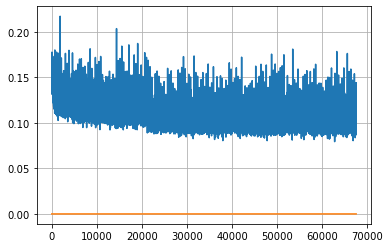

Epoch: 174, iteration 0, loss 0.1003904938697815, cov_diff 0.4247747376381118 cov_diff train 0.4243092483189543
Epoch: 174, iteration 1, loss 0.1004471480846405, cov_diff 0.4153843322818677 cov_diff train 0.4154262724355634
Epoch: 174, iteration 2, loss 0.09546086192131042, cov_diff 0.4114539079492972 cov_diff train 0.4118444861210904
Epoch: 174, iteration 3, loss 0.10418149828910828, cov_diff 0.4203571587169342 cov_diff train 0.419666058242226
Epoch: 174, iteration 4, loss 0.11489865183830261, cov_diff 0.4231068626013657 cov_diff train 0.4228657117208296
Epoch: 174, iteration 5, loss 0.10393214225769043, cov_diff 0.4310493207698327 cov_diff train 0.4306568780725064
Epoch: 174, iteration 6, loss 0.10060390830039978, cov_diff 0.41302181845946473 cov_diff train 0.4119728912203684
Epoch: 174, iteration 7, loss 0.11574369668960571, cov_diff 0.4181229336758922 cov_diff train 0.4172063328837884
Epoch: 174, iteration 8, loss 0.10261911153793335, cov_diff 0.4184108117357248 cov_diff train 0.41

Epoch: 174, iteration 77, loss 0.10859987139701843, cov_diff 0.41673816509234324 cov_diff train 0.4154029076972444
Epoch: 174, iteration 78, loss 0.1109168529510498, cov_diff 0.4258316815546118 cov_diff train 0.4250793298772404
Epoch: 174, iteration 79, loss 0.09074980020523071, cov_diff 0.3994046135106832 cov_diff train 0.39934680234487885
Epoch: 174, iteration 80, loss 0.1029529869556427, cov_diff 0.4011014820285229 cov_diff train 0.4006781853536343
Epoch: 174, iteration 81, loss 0.09392338991165161, cov_diff 0.41352182182921593 cov_diff train 0.41268609657758903
Epoch: 174, iteration 82, loss 0.10890480875968933, cov_diff 0.4122617901537521 cov_diff train 0.4119892391449718
Epoch: 174, iteration 83, loss 0.09598779678344727, cov_diff 0.40507300539895563 cov_diff train 0.40433285442506894
Epoch: 174, iteration 84, loss 0.09866943955421448, cov_diff 0.4106392172498381 cov_diff train 0.4097655148803841
Epoch: 174, iteration 85, loss 0.11150765419006348, cov_diff 0.4204286788579809 cov_

Epoch: 174, iteration 153, loss 0.09558799862861633, cov_diff 0.41591121530236325 cov_diff train 0.41554602951694547
Epoch: 174, iteration 154, loss 0.10296383500099182, cov_diff 0.4162455722088372 cov_diff train 0.415570040877059
Epoch: 174, iteration 155, loss 0.10060769319534302, cov_diff 0.4256445212009629 cov_diff train 0.42516026362124765
Epoch: 174, iteration 156, loss 0.10723841190338135, cov_diff 0.4147407619170122 cov_diff train 0.4143634946497337
Epoch: 174, iteration 157, loss 0.12497353553771973, cov_diff 0.40672589262933384 cov_diff train 0.40572288604384005
Epoch: 174, iteration 158, loss 0.11273348331451416, cov_diff 0.4073754713207331 cov_diff train 0.40700212060363916
Epoch: 174, iteration 159, loss 0.09779679775238037, cov_diff 0.3993363373951852 cov_diff train 0.3990747298372762
Epoch: 174, iteration 160, loss 0.09713971614837646, cov_diff 0.4227419088362994 cov_diff train 0.4218767834894679
Epoch: 174, iteration 161, loss 0.1072503924369812, cov_diff 0.416234997157

Epoch: 174, iteration 232, loss 0.10617759823799133, cov_diff 0.40807716787709974 cov_diff train 0.40735677167560913
Epoch: 174, iteration 233, loss 0.10458573698997498, cov_diff 0.41152025647988033 cov_diff train 0.41127856933417667
Epoch: 174, iteration 234, loss 0.10748344659805298, cov_diff 0.4093273303667857 cov_diff train 0.4089208755822413
Epoch: 174, iteration 235, loss 0.10951194167137146, cov_diff 0.4155752916131904 cov_diff train 0.41588486703990707
Epoch: 174, iteration 236, loss 0.1067068874835968, cov_diff 0.40993698881734697 cov_diff train 0.40898679829576046
Epoch: 174, iteration 237, loss 0.11317470669746399, cov_diff 0.42297084946055535 cov_diff train 0.42148695363711985
Epoch: 174, iteration 238, loss 0.09962859749794006, cov_diff 0.4025317081189427 cov_diff train 0.40180521857695434
Epoch: 174, iteration 239, loss 0.11392879486083984, cov_diff 0.4053737008465204 cov_diff train 0.40489968365536066
Epoch: 174, iteration 240, loss 0.10925614833831787, cov_diff 0.399774

Epoch: 174, iteration 304, loss 0.09236016869544983, cov_diff 0.4161249819768993 cov_diff train 0.41509085292921005
Epoch: 174, iteration 305, loss 0.10770991444587708, cov_diff 0.42877104227644247 cov_diff train 0.4277992158464899
Epoch: 174, iteration 306, loss 0.09697383642196655, cov_diff 0.41556044522086205 cov_diff train 0.4151307005054506
Epoch: 174, iteration 307, loss 0.09748700261116028, cov_diff 0.4240482973925007 cov_diff train 0.42276722237358116
Epoch: 174, iteration 308, loss 0.0948610007762909, cov_diff 0.40707329859610136 cov_diff train 0.4067156501727907
Epoch: 174, iteration 309, loss 0.10029715299606323, cov_diff 0.41016958354510885 cov_diff train 0.4096772716003167
Epoch: 174, iteration 310, loss 0.11248096823692322, cov_diff 0.4131044040705808 cov_diff train 0.4123570590226247
Epoch: 174, iteration 311, loss 0.09767580032348633, cov_diff 0.42016005687116076 cov_diff train 0.42032130382040295
Epoch: 174, iteration 312, loss 0.10435909032821655, cov_diff 0.399926015

Epoch: 174, iteration 381, loss 0.10420620441436768, cov_diff 0.4170210890474561 cov_diff train 0.4154538089114641
Epoch: 174, iteration 382, loss 0.10713222622871399, cov_diff 0.4272242509369397 cov_diff train 0.42630281843279716
Epoch: 174, iteration 383, loss 0.10091504454612732, cov_diff 0.4168668012639452 cov_diff train 0.4151219094830108
Epoch: 174, iteration 384, loss 0.10496771335601807, cov_diff 0.4058458909626302 cov_diff train 0.40362883472847483
Epoch: 174, iteration 385, loss 0.11231160163879395, cov_diff 0.42462153832981503 cov_diff train 0.4239938255526412
Epoch: 174, iteration 386, loss 0.09612700343132019, cov_diff 0.40629225966570726 cov_diff train 0.40586225581257956
Epoch: 174, iteration 387, loss 0.09937232732772827, cov_diff 0.4043187957061041 cov_diff train 0.40341291440928573
Epoch: 174, iteration 388, loss 0.11433398723602295, cov_diff 0.4116600206935079 cov_diff train 0.41040245486441623
Epoch: 174, iteration 389, loss 0.0963921844959259, cov_diff 0.4155971579

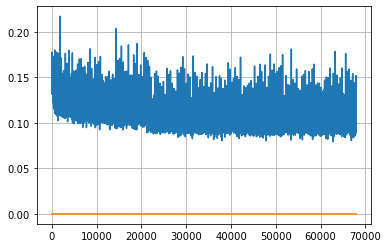

Epoch: 175, iteration 0, loss 0.09957849979400635, cov_diff 0.42961447697400645 cov_diff train 0.42808167896017374
Epoch: 175, iteration 1, loss 0.09403455257415771, cov_diff 0.41485342597094943 cov_diff train 0.4137721494253579
Epoch: 175, iteration 2, loss 0.08886316418647766, cov_diff 0.4179156647416364 cov_diff train 0.4168770267894772
Epoch: 175, iteration 3, loss 0.09188169240951538, cov_diff 0.4182728252479156 cov_diff train 0.4167958647991445
Epoch: 175, iteration 4, loss 0.09727025032043457, cov_diff 0.4141100346402624 cov_diff train 0.4139736560911281
Epoch: 175, iteration 5, loss 0.11218157410621643, cov_diff 0.41378003639499206 cov_diff train 0.41365411632433413
Epoch: 175, iteration 6, loss 0.10321590304374695, cov_diff 0.40841255870303367 cov_diff train 0.40735995742846226
Epoch: 175, iteration 7, loss 0.1074993908405304, cov_diff 0.4153072196818154 cov_diff train 0.4146338833324138
Epoch: 175, iteration 8, loss 0.11375695466995239, cov_diff 0.4156602030687171 cov_diff tr

Epoch: 175, iteration 75, loss 0.11362507939338684, cov_diff 0.41322198683822514 cov_diff train 0.4125311646272423
Epoch: 175, iteration 76, loss 0.09247750043869019, cov_diff 0.4034251983827728 cov_diff train 0.4028191355859249
Epoch: 175, iteration 77, loss 0.10639819502830505, cov_diff 0.4209696992549542 cov_diff train 0.42053873564303024
Epoch: 175, iteration 78, loss 0.1058051586151123, cov_diff 0.39924395489391246 cov_diff train 0.3990090369207003
Epoch: 175, iteration 79, loss 0.09825378656387329, cov_diff 0.41996585805746045 cov_diff train 0.419818697350267
Epoch: 175, iteration 80, loss 0.11140328645706177, cov_diff 0.4078001419934645 cov_diff train 0.40757418989469374
Epoch: 175, iteration 81, loss 0.11229634284973145, cov_diff 0.42067210820845236 cov_diff train 0.4208427264152082
Epoch: 175, iteration 82, loss 0.10711643099784851, cov_diff 0.4183964976355195 cov_diff train 0.4186539359904307
Epoch: 175, iteration 83, loss 0.11201596260070801, cov_diff 0.41807044734013993 cov

Epoch: 175, iteration 154, loss 0.1115158200263977, cov_diff 0.41539620356705553 cov_diff train 0.41475063175212334
Epoch: 175, iteration 155, loss 0.09934228658676147, cov_diff 0.4146365722615812 cov_diff train 0.4143706798393914
Epoch: 175, iteration 156, loss 0.09635719656944275, cov_diff 0.4094319599649677 cov_diff train 0.4087168054252119
Epoch: 175, iteration 157, loss 0.11358368396759033, cov_diff 0.4064749203555707 cov_diff train 0.40560368906483985
Epoch: 175, iteration 158, loss 0.08997589349746704, cov_diff 0.4182831606202887 cov_diff train 0.41788200165281697
Epoch: 175, iteration 159, loss 0.09569287300109863, cov_diff 0.4103773758211822 cov_diff train 0.4100391050175473
Epoch: 175, iteration 160, loss 0.10349971055984497, cov_diff 0.4134973988989249 cov_diff train 0.41315680121785414
Epoch: 175, iteration 161, loss 0.10574239492416382, cov_diff 0.4187622912728998 cov_diff train 0.41851716833109115
Epoch: 175, iteration 162, loss 0.09208974242210388, cov_diff 0.42254679864

Epoch: 175, iteration 232, loss 0.10958206653594971, cov_diff 0.4082833633947029 cov_diff train 0.4084312434563803
Epoch: 175, iteration 233, loss 0.10024210810661316, cov_diff 0.41424051319294325 cov_diff train 0.4131544466008775
Epoch: 175, iteration 234, loss 0.11293897032737732, cov_diff 0.4117959127489497 cov_diff train 0.4110540957057861
Epoch: 175, iteration 235, loss 0.11219826340675354, cov_diff 0.43022546963333097 cov_diff train 0.4298141067966395
Epoch: 175, iteration 236, loss 0.10463589429855347, cov_diff 0.4216374814965594 cov_diff train 0.42078887114062463
Epoch: 175, iteration 237, loss 0.10907086730003357, cov_diff 0.4164265893252678 cov_diff train 0.4158361423183842
Epoch: 175, iteration 238, loss 0.11868026852607727, cov_diff 0.4207337049817414 cov_diff train 0.41921636351718866
Epoch: 175, iteration 239, loss 0.09802913665771484, cov_diff 0.4174587676310124 cov_diff train 0.4165955074138727
Epoch: 175, iteration 240, loss 0.0909695029258728, cov_diff 0.4089398701460

Epoch: 175, iteration 309, loss 0.0986500084400177, cov_diff 0.42064643556869297 cov_diff train 0.42050841454840227
Epoch: 175, iteration 310, loss 0.11259761452674866, cov_diff 0.4132071427428001 cov_diff train 0.41173494841322394
Epoch: 175, iteration 311, loss 0.11590054631233215, cov_diff 0.4238415916239586 cov_diff train 0.4227932223318293
Epoch: 175, iteration 312, loss 0.1077117919921875, cov_diff 0.41127349247018374 cov_diff train 0.40998398875897335
Epoch: 175, iteration 313, loss 0.11212757229804993, cov_diff 0.4131686302084671 cov_diff train 0.41171506501951816
Epoch: 175, iteration 314, loss 0.10515272617340088, cov_diff 0.4089863365104687 cov_diff train 0.4086400614023708
Epoch: 175, iteration 315, loss 0.09821164608001709, cov_diff 0.40976406053104447 cov_diff train 0.4094061644544948
Epoch: 175, iteration 316, loss 0.09529969096183777, cov_diff 0.40935046730850505 cov_diff train 0.4084675603893542
Epoch: 175, iteration 317, loss 0.10310575366020203, cov_diff 0.4236147221

Epoch: 175, iteration 387, loss 0.1156613826751709, cov_diff 0.4197665499849542 cov_diff train 0.41961925040948966
Epoch: 175, iteration 388, loss 0.1049041748046875, cov_diff 0.4169810077741218 cov_diff train 0.4165319605496934
Epoch: 175, iteration 389, loss 0.09526962041854858, cov_diff 0.4172736098033741 cov_diff train 0.41671034277772623
Epoch: 175, iteration 390, loss 0.14744031429290771, cov_diff 0.44504353688267617 cov_diff train 0.44438841834013815


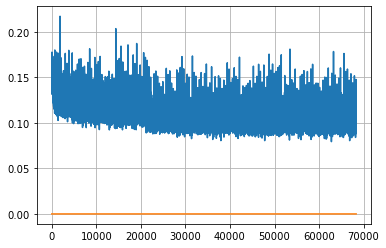

Epoch: 176, iteration 0, loss 0.09471487998962402, cov_diff 0.4074346111345433 cov_diff train 0.40753791453892435
Epoch: 176, iteration 1, loss 0.10847210884094238, cov_diff 0.4188540885054893 cov_diff train 0.4180428023296741
Epoch: 176, iteration 2, loss 0.10858944058418274, cov_diff 0.42097432060658607 cov_diff train 0.42013223292349994
Epoch: 176, iteration 3, loss 0.10952645540237427, cov_diff 0.4183449626520853 cov_diff train 0.41726263757780757
Epoch: 176, iteration 4, loss 0.10860282182693481, cov_diff 0.40991547574398923 cov_diff train 0.4097822415196549
Epoch: 176, iteration 5, loss 0.10985460877418518, cov_diff 0.4195042153814205 cov_diff train 0.4182933677192799
Epoch: 176, iteration 6, loss 0.10522633790969849, cov_diff 0.4087984574768599 cov_diff train 0.40801829488688013
Epoch: 176, iteration 7, loss 0.10671418905258179, cov_diff 0.42677598876374884 cov_diff train 0.4248720655178547
Epoch: 176, iteration 8, loss 0.10811886191368103, cov_diff 0.4241169826920709 cov_diff t

Epoch: 176, iteration 78, loss 0.10703641176223755, cov_diff 0.41707200310481796 cov_diff train 0.41644852482842304
Epoch: 176, iteration 79, loss 0.10430392622947693, cov_diff 0.41928891027979637 cov_diff train 0.4181786841099858
Epoch: 176, iteration 80, loss 0.12087026238441467, cov_diff 0.41676175156365897 cov_diff train 0.4161425473207943
Epoch: 176, iteration 81, loss 0.11136800050735474, cov_diff 0.4066885300030844 cov_diff train 0.40609603202614214
Epoch: 176, iteration 82, loss 0.10544851422309875, cov_diff 0.4094593078872636 cov_diff train 0.40910834609166646
Epoch: 176, iteration 83, loss 0.1045856773853302, cov_diff 0.41548737469353014 cov_diff train 0.41472237911238335
Epoch: 176, iteration 84, loss 0.11160093545913696, cov_diff 0.4175648975326327 cov_diff train 0.41706756084680535
Epoch: 176, iteration 85, loss 0.09890732169151306, cov_diff 0.420335880232296 cov_diff train 0.41938992334501163
Epoch: 176, iteration 86, loss 0.09617674350738525, cov_diff 0.42091182248003806

Epoch: 176, iteration 156, loss 0.1014765202999115, cov_diff 0.4126537282670041 cov_diff train 0.41252362624447453
Epoch: 176, iteration 157, loss 0.10154327750205994, cov_diff 0.40730500055134494 cov_diff train 0.406656332149067
Epoch: 176, iteration 158, loss 0.10533729195594788, cov_diff 0.4132666124546602 cov_diff train 0.41227563197068245
Epoch: 176, iteration 159, loss 0.10384216904640198, cov_diff 0.423355261062234 cov_diff train 0.4227237870578409
Epoch: 176, iteration 160, loss 0.10102978348731995, cov_diff 0.41693430906152207 cov_diff train 0.41607156770059833
Epoch: 176, iteration 161, loss 0.11327669024467468, cov_diff 0.4133629135098298 cov_diff train 0.4123378754917959
Epoch: 176, iteration 162, loss 0.09207934141159058, cov_diff 0.4072801352827891 cov_diff train 0.4071075459411029
Epoch: 176, iteration 163, loss 0.09939205646514893, cov_diff 0.40748066381933923 cov_diff train 0.4073440280116124
Epoch: 176, iteration 164, loss 0.10317260026931763, cov_diff 0.4314877948956

Epoch: 176, iteration 234, loss 0.10443952679634094, cov_diff 0.4114855377066865 cov_diff train 0.4108615592635115
Epoch: 176, iteration 235, loss 0.1024014949798584, cov_diff 0.41714743199890814 cov_diff train 0.41657699972483936
Epoch: 176, iteration 236, loss 0.08914545178413391, cov_diff 0.4275813005650588 cov_diff train 0.42759911065973777
Epoch: 176, iteration 237, loss 0.10496509075164795, cov_diff 0.41607340656221864 cov_diff train 0.41559708756239533
Epoch: 176, iteration 238, loss 0.11437585949897766, cov_diff 0.41946092391221046 cov_diff train 0.4176606828206402
Epoch: 176, iteration 239, loss 0.09631869196891785, cov_diff 0.4257605018117829 cov_diff train 0.42408618328445974
Epoch: 176, iteration 240, loss 0.10659348964691162, cov_diff 0.4114155175925385 cov_diff train 0.41041653679192575
Epoch: 176, iteration 241, loss 0.1121794581413269, cov_diff 0.40994366134103327 cov_diff train 0.4090957343454566
Epoch: 176, iteration 242, loss 0.11746519804000854, cov_diff 0.415387161

Epoch: 176, iteration 311, loss 0.1061873733997345, cov_diff 0.41155518699291915 cov_diff train 0.4108994051024443
Epoch: 176, iteration 312, loss 0.107728511095047, cov_diff 0.4271306266341688 cov_diff train 0.42641508470896566
Epoch: 176, iteration 313, loss 0.11169740557670593, cov_diff 0.41488034440883004 cov_diff train 0.41323249681817115
Epoch: 176, iteration 314, loss 0.11567813158035278, cov_diff 0.4101818445724694 cov_diff train 0.40896000015784284
Epoch: 176, iteration 315, loss 0.10172221064567566, cov_diff 0.4010263861755235 cov_diff train 0.4000379051830716
Epoch: 176, iteration 316, loss 0.11079546809196472, cov_diff 0.41955768135790256 cov_diff train 0.41817178760694085
Epoch: 176, iteration 317, loss 0.10937422513961792, cov_diff 0.41618480018705306 cov_diff train 0.41545455974414935
Epoch: 176, iteration 318, loss 0.10283181071281433, cov_diff 0.4069671016745836 cov_diff train 0.4059657756045935
Epoch: 176, iteration 319, loss 0.10645103454589844, cov_diff 0.4150681891

Epoch: 176, iteration 382, loss 0.1015038788318634, cov_diff 0.410548105020759 cov_diff train 0.41115044462177475
Epoch: 176, iteration 383, loss 0.10244971513748169, cov_diff 0.4199884057441734 cov_diff train 0.41974118546196976
Epoch: 176, iteration 384, loss 0.09346631169319153, cov_diff 0.41330862310727773 cov_diff train 0.4128481308334678
Epoch: 176, iteration 385, loss 0.10631591081619263, cov_diff 0.40681716548579866 cov_diff train 0.4072637004579041
Epoch: 176, iteration 386, loss 0.10758540034294128, cov_diff 0.421438396113719 cov_diff train 0.42058729852324106
Epoch: 176, iteration 387, loss 0.10230013728141785, cov_diff 0.40986446724201675 cov_diff train 0.4094589398824524
Epoch: 176, iteration 388, loss 0.10132461786270142, cov_diff 0.41663077246057684 cov_diff train 0.41532686199538926
Epoch: 176, iteration 389, loss 0.09980887174606323, cov_diff 0.4144367818843462 cov_diff train 0.41315624103676046
Epoch: 176, iteration 390, loss 0.16379404067993164, cov_diff 0.4491079890

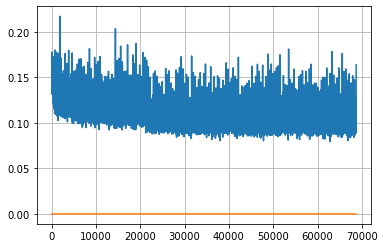

Epoch: 177, iteration 0, loss 0.09540349245071411, cov_diff 0.41766654072352494 cov_diff train 0.4172361014652673
Epoch: 177, iteration 1, loss 0.09821432828903198, cov_diff 0.41652922406870746 cov_diff train 0.41603541841693414
Epoch: 177, iteration 2, loss 0.10497087240219116, cov_diff 0.4135139598724748 cov_diff train 0.41263285413397083
Epoch: 177, iteration 3, loss 0.1103525459766388, cov_diff 0.41643528713515987 cov_diff train 0.41638522019853214
Epoch: 177, iteration 4, loss 0.10326331853866577, cov_diff 0.4152226581816908 cov_diff train 0.4151026248751337
Epoch: 177, iteration 5, loss 0.10835352540016174, cov_diff 0.43540536264762614 cov_diff train 0.434807659943034
Epoch: 177, iteration 6, loss 0.10461869835853577, cov_diff 0.42360403473483976 cov_diff train 0.42387395605649875
Epoch: 177, iteration 7, loss 0.10548684000968933, cov_diff 0.4147683864679309 cov_diff train 0.41471169609924247
Epoch: 177, iteration 8, loss 0.10768383741378784, cov_diff 0.41664148274313967 cov_diff

Epoch: 177, iteration 78, loss 0.11626261472702026, cov_diff 0.42477959037163715 cov_diff train 0.42374520404754523
Epoch: 177, iteration 79, loss 0.10802552103996277, cov_diff 0.40895415867205676 cov_diff train 0.4082591590770934
Epoch: 177, iteration 80, loss 0.10333609580993652, cov_diff 0.4161052797239869 cov_diff train 0.4151039197312619
Epoch: 177, iteration 81, loss 0.09232315421104431, cov_diff 0.41433176832071333 cov_diff train 0.41373176184931243
Epoch: 177, iteration 82, loss 0.1084502637386322, cov_diff 0.42963148858077865 cov_diff train 0.42781427032117963
Epoch: 177, iteration 83, loss 0.10631269216537476, cov_diff 0.4197437543346104 cov_diff train 0.4173005118505896
Epoch: 177, iteration 84, loss 0.09099307656288147, cov_diff 0.4323727446539877 cov_diff train 0.43151252341297336
Epoch: 177, iteration 85, loss 0.11490988731384277, cov_diff 0.405539822827216 cov_diff train 0.40423871550357204
Epoch: 177, iteration 86, loss 0.09585165977478027, cov_diff 0.41541735664221047 

Epoch: 177, iteration 152, loss 0.09789144992828369, cov_diff 0.4159297053455419 cov_diff train 0.41517785658828255
Epoch: 177, iteration 153, loss 0.11382117867469788, cov_diff 0.4146277474943128 cov_diff train 0.41339244630422933
Epoch: 177, iteration 154, loss 0.10145941376686096, cov_diff 0.41822231784606534 cov_diff train 0.4168678740160391
Epoch: 177, iteration 155, loss 0.1008654534816742, cov_diff 0.4076093710100739 cov_diff train 0.40648962823464585
Epoch: 177, iteration 156, loss 0.10510209202766418, cov_diff 0.41332705702766276 cov_diff train 0.4122612089271538
Epoch: 177, iteration 157, loss 0.10330578684806824, cov_diff 0.416957920533919 cov_diff train 0.41523791105061514
Epoch: 177, iteration 158, loss 0.10703456401824951, cov_diff 0.404235858084281 cov_diff train 0.4031156668388722
Epoch: 177, iteration 159, loss 0.10271546244621277, cov_diff 0.4233901983958793 cov_diff train 0.42279670357673527
Epoch: 177, iteration 160, loss 0.1023489236831665, cov_diff 0.4149061868257

Epoch: 177, iteration 228, loss 0.1090506911277771, cov_diff 0.41402327287692325 cov_diff train 0.4128378003785387
Epoch: 177, iteration 229, loss 0.12942644953727722, cov_diff 0.41671919946018254 cov_diff train 0.416200860416176
Epoch: 177, iteration 230, loss 0.0930761992931366, cov_diff 0.4193463878744313 cov_diff train 0.4194861428203675
Epoch: 177, iteration 231, loss 0.0952204167842865, cov_diff 0.41726467341830403 cov_diff train 0.4158926236008133
Epoch: 177, iteration 232, loss 0.10774365067481995, cov_diff 0.39924510501566834 cov_diff train 0.39863732396466456
Epoch: 177, iteration 233, loss 0.08968153595924377, cov_diff 0.41062300023938936 cov_diff train 0.41045718366648615
Epoch: 177, iteration 234, loss 0.10390830039978027, cov_diff 0.4173846341878148 cov_diff train 0.4162849116247618
Epoch: 177, iteration 235, loss 0.11157786846160889, cov_diff 0.4143332300950391 cov_diff train 0.41383233392908136
Epoch: 177, iteration 236, loss 0.1095675528049469, cov_diff 0.4217249207803

Epoch: 177, iteration 301, loss 0.10232460498809814, cov_diff 0.4197742662439399 cov_diff train 0.4196618738597603
Epoch: 177, iteration 302, loss 0.1075376570224762, cov_diff 0.4309514388366528 cov_diff train 0.4292507309701865
Epoch: 177, iteration 303, loss 0.09285512566566467, cov_diff 0.40983043922347323 cov_diff train 0.4086879570060382
Epoch: 177, iteration 304, loss 0.1103716492652893, cov_diff 0.416233996276833 cov_diff train 0.4154551296031081
Epoch: 177, iteration 305, loss 0.09902501106262207, cov_diff 0.41409255679929075 cov_diff train 0.4132607753194357
Epoch: 177, iteration 306, loss 0.10456448793411255, cov_diff 0.41143947009167997 cov_diff train 0.41084973857051255
Epoch: 177, iteration 307, loss 0.10498255491256714, cov_diff 0.4131925838773039 cov_diff train 0.41177648124761
Epoch: 177, iteration 308, loss 0.10311800241470337, cov_diff 0.41023165149749413 cov_diff train 0.4092331531750781
Epoch: 177, iteration 309, loss 0.11061295866966248, cov_diff 0.4133817574359376

Epoch: 177, iteration 377, loss 0.10711252689361572, cov_diff 0.4299702919313193 cov_diff train 0.4298679291468909
Epoch: 177, iteration 378, loss 0.09889623522758484, cov_diff 0.40650729946968606 cov_diff train 0.40655265733012175
Epoch: 177, iteration 379, loss 0.10565179586410522, cov_diff 0.4106357947764785 cov_diff train 0.4095981052498638
Epoch: 177, iteration 380, loss 0.09766891598701477, cov_diff 0.40574594005380665 cov_diff train 0.40492043385684456
Epoch: 177, iteration 381, loss 0.11269998550415039, cov_diff 0.4346389408126686 cov_diff train 0.43444699873011705
Epoch: 177, iteration 382, loss 0.11803087592124939, cov_diff 0.4151908415740658 cov_diff train 0.4142882892502653
Epoch: 177, iteration 383, loss 0.09590351581573486, cov_diff 0.4043737045573804 cov_diff train 0.4038528697598336
Epoch: 177, iteration 384, loss 0.08962339162826538, cov_diff 0.40980069127718066 cov_diff train 0.40854172015911133
Epoch: 177, iteration 385, loss 0.10565000772476196, cov_diff 0.410247566

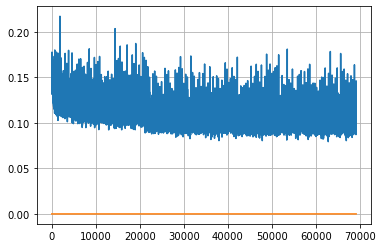

Epoch: 178, iteration 0, loss 0.10364827513694763, cov_diff 0.4191417624500495 cov_diff train 0.418444787629668
Epoch: 178, iteration 1, loss 0.11616212129592896, cov_diff 0.42920147700267053 cov_diff train 0.42815207050447635
Epoch: 178, iteration 2, loss 0.1039571762084961, cov_diff 0.40528232774557915 cov_diff train 0.40425020219561797
Epoch: 178, iteration 3, loss 0.09913480281829834, cov_diff 0.41118559879567196 cov_diff train 0.41082685220305304
Epoch: 178, iteration 4, loss 0.09665685892105103, cov_diff 0.4118837559497903 cov_diff train 0.4112542818411901
Epoch: 178, iteration 5, loss 0.10794040560722351, cov_diff 0.4116351388248564 cov_diff train 0.41195572684650034
Epoch: 178, iteration 6, loss 0.10676756501197815, cov_diff 0.4121036483129202 cov_diff train 0.41137190072810226
Epoch: 178, iteration 7, loss 0.09069380164146423, cov_diff 0.4164485116669073 cov_diff train 0.4160082250286224
Epoch: 178, iteration 8, loss 0.09816473722457886, cov_diff 0.41951589284922863 cov_diff t

Epoch: 178, iteration 76, loss 0.09712550044059753, cov_diff 0.42456295237794844 cov_diff train 0.4238607102332056
Epoch: 178, iteration 77, loss 0.09378638863563538, cov_diff 0.4210744765052982 cov_diff train 0.420470270231667
Epoch: 178, iteration 78, loss 0.10430184006690979, cov_diff 0.4181005877705911 cov_diff train 0.41770756121292174
Epoch: 178, iteration 79, loss 0.0971987247467041, cov_diff 0.40755313381664393 cov_diff train 0.4076233933766098
Epoch: 178, iteration 80, loss 0.09901002049446106, cov_diff 0.4159407754268359 cov_diff train 0.41522441845451596
Epoch: 178, iteration 81, loss 0.10332000255584717, cov_diff 0.4102924259260479 cov_diff train 0.4101837433567696
Epoch: 178, iteration 82, loss 0.0949726402759552, cov_diff 0.4067450550837075 cov_diff train 0.40581594853613867
Epoch: 178, iteration 83, loss 0.10243839025497437, cov_diff 0.42018928423727514 cov_diff train 0.41910260074137046
Epoch: 178, iteration 84, loss 0.10308808088302612, cov_diff 0.40788386026774615 cov

Epoch: 178, iteration 149, loss 0.09788012504577637, cov_diff 0.40441123014416636 cov_diff train 0.4037830939448417
Epoch: 178, iteration 150, loss 0.09909772872924805, cov_diff 0.4146196266467044 cov_diff train 0.4133555387625184
Epoch: 178, iteration 151, loss 0.10214307904243469, cov_diff 0.42574664287470476 cov_diff train 0.4244156029772099
Epoch: 178, iteration 152, loss 0.1051182746887207, cov_diff 0.42787308543013747 cov_diff train 0.42743070314322534
Epoch: 178, iteration 153, loss 0.10796242952346802, cov_diff 0.4174208247720583 cov_diff train 0.41695116929625536
Epoch: 178, iteration 154, loss 0.09258541464805603, cov_diff 0.4054545641481582 cov_diff train 0.40455677063194734
Epoch: 178, iteration 155, loss 0.10013025999069214, cov_diff 0.40739568288945016 cov_diff train 0.40691273864251776
Epoch: 178, iteration 156, loss 0.09934157133102417, cov_diff 0.40568373102683075 cov_diff train 0.40531744470696995
Epoch: 178, iteration 157, loss 0.10113063454627991, cov_diff 0.4162388

Epoch: 178, iteration 224, loss 0.099093496799469, cov_diff 0.4205809404779006 cov_diff train 0.4198290695299289
Epoch: 178, iteration 225, loss 0.10705924034118652, cov_diff 0.41935794651264896 cov_diff train 0.41844808041754133
Epoch: 178, iteration 226, loss 0.09657588601112366, cov_diff 0.40365389551429326 cov_diff train 0.40221823828615494
Epoch: 178, iteration 227, loss 0.10846719145774841, cov_diff 0.4161902356331392 cov_diff train 0.41444009456393804
Epoch: 178, iteration 228, loss 0.09270426630973816, cov_diff 0.4002027529044258 cov_diff train 0.39955096837682014
Epoch: 178, iteration 229, loss 0.10372045636177063, cov_diff 0.4184654283094734 cov_diff train 0.41746560459167653
Epoch: 178, iteration 230, loss 0.0909544825553894, cov_diff 0.41955407699161623 cov_diff train 0.41805451066474303
Epoch: 178, iteration 231, loss 0.1065223217010498, cov_diff 0.41570673914362005 cov_diff train 0.4151091491610873
Epoch: 178, iteration 232, loss 0.10409161448478699, cov_diff 0.4245940382

Epoch: 178, iteration 302, loss 0.11046332120895386, cov_diff 0.40421474727777185 cov_diff train 0.4037527339205659
Epoch: 178, iteration 303, loss 0.10695865750312805, cov_diff 0.40237525028262056 cov_diff train 0.40232368257828705
Epoch: 178, iteration 304, loss 0.09798124432563782, cov_diff 0.4159637410890637 cov_diff train 0.41542238243769186
Epoch: 178, iteration 305, loss 0.10051795840263367, cov_diff 0.41594377296208584 cov_diff train 0.41549118819637365
Epoch: 178, iteration 306, loss 0.10624420642852783, cov_diff 0.41331319134584954 cov_diff train 0.41398551606829537
Epoch: 178, iteration 307, loss 0.09393778443336487, cov_diff 0.4253673692354376 cov_diff train 0.42506802335687205
Epoch: 178, iteration 308, loss 0.11604973673820496, cov_diff 0.4210809814372495 cov_diff train 0.4204249077204609
Epoch: 178, iteration 309, loss 0.0988735556602478, cov_diff 0.42032607448700815 cov_diff train 0.4200030030874576
Epoch: 178, iteration 310, loss 0.10302820801734924, cov_diff 0.4139352

Epoch: 178, iteration 374, loss 0.10059484839439392, cov_diff 0.41028783641289185 cov_diff train 0.4103249020040683
Epoch: 178, iteration 375, loss 0.10359802842140198, cov_diff 0.41020409175221856 cov_diff train 0.40935223992387865
Epoch: 178, iteration 376, loss 0.09511157870292664, cov_diff 0.41684855946951166 cov_diff train 0.41651390002298605
Epoch: 178, iteration 377, loss 0.09475988149642944, cov_diff 0.41968057500912753 cov_diff train 0.4190232278904254
Epoch: 178, iteration 378, loss 0.10836672782897949, cov_diff 0.412434946608697 cov_diff train 0.4125732080102096
Epoch: 178, iteration 379, loss 0.11262258887290955, cov_diff 0.4149975961007523 cov_diff train 0.41393350324005407
Epoch: 178, iteration 380, loss 0.10483568906784058, cov_diff 0.417571262291678 cov_diff train 0.4164250124129401
Epoch: 178, iteration 381, loss 0.09570401906967163, cov_diff 0.41103488219027845 cov_diff train 0.4108718045237605
Epoch: 178, iteration 382, loss 0.09936395287513733, cov_diff 0.4205893366

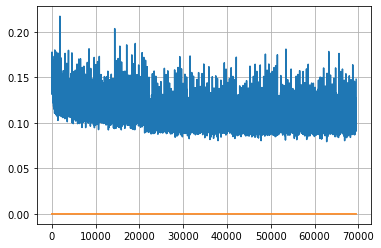

Epoch: 179, iteration 0, loss 0.10090219974517822, cov_diff 0.4104625266015882 cov_diff train 0.40961615721407363
Epoch: 179, iteration 1, loss 0.10308048129081726, cov_diff 0.433911698469963 cov_diff train 0.43366936901553116
Epoch: 179, iteration 2, loss 0.10305947065353394, cov_diff 0.42044317421010763 cov_diff train 0.41993214864102923
Epoch: 179, iteration 3, loss 0.10253947973251343, cov_diff 0.4077127332896284 cov_diff train 0.4074223534302116
Epoch: 179, iteration 4, loss 0.11184367537498474, cov_diff 0.4187866515124219 cov_diff train 0.4185709111899116
Epoch: 179, iteration 5, loss 0.10604867339134216, cov_diff 0.4173817991129273 cov_diff train 0.41725097673022066
Epoch: 179, iteration 6, loss 0.11137053370475769, cov_diff 0.4165997024466854 cov_diff train 0.41577825426879045
Epoch: 179, iteration 7, loss 0.096514493227005, cov_diff 0.4204457425773373 cov_diff train 0.41943103679703353
Epoch: 179, iteration 8, loss 0.09353512525558472, cov_diff 0.4247072416445252 cov_diff trai

Epoch: 179, iteration 72, loss 0.11053583025932312, cov_diff 0.4211121039971697 cov_diff train 0.420664362200408
Epoch: 179, iteration 73, loss 0.09636113047599792, cov_diff 0.41786618482373 cov_diff train 0.417475583289628
Epoch: 179, iteration 74, loss 0.11452457308769226, cov_diff 0.4250490266473186 cov_diff train 0.4244794086156292
Epoch: 179, iteration 75, loss 0.10626953840255737, cov_diff 0.4223409412759283 cov_diff train 0.42172565792288536
Epoch: 179, iteration 76, loss 0.1085883378982544, cov_diff 0.4263905655092984 cov_diff train 0.4258534038466323
Epoch: 179, iteration 77, loss 0.11384758353233337, cov_diff 0.41814683925777074 cov_diff train 0.41704181026040366
Epoch: 179, iteration 78, loss 0.09813743829727173, cov_diff 0.41795638587564393 cov_diff train 0.41643256141918883
Epoch: 179, iteration 79, loss 0.1076144278049469, cov_diff 0.4182600236083217 cov_diff train 0.41639245791907853
Epoch: 179, iteration 80, loss 0.10706213116645813, cov_diff 0.42552333984583196 cov_dif

Epoch: 179, iteration 154, loss 0.09153544902801514, cov_diff 0.40551094657751546 cov_diff train 0.40479354570006454
Epoch: 179, iteration 155, loss 0.09899625182151794, cov_diff 0.40544614735312 cov_diff train 0.4046458229970422
Epoch: 179, iteration 156, loss 0.10784110426902771, cov_diff 0.4126496159083242 cov_diff train 0.41125074757718016
Epoch: 179, iteration 157, loss 0.11249977350234985, cov_diff 0.41515932509508263 cov_diff train 0.41462832704468866
Epoch: 179, iteration 158, loss 0.0999884307384491, cov_diff 0.3985121950742755 cov_diff train 0.39820075369155666
Epoch: 179, iteration 159, loss 0.10705223679542542, cov_diff 0.4075116007341806 cov_diff train 0.40734731539563324
Epoch: 179, iteration 160, loss 0.09711110591888428, cov_diff 0.4170207778100757 cov_diff train 0.4162966453222555
Epoch: 179, iteration 161, loss 0.09872233867645264, cov_diff 0.4160703948960469 cov_diff train 0.4161526069360094
Epoch: 179, iteration 162, loss 0.1027458906173706, cov_diff 0.4153975771561

Epoch: 179, iteration 230, loss 0.09033170342445374, cov_diff 0.4039892565407102 cov_diff train 0.40395541381438754
Epoch: 179, iteration 231, loss 0.11448967456817627, cov_diff 0.41913472190658835 cov_diff train 0.4178304828407882
Epoch: 179, iteration 232, loss 0.11219361424446106, cov_diff 0.42479724296382876 cov_diff train 0.42460196139581263
Epoch: 179, iteration 233, loss 0.10563144087791443, cov_diff 0.4193525687076392 cov_diff train 0.41858079555835054
Epoch: 179, iteration 234, loss 0.09448125958442688, cov_diff 0.4235304028295453 cov_diff train 0.4230379983476012
Epoch: 179, iteration 235, loss 0.10361716151237488, cov_diff 0.4109902468755431 cov_diff train 0.41083061678815036
Epoch: 179, iteration 236, loss 0.09928855299949646, cov_diff 0.40546750767271134 cov_diff train 0.40489134994735976
Epoch: 179, iteration 237, loss 0.09707832336425781, cov_diff 0.40713533735366825 cov_diff train 0.4063209057853908
Epoch: 179, iteration 238, loss 0.10472849011421204, cov_diff 0.4018857

Epoch: 179, iteration 307, loss 0.11280658841133118, cov_diff 0.4180242779888492 cov_diff train 0.41741345272980485
Epoch: 179, iteration 308, loss 0.10348159074783325, cov_diff 0.4186756709051698 cov_diff train 0.4178224748798559
Epoch: 179, iteration 309, loss 0.09643802046775818, cov_diff 0.41174449153815434 cov_diff train 0.41135746356719
Epoch: 179, iteration 310, loss 0.10429349541664124, cov_diff 0.41411706837673157 cov_diff train 0.41375486953456114
Epoch: 179, iteration 311, loss 0.11712256073951721, cov_diff 0.40835178075960005 cov_diff train 0.4077847917162618
Epoch: 179, iteration 312, loss 0.10357782244682312, cov_diff 0.4285270207030295 cov_diff train 0.42743370132737624
Epoch: 179, iteration 313, loss 0.10721784830093384, cov_diff 0.414050431447558 cov_diff train 0.4139012001120191
Epoch: 179, iteration 314, loss 0.10090163350105286, cov_diff 0.41110397994840564 cov_diff train 0.41022765736886446
Epoch: 179, iteration 315, loss 0.11304271221160889, cov_diff 0.42386497316

Epoch: 179, iteration 385, loss 0.10966792702674866, cov_diff 0.41106795906687943 cov_diff train 0.4093193858368005
Epoch: 179, iteration 386, loss 0.1050252914428711, cov_diff 0.4270658977717203 cov_diff train 0.4256321685334249
Epoch: 179, iteration 387, loss 0.10641169548034668, cov_diff 0.4205916884457749 cov_diff train 0.4195885797599249
Epoch: 179, iteration 388, loss 0.10177800059318542, cov_diff 0.40797047360294286 cov_diff train 0.4075396592408468
Epoch: 179, iteration 389, loss 0.1199435293674469, cov_diff 0.4240376607183834 cov_diff train 0.4242824332784537
Epoch: 179, iteration 390, loss 0.1610907018184662, cov_diff 0.46510595725861964 cov_diff train 0.4646359807535582


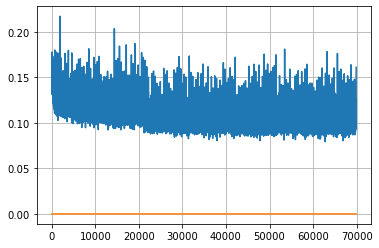

Epoch: 180, iteration 0, loss 0.10412344336509705, cov_diff 0.41691505042830246 cov_diff train 0.4165173838198142
Epoch: 180, iteration 1, loss 0.10782843828201294, cov_diff 0.41499253485854926 cov_diff train 0.4147477755885475
Epoch: 180, iteration 2, loss 0.10338965058326721, cov_diff 0.41714802537688234 cov_diff train 0.41707274746569895
Epoch: 180, iteration 3, loss 0.10846817493438721, cov_diff 0.41275346303326677 cov_diff train 0.41214047348259797
Epoch: 180, iteration 4, loss 0.0984298586845398, cov_diff 0.40481194762987743 cov_diff train 0.404923501408229
Epoch: 180, iteration 5, loss 0.10918253660202026, cov_diff 0.4177202802288622 cov_diff train 0.41714694880640735
Epoch: 180, iteration 6, loss 0.10960423946380615, cov_diff 0.4155680762002829 cov_diff train 0.4151849256216147
Epoch: 180, iteration 7, loss 0.10478329658508301, cov_diff 0.41809265772950416 cov_diff train 0.4170926520311405
Epoch: 180, iteration 8, loss 0.10165023803710938, cov_diff 0.405395480554779 cov_diff tr

Epoch: 180, iteration 72, loss 0.09696748852729797, cov_diff 0.40466054999122486 cov_diff train 0.4041623014891849
Epoch: 180, iteration 73, loss 0.1092204749584198, cov_diff 0.41485051136054757 cov_diff train 0.4131366968059207
Epoch: 180, iteration 74, loss 0.09590193629264832, cov_diff 0.39929690752558816 cov_diff train 0.39864481871170865
Epoch: 180, iteration 75, loss 0.12082430720329285, cov_diff 0.40870673431512666 cov_diff train 0.40871515597369573
Epoch: 180, iteration 76, loss 0.09030929207801819, cov_diff 0.3973959177996109 cov_diff train 0.39705626296301133
Epoch: 180, iteration 77, loss 0.09950196743011475, cov_diff 0.3980780441801423 cov_diff train 0.3974193495728601
Epoch: 180, iteration 78, loss 0.0980086624622345, cov_diff 0.4271233319704157 cov_diff train 0.42578773486267185
Epoch: 180, iteration 79, loss 0.09404200315475464, cov_diff 0.42117853036291697 cov_diff train 0.4201129027972844
Epoch: 180, iteration 80, loss 0.0918976366519928, cov_diff 0.41426953980916914 c

Epoch: 180, iteration 144, loss 0.1103784441947937, cov_diff 0.4221537875967642 cov_diff train 0.42198506787989776
Epoch: 180, iteration 145, loss 0.09086737036705017, cov_diff 0.4106960817910929 cov_diff train 0.41018210678320133
Epoch: 180, iteration 146, loss 0.10593608021736145, cov_diff 0.4097018955322066 cov_diff train 0.4101835084515085
Epoch: 180, iteration 147, loss 0.10857036709785461, cov_diff 0.41889604527751284 cov_diff train 0.41797825526762966
Epoch: 180, iteration 148, loss 0.10853001475334167, cov_diff 0.4081205186619641 cov_diff train 0.40816610869934583
Epoch: 180, iteration 149, loss 0.1119585633277893, cov_diff 0.41495880774672184 cov_diff train 0.41449956209084665
Epoch: 180, iteration 150, loss 0.09881126880645752, cov_diff 0.4028060215448699 cov_diff train 0.4032182425530891
Epoch: 180, iteration 151, loss 0.12537983059883118, cov_diff 0.4254769888073271 cov_diff train 0.42478189741726885
Epoch: 180, iteration 152, loss 0.1079525351524353, cov_diff 0.41453880941

Epoch: 180, iteration 219, loss 0.09627330303192139, cov_diff 0.41301952329736946 cov_diff train 0.41211817400345796
Epoch: 180, iteration 220, loss 0.09058797359466553, cov_diff 0.413703868277292 cov_diff train 0.41362785632761934
Epoch: 180, iteration 221, loss 0.1033620536327362, cov_diff 0.4253523409134722 cov_diff train 0.4249323902609307
Epoch: 180, iteration 222, loss 0.09866642951965332, cov_diff 0.4125155340791099 cov_diff train 0.4117813333896601
Epoch: 180, iteration 223, loss 0.10182929039001465, cov_diff 0.4207949266000668 cov_diff train 0.4201036738795392
Epoch: 180, iteration 224, loss 0.0993313193321228, cov_diff 0.41311767075580436 cov_diff train 0.4108252596144387
Epoch: 180, iteration 225, loss 0.1098359227180481, cov_diff 0.4231705740955671 cov_diff train 0.4220318194865677
Epoch: 180, iteration 226, loss 0.10502034425735474, cov_diff 0.4190135089288322 cov_diff train 0.41852951661025206
Epoch: 180, iteration 227, loss 0.10733020305633545, cov_diff 0.415589827452598

Epoch: 180, iteration 292, loss 0.10551014542579651, cov_diff 0.42778203259924785 cov_diff train 0.42686247275618255
Epoch: 180, iteration 293, loss 0.10009893774986267, cov_diff 0.4307503733593711 cov_diff train 0.42952750852868626
Epoch: 180, iteration 294, loss 0.09924274682998657, cov_diff 0.4089306814003756 cov_diff train 0.408266047265084
Epoch: 180, iteration 295, loss 0.08904129266738892, cov_diff 0.40731915204777835 cov_diff train 0.406284680714771
Epoch: 180, iteration 296, loss 0.10405513644218445, cov_diff 0.4058589578112078 cov_diff train 0.40486755922016543
Epoch: 180, iteration 297, loss 0.11562350392341614, cov_diff 0.4332547379371093 cov_diff train 0.4319826449955955
Epoch: 180, iteration 298, loss 0.10355207324028015, cov_diff 0.3943386669257629 cov_diff train 0.3938966948163765
Epoch: 180, iteration 299, loss 0.09595826268196106, cov_diff 0.41216807334971056 cov_diff train 0.4120500158775176
Epoch: 180, iteration 300, loss 0.09536737203598022, cov_diff 0.416455016274

Epoch: 180, iteration 370, loss 0.10176399350166321, cov_diff 0.4240481803816925 cov_diff train 0.4230053664790338
Epoch: 180, iteration 371, loss 0.10048440098762512, cov_diff 0.41178769390244135 cov_diff train 0.4108367149281163
Epoch: 180, iteration 372, loss 0.09389898180961609, cov_diff 0.4135156465291204 cov_diff train 0.41198598928422603
Epoch: 180, iteration 373, loss 0.1089451014995575, cov_diff 0.4207379476020278 cov_diff train 0.4196957526266945
Epoch: 180, iteration 374, loss 0.10167145729064941, cov_diff 0.4210943968435443 cov_diff train 0.42156694534500605
Epoch: 180, iteration 375, loss 0.11467179656028748, cov_diff 0.4111289966858576 cov_diff train 0.4100179137810185
Epoch: 180, iteration 376, loss 0.09204921126365662, cov_diff 0.4082378033555374 cov_diff train 0.40755961258300416
Epoch: 180, iteration 377, loss 0.10432988405227661, cov_diff 0.404487314157486 cov_diff train 0.4043393355244449
Epoch: 180, iteration 378, loss 0.10905766487121582, cov_diff 0.42770203427447

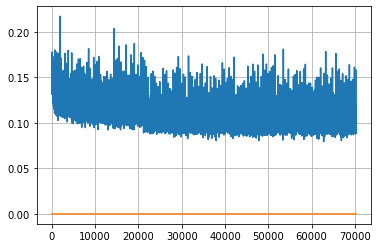

Epoch: 181, iteration 0, loss 0.10856583714485168, cov_diff 0.4153227934509085 cov_diff train 0.41515160794264006
Epoch: 181, iteration 1, loss 0.11013045907020569, cov_diff 0.41553969604837554 cov_diff train 0.41539270815733864
Epoch: 181, iteration 2, loss 0.10890784859657288, cov_diff 0.42895164450940093 cov_diff train 0.42862462667425183
Epoch: 181, iteration 3, loss 0.11274459958076477, cov_diff 0.4200776809781626 cov_diff train 0.41959216488011253
Epoch: 181, iteration 4, loss 0.10995844006538391, cov_diff 0.4011458002762392 cov_diff train 0.4014428254914623
Epoch: 181, iteration 5, loss 0.10590371489524841, cov_diff 0.42296881587414664 cov_diff train 0.42332034014512915
Epoch: 181, iteration 6, loss 0.10405001044273376, cov_diff 0.41699864843431866 cov_diff train 0.4170373988592317
Epoch: 181, iteration 7, loss 0.09825277328491211, cov_diff 0.4235123322209833 cov_diff train 0.4230741012000648
Epoch: 181, iteration 8, loss 0.11224904656410217, cov_diff 0.4194187422334479 cov_diff

Epoch: 181, iteration 78, loss 0.1031542718410492, cov_diff 0.4157608008821678 cov_diff train 0.4150272823047606
Epoch: 181, iteration 79, loss 0.10490256547927856, cov_diff 0.40857942135123043 cov_diff train 0.40845381813713993
Epoch: 181, iteration 80, loss 0.1154126524925232, cov_diff 0.4328137641389611 cov_diff train 0.4321515959608391
Epoch: 181, iteration 81, loss 0.11130374670028687, cov_diff 0.4230998050279134 cov_diff train 0.4223569425277392
Epoch: 181, iteration 82, loss 0.09379595518112183, cov_diff 0.4063458084354391 cov_diff train 0.4058507451959884
Epoch: 181, iteration 83, loss 0.09922704100608826, cov_diff 0.4293958728901557 cov_diff train 0.4285633632258473
Epoch: 181, iteration 84, loss 0.11262032389640808, cov_diff 0.41833351583391687 cov_diff train 0.4178332884546869
Epoch: 181, iteration 85, loss 0.10943916440010071, cov_diff 0.4100896877324727 cov_diff train 0.40890284541046995
Epoch: 181, iteration 86, loss 0.10494443774223328, cov_diff 0.42007090965877353 cov_d

Epoch: 181, iteration 151, loss 0.11500433087348938, cov_diff 0.41108385276347825 cov_diff train 0.410089408543796
Epoch: 181, iteration 152, loss 0.10128724575042725, cov_diff 0.4181762347662396 cov_diff train 0.4176991908138266
Epoch: 181, iteration 153, loss 0.10196241736412048, cov_diff 0.4039229205410157 cov_diff train 0.4038990860991648
Epoch: 181, iteration 154, loss 0.10876357555389404, cov_diff 0.4368007515626821 cov_diff train 0.43599204492825133
Epoch: 181, iteration 155, loss 0.10531887412071228, cov_diff 0.4181985397270664 cov_diff train 0.41681238177905283
Epoch: 181, iteration 156, loss 0.1077762246131897, cov_diff 0.4131505187140058 cov_diff train 0.411871809893186
Epoch: 181, iteration 157, loss 0.10722488164901733, cov_diff 0.41645989672749545 cov_diff train 0.4150276816060175
Epoch: 181, iteration 158, loss 0.10268712043762207, cov_diff 0.4121279498556466 cov_diff train 0.410955539246812
Epoch: 181, iteration 159, loss 0.10324704647064209, cov_diff 0.4189215978757332

Epoch: 181, iteration 225, loss 0.11071819067001343, cov_diff 0.4124522244640505 cov_diff train 0.412080880419953
Epoch: 181, iteration 226, loss 0.10871285200119019, cov_diff 0.421444618712149 cov_diff train 0.42056526384782744
Epoch: 181, iteration 227, loss 0.10674473643302917, cov_diff 0.4184260605243076 cov_diff train 0.41729344332766977
Epoch: 181, iteration 228, loss 0.10762780904769897, cov_diff 0.41160588238442436 cov_diff train 0.41046883679794927
Epoch: 181, iteration 229, loss 0.10083818435668945, cov_diff 0.41823056142660886 cov_diff train 0.4182577105613171
Epoch: 181, iteration 230, loss 0.10147342085838318, cov_diff 0.4086074968545356 cov_diff train 0.40794338251205003
Epoch: 181, iteration 231, loss 0.10651373863220215, cov_diff 0.4127788910994714 cov_diff train 0.41181263768850307
Epoch: 181, iteration 232, loss 0.0963083803653717, cov_diff 0.4196000358647345 cov_diff train 0.4184140980140405
Epoch: 181, iteration 233, loss 0.09835407137870789, cov_diff 0.421417234098

Epoch: 181, iteration 304, loss 0.10362845659255981, cov_diff 0.418300888485866 cov_diff train 0.41767019865318294
Epoch: 181, iteration 305, loss 0.10882753133773804, cov_diff 0.4324441027859212 cov_diff train 0.4324734101229498
Epoch: 181, iteration 306, loss 0.10139229893684387, cov_diff 0.4232504898794626 cov_diff train 0.4224416249558246
Epoch: 181, iteration 307, loss 0.10729050636291504, cov_diff 0.4227635123385509 cov_diff train 0.4227461666105605
Epoch: 181, iteration 308, loss 0.1024537980556488, cov_diff 0.4103601581079787 cov_diff train 0.4102229690417067
Epoch: 181, iteration 309, loss 0.10581323504447937, cov_diff 0.42431606586499987 cov_diff train 0.4236075988086121
Epoch: 181, iteration 310, loss 0.10617285966873169, cov_diff 0.41752373476649574 cov_diff train 0.4175450459026286
Epoch: 181, iteration 311, loss 0.10230308771133423, cov_diff 0.42121122421128265 cov_diff train 0.4203804719645365
Epoch: 181, iteration 312, loss 0.10850688815116882, cov_diff 0.42923971495258

Epoch: 181, iteration 380, loss 0.10247740149497986, cov_diff 0.41195590679996485 cov_diff train 0.4109615501469511
Epoch: 181, iteration 381, loss 0.10194677114486694, cov_diff 0.4304275914345207 cov_diff train 0.4297164038160455
Epoch: 181, iteration 382, loss 0.10552322864532471, cov_diff 0.4196010982492239 cov_diff train 0.41923970383354864
Epoch: 181, iteration 383, loss 0.10605049133300781, cov_diff 0.42146215066274684 cov_diff train 0.4211132931305666
Epoch: 181, iteration 384, loss 0.10202163457870483, cov_diff 0.41334664097100854 cov_diff train 0.4125479216247248
Epoch: 181, iteration 385, loss 0.1203661561012268, cov_diff 0.42201302453949585 cov_diff train 0.42233706562749035
Epoch: 181, iteration 386, loss 0.09918621182441711, cov_diff 0.41119899727970005 cov_diff train 0.41034459417502805
Epoch: 181, iteration 387, loss 0.11394745111465454, cov_diff 0.4325802435004257 cov_diff train 0.4315147560658492
Epoch: 181, iteration 388, loss 0.10408011078834534, cov_diff 0.398466002

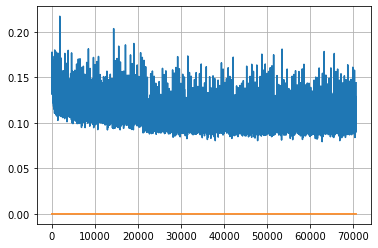

Epoch: 182, iteration 0, loss 0.10725963115692139, cov_diff 0.412329085381422 cov_diff train 0.4123324421455654
Epoch: 182, iteration 1, loss 0.10443639755249023, cov_diff 0.4072304068870372 cov_diff train 0.40652547925500704
Epoch: 182, iteration 2, loss 0.10262972116470337, cov_diff 0.4044885571323608 cov_diff train 0.4038852117751648
Epoch: 182, iteration 3, loss 0.11183232069015503, cov_diff 0.41068943669304453 cov_diff train 0.40963536524452465
Epoch: 182, iteration 4, loss 0.10452419519424438, cov_diff 0.4154930294947176 cov_diff train 0.414805760161235
Epoch: 182, iteration 5, loss 0.10437321662902832, cov_diff 0.41313965657383217 cov_diff train 0.413324305849609
Epoch: 182, iteration 6, loss 0.10507506132125854, cov_diff 0.40868035677086106 cov_diff train 0.40813062169633835
Epoch: 182, iteration 7, loss 0.11307752132415771, cov_diff 0.41681820309750356 cov_diff train 0.41618170019448064
Epoch: 182, iteration 8, loss 0.1064985990524292, cov_diff 0.41372878074241004 cov_diff tra

Epoch: 182, iteration 79, loss 0.10420763492584229, cov_diff 0.4141155146625324 cov_diff train 0.41290298343821646
Epoch: 182, iteration 80, loss 0.1043119728565216, cov_diff 0.41492363227702983 cov_diff train 0.41382661042040353
Epoch: 182, iteration 81, loss 0.10698488354682922, cov_diff 0.4159682555371512 cov_diff train 0.41598805261878546
Epoch: 182, iteration 82, loss 0.0965997576713562, cov_diff 0.4096846820694296 cov_diff train 0.40945026994473066
Epoch: 182, iteration 83, loss 0.09541323781013489, cov_diff 0.421071825515263 cov_diff train 0.4206501131699207
Epoch: 182, iteration 84, loss 0.11358052492141724, cov_diff 0.4038288767261462 cov_diff train 0.40356314308859453
Epoch: 182, iteration 85, loss 0.11241495609283447, cov_diff 0.41015192579785437 cov_diff train 0.4092283860153649
Epoch: 182, iteration 86, loss 0.10415476560592651, cov_diff 0.43065071894492546 cov_diff train 0.42958776373810126
Epoch: 182, iteration 87, loss 0.10945212841033936, cov_diff 0.43855099219293425 c

Epoch: 182, iteration 150, loss 0.1005566418170929, cov_diff 0.41866084322239044 cov_diff train 0.41861004037565036
Epoch: 182, iteration 151, loss 0.10149723291397095, cov_diff 0.4206630101074124 cov_diff train 0.4205753624306072
Epoch: 182, iteration 152, loss 0.11380061507225037, cov_diff 0.4251024538869784 cov_diff train 0.4244615850221586
Epoch: 182, iteration 153, loss 0.09984579682350159, cov_diff 0.4212631552151889 cov_diff train 0.4193624351570452
Epoch: 182, iteration 154, loss 0.10502424836158752, cov_diff 0.4048428779597096 cov_diff train 0.4039642811626785
Epoch: 182, iteration 155, loss 0.0966610312461853, cov_diff 0.42092328741436075 cov_diff train 0.4197202024763721
Epoch: 182, iteration 156, loss 0.09824523329734802, cov_diff 0.42604893540363414 cov_diff train 0.42548270394781357
Epoch: 182, iteration 157, loss 0.10644924640655518, cov_diff 0.4210513317635708 cov_diff train 0.4212071926139965
Epoch: 182, iteration 158, loss 0.0982733964920044, cov_diff 0.41941327765301

Epoch: 182, iteration 221, loss 0.0954122543334961, cov_diff 0.4176660642389154 cov_diff train 0.416395922359936
Epoch: 182, iteration 222, loss 0.10954827070236206, cov_diff 0.41487639205062465 cov_diff train 0.41363022841422925
Epoch: 182, iteration 223, loss 0.11430218815803528, cov_diff 0.41696299843859 cov_diff train 0.41618690545164966
Epoch: 182, iteration 224, loss 0.10012051463127136, cov_diff 0.41689485177343777 cov_diff train 0.4161904036404676
Epoch: 182, iteration 225, loss 0.100849449634552, cov_diff 0.4164702243285408 cov_diff train 0.4158165551700925
Epoch: 182, iteration 226, loss 0.09812569618225098, cov_diff 0.4027312159280266 cov_diff train 0.4021347212004983
Epoch: 182, iteration 227, loss 0.10170039534568787, cov_diff 0.4025428802123029 cov_diff train 0.40260808284782756
Epoch: 182, iteration 228, loss 0.10349160432815552, cov_diff 0.4083814870667549 cov_diff train 0.40774986529126583
Epoch: 182, iteration 229, loss 0.10695722699165344, cov_diff 0.4054009576572397

Epoch: 182, iteration 298, loss 0.1099996566772461, cov_diff 0.40462898937111846 cov_diff train 0.4038167671837957
Epoch: 182, iteration 299, loss 0.10467201471328735, cov_diff 0.4243515222128224 cov_diff train 0.42401469042349305
Epoch: 182, iteration 300, loss 0.10364854335784912, cov_diff 0.4182451611572343 cov_diff train 0.4171601701044826
Epoch: 182, iteration 301, loss 0.09591862559318542, cov_diff 0.4296919012407645 cov_diff train 0.42911253722396153
Epoch: 182, iteration 302, loss 0.11644697189331055, cov_diff 0.42625136270919123 cov_diff train 0.4252905950830333
Epoch: 182, iteration 303, loss 0.11116796731948853, cov_diff 0.4221091353909902 cov_diff train 0.420994939367872
Epoch: 182, iteration 304, loss 0.1099395751953125, cov_diff 0.41907087482586547 cov_diff train 0.4187258100412171
Epoch: 182, iteration 305, loss 0.09355482459068298, cov_diff 0.41674723225935845 cov_diff train 0.41531895074637787
Epoch: 182, iteration 306, loss 0.11170259118080139, cov_diff 0.415533725851

Epoch: 182, iteration 370, loss 0.09916877746582031, cov_diff 0.41359341253832893 cov_diff train 0.41311106940818004
Epoch: 182, iteration 371, loss 0.10216569900512695, cov_diff 0.4187413637033511 cov_diff train 0.4182424229975348
Epoch: 182, iteration 372, loss 0.11136844754219055, cov_diff 0.40234660099689307 cov_diff train 0.4014483753091413
Epoch: 182, iteration 373, loss 0.10195168852806091, cov_diff 0.4161094141875719 cov_diff train 0.4162469694694011
Epoch: 182, iteration 374, loss 0.12126374244689941, cov_diff 0.41575503358926547 cov_diff train 0.4152845336279901
Epoch: 182, iteration 375, loss 0.10987189412117004, cov_diff 0.4178678329035629 cov_diff train 0.4177062247481579
Epoch: 182, iteration 376, loss 0.10050800442695618, cov_diff 0.41073716631096624 cov_diff train 0.41061303203824817
Epoch: 182, iteration 377, loss 0.10663476586341858, cov_diff 0.4123938337501219 cov_diff train 0.41213381705862306
Epoch: 182, iteration 378, loss 0.11151328682899475, cov_diff 0.414547620

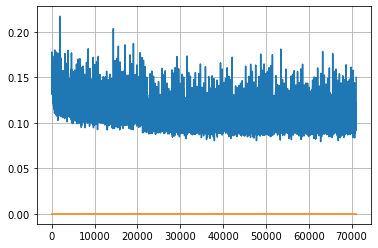

Epoch: 183, iteration 0, loss 0.10182079672813416, cov_diff 0.42985848401175586 cov_diff train 0.42888558147756933
Epoch: 183, iteration 1, loss 0.09194764494895935, cov_diff 0.4110845073434002 cov_diff train 0.41047907167376313
Epoch: 183, iteration 2, loss 0.11166220903396606, cov_diff 0.4318243164850932 cov_diff train 0.4317418814631684
Epoch: 183, iteration 3, loss 0.11066669225692749, cov_diff 0.42632679207465396 cov_diff train 0.4260045513260792
Epoch: 183, iteration 4, loss 0.09956362843513489, cov_diff 0.4159925928186359 cov_diff train 0.41579211962743173
Epoch: 183, iteration 5, loss 0.0983613133430481, cov_diff 0.41394850570654385 cov_diff train 0.41337494428462895
Epoch: 183, iteration 6, loss 0.12552082538604736, cov_diff 0.40398991207743756 cov_diff train 0.40324875038207614
Epoch: 183, iteration 7, loss 0.10440358519554138, cov_diff 0.42798813028986477 cov_diff train 0.4270113011058687
Epoch: 183, iteration 8, loss 0.10848584771156311, cov_diff 0.42010717383979984 cov_dif

Epoch: 183, iteration 75, loss 0.1082441508769989, cov_diff 0.4188849404983462 cov_diff train 0.41797792018534347
Epoch: 183, iteration 76, loss 0.09883913397789001, cov_diff 0.4064818752016641 cov_diff train 0.40573833145579224
Epoch: 183, iteration 77, loss 0.09529536962509155, cov_diff 0.4158831369917231 cov_diff train 0.4151749000395503
Epoch: 183, iteration 78, loss 0.08750161528587341, cov_diff 0.4091538675808518 cov_diff train 0.40882906523093154
Epoch: 183, iteration 79, loss 0.0937834084033966, cov_diff 0.4119755325839071 cov_diff train 0.4118924444545
Epoch: 183, iteration 80, loss 0.10456028580665588, cov_diff 0.4166105351267087 cov_diff train 0.4156360740849669
Epoch: 183, iteration 81, loss 0.09110492467880249, cov_diff 0.4157789790743765 cov_diff train 0.41554245228171965
Epoch: 183, iteration 82, loss 0.10121971368789673, cov_diff 0.4248581987862674 cov_diff train 0.42402582441087894
Epoch: 183, iteration 83, loss 0.09888151288032532, cov_diff 0.4138552509249802 cov_diff

Epoch: 183, iteration 151, loss 0.0994308590888977, cov_diff 0.40911456536313257 cov_diff train 0.4076487894118451
Epoch: 183, iteration 152, loss 0.11220556497573853, cov_diff 0.4147940833453614 cov_diff train 0.4145349494458344
Epoch: 183, iteration 153, loss 0.10382238030433655, cov_diff 0.4174566375026773 cov_diff train 0.41779568077675494
Epoch: 183, iteration 154, loss 0.10935339331626892, cov_diff 0.42154626841929593 cov_diff train 0.4213427374306115
Epoch: 183, iteration 155, loss 0.11366596817970276, cov_diff 0.4219309498897378 cov_diff train 0.4214373311708273
Epoch: 183, iteration 156, loss 0.10006403923034668, cov_diff 0.4133208312347141 cov_diff train 0.4135209450393136
Epoch: 183, iteration 157, loss 0.09590524435043335, cov_diff 0.402406862387696 cov_diff train 0.40183238664770843
Epoch: 183, iteration 158, loss 0.10959780216217041, cov_diff 0.41942023698087266 cov_diff train 0.4184381459340475
Epoch: 183, iteration 159, loss 0.10597211122512817, cov_diff 0.4163285421926

Epoch: 183, iteration 228, loss 0.1045917272567749, cov_diff 0.4151476673026584 cov_diff train 0.4147575973712282
Epoch: 183, iteration 229, loss 0.10875874757766724, cov_diff 0.4097375152747981 cov_diff train 0.40988917632198213
Epoch: 183, iteration 230, loss 0.0999896228313446, cov_diff 0.40788866088938136 cov_diff train 0.4081874303344219
Epoch: 183, iteration 231, loss 0.1089593768119812, cov_diff 0.4074899094993315 cov_diff train 0.4064407206616595
Epoch: 183, iteration 232, loss 0.10638594627380371, cov_diff 0.41121932548076234 cov_diff train 0.410328850717163
Epoch: 183, iteration 233, loss 0.09981513023376465, cov_diff 0.4094666022046121 cov_diff train 0.4094369475831551
Epoch: 183, iteration 234, loss 0.11438453197479248, cov_diff 0.4191244021222268 cov_diff train 0.41850157292410356
Epoch: 183, iteration 235, loss 0.11382153630256653, cov_diff 0.4175669869558346 cov_diff train 0.41577011683648607
Epoch: 183, iteration 236, loss 0.10676330327987671, cov_diff 0.415748935622720

Epoch: 183, iteration 302, loss 0.0905187726020813, cov_diff 0.41482965225056023 cov_diff train 0.4146925198186745
Epoch: 183, iteration 303, loss 0.09590190649032593, cov_diff 0.42298121168227076 cov_diff train 0.42172031977561286
Epoch: 183, iteration 304, loss 0.10744690895080566, cov_diff 0.4124883012694694 cov_diff train 0.41215671158873773
Epoch: 183, iteration 305, loss 0.10589489340782166, cov_diff 0.42140777007102403 cov_diff train 0.42100259806740736
Epoch: 183, iteration 306, loss 0.09884002804756165, cov_diff 0.4011510865101708 cov_diff train 0.40067314807588517
Epoch: 183, iteration 307, loss 0.10377851128578186, cov_diff 0.4234522249300816 cov_diff train 0.42236291153019934
Epoch: 183, iteration 308, loss 0.10382893681526184, cov_diff 0.4090839565270797 cov_diff train 0.4091440536867436
Epoch: 183, iteration 309, loss 0.11267450451850891, cov_diff 0.4028119257045986 cov_diff train 0.40169040743626405
Epoch: 183, iteration 310, loss 0.12389108538627625, cov_diff 0.42631070

Epoch: 183, iteration 380, loss 0.10814404487609863, cov_diff 0.4153512752316254 cov_diff train 0.41400680140637697
Epoch: 183, iteration 381, loss 0.09628203511238098, cov_diff 0.419756050827931 cov_diff train 0.41850644946251137
Epoch: 183, iteration 382, loss 0.10743439197540283, cov_diff 0.40772660961264606 cov_diff train 0.4072979660219425
Epoch: 183, iteration 383, loss 0.09668862819671631, cov_diff 0.4269152281349183 cov_diff train 0.4267999576567294
Epoch: 183, iteration 384, loss 0.11336818337440491, cov_diff 0.42387240818122984 cov_diff train 0.4235290540197998
Epoch: 183, iteration 385, loss 0.09980395436286926, cov_diff 0.41680148688492363 cov_diff train 0.4157078085938889
Epoch: 183, iteration 386, loss 0.1069384515285492, cov_diff 0.41071683385103086 cov_diff train 0.40864661104456707
Epoch: 183, iteration 387, loss 0.09938153624534607, cov_diff 0.4159147943093039 cov_diff train 0.41487749910413885
Epoch: 183, iteration 388, loss 0.10574433207511902, cov_diff 0.4202036310

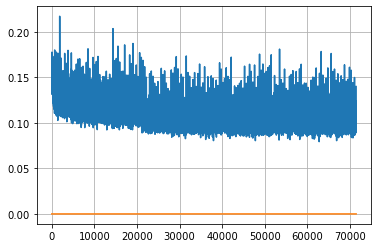

Epoch: 184, iteration 0, loss 0.09326896071434021, cov_diff 0.40956475211523186 cov_diff train 0.4084258568742519
Epoch: 184, iteration 1, loss 0.11033007502555847, cov_diff 0.42843000635111433 cov_diff train 0.4272925333015431
Epoch: 184, iteration 2, loss 0.11881914734840393, cov_diff 0.4143971563934396 cov_diff train 0.41356106536564663
Epoch: 184, iteration 3, loss 0.10244286060333252, cov_diff 0.40795515845157926 cov_diff train 0.40800603889065507
Epoch: 184, iteration 4, loss 0.11372515559196472, cov_diff 0.41162083856061965 cov_diff train 0.4110172349546295
Epoch: 184, iteration 5, loss 0.10773542523384094, cov_diff 0.4250096414157242 cov_diff train 0.424565672377777
Epoch: 184, iteration 6, loss 0.10052594542503357, cov_diff 0.4203882051026016 cov_diff train 0.42012465051862685
Epoch: 184, iteration 7, loss 0.09254446625709534, cov_diff 0.4336671763962725 cov_diff train 0.4329527417095174
Epoch: 184, iteration 8, loss 0.09820225834846497, cov_diff 0.4180860983281729 cov_diff tr

Epoch: 184, iteration 73, loss 0.09633734822273254, cov_diff 0.4118639958830956 cov_diff train 0.4110699490611512
Epoch: 184, iteration 74, loss 0.10609903931617737, cov_diff 0.4139915809704351 cov_diff train 0.4123936922180612
Epoch: 184, iteration 75, loss 0.10343796014785767, cov_diff 0.40611261188661474 cov_diff train 0.40525895138050283
Epoch: 184, iteration 76, loss 0.11144846677780151, cov_diff 0.4186025797827817 cov_diff train 0.4180213048882118
Epoch: 184, iteration 77, loss 0.09244763851165771, cov_diff 0.4128532316442714 cov_diff train 0.412721672727806
Epoch: 184, iteration 78, loss 0.11087417602539062, cov_diff 0.4195789280694325 cov_diff train 0.41824654521956045
Epoch: 184, iteration 79, loss 0.10124343633651733, cov_diff 0.41599012133012364 cov_diff train 0.4155637933740287
Epoch: 184, iteration 80, loss 0.11614087224006653, cov_diff 0.4143233153743482 cov_diff train 0.4134019619342631
Epoch: 184, iteration 81, loss 0.09534388780593872, cov_diff 0.40191767932677036 cov_

Epoch: 184, iteration 154, loss 0.11408290266990662, cov_diff 0.42231234801366535 cov_diff train 0.42111369496777307
Epoch: 184, iteration 155, loss 0.10152721405029297, cov_diff 0.4278847711750441 cov_diff train 0.4256814643666209
Epoch: 184, iteration 156, loss 0.10761404037475586, cov_diff 0.4303112729234258 cov_diff train 0.4292642898546396
Epoch: 184, iteration 157, loss 0.09341391921043396, cov_diff 0.4185756065512966 cov_diff train 0.41781423821647046
Epoch: 184, iteration 158, loss 0.09843850135803223, cov_diff 0.40876993033457126 cov_diff train 0.40809131595686077
Epoch: 184, iteration 159, loss 0.1029900312423706, cov_diff 0.4095718178527393 cov_diff train 0.40922667336381885
Epoch: 184, iteration 160, loss 0.10541760921478271, cov_diff 0.41623450115841193 cov_diff train 0.4150368497506875
Epoch: 184, iteration 161, loss 0.10866397619247437, cov_diff 0.4258386501633027 cov_diff train 0.42514412836168436
Epoch: 184, iteration 162, loss 0.12312781810760498, cov_diff 0.428549673

Epoch: 184, iteration 232, loss 0.10318267345428467, cov_diff 0.41975442902005694 cov_diff train 0.4194585326969267
Epoch: 184, iteration 233, loss 0.09808868169784546, cov_diff 0.4285248840104988 cov_diff train 0.42792208997939685
Epoch: 184, iteration 234, loss 0.09920424222946167, cov_diff 0.42391020813261826 cov_diff train 0.4230887894297412
Epoch: 184, iteration 235, loss 0.09867581725120544, cov_diff 0.40788753113392107 cov_diff train 0.40774170587107184
Epoch: 184, iteration 236, loss 0.1148906946182251, cov_diff 0.40889819777871284 cov_diff train 0.4083205391603688
Epoch: 184, iteration 237, loss 0.10575321316719055, cov_diff 0.41889779892761025 cov_diff train 0.41883866823156796
Epoch: 184, iteration 238, loss 0.10091093182563782, cov_diff 0.41739960384178 cov_diff train 0.4168994227146092
Epoch: 184, iteration 239, loss 0.09796839952468872, cov_diff 0.40651052601128823 cov_diff train 0.40594713624844436
Epoch: 184, iteration 240, loss 0.10461756587028503, cov_diff 0.424062898

Epoch: 184, iteration 309, loss 0.10154181718826294, cov_diff 0.4144663733850939 cov_diff train 0.4139579297545532
Epoch: 184, iteration 310, loss 0.10895809531211853, cov_diff 0.41442255407107237 cov_diff train 0.4140461466686897
Epoch: 184, iteration 311, loss 0.10339179635047913, cov_diff 0.40701437246893263 cov_diff train 0.406952594501242
Epoch: 184, iteration 312, loss 0.10830491781234741, cov_diff 0.4150191350373309 cov_diff train 0.41468847685566906
Epoch: 184, iteration 313, loss 0.10780709981918335, cov_diff 0.41328963023474824 cov_diff train 0.41354653471187797
Epoch: 184, iteration 314, loss 0.11083149909973145, cov_diff 0.40330468286033294 cov_diff train 0.4024888786446594
Epoch: 184, iteration 315, loss 0.10474970936775208, cov_diff 0.4255579226684405 cov_diff train 0.4251765698316319
Epoch: 184, iteration 316, loss 0.10547247529029846, cov_diff 0.42223224065682297 cov_diff train 0.42111373112744577
Epoch: 184, iteration 317, loss 0.09945109486579895, cov_diff 0.414055107

Epoch: 184, iteration 386, loss 0.10278281569480896, cov_diff 0.4154709916846445 cov_diff train 0.41486129514381836
Epoch: 184, iteration 387, loss 0.10938909649848938, cov_diff 0.41500257518158745 cov_diff train 0.41342743923643066
Epoch: 184, iteration 388, loss 0.09014755487442017, cov_diff 0.40303676463894567 cov_diff train 0.40213456414925614
Epoch: 184, iteration 389, loss 0.10490459203720093, cov_diff 0.42945144798264545 cov_diff train 0.42817711243179235
Epoch: 184, iteration 390, loss 0.141006201505661, cov_diff 0.44532069581151007 cov_diff train 0.4449026541764293


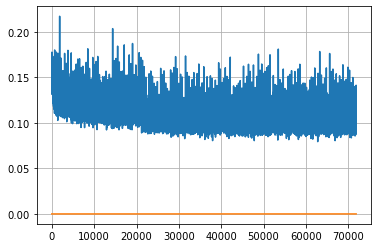

Epoch: 185, iteration 0, loss 0.09936955571174622, cov_diff 0.4144694713764409 cov_diff train 0.41422668672317076
Epoch: 185, iteration 1, loss 0.1120571494102478, cov_diff 0.41566397080461825 cov_diff train 0.4150543847334561
Epoch: 185, iteration 2, loss 0.09352236986160278, cov_diff 0.4210328598982853 cov_diff train 0.4192865491204684
Epoch: 185, iteration 3, loss 0.10089626908302307, cov_diff 0.4181612595631983 cov_diff train 0.4165313193906677
Epoch: 185, iteration 4, loss 0.10899969935417175, cov_diff 0.4079501555044094 cov_diff train 0.4075856837288079
Epoch: 185, iteration 5, loss 0.10356542468070984, cov_diff 0.40846591683276645 cov_diff train 0.40849742831410357
Epoch: 185, iteration 6, loss 0.10204514861106873, cov_diff 0.3925134545054761 cov_diff train 0.3922334259288751
Epoch: 185, iteration 7, loss 0.09665325284004211, cov_diff 0.41915938531821106 cov_diff train 0.4181958909767148
Epoch: 185, iteration 8, loss 0.10503444075584412, cov_diff 0.40669714459062606 cov_diff tra

Epoch: 185, iteration 76, loss 0.11135700345039368, cov_diff 0.4097623207254754 cov_diff train 0.4101985901185187
Epoch: 185, iteration 77, loss 0.10830125212669373, cov_diff 0.4298114974289176 cov_diff train 0.4294959382852202
Epoch: 185, iteration 78, loss 0.10074880719184875, cov_diff 0.3957554127163579 cov_diff train 0.3955267174897112
Epoch: 185, iteration 79, loss 0.10056465864181519, cov_diff 0.4087587681728027 cov_diff train 0.40816007085092815
Epoch: 185, iteration 80, loss 0.10527896881103516, cov_diff 0.40939458966168696 cov_diff train 0.4094520946884537
Epoch: 185, iteration 81, loss 0.0984172523021698, cov_diff 0.40129799081363454 cov_diff train 0.400715594690547
Epoch: 185, iteration 82, loss 0.10168576240539551, cov_diff 0.43591766828049083 cov_diff train 0.4354217937734808
Epoch: 185, iteration 83, loss 0.10149237513542175, cov_diff 0.41993190213372183 cov_diff train 0.41970032643747296
Epoch: 185, iteration 84, loss 0.09940683841705322, cov_diff 0.40979281990906996 cov

Epoch: 185, iteration 150, loss 0.10292860865592957, cov_diff 0.40890288546834014 cov_diff train 0.4078040763603293
Epoch: 185, iteration 151, loss 0.10517275333404541, cov_diff 0.41901651720749206 cov_diff train 0.41747676133047357
Epoch: 185, iteration 152, loss 0.10775813460350037, cov_diff 0.41655648423893094 cov_diff train 0.4168122727947936
Epoch: 185, iteration 153, loss 0.1002802848815918, cov_diff 0.4007469080197153 cov_diff train 0.39902775673796004
Epoch: 185, iteration 154, loss 0.09286323189735413, cov_diff 0.4075411696227371 cov_diff train 0.40649453716538647
Epoch: 185, iteration 155, loss 0.10885736346244812, cov_diff 0.4161655231561982 cov_diff train 0.4144301796201908
Epoch: 185, iteration 156, loss 0.10270333290100098, cov_diff 0.41808877565917574 cov_diff train 0.41721222565273813
Epoch: 185, iteration 157, loss 0.11476719379425049, cov_diff 0.41148413148255497 cov_diff train 0.40989478667563856
Epoch: 185, iteration 158, loss 0.11221635341644287, cov_diff 0.4118175

Epoch: 185, iteration 228, loss 0.10042610764503479, cov_diff 0.4139851701491765 cov_diff train 0.4123397220660643
Epoch: 185, iteration 229, loss 0.1050335168838501, cov_diff 0.41773521243006856 cov_diff train 0.4165615523485257
Epoch: 185, iteration 230, loss 0.10327112674713135, cov_diff 0.4012165338763798 cov_diff train 0.40019200137058986
Epoch: 185, iteration 231, loss 0.10853168368339539, cov_diff 0.4216028621374239 cov_diff train 0.42093497788090545
Epoch: 185, iteration 232, loss 0.11545151472091675, cov_diff 0.41673704824737345 cov_diff train 0.41591913373113676
Epoch: 185, iteration 233, loss 0.09947913885116577, cov_diff 0.4131872580835529 cov_diff train 0.412577528588476
Epoch: 185, iteration 234, loss 0.110963374376297, cov_diff 0.4250824749119802 cov_diff train 0.42452894537961533
Epoch: 185, iteration 235, loss 0.10359349846839905, cov_diff 0.414208169882021 cov_diff train 0.4131310349892668
Epoch: 185, iteration 236, loss 0.09650993347167969, cov_diff 0.426756002345598

Epoch: 185, iteration 302, loss 0.1024501621723175, cov_diff 0.42444494959871265 cov_diff train 0.4248138635530911
Epoch: 185, iteration 303, loss 0.09766039252281189, cov_diff 0.40640922997828033 cov_diff train 0.40599538224964266
Epoch: 185, iteration 304, loss 0.09576854109764099, cov_diff 0.4156731470273015 cov_diff train 0.41516785445083865
Epoch: 185, iteration 305, loss 0.10556930303573608, cov_diff 0.41057152104464406 cov_diff train 0.41055466768549814
Epoch: 185, iteration 306, loss 0.10290545225143433, cov_diff 0.42258643424552783 cov_diff train 0.4221468056205809
Epoch: 185, iteration 307, loss 0.10273531079292297, cov_diff 0.4146306143847492 cov_diff train 0.4135191861014708
Epoch: 185, iteration 308, loss 0.09872928261756897, cov_diff 0.43060543273741836 cov_diff train 0.42989175362360665
Epoch: 185, iteration 309, loss 0.09887146949768066, cov_diff 0.4114992000752888 cov_diff train 0.4113880958984929
Epoch: 185, iteration 310, loss 0.10092774033546448, cov_diff 0.41422496

Epoch: 185, iteration 374, loss 0.10363394021987915, cov_diff 0.41266209979552154 cov_diff train 0.4109206933955174
Epoch: 185, iteration 375, loss 0.09184935688972473, cov_diff 0.41099563347744605 cov_diff train 0.4106932075043915
Epoch: 185, iteration 376, loss 0.11121982336044312, cov_diff 0.41281668780950587 cov_diff train 0.4121706967918108
Epoch: 185, iteration 377, loss 0.09713837504386902, cov_diff 0.4172345211630865 cov_diff train 0.41625504939678726
Epoch: 185, iteration 378, loss 0.10201603174209595, cov_diff 0.40909729958823043 cov_diff train 0.4089323190569075
Epoch: 185, iteration 379, loss 0.09899359941482544, cov_diff 0.4003688155394432 cov_diff train 0.40002952453649215
Epoch: 185, iteration 380, loss 0.10275030136108398, cov_diff 0.41678886089000716 cov_diff train 0.41674705753684244
Epoch: 185, iteration 381, loss 0.10655665397644043, cov_diff 0.4244821106781133 cov_diff train 0.4238359412680449
Epoch: 185, iteration 382, loss 0.1030397117137909, cov_diff 0.412290359

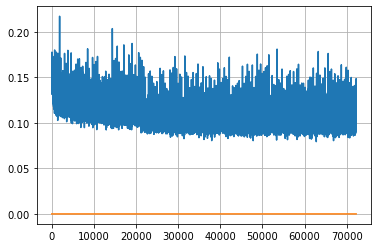

Epoch: 186, iteration 0, loss 0.09769564867019653, cov_diff 0.42648928784381196 cov_diff train 0.4264523028352232
Epoch: 186, iteration 1, loss 0.11001864075660706, cov_diff 0.4143504119564324 cov_diff train 0.4138108960696223
Epoch: 186, iteration 2, loss 0.10691562294960022, cov_diff 0.4290260537833663 cov_diff train 0.4290771231404314
Epoch: 186, iteration 3, loss 0.10648074746131897, cov_diff 0.42348461932231657 cov_diff train 0.42268458442196394
Epoch: 186, iteration 4, loss 0.09456953406333923, cov_diff 0.3985464571360098 cov_diff train 0.397664502013138
Epoch: 186, iteration 5, loss 0.11359280347824097, cov_diff 0.42889824883511124 cov_diff train 0.4284990355822263
Epoch: 186, iteration 6, loss 0.09889066219329834, cov_diff 0.39873052853830326 cov_diff train 0.398070454720399
Epoch: 186, iteration 7, loss 0.09134197235107422, cov_diff 0.4069954545556077 cov_diff train 0.40626967702405675
Epoch: 186, iteration 8, loss 0.1083674430847168, cov_diff 0.41281917684943525 cov_diff trai

Epoch: 186, iteration 74, loss 0.10072839260101318, cov_diff 0.4193132689231516 cov_diff train 0.4193835873760391
Epoch: 186, iteration 75, loss 0.09723073244094849, cov_diff 0.41559427069173277 cov_diff train 0.4152196868085487
Epoch: 186, iteration 76, loss 0.1057397723197937, cov_diff 0.4118124147477598 cov_diff train 0.4103524697618954
Epoch: 186, iteration 77, loss 0.10223129391670227, cov_diff 0.4152688946514091 cov_diff train 0.41477450221937656
Epoch: 186, iteration 78, loss 0.10274767875671387, cov_diff 0.4167211006810278 cov_diff train 0.41579265908774693
Epoch: 186, iteration 79, loss 0.10807490348815918, cov_diff 0.42678478577080753 cov_diff train 0.4262461692827645
Epoch: 186, iteration 80, loss 0.10520371794700623, cov_diff 0.4080232248648928 cov_diff train 0.4074248337739952
Epoch: 186, iteration 81, loss 0.10370409488677979, cov_diff 0.41270208926644036 cov_diff train 0.4128330658094851
Epoch: 186, iteration 82, loss 0.09429740905761719, cov_diff 0.408687841728655 cov_d

Epoch: 186, iteration 155, loss 0.11254212260246277, cov_diff 0.4118041536745403 cov_diff train 0.4107238086904893
Epoch: 186, iteration 156, loss 0.10310369729995728, cov_diff 0.3999985353947678 cov_diff train 0.3994930871710118
Epoch: 186, iteration 157, loss 0.10900381207466125, cov_diff 0.42017867480789817 cov_diff train 0.41945858940097447
Epoch: 186, iteration 158, loss 0.10135498642921448, cov_diff 0.4268488025962709 cov_diff train 0.42547488406394784
Epoch: 186, iteration 159, loss 0.09649056196212769, cov_diff 0.4229556415168082 cov_diff train 0.4224327470511807
Epoch: 186, iteration 160, loss 0.10098132491111755, cov_diff 0.42019264588414895 cov_diff train 0.4201312125964529
Epoch: 186, iteration 161, loss 0.10489851236343384, cov_diff 0.40640129979482065 cov_diff train 0.4053175458943166
Epoch: 186, iteration 162, loss 0.11111462116241455, cov_diff 0.42592056397972866 cov_diff train 0.4251731066518873
Epoch: 186, iteration 163, loss 0.09398818016052246, cov_diff 0.4051629768

Epoch: 186, iteration 236, loss 0.0988282561302185, cov_diff 0.4190394905057195 cov_diff train 0.4177628193112996
Epoch: 186, iteration 237, loss 0.09439358115196228, cov_diff 0.4112638475601871 cov_diff train 0.4103344988749268
Epoch: 186, iteration 238, loss 0.09666275978088379, cov_diff 0.42346768332104584 cov_diff train 0.4225189745213015
Epoch: 186, iteration 239, loss 0.08947506546974182, cov_diff 0.419706066003102 cov_diff train 0.4179233524771536
Epoch: 186, iteration 240, loss 0.1121579110622406, cov_diff 0.4154090600654514 cov_diff train 0.41476683834448924
Epoch: 186, iteration 241, loss 0.09892812371253967, cov_diff 0.41683168182451785 cov_diff train 0.41615649693518947
Epoch: 186, iteration 242, loss 0.10520029067993164, cov_diff 0.4104058789556198 cov_diff train 0.4097478125077419
Epoch: 186, iteration 243, loss 0.10476192831993103, cov_diff 0.41395598514555015 cov_diff train 0.41326767334530823
Epoch: 186, iteration 244, loss 0.10477069020271301, cov_diff 0.4223432265434

Epoch: 186, iteration 313, loss 0.09709110856056213, cov_diff 0.41321810446922075 cov_diff train 0.41285896735619093
Epoch: 186, iteration 314, loss 0.09744781255722046, cov_diff 0.40314556358722015 cov_diff train 0.40224516294724105
Epoch: 186, iteration 315, loss 0.11235779523849487, cov_diff 0.42131158391529544 cov_diff train 0.4206690851857978
Epoch: 186, iteration 316, loss 0.10708913207054138, cov_diff 0.4165688326879416 cov_diff train 0.4155856728235381
Epoch: 186, iteration 317, loss 0.09861215949058533, cov_diff 0.40919836805700766 cov_diff train 0.40820937125062706
Epoch: 186, iteration 318, loss 0.10530063509941101, cov_diff 0.4236370391945254 cov_diff train 0.4225861229512658
Epoch: 186, iteration 319, loss 0.10638797283172607, cov_diff 0.4021461153429337 cov_diff train 0.40165039109837974
Epoch: 186, iteration 320, loss 0.10163077712059021, cov_diff 0.4149480736809686 cov_diff train 0.41407085610398126
Epoch: 186, iteration 321, loss 0.10293054580688477, cov_diff 0.4149413

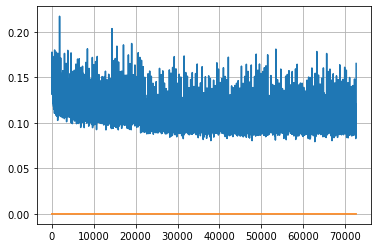

Epoch: 187, iteration 0, loss 0.10336902737617493, cov_diff 0.40590376765446895 cov_diff train 0.40549104087785054
Epoch: 187, iteration 1, loss 0.10197296738624573, cov_diff 0.40688313725016906 cov_diff train 0.40513336641514014
Epoch: 187, iteration 2, loss 0.09723156690597534, cov_diff 0.4164472598085388 cov_diff train 0.41637007316515345
Epoch: 187, iteration 3, loss 0.10746955871582031, cov_diff 0.39433391030648735 cov_diff train 0.3945607785554808
Epoch: 187, iteration 4, loss 0.10015776753425598, cov_diff 0.41476356314288493 cov_diff train 0.4147380549247823
Epoch: 187, iteration 5, loss 0.11083564162254333, cov_diff 0.41190128684121646 cov_diff train 0.4115939534290494
Epoch: 187, iteration 6, loss 0.1110638976097107, cov_diff 0.4167828961638055 cov_diff train 0.41604583433729553
Epoch: 187, iteration 7, loss 0.10809779167175293, cov_diff 0.41813157806012224 cov_diff train 0.4176661171288221
Epoch: 187, iteration 8, loss 0.10368427634239197, cov_diff 0.4145449746913747 cov_diff

Epoch: 187, iteration 77, loss 0.11448225378990173, cov_diff 0.4071855473016006 cov_diff train 0.4064337155270411
Epoch: 187, iteration 78, loss 0.10054364800453186, cov_diff 0.4054499377529448 cov_diff train 0.40458382615945515
Epoch: 187, iteration 79, loss 0.10164567828178406, cov_diff 0.4195059336103476 cov_diff train 0.41910308258309437
Epoch: 187, iteration 80, loss 0.09969595074653625, cov_diff 0.41522031061046993 cov_diff train 0.41472871004774137
Epoch: 187, iteration 81, loss 0.09734809398651123, cov_diff 0.41813080361897714 cov_diff train 0.41672444887392557
Epoch: 187, iteration 82, loss 0.10530191659927368, cov_diff 0.41069195369030476 cov_diff train 0.4087363824553642
Epoch: 187, iteration 83, loss 0.09903737902641296, cov_diff 0.4219464627993272 cov_diff train 0.42107894123741885
Epoch: 187, iteration 84, loss 0.10109350085258484, cov_diff 0.4033426203232505 cov_diff train 0.40283305422089893
Epoch: 187, iteration 85, loss 0.10174190998077393, cov_diff 0.4023980340228434

Epoch: 187, iteration 153, loss 0.11198943853378296, cov_diff 0.41784869100123045 cov_diff train 0.41705584520774236
Epoch: 187, iteration 154, loss 0.09334149956703186, cov_diff 0.4120208776219944 cov_diff train 0.410969187169542
Epoch: 187, iteration 155, loss 0.10560369491577148, cov_diff 0.4217338282122439 cov_diff train 0.4208097826631231
Epoch: 187, iteration 156, loss 0.10207921266555786, cov_diff 0.4175579309175681 cov_diff train 0.4164406507251695
Epoch: 187, iteration 157, loss 0.1113160252571106, cov_diff 0.4376459744542619 cov_diff train 0.4360454832480565
Epoch: 187, iteration 158, loss 0.10663807392120361, cov_diff 0.4305770449501653 cov_diff train 0.42964221659849894
Epoch: 187, iteration 159, loss 0.09161552786827087, cov_diff 0.41205150468711915 cov_diff train 0.41120057881299144
Epoch: 187, iteration 160, loss 0.11241000890731812, cov_diff 0.40631997705816064 cov_diff train 0.4060240744649037
Epoch: 187, iteration 161, loss 0.10029837489128113, cov_diff 0.404137575438

Epoch: 187, iteration 227, loss 0.10661345720291138, cov_diff 0.4136947973251015 cov_diff train 0.4140676934228108
Epoch: 187, iteration 228, loss 0.10802200436592102, cov_diff 0.42107444665820637 cov_diff train 0.42057290354710997
Epoch: 187, iteration 229, loss 0.1105852723121643, cov_diff 0.40708572353311984 cov_diff train 0.4072054462306883
Epoch: 187, iteration 230, loss 0.09532549977302551, cov_diff 0.40291205352792453 cov_diff train 0.4027538032079514
Epoch: 187, iteration 231, loss 0.10931181907653809, cov_diff 0.40586374854453555 cov_diff train 0.4058917557596366
Epoch: 187, iteration 232, loss 0.10488083958625793, cov_diff 0.40894617565843194 cov_diff train 0.4086850437565664
Epoch: 187, iteration 233, loss 0.10440808534622192, cov_diff 0.41894514233329666 cov_diff train 0.4183827639872884
Epoch: 187, iteration 234, loss 0.11119917035102844, cov_diff 0.4268074904931784 cov_diff train 0.4265554624429253
Epoch: 187, iteration 235, loss 0.10336941480636597, cov_diff 0.4100298038

Epoch: 187, iteration 306, loss 0.10686767101287842, cov_diff 0.41157600372234115 cov_diff train 0.410633889853984
Epoch: 187, iteration 307, loss 0.09849080443382263, cov_diff 0.4076999982093841 cov_diff train 0.4070134882907732
Epoch: 187, iteration 308, loss 0.10759356617927551, cov_diff 0.42764269034290725 cov_diff train 0.42595417377486033
Epoch: 187, iteration 309, loss 0.10498347878456116, cov_diff 0.41340911580556566 cov_diff train 0.4123425746570766
Epoch: 187, iteration 310, loss 0.09858295321464539, cov_diff 0.40495305563357964 cov_diff train 0.4040036691686419
Epoch: 187, iteration 311, loss 0.11241436004638672, cov_diff 0.4095879845466705 cov_diff train 0.4080344487096814
Epoch: 187, iteration 312, loss 0.10369911789894104, cov_diff 0.39877083410094066 cov_diff train 0.3978486232568133
Epoch: 187, iteration 313, loss 0.10519629716873169, cov_diff 0.4129856997345022 cov_diff train 0.4117062571317754
Epoch: 187, iteration 314, loss 0.09481942653656006, cov_diff 0.41097881645

Epoch: 187, iteration 384, loss 0.10006412863731384, cov_diff 0.40447991452653703 cov_diff train 0.4043987047584656
Epoch: 187, iteration 385, loss 0.1005232036113739, cov_diff 0.4158937865181507 cov_diff train 0.41570553853573217
Epoch: 187, iteration 386, loss 0.10251247882843018, cov_diff 0.4201958058077899 cov_diff train 0.4193817575402658
Epoch: 187, iteration 387, loss 0.10379451513290405, cov_diff 0.400427549742687 cov_diff train 0.4000338753411288
Epoch: 187, iteration 388, loss 0.09651637077331543, cov_diff 0.4091903480480758 cov_diff train 0.4081476153560917
Epoch: 187, iteration 389, loss 0.11141079664230347, cov_diff 0.420159237674819 cov_diff train 0.419031576260432
Epoch: 187, iteration 390, loss 0.13110896944999695, cov_diff 0.43332733409229934 cov_diff train 0.4320721873005469


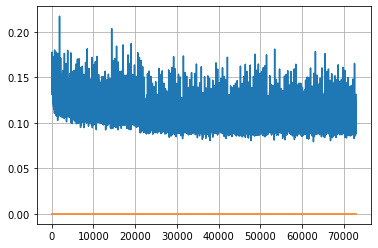

Epoch: 188, iteration 0, loss 0.10065445303916931, cov_diff 0.414626610665684 cov_diff train 0.4126504657681472
Epoch: 188, iteration 1, loss 0.10350891947746277, cov_diff 0.41778864191032145 cov_diff train 0.41737640108261154
Epoch: 188, iteration 2, loss 0.11287176609039307, cov_diff 0.40706291509932513 cov_diff train 0.40597676310786757
Epoch: 188, iteration 3, loss 0.12471425533294678, cov_diff 0.41005119776191407 cov_diff train 0.4097792517311849
Epoch: 188, iteration 4, loss 0.09814885258674622, cov_diff 0.4208153562265056 cov_diff train 0.4208840090675353
Epoch: 188, iteration 5, loss 0.11777710914611816, cov_diff 0.4114204043658859 cov_diff train 0.41169764031905093
Epoch: 188, iteration 6, loss 0.10010048747062683, cov_diff 0.4044347744917061 cov_diff train 0.4037753649511619
Epoch: 188, iteration 7, loss 0.09425881505012512, cov_diff 0.39703314935669554 cov_diff train 0.39664862002436485
Epoch: 188, iteration 8, loss 0.09422630071640015, cov_diff 0.40152675642568725 cov_diff 

Epoch: 188, iteration 80, loss 0.1037588119506836, cov_diff 0.4169381776121462 cov_diff train 0.41569365820322957
Epoch: 188, iteration 81, loss 0.10498818755149841, cov_diff 0.42095950797560877 cov_diff train 0.4197962605436247
Epoch: 188, iteration 82, loss 0.11146029829978943, cov_diff 0.4179903577762555 cov_diff train 0.41701432861099486
Epoch: 188, iteration 83, loss 0.11184629797935486, cov_diff 0.422134134380472 cov_diff train 0.42131497824107345
Epoch: 188, iteration 84, loss 0.10512146353721619, cov_diff 0.40694564301937997 cov_diff train 0.407167323285511
Epoch: 188, iteration 85, loss 0.10607701539993286, cov_diff 0.4330370165348519 cov_diff train 0.43217005584040585
Epoch: 188, iteration 86, loss 0.11617180705070496, cov_diff 0.40811703940498223 cov_diff train 0.4076538933805778
Epoch: 188, iteration 87, loss 0.10514199733734131, cov_diff 0.4206628415737829 cov_diff train 0.4207379674256429
Epoch: 188, iteration 88, loss 0.10344207286834717, cov_diff 0.40896294613199285 cov

Epoch: 188, iteration 154, loss 0.11024093627929688, cov_diff 0.41102130354806987 cov_diff train 0.4102773657839109
Epoch: 188, iteration 155, loss 0.11573195457458496, cov_diff 0.4066125926220521 cov_diff train 0.4065059412416024
Epoch: 188, iteration 156, loss 0.09903448820114136, cov_diff 0.4088503096576043 cov_diff train 0.40812332105718946
Epoch: 188, iteration 157, loss 0.1053394079208374, cov_diff 0.4105978627037565 cov_diff train 0.4098737354856551
Epoch: 188, iteration 158, loss 0.1044263243675232, cov_diff 0.4159498203713372 cov_diff train 0.415430780094006
Epoch: 188, iteration 159, loss 0.10265803337097168, cov_diff 0.42093654418457954 cov_diff train 0.4208916991274201
Epoch: 188, iteration 160, loss 0.10168710350990295, cov_diff 0.4184057441883476 cov_diff train 0.4179135511842393
Epoch: 188, iteration 161, loss 0.10249194502830505, cov_diff 0.4014474911965244 cov_diff train 0.40178759580995005
Epoch: 188, iteration 162, loss 0.10254192352294922, cov_diff 0.410840584721732

Epoch: 188, iteration 229, loss 0.09337645769119263, cov_diff 0.41189457248599604 cov_diff train 0.41084147087982087
Epoch: 188, iteration 230, loss 0.10812532901763916, cov_diff 0.4091243998907585 cov_diff train 0.4085137206398347
Epoch: 188, iteration 231, loss 0.11088860034942627, cov_diff 0.412352178160325 cov_diff train 0.41202221785425147
Epoch: 188, iteration 232, loss 0.09843906760215759, cov_diff 0.4053496788871992 cov_diff train 0.40498337655002103
Epoch: 188, iteration 233, loss 0.1064656674861908, cov_diff 0.41851912159571486 cov_diff train 0.41763382150032297
Epoch: 188, iteration 234, loss 0.10400408506393433, cov_diff 0.4201643313205915 cov_diff train 0.4189895924827679
Epoch: 188, iteration 235, loss 0.10116595029830933, cov_diff 0.4107268911414081 cov_diff train 0.41047156076319646
Epoch: 188, iteration 236, loss 0.10948359966278076, cov_diff 0.42004286725638634 cov_diff train 0.41907870687719084
Epoch: 188, iteration 237, loss 0.11707702279090881, cov_diff 0.427112742

Epoch: 188, iteration 307, loss 0.09396669268608093, cov_diff 0.420705533655105 cov_diff train 0.42084963205423603
Epoch: 188, iteration 308, loss 0.10303780436515808, cov_diff 0.4195285392733712 cov_diff train 0.41879943520765667
Epoch: 188, iteration 309, loss 0.10807478427886963, cov_diff 0.42476166630410894 cov_diff train 0.42319822738415136
Epoch: 188, iteration 310, loss 0.1137549877166748, cov_diff 0.408502513039984 cov_diff train 0.40733278415383933
Epoch: 188, iteration 311, loss 0.10524165630340576, cov_diff 0.4180027610776132 cov_diff train 0.41733215748204217
Epoch: 188, iteration 312, loss 0.09595906734466553, cov_diff 0.4203287986591723 cov_diff train 0.41907155205292346
Epoch: 188, iteration 313, loss 0.10939368605613708, cov_diff 0.4129047740232391 cov_diff train 0.41199183178243126
Epoch: 188, iteration 314, loss 0.10462641716003418, cov_diff 0.4092340574293574 cov_diff train 0.4084366574793483
Epoch: 188, iteration 315, loss 0.11048373579978943, cov_diff 0.41240530878

Epoch: 188, iteration 385, loss 0.10281184315681458, cov_diff 0.42846754064997034 cov_diff train 0.4286210927843239
Epoch: 188, iteration 386, loss 0.09389704465866089, cov_diff 0.4102455062238915 cov_diff train 0.4098991308260719
Epoch: 188, iteration 387, loss 0.09333258867263794, cov_diff 0.4181940222324795 cov_diff train 0.41823033778343643
Epoch: 188, iteration 388, loss 0.09177157282829285, cov_diff 0.4063092631639003 cov_diff train 0.4066936142601933
Epoch: 188, iteration 389, loss 0.09530878067016602, cov_diff 0.39903250886173175 cov_diff train 0.3982459676220973
Epoch: 188, iteration 390, loss 0.1702600121498108, cov_diff 0.4565067473908651 cov_diff train 0.4555020906922772


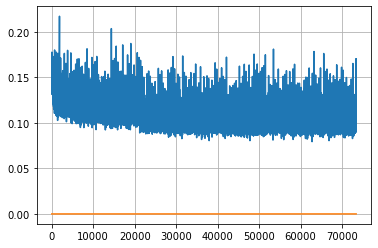

Epoch: 189, iteration 0, loss 0.0975060760974884, cov_diff 0.43598498101719874 cov_diff train 0.4352385951771805
Epoch: 189, iteration 1, loss 0.10581836104393005, cov_diff 0.4200045547238045 cov_diff train 0.41955833278708266
Epoch: 189, iteration 2, loss 0.09754595160484314, cov_diff 0.4193811655416873 cov_diff train 0.418790627504631
Epoch: 189, iteration 3, loss 0.11731407046318054, cov_diff 0.4163502896441499 cov_diff train 0.4154496871910902
Epoch: 189, iteration 4, loss 0.10463190078735352, cov_diff 0.4056615064645537 cov_diff train 0.40437952432210206
Epoch: 189, iteration 5, loss 0.10475718975067139, cov_diff 0.4262567699013681 cov_diff train 0.424192576876202
Epoch: 189, iteration 6, loss 0.11613193154335022, cov_diff 0.4141895187921298 cov_diff train 0.4129254798098725
Epoch: 189, iteration 7, loss 0.10320830345153809, cov_diff 0.4177546209056745 cov_diff train 0.41718490937003466
Epoch: 189, iteration 8, loss 0.10634022951126099, cov_diff 0.40887161346149015 cov_diff train 

Epoch: 189, iteration 75, loss 0.10990869998931885, cov_diff 0.4003001911123835 cov_diff train 0.39918764129237716
Epoch: 189, iteration 76, loss 0.1084388792514801, cov_diff 0.4121051310740045 cov_diff train 0.41108245324657594
Epoch: 189, iteration 77, loss 0.09709671139717102, cov_diff 0.395692574101336 cov_diff train 0.3953049840879907
Epoch: 189, iteration 78, loss 0.10212498903274536, cov_diff 0.4094758690848015 cov_diff train 0.40912769663388115
Epoch: 189, iteration 79, loss 0.11063891649246216, cov_diff 0.4245070267664222 cov_diff train 0.4238494528468453
Epoch: 189, iteration 80, loss 0.10418373346328735, cov_diff 0.40501710623886833 cov_diff train 0.4037981801835943
Epoch: 189, iteration 81, loss 0.08792954683303833, cov_diff 0.4200096319932272 cov_diff train 0.4188757934087769
Epoch: 189, iteration 82, loss 0.09889581799507141, cov_diff 0.41466146808708176 cov_diff train 0.4135761634555237
Epoch: 189, iteration 83, loss 0.09146681427955627, cov_diff 0.40411143087256374 cov_

Epoch: 189, iteration 148, loss 0.10541218519210815, cov_diff 0.4174298167115082 cov_diff train 0.4164162700872317
Epoch: 189, iteration 149, loss 0.10717615485191345, cov_diff 0.40896452162740066 cov_diff train 0.4079944939388216
Epoch: 189, iteration 150, loss 0.0953320860862732, cov_diff 0.4137568211986897 cov_diff train 0.4128539670171059
Epoch: 189, iteration 151, loss 0.10808733105659485, cov_diff 0.41603894549016696 cov_diff train 0.4157235575803051
Epoch: 189, iteration 152, loss 0.10167834162712097, cov_diff 0.4034329020389131 cov_diff train 0.401944656663798
Epoch: 189, iteration 153, loss 0.10729601979255676, cov_diff 0.41450550970146416 cov_diff train 0.4134206504377496
Epoch: 189, iteration 154, loss 0.09655049443244934, cov_diff 0.40118044856872126 cov_diff train 0.4010831168065863
Epoch: 189, iteration 155, loss 0.09599590301513672, cov_diff 0.4140574203095426 cov_diff train 0.4131678090221139
Epoch: 189, iteration 156, loss 0.10759547352790833, cov_diff 0.41791453288020

Epoch: 189, iteration 219, loss 0.10577648878097534, cov_diff 0.4129569528113423 cov_diff train 0.41284211998909653
Epoch: 189, iteration 220, loss 0.1070757806301117, cov_diff 0.41215938766298027 cov_diff train 0.4108377247963132
Epoch: 189, iteration 221, loss 0.10439050197601318, cov_diff 0.426724979674617 cov_diff train 0.42546501612316734
Epoch: 189, iteration 222, loss 0.09796252846717834, cov_diff 0.4086387499716754 cov_diff train 0.4080900250642173
Epoch: 189, iteration 223, loss 0.10201287269592285, cov_diff 0.43112467820299955 cov_diff train 0.4292206647571052
Epoch: 189, iteration 224, loss 0.1020497977733612, cov_diff 0.4067163814294084 cov_diff train 0.4048945242811705
Epoch: 189, iteration 225, loss 0.10306355357170105, cov_diff 0.42563751372318953 cov_diff train 0.4250156911621188
Epoch: 189, iteration 226, loss 0.09549418091773987, cov_diff 0.4162750738618425 cov_diff train 0.4154031260102352
Epoch: 189, iteration 227, loss 0.10642382502555847, cov_diff 0.42288376976118

Epoch: 189, iteration 291, loss 0.10845053195953369, cov_diff 0.4171144272477 cov_diff train 0.41749419135082916
Epoch: 189, iteration 292, loss 0.10913294553756714, cov_diff 0.4142243349409168 cov_diff train 0.41334909865040315
Epoch: 189, iteration 293, loss 0.10177278518676758, cov_diff 0.43264572016622227 cov_diff train 0.43188625035291467
Epoch: 189, iteration 294, loss 0.09216490387916565, cov_diff 0.41243171423755054 cov_diff train 0.4123538121499773
Epoch: 189, iteration 295, loss 0.1061868667602539, cov_diff 0.4289263230584469 cov_diff train 0.42777974211456976
Epoch: 189, iteration 296, loss 0.10834294557571411, cov_diff 0.41089849768573117 cov_diff train 0.4105282559584884
Epoch: 189, iteration 297, loss 0.10331887006759644, cov_diff 0.4251593212218953 cov_diff train 0.4246167880272295
Epoch: 189, iteration 298, loss 0.09589442610740662, cov_diff 0.40872196389812926 cov_diff train 0.4073077677266785
Epoch: 189, iteration 299, loss 0.10449331998825073, cov_diff 0.415028473304

Epoch: 189, iteration 369, loss 0.11362084746360779, cov_diff 0.4095637873685735 cov_diff train 0.40881049489174326
Epoch: 189, iteration 370, loss 0.10733494162559509, cov_diff 0.41987707894418347 cov_diff train 0.41910311806830464
Epoch: 189, iteration 371, loss 0.10448193550109863, cov_diff 0.4031918579663735 cov_diff train 0.40193785192896814
Epoch: 189, iteration 372, loss 0.10840731859207153, cov_diff 0.4141330174174308 cov_diff train 0.413127234255894
Epoch: 189, iteration 373, loss 0.10925698280334473, cov_diff 0.40217664760777283 cov_diff train 0.40177528759224923
Epoch: 189, iteration 374, loss 0.1020616888999939, cov_diff 0.4175908994866019 cov_diff train 0.41678910992315105
Epoch: 189, iteration 375, loss 0.09798145294189453, cov_diff 0.4086809990957817 cov_diff train 0.4075397874180783
Epoch: 189, iteration 376, loss 0.09767112135887146, cov_diff 0.41403167048428285 cov_diff train 0.41302449345461995
Epoch: 189, iteration 377, loss 0.10189265012741089, cov_diff 0.399777651

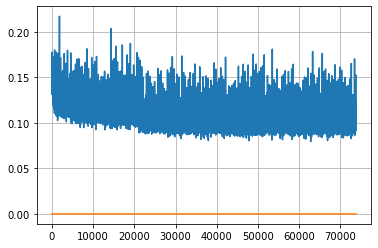

Epoch: 190, iteration 0, loss 0.10453668236732483, cov_diff 0.4121431579848444 cov_diff train 0.4110911432131791
Epoch: 190, iteration 1, loss 0.10371530055999756, cov_diff 0.41471167010505006 cov_diff train 0.4146939113691808
Epoch: 190, iteration 2, loss 0.1064268946647644, cov_diff 0.41287873904035516 cov_diff train 0.41332688857178607
Epoch: 190, iteration 3, loss 0.09889093041419983, cov_diff 0.4067029370074788 cov_diff train 0.40682132365821255
Epoch: 190, iteration 4, loss 0.09682527184486389, cov_diff 0.41706074154382894 cov_diff train 0.41616698014876485
Epoch: 190, iteration 5, loss 0.10427471995353699, cov_diff 0.40470865441120113 cov_diff train 0.40420451245860967
Epoch: 190, iteration 6, loss 0.1020011305809021, cov_diff 0.4083541955408047 cov_diff train 0.4083628250685303
Epoch: 190, iteration 7, loss 0.09874135255813599, cov_diff 0.4198632413316019 cov_diff train 0.4187655547895274
Epoch: 190, iteration 8, loss 0.10089412331581116, cov_diff 0.41660773891016195 cov_diff t

Epoch: 190, iteration 75, loss 0.10455942153930664, cov_diff 0.42276109924814026 cov_diff train 0.42184407886623543
Epoch: 190, iteration 76, loss 0.10940217971801758, cov_diff 0.4163292776065251 cov_diff train 0.41484517322726044
Epoch: 190, iteration 77, loss 0.09391340613365173, cov_diff 0.4202061060193938 cov_diff train 0.41973975887103393
Epoch: 190, iteration 78, loss 0.0991956889629364, cov_diff 0.4126617952115459 cov_diff train 0.4118192054732227
Epoch: 190, iteration 79, loss 0.10054552555084229, cov_diff 0.40828660119961036 cov_diff train 0.40777487435265536
Epoch: 190, iteration 80, loss 0.10344773530960083, cov_diff 0.4065708720444968 cov_diff train 0.40544365577574165
Epoch: 190, iteration 81, loss 0.09213757514953613, cov_diff 0.41221763417042784 cov_diff train 0.4122267216517466
Epoch: 190, iteration 82, loss 0.1022598147392273, cov_diff 0.4262682740238513 cov_diff train 0.42685184824874395
Epoch: 190, iteration 83, loss 0.11347836256027222, cov_diff 0.407583579616058 co

Epoch: 190, iteration 153, loss 0.10218724608421326, cov_diff 0.4231702144244216 cov_diff train 0.42187416503590924
Epoch: 190, iteration 154, loss 0.10401761531829834, cov_diff 0.41804166467749815 cov_diff train 0.4162785054793649
Epoch: 190, iteration 155, loss 0.10207724571228027, cov_diff 0.3980808650597469 cov_diff train 0.3968124330571656
Epoch: 190, iteration 156, loss 0.10584160685539246, cov_diff 0.4258043596179239 cov_diff train 0.4248571784211501
Epoch: 190, iteration 157, loss 0.107220858335495, cov_diff 0.42233628451903005 cov_diff train 0.4207442352526682
Epoch: 190, iteration 158, loss 0.09560728073120117, cov_diff 0.4210998278148924 cov_diff train 0.4198103476342636
Epoch: 190, iteration 159, loss 0.10249245166778564, cov_diff 0.41942039347123916 cov_diff train 0.41917723199767976
Epoch: 190, iteration 160, loss 0.10339489579200745, cov_diff 0.41928919359399897 cov_diff train 0.4185511918199587
Epoch: 190, iteration 161, loss 0.10384371876716614, cov_diff 0.410924085460

Epoch: 190, iteration 230, loss 0.11210784316062927, cov_diff 0.4083136310253103 cov_diff train 0.4076751141820907
Epoch: 190, iteration 231, loss 0.10985985398292542, cov_diff 0.4171825815145744 cov_diff train 0.417216352023499
Epoch: 190, iteration 232, loss 0.09745648503303528, cov_diff 0.4339090904764926 cov_diff train 0.4333008153664746
Epoch: 190, iteration 233, loss 0.10071167349815369, cov_diff 0.4127835724633682 cov_diff train 0.41254240876973547
Epoch: 190, iteration 234, loss 0.10017704963684082, cov_diff 0.4094131153967751 cov_diff train 0.4088993819204863
Epoch: 190, iteration 235, loss 0.09307968616485596, cov_diff 0.4211235996080383 cov_diff train 0.42107778404567886
Epoch: 190, iteration 236, loss 0.0985802710056305, cov_diff 0.41203788930725266 cov_diff train 0.41195061576462366
Epoch: 190, iteration 237, loss 0.10363739728927612, cov_diff 0.4097981225322879 cov_diff train 0.40849986419075135
Epoch: 190, iteration 238, loss 0.09846371412277222, cov_diff 0.4274342083999

Epoch: 190, iteration 305, loss 0.10542270541191101, cov_diff 0.42094038307203324 cov_diff train 0.4200374629111617
Epoch: 190, iteration 306, loss 0.10881337523460388, cov_diff 0.4266351896776301 cov_diff train 0.42538351241925465
Epoch: 190, iteration 307, loss 0.1104704737663269, cov_diff 0.4139314298589155 cov_diff train 0.41322625030652593
Epoch: 190, iteration 308, loss 0.09944969415664673, cov_diff 0.4317248978373538 cov_diff train 0.43080637589506837
Epoch: 190, iteration 309, loss 0.10272142291069031, cov_diff 0.42287832552929905 cov_diff train 0.4217022110278267
Epoch: 190, iteration 310, loss 0.10546126961708069, cov_diff 0.40787340157115437 cov_diff train 0.4078903281356228
Epoch: 190, iteration 311, loss 0.10062161087989807, cov_diff 0.41928876750313454 cov_diff train 0.4191011880839699
Epoch: 190, iteration 312, loss 0.11902859807014465, cov_diff 0.4257254073028643 cov_diff train 0.4252660755942231
Epoch: 190, iteration 313, loss 0.1051485538482666, cov_diff 0.41323897511

Epoch: 190, iteration 381, loss 0.09741365909576416, cov_diff 0.4127394675667644 cov_diff train 0.4124314380785161
Epoch: 190, iteration 382, loss 0.10778346657752991, cov_diff 0.41141496434074554 cov_diff train 0.4105651520478359
Epoch: 190, iteration 383, loss 0.1126507818698883, cov_diff 0.41616368302538753 cov_diff train 0.41552481033167216
Epoch: 190, iteration 384, loss 0.1023714542388916, cov_diff 0.4108360768786238 cov_diff train 0.4099883711102639
Epoch: 190, iteration 385, loss 0.09977921843528748, cov_diff 0.4137550825479221 cov_diff train 0.4133049544343616
Epoch: 190, iteration 386, loss 0.10580030083656311, cov_diff 0.40588588366989997 cov_diff train 0.4055204435498612
Epoch: 190, iteration 387, loss 0.09366458654403687, cov_diff 0.4143525131686454 cov_diff train 0.41385581319564824
Epoch: 190, iteration 388, loss 0.10450229048728943, cov_diff 0.4116410576112882 cov_diff train 0.4116030208704594
Epoch: 190, iteration 389, loss 0.10028091073036194, cov_diff 0.4134980804606

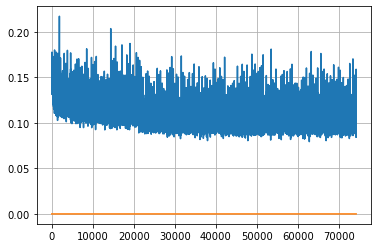

Epoch: 191, iteration 0, loss 0.11016348004341125, cov_diff 0.4086274823621362 cov_diff train 0.41030041277608326
Epoch: 191, iteration 1, loss 0.0994412899017334, cov_diff 0.42173125804452427 cov_diff train 0.4218337829841679
Epoch: 191, iteration 2, loss 0.11228257417678833, cov_diff 0.41747038827134464 cov_diff train 0.4170428999420224
Epoch: 191, iteration 3, loss 0.09255784749984741, cov_diff 0.41210899207822177 cov_diff train 0.41168639688306763
Epoch: 191, iteration 4, loss 0.10316923260688782, cov_diff 0.4205060501605362 cov_diff train 0.4200572090481277
Epoch: 191, iteration 5, loss 0.10197469592094421, cov_diff 0.41780530222155376 cov_diff train 0.4176208553991641
Epoch: 191, iteration 6, loss 0.11041796207427979, cov_diff 0.41328318017211363 cov_diff train 0.4126450382348364
Epoch: 191, iteration 7, loss 0.10686084628105164, cov_diff 0.4203300669277672 cov_diff train 0.419414534624564
Epoch: 191, iteration 8, loss 0.11216691136360168, cov_diff 0.4166467734718946 cov_diff tra

Epoch: 191, iteration 77, loss 0.1101326048374176, cov_diff 0.4206859205668262 cov_diff train 0.4201264553840666
Epoch: 191, iteration 78, loss 0.09803161025047302, cov_diff 0.42437798102561375 cov_diff train 0.42428870977777006
Epoch: 191, iteration 79, loss 0.10942009091377258, cov_diff 0.4307864302257616 cov_diff train 0.4304259182431987
Epoch: 191, iteration 80, loss 0.10173478722572327, cov_diff 0.4244598229806361 cov_diff train 0.4240797681966951
Epoch: 191, iteration 81, loss 0.10125094652175903, cov_diff 0.4094089294778617 cov_diff train 0.40907366720858795
Epoch: 191, iteration 82, loss 0.09875330328941345, cov_diff 0.403691456419899 cov_diff train 0.4032555499238793
Epoch: 191, iteration 83, loss 0.10264995694160461, cov_diff 0.42242360764256104 cov_diff train 0.42189265103276147
Epoch: 191, iteration 84, loss 0.09839147329330444, cov_diff 0.4235268112678248 cov_diff train 0.42261968572964176
Epoch: 191, iteration 85, loss 0.10860595107078552, cov_diff 0.40342271856995693 cov

Epoch: 191, iteration 154, loss 0.10020092129707336, cov_diff 0.4261020301631675 cov_diff train 0.42508016418752903
Epoch: 191, iteration 155, loss 0.11201432347297668, cov_diff 0.4274363952157031 cov_diff train 0.42484786070082714
Epoch: 191, iteration 156, loss 0.10459131002426147, cov_diff 0.4110801977439406 cov_diff train 0.4102133964074686
Epoch: 191, iteration 157, loss 0.09932735562324524, cov_diff 0.43110871098892817 cov_diff train 0.4300906851785
Epoch: 191, iteration 158, loss 0.09893348813056946, cov_diff 0.4242147791446407 cov_diff train 0.4236937277085973
Epoch: 191, iteration 159, loss 0.10578805208206177, cov_diff 0.426595664726239 cov_diff train 0.4256084006114916
Epoch: 191, iteration 160, loss 0.099917471408844, cov_diff 0.4359606352255245 cov_diff train 0.4345443702903234
Epoch: 191, iteration 161, loss 0.09266197681427002, cov_diff 0.40541734133600676 cov_diff train 0.404695902264846
Epoch: 191, iteration 162, loss 0.10428869724273682, cov_diff 0.43088443971576773 c

Epoch: 191, iteration 231, loss 0.10313251614570618, cov_diff 0.42905184987991657 cov_diff train 0.42820733633665653
Epoch: 191, iteration 232, loss 0.10961073637008667, cov_diff 0.41769771974645903 cov_diff train 0.41723580683899636
Epoch: 191, iteration 233, loss 0.10114958882331848, cov_diff 0.41996465610941575 cov_diff train 0.41967746401737893
Epoch: 191, iteration 234, loss 0.11622491478919983, cov_diff 0.41496162628756605 cov_diff train 0.4138504756881627
Epoch: 191, iteration 235, loss 0.12137743830680847, cov_diff 0.4192094424030908 cov_diff train 0.41828091046842286
Epoch: 191, iteration 236, loss 0.09913834929466248, cov_diff 0.42731589657637115 cov_diff train 0.4260643772534235
Epoch: 191, iteration 237, loss 0.10665649175643921, cov_diff 0.4104493508816725 cov_diff train 0.4099711390224661
Epoch: 191, iteration 238, loss 0.10699257254600525, cov_diff 0.41000459895236024 cov_diff train 0.4094536255742594
Epoch: 191, iteration 239, loss 0.09859803318977356, cov_diff 0.411425

Epoch: 191, iteration 308, loss 0.10814529657363892, cov_diff 0.418950806004918 cov_diff train 0.4182635213747955
Epoch: 191, iteration 309, loss 0.10571655631065369, cov_diff 0.4233944981119625 cov_diff train 0.42280157490028997
Epoch: 191, iteration 310, loss 0.10079321265220642, cov_diff 0.40695971781789025 cov_diff train 0.40684739738453335
Epoch: 191, iteration 311, loss 0.10696420073509216, cov_diff 0.4012987121529328 cov_diff train 0.4004510351995196
Epoch: 191, iteration 312, loss 0.09377238154411316, cov_diff 0.4060503831911733 cov_diff train 0.40592775170594936
Epoch: 191, iteration 313, loss 0.10850000381469727, cov_diff 0.42800890300577993 cov_diff train 0.42629858563321965
Epoch: 191, iteration 314, loss 0.09089207649230957, cov_diff 0.41182938273947484 cov_diff train 0.4117743892211282
Epoch: 191, iteration 315, loss 0.10588109493255615, cov_diff 0.42018561908274205 cov_diff train 0.4192129794597164
Epoch: 191, iteration 316, loss 0.09944027662277222, cov_diff 0.419813218

Epoch: 191, iteration 387, loss 0.10486498475074768, cov_diff 0.42000943862511736 cov_diff train 0.419553496429112
Epoch: 191, iteration 388, loss 0.11241307854652405, cov_diff 0.4397253253654008 cov_diff train 0.4378975188031054
Epoch: 191, iteration 389, loss 0.10690608620643616, cov_diff 0.4140026413910909 cov_diff train 0.41224107187545833
Epoch: 191, iteration 390, loss 0.15614131093025208, cov_diff 0.45261846851991483 cov_diff train 0.4519301730387322


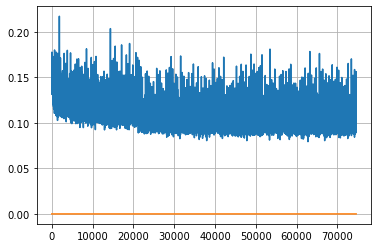

Epoch: 192, iteration 0, loss 0.11481758952140808, cov_diff 0.4103539982630726 cov_diff train 0.41041932214381355
Epoch: 192, iteration 1, loss 0.10899621248245239, cov_diff 0.4180832395139295 cov_diff train 0.418064790160676
Epoch: 192, iteration 2, loss 0.09986823797225952, cov_diff 0.41725087542429085 cov_diff train 0.41655126465985554
Epoch: 192, iteration 3, loss 0.1137077808380127, cov_diff 0.41075133291617566 cov_diff train 0.4103533090230804
Epoch: 192, iteration 4, loss 0.10697469115257263, cov_diff 0.41346169036958885 cov_diff train 0.4129062792942874
Epoch: 192, iteration 5, loss 0.10974520444869995, cov_diff 0.4099676557619108 cov_diff train 0.4097743013531029
Epoch: 192, iteration 6, loss 0.09809836745262146, cov_diff 0.4280704292902088 cov_diff train 0.42756840417637954
Epoch: 192, iteration 7, loss 0.09396353363990784, cov_diff 0.40281988031284044 cov_diff train 0.40289788226335604
Epoch: 192, iteration 8, loss 0.10579478740692139, cov_diff 0.43231794141717583 cov_diff t

Epoch: 192, iteration 82, loss 0.09998488426208496, cov_diff 0.40974276596408155 cov_diff train 0.4093229649377172
Epoch: 192, iteration 83, loss 0.11605814099311829, cov_diff 0.414185605607239 cov_diff train 0.4145782851441547
Epoch: 192, iteration 84, loss 0.10533386468887329, cov_diff 0.41362775543809904 cov_diff train 0.41288792732965546
Epoch: 192, iteration 85, loss 0.09861123561859131, cov_diff 0.4184359259361528 cov_diff train 0.41809446489837976
Epoch: 192, iteration 86, loss 0.09642547369003296, cov_diff 0.4149931223902044 cov_diff train 0.41506418734560596
Epoch: 192, iteration 87, loss 0.09940806031227112, cov_diff 0.4136702577607829 cov_diff train 0.4134978048252381
Epoch: 192, iteration 88, loss 0.0994558036327362, cov_diff 0.4142278086816182 cov_diff train 0.41428131934690393
Epoch: 192, iteration 89, loss 0.09363555908203125, cov_diff 0.41417968733010024 cov_diff train 0.4144656695198274
Epoch: 192, iteration 90, loss 0.10194748640060425, cov_diff 0.4207717442991347 cov

Epoch: 192, iteration 163, loss 0.10175228118896484, cov_diff 0.42762741612124966 cov_diff train 0.4273223311155282
Epoch: 192, iteration 164, loss 0.1068163812160492, cov_diff 0.42602214034357544 cov_diff train 0.4258486365148566
Epoch: 192, iteration 165, loss 0.09910517930984497, cov_diff 0.4103348650192915 cov_diff train 0.4094901362086412
Epoch: 192, iteration 166, loss 0.09972333908081055, cov_diff 0.41273805147427506 cov_diff train 0.4119929414855338
Epoch: 192, iteration 167, loss 0.1058042049407959, cov_diff 0.4238448108578342 cov_diff train 0.42326702855180676
Epoch: 192, iteration 168, loss 0.11153554916381836, cov_diff 0.4220828495769062 cov_diff train 0.4216563794738994
Epoch: 192, iteration 169, loss 0.10196328163146973, cov_diff 0.4234458512532479 cov_diff train 0.4228440560977456
Epoch: 192, iteration 170, loss 0.10492071509361267, cov_diff 0.4110002735988671 cov_diff train 0.4110340569010031
Epoch: 192, iteration 171, loss 0.1002703309059143, cov_diff 0.407775818201997

Epoch: 192, iteration 234, loss 0.10750404000282288, cov_diff 0.41812365084988484 cov_diff train 0.4174086104200268
Epoch: 192, iteration 235, loss 0.11029249429702759, cov_diff 0.41500059486399754 cov_diff train 0.41383194901879594
Epoch: 192, iteration 236, loss 0.09601697325706482, cov_diff 0.4114538738025018 cov_diff train 0.4096891915192704
Epoch: 192, iteration 237, loss 0.09982815384864807, cov_diff 0.41045810343423766 cov_diff train 0.4098876902963793
Epoch: 192, iteration 238, loss 0.10918429493904114, cov_diff 0.4210053889706743 cov_diff train 0.4204063265031961
Epoch: 192, iteration 239, loss 0.09624230861663818, cov_diff 0.41107943999795893 cov_diff train 0.41081429125130514
Epoch: 192, iteration 240, loss 0.11177223920822144, cov_diff 0.41515116124257234 cov_diff train 0.4140454025507346
Epoch: 192, iteration 241, loss 0.10244733095169067, cov_diff 0.4298041843904005 cov_diff train 0.42946190592518346
Epoch: 192, iteration 242, loss 0.10112714767456055, cov_diff 0.41553817

Epoch: 192, iteration 306, loss 0.10055631399154663, cov_diff 0.41318814930610126 cov_diff train 0.41321055215479563
Epoch: 192, iteration 307, loss 0.1051281988620758, cov_diff 0.42327179090980793 cov_diff train 0.42268308142682126
Epoch: 192, iteration 308, loss 0.10220134258270264, cov_diff 0.4089471564301465 cov_diff train 0.4081563053126459
Epoch: 192, iteration 309, loss 0.11419960856437683, cov_diff 0.4127611735566375 cov_diff train 0.41192092979927614
Epoch: 192, iteration 310, loss 0.0977124571800232, cov_diff 0.42101595702619804 cov_diff train 0.42118218340104296
Epoch: 192, iteration 311, loss 0.10844883322715759, cov_diff 0.41561659931090683 cov_diff train 0.4157097972192415
Epoch: 192, iteration 312, loss 0.10155889391899109, cov_diff 0.40899419969403045 cov_diff train 0.4086737989638348
Epoch: 192, iteration 313, loss 0.11733156442642212, cov_diff 0.4181859765216977 cov_diff train 0.4170166762802045
Epoch: 192, iteration 314, loss 0.09644553065299988, cov_diff 0.414273638

Epoch: 192, iteration 382, loss 0.09667530655860901, cov_diff 0.41368214467293823 cov_diff train 0.41343088465965666
Epoch: 192, iteration 383, loss 0.09889253973960876, cov_diff 0.4173343027175701 cov_diff train 0.4171097956921309
Epoch: 192, iteration 384, loss 0.10737726092338562, cov_diff 0.4157953577769479 cov_diff train 0.4158037449918181
Epoch: 192, iteration 385, loss 0.09373390674591064, cov_diff 0.39959571438186586 cov_diff train 0.3997251575184308
Epoch: 192, iteration 386, loss 0.11761543154716492, cov_diff 0.42092283237721007 cov_diff train 0.42079775224296734
Epoch: 192, iteration 387, loss 0.10758748650550842, cov_diff 0.423528578717523 cov_diff train 0.4226686736797547
Epoch: 192, iteration 388, loss 0.11036181449890137, cov_diff 0.41540020270065475 cov_diff train 0.4148681669980923
Epoch: 192, iteration 389, loss 0.10194486379623413, cov_diff 0.3989434706299077 cov_diff train 0.3985535013037428
Epoch: 192, iteration 390, loss 0.15334096550941467, cov_diff 0.45740839959

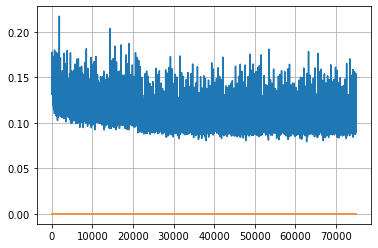

Epoch: 193, iteration 0, loss 0.10335803031921387, cov_diff 0.41318325973733694 cov_diff train 0.4130787125591862
Epoch: 193, iteration 1, loss 0.09561452269554138, cov_diff 0.4072353498687167 cov_diff train 0.40720821158709336
Epoch: 193, iteration 2, loss 0.10052046179771423, cov_diff 0.4203832486919247 cov_diff train 0.4200652117949962
Epoch: 193, iteration 3, loss 0.10314583778381348, cov_diff 0.40514700020092886 cov_diff train 0.4054012339958764
Epoch: 193, iteration 4, loss 0.10391399264335632, cov_diff 0.42071439334204763 cov_diff train 0.41984624788133007
Epoch: 193, iteration 5, loss 0.1027783751487732, cov_diff 0.4186432168697445 cov_diff train 0.4168104561971413
Epoch: 193, iteration 6, loss 0.10146689414978027, cov_diff 0.41355270289345814 cov_diff train 0.4128689790948487
Epoch: 193, iteration 7, loss 0.1181226372718811, cov_diff 0.420805450484587 cov_diff train 0.4195367432949539
Epoch: 193, iteration 8, loss 0.09514465928077698, cov_diff 0.397627488139629 cov_diff train 

Epoch: 193, iteration 78, loss 0.10443627834320068, cov_diff 0.4065207454232096 cov_diff train 0.4063442286709107
Epoch: 193, iteration 79, loss 0.10218268632888794, cov_diff 0.4016124702023735 cov_diff train 0.40155074351267617
Epoch: 193, iteration 80, loss 0.11209473013877869, cov_diff 0.4103579343454865 cov_diff train 0.40921381770470067
Epoch: 193, iteration 81, loss 0.09459009766578674, cov_diff 0.40276271919326107 cov_diff train 0.4017000585309705
Epoch: 193, iteration 82, loss 0.10657423734664917, cov_diff 0.4140886633112513 cov_diff train 0.4141793497043265
Epoch: 193, iteration 83, loss 0.09078824520111084, cov_diff 0.4239323471459623 cov_diff train 0.42395028727853457
Epoch: 193, iteration 84, loss 0.0988951027393341, cov_diff 0.41279243931387666 cov_diff train 0.4129245490478799
Epoch: 193, iteration 85, loss 0.10669645667076111, cov_diff 0.41849078930295036 cov_diff train 0.41846461329674556
Epoch: 193, iteration 86, loss 0.11643466353416443, cov_diff 0.4167079574153333 co

Epoch: 193, iteration 150, loss 0.09356194734573364, cov_diff 0.39635072766972507 cov_diff train 0.3957826499849902
Epoch: 193, iteration 151, loss 0.0974738597869873, cov_diff 0.4081714333312861 cov_diff train 0.40765421557919274
Epoch: 193, iteration 152, loss 0.09701880812644958, cov_diff 0.4058470184299258 cov_diff train 0.40512853217763434
Epoch: 193, iteration 153, loss 0.10281291604042053, cov_diff 0.408292334465129 cov_diff train 0.4079214602464136
Epoch: 193, iteration 154, loss 0.10687464475631714, cov_diff 0.41922829040638726 cov_diff train 0.4182444378262592
Epoch: 193, iteration 155, loss 0.10086962580680847, cov_diff 0.4204203404371341 cov_diff train 0.4194809715291832
Epoch: 193, iteration 156, loss 0.10512688755989075, cov_diff 0.4017632011489829 cov_diff train 0.40086800895221886
Epoch: 193, iteration 157, loss 0.09839624166488647, cov_diff 0.40366467804101797 cov_diff train 0.40347793543226457
Epoch: 193, iteration 158, loss 0.12147623300552368, cov_diff 0.41694660067

Epoch: 193, iteration 228, loss 0.11875826120376587, cov_diff 0.4164984563531245 cov_diff train 0.4163873457639342
Epoch: 193, iteration 229, loss 0.08866679668426514, cov_diff 0.4157366311304229 cov_diff train 0.4143080919502919
Epoch: 193, iteration 230, loss 0.10705751180648804, cov_diff 0.4234761951504947 cov_diff train 0.4236329072954728
Epoch: 193, iteration 231, loss 0.09840735793113708, cov_diff 0.4089415916981137 cov_diff train 0.40847083561475833
Epoch: 193, iteration 232, loss 0.10289311408996582, cov_diff 0.4159252643001061 cov_diff train 0.41629597056002576
Epoch: 193, iteration 233, loss 0.10112118721008301, cov_diff 0.40903667061206656 cov_diff train 0.40877406731990457
Epoch: 193, iteration 234, loss 0.10068714618682861, cov_diff 0.4015446552428325 cov_diff train 0.4008792089413668
Epoch: 193, iteration 235, loss 0.1041790246963501, cov_diff 0.41892256909492276 cov_diff train 0.4179589663019415
Epoch: 193, iteration 236, loss 0.10802945494651794, cov_diff 0.424420368264

Epoch: 193, iteration 303, loss 0.1006542444229126, cov_diff 0.40799619276961024 cov_diff train 0.4078314629253348
Epoch: 193, iteration 304, loss 0.09384801983833313, cov_diff 0.4200451901172583 cov_diff train 0.41926467777467735
Epoch: 193, iteration 305, loss 0.1039571464061737, cov_diff 0.41501730664026415 cov_diff train 0.4144038632913879
Epoch: 193, iteration 306, loss 0.1043059229850769, cov_diff 0.4242214739655596 cov_diff train 0.4238703015032706
Epoch: 193, iteration 307, loss 0.098019540309906, cov_diff 0.420661924649183 cov_diff train 0.42028932327183455
Epoch: 193, iteration 308, loss 0.10010352730751038, cov_diff 0.41083844988580515 cov_diff train 0.40955605833915393
Epoch: 193, iteration 309, loss 0.10534754395484924, cov_diff 0.4108076938110068 cov_diff train 0.41027981895806576
Epoch: 193, iteration 310, loss 0.11239990592002869, cov_diff 0.4167189549122531 cov_diff train 0.4162337595334791
Epoch: 193, iteration 311, loss 0.10472747683525085, cov_diff 0.421611223093041

Epoch: 193, iteration 380, loss 0.1080322265625, cov_diff 0.41337170609623275 cov_diff train 0.4133446503944505
Epoch: 193, iteration 381, loss 0.10549876093864441, cov_diff 0.42159246700910585 cov_diff train 0.421500105894499
Epoch: 193, iteration 382, loss 0.10295510292053223, cov_diff 0.4112506964358533 cov_diff train 0.4113450672636364
Epoch: 193, iteration 383, loss 0.09854048490524292, cov_diff 0.4195977420776657 cov_diff train 0.42008047585451536
Epoch: 193, iteration 384, loss 0.1029154360294342, cov_diff 0.40664829202776126 cov_diff train 0.4068824165030876
Epoch: 193, iteration 385, loss 0.1149645447731018, cov_diff 0.41866280155164143 cov_diff train 0.4179495539202354
Epoch: 193, iteration 386, loss 0.0965818464756012, cov_diff 0.432509399861334 cov_diff train 0.43182173669627577
Epoch: 193, iteration 387, loss 0.11302441358566284, cov_diff 0.41777965405553197 cov_diff train 0.4180175802828451
Epoch: 193, iteration 388, loss 0.09321406483650208, cov_diff 0.41493038905033985 

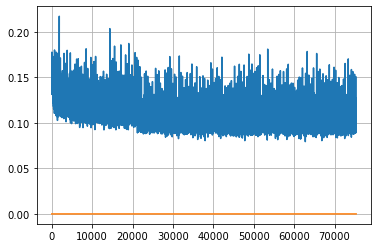

Epoch: 194, iteration 0, loss 0.09886232018470764, cov_diff 0.4203060441251981 cov_diff train 0.41954584186037386
Epoch: 194, iteration 1, loss 0.09090706706047058, cov_diff 0.41005987656770565 cov_diff train 0.40919257156545963
Epoch: 194, iteration 2, loss 0.10773128271102905, cov_diff 0.4192156166612806 cov_diff train 0.4179529845370514
Epoch: 194, iteration 3, loss 0.10085830092430115, cov_diff 0.40758614195727505 cov_diff train 0.4058494315288449
Epoch: 194, iteration 4, loss 0.10435563325881958, cov_diff 0.42643945581334314 cov_diff train 0.4253508606903344
Epoch: 194, iteration 5, loss 0.11890363693237305, cov_diff 0.4229221934306327 cov_diff train 0.42118239498776644
Epoch: 194, iteration 6, loss 0.12199383974075317, cov_diff 0.4213700640465321 cov_diff train 0.4207312592929188
Epoch: 194, iteration 7, loss 0.10360470414161682, cov_diff 0.41284315558179974 cov_diff train 0.41145363559010417
Epoch: 194, iteration 8, loss 0.10353690385818481, cov_diff 0.38898424195328457 cov_diff

Epoch: 194, iteration 79, loss 0.10590216517448425, cov_diff 0.4186801222350203 cov_diff train 0.4177256007881083
Epoch: 194, iteration 80, loss 0.10532185435295105, cov_diff 0.41329653754939805 cov_diff train 0.41225431164924714
Epoch: 194, iteration 81, loss 0.10636276006698608, cov_diff 0.4121567335678922 cov_diff train 0.4118253434125863
Epoch: 194, iteration 82, loss 0.0999249517917633, cov_diff 0.4056804500113089 cov_diff train 0.40528432985887275
Epoch: 194, iteration 83, loss 0.105506032705307, cov_diff 0.42865049290945895 cov_diff train 0.42774654549415697
Epoch: 194, iteration 84, loss 0.10459521412849426, cov_diff 0.40948224375605036 cov_diff train 0.40888719735315215
Epoch: 194, iteration 85, loss 0.09401389956474304, cov_diff 0.4127589135794948 cov_diff train 0.4125155618548037
Epoch: 194, iteration 86, loss 0.11158952116966248, cov_diff 0.4150953890305316 cov_diff train 0.4140430183513908
Epoch: 194, iteration 87, loss 0.11359527707099915, cov_diff 0.41000905239296354 cov

Epoch: 194, iteration 154, loss 0.10591426491737366, cov_diff 0.4068222635158468 cov_diff train 0.4070251989542594
Epoch: 194, iteration 155, loss 0.10873174667358398, cov_diff 0.40961906374601365 cov_diff train 0.40983504073476335
Epoch: 194, iteration 156, loss 0.10627543926239014, cov_diff 0.41012507498731643 cov_diff train 0.4103538531829704
Epoch: 194, iteration 157, loss 0.0932493507862091, cov_diff 0.4105445128616565 cov_diff train 0.4101747104244882
Epoch: 194, iteration 158, loss 0.10121452808380127, cov_diff 0.4141523830299535 cov_diff train 0.4137709263515008
Epoch: 194, iteration 159, loss 0.10437726974487305, cov_diff 0.41776892348169464 cov_diff train 0.4171867785640005
Epoch: 194, iteration 160, loss 0.1149435043334961, cov_diff 0.42671778778151725 cov_diff train 0.42640181918798115
Epoch: 194, iteration 161, loss 0.0947309136390686, cov_diff 0.4279147000007251 cov_diff train 0.4278577842142947
Epoch: 194, iteration 162, loss 0.10680174827575684, cov_diff 0.4236671697705

Epoch: 194, iteration 230, loss 0.10054925084114075, cov_diff 0.4321139772384957 cov_diff train 0.4309834372131569
Epoch: 194, iteration 231, loss 0.10432198643684387, cov_diff 0.4093736657811918 cov_diff train 0.40826959659939394
Epoch: 194, iteration 232, loss 0.10502037405967712, cov_diff 0.3981710550820244 cov_diff train 0.39810302229703254
Epoch: 194, iteration 233, loss 0.11342659592628479, cov_diff 0.41312969189648263 cov_diff train 0.41100796328423944
Epoch: 194, iteration 234, loss 0.1145697832107544, cov_diff 0.39107290230417835 cov_diff train 0.39075608578365817
Epoch: 194, iteration 235, loss 0.09956255555152893, cov_diff 0.41418030331916783 cov_diff train 0.4139303996026437
Epoch: 194, iteration 236, loss 0.10208728909492493, cov_diff 0.41434917735518895 cov_diff train 0.4143378175908947
Epoch: 194, iteration 237, loss 0.11286836862564087, cov_diff 0.40751909959566684 cov_diff train 0.4090915703267233
Epoch: 194, iteration 238, loss 0.10939422249794006, cov_diff 0.40482987

Epoch: 194, iteration 310, loss 0.10266134142875671, cov_diff 0.4293197639448997 cov_diff train 0.42839528072270516
Epoch: 194, iteration 311, loss 0.08898621797561646, cov_diff 0.40500998235310787 cov_diff train 0.4046406755037592
Epoch: 194, iteration 312, loss 0.1057911217212677, cov_diff 0.4191413619062571 cov_diff train 0.41792345241557166
Epoch: 194, iteration 313, loss 0.10961291193962097, cov_diff 0.41185424348788835 cov_diff train 0.4109398990126607
Epoch: 194, iteration 314, loss 0.1074502170085907, cov_diff 0.40787806752334455 cov_diff train 0.4074719943331138
Epoch: 194, iteration 315, loss 0.09682959318161011, cov_diff 0.41760306325016844 cov_diff train 0.41695952319351487
Epoch: 194, iteration 316, loss 0.10214158892631531, cov_diff 0.41031700713994845 cov_diff train 0.4097500413519639
Epoch: 194, iteration 317, loss 0.1030084490776062, cov_diff 0.4320743222721768 cov_diff train 0.43040796511152507
Epoch: 194, iteration 318, loss 0.09538817405700684, cov_diff 0.3997392191

Epoch: 194, iteration 387, loss 0.10839453339576721, cov_diff 0.4160900327614071 cov_diff train 0.4150924307112818
Epoch: 194, iteration 388, loss 0.1025550365447998, cov_diff 0.4067101511674122 cov_diff train 0.40628625002665436
Epoch: 194, iteration 389, loss 0.11513146758079529, cov_diff 0.39938460428079475 cov_diff train 0.3990061520021154
Epoch: 194, iteration 390, loss 0.15340936183929443, cov_diff 0.46478043001026215 cov_diff train 0.4650224348997625


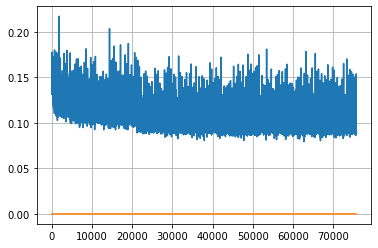

Epoch: 195, iteration 0, loss 0.10455280542373657, cov_diff 0.41026807824425177 cov_diff train 0.40944133484887996
Epoch: 195, iteration 1, loss 0.10187387466430664, cov_diff 0.4152090332426561 cov_diff train 0.4148630178605294
Epoch: 195, iteration 2, loss 0.10416442155838013, cov_diff 0.4121811751054037 cov_diff train 0.41043538835134014
Epoch: 195, iteration 3, loss 0.10284405946731567, cov_diff 0.413660529009755 cov_diff train 0.41313801940439554
Epoch: 195, iteration 4, loss 0.1014215350151062, cov_diff 0.4023956859639055 cov_diff train 0.4014174213591955
Epoch: 195, iteration 5, loss 0.10172116756439209, cov_diff 0.4158755685323964 cov_diff train 0.4146304561976638
Epoch: 195, iteration 6, loss 0.0970085859298706, cov_diff 0.40830599864002876 cov_diff train 0.4079201670349363
Epoch: 195, iteration 7, loss 0.09914129972457886, cov_diff 0.3941413307073781 cov_diff train 0.39402138186395036
Epoch: 195, iteration 8, loss 0.09970360994338989, cov_diff 0.41709614700908787 cov_diff trai

Epoch: 195, iteration 77, loss 0.10919103026390076, cov_diff 0.4156222798621855 cov_diff train 0.4154442784803627
Epoch: 195, iteration 78, loss 0.10552695393562317, cov_diff 0.4185125782400161 cov_diff train 0.4179552555581633
Epoch: 195, iteration 79, loss 0.10513252019882202, cov_diff 0.41712382490482963 cov_diff train 0.41715662275340704
Epoch: 195, iteration 80, loss 0.10903048515319824, cov_diff 0.41043153789913966 cov_diff train 0.41014192635329855
Epoch: 195, iteration 81, loss 0.09935757517814636, cov_diff 0.4224512854183216 cov_diff train 0.4210842695441326
Epoch: 195, iteration 82, loss 0.10478124022483826, cov_diff 0.4079829594058844 cov_diff train 0.40712809802256233
Epoch: 195, iteration 83, loss 0.0997127890586853, cov_diff 0.41638793474010877 cov_diff train 0.41557673370235165
Epoch: 195, iteration 84, loss 0.1063244640827179, cov_diff 0.42022635601295033 cov_diff train 0.4199222722513996
Epoch: 195, iteration 85, loss 0.0929267406463623, cov_diff 0.4339371293186901 cov

Epoch: 195, iteration 154, loss 0.11149901151657104, cov_diff 0.4106340236249906 cov_diff train 0.41013833921244547
Epoch: 195, iteration 155, loss 0.1053142249584198, cov_diff 0.41267860748747415 cov_diff train 0.4115537217397104
Epoch: 195, iteration 156, loss 0.09993693232536316, cov_diff 0.4148081725391289 cov_diff train 0.4130765158391222
Epoch: 195, iteration 157, loss 0.10775282979011536, cov_diff 0.4251324218664308 cov_diff train 0.42409797089229917
Epoch: 195, iteration 158, loss 0.09671682119369507, cov_diff 0.4220561609075172 cov_diff train 0.42123113988209343
Epoch: 195, iteration 159, loss 0.10035541653633118, cov_diff 0.42849939779451673 cov_diff train 0.4276836836225099
Epoch: 195, iteration 160, loss 0.10962709784507751, cov_diff 0.4268588907330479 cov_diff train 0.42578882360338943
Epoch: 195, iteration 161, loss 0.10800197720527649, cov_diff 0.4140752089295777 cov_diff train 0.4132315478236012
Epoch: 195, iteration 162, loss 0.10346728563308716, cov_diff 0.41181132594

Epoch: 195, iteration 231, loss 0.1114836037158966, cov_diff 0.4044120792499046 cov_diff train 0.4034900923598985
Epoch: 195, iteration 232, loss 0.1126338541507721, cov_diff 0.4088542027955195 cov_diff train 0.408066074037424
Epoch: 195, iteration 233, loss 0.11101040244102478, cov_diff 0.4138013890036773 cov_diff train 0.4138372297403032
Epoch: 195, iteration 234, loss 0.09844517707824707, cov_diff 0.4015037122930958 cov_diff train 0.40089365979846425
Epoch: 195, iteration 235, loss 0.10118967294692993, cov_diff 0.41189522225320574 cov_diff train 0.4107448854863269
Epoch: 195, iteration 236, loss 0.10911443829536438, cov_diff 0.4257837875176301 cov_diff train 0.4245028737308841
Epoch: 195, iteration 237, loss 0.10073825716972351, cov_diff 0.40981046013463396 cov_diff train 0.4098225306880695
Epoch: 195, iteration 238, loss 0.11045068502426147, cov_diff 0.4101597053439439 cov_diff train 0.4089085995740873
Epoch: 195, iteration 239, loss 0.09183114767074585, cov_diff 0.4030692447728128

Epoch: 195, iteration 308, loss 0.11189335584640503, cov_diff 0.4007895210080615 cov_diff train 0.40072639606113125
Epoch: 195, iteration 309, loss 0.10200905799865723, cov_diff 0.41389237080645774 cov_diff train 0.4133017988183492
Epoch: 195, iteration 310, loss 0.10818299651145935, cov_diff 0.413295005017067 cov_diff train 0.41276926972314293
Epoch: 195, iteration 311, loss 0.09725609421730042, cov_diff 0.4207953243939895 cov_diff train 0.42035257634961964
Epoch: 195, iteration 312, loss 0.10356661677360535, cov_diff 0.4146414533980383 cov_diff train 0.413177038836004
Epoch: 195, iteration 313, loss 0.11272451281547546, cov_diff 0.41974175272681297 cov_diff train 0.4196436306055136
Epoch: 195, iteration 314, loss 0.10121867060661316, cov_diff 0.4091752842606968 cov_diff train 0.40802485050437837
Epoch: 195, iteration 315, loss 0.1048363447189331, cov_diff 0.40792860019140337 cov_diff train 0.4069978720973468
Epoch: 195, iteration 316, loss 0.10189428925514221, cov_diff 0.404496564406

Epoch: 195, iteration 385, loss 0.10306611657142639, cov_diff 0.41328758387407327 cov_diff train 0.4131558271789892
Epoch: 195, iteration 386, loss 0.09477630257606506, cov_diff 0.4165169438782508 cov_diff train 0.4158157237751119
Epoch: 195, iteration 387, loss 0.09644418954849243, cov_diff 0.4199043848232903 cov_diff train 0.41968958628134007
Epoch: 195, iteration 388, loss 0.10420742630958557, cov_diff 0.4249937538380528 cov_diff train 0.42415329038501653
Epoch: 195, iteration 389, loss 0.10248789191246033, cov_diff 0.42904953162941606 cov_diff train 0.42806673521902155
Epoch: 195, iteration 390, loss 0.16762781143188477, cov_diff 0.4640600483375164 cov_diff train 0.46421980011787367


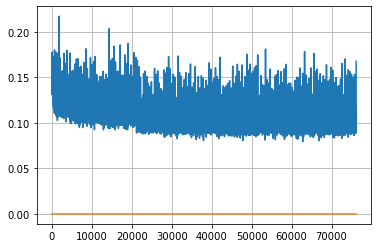

Epoch: 196, iteration 0, loss 0.10872751474380493, cov_diff 0.4125331553116384 cov_diff train 0.4130728000421163
Epoch: 196, iteration 1, loss 0.09600037336349487, cov_diff 0.42013501825356336 cov_diff train 0.4198614494377129
Epoch: 196, iteration 2, loss 0.10562288761138916, cov_diff 0.41699439843191466 cov_diff train 0.41654108741934115
Epoch: 196, iteration 3, loss 0.09712901711463928, cov_diff 0.4055572976835172 cov_diff train 0.4055166333050534
Epoch: 196, iteration 4, loss 0.10947254300117493, cov_diff 0.41082183084714496 cov_diff train 0.4109639018056768
Epoch: 196, iteration 5, loss 0.09417834877967834, cov_diff 0.4118073968492787 cov_diff train 0.41169717213478957
Epoch: 196, iteration 6, loss 0.09542346000671387, cov_diff 0.40867180882691717 cov_diff train 0.4085997531371804
Epoch: 196, iteration 7, loss 0.10523298382759094, cov_diff 0.4150896298817534 cov_diff train 0.4144553294553493
Epoch: 196, iteration 8, loss 0.09836253523826599, cov_diff 0.4199439630370829 cov_diff tr

Epoch: 196, iteration 76, loss 0.10737493634223938, cov_diff 0.41509255437656006 cov_diff train 0.41449312588359166
Epoch: 196, iteration 77, loss 0.10923394560813904, cov_diff 0.41315306057946155 cov_diff train 0.4129565404644397
Epoch: 196, iteration 78, loss 0.0954650342464447, cov_diff 0.40881113092136256 cov_diff train 0.4081026568730791
Epoch: 196, iteration 79, loss 0.10724949836730957, cov_diff 0.4070793256460224 cov_diff train 0.4042918366571141
Epoch: 196, iteration 80, loss 0.11118194460868835, cov_diff 0.41232389930907115 cov_diff train 0.41113808073219804
Epoch: 196, iteration 81, loss 0.10821095108985901, cov_diff 0.39645881456697435 cov_diff train 0.39620796545942566
Epoch: 196, iteration 82, loss 0.10183495283126831, cov_diff 0.42097154394322744 cov_diff train 0.4184029102675444
Epoch: 196, iteration 83, loss 0.10023477673530579, cov_diff 0.4066948633610566 cov_diff train 0.4063884214490482
Epoch: 196, iteration 84, loss 0.08924868702888489, cov_diff 0.4112210149874519 

Epoch: 196, iteration 153, loss 0.1050814688205719, cov_diff 0.41572615229554855 cov_diff train 0.4152603962003642
Epoch: 196, iteration 154, loss 0.09445688128471375, cov_diff 0.41464663342142377 cov_diff train 0.4142334421475107
Epoch: 196, iteration 155, loss 0.12019935250282288, cov_diff 0.4041091150402634 cov_diff train 0.40228977736818494
Epoch: 196, iteration 156, loss 0.10082319378852844, cov_diff 0.41536147104047694 cov_diff train 0.4140716660232631
Epoch: 196, iteration 157, loss 0.09946250915527344, cov_diff 0.4027399698853398 cov_diff train 0.4014273932590718
Epoch: 196, iteration 158, loss 0.1178753674030304, cov_diff 0.41506762664349306 cov_diff train 0.41474157395934935
Epoch: 196, iteration 159, loss 0.10188418626785278, cov_diff 0.4150181461338411 cov_diff train 0.4134756887509371
Epoch: 196, iteration 160, loss 0.1257452368736267, cov_diff 0.4232193285995053 cov_diff train 0.4217614189049088
Epoch: 196, iteration 161, loss 0.1035231351852417, cov_diff 0.41370731078432

Epoch: 196, iteration 230, loss 0.10575699806213379, cov_diff 0.4134771001523879 cov_diff train 0.412461799985293
Epoch: 196, iteration 231, loss 0.10117033123970032, cov_diff 0.4222556017879285 cov_diff train 0.42139527047700837
Epoch: 196, iteration 232, loss 0.10094362497329712, cov_diff 0.4126876234809161 cov_diff train 0.4112875463467992
Epoch: 196, iteration 233, loss 0.09981980919837952, cov_diff 0.40428907376019285 cov_diff train 0.4046182095589474
Epoch: 196, iteration 234, loss 0.096951425075531, cov_diff 0.4100848891942757 cov_diff train 0.40913574187752816
Epoch: 196, iteration 235, loss 0.09360715746879578, cov_diff 0.42062925894449144 cov_diff train 0.41942345676799986
Epoch: 196, iteration 236, loss 0.08734622597694397, cov_diff 0.4081320151173441 cov_diff train 0.40731547583862904
Epoch: 196, iteration 237, loss 0.09395763278007507, cov_diff 0.41259895324935353 cov_diff train 0.4125947367198427
Epoch: 196, iteration 238, loss 0.10259249806404114, cov_diff 0.403651714921

Epoch: 196, iteration 308, loss 0.09917959570884705, cov_diff 0.4336211085531958 cov_diff train 0.4324763706360444
Epoch: 196, iteration 309, loss 0.10461348295211792, cov_diff 0.4224066316198268 cov_diff train 0.42204980714083973
Epoch: 196, iteration 310, loss 0.10214817523956299, cov_diff 0.4120354103193949 cov_diff train 0.41201883498994596
Epoch: 196, iteration 311, loss 0.11638429760932922, cov_diff 0.41401882712795746 cov_diff train 0.41249615368947434
Epoch: 196, iteration 312, loss 0.10696089267730713, cov_diff 0.4182819107812354 cov_diff train 0.4183816059232413
Epoch: 196, iteration 313, loss 0.09679126739501953, cov_diff 0.41762380663570803 cov_diff train 0.41691677742024513
Epoch: 196, iteration 314, loss 0.10433688759803772, cov_diff 0.4258514396971626 cov_diff train 0.4248761482332451
Epoch: 196, iteration 315, loss 0.10134446620941162, cov_diff 0.4112352959955765 cov_diff train 0.4109248399518365
Epoch: 196, iteration 316, loss 0.11078041791915894, cov_diff 0.4264548209

Epoch: 196, iteration 385, loss 0.11539790034294128, cov_diff 0.4191740290154858 cov_diff train 0.41865621348097426
Epoch: 196, iteration 386, loss 0.10496985912322998, cov_diff 0.4131845058417888 cov_diff train 0.41311892919475535
Epoch: 196, iteration 387, loss 0.11747947335243225, cov_diff 0.4041973105433228 cov_diff train 0.40427486625897663
Epoch: 196, iteration 388, loss 0.11913594603538513, cov_diff 0.4077565948932054 cov_diff train 0.40726849083732036
Epoch: 196, iteration 389, loss 0.10487005114555359, cov_diff 0.4021773102453793 cov_diff train 0.4018459535917809
Epoch: 196, iteration 390, loss 0.15323925018310547, cov_diff 0.4343682610083444 cov_diff train 0.43611803806809846


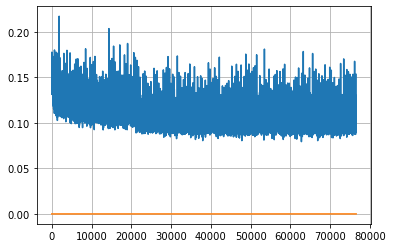

Epoch: 197, iteration 0, loss 0.10680955648422241, cov_diff 0.4112828923080858 cov_diff train 0.4103893173022521
Epoch: 197, iteration 1, loss 0.10060581564903259, cov_diff 0.41767278460860685 cov_diff train 0.41753128934467554
Epoch: 197, iteration 2, loss 0.09977936744689941, cov_diff 0.4025115063261444 cov_diff train 0.4029824024382736
Epoch: 197, iteration 3, loss 0.10555317997932434, cov_diff 0.41120326157932247 cov_diff train 0.41141035988379493
Epoch: 197, iteration 4, loss 0.10305100679397583, cov_diff 0.40335798917763066 cov_diff train 0.40464236218770666
Epoch: 197, iteration 5, loss 0.09823811054229736, cov_diff 0.39717613232543264 cov_diff train 0.3968028077798603
Epoch: 197, iteration 6, loss 0.09496501088142395, cov_diff 0.4082498734600494 cov_diff train 0.4082588566011766
Epoch: 197, iteration 7, loss 0.1071225106716156, cov_diff 0.4231636213119465 cov_diff train 0.4237917030022118
Epoch: 197, iteration 8, loss 0.09909746050834656, cov_diff 0.4170572166943859 cov_diff tr

Epoch: 197, iteration 80, loss 0.09474813938140869, cov_diff 0.41935954359604105 cov_diff train 0.4175841203392057
Epoch: 197, iteration 81, loss 0.10028526186943054, cov_diff 0.4225020904162446 cov_diff train 0.4218672831271235
Epoch: 197, iteration 82, loss 0.11548790335655212, cov_diff 0.4138724099475784 cov_diff train 0.41364900877128075
Epoch: 197, iteration 83, loss 0.09809800982475281, cov_diff 0.410532715192097 cov_diff train 0.4097889137464022
Epoch: 197, iteration 84, loss 0.09473106265068054, cov_diff 0.40901715419184687 cov_diff train 0.4077839671007301
Epoch: 197, iteration 85, loss 0.10460728406906128, cov_diff 0.3975199890758674 cov_diff train 0.3965977488813193
Epoch: 197, iteration 86, loss 0.10398194193840027, cov_diff 0.42461643897995516 cov_diff train 0.4238536530333485
Epoch: 197, iteration 87, loss 0.09323087334632874, cov_diff 0.4214304378095777 cov_diff train 0.42050265411245963
Epoch: 197, iteration 88, loss 0.10401502251625061, cov_diff 0.4271760159645762 cov_

Epoch: 197, iteration 153, loss 0.10267308354377747, cov_diff 0.4065105216077755 cov_diff train 0.40586263656339716
Epoch: 197, iteration 154, loss 0.09848234057426453, cov_diff 0.39989715484928984 cov_diff train 0.3988911022345525
Epoch: 197, iteration 155, loss 0.10790729522705078, cov_diff 0.4177272555043226 cov_diff train 0.4166328702100321
Epoch: 197, iteration 156, loss 0.1047087013721466, cov_diff 0.4246874696623943 cov_diff train 0.42386792794852834
Epoch: 197, iteration 157, loss 0.09821715950965881, cov_diff 0.40880391189319126 cov_diff train 0.4085350214227665
Epoch: 197, iteration 158, loss 0.10320776700973511, cov_diff 0.4201149079524292 cov_diff train 0.41937861593912096
Epoch: 197, iteration 159, loss 0.10295870900154114, cov_diff 0.408716911755017 cov_diff train 0.4081359449619295
Epoch: 197, iteration 160, loss 0.1089107096195221, cov_diff 0.40738078766195973 cov_diff train 0.40727040946229165
Epoch: 197, iteration 161, loss 0.09405091404914856, cov_diff 0.413222903993

Epoch: 197, iteration 229, loss 0.10097625851631165, cov_diff 0.41758080163883277 cov_diff train 0.41706186264419837
Epoch: 197, iteration 230, loss 0.11036035418510437, cov_diff 0.4001273790390156 cov_diff train 0.40007901901956283
Epoch: 197, iteration 231, loss 0.09322389960289001, cov_diff 0.42666403699912797 cov_diff train 0.4258156183709314
Epoch: 197, iteration 232, loss 0.09967437386512756, cov_diff 0.40643163389840875 cov_diff train 0.4061345946216911
Epoch: 197, iteration 233, loss 0.11170357465744019, cov_diff 0.4032136554306746 cov_diff train 0.40269875020451107
Epoch: 197, iteration 234, loss 0.1122642457485199, cov_diff 0.4146577683999308 cov_diff train 0.4144262353830694
Epoch: 197, iteration 235, loss 0.10895019769668579, cov_diff 0.39972164480592864 cov_diff train 0.3997687923505505
Epoch: 197, iteration 236, loss 0.09334003925323486, cov_diff 0.41905087494321586 cov_diff train 0.4189005474810413
Epoch: 197, iteration 237, loss 0.10700234770774841, cov_diff 0.407779083

Epoch: 197, iteration 303, loss 0.10038071870803833, cov_diff 0.4048479581946201 cov_diff train 0.4032246532164552
Epoch: 197, iteration 304, loss 0.10917797684669495, cov_diff 0.4044353880835422 cov_diff train 0.40374469512951555
Epoch: 197, iteration 305, loss 0.11323586106300354, cov_diff 0.41658557319140116 cov_diff train 0.4155838675566493
Epoch: 197, iteration 306, loss 0.1050073504447937, cov_diff 0.41968551168832013 cov_diff train 0.41905718331634856
Epoch: 197, iteration 307, loss 0.10930261015892029, cov_diff 0.4258795149454992 cov_diff train 0.4252456742263827
Epoch: 197, iteration 308, loss 0.10466054081916809, cov_diff 0.40900240574876084 cov_diff train 0.4085935011444656
Epoch: 197, iteration 309, loss 0.10096675157546997, cov_diff 0.4106988482308469 cov_diff train 0.4101929659386758
Epoch: 197, iteration 310, loss 0.09488654136657715, cov_diff 0.4190467347127454 cov_diff train 0.4185044864663075
Epoch: 197, iteration 311, loss 0.09310132265090942, cov_diff 0.434396102338

Epoch: 197, iteration 381, loss 0.1048429012298584, cov_diff 0.40970124672515085 cov_diff train 0.40934852546425704
Epoch: 197, iteration 382, loss 0.10700508952140808, cov_diff 0.42463263852109356 cov_diff train 0.4235983706284777
Epoch: 197, iteration 383, loss 0.10691261291503906, cov_diff 0.42599783508626216 cov_diff train 0.4244087975665518
Epoch: 197, iteration 384, loss 0.10643184185028076, cov_diff 0.4208421100952129 cov_diff train 0.4197669734246361
Epoch: 197, iteration 385, loss 0.10169112682342529, cov_diff 0.4245727055277112 cov_diff train 0.42282907773356265
Epoch: 197, iteration 386, loss 0.10104143619537354, cov_diff 0.42333943539882374 cov_diff train 0.42236306996928724
Epoch: 197, iteration 387, loss 0.10577985644340515, cov_diff 0.4219926866276026 cov_diff train 0.4205585302848099
Epoch: 197, iteration 388, loss 0.09590521454811096, cov_diff 0.42108920518507903 cov_diff train 0.41947719740465245
Epoch: 197, iteration 389, loss 0.1029801070690155, cov_diff 0.405890477

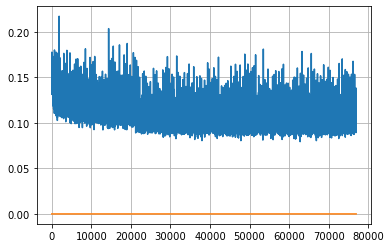

Epoch: 198, iteration 0, loss 0.10617831349372864, cov_diff 0.4192785740925177 cov_diff train 0.4184187538837353
Epoch: 198, iteration 1, loss 0.08863276243209839, cov_diff 0.4142627890168191 cov_diff train 0.4140303288174901
Epoch: 198, iteration 2, loss 0.12407737970352173, cov_diff 0.41731678136205436 cov_diff train 0.41625045306580116
Epoch: 198, iteration 3, loss 0.10808902978897095, cov_diff 0.4127906838751377 cov_diff train 0.4122510094663093
Epoch: 198, iteration 4, loss 0.0994703471660614, cov_diff 0.4040836670553486 cov_diff train 0.40274507535964416
Epoch: 198, iteration 5, loss 0.10681936144828796, cov_diff 0.41102828656201124 cov_diff train 0.40999681878355787
Epoch: 198, iteration 6, loss 0.10516238212585449, cov_diff 0.41915253517934337 cov_diff train 0.4181140563439734
Epoch: 198, iteration 7, loss 0.09790325164794922, cov_diff 0.4165291435451837 cov_diff train 0.4164559391526537
Epoch: 198, iteration 8, loss 0.10486069321632385, cov_diff 0.4174586180657825 cov_diff tra

Epoch: 198, iteration 77, loss 0.10017922520637512, cov_diff 0.4116386240733578 cov_diff train 0.41031419347995224
Epoch: 198, iteration 78, loss 0.11396393179893494, cov_diff 0.40232720591438587 cov_diff train 0.4019363152983175
Epoch: 198, iteration 79, loss 0.11670562624931335, cov_diff 0.4144972521697579 cov_diff train 0.4130034607643103
Epoch: 198, iteration 80, loss 0.10649919509887695, cov_diff 0.4125082220621517 cov_diff train 0.41129578694464175
Epoch: 198, iteration 81, loss 0.1095617413520813, cov_diff 0.4111864686715103 cov_diff train 0.41151632451596637
Epoch: 198, iteration 82, loss 0.09602272510528564, cov_diff 0.42708806126167165 cov_diff train 0.4269148661523079
Epoch: 198, iteration 83, loss 0.10731256008148193, cov_diff 0.4173578827548375 cov_diff train 0.4169471025557307
Epoch: 198, iteration 84, loss 0.11282822489738464, cov_diff 0.41853435815115153 cov_diff train 0.41840189479768364
Epoch: 198, iteration 85, loss 0.08424657583236694, cov_diff 0.40436674442136267 c

Epoch: 198, iteration 154, loss 0.10621228814125061, cov_diff 0.3942936689480739 cov_diff train 0.39403406290114235
Epoch: 198, iteration 155, loss 0.10867264866828918, cov_diff 0.4048195401623383 cov_diff train 0.4044295383656752
Epoch: 198, iteration 156, loss 0.10333308577537537, cov_diff 0.41149534390250087 cov_diff train 0.4106706101818681
Epoch: 198, iteration 157, loss 0.09643679857254028, cov_diff 0.396553826006953 cov_diff train 0.3954057165200221
Epoch: 198, iteration 158, loss 0.09323641657829285, cov_diff 0.40054216775107965 cov_diff train 0.4004202962037147
Epoch: 198, iteration 159, loss 0.11181804537773132, cov_diff 0.40680343695765053 cov_diff train 0.40757320046958234
Epoch: 198, iteration 160, loss 0.09806787967681885, cov_diff 0.404186424203208 cov_diff train 0.4044781569629869
Epoch: 198, iteration 161, loss 0.11007869243621826, cov_diff 0.395195924004524 cov_diff train 0.39419676345941046
Epoch: 198, iteration 162, loss 0.10071367025375366, cov_diff 0.4123779389164

Epoch: 198, iteration 235, loss 0.10244095325469971, cov_diff 0.42744582807968245 cov_diff train 0.4258704151122747
Epoch: 198, iteration 236, loss 0.10211339592933655, cov_diff 0.41237844863015 cov_diff train 0.4124663877424204
Epoch: 198, iteration 237, loss 0.1071111261844635, cov_diff 0.4096851434867847 cov_diff train 0.40913385090866855
Epoch: 198, iteration 238, loss 0.1031644344329834, cov_diff 0.4063164381401068 cov_diff train 0.40642386931923025
Epoch: 198, iteration 239, loss 0.10939118266105652, cov_diff 0.4138455381588427 cov_diff train 0.4129017503281943
Epoch: 198, iteration 240, loss 0.10191595554351807, cov_diff 0.4065126275819307 cov_diff train 0.40585314866481614
Epoch: 198, iteration 241, loss 0.1086851954460144, cov_diff 0.4090374236375765 cov_diff train 0.4088755288885679
Epoch: 198, iteration 242, loss 0.1160692572593689, cov_diff 0.42166431031067186 cov_diff train 0.4210549754739928
Epoch: 198, iteration 243, loss 0.1006571352481842, cov_diff 0.4247057492763039 c

Epoch: 198, iteration 311, loss 0.10520473122596741, cov_diff 0.40481197257079476 cov_diff train 0.40445220383962527
Epoch: 198, iteration 312, loss 0.10524320602416992, cov_diff 0.4153624347147245 cov_diff train 0.4142794080826089
Epoch: 198, iteration 313, loss 0.10684061050415039, cov_diff 0.42128337677143246 cov_diff train 0.4204271883061336
Epoch: 198, iteration 314, loss 0.10637220740318298, cov_diff 0.4225432541716805 cov_diff train 0.42194913135408757
Epoch: 198, iteration 315, loss 0.09749913215637207, cov_diff 0.4204194874203825 cov_diff train 0.4191077217508685
Epoch: 198, iteration 316, loss 0.10260409116744995, cov_diff 0.42028553301810095 cov_diff train 0.4195442914646221
Epoch: 198, iteration 317, loss 0.08922284841537476, cov_diff 0.40967513708428815 cov_diff train 0.4093230873082598
Epoch: 198, iteration 318, loss 0.10610803961753845, cov_diff 0.4161423974705983 cov_diff train 0.4159147223675409
Epoch: 198, iteration 319, loss 0.11033135652542114, cov_diff 0.4233118187

Epoch: 198, iteration 387, loss 0.10627955198287964, cov_diff 0.4039232276400093 cov_diff train 0.40296049480686386
Epoch: 198, iteration 388, loss 0.09854739904403687, cov_diff 0.41134180625909544 cov_diff train 0.4106150848704818
Epoch: 198, iteration 389, loss 0.11620426177978516, cov_diff 0.4305314704714535 cov_diff train 0.42977187152043134
Epoch: 198, iteration 390, loss 0.156482994556427, cov_diff 0.47396000947037475 cov_diff train 0.4729507866669306


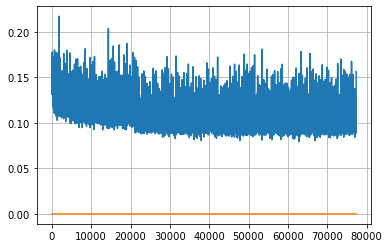

Epoch: 199, iteration 0, loss 0.09361448884010315, cov_diff 0.41318486520405967 cov_diff train 0.41253198855829804
Epoch: 199, iteration 1, loss 0.11561208963394165, cov_diff 0.42394752396305424 cov_diff train 0.4229895808929504
Epoch: 199, iteration 2, loss 0.10012906789779663, cov_diff 0.41696774016541516 cov_diff train 0.4161748561419054
Epoch: 199, iteration 3, loss 0.11739063262939453, cov_diff 0.4162878221581171 cov_diff train 0.416482261708613
Epoch: 199, iteration 4, loss 0.11226040124893188, cov_diff 0.40538270634961315 cov_diff train 0.4042743599511648
Epoch: 199, iteration 5, loss 0.108968585729599, cov_diff 0.4167021152132267 cov_diff train 0.4164916940559574
Epoch: 199, iteration 6, loss 0.09999620914459229, cov_diff 0.4200582741573696 cov_diff train 0.41886245242777054
Epoch: 199, iteration 7, loss 0.09305152297019958, cov_diff 0.4184041797131422 cov_diff train 0.4164148616597156
Epoch: 199, iteration 8, loss 0.10377496480941772, cov_diff 0.42115487673260465 cov_diff trai

Epoch: 199, iteration 77, loss 0.11068999767303467, cov_diff 0.409342324360258 cov_diff train 0.4099553950982084
Epoch: 199, iteration 78, loss 0.10500824451446533, cov_diff 0.4027468227843374 cov_diff train 0.4030957814929717
Epoch: 199, iteration 79, loss 0.10874414443969727, cov_diff 0.4153248856743069 cov_diff train 0.41489158742507487
Epoch: 199, iteration 80, loss 0.1105135977268219, cov_diff 0.41742715112663864 cov_diff train 0.41685031628117325
Epoch: 199, iteration 81, loss 0.09769091010093689, cov_diff 0.4173735145356216 cov_diff train 0.41706685569395086
Epoch: 199, iteration 82, loss 0.10718327760696411, cov_diff 0.42958041103240074 cov_diff train 0.4285536881944675
Epoch: 199, iteration 83, loss 0.10375332832336426, cov_diff 0.40357556258953914 cov_diff train 0.40339137724289986
Epoch: 199, iteration 84, loss 0.10189753770828247, cov_diff 0.40858750060088456 cov_diff train 0.4088434973686427
Epoch: 199, iteration 85, loss 0.10301727056503296, cov_diff 0.4076115229178394 co

Epoch: 199, iteration 153, loss 0.10198679566383362, cov_diff 0.4142772756542445 cov_diff train 0.4131834561116568
Epoch: 199, iteration 154, loss 0.10059738159179688, cov_diff 0.4337867797211027 cov_diff train 0.4318449755169496
Epoch: 199, iteration 155, loss 0.10399767756462097, cov_diff 0.4091020626825192 cov_diff train 0.40810421470815295
Epoch: 199, iteration 156, loss 0.09415388107299805, cov_diff 0.4162439915902234 cov_diff train 0.41554272573288065
Epoch: 199, iteration 157, loss 0.10236033797264099, cov_diff 0.4244121657103622 cov_diff train 0.4223006025590892
Epoch: 199, iteration 158, loss 0.11292076110839844, cov_diff 0.42598782473733937 cov_diff train 0.424750686598561
Epoch: 199, iteration 159, loss 0.10108545422554016, cov_diff 0.4244521284622312 cov_diff train 0.4223361886718056
Epoch: 199, iteration 160, loss 0.08900079131126404, cov_diff 0.39997736645151194 cov_diff train 0.39911330450252896
Epoch: 199, iteration 161, loss 0.08804181218147278, cov_diff 0.414252995559

Epoch: 199, iteration 231, loss 0.1008477509021759, cov_diff 0.41416461646813224 cov_diff train 0.41394316564140243
Epoch: 199, iteration 232, loss 0.10578227043151855, cov_diff 0.4064071260950074 cov_diff train 0.4060233222213944
Epoch: 199, iteration 233, loss 0.09896370768547058, cov_diff 0.42457847099565255 cov_diff train 0.42363435581491476
Epoch: 199, iteration 234, loss 0.10111340880393982, cov_diff 0.42409647169839204 cov_diff train 0.4219320994746018
Epoch: 199, iteration 235, loss 0.10302138328552246, cov_diff 0.42105369924360636 cov_diff train 0.41992621373428185
Epoch: 199, iteration 236, loss 0.11117497086524963, cov_diff 0.4187440183640597 cov_diff train 0.41746347056944266
Epoch: 199, iteration 237, loss 0.10544809699058533, cov_diff 0.41525485910483967 cov_diff train 0.4134809934517009
Epoch: 199, iteration 238, loss 0.096398264169693, cov_diff 0.42184665064852367 cov_diff train 0.42110097815871056
Epoch: 199, iteration 239, loss 0.09996846318244934, cov_diff 0.43111706

Epoch: 199, iteration 306, loss 0.11426371335983276, cov_diff 0.4164782642517135 cov_diff train 0.4158965550981333
Epoch: 199, iteration 307, loss 0.09443318843841553, cov_diff 0.4102874785015288 cov_diff train 0.4091242200599964
Epoch: 199, iteration 308, loss 0.10805130004882812, cov_diff 0.41388325043600127 cov_diff train 0.41357676957690803
Epoch: 199, iteration 309, loss 0.11423304677009583, cov_diff 0.4115842648618026 cov_diff train 0.41105659895744445
Epoch: 199, iteration 310, loss 0.11354237794876099, cov_diff 0.4135478890356952 cov_diff train 0.41331303174718204
Epoch: 199, iteration 311, loss 0.10049888491630554, cov_diff 0.4132448549510497 cov_diff train 0.413512574471159
Epoch: 199, iteration 312, loss 0.11802402138710022, cov_diff 0.41027840852877423 cov_diff train 0.4091761407998968
Epoch: 199, iteration 313, loss 0.1043698787689209, cov_diff 0.4152451559560048 cov_diff train 0.4155015661547051
Epoch: 199, iteration 314, loss 0.10998940467834473, cov_diff 0.4116785201946

Epoch: 199, iteration 381, loss 0.10196545720100403, cov_diff 0.4203874723425277 cov_diff train 0.4192550223680568
Epoch: 199, iteration 382, loss 0.11463773250579834, cov_diff 0.4133834976128612 cov_diff train 0.4131540553436584
Epoch: 199, iteration 383, loss 0.10113862156867981, cov_diff 0.3999825392543752 cov_diff train 0.39975127571048263
Epoch: 199, iteration 384, loss 0.10046985745429993, cov_diff 0.4114244456282809 cov_diff train 0.4119081189551717
Epoch: 199, iteration 385, loss 0.09803304076194763, cov_diff 0.3984875009809474 cov_diff train 0.39809273012464186
Epoch: 199, iteration 386, loss 0.12351098656654358, cov_diff 0.41540628068385277 cov_diff train 0.41604469190023086
Epoch: 199, iteration 387, loss 0.10735279321670532, cov_diff 0.40414018594520346 cov_diff train 0.4039287472287015
Epoch: 199, iteration 388, loss 0.10637977719306946, cov_diff 0.4055979200932513 cov_diff train 0.4061054480239605
Epoch: 199, iteration 389, loss 0.10309824347496033, cov_diff 0.40762389330

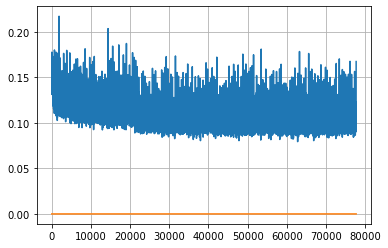

Epoch: 200, iteration 0, loss 0.0971648097038269, cov_diff 0.4166469955525711 cov_diff train 0.4158742522470336
Epoch: 200, iteration 1, loss 0.11777907609939575, cov_diff 0.42567153327606677 cov_diff train 0.42427363576792515
Epoch: 200, iteration 2, loss 0.10283902287483215, cov_diff 0.4153280445229203 cov_diff train 0.41490983763743544
Epoch: 200, iteration 3, loss 0.10565260052680969, cov_diff 0.4141672019385035 cov_diff train 0.4139755413546405
Epoch: 200, iteration 4, loss 0.10368901491165161, cov_diff 0.4243890161884737 cov_diff train 0.4242310826455797
Epoch: 200, iteration 5, loss 0.09540781378746033, cov_diff 0.40667643369584217 cov_diff train 0.4069102781219799
Epoch: 200, iteration 6, loss 0.10334253311157227, cov_diff 0.40979049399613277 cov_diff train 0.4094632548862211
Epoch: 200, iteration 7, loss 0.09705039858818054, cov_diff 0.41255499079258157 cov_diff train 0.41201360868049186
Epoch: 200, iteration 8, loss 0.10853388905525208, cov_diff 0.4094121861556438 cov_diff tr

Epoch: 200, iteration 75, loss 0.10171079635620117, cov_diff 0.4061135923827141 cov_diff train 0.4060219878477799
Epoch: 200, iteration 76, loss 0.11160311102867126, cov_diff 0.41068906913897163 cov_diff train 0.4101357562029822
Epoch: 200, iteration 77, loss 0.10555201768875122, cov_diff 0.40876565861619374 cov_diff train 0.4088773742563126
Epoch: 200, iteration 78, loss 0.10423499345779419, cov_diff 0.4205974351056038 cov_diff train 0.4208672533103434
Epoch: 200, iteration 79, loss 0.10436257719993591, cov_diff 0.4101974111095206 cov_diff train 0.4097496238474724
Epoch: 200, iteration 80, loss 0.09296467900276184, cov_diff 0.41328117922847285 cov_diff train 0.41369072674049
Epoch: 200, iteration 81, loss 0.09670639038085938, cov_diff 0.4217059575876214 cov_diff train 0.421889727120765
Epoch: 200, iteration 82, loss 0.10618489980697632, cov_diff 0.41624670186742496 cov_diff train 0.4156460490870194
Epoch: 200, iteration 83, loss 0.11070859432220459, cov_diff 0.4246516127327989 cov_dif

Epoch: 200, iteration 152, loss 0.099327951669693, cov_diff 0.4047128791484601 cov_diff train 0.40429621581187425
Epoch: 200, iteration 153, loss 0.09303802251815796, cov_diff 0.409482914457714 cov_diff train 0.40919943344073373
Epoch: 200, iteration 154, loss 0.11370635032653809, cov_diff 0.3983654980387719 cov_diff train 0.3980232155809852
Epoch: 200, iteration 155, loss 0.09659510850906372, cov_diff 0.400176734204551 cov_diff train 0.3996418042756693
Epoch: 200, iteration 156, loss 0.11188498139381409, cov_diff 0.40816028951283984 cov_diff train 0.4074123822559902
Epoch: 200, iteration 157, loss 0.1090574860572815, cov_diff 0.406565687739439 cov_diff train 0.4060589924114846
Epoch: 200, iteration 158, loss 0.09130188822746277, cov_diff 0.40818092490885277 cov_diff train 0.4079953936529105
Epoch: 200, iteration 159, loss 0.09804177284240723, cov_diff 0.40903923404416864 cov_diff train 0.40924861645486843
Epoch: 200, iteration 160, loss 0.10254135727882385, cov_diff 0.4029278342312132

Epoch: 200, iteration 228, loss 0.09997466206550598, cov_diff 0.40622149642324407 cov_diff train 0.40542539512357234
Epoch: 200, iteration 229, loss 0.11062183976173401, cov_diff 0.3817610325563642 cov_diff train 0.3816422410696573
Epoch: 200, iteration 230, loss 0.10444033145904541, cov_diff 0.4113428722771789 cov_diff train 0.41113768762400077
Epoch: 200, iteration 231, loss 0.10337167978286743, cov_diff 0.4098037841049821 cov_diff train 0.4103691616091102
Epoch: 200, iteration 232, loss 0.09790408611297607, cov_diff 0.409983724446551 cov_diff train 0.40924479417956744
Epoch: 200, iteration 233, loss 0.10305202007293701, cov_diff 0.4029138838095075 cov_diff train 0.40312384093931874
Epoch: 200, iteration 234, loss 0.10056549310684204, cov_diff 0.4074053542989278 cov_diff train 0.4073746127336933
Epoch: 200, iteration 235, loss 0.11539334058761597, cov_diff 0.4115930497496443 cov_diff train 0.41163726670551276
Epoch: 200, iteration 236, loss 0.10196167230606079, cov_diff 0.40966241516

Epoch: 200, iteration 306, loss 0.09901446104049683, cov_diff 0.3989765196318826 cov_diff train 0.39879470229111774
Epoch: 200, iteration 307, loss 0.10477152466773987, cov_diff 0.4067022436166021 cov_diff train 0.4055630331797307
Epoch: 200, iteration 308, loss 0.10937446355819702, cov_diff 0.4037528154095732 cov_diff train 0.4029460660645746
Epoch: 200, iteration 309, loss 0.11757141351699829, cov_diff 0.4115741907207685 cov_diff train 0.41130548072297046
Epoch: 200, iteration 310, loss 0.11745497584342957, cov_diff 0.43124420730470187 cov_diff train 0.43008746261526526
Epoch: 200, iteration 311, loss 0.11054658889770508, cov_diff 0.42370433377528294 cov_diff train 0.42324606436193357
Epoch: 200, iteration 312, loss 0.10836094617843628, cov_diff 0.42260959035326234 cov_diff train 0.42215920879257274
Epoch: 200, iteration 313, loss 0.10962146520614624, cov_diff 0.41468663943206086 cov_diff train 0.4140210719134534
Epoch: 200, iteration 314, loss 0.10220426321029663, cov_diff 0.4080295

Epoch: 200, iteration 382, loss 0.09979251027107239, cov_diff 0.4203057101619989 cov_diff train 0.4198924962541547
Epoch: 200, iteration 383, loss 0.08973103761672974, cov_diff 0.4048815868182865 cov_diff train 0.404669417837916
Epoch: 200, iteration 384, loss 0.10611867904663086, cov_diff 0.40842292471443736 cov_diff train 0.40792761156149576
Epoch: 200, iteration 385, loss 0.09701517224311829, cov_diff 0.41254657255114674 cov_diff train 0.4119344821043873
Epoch: 200, iteration 386, loss 0.11076676845550537, cov_diff 0.4171046015933801 cov_diff train 0.4163065680395771
Epoch: 200, iteration 387, loss 0.09773397445678711, cov_diff 0.4192813189716094 cov_diff train 0.4188611317208778
Epoch: 200, iteration 388, loss 0.10761392116546631, cov_diff 0.4119792476886049 cov_diff train 0.41150286274216374
Epoch: 200, iteration 389, loss 0.09954366087913513, cov_diff 0.4251497349101185 cov_diff train 0.42484848340853415
Epoch: 200, iteration 390, loss 0.14294403791427612, cov_diff 0.461206937192

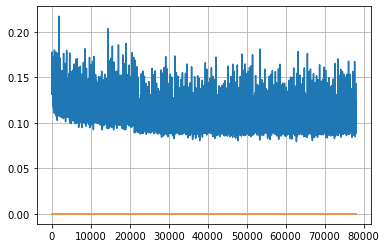

Epoch: 201, iteration 0, loss 0.10924005508422852, cov_diff 0.4154722898007206 cov_diff train 0.4145812747313742
Epoch: 201, iteration 1, loss 0.09933310747146606, cov_diff 0.40495301056657623 cov_diff train 0.4047305273251813
Epoch: 201, iteration 2, loss 0.09990307688713074, cov_diff 0.40828218380904896 cov_diff train 0.40852963313765067
Epoch: 201, iteration 3, loss 0.11098894476890564, cov_diff 0.4145296082840349 cov_diff train 0.41337607500505924
Epoch: 201, iteration 4, loss 0.1104421317577362, cov_diff 0.40581179549149093 cov_diff train 0.40510526177113776
Epoch: 201, iteration 5, loss 0.0905834436416626, cov_diff 0.4050102819545436 cov_diff train 0.40458122604899566
Epoch: 201, iteration 6, loss 0.10059177875518799, cov_diff 0.41700044763856087 cov_diff train 0.41718628165114835
Epoch: 201, iteration 7, loss 0.09952515363693237, cov_diff 0.4175323952422436 cov_diff train 0.41744337624197725
Epoch: 201, iteration 8, loss 0.09584453701972961, cov_diff 0.40981231538536994 cov_diff

Epoch: 201, iteration 75, loss 0.09452152252197266, cov_diff 0.41482658171152453 cov_diff train 0.4144317908857779
Epoch: 201, iteration 76, loss 0.10173928737640381, cov_diff 0.39785187453957865 cov_diff train 0.397040937111307
Epoch: 201, iteration 77, loss 0.09632143378257751, cov_diff 0.4293387110798658 cov_diff train 0.4285998357612919
Epoch: 201, iteration 78, loss 0.10764792561531067, cov_diff 0.39727324050128016 cov_diff train 0.39715301244765333
Epoch: 201, iteration 79, loss 0.10443109273910522, cov_diff 0.4141272805944128 cov_diff train 0.41423257697728777
Epoch: 201, iteration 80, loss 0.10435587167739868, cov_diff 0.4286104812080017 cov_diff train 0.4286188456466148
Epoch: 201, iteration 81, loss 0.10411283373832703, cov_diff 0.42523649000072844 cov_diff train 0.42490901794879676
Epoch: 201, iteration 82, loss 0.11134251952171326, cov_diff 0.41785759803663197 cov_diff train 0.4175058873980429
Epoch: 201, iteration 83, loss 0.10005155205726624, cov_diff 0.42379602749970013 

Epoch: 201, iteration 154, loss 0.10930722951889038, cov_diff 0.42020894623118027 cov_diff train 0.4184843751291953
Epoch: 201, iteration 155, loss 0.09982803463935852, cov_diff 0.4089108942888669 cov_diff train 0.40794842765195405
Epoch: 201, iteration 156, loss 0.0995444655418396, cov_diff 0.42501473725310673 cov_diff train 0.42448424548590147
Epoch: 201, iteration 157, loss 0.10067322850227356, cov_diff 0.4240083790727684 cov_diff train 0.42297754971156976
Epoch: 201, iteration 158, loss 0.09388753771781921, cov_diff 0.41112481181830685 cov_diff train 0.4097782687914283
Epoch: 201, iteration 159, loss 0.11200982332229614, cov_diff 0.41391206234463124 cov_diff train 0.41380908433549096
Epoch: 201, iteration 160, loss 0.11710909008979797, cov_diff 0.4115909697971601 cov_diff train 0.4109400551706081
Epoch: 201, iteration 161, loss 0.09888258576393127, cov_diff 0.41818044899889084 cov_diff train 0.4176347689378493
Epoch: 201, iteration 162, loss 0.10153090953826904, cov_diff 0.40553572

Epoch: 201, iteration 231, loss 0.10532557964324951, cov_diff 0.4190674109470747 cov_diff train 0.4181281520958911
Epoch: 201, iteration 232, loss 0.10406014323234558, cov_diff 0.4092014647776297 cov_diff train 0.40895970534919174
Epoch: 201, iteration 233, loss 0.09251222014427185, cov_diff 0.4146474926569032 cov_diff train 0.41373444950814287
Epoch: 201, iteration 234, loss 0.10661265254020691, cov_diff 0.410979868608042 cov_diff train 0.41124532473837105
Epoch: 201, iteration 235, loss 0.09231743216514587, cov_diff 0.4173116648371873 cov_diff train 0.4166144590435265
Epoch: 201, iteration 236, loss 0.10715636610984802, cov_diff 0.4139574044814229 cov_diff train 0.4129105977525665
Epoch: 201, iteration 237, loss 0.09944522380828857, cov_diff 0.4081418139409262 cov_diff train 0.40763391765390794
Epoch: 201, iteration 238, loss 0.11091747879981995, cov_diff 0.4010262301800017 cov_diff train 0.39795805064157636
Epoch: 201, iteration 239, loss 0.10162362456321716, cov_diff 0.415825106583

Epoch: 201, iteration 312, loss 0.09261712431907654, cov_diff 0.41298139698725983 cov_diff train 0.41294429481295913
Epoch: 201, iteration 313, loss 0.10727819800376892, cov_diff 0.40088391918062366 cov_diff train 0.4007322697165159
Epoch: 201, iteration 314, loss 0.09884041547775269, cov_diff 0.41489068212575964 cov_diff train 0.4149764128186943
Epoch: 201, iteration 315, loss 0.0982484519481659, cov_diff 0.39926277680339145 cov_diff train 0.3989967768665773
Epoch: 201, iteration 316, loss 0.10272994637489319, cov_diff 0.4153397017789861 cov_diff train 0.41543600979886613
Epoch: 201, iteration 317, loss 0.10132300853729248, cov_diff 0.41682848287368973 cov_diff train 0.4162135046890591
Epoch: 201, iteration 318, loss 0.10582178831100464, cov_diff 0.4231546676729563 cov_diff train 0.422616934630764
Epoch: 201, iteration 319, loss 0.11186817288398743, cov_diff 0.4201305935891584 cov_diff train 0.4186755740115104
Epoch: 201, iteration 320, loss 0.10706579685211182, cov_diff 0.41615832984

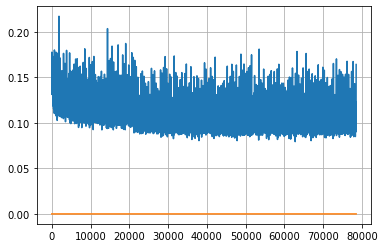

Epoch: 202, iteration 0, loss 0.10802817344665527, cov_diff 0.4116421096053559 cov_diff train 0.41074702665813884
Epoch: 202, iteration 1, loss 0.10045182704925537, cov_diff 0.40316598838612044 cov_diff train 0.4030979738626671
Epoch: 202, iteration 2, loss 0.10451403260231018, cov_diff 0.41007026206032177 cov_diff train 0.40978950769621875
Epoch: 202, iteration 3, loss 0.11211451888084412, cov_diff 0.41805733450156757 cov_diff train 0.417661534782009
Epoch: 202, iteration 4, loss 0.10805776715278625, cov_diff 0.40666717702521965 cov_diff train 0.4065141861510073
Epoch: 202, iteration 5, loss 0.10097190737724304, cov_diff 0.4097863403335831 cov_diff train 0.40837073547343766
Epoch: 202, iteration 6, loss 0.10629081726074219, cov_diff 0.4200127176220449 cov_diff train 0.41863472578584154
Epoch: 202, iteration 7, loss 0.09845691919326782, cov_diff 0.4037883632045904 cov_diff train 0.40263015881639724
Epoch: 202, iteration 8, loss 0.10834202170372009, cov_diff 0.40787618577692775 cov_diff

Epoch: 202, iteration 80, loss 0.0957493782043457, cov_diff 0.40301165783322346 cov_diff train 0.40219108299278106
Epoch: 202, iteration 81, loss 0.10118579864501953, cov_diff 0.40875446012596683 cov_diff train 0.40756565174456155
Epoch: 202, iteration 82, loss 0.11141914129257202, cov_diff 0.40276314164245836 cov_diff train 0.4021041718300952
Epoch: 202, iteration 83, loss 0.10792317986488342, cov_diff 0.4223522381998472 cov_diff train 0.4219829492021658
Epoch: 202, iteration 84, loss 0.1082707941532135, cov_diff 0.41563100622986343 cov_diff train 0.41525359818337215
Epoch: 202, iteration 85, loss 0.09756505489349365, cov_diff 0.40020057439772994 cov_diff train 0.4003241920976693
Epoch: 202, iteration 86, loss 0.12163245677947998, cov_diff 0.4339126494487103 cov_diff train 0.43250732864274843
Epoch: 202, iteration 87, loss 0.10537931323051453, cov_diff 0.40677692426789847 cov_diff train 0.40648027362253536
Epoch: 202, iteration 88, loss 0.10813355445861816, cov_diff 0.4018791569039249

Epoch: 202, iteration 157, loss 0.09658047556877136, cov_diff 0.4217208919590868 cov_diff train 0.4208527304628249
Epoch: 202, iteration 158, loss 0.10380220413208008, cov_diff 0.41692989548275916 cov_diff train 0.416480432083346
Epoch: 202, iteration 159, loss 0.10775995254516602, cov_diff 0.41945032439275515 cov_diff train 0.4192524107056438
Epoch: 202, iteration 160, loss 0.0996435284614563, cov_diff 0.4068446812787191 cov_diff train 0.40668530676130554
Epoch: 202, iteration 161, loss 0.09872150421142578, cov_diff 0.400640556419634 cov_diff train 0.4005162401883407
Epoch: 202, iteration 162, loss 0.1096145510673523, cov_diff 0.4021616261133643 cov_diff train 0.40186270118318157
Epoch: 202, iteration 163, loss 0.11775043606758118, cov_diff 0.4204527192194127 cov_diff train 0.4205132331574615
Epoch: 202, iteration 164, loss 0.11367172002792358, cov_diff 0.41345518456937214 cov_diff train 0.4129095746728372
Epoch: 202, iteration 165, loss 0.10765901207923889, cov_diff 0.424176099002754

Epoch: 202, iteration 236, loss 0.11181339621543884, cov_diff 0.4137071858626458 cov_diff train 0.4129124764107543
Epoch: 202, iteration 237, loss 0.11302003264427185, cov_diff 0.4234617903589256 cov_diff train 0.42194297854495844
Epoch: 202, iteration 238, loss 0.11387786269187927, cov_diff 0.41788883910868113 cov_diff train 0.41635886077391504
Epoch: 202, iteration 239, loss 0.10235193371772766, cov_diff 0.4097349429424443 cov_diff train 0.40826785783152275
Epoch: 202, iteration 240, loss 0.10550257563591003, cov_diff 0.4164549038644082 cov_diff train 0.415960063016924
Epoch: 202, iteration 241, loss 0.10912260413169861, cov_diff 0.42416412109785057 cov_diff train 0.4234427152050719
Epoch: 202, iteration 242, loss 0.09988591074943542, cov_diff 0.4111340422287932 cov_diff train 0.4111130506370078
Epoch: 202, iteration 243, loss 0.10048046708106995, cov_diff 0.42306838465404706 cov_diff train 0.42228657797960467
Epoch: 202, iteration 244, loss 0.09860825538635254, cov_diff 0.4072997291

Epoch: 202, iteration 309, loss 0.09750434756278992, cov_diff 0.40823027630331205 cov_diff train 0.4079707073486183
Epoch: 202, iteration 310, loss 0.10535383224487305, cov_diff 0.4280625927029429 cov_diff train 0.4274283931356474
Epoch: 202, iteration 311, loss 0.09310463070869446, cov_diff 0.40746901844205574 cov_diff train 0.40719799283632746
Epoch: 202, iteration 312, loss 0.10395655035972595, cov_diff 0.4173172713631762 cov_diff train 0.4169243610900586
Epoch: 202, iteration 313, loss 0.09896925091743469, cov_diff 0.4058460930470126 cov_diff train 0.4054224470935494
Epoch: 202, iteration 314, loss 0.10998040437698364, cov_diff 0.42928076791808834 cov_diff train 0.4283241597755918
Epoch: 202, iteration 315, loss 0.09925574064254761, cov_diff 0.4124804496608103 cov_diff train 0.4126235138412617
Epoch: 202, iteration 316, loss 0.10518112778663635, cov_diff 0.42001137045520703 cov_diff train 0.42034761551297134
Epoch: 202, iteration 317, loss 0.1001812219619751, cov_diff 0.42534371985

Epoch: 202, iteration 388, loss 0.11795768141746521, cov_diff 0.4211471185625306 cov_diff train 0.4205926588490029
Epoch: 202, iteration 389, loss 0.10877305269241333, cov_diff 0.43088348565507234 cov_diff train 0.4298747411745555
Epoch: 202, iteration 390, loss 0.1458740532398224, cov_diff 0.45614913012007274 cov_diff train 0.4541981777644526


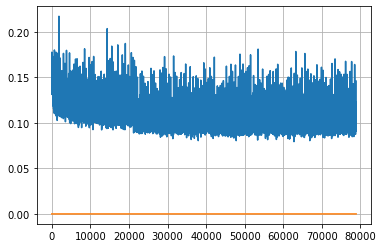

Epoch: 203, iteration 0, loss 0.11171579360961914, cov_diff 0.41460169590983875 cov_diff train 0.41396363125171143
Epoch: 203, iteration 1, loss 0.11067584156990051, cov_diff 0.4058868061943047 cov_diff train 0.4057370472043722
Epoch: 203, iteration 2, loss 0.09427264332771301, cov_diff 0.42128072399132094 cov_diff train 0.42074316677077633
Epoch: 203, iteration 3, loss 0.105400949716568, cov_diff 0.41667676151022315 cov_diff train 0.4167866757417825
Epoch: 203, iteration 4, loss 0.10731586813926697, cov_diff 0.4225932879849295 cov_diff train 0.4212698390865418
Epoch: 203, iteration 5, loss 0.09120401740074158, cov_diff 0.4147749925572597 cov_diff train 0.4141228048055688
Epoch: 203, iteration 6, loss 0.10841727256774902, cov_diff 0.4156454281058685 cov_diff train 0.4158715870016689
Epoch: 203, iteration 7, loss 0.10009020566940308, cov_diff 0.4142234309808131 cov_diff train 0.4125370872570639
Epoch: 203, iteration 8, loss 0.09230408072471619, cov_diff 0.4155870791021012 cov_diff train

Epoch: 203, iteration 79, loss 0.10927256941795349, cov_diff 0.4166141211586996 cov_diff train 0.4159121049869724
Epoch: 203, iteration 80, loss 0.10109013319015503, cov_diff 0.395516894644511 cov_diff train 0.39531520233744466
Epoch: 203, iteration 81, loss 0.12128958106040955, cov_diff 0.4247930346923722 cov_diff train 0.42374952656456377
Epoch: 203, iteration 82, loss 0.11105921864509583, cov_diff 0.4188842884105153 cov_diff train 0.4187070926988556
Epoch: 203, iteration 83, loss 0.0999419093132019, cov_diff 0.4017957309698656 cov_diff train 0.402548177124566
Epoch: 203, iteration 84, loss 0.10798957943916321, cov_diff 0.4279657301532231 cov_diff train 0.42678632211386164
Epoch: 203, iteration 85, loss 0.10653838515281677, cov_diff 0.4243172521048993 cov_diff train 0.42455778091761176
Epoch: 203, iteration 86, loss 0.10981610417366028, cov_diff 0.41203061110446126 cov_diff train 0.4122626890905353
Epoch: 203, iteration 87, loss 0.10672935843467712, cov_diff 0.4006222906010956 cov_di

Epoch: 203, iteration 161, loss 0.09941229224205017, cov_diff 0.4011904987935748 cov_diff train 0.4008285050768738
Epoch: 203, iteration 162, loss 0.09333738684654236, cov_diff 0.4125672539289986 cov_diff train 0.41242398249494483
Epoch: 203, iteration 163, loss 0.09522971510887146, cov_diff 0.3957872155708884 cov_diff train 0.3960688754481556
Epoch: 203, iteration 164, loss 0.10530030727386475, cov_diff 0.41702266811788197 cov_diff train 0.41675034715796017
Epoch: 203, iteration 165, loss 0.10193872451782227, cov_diff 0.41039476759550986 cov_diff train 0.4103213364830341
Epoch: 203, iteration 166, loss 0.11035484075546265, cov_diff 0.41555176156516704 cov_diff train 0.4148758557749215
Epoch: 203, iteration 167, loss 0.11445176601409912, cov_diff 0.4112628549820323 cov_diff train 0.41048580520536015
Epoch: 203, iteration 168, loss 0.10025203227996826, cov_diff 0.41113977114613826 cov_diff train 0.41020792407418494
Epoch: 203, iteration 169, loss 0.0994097888469696, cov_diff 0.411638163

Epoch: 203, iteration 240, loss 0.10162937641143799, cov_diff 0.40892731505460894 cov_diff train 0.4081672095017856
Epoch: 203, iteration 241, loss 0.09759566187858582, cov_diff 0.40605739540319385 cov_diff train 0.40553731884535354
Epoch: 203, iteration 242, loss 0.11165249347686768, cov_diff 0.4151024682015075 cov_diff train 0.4145074605868078
Epoch: 203, iteration 243, loss 0.11007320880889893, cov_diff 0.4296852142980347 cov_diff train 0.42818691887027027
Epoch: 203, iteration 244, loss 0.09239017963409424, cov_diff 0.4007879735550423 cov_diff train 0.3998993907163079
Epoch: 203, iteration 245, loss 0.10488137602806091, cov_diff 0.4099719142718691 cov_diff train 0.4091149535239976
Epoch: 203, iteration 246, loss 0.11432647705078125, cov_diff 0.41078378588542286 cov_diff train 0.41013785572247957
Epoch: 203, iteration 247, loss 0.10212388634681702, cov_diff 0.4103025283175399 cov_diff train 0.409810147303117
Epoch: 203, iteration 248, loss 0.10631236433982849, cov_diff 0.42086669552

Epoch: 203, iteration 316, loss 0.09510651230812073, cov_diff 0.4100180649882196 cov_diff train 0.4098065477944564
Epoch: 203, iteration 317, loss 0.10454803705215454, cov_diff 0.4089136532221343 cov_diff train 0.4092460456911353
Epoch: 203, iteration 318, loss 0.10812437534332275, cov_diff 0.40861563396462824 cov_diff train 0.40784915162559376
Epoch: 203, iteration 319, loss 0.09218403697013855, cov_diff 0.43030641133238223 cov_diff train 0.4299574261897884
Epoch: 203, iteration 320, loss 0.09130233526229858, cov_diff 0.4053470738126827 cov_diff train 0.40425577511898925
Epoch: 203, iteration 321, loss 0.10203579068183899, cov_diff 0.4053879351301982 cov_diff train 0.40471157848252576
Epoch: 203, iteration 322, loss 0.10898575186729431, cov_diff 0.406875305779164 cov_diff train 0.40724348871471794
Epoch: 203, iteration 323, loss 0.10553005337715149, cov_diff 0.4296167511445455 cov_diff train 0.4286789360378028
Epoch: 203, iteration 324, loss 0.10355612635612488, cov_diff 0.42201334452

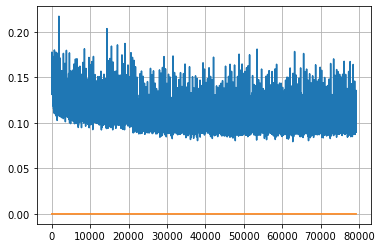

Epoch: 204, iteration 0, loss 0.10307443141937256, cov_diff 0.40664312124461466 cov_diff train 0.4063192538445639
Epoch: 204, iteration 1, loss 0.09461528062820435, cov_diff 0.40616929058128487 cov_diff train 0.4060674472478329
Epoch: 204, iteration 2, loss 0.09993737936019897, cov_diff 0.40282662614244485 cov_diff train 0.4029409127903264
Epoch: 204, iteration 3, loss 0.10132303833961487, cov_diff 0.39610009939014407 cov_diff train 0.39606260937276244
Epoch: 204, iteration 4, loss 0.09928306937217712, cov_diff 0.42607590714394894 cov_diff train 0.42455633081211813
Epoch: 204, iteration 5, loss 0.09873896837234497, cov_diff 0.40620719332374755 cov_diff train 0.4051155779709584
Epoch: 204, iteration 6, loss 0.12201163172721863, cov_diff 0.41572293825248546 cov_diff train 0.4157977046176147
Epoch: 204, iteration 7, loss 0.10544407367706299, cov_diff 0.42237905854004226 cov_diff train 0.4218551470497302
Epoch: 204, iteration 8, loss 0.10586690902709961, cov_diff 0.4143762844957874 cov_dif

Epoch: 204, iteration 80, loss 0.11651718616485596, cov_diff 0.41534672973486353 cov_diff train 0.4142134776116532
Epoch: 204, iteration 81, loss 0.09560003876686096, cov_diff 0.4167436557362873 cov_diff train 0.41607733246086387
Epoch: 204, iteration 82, loss 0.0993649959564209, cov_diff 0.4091219624986317 cov_diff train 0.40830558804049416
Epoch: 204, iteration 83, loss 0.10035282373428345, cov_diff 0.40788512664708615 cov_diff train 0.40749872305195023
Epoch: 204, iteration 84, loss 0.10464820265769958, cov_diff 0.4083020174483687 cov_diff train 0.40839817760981656
Epoch: 204, iteration 85, loss 0.09958964586257935, cov_diff 0.4072994077406917 cov_diff train 0.4071488716228062
Epoch: 204, iteration 86, loss 0.11743509769439697, cov_diff 0.42477678353225584 cov_diff train 0.42452974707577396
Epoch: 204, iteration 87, loss 0.1048860251903534, cov_diff 0.4104323815472199 cov_diff train 0.40968540964475486
Epoch: 204, iteration 88, loss 0.11057057976722717, cov_diff 0.4048197121517272 c

Epoch: 204, iteration 161, loss 0.10543233156204224, cov_diff 0.4046670267292873 cov_diff train 0.4049113367734732
Epoch: 204, iteration 162, loss 0.10785964131355286, cov_diff 0.4341007798593672 cov_diff train 0.43424562169931497
Epoch: 204, iteration 163, loss 0.10876289010047913, cov_diff 0.4311765815570771 cov_diff train 0.4306428712056961
Epoch: 204, iteration 164, loss 0.11066272854804993, cov_diff 0.4001668857180498 cov_diff train 0.39975962336994514
Epoch: 204, iteration 165, loss 0.11165043711662292, cov_diff 0.41315988872306697 cov_diff train 0.4130584985969188
Epoch: 204, iteration 166, loss 0.10321959853172302, cov_diff 0.4221933657996356 cov_diff train 0.422176980953146
Epoch: 204, iteration 167, loss 0.10119155049324036, cov_diff 0.4083569190026007 cov_diff train 0.40831322748492177
Epoch: 204, iteration 168, loss 0.09753644466400146, cov_diff 0.41668862136084306 cov_diff train 0.4161823093072868
Epoch: 204, iteration 169, loss 0.09856551885604858, cov_diff 0.425319998769

Epoch: 204, iteration 240, loss 0.1051853597164154, cov_diff 0.4143466729420473 cov_diff train 0.4135627257142707
Epoch: 204, iteration 241, loss 0.10035288333892822, cov_diff 0.4055921595325233 cov_diff train 0.4047616636979057
Epoch: 204, iteration 242, loss 0.09918197989463806, cov_diff 0.4323891646146458 cov_diff train 0.4312185895714828
Epoch: 204, iteration 243, loss 0.1127215027809143, cov_diff 0.4078250507661573 cov_diff train 0.40484824184542473
Epoch: 204, iteration 244, loss 0.10693228244781494, cov_diff 0.42530727500277155 cov_diff train 0.4245747079483222
Epoch: 204, iteration 245, loss 0.10962420701980591, cov_diff 0.4005643199280281 cov_diff train 0.39919557003871653
Epoch: 204, iteration 246, loss 0.09960386157035828, cov_diff 0.4070126764495086 cov_diff train 0.4056885919653447
Epoch: 204, iteration 247, loss 0.10888493061065674, cov_diff 0.41366908608100217 cov_diff train 0.41272392840350464
Epoch: 204, iteration 248, loss 0.11252087354660034, cov_diff 0.4057065421344

Epoch: 204, iteration 319, loss 0.10942548513412476, cov_diff 0.4224068910922081 cov_diff train 0.4208421714064246
Epoch: 204, iteration 320, loss 0.09872379899024963, cov_diff 0.4099196165767562 cov_diff train 0.4092711050877954
Epoch: 204, iteration 321, loss 0.10467672348022461, cov_diff 0.42151313211767694 cov_diff train 0.42078173917830286
Epoch: 204, iteration 322, loss 0.10084319114685059, cov_diff 0.41319139574726843 cov_diff train 0.4123668500527801
Epoch: 204, iteration 323, loss 0.0961160659790039, cov_diff 0.3974111988488169 cov_diff train 0.39728768843582885
Epoch: 204, iteration 324, loss 0.11016294360160828, cov_diff 0.40360951663364325 cov_diff train 0.4035397376196167
Epoch: 204, iteration 325, loss 0.09414106607437134, cov_diff 0.4215513555930572 cov_diff train 0.421132141573714
Epoch: 204, iteration 326, loss 0.10289472341537476, cov_diff 0.4160085919023908 cov_diff train 0.4159967493484496
Epoch: 204, iteration 327, loss 0.10044354200363159, cov_diff 0.4281337300130

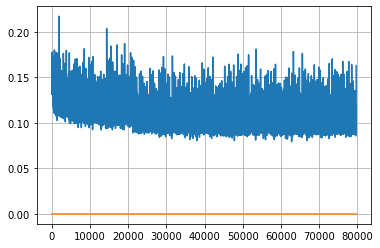

Epoch: 205, iteration 0, loss 0.11160820722579956, cov_diff 0.40978911759362224 cov_diff train 0.40870382611122247
Epoch: 205, iteration 1, loss 0.10600164532661438, cov_diff 0.42207617522651686 cov_diff train 0.4222665939386391
Epoch: 205, iteration 2, loss 0.1029430627822876, cov_diff 0.4193100561173611 cov_diff train 0.41890485086250645
Epoch: 205, iteration 3, loss 0.11009153723716736, cov_diff 0.41849813026590155 cov_diff train 0.4177903675044443
Epoch: 205, iteration 4, loss 0.09566465020179749, cov_diff 0.4257299067839513 cov_diff train 0.4252867100047863
Epoch: 205, iteration 5, loss 0.10343191027641296, cov_diff 0.41224986014243076 cov_diff train 0.4114424045030109
Epoch: 205, iteration 6, loss 0.09195232391357422, cov_diff 0.412371438252861 cov_diff train 0.41133263576535
Epoch: 205, iteration 7, loss 0.12369197607040405, cov_diff 0.4302553508469479 cov_diff train 0.4286769542249739
Epoch: 205, iteration 8, loss 0.09729579091072083, cov_diff 0.4088208103676839 cov_diff train 

Epoch: 205, iteration 79, loss 0.10448634624481201, cov_diff 0.40825782238507635 cov_diff train 0.4075177329292578
Epoch: 205, iteration 80, loss 0.10672840476036072, cov_diff 0.4147633403942431 cov_diff train 0.41406276238791306
Epoch: 205, iteration 81, loss 0.0947485864162445, cov_diff 0.41465829499176005 cov_diff train 0.4128264078271122
Epoch: 205, iteration 82, loss 0.10577201843261719, cov_diff 0.4213229083445857 cov_diff train 0.4203636970194152
Epoch: 205, iteration 83, loss 0.10208508372306824, cov_diff 0.40483309497737713 cov_diff train 0.4041057109320302
Epoch: 205, iteration 84, loss 0.09223631024360657, cov_diff 0.4152806845151076 cov_diff train 0.4146902391292021
Epoch: 205, iteration 85, loss 0.10354876518249512, cov_diff 0.4039683863933418 cov_diff train 0.4037040860067664
Epoch: 205, iteration 86, loss 0.1061294674873352, cov_diff 0.3941406413700258 cov_diff train 0.39422083225562493
Epoch: 205, iteration 87, loss 0.10824346542358398, cov_diff 0.4047183836871951 cov_d

Epoch: 205, iteration 154, loss 0.10675972700119019, cov_diff 0.41029854536249694 cov_diff train 0.40985026400768354
Epoch: 205, iteration 155, loss 0.10214871168136597, cov_diff 0.4153889588382972 cov_diff train 0.41427069461160626
Epoch: 205, iteration 156, loss 0.09897002577781677, cov_diff 0.42894189947526834 cov_diff train 0.42810491845545473
Epoch: 205, iteration 157, loss 0.10385501384735107, cov_diff 0.40191000622361356 cov_diff train 0.4010081130521751
Epoch: 205, iteration 158, loss 0.10191157460212708, cov_diff 0.42040140205510446 cov_diff train 0.4193704729712878
Epoch: 205, iteration 159, loss 0.10244759917259216, cov_diff 0.41142762978147795 cov_diff train 0.4097014499035515
Epoch: 205, iteration 160, loss 0.09902042150497437, cov_diff 0.4152265099661593 cov_diff train 0.41436210125520434
Epoch: 205, iteration 161, loss 0.10428586602210999, cov_diff 0.40532303239587536 cov_diff train 0.40511105034874223
Epoch: 205, iteration 162, loss 0.09734410047531128, cov_diff 0.41080

Epoch: 205, iteration 234, loss 0.10158339142799377, cov_diff 0.4120480055356627 cov_diff train 0.4119269478624117
Epoch: 205, iteration 235, loss 0.10294550657272339, cov_diff 0.42435218254212903 cov_diff train 0.42356373184539026
Epoch: 205, iteration 236, loss 0.10223877429962158, cov_diff 0.41644407554035834 cov_diff train 0.4159564911674569
Epoch: 205, iteration 237, loss 0.09939157962799072, cov_diff 0.4094231138815408 cov_diff train 0.4089678005600808
Epoch: 205, iteration 238, loss 0.08834764361381531, cov_diff 0.41074078744687953 cov_diff train 0.41022692972429486
Epoch: 205, iteration 239, loss 0.10911116003990173, cov_diff 0.4148496995815983 cov_diff train 0.4135289860017949
Epoch: 205, iteration 240, loss 0.09913057088851929, cov_diff 0.416427568668555 cov_diff train 0.4161690713822146
Epoch: 205, iteration 241, loss 0.11374706029891968, cov_diff 0.4180487494312047 cov_diff train 0.4175241218619262
Epoch: 205, iteration 242, loss 0.10314580798149109, cov_diff 0.408776206132

Epoch: 205, iteration 313, loss 0.10965678095817566, cov_diff 0.40515153926954006 cov_diff train 0.4039407251534718
Epoch: 205, iteration 314, loss 0.10507705807685852, cov_diff 0.40595255798631075 cov_diff train 0.40526064205542667
Epoch: 205, iteration 315, loss 0.11678469181060791, cov_diff 0.43167359637499586 cov_diff train 0.4307465632553821
Epoch: 205, iteration 316, loss 0.1200718879699707, cov_diff 0.4208830203416854 cov_diff train 0.4203154181197115
Epoch: 205, iteration 317, loss 0.10558167099952698, cov_diff 0.4064498114269301 cov_diff train 0.4060152901432819
Epoch: 205, iteration 318, loss 0.09106889367103577, cov_diff 0.4159046586159364 cov_diff train 0.41541585179998575
Epoch: 205, iteration 319, loss 0.09973159432411194, cov_diff 0.4165415395745771 cov_diff train 0.41629221446693754
Epoch: 205, iteration 320, loss 0.10524898767471313, cov_diff 0.4144082523878147 cov_diff train 0.4140848127660261
Epoch: 205, iteration 321, loss 0.09876611828804016, cov_diff 0.43869292388

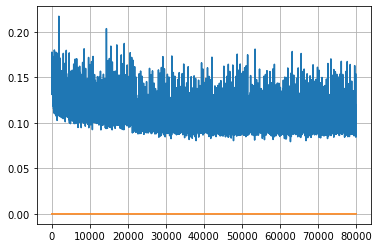

Epoch: 206, iteration 0, loss 0.10750448703765869, cov_diff 0.40755159926024737 cov_diff train 0.40741140766526285
Epoch: 206, iteration 1, loss 0.10421672463417053, cov_diff 0.415371071046671 cov_diff train 0.41398285400987445
Epoch: 206, iteration 2, loss 0.12952733039855957, cov_diff 0.4157728163697169 cov_diff train 0.4136750423969975
Epoch: 206, iteration 3, loss 0.09886902570724487, cov_diff 0.4042613429241569 cov_diff train 0.4039295360716976
Epoch: 206, iteration 4, loss 0.09013891220092773, cov_diff 0.39395711276571127 cov_diff train 0.39309256244284857
Epoch: 206, iteration 5, loss 0.10175928473472595, cov_diff 0.4183619023146707 cov_diff train 0.41801585594116847
Epoch: 206, iteration 6, loss 0.10381785035133362, cov_diff 0.40722078823656305 cov_diff train 0.40615704213502263
Epoch: 206, iteration 7, loss 0.1037546694278717, cov_diff 0.4074794748390124 cov_diff train 0.4070784737316577
Epoch: 206, iteration 8, loss 0.11295339465141296, cov_diff 0.4144139350602233 cov_diff tr

Epoch: 206, iteration 81, loss 0.1052897572517395, cov_diff 0.41508561088402807 cov_diff train 0.41411530098316224
Epoch: 206, iteration 82, loss 0.0892629623413086, cov_diff 0.40818687552029187 cov_diff train 0.4084895632247932
Epoch: 206, iteration 83, loss 0.0974767804145813, cov_diff 0.42675335919806645 cov_diff train 0.42597214632034935
Epoch: 206, iteration 84, loss 0.10582208633422852, cov_diff 0.41034715315275017 cov_diff train 0.40918617095104654
Epoch: 206, iteration 85, loss 0.1014588475227356, cov_diff 0.408618763594736 cov_diff train 0.40760176165152634
Epoch: 206, iteration 86, loss 0.10331186652183533, cov_diff 0.408417052480563 cov_diff train 0.408109851618996
Epoch: 206, iteration 87, loss 0.09270280599594116, cov_diff 0.4100731503981134 cov_diff train 0.4095909185965428
Epoch: 206, iteration 88, loss 0.09524339437484741, cov_diff 0.40855310069002515 cov_diff train 0.40769709953261946
Epoch: 206, iteration 89, loss 0.09366446733474731, cov_diff 0.4147059307091418 cov_d

Epoch: 206, iteration 157, loss 0.10368284583091736, cov_diff 0.42395989638843506 cov_diff train 0.4224681521016054
Epoch: 206, iteration 158, loss 0.10072743892669678, cov_diff 0.40964565609180004 cov_diff train 0.4092137442464344
Epoch: 206, iteration 159, loss 0.10664951801300049, cov_diff 0.4107422372376627 cov_diff train 0.40968488271917547
Epoch: 206, iteration 160, loss 0.0959673821926117, cov_diff 0.4170823662593524 cov_diff train 0.41589076050318596
Epoch: 206, iteration 161, loss 0.10346001386642456, cov_diff 0.41891234748135114 cov_diff train 0.41857038974961247
Epoch: 206, iteration 162, loss 0.10593658685684204, cov_diff 0.4197657115777361 cov_diff train 0.41871261671157994
Epoch: 206, iteration 163, loss 0.10011070966720581, cov_diff 0.40332444118004734 cov_diff train 0.4027108268771199
Epoch: 206, iteration 164, loss 0.09834527969360352, cov_diff 0.4051872766365828 cov_diff train 0.4052290781818422
Epoch: 206, iteration 165, loss 0.09784835577011108, cov_diff 0.408647679

Epoch: 206, iteration 234, loss 0.10342967510223389, cov_diff 0.3970754972286963 cov_diff train 0.39500722689887363
Epoch: 206, iteration 235, loss 0.11012089252471924, cov_diff 0.4177047591673549 cov_diff train 0.41751825599940734
Epoch: 206, iteration 236, loss 0.10652267932891846, cov_diff 0.42019429693416327 cov_diff train 0.41941962765097474
Epoch: 206, iteration 237, loss 0.102536141872406, cov_diff 0.41240155462305406 cov_diff train 0.41109877908281
Epoch: 206, iteration 238, loss 0.11404764652252197, cov_diff 0.40760190142308594 cov_diff train 0.4072659498955109
Epoch: 206, iteration 239, loss 0.10466349124908447, cov_diff 0.41265830695959493 cov_diff train 0.4116395715629697
Epoch: 206, iteration 240, loss 0.10520550608634949, cov_diff 0.4187437735059073 cov_diff train 0.41880122587243257
Epoch: 206, iteration 241, loss 0.1075793206691742, cov_diff 0.4204726688911718 cov_diff train 0.41955715902640106
Epoch: 206, iteration 242, loss 0.09102049469947815, cov_diff 0.412414582649

Epoch: 206, iteration 311, loss 0.1052628755569458, cov_diff 0.4126490832988302 cov_diff train 0.4120513496902199
Epoch: 206, iteration 312, loss 0.11211028695106506, cov_diff 0.4189981531415779 cov_diff train 0.4173984652565594
Epoch: 206, iteration 313, loss 0.103260338306427, cov_diff 0.42135433415995677 cov_diff train 0.42053366511102064
Epoch: 206, iteration 314, loss 0.11078342795372009, cov_diff 0.42256663984788334 cov_diff train 0.42161507861405145
Epoch: 206, iteration 315, loss 0.11471676826477051, cov_diff 0.42201126572111863 cov_diff train 0.4216613454534418
Epoch: 206, iteration 316, loss 0.10558077692985535, cov_diff 0.4075175207387516 cov_diff train 0.40670556672475167
Epoch: 206, iteration 317, loss 0.1048966646194458, cov_diff 0.4241193803372041 cov_diff train 0.42339372123469265
Epoch: 206, iteration 318, loss 0.10558366775512695, cov_diff 0.409339708721814 cov_diff train 0.4087826468121386
Epoch: 206, iteration 319, loss 0.10475161671638489, cov_diff 0.40544281483793

Epoch: 206, iteration 389, loss 0.10017207264900208, cov_diff 0.41137241719390316 cov_diff train 0.4107796060801079
Epoch: 206, iteration 390, loss 0.13753995299339294, cov_diff 0.4515169810305571 cov_diff train 0.4497533179113872


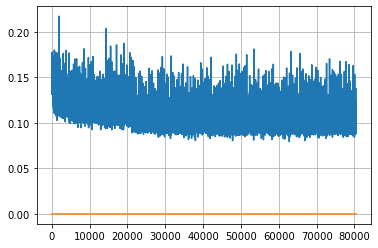

Epoch: 207, iteration 0, loss 0.09497478604316711, cov_diff 0.4287101735572647 cov_diff train 0.42867271340357177
Epoch: 207, iteration 1, loss 0.10328829288482666, cov_diff 0.4099293098799895 cov_diff train 0.4101509793146236
Epoch: 207, iteration 2, loss 0.11160960793495178, cov_diff 0.40775455320976206 cov_diff train 0.40747354514210515
Epoch: 207, iteration 3, loss 0.11593601107597351, cov_diff 0.4003254172218778 cov_diff train 0.39981803463746
Epoch: 207, iteration 4, loss 0.11436715722084045, cov_diff 0.42174151348164957 cov_diff train 0.4212984538626757
Epoch: 207, iteration 5, loss 0.10416948795318604, cov_diff 0.41667558435046687 cov_diff train 0.4155230713479558
Epoch: 207, iteration 6, loss 0.09359583258628845, cov_diff 0.41575885106999955 cov_diff train 0.4150784840595723
Epoch: 207, iteration 7, loss 0.1147770881652832, cov_diff 0.41411689814839286 cov_diff train 0.412804764398288
Epoch: 207, iteration 8, loss 0.10209950804710388, cov_diff 0.40604961680801377 cov_diff trai

Epoch: 207, iteration 79, loss 0.10633444786071777, cov_diff 0.4060068742423259 cov_diff train 0.4050646084227767
Epoch: 207, iteration 80, loss 0.10738247632980347, cov_diff 0.42061525466198735 cov_diff train 0.41922461463513755
Epoch: 207, iteration 81, loss 0.10288101434707642, cov_diff 0.41106250945142925 cov_diff train 0.4106417393263172
Epoch: 207, iteration 82, loss 0.11209166049957275, cov_diff 0.40488478571375514 cov_diff train 0.40508141977356416
Epoch: 207, iteration 83, loss 0.09009602665901184, cov_diff 0.4102148003152713 cov_diff train 0.4096214736866949
Epoch: 207, iteration 84, loss 0.10041001439094543, cov_diff 0.4052116382308808 cov_diff train 0.4046032964359831
Epoch: 207, iteration 85, loss 0.09789377450942993, cov_diff 0.41297346999613954 cov_diff train 0.4120659293612524
Epoch: 207, iteration 86, loss 0.09983295202255249, cov_diff 0.4014808565615254 cov_diff train 0.4008220336326023
Epoch: 207, iteration 87, loss 0.10103681683540344, cov_diff 0.41382451533666526 c

Epoch: 207, iteration 157, loss 0.0920744240283966, cov_diff 0.3937825108324029 cov_diff train 0.3935594712235639
Epoch: 207, iteration 158, loss 0.10216644406318665, cov_diff 0.4089277442043545 cov_diff train 0.407879056478908
Epoch: 207, iteration 159, loss 0.11299875378608704, cov_diff 0.4097143511162845 cov_diff train 0.4088107759783152
Epoch: 207, iteration 160, loss 0.1043417751789093, cov_diff 0.40021147067226787 cov_diff train 0.399359418024526
Epoch: 207, iteration 161, loss 0.11208301782608032, cov_diff 0.40822909385497724 cov_diff train 0.40770201627823577
Epoch: 207, iteration 162, loss 0.10647469758987427, cov_diff 0.4022598000507213 cov_diff train 0.4021352315769541
Epoch: 207, iteration 163, loss 0.10313823819160461, cov_diff 0.3999914015961305 cov_diff train 0.39980184597709584
Epoch: 207, iteration 164, loss 0.10928452014923096, cov_diff 0.40348096671602074 cov_diff train 0.40364093977509835
Epoch: 207, iteration 165, loss 0.09993824362754822, cov_diff 0.42026574187676

Epoch: 207, iteration 236, loss 0.10172691941261292, cov_diff 0.41469636473852256 cov_diff train 0.414795784183863
Epoch: 207, iteration 237, loss 0.10546413064002991, cov_diff 0.41024415778588347 cov_diff train 0.4093740722641938
Epoch: 207, iteration 238, loss 0.10681834816932678, cov_diff 0.4275170354364267 cov_diff train 0.4263631255651125
Epoch: 207, iteration 239, loss 0.09614601731300354, cov_diff 0.41838888150787173 cov_diff train 0.4182152970400229
Epoch: 207, iteration 240, loss 0.10213223099708557, cov_diff 0.41258868118042125 cov_diff train 0.41092565181606716
Epoch: 207, iteration 241, loss 0.10579437017440796, cov_diff 0.4135211026731132 cov_diff train 0.4131971647083445
Epoch: 207, iteration 242, loss 0.1081022322177887, cov_diff 0.4199716608722017 cov_diff train 0.4194095348450935
Epoch: 207, iteration 243, loss 0.10385280847549438, cov_diff 0.41335499376254947 cov_diff train 0.4132719536598523
Epoch: 207, iteration 244, loss 0.10604989528656006, cov_diff 0.420244852101

Epoch: 207, iteration 315, loss 0.1141972541809082, cov_diff 0.4153915183591277 cov_diff train 0.41464004852083736
Epoch: 207, iteration 316, loss 0.10616707801818848, cov_diff 0.41996080633457555 cov_diff train 0.4189074500842311
Epoch: 207, iteration 317, loss 0.10284966230392456, cov_diff 0.41812830410221175 cov_diff train 0.4174328640493479
Epoch: 207, iteration 318, loss 0.10423678159713745, cov_diff 0.41489515051159254 cov_diff train 0.4147466656713872
Epoch: 207, iteration 319, loss 0.10158595442771912, cov_diff 0.4179326998142093 cov_diff train 0.4168290958425665
Epoch: 207, iteration 320, loss 0.11281239986419678, cov_diff 0.4102979707090834 cov_diff train 0.40981695254565687
Epoch: 207, iteration 321, loss 0.1006498634815216, cov_diff 0.40953587392763047 cov_diff train 0.4092269890481347
Epoch: 207, iteration 322, loss 0.09105223417282104, cov_diff 0.40513637662750496 cov_diff train 0.4046818207540552
Epoch: 207, iteration 323, loss 0.10971945524215698, cov_diff 0.41538752510

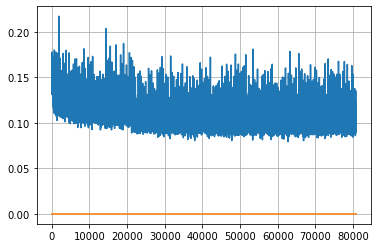

Epoch: 208, iteration 0, loss 0.09220436215400696, cov_diff 0.4111039648890615 cov_diff train 0.411088491830402
Epoch: 208, iteration 1, loss 0.10494381189346313, cov_diff 0.41902331955708205 cov_diff train 0.4177390410698367
Epoch: 208, iteration 2, loss 0.11588814854621887, cov_diff 0.41377827575688986 cov_diff train 0.41279075362134837
Epoch: 208, iteration 3, loss 0.09888407588005066, cov_diff 0.40707162942836395 cov_diff train 0.40616761728775597
Epoch: 208, iteration 4, loss 0.10751605033874512, cov_diff 0.41086833382666593 cov_diff train 0.4096762737138045
Epoch: 208, iteration 5, loss 0.10498809814453125, cov_diff 0.4096775667180238 cov_diff train 0.40912054305924156
Epoch: 208, iteration 6, loss 0.10323914885520935, cov_diff 0.4103202572241712 cov_diff train 0.40936842497310155
Epoch: 208, iteration 7, loss 0.09842818975448608, cov_diff 0.40751338880631854 cov_diff train 0.4065538557704641
Epoch: 208, iteration 8, loss 0.10641458630561829, cov_diff 0.4063517490132268 cov_diff 

Epoch: 208, iteration 80, loss 0.09618118405342102, cov_diff 0.41134849521193556 cov_diff train 0.4103908228673167
Epoch: 208, iteration 81, loss 0.09949737787246704, cov_diff 0.4146199399603551 cov_diff train 0.41395511954932623
Epoch: 208, iteration 82, loss 0.09433233737945557, cov_diff 0.40344330326845673 cov_diff train 0.4030977425298842
Epoch: 208, iteration 83, loss 0.09205576777458191, cov_diff 0.4157280070196502 cov_diff train 0.4142098657639778
Epoch: 208, iteration 84, loss 0.09552925825119019, cov_diff 0.4078232016337491 cov_diff train 0.4063777682306127
Epoch: 208, iteration 85, loss 0.11087706685066223, cov_diff 0.4166119081382406 cov_diff train 0.41714829755418764
Epoch: 208, iteration 86, loss 0.09714886546134949, cov_diff 0.4135987995571218 cov_diff train 0.41264325830389526
Epoch: 208, iteration 87, loss 0.11843174695968628, cov_diff 0.4108253564498056 cov_diff train 0.4108627808707343
Epoch: 208, iteration 88, loss 0.10395967960357666, cov_diff 0.41311892898469843 co

Epoch: 208, iteration 152, loss 0.11067637801170349, cov_diff 0.4315183131892321 cov_diff train 0.4303571855919269
Epoch: 208, iteration 153, loss 0.08918550610542297, cov_diff 0.4118870695976036 cov_diff train 0.4112878197824563
Epoch: 208, iteration 154, loss 0.11703875660896301, cov_diff 0.4349115802464945 cov_diff train 0.4335765301481783
Epoch: 208, iteration 155, loss 0.10204333066940308, cov_diff 0.4106909303393759 cov_diff train 0.40910727436087757
Epoch: 208, iteration 156, loss 0.10735291242599487, cov_diff 0.4228005923999106 cov_diff train 0.4225051792724697
Epoch: 208, iteration 157, loss 0.09033840894699097, cov_diff 0.4214133129190985 cov_diff train 0.42114662336279607
Epoch: 208, iteration 158, loss 0.10695534944534302, cov_diff 0.41103132799883524 cov_diff train 0.40983015416246504
Epoch: 208, iteration 159, loss 0.09777170419692993, cov_diff 0.40493874515285333 cov_diff train 0.4048016940572766
Epoch: 208, iteration 160, loss 0.10289806127548218, cov_diff 0.41038422713

Epoch: 208, iteration 228, loss 0.0893917977809906, cov_diff 0.411156989317949 cov_diff train 0.41111246001889457
Epoch: 208, iteration 229, loss 0.09290874004364014, cov_diff 0.4001219400614264 cov_diff train 0.40020788419606546
Epoch: 208, iteration 230, loss 0.10295704007148743, cov_diff 0.4057072785182078 cov_diff train 0.40551942263141383
Epoch: 208, iteration 231, loss 0.1213202178478241, cov_diff 0.4109584834944397 cov_diff train 0.41016036430205305
Epoch: 208, iteration 232, loss 0.09784162044525146, cov_diff 0.4209693042259698 cov_diff train 0.4202332963970538
Epoch: 208, iteration 233, loss 0.11149570345878601, cov_diff 0.4272130042942537 cov_diff train 0.4269067372604383
Epoch: 208, iteration 234, loss 0.09410083293914795, cov_diff 0.40717442544734034 cov_diff train 0.4072616857686739
Epoch: 208, iteration 235, loss 0.09372422099113464, cov_diff 0.4078234438646136 cov_diff train 0.4074153376941983
Epoch: 208, iteration 236, loss 0.10835754871368408, cov_diff 0.41047766675677

Epoch: 208, iteration 303, loss 0.11258342862129211, cov_diff 0.4134383004857355 cov_diff train 0.41286542154804373
Epoch: 208, iteration 304, loss 0.09216639399528503, cov_diff 0.41627520802394286 cov_diff train 0.41630287184949194
Epoch: 208, iteration 305, loss 0.10485494136810303, cov_diff 0.41461184520439387 cov_diff train 0.4140542032234691
Epoch: 208, iteration 306, loss 0.10345762968063354, cov_diff 0.4127133804935515 cov_diff train 0.41139538689524807
Epoch: 208, iteration 307, loss 0.1059536337852478, cov_diff 0.41019248138067627 cov_diff train 0.4096072084912993
Epoch: 208, iteration 308, loss 0.11012601852416992, cov_diff 0.40708957778657384 cov_diff train 0.4061497566695907
Epoch: 208, iteration 309, loss 0.08970102667808533, cov_diff 0.40717166031877694 cov_diff train 0.4067892879150582
Epoch: 208, iteration 310, loss 0.09683853387832642, cov_diff 0.4228801354076354 cov_diff train 0.42167583731875247
Epoch: 208, iteration 311, loss 0.10303622484207153, cov_diff 0.42384125

Epoch: 208, iteration 378, loss 0.11407792568206787, cov_diff 0.419757634362376 cov_diff train 0.4180928530845308
Epoch: 208, iteration 379, loss 0.11389043927192688, cov_diff 0.4195003928761406 cov_diff train 0.41902621284903313
Epoch: 208, iteration 380, loss 0.11845290660858154, cov_diff 0.4078053471212566 cov_diff train 0.4079433828478767
Epoch: 208, iteration 381, loss 0.10448896884918213, cov_diff 0.3999302795719308 cov_diff train 0.39949950350394614
Epoch: 208, iteration 382, loss 0.10065656900405884, cov_diff 0.40675904332552254 cov_diff train 0.4060889327719388
Epoch: 208, iteration 383, loss 0.1102776825428009, cov_diff 0.4140195168536404 cov_diff train 0.41343016794646353
Epoch: 208, iteration 384, loss 0.1101323664188385, cov_diff 0.4167770646652793 cov_diff train 0.41548646198439415
Epoch: 208, iteration 385, loss 0.11528640985488892, cov_diff 0.4107687262739293 cov_diff train 0.4107134620957165
Epoch: 208, iteration 386, loss 0.09411123394966125, cov_diff 0.41881536368469

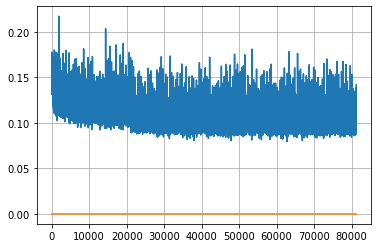

Epoch: 209, iteration 0, loss 0.10730364918708801, cov_diff 0.40843087297416136 cov_diff train 0.40815168426504106
Epoch: 209, iteration 1, loss 0.10200044512748718, cov_diff 0.4138449248093763 cov_diff train 0.4141309180524454
Epoch: 209, iteration 2, loss 0.10107803344726562, cov_diff 0.4116396228550415 cov_diff train 0.41209312592844183
Epoch: 209, iteration 3, loss 0.09498235583305359, cov_diff 0.423232591263777 cov_diff train 0.42313939615000645
Epoch: 209, iteration 4, loss 0.10155385732650757, cov_diff 0.4090198243916146 cov_diff train 0.4090683186614385
Epoch: 209, iteration 5, loss 0.10790079832077026, cov_diff 0.4224006031565325 cov_diff train 0.42241962642567926
Epoch: 209, iteration 6, loss 0.09464943408966064, cov_diff 0.39876145801146995 cov_diff train 0.40008201071498034
Epoch: 209, iteration 7, loss 0.10862317681312561, cov_diff 0.4142572732932287 cov_diff train 0.4146969463060117
Epoch: 209, iteration 8, loss 0.11248442530632019, cov_diff 0.42024163757634875 cov_diff t

Epoch: 209, iteration 77, loss 0.09188151359558105, cov_diff 0.42690527469918177 cov_diff train 0.4263312978561758
Epoch: 209, iteration 78, loss 0.09702318906784058, cov_diff 0.4208132274496357 cov_diff train 0.4190230250348178
Epoch: 209, iteration 79, loss 0.1163213849067688, cov_diff 0.42341848415923045 cov_diff train 0.4221498208477435
Epoch: 209, iteration 80, loss 0.1048840582370758, cov_diff 0.40940046271116126 cov_diff train 0.40881728886049645
Epoch: 209, iteration 81, loss 0.08959254622459412, cov_diff 0.41244845320943724 cov_diff train 0.4104673448792925
Epoch: 209, iteration 82, loss 0.10043182969093323, cov_diff 0.4112140292085001 cov_diff train 0.41048085811584706
Epoch: 209, iteration 83, loss 0.10407665371894836, cov_diff 0.40836606002930503 cov_diff train 0.4073950725957592
Epoch: 209, iteration 84, loss 0.11987024545669556, cov_diff 0.41001362708393524 cov_diff train 0.41016307388128326
Epoch: 209, iteration 85, loss 0.09840649366378784, cov_diff 0.3972238962909198 c

Epoch: 209, iteration 150, loss 0.10231423377990723, cov_diff 0.3989988763387488 cov_diff train 0.3982801258332453
Epoch: 209, iteration 151, loss 0.10140320658683777, cov_diff 0.41192389278018715 cov_diff train 0.4126383875958484
Epoch: 209, iteration 152, loss 0.10474935173988342, cov_diff 0.40658239827653375 cov_diff train 0.4064979020036588
Epoch: 209, iteration 153, loss 0.09603884816169739, cov_diff 0.4149212331890219 cov_diff train 0.41544218871124217
Epoch: 209, iteration 154, loss 0.10501450300216675, cov_diff 0.40016493393872943 cov_diff train 0.3998746331243766
Epoch: 209, iteration 155, loss 0.10215115547180176, cov_diff 0.4032806761543575 cov_diff train 0.4033299512742749
Epoch: 209, iteration 156, loss 0.099008709192276, cov_diff 0.41496927703228903 cov_diff train 0.41530103968212734
Epoch: 209, iteration 157, loss 0.10787361860275269, cov_diff 0.4125926268362362 cov_diff train 0.41213205686682647
Epoch: 209, iteration 158, loss 0.10082074999809265, cov_diff 0.39852035774

Epoch: 209, iteration 222, loss 0.10142654180526733, cov_diff 0.42485683669838503 cov_diff train 0.4241550076729573
Epoch: 209, iteration 223, loss 0.10114124417304993, cov_diff 0.4085212785310824 cov_diff train 0.40744848645498993
Epoch: 209, iteration 224, loss 0.10618385672569275, cov_diff 0.4116879818306686 cov_diff train 0.41148285606096935
Epoch: 209, iteration 225, loss 0.09830379486083984, cov_diff 0.4226760690826574 cov_diff train 0.42189707448067654
Epoch: 209, iteration 226, loss 0.11642375588417053, cov_diff 0.42278189757752555 cov_diff train 0.4230058911273001
Epoch: 209, iteration 227, loss 0.11444360017776489, cov_diff 0.41744909843844213 cov_diff train 0.41710682180235387
Epoch: 209, iteration 228, loss 0.11060050129890442, cov_diff 0.4079657853954722 cov_diff train 0.4071515665586328
Epoch: 209, iteration 229, loss 0.09158754348754883, cov_diff 0.4145789456140331 cov_diff train 0.41416110604247475
Epoch: 209, iteration 230, loss 0.09453731775283813, cov_diff 0.42079901

Epoch: 209, iteration 293, loss 0.10533884167671204, cov_diff 0.41017168292650275 cov_diff train 0.4098212790433524
Epoch: 209, iteration 294, loss 0.09640699625015259, cov_diff 0.4025848773311668 cov_diff train 0.4029767763828954
Epoch: 209, iteration 295, loss 0.1186155378818512, cov_diff 0.40966686685298115 cov_diff train 0.4086602339648112
Epoch: 209, iteration 296, loss 0.12414810061454773, cov_diff 0.4176499743035983 cov_diff train 0.4169074446630496
Epoch: 209, iteration 297, loss 0.11141815781593323, cov_diff 0.4213334838162212 cov_diff train 0.42062787421782377
Epoch: 209, iteration 298, loss 0.10336428880691528, cov_diff 0.4165493066695902 cov_diff train 0.41613820137229673
Epoch: 209, iteration 299, loss 0.09691944718360901, cov_diff 0.4191535384487783 cov_diff train 0.41858425654487785
Epoch: 209, iteration 300, loss 0.11976474523544312, cov_diff 0.4136150883244786 cov_diff train 0.41249098484212104
Epoch: 209, iteration 301, loss 0.10448575019836426, cov_diff 0.41461133834

Epoch: 209, iteration 364, loss 0.09769758582115173, cov_diff 0.4116548042164576 cov_diff train 0.41110042192265356
Epoch: 209, iteration 365, loss 0.10464781522750854, cov_diff 0.4163708300605833 cov_diff train 0.4158906884258446
Epoch: 209, iteration 366, loss 0.1007627546787262, cov_diff 0.4027864065237602 cov_diff train 0.40200505775490625
Epoch: 209, iteration 367, loss 0.10496580600738525, cov_diff 0.4055205357552305 cov_diff train 0.40490994202744607
Epoch: 209, iteration 368, loss 0.10851910710334778, cov_diff 0.421160066876312 cov_diff train 0.4210329179726746
Epoch: 209, iteration 369, loss 0.09853047132492065, cov_diff 0.4115385262640983 cov_diff train 0.409914655746932
Epoch: 209, iteration 370, loss 0.10494488477706909, cov_diff 0.42197986559033507 cov_diff train 0.4202687860078122
Epoch: 209, iteration 371, loss 0.10360723733901978, cov_diff 0.4082902780801449 cov_diff train 0.40693233834856807
Epoch: 209, iteration 372, loss 0.09556666016578674, cov_diff 0.41167619641985

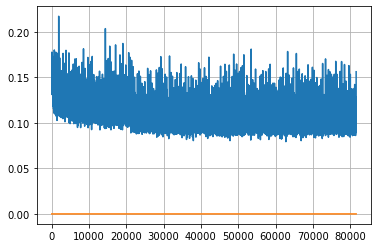

Epoch: 210, iteration 0, loss 0.09438136219978333, cov_diff 0.4043428090367455 cov_diff train 0.4041376196669226
Epoch: 210, iteration 1, loss 0.09133803844451904, cov_diff 0.41455608328583776 cov_diff train 0.4142591192245864
Epoch: 210, iteration 2, loss 0.0992947518825531, cov_diff 0.4091973700068483 cov_diff train 0.40946305501926034
Epoch: 210, iteration 3, loss 0.09975570440292358, cov_diff 0.40108523369463744 cov_diff train 0.4010024146511049
Epoch: 210, iteration 4, loss 0.09610691666603088, cov_diff 0.4004773478788338 cov_diff train 0.4011189714899886
Epoch: 210, iteration 5, loss 0.10852408409118652, cov_diff 0.42453625510312254 cov_diff train 0.42304678839176624
Epoch: 210, iteration 6, loss 0.09650492668151855, cov_diff 0.42627205055011225 cov_diff train 0.4262697916486279
Epoch: 210, iteration 7, loss 0.10324093699455261, cov_diff 0.4306594155312364 cov_diff train 0.4295992308102245
Epoch: 210, iteration 8, loss 0.10807353258132935, cov_diff 0.4059380197027682 cov_diff tra

Epoch: 210, iteration 78, loss 0.10078668594360352, cov_diff 0.4202301210518595 cov_diff train 0.419265231191906
Epoch: 210, iteration 79, loss 0.10774725675582886, cov_diff 0.40627762547464435 cov_diff train 0.40613869203357367
Epoch: 210, iteration 80, loss 0.11450153589248657, cov_diff 0.4006825249857209 cov_diff train 0.4007463152782653
Epoch: 210, iteration 81, loss 0.10590469837188721, cov_diff 0.40569966284575043 cov_diff train 0.4059083590643327
Epoch: 210, iteration 82, loss 0.10967943072319031, cov_diff 0.41600878270407404 cov_diff train 0.4153729856144512
Epoch: 210, iteration 83, loss 0.10698661208152771, cov_diff 0.4374948607118071 cov_diff train 0.4363082850929704
Epoch: 210, iteration 84, loss 0.0966900885105133, cov_diff 0.3891442166337127 cov_diff train 0.38889519067445827
Epoch: 210, iteration 85, loss 0.11013206839561462, cov_diff 0.40297707037833846 cov_diff train 0.40239832141264864
Epoch: 210, iteration 86, loss 0.1044306755065918, cov_diff 0.42314662162623773 cov

Epoch: 210, iteration 152, loss 0.10251763463020325, cov_diff 0.4016912828776966 cov_diff train 0.4012207244017854
Epoch: 210, iteration 153, loss 0.10251155495643616, cov_diff 0.41105014738201123 cov_diff train 0.4102852886034277
Epoch: 210, iteration 154, loss 0.1000661849975586, cov_diff 0.41101848328336 cov_diff train 0.4105426375579578
Epoch: 210, iteration 155, loss 0.0905122458934784, cov_diff 0.42566107569128836 cov_diff train 0.4250435900624293
Epoch: 210, iteration 156, loss 0.09843459725379944, cov_diff 0.410577112550484 cov_diff train 0.40909749446843224
Epoch: 210, iteration 157, loss 0.10501968860626221, cov_diff 0.41733019603583343 cov_diff train 0.41575670046453733
Epoch: 210, iteration 158, loss 0.11962765455245972, cov_diff 0.41021438230144125 cov_diff train 0.4101144530074034
Epoch: 210, iteration 159, loss 0.10501286387443542, cov_diff 0.4225228437705514 cov_diff train 0.4217143604989173
Epoch: 210, iteration 160, loss 0.11162734031677246, cov_diff 0.411860140817617

Epoch: 210, iteration 225, loss 0.09789639711380005, cov_diff 0.4333528004835806 cov_diff train 0.4329147370908871
Epoch: 210, iteration 226, loss 0.09697511792182922, cov_diff 0.41937454923397555 cov_diff train 0.41887047890593954
Epoch: 210, iteration 227, loss 0.095450758934021, cov_diff 0.4223650741784653 cov_diff train 0.421913328304213
Epoch: 210, iteration 228, loss 0.09863594174385071, cov_diff 0.4269915332211219 cov_diff train 0.4264642688066799
Epoch: 210, iteration 229, loss 0.1102895438671112, cov_diff 0.40903925953179454 cov_diff train 0.408884716057841
Epoch: 210, iteration 230, loss 0.10657629370689392, cov_diff 0.4060426964924497 cov_diff train 0.4055139708187967
Epoch: 210, iteration 231, loss 0.09981545805931091, cov_diff 0.4210423956679486 cov_diff train 0.4199712949443831
Epoch: 210, iteration 232, loss 0.1124645471572876, cov_diff 0.4158136113073228 cov_diff train 0.41579093008819684
Epoch: 210, iteration 233, loss 0.10633745789527893, cov_diff 0.42108273431285426 

Epoch: 210, iteration 300, loss 0.09457162022590637, cov_diff 0.4008106733901617 cov_diff train 0.40012702281275514
Epoch: 210, iteration 301, loss 0.10728922486305237, cov_diff 0.4188401991552281 cov_diff train 0.4175942098301849
Epoch: 210, iteration 302, loss 0.09417077898979187, cov_diff 0.40945082735764576 cov_diff train 0.40904905287948945
Epoch: 210, iteration 303, loss 0.10091361403465271, cov_diff 0.41175200286209634 cov_diff train 0.41119809577413763
Epoch: 210, iteration 304, loss 0.09777620434761047, cov_diff 0.41514333545475923 cov_diff train 0.41542375924586294
Epoch: 210, iteration 305, loss 0.10664451122283936, cov_diff 0.41494411189111613 cov_diff train 0.41354092972093837
Epoch: 210, iteration 306, loss 0.09987407922744751, cov_diff 0.42225399695481547 cov_diff train 0.4219302709276138
Epoch: 210, iteration 307, loss 0.117890864610672, cov_diff 0.41537945743893434 cov_diff train 0.41484409311264514
Epoch: 210, iteration 308, loss 0.09760195016860962, cov_diff 0.421914

Epoch: 210, iteration 374, loss 0.1027546226978302, cov_diff 0.41347414399567706 cov_diff train 0.4126663204257233
Epoch: 210, iteration 375, loss 0.11279270052909851, cov_diff 0.4107668181981977 cov_diff train 0.40947831284261604
Epoch: 210, iteration 376, loss 0.09576001763343811, cov_diff 0.4185059873053619 cov_diff train 0.4174822166567486
Epoch: 210, iteration 377, loss 0.10414540767669678, cov_diff 0.4184381390915638 cov_diff train 0.4180524014889016
Epoch: 210, iteration 378, loss 0.10280045866966248, cov_diff 0.39639517573405225 cov_diff train 0.3946380579690572
Epoch: 210, iteration 379, loss 0.09944060444831848, cov_diff 0.4108778832218959 cov_diff train 0.4109117106608276
Epoch: 210, iteration 380, loss 0.10932645201683044, cov_diff 0.4297579247440032 cov_diff train 0.42990008813350283
Epoch: 210, iteration 381, loss 0.11825829744338989, cov_diff 0.41865840812127136 cov_diff train 0.4178472893285028
Epoch: 210, iteration 382, loss 0.0990636944770813, cov_diff 0.4202643980883

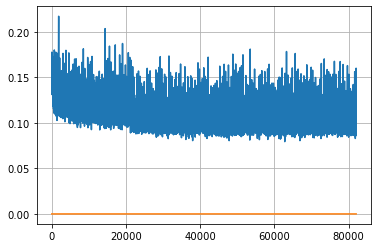

Epoch: 211, iteration 0, loss 0.10164806246757507, cov_diff 0.42069683600559094 cov_diff train 0.4206196862095878
Epoch: 211, iteration 1, loss 0.10890123248100281, cov_diff 0.4087887788895626 cov_diff train 0.40822314413434113
Epoch: 211, iteration 2, loss 0.10804146528244019, cov_diff 0.3992073919736708 cov_diff train 0.3987370882936213
Epoch: 211, iteration 3, loss 0.0973462164402008, cov_diff 0.42069950341261325 cov_diff train 0.4204335178162496
Epoch: 211, iteration 4, loss 0.10610705614089966, cov_diff 0.42249154792967913 cov_diff train 0.4226315308643053
Epoch: 211, iteration 5, loss 0.10428318381309509, cov_diff 0.41250858663500917 cov_diff train 0.412336895893164
Epoch: 211, iteration 6, loss 0.10292160511016846, cov_diff 0.4258366267289859 cov_diff train 0.42625095394495915
Epoch: 211, iteration 7, loss 0.10264530777931213, cov_diff 0.41435601549462786 cov_diff train 0.4136878513475839
Epoch: 211, iteration 8, loss 0.1048639714717865, cov_diff 0.43173276729654547 cov_diff tra

Epoch: 211, iteration 76, loss 0.09965512156486511, cov_diff 0.41699632312247603 cov_diff train 0.41657592966902063
Epoch: 211, iteration 77, loss 0.10034137964248657, cov_diff 0.42762898072154826 cov_diff train 0.4271833001818647
Epoch: 211, iteration 78, loss 0.09938240051269531, cov_diff 0.40233426724804705 cov_diff train 0.4015865624200517
Epoch: 211, iteration 79, loss 0.09480234980583191, cov_diff 0.4138524892249447 cov_diff train 0.41240396218319486
Epoch: 211, iteration 80, loss 0.10207459330558777, cov_diff 0.4103077786722869 cov_diff train 0.4105706069055553
Epoch: 211, iteration 81, loss 0.10722443461418152, cov_diff 0.4171504587048896 cov_diff train 0.41671818930676624
Epoch: 211, iteration 82, loss 0.09907546639442444, cov_diff 0.41958653921044287 cov_diff train 0.41832520820617114
Epoch: 211, iteration 83, loss 0.10905227065086365, cov_diff 0.4192979928359354 cov_diff train 0.4184340894723574
Epoch: 211, iteration 84, loss 0.10830864310264587, cov_diff 0.41133441617637256

Epoch: 211, iteration 154, loss 0.09761285781860352, cov_diff 0.40658158389071936 cov_diff train 0.4063918336627449
Epoch: 211, iteration 155, loss 0.10648992657661438, cov_diff 0.4131640958250529 cov_diff train 0.41269427688839316
Epoch: 211, iteration 156, loss 0.11035275459289551, cov_diff 0.40976098149405377 cov_diff train 0.4096588134519874
Epoch: 211, iteration 157, loss 0.10063633322715759, cov_diff 0.4083933892573864 cov_diff train 0.4081792163427943
Epoch: 211, iteration 158, loss 0.1022176742553711, cov_diff 0.41370292450978935 cov_diff train 0.4120260328914565
Epoch: 211, iteration 159, loss 0.11335882544517517, cov_diff 0.4060643352742695 cov_diff train 0.4054729564557074
Epoch: 211, iteration 160, loss 0.10326540470123291, cov_diff 0.41783951693722265 cov_diff train 0.4179010822093994
Epoch: 211, iteration 161, loss 0.10331112146377563, cov_diff 0.4242763936474736 cov_diff train 0.42405866026320793
Epoch: 211, iteration 162, loss 0.10441285371780396, cov_diff 0.41814351847

Epoch: 211, iteration 232, loss 0.09783777594566345, cov_diff 0.4197081969082529 cov_diff train 0.4192597967214522
Epoch: 211, iteration 233, loss 0.09927871823310852, cov_diff 0.40153256149666644 cov_diff train 0.4009618696951646
Epoch: 211, iteration 234, loss 0.10329568386077881, cov_diff 0.41301201419004363 cov_diff train 0.4125196830660043
Epoch: 211, iteration 235, loss 0.09543472528457642, cov_diff 0.42768925590706697 cov_diff train 0.4268482989784713
Epoch: 211, iteration 236, loss 0.11047118902206421, cov_diff 0.4190624041168771 cov_diff train 0.4182063546608445
Epoch: 211, iteration 237, loss 0.12519431114196777, cov_diff 0.4252375914662059 cov_diff train 0.42400161675254855
Epoch: 211, iteration 238, loss 0.09549102187156677, cov_diff 0.4163458849913248 cov_diff train 0.41576332048164527
Epoch: 211, iteration 239, loss 0.09496128559112549, cov_diff 0.4046426177078783 cov_diff train 0.4040594074162381
Epoch: 211, iteration 240, loss 0.09758391976356506, cov_diff 0.41130977630

Epoch: 211, iteration 308, loss 0.10566341876983643, cov_diff 0.41222991410199317 cov_diff train 0.41230186300600885
Epoch: 211, iteration 309, loss 0.10456103086471558, cov_diff 0.42102169186896954 cov_diff train 0.42143291729481175
Epoch: 211, iteration 310, loss 0.10733306407928467, cov_diff 0.42551671421011467 cov_diff train 0.42461361158702265
Epoch: 211, iteration 311, loss 0.10787171125411987, cov_diff 0.4065356890979862 cov_diff train 0.40622554434750274
Epoch: 211, iteration 312, loss 0.0991201400756836, cov_diff 0.410975939464327 cov_diff train 0.4097525191326788
Epoch: 211, iteration 313, loss 0.09855535626411438, cov_diff 0.4022188008155544 cov_diff train 0.4016089366542594
Epoch: 211, iteration 314, loss 0.10505342483520508, cov_diff 0.40524264901677076 cov_diff train 0.4052860172266035
Epoch: 211, iteration 315, loss 0.1036592423915863, cov_diff 0.41474701489989985 cov_diff train 0.4134875230517268
Epoch: 211, iteration 316, loss 0.10108757019042969, cov_diff 0.4152615398

Epoch: 211, iteration 383, loss 0.10069164633750916, cov_diff 0.41145973751641235 cov_diff train 0.41148254888179436
Epoch: 211, iteration 384, loss 0.10403308272361755, cov_diff 0.40403980725636784 cov_diff train 0.4040531559631962
Epoch: 211, iteration 385, loss 0.11594274640083313, cov_diff 0.41608086195729405 cov_diff train 0.4155704055574367
Epoch: 211, iteration 386, loss 0.10266298055648804, cov_diff 0.41478027235693876 cov_diff train 0.41415113926516645
Epoch: 211, iteration 387, loss 0.10070255398750305, cov_diff 0.4129849909972391 cov_diff train 0.4128549875818482
Epoch: 211, iteration 388, loss 0.11010783910751343, cov_diff 0.4111755050742005 cov_diff train 0.410730996354152
Epoch: 211, iteration 389, loss 0.10319143533706665, cov_diff 0.4294490698004408 cov_diff train 0.42903662973441203
Epoch: 211, iteration 390, loss 0.13680869340896606, cov_diff 0.44772443193563016 cov_diff train 0.4453683203737456


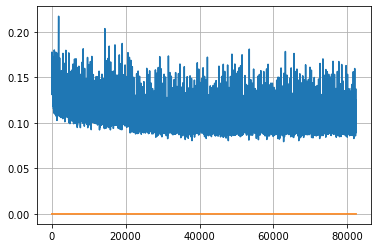

Epoch: 212, iteration 0, loss 0.09733965992927551, cov_diff 0.40284287110303735 cov_diff train 0.4020271519972161
Epoch: 212, iteration 1, loss 0.11237499117851257, cov_diff 0.4040552263008716 cov_diff train 0.4034649224106927
Epoch: 212, iteration 2, loss 0.09736928343772888, cov_diff 0.40842206346307913 cov_diff train 0.40804702672428445
Epoch: 212, iteration 3, loss 0.1089552640914917, cov_diff 0.4164522176035822 cov_diff train 0.41533735835540514
Epoch: 212, iteration 4, loss 0.09057280421257019, cov_diff 0.4126059710126795 cov_diff train 0.4118731447472106
Epoch: 212, iteration 5, loss 0.10146960616111755, cov_diff 0.40644303689565436 cov_diff train 0.4058913333798876
Epoch: 212, iteration 6, loss 0.09998351335525513, cov_diff 0.40624493723622745 cov_diff train 0.40565325574076816
Epoch: 212, iteration 7, loss 0.10112643241882324, cov_diff 0.41293463068080394 cov_diff train 0.4120385735511866
Epoch: 212, iteration 8, loss 0.09212386608123779, cov_diff 0.4132158033746264 cov_diff t

Epoch: 212, iteration 78, loss 0.11072167754173279, cov_diff 0.4219642284698376 cov_diff train 0.4204528636278691
Epoch: 212, iteration 79, loss 0.09717732667922974, cov_diff 0.4146303359706699 cov_diff train 0.41298714198975744
Epoch: 212, iteration 80, loss 0.09757155179977417, cov_diff 0.42208689317792614 cov_diff train 0.4212389181096221
Epoch: 212, iteration 81, loss 0.10254964232444763, cov_diff 0.42419016774907303 cov_diff train 0.42348505481981924
Epoch: 212, iteration 82, loss 0.11998102068901062, cov_diff 0.4191762014118175 cov_diff train 0.4179701650513802
Epoch: 212, iteration 83, loss 0.0891290009021759, cov_diff 0.4090542719377455 cov_diff train 0.4079510411885451
Epoch: 212, iteration 84, loss 0.1022820770740509, cov_diff 0.3945277073629713 cov_diff train 0.39422454144587876
Epoch: 212, iteration 85, loss 0.11287903785705566, cov_diff 0.4086334242884983 cov_diff train 0.4073082393602464
Epoch: 212, iteration 86, loss 0.09341835975646973, cov_diff 0.410025166384217 cov_di

Epoch: 212, iteration 157, loss 0.10876104235649109, cov_diff 0.41301503943374285 cov_diff train 0.41229414117672286
Epoch: 212, iteration 158, loss 0.1025276780128479, cov_diff 0.41868496387224474 cov_diff train 0.4169028787592376
Epoch: 212, iteration 159, loss 0.09282198548316956, cov_diff 0.4187862207439102 cov_diff train 0.41806650577884347
Epoch: 212, iteration 160, loss 0.12328314781188965, cov_diff 0.41921430712514257 cov_diff train 0.4176954820045121
Epoch: 212, iteration 161, loss 0.11447206139564514, cov_diff 0.417912308701991 cov_diff train 0.4177700417219152
Epoch: 212, iteration 162, loss 0.09667128324508667, cov_diff 0.4109262654148648 cov_diff train 0.4107228199730635
Epoch: 212, iteration 163, loss 0.0982958972454071, cov_diff 0.4059760856633544 cov_diff train 0.405359652448086
Epoch: 212, iteration 164, loss 0.096539705991745, cov_diff 0.41977215331240136 cov_diff train 0.4191548246298949
Epoch: 212, iteration 165, loss 0.11657288670539856, cov_diff 0.4082620708413781

Epoch: 212, iteration 236, loss 0.10579311847686768, cov_diff 0.4140180990093505 cov_diff train 0.41269707861282573
Epoch: 212, iteration 237, loss 0.11237531900405884, cov_diff 0.4052568874379261 cov_diff train 0.40448379276389385
Epoch: 212, iteration 238, loss 0.09973031282424927, cov_diff 0.4181575128657523 cov_diff train 0.4171597117336139
Epoch: 212, iteration 239, loss 0.10973438620567322, cov_diff 0.40281895078684404 cov_diff train 0.4022828260803954
Epoch: 212, iteration 240, loss 0.10063233971595764, cov_diff 0.40852295120738724 cov_diff train 0.4083270110307633
Epoch: 212, iteration 241, loss 0.09940245747566223, cov_diff 0.4024002598452664 cov_diff train 0.40248186188650753
Epoch: 212, iteration 242, loss 0.10366195440292358, cov_diff 0.4140610151037724 cov_diff train 0.41395963590681784
Epoch: 212, iteration 243, loss 0.10683053731918335, cov_diff 0.4093961341689271 cov_diff train 0.40964723746054427
Epoch: 212, iteration 244, loss 0.10631859302520752, cov_diff 0.404726868

Epoch: 212, iteration 316, loss 0.10539153218269348, cov_diff 0.4108150887378255 cov_diff train 0.4104277477326109
Epoch: 212, iteration 317, loss 0.10251736640930176, cov_diff 0.4126425280145776 cov_diff train 0.4122947165453746
Epoch: 212, iteration 318, loss 0.09906014800071716, cov_diff 0.408027860509775 cov_diff train 0.4071612509488765
Epoch: 212, iteration 319, loss 0.09970727562904358, cov_diff 0.4047553733959483 cov_diff train 0.4046275563862336
Epoch: 212, iteration 320, loss 0.10356506705284119, cov_diff 0.4077084343304339 cov_diff train 0.4060016027520895
Epoch: 212, iteration 321, loss 0.09518274664878845, cov_diff 0.41136330351293693 cov_diff train 0.41043326376269684
Epoch: 212, iteration 322, loss 0.10267916321754456, cov_diff 0.4211981589767192 cov_diff train 0.42088869639415244
Epoch: 212, iteration 323, loss 0.10662135481834412, cov_diff 0.4193041065208022 cov_diff train 0.4194657952374122
Epoch: 212, iteration 324, loss 0.09785604476928711, cov_diff 0.40713760821506

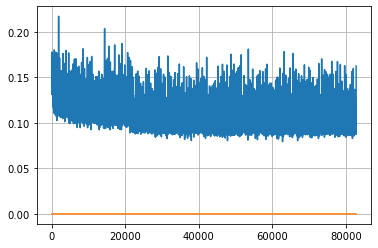

Epoch: 213, iteration 0, loss 0.10191023349761963, cov_diff 0.42482415758305003 cov_diff train 0.42452175975488476
Epoch: 213, iteration 1, loss 0.10325321555137634, cov_diff 0.41188332547635315 cov_diff train 0.41189194202782614
Epoch: 213, iteration 2, loss 0.10915929079055786, cov_diff 0.41328125824074824 cov_diff train 0.4129323902589883
Epoch: 213, iteration 3, loss 0.10932287573814392, cov_diff 0.4126277207644365 cov_diff train 0.4122857378406197
Epoch: 213, iteration 4, loss 0.09553775191307068, cov_diff 0.40021613301378484 cov_diff train 0.3998548616421754
Epoch: 213, iteration 5, loss 0.09754949808120728, cov_diff 0.4144828229011322 cov_diff train 0.41444161300936166
Epoch: 213, iteration 6, loss 0.10362404584884644, cov_diff 0.40409643511852156 cov_diff train 0.40320912992862945
Epoch: 213, iteration 7, loss 0.10872799158096313, cov_diff 0.4083970565052963 cov_diff train 0.4083188500691047
Epoch: 213, iteration 8, loss 0.11367666721343994, cov_diff 0.43473021254770544 cov_dif

Epoch: 213, iteration 80, loss 0.09745973348617554, cov_diff 0.41574644519548526 cov_diff train 0.4153213170011942
Epoch: 213, iteration 81, loss 0.09048309922218323, cov_diff 0.4118541666485916 cov_diff train 0.41113293332042994
Epoch: 213, iteration 82, loss 0.09991663694381714, cov_diff 0.4144027405608688 cov_diff train 0.41415899119030664
Epoch: 213, iteration 83, loss 0.10546129941940308, cov_diff 0.4202363833839974 cov_diff train 0.41927041094983214
Epoch: 213, iteration 84, loss 0.09835803508758545, cov_diff 0.4092391922253311 cov_diff train 0.4089130407558076
Epoch: 213, iteration 85, loss 0.09001553058624268, cov_diff 0.4245336496960937 cov_diff train 0.42398474427381955
Epoch: 213, iteration 86, loss 0.09559312462806702, cov_diff 0.4111503605706127 cov_diff train 0.4110784019483544
Epoch: 213, iteration 87, loss 0.10008183121681213, cov_diff 0.4043481006960006 cov_diff train 0.4038564468755547
Epoch: 213, iteration 88, loss 0.1094980239868164, cov_diff 0.4134205486975458 cov_

Epoch: 213, iteration 156, loss 0.10329359769821167, cov_diff 0.41155416582497006 cov_diff train 0.41082335772582684
Epoch: 213, iteration 157, loss 0.11208191514015198, cov_diff 0.409332168142073 cov_diff train 0.4089838979258998
Epoch: 213, iteration 158, loss 0.0977582037448883, cov_diff 0.4145302769178501 cov_diff train 0.4137560532477413
Epoch: 213, iteration 159, loss 0.0945318341255188, cov_diff 0.4084852155441871 cov_diff train 0.40758383177929175
Epoch: 213, iteration 160, loss 0.10208767652511597, cov_diff 0.41875343364797774 cov_diff train 0.4182460572372088
Epoch: 213, iteration 161, loss 0.10774511098861694, cov_diff 0.410828079695508 cov_diff train 0.40945898514074114
Epoch: 213, iteration 162, loss 0.0996243953704834, cov_diff 0.40794758826000976 cov_diff train 0.4071545894525351
Epoch: 213, iteration 163, loss 0.10284459590911865, cov_diff 0.4046232843926405 cov_diff train 0.40431999750531666
Epoch: 213, iteration 164, loss 0.09142619371414185, cov_diff 0.41826803947753

Epoch: 213, iteration 227, loss 0.11463844776153564, cov_diff 0.41742790448235106 cov_diff train 0.41502636346437694
Epoch: 213, iteration 228, loss 0.10315051674842834, cov_diff 0.42124667071400945 cov_diff train 0.4202503762849315
Epoch: 213, iteration 229, loss 0.09337636828422546, cov_diff 0.4034528691152205 cov_diff train 0.40263737597589405
Epoch: 213, iteration 230, loss 0.10684332251548767, cov_diff 0.41895127522227577 cov_diff train 0.41829534444629934
Epoch: 213, iteration 231, loss 0.09523466229438782, cov_diff 0.4173598603794215 cov_diff train 0.4167232270517448
Epoch: 213, iteration 232, loss 0.10909146070480347, cov_diff 0.4027160057560279 cov_diff train 0.4017671157125543
Epoch: 213, iteration 233, loss 0.09567686915397644, cov_diff 0.4098244753240584 cov_diff train 0.4092340497327345
Epoch: 213, iteration 234, loss 0.10239970684051514, cov_diff 0.409044735956398 cov_diff train 0.40841976440507954
Epoch: 213, iteration 235, loss 0.10153836011886597, cov_diff 0.4231639440

Epoch: 213, iteration 308, loss 0.10415226221084595, cov_diff 0.42038710775298704 cov_diff train 0.419582820877953
Epoch: 213, iteration 309, loss 0.09693846106529236, cov_diff 0.42317316993239573 cov_diff train 0.422444255708657
Epoch: 213, iteration 310, loss 0.1004597544670105, cov_diff 0.41617254436562107 cov_diff train 0.41616276239341243
Epoch: 213, iteration 311, loss 0.10022783279418945, cov_diff 0.4209937582062071 cov_diff train 0.4212363852387964
Epoch: 213, iteration 312, loss 0.10278588533401489, cov_diff 0.4022511142956858 cov_diff train 0.40241937170448355
Epoch: 213, iteration 313, loss 0.11040401458740234, cov_diff 0.41375590161879894 cov_diff train 0.4132303954899129
Epoch: 213, iteration 314, loss 0.09932669997215271, cov_diff 0.404201483614751 cov_diff train 0.4037884628223689
Epoch: 213, iteration 315, loss 0.10450127720832825, cov_diff 0.4087789177134712 cov_diff train 0.40818451294020586
Epoch: 213, iteration 316, loss 0.09633743762969971, cov_diff 0.4101834255581

Epoch: 213, iteration 386, loss 0.09230777621269226, cov_diff 0.4012905115466583 cov_diff train 0.40074904317418797
Epoch: 213, iteration 387, loss 0.10390844941139221, cov_diff 0.4164293082990173 cov_diff train 0.41623930927132274
Epoch: 213, iteration 388, loss 0.10718375444412231, cov_diff 0.412140964569584 cov_diff train 0.4116194414867412
Epoch: 213, iteration 389, loss 0.10170590877532959, cov_diff 0.41999707360291794 cov_diff train 0.419244499054905
Epoch: 213, iteration 390, loss 0.1666536033153534, cov_diff 0.4531957599761874 cov_diff train 0.45188896862522077


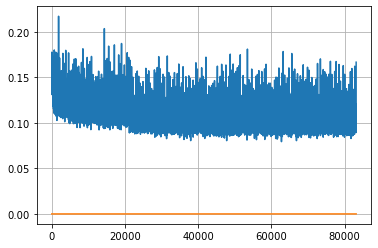

Epoch: 214, iteration 0, loss 0.09901490807533264, cov_diff 0.4295238673888696 cov_diff train 0.42837140940033047
Epoch: 214, iteration 1, loss 0.10463288426399231, cov_diff 0.4149501092649429 cov_diff train 0.41460721880881507
Epoch: 214, iteration 2, loss 0.08580368757247925, cov_diff 0.4117645153773808 cov_diff train 0.41149693163749274
Epoch: 214, iteration 3, loss 0.10491135716438293, cov_diff 0.4159723342617912 cov_diff train 0.41480288324515086
Epoch: 214, iteration 4, loss 0.09062337875366211, cov_diff 0.4206377108644694 cov_diff train 0.41961956107253795
Epoch: 214, iteration 5, loss 0.1022985577583313, cov_diff 0.41101505069590855 cov_diff train 0.4088063791097776
Epoch: 214, iteration 6, loss 0.10314154624938965, cov_diff 0.41048492038408657 cov_diff train 0.40950764933941364
Epoch: 214, iteration 7, loss 0.10022187232971191, cov_diff 0.4140919292117268 cov_diff train 0.4130358555076548
Epoch: 214, iteration 8, loss 0.11224943399429321, cov_diff 0.4161293549980321 cov_diff t

Epoch: 214, iteration 78, loss 0.11150789260864258, cov_diff 0.4059439632402588 cov_diff train 0.4048746011849063
Epoch: 214, iteration 79, loss 0.10507473349571228, cov_diff 0.4105081656825886 cov_diff train 0.4097712749152823
Epoch: 214, iteration 80, loss 0.11329731345176697, cov_diff 0.40640342904038734 cov_diff train 0.40466959909330347
Epoch: 214, iteration 81, loss 0.10528060793876648, cov_diff 0.4078645256388818 cov_diff train 0.4068796577562178
Epoch: 214, iteration 82, loss 0.09513053297996521, cov_diff 0.41253836473923194 cov_diff train 0.41138069261386156
Epoch: 214, iteration 83, loss 0.097086101770401, cov_diff 0.4062143086987721 cov_diff train 0.4060085406719283
Epoch: 214, iteration 84, loss 0.08856382966041565, cov_diff 0.4172771932437551 cov_diff train 0.4171148503969937
Epoch: 214, iteration 85, loss 0.09888193011283875, cov_diff 0.412115114719051 cov_diff train 0.4121227128752783
Epoch: 214, iteration 86, loss 0.10169866681098938, cov_diff 0.417920766269288 cov_diff

Epoch: 214, iteration 157, loss 0.11940565705299377, cov_diff 0.41593506179691697 cov_diff train 0.4150648703639646
Epoch: 214, iteration 158, loss 0.09683305025100708, cov_diff 0.40263003457825886 cov_diff train 0.40237096892715196
Epoch: 214, iteration 159, loss 0.10044410824775696, cov_diff 0.40456290371617076 cov_diff train 0.40377795148395734
Epoch: 214, iteration 160, loss 0.10686510801315308, cov_diff 0.3943631675182241 cov_diff train 0.39459215815427456
Epoch: 214, iteration 161, loss 0.08879882097244263, cov_diff 0.41979480798273267 cov_diff train 0.41931554766908286
Epoch: 214, iteration 162, loss 0.11339583992958069, cov_diff 0.41220857136677236 cov_diff train 0.4122239385326588
Epoch: 214, iteration 163, loss 0.10494723916053772, cov_diff 0.4155205116473481 cov_diff train 0.41497506705919834
Epoch: 214, iteration 164, loss 0.09863168001174927, cov_diff 0.41262468540400615 cov_diff train 0.41121174512738073
Epoch: 214, iteration 165, loss 0.10136032104492188, cov_diff 0.4064

Epoch: 214, iteration 234, loss 0.10433310270309448, cov_diff 0.41533991920745694 cov_diff train 0.4141213739642343
Epoch: 214, iteration 235, loss 0.09877586364746094, cov_diff 0.4100616806870119 cov_diff train 0.41063553239870426
Epoch: 214, iteration 236, loss 0.10582897067070007, cov_diff 0.40258288871450115 cov_diff train 0.4023521691717269
Epoch: 214, iteration 237, loss 0.11524924635887146, cov_diff 0.4212521350918341 cov_diff train 0.4209897124900916
Epoch: 214, iteration 238, loss 0.10984975099563599, cov_diff 0.41345486165050954 cov_diff train 0.41348354643789664
Epoch: 214, iteration 239, loss 0.09955298900604248, cov_diff 0.41085232147143347 cov_diff train 0.41017134495521235
Epoch: 214, iteration 240, loss 0.10190275311470032, cov_diff 0.4122674115674606 cov_diff train 0.41133807773034947
Epoch: 214, iteration 241, loss 0.09116935729980469, cov_diff 0.4090468913731802 cov_diff train 0.4085686328023625
Epoch: 214, iteration 242, loss 0.0957939624786377, cov_diff 0.413644466

Epoch: 214, iteration 310, loss 0.09319448471069336, cov_diff 0.4064322298782442 cov_diff train 0.4057732220905366
Epoch: 214, iteration 311, loss 0.1088269054889679, cov_diff 0.41502185658066054 cov_diff train 0.413233878170818
Epoch: 214, iteration 312, loss 0.10268113017082214, cov_diff 0.41356609562832847 cov_diff train 0.412461958163877
Epoch: 214, iteration 313, loss 0.10541486740112305, cov_diff 0.40091474308536823 cov_diff train 0.40106328566152843
Epoch: 214, iteration 314, loss 0.09622088074684143, cov_diff 0.41001366868173983 cov_diff train 0.40973481233837145
Epoch: 214, iteration 315, loss 0.09923413395881653, cov_diff 0.40103805784915153 cov_diff train 0.4005077545325102
Epoch: 214, iteration 316, loss 0.09766802191734314, cov_diff 0.4127011777004794 cov_diff train 0.41261095048249946
Epoch: 214, iteration 317, loss 0.10125711560249329, cov_diff 0.4192799325641715 cov_diff train 0.4186681543184767
Epoch: 214, iteration 318, loss 0.09536805748939514, cov_diff 0.41801901217

Epoch: 214, iteration 389, loss 0.0947917103767395, cov_diff 0.4146361373963204 cov_diff train 0.41481212685472413
Epoch: 214, iteration 390, loss 0.15573137998580933, cov_diff 0.4627341273501767 cov_diff train 0.46010188132956215


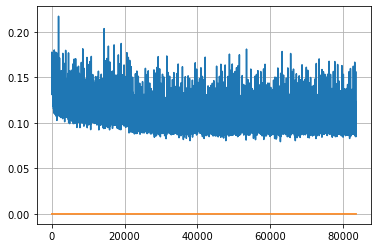

Epoch: 215, iteration 0, loss 0.10481256246566772, cov_diff 0.4198624924235932 cov_diff train 0.4190976045964995
Epoch: 215, iteration 1, loss 0.10235890746116638, cov_diff 0.40862523266644957 cov_diff train 0.407642445801752
Epoch: 215, iteration 2, loss 0.10073253512382507, cov_diff 0.3987659327690835 cov_diff train 0.3981094518672004
Epoch: 215, iteration 3, loss 0.10161161422729492, cov_diff 0.40723927994394893 cov_diff train 0.4065932987826011
Epoch: 215, iteration 4, loss 0.09915575385093689, cov_diff 0.4120920093437535 cov_diff train 0.41203794576239644
Epoch: 215, iteration 5, loss 0.09391170740127563, cov_diff 0.4112324781394315 cov_diff train 0.411121617721272
Epoch: 215, iteration 6, loss 0.09220647811889648, cov_diff 0.4156016824337038 cov_diff train 0.41550751179051265
Epoch: 215, iteration 7, loss 0.10558003187179565, cov_diff 0.39619409931223076 cov_diff train 0.3964299953410043
Epoch: 215, iteration 8, loss 0.10612574219703674, cov_diff 0.4180459212509447 cov_diff train

Epoch: 215, iteration 78, loss 0.10357820987701416, cov_diff 0.4231635520883877 cov_diff train 0.4218373815554597
Epoch: 215, iteration 79, loss 0.10949352383613586, cov_diff 0.41650000922116026 cov_diff train 0.4150394054674924
Epoch: 215, iteration 80, loss 0.10985922813415527, cov_diff 0.42396460007335984 cov_diff train 0.423299445898919
Epoch: 215, iteration 81, loss 0.10291087627410889, cov_diff 0.40426711679946337 cov_diff train 0.4036283908259168
Epoch: 215, iteration 82, loss 0.10753792524337769, cov_diff 0.3992377261210636 cov_diff train 0.3990584217240119
Epoch: 215, iteration 83, loss 0.11798572540283203, cov_diff 0.4017761442908788 cov_diff train 0.40064088077022636
Epoch: 215, iteration 84, loss 0.10703372955322266, cov_diff 0.4126699557246215 cov_diff train 0.41199807621374346
Epoch: 215, iteration 85, loss 0.10544967651367188, cov_diff 0.4186567979611044 cov_diff train 0.41750305263743903
Epoch: 215, iteration 86, loss 0.10762149095535278, cov_diff 0.4147376024463042 cov

Epoch: 215, iteration 157, loss 0.10829821228981018, cov_diff 0.4294175938193673 cov_diff train 0.42809328383595524
Epoch: 215, iteration 158, loss 0.10522860288619995, cov_diff 0.40969244243673403 cov_diff train 0.40787925720574075
Epoch: 215, iteration 159, loss 0.10196086764335632, cov_diff 0.4082369450420261 cov_diff train 0.4076629652430922
Epoch: 215, iteration 160, loss 0.0995020866394043, cov_diff 0.4130865824274781 cov_diff train 0.41251027160537906
Epoch: 215, iteration 161, loss 0.09527689218521118, cov_diff 0.40974529951119976 cov_diff train 0.40871632810425707
Epoch: 215, iteration 162, loss 0.11631715297698975, cov_diff 0.4161741104895723 cov_diff train 0.4155430881950672
Epoch: 215, iteration 163, loss 0.10450991988182068, cov_diff 0.41502174535878583 cov_diff train 0.41381123547094745
Epoch: 215, iteration 164, loss 0.09941628575325012, cov_diff 0.4027845941881693 cov_diff train 0.4022412908623454
Epoch: 215, iteration 165, loss 0.10075950622558594, cov_diff 0.415381316

Epoch: 215, iteration 237, loss 0.09279897809028625, cov_diff 0.4137868321807113 cov_diff train 0.41234564592537043
Epoch: 215, iteration 238, loss 0.09913286566734314, cov_diff 0.4131903546513962 cov_diff train 0.41201509411368814
Epoch: 215, iteration 239, loss 0.08879882097244263, cov_diff 0.4106094233628706 cov_diff train 0.4091659536442924
Epoch: 215, iteration 240, loss 0.09658956527709961, cov_diff 0.40302639005731955 cov_diff train 0.4012257353173951
Epoch: 215, iteration 241, loss 0.09538689255714417, cov_diff 0.4121796352316308 cov_diff train 0.4112442942454648
Epoch: 215, iteration 242, loss 0.10887184739112854, cov_diff 0.4159674007299691 cov_diff train 0.4145633409666131
Epoch: 215, iteration 243, loss 0.096528559923172, cov_diff 0.408890596121027 cov_diff train 0.4075860694663707
Epoch: 215, iteration 244, loss 0.10388752818107605, cov_diff 0.4133695591509195 cov_diff train 0.41279157801304184
Epoch: 215, iteration 245, loss 0.09865164756774902, cov_diff 0.417669037193141

Epoch: 215, iteration 315, loss 0.09921044111251831, cov_diff 0.42306367561607133 cov_diff train 0.4220581123674869
Epoch: 215, iteration 316, loss 0.09185045957565308, cov_diff 0.4098593289672532 cov_diff train 0.4077490950987775
Epoch: 215, iteration 317, loss 0.11151620745658875, cov_diff 0.4122359407509868 cov_diff train 0.41218010855081555
Epoch: 215, iteration 318, loss 0.11411255598068237, cov_diff 0.4014490230202351 cov_diff train 0.39996710627401416
Epoch: 215, iteration 319, loss 0.10146600008010864, cov_diff 0.40322552555651214 cov_diff train 0.40244970228258603
Epoch: 215, iteration 320, loss 0.10396090149879456, cov_diff 0.41239923809907264 cov_diff train 0.4116624781654643
Epoch: 215, iteration 321, loss 0.09129825234413147, cov_diff 0.4179581265535187 cov_diff train 0.4178335717220547
Epoch: 215, iteration 322, loss 0.10494628548622131, cov_diff 0.4099541645727647 cov_diff train 0.4094557759426617
Epoch: 215, iteration 323, loss 0.09738627076148987, cov_diff 0.4127856684

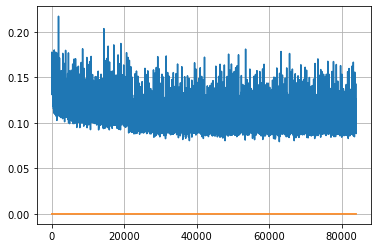

Epoch: 216, iteration 0, loss 0.10345733165740967, cov_diff 0.412389360597165 cov_diff train 0.4118745727664673
Epoch: 216, iteration 1, loss 0.1054697036743164, cov_diff 0.42253285594006623 cov_diff train 0.4229321743277165
Epoch: 216, iteration 2, loss 0.12149661779403687, cov_diff 0.421557709444492 cov_diff train 0.42153184713301195
Epoch: 216, iteration 3, loss 0.0939541757106781, cov_diff 0.41445997123603695 cov_diff train 0.41356449920751526
Epoch: 216, iteration 4, loss 0.10501372814178467, cov_diff 0.418623172881668 cov_diff train 0.4176640956619934
Epoch: 216, iteration 5, loss 0.10404518246650696, cov_diff 0.41597639182626595 cov_diff train 0.41554154498769086
Epoch: 216, iteration 6, loss 0.091287761926651, cov_diff 0.4123137929804999 cov_diff train 0.41137694022137256
Epoch: 216, iteration 7, loss 0.10779163241386414, cov_diff 0.423257251090968 cov_diff train 0.42263508729804117
Epoch: 216, iteration 8, loss 0.11012616753578186, cov_diff 0.40771009867927677 cov_diff train 0

Epoch: 216, iteration 77, loss 0.10366854071617126, cov_diff 0.4113519896652609 cov_diff train 0.41040666743871834
Epoch: 216, iteration 78, loss 0.10621076822280884, cov_diff 0.42139378867168975 cov_diff train 0.42155643635748363
Epoch: 216, iteration 79, loss 0.09983670711517334, cov_diff 0.41620596686626304 cov_diff train 0.41585893435386584
Epoch: 216, iteration 80, loss 0.09973177313804626, cov_diff 0.4151564973151709 cov_diff train 0.4149699689622957
Epoch: 216, iteration 81, loss 0.09455317258834839, cov_diff 0.4091272647604537 cov_diff train 0.4092727988515853
Epoch: 216, iteration 82, loss 0.09517315030097961, cov_diff 0.4079539172658431 cov_diff train 0.40800037358975744
Epoch: 216, iteration 83, loss 0.10377275943756104, cov_diff 0.41535701857309654 cov_diff train 0.41515389850350976
Epoch: 216, iteration 84, loss 0.1114632785320282, cov_diff 0.4133514133027376 cov_diff train 0.4139800130032309
Epoch: 216, iteration 85, loss 0.10844385623931885, cov_diff 0.42339950297255546 

Epoch: 216, iteration 151, loss 0.10560005903244019, cov_diff 0.41830665769361897 cov_diff train 0.41752731945390087
Epoch: 216, iteration 152, loss 0.0913982093334198, cov_diff 0.4087964553551981 cov_diff train 0.40793473309797
Epoch: 216, iteration 153, loss 0.09780266880989075, cov_diff 0.4079773492103801 cov_diff train 0.40801519924375934
Epoch: 216, iteration 154, loss 0.10245737433433533, cov_diff 0.413820120644559 cov_diff train 0.4133265429349409
Epoch: 216, iteration 155, loss 0.11204445362091064, cov_diff 0.4211870953604007 cov_diff train 0.4199844351949136
Epoch: 216, iteration 156, loss 0.11164245009422302, cov_diff 0.4176406835958448 cov_diff train 0.41723620758280106
Epoch: 216, iteration 157, loss 0.09471789002418518, cov_diff 0.4143605137812214 cov_diff train 0.41411525737344723
Epoch: 216, iteration 158, loss 0.09480816125869751, cov_diff 0.40690226979571914 cov_diff train 0.4062983775256458
Epoch: 216, iteration 159, loss 0.10717016458511353, cov_diff 0.40816480774533

Epoch: 216, iteration 225, loss 0.1037319004535675, cov_diff 0.42290564938383784 cov_diff train 0.4215525639959549
Epoch: 216, iteration 226, loss 0.1064220666885376, cov_diff 0.4264810091282868 cov_diff train 0.42613216523657094
Epoch: 216, iteration 227, loss 0.11332762241363525, cov_diff 0.4229312912851239 cov_diff train 0.4213895815754719
Epoch: 216, iteration 228, loss 0.1084146797657013, cov_diff 0.41002212593778237 cov_diff train 0.4091363965070549
Epoch: 216, iteration 229, loss 0.11635762453079224, cov_diff 0.4193932765304611 cov_diff train 0.4193448152475628
Epoch: 216, iteration 230, loss 0.09710896015167236, cov_diff 0.4077233189773196 cov_diff train 0.4078020939326406
Epoch: 216, iteration 231, loss 0.1116175651550293, cov_diff 0.42699578978337666 cov_diff train 0.4263950619134837
Epoch: 216, iteration 232, loss 0.11323919892311096, cov_diff 0.4317116125785003 cov_diff train 0.43179752136507515
Epoch: 216, iteration 233, loss 0.10198423266410828, cov_diff 0.405770823606246

Epoch: 216, iteration 305, loss 0.10898450016975403, cov_diff 0.4131305800567918 cov_diff train 0.4116407462170039
Epoch: 216, iteration 306, loss 0.09676697850227356, cov_diff 0.4214286085400155 cov_diff train 0.4212987956317427
Epoch: 216, iteration 307, loss 0.10803452134132385, cov_diff 0.40703818238488154 cov_diff train 0.40660792343003754
Epoch: 216, iteration 308, loss 0.11528661847114563, cov_diff 0.4219740507542506 cov_diff train 0.4218832645836537
Epoch: 216, iteration 309, loss 0.10267356038093567, cov_diff 0.4254709239220403 cov_diff train 0.425415758567252
Epoch: 216, iteration 310, loss 0.09166467189788818, cov_diff 0.4241441958336895 cov_diff train 0.424388522891322
Epoch: 216, iteration 311, loss 0.1018255352973938, cov_diff 0.4043401129717031 cov_diff train 0.40355256914817594
Epoch: 216, iteration 312, loss 0.09769228100776672, cov_diff 0.4182297791332162 cov_diff train 0.41742236693006884
Epoch: 216, iteration 313, loss 0.10850313305854797, cov_diff 0.412573924293669

Epoch: 216, iteration 383, loss 0.11758127808570862, cov_diff 0.41524742977354545 cov_diff train 0.41435382648295627
Epoch: 216, iteration 384, loss 0.10371893644332886, cov_diff 0.4183840890420163 cov_diff train 0.41710955933055777
Epoch: 216, iteration 385, loss 0.10049033164978027, cov_diff 0.4162963692517534 cov_diff train 0.4151878792052526
Epoch: 216, iteration 386, loss 0.09950387477874756, cov_diff 0.4268244549543377 cov_diff train 0.42604185560612534
Epoch: 216, iteration 387, loss 0.0957748293876648, cov_diff 0.4260201536216612 cov_diff train 0.4253522238247269
Epoch: 216, iteration 388, loss 0.10771596431732178, cov_diff 0.4140087212867334 cov_diff train 0.4135442396336223
Epoch: 216, iteration 389, loss 0.10096967220306396, cov_diff 0.42236565229261697 cov_diff train 0.4219466956100757
Epoch: 216, iteration 390, loss 0.16906976699829102, cov_diff 0.4590355092805802 cov_diff train 0.4588542800524273


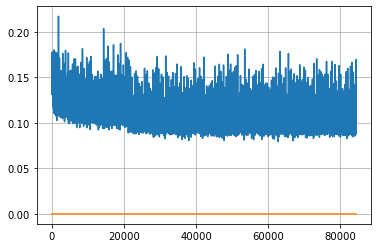

Epoch: 217, iteration 0, loss 0.102193683385849, cov_diff 0.4265588064332458 cov_diff train 0.4260183474169542
Epoch: 217, iteration 1, loss 0.10504788160324097, cov_diff 0.41637586058424336 cov_diff train 0.4152164274531111
Epoch: 217, iteration 2, loss 0.1073700487613678, cov_diff 0.42244212105047896 cov_diff train 0.42083272224892054
Epoch: 217, iteration 3, loss 0.10471460223197937, cov_diff 0.4223399474960234 cov_diff train 0.420440760053919
Epoch: 217, iteration 4, loss 0.11052531003952026, cov_diff 0.41078923884923996 cov_diff train 0.4098578502252533
Epoch: 217, iteration 5, loss 0.10623210668563843, cov_diff 0.4080783665939365 cov_diff train 0.4066057381134284
Epoch: 217, iteration 6, loss 0.11156213283538818, cov_diff 0.4080576324211184 cov_diff train 0.4068292739003257
Epoch: 217, iteration 7, loss 0.11392244696617126, cov_diff 0.4246575769900672 cov_diff train 0.4237653830509534
Epoch: 217, iteration 8, loss 0.11760666966438293, cov_diff 0.4120246350207301 cov_diff train 0.

Epoch: 217, iteration 74, loss 0.1107531487941742, cov_diff 0.42121846480579256 cov_diff train 0.41904017763318496
Epoch: 217, iteration 75, loss 0.10476356744766235, cov_diff 0.3993932621876719 cov_diff train 0.3987101889238179
Epoch: 217, iteration 76, loss 0.10443159937858582, cov_diff 0.4146924326754239 cov_diff train 0.4139994403246051
Epoch: 217, iteration 77, loss 0.10225728154182434, cov_diff 0.40812791242467866 cov_diff train 0.4077134031030268
Epoch: 217, iteration 78, loss 0.11162245273590088, cov_diff 0.40608817164250494 cov_diff train 0.4048326133341861
Epoch: 217, iteration 79, loss 0.09345251321792603, cov_diff 0.40455533011731015 cov_diff train 0.4033163752099988
Epoch: 217, iteration 80, loss 0.09994193911552429, cov_diff 0.40674399181788007 cov_diff train 0.40634687372395056
Epoch: 217, iteration 81, loss 0.1018342673778534, cov_diff 0.40644785818070095 cov_diff train 0.4066701601179567
Epoch: 217, iteration 82, loss 0.1070249080657959, cov_diff 0.41134406847868 cov_d

Epoch: 217, iteration 156, loss 0.09645205736160278, cov_diff 0.4002454428216464 cov_diff train 0.3998064220555403
Epoch: 217, iteration 157, loss 0.0989522933959961, cov_diff 0.4083741173091975 cov_diff train 0.40688700722011834
Epoch: 217, iteration 158, loss 0.11060142517089844, cov_diff 0.4244331527531937 cov_diff train 0.4238982393570946
Epoch: 217, iteration 159, loss 0.10664838552474976, cov_diff 0.3972437342061165 cov_diff train 0.39578837652153537
Epoch: 217, iteration 160, loss 0.10471072793006897, cov_diff 0.4077685510254958 cov_diff train 0.40795434591273644
Epoch: 217, iteration 161, loss 0.10936269164085388, cov_diff 0.4245686571571278 cov_diff train 0.4245628228358734
Epoch: 217, iteration 162, loss 0.10972350835800171, cov_diff 0.40941775327700797 cov_diff train 0.40882455494092246
Epoch: 217, iteration 163, loss 0.11459773778915405, cov_diff 0.4171836601542107 cov_diff train 0.4168065992241774
Epoch: 217, iteration 164, loss 0.10871303081512451, cov_diff 0.413622907338

Epoch: 217, iteration 232, loss 0.10575681924819946, cov_diff 0.43115984013637554 cov_diff train 0.4313253820446187
Epoch: 217, iteration 233, loss 0.09846508502960205, cov_diff 0.4170076205133373 cov_diff train 0.41710128265352053
Epoch: 217, iteration 234, loss 0.09972870349884033, cov_diff 0.4190511017917042 cov_diff train 0.41822326505331225
Epoch: 217, iteration 235, loss 0.11527994275093079, cov_diff 0.4131211730277447 cov_diff train 0.41250304743110605
Epoch: 217, iteration 236, loss 0.10379815101623535, cov_diff 0.4082876921484799 cov_diff train 0.4084712636359796
Epoch: 217, iteration 237, loss 0.09588739275932312, cov_diff 0.4179518185851079 cov_diff train 0.41747987070252474
Epoch: 217, iteration 238, loss 0.12056148052215576, cov_diff 0.4186154381565375 cov_diff train 0.4182328590893994
Epoch: 217, iteration 239, loss 0.09183326363563538, cov_diff 0.4207639347195908 cov_diff train 0.4199859677674144
Epoch: 217, iteration 240, loss 0.11504441499710083, cov_diff 0.40897803163

Epoch: 217, iteration 310, loss 0.10178080201148987, cov_diff 0.4158864798017129 cov_diff train 0.41537062258596824
Epoch: 217, iteration 311, loss 0.11436206102371216, cov_diff 0.4096901224798821 cov_diff train 0.40866295848672746
Epoch: 217, iteration 312, loss 0.11098718643188477, cov_diff 0.409368310240147 cov_diff train 0.40939383085691755
Epoch: 217, iteration 313, loss 0.11303681135177612, cov_diff 0.3988311215662923 cov_diff train 0.3988131234411566
Epoch: 217, iteration 314, loss 0.10285860300064087, cov_diff 0.4095543837135246 cov_diff train 0.4095991983160778
Epoch: 217, iteration 315, loss 0.10076653957366943, cov_diff 0.41217832801752335 cov_diff train 0.41220011732251777
Epoch: 217, iteration 316, loss 0.10080593824386597, cov_diff 0.41881697046190897 cov_diff train 0.4189714608072764
Epoch: 217, iteration 317, loss 0.0946151614189148, cov_diff 0.4042301422583438 cov_diff train 0.4039946691217648
Epoch: 217, iteration 318, loss 0.10573568940162659, cov_diff 0.408434805293

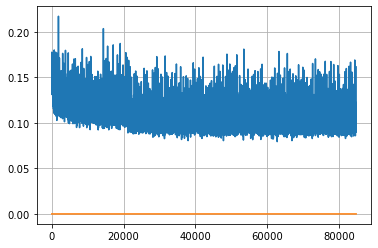

Epoch: 218, iteration 0, loss 0.10559463500976562, cov_diff 0.42590891771150446 cov_diff train 0.42591301927991576
Epoch: 218, iteration 1, loss 0.10299062728881836, cov_diff 0.42079898434423263 cov_diff train 0.42042881679682415
Epoch: 218, iteration 2, loss 0.11595630645751953, cov_diff 0.416339105171637 cov_diff train 0.4162286908581542
Epoch: 218, iteration 3, loss 0.11381900310516357, cov_diff 0.41552121907533435 cov_diff train 0.41458928114369453
Epoch: 218, iteration 4, loss 0.09924778342247009, cov_diff 0.41366482591706566 cov_diff train 0.41302545210607927
Epoch: 218, iteration 5, loss 0.10053321719169617, cov_diff 0.4209926538838794 cov_diff train 0.42025273644367395
Epoch: 218, iteration 6, loss 0.10916441679000854, cov_diff 0.41333440904489505 cov_diff train 0.4122997347688721
Epoch: 218, iteration 7, loss 0.10622304677963257, cov_diff 0.41097857760296913 cov_diff train 0.41039565921580723
Epoch: 218, iteration 8, loss 0.10581082105636597, cov_diff 0.41800132761180353 cov_d

Epoch: 218, iteration 80, loss 0.11285972595214844, cov_diff 0.40852820554311564 cov_diff train 0.4082477072965034
Epoch: 218, iteration 81, loss 0.10532188415527344, cov_diff 0.4097880033275617 cov_diff train 0.4097650494213809
Epoch: 218, iteration 82, loss 0.09806370735168457, cov_diff 0.41209582475754497 cov_diff train 0.41192867544780315
Epoch: 218, iteration 83, loss 0.09046921133995056, cov_diff 0.42197646221027785 cov_diff train 0.42113005457636243
Epoch: 218, iteration 84, loss 0.10273754596710205, cov_diff 0.41399566616403366 cov_diff train 0.41325698744901246
Epoch: 218, iteration 85, loss 0.11125975847244263, cov_diff 0.4123980733533977 cov_diff train 0.4114206856765066
Epoch: 218, iteration 86, loss 0.1002672016620636, cov_diff 0.40919328419645434 cov_diff train 0.40801624625644545
Epoch: 218, iteration 87, loss 0.10498586297035217, cov_diff 0.421759050079625 cov_diff train 0.42045028575298293
Epoch: 218, iteration 88, loss 0.10013735294342041, cov_diff 0.41253996004775323

Epoch: 218, iteration 160, loss 0.11021688580513, cov_diff 0.41340495316911496 cov_diff train 0.41310868090502245
Epoch: 218, iteration 161, loss 0.10718953609466553, cov_diff 0.4189379263443884 cov_diff train 0.4184658208822205
Epoch: 218, iteration 162, loss 0.09065216779708862, cov_diff 0.4196316964418253 cov_diff train 0.41898715003011694
Epoch: 218, iteration 163, loss 0.09774196147918701, cov_diff 0.4294502179540511 cov_diff train 0.4279612722596621
Epoch: 218, iteration 164, loss 0.1028018593788147, cov_diff 0.4132409048306613 cov_diff train 0.41233037772372816
Epoch: 218, iteration 165, loss 0.10042533278465271, cov_diff 0.4174842653912571 cov_diff train 0.41609908814514657
Epoch: 218, iteration 166, loss 0.0981830358505249, cov_diff 0.41788253962685845 cov_diff train 0.4171092112796661
Epoch: 218, iteration 167, loss 0.1005951464176178, cov_diff 0.4029862983277407 cov_diff train 0.4027873263117057
Epoch: 218, iteration 168, loss 0.10904008150100708, cov_diff 0.4269430265652121

Epoch: 218, iteration 235, loss 0.11593014001846313, cov_diff 0.4076253456362498 cov_diff train 0.40751404855633
Epoch: 218, iteration 236, loss 0.09278759360313416, cov_diff 0.4214838568274674 cov_diff train 0.4212958054220769
Epoch: 218, iteration 237, loss 0.10514935851097107, cov_diff 0.4201889546910619 cov_diff train 0.4201585965870452
Epoch: 218, iteration 238, loss 0.09738850593566895, cov_diff 0.40985744559759446 cov_diff train 0.4095997947774103
Epoch: 218, iteration 239, loss 0.10514000058174133, cov_diff 0.4142832030580981 cov_diff train 0.4131550366570844
Epoch: 218, iteration 240, loss 0.10382992029190063, cov_diff 0.416680857804327 cov_diff train 0.4161287889434075
Epoch: 218, iteration 241, loss 0.11203545331954956, cov_diff 0.416361905790192 cov_diff train 0.4156756220740112
Epoch: 218, iteration 242, loss 0.10977429151535034, cov_diff 0.4155385358652478 cov_diff train 0.41443791475730046
Epoch: 218, iteration 243, loss 0.1066071093082428, cov_diff 0.4016080515325603 co

Epoch: 218, iteration 311, loss 0.11963760852813721, cov_diff 0.41393562214891816 cov_diff train 0.4134623533543315
Epoch: 218, iteration 312, loss 0.10184606909751892, cov_diff 0.42597007573848483 cov_diff train 0.42514098353746615
Epoch: 218, iteration 313, loss 0.10060989856719971, cov_diff 0.42855286869869963 cov_diff train 0.42787073677828535
Epoch: 218, iteration 314, loss 0.0992923378944397, cov_diff 0.42421652752129435 cov_diff train 0.4235240323877359
Epoch: 218, iteration 315, loss 0.09339496493339539, cov_diff 0.4086216832488047 cov_diff train 0.40748884559701476
Epoch: 218, iteration 316, loss 0.10724735260009766, cov_diff 0.4191052674834137 cov_diff train 0.41808908128820527
Epoch: 218, iteration 317, loss 0.09947043657302856, cov_diff 0.4153218301847847 cov_diff train 0.41502342767303935
Epoch: 218, iteration 318, loss 0.09884625673294067, cov_diff 0.4008458302507992 cov_diff train 0.4000532449310785
Epoch: 218, iteration 319, loss 0.10943108797073364, cov_diff 0.41853222

Epoch: 218, iteration 390, loss 0.15135732293128967, cov_diff 0.44044927178439885 cov_diff train 0.4402561690231043


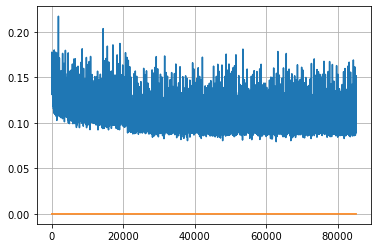

Epoch: 219, iteration 0, loss 0.10852554440498352, cov_diff 0.4252891208631874 cov_diff train 0.4250503528129315
Epoch: 219, iteration 1, loss 0.09302836656570435, cov_diff 0.42145464854296516 cov_diff train 0.42166585021435027
Epoch: 219, iteration 2, loss 0.10550186038017273, cov_diff 0.42126230639338996 cov_diff train 0.4210914240931926
Epoch: 219, iteration 3, loss 0.10699084401130676, cov_diff 0.40293494012937936 cov_diff train 0.40297957629762554
Epoch: 219, iteration 4, loss 0.09887439012527466, cov_diff 0.4197357575825837 cov_diff train 0.42020576921068487
Epoch: 219, iteration 5, loss 0.10211226344108582, cov_diff 0.4320222583961531 cov_diff train 0.43182406328098294
Epoch: 219, iteration 6, loss 0.11025339365005493, cov_diff 0.41596074330598415 cov_diff train 0.4153369767082608
Epoch: 219, iteration 7, loss 0.09762352705001831, cov_diff 0.40966006501366536 cov_diff train 0.4080624430476591
Epoch: 219, iteration 8, loss 0.10128098726272583, cov_diff 0.42405495090116435 cov_dif

Epoch: 219, iteration 79, loss 0.10172960162162781, cov_diff 0.42628064913508273 cov_diff train 0.42578143850139616
Epoch: 219, iteration 80, loss 0.1091393530368805, cov_diff 0.4205638962138693 cov_diff train 0.41882120796430516
Epoch: 219, iteration 81, loss 0.11372104287147522, cov_diff 0.4214524794663017 cov_diff train 0.4214401145988182
Epoch: 219, iteration 82, loss 0.10540086030960083, cov_diff 0.4115241114458074 cov_diff train 0.4114502410551598
Epoch: 219, iteration 83, loss 0.1090688705444336, cov_diff 0.4157680399705923 cov_diff train 0.415368424511827
Epoch: 219, iteration 84, loss 0.09214341640472412, cov_diff 0.4184087388200422 cov_diff train 0.4170874561064028
Epoch: 219, iteration 85, loss 0.12100490927696228, cov_diff 0.42515317577768413 cov_diff train 0.42500309996749536
Epoch: 219, iteration 86, loss 0.10793861746788025, cov_diff 0.4056758796889963 cov_diff train 0.4056984327883549
Epoch: 219, iteration 87, loss 0.10557428002357483, cov_diff 0.419060761841901 cov_dif

Epoch: 219, iteration 158, loss 0.10488423705101013, cov_diff 0.4091624708502636 cov_diff train 0.4088861257247497
Epoch: 219, iteration 159, loss 0.10094258189201355, cov_diff 0.39923390913235374 cov_diff train 0.39874681372686954
Epoch: 219, iteration 160, loss 0.10269686579704285, cov_diff 0.42866248460051504 cov_diff train 0.42865479501207165
Epoch: 219, iteration 161, loss 0.11379963159561157, cov_diff 0.40293993032941466 cov_diff train 0.402418773279232
Epoch: 219, iteration 162, loss 0.11958464980125427, cov_diff 0.41135316756468865 cov_diff train 0.41099324928596814
Epoch: 219, iteration 163, loss 0.10234105587005615, cov_diff 0.40730081168085497 cov_diff train 0.4071392226165862
Epoch: 219, iteration 164, loss 0.11325374245643616, cov_diff 0.4084393706742261 cov_diff train 0.40814381965549246
Epoch: 219, iteration 165, loss 0.10439294576644897, cov_diff 0.4015311573512195 cov_diff train 0.4006270398239677
Epoch: 219, iteration 166, loss 0.11127370595932007, cov_diff 0.40719949

Epoch: 219, iteration 236, loss 0.08914020657539368, cov_diff 0.4120941208495571 cov_diff train 0.41190485224620976
Epoch: 219, iteration 237, loss 0.11557638645172119, cov_diff 0.4109272470838488 cov_diff train 0.40979952242419054
Epoch: 219, iteration 238, loss 0.10294631123542786, cov_diff 0.4119010034865357 cov_diff train 0.4102769277134846
Epoch: 219, iteration 239, loss 0.10102730989456177, cov_diff 0.41323691567890924 cov_diff train 0.41302310971634626
Epoch: 219, iteration 240, loss 0.09738704562187195, cov_diff 0.4136393076150431 cov_diff train 0.4133147529793942
Epoch: 219, iteration 241, loss 0.12203362584114075, cov_diff 0.4289708564409871 cov_diff train 0.4279349389725624
Epoch: 219, iteration 242, loss 0.09907829761505127, cov_diff 0.41133956845477115 cov_diff train 0.41037187189339036
Epoch: 219, iteration 243, loss 0.10921633243560791, cov_diff 0.40366769174817824 cov_diff train 0.40233398423173894
Epoch: 219, iteration 244, loss 0.1060565710067749, cov_diff 0.412318172

Epoch: 219, iteration 314, loss 0.0938311517238617, cov_diff 0.4211483739482659 cov_diff train 0.42127883219889456
Epoch: 219, iteration 315, loss 0.09932845830917358, cov_diff 0.4226780848309002 cov_diff train 0.421417213004754
Epoch: 219, iteration 316, loss 0.09913751482963562, cov_diff 0.41524939222887663 cov_diff train 0.4146350359630657
Epoch: 219, iteration 317, loss 0.10525083541870117, cov_diff 0.4238170010745767 cov_diff train 0.4232608856070234
Epoch: 219, iteration 318, loss 0.1125880777835846, cov_diff 0.4095413612289349 cov_diff train 0.40830761848742986
Epoch: 219, iteration 319, loss 0.10810631513595581, cov_diff 0.4193782305589476 cov_diff train 0.41835749954990176
Epoch: 219, iteration 320, loss 0.1201930046081543, cov_diff 0.4210765943818521 cov_diff train 0.421292538603184
Epoch: 219, iteration 321, loss 0.09792092442512512, cov_diff 0.41233247226792813 cov_diff train 0.41178510458858353
Epoch: 219, iteration 322, loss 0.10222175717353821, cov_diff 0.416913405697544

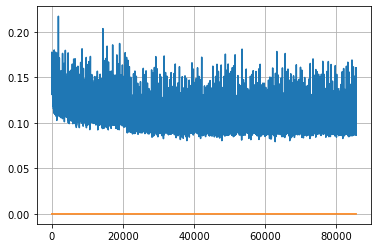

Epoch: 220, iteration 0, loss 0.10740450024604797, cov_diff 0.40483833143053105 cov_diff train 0.40358692287690107
Epoch: 220, iteration 1, loss 0.10626676678657532, cov_diff 0.41447634473699463 cov_diff train 0.4139390154545092
Epoch: 220, iteration 2, loss 0.1113201379776001, cov_diff 0.4207221283311579 cov_diff train 0.41901402562817686
Epoch: 220, iteration 3, loss 0.0966668426990509, cov_diff 0.4076542668138545 cov_diff train 0.4070970980131065
Epoch: 220, iteration 4, loss 0.11302700638771057, cov_diff 0.41611181741804804 cov_diff train 0.4153050466883349
Epoch: 220, iteration 5, loss 0.09794262051582336, cov_diff 0.4169981751967567 cov_diff train 0.4163769058484357
Epoch: 220, iteration 6, loss 0.10443902015686035, cov_diff 0.40900688474146135 cov_diff train 0.4082697224397977
Epoch: 220, iteration 7, loss 0.10005044937133789, cov_diff 0.413901378038915 cov_diff train 0.4130372879131462
Epoch: 220, iteration 8, loss 0.10219019651412964, cov_diff 0.4158050117241948 cov_diff train

Epoch: 220, iteration 77, loss 0.10627475380897522, cov_diff 0.42239002272193327 cov_diff train 0.4215779123988056
Epoch: 220, iteration 78, loss 0.11020064353942871, cov_diff 0.4043053661545109 cov_diff train 0.4033320927582991
Epoch: 220, iteration 79, loss 0.10956743359565735, cov_diff 0.40123190022695765 cov_diff train 0.4006615342556279
Epoch: 220, iteration 80, loss 0.11171123385429382, cov_diff 0.4124082327201825 cov_diff train 0.41158883687376496
Epoch: 220, iteration 81, loss 0.10876226425170898, cov_diff 0.419731190938235 cov_diff train 0.419445812131821
Epoch: 220, iteration 82, loss 0.11700892448425293, cov_diff 0.40553179017415697 cov_diff train 0.4050241873910419
Epoch: 220, iteration 83, loss 0.11105826497077942, cov_diff 0.4198726852395248 cov_diff train 0.41950766797803635
Epoch: 220, iteration 84, loss 0.10294154286384583, cov_diff 0.4153643767936115 cov_diff train 0.41454711846641157
Epoch: 220, iteration 85, loss 0.10476428270339966, cov_diff 0.40625376372767624 cov

Epoch: 220, iteration 154, loss 0.10682374238967896, cov_diff 0.41607169642082 cov_diff train 0.41516390159469896
Epoch: 220, iteration 155, loss 0.10717830061912537, cov_diff 0.40056080403680666 cov_diff train 0.3997788666284705
Epoch: 220, iteration 156, loss 0.10215574502944946, cov_diff 0.4078888353043527 cov_diff train 0.4076079986453258
Epoch: 220, iteration 157, loss 0.10387781262397766, cov_diff 0.39596556338109123 cov_diff train 0.3956444408762592
Epoch: 220, iteration 158, loss 0.11186382174491882, cov_diff 0.4167161353628453 cov_diff train 0.416514305845387
Epoch: 220, iteration 159, loss 0.09206876158714294, cov_diff 0.3931786165273879 cov_diff train 0.39351861803625526
Epoch: 220, iteration 160, loss 0.10984876751899719, cov_diff 0.4136602803815153 cov_diff train 0.4125928756560622
Epoch: 220, iteration 161, loss 0.10241025686264038, cov_diff 0.4321682414970123 cov_diff train 0.431943177441018
Epoch: 220, iteration 162, loss 0.11079174280166626, cov_diff 0.4066200018820763

Epoch: 220, iteration 232, loss 0.09214740991592407, cov_diff 0.4117886201553131 cov_diff train 0.41170319635391467
Epoch: 220, iteration 233, loss 0.11663404107093811, cov_diff 0.4161916453355783 cov_diff train 0.4164361878347816
Epoch: 220, iteration 234, loss 0.10088786482810974, cov_diff 0.40498638747844434 cov_diff train 0.4040964028096807
Epoch: 220, iteration 235, loss 0.1011844277381897, cov_diff 0.4142146790971963 cov_diff train 0.41255574251605576
Epoch: 220, iteration 236, loss 0.10151278972625732, cov_diff 0.4223820645951754 cov_diff train 0.4223573086800555
Epoch: 220, iteration 237, loss 0.09837737679481506, cov_diff 0.41958933109683905 cov_diff train 0.41869301739162085
Epoch: 220, iteration 238, loss 0.10275465250015259, cov_diff 0.4132314711365528 cov_diff train 0.4127684976566922
Epoch: 220, iteration 239, loss 0.11419054865837097, cov_diff 0.42320239385910713 cov_diff train 0.4216268154383185
Epoch: 220, iteration 240, loss 0.10839569568634033, cov_diff 0.42444778439

Epoch: 220, iteration 312, loss 0.11022621393203735, cov_diff 0.42126904657869885 cov_diff train 0.42067711768556537
Epoch: 220, iteration 313, loss 0.10250061750411987, cov_diff 0.40902695579968373 cov_diff train 0.4090113548858404
Epoch: 220, iteration 314, loss 0.09296554327011108, cov_diff 0.40926890183553244 cov_diff train 0.409374730397018
Epoch: 220, iteration 315, loss 0.10107117891311646, cov_diff 0.4180838024220943 cov_diff train 0.41746106194324206
Epoch: 220, iteration 316, loss 0.0906100869178772, cov_diff 0.41100961512083484 cov_diff train 0.41043043594012163
Epoch: 220, iteration 317, loss 0.10168758034706116, cov_diff 0.4145803745596862 cov_diff train 0.4144333090949986
Epoch: 220, iteration 318, loss 0.10022225975990295, cov_diff 0.41532260869674176 cov_diff train 0.4147358170925141
Epoch: 220, iteration 319, loss 0.1168430745601654, cov_diff 0.4182505862533361 cov_diff train 0.4167583316683837
Epoch: 220, iteration 320, loss 0.09720686078071594, cov_diff 0.41845820663

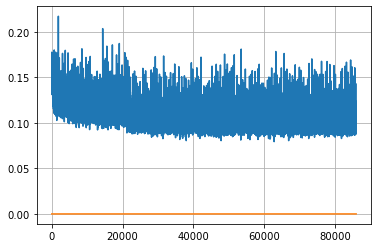

Epoch: 221, iteration 0, loss 0.10704663395881653, cov_diff 0.41362865237956903 cov_diff train 0.4134012994611452
Epoch: 221, iteration 1, loss 0.10325047373771667, cov_diff 0.4191866955465105 cov_diff train 0.4181430730466363
Epoch: 221, iteration 2, loss 0.11258631944656372, cov_diff 0.4157645274345213 cov_diff train 0.4146768350884037
Epoch: 221, iteration 3, loss 0.09450963139533997, cov_diff 0.4205300986078655 cov_diff train 0.4196199773390386
Epoch: 221, iteration 4, loss 0.08828383684158325, cov_diff 0.4113663454589788 cov_diff train 0.4110164757154965
Epoch: 221, iteration 5, loss 0.10723865032196045, cov_diff 0.41817788349155205 cov_diff train 0.4169665705351048
Epoch: 221, iteration 6, loss 0.11852520704269409, cov_diff 0.4157062625882383 cov_diff train 0.41488190801674046
Epoch: 221, iteration 7, loss 0.09272870421409607, cov_diff 0.40754520833037067 cov_diff train 0.4068678920270879
Epoch: 221, iteration 8, loss 0.10063585638999939, cov_diff 0.40362008964908647 cov_diff tra

Epoch: 221, iteration 77, loss 0.10941308736801147, cov_diff 0.42763210324217743 cov_diff train 0.42690150114586844
Epoch: 221, iteration 78, loss 0.10156580805778503, cov_diff 0.4192229531199424 cov_diff train 0.41841670404228815
Epoch: 221, iteration 79, loss 0.11163651943206787, cov_diff 0.4243725441802651 cov_diff train 0.42381887817883984
Epoch: 221, iteration 80, loss 0.11224973201751709, cov_diff 0.4084741765850556 cov_diff train 0.4075780183501305
Epoch: 221, iteration 81, loss 0.10681983828544617, cov_diff 0.4074786376792176 cov_diff train 0.40676200344076674
Epoch: 221, iteration 82, loss 0.09326213598251343, cov_diff 0.4214699473160065 cov_diff train 0.421416450785096
Epoch: 221, iteration 83, loss 0.09912639856338501, cov_diff 0.40928884780562663 cov_diff train 0.40821117685492436
Epoch: 221, iteration 84, loss 0.10141974687576294, cov_diff 0.40177288740870043 cov_diff train 0.40121268278985384
Epoch: 221, iteration 85, loss 0.10283240675926208, cov_diff 0.42204654028900895

Epoch: 221, iteration 156, loss 0.1151452362537384, cov_diff 0.4279342735202884 cov_diff train 0.4263307513848033
Epoch: 221, iteration 157, loss 0.10882669687271118, cov_diff 0.4226767895044566 cov_diff train 0.4210304830691551
Epoch: 221, iteration 158, loss 0.10076680779457092, cov_diff 0.4149962810828351 cov_diff train 0.4147165998130451
Epoch: 221, iteration 159, loss 0.10504183173179626, cov_diff 0.4129750610099859 cov_diff train 0.4122530930185771
Epoch: 221, iteration 160, loss 0.101724773645401, cov_diff 0.4073256689981933 cov_diff train 0.4059052008872812
Epoch: 221, iteration 161, loss 0.11551052331924438, cov_diff 0.41741757418788406 cov_diff train 0.4154798754919045
Epoch: 221, iteration 162, loss 0.12273690104484558, cov_diff 0.4080005253819665 cov_diff train 0.4069839722674126
Epoch: 221, iteration 163, loss 0.09532326459884644, cov_diff 0.40181264568772423 cov_diff train 0.4017420666626456
Epoch: 221, iteration 164, loss 0.10455286502838135, cov_diff 0.39895656613937347

Epoch: 221, iteration 235, loss 0.09565287828445435, cov_diff 0.4034424228517961 cov_diff train 0.40317484726754554
Epoch: 221, iteration 236, loss 0.10921093821525574, cov_diff 0.42190309045845786 cov_diff train 0.42096554018920324
Epoch: 221, iteration 237, loss 0.10870960354804993, cov_diff 0.40387899930730237 cov_diff train 0.40407704754995155
Epoch: 221, iteration 238, loss 0.11169204115867615, cov_diff 0.41593667090494696 cov_diff train 0.41622433153823735
Epoch: 221, iteration 239, loss 0.11324453353881836, cov_diff 0.40362908904810924 cov_diff train 0.4030796771966613
Epoch: 221, iteration 240, loss 0.10634061694145203, cov_diff 0.4104932904221619 cov_diff train 0.41036739542463485
Epoch: 221, iteration 241, loss 0.09876495599746704, cov_diff 0.41239963219391956 cov_diff train 0.4120036278089796
Epoch: 221, iteration 242, loss 0.1058436930179596, cov_diff 0.410829537413807 cov_diff train 0.4111644821589258
Epoch: 221, iteration 243, loss 0.08981823921203613, cov_diff 0.42674579

Epoch: 221, iteration 306, loss 0.10719156265258789, cov_diff 0.4105453689461405 cov_diff train 0.40986032829627345
Epoch: 221, iteration 307, loss 0.10555616021156311, cov_diff 0.40308686612546296 cov_diff train 0.40219325761291025
Epoch: 221, iteration 308, loss 0.11287355422973633, cov_diff 0.4089375458350729 cov_diff train 0.40789774643620264
Epoch: 221, iteration 309, loss 0.11064401268959045, cov_diff 0.4115526840373563 cov_diff train 0.41128424577095213
Epoch: 221, iteration 310, loss 0.09851756691932678, cov_diff 0.4159790678697175 cov_diff train 0.415363936062712
Epoch: 221, iteration 311, loss 0.11036798357963562, cov_diff 0.40487157244908106 cov_diff train 0.40421090217682176
Epoch: 221, iteration 312, loss 0.10600179433822632, cov_diff 0.41574196421403964 cov_diff train 0.41506862420700424
Epoch: 221, iteration 313, loss 0.1056315004825592, cov_diff 0.4065721523681155 cov_diff train 0.40617422183118457
Epoch: 221, iteration 314, loss 0.09577563405036926, cov_diff 0.41581224

Epoch: 221, iteration 383, loss 0.09739616513252258, cov_diff 0.41280292988231504 cov_diff train 0.411186651023978
Epoch: 221, iteration 384, loss 0.09467291831970215, cov_diff 0.41314874451535394 cov_diff train 0.41283958169109164
Epoch: 221, iteration 385, loss 0.11586689949035645, cov_diff 0.41596831310427607 cov_diff train 0.41534046437314726
Epoch: 221, iteration 386, loss 0.10494372248649597, cov_diff 0.42958278631121294 cov_diff train 0.42873779332686834
Epoch: 221, iteration 387, loss 0.10210469365119934, cov_diff 0.39761098311147436 cov_diff train 0.3969775325694985
Epoch: 221, iteration 388, loss 0.11598071455955505, cov_diff 0.40472779587520424 cov_diff train 0.40430270662177603
Epoch: 221, iteration 389, loss 0.12152895331382751, cov_diff 0.41530391444618653 cov_diff train 0.41432419056148667
Epoch: 221, iteration 390, loss 0.1349778175354004, cov_diff 0.45763644715608065 cov_diff train 0.45783750153082164


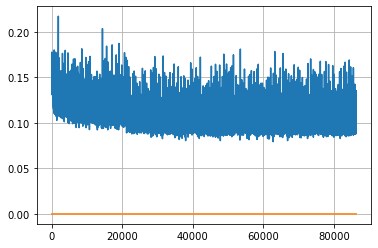

Epoch: 222, iteration 0, loss 0.09885260462760925, cov_diff 0.4149545989470295 cov_diff train 0.41508841318530093
Epoch: 222, iteration 1, loss 0.09553954005241394, cov_diff 0.4298450355637495 cov_diff train 0.4288593135888156
Epoch: 222, iteration 2, loss 0.1018209159374237, cov_diff 0.41077564974418335 cov_diff train 0.4101654883724216
Epoch: 222, iteration 3, loss 0.09880086779594421, cov_diff 0.40629190429684664 cov_diff train 0.40639333232078795
Epoch: 222, iteration 4, loss 0.10091617703437805, cov_diff 0.4134770492429166 cov_diff train 0.41336223051980503
Epoch: 222, iteration 5, loss 0.09789043664932251, cov_diff 0.4036604764205818 cov_diff train 0.40356552293935855
Epoch: 222, iteration 6, loss 0.12008726596832275, cov_diff 0.40639253399822944 cov_diff train 0.4057360308084161
Epoch: 222, iteration 7, loss 0.09433591365814209, cov_diff 0.4085073619595726 cov_diff train 0.40832100810156957
Epoch: 222, iteration 8, loss 0.09768790006637573, cov_diff 0.408401461242405 cov_diff tr

Epoch: 222, iteration 81, loss 0.11026373505592346, cov_diff 0.40936456534878357 cov_diff train 0.40864260675629077
Epoch: 222, iteration 82, loss 0.11320379376411438, cov_diff 0.416383936939746 cov_diff train 0.41530284463481104
Epoch: 222, iteration 83, loss 0.09456396102905273, cov_diff 0.40726704901642347 cov_diff train 0.4058640647733296
Epoch: 222, iteration 84, loss 0.11342492699623108, cov_diff 0.4050972417294591 cov_diff train 0.4052055191692518
Epoch: 222, iteration 85, loss 0.10925865173339844, cov_diff 0.39701920803656515 cov_diff train 0.39667956518034664
Epoch: 222, iteration 86, loss 0.0973493754863739, cov_diff 0.41966675960971916 cov_diff train 0.41907248005875647
Epoch: 222, iteration 87, loss 0.10953319072723389, cov_diff 0.4056436225222497 cov_diff train 0.4046936738443744
Epoch: 222, iteration 88, loss 0.11146283149719238, cov_diff 0.4068049281546451 cov_diff train 0.40623249551471435
Epoch: 222, iteration 89, loss 0.11104381084442139, cov_diff 0.41681533095774675 

Epoch: 222, iteration 158, loss 0.10053521394729614, cov_diff 0.40089050372242674 cov_diff train 0.400871302215332
Epoch: 222, iteration 159, loss 0.10016554594039917, cov_diff 0.4202834137523125 cov_diff train 0.41901350503266305
Epoch: 222, iteration 160, loss 0.11027827858924866, cov_diff 0.4263103327138252 cov_diff train 0.4255188483352188
Epoch: 222, iteration 161, loss 0.10583129525184631, cov_diff 0.40408425257188463 cov_diff train 0.4036251782666955
Epoch: 222, iteration 162, loss 0.09701675176620483, cov_diff 0.4054420735891763 cov_diff train 0.40404662688443
Epoch: 222, iteration 163, loss 0.09815692901611328, cov_diff 0.40120850272039055 cov_diff train 0.40091992306378166
Epoch: 222, iteration 164, loss 0.10142573714256287, cov_diff 0.42241224506740943 cov_diff train 0.42165768444440604
Epoch: 222, iteration 165, loss 0.10291415452957153, cov_diff 0.4141129394999991 cov_diff train 0.41319329932056603
Epoch: 222, iteration 166, loss 0.10703423619270325, cov_diff 0.41598891649

Epoch: 222, iteration 232, loss 0.1066388189792633, cov_diff 0.4105406733740382 cov_diff train 0.40956990207330485
Epoch: 222, iteration 233, loss 0.0994337797164917, cov_diff 0.3955593241149968 cov_diff train 0.39532666402019984
Epoch: 222, iteration 234, loss 0.10409218072891235, cov_diff 0.416661702705037 cov_diff train 0.41605618341777545
Epoch: 222, iteration 235, loss 0.11099085211753845, cov_diff 0.41412258785428646 cov_diff train 0.41390967256670624
Epoch: 222, iteration 236, loss 0.11245933175086975, cov_diff 0.4254114467375356 cov_diff train 0.424876612001084
Epoch: 222, iteration 237, loss 0.10201793909072876, cov_diff 0.41612266775536977 cov_diff train 0.4155388412086501
Epoch: 222, iteration 238, loss 0.09987938404083252, cov_diff 0.42046053645736314 cov_diff train 0.4195573208408267
Epoch: 222, iteration 239, loss 0.10747483372688293, cov_diff 0.4255944256821587 cov_diff train 0.42434371825207773
Epoch: 222, iteration 240, loss 0.11230003833770752, cov_diff 0.404303476300

Epoch: 222, iteration 306, loss 0.1092231273651123, cov_diff 0.413690040475151 cov_diff train 0.4129091611456586
Epoch: 222, iteration 307, loss 0.11254140734672546, cov_diff 0.4028732704362551 cov_diff train 0.4023418121052862
Epoch: 222, iteration 308, loss 0.11000904440879822, cov_diff 0.4200179093317776 cov_diff train 0.41955491662033123
Epoch: 222, iteration 309, loss 0.09655642509460449, cov_diff 0.40183515003809384 cov_diff train 0.4009363658891574
Epoch: 222, iteration 310, loss 0.10172268748283386, cov_diff 0.4074517512455535 cov_diff train 0.40725500000812026
Epoch: 222, iteration 311, loss 0.10639813542366028, cov_diff 0.4036312124497855 cov_diff train 0.40316739258514034
Epoch: 222, iteration 312, loss 0.09498903155326843, cov_diff 0.39743857648115627 cov_diff train 0.3981206129539782
Epoch: 222, iteration 313, loss 0.11081451177597046, cov_diff 0.42452359726114347 cov_diff train 0.42355760785784596
Epoch: 222, iteration 314, loss 0.1122710108757019, cov_diff 0.417941732807

Epoch: 222, iteration 383, loss 0.10566595196723938, cov_diff 0.4152874499279739 cov_diff train 0.41524234189306747
Epoch: 222, iteration 384, loss 0.09260457754135132, cov_diff 0.41581230393997304 cov_diff train 0.4153496996928227
Epoch: 222, iteration 385, loss 0.09767594933509827, cov_diff 0.4167854050637288 cov_diff train 0.415980325273316
Epoch: 222, iteration 386, loss 0.09742146730422974, cov_diff 0.4098224155178404 cov_diff train 0.40909876194559186
Epoch: 222, iteration 387, loss 0.1184186041355133, cov_diff 0.4121064415652324 cov_diff train 0.41183130999538065
Epoch: 222, iteration 388, loss 0.09542500972747803, cov_diff 0.3970069921722023 cov_diff train 0.3967636618243479
Epoch: 222, iteration 389, loss 0.10896295309066772, cov_diff 0.4005490187610979 cov_diff train 0.40009130892155814
Epoch: 222, iteration 390, loss 0.13872775435447693, cov_diff 0.45298281173223287 cov_diff train 0.4534941528362528


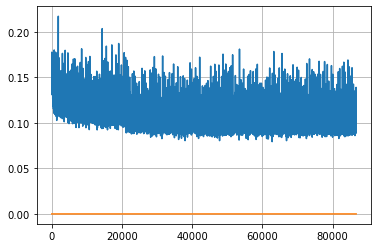

Epoch: 223, iteration 0, loss 0.10816296935081482, cov_diff 0.41904145063833126 cov_diff train 0.41846210724576133
Epoch: 223, iteration 1, loss 0.10596075654029846, cov_diff 0.3983345195318417 cov_diff train 0.39777497791064265
Epoch: 223, iteration 2, loss 0.1050141453742981, cov_diff 0.403461007371511 cov_diff train 0.40429932815194025
Epoch: 223, iteration 3, loss 0.10220968723297119, cov_diff 0.4121410412010831 cov_diff train 0.41191441769691195
Epoch: 223, iteration 4, loss 0.10294508934020996, cov_diff 0.4218273794594997 cov_diff train 0.4219917852610633
Epoch: 223, iteration 5, loss 0.09496414661407471, cov_diff 0.41827870121491345 cov_diff train 0.41791862691077614
Epoch: 223, iteration 6, loss 0.11509981751441956, cov_diff 0.40883200532988434 cov_diff train 0.4084356772797201
Epoch: 223, iteration 7, loss 0.10573601722717285, cov_diff 0.41569636067605326 cov_diff train 0.4160638961629736
Epoch: 223, iteration 8, loss 0.10450509190559387, cov_diff 0.4195033257389512 cov_diff t

Epoch: 223, iteration 81, loss 0.09804204106330872, cov_diff 0.4144239117117315 cov_diff train 0.4133910834117858
Epoch: 223, iteration 82, loss 0.1095360517501831, cov_diff 0.40839737377675883 cov_diff train 0.408785692857746
Epoch: 223, iteration 83, loss 0.1041727066040039, cov_diff 0.40804629917582885 cov_diff train 0.4071349424268745
Epoch: 223, iteration 84, loss 0.11031019687652588, cov_diff 0.405608546412193 cov_diff train 0.40527506903261523
Epoch: 223, iteration 85, loss 0.09942293167114258, cov_diff 0.41189417040574916 cov_diff train 0.41014513309886913
Epoch: 223, iteration 86, loss 0.10211437940597534, cov_diff 0.4229558261468989 cov_diff train 0.4226625273007106
Epoch: 223, iteration 87, loss 0.09830775856971741, cov_diff 0.41830514318272016 cov_diff train 0.41801341039264184
Epoch: 223, iteration 88, loss 0.11094832420349121, cov_diff 0.41853514654279217 cov_diff train 0.4176856465450071
Epoch: 223, iteration 89, loss 0.09480950236320496, cov_diff 0.40358289972467404 cov

Epoch: 223, iteration 159, loss 0.09614592790603638, cov_diff 0.4187341827343534 cov_diff train 0.4187397669595009
Epoch: 223, iteration 160, loss 0.1040903627872467, cov_diff 0.4158891921954171 cov_diff train 0.4150042545065012
Epoch: 223, iteration 161, loss 0.10477882623672485, cov_diff 0.4146534141176725 cov_diff train 0.4144058730941962
Epoch: 223, iteration 162, loss 0.09311532974243164, cov_diff 0.3988099871688842 cov_diff train 0.39796653719203917
Epoch: 223, iteration 163, loss 0.11787483096122742, cov_diff 0.39848931027818085 cov_diff train 0.3970022739423161
Epoch: 223, iteration 164, loss 0.0986335277557373, cov_diff 0.40450939566847044 cov_diff train 0.40318747378867237
Epoch: 223, iteration 165, loss 0.09729686379432678, cov_diff 0.417683774797737 cov_diff train 0.4156228122150723
Epoch: 223, iteration 166, loss 0.11088329553604126, cov_diff 0.42057384262699476 cov_diff train 0.4197082675849258
Epoch: 223, iteration 167, loss 0.10112622380256653, cov_diff 0.40867956837231

Epoch: 223, iteration 236, loss 0.09549561142921448, cov_diff 0.40662356934564453 cov_diff train 0.4066814098905131
Epoch: 223, iteration 237, loss 0.09798777103424072, cov_diff 0.4065196474633403 cov_diff train 0.4065237038193739
Epoch: 223, iteration 238, loss 0.104062020778656, cov_diff 0.41149396518884745 cov_diff train 0.4115389143573561
Epoch: 223, iteration 239, loss 0.10933250188827515, cov_diff 0.40430033695608864 cov_diff train 0.40341036110501477
Epoch: 223, iteration 240, loss 0.10168248414993286, cov_diff 0.41985812236010606 cov_diff train 0.4195380428064299
Epoch: 223, iteration 241, loss 0.11090746521949768, cov_diff 0.42206970094540336 cov_diff train 0.42109215749229423
Epoch: 223, iteration 242, loss 0.09833014011383057, cov_diff 0.4178887662699837 cov_diff train 0.41665068835734437
Epoch: 223, iteration 243, loss 0.10133305191993713, cov_diff 0.4135339638511904 cov_diff train 0.4127254297460468
Epoch: 223, iteration 244, loss 0.09924289584159851, cov_diff 0.4096517670

Epoch: 223, iteration 310, loss 0.10402604937553406, cov_diff 0.4121325748178838 cov_diff train 0.41130833819409557
Epoch: 223, iteration 311, loss 0.10510227084159851, cov_diff 0.40530524985697075 cov_diff train 0.403947158300228
Epoch: 223, iteration 312, loss 0.09922903776168823, cov_diff 0.4195340889426852 cov_diff train 0.4188900654879027
Epoch: 223, iteration 313, loss 0.11471492052078247, cov_diff 0.4185159624123589 cov_diff train 0.4162980194522568
Epoch: 223, iteration 314, loss 0.10234063863754272, cov_diff 0.4174748601050829 cov_diff train 0.41744484173248086
Epoch: 223, iteration 315, loss 0.11128589510917664, cov_diff 0.4120047168116327 cov_diff train 0.41137572391693883
Epoch: 223, iteration 316, loss 0.09554165601730347, cov_diff 0.4064189404970066 cov_diff train 0.4059579531426143
Epoch: 223, iteration 317, loss 0.09962466359138489, cov_diff 0.4168909140259285 cov_diff train 0.4158101050783308
Epoch: 223, iteration 318, loss 0.1022493839263916, cov_diff 0.40897635449337

Epoch: 223, iteration 389, loss 0.1144532859325409, cov_diff 0.42543439435747704 cov_diff train 0.4243362041647597
Epoch: 223, iteration 390, loss 0.13919472694396973, cov_diff 0.4403338108946444 cov_diff train 0.4405231442200225


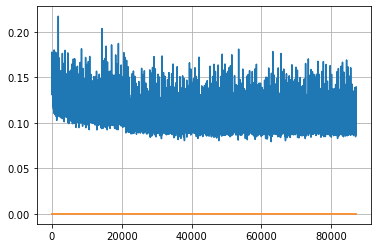

Epoch: 224, iteration 0, loss 0.08978071808815002, cov_diff 0.4174807735504686 cov_diff train 0.4173942117656882
Epoch: 224, iteration 1, loss 0.10029047727584839, cov_diff 0.42040365884977415 cov_diff train 0.4203132174348034
Epoch: 224, iteration 2, loss 0.10052153468132019, cov_diff 0.4117053896862917 cov_diff train 0.4116453991778867
Epoch: 224, iteration 3, loss 0.10388773679733276, cov_diff 0.40666907526068785 cov_diff train 0.4065011132424826
Epoch: 224, iteration 4, loss 0.1108742356300354, cov_diff 0.4250862269423122 cov_diff train 0.42478987684803404
Epoch: 224, iteration 5, loss 0.11923801898956299, cov_diff 0.4172169399431277 cov_diff train 0.41617761222130295
Epoch: 224, iteration 6, loss 0.11082279682159424, cov_diff 0.41330002164401863 cov_diff train 0.4125564035684156
Epoch: 224, iteration 7, loss 0.09072041511535645, cov_diff 0.40766461773554225 cov_diff train 0.4073058062647659
Epoch: 224, iteration 8, loss 0.10174906253814697, cov_diff 0.4172793043622017 cov_diff tra

Epoch: 224, iteration 77, loss 0.09546583890914917, cov_diff 0.41323959843079977 cov_diff train 0.4134393620565809
Epoch: 224, iteration 78, loss 0.10711011290550232, cov_diff 0.4183997013908863 cov_diff train 0.4174239390772859
Epoch: 224, iteration 79, loss 0.10415986180305481, cov_diff 0.4054911691862242 cov_diff train 0.40552604051980945
Epoch: 224, iteration 80, loss 0.09958580136299133, cov_diff 0.405922956002665 cov_diff train 0.4058021159391973
Epoch: 224, iteration 81, loss 0.10926949977874756, cov_diff 0.41547692861558166 cov_diff train 0.4148460405323887
Epoch: 224, iteration 82, loss 0.09295603632926941, cov_diff 0.40758335246252125 cov_diff train 0.40758463198250344
Epoch: 224, iteration 83, loss 0.10592734813690186, cov_diff 0.3959543714704755 cov_diff train 0.39511223674708434
Epoch: 224, iteration 84, loss 0.10215333104133606, cov_diff 0.43421633201798826 cov_diff train 0.43338762740597064
Epoch: 224, iteration 85, loss 0.09715458750724792, cov_diff 0.41875515392726936 

Epoch: 224, iteration 156, loss 0.10871592164039612, cov_diff 0.4140415445159058 cov_diff train 0.4129724721256505
Epoch: 224, iteration 157, loss 0.10951292514801025, cov_diff 0.4152256555358125 cov_diff train 0.41476495415913345
Epoch: 224, iteration 158, loss 0.09929120540618896, cov_diff 0.4053711008134003 cov_diff train 0.40580198545030105
Epoch: 224, iteration 159, loss 0.10976308584213257, cov_diff 0.4099261916561258 cov_diff train 0.4096462567489383
Epoch: 224, iteration 160, loss 0.10647109150886536, cov_diff 0.40737146027201965 cov_diff train 0.4070157845366022
Epoch: 224, iteration 161, loss 0.10737690329551697, cov_diff 0.4121563483917937 cov_diff train 0.41189265244659923
Epoch: 224, iteration 162, loss 0.11705154180526733, cov_diff 0.40373174074720075 cov_diff train 0.4030449829001057
Epoch: 224, iteration 163, loss 0.10093286633491516, cov_diff 0.4029039301981908 cov_diff train 0.40302066520087787
Epoch: 224, iteration 164, loss 0.09491458535194397, cov_diff 0.4206808932

Epoch: 224, iteration 228, loss 0.1000223159790039, cov_diff 0.41300907576990753 cov_diff train 0.41293575943169497
Epoch: 224, iteration 229, loss 0.10056835412979126, cov_diff 0.408212643728714 cov_diff train 0.40778295921091284
Epoch: 224, iteration 230, loss 0.10191738605499268, cov_diff 0.42039309758113996 cov_diff train 0.4196415200526093
Epoch: 224, iteration 231, loss 0.10177069902420044, cov_diff 0.4176794525119957 cov_diff train 0.41749429316238684
Epoch: 224, iteration 232, loss 0.10431623458862305, cov_diff 0.42243926280844707 cov_diff train 0.4227593662395653
Epoch: 224, iteration 233, loss 0.10956227779388428, cov_diff 0.4189376487918887 cov_diff train 0.4192885199827356
Epoch: 224, iteration 234, loss 0.09092015027999878, cov_diff 0.41495010885598366 cov_diff train 0.4150207243547577
Epoch: 224, iteration 235, loss 0.09549444913864136, cov_diff 0.412037878603181 cov_diff train 0.412877216277049
Epoch: 224, iteration 236, loss 0.10424342751502991, cov_diff 0.4067486728892

Epoch: 224, iteration 299, loss 0.10322010517120361, cov_diff 0.41622995458995815 cov_diff train 0.4153350482887739
Epoch: 224, iteration 300, loss 0.09943526983261108, cov_diff 0.41454551783716653 cov_diff train 0.4137603510158369
Epoch: 224, iteration 301, loss 0.11206772923469543, cov_diff 0.4115931821622747 cov_diff train 0.411660251309715
Epoch: 224, iteration 302, loss 0.0999053418636322, cov_diff 0.4006070409579152 cov_diff train 0.4009194907774657
Epoch: 224, iteration 303, loss 0.1064009964466095, cov_diff 0.41953476282061963 cov_diff train 0.41941512265762204
Epoch: 224, iteration 304, loss 0.09892040491104126, cov_diff 0.40868238274591495 cov_diff train 0.4079072473505674
Epoch: 224, iteration 305, loss 0.09492167830467224, cov_diff 0.4155665795711694 cov_diff train 0.4147444107618852
Epoch: 224, iteration 306, loss 0.09231311082839966, cov_diff 0.42742738365514066 cov_diff train 0.4268318988778457
Epoch: 224, iteration 307, loss 0.09587299823760986, cov_diff 0.4218177857257

Epoch: 224, iteration 379, loss 0.09994611144065857, cov_diff 0.42545605489515087 cov_diff train 0.42556313397630957
Epoch: 224, iteration 380, loss 0.11116322875022888, cov_diff 0.413586681679435 cov_diff train 0.4134901475535205
Epoch: 224, iteration 381, loss 0.10779836773872375, cov_diff 0.4214273080326426 cov_diff train 0.42164325350659854
Epoch: 224, iteration 382, loss 0.10811355710029602, cov_diff 0.4213804758074083 cov_diff train 0.42120817996973886
Epoch: 224, iteration 383, loss 0.09761610627174377, cov_diff 0.41364835899295327 cov_diff train 0.4128755027988388
Epoch: 224, iteration 384, loss 0.10175088047981262, cov_diff 0.42228660114940625 cov_diff train 0.4225078738801207
Epoch: 224, iteration 385, loss 0.10240870714187622, cov_diff 0.41865750935884116 cov_diff train 0.41806950600292
Epoch: 224, iteration 386, loss 0.1104598343372345, cov_diff 0.4201002989706913 cov_diff train 0.4187833442715603
Epoch: 224, iteration 387, loss 0.09945908188819885, cov_diff 0.4043351807755

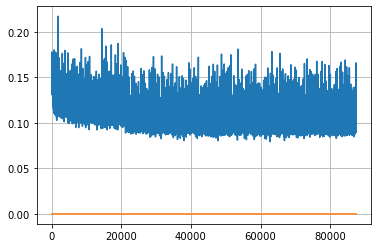

Epoch: 225, iteration 0, loss 0.11134669184684753, cov_diff 0.40617320142769653 cov_diff train 0.40535558813207023
Epoch: 225, iteration 1, loss 0.10868552327156067, cov_diff 0.42753950528948914 cov_diff train 0.42627362843913047
Epoch: 225, iteration 2, loss 0.10127881169319153, cov_diff 0.4079635011148444 cov_diff train 0.4068659275287372
Epoch: 225, iteration 3, loss 0.10769674181938171, cov_diff 0.42100655913716367 cov_diff train 0.41965116455855744
Epoch: 225, iteration 4, loss 0.10092049837112427, cov_diff 0.4217509444924771 cov_diff train 0.4208155065291617
Epoch: 225, iteration 5, loss 0.10558122396469116, cov_diff 0.3875404504825393 cov_diff train 0.3865699039032042
Epoch: 225, iteration 6, loss 0.1003253161907196, cov_diff 0.4158682576415264 cov_diff train 0.413291139109406
Epoch: 225, iteration 7, loss 0.11188387870788574, cov_diff 0.3969175863737493 cov_diff train 0.3953713729149691
Epoch: 225, iteration 8, loss 0.10684889554977417, cov_diff 0.4168976328719179 cov_diff trai

Epoch: 225, iteration 76, loss 0.11174637079238892, cov_diff 0.41455336806337073 cov_diff train 0.4137077693378357
Epoch: 225, iteration 77, loss 0.10396566987037659, cov_diff 0.4150456347654788 cov_diff train 0.4139069467759793
Epoch: 225, iteration 78, loss 0.10333642363548279, cov_diff 0.416819718902708 cov_diff train 0.41580391918740117
Epoch: 225, iteration 79, loss 0.09609776735305786, cov_diff 0.41145854773916446 cov_diff train 0.4107569108114215
Epoch: 225, iteration 80, loss 0.10083836317062378, cov_diff 0.40833166473897653 cov_diff train 0.40693286562413145
Epoch: 225, iteration 81, loss 0.10409969091415405, cov_diff 0.4125729323466733 cov_diff train 0.4123257427529146
Epoch: 225, iteration 82, loss 0.09825816750526428, cov_diff 0.40531495875278645 cov_diff train 0.4046147593464869
Epoch: 225, iteration 83, loss 0.10274553298950195, cov_diff 0.40926978397475483 cov_diff train 0.4074294480448317
Epoch: 225, iteration 84, loss 0.11563396453857422, cov_diff 0.4088543971526129 co

Epoch: 225, iteration 155, loss 0.10546338558197021, cov_diff 0.4262258099708781 cov_diff train 0.4258272246182529
Epoch: 225, iteration 156, loss 0.11108660697937012, cov_diff 0.40067027765807156 cov_diff train 0.39957339174468476
Epoch: 225, iteration 157, loss 0.10680016875267029, cov_diff 0.41418715015458635 cov_diff train 0.414022928912922
Epoch: 225, iteration 158, loss 0.09653684496879578, cov_diff 0.41491804557332146 cov_diff train 0.41471360675268476
Epoch: 225, iteration 159, loss 0.10286885499954224, cov_diff 0.4047908052311633 cov_diff train 0.40390860724445427
Epoch: 225, iteration 160, loss 0.10617223381996155, cov_diff 0.41682548844655065 cov_diff train 0.4157682562018385
Epoch: 225, iteration 161, loss 0.10757669806480408, cov_diff 0.39979868923242257 cov_diff train 0.39915928102678583
Epoch: 225, iteration 162, loss 0.08875894546508789, cov_diff 0.42062493293699993 cov_diff train 0.4199454688751579
Epoch: 225, iteration 163, loss 0.10392111539840698, cov_diff 0.4107385

Epoch: 225, iteration 232, loss 0.09988516569137573, cov_diff 0.40938090337145416 cov_diff train 0.4083683684578922
Epoch: 225, iteration 233, loss 0.10509791970252991, cov_diff 0.4185544083232604 cov_diff train 0.4183626007628441
Epoch: 225, iteration 234, loss 0.1027662456035614, cov_diff 0.4126097655639375 cov_diff train 0.41216490341777895
Epoch: 225, iteration 235, loss 0.11555594205856323, cov_diff 0.42084216977664957 cov_diff train 0.4200826550200287
Epoch: 225, iteration 236, loss 0.1001041829586029, cov_diff 0.4121796426820511 cov_diff train 0.4121236755317541
Epoch: 225, iteration 237, loss 0.10499095916748047, cov_diff 0.41879622030247793 cov_diff train 0.4188061538376506
Epoch: 225, iteration 238, loss 0.1022588312625885, cov_diff 0.4172911829094772 cov_diff train 0.4167665849388587
Epoch: 225, iteration 239, loss 0.09648549556732178, cov_diff 0.41909476115341504 cov_diff train 0.41925392623114427
Epoch: 225, iteration 240, loss 0.09437867999076843, cov_diff 0.4114793337512

Epoch: 225, iteration 312, loss 0.11428037285804749, cov_diff 0.41963608926669993 cov_diff train 0.41802511001506126
Epoch: 225, iteration 313, loss 0.10891649127006531, cov_diff 0.4031879327810301 cov_diff train 0.40172849578935566
Epoch: 225, iteration 314, loss 0.11601638793945312, cov_diff 0.3995734287414237 cov_diff train 0.39747516236716796
Epoch: 225, iteration 315, loss 0.11030861735343933, cov_diff 0.4194456910893575 cov_diff train 0.41825290041763713
Epoch: 225, iteration 316, loss 0.11180779337882996, cov_diff 0.43249302571749637 cov_diff train 0.43166604219871435
Epoch: 225, iteration 317, loss 0.11049202084541321, cov_diff 0.4044591059135051 cov_diff train 0.4029657556024058
Epoch: 225, iteration 318, loss 0.10611698031425476, cov_diff 0.41152123873563806 cov_diff train 0.4099684570094827
Epoch: 225, iteration 319, loss 0.09709906578063965, cov_diff 0.42136183197530447 cov_diff train 0.4204247961620753
Epoch: 225, iteration 320, loss 0.11848703026771545, cov_diff 0.3965691

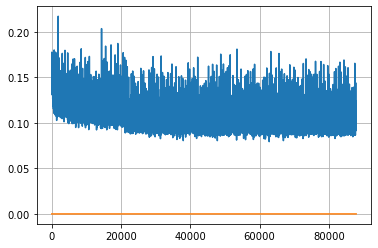

Epoch: 226, iteration 0, loss 0.11341241002082825, cov_diff 0.4003955164320307 cov_diff train 0.4000094774469575
Epoch: 226, iteration 1, loss 0.12192124128341675, cov_diff 0.41544274797674574 cov_diff train 0.41483806754063984
Epoch: 226, iteration 2, loss 0.1070217490196228, cov_diff 0.4091111217879388 cov_diff train 0.4088174971706461
Epoch: 226, iteration 3, loss 0.11643481254577637, cov_diff 0.41438210642776857 cov_diff train 0.4146905542983428
Epoch: 226, iteration 4, loss 0.10277122259140015, cov_diff 0.4294068414031815 cov_diff train 0.4288026618960696
Epoch: 226, iteration 5, loss 0.09123510122299194, cov_diff 0.4081154782270951 cov_diff train 0.4071793042579076
Epoch: 226, iteration 6, loss 0.08744776248931885, cov_diff 0.40798694698858357 cov_diff train 0.40810807751171646
Epoch: 226, iteration 7, loss 0.0989052951335907, cov_diff 0.4134053955328728 cov_diff train 0.41198202596834266
Epoch: 226, iteration 8, loss 0.10300552845001221, cov_diff 0.4106576923869772 cov_diff trai

Epoch: 226, iteration 79, loss 0.09316563606262207, cov_diff 0.4057140128204178 cov_diff train 0.4043276155282338
Epoch: 226, iteration 80, loss 0.10795620083808899, cov_diff 0.4105869499880511 cov_diff train 0.4095251210925302
Epoch: 226, iteration 81, loss 0.10591980814933777, cov_diff 0.4157412461963158 cov_diff train 0.41530515400817614
Epoch: 226, iteration 82, loss 0.11070463061332703, cov_diff 0.3991575210813851 cov_diff train 0.3979390020175109
Epoch: 226, iteration 83, loss 0.10900074243545532, cov_diff 0.4151151166947032 cov_diff train 0.4143257483427549
Epoch: 226, iteration 84, loss 0.108247309923172, cov_diff 0.4216626605777163 cov_diff train 0.4208606089106642
Epoch: 226, iteration 85, loss 0.10664433240890503, cov_diff 0.4237525854599827 cov_diff train 0.4220902157902505
Epoch: 226, iteration 86, loss 0.09936463832855225, cov_diff 0.4171859258170323 cov_diff train 0.4164890426324051
Epoch: 226, iteration 87, loss 0.109459787607193, cov_diff 0.3999386066641581 cov_diff tr

Epoch: 226, iteration 157, loss 0.09922957420349121, cov_diff 0.4296083472749038 cov_diff train 0.42897691365350626
Epoch: 226, iteration 158, loss 0.10475873947143555, cov_diff 0.4101105341655246 cov_diff train 0.4093773583277249
Epoch: 226, iteration 159, loss 0.09540912508964539, cov_diff 0.40994866191410495 cov_diff train 0.40949748554168525
Epoch: 226, iteration 160, loss 0.09819287061691284, cov_diff 0.41552313111535677 cov_diff train 0.4142870315574231
Epoch: 226, iteration 161, loss 0.11622026562690735, cov_diff 0.4095693160744392 cov_diff train 0.40859208360272964
Epoch: 226, iteration 162, loss 0.10741010308265686, cov_diff 0.4064540661218449 cov_diff train 0.4061988982979394
Epoch: 226, iteration 163, loss 0.09671708941459656, cov_diff 0.4112775842080229 cov_diff train 0.4116758141500016
Epoch: 226, iteration 164, loss 0.10076132416725159, cov_diff 0.40784410775417657 cov_diff train 0.4066218119557483
Epoch: 226, iteration 165, loss 0.10478237271308899, cov_diff 0.4164205003

Epoch: 226, iteration 237, loss 0.11329242587089539, cov_diff 0.42433922251420897 cov_diff train 0.42366910899939325
Epoch: 226, iteration 238, loss 0.10004609823226929, cov_diff 0.4198561593805485 cov_diff train 0.41942285909059823
Epoch: 226, iteration 239, loss 0.0938984751701355, cov_diff 0.40824135715991394 cov_diff train 0.4086017433962951
Epoch: 226, iteration 240, loss 0.09899356961250305, cov_diff 0.4132463927903027 cov_diff train 0.41253267226938695
Epoch: 226, iteration 241, loss 0.10240381956100464, cov_diff 0.4224703598904966 cov_diff train 0.42189300721212847
Epoch: 226, iteration 242, loss 0.10016709566116333, cov_diff 0.4297274418328648 cov_diff train 0.4290336199428018
Epoch: 226, iteration 243, loss 0.09051141142845154, cov_diff 0.41175580892030805 cov_diff train 0.4106491692080563
Epoch: 226, iteration 244, loss 0.10815909504890442, cov_diff 0.42268674404910694 cov_diff train 0.4223214902840614
Epoch: 226, iteration 245, loss 0.09739035367965698, cov_diff 0.408861307

Epoch: 226, iteration 316, loss 0.10342946648597717, cov_diff 0.4065948347064279 cov_diff train 0.40650213775522737
Epoch: 226, iteration 317, loss 0.1001116931438446, cov_diff 0.40905784553934504 cov_diff train 0.407400227530377
Epoch: 226, iteration 318, loss 0.10501396656036377, cov_diff 0.41006739811112164 cov_diff train 0.4096746301602985
Epoch: 226, iteration 319, loss 0.10162246227264404, cov_diff 0.4151687272967946 cov_diff train 0.41464162307054625
Epoch: 226, iteration 320, loss 0.0955638587474823, cov_diff 0.4097352174305215 cov_diff train 0.40904172728083193
Epoch: 226, iteration 321, loss 0.10154804587364197, cov_diff 0.4148477139280939 cov_diff train 0.4138707832427118
Epoch: 226, iteration 322, loss 0.10722360014915466, cov_diff 0.40936672780964534 cov_diff train 0.40896471958816316
Epoch: 226, iteration 323, loss 0.09687539935112, cov_diff 0.41261015134902496 cov_diff train 0.41213455572673685
Epoch: 226, iteration 324, loss 0.09905001521110535, cov_diff 0.3987876680139

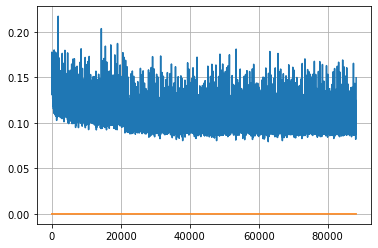

Epoch: 227, iteration 0, loss 0.0969601571559906, cov_diff 0.406615099307359 cov_diff train 0.4057435751602164
Epoch: 227, iteration 1, loss 0.10448849201202393, cov_diff 0.4122533648064106 cov_diff train 0.41188445836494886
Epoch: 227, iteration 2, loss 0.11642062664031982, cov_diff 0.40937499277217926 cov_diff train 0.40880848372212236
Epoch: 227, iteration 3, loss 0.09724998474121094, cov_diff 0.40097391877240796 cov_diff train 0.40085343878825896
Epoch: 227, iteration 4, loss 0.0971468985080719, cov_diff 0.41626500548471107 cov_diff train 0.4159417645141116
Epoch: 227, iteration 5, loss 0.0951397716999054, cov_diff 0.4046400330002944 cov_diff train 0.40467937235044504
Epoch: 227, iteration 6, loss 0.10047027468681335, cov_diff 0.4226212318675051 cov_diff train 0.42168800038997023
Epoch: 227, iteration 7, loss 0.09527555108070374, cov_diff 0.42558148775191196 cov_diff train 0.4256170563892188
Epoch: 227, iteration 8, loss 0.09158140420913696, cov_diff 0.4142050513469286 cov_diff tra

Epoch: 227, iteration 78, loss 0.09964972734451294, cov_diff 0.41444207714428677 cov_diff train 0.4138956635568751
Epoch: 227, iteration 79, loss 0.09910434484481812, cov_diff 0.41786499233986835 cov_diff train 0.41751832095807145
Epoch: 227, iteration 80, loss 0.10186687111854553, cov_diff 0.4275676643896511 cov_diff train 0.4269461127642187
Epoch: 227, iteration 81, loss 0.0924626886844635, cov_diff 0.4139324599351629 cov_diff train 0.413387842221278
Epoch: 227, iteration 82, loss 0.09546816349029541, cov_diff 0.4135741655126872 cov_diff train 0.41170282642458
Epoch: 227, iteration 83, loss 0.10305389761924744, cov_diff 0.41187248813354255 cov_diff train 0.41100518174690726
Epoch: 227, iteration 84, loss 0.10792264342308044, cov_diff 0.4061168957355731 cov_diff train 0.40573705297688745
Epoch: 227, iteration 85, loss 0.10834935307502747, cov_diff 0.41471690765710134 cov_diff train 0.4139110210768509
Epoch: 227, iteration 86, loss 0.10219788551330566, cov_diff 0.41034135494048757 cov_

Epoch: 227, iteration 155, loss 0.09974232316017151, cov_diff 0.41802191201607386 cov_diff train 0.41681624135455947
Epoch: 227, iteration 156, loss 0.09464392066001892, cov_diff 0.41814502191970887 cov_diff train 0.4176925518289098
Epoch: 227, iteration 157, loss 0.10603475570678711, cov_diff 0.4137458594937811 cov_diff train 0.41238342375663234
Epoch: 227, iteration 158, loss 0.0994112491607666, cov_diff 0.4143597563439833 cov_diff train 0.4133639633604804
Epoch: 227, iteration 159, loss 0.09953296184539795, cov_diff 0.41980963386062914 cov_diff train 0.4194348358553967
Epoch: 227, iteration 160, loss 0.10709226131439209, cov_diff 0.42069569716271027 cov_diff train 0.42026996888591395
Epoch: 227, iteration 161, loss 0.11451509594917297, cov_diff 0.4103447803645076 cov_diff train 0.40937596943223536
Epoch: 227, iteration 162, loss 0.10557958483695984, cov_diff 0.4150718076895269 cov_diff train 0.4124841418034046
Epoch: 227, iteration 163, loss 0.10718423128128052, cov_diff 0.420598895

Epoch: 227, iteration 226, loss 0.090474933385849, cov_diff 0.4222598886248791 cov_diff train 0.4216847326497187
Epoch: 227, iteration 227, loss 0.10664793848991394, cov_diff 0.42643079383786775 cov_diff train 0.42573759367009534
Epoch: 227, iteration 228, loss 0.09970372915267944, cov_diff 0.40912721283394277 cov_diff train 0.4091784289602853
Epoch: 227, iteration 229, loss 0.09717977046966553, cov_diff 0.4117011100230869 cov_diff train 0.4108137825431174
Epoch: 227, iteration 230, loss 0.10736387968063354, cov_diff 0.4269312872178929 cov_diff train 0.42605331634457705
Epoch: 227, iteration 231, loss 0.09606632590293884, cov_diff 0.408725045548144 cov_diff train 0.4076972071171996
Epoch: 227, iteration 232, loss 0.11101582646369934, cov_diff 0.4128020274771358 cov_diff train 0.41188247926928556
Epoch: 227, iteration 233, loss 0.112851083278656, cov_diff 0.4235907368945441 cov_diff train 0.423147937593392
Epoch: 227, iteration 234, loss 0.09973698854446411, cov_diff 0.40665304641539635

Epoch: 227, iteration 305, loss 0.09490066766738892, cov_diff 0.404778586154132 cov_diff train 0.40480050507376425
Epoch: 227, iteration 306, loss 0.10707774758338928, cov_diff 0.4084046844658437 cov_diff train 0.4077807693516667
Epoch: 227, iteration 307, loss 0.10581991076469421, cov_diff 0.42100665501754464 cov_diff train 0.4199955065942051
Epoch: 227, iteration 308, loss 0.09618386626243591, cov_diff 0.39768517647030505 cov_diff train 0.3976812471515482
Epoch: 227, iteration 309, loss 0.11855769157409668, cov_diff 0.41223675224913775 cov_diff train 0.4119161187160757
Epoch: 227, iteration 310, loss 0.09972864389419556, cov_diff 0.4142140590157244 cov_diff train 0.4136796277959212
Epoch: 227, iteration 311, loss 0.0988476574420929, cov_diff 0.41093316065538177 cov_diff train 0.41042313236695843
Epoch: 227, iteration 312, loss 0.11806640028953552, cov_diff 0.41234853654532727 cov_diff train 0.4119600736174019
Epoch: 227, iteration 313, loss 0.10249519348144531, cov_diff 0.42173815845

Epoch: 227, iteration 382, loss 0.10948184132575989, cov_diff 0.4272628275615927 cov_diff train 0.42648581340743635
Epoch: 227, iteration 383, loss 0.10110750794410706, cov_diff 0.41574556064111085 cov_diff train 0.4148149662943261
Epoch: 227, iteration 384, loss 0.11192092299461365, cov_diff 0.4233354557250485 cov_diff train 0.42223980774301995
Epoch: 227, iteration 385, loss 0.11679017543792725, cov_diff 0.4085157179795666 cov_diff train 0.4062334097715544
Epoch: 227, iteration 386, loss 0.11648827791213989, cov_diff 0.41359865700267684 cov_diff train 0.41264833465007966
Epoch: 227, iteration 387, loss 0.11110582947731018, cov_diff 0.4110155647640717 cov_diff train 0.40941472250208205
Epoch: 227, iteration 388, loss 0.10048669576644897, cov_diff 0.40253412703543046 cov_diff train 0.40232710592040855
Epoch: 227, iteration 389, loss 0.1024254858493805, cov_diff 0.4052178049612735 cov_diff train 0.40468607117299443
Epoch: 227, iteration 390, loss 0.16426178812980652, cov_diff 0.44254750

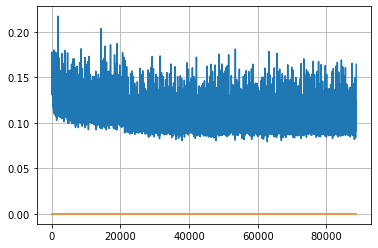

Epoch: 228, iteration 0, loss 0.10259824991226196, cov_diff 0.4029870002796896 cov_diff train 0.4029472659260159
Epoch: 228, iteration 1, loss 0.09919920563697815, cov_diff 0.4015222367475099 cov_diff train 0.4020813754281311
Epoch: 228, iteration 2, loss 0.10134109854698181, cov_diff 0.4032289347590907 cov_diff train 0.40289862284178046
Epoch: 228, iteration 3, loss 0.09995543956756592, cov_diff 0.40044780441294325 cov_diff train 0.3998760438369648
Epoch: 228, iteration 4, loss 0.10516980290412903, cov_diff 0.40666732040924286 cov_diff train 0.40688905554399474
Epoch: 228, iteration 5, loss 0.10132908821105957, cov_diff 0.42407088123089426 cov_diff train 0.4239819778450339
Epoch: 228, iteration 6, loss 0.1114136278629303, cov_diff 0.4224196682903805 cov_diff train 0.42198950974729765
Epoch: 228, iteration 7, loss 0.1025562584400177, cov_diff 0.41737188975991724 cov_diff train 0.41671389528661984
Epoch: 228, iteration 8, loss 0.1000773012638092, cov_diff 0.4081363082743139 cov_diff tra

Epoch: 228, iteration 77, loss 0.1129893958568573, cov_diff 0.4182421824451668 cov_diff train 0.41790976144902814
Epoch: 228, iteration 78, loss 0.09571924805641174, cov_diff 0.4175464725474659 cov_diff train 0.4171716511220267
Epoch: 228, iteration 79, loss 0.11628368496894836, cov_diff 0.4115691655559758 cov_diff train 0.4107470847368476
Epoch: 228, iteration 80, loss 0.10396242141723633, cov_diff 0.41651594966236577 cov_diff train 0.41601460757033126
Epoch: 228, iteration 81, loss 0.10023868083953857, cov_diff 0.4096251000332554 cov_diff train 0.40961565709007747
Epoch: 228, iteration 82, loss 0.10322096943855286, cov_diff 0.40651114907773506 cov_diff train 0.40573161459551943
Epoch: 228, iteration 83, loss 0.10525938868522644, cov_diff 0.42291850027250166 cov_diff train 0.42230359222485103
Epoch: 228, iteration 84, loss 0.10913503170013428, cov_diff 0.4243754672169458 cov_diff train 0.42264504571160455
Epoch: 228, iteration 85, loss 0.09440803527832031, cov_diff 0.41738153039124826

Epoch: 228, iteration 152, loss 0.10628712177276611, cov_diff 0.41976679983925536 cov_diff train 0.4195038099182009
Epoch: 228, iteration 153, loss 0.10800367593765259, cov_diff 0.41146011492603585 cov_diff train 0.411080554323264
Epoch: 228, iteration 154, loss 0.09454160928726196, cov_diff 0.4066403632406806 cov_diff train 0.40597252578078163
Epoch: 228, iteration 155, loss 0.09622183442115784, cov_diff 0.4099251769443779 cov_diff train 0.4094352667899269
Epoch: 228, iteration 156, loss 0.10610204935073853, cov_diff 0.4106151320819249 cov_diff train 0.4104340059176401
Epoch: 228, iteration 157, loss 0.10654786229133606, cov_diff 0.40520628129736247 cov_diff train 0.40436568097024383
Epoch: 228, iteration 158, loss 0.09835690259933472, cov_diff 0.4021550603704448 cov_diff train 0.40028475102729916
Epoch: 228, iteration 159, loss 0.10153937339782715, cov_diff 0.4119559831145476 cov_diff train 0.4111842056631566
Epoch: 228, iteration 160, loss 0.10292357206344604, cov_diff 0.41389654884

Epoch: 228, iteration 227, loss 0.09504774212837219, cov_diff 0.42001242082928175 cov_diff train 0.4197335543955016
Epoch: 228, iteration 228, loss 0.10286253690719604, cov_diff 0.41885475867277905 cov_diff train 0.4183109719171111
Epoch: 228, iteration 229, loss 0.10753604769706726, cov_diff 0.41770878357208613 cov_diff train 0.41689752987260165
Epoch: 228, iteration 230, loss 0.09282165765762329, cov_diff 0.4105588534131965 cov_diff train 0.4092882798702559
Epoch: 228, iteration 231, loss 0.11308357119560242, cov_diff 0.40182148074912 cov_diff train 0.4011261165212736
Epoch: 228, iteration 232, loss 0.1022358238697052, cov_diff 0.40635124341117795 cov_diff train 0.4058097353578639
Epoch: 228, iteration 233, loss 0.09961557388305664, cov_diff 0.41852204274115723 cov_diff train 0.4180981616373364
Epoch: 228, iteration 234, loss 0.11031052470207214, cov_diff 0.4222403103087584 cov_diff train 0.4207720368146111
Epoch: 228, iteration 235, loss 0.10806304216384888, cov_diff 0.4129782441595

Epoch: 228, iteration 305, loss 0.11732327938079834, cov_diff 0.42508879534556715 cov_diff train 0.42541022787737626
Epoch: 228, iteration 306, loss 0.10653075575828552, cov_diff 0.422289199919508 cov_diff train 0.4220252590293061
Epoch: 228, iteration 307, loss 0.09748905897140503, cov_diff 0.41455674618529414 cov_diff train 0.4140572835633567
Epoch: 228, iteration 308, loss 0.0991365909576416, cov_diff 0.40988263737024966 cov_diff train 0.4094004770798346
Epoch: 228, iteration 309, loss 0.09984079003334045, cov_diff 0.40731820689158704 cov_diff train 0.4074610073334487
Epoch: 228, iteration 310, loss 0.10665026307106018, cov_diff 0.41237344236718404 cov_diff train 0.4117188137021372
Epoch: 228, iteration 311, loss 0.10094690322875977, cov_diff 0.40629499065300634 cov_diff train 0.40572516746139814
Epoch: 228, iteration 312, loss 0.09997233748435974, cov_diff 0.4131212451761768 cov_diff train 0.41270616812904026
Epoch: 228, iteration 313, loss 0.11684858798980713, cov_diff 0.415936581

Epoch: 228, iteration 376, loss 0.10585969686508179, cov_diff 0.40398199243680627 cov_diff train 0.4035360039382137
Epoch: 228, iteration 377, loss 0.10634759068489075, cov_diff 0.4042212536631096 cov_diff train 0.4034155299181518
Epoch: 228, iteration 378, loss 0.10266178846359253, cov_diff 0.402388318652317 cov_diff train 0.4015636197606901
Epoch: 228, iteration 379, loss 0.10686355829238892, cov_diff 0.4184291500721627 cov_diff train 0.4173405984941849
Epoch: 228, iteration 380, loss 0.09823864698410034, cov_diff 0.407607406945921 cov_diff train 0.4071798080483131
Epoch: 228, iteration 381, loss 0.11001023650169373, cov_diff 0.4219538423793299 cov_diff train 0.4219753479449823
Epoch: 228, iteration 382, loss 0.10555833578109741, cov_diff 0.4162278807280251 cov_diff train 0.4157555415533595
Epoch: 228, iteration 383, loss 0.10797792673110962, cov_diff 0.4141688806559238 cov_diff train 0.4131890699292449
Epoch: 228, iteration 384, loss 0.10041460394859314, cov_diff 0.41357333340266594

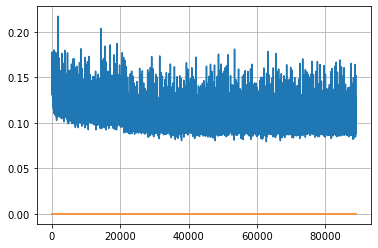

Epoch: 229, iteration 0, loss 0.09845325350761414, cov_diff 0.4232922889899615 cov_diff train 0.4233819761321119
Epoch: 229, iteration 1, loss 0.09603926539421082, cov_diff 0.4129118812759317 cov_diff train 0.41205316614408827
Epoch: 229, iteration 2, loss 0.11238440871238708, cov_diff 0.4021641003205836 cov_diff train 0.4016351405859239
Epoch: 229, iteration 3, loss 0.10165515542030334, cov_diff 0.41927319807614566 cov_diff train 0.4180144456013304
Epoch: 229, iteration 4, loss 0.10840442776679993, cov_diff 0.41208330346503075 cov_diff train 0.41208511961433625
Epoch: 229, iteration 5, loss 0.09914833307266235, cov_diff 0.40752794518935853 cov_diff train 0.4064437969295938
Epoch: 229, iteration 6, loss 0.10126963257789612, cov_diff 0.42816702931325945 cov_diff train 0.42742224169224075
Epoch: 229, iteration 7, loss 0.09934946894645691, cov_diff 0.4069511641532706 cov_diff train 0.40640814329949687
Epoch: 229, iteration 8, loss 0.09563463926315308, cov_diff 0.39862759819975657 cov_diff

Epoch: 229, iteration 74, loss 0.11413434147834778, cov_diff 0.4158679134403909 cov_diff train 0.41526500389217935
Epoch: 229, iteration 75, loss 0.12573587894439697, cov_diff 0.41753555932242026 cov_diff train 0.41625693154324167
Epoch: 229, iteration 76, loss 0.09789001941680908, cov_diff 0.40703284295343256 cov_diff train 0.40712397922323457
Epoch: 229, iteration 77, loss 0.11303338408470154, cov_diff 0.40967195048664795 cov_diff train 0.40939855528775976
Epoch: 229, iteration 78, loss 0.09907868504524231, cov_diff 0.39850460876929206 cov_diff train 0.3980923622112871
Epoch: 229, iteration 79, loss 0.11592894792556763, cov_diff 0.40903893601896624 cov_diff train 0.40892476825005797
Epoch: 229, iteration 80, loss 0.10614851117134094, cov_diff 0.4307224451726776 cov_diff train 0.43037996038526133
Epoch: 229, iteration 81, loss 0.09999239444732666, cov_diff 0.4292609782319798 cov_diff train 0.4283562879837345
Epoch: 229, iteration 82, loss 0.10003313422203064, cov_diff 0.41211721884176

Epoch: 229, iteration 145, loss 0.11000800132751465, cov_diff 0.4162452812732855 cov_diff train 0.4158991519201948
Epoch: 229, iteration 146, loss 0.09889671206474304, cov_diff 0.40886092231327353 cov_diff train 0.4082979750992763
Epoch: 229, iteration 147, loss 0.10822638869285583, cov_diff 0.4002879337012981 cov_diff train 0.40050210925517243
Epoch: 229, iteration 148, loss 0.10141098499298096, cov_diff 0.4217901560972385 cov_diff train 0.42076698693924125
Epoch: 229, iteration 149, loss 0.09906542301177979, cov_diff 0.3970343925176182 cov_diff train 0.3962674631690149
Epoch: 229, iteration 150, loss 0.10012120008468628, cov_diff 0.40688325678636517 cov_diff train 0.4063245720975433
Epoch: 229, iteration 151, loss 0.10525986552238464, cov_diff 0.41527383604125917 cov_diff train 0.4152163794906748
Epoch: 229, iteration 152, loss 0.10439381003379822, cov_diff 0.4250946322803773 cov_diff train 0.42519394514517767
Epoch: 229, iteration 153, loss 0.10533890128135681, cov_diff 0.4184811495

Epoch: 229, iteration 225, loss 0.10881760716438293, cov_diff 0.4170980468548643 cov_diff train 0.41644803594405005
Epoch: 229, iteration 226, loss 0.09328770637512207, cov_diff 0.42428632787318377 cov_diff train 0.4236620985739761
Epoch: 229, iteration 227, loss 0.09683141112327576, cov_diff 0.4176622874508048 cov_diff train 0.4163644928544016
Epoch: 229, iteration 228, loss 0.09919288754463196, cov_diff 0.421051133099462 cov_diff train 0.4200271972602872
Epoch: 229, iteration 229, loss 0.11006319522857666, cov_diff 0.4058688716161907 cov_diff train 0.4060055751956597
Epoch: 229, iteration 230, loss 0.10926216840744019, cov_diff 0.42120486008019836 cov_diff train 0.42143688871867596
Epoch: 229, iteration 231, loss 0.11095824837684631, cov_diff 0.40926811994253576 cov_diff train 0.4084104893231463
Epoch: 229, iteration 232, loss 0.10759377479553223, cov_diff 0.4216249232951051 cov_diff train 0.4212616179712516
Epoch: 229, iteration 233, loss 0.10506138205528259, cov_diff 0.408519483823

Epoch: 229, iteration 301, loss 0.11141416430473328, cov_diff 0.41484150676067044 cov_diff train 0.4130769270759107
Epoch: 229, iteration 302, loss 0.10166442394256592, cov_diff 0.42347705907535393 cov_diff train 0.4225964686489876
Epoch: 229, iteration 303, loss 0.1057325005531311, cov_diff 0.4099379223519195 cov_diff train 0.4091296084951778
Epoch: 229, iteration 304, loss 0.10681706666946411, cov_diff 0.41129057542727354 cov_diff train 0.4112379629453257
Epoch: 229, iteration 305, loss 0.10485899448394775, cov_diff 0.42350221603185007 cov_diff train 0.42221624932297974
Epoch: 229, iteration 306, loss 0.10857939720153809, cov_diff 0.4095071745110624 cov_diff train 0.40879602484323047
Epoch: 229, iteration 307, loss 0.10655730962753296, cov_diff 0.4104745124614361 cov_diff train 0.40945530024148025
Epoch: 229, iteration 308, loss 0.10588520765304565, cov_diff 0.41426518912057675 cov_diff train 0.41263321669668074
Epoch: 229, iteration 309, loss 0.10567757487297058, cov_diff 0.42249760

Epoch: 229, iteration 377, loss 0.09994515776634216, cov_diff 0.41198794733530114 cov_diff train 0.41143966391850867
Epoch: 229, iteration 378, loss 0.10994049906730652, cov_diff 0.42482282205965216 cov_diff train 0.42292396126383713
Epoch: 229, iteration 379, loss 0.10384765267372131, cov_diff 0.40604943793450643 cov_diff train 0.404980049117194
Epoch: 229, iteration 380, loss 0.09626775979995728, cov_diff 0.4094010443613564 cov_diff train 0.40819389801603156
Epoch: 229, iteration 381, loss 0.10573327541351318, cov_diff 0.405971721300624 cov_diff train 0.40574017738353607
Epoch: 229, iteration 382, loss 0.09625792503356934, cov_diff 0.40646482259751526 cov_diff train 0.4057277495517815
Epoch: 229, iteration 383, loss 0.09400045871734619, cov_diff 0.414299883847195 cov_diff train 0.4142271353010447
Epoch: 229, iteration 384, loss 0.11761164665222168, cov_diff 0.40560736204459596 cov_diff train 0.4054622201467199
Epoch: 229, iteration 385, loss 0.09549140930175781, cov_diff 0.4070673000

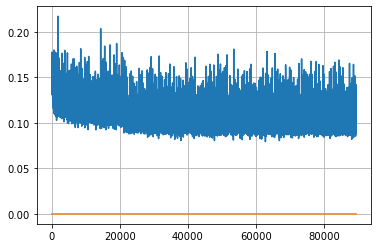

Epoch: 230, iteration 0, loss 0.1044328510761261, cov_diff 0.40775047431516753 cov_diff train 0.40755727989769314
Epoch: 230, iteration 1, loss 0.11419886350631714, cov_diff 0.42119145343947517 cov_diff train 0.420578525651143
Epoch: 230, iteration 2, loss 0.10158905386924744, cov_diff 0.4193770028968182 cov_diff train 0.41867027492129244
Epoch: 230, iteration 3, loss 0.09911283850669861, cov_diff 0.40980508973380153 cov_diff train 0.4093333743111347
Epoch: 230, iteration 4, loss 0.0992550253868103, cov_diff 0.4156358219896127 cov_diff train 0.41497377349230696
Epoch: 230, iteration 5, loss 0.1037587821483612, cov_diff 0.4154354379590017 cov_diff train 0.415302775397905
Epoch: 230, iteration 6, loss 0.09165310859680176, cov_diff 0.40482215420479883 cov_diff train 0.4053056199905666
Epoch: 230, iteration 7, loss 0.1074308454990387, cov_diff 0.41378680483979435 cov_diff train 0.41344785982086
Epoch: 230, iteration 8, loss 0.1108151376247406, cov_diff 0.4194082778323605 cov_diff train 0.4

Epoch: 230, iteration 73, loss 0.10414901375770569, cov_diff 0.41420279215906 cov_diff train 0.41407433445015834
Epoch: 230, iteration 74, loss 0.1096329391002655, cov_diff 0.4051146381594589 cov_diff train 0.40395081501742414
Epoch: 230, iteration 75, loss 0.10321074724197388, cov_diff 0.4128530792510802 cov_diff train 0.412512981932444
Epoch: 230, iteration 76, loss 0.09693703055381775, cov_diff 0.4188652538876915 cov_diff train 0.4186788230137635
Epoch: 230, iteration 77, loss 0.10126850008964539, cov_diff 0.4073988249093421 cov_diff train 0.4068255202297943
Epoch: 230, iteration 78, loss 0.10067212581634521, cov_diff 0.42270355013504934 cov_diff train 0.42244479042543914
Epoch: 230, iteration 79, loss 0.09977987408638, cov_diff 0.41059770109351823 cov_diff train 0.410703190109445
Epoch: 230, iteration 80, loss 0.10548463463783264, cov_diff 0.40939791689409677 cov_diff train 0.40912600543571026
Epoch: 230, iteration 81, loss 0.10943770408630371, cov_diff 0.3998375127149643 cov_diff 

Epoch: 230, iteration 150, loss 0.10315045714378357, cov_diff 0.4132507180567342 cov_diff train 0.41360971359366355
Epoch: 230, iteration 151, loss 0.09879502654075623, cov_diff 0.40033607545505734 cov_diff train 0.3999633943885401
Epoch: 230, iteration 152, loss 0.099305659532547, cov_diff 0.40793490637224356 cov_diff train 0.40769203638041557
Epoch: 230, iteration 153, loss 0.10379981994628906, cov_diff 0.4092285164133733 cov_diff train 0.4091609909217889
Epoch: 230, iteration 154, loss 0.10502249002456665, cov_diff 0.41302020034319936 cov_diff train 0.4124938127809746
Epoch: 230, iteration 155, loss 0.11508545279502869, cov_diff 0.41072768988809266 cov_diff train 0.41052116257565946
Epoch: 230, iteration 156, loss 0.09704607725143433, cov_diff 0.41264263359272635 cov_diff train 0.4119133164945605
Epoch: 230, iteration 157, loss 0.09696057438850403, cov_diff 0.41840695194906313 cov_diff train 0.41775446517653436
Epoch: 230, iteration 158, loss 0.0966368317604065, cov_diff 0.408482713

Epoch: 230, iteration 223, loss 0.0963064432144165, cov_diff 0.42640293780645105 cov_diff train 0.4260682207435815
Epoch: 230, iteration 224, loss 0.10351058840751648, cov_diff 0.41163034144992366 cov_diff train 0.41149789618444216
Epoch: 230, iteration 225, loss 0.10219287872314453, cov_diff 0.41205652656222813 cov_diff train 0.41129766498906695
Epoch: 230, iteration 226, loss 0.10375562310218811, cov_diff 0.4171162583159943 cov_diff train 0.4164164963222836
Epoch: 230, iteration 227, loss 0.10735708475112915, cov_diff 0.4030743638669629 cov_diff train 0.4019917148330838
Epoch: 230, iteration 228, loss 0.10356077551841736, cov_diff 0.42583790764790524 cov_diff train 0.42524901004634075
Epoch: 230, iteration 229, loss 0.10507851839065552, cov_diff 0.42369862803339353 cov_diff train 0.42192109950846135
Epoch: 230, iteration 230, loss 0.09769901633262634, cov_diff 0.40876388198427605 cov_diff train 0.40863200730229465
Epoch: 230, iteration 231, loss 0.09815126657485962, cov_diff 0.415474

Epoch: 230, iteration 299, loss 0.10993126034736633, cov_diff 0.4004396090565647 cov_diff train 0.39941373626475196
Epoch: 230, iteration 300, loss 0.09595346450805664, cov_diff 0.41862550743777216 cov_diff train 0.4175320970084762
Epoch: 230, iteration 301, loss 0.10475414991378784, cov_diff 0.4083663759240569 cov_diff train 0.4082965069488651
Epoch: 230, iteration 302, loss 0.09448611736297607, cov_diff 0.4093336608635516 cov_diff train 0.4091600445317787
Epoch: 230, iteration 303, loss 0.11154615879058838, cov_diff 0.4180188861507918 cov_diff train 0.4172513216427555
Epoch: 230, iteration 304, loss 0.09497484564781189, cov_diff 0.4062547796880855 cov_diff train 0.4065475554569927
Epoch: 230, iteration 305, loss 0.09520012140274048, cov_diff 0.4362128326523444 cov_diff train 0.43545356298251164
Epoch: 230, iteration 306, loss 0.0970989465713501, cov_diff 0.41446372279750104 cov_diff train 0.414037926119662
Epoch: 230, iteration 307, loss 0.10072487592697144, cov_diff 0.41029342186663

Epoch: 230, iteration 376, loss 0.10927000641822815, cov_diff 0.4232638330427864 cov_diff train 0.4226913622521046
Epoch: 230, iteration 377, loss 0.0963333249092102, cov_diff 0.4215060205751037 cov_diff train 0.4209737689821753
Epoch: 230, iteration 378, loss 0.10626354813575745, cov_diff 0.4103761185693768 cov_diff train 0.4100993751801053
Epoch: 230, iteration 379, loss 0.10325917601585388, cov_diff 0.42292814409258356 cov_diff train 0.42252266494672386
Epoch: 230, iteration 380, loss 0.10190737247467041, cov_diff 0.4100095427234871 cov_diff train 0.4095654671346685
Epoch: 230, iteration 381, loss 0.10016649961471558, cov_diff 0.40749004055944255 cov_diff train 0.4080535438606405
Epoch: 230, iteration 382, loss 0.1031997799873352, cov_diff 0.4212039379655783 cov_diff train 0.4211373992997771
Epoch: 230, iteration 383, loss 0.10041573643684387, cov_diff 0.4338601485527205 cov_diff train 0.43280504643240353
Epoch: 230, iteration 384, loss 0.10872834920883179, cov_diff 0.40814337570076

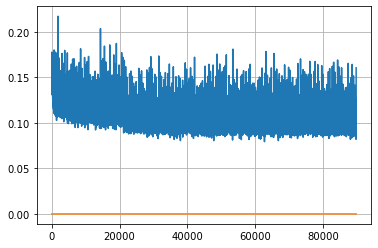

Epoch: 231, iteration 0, loss 0.11302459239959717, cov_diff 0.4193340589201764 cov_diff train 0.41843718488842624
Epoch: 231, iteration 1, loss 0.10433688759803772, cov_diff 0.42469080718654684 cov_diff train 0.4234031146182869
Epoch: 231, iteration 2, loss 0.11018571257591248, cov_diff 0.41123846328597546 cov_diff train 0.4110492880301449
Epoch: 231, iteration 3, loss 0.1086968183517456, cov_diff 0.4066443657702272 cov_diff train 0.40658631361647807
Epoch: 231, iteration 4, loss 0.10255247354507446, cov_diff 0.4105749387159607 cov_diff train 0.41036659992423574
Epoch: 231, iteration 5, loss 0.10573294758796692, cov_diff 0.4328100062999626 cov_diff train 0.4317063180259876
Epoch: 231, iteration 6, loss 0.10229441523551941, cov_diff 0.42303066519746874 cov_diff train 0.422150230236974
Epoch: 231, iteration 7, loss 0.09019109606742859, cov_diff 0.4030641356016309 cov_diff train 0.4024431561772797
Epoch: 231, iteration 8, loss 0.1031191349029541, cov_diff 0.4199942795339445 cov_diff train

Epoch: 231, iteration 77, loss 0.10643157362937927, cov_diff 0.41911818876246154 cov_diff train 0.4180001704599183
Epoch: 231, iteration 78, loss 0.10315665602684021, cov_diff 0.39861802620073283 cov_diff train 0.3981024213942711
Epoch: 231, iteration 79, loss 0.1075311005115509, cov_diff 0.40876209062798513 cov_diff train 0.406998799668414
Epoch: 231, iteration 80, loss 0.11915862560272217, cov_diff 0.39831746809068047 cov_diff train 0.39731824295699625
Epoch: 231, iteration 81, loss 0.11271438002586365, cov_diff 0.3982748922582779 cov_diff train 0.3974280329906318
Epoch: 231, iteration 82, loss 0.10767564177513123, cov_diff 0.420890170880228 cov_diff train 0.41975518630993425
Epoch: 231, iteration 83, loss 0.09131237864494324, cov_diff 0.4205664287357538 cov_diff train 0.42001432492700025
Epoch: 231, iteration 84, loss 0.10703977942466736, cov_diff 0.41171112383482145 cov_diff train 0.4120054507362522
Epoch: 231, iteration 85, loss 0.10200351476669312, cov_diff 0.4296996565074346 cov

Epoch: 231, iteration 153, loss 0.11519494652748108, cov_diff 0.41765485705183286 cov_diff train 0.41742391365395626
Epoch: 231, iteration 154, loss 0.10614567995071411, cov_diff 0.42160549816493426 cov_diff train 0.4214332431205418
Epoch: 231, iteration 155, loss 0.09825080633163452, cov_diff 0.41462991354599776 cov_diff train 0.41419275829440666
Epoch: 231, iteration 156, loss 0.11691629886627197, cov_diff 0.39521181341987716 cov_diff train 0.3946218409174207
Epoch: 231, iteration 157, loss 0.11194214224815369, cov_diff 0.4180717992367657 cov_diff train 0.4177064386799983
Epoch: 231, iteration 158, loss 0.11319255828857422, cov_diff 0.41225421793464007 cov_diff train 0.41263841075599994
Epoch: 231, iteration 159, loss 0.10865157842636108, cov_diff 0.4044719060584581 cov_diff train 0.4037652227171163
Epoch: 231, iteration 160, loss 0.11432906985282898, cov_diff 0.42172763679967573 cov_diff train 0.42094373472810437
Epoch: 231, iteration 161, loss 0.11590999364852905, cov_diff 0.416094

Epoch: 231, iteration 227, loss 0.1168120801448822, cov_diff 0.42138696676173465 cov_diff train 0.42064878793295196
Epoch: 231, iteration 228, loss 0.09755191206932068, cov_diff 0.4183748190473572 cov_diff train 0.4177023029401007
Epoch: 231, iteration 229, loss 0.10196256637573242, cov_diff 0.40582899557493307 cov_diff train 0.40493659991865566
Epoch: 231, iteration 230, loss 0.08320266008377075, cov_diff 0.41693362163069214 cov_diff train 0.4161281808116195
Epoch: 231, iteration 231, loss 0.1040448546409607, cov_diff 0.4082730544505335 cov_diff train 0.407832354155511
Epoch: 231, iteration 232, loss 0.10529562830924988, cov_diff 0.40786781852384024 cov_diff train 0.40747417157764165
Epoch: 231, iteration 233, loss 0.09692132472991943, cov_diff 0.4162770515196296 cov_diff train 0.41666067860940526
Epoch: 231, iteration 234, loss 0.0986706018447876, cov_diff 0.3991760331694828 cov_diff train 0.3988509642623428
Epoch: 231, iteration 235, loss 0.11424267292022705, cov_diff 0.415842628896

Epoch: 231, iteration 299, loss 0.10570475459098816, cov_diff 0.41707508617512906 cov_diff train 0.41642490869331433
Epoch: 231, iteration 300, loss 0.09701016545295715, cov_diff 0.40339248772159364 cov_diff train 0.40246729851628055
Epoch: 231, iteration 301, loss 0.11870315670967102, cov_diff 0.41175425948101013 cov_diff train 0.4105570277161747
Epoch: 231, iteration 302, loss 0.1089717447757721, cov_diff 0.4137563538506474 cov_diff train 0.413295727870038
Epoch: 231, iteration 303, loss 0.10716968774795532, cov_diff 0.4067753292039128 cov_diff train 0.4069939223563671
Epoch: 231, iteration 304, loss 0.1053888201713562, cov_diff 0.42543725668582594 cov_diff train 0.4250207088252369
Epoch: 231, iteration 305, loss 0.10532882809638977, cov_diff 0.41192353778036755 cov_diff train 0.4115291877953733
Epoch: 231, iteration 306, loss 0.10238516330718994, cov_diff 0.40734313690111185 cov_diff train 0.4066357773371415
Epoch: 231, iteration 307, loss 0.11589622497558594, cov_diff 0.40979758288

Epoch: 231, iteration 371, loss 0.10038074851036072, cov_diff 0.41656708310070295 cov_diff train 0.415638970483025
Epoch: 231, iteration 372, loss 0.11235189437866211, cov_diff 0.42130521443107366 cov_diff train 0.4205572339243686
Epoch: 231, iteration 373, loss 0.10151302814483643, cov_diff 0.40926846673105155 cov_diff train 0.4085456481942224
Epoch: 231, iteration 374, loss 0.098082035779953, cov_diff 0.4245290246932545 cov_diff train 0.42383670569724585
Epoch: 231, iteration 375, loss 0.1018010675907135, cov_diff 0.41427243586309404 cov_diff train 0.4131314547493469
Epoch: 231, iteration 376, loss 0.10203421115875244, cov_diff 0.4220882131265589 cov_diff train 0.42218789409175084
Epoch: 231, iteration 377, loss 0.10340866446495056, cov_diff 0.41737682260072134 cov_diff train 0.41692757217437637
Epoch: 231, iteration 378, loss 0.10839322209358215, cov_diff 0.42372636434911676 cov_diff train 0.4226424185661219
Epoch: 231, iteration 379, loss 0.11335060000419617, cov_diff 0.42078671534

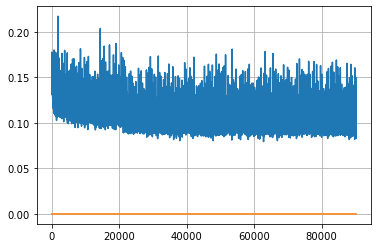

Epoch: 232, iteration 0, loss 0.09800899028778076, cov_diff 0.42062933357885707 cov_diff train 0.4198529639368217
Epoch: 232, iteration 1, loss 0.09840026497840881, cov_diff 0.4200315482432488 cov_diff train 0.4187397724498628
Epoch: 232, iteration 2, loss 0.10437038540840149, cov_diff 0.41166815617163366 cov_diff train 0.4118848910225876
Epoch: 232, iteration 3, loss 0.09913089871406555, cov_diff 0.40859179910083243 cov_diff train 0.4082458910926202
Epoch: 232, iteration 4, loss 0.10739699006080627, cov_diff 0.4144673456040868 cov_diff train 0.4132609774374255
Epoch: 232, iteration 5, loss 0.10184964537620544, cov_diff 0.4207009597202121 cov_diff train 0.41998305013162857
Epoch: 232, iteration 6, loss 0.09040218591690063, cov_diff 0.4151063829034964 cov_diff train 0.4142229546226799
Epoch: 232, iteration 7, loss 0.09725695848464966, cov_diff 0.41365317846543537 cov_diff train 0.4130881720296199
Epoch: 232, iteration 8, loss 0.11524087190628052, cov_diff 0.4153067068517203 cov_diff tra

Epoch: 232, iteration 73, loss 0.10247504711151123, cov_diff 0.4148610021622425 cov_diff train 0.4144438651222357
Epoch: 232, iteration 74, loss 0.0891542136669159, cov_diff 0.4196916860773409 cov_diff train 0.418610114017742
Epoch: 232, iteration 75, loss 0.09309521317481995, cov_diff 0.4186098228073787 cov_diff train 0.4173334848034631
Epoch: 232, iteration 76, loss 0.10042878985404968, cov_diff 0.4077724795705716 cov_diff train 0.4069264717490758
Epoch: 232, iteration 77, loss 0.09904193878173828, cov_diff 0.40566859684900214 cov_diff train 0.40492224208575794
Epoch: 232, iteration 78, loss 0.10499975085258484, cov_diff 0.40947106293523494 cov_diff train 0.40860282992401975
Epoch: 232, iteration 79, loss 0.11679697036743164, cov_diff 0.40440176427950575 cov_diff train 0.4029207054825779
Epoch: 232, iteration 80, loss 0.09394693374633789, cov_diff 0.4141956430920473 cov_diff train 0.41286774778502056
Epoch: 232, iteration 81, loss 0.10191941261291504, cov_diff 0.40451643593189707 cov

Epoch: 232, iteration 151, loss 0.10094892978668213, cov_diff 0.4104921848558626 cov_diff train 0.41082909125187733
Epoch: 232, iteration 152, loss 0.11109912395477295, cov_diff 0.4162194323943919 cov_diff train 0.4161282186333905
Epoch: 232, iteration 153, loss 0.09140053391456604, cov_diff 0.4075244383750565 cov_diff train 0.40766448889853657
Epoch: 232, iteration 154, loss 0.10148215293884277, cov_diff 0.41582019015775296 cov_diff train 0.41576092788381636
Epoch: 232, iteration 155, loss 0.10787695646286011, cov_diff 0.41113113562699105 cov_diff train 0.41085512190048634
Epoch: 232, iteration 156, loss 0.10638010501861572, cov_diff 0.4250771552043396 cov_diff train 0.42505615924092033
Epoch: 232, iteration 157, loss 0.1014532744884491, cov_diff 0.4131839891603882 cov_diff train 0.41204273279826653
Epoch: 232, iteration 158, loss 0.09150367975234985, cov_diff 0.41215794153947616 cov_diff train 0.4122150509868224
Epoch: 232, iteration 159, loss 0.11112436652183533, cov_diff 0.41261549

Epoch: 232, iteration 224, loss 0.1046716570854187, cov_diff 0.41426281216933336 cov_diff train 0.4136003833859073
Epoch: 232, iteration 225, loss 0.0934315025806427, cov_diff 0.40919473389881933 cov_diff train 0.40853543696694516
Epoch: 232, iteration 226, loss 0.09188401699066162, cov_diff 0.39635495065555393 cov_diff train 0.396322893988221
Epoch: 232, iteration 227, loss 0.11521098017692566, cov_diff 0.4215648932183663 cov_diff train 0.4213025558060988
Epoch: 232, iteration 228, loss 0.10728791356086731, cov_diff 0.4188488595737377 cov_diff train 0.4190999123721847
Epoch: 232, iteration 229, loss 0.09712174534797668, cov_diff 0.4094694223160544 cov_diff train 0.4089927564447007
Epoch: 232, iteration 230, loss 0.10514995455741882, cov_diff 0.40185375947167795 cov_diff train 0.40140936978039005
Epoch: 232, iteration 231, loss 0.12141788005828857, cov_diff 0.419299176267019 cov_diff train 0.4184469635534356
Epoch: 232, iteration 232, loss 0.09352749586105347, cov_diff 0.40991778342067

Epoch: 232, iteration 298, loss 0.10202619433403015, cov_diff 0.42027376109923 cov_diff train 0.4189191017709357
Epoch: 232, iteration 299, loss 0.09121984243392944, cov_diff 0.41147386733723196 cov_diff train 0.4108072096927897
Epoch: 232, iteration 300, loss 0.11730727553367615, cov_diff 0.41383770991248797 cov_diff train 0.41284874583648234
Epoch: 232, iteration 301, loss 0.10904672741889954, cov_diff 0.40994893562772877 cov_diff train 0.4090455250295494
Epoch: 232, iteration 302, loss 0.10256633162498474, cov_diff 0.4213910550959054 cov_diff train 0.42061695691895945
Epoch: 232, iteration 303, loss 0.10387381911277771, cov_diff 0.43049110198357643 cov_diff train 0.4294996811031973
Epoch: 232, iteration 304, loss 0.10416346788406372, cov_diff 0.42878643701908364 cov_diff train 0.42708162864661603
Epoch: 232, iteration 305, loss 0.10389906167984009, cov_diff 0.42298185382321957 cov_diff train 0.4212946901148356
Epoch: 232, iteration 306, loss 0.09842026233673096, cov_diff 0.424192522

Epoch: 232, iteration 374, loss 0.1014680564403534, cov_diff 0.4089985554979426 cov_diff train 0.4075477669683635
Epoch: 232, iteration 375, loss 0.09645015001296997, cov_diff 0.4122403491298477 cov_diff train 0.4116092373706469
Epoch: 232, iteration 376, loss 0.10789301991462708, cov_diff 0.40978830171580005 cov_diff train 0.4091989954879547
Epoch: 232, iteration 377, loss 0.10098060965538025, cov_diff 0.4120653729860957 cov_diff train 0.41140601876872773
Epoch: 232, iteration 378, loss 0.09383702278137207, cov_diff 0.4104202251865548 cov_diff train 0.40956069722428334
Epoch: 232, iteration 379, loss 0.10900449752807617, cov_diff 0.4076446006164026 cov_diff train 0.40684768507362024
Epoch: 232, iteration 380, loss 0.10613536834716797, cov_diff 0.417886689005102 cov_diff train 0.41717006311682914
Epoch: 232, iteration 381, loss 0.1080625057220459, cov_diff 0.4070588973744248 cov_diff train 0.4068555062093662
Epoch: 232, iteration 382, loss 0.10019668936729431, cov_diff 0.43001197523252

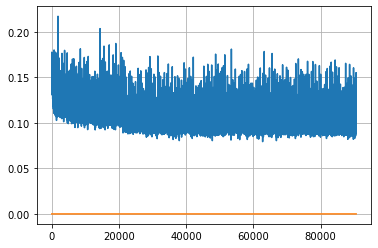

Epoch: 233, iteration 0, loss 0.1115180253982544, cov_diff 0.41108115356427516 cov_diff train 0.410825525752156
Epoch: 233, iteration 1, loss 0.09090554714202881, cov_diff 0.42473433391950466 cov_diff train 0.42351361683971595
Epoch: 233, iteration 2, loss 0.09856712818145752, cov_diff 0.4191363201544316 cov_diff train 0.41894151511569205
Epoch: 233, iteration 3, loss 0.09945335984230042, cov_diff 0.4237539771131589 cov_diff train 0.4238078455086658
Epoch: 233, iteration 4, loss 0.1022721529006958, cov_diff 0.4203488796765097 cov_diff train 0.4200268528540281
Epoch: 233, iteration 5, loss 0.11705181002616882, cov_diff 0.40754546768737354 cov_diff train 0.40712908930605274
Epoch: 233, iteration 6, loss 0.10240045189857483, cov_diff 0.433082723546482 cov_diff train 0.4323567567569991
Epoch: 233, iteration 7, loss 0.10301649570465088, cov_diff 0.41651164309893884 cov_diff train 0.4161727296342691
Epoch: 233, iteration 8, loss 0.10284337401390076, cov_diff 0.43398414907531735 cov_diff trai

Epoch: 233, iteration 72, loss 0.10977408289909363, cov_diff 0.42181488887163465 cov_diff train 0.42140124069471835
Epoch: 233, iteration 73, loss 0.11112576723098755, cov_diff 0.4190680983624411 cov_diff train 0.41849374259319355
Epoch: 233, iteration 74, loss 0.1009361743927002, cov_diff 0.41194517684764875 cov_diff train 0.4110301550523825
Epoch: 233, iteration 75, loss 0.09484165906906128, cov_diff 0.40286024321867875 cov_diff train 0.4020124440912367
Epoch: 233, iteration 76, loss 0.1088438630104065, cov_diff 0.40444649600722227 cov_diff train 0.40396923477665153
Epoch: 233, iteration 77, loss 0.10951077938079834, cov_diff 0.42480984234032854 cov_diff train 0.42366951650431384
Epoch: 233, iteration 78, loss 0.10737645626068115, cov_diff 0.41761456307654465 cov_diff train 0.41644591197507874
Epoch: 233, iteration 79, loss 0.09300842881202698, cov_diff 0.4191051639855936 cov_diff train 0.4171599446966215
Epoch: 233, iteration 80, loss 0.11811065673828125, cov_diff 0.4095048922782068

Epoch: 233, iteration 149, loss 0.10962280631065369, cov_diff 0.41438001585055745 cov_diff train 0.4143576751568
Epoch: 233, iteration 150, loss 0.09697189927101135, cov_diff 0.407807854047237 cov_diff train 0.4081475447644379
Epoch: 233, iteration 151, loss 0.1047525703907013, cov_diff 0.4179803179440115 cov_diff train 0.4173446377889252
Epoch: 233, iteration 152, loss 0.10751000046730042, cov_diff 0.4111495185425889 cov_diff train 0.40938185869280075
Epoch: 233, iteration 153, loss 0.10380074381828308, cov_diff 0.4044977217109746 cov_diff train 0.40453225323094344
Epoch: 233, iteration 154, loss 0.1235007643699646, cov_diff 0.4138273869460902 cov_diff train 0.41361043042129747
Epoch: 233, iteration 155, loss 0.10360732674598694, cov_diff 0.4211749009678009 cov_diff train 0.42090229745073615
Epoch: 233, iteration 156, loss 0.10128390789031982, cov_diff 0.4179712661586848 cov_diff train 0.4167075075645575
Epoch: 233, iteration 157, loss 0.0994744598865509, cov_diff 0.4299383896703935 c

Epoch: 233, iteration 221, loss 0.09181445837020874, cov_diff 0.42636234732960054 cov_diff train 0.4265284585381449
Epoch: 233, iteration 222, loss 0.10240006446838379, cov_diff 0.41107203739692816 cov_diff train 0.4094164148444214
Epoch: 233, iteration 223, loss 0.10564243793487549, cov_diff 0.39706702234000046 cov_diff train 0.3970049572078412
Epoch: 233, iteration 224, loss 0.09919533133506775, cov_diff 0.41081304016840076 cov_diff train 0.41063990771817377
Epoch: 233, iteration 225, loss 0.1037513017654419, cov_diff 0.3988183670736027 cov_diff train 0.39923008834735213
Epoch: 233, iteration 226, loss 0.1203421950340271, cov_diff 0.42739566890623915 cov_diff train 0.42694545831195857
Epoch: 233, iteration 227, loss 0.1072014570236206, cov_diff 0.4243308950588209 cov_diff train 0.42370375737847876
Epoch: 233, iteration 228, loss 0.11583131551742554, cov_diff 0.4112238389810742 cov_diff train 0.40978050087400264
Epoch: 233, iteration 229, loss 0.10019907355308533, cov_diff 0.405103254

Epoch: 233, iteration 293, loss 0.10857611894607544, cov_diff 0.4109138931950046 cov_diff train 0.41050524127052807
Epoch: 233, iteration 294, loss 0.09949490427970886, cov_diff 0.414484494228437 cov_diff train 0.4127856000667621
Epoch: 233, iteration 295, loss 0.0844125747680664, cov_diff 0.41940480847918327 cov_diff train 0.4185391615597182
Epoch: 233, iteration 296, loss 0.10808983445167542, cov_diff 0.42015518671714874 cov_diff train 0.41873906421653556
Epoch: 233, iteration 297, loss 0.10666435956954956, cov_diff 0.41008264953827583 cov_diff train 0.40983032527402946
Epoch: 233, iteration 298, loss 0.10960695147514343, cov_diff 0.40758623627075524 cov_diff train 0.4055679775767942
Epoch: 233, iteration 299, loss 0.1026795506477356, cov_diff 0.41473142905033666 cov_diff train 0.413724068021135
Epoch: 233, iteration 300, loss 0.09857228398323059, cov_diff 0.41858696708462895 cov_diff train 0.4179241714762007
Epoch: 233, iteration 301, loss 0.11684826016426086, cov_diff 0.40444935659

Epoch: 233, iteration 368, loss 0.09537214040756226, cov_diff 0.40148818517565105 cov_diff train 0.4002760604104709
Epoch: 233, iteration 369, loss 0.10618337988853455, cov_diff 0.4213082219730282 cov_diff train 0.42095618221969744
Epoch: 233, iteration 370, loss 0.11178755760192871, cov_diff 0.4144682923798793 cov_diff train 0.41344586671397965
Epoch: 233, iteration 371, loss 0.10365107655525208, cov_diff 0.41726102697268747 cov_diff train 0.4160226322712643
Epoch: 233, iteration 372, loss 0.09464949369430542, cov_diff 0.4076550227179432 cov_diff train 0.4066163044138301
Epoch: 233, iteration 373, loss 0.11721128225326538, cov_diff 0.42643474821330746 cov_diff train 0.4254139428079891
Epoch: 233, iteration 374, loss 0.10247376561164856, cov_diff 0.41630978048476924 cov_diff train 0.41582410614352977
Epoch: 233, iteration 375, loss 0.10393106937408447, cov_diff 0.41491466928237253 cov_diff train 0.4139067914255161
Epoch: 233, iteration 376, loss 0.0993746817111969, cov_diff 0.421315386

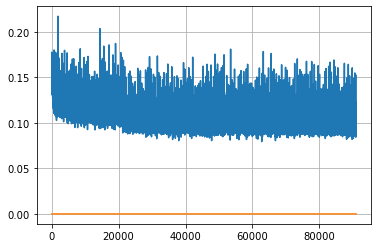

Epoch: 234, iteration 0, loss 0.09537598490715027, cov_diff 0.41744203373961064 cov_diff train 0.41674546360392767
Epoch: 234, iteration 1, loss 0.09599044919013977, cov_diff 0.40862463131217003 cov_diff train 0.4077727593834418
Epoch: 234, iteration 2, loss 0.10066762566566467, cov_diff 0.4214419695625979 cov_diff train 0.4203872541558
Epoch: 234, iteration 3, loss 0.0952049195766449, cov_diff 0.42282427902616454 cov_diff train 0.42172612173419055
Epoch: 234, iteration 4, loss 0.09964427351951599, cov_diff 0.41690958593654415 cov_diff train 0.41616321277281937
Epoch: 234, iteration 5, loss 0.09000402688980103, cov_diff 0.4208293144065089 cov_diff train 0.42052078680549826
Epoch: 234, iteration 6, loss 0.10589230060577393, cov_diff 0.41526145379666285 cov_diff train 0.41448870167598917
Epoch: 234, iteration 7, loss 0.11052179336547852, cov_diff 0.4334130505153253 cov_diff train 0.4332834589861927
Epoch: 234, iteration 8, loss 0.10511553287506104, cov_diff 0.4184596869464366 cov_diff tr

Epoch: 234, iteration 75, loss 0.10006195306777954, cov_diff 0.39909246224228573 cov_diff train 0.3983877087326026
Epoch: 234, iteration 76, loss 0.09592798352241516, cov_diff 0.41504519692223024 cov_diff train 0.4141365777619968
Epoch: 234, iteration 77, loss 0.10072386264801025, cov_diff 0.4072126756355739 cov_diff train 0.40579817437771815
Epoch: 234, iteration 78, loss 0.11600613594055176, cov_diff 0.412659584946672 cov_diff train 0.4112658869581383
Epoch: 234, iteration 79, loss 0.10148555040359497, cov_diff 0.42235707893749586 cov_diff train 0.42067423528143344
Epoch: 234, iteration 80, loss 0.1041015088558197, cov_diff 0.40325692668133967 cov_diff train 0.40217257048079447
Epoch: 234, iteration 81, loss 0.10608112812042236, cov_diff 0.4114119202892014 cov_diff train 0.40991461031643356
Epoch: 234, iteration 82, loss 0.1082099974155426, cov_diff 0.3984196627869505 cov_diff train 0.397925607598158
Epoch: 234, iteration 83, loss 0.10627055168151855, cov_diff 0.4042666717684571 cov_

Epoch: 234, iteration 156, loss 0.10860210657119751, cov_diff 0.40454669037484575 cov_diff train 0.40463197845421817
Epoch: 234, iteration 157, loss 0.11019808053970337, cov_diff 0.4065125417648935 cov_diff train 0.4060981660477882
Epoch: 234, iteration 158, loss 0.10413676500320435, cov_diff 0.39417477552390773 cov_diff train 0.3940478828051149
Epoch: 234, iteration 159, loss 0.10086819529533386, cov_diff 0.40982291870248166 cov_diff train 0.4097243406405644
Epoch: 234, iteration 160, loss 0.11149877309799194, cov_diff 0.42087233760102577 cov_diff train 0.4203953079646445
Epoch: 234, iteration 161, loss 0.10669448971748352, cov_diff 0.42845566686093856 cov_diff train 0.4285665111823168
Epoch: 234, iteration 162, loss 0.11591941118240356, cov_diff 0.42537137842688044 cov_diff train 0.42411698392293773
Epoch: 234, iteration 163, loss 0.09336379170417786, cov_diff 0.4050103303577483 cov_diff train 0.40426614765261065
Epoch: 234, iteration 164, loss 0.0999889075756073, cov_diff 0.40536104

Epoch: 234, iteration 232, loss 0.10312864184379578, cov_diff 0.4148122632188683 cov_diff train 0.4145692427404255
Epoch: 234, iteration 233, loss 0.09882891178131104, cov_diff 0.4234329015445465 cov_diff train 0.4229100558261445
Epoch: 234, iteration 234, loss 0.09835734963417053, cov_diff 0.4150218386236465 cov_diff train 0.4148387774057063
Epoch: 234, iteration 235, loss 0.10290312767028809, cov_diff 0.41419755637949895 cov_diff train 0.41271893953315825
Epoch: 234, iteration 236, loss 0.10404303669929504, cov_diff 0.4154107520152616 cov_diff train 0.41385512802226027
Epoch: 234, iteration 237, loss 0.10779008269309998, cov_diff 0.41963461239378497 cov_diff train 0.4190824753527337
Epoch: 234, iteration 238, loss 0.1117989718914032, cov_diff 0.4197201112022458 cov_diff train 0.4187268261226777
Epoch: 234, iteration 239, loss 0.116946280002594, cov_diff 0.4148230295760187 cov_diff train 0.41380730377642316
Epoch: 234, iteration 240, loss 0.1031734049320221, cov_diff 0.419957064072408

Epoch: 234, iteration 309, loss 0.10764411091804504, cov_diff 0.4158726721264857 cov_diff train 0.41606215227654686
Epoch: 234, iteration 310, loss 0.0985136330127716, cov_diff 0.42010903494103685 cov_diff train 0.41975176040932605
Epoch: 234, iteration 311, loss 0.1138806939125061, cov_diff 0.4059122952277581 cov_diff train 0.40533468011127904
Epoch: 234, iteration 312, loss 0.09733477234840393, cov_diff 0.4193614108351231 cov_diff train 0.41853395780516345
Epoch: 234, iteration 313, loss 0.10947209596633911, cov_diff 0.41015461396775416 cov_diff train 0.4097497658474561
Epoch: 234, iteration 314, loss 0.10867011547088623, cov_diff 0.4134181475419028 cov_diff train 0.41207642963797825
Epoch: 234, iteration 315, loss 0.10316401720046997, cov_diff 0.4187181179085193 cov_diff train 0.4179931248223968
Epoch: 234, iteration 316, loss 0.1057555079460144, cov_diff 0.4078026202904404 cov_diff train 0.4068157083333932
Epoch: 234, iteration 317, loss 0.11853939294815063, cov_diff 0.419427917665

Epoch: 234, iteration 388, loss 0.11264505982398987, cov_diff 0.409942490339679 cov_diff train 0.40996649539775637
Epoch: 234, iteration 389, loss 0.10207700729370117, cov_diff 0.41757001567634966 cov_diff train 0.41743461435258783
Epoch: 234, iteration 390, loss 0.1650923192501068, cov_diff 0.4646419083211936 cov_diff train 0.46324124316210996


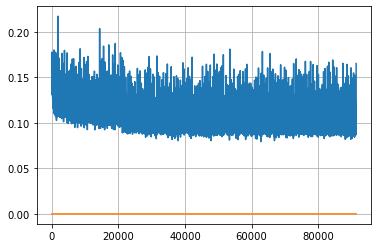

Epoch: 235, iteration 0, loss 0.10890218615531921, cov_diff 0.4069597371888814 cov_diff train 0.40678426279013896
Epoch: 235, iteration 1, loss 0.10790562629699707, cov_diff 0.411356042736935 cov_diff train 0.41083518608731123
Epoch: 235, iteration 2, loss 0.11147627234458923, cov_diff 0.41783327467474785 cov_diff train 0.4172699336536518
Epoch: 235, iteration 3, loss 0.09026864171028137, cov_diff 0.41062953872606456 cov_diff train 0.4104047577559904
Epoch: 235, iteration 4, loss 0.0985812246799469, cov_diff 0.4165676128215697 cov_diff train 0.41565696161179416
Epoch: 235, iteration 5, loss 0.12046080827713013, cov_diff 0.4284533717804743 cov_diff train 0.4279149951954565
Epoch: 235, iteration 6, loss 0.12240689992904663, cov_diff 0.41211656658553425 cov_diff train 0.41027924586439457
Epoch: 235, iteration 7, loss 0.09974774718284607, cov_diff 0.4265177499240815 cov_diff train 0.4260593572188487
Epoch: 235, iteration 8, loss 0.09959033131599426, cov_diff 0.4112473479614727 cov_diff tra

Epoch: 235, iteration 78, loss 0.10651606321334839, cov_diff 0.4045502042994447 cov_diff train 0.40428694092947765
Epoch: 235, iteration 79, loss 0.10406836867332458, cov_diff 0.4150722809380882 cov_diff train 0.41415749646331484
Epoch: 235, iteration 80, loss 0.11007967591285706, cov_diff 0.4089306583928351 cov_diff train 0.4080912888842564
Epoch: 235, iteration 81, loss 0.1080261766910553, cov_diff 0.408315302187777 cov_diff train 0.40828475902874656
Epoch: 235, iteration 82, loss 0.10706710815429688, cov_diff 0.40907226601205326 cov_diff train 0.40911086721056206
Epoch: 235, iteration 83, loss 0.10132813453674316, cov_diff 0.41869636433376795 cov_diff train 0.4179944028186162
Epoch: 235, iteration 84, loss 0.09959399700164795, cov_diff 0.419409104781706 cov_diff train 0.4191069019571282
Epoch: 235, iteration 85, loss 0.10271134972572327, cov_diff 0.4038170228558732 cov_diff train 0.4033620725567461
Epoch: 235, iteration 86, loss 0.10115078091621399, cov_diff 0.4095252833990887 cov_d

Epoch: 235, iteration 156, loss 0.12273430824279785, cov_diff 0.4131581057492236 cov_diff train 0.41243277024594643
Epoch: 235, iteration 157, loss 0.10461843013763428, cov_diff 0.41394007589002396 cov_diff train 0.41330449294235844
Epoch: 235, iteration 158, loss 0.1008080244064331, cov_diff 0.41091310484729054 cov_diff train 0.410369949503383
Epoch: 235, iteration 159, loss 0.09540212154388428, cov_diff 0.4115005699134221 cov_diff train 0.41141083342640106
Epoch: 235, iteration 160, loss 0.11244937777519226, cov_diff 0.41841113353258025 cov_diff train 0.417342989401372
Epoch: 235, iteration 161, loss 0.10026848316192627, cov_diff 0.4102078479268314 cov_diff train 0.4092409315223586
Epoch: 235, iteration 162, loss 0.11203873157501221, cov_diff 0.4057927246443527 cov_diff train 0.4053025892862425
Epoch: 235, iteration 163, loss 0.10332635045051575, cov_diff 0.4073703873735917 cov_diff train 0.40708403421557987
Epoch: 235, iteration 164, loss 0.09322011470794678, cov_diff 0.411470034131

Epoch: 235, iteration 231, loss 0.09613943099975586, cov_diff 0.4119389494165278 cov_diff train 0.41081136356016407
Epoch: 235, iteration 232, loss 0.10087040066719055, cov_diff 0.3878534107388631 cov_diff train 0.3874184112722441
Epoch: 235, iteration 233, loss 0.10035359859466553, cov_diff 0.4173513406218853 cov_diff train 0.41627322255729415
Epoch: 235, iteration 234, loss 0.10426148772239685, cov_diff 0.4053267668584918 cov_diff train 0.40493544446788926
Epoch: 235, iteration 235, loss 0.11398971080780029, cov_diff 0.41776822671871144 cov_diff train 0.4166957091952312
Epoch: 235, iteration 236, loss 0.09825718402862549, cov_diff 0.4031003124753289 cov_diff train 0.402408026900657
Epoch: 235, iteration 237, loss 0.09609237313270569, cov_diff 0.4012384808803098 cov_diff train 0.40147494867243844
Epoch: 235, iteration 238, loss 0.10651561617851257, cov_diff 0.40508562115664515 cov_diff train 0.40514839619712484
Epoch: 235, iteration 239, loss 0.09808796644210815, cov_diff 0.3982178823

Epoch: 235, iteration 306, loss 0.0997353196144104, cov_diff 0.40728318655904266 cov_diff train 0.4056413422041757
Epoch: 235, iteration 307, loss 0.1005772054195404, cov_diff 0.3992171497224976 cov_diff train 0.3980614452341287
Epoch: 235, iteration 308, loss 0.10626015067100525, cov_diff 0.41185478942356746 cov_diff train 0.4110287883310973
Epoch: 235, iteration 309, loss 0.09796801209449768, cov_diff 0.4084956920923408 cov_diff train 0.4074040131135076
Epoch: 235, iteration 310, loss 0.09913989901542664, cov_diff 0.4157736899562533 cov_diff train 0.41503869867378534
Epoch: 235, iteration 311, loss 0.10529258847236633, cov_diff 0.42285952372816005 cov_diff train 0.422219926201427
Epoch: 235, iteration 312, loss 0.10546612739562988, cov_diff 0.3976722915002049 cov_diff train 0.39685779204801275
Epoch: 235, iteration 313, loss 0.09804296493530273, cov_diff 0.4108476321191292 cov_diff train 0.4105230588338636
Epoch: 235, iteration 314, loss 0.09407004714012146, cov_diff 0.41998765463836

Epoch: 235, iteration 382, loss 0.10708409547805786, cov_diff 0.41377521848208915 cov_diff train 0.41349882174944774
Epoch: 235, iteration 383, loss 0.09809425473213196, cov_diff 0.41141716532893063 cov_diff train 0.4099791864276304
Epoch: 235, iteration 384, loss 0.10697871446609497, cov_diff 0.40884587581619175 cov_diff train 0.4079642976773096
Epoch: 235, iteration 385, loss 0.09417611360549927, cov_diff 0.408828665632883 cov_diff train 0.4087260906631018
Epoch: 235, iteration 386, loss 0.1019778847694397, cov_diff 0.4127528192887541 cov_diff train 0.41272943607375684
Epoch: 235, iteration 387, loss 0.10679671168327332, cov_diff 0.41502272542245544 cov_diff train 0.4147041261172912
Epoch: 235, iteration 388, loss 0.10303002595901489, cov_diff 0.43670488206912916 cov_diff train 0.43617533330828423
Epoch: 235, iteration 389, loss 0.10620880126953125, cov_diff 0.40687545107595696 cov_diff train 0.4065043290106602
Epoch: 235, iteration 390, loss 0.17281001806259155, cov_diff 0.471099801

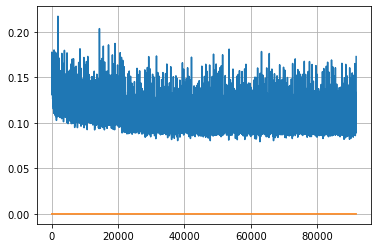

Epoch: 236, iteration 0, loss 0.10315173864364624, cov_diff 0.4268295605883007 cov_diff train 0.4260327242334538
Epoch: 236, iteration 1, loss 0.10131946206092834, cov_diff 0.4090393848745733 cov_diff train 0.408711642755647
Epoch: 236, iteration 2, loss 0.10548439621925354, cov_diff 0.40662309171213734 cov_diff train 0.4065630962527803
Epoch: 236, iteration 3, loss 0.10975155234336853, cov_diff 0.4126814458525614 cov_diff train 0.41204375161258355
Epoch: 236, iteration 4, loss 0.10594895482063293, cov_diff 0.40421478828098767 cov_diff train 0.40379892459203937
Epoch: 236, iteration 5, loss 0.11383485794067383, cov_diff 0.4194618215151109 cov_diff train 0.4195428510976255
Epoch: 236, iteration 6, loss 0.10300546884536743, cov_diff 0.40604180198995965 cov_diff train 0.40588611818287884
Epoch: 236, iteration 7, loss 0.11358612775802612, cov_diff 0.4401075858989477 cov_diff train 0.4392580892233112
Epoch: 236, iteration 8, loss 0.09785416722297668, cov_diff 0.41386897546711693 cov_diff tr

Epoch: 236, iteration 76, loss 0.10550671815872192, cov_diff 0.4136734630519386 cov_diff train 0.4125281470469544
Epoch: 236, iteration 77, loss 0.10163187980651855, cov_diff 0.4108974509949205 cov_diff train 0.41070185851972896
Epoch: 236, iteration 78, loss 0.10301101207733154, cov_diff 0.4093897654636423 cov_diff train 0.4090473705109113
Epoch: 236, iteration 79, loss 0.10605332255363464, cov_diff 0.3976878326177868 cov_diff train 0.39717406542383055
Epoch: 236, iteration 80, loss 0.11400339007377625, cov_diff 0.4055485999519001 cov_diff train 0.4058368031994884
Epoch: 236, iteration 81, loss 0.09747275710105896, cov_diff 0.4102741169925464 cov_diff train 0.41038279951859413
Epoch: 236, iteration 82, loss 0.10061106085777283, cov_diff 0.41562484726808946 cov_diff train 0.41528432685163785
Epoch: 236, iteration 83, loss 0.11248844861984253, cov_diff 0.43049525366837443 cov_diff train 0.4296746969892259
Epoch: 236, iteration 84, loss 0.11025434732437134, cov_diff 0.4169531329380742 co

Epoch: 236, iteration 156, loss 0.09676074981689453, cov_diff 0.41749334033520347 cov_diff train 0.4169409654653195
Epoch: 236, iteration 157, loss 0.10739001631736755, cov_diff 0.4050460173027628 cov_diff train 0.40396264263792264
Epoch: 236, iteration 158, loss 0.10488033294677734, cov_diff 0.41553620297584687 cov_diff train 0.41429947013836227
Epoch: 236, iteration 159, loss 0.10865068435668945, cov_diff 0.4128493054719309 cov_diff train 0.41190512056097744
Epoch: 236, iteration 160, loss 0.10096192359924316, cov_diff 0.4127960126453566 cov_diff train 0.4119815140457886
Epoch: 236, iteration 161, loss 0.10978510975837708, cov_diff 0.4194842498394488 cov_diff train 0.4189240080788561
Epoch: 236, iteration 162, loss 0.09462150931358337, cov_diff 0.41386563921329084 cov_diff train 0.4126416699153936
Epoch: 236, iteration 163, loss 0.09192302823066711, cov_diff 0.40135240321275306 cov_diff train 0.4012830621611472
Epoch: 236, iteration 164, loss 0.11655858159065247, cov_diff 0.410961045

Epoch: 236, iteration 227, loss 0.1006060242652893, cov_diff 0.41327677642493954 cov_diff train 0.41175230297644205
Epoch: 236, iteration 228, loss 0.10000139474868774, cov_diff 0.42098461064153647 cov_diff train 0.41975220325763235
Epoch: 236, iteration 229, loss 0.1080215573310852, cov_diff 0.4095671588226503 cov_diff train 0.40877412123645096
Epoch: 236, iteration 230, loss 0.11213096976280212, cov_diff 0.410353908889125 cov_diff train 0.40894098538074314
Epoch: 236, iteration 231, loss 0.11659377813339233, cov_diff 0.41658321630829676 cov_diff train 0.4157883484834436
Epoch: 236, iteration 232, loss 0.0997183620929718, cov_diff 0.42808989738648584 cov_diff train 0.42749933550648533
Epoch: 236, iteration 233, loss 0.0923912525177002, cov_diff 0.4084555918596811 cov_diff train 0.4077060423011327
Epoch: 236, iteration 234, loss 0.10797116160392761, cov_diff 0.4121701573155272 cov_diff train 0.41058709888510075
Epoch: 236, iteration 235, loss 0.11949089169502258, cov_diff 0.40445608010

Epoch: 236, iteration 302, loss 0.09486466646194458, cov_diff 0.3978607623138774 cov_diff train 0.39727967366376327
Epoch: 236, iteration 303, loss 0.08597365021705627, cov_diff 0.4120326164907788 cov_diff train 0.41160220635090994
Epoch: 236, iteration 304, loss 0.11052381992340088, cov_diff 0.4133296411869753 cov_diff train 0.41264000951216534
Epoch: 236, iteration 305, loss 0.09361138939857483, cov_diff 0.40143910444032443 cov_diff train 0.40011411004169634
Epoch: 236, iteration 306, loss 0.09665778279304504, cov_diff 0.41262133336173595 cov_diff train 0.41273150351618654
Epoch: 236, iteration 307, loss 0.10341233015060425, cov_diff 0.39887369148531315 cov_diff train 0.39889608960993767
Epoch: 236, iteration 308, loss 0.1052926778793335, cov_diff 0.4148116113875926 cov_diff train 0.4149717447189649
Epoch: 236, iteration 309, loss 0.09579518437385559, cov_diff 0.41261759422914684 cov_diff train 0.4126534498063434
Epoch: 236, iteration 310, loss 0.10066375136375427, cov_diff 0.4094775

Epoch: 236, iteration 375, loss 0.1042289137840271, cov_diff 0.4054585620006941 cov_diff train 0.404376462670932
Epoch: 236, iteration 376, loss 0.09814482927322388, cov_diff 0.4020647275217265 cov_diff train 0.4013204505663104
Epoch: 236, iteration 377, loss 0.11797791719436646, cov_diff 0.4408520446058009 cov_diff train 0.4399112871385728
Epoch: 236, iteration 378, loss 0.10713297128677368, cov_diff 0.4155130708989952 cov_diff train 0.41450207154985763
Epoch: 236, iteration 379, loss 0.11504057049751282, cov_diff 0.40941115170230424 cov_diff train 0.4083081970366306
Epoch: 236, iteration 380, loss 0.10075768828392029, cov_diff 0.41571233645577377 cov_diff train 0.41477337515292917
Epoch: 236, iteration 381, loss 0.09812581539154053, cov_diff 0.4168002555048729 cov_diff train 0.41605822425089073
Epoch: 236, iteration 382, loss 0.11506730318069458, cov_diff 0.4029281398339944 cov_diff train 0.4033499590582151
Epoch: 236, iteration 383, loss 0.12584254145622253, cov_diff 0.4285884274574

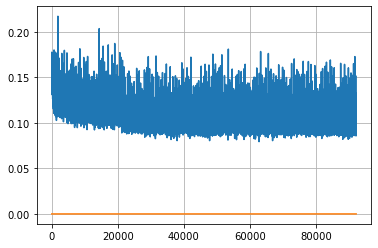

Epoch: 237, iteration 0, loss 0.10673758387565613, cov_diff 0.42672395772780375 cov_diff train 0.42645511919801343
Epoch: 237, iteration 1, loss 0.11599525809288025, cov_diff 0.42479266644825775 cov_diff train 0.4245953300078753
Epoch: 237, iteration 2, loss 0.09067776799201965, cov_diff 0.41282053572508126 cov_diff train 0.4120709365650572
Epoch: 237, iteration 3, loss 0.09822526574134827, cov_diff 0.40538979811962134 cov_diff train 0.4052875220842707
Epoch: 237, iteration 4, loss 0.10571077466011047, cov_diff 0.40447288019694133 cov_diff train 0.4038596920639859
Epoch: 237, iteration 5, loss 0.1082628071308136, cov_diff 0.40869665552710893 cov_diff train 0.40846911238347994
Epoch: 237, iteration 6, loss 0.11727064847946167, cov_diff 0.4176814952449525 cov_diff train 0.41686765149950267
Epoch: 237, iteration 7, loss 0.11051774024963379, cov_diff 0.41058544587677775 cov_diff train 0.41024672146889357
Epoch: 237, iteration 8, loss 0.09739643335342407, cov_diff 0.39823400343699095 cov_di

Epoch: 237, iteration 75, loss 0.10236901044845581, cov_diff 0.4165655782178429 cov_diff train 0.41610159682125086
Epoch: 237, iteration 76, loss 0.10351604223251343, cov_diff 0.4120860481105989 cov_diff train 0.4112708936283618
Epoch: 237, iteration 77, loss 0.09228572249412537, cov_diff 0.4195966671363649 cov_diff train 0.41973279347109527
Epoch: 237, iteration 78, loss 0.09526059031486511, cov_diff 0.4114469215700413 cov_diff train 0.4110999735924198
Epoch: 237, iteration 79, loss 0.08911755681037903, cov_diff 0.4060369790808233 cov_diff train 0.40512647165948845
Epoch: 237, iteration 80, loss 0.10269489884376526, cov_diff 0.4210251441025014 cov_diff train 0.4207095841968299
Epoch: 237, iteration 81, loss 0.09419342875480652, cov_diff 0.414741812589091 cov_diff train 0.41422766937584377
Epoch: 237, iteration 82, loss 0.0986747145652771, cov_diff 0.4263084452749836 cov_diff train 0.4256841557562525
Epoch: 237, iteration 83, loss 0.10746610164642334, cov_diff 0.41086909242039676 cov_d

Epoch: 237, iteration 151, loss 0.12029504776000977, cov_diff 0.42051794240967094 cov_diff train 0.41947224129655764
Epoch: 237, iteration 152, loss 0.10767224431037903, cov_diff 0.41739549833374384 cov_diff train 0.41609005683268935
Epoch: 237, iteration 153, loss 0.09925949573516846, cov_diff 0.4213901793954549 cov_diff train 0.41967452678320877
Epoch: 237, iteration 154, loss 0.09452506899833679, cov_diff 0.41861762581203454 cov_diff train 0.41824393089025025
Epoch: 237, iteration 155, loss 0.1087942123413086, cov_diff 0.4264326649524232 cov_diff train 0.42531674912913026
Epoch: 237, iteration 156, loss 0.10479667782783508, cov_diff 0.41984182539295245 cov_diff train 0.41887202762385944
Epoch: 237, iteration 157, loss 0.10722553730010986, cov_diff 0.41632880927522425 cov_diff train 0.4154194448771146
Epoch: 237, iteration 158, loss 0.11273059248924255, cov_diff 0.4244209059100347 cov_diff train 0.4243056763975266
Epoch: 237, iteration 159, loss 0.10217148065567017, cov_diff 0.412148

Epoch: 237, iteration 231, loss 0.11160463094711304, cov_diff 0.41475539925994487 cov_diff train 0.4143464223151886
Epoch: 237, iteration 232, loss 0.1107473373413086, cov_diff 0.40659037257031627 cov_diff train 0.40575781968693486
Epoch: 237, iteration 233, loss 0.11219874024391174, cov_diff 0.4167885411498717 cov_diff train 0.41655386988311055
Epoch: 237, iteration 234, loss 0.10895323753356934, cov_diff 0.40476942810046185 cov_diff train 0.40347140850391866
Epoch: 237, iteration 235, loss 0.1079975962638855, cov_diff 0.4161986056625869 cov_diff train 0.4152134931370048
Epoch: 237, iteration 236, loss 0.09537366032600403, cov_diff 0.40547691054569374 cov_diff train 0.4048366422141555
Epoch: 237, iteration 237, loss 0.09341034293174744, cov_diff 0.4192707915743256 cov_diff train 0.4177851610839795
Epoch: 237, iteration 238, loss 0.12052002549171448, cov_diff 0.4228199157286164 cov_diff train 0.42137945438961855
Epoch: 237, iteration 239, loss 0.10263597965240479, cov_diff 0.4044728111

Epoch: 237, iteration 304, loss 0.09413948655128479, cov_diff 0.42022730369526057 cov_diff train 0.41998917168010425
Epoch: 237, iteration 305, loss 0.10311451554298401, cov_diff 0.4195517883349027 cov_diff train 0.41873208224477515
Epoch: 237, iteration 306, loss 0.11103588342666626, cov_diff 0.42089523648287513 cov_diff train 0.4206026942634838
Epoch: 237, iteration 307, loss 0.11568546295166016, cov_diff 0.41877076355418863 cov_diff train 0.41780887435871894
Epoch: 237, iteration 308, loss 0.10703369975090027, cov_diff 0.4013053544620136 cov_diff train 0.40070593429986123
Epoch: 237, iteration 309, loss 0.09129971265792847, cov_diff 0.4072962068345151 cov_diff train 0.40623798576224085
Epoch: 237, iteration 310, loss 0.0988454520702362, cov_diff 0.4018091602251328 cov_diff train 0.4011667892713357
Epoch: 237, iteration 311, loss 0.1110435426235199, cov_diff 0.41880473267667023 cov_diff train 0.4179551584275504
Epoch: 237, iteration 312, loss 0.10400831699371338, cov_diff 0.397626928

Epoch: 237, iteration 382, loss 0.0989629328250885, cov_diff 0.4208278836734153 cov_diff train 0.4184243732159984
Epoch: 237, iteration 383, loss 0.1012665331363678, cov_diff 0.4154425837332391 cov_diff train 0.4152221133831139
Epoch: 237, iteration 384, loss 0.10676994919776917, cov_diff 0.4106405519110977 cov_diff train 0.4100256941251498
Epoch: 237, iteration 385, loss 0.10094740986824036, cov_diff 0.4108938376608559 cov_diff train 0.4100354361004549
Epoch: 237, iteration 386, loss 0.11056417226791382, cov_diff 0.4252443316284319 cov_diff train 0.42492903483778494
Epoch: 237, iteration 387, loss 0.10423228144645691, cov_diff 0.42003250169795053 cov_diff train 0.418156179761528
Epoch: 237, iteration 388, loss 0.09368330240249634, cov_diff 0.42722081148270075 cov_diff train 0.42593305253942915
Epoch: 237, iteration 389, loss 0.1094297468662262, cov_diff 0.4074813482702089 cov_diff train 0.40641264948513706
Epoch: 237, iteration 390, loss 0.16936716437339783, cov_diff 0.451713090051879

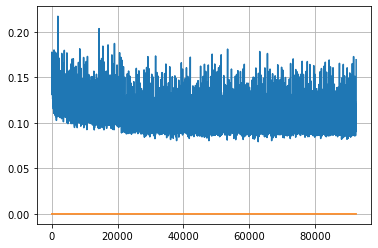

Epoch: 238, iteration 0, loss 0.11196541786193848, cov_diff 0.42503539800447676 cov_diff train 0.42365835734510576
Epoch: 238, iteration 1, loss 0.10607075691223145, cov_diff 0.42027312897123303 cov_diff train 0.42034950187766645
Epoch: 238, iteration 2, loss 0.10616374015808105, cov_diff 0.40067224234832005 cov_diff train 0.40025205348207904
Epoch: 238, iteration 3, loss 0.12227624654769897, cov_diff 0.41451310747216435 cov_diff train 0.41314668960511186
Epoch: 238, iteration 4, loss 0.11328363418579102, cov_diff 0.42377694316391673 cov_diff train 0.4231316381465479
Epoch: 238, iteration 5, loss 0.09597083926200867, cov_diff 0.4045358769178835 cov_diff train 0.4040338296397875
Epoch: 238, iteration 6, loss 0.10768663883209229, cov_diff 0.4180203979250429 cov_diff train 0.41737633100886135
Epoch: 238, iteration 7, loss 0.11066678166389465, cov_diff 0.42069927033308246 cov_diff train 0.41972325704579266
Epoch: 238, iteration 8, loss 0.10122731328010559, cov_diff 0.4181512985156007 cov_d

Epoch: 238, iteration 77, loss 0.11844241619110107, cov_diff 0.41347636784886105 cov_diff train 0.4132546737580739
Epoch: 238, iteration 78, loss 0.08573418855667114, cov_diff 0.4224712555323585 cov_diff train 0.4218038845661361
Epoch: 238, iteration 79, loss 0.10140246152877808, cov_diff 0.4106216518280613 cov_diff train 0.41063656305492235
Epoch: 238, iteration 80, loss 0.10932028293609619, cov_diff 0.42602437834256424 cov_diff train 0.424990526935003
Epoch: 238, iteration 81, loss 0.10417583584785461, cov_diff 0.4183726692414985 cov_diff train 0.41732658279496215
Epoch: 238, iteration 82, loss 0.10188573598861694, cov_diff 0.42182637179826626 cov_diff train 0.42110799179978703
Epoch: 238, iteration 83, loss 0.10013782978057861, cov_diff 0.42421444358395194 cov_diff train 0.42366399076455385
Epoch: 238, iteration 84, loss 0.1126168966293335, cov_diff 0.4286245338503295 cov_diff train 0.42716038064090744
Epoch: 238, iteration 85, loss 0.1088712215423584, cov_diff 0.4255477898962129 co

Epoch: 238, iteration 156, loss 0.10458335280418396, cov_diff 0.40321966122502856 cov_diff train 0.4018955803616942
Epoch: 238, iteration 157, loss 0.10397195816040039, cov_diff 0.4154512200831957 cov_diff train 0.41590096385440123
Epoch: 238, iteration 158, loss 0.10569298267364502, cov_diff 0.42036353730577847 cov_diff train 0.419456985482446
Epoch: 238, iteration 159, loss 0.10368835926055908, cov_diff 0.4216284826974327 cov_diff train 0.4219260831448285
Epoch: 238, iteration 160, loss 0.10054829716682434, cov_diff 0.3986257660881233 cov_diff train 0.3967720491251762
Epoch: 238, iteration 161, loss 0.11198017001152039, cov_diff 0.41830943730380876 cov_diff train 0.4167847824420015
Epoch: 238, iteration 162, loss 0.1041955053806305, cov_diff 0.4044861896933262 cov_diff train 0.40402112351476643
Epoch: 238, iteration 163, loss 0.10709619522094727, cov_diff 0.4128396925239332 cov_diff train 0.4123825578114614
Epoch: 238, iteration 164, loss 0.11376884579658508, cov_diff 0.4040085279114

Epoch: 238, iteration 233, loss 0.10544052720069885, cov_diff 0.4067569488706217 cov_diff train 0.40702414109085655
Epoch: 238, iteration 234, loss 0.10035443305969238, cov_diff 0.41995995758186366 cov_diff train 0.42022808952173474
Epoch: 238, iteration 235, loss 0.11735507845878601, cov_diff 0.419543171723076 cov_diff train 0.4189238790453859
Epoch: 238, iteration 236, loss 0.10732424259185791, cov_diff 0.416152270997211 cov_diff train 0.41635766313777556
Epoch: 238, iteration 237, loss 0.11661273241043091, cov_diff 0.42097165437111844 cov_diff train 0.4198826543051632
Epoch: 238, iteration 238, loss 0.10542887449264526, cov_diff 0.4170185228719379 cov_diff train 0.4164638168921817
Epoch: 238, iteration 239, loss 0.11105954647064209, cov_diff 0.4176834425499722 cov_diff train 0.41730169110786614
Epoch: 238, iteration 240, loss 0.10753843188285828, cov_diff 0.42058395318349334 cov_diff train 0.4199798850207012
Epoch: 238, iteration 241, loss 0.10139092803001404, cov_diff 0.40964469951

Epoch: 238, iteration 305, loss 0.10568490624427795, cov_diff 0.41868621824544805 cov_diff train 0.41846963879184895
Epoch: 238, iteration 306, loss 0.11129462718963623, cov_diff 0.3959099897701795 cov_diff train 0.39559679712580137
Epoch: 238, iteration 307, loss 0.10032704472541809, cov_diff 0.4237430380062637 cov_diff train 0.4233539630869521
Epoch: 238, iteration 308, loss 0.09707427024841309, cov_diff 0.4042110508193095 cov_diff train 0.40352232889374484
Epoch: 238, iteration 309, loss 0.12138718366622925, cov_diff 0.4066453359328487 cov_diff train 0.4063027881021529
Epoch: 238, iteration 310, loss 0.09777471423149109, cov_diff 0.4023116306387367 cov_diff train 0.4016179381775984
Epoch: 238, iteration 311, loss 0.10313668847084045, cov_diff 0.4171158793164166 cov_diff train 0.41655497410481707
Epoch: 238, iteration 312, loss 0.09780925512313843, cov_diff 0.4261179184699396 cov_diff train 0.42547706604637725
Epoch: 238, iteration 313, loss 0.10209715366363525, cov_diff 0.3983599291

Epoch: 238, iteration 382, loss 0.09501984715461731, cov_diff 0.42350675571744606 cov_diff train 0.4223475227830888
Epoch: 238, iteration 383, loss 0.10682260990142822, cov_diff 0.4195125002812243 cov_diff train 0.41825438090962214
Epoch: 238, iteration 384, loss 0.11982741951942444, cov_diff 0.4054042581037934 cov_diff train 0.4049971074728904
Epoch: 238, iteration 385, loss 0.10932654142379761, cov_diff 0.4084217236283108 cov_diff train 0.40743727515354966
Epoch: 238, iteration 386, loss 0.10408762097358704, cov_diff 0.41007897378070957 cov_diff train 0.4096371592237544
Epoch: 238, iteration 387, loss 0.09997287392616272, cov_diff 0.40689809531945453 cov_diff train 0.4065049592002894
Epoch: 238, iteration 388, loss 0.10107216238975525, cov_diff 0.40117564938975153 cov_diff train 0.4009237883249924
Epoch: 238, iteration 389, loss 0.10433405637741089, cov_diff 0.4043035641347405 cov_diff train 0.4038154467834203
Epoch: 238, iteration 390, loss 0.14260882139205933, cov_diff 0.4455894618

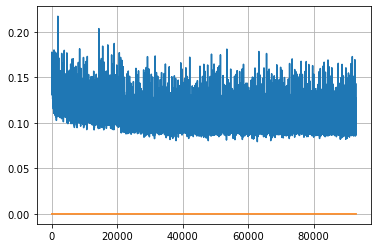

Epoch: 239, iteration 0, loss 0.10069999098777771, cov_diff 0.4279301528625799 cov_diff train 0.42666428982141064
Epoch: 239, iteration 1, loss 0.09878423810005188, cov_diff 0.41522337208817356 cov_diff train 0.41432459673512056
Epoch: 239, iteration 2, loss 0.09790033102035522, cov_diff 0.4185603650522618 cov_diff train 0.4183997015689027
Epoch: 239, iteration 3, loss 0.114418625831604, cov_diff 0.41350616928177875 cov_diff train 0.41200812718411695
Epoch: 239, iteration 4, loss 0.10427132248878479, cov_diff 0.4167415095880175 cov_diff train 0.41644837135238133
Epoch: 239, iteration 5, loss 0.10831069946289062, cov_diff 0.41992915521845187 cov_diff train 0.41930137946703233
Epoch: 239, iteration 6, loss 0.09551376104354858, cov_diff 0.4227559794252788 cov_diff train 0.422433213422678
Epoch: 239, iteration 7, loss 0.09398040175437927, cov_diff 0.4196257936011957 cov_diff train 0.4180554599310027
Epoch: 239, iteration 8, loss 0.10205510258674622, cov_diff 0.4238584558463814 cov_diff tra

Epoch: 239, iteration 82, loss 0.10737001895904541, cov_diff 0.42394281644997545 cov_diff train 0.4223648291092696
Epoch: 239, iteration 83, loss 0.11679583787918091, cov_diff 0.4187405364032268 cov_diff train 0.41742366713233603
Epoch: 239, iteration 84, loss 0.09261935949325562, cov_diff 0.411632593426503 cov_diff train 0.4104096031974415
Epoch: 239, iteration 85, loss 0.10776829719543457, cov_diff 0.41735828563796873 cov_diff train 0.4162074866931048
Epoch: 239, iteration 86, loss 0.10741925239562988, cov_diff 0.4160488043703622 cov_diff train 0.41538976799833965
Epoch: 239, iteration 87, loss 0.12482938170433044, cov_diff 0.4074823892514378 cov_diff train 0.40765421661196605
Epoch: 239, iteration 88, loss 0.10980147123336792, cov_diff 0.4039399383660353 cov_diff train 0.40316691379704445
Epoch: 239, iteration 89, loss 0.11028945446014404, cov_diff 0.42594288173774447 cov_diff train 0.4248628429706553
Epoch: 239, iteration 90, loss 0.09981992840766907, cov_diff 0.40312553518186706 c

Epoch: 239, iteration 158, loss 0.09871438145637512, cov_diff 0.4111570371876494 cov_diff train 0.4099512930564917
Epoch: 239, iteration 159, loss 0.1001228392124176, cov_diff 0.4121226764856241 cov_diff train 0.41158958456700906
Epoch: 239, iteration 160, loss 0.10470202565193176, cov_diff 0.4177981044517053 cov_diff train 0.4162863297593302
Epoch: 239, iteration 161, loss 0.10274794697761536, cov_diff 0.40913650629462134 cov_diff train 0.4081419580146961
Epoch: 239, iteration 162, loss 0.10419434309005737, cov_diff 0.41484371764996353 cov_diff train 0.41358848792676045
Epoch: 239, iteration 163, loss 0.10600024461746216, cov_diff 0.41391696856926535 cov_diff train 0.41338955758858925
Epoch: 239, iteration 164, loss 0.10450908541679382, cov_diff 0.4157822080462802 cov_diff train 0.4141620187697914
Epoch: 239, iteration 165, loss 0.10679799318313599, cov_diff 0.4224174934662939 cov_diff train 0.4208795313021508
Epoch: 239, iteration 166, loss 0.11487340927124023, cov_diff 0.40508799487

Epoch: 239, iteration 233, loss 0.10896432399749756, cov_diff 0.4046210754685874 cov_diff train 0.404214274930774
Epoch: 239, iteration 234, loss 0.10513600707054138, cov_diff 0.4064740582928922 cov_diff train 0.4056040484893628
Epoch: 239, iteration 235, loss 0.1104845404624939, cov_diff 0.41127907866990066 cov_diff train 0.41093670304151153
Epoch: 239, iteration 236, loss 0.09973058104515076, cov_diff 0.41825252674496294 cov_diff train 0.41772158017107847
Epoch: 239, iteration 237, loss 0.0989159643650055, cov_diff 0.4051219280623877 cov_diff train 0.40423048546191714
Epoch: 239, iteration 238, loss 0.10642266273498535, cov_diff 0.4199440425486079 cov_diff train 0.41747455241185605
Epoch: 239, iteration 239, loss 0.10385513305664062, cov_diff 0.41719396669837727 cov_diff train 0.41659319746836426
Epoch: 239, iteration 240, loss 0.10534399747848511, cov_diff 0.41015061016361265 cov_diff train 0.4103250457746307
Epoch: 239, iteration 241, loss 0.10975944995880127, cov_diff 0.4205864459

Epoch: 239, iteration 314, loss 0.09988158941268921, cov_diff 0.4132122305260688 cov_diff train 0.4132176079511794
Epoch: 239, iteration 315, loss 0.11057096719741821, cov_diff 0.41801347735203376 cov_diff train 0.4176237860128616
Epoch: 239, iteration 316, loss 0.09433656930923462, cov_diff 0.40096144602228645 cov_diff train 0.4007571346483236
Epoch: 239, iteration 317, loss 0.1126832664012909, cov_diff 0.41876942475242407 cov_diff train 0.4170021721149132
Epoch: 239, iteration 318, loss 0.10708686709403992, cov_diff 0.4213962732550369 cov_diff train 0.4201887410101896
Epoch: 239, iteration 319, loss 0.10575038194656372, cov_diff 0.4122620137387797 cov_diff train 0.4120203397429169
Epoch: 239, iteration 320, loss 0.09266397356987, cov_diff 0.40852524881667485 cov_diff train 0.4080608289380301
Epoch: 239, iteration 321, loss 0.10470131039619446, cov_diff 0.4047229790638985 cov_diff train 0.40447676182525677
Epoch: 239, iteration 322, loss 0.0985446572303772, cov_diff 0.4091755516213295

Epoch: 239, iteration 390, loss 0.14769142866134644, cov_diff 0.451295149642804 cov_diff train 0.4501263284433227


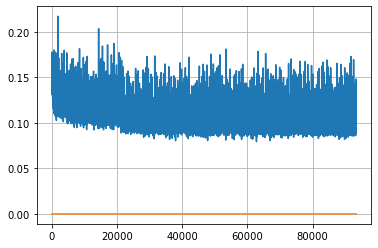

Epoch: 240, iteration 0, loss 0.09829404950141907, cov_diff 0.4081129444884584 cov_diff train 0.4080001469940043
Epoch: 240, iteration 1, loss 0.10589534044265747, cov_diff 0.40665386333174286 cov_diff train 0.40696821544804007
Epoch: 240, iteration 2, loss 0.10019516944885254, cov_diff 0.4012385685806303 cov_diff train 0.40112802592051405
Epoch: 240, iteration 3, loss 0.10438096523284912, cov_diff 0.4134020263829115 cov_diff train 0.4123074770789226
Epoch: 240, iteration 4, loss 0.10314697027206421, cov_diff 0.4063100922311757 cov_diff train 0.40612253978554846
Epoch: 240, iteration 5, loss 0.10805761814117432, cov_diff 0.42731519974985654 cov_diff train 0.4266114329163947
Epoch: 240, iteration 6, loss 0.1005927324295044, cov_diff 0.41588222318963614 cov_diff train 0.4156902735462688
Epoch: 240, iteration 7, loss 0.11571362614631653, cov_diff 0.42043289404605094 cov_diff train 0.42018844879993994
Epoch: 240, iteration 8, loss 0.10255014896392822, cov_diff 0.412209866375912 cov_diff tr

Epoch: 240, iteration 77, loss 0.10514050722122192, cov_diff 0.42738917429750245 cov_diff train 0.42555406804093276
Epoch: 240, iteration 78, loss 0.11711370944976807, cov_diff 0.4095116119296997 cov_diff train 0.40861267797603634
Epoch: 240, iteration 79, loss 0.11566722393035889, cov_diff 0.40715468842946656 cov_diff train 0.4063072276052882
Epoch: 240, iteration 80, loss 0.09893697500228882, cov_diff 0.40408738340883227 cov_diff train 0.4037492838609897
Epoch: 240, iteration 81, loss 0.1041887104511261, cov_diff 0.4222387237223597 cov_diff train 0.4215071025008583
Epoch: 240, iteration 82, loss 0.10371819138526917, cov_diff 0.4009057921079656 cov_diff train 0.4010820554195434
Epoch: 240, iteration 83, loss 0.10140633583068848, cov_diff 0.4199008690804877 cov_diff train 0.419084871059149
Epoch: 240, iteration 84, loss 0.10406848788261414, cov_diff 0.4112091591563003 cov_diff train 0.4111376534686433
Epoch: 240, iteration 85, loss 0.1070874035358429, cov_diff 0.41182761747591295 cov_d

Epoch: 240, iteration 149, loss 0.10049229860305786, cov_diff 0.4060882026342969 cov_diff train 0.4041284203037177
Epoch: 240, iteration 150, loss 0.10015520453453064, cov_diff 0.41749356829301587 cov_diff train 0.4170260983021581
Epoch: 240, iteration 151, loss 0.09986415505409241, cov_diff 0.40588000290270054 cov_diff train 0.4043737724583612
Epoch: 240, iteration 152, loss 0.09366750717163086, cov_diff 0.40860684705485 cov_diff train 0.40736344909687944
Epoch: 240, iteration 153, loss 0.11979243159294128, cov_diff 0.4076393039483218 cov_diff train 0.4064786620168663
Epoch: 240, iteration 154, loss 0.10276734828948975, cov_diff 0.40722889794310685 cov_diff train 0.40633065875893354
Epoch: 240, iteration 155, loss 0.102704256772995, cov_diff 0.41039653386535474 cov_diff train 0.4100100457507956
Epoch: 240, iteration 156, loss 0.10698133707046509, cov_diff 0.4062823646043209 cov_diff train 0.40480940021170336
Epoch: 240, iteration 157, loss 0.10749819874763489, cov_diff 0.4198291448249

Epoch: 240, iteration 223, loss 0.10204973816871643, cov_diff 0.40781552405730986 cov_diff train 0.40764467111551267
Epoch: 240, iteration 224, loss 0.09602883458137512, cov_diff 0.40762903425218316 cov_diff train 0.40694489608149587
Epoch: 240, iteration 225, loss 0.12137123942375183, cov_diff 0.40787726062935964 cov_diff train 0.407097185128834
Epoch: 240, iteration 226, loss 0.10349467396736145, cov_diff 0.39755852300236033 cov_diff train 0.3969059937456939
Epoch: 240, iteration 227, loss 0.1005675196647644, cov_diff 0.4024623876889323 cov_diff train 0.40173736931922527
Epoch: 240, iteration 228, loss 0.10994607210159302, cov_diff 0.40563191569053064 cov_diff train 0.40508917171601566
Epoch: 240, iteration 229, loss 0.09804370999336243, cov_diff 0.4085435716778129 cov_diff train 0.40949023316406474
Epoch: 240, iteration 230, loss 0.10397440195083618, cov_diff 0.42408889304918684 cov_diff train 0.4226733189882033
Epoch: 240, iteration 231, loss 0.10642901062965393, cov_diff 0.4145987

Epoch: 240, iteration 295, loss 0.10618805885314941, cov_diff 0.4002240974240156 cov_diff train 0.3999667494545497
Epoch: 240, iteration 296, loss 0.1172897219657898, cov_diff 0.40986090124541924 cov_diff train 0.4086936592860806
Epoch: 240, iteration 297, loss 0.10642951726913452, cov_diff 0.40839486366066013 cov_diff train 0.4081708182635852
Epoch: 240, iteration 298, loss 0.10007277131080627, cov_diff 0.4108210951795984 cov_diff train 0.4102802434574505
Epoch: 240, iteration 299, loss 0.10695940256118774, cov_diff 0.4079849535167548 cov_diff train 0.4072702456188128
Epoch: 240, iteration 300, loss 0.10209321975708008, cov_diff 0.41159359489571684 cov_diff train 0.411407659675407
Epoch: 240, iteration 301, loss 0.10575500130653381, cov_diff 0.4109774391263607 cov_diff train 0.41076687944912554
Epoch: 240, iteration 302, loss 0.10688444972038269, cov_diff 0.39968211741655746 cov_diff train 0.3991434956046998
Epoch: 240, iteration 303, loss 0.10621854662895203, cov_diff 0.4169992872218

Epoch: 240, iteration 373, loss 0.10589772462844849, cov_diff 0.40953005491089245 cov_diff train 0.4088359897158668
Epoch: 240, iteration 374, loss 0.10469049215316772, cov_diff 0.42512387229136966 cov_diff train 0.42427714771896086
Epoch: 240, iteration 375, loss 0.09772083163261414, cov_diff 0.4163938639901727 cov_diff train 0.41544242062006853
Epoch: 240, iteration 376, loss 0.10009622573852539, cov_diff 0.41068754564057613 cov_diff train 0.409534416260614
Epoch: 240, iteration 377, loss 0.10686260461807251, cov_diff 0.41711232391716047 cov_diff train 0.4157314256352297
Epoch: 240, iteration 378, loss 0.09887206554412842, cov_diff 0.40993833702953303 cov_diff train 0.4087398934231975
Epoch: 240, iteration 379, loss 0.10677430033683777, cov_diff 0.4294298037293474 cov_diff train 0.4281669326332411
Epoch: 240, iteration 380, loss 0.10049194097518921, cov_diff 0.4181428103848718 cov_diff train 0.41709527761170573
Epoch: 240, iteration 381, loss 0.11294841766357422, cov_diff 0.408158954

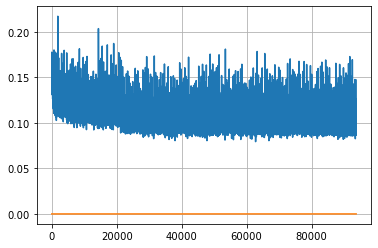

Epoch: 241, iteration 0, loss 0.10485842823982239, cov_diff 0.40753947638261745 cov_diff train 0.40804516184637435
Epoch: 241, iteration 1, loss 0.09727722406387329, cov_diff 0.4154344269326554 cov_diff train 0.414980844616121
Epoch: 241, iteration 2, loss 0.09085321426391602, cov_diff 0.4134565312825347 cov_diff train 0.4128820430335281
Epoch: 241, iteration 3, loss 0.10310149192810059, cov_diff 0.40973187837756725 cov_diff train 0.40906474705718276
Epoch: 241, iteration 4, loss 0.10428574681282043, cov_diff 0.400046985596286 cov_diff train 0.3997895706471528
Epoch: 241, iteration 5, loss 0.1129659116268158, cov_diff 0.4277673961618191 cov_diff train 0.42649646127344665
Epoch: 241, iteration 6, loss 0.09983494877815247, cov_diff 0.408303000842812 cov_diff train 0.40740980116518927
Epoch: 241, iteration 7, loss 0.11582902073860168, cov_diff 0.4257294137866029 cov_diff train 0.42573032877504347
Epoch: 241, iteration 8, loss 0.10790586471557617, cov_diff 0.41958267286362244 cov_diff trai

Epoch: 241, iteration 78, loss 0.09458175301551819, cov_diff 0.41311137060152103 cov_diff train 0.41265514493359207
Epoch: 241, iteration 79, loss 0.10112428665161133, cov_diff 0.4080068619567506 cov_diff train 0.40763301260965495
Epoch: 241, iteration 80, loss 0.10792994499206543, cov_diff 0.4074876153489612 cov_diff train 0.4063149760568019
Epoch: 241, iteration 81, loss 0.09889298677444458, cov_diff 0.41748580836966825 cov_diff train 0.41602199519441463
Epoch: 241, iteration 82, loss 0.10168257355690002, cov_diff 0.40385717656797676 cov_diff train 0.40299248955397327
Epoch: 241, iteration 83, loss 0.11173069477081299, cov_diff 0.4081769009422331 cov_diff train 0.40825772387055437
Epoch: 241, iteration 84, loss 0.10811224579811096, cov_diff 0.4127640123772686 cov_diff train 0.4120785905063005
Epoch: 241, iteration 85, loss 0.10836917161941528, cov_diff 0.4137671881323036 cov_diff train 0.4126534107626213
Epoch: 241, iteration 86, loss 0.09534403681755066, cov_diff 0.4004951666815924 

Epoch: 241, iteration 153, loss 0.10835921764373779, cov_diff 0.40460166237204737 cov_diff train 0.4048096596866135
Epoch: 241, iteration 154, loss 0.09753191471099854, cov_diff 0.4233656836437155 cov_diff train 0.42286472044722356
Epoch: 241, iteration 155, loss 0.09430545568466187, cov_diff 0.41811043537103826 cov_diff train 0.41735635959417494
Epoch: 241, iteration 156, loss 0.10165080428123474, cov_diff 0.4163066037953136 cov_diff train 0.4157762261838492
Epoch: 241, iteration 157, loss 0.10048511624336243, cov_diff 0.42163377705366833 cov_diff train 0.4212253691038806
Epoch: 241, iteration 158, loss 0.10097113251686096, cov_diff 0.4262983669787205 cov_diff train 0.4255359591286671
Epoch: 241, iteration 159, loss 0.10790711641311646, cov_diff 0.41231488367854624 cov_diff train 0.4112521183895054
Epoch: 241, iteration 160, loss 0.10455021262168884, cov_diff 0.4067171381751354 cov_diff train 0.4066249606547763
Epoch: 241, iteration 161, loss 0.1022193431854248, cov_diff 0.41115197226

Epoch: 241, iteration 230, loss 0.10955384373664856, cov_diff 0.42789911500028555 cov_diff train 0.4266075589190064
Epoch: 241, iteration 231, loss 0.09573456645011902, cov_diff 0.40056912805236367 cov_diff train 0.39985972671358033
Epoch: 241, iteration 232, loss 0.10266739130020142, cov_diff 0.40456290215665286 cov_diff train 0.4038569507022874
Epoch: 241, iteration 233, loss 0.10852912068367004, cov_diff 0.4216349078066687 cov_diff train 0.4212281271520351
Epoch: 241, iteration 234, loss 0.10125777125358582, cov_diff 0.419905872427945 cov_diff train 0.4196184625920428
Epoch: 241, iteration 235, loss 0.1017000675201416, cov_diff 0.41476425599419514 cov_diff train 0.4142604536457707
Epoch: 241, iteration 236, loss 0.09800773859024048, cov_diff 0.41051125819531525 cov_diff train 0.4102369334459265
Epoch: 241, iteration 237, loss 0.10656905174255371, cov_diff 0.40377988247425783 cov_diff train 0.4031951823555967
Epoch: 241, iteration 238, loss 0.10163822770118713, cov_diff 0.41540662128

Epoch: 241, iteration 308, loss 0.10156786441802979, cov_diff 0.4158143720228262 cov_diff train 0.4157918343904583
Epoch: 241, iteration 309, loss 0.10692864656448364, cov_diff 0.4072031895532833 cov_diff train 0.4070499752022036
Epoch: 241, iteration 310, loss 0.09934127330780029, cov_diff 0.42006209228635283 cov_diff train 0.4200483101091564
Epoch: 241, iteration 311, loss 0.11489313840866089, cov_diff 0.4146257063528708 cov_diff train 0.4142522639893605
Epoch: 241, iteration 312, loss 0.09943759441375732, cov_diff 0.41607893811942254 cov_diff train 0.4154863664249926
Epoch: 241, iteration 313, loss 0.11098262667655945, cov_diff 0.411975782877484 cov_diff train 0.41140259216778224
Epoch: 241, iteration 314, loss 0.10017713904380798, cov_diff 0.408388047426483 cov_diff train 0.4067953928501019
Epoch: 241, iteration 315, loss 0.11012062430381775, cov_diff 0.4159316793204958 cov_diff train 0.415871435954867
Epoch: 241, iteration 316, loss 0.10774469375610352, cov_diff 0.4017188010713159

Epoch: 241, iteration 389, loss 0.11027693748474121, cov_diff 0.42012319390136954 cov_diff train 0.41914729870243383
Epoch: 241, iteration 390, loss 0.14618781208992004, cov_diff 0.4399407960130822 cov_diff train 0.4374931766990398


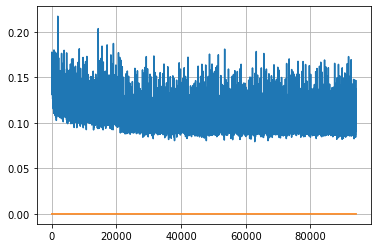

Epoch: 242, iteration 0, loss 0.09136360883712769, cov_diff 0.42049647107528626 cov_diff train 0.4197780386010198
Epoch: 242, iteration 1, loss 0.10952359437942505, cov_diff 0.4032368786648709 cov_diff train 0.4020866071901644
Epoch: 242, iteration 2, loss 0.09609413146972656, cov_diff 0.4134243933785723 cov_diff train 0.4129166557080574
Epoch: 242, iteration 3, loss 0.10623860359191895, cov_diff 0.4191506240694512 cov_diff train 0.41853318080902935
Epoch: 242, iteration 4, loss 0.0932987630367279, cov_diff 0.39990390569622636 cov_diff train 0.3997856574495744
Epoch: 242, iteration 5, loss 0.10450142621994019, cov_diff 0.4134841037567815 cov_diff train 0.4131669994001141
Epoch: 242, iteration 6, loss 0.10452243685722351, cov_diff 0.42945316939406986 cov_diff train 0.4281364830144095
Epoch: 242, iteration 7, loss 0.10201489925384521, cov_diff 0.4148862001432371 cov_diff train 0.41395502330140993
Epoch: 242, iteration 8, loss 0.10250025987625122, cov_diff 0.4104123673825504 cov_diff trai

Epoch: 242, iteration 79, loss 0.09086713194847107, cov_diff 0.4061908420663707 cov_diff train 0.4051918756612038
Epoch: 242, iteration 80, loss 0.10563293099403381, cov_diff 0.4097814081891275 cov_diff train 0.4094307208649704
Epoch: 242, iteration 81, loss 0.10850319266319275, cov_diff 0.4077745139921183 cov_diff train 0.40704845928391586
Epoch: 242, iteration 82, loss 0.10281115770339966, cov_diff 0.4073429825190019 cov_diff train 0.40641666350418043
Epoch: 242, iteration 83, loss 0.10310083627700806, cov_diff 0.4177843992800769 cov_diff train 0.4171828419591042
Epoch: 242, iteration 84, loss 0.09654009342193604, cov_diff 0.415195811062468 cov_diff train 0.4148417300466997
Epoch: 242, iteration 85, loss 0.09678348898887634, cov_diff 0.4017136516561826 cov_diff train 0.40081936406947244
Epoch: 242, iteration 86, loss 0.1057666540145874, cov_diff 0.41125666119730586 cov_diff train 0.41106295811673477
Epoch: 242, iteration 87, loss 0.10296967625617981, cov_diff 0.39888037419788896 cov_

Epoch: 242, iteration 157, loss 0.10619816184043884, cov_diff 0.42141267505223085 cov_diff train 0.420664413988306
Epoch: 242, iteration 158, loss 0.10319960117340088, cov_diff 0.4120989829078015 cov_diff train 0.41138489819967206
Epoch: 242, iteration 159, loss 0.10759630799293518, cov_diff 0.4042733352876887 cov_diff train 0.40345019089063955
Epoch: 242, iteration 160, loss 0.11315172910690308, cov_diff 0.4119021039249329 cov_diff train 0.40978001460596575
Epoch: 242, iteration 161, loss 0.10876765847206116, cov_diff 0.3978385560233377 cov_diff train 0.39775315947212864
Epoch: 242, iteration 162, loss 0.1015646755695343, cov_diff 0.40436434709896735 cov_diff train 0.40365461700152505
Epoch: 242, iteration 163, loss 0.1051386296749115, cov_diff 0.40662225765556 cov_diff train 0.4067054728557347
Epoch: 242, iteration 164, loss 0.11211490631103516, cov_diff 0.4148080613804603 cov_diff train 0.4145464952451854
Epoch: 242, iteration 165, loss 0.09432235360145569, cov_diff 0.42416018274448

Epoch: 242, iteration 237, loss 0.09681522846221924, cov_diff 0.41108196063558206 cov_diff train 0.4105962146594018
Epoch: 242, iteration 238, loss 0.10339924693107605, cov_diff 0.41946612616520257 cov_diff train 0.4189210138265959
Epoch: 242, iteration 239, loss 0.1040126383304596, cov_diff 0.40539002056677104 cov_diff train 0.40458166954971575
Epoch: 242, iteration 240, loss 0.10633474588394165, cov_diff 0.39967610408836696 cov_diff train 0.39886913075014735
Epoch: 242, iteration 241, loss 0.1082906424999237, cov_diff 0.4105627275180909 cov_diff train 0.4096436627289951
Epoch: 242, iteration 242, loss 0.09366881847381592, cov_diff 0.41877461231404006 cov_diff train 0.4176354113913788
Epoch: 242, iteration 243, loss 0.10235670208930969, cov_diff 0.4059071675137231 cov_diff train 0.4050055828637824
Epoch: 242, iteration 244, loss 0.10566890239715576, cov_diff 0.4074911692460961 cov_diff train 0.4076733080865063
Epoch: 242, iteration 245, loss 0.11044687032699585, cov_diff 0.42078783985

Epoch: 242, iteration 314, loss 0.0960664451122284, cov_diff 0.41571685076887993 cov_diff train 0.41557587393006234
Epoch: 242, iteration 315, loss 0.11156696081161499, cov_diff 0.4171980989282512 cov_diff train 0.41694591455127755
Epoch: 242, iteration 316, loss 0.10341113805770874, cov_diff 0.4151355755046916 cov_diff train 0.415121056822873
Epoch: 242, iteration 317, loss 0.09245210886001587, cov_diff 0.40808927547544616 cov_diff train 0.40741850086858966
Epoch: 242, iteration 318, loss 0.0952649712562561, cov_diff 0.4217636285228534 cov_diff train 0.4205925403159195
Epoch: 242, iteration 319, loss 0.11547812819480896, cov_diff 0.40988463704219175 cov_diff train 0.40998337000321017
Epoch: 242, iteration 320, loss 0.10358497500419617, cov_diff 0.4096214982645256 cov_diff train 0.4090707203795696
Epoch: 242, iteration 321, loss 0.11060559749603271, cov_diff 0.40739243394731267 cov_diff train 0.406999362517522
Epoch: 242, iteration 322, loss 0.09154251217842102, cov_diff 0.415281410307

Epoch: 242, iteration 387, loss 0.0963987410068512, cov_diff 0.40938391294820825 cov_diff train 0.4092469660902193
Epoch: 242, iteration 388, loss 0.0972861647605896, cov_diff 0.40091338337001126 cov_diff train 0.401444165589726
Epoch: 242, iteration 389, loss 0.1064409613609314, cov_diff 0.41165058788442255 cov_diff train 0.41084616979566774
Epoch: 242, iteration 390, loss 0.13732779026031494, cov_diff 0.45779491328017946 cov_diff train 0.4581972341398647


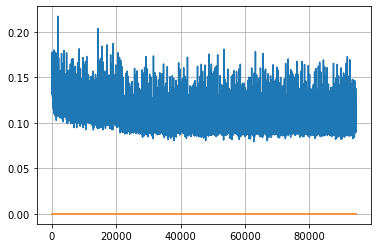

Epoch: 243, iteration 0, loss 0.12377247214317322, cov_diff 0.41449743403250855 cov_diff train 0.4135565801481712
Epoch: 243, iteration 1, loss 0.1068946123123169, cov_diff 0.4067590977628303 cov_diff train 0.4060903665778737
Epoch: 243, iteration 2, loss 0.10061562061309814, cov_diff 0.4086318149499339 cov_diff train 0.40807262578669745
Epoch: 243, iteration 3, loss 0.12220433354377747, cov_diff 0.4162250092365708 cov_diff train 0.41483529048581086
Epoch: 243, iteration 4, loss 0.10157328844070435, cov_diff 0.4210677755993077 cov_diff train 0.41945701028985843
Epoch: 243, iteration 5, loss 0.10494574904441833, cov_diff 0.4046120555603307 cov_diff train 0.4040246348291432
Epoch: 243, iteration 6, loss 0.10136529803276062, cov_diff 0.40559628704067935 cov_diff train 0.405183516671267
Epoch: 243, iteration 7, loss 0.10092607140541077, cov_diff 0.39891934191685174 cov_diff train 0.39903410760345753
Epoch: 243, iteration 8, loss 0.11260241270065308, cov_diff 0.416052458568587 cov_diff trai

Epoch: 243, iteration 76, loss 0.10448300838470459, cov_diff 0.4135987357577873 cov_diff train 0.41337274542514924
Epoch: 243, iteration 77, loss 0.10526874661445618, cov_diff 0.40359133902541083 cov_diff train 0.4037174261425337
Epoch: 243, iteration 78, loss 0.09943363070487976, cov_diff 0.4110010951855061 cov_diff train 0.4104732549917136
Epoch: 243, iteration 79, loss 0.10664781928062439, cov_diff 0.4004802289488575 cov_diff train 0.3997561466898633
Epoch: 243, iteration 80, loss 0.09711718559265137, cov_diff 0.4066348058998479 cov_diff train 0.40707384361160964
Epoch: 243, iteration 81, loss 0.0969952940940857, cov_diff 0.40707787190176836 cov_diff train 0.4064547917692532
Epoch: 243, iteration 82, loss 0.10241559147834778, cov_diff 0.4031471977692583 cov_diff train 0.4021003669169049
Epoch: 243, iteration 83, loss 0.10028767585754395, cov_diff 0.4061639723191199 cov_diff train 0.4065236351200502
Epoch: 243, iteration 84, loss 0.1088891327381134, cov_diff 0.4101946466659933 cov_di

Epoch: 243, iteration 150, loss 0.08875709772109985, cov_diff 0.4209610864955862 cov_diff train 0.4211159111984456
Epoch: 243, iteration 151, loss 0.12147152423858643, cov_diff 0.4102082493461731 cov_diff train 0.4099766939258699
Epoch: 243, iteration 152, loss 0.1130358874797821, cov_diff 0.40674602586793246 cov_diff train 0.40603671288198173
Epoch: 243, iteration 153, loss 0.10026603937149048, cov_diff 0.40771054431147113 cov_diff train 0.4078954564908509
Epoch: 243, iteration 154, loss 0.10991546511650085, cov_diff 0.4114936199613102 cov_diff train 0.4111663708005382
Epoch: 243, iteration 155, loss 0.09879511594772339, cov_diff 0.407528377505006 cov_diff train 0.4071222918873208
Epoch: 243, iteration 156, loss 0.1011505126953125, cov_diff 0.4085728119728932 cov_diff train 0.4080652255336942
Epoch: 243, iteration 157, loss 0.10791093111038208, cov_diff 0.42369318852975163 cov_diff train 0.4231998805373581
Epoch: 243, iteration 158, loss 0.11387932300567627, cov_diff 0.412459509078588

Epoch: 243, iteration 223, loss 0.10912713408470154, cov_diff 0.41873179212825673 cov_diff train 0.41740252436615716
Epoch: 243, iteration 224, loss 0.10829436779022217, cov_diff 0.4136416671292615 cov_diff train 0.41228585420883207
Epoch: 243, iteration 225, loss 0.1089964210987091, cov_diff 0.39635061752545064 cov_diff train 0.39653469149675785
Epoch: 243, iteration 226, loss 0.10342773795127869, cov_diff 0.424706327843747 cov_diff train 0.4237361223744943
Epoch: 243, iteration 227, loss 0.10779696702957153, cov_diff 0.39627647214853806 cov_diff train 0.39564594526409225
Epoch: 243, iteration 228, loss 0.10353735089302063, cov_diff 0.41815260725477343 cov_diff train 0.41819577390728213
Epoch: 243, iteration 229, loss 0.11494782567024231, cov_diff 0.41197277232408924 cov_diff train 0.41197941152665546
Epoch: 243, iteration 230, loss 0.10060715675354004, cov_diff 0.40052057352728987 cov_diff train 0.39993447720153613
Epoch: 243, iteration 231, loss 0.09975838661193848, cov_diff 0.40102

Epoch: 243, iteration 294, loss 0.10594984889030457, cov_diff 0.4168702194596303 cov_diff train 0.4156630343014899
Epoch: 243, iteration 295, loss 0.09910783171653748, cov_diff 0.4174915801443672 cov_diff train 0.4160796540435884
Epoch: 243, iteration 296, loss 0.10058006644248962, cov_diff 0.3948310233023911 cov_diff train 0.3950174851750632
Epoch: 243, iteration 297, loss 0.10158213973045349, cov_diff 0.40362222443012796 cov_diff train 0.4031874491006606
Epoch: 243, iteration 298, loss 0.11700710654258728, cov_diff 0.4111714438470552 cov_diff train 0.4094945981024141
Epoch: 243, iteration 299, loss 0.11125373840332031, cov_diff 0.4161026993363583 cov_diff train 0.4144540010952965
Epoch: 243, iteration 300, loss 0.101281076669693, cov_diff 0.39356141618080687 cov_diff train 0.3923523657319066
Epoch: 243, iteration 301, loss 0.1124843955039978, cov_diff 0.4166312495743581 cov_diff train 0.4156711092208585
Epoch: 243, iteration 302, loss 0.10499370098114014, cov_diff 0.41341864197912015

Epoch: 243, iteration 371, loss 0.11101561784744263, cov_diff 0.4115536987834159 cov_diff train 0.4110586740594589
Epoch: 243, iteration 372, loss 0.11243689060211182, cov_diff 0.4185072177057616 cov_diff train 0.41815391255319206
Epoch: 243, iteration 373, loss 0.10323178768157959, cov_diff 0.41352771736824534 cov_diff train 0.41251850024291387
Epoch: 243, iteration 374, loss 0.10966020822525024, cov_diff 0.41539541483676745 cov_diff train 0.41456989539428024
Epoch: 243, iteration 375, loss 0.10174918174743652, cov_diff 0.40258992214438494 cov_diff train 0.40209647261510656
Epoch: 243, iteration 376, loss 0.10818177461624146, cov_diff 0.4132979214831186 cov_diff train 0.41311285278591464
Epoch: 243, iteration 377, loss 0.08748224377632141, cov_diff 0.4215266797013266 cov_diff train 0.4201490188165116
Epoch: 243, iteration 378, loss 0.10379838943481445, cov_diff 0.4113647963857578 cov_diff train 0.41077451652814106
Epoch: 243, iteration 379, loss 0.09626132249832153, cov_diff 0.4007161

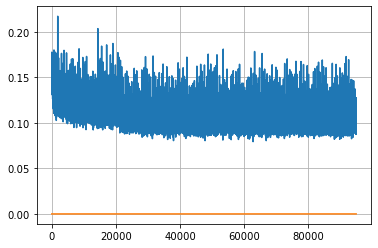

Epoch: 244, iteration 0, loss 0.08888748288154602, cov_diff 0.42275271779863666 cov_diff train 0.4229657430449429
Epoch: 244, iteration 1, loss 0.0979200005531311, cov_diff 0.420973797509296 cov_diff train 0.4204931219504426
Epoch: 244, iteration 2, loss 0.0959596335887909, cov_diff 0.4097711088355237 cov_diff train 0.40930404982245744
Epoch: 244, iteration 3, loss 0.10620763897895813, cov_diff 0.41905335381787245 cov_diff train 0.4176550628292068
Epoch: 244, iteration 4, loss 0.10136771202087402, cov_diff 0.4090565237939846 cov_diff train 0.40840147616276123
Epoch: 244, iteration 5, loss 0.09816789627075195, cov_diff 0.4092519777641029 cov_diff train 0.4091045431063686
Epoch: 244, iteration 6, loss 0.10401135683059692, cov_diff 0.42614191725396877 cov_diff train 0.4257638632895096
Epoch: 244, iteration 7, loss 0.09713783860206604, cov_diff 0.41617821332756993 cov_diff train 0.41531322531781373
Epoch: 244, iteration 8, loss 0.09400740265846252, cov_diff 0.42616481420335356 cov_diff tra

Epoch: 244, iteration 77, loss 0.09818187355995178, cov_diff 0.40923738566094053 cov_diff train 0.4095225682872268
Epoch: 244, iteration 78, loss 0.09989699721336365, cov_diff 0.4144299893917767 cov_diff train 0.4147960652859198
Epoch: 244, iteration 79, loss 0.0994189977645874, cov_diff 0.39722599467110203 cov_diff train 0.3963893232715169
Epoch: 244, iteration 80, loss 0.09949097037315369, cov_diff 0.40675545693553716 cov_diff train 0.40625507159631885
Epoch: 244, iteration 81, loss 0.09860193729400635, cov_diff 0.41577217899653496 cov_diff train 0.41541011507059017
Epoch: 244, iteration 82, loss 0.10041925311088562, cov_diff 0.407885397248476 cov_diff train 0.40729759736984444
Epoch: 244, iteration 83, loss 0.09031063318252563, cov_diff 0.4060598667225746 cov_diff train 0.40618906734972365
Epoch: 244, iteration 84, loss 0.10088729858398438, cov_diff 0.417915441020626 cov_diff train 0.4180592205722861
Epoch: 244, iteration 85, loss 0.1114494800567627, cov_diff 0.4172360042167642 cov_

Epoch: 244, iteration 155, loss 0.10026437044143677, cov_diff 0.3984781533057783 cov_diff train 0.3976741414168674
Epoch: 244, iteration 156, loss 0.09625345468521118, cov_diff 0.40218001509133067 cov_diff train 0.40164137577589865
Epoch: 244, iteration 157, loss 0.11456701159477234, cov_diff 0.40145177701017487 cov_diff train 0.4013440041240312
Epoch: 244, iteration 158, loss 0.1051134467124939, cov_diff 0.4112699251714774 cov_diff train 0.41107061588418436
Epoch: 244, iteration 159, loss 0.09394410252571106, cov_diff 0.4210736192266268 cov_diff train 0.41996857974504126
Epoch: 244, iteration 160, loss 0.1019355058670044, cov_diff 0.41052003643233315 cov_diff train 0.41018623256220754
Epoch: 244, iteration 161, loss 0.10718590021133423, cov_diff 0.4075767029412728 cov_diff train 0.4068288814878634
Epoch: 244, iteration 162, loss 0.10462996363639832, cov_diff 0.41104306456889134 cov_diff train 0.41084496041888624
Epoch: 244, iteration 163, loss 0.10199475288391113, cov_diff 0.396401838

Epoch: 244, iteration 235, loss 0.11020901799201965, cov_diff 0.4072203756899546 cov_diff train 0.40746168867680205
Epoch: 244, iteration 236, loss 0.10510030388832092, cov_diff 0.4182363365677736 cov_diff train 0.4172690747596624
Epoch: 244, iteration 237, loss 0.09966793656349182, cov_diff 0.4148395424411122 cov_diff train 0.4150865984744894
Epoch: 244, iteration 238, loss 0.10082915425300598, cov_diff 0.4180083490013931 cov_diff train 0.41690344658172995
Epoch: 244, iteration 239, loss 0.10500451922416687, cov_diff 0.41563466833251617 cov_diff train 0.415251774380488
Epoch: 244, iteration 240, loss 0.09321266412734985, cov_diff 0.41596420493414143 cov_diff train 0.4140231912359531
Epoch: 244, iteration 241, loss 0.11312264204025269, cov_diff 0.40610786801888 cov_diff train 0.4053280666653125
Epoch: 244, iteration 242, loss 0.11184784770011902, cov_diff 0.41385312522235296 cov_diff train 0.4128028224526749
Epoch: 244, iteration 243, loss 0.09630551934242249, cov_diff 0.42881291883847

Epoch: 244, iteration 310, loss 0.10413607954978943, cov_diff 0.40428143425168583 cov_diff train 0.4035112464442913
Epoch: 244, iteration 311, loss 0.1015806794166565, cov_diff 0.4126101423685661 cov_diff train 0.4127136132657428
Epoch: 244, iteration 312, loss 0.09071961045265198, cov_diff 0.40315969077874936 cov_diff train 0.4023937087693487
Epoch: 244, iteration 313, loss 0.11077550053596497, cov_diff 0.4161315813066161 cov_diff train 0.4156200089264472
Epoch: 244, iteration 314, loss 0.10150346159934998, cov_diff 0.4175247136016027 cov_diff train 0.4167313761276952
Epoch: 244, iteration 315, loss 0.09748831391334534, cov_diff 0.40869702540093944 cov_diff train 0.40740676161849315
Epoch: 244, iteration 316, loss 0.10087111592292786, cov_diff 0.40793487705327813 cov_diff train 0.407357155461863
Epoch: 244, iteration 317, loss 0.10499939322471619, cov_diff 0.416303495223146 cov_diff train 0.41489874475240357
Epoch: 244, iteration 318, loss 0.10908323526382446, cov_diff 0.4195638080567

Epoch: 244, iteration 386, loss 0.11093518137931824, cov_diff 0.4163567297212436 cov_diff train 0.4149072583622484
Epoch: 244, iteration 387, loss 0.10668140649795532, cov_diff 0.4157015466559276 cov_diff train 0.41559000148662145
Epoch: 244, iteration 388, loss 0.09409472346305847, cov_diff 0.39495398326034536 cov_diff train 0.3949085448017696
Epoch: 244, iteration 389, loss 0.09700030088424683, cov_diff 0.4061342529139884 cov_diff train 0.40578594763525466
Epoch: 244, iteration 390, loss 0.1552824079990387, cov_diff 0.4440890669146706 cov_diff train 0.44380306228049765


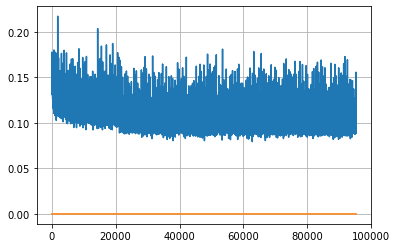

Epoch: 245, iteration 0, loss 0.09454527497291565, cov_diff 0.41927841930357296 cov_diff train 0.41888819819361656
Epoch: 245, iteration 1, loss 0.11517828702926636, cov_diff 0.4325554698771326 cov_diff train 0.4321898878166156
Epoch: 245, iteration 2, loss 0.09019535779953003, cov_diff 0.41857843641278836 cov_diff train 0.41784975133863794
Epoch: 245, iteration 3, loss 0.10394015908241272, cov_diff 0.40804224925527166 cov_diff train 0.40724415130420166
Epoch: 245, iteration 4, loss 0.10994091629981995, cov_diff 0.40922055607386537 cov_diff train 0.4090068739768793
Epoch: 245, iteration 5, loss 0.09713232517242432, cov_diff 0.40752655287750444 cov_diff train 0.40746703167889053
Epoch: 245, iteration 6, loss 0.09182670712471008, cov_diff 0.42068636443458 cov_diff train 0.4202496828703473
Epoch: 245, iteration 7, loss 0.10274016857147217, cov_diff 0.41325478922587694 cov_diff train 0.41275854242950544
Epoch: 245, iteration 8, loss 0.1078190803527832, cov_diff 0.4178297479229871 cov_diff 

Epoch: 245, iteration 78, loss 0.10472273826599121, cov_diff 0.4186720272741893 cov_diff train 0.4177213262660414
Epoch: 245, iteration 79, loss 0.09668901562690735, cov_diff 0.42451759217150153 cov_diff train 0.42315332741266326
Epoch: 245, iteration 80, loss 0.09892714023590088, cov_diff 0.41913455649868964 cov_diff train 0.41929996674753767
Epoch: 245, iteration 81, loss 0.11468607187271118, cov_diff 0.4251965011817282 cov_diff train 0.42419183069524197
Epoch: 245, iteration 82, loss 0.10640144348144531, cov_diff 0.4271227055818302 cov_diff train 0.42636399745319387
Epoch: 245, iteration 83, loss 0.10231167078018188, cov_diff 0.42144277664804 cov_diff train 0.4203923285727536
Epoch: 245, iteration 84, loss 0.09407159686088562, cov_diff 0.4239927004122119 cov_diff train 0.4233566748698054
Epoch: 245, iteration 85, loss 0.10194018483161926, cov_diff 0.41366762293210013 cov_diff train 0.4130230082909511
Epoch: 245, iteration 86, loss 0.09447887539863586, cov_diff 0.4176146642081948 cov

Epoch: 245, iteration 154, loss 0.10360810160636902, cov_diff 0.41285287110184665 cov_diff train 0.4123248779940372
Epoch: 245, iteration 155, loss 0.09914278984069824, cov_diff 0.4192330081708434 cov_diff train 0.41837974994835325
Epoch: 245, iteration 156, loss 0.0930505096912384, cov_diff 0.412073730351905 cov_diff train 0.412060434096795
Epoch: 245, iteration 157, loss 0.09235811233520508, cov_diff 0.4245890418250849 cov_diff train 0.4236047190576092
Epoch: 245, iteration 158, loss 0.10212352871894836, cov_diff 0.4095452015590007 cov_diff train 0.4085715940548368
Epoch: 245, iteration 159, loss 0.11584141850471497, cov_diff 0.40980488195796994 cov_diff train 0.40928272811660943
Epoch: 245, iteration 160, loss 0.11239713430404663, cov_diff 0.41104445826485786 cov_diff train 0.41065024566044434
Epoch: 245, iteration 161, loss 0.10714197158813477, cov_diff 0.4024646545156434 cov_diff train 0.4020553267734768
Epoch: 245, iteration 162, loss 0.11162576079368591, cov_diff 0.4106927158443

Epoch: 245, iteration 225, loss 0.10148081183433533, cov_diff 0.41499970305216016 cov_diff train 0.41497689497733575
Epoch: 245, iteration 226, loss 0.10815590620040894, cov_diff 0.42487043884166503 cov_diff train 0.42411004693125426
Epoch: 245, iteration 227, loss 0.10224047303199768, cov_diff 0.4101510622497918 cov_diff train 0.40964196711510525
Epoch: 245, iteration 228, loss 0.09499019384384155, cov_diff 0.41647462523834644 cov_diff train 0.4154430616623074
Epoch: 245, iteration 229, loss 0.11860674619674683, cov_diff 0.4179943009218105 cov_diff train 0.416429782015199
Epoch: 245, iteration 230, loss 0.10154080390930176, cov_diff 0.4207468035129911 cov_diff train 0.4200114456946778
Epoch: 245, iteration 231, loss 0.10756117105484009, cov_diff 0.3999936368129986 cov_diff train 0.3995551054584714
Epoch: 245, iteration 232, loss 0.10361725091934204, cov_diff 0.4136350935013599 cov_diff train 0.41276006922913333
Epoch: 245, iteration 233, loss 0.10191914439201355, cov_diff 0.4122496560

Epoch: 245, iteration 304, loss 0.0942232608795166, cov_diff 0.42256551138403037 cov_diff train 0.4223373080069967
Epoch: 245, iteration 305, loss 0.09450843930244446, cov_diff 0.40892915741919833 cov_diff train 0.40883927479241877
Epoch: 245, iteration 306, loss 0.09230461716651917, cov_diff 0.4047944230249546 cov_diff train 0.40381627371934853
Epoch: 245, iteration 307, loss 0.09451329708099365, cov_diff 0.40923449051239935 cov_diff train 0.4087898387277146
Epoch: 245, iteration 308, loss 0.12140953540802002, cov_diff 0.4062097033152088 cov_diff train 0.40689065454715206
Epoch: 245, iteration 309, loss 0.10534510016441345, cov_diff 0.43009223063235325 cov_diff train 0.43014990901552824
Epoch: 245, iteration 310, loss 0.10862603783607483, cov_diff 0.4150100519841769 cov_diff train 0.41395075421520894
Epoch: 245, iteration 311, loss 0.11175680160522461, cov_diff 0.4200656211266084 cov_diff train 0.41954088632682585
Epoch: 245, iteration 312, loss 0.10736522078514099, cov_diff 0.4273900

Epoch: 245, iteration 380, loss 0.09880080819129944, cov_diff 0.4131591932500471 cov_diff train 0.41184657942592307
Epoch: 245, iteration 381, loss 0.1026945412158966, cov_diff 0.4109239772262493 cov_diff train 0.410411710879293
Epoch: 245, iteration 382, loss 0.10508513450622559, cov_diff 0.4222162017324609 cov_diff train 0.4216478099522345
Epoch: 245, iteration 383, loss 0.10411915183067322, cov_diff 0.41450531458736123 cov_diff train 0.4144133940007361
Epoch: 245, iteration 384, loss 0.10172608494758606, cov_diff 0.4059950363875854 cov_diff train 0.4047253659901979
Epoch: 245, iteration 385, loss 0.10359302163124084, cov_diff 0.4215604991603784 cov_diff train 0.4216736134845881
Epoch: 245, iteration 386, loss 0.10612133145332336, cov_diff 0.41226965784719777 cov_diff train 0.4118359740121624
Epoch: 245, iteration 387, loss 0.10207077860832214, cov_diff 0.4202374055752061 cov_diff train 0.4199721035584442
Epoch: 245, iteration 388, loss 0.1005619466304779, cov_diff 0.4139752707164482

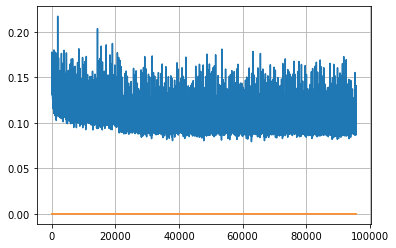

Epoch: 246, iteration 0, loss 0.0943114161491394, cov_diff 0.42089925120972044 cov_diff train 0.4212600216028978
Epoch: 246, iteration 1, loss 0.09989696741104126, cov_diff 0.4169103675057812 cov_diff train 0.4162810911447775
Epoch: 246, iteration 2, loss 0.09803622961044312, cov_diff 0.40138041802190255 cov_diff train 0.4010921647155173
Epoch: 246, iteration 3, loss 0.12129008769989014, cov_diff 0.4124303784194676 cov_diff train 0.4120309240155515
Epoch: 246, iteration 4, loss 0.11830946803092957, cov_diff 0.41994824642952844 cov_diff train 0.42026691086866974
Epoch: 246, iteration 5, loss 0.11045557260513306, cov_diff 0.4001300157383624 cov_diff train 0.40010198198307495
Epoch: 246, iteration 6, loss 0.09447416663169861, cov_diff 0.4180203308776544 cov_diff train 0.4177210923724448
Epoch: 246, iteration 7, loss 0.09705027937889099, cov_diff 0.41232865807657415 cov_diff train 0.41114068179424657
Epoch: 246, iteration 8, loss 0.10463878512382507, cov_diff 0.4230400942327108 cov_diff tr

Epoch: 246, iteration 77, loss 0.1066519021987915, cov_diff 0.41303211741278517 cov_diff train 0.41260968598576625
Epoch: 246, iteration 78, loss 0.10500013828277588, cov_diff 0.4081058400521108 cov_diff train 0.4080996417843541
Epoch: 246, iteration 79, loss 0.09815239906311035, cov_diff 0.4062080119139715 cov_diff train 0.40534092258349214
Epoch: 246, iteration 80, loss 0.103974848985672, cov_diff 0.41606223160732264 cov_diff train 0.41553035685456446
Epoch: 246, iteration 81, loss 0.10706576704978943, cov_diff 0.4122503318768408 cov_diff train 0.4113660424609622
Epoch: 246, iteration 82, loss 0.09385451674461365, cov_diff 0.4134789475993408 cov_diff train 0.4129057635581121
Epoch: 246, iteration 83, loss 0.09969300031661987, cov_diff 0.41643745214379035 cov_diff train 0.4160502006977052
Epoch: 246, iteration 84, loss 0.11511871218681335, cov_diff 0.4208789206511134 cov_diff train 0.42017491820512237
Epoch: 246, iteration 85, loss 0.11725181341171265, cov_diff 0.4154945389141226 cov_

Epoch: 246, iteration 149, loss 0.09862810373306274, cov_diff 0.4182251317331287 cov_diff train 0.4180286082050237
Epoch: 246, iteration 150, loss 0.10299313068389893, cov_diff 0.4126918165717188 cov_diff train 0.41198484737426716
Epoch: 246, iteration 151, loss 0.09379565715789795, cov_diff 0.4160478176539439 cov_diff train 0.4153787162200903
Epoch: 246, iteration 152, loss 0.10178267955780029, cov_diff 0.4107013819205906 cov_diff train 0.4110999902790338
Epoch: 246, iteration 153, loss 0.10690945386886597, cov_diff 0.40820351765158486 cov_diff train 0.4077507592128544
Epoch: 246, iteration 154, loss 0.10940849781036377, cov_diff 0.41794199912904917 cov_diff train 0.41824686419439355
Epoch: 246, iteration 155, loss 0.09923672676086426, cov_diff 0.40742300055224345 cov_diff train 0.40750198132119064
Epoch: 246, iteration 156, loss 0.09325000643730164, cov_diff 0.4160332402237909 cov_diff train 0.41644594552782316
Epoch: 246, iteration 157, loss 0.09712338447570801, cov_diff 0.410800770

Epoch: 246, iteration 224, loss 0.10022839903831482, cov_diff 0.4110866890107002 cov_diff train 0.4108811638686397
Epoch: 246, iteration 225, loss 0.10980841517448425, cov_diff 0.40398531088297374 cov_diff train 0.4035356210792153
Epoch: 246, iteration 226, loss 0.10295796394348145, cov_diff 0.41562292660652594 cov_diff train 0.41539195925377254
Epoch: 246, iteration 227, loss 0.10021239519119263, cov_diff 0.40802131767068656 cov_diff train 0.4058107807811776
Epoch: 246, iteration 228, loss 0.10835140943527222, cov_diff 0.42189553858828505 cov_diff train 0.42148771954917336
Epoch: 246, iteration 229, loss 0.09452405571937561, cov_diff 0.41800820890036594 cov_diff train 0.41751245654041874
Epoch: 246, iteration 230, loss 0.09807547926902771, cov_diff 0.41338297069118957 cov_diff train 0.41284440578393183
Epoch: 246, iteration 231, loss 0.09959661960601807, cov_diff 0.40315265873904527 cov_diff train 0.4023103561069793
Epoch: 246, iteration 232, loss 0.11630523204803467, cov_diff 0.42460

Epoch: 246, iteration 301, loss 0.09605178236961365, cov_diff 0.4184474592068216 cov_diff train 0.41751065543609184
Epoch: 246, iteration 302, loss 0.11351114511489868, cov_diff 0.4228731413066808 cov_diff train 0.422143822356315
Epoch: 246, iteration 303, loss 0.09348791837692261, cov_diff 0.4059517719824615 cov_diff train 0.40499759734718516
Epoch: 246, iteration 304, loss 0.10217875242233276, cov_diff 0.40576702201843917 cov_diff train 0.404730343242265
Epoch: 246, iteration 305, loss 0.11336097121238708, cov_diff 0.4088999968833012 cov_diff train 0.4091217416307193
Epoch: 246, iteration 306, loss 0.11159205436706543, cov_diff 0.4164268577717023 cov_diff train 0.4147022937592607
Epoch: 246, iteration 307, loss 0.10017135739326477, cov_diff 0.41512264412187644 cov_diff train 0.41470511242118374
Epoch: 246, iteration 308, loss 0.09686717391014099, cov_diff 0.412059641103071 cov_diff train 0.4115897343431246
Epoch: 246, iteration 309, loss 0.11171755194664001, cov_diff 0.42547643237603

Epoch: 246, iteration 374, loss 0.09227228164672852, cov_diff 0.4200232191992038 cov_diff train 0.4198177114920123
Epoch: 246, iteration 375, loss 0.09966287016868591, cov_diff 0.3946436428834913 cov_diff train 0.3944027131880247
Epoch: 246, iteration 376, loss 0.10523802042007446, cov_diff 0.4138547699926311 cov_diff train 0.41368002834680767
Epoch: 246, iteration 377, loss 0.09772175550460815, cov_diff 0.40338080645376106 cov_diff train 0.4026801856695753
Epoch: 246, iteration 378, loss 0.08808478713035583, cov_diff 0.40694919206921665 cov_diff train 0.4068097375967381
Epoch: 246, iteration 379, loss 0.09822961688041687, cov_diff 0.40442697586522736 cov_diff train 0.40474597976727666
Epoch: 246, iteration 380, loss 0.110513836145401, cov_diff 0.425544587510845 cov_diff train 0.42416325208280725
Epoch: 246, iteration 381, loss 0.10211169719696045, cov_diff 0.40517817975885123 cov_diff train 0.40477735955351324
Epoch: 246, iteration 382, loss 0.10054296255111694, cov_diff 0.41510495090

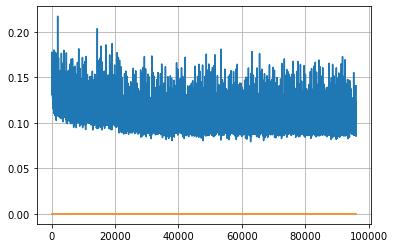

Epoch: 247, iteration 0, loss 0.09464046359062195, cov_diff 0.40158261153309077 cov_diff train 0.4013658945145499
Epoch: 247, iteration 1, loss 0.09418424963951111, cov_diff 0.40763593455187996 cov_diff train 0.4070745480575739
Epoch: 247, iteration 2, loss 0.09506723284721375, cov_diff 0.4080584844811183 cov_diff train 0.40748180377154825
Epoch: 247, iteration 3, loss 0.10245361924171448, cov_diff 0.4200271866786755 cov_diff train 0.4193119314323292
Epoch: 247, iteration 4, loss 0.10590043663978577, cov_diff 0.40942154686025717 cov_diff train 0.4082516688639648
Epoch: 247, iteration 5, loss 0.0990879237651825, cov_diff 0.4070672350978338 cov_diff train 0.4064727077897751
Epoch: 247, iteration 6, loss 0.0981021523475647, cov_diff 0.40266091595885406 cov_diff train 0.40229416923466
Epoch: 247, iteration 7, loss 0.09392163157463074, cov_diff 0.39911541033508824 cov_diff train 0.39854522111019897
Epoch: 247, iteration 8, loss 0.10527408123016357, cov_diff 0.4183926119915139 cov_diff train

Epoch: 247, iteration 72, loss 0.09933361411094666, cov_diff 0.40929284237899455 cov_diff train 0.40949794455397664
Epoch: 247, iteration 73, loss 0.10598292946815491, cov_diff 0.402731355887608 cov_diff train 0.40315197804779296
Epoch: 247, iteration 74, loss 0.10396915674209595, cov_diff 0.4029580810454603 cov_diff train 0.40273527680226395
Epoch: 247, iteration 75, loss 0.10825979709625244, cov_diff 0.41387241568316885 cov_diff train 0.41351760709659213
Epoch: 247, iteration 76, loss 0.11427348852157593, cov_diff 0.4079927918332915 cov_diff train 0.40865675629826725
Epoch: 247, iteration 77, loss 0.0895494818687439, cov_diff 0.4105089340029494 cov_diff train 0.41062039449029436
Epoch: 247, iteration 78, loss 0.10130336880683899, cov_diff 0.40971951678349794 cov_diff train 0.4092004316232969
Epoch: 247, iteration 79, loss 0.10662764310836792, cov_diff 0.40516714079142163 cov_diff train 0.4053449110977027
Epoch: 247, iteration 80, loss 0.10471874475479126, cov_diff 0.417054480345571 c

Epoch: 247, iteration 147, loss 0.10646435618400574, cov_diff 0.40478282886520084 cov_diff train 0.40445232774118917
Epoch: 247, iteration 148, loss 0.10700035095214844, cov_diff 0.408804640364007 cov_diff train 0.4079629991783791
Epoch: 247, iteration 149, loss 0.09187069535255432, cov_diff 0.4056650133920459 cov_diff train 0.4042718739336199
Epoch: 247, iteration 150, loss 0.105736643075943, cov_diff 0.4039561814529223 cov_diff train 0.40407286848349966
Epoch: 247, iteration 151, loss 0.10217750072479248, cov_diff 0.414225844033113 cov_diff train 0.41353612326491357
Epoch: 247, iteration 152, loss 0.10983783006668091, cov_diff 0.4026999050689775 cov_diff train 0.40281592392394605
Epoch: 247, iteration 153, loss 0.09761175513267517, cov_diff 0.4132224442737694 cov_diff train 0.41262415011854314
Epoch: 247, iteration 154, loss 0.10141456127166748, cov_diff 0.40805954939495215 cov_diff train 0.4081859587506208
Epoch: 247, iteration 155, loss 0.10180354118347168, cov_diff 0.3983008974375

Epoch: 247, iteration 224, loss 0.10638493299484253, cov_diff 0.4040812425324552 cov_diff train 0.40409036474252064
Epoch: 247, iteration 225, loss 0.1056690514087677, cov_diff 0.42158529022051416 cov_diff train 0.4211814326923451
Epoch: 247, iteration 226, loss 0.10221672058105469, cov_diff 0.4112742992585662 cov_diff train 0.4099839563000342
Epoch: 247, iteration 227, loss 0.09988480806350708, cov_diff 0.40015891773935086 cov_diff train 0.3998262153225834
Epoch: 247, iteration 228, loss 0.09589517116546631, cov_diff 0.40537968639829247 cov_diff train 0.40561147989118235
Epoch: 247, iteration 229, loss 0.10917314887046814, cov_diff 0.3963642445378757 cov_diff train 0.3953247353744511
Epoch: 247, iteration 230, loss 0.09983313083648682, cov_diff 0.40189225060136996 cov_diff train 0.40158894206165613
Epoch: 247, iteration 231, loss 0.12123090028762817, cov_diff 0.41978721328828644 cov_diff train 0.41885313149694803
Epoch: 247, iteration 232, loss 0.10943084955215454, cov_diff 0.41445993

Epoch: 247, iteration 298, loss 0.10622236132621765, cov_diff 0.4222645576645638 cov_diff train 0.42096094825029623
Epoch: 247, iteration 299, loss 0.0945088267326355, cov_diff 0.41676557804873127 cov_diff train 0.4159327170408167
Epoch: 247, iteration 300, loss 0.10159003734588623, cov_diff 0.4141839384717609 cov_diff train 0.4131192316323017
Epoch: 247, iteration 301, loss 0.11515775322914124, cov_diff 0.41112328482638283 cov_diff train 0.4111824534989295
Epoch: 247, iteration 302, loss 0.09573107957839966, cov_diff 0.40596804260831076 cov_diff train 0.4049901296158542
Epoch: 247, iteration 303, loss 0.10376524925231934, cov_diff 0.4062501143629219 cov_diff train 0.40586985596797526
Epoch: 247, iteration 304, loss 0.10901698470115662, cov_diff 0.4305685650740361 cov_diff train 0.42988399130965077
Epoch: 247, iteration 305, loss 0.11571666598320007, cov_diff 0.40986414655447145 cov_diff train 0.40868075475216986
Epoch: 247, iteration 306, loss 0.09867480397224426, cov_diff 0.410609371

Epoch: 247, iteration 370, loss 0.10205650329589844, cov_diff 0.4065651398085254 cov_diff train 0.4058669110279218
Epoch: 247, iteration 371, loss 0.10617226362228394, cov_diff 0.3947742592753801 cov_diff train 0.394449322053449
Epoch: 247, iteration 372, loss 0.11780083179473877, cov_diff 0.4086348136789654 cov_diff train 0.40791292894588554
Epoch: 247, iteration 373, loss 0.10198241472244263, cov_diff 0.40892830432050226 cov_diff train 0.4078854955938305
Epoch: 247, iteration 374, loss 0.10921573638916016, cov_diff 0.4058956719782433 cov_diff train 0.40535755482089275
Epoch: 247, iteration 375, loss 0.10582602024078369, cov_diff 0.4095728211411561 cov_diff train 0.40854756084903027
Epoch: 247, iteration 376, loss 0.0966482162475586, cov_diff 0.4252954529069828 cov_diff train 0.4244172016132831
Epoch: 247, iteration 377, loss 0.12584984302520752, cov_diff 0.41639470230435094 cov_diff train 0.41595440135067474
Epoch: 247, iteration 378, loss 0.0993279218673706, cov_diff 0.4078079956931

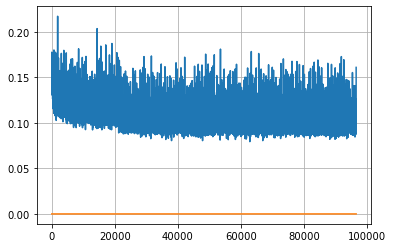

Epoch: 248, iteration 0, loss 0.10177460312843323, cov_diff 0.3996756821647335 cov_diff train 0.3999431242655668
Epoch: 248, iteration 1, loss 0.10671257972717285, cov_diff 0.4140088577981307 cov_diff train 0.41377652587275254
Epoch: 248, iteration 2, loss 0.09461706876754761, cov_diff 0.41183505213351035 cov_diff train 0.41093128554184605
Epoch: 248, iteration 3, loss 0.1005210280418396, cov_diff 0.42641793783433346 cov_diff train 0.4250403802585308
Epoch: 248, iteration 4, loss 0.09526389837265015, cov_diff 0.41496986403392144 cov_diff train 0.4145261351190013
Epoch: 248, iteration 5, loss 0.10474112629890442, cov_diff 0.40583744601881533 cov_diff train 0.40518410027264823
Epoch: 248, iteration 6, loss 0.11410325765609741, cov_diff 0.406270583921857 cov_diff train 0.40522354657693715
Epoch: 248, iteration 7, loss 0.10110348463058472, cov_diff 0.4115837452241055 cov_diff train 0.41084414359624566
Epoch: 248, iteration 8, loss 0.0979493260383606, cov_diff 0.4052891394578876 cov_diff tr

Epoch: 248, iteration 78, loss 0.10634493827819824, cov_diff 0.41594314177334546 cov_diff train 0.4148865104864361
Epoch: 248, iteration 79, loss 0.10771289467811584, cov_diff 0.41583753165185944 cov_diff train 0.4148222875129322
Epoch: 248, iteration 80, loss 0.0948852002620697, cov_diff 0.4147074787832562 cov_diff train 0.4137944044396098
Epoch: 248, iteration 81, loss 0.10289600491523743, cov_diff 0.4213462866000085 cov_diff train 0.42118700049347546
Epoch: 248, iteration 82, loss 0.0994667112827301, cov_diff 0.4036009637107954 cov_diff train 0.40154828626724215
Epoch: 248, iteration 83, loss 0.10922443866729736, cov_diff 0.4159020410772816 cov_diff train 0.41446701894810056
Epoch: 248, iteration 84, loss 0.10941165685653687, cov_diff 0.4105507160344367 cov_diff train 0.4088506841574732
Epoch: 248, iteration 85, loss 0.09961193799972534, cov_diff 0.40701188319354537 cov_diff train 0.4060096172671698
Epoch: 248, iteration 86, loss 0.10559806227684021, cov_diff 0.41681768453655116 cov

Epoch: 248, iteration 152, loss 0.10155975818634033, cov_diff 0.41390477464878117 cov_diff train 0.41295281304636944
Epoch: 248, iteration 153, loss 0.11053156852722168, cov_diff 0.41744822580158075 cov_diff train 0.4170766993195275
Epoch: 248, iteration 154, loss 0.10844653844833374, cov_diff 0.416795701959249 cov_diff train 0.4160668849094268
Epoch: 248, iteration 155, loss 0.11367148160934448, cov_diff 0.4152924977196205 cov_diff train 0.4144306455935638
Epoch: 248, iteration 156, loss 0.08936083316802979, cov_diff 0.40690028531676425 cov_diff train 0.4057526966773905
Epoch: 248, iteration 157, loss 0.09503212571144104, cov_diff 0.41065422152612274 cov_diff train 0.40921504005505854
Epoch: 248, iteration 158, loss 0.09331211447715759, cov_diff 0.41933883145365514 cov_diff train 0.41751950744596117
Epoch: 248, iteration 159, loss 0.09681892395019531, cov_diff 0.40306772697364884 cov_diff train 0.4027048911267617
Epoch: 248, iteration 160, loss 0.10297179222106934, cov_diff 0.41112839

Epoch: 248, iteration 223, loss 0.09765878319740295, cov_diff 0.4093054230877133 cov_diff train 0.40866725335867987
Epoch: 248, iteration 224, loss 0.09620770812034607, cov_diff 0.4283168892478142 cov_diff train 0.4265333297070415
Epoch: 248, iteration 225, loss 0.10412406921386719, cov_diff 0.4076599722754446 cov_diff train 0.40690702321595124
Epoch: 248, iteration 226, loss 0.10177019238471985, cov_diff 0.40448599231240934 cov_diff train 0.40354095100622617
Epoch: 248, iteration 227, loss 0.10770833492279053, cov_diff 0.41671647523134053 cov_diff train 0.4164849677025084
Epoch: 248, iteration 228, loss 0.10034054517745972, cov_diff 0.4065008490167736 cov_diff train 0.40624239271942253
Epoch: 248, iteration 229, loss 0.09470894932746887, cov_diff 0.41832990795975766 cov_diff train 0.41809935395449965
Epoch: 248, iteration 230, loss 0.09846889972686768, cov_diff 0.40009887471943556 cov_diff train 0.39973140135061125
Epoch: 248, iteration 231, loss 0.10596755146980286, cov_diff 0.428194

Epoch: 248, iteration 297, loss 0.11402767896652222, cov_diff 0.4184723278972923 cov_diff train 0.4176887021874365
Epoch: 248, iteration 298, loss 0.09626936912536621, cov_diff 0.409657649795139 cov_diff train 0.40897053220481205
Epoch: 248, iteration 299, loss 0.10493853688240051, cov_diff 0.4240637407102918 cov_diff train 0.42349916198392723
Epoch: 248, iteration 300, loss 0.11524927616119385, cov_diff 0.4149050775336091 cov_diff train 0.4136815837376323
Epoch: 248, iteration 301, loss 0.12119907140731812, cov_diff 0.4222789181306383 cov_diff train 0.4214853843951656
Epoch: 248, iteration 302, loss 0.11835086345672607, cov_diff 0.4186892788457082 cov_diff train 0.41709120261259813
Epoch: 248, iteration 303, loss 0.1064106822013855, cov_diff 0.41593356947618093 cov_diff train 0.41495393243629985
Epoch: 248, iteration 304, loss 0.10240772366523743, cov_diff 0.4100137888521645 cov_diff train 0.4095964614086983
Epoch: 248, iteration 305, loss 0.09534215927124023, cov_diff 0.4017438009560

Epoch: 248, iteration 374, loss 0.10576355457305908, cov_diff 0.41533095745822696 cov_diff train 0.41477879752408936
Epoch: 248, iteration 375, loss 0.10724535584449768, cov_diff 0.41608053014235497 cov_diff train 0.4158660211630673
Epoch: 248, iteration 376, loss 0.10121995210647583, cov_diff 0.39866036989532316 cov_diff train 0.3987202640937754
Epoch: 248, iteration 377, loss 0.11080017685890198, cov_diff 0.41361087931758067 cov_diff train 0.414003686097791
Epoch: 248, iteration 378, loss 0.09854987263679504, cov_diff 0.4151944373204934 cov_diff train 0.4148874524279489
Epoch: 248, iteration 379, loss 0.10355257987976074, cov_diff 0.41613749570271874 cov_diff train 0.4164400893417812
Epoch: 248, iteration 380, loss 0.09806635975837708, cov_diff 0.41548515810826886 cov_diff train 0.41552184163734013
Epoch: 248, iteration 381, loss 0.11063012480735779, cov_diff 0.4263256788435766 cov_diff train 0.4252916322732508
Epoch: 248, iteration 382, loss 0.10768699645996094, cov_diff 0.413892897

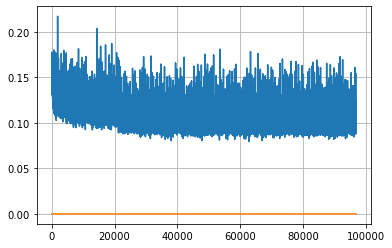

Epoch: 249, iteration 0, loss 0.10212311148643494, cov_diff 0.4170276687825214 cov_diff train 0.4154674493080014
Epoch: 249, iteration 1, loss 0.0971631109714508, cov_diff 0.4155375242509653 cov_diff train 0.4142229309348409
Epoch: 249, iteration 2, loss 0.10708102583885193, cov_diff 0.4186837892279273 cov_diff train 0.4174347200669012
Epoch: 249, iteration 3, loss 0.10018819570541382, cov_diff 0.41304320609845924 cov_diff train 0.41180376816511977
Epoch: 249, iteration 4, loss 0.10541394352912903, cov_diff 0.42328470503474686 cov_diff train 0.4216549883166149
Epoch: 249, iteration 5, loss 0.10609740018844604, cov_diff 0.4038197650600282 cov_diff train 0.4014531328385963
Epoch: 249, iteration 6, loss 0.10211870074272156, cov_diff 0.41400137041509993 cov_diff train 0.4127018163915827
Epoch: 249, iteration 7, loss 0.10484185814857483, cov_diff 0.41474667282477984 cov_diff train 0.41345584589361944
Epoch: 249, iteration 8, loss 0.10185742378234863, cov_diff 0.4123519297019911 cov_diff tra

Epoch: 249, iteration 73, loss 0.0945708155632019, cov_diff 0.42237418024119455 cov_diff train 0.4218911751200969
Epoch: 249, iteration 74, loss 0.10976478457450867, cov_diff 0.4132175228334995 cov_diff train 0.41234407090668196
Epoch: 249, iteration 75, loss 0.10064685344696045, cov_diff 0.4064129488926302 cov_diff train 0.4061146659513426
Epoch: 249, iteration 76, loss 0.10446244478225708, cov_diff 0.4155491017990452 cov_diff train 0.41526478687128293
Epoch: 249, iteration 77, loss 0.10903984308242798, cov_diff 0.4219223195570117 cov_diff train 0.4208228562465641
Epoch: 249, iteration 78, loss 0.09000441431999207, cov_diff 0.4200709435524185 cov_diff train 0.4191763946561999
Epoch: 249, iteration 79, loss 0.11145919561386108, cov_diff 0.4178812697780957 cov_diff train 0.4170715593508971
Epoch: 249, iteration 80, loss 0.10831496119499207, cov_diff 0.4179564792333789 cov_diff train 0.4172730577872283
Epoch: 249, iteration 81, loss 0.10968706011772156, cov_diff 0.415703124613008 cov_dif

Epoch: 249, iteration 148, loss 0.11437109112739563, cov_diff 0.41873426599627483 cov_diff train 0.4182480312694149
Epoch: 249, iteration 149, loss 0.10876891016960144, cov_diff 0.4061754097243434 cov_diff train 0.4055763769812761
Epoch: 249, iteration 150, loss 0.11094927787780762, cov_diff 0.4097589634356915 cov_diff train 0.40923262520439807
Epoch: 249, iteration 151, loss 0.11033731698989868, cov_diff 0.41428234784328477 cov_diff train 0.41270728359007963
Epoch: 249, iteration 152, loss 0.11143386363983154, cov_diff 0.42116492988686893 cov_diff train 0.42095424158440864
Epoch: 249, iteration 153, loss 0.09632590413093567, cov_diff 0.41796502093922916 cov_diff train 0.41625419876680975
Epoch: 249, iteration 154, loss 0.0889115035533905, cov_diff 0.40416038185378766 cov_diff train 0.4029760135402033
Epoch: 249, iteration 155, loss 0.1030750572681427, cov_diff 0.41334336860678716 cov_diff train 0.4122325239695168
Epoch: 249, iteration 156, loss 0.09664091467857361, cov_diff 0.40892152

Epoch: 249, iteration 224, loss 0.10699906945228577, cov_diff 0.42478688773642553 cov_diff train 0.42423493928147615
Epoch: 249, iteration 225, loss 0.10692641139030457, cov_diff 0.4071388292616845 cov_diff train 0.40706432412131893
Epoch: 249, iteration 226, loss 0.106665700674057, cov_diff 0.39638058615311506 cov_diff train 0.39631370374416836
Epoch: 249, iteration 227, loss 0.10512009263038635, cov_diff 0.4021440974650621 cov_diff train 0.40080686919634495
Epoch: 249, iteration 228, loss 0.1051795482635498, cov_diff 0.40841124471390733 cov_diff train 0.4073264870156551
Epoch: 249, iteration 229, loss 0.11089739203453064, cov_diff 0.42166324175691394 cov_diff train 0.42139754178743566
Epoch: 249, iteration 230, loss 0.11000716686248779, cov_diff 0.4113367185790113 cov_diff train 0.410670306498566
Epoch: 249, iteration 231, loss 0.09723272919654846, cov_diff 0.4004884202461407 cov_diff train 0.39960355603159625
Epoch: 249, iteration 232, loss 0.10415387153625488, cov_diff 0.4197251900

Epoch: 249, iteration 296, loss 0.09412756562232971, cov_diff 0.4145468271150445 cov_diff train 0.4142461989216645
Epoch: 249, iteration 297, loss 0.1037360429763794, cov_diff 0.4132390889999335 cov_diff train 0.4123370461961552
Epoch: 249, iteration 298, loss 0.09370887279510498, cov_diff 0.409118742488378 cov_diff train 0.40915723183682595
Epoch: 249, iteration 299, loss 0.1108548641204834, cov_diff 0.4047410545087584 cov_diff train 0.40412579184040176
Epoch: 249, iteration 300, loss 0.12060239911079407, cov_diff 0.4110032868291349 cov_diff train 0.41005153125602645
Epoch: 249, iteration 301, loss 0.10623210668563843, cov_diff 0.4139069122307337 cov_diff train 0.41363986384653717
Epoch: 249, iteration 302, loss 0.10479900240898132, cov_diff 0.41057173586607953 cov_diff train 0.40967108827597676
Epoch: 249, iteration 303, loss 0.1009376049041748, cov_diff 0.41183373168741616 cov_diff train 0.4117896891902733
Epoch: 249, iteration 304, loss 0.1008850634098053, cov_diff 0.41111792675218

Epoch: 249, iteration 372, loss 0.09981393814086914, cov_diff 0.4103310161417228 cov_diff train 0.40938549664738816
Epoch: 249, iteration 373, loss 0.0989205539226532, cov_diff 0.4220465550589937 cov_diff train 0.42089679518394124
Epoch: 249, iteration 374, loss 0.09641963243484497, cov_diff 0.41928461384127524 cov_diff train 0.4184224518393463
Epoch: 249, iteration 375, loss 0.1067371666431427, cov_diff 0.4122500280979685 cov_diff train 0.4109990711066579
Epoch: 249, iteration 376, loss 0.09616053104400635, cov_diff 0.42506310186458846 cov_diff train 0.4231499586765395
Epoch: 249, iteration 377, loss 0.10851669311523438, cov_diff 0.40700912209766316 cov_diff train 0.4059595140685737
Epoch: 249, iteration 378, loss 0.10315269231796265, cov_diff 0.40658309060854386 cov_diff train 0.4065597461237961
Epoch: 249, iteration 379, loss 0.10589277744293213, cov_diff 0.41732581049367673 cov_diff train 0.41625750263784383
Epoch: 249, iteration 380, loss 0.09749367833137512, cov_diff 0.4144136462

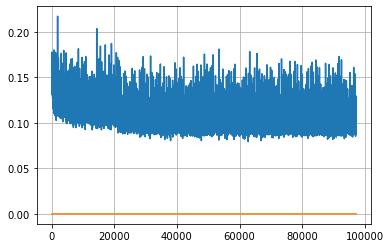

Epoch: 250, iteration 0, loss 0.09856319427490234, cov_diff 0.4119513763473429 cov_diff train 0.41141902162945315
Epoch: 250, iteration 1, loss 0.09392762184143066, cov_diff 0.4111525346046578 cov_diff train 0.4113592168517303
Epoch: 250, iteration 2, loss 0.10662299394607544, cov_diff 0.4167407816744655 cov_diff train 0.4158395128388947
Epoch: 250, iteration 3, loss 0.10667955875396729, cov_diff 0.40503342391764885 cov_diff train 0.4037165287501776
Epoch: 250, iteration 4, loss 0.10780209302902222, cov_diff 0.40172657783642945 cov_diff train 0.40138718324021516
Epoch: 250, iteration 5, loss 0.10189470648765564, cov_diff 0.41180149326345883 cov_diff train 0.4114090053667011
Epoch: 250, iteration 6, loss 0.10735815763473511, cov_diff 0.3939996451173063 cov_diff train 0.39273923795394905
Epoch: 250, iteration 7, loss 0.09964531660079956, cov_diff 0.41080549908636294 cov_diff train 0.4112627619424766
Epoch: 250, iteration 8, loss 0.09340986609458923, cov_diff 0.4066489485110015 cov_diff t

Epoch: 250, iteration 73, loss 0.09738186001777649, cov_diff 0.40639699081269215 cov_diff train 0.4060793982538964
Epoch: 250, iteration 74, loss 0.09862414002418518, cov_diff 0.40774703543035146 cov_diff train 0.40767861719442455
Epoch: 250, iteration 75, loss 0.10341709852218628, cov_diff 0.41733653778064195 cov_diff train 0.4168494781054603
Epoch: 250, iteration 76, loss 0.10202407836914062, cov_diff 0.39980242452542547 cov_diff train 0.3992044441012326
Epoch: 250, iteration 77, loss 0.10658147931098938, cov_diff 0.40574012827695877 cov_diff train 0.4049460740305618
Epoch: 250, iteration 78, loss 0.10136151313781738, cov_diff 0.4154068958610385 cov_diff train 0.414154287990964
Epoch: 250, iteration 79, loss 0.11118745803833008, cov_diff 0.40890910612306475 cov_diff train 0.4083232383518361
Epoch: 250, iteration 80, loss 0.10617434978485107, cov_diff 0.4199410450515261 cov_diff train 0.41847412559835945
Epoch: 250, iteration 81, loss 0.09709274768829346, cov_diff 0.40356641936101467 

Epoch: 250, iteration 148, loss 0.10190320014953613, cov_diff 0.41396321536939573 cov_diff train 0.41385703296916804
Epoch: 250, iteration 149, loss 0.10727033019065857, cov_diff 0.40050867639742616 cov_diff train 0.4000113521870723
Epoch: 250, iteration 150, loss 0.09561443328857422, cov_diff 0.4116396738809112 cov_diff train 0.41084317956107047
Epoch: 250, iteration 151, loss 0.10029950737953186, cov_diff 0.41422720749625336 cov_diff train 0.41403528164405373
Epoch: 250, iteration 152, loss 0.10981100797653198, cov_diff 0.3991496106023354 cov_diff train 0.3988330881702802
Epoch: 250, iteration 153, loss 0.08886858820915222, cov_diff 0.4123728721912791 cov_diff train 0.41123371624154315
Epoch: 250, iteration 154, loss 0.09913009405136108, cov_diff 0.4167692660815923 cov_diff train 0.4159419666730674
Epoch: 250, iteration 155, loss 0.11323285102844238, cov_diff 0.41740735118119116 cov_diff train 0.41642338268632834
Epoch: 250, iteration 156, loss 0.0956122875213623, cov_diff 0.40905280

Epoch: 250, iteration 225, loss 0.10728049278259277, cov_diff 0.4175556568451293 cov_diff train 0.4167234465977162
Epoch: 250, iteration 226, loss 0.09777748584747314, cov_diff 0.4142784766651006 cov_diff train 0.4133104658665729
Epoch: 250, iteration 227, loss 0.10902184247970581, cov_diff 0.4047024587501436 cov_diff train 0.4047067896651241
Epoch: 250, iteration 228, loss 0.11012923717498779, cov_diff 0.41363488734776693 cov_diff train 0.41163503460993195
Epoch: 250, iteration 229, loss 0.1029333770275116, cov_diff 0.41191683677913754 cov_diff train 0.4109698906371253
Epoch: 250, iteration 230, loss 0.1137053370475769, cov_diff 0.4116920199436828 cov_diff train 0.4110807129917027
Epoch: 250, iteration 231, loss 0.1134955883026123, cov_diff 0.407847494289455 cov_diff train 0.4075217557367081
Epoch: 250, iteration 232, loss 0.09158167243003845, cov_diff 0.3896249026549607 cov_diff train 0.3890755457912273
Epoch: 250, iteration 233, loss 0.11138144135475159, cov_diff 0.41039290846856996

Epoch: 250, iteration 302, loss 0.1090901792049408, cov_diff 0.4254835334754453 cov_diff train 0.42488805068149177
Epoch: 250, iteration 303, loss 0.10252249240875244, cov_diff 0.4212526257559516 cov_diff train 0.420602441160671
Epoch: 250, iteration 304, loss 0.10423660278320312, cov_diff 0.4125821673886144 cov_diff train 0.4111824062011367
Epoch: 250, iteration 305, loss 0.10474082827568054, cov_diff 0.40129299239917127 cov_diff train 0.4000346521520073
Epoch: 250, iteration 306, loss 0.10980802774429321, cov_diff 0.3935225762066983 cov_diff train 0.3935609618417934
Epoch: 250, iteration 307, loss 0.10915219783782959, cov_diff 0.4040742626869881 cov_diff train 0.4041969467847902
Epoch: 250, iteration 308, loss 0.11513417959213257, cov_diff 0.42195034081894445 cov_diff train 0.42177434699442634
Epoch: 250, iteration 309, loss 0.11101460456848145, cov_diff 0.41541683135541263 cov_diff train 0.414249465280012
Epoch: 250, iteration 310, loss 0.09838917851448059, cov_diff 0.41624079098949

Epoch: 250, iteration 379, loss 0.101843923330307, cov_diff 0.4259948777045319 cov_diff train 0.42580787295956507
Epoch: 250, iteration 380, loss 0.10085645318031311, cov_diff 0.42779165457638757 cov_diff train 0.4273997065647042
Epoch: 250, iteration 381, loss 0.09972509741783142, cov_diff 0.41856760025244694 cov_diff train 0.4178327560231761
Epoch: 250, iteration 382, loss 0.099212646484375, cov_diff 0.41383836515280786 cov_diff train 0.4125503555402888
Epoch: 250, iteration 383, loss 0.11182671785354614, cov_diff 0.41147201518786836 cov_diff train 0.4104185875318182
Epoch: 250, iteration 384, loss 0.10784274339675903, cov_diff 0.41196271947292434 cov_diff train 0.41087686517345184
Epoch: 250, iteration 385, loss 0.10576459765434265, cov_diff 0.41501987490214187 cov_diff train 0.41424272145747437
Epoch: 250, iteration 386, loss 0.09179311990737915, cov_diff 0.42062619618528124 cov_diff train 0.41969356488125026
Epoch: 250, iteration 387, loss 0.10631135106086731, cov_diff 0.417563214

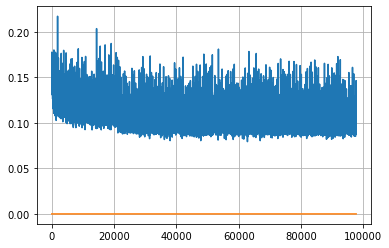

Epoch: 251, iteration 0, loss 0.10906949639320374, cov_diff 0.40531648831606615 cov_diff train 0.4045306449284675
Epoch: 251, iteration 1, loss 0.09257060289382935, cov_diff 0.40824122651823264 cov_diff train 0.40797134656314865
Epoch: 251, iteration 2, loss 0.09419077634811401, cov_diff 0.4045268331102792 cov_diff train 0.40370819046321965
Epoch: 251, iteration 3, loss 0.11992165446281433, cov_diff 0.41419592507227393 cov_diff train 0.41306053804425696
Epoch: 251, iteration 4, loss 0.09728497266769409, cov_diff 0.40877394524300004 cov_diff train 0.408451662096508
Epoch: 251, iteration 5, loss 0.09929949045181274, cov_diff 0.405083386953322 cov_diff train 0.4045735515737334
Epoch: 251, iteration 6, loss 0.10411345958709717, cov_diff 0.40523320997316725 cov_diff train 0.4032703665692913
Epoch: 251, iteration 7, loss 0.09896194934844971, cov_diff 0.4101710081802857 cov_diff train 0.40984735209945045
Epoch: 251, iteration 8, loss 0.1005946695804596, cov_diff 0.3892069739156334 cov_diff tr

Epoch: 251, iteration 77, loss 0.11061778664588928, cov_diff 0.41734352267025565 cov_diff train 0.41682204530361944
Epoch: 251, iteration 78, loss 0.10457253456115723, cov_diff 0.4096506849287724 cov_diff train 0.40827911714852644
Epoch: 251, iteration 79, loss 0.10645684599876404, cov_diff 0.4050420918347283 cov_diff train 0.4046414072463832
Epoch: 251, iteration 80, loss 0.10381177067756653, cov_diff 0.4149691398346537 cov_diff train 0.4143396360042955
Epoch: 251, iteration 81, loss 0.0964600145816803, cov_diff 0.41329018664710854 cov_diff train 0.41295969950330813
Epoch: 251, iteration 82, loss 0.10180419683456421, cov_diff 0.40184057942337575 cov_diff train 0.39986312412688174
Epoch: 251, iteration 83, loss 0.11138081550598145, cov_diff 0.4174705612706633 cov_diff train 0.4169031768832293
Epoch: 251, iteration 84, loss 0.10610058903694153, cov_diff 0.42227878214292197 cov_diff train 0.4213907165964009
Epoch: 251, iteration 85, loss 0.11288627982139587, cov_diff 0.4206308340575725 c

Epoch: 251, iteration 149, loss 0.10335573554039001, cov_diff 0.4075490714290639 cov_diff train 0.40715499462472243
Epoch: 251, iteration 150, loss 0.12225854396820068, cov_diff 0.4184351329123351 cov_diff train 0.4173780288596106
Epoch: 251, iteration 151, loss 0.10976672172546387, cov_diff 0.42282212172163514 cov_diff train 0.4219636114317315
Epoch: 251, iteration 152, loss 0.09811726212501526, cov_diff 0.4251033602578186 cov_diff train 0.4242951250289146
Epoch: 251, iteration 153, loss 0.10788151621818542, cov_diff 0.41193964015183165 cov_diff train 0.41138600357783134
Epoch: 251, iteration 154, loss 0.09944730997085571, cov_diff 0.4078543124103466 cov_diff train 0.40766608504127705
Epoch: 251, iteration 155, loss 0.08962547779083252, cov_diff 0.4044579510254004 cov_diff train 0.4040142969517032
Epoch: 251, iteration 156, loss 0.10677257180213928, cov_diff 0.40823287266086966 cov_diff train 0.4071422542282833
Epoch: 251, iteration 157, loss 0.1041649878025055, cov_diff 0.41063510893

Epoch: 251, iteration 225, loss 0.10129234194755554, cov_diff 0.4067533750764931 cov_diff train 0.4049636598166999
Epoch: 251, iteration 226, loss 0.09730309247970581, cov_diff 0.4227069280573558 cov_diff train 0.42238570776826423
Epoch: 251, iteration 227, loss 0.10970723628997803, cov_diff 0.41415067208163975 cov_diff train 0.4136140843036803
Epoch: 251, iteration 228, loss 0.10199964046478271, cov_diff 0.415878122103781 cov_diff train 0.4148493891224258
Epoch: 251, iteration 229, loss 0.1061972975730896, cov_diff 0.4143983366560475 cov_diff train 0.4138208383120994
Epoch: 251, iteration 230, loss 0.10261815786361694, cov_diff 0.41556237715135924 cov_diff train 0.41538813561747817
Epoch: 251, iteration 231, loss 0.10523548722267151, cov_diff 0.4057317395137859 cov_diff train 0.4048763634632734
Epoch: 251, iteration 232, loss 0.1026088297367096, cov_diff 0.41858855584954746 cov_diff train 0.417701212797876
Epoch: 251, iteration 233, loss 0.09596201777458191, cov_diff 0.423804351744669

Epoch: 251, iteration 301, loss 0.11475497484207153, cov_diff 0.4179493872429236 cov_diff train 0.41791942526215015
Epoch: 251, iteration 302, loss 0.0957990288734436, cov_diff 0.4184332616061292 cov_diff train 0.41776675721139456
Epoch: 251, iteration 303, loss 0.09293627738952637, cov_diff 0.4033921588191705 cov_diff train 0.4026958018185279
Epoch: 251, iteration 304, loss 0.10012012720108032, cov_diff 0.40696874704004027 cov_diff train 0.4059570371937657
Epoch: 251, iteration 305, loss 0.09852424263954163, cov_diff 0.3979116496936058 cov_diff train 0.3974949721635205
Epoch: 251, iteration 306, loss 0.10434958338737488, cov_diff 0.4169643129768059 cov_diff train 0.4167426998714666
Epoch: 251, iteration 307, loss 0.10014736652374268, cov_diff 0.4151546677350519 cov_diff train 0.41463915238412546
Epoch: 251, iteration 308, loss 0.09797543287277222, cov_diff 0.4231056702234561 cov_diff train 0.4224785974461562
Epoch: 251, iteration 309, loss 0.1065603494644165, cov_diff 0.41067109960124

Epoch: 251, iteration 381, loss 0.09659945964813232, cov_diff 0.40100730650861105 cov_diff train 0.4007720713812657
Epoch: 251, iteration 382, loss 0.0990140438079834, cov_diff 0.4147071861008882 cov_diff train 0.41445707625692313
Epoch: 251, iteration 383, loss 0.10609391331672668, cov_diff 0.40342683085736336 cov_diff train 0.40241567464236866
Epoch: 251, iteration 384, loss 0.10689163208007812, cov_diff 0.406389122529667 cov_diff train 0.40709625035883196
Epoch: 251, iteration 385, loss 0.09318095445632935, cov_diff 0.40108495551570683 cov_diff train 0.4005419125584658
Epoch: 251, iteration 386, loss 0.11182406544685364, cov_diff 0.4126723286112302 cov_diff train 0.4132254567654289
Epoch: 251, iteration 387, loss 0.11047017574310303, cov_diff 0.4112261258178054 cov_diff train 0.41182636497291597
Epoch: 251, iteration 388, loss 0.10470551252365112, cov_diff 0.41652190745979095 cov_diff train 0.41580277077821626
Epoch: 251, iteration 389, loss 0.11350592970848083, cov_diff 0.422730450

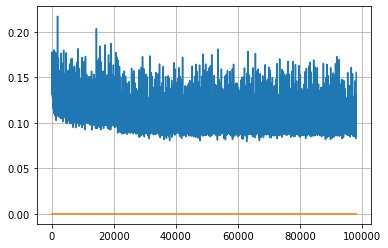

Epoch: 252, iteration 0, loss 0.11110860109329224, cov_diff 0.4099927804147056 cov_diff train 0.4097578683774094
Epoch: 252, iteration 1, loss 0.10351130366325378, cov_diff 0.40414108997757653 cov_diff train 0.404050527035435
Epoch: 252, iteration 2, loss 0.10816928744316101, cov_diff 0.42792845045410394 cov_diff train 0.42740888592658316
Epoch: 252, iteration 3, loss 0.09616649150848389, cov_diff 0.40609575535770503 cov_diff train 0.40579503470115097
Epoch: 252, iteration 4, loss 0.10846683382987976, cov_diff 0.41886795021485723 cov_diff train 0.4186685031939379
Epoch: 252, iteration 5, loss 0.10285255312919617, cov_diff 0.4220035546880319 cov_diff train 0.42192197982393814
Epoch: 252, iteration 6, loss 0.10278218984603882, cov_diff 0.41811332589053635 cov_diff train 0.41709639055345243
Epoch: 252, iteration 7, loss 0.10245361924171448, cov_diff 0.419172581251385 cov_diff train 0.41733573062801943
Epoch: 252, iteration 8, loss 0.11166509985923767, cov_diff 0.41464451521211576 cov_diff

Epoch: 252, iteration 77, loss 0.10470646619796753, cov_diff 0.42041756987771073 cov_diff train 0.41936296469093975
Epoch: 252, iteration 78, loss 0.09933134913444519, cov_diff 0.41413802409052985 cov_diff train 0.4131192608413543
Epoch: 252, iteration 79, loss 0.10104063153266907, cov_diff 0.415435360975053 cov_diff train 0.41470296895468917
Epoch: 252, iteration 80, loss 0.0991794764995575, cov_diff 0.40962698730817726 cov_diff train 0.40791232977386993
Epoch: 252, iteration 81, loss 0.09425905346870422, cov_diff 0.420118202960623 cov_diff train 0.4194095402118565
Epoch: 252, iteration 82, loss 0.10108458995819092, cov_diff 0.41646784297308065 cov_diff train 0.41532866917149713
Epoch: 252, iteration 83, loss 0.10786628723144531, cov_diff 0.4124446544234164 cov_diff train 0.412025080932646
Epoch: 252, iteration 84, loss 0.09746244549751282, cov_diff 0.41040494900516555 cov_diff train 0.4082595394774756
Epoch: 252, iteration 85, loss 0.1137097179889679, cov_diff 0.4102187495202735 cov_

Epoch: 252, iteration 154, loss 0.09756949543952942, cov_diff 0.4198570648063268 cov_diff train 0.4196448572348138
Epoch: 252, iteration 155, loss 0.10087066888809204, cov_diff 0.421104239473363 cov_diff train 0.4199400732687965
Epoch: 252, iteration 156, loss 0.10122540593147278, cov_diff 0.4031144040544635 cov_diff train 0.4021711833442285
Epoch: 252, iteration 157, loss 0.10514163970947266, cov_diff 0.4162954808928331 cov_diff train 0.41649166171807056
Epoch: 252, iteration 158, loss 0.11067014932632446, cov_diff 0.40845442292575157 cov_diff train 0.40792675324471467
Epoch: 252, iteration 159, loss 0.10367020964622498, cov_diff 0.4185145352920853 cov_diff train 0.4181266837195463
Epoch: 252, iteration 160, loss 0.10787162184715271, cov_diff 0.42531133011769456 cov_diff train 0.42478056251174257
Epoch: 252, iteration 161, loss 0.10869362950325012, cov_diff 0.4228728683336091 cov_diff train 0.422461671858901
Epoch: 252, iteration 162, loss 0.10319820046424866, cov_diff 0.4228277408214

Epoch: 252, iteration 231, loss 0.10726150870323181, cov_diff 0.40558906143358886 cov_diff train 0.40456494450546854
Epoch: 252, iteration 232, loss 0.10843539237976074, cov_diff 0.41844233182466867 cov_diff train 0.41760641522548264
Epoch: 252, iteration 233, loss 0.10070112347602844, cov_diff 0.4201640651918076 cov_diff train 0.41956071995906336
Epoch: 252, iteration 234, loss 0.09324687719345093, cov_diff 0.41524101493500004 cov_diff train 0.41461768668417937
Epoch: 252, iteration 235, loss 0.09151694178581238, cov_diff 0.4114044190764501 cov_diff train 0.4105808890996043
Epoch: 252, iteration 236, loss 0.09585794806480408, cov_diff 0.40790458417533004 cov_diff train 0.40722026409302037
Epoch: 252, iteration 237, loss 0.09270292520523071, cov_diff 0.42671965595854866 cov_diff train 0.4254486895966282
Epoch: 252, iteration 238, loss 0.1074042022228241, cov_diff 0.41313164323434703 cov_diff train 0.4124145364583741
Epoch: 252, iteration 239, loss 0.09807375073432922, cov_diff 0.411438

Epoch: 252, iteration 309, loss 0.09805575013160706, cov_diff 0.4115442220049925 cov_diff train 0.40972379376251317
Epoch: 252, iteration 310, loss 0.10167482495307922, cov_diff 0.40348883437613703 cov_diff train 0.402689174937913
Epoch: 252, iteration 311, loss 0.10199496150016785, cov_diff 0.40279407207702894 cov_diff train 0.4025698648542146
Epoch: 252, iteration 312, loss 0.09290644526481628, cov_diff 0.41229270229640214 cov_diff train 0.41173704395809857
Epoch: 252, iteration 313, loss 0.10841047763824463, cov_diff 0.4131545198525125 cov_diff train 0.4124291820526634
Epoch: 252, iteration 314, loss 0.10096007585525513, cov_diff 0.4170644452917969 cov_diff train 0.416168682655789
Epoch: 252, iteration 315, loss 0.10647043585777283, cov_diff 0.4011745460587946 cov_diff train 0.4006892096887392
Epoch: 252, iteration 316, loss 0.09001615643501282, cov_diff 0.4053466432218936 cov_diff train 0.4050779670635465
Epoch: 252, iteration 317, loss 0.10340967774391174, cov_diff 0.4095422405370

Epoch: 252, iteration 389, loss 0.09902787208557129, cov_diff 0.4167156487865591 cov_diff train 0.41521537765402033
Epoch: 252, iteration 390, loss 0.16532188653945923, cov_diff 0.43875588898333606 cov_diff train 0.43799130374513473


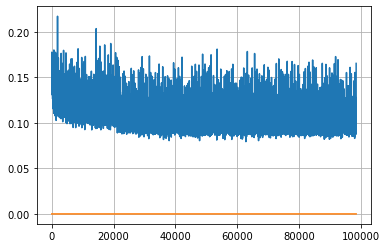

Epoch: 253, iteration 0, loss 0.09887999296188354, cov_diff 0.40220386722108703 cov_diff train 0.4027921638171759
Epoch: 253, iteration 1, loss 0.09765183925628662, cov_diff 0.41093673135150555 cov_diff train 0.410719996204496
Epoch: 253, iteration 2, loss 0.09790799021720886, cov_diff 0.4152338253165981 cov_diff train 0.41582868928514966
Epoch: 253, iteration 3, loss 0.10386839509010315, cov_diff 0.4170204446032559 cov_diff train 0.4166760174418097
Epoch: 253, iteration 4, loss 0.09759286046028137, cov_diff 0.4247863098866995 cov_diff train 0.4234877080426878
Epoch: 253, iteration 5, loss 0.09367421269416809, cov_diff 0.4157573088446574 cov_diff train 0.4150355978199518
Epoch: 253, iteration 6, loss 0.10135972499847412, cov_diff 0.40083719199774887 cov_diff train 0.3998411230890846
Epoch: 253, iteration 7, loss 0.09497395157814026, cov_diff 0.4121209522592819 cov_diff train 0.41240493010791374
Epoch: 253, iteration 8, loss 0.11244499683380127, cov_diff 0.42052943731545284 cov_diff tra

Epoch: 253, iteration 78, loss 0.09526237845420837, cov_diff 0.4234606780185476 cov_diff train 0.42290135144205254
Epoch: 253, iteration 79, loss 0.10732755064964294, cov_diff 0.42013800132782686 cov_diff train 0.41929290807566616
Epoch: 253, iteration 80, loss 0.10372871160507202, cov_diff 0.413200521239853 cov_diff train 0.4116851129586973
Epoch: 253, iteration 81, loss 0.09461528062820435, cov_diff 0.4123187532420372 cov_diff train 0.41155985454256205
Epoch: 253, iteration 82, loss 0.10234963893890381, cov_diff 0.3971389229030036 cov_diff train 0.39671900843227786
Epoch: 253, iteration 83, loss 0.10935366153717041, cov_diff 0.4195437794875421 cov_diff train 0.41875689136735406
Epoch: 253, iteration 84, loss 0.10957697033882141, cov_diff 0.4069398611750032 cov_diff train 0.40689151212374186
Epoch: 253, iteration 85, loss 0.11607667803764343, cov_diff 0.4204760328258056 cov_diff train 0.42114529749513807
Epoch: 253, iteration 86, loss 0.1023995578289032, cov_diff 0.40521110974990776 c

Epoch: 253, iteration 155, loss 0.09944677352905273, cov_diff 0.40964825160741536 cov_diff train 0.40891956041366795
Epoch: 253, iteration 156, loss 0.12144067883491516, cov_diff 0.40871893659192554 cov_diff train 0.40823594712716654
Epoch: 253, iteration 157, loss 0.09399482607841492, cov_diff 0.41405147647081625 cov_diff train 0.4128429700344021
Epoch: 253, iteration 158, loss 0.1008157730102539, cov_diff 0.4047401120384006 cov_diff train 0.4036587429545037
Epoch: 253, iteration 159, loss 0.10548415780067444, cov_diff 0.41120185890688155 cov_diff train 0.4103971408588102
Epoch: 253, iteration 160, loss 0.10356152057647705, cov_diff 0.40764765851589196 cov_diff train 0.4069138878640226
Epoch: 253, iteration 161, loss 0.10737684369087219, cov_diff 0.40746277835555006 cov_diff train 0.4065641389220551
Epoch: 253, iteration 162, loss 0.09070083498954773, cov_diff 0.40126899145515943 cov_diff train 0.40094868843777975
Epoch: 253, iteration 163, loss 0.11370030045509338, cov_diff 0.4049927

Epoch: 253, iteration 233, loss 0.09863296151161194, cov_diff 0.4077037851024642 cov_diff train 0.406862619424187
Epoch: 253, iteration 234, loss 0.10598152875900269, cov_diff 0.4137560707697093 cov_diff train 0.4128819829204568
Epoch: 253, iteration 235, loss 0.11031436920166016, cov_diff 0.4184239735996914 cov_diff train 0.4171809388812956
Epoch: 253, iteration 236, loss 0.11584725975990295, cov_diff 0.41904233622083664 cov_diff train 0.4177465553074839
Epoch: 253, iteration 237, loss 0.09636053442955017, cov_diff 0.40710678905597386 cov_diff train 0.4067377665800749
Epoch: 253, iteration 238, loss 0.12023884057998657, cov_diff 0.40954638871517934 cov_diff train 0.40920757495804616
Epoch: 253, iteration 239, loss 0.11507683992385864, cov_diff 0.42105543671893886 cov_diff train 0.42023792593218673
Epoch: 253, iteration 240, loss 0.1162663996219635, cov_diff 0.39984558033721324 cov_diff train 0.3992989844642731
Epoch: 253, iteration 241, loss 0.10329750180244446, cov_diff 0.40555449732

Epoch: 253, iteration 313, loss 0.10186779499053955, cov_diff 0.42685701824781114 cov_diff train 0.4249836664513789
Epoch: 253, iteration 314, loss 0.09350934624671936, cov_diff 0.41164621314318495 cov_diff train 0.41000152587330807
Epoch: 253, iteration 315, loss 0.1039435863494873, cov_diff 0.4135094286909747 cov_diff train 0.4130288831450302
Epoch: 253, iteration 316, loss 0.11062416434288025, cov_diff 0.3965187201316883 cov_diff train 0.3955433131743088
Epoch: 253, iteration 317, loss 0.09618449211120605, cov_diff 0.4123160952189386 cov_diff train 0.41182596403546
Epoch: 253, iteration 318, loss 0.09519511461257935, cov_diff 0.39565710782769625 cov_diff train 0.3946614933349756
Epoch: 253, iteration 319, loss 0.10593268275260925, cov_diff 0.4042402834498681 cov_diff train 0.4036407923108054
Epoch: 253, iteration 320, loss 0.10838016867637634, cov_diff 0.4041062939672121 cov_diff train 0.4035319028721282
Epoch: 253, iteration 321, loss 0.10090157389640808, cov_diff 0.408358205597132

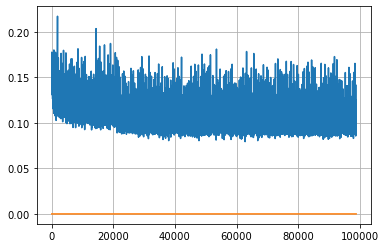

Epoch: 254, iteration 0, loss 0.10729047656059265, cov_diff 0.40573757786826586 cov_diff train 0.40509519795895704
Epoch: 254, iteration 1, loss 0.10279884934425354, cov_diff 0.4081360912304282 cov_diff train 0.40713942371063094
Epoch: 254, iteration 2, loss 0.10143569111824036, cov_diff 0.42053830378319845 cov_diff train 0.4197901647743405
Epoch: 254, iteration 3, loss 0.11052572727203369, cov_diff 0.4102283983903299 cov_diff train 0.4100708340803706
Epoch: 254, iteration 4, loss 0.10550740361213684, cov_diff 0.4199498293259798 cov_diff train 0.419261501646106
Epoch: 254, iteration 5, loss 0.10449546575546265, cov_diff 0.4108599744739131 cov_diff train 0.4099635285100324
Epoch: 254, iteration 6, loss 0.09270209074020386, cov_diff 0.3991837750828482 cov_diff train 0.39844391083127867
Epoch: 254, iteration 7, loss 0.10580331087112427, cov_diff 0.41682778685537336 cov_diff train 0.4162878879647478
Epoch: 254, iteration 8, loss 0.1008390486240387, cov_diff 0.4241280044172952 cov_diff trai

Epoch: 254, iteration 80, loss 0.11515447497367859, cov_diff 0.4208790105634478 cov_diff train 0.4199529085856534
Epoch: 254, iteration 81, loss 0.10649967193603516, cov_diff 0.39982549301043596 cov_diff train 0.3993973853599122
Epoch: 254, iteration 82, loss 0.09825125336647034, cov_diff 0.4161567970217555 cov_diff train 0.41529881355234777
Epoch: 254, iteration 83, loss 0.09302759170532227, cov_diff 0.4082204424026042 cov_diff train 0.4082649963001179
Epoch: 254, iteration 84, loss 0.1009623110294342, cov_diff 0.41998467673677536 cov_diff train 0.4192764938620176
Epoch: 254, iteration 85, loss 0.09280988574028015, cov_diff 0.4021506673753489 cov_diff train 0.40099038607933996
Epoch: 254, iteration 86, loss 0.09938916563987732, cov_diff 0.4235586349224934 cov_diff train 0.42275624534098805
Epoch: 254, iteration 87, loss 0.11409574747085571, cov_diff 0.4187722712494848 cov_diff train 0.4176936476136549
Epoch: 254, iteration 88, loss 0.10726878046989441, cov_diff 0.4113272960717548 cov_

Epoch: 254, iteration 157, loss 0.10784730315208435, cov_diff 0.4098586364568617 cov_diff train 0.4098001436188699
Epoch: 254, iteration 158, loss 0.10034164786338806, cov_diff 0.4125651079144591 cov_diff train 0.4120032854707282
Epoch: 254, iteration 159, loss 0.1139422357082367, cov_diff 0.4247240022141665 cov_diff train 0.42486093045371986
Epoch: 254, iteration 160, loss 0.11240962147712708, cov_diff 0.4130164448709756 cov_diff train 0.4134907899082628
Epoch: 254, iteration 161, loss 0.10363596677780151, cov_diff 0.40670807691406413 cov_diff train 0.4066501800802724
Epoch: 254, iteration 162, loss 0.10513091087341309, cov_diff 0.40857702468800156 cov_diff train 0.4075412810050975
Epoch: 254, iteration 163, loss 0.11010140180587769, cov_diff 0.41916869172600607 cov_diff train 0.41890903833410176
Epoch: 254, iteration 164, loss 0.10290318727493286, cov_diff 0.40760131100771363 cov_diff train 0.4085760456773391
Epoch: 254, iteration 165, loss 0.10133713483810425, cov_diff 0.41180888710

Epoch: 254, iteration 235, loss 0.1106385588645935, cov_diff 0.4197692929627163 cov_diff train 0.4195528638785791
Epoch: 254, iteration 236, loss 0.1108161211013794, cov_diff 0.40766824021227727 cov_diff train 0.40678856455592954
Epoch: 254, iteration 237, loss 0.11021775007247925, cov_diff 0.42814342550100104 cov_diff train 0.427197930299232
Epoch: 254, iteration 238, loss 0.09848842024803162, cov_diff 0.41083820824543266 cov_diff train 0.4105336295498047
Epoch: 254, iteration 239, loss 0.10267171263694763, cov_diff 0.4150158976180121 cov_diff train 0.4140434813373686
Epoch: 254, iteration 240, loss 0.10949665307998657, cov_diff 0.4058000931126907 cov_diff train 0.4044855355440315
Epoch: 254, iteration 241, loss 0.11685961484909058, cov_diff 0.415313227868865 cov_diff train 0.414802984272824
Epoch: 254, iteration 242, loss 0.09090164303779602, cov_diff 0.40420847751017425 cov_diff train 0.4032704155602724
Epoch: 254, iteration 243, loss 0.10349693894386292, cov_diff 0.4214657460400677

Epoch: 254, iteration 313, loss 0.10037693381309509, cov_diff 0.41458310611956245 cov_diff train 0.4135997280506632
Epoch: 254, iteration 314, loss 0.09536805748939514, cov_diff 0.4222224649368025 cov_diff train 0.4215478826920553
Epoch: 254, iteration 315, loss 0.1120629608631134, cov_diff 0.4055381691279984 cov_diff train 0.4048346302912061
Epoch: 254, iteration 316, loss 0.11139684915542603, cov_diff 0.4116267363699784 cov_diff train 0.41000171165059796
Epoch: 254, iteration 317, loss 0.11369326710700989, cov_diff 0.4110907444619717 cov_diff train 0.41021764400842653
Epoch: 254, iteration 318, loss 0.10191881656646729, cov_diff 0.403404157783246 cov_diff train 0.402798888623794
Epoch: 254, iteration 319, loss 0.10743409395217896, cov_diff 0.40035953433291044 cov_diff train 0.3993729041667759
Epoch: 254, iteration 320, loss 0.10430037975311279, cov_diff 0.40786996279205034 cov_diff train 0.40737838746985433
Epoch: 254, iteration 321, loss 0.11190026998519897, cov_diff 0.4172119532385

Epoch: 254, iteration 390, loss 0.15339913964271545, cov_diff 0.4718020933793801 cov_diff train 0.4692891637186137


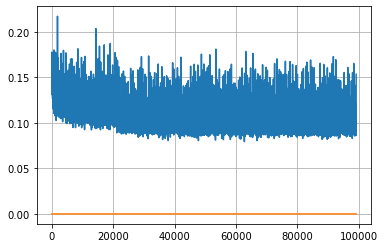

Epoch: 255, iteration 0, loss 0.09314769506454468, cov_diff 0.4198265104119648 cov_diff train 0.4195478186150727
Epoch: 255, iteration 1, loss 0.11228030920028687, cov_diff 0.41475986262428577 cov_diff train 0.41497585893510197
Epoch: 255, iteration 2, loss 0.10604101419448853, cov_diff 0.4175687988250792 cov_diff train 0.4166309911123393
Epoch: 255, iteration 3, loss 0.09620463848114014, cov_diff 0.41346179668032035 cov_diff train 0.4133498348348703
Epoch: 255, iteration 4, loss 0.10245046019554138, cov_diff 0.42301182530162035 cov_diff train 0.42270886798332274
Epoch: 255, iteration 5, loss 0.11214891076087952, cov_diff 0.4275449278997658 cov_diff train 0.42615457044406596
Epoch: 255, iteration 6, loss 0.10556149482727051, cov_diff 0.41954482770909424 cov_diff train 0.41805470576445236
Epoch: 255, iteration 7, loss 0.10895264148712158, cov_diff 0.4236258403656756 cov_diff train 0.4236943187380825
Epoch: 255, iteration 8, loss 0.10490259528160095, cov_diff 0.4190306174833766 cov_diff 

Epoch: 255, iteration 73, loss 0.0917002260684967, cov_diff 0.4178783305398029 cov_diff train 0.4175138779821982
Epoch: 255, iteration 74, loss 0.11686405539512634, cov_diff 0.41526918579397465 cov_diff train 0.4140075878029769
Epoch: 255, iteration 75, loss 0.10421815514564514, cov_diff 0.41357707234693275 cov_diff train 0.4127144087581791
Epoch: 255, iteration 76, loss 0.09924748539924622, cov_diff 0.40655378774747386 cov_diff train 0.4064784567885902
Epoch: 255, iteration 77, loss 0.10138401389122009, cov_diff 0.42001464281676787 cov_diff train 0.41957133883357656
Epoch: 255, iteration 78, loss 0.09063628315925598, cov_diff 0.42713525505043975 cov_diff train 0.42667042864803395
Epoch: 255, iteration 79, loss 0.11368468403816223, cov_diff 0.4082891739131584 cov_diff train 0.4070663554165819
Epoch: 255, iteration 80, loss 0.10886064171791077, cov_diff 0.4159511548662661 cov_diff train 0.4152008660120965
Epoch: 255, iteration 81, loss 0.09536343812942505, cov_diff 0.418917748871023 cov

Epoch: 255, iteration 150, loss 0.1028171181678772, cov_diff 0.40021386337204423 cov_diff train 0.3997664024382556
Epoch: 255, iteration 151, loss 0.10508084297180176, cov_diff 0.411514401208942 cov_diff train 0.41116576231868895
Epoch: 255, iteration 152, loss 0.11189192533493042, cov_diff 0.4335246162667223 cov_diff train 0.432684152999705
Epoch: 255, iteration 153, loss 0.09466606378555298, cov_diff 0.3993375401952715 cov_diff train 0.3989316687717016
Epoch: 255, iteration 154, loss 0.09304744005203247, cov_diff 0.4243539019632736 cov_diff train 0.4240027959355034
Epoch: 255, iteration 155, loss 0.09550705552101135, cov_diff 0.408756749468079 cov_diff train 0.4082451872692956
Epoch: 255, iteration 156, loss 0.10076409578323364, cov_diff 0.4165128587298122 cov_diff train 0.41604403118232064
Epoch: 255, iteration 157, loss 0.11084383726119995, cov_diff 0.4177957418485035 cov_diff train 0.416923047500658
Epoch: 255, iteration 158, loss 0.11860513687133789, cov_diff 0.4249000337018814 c

Epoch: 255, iteration 227, loss 0.12395492196083069, cov_diff 0.4248536877694864 cov_diff train 0.4243273338297045
Epoch: 255, iteration 228, loss 0.10692846775054932, cov_diff 0.40814556440417293 cov_diff train 0.40798817657001035
Epoch: 255, iteration 229, loss 0.10426735877990723, cov_diff 0.40990933514219136 cov_diff train 0.4088385554420631
Epoch: 255, iteration 230, loss 0.1021079421043396, cov_diff 0.408554319553435 cov_diff train 0.4085285139500051
Epoch: 255, iteration 231, loss 0.0972089171409607, cov_diff 0.42252472871862967 cov_diff train 0.4221321107717405
Epoch: 255, iteration 232, loss 0.09939995408058167, cov_diff 0.41281386183635743 cov_diff train 0.4129944278564228
Epoch: 255, iteration 233, loss 0.10806155204772949, cov_diff 0.40586607179146206 cov_diff train 0.4062339849217156
Epoch: 255, iteration 234, loss 0.09298068284988403, cov_diff 0.4175022436880469 cov_diff train 0.41789390262066434
Epoch: 255, iteration 235, loss 0.11626657843589783, cov_diff 0.420951644716

Epoch: 255, iteration 304, loss 0.10320410132408142, cov_diff 0.4141972876786934 cov_diff train 0.4134991009121183
Epoch: 255, iteration 305, loss 0.10685425996780396, cov_diff 0.41187182459457566 cov_diff train 0.4108617604019619
Epoch: 255, iteration 306, loss 0.10654336214065552, cov_diff 0.4143316269165776 cov_diff train 0.4128288495742832
Epoch: 255, iteration 307, loss 0.09925630688667297, cov_diff 0.41749617622931207 cov_diff train 0.4160735926726601
Epoch: 255, iteration 308, loss 0.11341813206672668, cov_diff 0.4147489195969427 cov_diff train 0.4145806596564234
Epoch: 255, iteration 309, loss 0.11402708292007446, cov_diff 0.4207638447453117 cov_diff train 0.42009444775073457
Epoch: 255, iteration 310, loss 0.09355497360229492, cov_diff 0.4071177773383086 cov_diff train 0.4066180269579137
Epoch: 255, iteration 311, loss 0.10695949196815491, cov_diff 0.422033567462662 cov_diff train 0.4214852270267759
Epoch: 255, iteration 312, loss 0.11338341236114502, cov_diff 0.42842513345243

Epoch: 255, iteration 381, loss 0.11088451743125916, cov_diff 0.4145700433422121 cov_diff train 0.41411656513740686
Epoch: 255, iteration 382, loss 0.11078542470932007, cov_diff 0.41265669352107937 cov_diff train 0.41107569822840756
Epoch: 255, iteration 383, loss 0.11523932218551636, cov_diff 0.4116214167485949 cov_diff train 0.4107005704251448
Epoch: 255, iteration 384, loss 0.09531688690185547, cov_diff 0.41124336802258155 cov_diff train 0.4107290810698693
Epoch: 255, iteration 385, loss 0.10121309757232666, cov_diff 0.40776440533313285 cov_diff train 0.40633819916904296
Epoch: 255, iteration 386, loss 0.10202839970588684, cov_diff 0.4122478075620266 cov_diff train 0.41094833556233623
Epoch: 255, iteration 387, loss 0.10223603248596191, cov_diff 0.4216928198415507 cov_diff train 0.420836050502634
Epoch: 255, iteration 388, loss 0.11220642924308777, cov_diff 0.41118006993570533 cov_diff train 0.4099956904252888
Epoch: 255, iteration 389, loss 0.11179220676422119, cov_diff 0.412603627

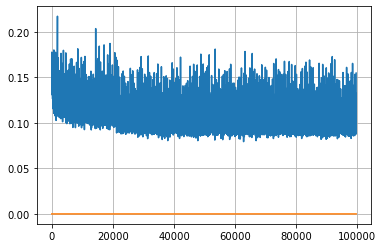

Epoch: 256, iteration 0, loss 0.10728782415390015, cov_diff 0.39556047212491763 cov_diff train 0.3960633785704941
Epoch: 256, iteration 1, loss 0.10428383946418762, cov_diff 0.4169544918217993 cov_diff train 0.4165735777563197
Epoch: 256, iteration 2, loss 0.09568169713020325, cov_diff 0.40551305861327486 cov_diff train 0.405171604738812
Epoch: 256, iteration 3, loss 0.11028414964675903, cov_diff 0.42906258710658823 cov_diff train 0.4289055631221351
Epoch: 256, iteration 4, loss 0.10302513837814331, cov_diff 0.424005016669729 cov_diff train 0.4239812407219664
Epoch: 256, iteration 5, loss 0.10514259338378906, cov_diff 0.40941031499965913 cov_diff train 0.4092158394890327
Epoch: 256, iteration 6, loss 0.09956473112106323, cov_diff 0.4231063557991542 cov_diff train 0.4224803366135561
Epoch: 256, iteration 7, loss 0.1059335470199585, cov_diff 0.4127035317651503 cov_diff train 0.4117570529913178
Epoch: 256, iteration 8, loss 0.1169101893901825, cov_diff 0.414779499877892 cov_diff train 0.4

Epoch: 256, iteration 77, loss 0.09334409236907959, cov_diff 0.40288669799487 cov_diff train 0.40283542405518485
Epoch: 256, iteration 78, loss 0.10313323140144348, cov_diff 0.42090031571125036 cov_diff train 0.41990676994179155
Epoch: 256, iteration 79, loss 0.09669679403305054, cov_diff 0.41760732025935343 cov_diff train 0.4162658321216539
Epoch: 256, iteration 80, loss 0.10010355710983276, cov_diff 0.4158227090237515 cov_diff train 0.4156962381393932
Epoch: 256, iteration 81, loss 0.105557382106781, cov_diff 0.42687694404887233 cov_diff train 0.42517294532922795
Epoch: 256, iteration 82, loss 0.11018812656402588, cov_diff 0.4163853835350027 cov_diff train 0.41467527217065714
Epoch: 256, iteration 83, loss 0.0914616584777832, cov_diff 0.4037859919183816 cov_diff train 0.40228662287578
Epoch: 256, iteration 84, loss 0.09760439395904541, cov_diff 0.42643444263674846 cov_diff train 0.4254045135567873
Epoch: 256, iteration 85, loss 0.10442033410072327, cov_diff 0.4031391309633692 cov_dif

Epoch: 256, iteration 152, loss 0.1115991473197937, cov_diff 0.41016032661589125 cov_diff train 0.41027638529384336
Epoch: 256, iteration 153, loss 0.11737203598022461, cov_diff 0.40995527671754517 cov_diff train 0.40876986378791524
Epoch: 256, iteration 154, loss 0.10071724653244019, cov_diff 0.39152545864508514 cov_diff train 0.3907558912693648
Epoch: 256, iteration 155, loss 0.10098817944526672, cov_diff 0.4244595577218185 cov_diff train 0.4237488196427659
Epoch: 256, iteration 156, loss 0.1123182475566864, cov_diff 0.4002843412149272 cov_diff train 0.40102147226458157
Epoch: 256, iteration 157, loss 0.10031911730766296, cov_diff 0.4007905891051661 cov_diff train 0.3996091557134932
Epoch: 256, iteration 158, loss 0.11385348439216614, cov_diff 0.41987920443871823 cov_diff train 0.41942013134520917
Epoch: 256, iteration 159, loss 0.10949519276618958, cov_diff 0.41130420325795125 cov_diff train 0.410605690828859
Epoch: 256, iteration 160, loss 0.11180078983306885, cov_diff 0.4005641972

Epoch: 256, iteration 229, loss 0.10839644074440002, cov_diff 0.41776563258783783 cov_diff train 0.4170639562340553
Epoch: 256, iteration 230, loss 0.09421387314796448, cov_diff 0.40476487435281977 cov_diff train 0.40450703010479777
Epoch: 256, iteration 231, loss 0.10429337620735168, cov_diff 0.41878214505619105 cov_diff train 0.4175838454084738
Epoch: 256, iteration 232, loss 0.09946957230567932, cov_diff 0.41875301851739816 cov_diff train 0.4180785747530523
Epoch: 256, iteration 233, loss 0.10797691345214844, cov_diff 0.4072320445888841 cov_diff train 0.40657860588989897
Epoch: 256, iteration 234, loss 0.10335761308670044, cov_diff 0.4185708011366167 cov_diff train 0.41789286584547836
Epoch: 256, iteration 235, loss 0.09499454498291016, cov_diff 0.41517000625765293 cov_diff train 0.4141067039133457
Epoch: 256, iteration 236, loss 0.10707363486289978, cov_diff 0.40559238425031335 cov_diff train 0.40469853306889353
Epoch: 256, iteration 237, loss 0.09840014576911926, cov_diff 0.394659

Epoch: 256, iteration 309, loss 0.09309637546539307, cov_diff 0.40705571673829916 cov_diff train 0.4062688260099749
Epoch: 256, iteration 310, loss 0.1023300290107727, cov_diff 0.41215620186418184 cov_diff train 0.4107007504471176
Epoch: 256, iteration 311, loss 0.0954345166683197, cov_diff 0.4203375456553552 cov_diff train 0.41919392642645503
Epoch: 256, iteration 312, loss 0.09166216850280762, cov_diff 0.4151303521276135 cov_diff train 0.4145537695543047
Epoch: 256, iteration 313, loss 0.10142585635185242, cov_diff 0.4144987790622512 cov_diff train 0.41215368769089944
Epoch: 256, iteration 314, loss 0.10428464412689209, cov_diff 0.4171395975819235 cov_diff train 0.41633183157302717
Epoch: 256, iteration 315, loss 0.10253968834877014, cov_diff 0.41392979494201243 cov_diff train 0.41430406414104026
Epoch: 256, iteration 316, loss 0.12010353803634644, cov_diff 0.42090099963567607 cov_diff train 0.42022842868629334
Epoch: 256, iteration 317, loss 0.09520334005355835, cov_diff 0.410104518

Epoch: 256, iteration 387, loss 0.10274994373321533, cov_diff 0.40852270269845 cov_diff train 0.4080119864749462
Epoch: 256, iteration 388, loss 0.11960220336914062, cov_diff 0.4058454613828242 cov_diff train 0.4051417951557208
Epoch: 256, iteration 389, loss 0.10825389623641968, cov_diff 0.404087220775146 cov_diff train 0.404028888182972
Epoch: 256, iteration 390, loss 0.13203415274620056, cov_diff 0.4320435916529909 cov_diff train 0.4315988831497219


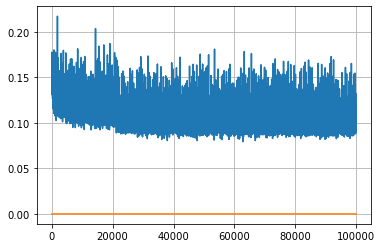

Epoch: 257, iteration 0, loss 0.10722267627716064, cov_diff 0.4134007734573393 cov_diff train 0.41198746734654007
Epoch: 257, iteration 1, loss 0.08424711227416992, cov_diff 0.40246755937141643 cov_diff train 0.4018541348197955
Epoch: 257, iteration 2, loss 0.09362101554870605, cov_diff 0.4061029305453848 cov_diff train 0.40506611980587504
Epoch: 257, iteration 3, loss 0.10514742136001587, cov_diff 0.4165879025906115 cov_diff train 0.41614989826819115
Epoch: 257, iteration 4, loss 0.09932708740234375, cov_diff 0.39732115079581876 cov_diff train 0.3970677710882478
Epoch: 257, iteration 5, loss 0.10197648406028748, cov_diff 0.40152732339464553 cov_diff train 0.4011183790464976
Epoch: 257, iteration 6, loss 0.10661599040031433, cov_diff 0.43055206031821186 cov_diff train 0.4305118942938982
Epoch: 257, iteration 7, loss 0.11336612701416016, cov_diff 0.40755502957450024 cov_diff train 0.4071927166337729
Epoch: 257, iteration 8, loss 0.09492501616477966, cov_diff 0.4144469543401904 cov_diff 

Epoch: 257, iteration 83, loss 0.11028966307640076, cov_diff 0.4177701333292985 cov_diff train 0.4164253338468419
Epoch: 257, iteration 84, loss 0.11535453796386719, cov_diff 0.4229310751478561 cov_diff train 0.42075963491169877
Epoch: 257, iteration 85, loss 0.10661199688911438, cov_diff 0.4091669265797791 cov_diff train 0.4085889459983956
Epoch: 257, iteration 86, loss 0.10051682591438293, cov_diff 0.4036893779314172 cov_diff train 0.4035903161613792
Epoch: 257, iteration 87, loss 0.10018005967140198, cov_diff 0.3976950091267334 cov_diff train 0.3975551060464159
Epoch: 257, iteration 88, loss 0.09747785329818726, cov_diff 0.411798714708034 cov_diff train 0.41132510219906276
Epoch: 257, iteration 89, loss 0.10513579845428467, cov_diff 0.4165198582741407 cov_diff train 0.41737800085808885
Epoch: 257, iteration 90, loss 0.09923848509788513, cov_diff 0.397781264444725 cov_diff train 0.3969680144238516
Epoch: 257, iteration 91, loss 0.10333743691444397, cov_diff 0.41506979162905244 cov_di

Epoch: 257, iteration 161, loss 0.1030750572681427, cov_diff 0.41409278679088446 cov_diff train 0.4137223493469745
Epoch: 257, iteration 162, loss 0.11507236957550049, cov_diff 0.4217379088738109 cov_diff train 0.42104488499645165
Epoch: 257, iteration 163, loss 0.1054234504699707, cov_diff 0.41963586391534413 cov_diff train 0.419436379205976
Epoch: 257, iteration 164, loss 0.10187798738479614, cov_diff 0.41157619425784125 cov_diff train 0.41087237413026423
Epoch: 257, iteration 165, loss 0.11487531661987305, cov_diff 0.396398823576432 cov_diff train 0.3951167374065964
Epoch: 257, iteration 166, loss 0.09819835424423218, cov_diff 0.4102513334585454 cov_diff train 0.41001983380085555
Epoch: 257, iteration 167, loss 0.10364234447479248, cov_diff 0.4202726883875263 cov_diff train 0.4210746875416426
Epoch: 257, iteration 168, loss 0.10401791334152222, cov_diff 0.4196273896702224 cov_diff train 0.4190823803762468
Epoch: 257, iteration 169, loss 0.10266280174255371, cov_diff 0.40061229089462

Epoch: 257, iteration 238, loss 0.10282257199287415, cov_diff 0.407763137823951 cov_diff train 0.40772838324366034
Epoch: 257, iteration 239, loss 0.10452362895011902, cov_diff 0.4201378534611889 cov_diff train 0.4194690574430664
Epoch: 257, iteration 240, loss 0.09946227073669434, cov_diff 0.4159971833777712 cov_diff train 0.4148572415181186
Epoch: 257, iteration 241, loss 0.1133970320224762, cov_diff 0.4232345504708823 cov_diff train 0.42291848569524576
Epoch: 257, iteration 242, loss 0.11930516362190247, cov_diff 0.438654167853961 cov_diff train 0.43707873812218906
Epoch: 257, iteration 243, loss 0.10291990637779236, cov_diff 0.40308472630899633 cov_diff train 0.4023977266615779
Epoch: 257, iteration 244, loss 0.10134568810462952, cov_diff 0.4202543930396098 cov_diff train 0.42003779676322045
Epoch: 257, iteration 245, loss 0.10875844955444336, cov_diff 0.40579194391933116 cov_diff train 0.4052749581991353
Epoch: 257, iteration 246, loss 0.10716676712036133, cov_diff 0.3961335935421

Epoch: 257, iteration 317, loss 0.09623944759368896, cov_diff 0.41856202543438387 cov_diff train 0.4174697629240896
Epoch: 257, iteration 318, loss 0.11259806156158447, cov_diff 0.4161288065515135 cov_diff train 0.41442506441815197
Epoch: 257, iteration 319, loss 0.09807851910591125, cov_diff 0.42688674158821815 cov_diff train 0.42583722516334155
Epoch: 257, iteration 320, loss 0.1026214063167572, cov_diff 0.4006150895750544 cov_diff train 0.3996100918679694
Epoch: 257, iteration 321, loss 0.10630825161933899, cov_diff 0.4096542143988905 cov_diff train 0.40766518962484855
Epoch: 257, iteration 322, loss 0.11336863040924072, cov_diff 0.40379863477400946 cov_diff train 0.40336156513240623
Epoch: 257, iteration 323, loss 0.10386538505554199, cov_diff 0.42703745483537836 cov_diff train 0.42653990820969395
Epoch: 257, iteration 324, loss 0.10540017485618591, cov_diff 0.40954032429453646 cov_diff train 0.40835409097622205
Epoch: 257, iteration 325, loss 0.09566861391067505, cov_diff 0.399420

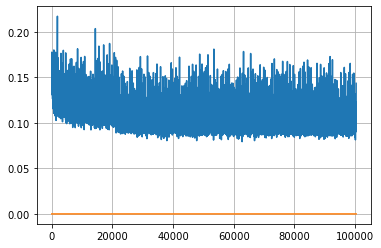

Epoch: 258, iteration 0, loss 0.09442651271820068, cov_diff 0.4163563747056758 cov_diff train 0.4158877011909616
Epoch: 258, iteration 1, loss 0.10434824228286743, cov_diff 0.40386705263079503 cov_diff train 0.4031658229964431
Epoch: 258, iteration 2, loss 0.1001623272895813, cov_diff 0.3993293125527966 cov_diff train 0.3988550353183093
Epoch: 258, iteration 3, loss 0.08804568648338318, cov_diff 0.41341368290501546 cov_diff train 0.41274058329390206
Epoch: 258, iteration 4, loss 0.10024946928024292, cov_diff 0.39947657086463245 cov_diff train 0.39826110983238167
Epoch: 258, iteration 5, loss 0.12076014280319214, cov_diff 0.3969784938249491 cov_diff train 0.397078631858079
Epoch: 258, iteration 6, loss 0.10317069292068481, cov_diff 0.40617514988020986 cov_diff train 0.4053180868390531
Epoch: 258, iteration 7, loss 0.09935230016708374, cov_diff 0.4011047049827365 cov_diff train 0.3995560909565308
Epoch: 258, iteration 8, loss 0.10707283020019531, cov_diff 0.4059703988954014 cov_diff trai

Epoch: 258, iteration 78, loss 0.09807273745536804, cov_diff 0.4078235847348296 cov_diff train 0.4064032887860711
Epoch: 258, iteration 79, loss 0.10037347674369812, cov_diff 0.408124666434143 cov_diff train 0.40741098706904627
Epoch: 258, iteration 80, loss 0.09669849276542664, cov_diff 0.40365317041965254 cov_diff train 0.40305082285816746
Epoch: 258, iteration 81, loss 0.10691908001899719, cov_diff 0.4067739760517867 cov_diff train 0.4062896458502503
Epoch: 258, iteration 82, loss 0.0979682207107544, cov_diff 0.40267665953003845 cov_diff train 0.40225865470543837
Epoch: 258, iteration 83, loss 0.12022453546524048, cov_diff 0.4072493776525042 cov_diff train 0.4075997003219155
Epoch: 258, iteration 84, loss 0.10708895325660706, cov_diff 0.4149336391782998 cov_diff train 0.4134388323694366
Epoch: 258, iteration 85, loss 0.1012524962425232, cov_diff 0.4123606787077758 cov_diff train 0.41259644887286995
Epoch: 258, iteration 86, loss 0.11156943440437317, cov_diff 0.420925301747545 cov_di

Epoch: 258, iteration 155, loss 0.10225173830986023, cov_diff 0.4194257782454886 cov_diff train 0.41902038060010066
Epoch: 258, iteration 156, loss 0.10180947184562683, cov_diff 0.41452960329767286 cov_diff train 0.4130948610074654
Epoch: 258, iteration 157, loss 0.10993003845214844, cov_diff 0.4182733384512956 cov_diff train 0.41781273772238864
Epoch: 258, iteration 158, loss 0.10235103964805603, cov_diff 0.4111531475357511 cov_diff train 0.40994278832922015
Epoch: 258, iteration 159, loss 0.11166968941688538, cov_diff 0.4189300754133833 cov_diff train 0.41785100823135757
Epoch: 258, iteration 160, loss 0.09241944551467896, cov_diff 0.4123734940432364 cov_diff train 0.4119009663448153
Epoch: 258, iteration 161, loss 0.10828626155853271, cov_diff 0.4198040024812035 cov_diff train 0.41949527081008214
Epoch: 258, iteration 162, loss 0.09558653831481934, cov_diff 0.41115871104011126 cov_diff train 0.40940593946368714
Epoch: 258, iteration 163, loss 0.11116018891334534, cov_diff 0.41675793

Epoch: 258, iteration 232, loss 0.0938805341720581, cov_diff 0.4124037417979278 cov_diff train 0.41167823590729036
Epoch: 258, iteration 233, loss 0.12681463360786438, cov_diff 0.41526714262838776 cov_diff train 0.41379317703937124
Epoch: 258, iteration 234, loss 0.1020263135433197, cov_diff 0.4058299655818713 cov_diff train 0.4049685935376599
Epoch: 258, iteration 235, loss 0.10510212182998657, cov_diff 0.4291285690764627 cov_diff train 0.4280984454610597
Epoch: 258, iteration 236, loss 0.1077650785446167, cov_diff 0.42002289142744337 cov_diff train 0.4192176003984652
Epoch: 258, iteration 237, loss 0.10044160485267639, cov_diff 0.42128806605033 cov_diff train 0.4210940684045359
Epoch: 258, iteration 238, loss 0.1060304045677185, cov_diff 0.4054299660417602 cov_diff train 0.40346398769480835
Epoch: 258, iteration 239, loss 0.09945106506347656, cov_diff 0.39766561368109443 cov_diff train 0.39714330132317704
Epoch: 258, iteration 240, loss 0.117320716381073, cov_diff 0.4108505630337321 

Epoch: 258, iteration 309, loss 0.09528180956840515, cov_diff 0.4109954527464491 cov_diff train 0.4097199640982095
Epoch: 258, iteration 310, loss 0.1032736599445343, cov_diff 0.4201821619721975 cov_diff train 0.4190958047355037
Epoch: 258, iteration 311, loss 0.10273200273513794, cov_diff 0.40038421796344476 cov_diff train 0.3986336790532639
Epoch: 258, iteration 312, loss 0.10743281245231628, cov_diff 0.4130987060606508 cov_diff train 0.41179331857051926
Epoch: 258, iteration 313, loss 0.10285288095474243, cov_diff 0.41301256325232205 cov_diff train 0.41247893310159933
Epoch: 258, iteration 314, loss 0.09780749678611755, cov_diff 0.4148081033606358 cov_diff train 0.41383007552024753
Epoch: 258, iteration 315, loss 0.10144218802452087, cov_diff 0.409500753302364 cov_diff train 0.40911881923414395
Epoch: 258, iteration 316, loss 0.10365015268325806, cov_diff 0.4138582125378668 cov_diff train 0.41318553302479866
Epoch: 258, iteration 317, loss 0.1100803017616272, cov_diff 0.404025636449

Epoch: 258, iteration 387, loss 0.09720441699028015, cov_diff 0.40296916664888216 cov_diff train 0.40227310066616956
Epoch: 258, iteration 388, loss 0.11657920479774475, cov_diff 0.3940166100418302 cov_diff train 0.3932841529579923
Epoch: 258, iteration 389, loss 0.11575981974601746, cov_diff 0.4308954497057527 cov_diff train 0.4303686912922874
Epoch: 258, iteration 390, loss 0.14277216792106628, cov_diff 0.4564491349174313 cov_diff train 0.45624950161238903


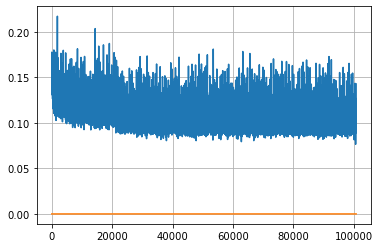

Epoch: 259, iteration 0, loss 0.09815198183059692, cov_diff 0.4328342384623857 cov_diff train 0.43131622521086194
Epoch: 259, iteration 1, loss 0.11090126633644104, cov_diff 0.41279281645921256 cov_diff train 0.4115331412721348
Epoch: 259, iteration 2, loss 0.10606610774993896, cov_diff 0.40769603833507917 cov_diff train 0.40809396525101854
Epoch: 259, iteration 3, loss 0.11169266700744629, cov_diff 0.41839497838512085 cov_diff train 0.4182629797133046
Epoch: 259, iteration 4, loss 0.08583328127861023, cov_diff 0.41380554896660865 cov_diff train 0.4136408301220565
Epoch: 259, iteration 5, loss 0.1092272400856018, cov_diff 0.41152446919598296 cov_diff train 0.41051135163954616
Epoch: 259, iteration 6, loss 0.09665283560752869, cov_diff 0.4102719162809015 cov_diff train 0.4096807919230751
Epoch: 259, iteration 7, loss 0.0992996096611023, cov_diff 0.4143096507190875 cov_diff train 0.41290743265416135
Epoch: 259, iteration 8, loss 0.10961440205574036, cov_diff 0.41136594947330907 cov_diff 

Epoch: 259, iteration 75, loss 0.09821265935897827, cov_diff 0.4202771921686601 cov_diff train 0.419450794659965
Epoch: 259, iteration 76, loss 0.10560238361358643, cov_diff 0.42416222718632624 cov_diff train 0.423480138653832
Epoch: 259, iteration 77, loss 0.10170751810073853, cov_diff 0.42172429984367416 cov_diff train 0.4207026864449435
Epoch: 259, iteration 78, loss 0.09888774156570435, cov_diff 0.4192213687124943 cov_diff train 0.4184019017123255
Epoch: 259, iteration 79, loss 0.11029225587844849, cov_diff 0.40966935060829396 cov_diff train 0.40910923753053074
Epoch: 259, iteration 80, loss 0.10593700408935547, cov_diff 0.4160313832949223 cov_diff train 0.41556123505580783
Epoch: 259, iteration 81, loss 0.10648790001869202, cov_diff 0.4171992907174227 cov_diff train 0.41653200266094115
Epoch: 259, iteration 82, loss 0.09662458300590515, cov_diff 0.4133113214822817 cov_diff train 0.41275160035102165
Epoch: 259, iteration 83, loss 0.10800212621688843, cov_diff 0.4139747926901294 cov

Epoch: 259, iteration 151, loss 0.0997554361820221, cov_diff 0.41282279523304233 cov_diff train 0.4122226221911339
Epoch: 259, iteration 152, loss 0.11087596416473389, cov_diff 0.4139374042897396 cov_diff train 0.41340054450787683
Epoch: 259, iteration 153, loss 0.11098635196685791, cov_diff 0.41196650975921445 cov_diff train 0.41164387429750965
Epoch: 259, iteration 154, loss 0.12630215287208557, cov_diff 0.4127872411592435 cov_diff train 0.41282194182890913
Epoch: 259, iteration 155, loss 0.10939094424247742, cov_diff 0.40524190089308076 cov_diff train 0.40452213731280157
Epoch: 259, iteration 156, loss 0.10419178009033203, cov_diff 0.40405660796402165 cov_diff train 0.40368848051984985
Epoch: 259, iteration 157, loss 0.10905468463897705, cov_diff 0.3971238185223744 cov_diff train 0.3972011826731872
Epoch: 259, iteration 158, loss 0.11671200394630432, cov_diff 0.4253804715764542 cov_diff train 0.4238536795141717
Epoch: 259, iteration 159, loss 0.11571931838989258, cov_diff 0.42266217

Epoch: 259, iteration 229, loss 0.09397327899932861, cov_diff 0.40409630920886386 cov_diff train 0.4034210444700122
Epoch: 259, iteration 230, loss 0.10875526070594788, cov_diff 0.415580242781786 cov_diff train 0.4147112325465216
Epoch: 259, iteration 231, loss 0.10983356833457947, cov_diff 0.4044209111092977 cov_diff train 0.40407504291081503
Epoch: 259, iteration 232, loss 0.10247072577476501, cov_diff 0.411828857475933 cov_diff train 0.4110580075208294
Epoch: 259, iteration 233, loss 0.10702499747276306, cov_diff 0.4124471149927966 cov_diff train 0.4117198161600847
Epoch: 259, iteration 234, loss 0.10289210081100464, cov_diff 0.41079246673680264 cov_diff train 0.40989418509974646
Epoch: 259, iteration 235, loss 0.09366485476493835, cov_diff 0.4101444559396874 cov_diff train 0.40998233823717734
Epoch: 259, iteration 236, loss 0.10405680537223816, cov_diff 0.4222755248592273 cov_diff train 0.4220535534839911
Epoch: 259, iteration 237, loss 0.09918728470802307, cov_diff 0.3979718286355

Epoch: 259, iteration 307, loss 0.09974980354309082, cov_diff 0.41050442190066383 cov_diff train 0.4102501347356955
Epoch: 259, iteration 308, loss 0.1117418110370636, cov_diff 0.4179143372207828 cov_diff train 0.4170905451141014
Epoch: 259, iteration 309, loss 0.10257145762443542, cov_diff 0.4128304558680548 cov_diff train 0.4116591548918292
Epoch: 259, iteration 310, loss 0.10800933837890625, cov_diff 0.4056581613575649 cov_diff train 0.40586120613417426
Epoch: 259, iteration 311, loss 0.0962778627872467, cov_diff 0.4253034853161373 cov_diff train 0.42495575892162524
Epoch: 259, iteration 312, loss 0.1103551983833313, cov_diff 0.4128010439322873 cov_diff train 0.4120883217242956
Epoch: 259, iteration 313, loss 0.1033315360546112, cov_diff 0.4085221876306666 cov_diff train 0.40835364830581383
Epoch: 259, iteration 314, loss 0.09382349252700806, cov_diff 0.41052859723496327 cov_diff train 0.40982168284509957
Epoch: 259, iteration 315, loss 0.11105579137802124, cov_diff 0.41086958332676

Epoch: 259, iteration 385, loss 0.11225998401641846, cov_diff 0.413869087817779 cov_diff train 0.41303706329326173
Epoch: 259, iteration 386, loss 0.09681513905525208, cov_diff 0.40608433508102215 cov_diff train 0.40596413574160833
Epoch: 259, iteration 387, loss 0.09841427206993103, cov_diff 0.4206709360219792 cov_diff train 0.4200117026981961
Epoch: 259, iteration 388, loss 0.1041441559791565, cov_diff 0.4213357969666717 cov_diff train 0.42105836340610264
Epoch: 259, iteration 389, loss 0.09291660785675049, cov_diff 0.4132297936730894 cov_diff train 0.4130451035549383
Epoch: 259, iteration 390, loss 0.1417815089225769, cov_diff 0.4537089824316525 cov_diff train 0.45345139977910187


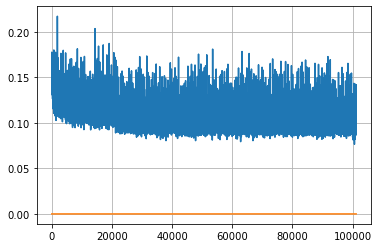

Epoch: 260, iteration 0, loss 0.09414875507354736, cov_diff 0.4096137050255886 cov_diff train 0.4105154645640955
Epoch: 260, iteration 1, loss 0.0976594090461731, cov_diff 0.42628606887830967 cov_diff train 0.4249168316906101
Epoch: 260, iteration 2, loss 0.09432271122932434, cov_diff 0.42866517846036645 cov_diff train 0.4275969349257436
Epoch: 260, iteration 3, loss 0.10303124785423279, cov_diff 0.41350185027351927 cov_diff train 0.4133777790587853
Epoch: 260, iteration 4, loss 0.1124521791934967, cov_diff 0.41949124716987474 cov_diff train 0.41956549900585227
Epoch: 260, iteration 5, loss 0.10824808478355408, cov_diff 0.42172265925089714 cov_diff train 0.4201564614733425
Epoch: 260, iteration 6, loss 0.0971321165561676, cov_diff 0.41286141298313517 cov_diff train 0.4123662435474525
Epoch: 260, iteration 7, loss 0.10391107201576233, cov_diff 0.4101122510942642 cov_diff train 0.4098290210222596
Epoch: 260, iteration 8, loss 0.11536994576454163, cov_diff 0.4171827645931696 cov_diff trai

Epoch: 260, iteration 72, loss 0.10275346040725708, cov_diff 0.40410840193876935 cov_diff train 0.40396549801896686
Epoch: 260, iteration 73, loss 0.10283505916595459, cov_diff 0.4184614559353975 cov_diff train 0.4179375859131059
Epoch: 260, iteration 74, loss 0.10648486018180847, cov_diff 0.4092827689596465 cov_diff train 0.40887295107009647
Epoch: 260, iteration 75, loss 0.09701478481292725, cov_diff 0.42324364214881555 cov_diff train 0.4225470806828438
Epoch: 260, iteration 76, loss 0.09159582853317261, cov_diff 0.422946722089614 cov_diff train 0.4220642884471329
Epoch: 260, iteration 77, loss 0.10158956050872803, cov_diff 0.42753780386815393 cov_diff train 0.4276372377822669
Epoch: 260, iteration 78, loss 0.10674896836280823, cov_diff 0.42182541976019083 cov_diff train 0.4216309241298786
Epoch: 260, iteration 79, loss 0.103385329246521, cov_diff 0.4124132144080138 cov_diff train 0.4124336390313593
Epoch: 260, iteration 80, loss 0.10164844989776611, cov_diff 0.40626126022753056 cov_

Epoch: 260, iteration 152, loss 0.10872343182563782, cov_diff 0.41423403974143214 cov_diff train 0.4134798866314024
Epoch: 260, iteration 153, loss 0.0996936559677124, cov_diff 0.41650457702045224 cov_diff train 0.4152762849217785
Epoch: 260, iteration 154, loss 0.10361495614051819, cov_diff 0.4082027134250492 cov_diff train 0.4073512837646548
Epoch: 260, iteration 155, loss 0.0964270532131195, cov_diff 0.4045152312226214 cov_diff train 0.4047167129611556
Epoch: 260, iteration 156, loss 0.10797476768493652, cov_diff 0.40908968136985496 cov_diff train 0.4091697726863271
Epoch: 260, iteration 157, loss 0.10194888710975647, cov_diff 0.4288275562640396 cov_diff train 0.42917019258924854
Epoch: 260, iteration 158, loss 0.09386247396469116, cov_diff 0.42080495331435397 cov_diff train 0.42065603166210647
Epoch: 260, iteration 159, loss 0.09418049454689026, cov_diff 0.402272804927364 cov_diff train 0.4023129371610671
Epoch: 260, iteration 160, loss 0.09573712944984436, cov_diff 0.4127211894200

Epoch: 260, iteration 230, loss 0.10214614868164062, cov_diff 0.4094408912693658 cov_diff train 0.4085588588462713
Epoch: 260, iteration 231, loss 0.10911467671394348, cov_diff 0.41595406265521584 cov_diff train 0.4148111525803067
Epoch: 260, iteration 232, loss 0.11018761992454529, cov_diff 0.39836600873336975 cov_diff train 0.3971329830470375
Epoch: 260, iteration 233, loss 0.11167290806770325, cov_diff 0.42882912151116487 cov_diff train 0.4279377472360456
Epoch: 260, iteration 234, loss 0.10856384038925171, cov_diff 0.4139892396655603 cov_diff train 0.41289833734065146
Epoch: 260, iteration 235, loss 0.10446116328239441, cov_diff 0.4129675562698465 cov_diff train 0.4121253340864449
Epoch: 260, iteration 236, loss 0.10616475343704224, cov_diff 0.40839413976755 cov_diff train 0.408075064549973
Epoch: 260, iteration 237, loss 0.09977555274963379, cov_diff 0.4259036641415408 cov_diff train 0.42514546944605036
Epoch: 260, iteration 238, loss 0.10971590876579285, cov_diff 0.41581713174093

Epoch: 260, iteration 304, loss 0.10006532073020935, cov_diff 0.41889110957413256 cov_diff train 0.4191396867733232
Epoch: 260, iteration 305, loss 0.10007935762405396, cov_diff 0.410576556129646 cov_diff train 0.4100711215888012
Epoch: 260, iteration 306, loss 0.10719415545463562, cov_diff 0.4168367040599796 cov_diff train 0.4157788350385996
Epoch: 260, iteration 307, loss 0.10259681940078735, cov_diff 0.4279343010204859 cov_diff train 0.4271713083399765
Epoch: 260, iteration 308, loss 0.1113021969795227, cov_diff 0.41110733778833836 cov_diff train 0.41002383538077797
Epoch: 260, iteration 309, loss 0.11892277002334595, cov_diff 0.4294935855877476 cov_diff train 0.4290525524556219
Epoch: 260, iteration 310, loss 0.10826930403709412, cov_diff 0.4099710042520945 cov_diff train 0.4095587004340121
Epoch: 260, iteration 311, loss 0.10259044170379639, cov_diff 0.42033065196245156 cov_diff train 0.42038124744196226
Epoch: 260, iteration 312, loss 0.10932186245918274, cov_diff 0.4303603218258

Epoch: 260, iteration 380, loss 0.10093551874160767, cov_diff 0.4148599928426329 cov_diff train 0.41426023256411204
Epoch: 260, iteration 381, loss 0.10084947943687439, cov_diff 0.4199899530321645 cov_diff train 0.4198436890783097
Epoch: 260, iteration 382, loss 0.10265347361564636, cov_diff 0.39922097068028334 cov_diff train 0.39937976288444477
Epoch: 260, iteration 383, loss 0.11132490634918213, cov_diff 0.4024444237720723 cov_diff train 0.40212264459933156
Epoch: 260, iteration 384, loss 0.09957394003868103, cov_diff 0.41929762068146353 cov_diff train 0.4187600398646913
Epoch: 260, iteration 385, loss 0.10361099243164062, cov_diff 0.42139967248619953 cov_diff train 0.4213135033137466
Epoch: 260, iteration 386, loss 0.09880399703979492, cov_diff 0.4088956146035518 cov_diff train 0.40842038735352565
Epoch: 260, iteration 387, loss 0.09453526139259338, cov_diff 0.414912910812313 cov_diff train 0.41493185643947395
Epoch: 260, iteration 388, loss 0.10812026262283325, cov_diff 0.398639431

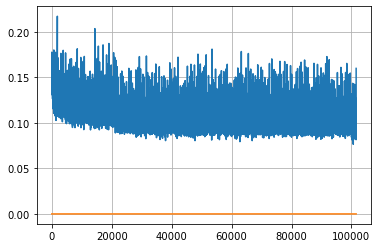

Epoch: 261, iteration 0, loss 0.10017120838165283, cov_diff 0.4156929449413253 cov_diff train 0.41569563987603075
Epoch: 261, iteration 1, loss 0.09721416234970093, cov_diff 0.4224466471638091 cov_diff train 0.4208218963234532
Epoch: 261, iteration 2, loss 0.10477346181869507, cov_diff 0.4130793015567476 cov_diff train 0.4122791916073011
Epoch: 261, iteration 3, loss 0.10946676135063171, cov_diff 0.41227297642259325 cov_diff train 0.41223721241872857
Epoch: 261, iteration 4, loss 0.12379929423332214, cov_diff 0.4080222752224763 cov_diff train 0.40707194189683354
Epoch: 261, iteration 5, loss 0.10200449824333191, cov_diff 0.4049982233074708 cov_diff train 0.40424699117101454
Epoch: 261, iteration 6, loss 0.10621276497840881, cov_diff 0.4311672478354607 cov_diff train 0.43078117142797534
Epoch: 261, iteration 7, loss 0.09993907809257507, cov_diff 0.4077514024229103 cov_diff train 0.4070195623899916
Epoch: 261, iteration 8, loss 0.11120942234992981, cov_diff 0.4252266867718992 cov_diff tr

Epoch: 261, iteration 77, loss 0.11173450946807861, cov_diff 0.4114543041422798 cov_diff train 0.41036196803138536
Epoch: 261, iteration 78, loss 0.11125555634498596, cov_diff 0.4262945407326732 cov_diff train 0.4254775037873716
Epoch: 261, iteration 79, loss 0.09963276982307434, cov_diff 0.4158613164239867 cov_diff train 0.4149863614729368
Epoch: 261, iteration 80, loss 0.10555964708328247, cov_diff 0.4131342674050726 cov_diff train 0.41211777425144375
Epoch: 261, iteration 81, loss 0.10076248645782471, cov_diff 0.4092316028402459 cov_diff train 0.40924164303856864
Epoch: 261, iteration 82, loss 0.10088121891021729, cov_diff 0.4104267302693771 cov_diff train 0.4097287945654977
Epoch: 261, iteration 83, loss 0.10101166367530823, cov_diff 0.4299897541703563 cov_diff train 0.4293612982876084
Epoch: 261, iteration 84, loss 0.09400355815887451, cov_diff 0.4134541316778615 cov_diff train 0.4134459494740567
Epoch: 261, iteration 85, loss 0.10494720935821533, cov_diff 0.41421571996127576 cov_

Epoch: 261, iteration 152, loss 0.09724891185760498, cov_diff 0.4152354300973995 cov_diff train 0.4147054906846222
Epoch: 261, iteration 153, loss 0.11839368939399719, cov_diff 0.41522327835528944 cov_diff train 0.4144945218987641
Epoch: 261, iteration 154, loss 0.10791879892349243, cov_diff 0.4243662937485655 cov_diff train 0.42422032866201037
Epoch: 261, iteration 155, loss 0.09774911403656006, cov_diff 0.4148165535942103 cov_diff train 0.4148568027254419
Epoch: 261, iteration 156, loss 0.10076490044593811, cov_diff 0.4131903404712644 cov_diff train 0.4131603849813049
Epoch: 261, iteration 157, loss 0.10514089465141296, cov_diff 0.40057165607294803 cov_diff train 0.4012190941760743
Epoch: 261, iteration 158, loss 0.11041957139968872, cov_diff 0.43108604118169064 cov_diff train 0.4305021819579559
Epoch: 261, iteration 159, loss 0.10965526103973389, cov_diff 0.41721919067271446 cov_diff train 0.41681650677060356
Epoch: 261, iteration 160, loss 0.11790168285369873, cov_diff 0.4208339341

Epoch: 261, iteration 229, loss 0.1128903329372406, cov_diff 0.4061506187963391 cov_diff train 0.40551471331415834
Epoch: 261, iteration 230, loss 0.10306712985038757, cov_diff 0.41169813937946576 cov_diff train 0.4113327026948391
Epoch: 261, iteration 231, loss 0.09195765852928162, cov_diff 0.42203641468728825 cov_diff train 0.42032954135977313
Epoch: 261, iteration 232, loss 0.105234295129776, cov_diff 0.4239872864231302 cov_diff train 0.42340288148482147
Epoch: 261, iteration 233, loss 0.10961028933525085, cov_diff 0.41669914398591396 cov_diff train 0.41510339925895917
Epoch: 261, iteration 234, loss 0.10434910655021667, cov_diff 0.41207017756500214 cov_diff train 0.4116228361027156
Epoch: 261, iteration 235, loss 0.1033945381641388, cov_diff 0.42228996761818743 cov_diff train 0.42139465984121394
Epoch: 261, iteration 236, loss 0.11116138100624084, cov_diff 0.4055437624231688 cov_diff train 0.404872317055096
Epoch: 261, iteration 237, loss 0.10029205679893494, cov_diff 0.41921238356

Epoch: 261, iteration 306, loss 0.10638442635536194, cov_diff 0.40584885443580065 cov_diff train 0.405457585687865
Epoch: 261, iteration 307, loss 0.10580870509147644, cov_diff 0.4073195248397554 cov_diff train 0.4072974941373277
Epoch: 261, iteration 308, loss 0.10120886564254761, cov_diff 0.4145558754575742 cov_diff train 0.41371010899228206
Epoch: 261, iteration 309, loss 0.09830024838447571, cov_diff 0.41176713156488737 cov_diff train 0.41096700221580973
Epoch: 261, iteration 310, loss 0.10848364233970642, cov_diff 0.4001223531555774 cov_diff train 0.39989015277115597
Epoch: 261, iteration 311, loss 0.09895902872085571, cov_diff 0.406576266420434 cov_diff train 0.4069539762551009
Epoch: 261, iteration 312, loss 0.10202917456626892, cov_diff 0.4097531244815624 cov_diff train 0.40952503751075103
Epoch: 261, iteration 313, loss 0.10336703062057495, cov_diff 0.3942889986376191 cov_diff train 0.3936522913113297
Epoch: 261, iteration 314, loss 0.0911860466003418, cov_diff 0.4103692636022

Epoch: 261, iteration 380, loss 0.09537637233734131, cov_diff 0.41476080463135845 cov_diff train 0.4145073524509625
Epoch: 261, iteration 381, loss 0.09850826859474182, cov_diff 0.41275401386771776 cov_diff train 0.4121422579989078
Epoch: 261, iteration 382, loss 0.10359412431716919, cov_diff 0.41433772370186195 cov_diff train 0.41375961320737137
Epoch: 261, iteration 383, loss 0.09955117106437683, cov_diff 0.40908110289434907 cov_diff train 0.408101879647374
Epoch: 261, iteration 384, loss 0.10458710789680481, cov_diff 0.41906311878742974 cov_diff train 0.41920778353683374
Epoch: 261, iteration 385, loss 0.09478473663330078, cov_diff 0.4206515469824494 cov_diff train 0.42026133904296886
Epoch: 261, iteration 386, loss 0.10063531994819641, cov_diff 0.41073204128539803 cov_diff train 0.4104854173080421
Epoch: 261, iteration 387, loss 0.10839235782623291, cov_diff 0.41946057193102304 cov_diff train 0.41939509772139977
Epoch: 261, iteration 388, loss 0.10286852717399597, cov_diff 0.418683

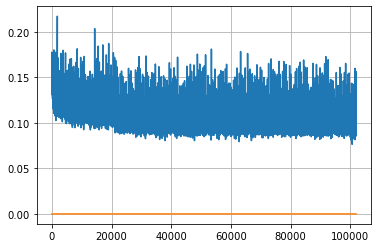

Epoch: 262, iteration 0, loss 0.09712079167366028, cov_diff 0.40630187356818837 cov_diff train 0.406088191848246
Epoch: 262, iteration 1, loss 0.09852471947669983, cov_diff 0.39998189829525505 cov_diff train 0.3995905388759762
Epoch: 262, iteration 2, loss 0.1061846911907196, cov_diff 0.4041834939182962 cov_diff train 0.40338677389333893
Epoch: 262, iteration 3, loss 0.10527104139328003, cov_diff 0.41666738413213994 cov_diff train 0.41634916768578306
Epoch: 262, iteration 4, loss 0.10894542932510376, cov_diff 0.4160309359975029 cov_diff train 0.4159124618531825
Epoch: 262, iteration 5, loss 0.09845501184463501, cov_diff 0.4160833103008652 cov_diff train 0.41449364688210805
Epoch: 262, iteration 6, loss 0.10166528820991516, cov_diff 0.40309565943828296 cov_diff train 0.40298071258685475
Epoch: 262, iteration 7, loss 0.10321465134620667, cov_diff 0.4242666162395433 cov_diff train 0.4234941215574238
Epoch: 262, iteration 8, loss 0.09356483817100525, cov_diff 0.413815973565255 cov_diff tra

Epoch: 262, iteration 75, loss 0.11583149433135986, cov_diff 0.41999496267863534 cov_diff train 0.4177146874283578
Epoch: 262, iteration 76, loss 0.10212156176567078, cov_diff 0.41547658868616927 cov_diff train 0.41465559780157407
Epoch: 262, iteration 77, loss 0.09866148233413696, cov_diff 0.4390725142335011 cov_diff train 0.4381074936778943
Epoch: 262, iteration 78, loss 0.09827890992164612, cov_diff 0.4180707955993476 cov_diff train 0.41778170822981225
Epoch: 262, iteration 79, loss 0.09587481617927551, cov_diff 0.419198741713293 cov_diff train 0.4185909088227553
Epoch: 262, iteration 80, loss 0.12845003604888916, cov_diff 0.4210387625981418 cov_diff train 0.42076972792462725
Epoch: 262, iteration 81, loss 0.09733283519744873, cov_diff 0.41851441582220655 cov_diff train 0.4179833595572729
Epoch: 262, iteration 82, loss 0.11705005168914795, cov_diff 0.39737091472788544 cov_diff train 0.39732742547638505
Epoch: 262, iteration 83, loss 0.10540211200714111, cov_diff 0.4219388760963534 c

Epoch: 262, iteration 150, loss 0.09356275200843811, cov_diff 0.4164112978260618 cov_diff train 0.4156396521382742
Epoch: 262, iteration 151, loss 0.10375553369522095, cov_diff 0.4125420201301848 cov_diff train 0.41179435169386
Epoch: 262, iteration 152, loss 0.1068190336227417, cov_diff 0.4080024644321886 cov_diff train 0.40714780840137893
Epoch: 262, iteration 153, loss 0.09562191367149353, cov_diff 0.41745197305460935 cov_diff train 0.41685884702081527
Epoch: 262, iteration 154, loss 0.09694111347198486, cov_diff 0.41677559466266884 cov_diff train 0.4160919903316575
Epoch: 262, iteration 155, loss 0.09015721082687378, cov_diff 0.42409032728818236 cov_diff train 0.4235484206865445
Epoch: 262, iteration 156, loss 0.09524381160736084, cov_diff 0.4087228928433207 cov_diff train 0.4080811787768426
Epoch: 262, iteration 157, loss 0.10041147470474243, cov_diff 0.41362485378029085 cov_diff train 0.412485409733949
Epoch: 262, iteration 158, loss 0.11431354284286499, cov_diff 0.41044532856591

Epoch: 262, iteration 226, loss 0.10753792524337769, cov_diff 0.41170509059543087 cov_diff train 0.41200645853945794
Epoch: 262, iteration 227, loss 0.11198067665100098, cov_diff 0.4099014468416277 cov_diff train 0.4094156438399475
Epoch: 262, iteration 228, loss 0.10399559140205383, cov_diff 0.40184414679051556 cov_diff train 0.4024467955685747
Epoch: 262, iteration 229, loss 0.10860860347747803, cov_diff 0.4254389882244727 cov_diff train 0.4254801075583834
Epoch: 262, iteration 230, loss 0.10110750794410706, cov_diff 0.4156614485038755 cov_diff train 0.41537423774366317
Epoch: 262, iteration 231, loss 0.10083478689193726, cov_diff 0.4224025009412512 cov_diff train 0.4219861238138773
Epoch: 262, iteration 232, loss 0.11623290181159973, cov_diff 0.42049233057304714 cov_diff train 0.42008193464445326
Epoch: 262, iteration 233, loss 0.10110348463058472, cov_diff 0.4138005583780012 cov_diff train 0.4132293631735311
Epoch: 262, iteration 234, loss 0.08804148435592651, cov_diff 0.4076257041

Epoch: 262, iteration 304, loss 0.10695001482963562, cov_diff 0.41908757861826584 cov_diff train 0.41864769251958095
Epoch: 262, iteration 305, loss 0.10795888304710388, cov_diff 0.4082988563794244 cov_diff train 0.4078214457760892
Epoch: 262, iteration 306, loss 0.11649295687675476, cov_diff 0.3997658512700945 cov_diff train 0.3992037294148279
Epoch: 262, iteration 307, loss 0.1051676869392395, cov_diff 0.40477924971304224 cov_diff train 0.40460792938550555
Epoch: 262, iteration 308, loss 0.11581733822822571, cov_diff 0.40975137212488605 cov_diff train 0.4089893126473326
Epoch: 262, iteration 309, loss 0.10652878880500793, cov_diff 0.40765062941313984 cov_diff train 0.40719050342458263
Epoch: 262, iteration 310, loss 0.10850632190704346, cov_diff 0.4102031064787058 cov_diff train 0.4099574289690515
Epoch: 262, iteration 311, loss 0.09639868140220642, cov_diff 0.4157787586886934 cov_diff train 0.4157237683323189
Epoch: 262, iteration 312, loss 0.09517833590507507, cov_diff 0.4032443063

Epoch: 262, iteration 382, loss 0.10979199409484863, cov_diff 0.4396326429333037 cov_diff train 0.438852873789377
Epoch: 262, iteration 383, loss 0.10197016596794128, cov_diff 0.41557077182501717 cov_diff train 0.41502512132954195
Epoch: 262, iteration 384, loss 0.10340550541877747, cov_diff 0.42014435078270956 cov_diff train 0.419352754189985
Epoch: 262, iteration 385, loss 0.10948693752288818, cov_diff 0.42796633395300787 cov_diff train 0.42651919085396356
Epoch: 262, iteration 386, loss 0.09449571371078491, cov_diff 0.4115635903994609 cov_diff train 0.4112734633069529
Epoch: 262, iteration 387, loss 0.09715700149536133, cov_diff 0.41186389626159536 cov_diff train 0.41115375941690047
Epoch: 262, iteration 388, loss 0.09179124236106873, cov_diff 0.41558180698396574 cov_diff train 0.41496033799279797
Epoch: 262, iteration 389, loss 0.10873788595199585, cov_diff 0.40757377598330646 cov_diff train 0.4069026459778024
Epoch: 262, iteration 390, loss 0.1699541211128235, cov_diff 0.447832341

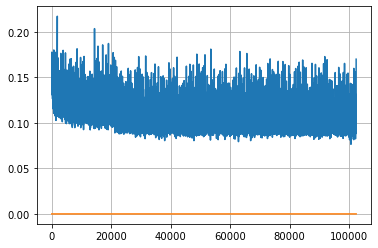

Epoch: 263, iteration 0, loss 0.1036393940448761, cov_diff 0.40528204020372194 cov_diff train 0.40556137771778994
Epoch: 263, iteration 1, loss 0.10394331812858582, cov_diff 0.39933052696606297 cov_diff train 0.3988060511254878
Epoch: 263, iteration 2, loss 0.10606265068054199, cov_diff 0.4057097460472393 cov_diff train 0.40602869185557966
Epoch: 263, iteration 3, loss 0.10331785678863525, cov_diff 0.40990969207905037 cov_diff train 0.4094571801018487
Epoch: 263, iteration 4, loss 0.10311365127563477, cov_diff 0.4217294933342338 cov_diff train 0.4215860622852945
Epoch: 263, iteration 5, loss 0.10180625319480896, cov_diff 0.42102364891221983 cov_diff train 0.4203537225891432
Epoch: 263, iteration 6, loss 0.10449478030204773, cov_diff 0.40340746404808064 cov_diff train 0.402382454420493
Epoch: 263, iteration 7, loss 0.10772708058357239, cov_diff 0.4039757762995323 cov_diff train 0.4030154384989232
Epoch: 263, iteration 8, loss 0.09778672456741333, cov_diff 0.4204208924246651 cov_diff tra

Epoch: 263, iteration 77, loss 0.10319015383720398, cov_diff 0.41863824703869174 cov_diff train 0.417726829820716
Epoch: 263, iteration 78, loss 0.1000145971775055, cov_diff 0.4102885673777868 cov_diff train 0.40994889591576134
Epoch: 263, iteration 79, loss 0.11261889338493347, cov_diff 0.42318829620692633 cov_diff train 0.4228133136125106
Epoch: 263, iteration 80, loss 0.11058858036994934, cov_diff 0.4075995061854678 cov_diff train 0.40682503544949566
Epoch: 263, iteration 81, loss 0.10230982303619385, cov_diff 0.408358950758293 cov_diff train 0.4075117912301457
Epoch: 263, iteration 82, loss 0.10097363591194153, cov_diff 0.4025304973587353 cov_diff train 0.4027826379023117
Epoch: 263, iteration 83, loss 0.10315951704978943, cov_diff 0.4145189425083943 cov_diff train 0.4141463174855625
Epoch: 263, iteration 84, loss 0.11758282780647278, cov_diff 0.4164003071010834 cov_diff train 0.416525984137515
Epoch: 263, iteration 85, loss 0.11080604791641235, cov_diff 0.4194841698762324 cov_diff

Epoch: 263, iteration 152, loss 0.10135728120803833, cov_diff 0.43521341166098154 cov_diff train 0.4340921196565123
Epoch: 263, iteration 153, loss 0.1007450520992279, cov_diff 0.42061446917222967 cov_diff train 0.4195878583318853
Epoch: 263, iteration 154, loss 0.10619577765464783, cov_diff 0.4054098631669979 cov_diff train 0.4050091583484963
Epoch: 263, iteration 155, loss 0.10804349184036255, cov_diff 0.4150385498335386 cov_diff train 0.41453733445591545
Epoch: 263, iteration 156, loss 0.11521098017692566, cov_diff 0.40106113730852044 cov_diff train 0.40047060806725676
Epoch: 263, iteration 157, loss 0.10152092576026917, cov_diff 0.40888018137997784 cov_diff train 0.40799767343370835
Epoch: 263, iteration 158, loss 0.11140990257263184, cov_diff 0.4203659542591244 cov_diff train 0.4198628699013281
Epoch: 263, iteration 159, loss 0.10083624720573425, cov_diff 0.4250808477126974 cov_diff train 0.42474589769281473
Epoch: 263, iteration 160, loss 0.10645449161529541, cov_diff 0.411303675

Epoch: 263, iteration 229, loss 0.0946773886680603, cov_diff 0.4254369709171293 cov_diff train 0.42516695023703593
Epoch: 263, iteration 230, loss 0.11455202102661133, cov_diff 0.406502377484513 cov_diff train 0.4060885187160565
Epoch: 263, iteration 231, loss 0.10543093085289001, cov_diff 0.38976609263648165 cov_diff train 0.38906422042830885
Epoch: 263, iteration 232, loss 0.10093992948532104, cov_diff 0.40577213311523636 cov_diff train 0.40552937216945595
Epoch: 263, iteration 233, loss 0.10123023390769958, cov_diff 0.40479785594243073 cov_diff train 0.4049460189872358
Epoch: 263, iteration 234, loss 0.11042138934135437, cov_diff 0.40550237296688335 cov_diff train 0.40451796026893744
Epoch: 263, iteration 235, loss 0.10622292757034302, cov_diff 0.42570957252133207 cov_diff train 0.4256995924776329
Epoch: 263, iteration 236, loss 0.11703583598136902, cov_diff 0.41449318756398695 cov_diff train 0.4143465003856232
Epoch: 263, iteration 237, loss 0.09835076332092285, cov_diff 0.40709340

Epoch: 263, iteration 306, loss 0.10672619938850403, cov_diff 0.4176039229759101 cov_diff train 0.418036959381012
Epoch: 263, iteration 307, loss 0.10945019125938416, cov_diff 0.41183881994641447 cov_diff train 0.4115132841706321
Epoch: 263, iteration 308, loss 0.10514795780181885, cov_diff 0.4155726853115361 cov_diff train 0.415997291198012
Epoch: 263, iteration 309, loss 0.09491664171218872, cov_diff 0.4134423101467829 cov_diff train 0.4132666400556435
Epoch: 263, iteration 310, loss 0.10924136638641357, cov_diff 0.42487857162537884 cov_diff train 0.42450491888759095
Epoch: 263, iteration 311, loss 0.1121477484703064, cov_diff 0.41094747327543907 cov_diff train 0.4101262869713039
Epoch: 263, iteration 312, loss 0.10941952466964722, cov_diff 0.405129650905172 cov_diff train 0.4040351328526324
Epoch: 263, iteration 313, loss 0.1055835485458374, cov_diff 0.4109085999042788 cov_diff train 0.4093784811749806
Epoch: 263, iteration 314, loss 0.11238974332809448, cov_diff 0.4145143153517153 

Epoch: 263, iteration 380, loss 0.09883889555931091, cov_diff 0.41576837689586565 cov_diff train 0.4150925433487987
Epoch: 263, iteration 381, loss 0.10565763711929321, cov_diff 0.42043072183314106 cov_diff train 0.4193492905496059
Epoch: 263, iteration 382, loss 0.1057131290435791, cov_diff 0.42590537503534065 cov_diff train 0.42544670207981694
Epoch: 263, iteration 383, loss 0.1119813621044159, cov_diff 0.41159034764919145 cov_diff train 0.4109678472887872
Epoch: 263, iteration 384, loss 0.09911078214645386, cov_diff 0.413904533171968 cov_diff train 0.4133073135339788
Epoch: 263, iteration 385, loss 0.11060115694999695, cov_diff 0.41557730868497217 cov_diff train 0.4145472960805755
Epoch: 263, iteration 386, loss 0.09930911660194397, cov_diff 0.40953446729926324 cov_diff train 0.408497417295346
Epoch: 263, iteration 387, loss 0.10012990236282349, cov_diff 0.41348776306974705 cov_diff train 0.4134869057548928
Epoch: 263, iteration 388, loss 0.10114434361457825, cov_diff 0.413735385261

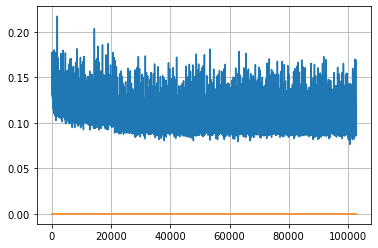

Epoch: 264, iteration 0, loss 0.10794031620025635, cov_diff 0.4070309888072817 cov_diff train 0.40498335331783003
Epoch: 264, iteration 1, loss 0.1010260283946991, cov_diff 0.42929625256459203 cov_diff train 0.4294305931379483
Epoch: 264, iteration 2, loss 0.10441100597381592, cov_diff 0.41669490633096323 cov_diff train 0.41644710967256526
Epoch: 264, iteration 3, loss 0.1040259599685669, cov_diff 0.41332356882094895 cov_diff train 0.41285450595195666
Epoch: 264, iteration 4, loss 0.10649004578590393, cov_diff 0.41577151602548607 cov_diff train 0.4159384449302082
Epoch: 264, iteration 5, loss 0.09862315654754639, cov_diff 0.4079179336560401 cov_diff train 0.4071814303483609
Epoch: 264, iteration 6, loss 0.11453580856323242, cov_diff 0.4297672312116573 cov_diff train 0.4299758136460889
Epoch: 264, iteration 7, loss 0.10878771543502808, cov_diff 0.42018641498856313 cov_diff train 0.4194789883642654
Epoch: 264, iteration 8, loss 0.09240880608558655, cov_diff 0.41054403503832737 cov_diff t

Epoch: 264, iteration 76, loss 0.11415481567382812, cov_diff 0.4056051001838227 cov_diff train 0.4043788251840494
Epoch: 264, iteration 77, loss 0.09014040231704712, cov_diff 0.41962855391734394 cov_diff train 0.4181459187573836
Epoch: 264, iteration 78, loss 0.10523077845573425, cov_diff 0.42081098246801596 cov_diff train 0.41957790888633234
Epoch: 264, iteration 79, loss 0.10284426808357239, cov_diff 0.4172469985082301 cov_diff train 0.41688227229196534
Epoch: 264, iteration 80, loss 0.10260424017906189, cov_diff 0.4342631555518736 cov_diff train 0.43334362505663054
Epoch: 264, iteration 81, loss 0.11062309145927429, cov_diff 0.4121621761603687 cov_diff train 0.4105267707138488
Epoch: 264, iteration 82, loss 0.10625380277633667, cov_diff 0.40154106617662666 cov_diff train 0.40102773468560665
Epoch: 264, iteration 83, loss 0.10365146398544312, cov_diff 0.4056947309202458 cov_diff train 0.4053774704394556
Epoch: 264, iteration 84, loss 0.1084776520729065, cov_diff 0.425515825882139 cov

Epoch: 264, iteration 152, loss 0.10468122363090515, cov_diff 0.4075978391797654 cov_diff train 0.40723296436410744
Epoch: 264, iteration 153, loss 0.09590417146682739, cov_diff 0.40771955117434483 cov_diff train 0.4070293934538114
Epoch: 264, iteration 154, loss 0.09830838441848755, cov_diff 0.41270388164708294 cov_diff train 0.4123530773819296
Epoch: 264, iteration 155, loss 0.10107740759849548, cov_diff 0.4132597639074736 cov_diff train 0.4119584322017776
Epoch: 264, iteration 156, loss 0.10214564204216003, cov_diff 0.40994793674813146 cov_diff train 0.409070108677299
Epoch: 264, iteration 157, loss 0.10611379146575928, cov_diff 0.41244486127711477 cov_diff train 0.41119808187689827
Epoch: 264, iteration 158, loss 0.10164868831634521, cov_diff 0.40389150989402567 cov_diff train 0.4031179046332281
Epoch: 264, iteration 159, loss 0.1009138822555542, cov_diff 0.4357882973794733 cov_diff train 0.4343587931954784
Epoch: 264, iteration 160, loss 0.10401991009712219, cov_diff 0.41818330202

Epoch: 264, iteration 230, loss 0.10849049687385559, cov_diff 0.4201232786347269 cov_diff train 0.41979534313803746
Epoch: 264, iteration 231, loss 0.11424970626831055, cov_diff 0.4110058993394667 cov_diff train 0.4102738457350817
Epoch: 264, iteration 232, loss 0.10139521956443787, cov_diff 0.40093692569516437 cov_diff train 0.40036050032956916
Epoch: 264, iteration 233, loss 0.10073292255401611, cov_diff 0.41921391202721336 cov_diff train 0.41890450570222804
Epoch: 264, iteration 234, loss 0.10910683870315552, cov_diff 0.41210868191627276 cov_diff train 0.41089808716482984
Epoch: 264, iteration 235, loss 0.09504762291908264, cov_diff 0.42114970045078215 cov_diff train 0.4201125047305883
Epoch: 264, iteration 236, loss 0.10475072264671326, cov_diff 0.4005640762958822 cov_diff train 0.3998340978704445
Epoch: 264, iteration 237, loss 0.10368826985359192, cov_diff 0.4084996499271298 cov_diff train 0.40788743429236296
Epoch: 264, iteration 238, loss 0.09868168830871582, cov_diff 0.4205622

Epoch: 264, iteration 308, loss 0.10307058691978455, cov_diff 0.42198501062335947 cov_diff train 0.4216723857886387
Epoch: 264, iteration 309, loss 0.09132605791091919, cov_diff 0.4130773183443468 cov_diff train 0.4114991296170618
Epoch: 264, iteration 310, loss 0.0933847725391388, cov_diff 0.40884230395848037 cov_diff train 0.4088690314636013
Epoch: 264, iteration 311, loss 0.09432780742645264, cov_diff 0.42188208413919637 cov_diff train 0.4213318534474724
Epoch: 264, iteration 312, loss 0.10264381766319275, cov_diff 0.4130379808709694 cov_diff train 0.4124708630424694
Epoch: 264, iteration 313, loss 0.1091296374797821, cov_diff 0.4196212161488905 cov_diff train 0.4193192454281957
Epoch: 264, iteration 314, loss 0.10541900992393494, cov_diff 0.43131134704872603 cov_diff train 0.43003794795757866
Epoch: 264, iteration 315, loss 0.11034068465232849, cov_diff 0.4239464811435921 cov_diff train 0.4229286862072443
Epoch: 264, iteration 316, loss 0.10343608260154724, cov_diff 0.4131853120846

Epoch: 264, iteration 385, loss 0.10363340377807617, cov_diff 0.4170207723955375 cov_diff train 0.4170868989261393
Epoch: 264, iteration 386, loss 0.10024487972259521, cov_diff 0.4110929176169616 cov_diff train 0.4106436108870003
Epoch: 264, iteration 387, loss 0.09496346116065979, cov_diff 0.4172374669994564 cov_diff train 0.41642938339532626
Epoch: 264, iteration 388, loss 0.10656812787055969, cov_diff 0.4073321346744364 cov_diff train 0.4069032430206718
Epoch: 264, iteration 389, loss 0.10107094049453735, cov_diff 0.41236382292961277 cov_diff train 0.41249870678525097
Epoch: 264, iteration 390, loss 0.1588786244392395, cov_diff 0.44783504817321174 cov_diff train 0.44624592304520383


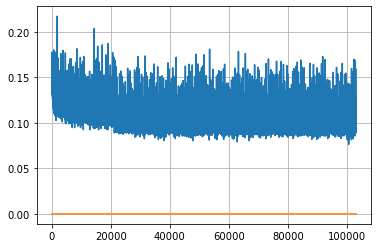

Epoch: 265, iteration 0, loss 0.10966473817825317, cov_diff 0.4213959628091443 cov_diff train 0.42142249224424794
Epoch: 265, iteration 1, loss 0.10625120997428894, cov_diff 0.41209751206605105 cov_diff train 0.41170563445105096
Epoch: 265, iteration 2, loss 0.10048049688339233, cov_diff 0.4107295895719352 cov_diff train 0.4092866079986903
Epoch: 265, iteration 3, loss 0.10950067639350891, cov_diff 0.4151258125447971 cov_diff train 0.41517116310509805
Epoch: 265, iteration 4, loss 0.10964503884315491, cov_diff 0.4152977321509679 cov_diff train 0.41410918169918515
Epoch: 265, iteration 5, loss 0.09817537665367126, cov_diff 0.414585512283943 cov_diff train 0.4137540534302482
Epoch: 265, iteration 6, loss 0.08971214294433594, cov_diff 0.40121299425117896 cov_diff train 0.4003050437569397
Epoch: 265, iteration 7, loss 0.10880005359649658, cov_diff 0.4101269067934709 cov_diff train 0.4094500343863412
Epoch: 265, iteration 8, loss 0.11357936263084412, cov_diff 0.4074555300600306 cov_diff tra

Epoch: 265, iteration 76, loss 0.11191782355308533, cov_diff 0.4109109546266798 cov_diff train 0.4103691110820801
Epoch: 265, iteration 77, loss 0.10672011971473694, cov_diff 0.4212792123552144 cov_diff train 0.42067018665863626
Epoch: 265, iteration 78, loss 0.0956452488899231, cov_diff 0.414377210457513 cov_diff train 0.41364651450929046
Epoch: 265, iteration 79, loss 0.10444310307502747, cov_diff 0.4171380128504501 cov_diff train 0.41653579164594295
Epoch: 265, iteration 80, loss 0.10719159245491028, cov_diff 0.4052575415222153 cov_diff train 0.4053943498700472
Epoch: 265, iteration 81, loss 0.09996670484542847, cov_diff 0.4064033231378807 cov_diff train 0.40572835115265743
Epoch: 265, iteration 82, loss 0.10855057835578918, cov_diff 0.4176640995525083 cov_diff train 0.41696978814866553
Epoch: 265, iteration 83, loss 0.09505316615104675, cov_diff 0.42258133820098903 cov_diff train 0.4211552538386219
Epoch: 265, iteration 84, loss 0.0940975546836853, cov_diff 0.42874489033299773 cov_

Epoch: 265, iteration 149, loss 0.08690842986106873, cov_diff 0.4184641183397941 cov_diff train 0.4175964999866516
Epoch: 265, iteration 150, loss 0.11607030034065247, cov_diff 0.4105447061232875 cov_diff train 0.40950546865163434
Epoch: 265, iteration 151, loss 0.11101636290550232, cov_diff 0.41964974232861435 cov_diff train 0.41933803078054227
Epoch: 265, iteration 152, loss 0.09864643216133118, cov_diff 0.4104959311211913 cov_diff train 0.4109026774189098
Epoch: 265, iteration 153, loss 0.10687106847763062, cov_diff 0.41292148977681414 cov_diff train 0.4114549704923541
Epoch: 265, iteration 154, loss 0.11115944385528564, cov_diff 0.41245136509801433 cov_diff train 0.4112348931185823
Epoch: 265, iteration 155, loss 0.1048312783241272, cov_diff 0.41284617274523777 cov_diff train 0.4117101663090611
Epoch: 265, iteration 156, loss 0.11402356624603271, cov_diff 0.4143976288946835 cov_diff train 0.41348237620675254
Epoch: 265, iteration 157, loss 0.10826876759529114, cov_diff 0.4094541534

Epoch: 265, iteration 228, loss 0.09642472863197327, cov_diff 0.4189471557478668 cov_diff train 0.41848439095721485
Epoch: 265, iteration 229, loss 0.10313570499420166, cov_diff 0.422858019088887 cov_diff train 0.4225777300451338
Epoch: 265, iteration 230, loss 0.10254818201065063, cov_diff 0.4114179389755697 cov_diff train 0.4107274995681557
Epoch: 265, iteration 231, loss 0.10458427667617798, cov_diff 0.4184514061876988 cov_diff train 0.4175725797212607
Epoch: 265, iteration 232, loss 0.09962528944015503, cov_diff 0.39282275586505244 cov_diff train 0.3926666751972871
Epoch: 265, iteration 233, loss 0.09549897909164429, cov_diff 0.4187876611734663 cov_diff train 0.4177882165519003
Epoch: 265, iteration 234, loss 0.11984294652938843, cov_diff 0.41165059299258117 cov_diff train 0.40991623737207905
Epoch: 265, iteration 235, loss 0.11241361498832703, cov_diff 0.4238272609565356 cov_diff train 0.42330952984769893
Epoch: 265, iteration 236, loss 0.09027394652366638, cov_diff 0.410412223189

Epoch: 265, iteration 299, loss 0.10053378343582153, cov_diff 0.4163800940741665 cov_diff train 0.4155260190029842
Epoch: 265, iteration 300, loss 0.11034250259399414, cov_diff 0.41903997875288274 cov_diff train 0.41840761317878894
Epoch: 265, iteration 301, loss 0.10252630710601807, cov_diff 0.417156667396866 cov_diff train 0.4158954281366006
Epoch: 265, iteration 302, loss 0.1117624044418335, cov_diff 0.4146552155986659 cov_diff train 0.4133635113657138
Epoch: 265, iteration 303, loss 0.09824800491333008, cov_diff 0.41320108365915215 cov_diff train 0.41154656679873064
Epoch: 265, iteration 304, loss 0.10238733887672424, cov_diff 0.40626513076237947 cov_diff train 0.4047107984504667
Epoch: 265, iteration 305, loss 0.1013803780078888, cov_diff 0.4194942339311336 cov_diff train 0.4186491532561128
Epoch: 265, iteration 306, loss 0.09977376461029053, cov_diff 0.40905430695097583 cov_diff train 0.408486084759495
Epoch: 265, iteration 307, loss 0.10084256529808044, cov_diff 0.40468825034457

Epoch: 265, iteration 379, loss 0.10715371370315552, cov_diff 0.42087249522046877 cov_diff train 0.4181630979260403
Epoch: 265, iteration 380, loss 0.11815941333770752, cov_diff 0.40600195621695045 cov_diff train 0.40602089190044643
Epoch: 265, iteration 381, loss 0.10436934232711792, cov_diff 0.4150509407267668 cov_diff train 0.41508186095847655
Epoch: 265, iteration 382, loss 0.11071723699569702, cov_diff 0.40731809147821385 cov_diff train 0.40622566998619125
Epoch: 265, iteration 383, loss 0.10496556758880615, cov_diff 0.41021817335861527 cov_diff train 0.40913521580796963
Epoch: 265, iteration 384, loss 0.11410337686538696, cov_diff 0.40975621629479453 cov_diff train 0.40852937977978565
Epoch: 265, iteration 385, loss 0.08845731616020203, cov_diff 0.4030538247959051 cov_diff train 0.4028057579705217
Epoch: 265, iteration 386, loss 0.10565125942230225, cov_diff 0.4211409493151024 cov_diff train 0.4203206366057536
Epoch: 265, iteration 387, loss 0.1111719012260437, cov_diff 0.4136727

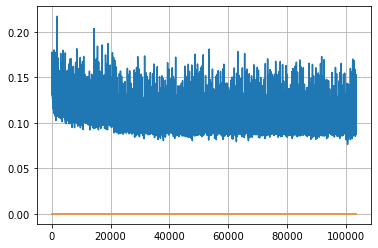

Epoch: 266, iteration 0, loss 0.10969921946525574, cov_diff 0.41558337068607754 cov_diff train 0.4163435839971342
Epoch: 266, iteration 1, loss 0.10537225008010864, cov_diff 0.4108398556018498 cov_diff train 0.4104402660381661
Epoch: 266, iteration 2, loss 0.10085859894752502, cov_diff 0.40715198830275395 cov_diff train 0.40787859219941736
Epoch: 266, iteration 3, loss 0.11503329873085022, cov_diff 0.41251337557426565 cov_diff train 0.4125468489205286
Epoch: 266, iteration 4, loss 0.09565427899360657, cov_diff 0.4043167417578785 cov_diff train 0.40364692150254533
Epoch: 266, iteration 5, loss 0.11072784662246704, cov_diff 0.4050821891610065 cov_diff train 0.40447208422907316
Epoch: 266, iteration 6, loss 0.11610162258148193, cov_diff 0.41997287657939086 cov_diff train 0.4200976609115593
Epoch: 266, iteration 7, loss 0.11666160821914673, cov_diff 0.420425325777868 cov_diff train 0.41959789355251875
Epoch: 266, iteration 8, loss 0.11109670996665955, cov_diff 0.411491345834769 cov_diff tr

Epoch: 266, iteration 72, loss 0.1152888834476471, cov_diff 0.42344087143268816 cov_diff train 0.4232324039190398
Epoch: 266, iteration 73, loss 0.10851678252220154, cov_diff 0.4151541214069317 cov_diff train 0.41388318371860483
Epoch: 266, iteration 74, loss 0.10104760527610779, cov_diff 0.415455792750549 cov_diff train 0.415722719448743
Epoch: 266, iteration 75, loss 0.10122060775756836, cov_diff 0.4265289992053209 cov_diff train 0.4261359560931633
Epoch: 266, iteration 76, loss 0.1360679566860199, cov_diff 0.4270208109353183 cov_diff train 0.4263469987354438
Epoch: 266, iteration 77, loss 0.11039009690284729, cov_diff 0.4089278313119249 cov_diff train 0.40892368480053665
Epoch: 266, iteration 78, loss 0.10474249720573425, cov_diff 0.4137559237912164 cov_diff train 0.41274073586433424
Epoch: 266, iteration 79, loss 0.10263022780418396, cov_diff 0.41642409556268983 cov_diff train 0.4153416494328238
Epoch: 266, iteration 80, loss 0.10220932960510254, cov_diff 0.402629254098217 cov_diff

Epoch: 266, iteration 144, loss 0.10207843780517578, cov_diff 0.4132021436961808 cov_diff train 0.41273515757251295
Epoch: 266, iteration 145, loss 0.11495667695999146, cov_diff 0.4190037709775241 cov_diff train 0.41830159963655317
Epoch: 266, iteration 146, loss 0.09123790264129639, cov_diff 0.4112540688541196 cov_diff train 0.4101480295779813
Epoch: 266, iteration 147, loss 0.09705668687820435, cov_diff 0.40233668622173524 cov_diff train 0.4017641293242988
Epoch: 266, iteration 148, loss 0.10500746965408325, cov_diff 0.4001473411317787 cov_diff train 0.3996075169811534
Epoch: 266, iteration 149, loss 0.09799546003341675, cov_diff 0.4032807632944698 cov_diff train 0.4030764796494542
Epoch: 266, iteration 150, loss 0.09661883115768433, cov_diff 0.4033253160414213 cov_diff train 0.4028586497082432
Epoch: 266, iteration 151, loss 0.11481305956840515, cov_diff 0.41348059069161586 cov_diff train 0.4139364271443178
Epoch: 266, iteration 152, loss 0.10444164276123047, cov_diff 0.411676035168

Epoch: 266, iteration 223, loss 0.10386621952056885, cov_diff 0.4168047159532357 cov_diff train 0.4157904337439355
Epoch: 266, iteration 224, loss 0.09390673041343689, cov_diff 0.4007667694630961 cov_diff train 0.400176693132964
Epoch: 266, iteration 225, loss 0.1051347553730011, cov_diff 0.40841276296383355 cov_diff train 0.40812653621930817
Epoch: 266, iteration 226, loss 0.10006272792816162, cov_diff 0.41500135173614416 cov_diff train 0.4138989488646874
Epoch: 266, iteration 227, loss 0.10793271660804749, cov_diff 0.40904402337533147 cov_diff train 0.4080200886824957
Epoch: 266, iteration 228, loss 0.10960924625396729, cov_diff 0.4232554157948179 cov_diff train 0.4220502423094873
Epoch: 266, iteration 229, loss 0.10550561547279358, cov_diff 0.4064901440333867 cov_diff train 0.40595128040743184
Epoch: 266, iteration 230, loss 0.10113862156867981, cov_diff 0.4153422175605332 cov_diff train 0.41542594086841367
Epoch: 266, iteration 231, loss 0.1001746654510498, cov_diff 0.4187488555796

Epoch: 266, iteration 296, loss 0.10766953229904175, cov_diff 0.39838248384349473 cov_diff train 0.39668204731201223
Epoch: 266, iteration 297, loss 0.12553846836090088, cov_diff 0.4162509310677947 cov_diff train 0.4165523220829261
Epoch: 266, iteration 298, loss 0.09924924373626709, cov_diff 0.41284882763319564 cov_diff train 0.41190986025865006
Epoch: 266, iteration 299, loss 0.09755820035934448, cov_diff 0.4158423138894163 cov_diff train 0.4154049938371015
Epoch: 266, iteration 300, loss 0.10568356513977051, cov_diff 0.42159747815846915 cov_diff train 0.4209914923397161
Epoch: 266, iteration 301, loss 0.09877362847328186, cov_diff 0.41780890112242064 cov_diff train 0.41733263615984156
Epoch: 266, iteration 302, loss 0.09996411204338074, cov_diff 0.4014856795259437 cov_diff train 0.40218025235293836
Epoch: 266, iteration 303, loss 0.09590500593185425, cov_diff 0.41456453559797474 cov_diff train 0.4147185096726831
Epoch: 266, iteration 304, loss 0.10230636596679688, cov_diff 0.3991300

Epoch: 266, iteration 374, loss 0.09441247582435608, cov_diff 0.4127557821960643 cov_diff train 0.41165373946225037
Epoch: 266, iteration 375, loss 0.10772454738616943, cov_diff 0.4024956814221255 cov_diff train 0.40209307899507224
Epoch: 266, iteration 376, loss 0.09705179929733276, cov_diff 0.40985388730210637 cov_diff train 0.4090943808745754
Epoch: 266, iteration 377, loss 0.11198052763938904, cov_diff 0.4009572874631019 cov_diff train 0.4004713400894521
Epoch: 266, iteration 378, loss 0.09683674573898315, cov_diff 0.39810076414158085 cov_diff train 0.39777783736543715
Epoch: 266, iteration 379, loss 0.10592707991600037, cov_diff 0.40597255875952626 cov_diff train 0.4056771040617381
Epoch: 266, iteration 380, loss 0.10886049270629883, cov_diff 0.40393415917611897 cov_diff train 0.4033646615933575
Epoch: 266, iteration 381, loss 0.08894148468971252, cov_diff 0.4134037185292854 cov_diff train 0.4127189257438919
Epoch: 266, iteration 382, loss 0.10563552379608154, cov_diff 0.417751939

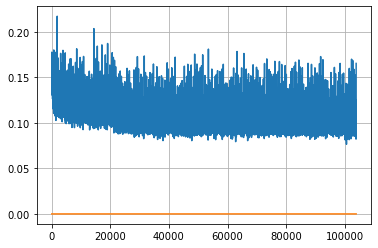

Epoch: 267, iteration 0, loss 0.1023952066898346, cov_diff 0.407269397947874 cov_diff train 0.407163941241325
Epoch: 267, iteration 1, loss 0.10354414582252502, cov_diff 0.4161662903646762 cov_diff train 0.4151427756690479
Epoch: 267, iteration 2, loss 0.11860835552215576, cov_diff 0.425487609682454 cov_diff train 0.4249343347770634
Epoch: 267, iteration 3, loss 0.1167570948600769, cov_diff 0.4070179242729654 cov_diff train 0.4065960788333854
Epoch: 267, iteration 4, loss 0.11209022998809814, cov_diff 0.4175914517640382 cov_diff train 0.41672295146712135
Epoch: 267, iteration 5, loss 0.10383284091949463, cov_diff 0.42301859740372816 cov_diff train 0.4214249938424168
Epoch: 267, iteration 6, loss 0.11606168746948242, cov_diff 0.407238594208047 cov_diff train 0.40698225655150044
Epoch: 267, iteration 7, loss 0.09758085012435913, cov_diff 0.40373976639378795 cov_diff train 0.40399845846867344
Epoch: 267, iteration 8, loss 0.1086978018283844, cov_diff 0.4259767550396702 cov_diff train 0.42

Epoch: 267, iteration 75, loss 0.10284468531608582, cov_diff 0.41234072860231363 cov_diff train 0.41111165522231574
Epoch: 267, iteration 76, loss 0.11304998397827148, cov_diff 0.4112226156247291 cov_diff train 0.4089473102360046
Epoch: 267, iteration 77, loss 0.10003992915153503, cov_diff 0.40735379028031077 cov_diff train 0.40676008751571724
Epoch: 267, iteration 78, loss 0.11811414361000061, cov_diff 0.40866183921145416 cov_diff train 0.4083085458920396
Epoch: 267, iteration 79, loss 0.10364130139350891, cov_diff 0.40770865673712736 cov_diff train 0.4067323348186835
Epoch: 267, iteration 80, loss 0.09107336401939392, cov_diff 0.4017354713110163 cov_diff train 0.4002435910804808
Epoch: 267, iteration 81, loss 0.11051976680755615, cov_diff 0.39916301905416024 cov_diff train 0.3987692593364482
Epoch: 267, iteration 82, loss 0.09965682029724121, cov_diff 0.41719860797954045 cov_diff train 0.41554599460439506
Epoch: 267, iteration 83, loss 0.10979193449020386, cov_diff 0.4086207396493015

Epoch: 267, iteration 153, loss 0.1025925874710083, cov_diff 0.4142149384269883 cov_diff train 0.41417186288332736
Epoch: 267, iteration 154, loss 0.10637924075126648, cov_diff 0.4083229956610263 cov_diff train 0.40789661851956976
Epoch: 267, iteration 155, loss 0.09336039423942566, cov_diff 0.40418822156768824 cov_diff train 0.4043940087902488
Epoch: 267, iteration 156, loss 0.09814602136611938, cov_diff 0.4340426135119708 cov_diff train 0.4325809441564529
Epoch: 267, iteration 157, loss 0.10151126980781555, cov_diff 0.3994328773810473 cov_diff train 0.3981817283223693
Epoch: 267, iteration 158, loss 0.1116323471069336, cov_diff 0.41341363443052803 cov_diff train 0.41311707380139845
Epoch: 267, iteration 159, loss 0.09357327222824097, cov_diff 0.41009326521898304 cov_diff train 0.4100204999805725
Epoch: 267, iteration 160, loss 0.09497708082199097, cov_diff 0.4096208397241769 cov_diff train 0.40922641840225027
Epoch: 267, iteration 161, loss 0.09509605169296265, cov_diff 0.41243014545

Epoch: 267, iteration 225, loss 0.09636819362640381, cov_diff 0.39495292165429335 cov_diff train 0.39461069214361777
Epoch: 267, iteration 226, loss 0.10617396235466003, cov_diff 0.4276892017949592 cov_diff train 0.4264256216018018
Epoch: 267, iteration 227, loss 0.10765895247459412, cov_diff 0.4186330657899226 cov_diff train 0.41744944376563375
Epoch: 267, iteration 228, loss 0.10350057482719421, cov_diff 0.40836037621754256 cov_diff train 0.4078161708690027
Epoch: 267, iteration 229, loss 0.11542826890945435, cov_diff 0.41684923433032356 cov_diff train 0.4161050342659244
Epoch: 267, iteration 230, loss 0.10663002729415894, cov_diff 0.40817073731785863 cov_diff train 0.4079080842841726
Epoch: 267, iteration 231, loss 0.10111278295516968, cov_diff 0.4210124965008148 cov_diff train 0.42052544083760773
Epoch: 267, iteration 232, loss 0.10320401191711426, cov_diff 0.40124032376498986 cov_diff train 0.40091036367770894
Epoch: 267, iteration 233, loss 0.10604950785636902, cov_diff 0.4030389

Epoch: 267, iteration 296, loss 0.10457092523574829, cov_diff 0.4301263999366873 cov_diff train 0.42949225748988057
Epoch: 267, iteration 297, loss 0.11896789073944092, cov_diff 0.41895974800260044 cov_diff train 0.41839197358351526
Epoch: 267, iteration 298, loss 0.10277706384658813, cov_diff 0.4208818441064075 cov_diff train 0.41978097750245397
Epoch: 267, iteration 299, loss 0.09502431750297546, cov_diff 0.409066296777227 cov_diff train 0.409215252803675
Epoch: 267, iteration 300, loss 0.09778916835784912, cov_diff 0.4148186179132896 cov_diff train 0.41495529456482166
Epoch: 267, iteration 301, loss 0.10811907052993774, cov_diff 0.41517493140784417 cov_diff train 0.41493704338925463
Epoch: 267, iteration 302, loss 0.10527020692825317, cov_diff 0.41024905116633675 cov_diff train 0.4099672142514925
Epoch: 267, iteration 303, loss 0.09098243713378906, cov_diff 0.4223648846388327 cov_diff train 0.4212781366059389
Epoch: 267, iteration 304, loss 0.11278411746025085, cov_diff 0.4102350620

Epoch: 267, iteration 375, loss 0.09446021914482117, cov_diff 0.405244401098074 cov_diff train 0.404872279780952
Epoch: 267, iteration 376, loss 0.1010301411151886, cov_diff 0.40733863967500106 cov_diff train 0.4068273731946104
Epoch: 267, iteration 377, loss 0.10232385993003845, cov_diff 0.4258028484001727 cov_diff train 0.42581039730825754
Epoch: 267, iteration 378, loss 0.10139349102973938, cov_diff 0.4075904404557135 cov_diff train 0.40741142610913156
Epoch: 267, iteration 379, loss 0.10773876309394836, cov_diff 0.41919677893923535 cov_diff train 0.4187721694818164
Epoch: 267, iteration 380, loss 0.11405712366104126, cov_diff 0.41381316928171447 cov_diff train 0.41365858147121937
Epoch: 267, iteration 381, loss 0.11870136857032776, cov_diff 0.39976564315859814 cov_diff train 0.39972738762969723
Epoch: 267, iteration 382, loss 0.10061255097389221, cov_diff 0.4018720625937798 cov_diff train 0.4014468565348353
Epoch: 267, iteration 383, loss 0.0971846878528595, cov_diff 0.406232038228

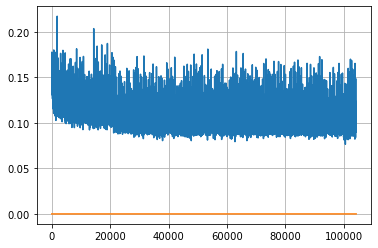

Epoch: 268, iteration 0, loss 0.1055452823638916, cov_diff 0.406983693812228 cov_diff train 0.4063195721313929
Epoch: 268, iteration 1, loss 0.10888922214508057, cov_diff 0.42122418390711 cov_diff train 0.42059494282769305
Epoch: 268, iteration 2, loss 0.10624644160270691, cov_diff 0.4161868038954108 cov_diff train 0.41502597635375554
Epoch: 268, iteration 3, loss 0.11486941576004028, cov_diff 0.42269060413377857 cov_diff train 0.42100747156715795
Epoch: 268, iteration 4, loss 0.11623916029930115, cov_diff 0.40648689339653293 cov_diff train 0.4047803907593923
Epoch: 268, iteration 5, loss 0.09270164370536804, cov_diff 0.4138265709196185 cov_diff train 0.4121009803052277
Epoch: 268, iteration 6, loss 0.10386410355567932, cov_diff 0.41938805895982534 cov_diff train 0.4181728514789391
Epoch: 268, iteration 7, loss 0.10520914196968079, cov_diff 0.40237401559556685 cov_diff train 0.4016314968346053
Epoch: 268, iteration 8, loss 0.10153436660766602, cov_diff 0.4175752337743616 cov_diff train

Epoch: 268, iteration 74, loss 0.09927403926849365, cov_diff 0.4163423055111022 cov_diff train 0.4156385338114339
Epoch: 268, iteration 75, loss 0.11520537734031677, cov_diff 0.4240579211355023 cov_diff train 0.4228338238533621
Epoch: 268, iteration 76, loss 0.1070815920829773, cov_diff 0.4005852215892984 cov_diff train 0.4007077018952796
Epoch: 268, iteration 77, loss 0.10402625799179077, cov_diff 0.43039577205104596 cov_diff train 0.42975708365668436
Epoch: 268, iteration 78, loss 0.10143071413040161, cov_diff 0.40913561735086135 cov_diff train 0.41017835189993973
Epoch: 268, iteration 79, loss 0.10469767451286316, cov_diff 0.4118930406225581 cov_diff train 0.4120787962304801
Epoch: 268, iteration 80, loss 0.10457688570022583, cov_diff 0.4105663048630811 cov_diff train 0.4101752024518842
Epoch: 268, iteration 81, loss 0.09614336490631104, cov_diff 0.4036077708305385 cov_diff train 0.4026515136290614
Epoch: 268, iteration 82, loss 0.10348552465438843, cov_diff 0.4247759790790131 cov_d

Epoch: 268, iteration 146, loss 0.11449295282363892, cov_diff 0.4076537799112209 cov_diff train 0.4063824107580474
Epoch: 268, iteration 147, loss 0.10841181874275208, cov_diff 0.42053429750423843 cov_diff train 0.4202319326723949
Epoch: 268, iteration 148, loss 0.09939152002334595, cov_diff 0.40418317408495835 cov_diff train 0.4028551752876495
Epoch: 268, iteration 149, loss 0.11359503865242004, cov_diff 0.4137219884680902 cov_diff train 0.41222601158929506
Epoch: 268, iteration 150, loss 0.11694419384002686, cov_diff 0.4257820809401618 cov_diff train 0.42510485682772214
Epoch: 268, iteration 151, loss 0.103232741355896, cov_diff 0.4158892583257258 cov_diff train 0.4165473650209803
Epoch: 268, iteration 152, loss 0.09457588195800781, cov_diff 0.4054550645692258 cov_diff train 0.40539722495346026
Epoch: 268, iteration 153, loss 0.1144757866859436, cov_diff 0.41230388241858285 cov_diff train 0.4122237926805958
Epoch: 268, iteration 154, loss 0.1021028459072113, cov_diff 0.41263387520529

Epoch: 268, iteration 220, loss 0.10646265745162964, cov_diff 0.40600266638099825 cov_diff train 0.4056081120539708
Epoch: 268, iteration 221, loss 0.0979243814945221, cov_diff 0.4156877092777219 cov_diff train 0.41517316628393286
Epoch: 268, iteration 222, loss 0.09278169274330139, cov_diff 0.41428458764402587 cov_diff train 0.41341270196642066
Epoch: 268, iteration 223, loss 0.10163086652755737, cov_diff 0.41710310751793495 cov_diff train 0.4162171673420145
Epoch: 268, iteration 224, loss 0.10878801345825195, cov_diff 0.4109820622131918 cov_diff train 0.41068767278799784
Epoch: 268, iteration 225, loss 0.12260225415229797, cov_diff 0.4118173375694795 cov_diff train 0.411384866278222
Epoch: 268, iteration 226, loss 0.10779863595962524, cov_diff 0.39510293340465447 cov_diff train 0.39496197731675375
Epoch: 268, iteration 227, loss 0.10117828845977783, cov_diff 0.415313226540886 cov_diff train 0.41515646240631954
Epoch: 268, iteration 228, loss 0.08864113688468933, cov_diff 0.4146476637

Epoch: 268, iteration 299, loss 0.11136001348495483, cov_diff 0.4203015607218547 cov_diff train 0.41949187947240124
Epoch: 268, iteration 300, loss 0.10018649697303772, cov_diff 0.4086538883242852 cov_diff train 0.4080287573002157
Epoch: 268, iteration 301, loss 0.10291853547096252, cov_diff 0.41387748149648673 cov_diff train 0.4133451508580476
Epoch: 268, iteration 302, loss 0.10670971870422363, cov_diff 0.4178028098567238 cov_diff train 0.4169531058699297
Epoch: 268, iteration 303, loss 0.10388621687889099, cov_diff 0.407315143757157 cov_diff train 0.4067299219112995
Epoch: 268, iteration 304, loss 0.1021723747253418, cov_diff 0.4248267417026005 cov_diff train 0.4238993129196234
Epoch: 268, iteration 305, loss 0.10646915435791016, cov_diff 0.41821954990292853 cov_diff train 0.41700008608084094
Epoch: 268, iteration 306, loss 0.09721988439559937, cov_diff 0.4049790617547186 cov_diff train 0.4036010454296536
Epoch: 268, iteration 307, loss 0.10259643197059631, cov_diff 0.40500032742439

Epoch: 268, iteration 376, loss 0.0991537868976593, cov_diff 0.40575239440865013 cov_diff train 0.40593406849251223
Epoch: 268, iteration 377, loss 0.10055166482925415, cov_diff 0.413947002757594 cov_diff train 0.4121748209417725
Epoch: 268, iteration 378, loss 0.10596296191215515, cov_diff 0.41930595994470954 cov_diff train 0.41912329924609926
Epoch: 268, iteration 379, loss 0.10149940848350525, cov_diff 0.4159620290762853 cov_diff train 0.41626336335233444
Epoch: 268, iteration 380, loss 0.09932410717010498, cov_diff 0.4124352671844267 cov_diff train 0.4121419985408143
Epoch: 268, iteration 381, loss 0.10589534044265747, cov_diff 0.4184590953617983 cov_diff train 0.41815389749953163
Epoch: 268, iteration 382, loss 0.11104479432106018, cov_diff 0.4127191168267251 cov_diff train 0.41243594085105933
Epoch: 268, iteration 383, loss 0.11406496167182922, cov_diff 0.4300557383791996 cov_diff train 0.4289581069518015
Epoch: 268, iteration 384, loss 0.09466952085494995, cov_diff 0.40823764974

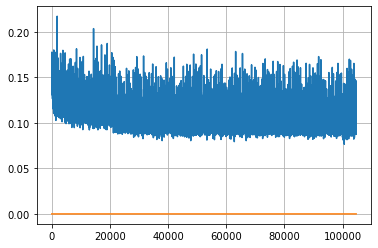

Epoch: 269, iteration 0, loss 0.11078965663909912, cov_diff 0.4105810945665252 cov_diff train 0.4104777136731486
Epoch: 269, iteration 1, loss 0.10098719596862793, cov_diff 0.41788044349263054 cov_diff train 0.4176410241688344
Epoch: 269, iteration 2, loss 0.09928649663925171, cov_diff 0.40259570432871583 cov_diff train 0.40260021840941385
Epoch: 269, iteration 3, loss 0.10670608282089233, cov_diff 0.42111321919875383 cov_diff train 0.420801310480899
Epoch: 269, iteration 4, loss 0.09008309245109558, cov_diff 0.39595792179443845 cov_diff train 0.3962004666116142
Epoch: 269, iteration 5, loss 0.11055678129196167, cov_diff 0.4006328297954647 cov_diff train 0.39990132641880927
Epoch: 269, iteration 6, loss 0.12546652555465698, cov_diff 0.42017566129244605 cov_diff train 0.41935993268711214
Epoch: 269, iteration 7, loss 0.10901027917861938, cov_diff 0.4286619990051051 cov_diff train 0.4285537734862193
Epoch: 269, iteration 8, loss 0.09403932094573975, cov_diff 0.43002864801719454 cov_diff 

Epoch: 269, iteration 80, loss 0.10145023465156555, cov_diff 0.41792901701993995 cov_diff train 0.4164090229004956
Epoch: 269, iteration 81, loss 0.11149486899375916, cov_diff 0.4111075622751921 cov_diff train 0.4103928816647117
Epoch: 269, iteration 82, loss 0.09234637022018433, cov_diff 0.41001671080484253 cov_diff train 0.409545090095652
Epoch: 269, iteration 83, loss 0.1039293110370636, cov_diff 0.41031586283985566 cov_diff train 0.41026190013296115
Epoch: 269, iteration 84, loss 0.11366036534309387, cov_diff 0.43046971916646826 cov_diff train 0.42975292311339053
Epoch: 269, iteration 85, loss 0.10989060997962952, cov_diff 0.42953278033318437 cov_diff train 0.42872331238679806
Epoch: 269, iteration 86, loss 0.10994741320610046, cov_diff 0.4036709929040781 cov_diff train 0.4032729156465801
Epoch: 269, iteration 87, loss 0.10118678212165833, cov_diff 0.40397761692648226 cov_diff train 0.40436117142295264
Epoch: 269, iteration 88, loss 0.10486209392547607, cov_diff 0.42569057017475737

Epoch: 269, iteration 155, loss 0.10714459419250488, cov_diff 0.4284280807127362 cov_diff train 0.4278613315016214
Epoch: 269, iteration 156, loss 0.0953173041343689, cov_diff 0.42834622290171337 cov_diff train 0.42807496888974217
Epoch: 269, iteration 157, loss 0.09842133522033691, cov_diff 0.4191058040670702 cov_diff train 0.4186120532389362
Epoch: 269, iteration 158, loss 0.09698984026908875, cov_diff 0.4179882409047112 cov_diff train 0.4168519983622753
Epoch: 269, iteration 159, loss 0.10148453712463379, cov_diff 0.39311434966485936 cov_diff train 0.39319582905649
Epoch: 269, iteration 160, loss 0.09600508213043213, cov_diff 0.4068359533863416 cov_diff train 0.4061001111529974
Epoch: 269, iteration 161, loss 0.10334804654121399, cov_diff 0.40877757782790564 cov_diff train 0.40773993869328884
Epoch: 269, iteration 162, loss 0.10689902305603027, cov_diff 0.41807805918199153 cov_diff train 0.4175526059021619
Epoch: 269, iteration 163, loss 0.10585770010948181, cov_diff 0.4142193171449

Epoch: 269, iteration 226, loss 0.10281926393508911, cov_diff 0.40443183006301414 cov_diff train 0.4049955671534033
Epoch: 269, iteration 227, loss 0.10715296864509583, cov_diff 0.41094954014688256 cov_diff train 0.4101172190513496
Epoch: 269, iteration 228, loss 0.1037558913230896, cov_diff 0.41742987309041385 cov_diff train 0.4174228201480971
Epoch: 269, iteration 229, loss 0.09918206930160522, cov_diff 0.4320322734546309 cov_diff train 0.43117833852332066
Epoch: 269, iteration 230, loss 0.09974560141563416, cov_diff 0.41514505795903656 cov_diff train 0.4147387907591815
Epoch: 269, iteration 231, loss 0.10047096014022827, cov_diff 0.4145681428648676 cov_diff train 0.4134170052941012
Epoch: 269, iteration 232, loss 0.10701477527618408, cov_diff 0.41710590080077614 cov_diff train 0.4165501861012933
Epoch: 269, iteration 233, loss 0.1035889983177185, cov_diff 0.41163007774921956 cov_diff train 0.41124181510907293
Epoch: 269, iteration 234, loss 0.1094098687171936, cov_diff 0.41007722824

Epoch: 269, iteration 304, loss 0.10037529468536377, cov_diff 0.42578571735471843 cov_diff train 0.425218121214802
Epoch: 269, iteration 305, loss 0.10596853494644165, cov_diff 0.40531291433020233 cov_diff train 0.40500503311225905
Epoch: 269, iteration 306, loss 0.10458773374557495, cov_diff 0.41858555814081844 cov_diff train 0.4183061354819345
Epoch: 269, iteration 307, loss 0.10458797216415405, cov_diff 0.42657781363034963 cov_diff train 0.4252616754201432
Epoch: 269, iteration 308, loss 0.10903087258338928, cov_diff 0.4000752287961752 cov_diff train 0.3997840190707869
Epoch: 269, iteration 309, loss 0.10757023096084595, cov_diff 0.4156766005002263 cov_diff train 0.41493812322120927
Epoch: 269, iteration 310, loss 0.11317676305770874, cov_diff 0.41493625818907887 cov_diff train 0.4135261519352127
Epoch: 269, iteration 311, loss 0.10072383284568787, cov_diff 0.4222031252921341 cov_diff train 0.4217045402324825
Epoch: 269, iteration 312, loss 0.0908738374710083, cov_diff 0.41159976708

Epoch: 269, iteration 382, loss 0.12278327345848083, cov_diff 0.41286423546877904 cov_diff train 0.411801452053592
Epoch: 269, iteration 383, loss 0.1172855794429779, cov_diff 0.42210551320662426 cov_diff train 0.42188420122350756
Epoch: 269, iteration 384, loss 0.10075244307518005, cov_diff 0.41034451688583906 cov_diff train 0.4103681462329926
Epoch: 269, iteration 385, loss 0.10327497124671936, cov_diff 0.4188766236886688 cov_diff train 0.4177918399415888
Epoch: 269, iteration 386, loss 0.09815356135368347, cov_diff 0.40222756571753626 cov_diff train 0.40218375930395656
Epoch: 269, iteration 387, loss 0.10123416781425476, cov_diff 0.4077619263347071 cov_diff train 0.40718046813201997
Epoch: 269, iteration 388, loss 0.10556215047836304, cov_diff 0.41428647409512176 cov_diff train 0.4127330106825457
Epoch: 269, iteration 389, loss 0.09807467460632324, cov_diff 0.40709295098956527 cov_diff train 0.40722328336399843
Epoch: 269, iteration 390, loss 0.18479356169700623, cov_diff 0.45387706

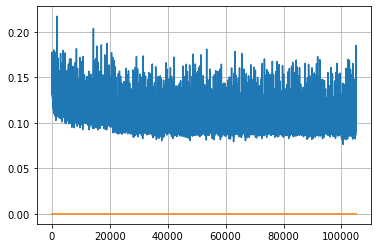

Epoch: 270, iteration 0, loss 0.1067483127117157, cov_diff 0.40673994552493026 cov_diff train 0.4059815910942256
Epoch: 270, iteration 1, loss 0.10735437273979187, cov_diff 0.4173423731033347 cov_diff train 0.41626346446342377
Epoch: 270, iteration 2, loss 0.10903385281562805, cov_diff 0.41375481283444376 cov_diff train 0.41348331439158875
Epoch: 270, iteration 3, loss 0.08965858817100525, cov_diff 0.40487654623480324 cov_diff train 0.404353468463197
Epoch: 270, iteration 4, loss 0.1170417070388794, cov_diff 0.41789770555830213 cov_diff train 0.4168420575774635
Epoch: 270, iteration 5, loss 0.10909157991409302, cov_diff 0.42079331482098786 cov_diff train 0.42026783013245084
Epoch: 270, iteration 6, loss 0.10456523299217224, cov_diff 0.4196401751086879 cov_diff train 0.41901812054865045
Epoch: 270, iteration 7, loss 0.10055035352706909, cov_diff 0.40564394070848003 cov_diff train 0.40585556259190086
Epoch: 270, iteration 8, loss 0.12025371193885803, cov_diff 0.412876086888946 cov_diff t

Epoch: 270, iteration 78, loss 0.1126268208026886, cov_diff 0.40761355917363096 cov_diff train 0.4067898366802974
Epoch: 270, iteration 79, loss 0.10493329167366028, cov_diff 0.4077619994249253 cov_diff train 0.4077328407460918
Epoch: 270, iteration 80, loss 0.11069294810295105, cov_diff 0.4266916524953168 cov_diff train 0.4244128947079643
Epoch: 270, iteration 81, loss 0.11261406540870667, cov_diff 0.4107954941310315 cov_diff train 0.4104023180930458
Epoch: 270, iteration 82, loss 0.09072825312614441, cov_diff 0.4023124214760037 cov_diff train 0.4021465204130652
Epoch: 270, iteration 83, loss 0.09970542788505554, cov_diff 0.40125921733300096 cov_diff train 0.40057862055333937
Epoch: 270, iteration 84, loss 0.10903275012969971, cov_diff 0.4049528332838948 cov_diff train 0.4047867007611793
Epoch: 270, iteration 85, loss 0.11206653714179993, cov_diff 0.40370238440870154 cov_diff train 0.4039347173314363
Epoch: 270, iteration 86, loss 0.11020341515541077, cov_diff 0.4165943720992632 cov_d

Epoch: 270, iteration 157, loss 0.10411620140075684, cov_diff 0.4128004408462397 cov_diff train 0.4127278757585999
Epoch: 270, iteration 158, loss 0.10797759890556335, cov_diff 0.42006222749172345 cov_diff train 0.4188816488706227
Epoch: 270, iteration 159, loss 0.09827917814254761, cov_diff 0.4046719628144928 cov_diff train 0.40296471829999797
Epoch: 270, iteration 160, loss 0.09381484985351562, cov_diff 0.42271667311512745 cov_diff train 0.4213825272963876
Epoch: 270, iteration 161, loss 0.09537875652313232, cov_diff 0.4132244414616475 cov_diff train 0.41237647638901126
Epoch: 270, iteration 162, loss 0.09455746412277222, cov_diff 0.4074402564906576 cov_diff train 0.4067908689363904
Epoch: 270, iteration 163, loss 0.08989286422729492, cov_diff 0.40079736818571504 cov_diff train 0.40064139843110474
Epoch: 270, iteration 164, loss 0.110510915517807, cov_diff 0.4157202998337365 cov_diff train 0.41483447767974657
Epoch: 270, iteration 165, loss 0.10059341788291931, cov_diff 0.41140165918

Epoch: 270, iteration 235, loss 0.11125808954238892, cov_diff 0.4044671272150011 cov_diff train 0.40473804788405054
Epoch: 270, iteration 236, loss 0.09472641348838806, cov_diff 0.4150564390810453 cov_diff train 0.41514657794441756
Epoch: 270, iteration 237, loss 0.11385700106620789, cov_diff 0.4069306250720064 cov_diff train 0.4055340336321838
Epoch: 270, iteration 238, loss 0.10181319713592529, cov_diff 0.4226034776059649 cov_diff train 0.4220102541077741
Epoch: 270, iteration 239, loss 0.08651241660118103, cov_diff 0.4008980008967123 cov_diff train 0.4008552762441256
Epoch: 270, iteration 240, loss 0.10215729475021362, cov_diff 0.42014299902795166 cov_diff train 0.42027544257467936
Epoch: 270, iteration 241, loss 0.10335034132003784, cov_diff 0.42287052993672897 cov_diff train 0.42317254657489206
Epoch: 270, iteration 242, loss 0.0957784652709961, cov_diff 0.41614525991155077 cov_diff train 0.4156789692407084
Epoch: 270, iteration 243, loss 0.10113590955734253, cov_diff 0.4198133337

Epoch: 270, iteration 314, loss 0.1019948422908783, cov_diff 0.40928558236153867 cov_diff train 0.40856208689561435
Epoch: 270, iteration 315, loss 0.09898877143859863, cov_diff 0.41849094476269205 cov_diff train 0.4173737261074458
Epoch: 270, iteration 316, loss 0.10810548067092896, cov_diff 0.42439072969224795 cov_diff train 0.4231231358745606
Epoch: 270, iteration 317, loss 0.11879566311836243, cov_diff 0.4123422750937095 cov_diff train 0.4117664665145378
Epoch: 270, iteration 318, loss 0.09773686528205872, cov_diff 0.4156857319919794 cov_diff train 0.4148272468027207
Epoch: 270, iteration 319, loss 0.10102856159210205, cov_diff 0.4057976275111271 cov_diff train 0.404781925308508
Epoch: 270, iteration 320, loss 0.09894216060638428, cov_diff 0.4160106626501268 cov_diff train 0.4157678405585162
Epoch: 270, iteration 321, loss 0.10232734680175781, cov_diff 0.42116284351211625 cov_diff train 0.41983969007467276
Epoch: 270, iteration 322, loss 0.10826951265335083, cov_diff 0.423061774658

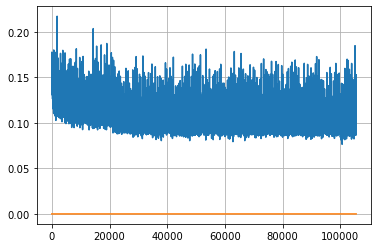

Epoch: 271, iteration 0, loss 0.09704205393791199, cov_diff 0.4292678763905025 cov_diff train 0.42844142050363593
Epoch: 271, iteration 1, loss 0.09590119123458862, cov_diff 0.41906409880106105 cov_diff train 0.41870957290017746
Epoch: 271, iteration 2, loss 0.09900680184364319, cov_diff 0.41658782147165874 cov_diff train 0.4161987277237023
Epoch: 271, iteration 3, loss 0.09664887189865112, cov_diff 0.4091386214660377 cov_diff train 0.4084710323720977
Epoch: 271, iteration 4, loss 0.10663267970085144, cov_diff 0.4021090921849943 cov_diff train 0.40185695469328264
Epoch: 271, iteration 5, loss 0.08992493152618408, cov_diff 0.3958641713894645 cov_diff train 0.3946982939712285
Epoch: 271, iteration 6, loss 0.1115688681602478, cov_diff 0.4138915956862344 cov_diff train 0.4134950394347566
Epoch: 271, iteration 7, loss 0.09386715292930603, cov_diff 0.414810367208416 cov_diff train 0.4141276830000051
Epoch: 271, iteration 8, loss 0.10264527797698975, cov_diff 0.40628980615900917 cov_diff trai

Epoch: 271, iteration 78, loss 0.10555580258369446, cov_diff 0.41274305988907906 cov_diff train 0.4116489580008733
Epoch: 271, iteration 79, loss 0.10994687676429749, cov_diff 0.4076036213677515 cov_diff train 0.40649186797516607
Epoch: 271, iteration 80, loss 0.1003122329711914, cov_diff 0.413645080421801 cov_diff train 0.41217872564037317
Epoch: 271, iteration 81, loss 0.10236978530883789, cov_diff 0.41304527746360575 cov_diff train 0.41237131840707386
Epoch: 271, iteration 82, loss 0.11340400576591492, cov_diff 0.4157390258366392 cov_diff train 0.41489025647959993
Epoch: 271, iteration 83, loss 0.10028794407844543, cov_diff 0.40135784838134664 cov_diff train 0.40052069205703367
Epoch: 271, iteration 84, loss 0.09839630126953125, cov_diff 0.40713425240408585 cov_diff train 0.40592900948663074
Epoch: 271, iteration 85, loss 0.1079103946685791, cov_diff 0.4094770392624418 cov_diff train 0.40895494041160685
Epoch: 271, iteration 86, loss 0.1112968921661377, cov_diff 0.40003743160957567 

Epoch: 271, iteration 156, loss 0.10610809922218323, cov_diff 0.4087782497906705 cov_diff train 0.4073774170974053
Epoch: 271, iteration 157, loss 0.1053926944732666, cov_diff 0.41643710905051123 cov_diff train 0.41655318596108626
Epoch: 271, iteration 158, loss 0.11266756057739258, cov_diff 0.4132149476748492 cov_diff train 0.41211662798497817
Epoch: 271, iteration 159, loss 0.11155891418457031, cov_diff 0.41823389660226457 cov_diff train 0.41661264472222
Epoch: 271, iteration 160, loss 0.08912137150764465, cov_diff 0.40339310423079444 cov_diff train 0.4028278860150561
Epoch: 271, iteration 161, loss 0.10800686478614807, cov_diff 0.425871486671345 cov_diff train 0.42569952663205796
Epoch: 271, iteration 162, loss 0.09077513217926025, cov_diff 0.40748219053721796 cov_diff train 0.4071814776762806
Epoch: 271, iteration 163, loss 0.09954637289047241, cov_diff 0.4041603586179444 cov_diff train 0.40406696889160926
Epoch: 271, iteration 164, loss 0.09870392084121704, cov_diff 0.422471060695

Epoch: 271, iteration 236, loss 0.10745653510093689, cov_diff 0.40507105261642984 cov_diff train 0.40428732519493216
Epoch: 271, iteration 237, loss 0.1019708514213562, cov_diff 0.41337267152550033 cov_diff train 0.4123966548780348
Epoch: 271, iteration 238, loss 0.09764561057090759, cov_diff 0.4045386081162975 cov_diff train 0.40501365120899574
Epoch: 271, iteration 239, loss 0.10118749737739563, cov_diff 0.4264484811897631 cov_diff train 0.42556187147963254
Epoch: 271, iteration 240, loss 0.09307271242141724, cov_diff 0.4018752234987337 cov_diff train 0.401204330238099
Epoch: 271, iteration 241, loss 0.10648471117019653, cov_diff 0.4061921691577552 cov_diff train 0.4052769661573282
Epoch: 271, iteration 242, loss 0.10067084431648254, cov_diff 0.42140755847969835 cov_diff train 0.42084881915048616
Epoch: 271, iteration 243, loss 0.10353696346282959, cov_diff 0.42428180732696547 cov_diff train 0.4236977400551267
Epoch: 271, iteration 244, loss 0.10174226760864258, cov_diff 0.4027806149

Epoch: 271, iteration 314, loss 0.10579884052276611, cov_diff 0.41152812098583985 cov_diff train 0.4108567918849828
Epoch: 271, iteration 315, loss 0.1002684235572815, cov_diff 0.4132059066595562 cov_diff train 0.4117150416801316
Epoch: 271, iteration 316, loss 0.11380267143249512, cov_diff 0.4151222218089832 cov_diff train 0.41396040739225226
Epoch: 271, iteration 317, loss 0.09370362758636475, cov_diff 0.4100559375144376 cov_diff train 0.40974959034135855
Epoch: 271, iteration 318, loss 0.10507473349571228, cov_diff 0.42830239499446593 cov_diff train 0.4272489734954734
Epoch: 271, iteration 319, loss 0.11545896530151367, cov_diff 0.40799085648898714 cov_diff train 0.406564019026812
Epoch: 271, iteration 320, loss 0.10422846674919128, cov_diff 0.4244808263920453 cov_diff train 0.423386062213048
Epoch: 271, iteration 321, loss 0.11022281646728516, cov_diff 0.4145088533820235 cov_diff train 0.41376423465699735
Epoch: 271, iteration 322, loss 0.1051594614982605, cov_diff 0.41504058233916

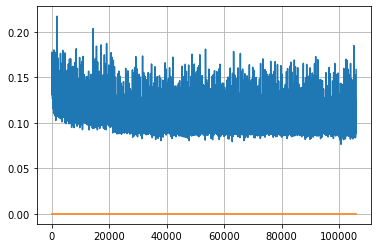

Epoch: 272, iteration 0, loss 0.09720110893249512, cov_diff 0.42316759202661236 cov_diff train 0.42243653024339406
Epoch: 272, iteration 1, loss 0.10454124212265015, cov_diff 0.4243013053078859 cov_diff train 0.42364952039057097
Epoch: 272, iteration 2, loss 0.09551000595092773, cov_diff 0.3978625073076608 cov_diff train 0.39681089217337634
Epoch: 272, iteration 3, loss 0.094879150390625, cov_diff 0.4074888916945229 cov_diff train 0.40673393395103125
Epoch: 272, iteration 4, loss 0.09432029724121094, cov_diff 0.40884866579619455 cov_diff train 0.4086700100463544
Epoch: 272, iteration 5, loss 0.11174905300140381, cov_diff 0.43676674669058824 cov_diff train 0.4361639996913999
Epoch: 272, iteration 6, loss 0.10210934281349182, cov_diff 0.41368479632905764 cov_diff train 0.4128485772096686
Epoch: 272, iteration 7, loss 0.09938681125640869, cov_diff 0.42287780253218743 cov_diff train 0.4223110922477831
Epoch: 272, iteration 8, loss 0.09924930334091187, cov_diff 0.4178451920208386 cov_diff t

Epoch: 272, iteration 77, loss 0.10346251726150513, cov_diff 0.41890586389819773 cov_diff train 0.4175328648589135
Epoch: 272, iteration 78, loss 0.10701212286949158, cov_diff 0.4158824271479905 cov_diff train 0.4148522786671918
Epoch: 272, iteration 79, loss 0.103064626455307, cov_diff 0.4183490726683348 cov_diff train 0.41739429076681644
Epoch: 272, iteration 80, loss 0.0919598937034607, cov_diff 0.4134482951183227 cov_diff train 0.41255520522555883
Epoch: 272, iteration 81, loss 0.09461057186126709, cov_diff 0.4008666177697133 cov_diff train 0.3994162888444327
Epoch: 272, iteration 82, loss 0.11017724871635437, cov_diff 0.41755385664557765 cov_diff train 0.4158522161322704
Epoch: 272, iteration 83, loss 0.09340789914131165, cov_diff 0.4202888540123915 cov_diff train 0.4200698849065047
Epoch: 272, iteration 84, loss 0.10672077536582947, cov_diff 0.4081772519631481 cov_diff train 0.4080279375070603
Epoch: 272, iteration 85, loss 0.1075289249420166, cov_diff 0.40288074197035467 cov_dif

Epoch: 272, iteration 149, loss 0.09201112389564514, cov_diff 0.4109573431817515 cov_diff train 0.41046318744895316
Epoch: 272, iteration 150, loss 0.10401007533073425, cov_diff 0.4234822232247272 cov_diff train 0.4221207228241222
Epoch: 272, iteration 151, loss 0.127742737531662, cov_diff 0.41744363685249825 cov_diff train 0.41684623728106673
Epoch: 272, iteration 152, loss 0.11041250824928284, cov_diff 0.4051919509770458 cov_diff train 0.40407589460495424
Epoch: 272, iteration 153, loss 0.11856362223625183, cov_diff 0.40833292311113345 cov_diff train 0.4083126066597147
Epoch: 272, iteration 154, loss 0.11611485481262207, cov_diff 0.4037381873366805 cov_diff train 0.40310487380602633
Epoch: 272, iteration 155, loss 0.11437302827835083, cov_diff 0.40706929739011466 cov_diff train 0.40650478630235687
Epoch: 272, iteration 156, loss 0.09206146001815796, cov_diff 0.4132550410329509 cov_diff train 0.41155624438940197
Epoch: 272, iteration 157, loss 0.09546676278114319, cov_diff 0.416562913

Epoch: 272, iteration 220, loss 0.0920267105102539, cov_diff 0.41141041157882124 cov_diff train 0.4105164942307314
Epoch: 272, iteration 221, loss 0.09190857410430908, cov_diff 0.40854640666731157 cov_diff train 0.40856397384863974
Epoch: 272, iteration 222, loss 0.10075131058692932, cov_diff 0.4074060355787586 cov_diff train 0.40650393004173074
Epoch: 272, iteration 223, loss 0.09902721643447876, cov_diff 0.4030043922133236 cov_diff train 0.4032188447549
Epoch: 272, iteration 224, loss 0.10484710335731506, cov_diff 0.4128296976889684 cov_diff train 0.41219733886633386
Epoch: 272, iteration 225, loss 0.11286628246307373, cov_diff 0.41595780224527684 cov_diff train 0.4158226906315876
Epoch: 272, iteration 226, loss 0.10615485906600952, cov_diff 0.4010872112695722 cov_diff train 0.40085136752053896
Epoch: 272, iteration 227, loss 0.09383046627044678, cov_diff 0.41212738613859323 cov_diff train 0.41220703141132947
Epoch: 272, iteration 228, loss 0.10500118136405945, cov_diff 0.42054180616

Epoch: 272, iteration 297, loss 0.09813421964645386, cov_diff 0.40726965206840143 cov_diff train 0.406237234241611
Epoch: 272, iteration 298, loss 0.09992021322250366, cov_diff 0.4032359116469623 cov_diff train 0.40217297130851803
Epoch: 272, iteration 299, loss 0.09538039565086365, cov_diff 0.41576357817368365 cov_diff train 0.41436817343315424
Epoch: 272, iteration 300, loss 0.09282690286636353, cov_diff 0.4131825194937474 cov_diff train 0.41273248839024596
Epoch: 272, iteration 301, loss 0.09809443354606628, cov_diff 0.40758242789183247 cov_diff train 0.40686845263405924
Epoch: 272, iteration 302, loss 0.09817919135093689, cov_diff 0.398859328677411 cov_diff train 0.3981763427227814
Epoch: 272, iteration 303, loss 0.11441048979759216, cov_diff 0.39962204992879385 cov_diff train 0.3992300005684551
Epoch: 272, iteration 304, loss 0.1017029881477356, cov_diff 0.4135720340812594 cov_diff train 0.4138250137507098
Epoch: 272, iteration 305, loss 0.09877559542655945, cov_diff 0.40468951645

Epoch: 272, iteration 373, loss 0.10081923007965088, cov_diff 0.4070252512941009 cov_diff train 0.40675491643125705
Epoch: 272, iteration 374, loss 0.1048886775970459, cov_diff 0.4162694563933448 cov_diff train 0.4162178714336128
Epoch: 272, iteration 375, loss 0.10296335816383362, cov_diff 0.41225588368847993 cov_diff train 0.4121171150896684
Epoch: 272, iteration 376, loss 0.10678660869598389, cov_diff 0.4080209696139406 cov_diff train 0.4065040582927307
Epoch: 272, iteration 377, loss 0.1074666976928711, cov_diff 0.4127785613702323 cov_diff train 0.4120959030435455
Epoch: 272, iteration 378, loss 0.11227360367774963, cov_diff 0.4103904397172026 cov_diff train 0.40974066704327305
Epoch: 272, iteration 379, loss 0.10304379463195801, cov_diff 0.4209766736853831 cov_diff train 0.4203452838474167
Epoch: 272, iteration 380, loss 0.09495019912719727, cov_diff 0.4091885305609353 cov_diff train 0.40952137844559144
Epoch: 272, iteration 381, loss 0.09852480888366699, cov_diff 0.41705388018544

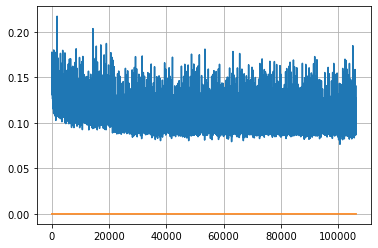

Epoch: 273, iteration 0, loss 0.09745115041732788, cov_diff 0.41441093002852786 cov_diff train 0.4137195436744879
Epoch: 273, iteration 1, loss 0.10414931178092957, cov_diff 0.42311860386998706 cov_diff train 0.42163464103301296
Epoch: 273, iteration 2, loss 0.1158289909362793, cov_diff 0.4096839312257769 cov_diff train 0.41054722511631797
Epoch: 273, iteration 3, loss 0.11228436231613159, cov_diff 0.4257233885255519 cov_diff train 0.4238433016348766
Epoch: 273, iteration 4, loss 0.10011476278305054, cov_diff 0.41512429065496076 cov_diff train 0.41402148282129325
Epoch: 273, iteration 5, loss 0.1122967004776001, cov_diff 0.40078077668680956 cov_diff train 0.40006064923123363
Epoch: 273, iteration 6, loss 0.10797673463821411, cov_diff 0.4051108065385314 cov_diff train 0.4045822791920424
Epoch: 273, iteration 7, loss 0.10386919975280762, cov_diff 0.42395353327336754 cov_diff train 0.4232473160995435
Epoch: 273, iteration 8, loss 0.09708279371261597, cov_diff 0.4201228683275397 cov_diff t

Epoch: 273, iteration 76, loss 0.10543471574783325, cov_diff 0.3982076744252559 cov_diff train 0.3968321034571752
Epoch: 273, iteration 77, loss 0.10182356834411621, cov_diff 0.41364746230121857 cov_diff train 0.4127938239892454
Epoch: 273, iteration 78, loss 0.0977959930896759, cov_diff 0.40904680923490716 cov_diff train 0.4091227035406897
Epoch: 273, iteration 79, loss 0.10964229702949524, cov_diff 0.40648859515999736 cov_diff train 0.4058458508982177
Epoch: 273, iteration 80, loss 0.09600615501403809, cov_diff 0.4164771520987095 cov_diff train 0.4169691484704782
Epoch: 273, iteration 81, loss 0.10777795314788818, cov_diff 0.40767536632585927 cov_diff train 0.40715602492874964
Epoch: 273, iteration 82, loss 0.10562807321548462, cov_diff 0.41361659683319063 cov_diff train 0.41291618556194165
Epoch: 273, iteration 83, loss 0.11411270499229431, cov_diff 0.4220958990449673 cov_diff train 0.4207144733296238
Epoch: 273, iteration 84, loss 0.10173070430755615, cov_diff 0.41358367654594236 c

Epoch: 273, iteration 149, loss 0.10130807757377625, cov_diff 0.41411331226783776 cov_diff train 0.4115937887033935
Epoch: 273, iteration 150, loss 0.10836580395698547, cov_diff 0.41496490773578065 cov_diff train 0.414581225786104
Epoch: 273, iteration 151, loss 0.10689106583595276, cov_diff 0.41311644159525673 cov_diff train 0.41280414894473627
Epoch: 273, iteration 152, loss 0.09721675515174866, cov_diff 0.41580373873305604 cov_diff train 0.4144323217373277
Epoch: 273, iteration 153, loss 0.1075410544872284, cov_diff 0.40456980497904327 cov_diff train 0.40373529317193435
Epoch: 273, iteration 154, loss 0.10733509063720703, cov_diff 0.41130242160374414 cov_diff train 0.41076246768456987
Epoch: 273, iteration 155, loss 0.11326101422309875, cov_diff 0.42057079462250185 cov_diff train 0.4193374819221022
Epoch: 273, iteration 156, loss 0.10610634088516235, cov_diff 0.41976049312181285 cov_diff train 0.41907892617258
Epoch: 273, iteration 157, loss 0.1117323637008667, cov_diff 0.4157996213

Epoch: 273, iteration 220, loss 0.12025284767150879, cov_diff 0.41286186016341675 cov_diff train 0.4124687908178444
Epoch: 273, iteration 221, loss 0.10027775168418884, cov_diff 0.4162834828755751 cov_diff train 0.4153225890553599
Epoch: 273, iteration 222, loss 0.10412067174911499, cov_diff 0.40967163958068864 cov_diff train 0.4091692528084604
Epoch: 273, iteration 223, loss 0.097785085439682, cov_diff 0.4165650832296343 cov_diff train 0.4160040292048701
Epoch: 273, iteration 224, loss 0.10705456137657166, cov_diff 0.4212644192144283 cov_diff train 0.4214063440081282
Epoch: 273, iteration 225, loss 0.10524484515190125, cov_diff 0.406263513714884 cov_diff train 0.4072279232322056
Epoch: 273, iteration 226, loss 0.11526241898536682, cov_diff 0.41652354515802764 cov_diff train 0.41639948990463715
Epoch: 273, iteration 227, loss 0.10691055655479431, cov_diff 0.3970711522600166 cov_diff train 0.39599083215449915
Epoch: 273, iteration 228, loss 0.10472914576530457, cov_diff 0.40474309836272

Epoch: 273, iteration 294, loss 0.10181358456611633, cov_diff 0.4155572819607103 cov_diff train 0.4146999690517771
Epoch: 273, iteration 295, loss 0.11286506056785583, cov_diff 0.4268828804490896 cov_diff train 0.42621404305435284
Epoch: 273, iteration 296, loss 0.09585714340209961, cov_diff 0.4196027211688087 cov_diff train 0.41810005576901704
Epoch: 273, iteration 297, loss 0.10654979944229126, cov_diff 0.4096719419600006 cov_diff train 0.4083289148681285
Epoch: 273, iteration 298, loss 0.0945708155632019, cov_diff 0.40623983095544536 cov_diff train 0.4061035940077486
Epoch: 273, iteration 299, loss 0.10121786594390869, cov_diff 0.41696257069988696 cov_diff train 0.4155412913698244
Epoch: 273, iteration 300, loss 0.10470610857009888, cov_diff 0.40956359557575117 cov_diff train 0.4097246610062442
Epoch: 273, iteration 301, loss 0.09798264503479004, cov_diff 0.4079402943443413 cov_diff train 0.40751832756067025
Epoch: 273, iteration 302, loss 0.10644418001174927, cov_diff 0.41066742863

Epoch: 273, iteration 367, loss 0.11024090647697449, cov_diff 0.4017833694175513 cov_diff train 0.40156342293231995
Epoch: 273, iteration 368, loss 0.10526531934738159, cov_diff 0.42827185254316574 cov_diff train 0.42736956264036324
Epoch: 273, iteration 369, loss 0.11422106623649597, cov_diff 0.4229134170598023 cov_diff train 0.4218184437184997
Epoch: 273, iteration 370, loss 0.0952109694480896, cov_diff 0.4050483998200688 cov_diff train 0.40378102905393853
Epoch: 273, iteration 371, loss 0.1016131043434143, cov_diff 0.41263291656904416 cov_diff train 0.4128040580639546
Epoch: 273, iteration 372, loss 0.10400941967964172, cov_diff 0.4203873323042572 cov_diff train 0.4202118425286282
Epoch: 273, iteration 373, loss 0.09795111417770386, cov_diff 0.40715453492567255 cov_diff train 0.40690065219136057
Epoch: 273, iteration 374, loss 0.10557225346565247, cov_diff 0.41550330453979295 cov_diff train 0.41504838618672235
Epoch: 273, iteration 375, loss 0.09495478868484497, cov_diff 0.420040735

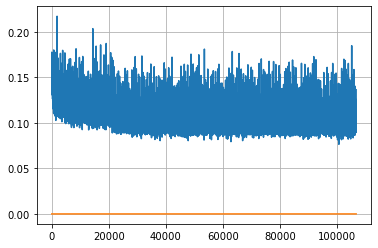

Epoch: 274, iteration 0, loss 0.10378983616828918, cov_diff 0.39213845274483167 cov_diff train 0.39164316702456875
Epoch: 274, iteration 1, loss 0.10679075121879578, cov_diff 0.40293678384313814 cov_diff train 0.4027897589165008
Epoch: 274, iteration 2, loss 0.11016762256622314, cov_diff 0.3988161026358016 cov_diff train 0.39800855962388104
Epoch: 274, iteration 3, loss 0.10095933079719543, cov_diff 0.4203514801173088 cov_diff train 0.42062496959640244
Epoch: 274, iteration 4, loss 0.1091989278793335, cov_diff 0.4029862444985081 cov_diff train 0.40220497562911767
Epoch: 274, iteration 5, loss 0.10315749049186707, cov_diff 0.4087384700707746 cov_diff train 0.40869921551783994
Epoch: 274, iteration 6, loss 0.10749936103820801, cov_diff 0.426269684373551 cov_diff train 0.42634989467501205
Epoch: 274, iteration 7, loss 0.11108937859535217, cov_diff 0.40469343782807093 cov_diff train 0.4043637216916706
Epoch: 274, iteration 8, loss 0.11664974689483643, cov_diff 0.40987513977414175 cov_diff 

Epoch: 274, iteration 77, loss 0.09285688400268555, cov_diff 0.42011091758228614 cov_diff train 0.4191771418334851
Epoch: 274, iteration 78, loss 0.09358304738998413, cov_diff 0.4231860291279371 cov_diff train 0.42241069576406
Epoch: 274, iteration 79, loss 0.11731967329978943, cov_diff 0.4030357042788208 cov_diff train 0.40208046311926715
Epoch: 274, iteration 80, loss 0.10462760925292969, cov_diff 0.4119355757807006 cov_diff train 0.4114967180490491
Epoch: 274, iteration 81, loss 0.09188491106033325, cov_diff 0.41024147163118635 cov_diff train 0.40997446515224034
Epoch: 274, iteration 82, loss 0.11144408583641052, cov_diff 0.41369783196998394 cov_diff train 0.4132695020644753
Epoch: 274, iteration 83, loss 0.10149350762367249, cov_diff 0.41379161262806297 cov_diff train 0.41319585089833594
Epoch: 274, iteration 84, loss 0.10117560625076294, cov_diff 0.416421267989122 cov_diff train 0.41636266575979575
Epoch: 274, iteration 85, loss 0.09646528959274292, cov_diff 0.4135772134664324 cov

Epoch: 274, iteration 154, loss 0.09975767135620117, cov_diff 0.4154163523115869 cov_diff train 0.41476860734568755
Epoch: 274, iteration 155, loss 0.10215049982070923, cov_diff 0.4121498164579311 cov_diff train 0.4112943329320397
Epoch: 274, iteration 156, loss 0.11119222640991211, cov_diff 0.41224416744601555 cov_diff train 0.41143231951235887
Epoch: 274, iteration 157, loss 0.08890530467033386, cov_diff 0.407527332452243 cov_diff train 0.40650440317486763
Epoch: 274, iteration 158, loss 0.09957081079483032, cov_diff 0.4041348121507954 cov_diff train 0.40377887247774114
Epoch: 274, iteration 159, loss 0.1054682731628418, cov_diff 0.4081103930680716 cov_diff train 0.40728689841514126
Epoch: 274, iteration 160, loss 0.10218560695648193, cov_diff 0.39200943814899797 cov_diff train 0.39154965702761524
Epoch: 274, iteration 161, loss 0.10759273171424866, cov_diff 0.41955658998980605 cov_diff train 0.4198162847558044
Epoch: 274, iteration 162, loss 0.1194409430027008, cov_diff 0.4151349798

Epoch: 274, iteration 231, loss 0.09729883074760437, cov_diff 0.405924965825528 cov_diff train 0.40561340209534363
Epoch: 274, iteration 232, loss 0.10286387801170349, cov_diff 0.4068752354439285 cov_diff train 0.4065182216782919
Epoch: 274, iteration 233, loss 0.10527780652046204, cov_diff 0.40653750501419567 cov_diff train 0.4058774264513592
Epoch: 274, iteration 234, loss 0.10342535376548767, cov_diff 0.4074139143133678 cov_diff train 0.4067013383620182
Epoch: 274, iteration 235, loss 0.10718321800231934, cov_diff 0.40952719533459175 cov_diff train 0.409033690607335
Epoch: 274, iteration 236, loss 0.11002293229103088, cov_diff 0.40971502529768655 cov_diff train 0.4097080179772077
Epoch: 274, iteration 237, loss 0.1019599437713623, cov_diff 0.39944122310868857 cov_diff train 0.39944230606937337
Epoch: 274, iteration 238, loss 0.09712189435958862, cov_diff 0.4079210932579998 cov_diff train 0.40708145668200735
Epoch: 274, iteration 239, loss 0.09985414147377014, cov_diff 0.419242077700

Epoch: 274, iteration 308, loss 0.10531818866729736, cov_diff 0.4038106749568811 cov_diff train 0.40347180050877596
Epoch: 274, iteration 309, loss 0.11354726552963257, cov_diff 0.39362234708912264 cov_diff train 0.3940077777354742
Epoch: 274, iteration 310, loss 0.10773518681526184, cov_diff 0.40468293655027454 cov_diff train 0.4053637726150985
Epoch: 274, iteration 311, loss 0.11142858862876892, cov_diff 0.4083489187936227 cov_diff train 0.4072633062362697
Epoch: 274, iteration 312, loss 0.10675272345542908, cov_diff 0.42118128818404066 cov_diff train 0.421461987945299
Epoch: 274, iteration 313, loss 0.10621523857116699, cov_diff 0.41174864341135037 cov_diff train 0.41156254086976923
Epoch: 274, iteration 314, loss 0.1028134822845459, cov_diff 0.40818170092248235 cov_diff train 0.4076785421105303
Epoch: 274, iteration 315, loss 0.11243227124214172, cov_diff 0.4226901653898729 cov_diff train 0.422588081179612
Epoch: 274, iteration 316, loss 0.10124394297599792, cov_diff 0.427524223406

Epoch: 274, iteration 383, loss 0.10426467657089233, cov_diff 0.4091789417047298 cov_diff train 0.40841284801607475
Epoch: 274, iteration 384, loss 0.10627749562263489, cov_diff 0.4097585414563372 cov_diff train 0.4092608144344116
Epoch: 274, iteration 385, loss 0.10781040787696838, cov_diff 0.40619966429450227 cov_diff train 0.4058583477761964
Epoch: 274, iteration 386, loss 0.10029342770576477, cov_diff 0.42411129169667416 cov_diff train 0.4238952663888583
Epoch: 274, iteration 387, loss 0.09271609783172607, cov_diff 0.3972411046024562 cov_diff train 0.397118574169114
Epoch: 274, iteration 388, loss 0.10212889313697815, cov_diff 0.4158743460519298 cov_diff train 0.4159915341526998
Epoch: 274, iteration 389, loss 0.1021685004234314, cov_diff 0.4193167812951589 cov_diff train 0.41765485034558303
Epoch: 274, iteration 390, loss 0.16118240356445312, cov_diff 0.4551678555673463 cov_diff train 0.4526244680539376


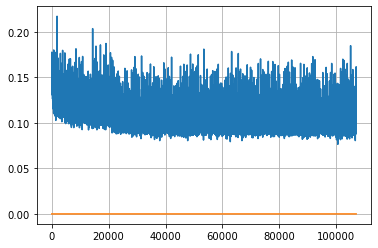

Epoch: 275, iteration 0, loss 0.09743386507034302, cov_diff 0.40808878410095323 cov_diff train 0.40828534317418613
Epoch: 275, iteration 1, loss 0.10539931058883667, cov_diff 0.4036707973702044 cov_diff train 0.40385743103724336
Epoch: 275, iteration 2, loss 0.10570335388183594, cov_diff 0.40774670547766273 cov_diff train 0.4072608504783777
Epoch: 275, iteration 3, loss 0.09115549921989441, cov_diff 0.4162430264136859 cov_diff train 0.416624185086208
Epoch: 275, iteration 4, loss 0.11162811517715454, cov_diff 0.4135935803164637 cov_diff train 0.41304506227663623
Epoch: 275, iteration 5, loss 0.1086764931678772, cov_diff 0.4221870767102586 cov_diff train 0.42173477633232487
Epoch: 275, iteration 6, loss 0.10066473484039307, cov_diff 0.4211023825288711 cov_diff train 0.42082961622878284
Epoch: 275, iteration 7, loss 0.09438741207122803, cov_diff 0.4101484515370659 cov_diff train 0.40969708740491506
Epoch: 275, iteration 8, loss 0.09436851739883423, cov_diff 0.4248989493003675 cov_diff tr

Epoch: 275, iteration 78, loss 0.09346836805343628, cov_diff 0.4115458743578594 cov_diff train 0.41094701638545705
Epoch: 275, iteration 79, loss 0.09918919205665588, cov_diff 0.42364058570567714 cov_diff train 0.4230205075116977
Epoch: 275, iteration 80, loss 0.1060631275177002, cov_diff 0.4236348130631439 cov_diff train 0.4219341083980464
Epoch: 275, iteration 81, loss 0.10229527950286865, cov_diff 0.4178647857302684 cov_diff train 0.4178662487371516
Epoch: 275, iteration 82, loss 0.11198052763938904, cov_diff 0.4248094783313942 cov_diff train 0.4237791594685548
Epoch: 275, iteration 83, loss 0.11609771847724915, cov_diff 0.4062397236081893 cov_diff train 0.4051505907286073
Epoch: 275, iteration 84, loss 0.11136892437934875, cov_diff 0.41539582010646675 cov_diff train 0.41467520351643095
Epoch: 275, iteration 85, loss 0.11168617010116577, cov_diff 0.41242945991163654 cov_diff train 0.41109113626078303
Epoch: 275, iteration 86, loss 0.10198730230331421, cov_diff 0.41383144731669563 co

Epoch: 275, iteration 152, loss 0.10926279425621033, cov_diff 0.41613307928994325 cov_diff train 0.41521696936954583
Epoch: 275, iteration 153, loss 0.10840654373168945, cov_diff 0.3987577601173292 cov_diff train 0.3989387810485817
Epoch: 275, iteration 154, loss 0.10385984182357788, cov_diff 0.4080164570471241 cov_diff train 0.4059038148727835
Epoch: 275, iteration 155, loss 0.10063931345939636, cov_diff 0.41637317898730397 cov_diff train 0.416107372600618
Epoch: 275, iteration 156, loss 0.10160443186759949, cov_diff 0.41349767192960174 cov_diff train 0.4137362708818391
Epoch: 275, iteration 157, loss 0.09785622358322144, cov_diff 0.4080238800822955 cov_diff train 0.40714232855224536
Epoch: 275, iteration 158, loss 0.10826969146728516, cov_diff 0.4180452516096528 cov_diff train 0.4180166815525478
Epoch: 275, iteration 159, loss 0.09277138113975525, cov_diff 0.42032876465841834 cov_diff train 0.42025670278687893
Epoch: 275, iteration 160, loss 0.11250472068786621, cov_diff 0.4158176626

Epoch: 275, iteration 228, loss 0.099326491355896, cov_diff 0.42421237028417613 cov_diff train 0.42326916788032093
Epoch: 275, iteration 229, loss 0.10697513818740845, cov_diff 0.40751445511138185 cov_diff train 0.40698176672790093
Epoch: 275, iteration 230, loss 0.09363192319869995, cov_diff 0.4077318452523418 cov_diff train 0.4076541074942725
Epoch: 275, iteration 231, loss 0.09928423166275024, cov_diff 0.4165429929847007 cov_diff train 0.4154425383135269
Epoch: 275, iteration 232, loss 0.10173651576042175, cov_diff 0.4178692642247575 cov_diff train 0.41779794929222996
Epoch: 275, iteration 233, loss 0.09964179992675781, cov_diff 0.4154223107144586 cov_diff train 0.41492413623775465
Epoch: 275, iteration 234, loss 0.11824539303779602, cov_diff 0.4258815684742895 cov_diff train 0.425264843175585
Epoch: 275, iteration 235, loss 0.10497280955314636, cov_diff 0.415979984590064 cov_diff train 0.4143526875126397
Epoch: 275, iteration 236, loss 0.10448038578033447, cov_diff 0.41865900342411

Epoch: 275, iteration 305, loss 0.1030450165271759, cov_diff 0.4049138859041999 cov_diff train 0.4042633648527077
Epoch: 275, iteration 306, loss 0.10484579205513, cov_diff 0.4216362375997427 cov_diff train 0.4206964436714504
Epoch: 275, iteration 307, loss 0.11097794771194458, cov_diff 0.4167022662667216 cov_diff train 0.41550538326882736
Epoch: 275, iteration 308, loss 0.09988540410995483, cov_diff 0.4106584093121931 cov_diff train 0.4097239199180589
Epoch: 275, iteration 309, loss 0.10022619366645813, cov_diff 0.4071285461526131 cov_diff train 0.4063954624071014
Epoch: 275, iteration 310, loss 0.09904322028160095, cov_diff 0.42292660036201735 cov_diff train 0.42287393492519515
Epoch: 275, iteration 311, loss 0.10831108689308167, cov_diff 0.4038913446063769 cov_diff train 0.4035907412196981
Epoch: 275, iteration 312, loss 0.10010561347007751, cov_diff 0.4036645640770043 cov_diff train 0.4038433420671557
Epoch: 275, iteration 313, loss 0.09201246500015259, cov_diff 0.4135328000305757 

Epoch: 275, iteration 380, loss 0.10048186779022217, cov_diff 0.4104595780387569 cov_diff train 0.4097327624464322
Epoch: 275, iteration 381, loss 0.11044424772262573, cov_diff 0.41772869358547654 cov_diff train 0.4166478158662559
Epoch: 275, iteration 382, loss 0.09856534004211426, cov_diff 0.4044015410234403 cov_diff train 0.40364905228734477
Epoch: 275, iteration 383, loss 0.09981006383895874, cov_diff 0.41221679141572637 cov_diff train 0.4121966487409904
Epoch: 275, iteration 384, loss 0.09738612174987793, cov_diff 0.40748580102626414 cov_diff train 0.4066547004348944
Epoch: 275, iteration 385, loss 0.10440006852149963, cov_diff 0.42974522712581953 cov_diff train 0.4290559477158359
Epoch: 275, iteration 386, loss 0.10756641626358032, cov_diff 0.4200539218677747 cov_diff train 0.41831767949485765
Epoch: 275, iteration 387, loss 0.10468947887420654, cov_diff 0.4128386461302303 cov_diff train 0.4116580964124593
Epoch: 275, iteration 388, loss 0.107546865940094, cov_diff 0.405469718301

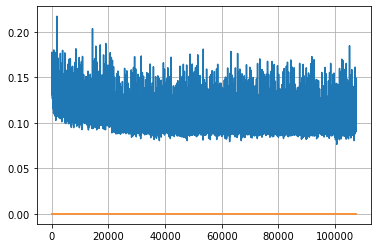

Epoch: 276, iteration 0, loss 0.11265707015991211, cov_diff 0.40811829164055674 cov_diff train 0.40791595121464735
Epoch: 276, iteration 1, loss 0.10964840650558472, cov_diff 0.40031813069476396 cov_diff train 0.3998253882007351
Epoch: 276, iteration 2, loss 0.11873733997344971, cov_diff 0.41515362660070054 cov_diff train 0.4144546101708446
Epoch: 276, iteration 3, loss 0.096865713596344, cov_diff 0.4044426381948379 cov_diff train 0.4033904859481025
Epoch: 276, iteration 4, loss 0.09615087509155273, cov_diff 0.4210185885856455 cov_diff train 0.4201408427979781
Epoch: 276, iteration 5, loss 0.09575504064559937, cov_diff 0.4102214110781342 cov_diff train 0.409941373469209
Epoch: 276, iteration 6, loss 0.1039588451385498, cov_diff 0.41364788552019943 cov_diff train 0.4129021976486466
Epoch: 276, iteration 7, loss 0.09068465232849121, cov_diff 0.4096116317964372 cov_diff train 0.40908030009212526
Epoch: 276, iteration 8, loss 0.10628405213356018, cov_diff 0.4116215470621824 cov_diff train 

Epoch: 276, iteration 77, loss 0.11088809370994568, cov_diff 0.40653203943093746 cov_diff train 0.40646140609411585
Epoch: 276, iteration 78, loss 0.11073887348175049, cov_diff 0.41007475531668053 cov_diff train 0.41012830225028724
Epoch: 276, iteration 79, loss 0.11429804563522339, cov_diff 0.412981010778844 cov_diff train 0.41148912366678786
Epoch: 276, iteration 80, loss 0.10274815559387207, cov_diff 0.40700351175817917 cov_diff train 0.4065385073030776
Epoch: 276, iteration 81, loss 0.10806906223297119, cov_diff 0.39626880881769994 cov_diff train 0.39538910628746404
Epoch: 276, iteration 82, loss 0.10477811098098755, cov_diff 0.40790579677143635 cov_diff train 0.40752817714344175
Epoch: 276, iteration 83, loss 0.09622770547866821, cov_diff 0.40562225326091217 cov_diff train 0.40524138850165303
Epoch: 276, iteration 84, loss 0.10422596335411072, cov_diff 0.4119084092343639 cov_diff train 0.41160991192302765
Epoch: 276, iteration 85, loss 0.09804925322532654, cov_diff 0.4142921734061

Epoch: 276, iteration 156, loss 0.10861071944236755, cov_diff 0.41877024536096324 cov_diff train 0.41812708177022506
Epoch: 276, iteration 157, loss 0.10032340884208679, cov_diff 0.4091652997770774 cov_diff train 0.40932863691996624
Epoch: 276, iteration 158, loss 0.10402482748031616, cov_diff 0.41200421999111186 cov_diff train 0.41085887929553866
Epoch: 276, iteration 159, loss 0.10686463117599487, cov_diff 0.4049576693146127 cov_diff train 0.4047288316046456
Epoch: 276, iteration 160, loss 0.1087794303894043, cov_diff 0.4202586161650017 cov_diff train 0.4197361786053349
Epoch: 276, iteration 161, loss 0.09710144996643066, cov_diff 0.4127916731491226 cov_diff train 0.41206106547315213
Epoch: 276, iteration 162, loss 0.09795191884040833, cov_diff 0.4050151924193662 cov_diff train 0.40464812561386665
Epoch: 276, iteration 163, loss 0.11375179886817932, cov_diff 0.40299808717807406 cov_diff train 0.40082381880413726
Epoch: 276, iteration 164, loss 0.09883755445480347, cov_diff 0.40370316

Epoch: 276, iteration 235, loss 0.10469487309455872, cov_diff 0.41815934885678524 cov_diff train 0.4174504119210614
Epoch: 276, iteration 236, loss 0.1094110906124115, cov_diff 0.4054309644237949 cov_diff train 0.4051123483410848
Epoch: 276, iteration 237, loss 0.10984587669372559, cov_diff 0.40909104269019936 cov_diff train 0.4085824657621687
Epoch: 276, iteration 238, loss 0.09948685765266418, cov_diff 0.40437145643456973 cov_diff train 0.4039879500987227
Epoch: 276, iteration 239, loss 0.11421886086463928, cov_diff 0.41318092578927296 cov_diff train 0.41272757924609094
Epoch: 276, iteration 240, loss 0.09641140699386597, cov_diff 0.4295836896505797 cov_diff train 0.4291453622310359
Epoch: 276, iteration 241, loss 0.11474698781967163, cov_diff 0.40639098301782944 cov_diff train 0.40534232677648036
Epoch: 276, iteration 242, loss 0.1010211706161499, cov_diff 0.40261161435224885 cov_diff train 0.40198464063431416
Epoch: 276, iteration 243, loss 0.10141348838806152, cov_diff 0.410382391

Epoch: 276, iteration 312, loss 0.09909054636955261, cov_diff 0.4254844454890969 cov_diff train 0.4249493235763696
Epoch: 276, iteration 313, loss 0.09997403621673584, cov_diff 0.3936136774418356 cov_diff train 0.39230149848402013
Epoch: 276, iteration 314, loss 0.10283154249191284, cov_diff 0.41680201725828364 cov_diff train 0.4170555957013526
Epoch: 276, iteration 315, loss 0.10731375217437744, cov_diff 0.4134292189432132 cov_diff train 0.41380164080563403
Epoch: 276, iteration 316, loss 0.10009399056434631, cov_diff 0.4082998830223701 cov_diff train 0.40808061752557595
Epoch: 276, iteration 317, loss 0.10210129618644714, cov_diff 0.42012978967244463 cov_diff train 0.4195450709213976
Epoch: 276, iteration 318, loss 0.1007244884967804, cov_diff 0.42296987729827024 cov_diff train 0.4217735732061632
Epoch: 276, iteration 319, loss 0.10390499234199524, cov_diff 0.4145485368247146 cov_diff train 0.4138214724733289
Epoch: 276, iteration 320, loss 0.11729586124420166, cov_diff 0.40231972913

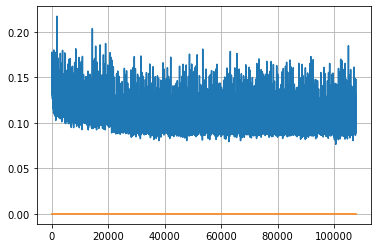

Epoch: 277, iteration 0, loss 0.08959567546844482, cov_diff 0.42368642977156634 cov_diff train 0.42320638353768303
Epoch: 277, iteration 1, loss 0.10772940516471863, cov_diff 0.41169374970728834 cov_diff train 0.41176828110283875
Epoch: 277, iteration 2, loss 0.11090525984764099, cov_diff 0.4047660715398738 cov_diff train 0.4050604830553629
Epoch: 277, iteration 3, loss 0.1108560860157013, cov_diff 0.4313772184548225 cov_diff train 0.4299392055084751
Epoch: 277, iteration 4, loss 0.09526407718658447, cov_diff 0.41642984278996925 cov_diff train 0.4171181642178123
Epoch: 277, iteration 5, loss 0.10545411705970764, cov_diff 0.4161973946666202 cov_diff train 0.4162531309560199
Epoch: 277, iteration 6, loss 0.10977312922477722, cov_diff 0.40855011478863157 cov_diff train 0.40839056191188244
Epoch: 277, iteration 7, loss 0.09481590986251831, cov_diff 0.4174154491485214 cov_diff train 0.41657396061226487
Epoch: 277, iteration 8, loss 0.09777411818504333, cov_diff 0.4139269606046376 cov_diff t

Epoch: 277, iteration 77, loss 0.10809269547462463, cov_diff 0.4080812375607797 cov_diff train 0.40712671512636367
Epoch: 277, iteration 78, loss 0.10422089695930481, cov_diff 0.41531802724508293 cov_diff train 0.41427704451453895
Epoch: 277, iteration 79, loss 0.10797348618507385, cov_diff 0.4176230783914768 cov_diff train 0.4177865281005753
Epoch: 277, iteration 80, loss 0.09357309341430664, cov_diff 0.40445316976647905 cov_diff train 0.4039543113251419
Epoch: 277, iteration 81, loss 0.11149609088897705, cov_diff 0.4272001772758044 cov_diff train 0.4269128767492766
Epoch: 277, iteration 82, loss 0.1019219160079956, cov_diff 0.4052545948018393 cov_diff train 0.40593614012953827
Epoch: 277, iteration 83, loss 0.09041842818260193, cov_diff 0.40341501934792545 cov_diff train 0.4032141286858689
Epoch: 277, iteration 84, loss 0.10278478264808655, cov_diff 0.42335678289012585 cov_diff train 0.42333773748248016
Epoch: 277, iteration 85, loss 0.10433292388916016, cov_diff 0.41649651074388583 

Epoch: 277, iteration 155, loss 0.10061860084533691, cov_diff 0.41857112065815283 cov_diff train 0.4189854588303166
Epoch: 277, iteration 156, loss 0.09607264399528503, cov_diff 0.42299997625338087 cov_diff train 0.42259741441300647
Epoch: 277, iteration 157, loss 0.1036006510257721, cov_diff 0.42136466357137065 cov_diff train 0.4217884809185242
Epoch: 277, iteration 158, loss 0.09816938638687134, cov_diff 0.4278556030493358 cov_diff train 0.42756219733015155
Epoch: 277, iteration 159, loss 0.09431737661361694, cov_diff 0.41699079495965574 cov_diff train 0.4163019812303763
Epoch: 277, iteration 160, loss 0.0942334234714508, cov_diff 0.4192061593459354 cov_diff train 0.41844053497331607
Epoch: 277, iteration 161, loss 0.11134093999862671, cov_diff 0.4130318991419419 cov_diff train 0.4126160382423364
Epoch: 277, iteration 162, loss 0.10703456401824951, cov_diff 0.41761154043393567 cov_diff train 0.4169875390546494
Epoch: 277, iteration 163, loss 0.113727867603302, cov_diff 0.414442541534

Epoch: 277, iteration 234, loss 0.10197073221206665, cov_diff 0.4157237078937438 cov_diff train 0.41545497765178774
Epoch: 277, iteration 235, loss 0.11259922385215759, cov_diff 0.4093988097105758 cov_diff train 0.4085093547009183
Epoch: 277, iteration 236, loss 0.102853924036026, cov_diff 0.4211655842217242 cov_diff train 0.4200269234164287
Epoch: 277, iteration 237, loss 0.10593083500862122, cov_diff 0.40027430285764504 cov_diff train 0.399227087935208
Epoch: 277, iteration 238, loss 0.09288987517356873, cov_diff 0.40519821573350456 cov_diff train 0.4047264658926217
Epoch: 277, iteration 239, loss 0.11723393201828003, cov_diff 0.40771718905151727 cov_diff train 0.407595307427372
Epoch: 277, iteration 240, loss 0.10582727193832397, cov_diff 0.4183249210400058 cov_diff train 0.41765635718013316
Epoch: 277, iteration 241, loss 0.10990959405899048, cov_diff 0.419384267303213 cov_diff train 0.41810518102486677
Epoch: 277, iteration 242, loss 0.10035821795463562, cov_diff 0.410721485197819

Epoch: 277, iteration 312, loss 0.09883955121040344, cov_diff 0.42577389285863815 cov_diff train 0.42490348087299384
Epoch: 277, iteration 313, loss 0.10243907570838928, cov_diff 0.4156816214563878 cov_diff train 0.41529019736207134
Epoch: 277, iteration 314, loss 0.11470198631286621, cov_diff 0.4119889547518982 cov_diff train 0.4115332953122926
Epoch: 277, iteration 315, loss 0.10535338521003723, cov_diff 0.41480530404979926 cov_diff train 0.4147100528029705
Epoch: 277, iteration 316, loss 0.10298392176628113, cov_diff 0.4063735280466121 cov_diff train 0.4064848409808538
Epoch: 277, iteration 317, loss 0.10472026467323303, cov_diff 0.4057815432340634 cov_diff train 0.40598764927899317
Epoch: 277, iteration 318, loss 0.1088118851184845, cov_diff 0.4225494911764436 cov_diff train 0.42218454043687187
Epoch: 277, iteration 319, loss 0.08968359231948853, cov_diff 0.42123785099694677 cov_diff train 0.42077403714331035
Epoch: 277, iteration 320, loss 0.09771466255187988, cov_diff 0.415777745

Epoch: 277, iteration 390, loss 0.16242259740829468, cov_diff 0.4272552359203451 cov_diff train 0.42718164511078627


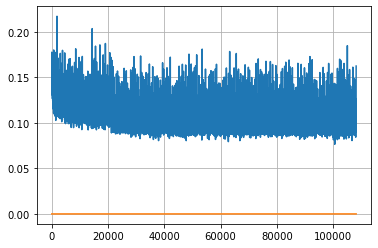

Epoch: 278, iteration 0, loss 0.1113419234752655, cov_diff 0.409862776701857 cov_diff train 0.40913325797820105
Epoch: 278, iteration 1, loss 0.10054391622543335, cov_diff 0.4131853855977979 cov_diff train 0.41302780480419315
Epoch: 278, iteration 2, loss 0.10172417759895325, cov_diff 0.4045343896363714 cov_diff train 0.4035714097682228
Epoch: 278, iteration 3, loss 0.11460843682289124, cov_diff 0.40621189232758464 cov_diff train 0.4055836625396247
Epoch: 278, iteration 4, loss 0.10188671946525574, cov_diff 0.42137816609611434 cov_diff train 0.4214131443927214
Epoch: 278, iteration 5, loss 0.11032527685165405, cov_diff 0.4149510286863008 cov_diff train 0.4153094545709656
Epoch: 278, iteration 6, loss 0.10474607348442078, cov_diff 0.39982093334225366 cov_diff train 0.3995589334881962
Epoch: 278, iteration 7, loss 0.09800511598587036, cov_diff 0.42602694826142523 cov_diff train 0.42639484745820605
Epoch: 278, iteration 8, loss 0.10641539096832275, cov_diff 0.4101452265326712 cov_diff tra

Epoch: 278, iteration 76, loss 0.11118927597999573, cov_diff 0.4242429045301264 cov_diff train 0.42383655454838737
Epoch: 278, iteration 77, loss 0.10356324911117554, cov_diff 0.4038789509109352 cov_diff train 0.4036255415743295
Epoch: 278, iteration 78, loss 0.10250470042228699, cov_diff 0.4215766751713684 cov_diff train 0.42044025192153434
Epoch: 278, iteration 79, loss 0.09772524237632751, cov_diff 0.41372664631955725 cov_diff train 0.41341577024835857
Epoch: 278, iteration 80, loss 0.1109171211719513, cov_diff 0.4181007635727943 cov_diff train 0.4177178456707047
Epoch: 278, iteration 81, loss 0.1082010269165039, cov_diff 0.40875580674414747 cov_diff train 0.40854567465540326
Epoch: 278, iteration 82, loss 0.10355129837989807, cov_diff 0.40569851323602946 cov_diff train 0.40556427290586416
Epoch: 278, iteration 83, loss 0.10391676425933838, cov_diff 0.42167068010087416 cov_diff train 0.42106671780180244
Epoch: 278, iteration 84, loss 0.09948000311851501, cov_diff 0.40970890694680423

Epoch: 278, iteration 153, loss 0.1096375584602356, cov_diff 0.4057614383656911 cov_diff train 0.4052214371156735
Epoch: 278, iteration 154, loss 0.11662328243255615, cov_diff 0.4001431929595292 cov_diff train 0.3999593753797353
Epoch: 278, iteration 155, loss 0.10651761293411255, cov_diff 0.4034146864244664 cov_diff train 0.40274360304432755
Epoch: 278, iteration 156, loss 0.11307394504547119, cov_diff 0.42711960598345433 cov_diff train 0.42654970419063815
Epoch: 278, iteration 157, loss 0.11710003018379211, cov_diff 0.41473976854816796 cov_diff train 0.41428270172005566
Epoch: 278, iteration 158, loss 0.09596949815750122, cov_diff 0.40771169369146426 cov_diff train 0.4076374591766537
Epoch: 278, iteration 159, loss 0.0958203375339508, cov_diff 0.40587311599333675 cov_diff train 0.4047462455726469
Epoch: 278, iteration 160, loss 0.09500491619110107, cov_diff 0.41722604605558333 cov_diff train 0.4157105351141956
Epoch: 278, iteration 161, loss 0.1063375174999237, cov_diff 0.41732524087

Epoch: 278, iteration 229, loss 0.10729685425758362, cov_diff 0.41489893391500615 cov_diff train 0.41525263496549186
Epoch: 278, iteration 230, loss 0.11921441555023193, cov_diff 0.405389196273562 cov_diff train 0.40577348619938036
Epoch: 278, iteration 231, loss 0.1044885516166687, cov_diff 0.41691442772974385 cov_diff train 0.4163920348017924
Epoch: 278, iteration 232, loss 0.09314197301864624, cov_diff 0.4167169634926994 cov_diff train 0.416648917180539
Epoch: 278, iteration 233, loss 0.10363095998764038, cov_diff 0.40465527864617046 cov_diff train 0.40545102368727753
Epoch: 278, iteration 234, loss 0.10096520185470581, cov_diff 0.41179898392272285 cov_diff train 0.4117360775707122
Epoch: 278, iteration 235, loss 0.09721368551254272, cov_diff 0.4083439313453835 cov_diff train 0.4070164724994727
Epoch: 278, iteration 236, loss 0.10810241103172302, cov_diff 0.4042865346499308 cov_diff train 0.4043433364048029
Epoch: 278, iteration 237, loss 0.10648676753044128, cov_diff 0.404224782856

Epoch: 278, iteration 306, loss 0.10554778575897217, cov_diff 0.39471083767798976 cov_diff train 0.39471806281904925
Epoch: 278, iteration 307, loss 0.10657352209091187, cov_diff 0.412291387896808 cov_diff train 0.4119345192354498
Epoch: 278, iteration 308, loss 0.10182780027389526, cov_diff 0.4055312182514051 cov_diff train 0.4056437289506471
Epoch: 278, iteration 309, loss 0.10735520720481873, cov_diff 0.41146938954590306 cov_diff train 0.4114762583816157
Epoch: 278, iteration 310, loss 0.09536609053611755, cov_diff 0.41112727627874884 cov_diff train 0.4117478711445194
Epoch: 278, iteration 311, loss 0.0987386405467987, cov_diff 0.40440067319973927 cov_diff train 0.4036656404719232
Epoch: 278, iteration 312, loss 0.10272163152694702, cov_diff 0.42135796908202333 cov_diff train 0.4209385160453836
Epoch: 278, iteration 313, loss 0.09094011783599854, cov_diff 0.4130132149829098 cov_diff train 0.4123937018745627
Epoch: 278, iteration 314, loss 0.09226077795028687, cov_diff 0.415047841089

Epoch: 278, iteration 382, loss 0.10437741875648499, cov_diff 0.41734585405988917 cov_diff train 0.4165171323751627
Epoch: 278, iteration 383, loss 0.10677996277809143, cov_diff 0.4169184826051912 cov_diff train 0.4163164471191503
Epoch: 278, iteration 384, loss 0.10903322696685791, cov_diff 0.42046850030840044 cov_diff train 0.4199197568646552
Epoch: 278, iteration 385, loss 0.11149263381958008, cov_diff 0.4094956450739556 cov_diff train 0.4082322916333235
Epoch: 278, iteration 386, loss 0.10825037956237793, cov_diff 0.4082972497663409 cov_diff train 0.40700387582691466
Epoch: 278, iteration 387, loss 0.09573712944984436, cov_diff 0.3963479783761596 cov_diff train 0.3960865134442741
Epoch: 278, iteration 388, loss 0.09679242968559265, cov_diff 0.4186244848138914 cov_diff train 0.41786345822000925
Epoch: 278, iteration 389, loss 0.10124596953392029, cov_diff 0.4061252010781363 cov_diff train 0.40536715257877076
Epoch: 278, iteration 390, loss 0.1503223180770874, cov_diff 0.437890504718

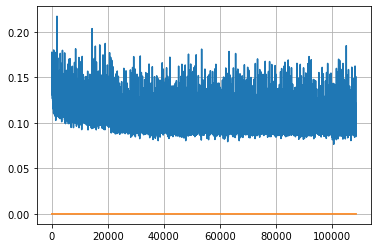

Epoch: 279, iteration 0, loss 0.10511976480484009, cov_diff 0.4132873035257617 cov_diff train 0.4131914687894768
Epoch: 279, iteration 1, loss 0.10927081108093262, cov_diff 0.412394225798239 cov_diff train 0.41174947343460055
Epoch: 279, iteration 2, loss 0.10149604082107544, cov_diff 0.4050314407431656 cov_diff train 0.40486427691099713
Epoch: 279, iteration 3, loss 0.09506329894065857, cov_diff 0.4246578846364116 cov_diff train 0.42428200474254496
Epoch: 279, iteration 4, loss 0.10123345255851746, cov_diff 0.41833969016774547 cov_diff train 0.41783010789448655
Epoch: 279, iteration 5, loss 0.09580963850021362, cov_diff 0.4213750873910192 cov_diff train 0.41996899766912743
Epoch: 279, iteration 6, loss 0.09428191184997559, cov_diff 0.40353597516258677 cov_diff train 0.4032649413792818
Epoch: 279, iteration 7, loss 0.10730275511741638, cov_diff 0.4176269982260821 cov_diff train 0.4169640917821929
Epoch: 279, iteration 8, loss 0.1033550500869751, cov_diff 0.4090817167655958 cov_diff tra

Epoch: 279, iteration 75, loss 0.09609773755073547, cov_diff 0.41577514264981785 cov_diff train 0.4153387282829523
Epoch: 279, iteration 76, loss 0.10893148183822632, cov_diff 0.4121077991283437 cov_diff train 0.41171182261615935
Epoch: 279, iteration 77, loss 0.11166989803314209, cov_diff 0.4207335373975756 cov_diff train 0.41999620151150213
Epoch: 279, iteration 78, loss 0.09901845455169678, cov_diff 0.42781558574305806 cov_diff train 0.4276943203755449
Epoch: 279, iteration 79, loss 0.10532787442207336, cov_diff 0.42245906210341166 cov_diff train 0.42222831156740837
Epoch: 279, iteration 80, loss 0.10585835576057434, cov_diff 0.41857641172501664 cov_diff train 0.41746292080112224
Epoch: 279, iteration 81, loss 0.10227489471435547, cov_diff 0.41473586420881925 cov_diff train 0.41422333134084643
Epoch: 279, iteration 82, loss 0.09962928295135498, cov_diff 0.42187561614162034 cov_diff train 0.4208767856108404
Epoch: 279, iteration 83, loss 0.10118526220321655, cov_diff 0.41113155564986

Epoch: 279, iteration 148, loss 0.10888135433197021, cov_diff 0.4077518130008462 cov_diff train 0.4077031774933944
Epoch: 279, iteration 149, loss 0.10494247078895569, cov_diff 0.4197730900195515 cov_diff train 0.4193973390886614
Epoch: 279, iteration 150, loss 0.11327612400054932, cov_diff 0.407785174077298 cov_diff train 0.4077243927149039
Epoch: 279, iteration 151, loss 0.10855275392532349, cov_diff 0.41358530820223505 cov_diff train 0.41354043846250965
Epoch: 279, iteration 152, loss 0.1000376045703888, cov_diff 0.41470947445760487 cov_diff train 0.4146838041420169
Epoch: 279, iteration 153, loss 0.10501107573509216, cov_diff 0.41224128715144603 cov_diff train 0.41167112377879567
Epoch: 279, iteration 154, loss 0.1024397611618042, cov_diff 0.4023060270712212 cov_diff train 0.40223380626994226
Epoch: 279, iteration 155, loss 0.11119282245635986, cov_diff 0.40949222773522304 cov_diff train 0.40865294822944837
Epoch: 279, iteration 156, loss 0.09082701802253723, cov_diff 0.41277383158

Epoch: 279, iteration 219, loss 0.1095058023929596, cov_diff 0.396814714599536 cov_diff train 0.3962798051360526
Epoch: 279, iteration 220, loss 0.10227304697036743, cov_diff 0.40221007915067974 cov_diff train 0.40117609174851565
Epoch: 279, iteration 221, loss 0.105034738779068, cov_diff 0.40178266378161037 cov_diff train 0.4013405555423885
Epoch: 279, iteration 222, loss 0.10170415043830872, cov_diff 0.3928870988486606 cov_diff train 0.392546707077483
Epoch: 279, iteration 223, loss 0.10335719585418701, cov_diff 0.4095152052306291 cov_diff train 0.4092513772839094
Epoch: 279, iteration 224, loss 0.09406313300132751, cov_diff 0.4146532401138057 cov_diff train 0.4150395128026283
Epoch: 279, iteration 225, loss 0.10888135433197021, cov_diff 0.41327322878401057 cov_diff train 0.4117788594670464
Epoch: 279, iteration 226, loss 0.11035037040710449, cov_diff 0.42614771711577326 cov_diff train 0.4261617528803193
Epoch: 279, iteration 227, loss 0.09304136037826538, cov_diff 0.4118512097890914

Epoch: 279, iteration 297, loss 0.10284283757209778, cov_diff 0.40416448838112773 cov_diff train 0.4033566069823716
Epoch: 279, iteration 298, loss 0.10364502668380737, cov_diff 0.41888914755220713 cov_diff train 0.41774128572409547
Epoch: 279, iteration 299, loss 0.10911956429481506, cov_diff 0.41469021501296033 cov_diff train 0.4136767281409235
Epoch: 279, iteration 300, loss 0.10499691963195801, cov_diff 0.4233487385355527 cov_diff train 0.4227716989578264
Epoch: 279, iteration 301, loss 0.10581883788108826, cov_diff 0.4090122777990358 cov_diff train 0.40898564838096213
Epoch: 279, iteration 302, loss 0.11118865013122559, cov_diff 0.42125913716293906 cov_diff train 0.4193379088677933
Epoch: 279, iteration 303, loss 0.09953188896179199, cov_diff 0.40697634395380555 cov_diff train 0.40581274607032464
Epoch: 279, iteration 304, loss 0.11247509717941284, cov_diff 0.4050127064929119 cov_diff train 0.4042486539571573
Epoch: 279, iteration 305, loss 0.1044522225856781, cov_diff 0.414535953

Epoch: 279, iteration 369, loss 0.10137858986854553, cov_diff 0.41299579537382625 cov_diff train 0.4122942346056514
Epoch: 279, iteration 370, loss 0.09826907515525818, cov_diff 0.39872184533161575 cov_diff train 0.39753561133107557
Epoch: 279, iteration 371, loss 0.10318821668624878, cov_diff 0.42407421588311195 cov_diff train 0.42326833436988676
Epoch: 279, iteration 372, loss 0.11458849906921387, cov_diff 0.41958143331854164 cov_diff train 0.41810619777018093
Epoch: 279, iteration 373, loss 0.0990685522556305, cov_diff 0.39919206627399006 cov_diff train 0.39852096104956325
Epoch: 279, iteration 374, loss 0.10132056474685669, cov_diff 0.41166653074194254 cov_diff train 0.41108117359229485
Epoch: 279, iteration 375, loss 0.10162842273712158, cov_diff 0.40202000016056927 cov_diff train 0.40144345803560155
Epoch: 279, iteration 376, loss 0.09874039888381958, cov_diff 0.4174589313597546 cov_diff train 0.4169862777309304
Epoch: 279, iteration 377, loss 0.10234415531158447, cov_diff 0.4065

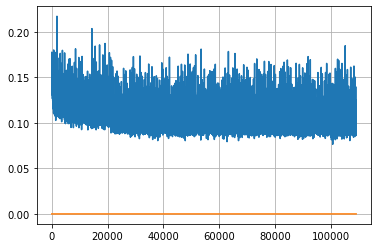

Epoch: 280, iteration 0, loss 0.09593066573143005, cov_diff 0.41324365655829 cov_diff train 0.41187819910257456
Epoch: 280, iteration 1, loss 0.10572099685668945, cov_diff 0.4122375182420213 cov_diff train 0.41172527938524217
Epoch: 280, iteration 2, loss 0.10834607481956482, cov_diff 0.41722387174574077 cov_diff train 0.4160604598271423
Epoch: 280, iteration 3, loss 0.10467442870140076, cov_diff 0.3961911362581585 cov_diff train 0.3967339041958135
Epoch: 280, iteration 4, loss 0.09701308608055115, cov_diff 0.41110518932882445 cov_diff train 0.4106904070648967
Epoch: 280, iteration 5, loss 0.09318029880523682, cov_diff 0.4159216313127543 cov_diff train 0.41534558906352104
Epoch: 280, iteration 6, loss 0.09187397360801697, cov_diff 0.4039295245457213 cov_diff train 0.40405013454954664
Epoch: 280, iteration 7, loss 0.09461531043052673, cov_diff 0.4075700821537976 cov_diff train 0.4074915126189113
Epoch: 280, iteration 8, loss 0.11612117290496826, cov_diff 0.4114992273831441 cov_diff trai

Epoch: 280, iteration 78, loss 0.10987293720245361, cov_diff 0.4118940035134306 cov_diff train 0.411038224214464
Epoch: 280, iteration 79, loss 0.10279956459999084, cov_diff 0.41391331507025453 cov_diff train 0.41367354160120906
Epoch: 280, iteration 80, loss 0.10435542464256287, cov_diff 0.4130256707856704 cov_diff train 0.41266552124599243
Epoch: 280, iteration 81, loss 0.10491305589675903, cov_diff 0.41177066601835155 cov_diff train 0.41158386712829986
Epoch: 280, iteration 82, loss 0.09788939356803894, cov_diff 0.40478419448707853 cov_diff train 0.40431258913570134
Epoch: 280, iteration 83, loss 0.08303341269493103, cov_diff 0.4056930330612065 cov_diff train 0.4049724826235901
Epoch: 280, iteration 84, loss 0.0995815098285675, cov_diff 0.41152120638948475 cov_diff train 0.41092314365858157
Epoch: 280, iteration 85, loss 0.11608585715293884, cov_diff 0.40943355508067386 cov_diff train 0.40823238080671614
Epoch: 280, iteration 86, loss 0.09478208422660828, cov_diff 0.4227858658656228

Epoch: 280, iteration 154, loss 0.10918474197387695, cov_diff 0.4171790233819565 cov_diff train 0.4173657112244129
Epoch: 280, iteration 155, loss 0.1045425534248352, cov_diff 0.42112720001045234 cov_diff train 0.42187695918842105
Epoch: 280, iteration 156, loss 0.10919356346130371, cov_diff 0.4210620113159394 cov_diff train 0.4205798492901902
Epoch: 280, iteration 157, loss 0.10132202506065369, cov_diff 0.4141316120012227 cov_diff train 0.41410163085379087
Epoch: 280, iteration 158, loss 0.106882244348526, cov_diff 0.4062023519900991 cov_diff train 0.40539832623978556
Epoch: 280, iteration 159, loss 0.10058510303497314, cov_diff 0.4217139288411883 cov_diff train 0.42130925818257303
Epoch: 280, iteration 160, loss 0.0978284478187561, cov_diff 0.41857744983428385 cov_diff train 0.41788999325958126
Epoch: 280, iteration 161, loss 0.10295921564102173, cov_diff 0.3954783713195232 cov_diff train 0.39587722884688836
Epoch: 280, iteration 162, loss 0.09594988822937012, cov_diff 0.419694784569

Epoch: 280, iteration 230, loss 0.09449222683906555, cov_diff 0.415062986397488 cov_diff train 0.41403099279450123
Epoch: 280, iteration 231, loss 0.10783332586288452, cov_diff 0.41535282329301737 cov_diff train 0.4150824354202421
Epoch: 280, iteration 232, loss 0.09098765254020691, cov_diff 0.41686058345821236 cov_diff train 0.41656623632793627
Epoch: 280, iteration 233, loss 0.09596377611160278, cov_diff 0.41698904753834287 cov_diff train 0.41627587673518535
Epoch: 280, iteration 234, loss 0.09597504138946533, cov_diff 0.41838857593380724 cov_diff train 0.41835795864086217
Epoch: 280, iteration 235, loss 0.0994231104850769, cov_diff 0.4143022656513019 cov_diff train 0.41314767656359147
Epoch: 280, iteration 236, loss 0.09852224588394165, cov_diff 0.41289659243584 cov_diff train 0.4130212324517041
Epoch: 280, iteration 237, loss 0.10304895043373108, cov_diff 0.40918752202144437 cov_diff train 0.4084318248030038
Epoch: 280, iteration 238, loss 0.11168676614761353, cov_diff 0.4088905839

Epoch: 280, iteration 307, loss 0.11513438820838928, cov_diff 0.4234421970886042 cov_diff train 0.4224264202186397
Epoch: 280, iteration 308, loss 0.10659554600715637, cov_diff 0.4170545214315385 cov_diff train 0.4158963027796941
Epoch: 280, iteration 309, loss 0.11256343126296997, cov_diff 0.40638168339232617 cov_diff train 0.4068108641940559
Epoch: 280, iteration 310, loss 0.09831544756889343, cov_diff 0.42526316490604815 cov_diff train 0.42420267864373273
Epoch: 280, iteration 311, loss 0.10873240232467651, cov_diff 0.4178326027291921 cov_diff train 0.41741216622940613
Epoch: 280, iteration 312, loss 0.10670897364616394, cov_diff 0.406106532337855 cov_diff train 0.40535576826163444
Epoch: 280, iteration 313, loss 0.09963387250900269, cov_diff 0.42597223696484215 cov_diff train 0.42485082577603694
Epoch: 280, iteration 314, loss 0.10164374113082886, cov_diff 0.41231773169465685 cov_diff train 0.41148286106243465
Epoch: 280, iteration 315, loss 0.09751129150390625, cov_diff 0.40988583

Epoch: 280, iteration 384, loss 0.08915579319000244, cov_diff 0.4130566691561066 cov_diff train 0.4123048124569239
Epoch: 280, iteration 385, loss 0.09204989671707153, cov_diff 0.43071943070359187 cov_diff train 0.43003001275316627
Epoch: 280, iteration 386, loss 0.08984121680259705, cov_diff 0.4099161272254365 cov_diff train 0.4089369561734611
Epoch: 280, iteration 387, loss 0.10528376698493958, cov_diff 0.40671744428493717 cov_diff train 0.40654170077851803
Epoch: 280, iteration 388, loss 0.09796160459518433, cov_diff 0.4142190533021272 cov_diff train 0.41403833057794615
Epoch: 280, iteration 389, loss 0.10578271746635437, cov_diff 0.4037834929877566 cov_diff train 0.4027413901220092
Epoch: 280, iteration 390, loss 0.13047635555267334, cov_diff 0.4346253646950708 cov_diff train 0.4336070038998892


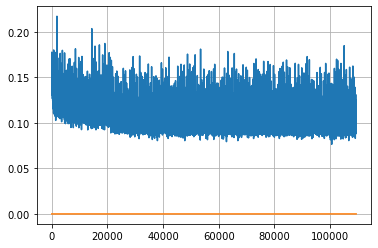

Epoch: 281, iteration 0, loss 0.09558281302452087, cov_diff 0.41163784445099244 cov_diff train 0.4104196800148593
Epoch: 281, iteration 1, loss 0.09808695316314697, cov_diff 0.41814446557134016 cov_diff train 0.41678612195587983
Epoch: 281, iteration 2, loss 0.11249566078186035, cov_diff 0.3986453076506377 cov_diff train 0.39711282624713823
Epoch: 281, iteration 3, loss 0.1265554428100586, cov_diff 0.4016603451394186 cov_diff train 0.4004561517133483
Epoch: 281, iteration 4, loss 0.09937945008277893, cov_diff 0.40487216361150086 cov_diff train 0.4046561117967799
Epoch: 281, iteration 5, loss 0.11640626192092896, cov_diff 0.4215710765384926 cov_diff train 0.42072523675324786
Epoch: 281, iteration 6, loss 0.1096872091293335, cov_diff 0.4172276808398453 cov_diff train 0.41677965019162383
Epoch: 281, iteration 7, loss 0.09952181577682495, cov_diff 0.40495764050131067 cov_diff train 0.40463544896391834
Epoch: 281, iteration 8, loss 0.1009100079536438, cov_diff 0.40820539162209474 cov_diff t

Epoch: 281, iteration 74, loss 0.09599220752716064, cov_diff 0.41695042511835484 cov_diff train 0.41563690099827566
Epoch: 281, iteration 75, loss 0.12367221713066101, cov_diff 0.41846063782793413 cov_diff train 0.4148586409545679
Epoch: 281, iteration 76, loss 0.10554841160774231, cov_diff 0.4114429559061273 cov_diff train 0.41064844830608616
Epoch: 281, iteration 77, loss 0.11428660154342651, cov_diff 0.412934071677478 cov_diff train 0.41122366252812836
Epoch: 281, iteration 78, loss 0.10766103863716125, cov_diff 0.4154802031620606 cov_diff train 0.4149168894612237
Epoch: 281, iteration 79, loss 0.09722355008125305, cov_diff 0.39542426324723756 cov_diff train 0.394569980304536
Epoch: 281, iteration 80, loss 0.10636314749717712, cov_diff 0.40806660821885865 cov_diff train 0.407172816267566
Epoch: 281, iteration 81, loss 0.10027825832366943, cov_diff 0.40304862753203247 cov_diff train 0.4019158827893042
Epoch: 281, iteration 82, loss 0.09936335682868958, cov_diff 0.4047361228726938 cov

Epoch: 281, iteration 149, loss 0.11232426762580872, cov_diff 0.41357641998769046 cov_diff train 0.4127555831364938
Epoch: 281, iteration 150, loss 0.11545756459236145, cov_diff 0.4263069102961334 cov_diff train 0.42541836079728396
Epoch: 281, iteration 151, loss 0.09337186813354492, cov_diff 0.4070962434877751 cov_diff train 0.4059032190266343
Epoch: 281, iteration 152, loss 0.10585600137710571, cov_diff 0.415479293541018 cov_diff train 0.41498264363430193
Epoch: 281, iteration 153, loss 0.10570454597473145, cov_diff 0.41072098043546496 cov_diff train 0.4102332574398515
Epoch: 281, iteration 154, loss 0.11475372314453125, cov_diff 0.42254428129066707 cov_diff train 0.42139521667711893
Epoch: 281, iteration 155, loss 0.11092957854270935, cov_diff 0.4045150521389955 cov_diff train 0.4034362891681703
Epoch: 281, iteration 156, loss 0.10380476713180542, cov_diff 0.4143958383876744 cov_diff train 0.4132174021687924
Epoch: 281, iteration 157, loss 0.12369704246520996, cov_diff 0.40138062352

Epoch: 281, iteration 220, loss 0.12617674469947815, cov_diff 0.41687495181543205 cov_diff train 0.4166688264762414
Epoch: 281, iteration 221, loss 0.09873265027999878, cov_diff 0.3935027616895641 cov_diff train 0.3931181547728221
Epoch: 281, iteration 222, loss 0.0995459258556366, cov_diff 0.40675530030531953 cov_diff train 0.4061467534804292
Epoch: 281, iteration 223, loss 0.10822847485542297, cov_diff 0.42153628307641633 cov_diff train 0.42055963507764793
Epoch: 281, iteration 224, loss 0.0986504852771759, cov_diff 0.41182344113770913 cov_diff train 0.41145428158035474
Epoch: 281, iteration 225, loss 0.1212809681892395, cov_diff 0.41854289396198935 cov_diff train 0.4175418705919208
Epoch: 281, iteration 226, loss 0.10103681683540344, cov_diff 0.4066224832227109 cov_diff train 0.4055118722319306
Epoch: 281, iteration 227, loss 0.10631400346755981, cov_diff 0.4103274062494294 cov_diff train 0.40928112463421124
Epoch: 281, iteration 228, loss 0.10495391488075256, cov_diff 0.40859186205

Epoch: 281, iteration 297, loss 0.10047873854637146, cov_diff 0.40930115110526866 cov_diff train 0.4083610767121068
Epoch: 281, iteration 298, loss 0.10319501161575317, cov_diff 0.4097808857998139 cov_diff train 0.4088383113037528
Epoch: 281, iteration 299, loss 0.10756471753120422, cov_diff 0.40142091603447677 cov_diff train 0.40133090991597087
Epoch: 281, iteration 300, loss 0.09173929691314697, cov_diff 0.41349364036502845 cov_diff train 0.41270785898091605
Epoch: 281, iteration 301, loss 0.1043480634689331, cov_diff 0.410961272493637 cov_diff train 0.4106053745937471
Epoch: 281, iteration 302, loss 0.10418224334716797, cov_diff 0.41521377145570176 cov_diff train 0.41361756202223354
Epoch: 281, iteration 303, loss 0.09671375155448914, cov_diff 0.41035787706780236 cov_diff train 0.40988647525285815
Epoch: 281, iteration 304, loss 0.10430625081062317, cov_diff 0.41965707817911346 cov_diff train 0.41825157210837505
Epoch: 281, iteration 305, loss 0.10677802562713623, cov_diff 0.4055605

Epoch: 281, iteration 370, loss 0.10778400301933289, cov_diff 0.4089912127963748 cov_diff train 0.4084479259887411
Epoch: 281, iteration 371, loss 0.0964287519454956, cov_diff 0.41567442111759256 cov_diff train 0.41510232395939894
Epoch: 281, iteration 372, loss 0.10228365659713745, cov_diff 0.4036137743976295 cov_diff train 0.4028110664146956
Epoch: 281, iteration 373, loss 0.08885830640792847, cov_diff 0.414991974514659 cov_diff train 0.4145770287462088
Epoch: 281, iteration 374, loss 0.10752639174461365, cov_diff 0.42358278494204166 cov_diff train 0.4223791367195879
Epoch: 281, iteration 375, loss 0.10327687859535217, cov_diff 0.42073911312016 cov_diff train 0.41965085835970706
Epoch: 281, iteration 376, loss 0.10914859175682068, cov_diff 0.41601241645879355 cov_diff train 0.41455472958600204
Epoch: 281, iteration 377, loss 0.09926697611808777, cov_diff 0.4030266167224669 cov_diff train 0.4031006405162975
Epoch: 281, iteration 378, loss 0.09713485836982727, cov_diff 0.41544066596882

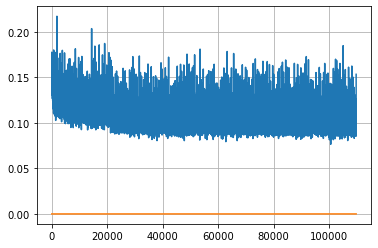

Epoch: 282, iteration 0, loss 0.10047689080238342, cov_diff 0.4025201550053304 cov_diff train 0.40175603580084346
Epoch: 282, iteration 1, loss 0.1063050627708435, cov_diff 0.4108060903931999 cov_diff train 0.40906198554687295
Epoch: 282, iteration 2, loss 0.10465934872627258, cov_diff 0.4201025943138638 cov_diff train 0.4186865094083061
Epoch: 282, iteration 3, loss 0.11288970708847046, cov_diff 0.42047862646159534 cov_diff train 0.41923735603219947
Epoch: 282, iteration 4, loss 0.09426715970039368, cov_diff 0.41505284905798195 cov_diff train 0.4141376569297852
Epoch: 282, iteration 5, loss 0.10177528858184814, cov_diff 0.4077143207626099 cov_diff train 0.40660151410255063
Epoch: 282, iteration 6, loss 0.11343961954116821, cov_diff 0.40919014247103913 cov_diff train 0.4081257342164162
Epoch: 282, iteration 7, loss 0.10071229934692383, cov_diff 0.41966172425289605 cov_diff train 0.41966725002437616
Epoch: 282, iteration 8, loss 0.10162317752838135, cov_diff 0.4136085372253379 cov_diff 

Epoch: 282, iteration 82, loss 0.09382471442222595, cov_diff 0.42105063422064315 cov_diff train 0.4200095416332669
Epoch: 282, iteration 83, loss 0.09450241923332214, cov_diff 0.4146579464008207 cov_diff train 0.41418574030131655
Epoch: 282, iteration 84, loss 0.11075210571289062, cov_diff 0.4177698598028026 cov_diff train 0.4169007713459821
Epoch: 282, iteration 85, loss 0.09905952215194702, cov_diff 0.42640097387927123 cov_diff train 0.42579814998739374
Epoch: 282, iteration 86, loss 0.10520341992378235, cov_diff 0.4075142654659978 cov_diff train 0.4068807696722931
Epoch: 282, iteration 87, loss 0.1017884612083435, cov_diff 0.41189209096112317 cov_diff train 0.4109979024180986
Epoch: 282, iteration 88, loss 0.10257351398468018, cov_diff 0.41385466212604677 cov_diff train 0.4123174830640881
Epoch: 282, iteration 89, loss 0.11199575662612915, cov_diff 0.40945911009272695 cov_diff train 0.4086859713203341
Epoch: 282, iteration 90, loss 0.10189226269721985, cov_diff 0.40413421310032854 c

Epoch: 282, iteration 157, loss 0.09800821542739868, cov_diff 0.39410104557645853 cov_diff train 0.3935075152994536
Epoch: 282, iteration 158, loss 0.11355069279670715, cov_diff 0.40855560602475666 cov_diff train 0.4079964878051378
Epoch: 282, iteration 159, loss 0.1075490415096283, cov_diff 0.4116608036034147 cov_diff train 0.4112506572162685
Epoch: 282, iteration 160, loss 0.10040140151977539, cov_diff 0.4133085999404063 cov_diff train 0.4128102604960787
Epoch: 282, iteration 161, loss 0.09870302677154541, cov_diff 0.40837536844518 cov_diff train 0.40791554021352555
Epoch: 282, iteration 162, loss 0.11583876609802246, cov_diff 0.40084577003141797 cov_diff train 0.4006265547535635
Epoch: 282, iteration 163, loss 0.10597482323646545, cov_diff 0.4059306575367443 cov_diff train 0.4055180615596665
Epoch: 282, iteration 164, loss 0.1128014326095581, cov_diff 0.4220386764373927 cov_diff train 0.4202970777496053
Epoch: 282, iteration 165, loss 0.09656324982643127, cov_diff 0.4191107600802024

Epoch: 282, iteration 235, loss 0.10636192560195923, cov_diff 0.40362812823904026 cov_diff train 0.4028135086855114
Epoch: 282, iteration 236, loss 0.11265084147453308, cov_diff 0.40756768574872865 cov_diff train 0.40730796991116763
Epoch: 282, iteration 237, loss 0.10088294744491577, cov_diff 0.41396886894443463 cov_diff train 0.4122810188690378
Epoch: 282, iteration 238, loss 0.0954827070236206, cov_diff 0.4135956963612808 cov_diff train 0.41213693105596777
Epoch: 282, iteration 239, loss 0.09752923250198364, cov_diff 0.4352754353500499 cov_diff train 0.43426878545623043
Epoch: 282, iteration 240, loss 0.09854960441589355, cov_diff 0.4132721105981306 cov_diff train 0.4124793026887526
Epoch: 282, iteration 241, loss 0.09404617547988892, cov_diff 0.3988036832861497 cov_diff train 0.3986849180810399
Epoch: 282, iteration 242, loss 0.10082465410232544, cov_diff 0.41235381914746827 cov_diff train 0.41153462145131525
Epoch: 282, iteration 243, loss 0.10261842608451843, cov_diff 0.409193925

Epoch: 282, iteration 309, loss 0.10640031099319458, cov_diff 0.418198619270279 cov_diff train 0.4175552100563056
Epoch: 282, iteration 310, loss 0.10468849539756775, cov_diff 0.41779654564800384 cov_diff train 0.41810534477671124
Epoch: 282, iteration 311, loss 0.10112497210502625, cov_diff 0.41329448727690987 cov_diff train 0.41298088180472714
Epoch: 282, iteration 312, loss 0.10660189390182495, cov_diff 0.3931340157938478 cov_diff train 0.3925468997626361
Epoch: 282, iteration 313, loss 0.10382479429244995, cov_diff 0.4251474129595212 cov_diff train 0.4237938080066885
Epoch: 282, iteration 314, loss 0.09957250952720642, cov_diff 0.413620189463595 cov_diff train 0.41278323957304613
Epoch: 282, iteration 315, loss 0.10601520538330078, cov_diff 0.4158050656055513 cov_diff train 0.4133435901904606
Epoch: 282, iteration 316, loss 0.11319580674171448, cov_diff 0.4084157304840665 cov_diff train 0.40732318067914286
Epoch: 282, iteration 317, loss 0.1117095947265625, cov_diff 0.4158880848436

Epoch: 282, iteration 380, loss 0.10405462980270386, cov_diff 0.4109242604290837 cov_diff train 0.4101577372057639
Epoch: 282, iteration 381, loss 0.10330262780189514, cov_diff 0.41280811044086757 cov_diff train 0.40970285729386796
Epoch: 282, iteration 382, loss 0.10770148038864136, cov_diff 0.41037623383772565 cov_diff train 0.40920803468354916
Epoch: 282, iteration 383, loss 0.1063176691532135, cov_diff 0.4113161232457119 cov_diff train 0.41022457192550615
Epoch: 282, iteration 384, loss 0.10497808456420898, cov_diff 0.41258562463435805 cov_diff train 0.4120798903030791
Epoch: 282, iteration 385, loss 0.10177162289619446, cov_diff 0.3974507441796445 cov_diff train 0.3969113636526656
Epoch: 282, iteration 386, loss 0.10199642181396484, cov_diff 0.41459042931750617 cov_diff train 0.4137016863799816
Epoch: 282, iteration 387, loss 0.10035532712936401, cov_diff 0.4261124235292209 cov_diff train 0.42555581312737956
Epoch: 282, iteration 388, loss 0.09885790944099426, cov_diff 0.406310519

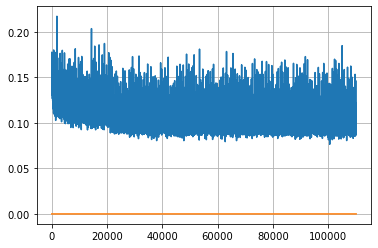

Epoch: 283, iteration 0, loss 0.09852203726768494, cov_diff 0.4023788140749533 cov_diff train 0.4008685452375845
Epoch: 283, iteration 1, loss 0.08939823508262634, cov_diff 0.4167808121973614 cov_diff train 0.41595162449469214
Epoch: 283, iteration 2, loss 0.10618472099304199, cov_diff 0.4210203465323058 cov_diff train 0.42027929329941444
Epoch: 283, iteration 3, loss 0.09564107656478882, cov_diff 0.41295375413485175 cov_diff train 0.4118979725162601
Epoch: 283, iteration 4, loss 0.10125213861465454, cov_diff 0.40694802928059826 cov_diff train 0.4063285766651614
Epoch: 283, iteration 5, loss 0.1031087338924408, cov_diff 0.4196111361853529 cov_diff train 0.41930479102964613
Epoch: 283, iteration 6, loss 0.1033971905708313, cov_diff 0.4038288145672798 cov_diff train 0.40185207628979513
Epoch: 283, iteration 7, loss 0.10598364472389221, cov_diff 0.4169678774519494 cov_diff train 0.41626867179970517
Epoch: 283, iteration 8, loss 0.10746490955352783, cov_diff 0.3938866624294264 cov_diff tra

Epoch: 283, iteration 73, loss 0.09666690230369568, cov_diff 0.40264866669867316 cov_diff train 0.4019942722110031
Epoch: 283, iteration 74, loss 0.10326987504959106, cov_diff 0.4261738158083891 cov_diff train 0.4245890190246577
Epoch: 283, iteration 75, loss 0.09977638721466064, cov_diff 0.4095679966178352 cov_diff train 0.40929343095530396
Epoch: 283, iteration 76, loss 0.09987765550613403, cov_diff 0.39818685990033104 cov_diff train 0.39724568555324585
Epoch: 283, iteration 77, loss 0.10397404432296753, cov_diff 0.41355908271396036 cov_diff train 0.41160478720928395
Epoch: 283, iteration 78, loss 0.09323489665985107, cov_diff 0.40791980205615186 cov_diff train 0.4063552799001485
Epoch: 283, iteration 79, loss 0.09409275650978088, cov_diff 0.414638832687456 cov_diff train 0.41391923916523127
Epoch: 283, iteration 80, loss 0.0933426022529602, cov_diff 0.4144842613612579 cov_diff train 0.41350490220834807
Epoch: 283, iteration 81, loss 0.10258018970489502, cov_diff 0.41171311879591455 

Epoch: 283, iteration 149, loss 0.10466480255126953, cov_diff 0.4081768600072341 cov_diff train 0.4070688342501112
Epoch: 283, iteration 150, loss 0.10145780444145203, cov_diff 0.41668005514662826 cov_diff train 0.41590458763421245
Epoch: 283, iteration 151, loss 0.10406416654586792, cov_diff 0.4109385494339113 cov_diff train 0.4095341272676573
Epoch: 283, iteration 152, loss 0.10163399577140808, cov_diff 0.41811852145820855 cov_diff train 0.4176683567605609
Epoch: 283, iteration 153, loss 0.10063347220420837, cov_diff 0.39721430787889833 cov_diff train 0.39674590836814827
Epoch: 283, iteration 154, loss 0.1090095043182373, cov_diff 0.41575404710281644 cov_diff train 0.4151125445009461
Epoch: 283, iteration 155, loss 0.11365032196044922, cov_diff 0.4079225683822091 cov_diff train 0.4063674669703928
Epoch: 283, iteration 156, loss 0.0962008535861969, cov_diff 0.41969093926095064 cov_diff train 0.4195908283182835
Epoch: 283, iteration 157, loss 0.109487384557724, cov_diff 0.4131973490077

Epoch: 283, iteration 226, loss 0.11353453993797302, cov_diff 0.40111875361473776 cov_diff train 0.40059299590866904
Epoch: 283, iteration 227, loss 0.10352891683578491, cov_diff 0.41533221427285405 cov_diff train 0.4151517645382042
Epoch: 283, iteration 228, loss 0.10179460048675537, cov_diff 0.3989255749999617 cov_diff train 0.39911181168245785
Epoch: 283, iteration 229, loss 0.099077969789505, cov_diff 0.41117563062150764 cov_diff train 0.4111405951048302
Epoch: 283, iteration 230, loss 0.10673984885215759, cov_diff 0.3997851352211842 cov_diff train 0.3999796977683086
Epoch: 283, iteration 231, loss 0.10388046503067017, cov_diff 0.41559667372997533 cov_diff train 0.41507431506661013
Epoch: 283, iteration 232, loss 0.10274618864059448, cov_diff 0.4158237190323124 cov_diff train 0.41599699631622966
Epoch: 283, iteration 233, loss 0.10053911805152893, cov_diff 0.4092876703218622 cov_diff train 0.4093304959493737
Epoch: 283, iteration 234, loss 0.0974816083908081, cov_diff 0.40976190052

Epoch: 283, iteration 297, loss 0.11290398240089417, cov_diff 0.4206745407622529 cov_diff train 0.42034007514915567
Epoch: 283, iteration 298, loss 0.09485632181167603, cov_diff 0.4122101761005951 cov_diff train 0.41211111040010806
Epoch: 283, iteration 299, loss 0.09796112775802612, cov_diff 0.42667476537218446 cov_diff train 0.42600394157787885
Epoch: 283, iteration 300, loss 0.10577353835105896, cov_diff 0.42158452925187434 cov_diff train 0.42152555471861497
Epoch: 283, iteration 301, loss 0.10062569379806519, cov_diff 0.4164762360368797 cov_diff train 0.4158111666585865
Epoch: 283, iteration 302, loss 0.10874927043914795, cov_diff 0.42008985221980005 cov_diff train 0.41922256814745024
Epoch: 283, iteration 303, loss 0.1226382851600647, cov_diff 0.4288934272033313 cov_diff train 0.42829135049251654
Epoch: 283, iteration 304, loss 0.0886596143245697, cov_diff 0.4158765026658353 cov_diff train 0.4153102158431457
Epoch: 283, iteration 305, loss 0.11186343431472778, cov_diff 0.422128601

Epoch: 283, iteration 374, loss 0.09824985265731812, cov_diff 0.40708321716652146 cov_diff train 0.4053650491767306
Epoch: 283, iteration 375, loss 0.09852492809295654, cov_diff 0.40265093295564475 cov_diff train 0.4019375884056696
Epoch: 283, iteration 376, loss 0.10206875205039978, cov_diff 0.41732904242669266 cov_diff train 0.41704528561507176
Epoch: 283, iteration 377, loss 0.11091309785842896, cov_diff 0.4067879512490544 cov_diff train 0.40563559970549734
Epoch: 283, iteration 378, loss 0.09802374243736267, cov_diff 0.4111117630844739 cov_diff train 0.4108030066686512
Epoch: 283, iteration 379, loss 0.1083613932132721, cov_diff 0.4139900133984418 cov_diff train 0.4129619389362716
Epoch: 283, iteration 380, loss 0.10178661346435547, cov_diff 0.398821297590733 cov_diff train 0.39820630306504734
Epoch: 283, iteration 381, loss 0.09814661741256714, cov_diff 0.41508343033547607 cov_diff train 0.41503182226654234
Epoch: 283, iteration 382, loss 0.11615860462188721, cov_diff 0.4350147002

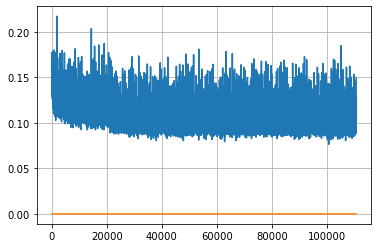

Epoch: 284, iteration 0, loss 0.0937395691871643, cov_diff 0.4148794750209181 cov_diff train 0.4148837212598841
Epoch: 284, iteration 1, loss 0.11048734188079834, cov_diff 0.41441338265380956 cov_diff train 0.413895829775358
Epoch: 284, iteration 2, loss 0.1059422492980957, cov_diff 0.4173028460106796 cov_diff train 0.41682972224837705
Epoch: 284, iteration 3, loss 0.10251280665397644, cov_diff 0.42277487105406797 cov_diff train 0.42195708683312494
Epoch: 284, iteration 4, loss 0.09808534383773804, cov_diff 0.39549008838836097 cov_diff train 0.39564532097479155
Epoch: 284, iteration 5, loss 0.09757795929908752, cov_diff 0.42209551889626584 cov_diff train 0.4214624401877727
Epoch: 284, iteration 6, loss 0.09953314065933228, cov_diff 0.4140947469796854 cov_diff train 0.4137957750655137
Epoch: 284, iteration 7, loss 0.10455936193466187, cov_diff 0.42026448101270897 cov_diff train 0.42017719884230126
Epoch: 284, iteration 8, loss 0.10940670967102051, cov_diff 0.41453838658214065 cov_diff t

Epoch: 284, iteration 73, loss 0.10031184554100037, cov_diff 0.4105985686050995 cov_diff train 0.411063597686732
Epoch: 284, iteration 74, loss 0.09889128804206848, cov_diff 0.4228092682769188 cov_diff train 0.4220581539056392
Epoch: 284, iteration 75, loss 0.1076236367225647, cov_diff 0.4040227067763393 cov_diff train 0.4042552394800525
Epoch: 284, iteration 76, loss 0.10353261232376099, cov_diff 0.4046440071882591 cov_diff train 0.4050777547915305
Epoch: 284, iteration 77, loss 0.10741260647773743, cov_diff 0.40861447269920204 cov_diff train 0.4081589313555637
Epoch: 284, iteration 78, loss 0.10659351944923401, cov_diff 0.4057419137625555 cov_diff train 0.40477129932453376
Epoch: 284, iteration 79, loss 0.1130351722240448, cov_diff 0.4117594425550714 cov_diff train 0.41112283728078747
Epoch: 284, iteration 80, loss 0.10284444689750671, cov_diff 0.4155333580790119 cov_diff train 0.41541241303022824
Epoch: 284, iteration 81, loss 0.10207706689834595, cov_diff 0.4100715898619931 cov_dif

Epoch: 284, iteration 151, loss 0.1096227765083313, cov_diff 0.4121206132926248 cov_diff train 0.41049548550096454
Epoch: 284, iteration 152, loss 0.09326615929603577, cov_diff 0.40241663614841505 cov_diff train 0.4023383047992269
Epoch: 284, iteration 153, loss 0.10356441140174866, cov_diff 0.4115348483577067 cov_diff train 0.4110490667814709
Epoch: 284, iteration 154, loss 0.10678097605705261, cov_diff 0.4082811812428043 cov_diff train 0.4078728279599259
Epoch: 284, iteration 155, loss 0.09813469648361206, cov_diff 0.40388341710005293 cov_diff train 0.40422536191676395
Epoch: 284, iteration 156, loss 0.10244324803352356, cov_diff 0.4093801979385268 cov_diff train 0.4093616676807485
Epoch: 284, iteration 157, loss 0.10410398244857788, cov_diff 0.4074093972496319 cov_diff train 0.40685451245146104
Epoch: 284, iteration 158, loss 0.09379765391349792, cov_diff 0.4106309506527555 cov_diff train 0.41040035676977127
Epoch: 284, iteration 159, loss 0.09660941362380981, cov_diff 0.40430501667

Epoch: 284, iteration 228, loss 0.10040739178657532, cov_diff 0.39715537764350756 cov_diff train 0.39659893939077534
Epoch: 284, iteration 229, loss 0.09698078036308289, cov_diff 0.40459047346289084 cov_diff train 0.4039849001168446
Epoch: 284, iteration 230, loss 0.10050231218338013, cov_diff 0.4123622185111213 cov_diff train 0.41230706852936577
Epoch: 284, iteration 231, loss 0.1023816466331482, cov_diff 0.4157225739113698 cov_diff train 0.41567518116506624
Epoch: 284, iteration 232, loss 0.09219881892204285, cov_diff 0.4162064169581601 cov_diff train 0.4160441183109048
Epoch: 284, iteration 233, loss 0.10762423276901245, cov_diff 0.41210531265607475 cov_diff train 0.4122731761119363
Epoch: 284, iteration 234, loss 0.1118958592414856, cov_diff 0.4133919516252386 cov_diff train 0.41196888759221423
Epoch: 284, iteration 235, loss 0.09904307126998901, cov_diff 0.40747532688299737 cov_diff train 0.4069698253482667
Epoch: 284, iteration 236, loss 0.09810253977775574, cov_diff 0.4008988177

Epoch: 284, iteration 302, loss 0.10595452785491943, cov_diff 0.4113723031473931 cov_diff train 0.4104065601841085
Epoch: 284, iteration 303, loss 0.11202862858772278, cov_diff 0.40775417381363466 cov_diff train 0.40768042890891376
Epoch: 284, iteration 304, loss 0.09489047527313232, cov_diff 0.40899362828494984 cov_diff train 0.40855245201624013
Epoch: 284, iteration 305, loss 0.10675352811813354, cov_diff 0.41486402566360814 cov_diff train 0.41452002994963605
Epoch: 284, iteration 306, loss 0.1126958429813385, cov_diff 0.42086457831117213 cov_diff train 0.41959584991996873
Epoch: 284, iteration 307, loss 0.11864045262336731, cov_diff 0.4185312012020143 cov_diff train 0.4175608269294124
Epoch: 284, iteration 308, loss 0.10517820715904236, cov_diff 0.4130793336932508 cov_diff train 0.41265013371233517
Epoch: 284, iteration 309, loss 0.09461861848831177, cov_diff 0.40196427655187467 cov_diff train 0.4012537392667439
Epoch: 284, iteration 310, loss 0.12428823113441467, cov_diff 0.4086584

Epoch: 284, iteration 374, loss 0.10754385590553284, cov_diff 0.41791539867903316 cov_diff train 0.41663259149073234
Epoch: 284, iteration 375, loss 0.10490518808364868, cov_diff 0.4102554499177961 cov_diff train 0.41049330320770266
Epoch: 284, iteration 376, loss 0.09415900707244873, cov_diff 0.40905303890210654 cov_diff train 0.40910377817041826
Epoch: 284, iteration 377, loss 0.09867066144943237, cov_diff 0.41053581624155033 cov_diff train 0.40991664008948975
Epoch: 284, iteration 378, loss 0.1041070818901062, cov_diff 0.4092326547620915 cov_diff train 0.4089838878956535
Epoch: 284, iteration 379, loss 0.09986907243728638, cov_diff 0.4146135963484461 cov_diff train 0.41460660116845693
Epoch: 284, iteration 380, loss 0.10405594110488892, cov_diff 0.38886384418029435 cov_diff train 0.38845024951414175
Epoch: 284, iteration 381, loss 0.09572121500968933, cov_diff 0.406287537414407 cov_diff train 0.40601760628957234
Epoch: 284, iteration 382, loss 0.10265636444091797, cov_diff 0.4162877

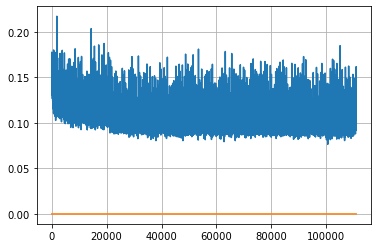

Epoch: 285, iteration 0, loss 0.11096328496932983, cov_diff 0.4119521394475323 cov_diff train 0.41132258968586716
Epoch: 285, iteration 1, loss 0.10585474967956543, cov_diff 0.41077409550078164 cov_diff train 0.411158135954353
Epoch: 285, iteration 2, loss 0.10698920488357544, cov_diff 0.40373582502225763 cov_diff train 0.40418904207009204
Epoch: 285, iteration 3, loss 0.10256773233413696, cov_diff 0.4182675935545102 cov_diff train 0.41783528760345645
Epoch: 285, iteration 4, loss 0.10864034295082092, cov_diff 0.4118836026605785 cov_diff train 0.4119862978063311
Epoch: 285, iteration 5, loss 0.09376874566078186, cov_diff 0.40953948544777896 cov_diff train 0.4090933381395424
Epoch: 285, iteration 6, loss 0.10479769110679626, cov_diff 0.4080347477864468 cov_diff train 0.40773622410620775
Epoch: 285, iteration 7, loss 0.10058018565177917, cov_diff 0.3981816668865058 cov_diff train 0.3977115562192237
Epoch: 285, iteration 8, loss 0.10573261976242065, cov_diff 0.41689162383422307 cov_diff t

Epoch: 285, iteration 73, loss 0.10175895690917969, cov_diff 0.41158352807227655 cov_diff train 0.41112567773994174
Epoch: 285, iteration 74, loss 0.09428486227989197, cov_diff 0.4164967441792314 cov_diff train 0.41485870573934247
Epoch: 285, iteration 75, loss 0.10926768183708191, cov_diff 0.43606279278695775 cov_diff train 0.4337907164294644
Epoch: 285, iteration 76, loss 0.10833790898323059, cov_diff 0.4246950177048028 cov_diff train 0.42329870729001
Epoch: 285, iteration 77, loss 0.10693663358688354, cov_diff 0.42458213209865214 cov_diff train 0.42401390156912855
Epoch: 285, iteration 78, loss 0.09634670615196228, cov_diff 0.4088562740361398 cov_diff train 0.4069559497732106
Epoch: 285, iteration 79, loss 0.0982724130153656, cov_diff 0.42071592007199704 cov_diff train 0.4203354431953053
Epoch: 285, iteration 80, loss 0.08448278903961182, cov_diff 0.41395659172920685 cov_diff train 0.4136726871298222
Epoch: 285, iteration 81, loss 0.11277645826339722, cov_diff 0.4161784531152251 cov

Epoch: 285, iteration 150, loss 0.11589613556861877, cov_diff 0.42552960943749096 cov_diff train 0.42412222463658994
Epoch: 285, iteration 151, loss 0.0999494194984436, cov_diff 0.40345891695819663 cov_diff train 0.4026546951718129
Epoch: 285, iteration 152, loss 0.12551936507225037, cov_diff 0.4117958955458151 cov_diff train 0.41001035167576094
Epoch: 285, iteration 153, loss 0.10173210501670837, cov_diff 0.424567165887296 cov_diff train 0.42386465019903263
Epoch: 285, iteration 154, loss 0.10310336947441101, cov_diff 0.40147468008561865 cov_diff train 0.4012845321558426
Epoch: 285, iteration 155, loss 0.10708966851234436, cov_diff 0.41828810038195363 cov_diff train 0.416882624980146
Epoch: 285, iteration 156, loss 0.10303536057472229, cov_diff 0.40682434502566794 cov_diff train 0.4052675780509072
Epoch: 285, iteration 157, loss 0.09610587358474731, cov_diff 0.4006000369583769 cov_diff train 0.40018850701824776
Epoch: 285, iteration 158, loss 0.10258457064628601, cov_diff 0.4105849120

Epoch: 285, iteration 222, loss 0.11217173933982849, cov_diff 0.4170657908500523 cov_diff train 0.4172961869451387
Epoch: 285, iteration 223, loss 0.10536149144172668, cov_diff 0.4150552755423812 cov_diff train 0.4147524171088918
Epoch: 285, iteration 224, loss 0.10942903161048889, cov_diff 0.4208773764035891 cov_diff train 0.4210786855673332
Epoch: 285, iteration 225, loss 0.10740643739700317, cov_diff 0.41907453425128494 cov_diff train 0.4192516096847631
Epoch: 285, iteration 226, loss 0.08987581729888916, cov_diff 0.4043283228524812 cov_diff train 0.40381379069468726
Epoch: 285, iteration 227, loss 0.11080700159072876, cov_diff 0.4232482554030686 cov_diff train 0.4225802554387934
Epoch: 285, iteration 228, loss 0.1057286262512207, cov_diff 0.3984933650635906 cov_diff train 0.39802453327830467
Epoch: 285, iteration 229, loss 0.11459082365036011, cov_diff 0.4105993693865219 cov_diff train 0.40919672106473853
Epoch: 285, iteration 230, loss 0.10248291492462158, cov_diff 0.4108951613966

Epoch: 285, iteration 295, loss 0.10491272807121277, cov_diff 0.4068489864992872 cov_diff train 0.4064743576714298
Epoch: 285, iteration 296, loss 0.10211089253425598, cov_diff 0.4078386054103457 cov_diff train 0.40731379158553327
Epoch: 285, iteration 297, loss 0.10578486323356628, cov_diff 0.40137539934734834 cov_diff train 0.4017175875118041
Epoch: 285, iteration 298, loss 0.10056224465370178, cov_diff 0.4085370967518994 cov_diff train 0.4083156253243766
Epoch: 285, iteration 299, loss 0.10513117909431458, cov_diff 0.41738117318994294 cov_diff train 0.4170606476036698
Epoch: 285, iteration 300, loss 0.11103767156600952, cov_diff 0.41032676269758905 cov_diff train 0.41005226522736954
Epoch: 285, iteration 301, loss 0.11150851845741272, cov_diff 0.4227640491903934 cov_diff train 0.4232156084218089
Epoch: 285, iteration 302, loss 0.10858377814292908, cov_diff 0.4027967305303906 cov_diff train 0.40265939822663305
Epoch: 285, iteration 303, loss 0.10956108570098877, cov_diff 0.4046927018

Epoch: 285, iteration 370, loss 0.10408416390419006, cov_diff 0.41070256236782404 cov_diff train 0.41069138586394843
Epoch: 285, iteration 371, loss 0.09716734290122986, cov_diff 0.4249611898905365 cov_diff train 0.4242894690055892
Epoch: 285, iteration 372, loss 0.11906284093856812, cov_diff 0.41935916930123684 cov_diff train 0.4190507620310598
Epoch: 285, iteration 373, loss 0.10958239436149597, cov_diff 0.4163120895581702 cov_diff train 0.4160743916076918
Epoch: 285, iteration 374, loss 0.10610416531562805, cov_diff 0.40939322053848826 cov_diff train 0.408073981506174
Epoch: 285, iteration 375, loss 0.10114395618438721, cov_diff 0.4116931533679925 cov_diff train 0.41120081807861975
Epoch: 285, iteration 376, loss 0.0987115204334259, cov_diff 0.41057215605878794 cov_diff train 0.41000157650401453
Epoch: 285, iteration 377, loss 0.1098957359790802, cov_diff 0.39894045282698976 cov_diff train 0.3982017817105919
Epoch: 285, iteration 378, loss 0.10371735692024231, cov_diff 0.40900080041

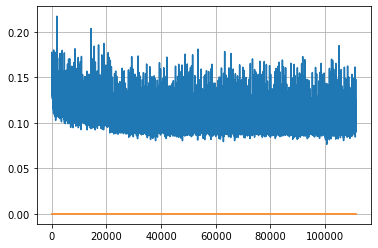

Epoch: 286, iteration 0, loss 0.09870296716690063, cov_diff 0.42141517858518174 cov_diff train 0.42149162319014416
Epoch: 286, iteration 1, loss 0.10125994682312012, cov_diff 0.4080043681108281 cov_diff train 0.40793132403933074
Epoch: 286, iteration 2, loss 0.10205456614494324, cov_diff 0.40970907341673657 cov_diff train 0.40928974720262795
Epoch: 286, iteration 3, loss 0.09351944923400879, cov_diff 0.4204845560085865 cov_diff train 0.42011164661588873
Epoch: 286, iteration 4, loss 0.11154821515083313, cov_diff 0.4190023430607754 cov_diff train 0.4178924778376296
Epoch: 286, iteration 5, loss 0.10923013091087341, cov_diff 0.40969413867139853 cov_diff train 0.4089900114026531
Epoch: 286, iteration 6, loss 0.10429921746253967, cov_diff 0.41168735550886476 cov_diff train 0.41107790380655657
Epoch: 286, iteration 7, loss 0.1059592068195343, cov_diff 0.41314370444445203 cov_diff train 0.4127127048309665
Epoch: 286, iteration 8, loss 0.11305016279220581, cov_diff 0.41175907036724807 cov_dif

Epoch: 286, iteration 77, loss 0.09531891345977783, cov_diff 0.42311051164294355 cov_diff train 0.4224111410207676
Epoch: 286, iteration 78, loss 0.11259019374847412, cov_diff 0.4078553540829935 cov_diff train 0.40786481331314245
Epoch: 286, iteration 79, loss 0.10291412472724915, cov_diff 0.43103625280897334 cov_diff train 0.431122675131943
Epoch: 286, iteration 80, loss 0.09951645135879517, cov_diff 0.4164277908016507 cov_diff train 0.4171213431649879
Epoch: 286, iteration 81, loss 0.09878528118133545, cov_diff 0.41701255290934974 cov_diff train 0.4164567453734663
Epoch: 286, iteration 82, loss 0.1117485761642456, cov_diff 0.40573900539339225 cov_diff train 0.40509464603830075
Epoch: 286, iteration 83, loss 0.10162311792373657, cov_diff 0.4207511658326162 cov_diff train 0.4203903265771618
Epoch: 286, iteration 84, loss 0.09973761439323425, cov_diff 0.42407959428168635 cov_diff train 0.423232875904434
Epoch: 286, iteration 85, loss 0.09885230660438538, cov_diff 0.41202360993105613 cov

Epoch: 286, iteration 154, loss 0.10240617394447327, cov_diff 0.4099134727065265 cov_diff train 0.4092060133855458
Epoch: 286, iteration 155, loss 0.11527690291404724, cov_diff 0.4081259901105149 cov_diff train 0.4078034926214266
Epoch: 286, iteration 156, loss 0.10694223642349243, cov_diff 0.41624398265607027 cov_diff train 0.41495811278106415
Epoch: 286, iteration 157, loss 0.10812017321586609, cov_diff 0.4083933343299604 cov_diff train 0.4067880775762578
Epoch: 286, iteration 158, loss 0.1047123372554779, cov_diff 0.40713473416252693 cov_diff train 0.4061641569455789
Epoch: 286, iteration 159, loss 0.08936050534248352, cov_diff 0.40283041550834303 cov_diff train 0.40195007267649974
Epoch: 286, iteration 160, loss 0.10024747252464294, cov_diff 0.42380742102005464 cov_diff train 0.4236500130195312
Epoch: 286, iteration 161, loss 0.10649985074996948, cov_diff 0.41739716821389566 cov_diff train 0.4166434344759679
Epoch: 286, iteration 162, loss 0.1116822361946106, cov_diff 0.42719783337

Epoch: 286, iteration 232, loss 0.09971225261688232, cov_diff 0.4085852904740134 cov_diff train 0.4080210617275152
Epoch: 286, iteration 233, loss 0.10343924164772034, cov_diff 0.41069963081071287 cov_diff train 0.40925469540572135
Epoch: 286, iteration 234, loss 0.09888759255409241, cov_diff 0.4051759179617132 cov_diff train 0.4051342863914463
Epoch: 286, iteration 235, loss 0.10224258899688721, cov_diff 0.41812877464646764 cov_diff train 0.41706814883402654
Epoch: 286, iteration 236, loss 0.10610121488571167, cov_diff 0.4178364540038766 cov_diff train 0.41723278642438355
Epoch: 286, iteration 237, loss 0.10462233424186707, cov_diff 0.42340827363208444 cov_diff train 0.4227054446484097
Epoch: 286, iteration 238, loss 0.10322272777557373, cov_diff 0.41378200574769947 cov_diff train 0.41334132408898816
Epoch: 286, iteration 239, loss 0.10657289624214172, cov_diff 0.41261018960254453 cov_diff train 0.41214833176765175
Epoch: 286, iteration 240, loss 0.09908640384674072, cov_diff 0.424536

Epoch: 286, iteration 308, loss 0.09952929615974426, cov_diff 0.40675791488494306 cov_diff train 0.40550221803024344
Epoch: 286, iteration 309, loss 0.10781225562095642, cov_diff 0.3994129552356089 cov_diff train 0.3989708852731592
Epoch: 286, iteration 310, loss 0.1006285548210144, cov_diff 0.42078616905808786 cov_diff train 0.4193252745154743
Epoch: 286, iteration 311, loss 0.10139822959899902, cov_diff 0.39958882048218347 cov_diff train 0.39937966082290177
Epoch: 286, iteration 312, loss 0.09653881192207336, cov_diff 0.40650309002609947 cov_diff train 0.4058226030256339
Epoch: 286, iteration 313, loss 0.09754630923271179, cov_diff 0.41167891675982254 cov_diff train 0.4118558875373232
Epoch: 286, iteration 314, loss 0.09954261779785156, cov_diff 0.4081024881425517 cov_diff train 0.4064626279628644
Epoch: 286, iteration 315, loss 0.10232025384902954, cov_diff 0.4067687471186945 cov_diff train 0.4063827762576658
Epoch: 286, iteration 316, loss 0.1057245135307312, cov_diff 0.41152357259

Epoch: 286, iteration 383, loss 0.10439354181289673, cov_diff 0.4030882440390634 cov_diff train 0.40322336978950857
Epoch: 286, iteration 384, loss 0.10431680083274841, cov_diff 0.4111295807061662 cov_diff train 0.4106933406279222
Epoch: 286, iteration 385, loss 0.09480741620063782, cov_diff 0.4050945867990505 cov_diff train 0.40470994218407863
Epoch: 286, iteration 386, loss 0.10057839751243591, cov_diff 0.4116406197079168 cov_diff train 0.41069639607638725
Epoch: 286, iteration 387, loss 0.10111451148986816, cov_diff 0.41609173856261505 cov_diff train 0.4154689388773233
Epoch: 286, iteration 388, loss 0.10627931356430054, cov_diff 0.4118067856669596 cov_diff train 0.41149657280567603
Epoch: 286, iteration 389, loss 0.10407480597496033, cov_diff 0.414751387636591 cov_diff train 0.41339249025739766
Epoch: 286, iteration 390, loss 0.1468409299850464, cov_diff 0.46161991945805764 cov_diff train 0.4591725401522479


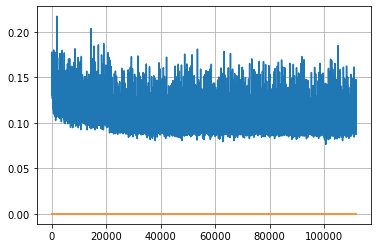

Epoch: 287, iteration 0, loss 0.10339218378067017, cov_diff 0.4088982228026034 cov_diff train 0.4086878215621828
Epoch: 287, iteration 1, loss 0.10771647095680237, cov_diff 0.4138314919286707 cov_diff train 0.413740475698536
Epoch: 287, iteration 2, loss 0.10376057028770447, cov_diff 0.3958953653023805 cov_diff train 0.39495860720817977
Epoch: 287, iteration 3, loss 0.10767543315887451, cov_diff 0.40527064049306805 cov_diff train 0.40368038207365425
Epoch: 287, iteration 4, loss 0.09576323628425598, cov_diff 0.4011131586369889 cov_diff train 0.4007403300107072
Epoch: 287, iteration 5, loss 0.09792056679725647, cov_diff 0.4095997619561835 cov_diff train 0.40927690941254785
Epoch: 287, iteration 6, loss 0.09761103987693787, cov_diff 0.42782782376687045 cov_diff train 0.4267952230943978
Epoch: 287, iteration 7, loss 0.09806975722312927, cov_diff 0.4169786293709381 cov_diff train 0.4164318774032894
Epoch: 287, iteration 8, loss 0.1193498969078064, cov_diff 0.42223244372026375 cov_diff trai

Epoch: 287, iteration 72, loss 0.104225754737854, cov_diff 0.41735682714839 cov_diff train 0.41650110744977603
Epoch: 287, iteration 73, loss 0.10945436358451843, cov_diff 0.40570329566290936 cov_diff train 0.405709446857342
Epoch: 287, iteration 74, loss 0.10901078581809998, cov_diff 0.40199715839001327 cov_diff train 0.401774640180848
Epoch: 287, iteration 75, loss 0.10025626420974731, cov_diff 0.4053447734903698 cov_diff train 0.4049651818645397
Epoch: 287, iteration 76, loss 0.10598728060722351, cov_diff 0.40929752887751103 cov_diff train 0.409260832919459
Epoch: 287, iteration 77, loss 0.09707760810852051, cov_diff 0.412731276857053 cov_diff train 0.41239588522470577
Epoch: 287, iteration 78, loss 0.10688415169715881, cov_diff 0.4155306682555819 cov_diff train 0.4141850620622022
Epoch: 287, iteration 79, loss 0.10697853565216064, cov_diff 0.3999233618894354 cov_diff train 0.3987032929306154
Epoch: 287, iteration 80, loss 0.11258214712142944, cov_diff 0.4302254232647065 cov_diff tr

Epoch: 287, iteration 144, loss 0.08982670307159424, cov_diff 0.41009661524075985 cov_diff train 0.4099332915462857
Epoch: 287, iteration 145, loss 0.10710129141807556, cov_diff 0.40979659562488685 cov_diff train 0.409760064596672
Epoch: 287, iteration 146, loss 0.1095140278339386, cov_diff 0.4123805784453456 cov_diff train 0.4103026591516394
Epoch: 287, iteration 147, loss 0.09547543525695801, cov_diff 0.40639601048170443 cov_diff train 0.4061354358227616
Epoch: 287, iteration 148, loss 0.10739445686340332, cov_diff 0.4183631143361476 cov_diff train 0.418694322069276
Epoch: 287, iteration 149, loss 0.10237470269203186, cov_diff 0.4075546726625926 cov_diff train 0.4069999140203945
Epoch: 287, iteration 150, loss 0.09914299845695496, cov_diff 0.42047247759683803 cov_diff train 0.4195133471066139
Epoch: 287, iteration 151, loss 0.1092163622379303, cov_diff 0.4034913321290662 cov_diff train 0.40322266967277565
Epoch: 287, iteration 152, loss 0.10575994849205017, cov_diff 0.412669490408638

Epoch: 287, iteration 220, loss 0.08615067601203918, cov_diff 0.42564389525242036 cov_diff train 0.42546368196084583
Epoch: 287, iteration 221, loss 0.10514122247695923, cov_diff 0.40613869251707163 cov_diff train 0.40613578013120033
Epoch: 287, iteration 222, loss 0.09616824984550476, cov_diff 0.40286676349840844 cov_diff train 0.4022593938661997
Epoch: 287, iteration 223, loss 0.0969037413597107, cov_diff 0.40340373865540385 cov_diff train 0.402870973757619
Epoch: 287, iteration 224, loss 0.10064831376075745, cov_diff 0.41868243277489703 cov_diff train 0.4188143322993816
Epoch: 287, iteration 225, loss 0.11325514316558838, cov_diff 0.4074550875480326 cov_diff train 0.4082738358183859
Epoch: 287, iteration 226, loss 0.09066635370254517, cov_diff 0.40314370018592877 cov_diff train 0.4018465165208934
Epoch: 287, iteration 227, loss 0.10564425587654114, cov_diff 0.41044518066504054 cov_diff train 0.4093310082787721
Epoch: 287, iteration 228, loss 0.09009402990341187, cov_diff 0.406041591

Epoch: 287, iteration 297, loss 0.09440749883651733, cov_diff 0.4029173361821253 cov_diff train 0.4028790474777906
Epoch: 287, iteration 298, loss 0.101186603307724, cov_diff 0.41154322063696946 cov_diff train 0.410996957613344
Epoch: 287, iteration 299, loss 0.10386869311332703, cov_diff 0.41219503463921814 cov_diff train 0.41220569498972176
Epoch: 287, iteration 300, loss 0.10716947913169861, cov_diff 0.4152939313462212 cov_diff train 0.4138081931060809
Epoch: 287, iteration 301, loss 0.1041330099105835, cov_diff 0.4123777271700439 cov_diff train 0.41226015139926636
Epoch: 287, iteration 302, loss 0.09706726670265198, cov_diff 0.4168611459288632 cov_diff train 0.4159034118283669
Epoch: 287, iteration 303, loss 0.10623091459274292, cov_diff 0.4168091605867623 cov_diff train 0.41604013302980164
Epoch: 287, iteration 304, loss 0.09773677587509155, cov_diff 0.40511572522335526 cov_diff train 0.4039024735300134
Epoch: 287, iteration 305, loss 0.09067118167877197, cov_diff 0.40331475504823

Epoch: 287, iteration 374, loss 0.0975605845451355, cov_diff 0.41099402271974417 cov_diff train 0.41027476486399234
Epoch: 287, iteration 375, loss 0.09257638454437256, cov_diff 0.40649523342622074 cov_diff train 0.4056387713375336
Epoch: 287, iteration 376, loss 0.10423460602760315, cov_diff 0.40844198359037437 cov_diff train 0.4059729179397387
Epoch: 287, iteration 377, loss 0.09158074855804443, cov_diff 0.4191513823565926 cov_diff train 0.41845103865301786
Epoch: 287, iteration 378, loss 0.11047083139419556, cov_diff 0.41718748756307483 cov_diff train 0.41726315499033695
Epoch: 287, iteration 379, loss 0.10785830020904541, cov_diff 0.4138868382005818 cov_diff train 0.4134675589523895
Epoch: 287, iteration 380, loss 0.0959121584892273, cov_diff 0.405671779503684 cov_diff train 0.40523937680683864
Epoch: 287, iteration 381, loss 0.10572877526283264, cov_diff 0.40107049731997046 cov_diff train 0.3982958783861841
Epoch: 287, iteration 382, loss 0.09419101476669312, cov_diff 0.4147584425

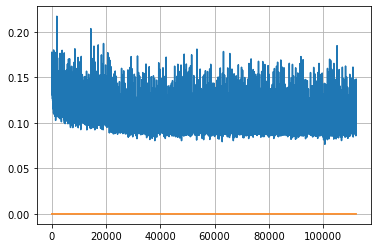

Epoch: 288, iteration 0, loss 0.0999835729598999, cov_diff 0.4257999328920301 cov_diff train 0.424908829088379
Epoch: 288, iteration 1, loss 0.09992438554763794, cov_diff 0.4168782907648226 cov_diff train 0.4162622622601628
Epoch: 288, iteration 2, loss 0.10219722986221313, cov_diff 0.40301922437369053 cov_diff train 0.4026116677009772
Epoch: 288, iteration 3, loss 0.09375792741775513, cov_diff 0.41254763448551884 cov_diff train 0.4106994541002994
Epoch: 288, iteration 4, loss 0.10248184204101562, cov_diff 0.4105749183365823 cov_diff train 0.41112933507900234
Epoch: 288, iteration 5, loss 0.0985477864742279, cov_diff 0.421606699349222 cov_diff train 0.42122471525410965
Epoch: 288, iteration 6, loss 0.11338803172111511, cov_diff 0.41410097659342465 cov_diff train 0.412903522159287
Epoch: 288, iteration 7, loss 0.1044069230556488, cov_diff 0.39775160219840133 cov_diff train 0.3974525675003421
Epoch: 288, iteration 8, loss 0.10464361310005188, cov_diff 0.4042356124111893 cov_diff train 0.

Epoch: 288, iteration 76, loss 0.10138559341430664, cov_diff 0.4201316228510955 cov_diff train 0.41922135536891875
Epoch: 288, iteration 77, loss 0.10915479063987732, cov_diff 0.4290807723455987 cov_diff train 0.42901072609665647
Epoch: 288, iteration 78, loss 0.09604471921920776, cov_diff 0.3994463489169617 cov_diff train 0.39953903237689176
Epoch: 288, iteration 79, loss 0.10576537251472473, cov_diff 0.3899834187146886 cov_diff train 0.3894573988443401
Epoch: 288, iteration 80, loss 0.09811043739318848, cov_diff 0.41789203407609876 cov_diff train 0.4171268305860392
Epoch: 288, iteration 81, loss 0.09519284963607788, cov_diff 0.4141462049155345 cov_diff train 0.4139801487682116
Epoch: 288, iteration 82, loss 0.11597087979316711, cov_diff 0.41401332879519387 cov_diff train 0.4134801859288398
Epoch: 288, iteration 83, loss 0.1016608476638794, cov_diff 0.40795031920875613 cov_diff train 0.40693441100124017
Epoch: 288, iteration 84, loss 0.08922678232192993, cov_diff 0.4075825475450816 co

Epoch: 288, iteration 151, loss 0.10939604043960571, cov_diff 0.404910808265801 cov_diff train 0.40384355465005783
Epoch: 288, iteration 152, loss 0.10434940457344055, cov_diff 0.41392833160435927 cov_diff train 0.41341014627894546
Epoch: 288, iteration 153, loss 0.1097879707813263, cov_diff 0.4107257826057623 cov_diff train 0.41016476016367176
Epoch: 288, iteration 154, loss 0.10415834188461304, cov_diff 0.4198980203419859 cov_diff train 0.41839470116864136
Epoch: 288, iteration 155, loss 0.10125851631164551, cov_diff 0.4272174457307042 cov_diff train 0.426227813994093
Epoch: 288, iteration 156, loss 0.10745149850845337, cov_diff 0.4174613523347423 cov_diff train 0.41636323702206984
Epoch: 288, iteration 157, loss 0.12452077865600586, cov_diff 0.41193052027834337 cov_diff train 0.41038197471944093
Epoch: 288, iteration 158, loss 0.10114532709121704, cov_diff 0.4132243245381398 cov_diff train 0.41274842068067585
Epoch: 288, iteration 159, loss 0.11164557933807373, cov_diff 0.4130514143

Epoch: 288, iteration 227, loss 0.10527092218399048, cov_diff 0.421873652271487 cov_diff train 0.420847973987192
Epoch: 288, iteration 228, loss 0.10575747489929199, cov_diff 0.4182482534491275 cov_diff train 0.41731126263907625
Epoch: 288, iteration 229, loss 0.10818496346473694, cov_diff 0.4162326954907877 cov_diff train 0.4161265033294049
Epoch: 288, iteration 230, loss 0.11368215084075928, cov_diff 0.4156894078212277 cov_diff train 0.41455720085618536
Epoch: 288, iteration 231, loss 0.10438618063926697, cov_diff 0.41582346450614033 cov_diff train 0.4151231210637067
Epoch: 288, iteration 232, loss 0.09353253245353699, cov_diff 0.4213880009460098 cov_diff train 0.4206675440596331
Epoch: 288, iteration 233, loss 0.10322877764701843, cov_diff 0.41546710977729034 cov_diff train 0.4144114422878751
Epoch: 288, iteration 234, loss 0.09960463643074036, cov_diff 0.41395618906008397 cov_diff train 0.4133045413215171
Epoch: 288, iteration 235, loss 0.10118645429611206, cov_diff 0.4043547448940

Epoch: 288, iteration 300, loss 0.09982442855834961, cov_diff 0.42257112237702954 cov_diff train 0.42177996960562597
Epoch: 288, iteration 301, loss 0.1047421395778656, cov_diff 0.4150414098546679 cov_diff train 0.41509741094013836
Epoch: 288, iteration 302, loss 0.11170622706413269, cov_diff 0.4147814691787245 cov_diff train 0.4134998558970432
Epoch: 288, iteration 303, loss 0.10148730874061584, cov_diff 0.41016512117772996 cov_diff train 0.4094866530259423
Epoch: 288, iteration 304, loss 0.10869312286376953, cov_diff 0.4087973656427299 cov_diff train 0.40759890347256394
Epoch: 288, iteration 305, loss 0.11636877059936523, cov_diff 0.4185755791440739 cov_diff train 0.41776077014546203
Epoch: 288, iteration 306, loss 0.12402230501174927, cov_diff 0.414807896801981 cov_diff train 0.4144983449015728
Epoch: 288, iteration 307, loss 0.10725235939025879, cov_diff 0.41884570489342227 cov_diff train 0.4171448543180871
Epoch: 288, iteration 308, loss 0.10131919384002686, cov_diff 0.40967780812

Epoch: 288, iteration 380, loss 0.09945866465568542, cov_diff 0.41175661698777677 cov_diff train 0.41126591616169444
Epoch: 288, iteration 381, loss 0.10167384147644043, cov_diff 0.4196122294378578 cov_diff train 0.41925820848868434
Epoch: 288, iteration 382, loss 0.09928828477859497, cov_diff 0.42078015527585266 cov_diff train 0.42027784513552696
Epoch: 288, iteration 383, loss 0.10012969374656677, cov_diff 0.40369751022117567 cov_diff train 0.4037931816154969
Epoch: 288, iteration 384, loss 0.10087454319000244, cov_diff 0.41806635159472955 cov_diff train 0.41740672288234226
Epoch: 288, iteration 385, loss 0.11409816145896912, cov_diff 0.41656448474205265 cov_diff train 0.4151961897022217
Epoch: 288, iteration 386, loss 0.09820583462715149, cov_diff 0.407525981051078 cov_diff train 0.4066125319063895
Epoch: 288, iteration 387, loss 0.1100926399230957, cov_diff 0.42459134873111193 cov_diff train 0.4235029477274477
Epoch: 288, iteration 388, loss 0.09615284204483032, cov_diff 0.41899861

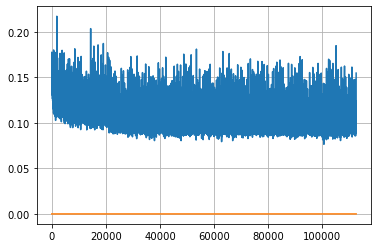

Epoch: 289, iteration 0, loss 0.10163208842277527, cov_diff 0.4252399110828246 cov_diff train 0.4242424490446499
Epoch: 289, iteration 1, loss 0.09977594017982483, cov_diff 0.4140374826728038 cov_diff train 0.41355072524384917
Epoch: 289, iteration 2, loss 0.1137624979019165, cov_diff 0.41986936210498854 cov_diff train 0.4188984745456899
Epoch: 289, iteration 3, loss 0.09998708963394165, cov_diff 0.4153293970036753 cov_diff train 0.41478904156027546
Epoch: 289, iteration 4, loss 0.1010923683643341, cov_diff 0.4185643684256139 cov_diff train 0.41771743298232483
Epoch: 289, iteration 5, loss 0.11172598600387573, cov_diff 0.4169004069881572 cov_diff train 0.41622836532869784
Epoch: 289, iteration 6, loss 0.10115718841552734, cov_diff 0.4115043352805692 cov_diff train 0.4110344476934278
Epoch: 289, iteration 7, loss 0.11336767673492432, cov_diff 0.4340693038069271 cov_diff train 0.43285981337096735
Epoch: 289, iteration 8, loss 0.1064063012599945, cov_diff 0.4069331445044719 cov_diff train

Epoch: 289, iteration 73, loss 0.10466635227203369, cov_diff 0.4069586675915301 cov_diff train 0.40695354412842333
Epoch: 289, iteration 74, loss 0.10304757952690125, cov_diff 0.4067067595269902 cov_diff train 0.4062910038326319
Epoch: 289, iteration 75, loss 0.09697917103767395, cov_diff 0.41593386640970476 cov_diff train 0.41609462379955287
Epoch: 289, iteration 76, loss 0.09595000743865967, cov_diff 0.40644690421861446 cov_diff train 0.40614427213223364
Epoch: 289, iteration 77, loss 0.1008908748626709, cov_diff 0.41752795562735573 cov_diff train 0.4168027944256873
Epoch: 289, iteration 78, loss 0.11180815100669861, cov_diff 0.419781744027899 cov_diff train 0.41960621612462606
Epoch: 289, iteration 79, loss 0.1112605631351471, cov_diff 0.411081434553829 cov_diff train 0.41082184301916086
Epoch: 289, iteration 80, loss 0.10528141260147095, cov_diff 0.4019058657452711 cov_diff train 0.40105421128203766
Epoch: 289, iteration 81, loss 0.11279785633087158, cov_diff 0.4063981837118433 cov

Epoch: 289, iteration 146, loss 0.1022469699382782, cov_diff 0.4065843694872085 cov_diff train 0.40655719698598997
Epoch: 289, iteration 147, loss 0.10525411367416382, cov_diff 0.4175969602095043 cov_diff train 0.41741026510014084
Epoch: 289, iteration 148, loss 0.10365092754364014, cov_diff 0.4110898741435246 cov_diff train 0.4106970479968857
Epoch: 289, iteration 149, loss 0.11676424741744995, cov_diff 0.4189077551248398 cov_diff train 0.41941839402471476
Epoch: 289, iteration 150, loss 0.10547783970832825, cov_diff 0.41067620296682367 cov_diff train 0.4104230717842649
Epoch: 289, iteration 151, loss 0.11069631576538086, cov_diff 0.413841633151597 cov_diff train 0.41346032015275935
Epoch: 289, iteration 152, loss 0.0958217978477478, cov_diff 0.4176396051706005 cov_diff train 0.4170158257728152
Epoch: 289, iteration 153, loss 0.09846886992454529, cov_diff 0.41664223210391405 cov_diff train 0.4160535542040541
Epoch: 289, iteration 154, loss 0.09492045640945435, cov_diff 0.4121749795785

Epoch: 289, iteration 225, loss 0.09707671403884888, cov_diff 0.3963745977275803 cov_diff train 0.39492579876227746
Epoch: 289, iteration 226, loss 0.12029647827148438, cov_diff 0.4034423331899735 cov_diff train 0.4029294800309314
Epoch: 289, iteration 227, loss 0.11842846870422363, cov_diff 0.39610448675130666 cov_diff train 0.3959413593378487
Epoch: 289, iteration 228, loss 0.10502025485038757, cov_diff 0.4128573795455299 cov_diff train 0.41282313283091265
Epoch: 289, iteration 229, loss 0.10262462496757507, cov_diff 0.41386290597049114 cov_diff train 0.4131340913472014
Epoch: 289, iteration 230, loss 0.10303229093551636, cov_diff 0.4108297551033752 cov_diff train 0.41059489296073753
Epoch: 289, iteration 231, loss 0.1016625165939331, cov_diff 0.4011409511397562 cov_diff train 0.40107702048068483
Epoch: 289, iteration 232, loss 0.10195747017860413, cov_diff 0.42664272159931 cov_diff train 0.4254734212462726
Epoch: 289, iteration 233, loss 0.10456788539886475, cov_diff 0.4043299483847

Epoch: 289, iteration 300, loss 0.10325261950492859, cov_diff 0.422793729192155 cov_diff train 0.4217149795187483
Epoch: 289, iteration 301, loss 0.10501924157142639, cov_diff 0.4128910350256127 cov_diff train 0.41244122042142034
Epoch: 289, iteration 302, loss 0.10881567001342773, cov_diff 0.42388304335433297 cov_diff train 0.4223979099145131
Epoch: 289, iteration 303, loss 0.10949036478996277, cov_diff 0.4190276744829065 cov_diff train 0.4184642612006981
Epoch: 289, iteration 304, loss 0.09483742713928223, cov_diff 0.41148099785213615 cov_diff train 0.4095971664110934
Epoch: 289, iteration 305, loss 0.10949018597602844, cov_diff 0.41341850960810056 cov_diff train 0.41235717298643554
Epoch: 289, iteration 306, loss 0.09649136662483215, cov_diff 0.40810025019552104 cov_diff train 0.4078733825767318
Epoch: 289, iteration 307, loss 0.11521291732788086, cov_diff 0.4226752761074368 cov_diff train 0.42178693415773055
Epoch: 289, iteration 308, loss 0.10280090570449829, cov_diff 0.4205422623

Epoch: 289, iteration 375, loss 0.09403875470161438, cov_diff 0.40720871477473464 cov_diff train 0.4068136156016133
Epoch: 289, iteration 376, loss 0.12036120891571045, cov_diff 0.4039546087812849 cov_diff train 0.4032495916436377
Epoch: 289, iteration 377, loss 0.11264258623123169, cov_diff 0.3969869807519162 cov_diff train 0.3964466549877788
Epoch: 289, iteration 378, loss 0.10819926857948303, cov_diff 0.41441432230054875 cov_diff train 0.413333214648325
Epoch: 289, iteration 379, loss 0.0951123833656311, cov_diff 0.4162170044769711 cov_diff train 0.4157001229549146
Epoch: 289, iteration 380, loss 0.09739610552787781, cov_diff 0.4136128023236745 cov_diff train 0.4135018468700781
Epoch: 289, iteration 381, loss 0.09712234139442444, cov_diff 0.4219299373293399 cov_diff train 0.42169999375791833
Epoch: 289, iteration 382, loss 0.10584890842437744, cov_diff 0.42095155813708185 cov_diff train 0.42076921550785173
Epoch: 289, iteration 383, loss 0.10722094774246216, cov_diff 0.4251962851477

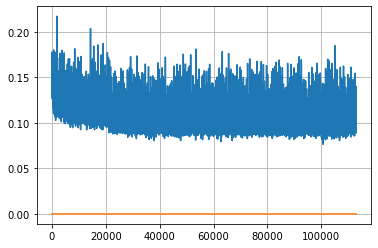

Epoch: 290, iteration 0, loss 0.09476050734519958, cov_diff 0.4030022588341566 cov_diff train 0.4023983211498973
Epoch: 290, iteration 1, loss 0.0948801040649414, cov_diff 0.40739751985293887 cov_diff train 0.4068328457720584
Epoch: 290, iteration 2, loss 0.1060342788696289, cov_diff 0.4128126924494057 cov_diff train 0.4125744008913163
Epoch: 290, iteration 3, loss 0.1016567051410675, cov_diff 0.42216634150806465 cov_diff train 0.4214054376056081
Epoch: 290, iteration 4, loss 0.10414636135101318, cov_diff 0.42213539582802445 cov_diff train 0.4209701494949715
Epoch: 290, iteration 5, loss 0.0977756679058075, cov_diff 0.42653874812425463 cov_diff train 0.4259446778268787
Epoch: 290, iteration 6, loss 0.11366260051727295, cov_diff 0.4159587267769201 cov_diff train 0.41557112755850073
Epoch: 290, iteration 7, loss 0.10162505507469177, cov_diff 0.41150949391645947 cov_diff train 0.4108666740448528
Epoch: 290, iteration 8, loss 0.09506118297576904, cov_diff 0.40497870803464375 cov_diff train

Epoch: 290, iteration 78, loss 0.0971369743347168, cov_diff 0.42414914564300965 cov_diff train 0.4229993474018207
Epoch: 290, iteration 79, loss 0.09449779987335205, cov_diff 0.4087352207650017 cov_diff train 0.4084273211398542
Epoch: 290, iteration 80, loss 0.10389232635498047, cov_diff 0.41188396087017076 cov_diff train 0.4120819527318581
Epoch: 290, iteration 81, loss 0.10560911893844604, cov_diff 0.41041574624986593 cov_diff train 0.40975835546454414
Epoch: 290, iteration 82, loss 0.1099855899810791, cov_diff 0.4170189815858654 cov_diff train 0.4167393731134797
Epoch: 290, iteration 83, loss 0.09497269988059998, cov_diff 0.4161456810506648 cov_diff train 0.415431416543958
Epoch: 290, iteration 84, loss 0.10909518599510193, cov_diff 0.3972090098830543 cov_diff train 0.39575150523152774
Epoch: 290, iteration 85, loss 0.09131985902786255, cov_diff 0.39485305226252926 cov_diff train 0.3952624318618066
Epoch: 290, iteration 86, loss 0.10589122772216797, cov_diff 0.4231676338046783 cov_d

Epoch: 290, iteration 156, loss 0.09820887446403503, cov_diff 0.4076603819684457 cov_diff train 0.4072431488672413
Epoch: 290, iteration 157, loss 0.10082796216011047, cov_diff 0.4156046727897082 cov_diff train 0.4150040383441471
Epoch: 290, iteration 158, loss 0.09766200184822083, cov_diff 0.40908539983917847 cov_diff train 0.40796332699766064
Epoch: 290, iteration 159, loss 0.09956392645835876, cov_diff 0.4134187690217895 cov_diff train 0.41254455492816156
Epoch: 290, iteration 160, loss 0.0901041328907013, cov_diff 0.4031356494074619 cov_diff train 0.4025844308252649
Epoch: 290, iteration 161, loss 0.10145911574363708, cov_diff 0.41411574474026747 cov_diff train 0.41344896651192903
Epoch: 290, iteration 162, loss 0.10009744763374329, cov_diff 0.414000413381649 cov_diff train 0.4127026423195696
Epoch: 290, iteration 163, loss 0.11561140418052673, cov_diff 0.40944670800073735 cov_diff train 0.4088208627822506
Epoch: 290, iteration 164, loss 0.104972243309021, cov_diff 0.41758717194765

Epoch: 290, iteration 228, loss 0.09687572717666626, cov_diff 0.40350163119549654 cov_diff train 0.40294718578883165
Epoch: 290, iteration 229, loss 0.10688179731369019, cov_diff 0.41467340768519895 cov_diff train 0.413707708468022
Epoch: 290, iteration 230, loss 0.09716218709945679, cov_diff 0.4148958085445964 cov_diff train 0.4145215329349824
Epoch: 290, iteration 231, loss 0.09690594673156738, cov_diff 0.41452010076826956 cov_diff train 0.4151812120559965
Epoch: 290, iteration 232, loss 0.09804517030715942, cov_diff 0.4137665201613398 cov_diff train 0.41338827017973856
Epoch: 290, iteration 233, loss 0.10963475704193115, cov_diff 0.4160187074169425 cov_diff train 0.4145431285069132
Epoch: 290, iteration 234, loss 0.09825456142425537, cov_diff 0.4157867874709338 cov_diff train 0.4155052937411935
Epoch: 290, iteration 235, loss 0.10408130288124084, cov_diff 0.3999446159475154 cov_diff train 0.399889436926694
Epoch: 290, iteration 236, loss 0.09734255075454712, cov_diff 0.4191405360230

Epoch: 290, iteration 307, loss 0.10528802871704102, cov_diff 0.40664550120533755 cov_diff train 0.40620584181050645
Epoch: 290, iteration 308, loss 0.10069581866264343, cov_diff 0.40835636047896995 cov_diff train 0.40770484854228456
Epoch: 290, iteration 309, loss 0.08760112524032593, cov_diff 0.4083646759479418 cov_diff train 0.4072277905051814
Epoch: 290, iteration 310, loss 0.10435238480567932, cov_diff 0.40549410359804106 cov_diff train 0.4043449767215394
Epoch: 290, iteration 311, loss 0.1045597493648529, cov_diff 0.41542987041269724 cov_diff train 0.41501575307955174
Epoch: 290, iteration 312, loss 0.10167500376701355, cov_diff 0.4176398067828545 cov_diff train 0.41649533248931103
Epoch: 290, iteration 313, loss 0.11112752556800842, cov_diff 0.4106612676822934 cov_diff train 0.4099207594944363
Epoch: 290, iteration 314, loss 0.09432545304298401, cov_diff 0.4151592778180303 cov_diff train 0.4148025892911667
Epoch: 290, iteration 315, loss 0.08975037932395935, cov_diff 0.402667450

Epoch: 290, iteration 380, loss 0.10639533400535583, cov_diff 0.40890154063483153 cov_diff train 0.4088904003256417
Epoch: 290, iteration 381, loss 0.11735588312149048, cov_diff 0.42043193005327184 cov_diff train 0.41960736366924034
Epoch: 290, iteration 382, loss 0.11038294434547424, cov_diff 0.41989929981535973 cov_diff train 0.41976844847643574
Epoch: 290, iteration 383, loss 0.11003398895263672, cov_diff 0.41943303749821714 cov_diff train 0.41878626735394814
Epoch: 290, iteration 384, loss 0.10911771655082703, cov_diff 0.41486537636065896 cov_diff train 0.414103988853235
Epoch: 290, iteration 385, loss 0.09904304146766663, cov_diff 0.42100966773150533 cov_diff train 0.42039974525377044
Epoch: 290, iteration 386, loss 0.10672619938850403, cov_diff 0.40405967032610535 cov_diff train 0.4030365181389225
Epoch: 290, iteration 387, loss 0.09677115082740784, cov_diff 0.40826629003538706 cov_diff train 0.40707227164645393
Epoch: 290, iteration 388, loss 0.10637784004211426, cov_diff 0.3940

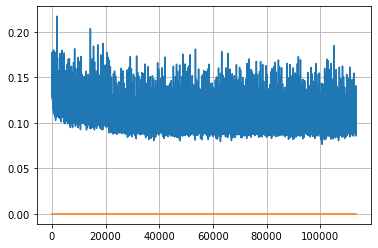

Epoch: 291, iteration 0, loss 0.1024935245513916, cov_diff 0.41329724660715295 cov_diff train 0.4129802232224126
Epoch: 291, iteration 1, loss 0.10487037897109985, cov_diff 0.41273793786462515 cov_diff train 0.41280518532385996
Epoch: 291, iteration 2, loss 0.10111141204833984, cov_diff 0.4170457701846114 cov_diff train 0.4173360807633623
Epoch: 291, iteration 3, loss 0.10185569524765015, cov_diff 0.41980726340933133 cov_diff train 0.41954528035162336
Epoch: 291, iteration 4, loss 0.10915085673332214, cov_diff 0.42754167634392 cov_diff train 0.427045111431033
Epoch: 291, iteration 5, loss 0.11010754108428955, cov_diff 0.4170694395084146 cov_diff train 0.4176945490705472
Epoch: 291, iteration 6, loss 0.09897270798683167, cov_diff 0.4191528686555512 cov_diff train 0.416715091649474
Epoch: 291, iteration 7, loss 0.1058623194694519, cov_diff 0.41091892248539713 cov_diff train 0.4102595824400046
Epoch: 291, iteration 8, loss 0.10027730464935303, cov_diff 0.4076803888629265 cov_diff train 0.

Epoch: 291, iteration 73, loss 0.10465207695960999, cov_diff 0.41315840085091277 cov_diff train 0.4133054031180746
Epoch: 291, iteration 74, loss 0.10438773036003113, cov_diff 0.40799901720446474 cov_diff train 0.4072270403571483
Epoch: 291, iteration 75, loss 0.10196590423583984, cov_diff 0.40928135699085794 cov_diff train 0.4085352436721884
Epoch: 291, iteration 76, loss 0.10216331481933594, cov_diff 0.4271365289582444 cov_diff train 0.42712147886297014
Epoch: 291, iteration 77, loss 0.1019442081451416, cov_diff 0.4082657740444771 cov_diff train 0.4077367297239151
Epoch: 291, iteration 78, loss 0.10099077224731445, cov_diff 0.4058877148050096 cov_diff train 0.4055495667208705
Epoch: 291, iteration 79, loss 0.10381561517715454, cov_diff 0.412420455737964 cov_diff train 0.41195724699380876
Epoch: 291, iteration 80, loss 0.1002386212348938, cov_diff 0.4138083736422466 cov_diff train 0.4139682640407997
Epoch: 291, iteration 81, loss 0.10072079300880432, cov_diff 0.41268490844372846 cov_d

Epoch: 291, iteration 154, loss 0.10920453071594238, cov_diff 0.41926604006693935 cov_diff train 0.417967052133589
Epoch: 291, iteration 155, loss 0.10016950964927673, cov_diff 0.4209070082843898 cov_diff train 0.4198397606462403
Epoch: 291, iteration 156, loss 0.10171809792518616, cov_diff 0.40794971519435314 cov_diff train 0.4071381693034178
Epoch: 291, iteration 157, loss 0.09984040260314941, cov_diff 0.41121885996664387 cov_diff train 0.4082243534888072
Epoch: 291, iteration 158, loss 0.10270237922668457, cov_diff 0.41434197396900985 cov_diff train 0.41350608362765023
Epoch: 291, iteration 159, loss 0.11734020709991455, cov_diff 0.42307614102066077 cov_diff train 0.42141289728357495
Epoch: 291, iteration 160, loss 0.1032027006149292, cov_diff 0.41122374092691544 cov_diff train 0.41044016185457405
Epoch: 291, iteration 161, loss 0.10525277256965637, cov_diff 0.4115715453772423 cov_diff train 0.41071451893486566
Epoch: 291, iteration 162, loss 0.09900674223899841, cov_diff 0.40846549

Epoch: 291, iteration 230, loss 0.09944853186607361, cov_diff 0.42638936331968136 cov_diff train 0.42554821891737005
Epoch: 291, iteration 231, loss 0.09721410274505615, cov_diff 0.4087777292965626 cov_diff train 0.4075411171276979
Epoch: 291, iteration 232, loss 0.10655644536018372, cov_diff 0.41815235574145626 cov_diff train 0.4173879569036897
Epoch: 291, iteration 233, loss 0.10493552684783936, cov_diff 0.41808027059854813 cov_diff train 0.4175082745712364
Epoch: 291, iteration 234, loss 0.103568434715271, cov_diff 0.4122255555371968 cov_diff train 0.4113718794395145
Epoch: 291, iteration 235, loss 0.1094399094581604, cov_diff 0.3980729908133681 cov_diff train 0.39719968946937906
Epoch: 291, iteration 236, loss 0.10579460859298706, cov_diff 0.4033702243820286 cov_diff train 0.40330905865794553
Epoch: 291, iteration 237, loss 0.11618795990943909, cov_diff 0.3963396545383547 cov_diff train 0.39447128895417105
Epoch: 291, iteration 238, loss 0.10309883952140808, cov_diff 0.408036882234

Epoch: 291, iteration 301, loss 0.10214570164680481, cov_diff 0.42860462665113347 cov_diff train 0.4283703302026908
Epoch: 291, iteration 302, loss 0.09681665897369385, cov_diff 0.40414113639788096 cov_diff train 0.4035134042079359
Epoch: 291, iteration 303, loss 0.10241377353668213, cov_diff 0.4129760866270997 cov_diff train 0.41366217829660096
Epoch: 291, iteration 304, loss 0.09623587131500244, cov_diff 0.4144118344863165 cov_diff train 0.414103720372455
Epoch: 291, iteration 305, loss 0.10650697350502014, cov_diff 0.4115847353915513 cov_diff train 0.41064546021405934
Epoch: 291, iteration 306, loss 0.09983500838279724, cov_diff 0.41594115862906705 cov_diff train 0.4144523877032726
Epoch: 291, iteration 307, loss 0.10449790954589844, cov_diff 0.4300735280396967 cov_diff train 0.42809746561395684
Epoch: 291, iteration 308, loss 0.0909651517868042, cov_diff 0.41038552689819124 cov_diff train 0.4096001825252748
Epoch: 291, iteration 309, loss 0.1137843132019043, cov_diff 0.404518952178

Epoch: 291, iteration 372, loss 0.09848320484161377, cov_diff 0.41948363502730723 cov_diff train 0.41939437694708576
Epoch: 291, iteration 373, loss 0.1047728955745697, cov_diff 0.41067536518296743 cov_diff train 0.4096716302601654
Epoch: 291, iteration 374, loss 0.10765767097473145, cov_diff 0.4092334323913804 cov_diff train 0.4077758280959973
Epoch: 291, iteration 375, loss 0.10654452443122864, cov_diff 0.4130586386460001 cov_diff train 0.4121965057534393
Epoch: 291, iteration 376, loss 0.10030141472816467, cov_diff 0.4010204066093529 cov_diff train 0.3999585596179162
Epoch: 291, iteration 377, loss 0.11272105574607849, cov_diff 0.4018550170976895 cov_diff train 0.4011197945282807
Epoch: 291, iteration 378, loss 0.11595353484153748, cov_diff 0.4089287687100757 cov_diff train 0.4078182151612199
Epoch: 291, iteration 379, loss 0.10808560252189636, cov_diff 0.40566253432839916 cov_diff train 0.4050363229926537
Epoch: 291, iteration 380, loss 0.10013291239738464, cov_diff 0.4117001522424

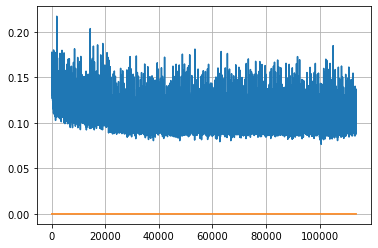

Epoch: 292, iteration 0, loss 0.09373751282691956, cov_diff 0.4062872659827565 cov_diff train 0.40587624330503913
Epoch: 292, iteration 1, loss 0.10929682850837708, cov_diff 0.4068418640368569 cov_diff train 0.40622895042650736
Epoch: 292, iteration 2, loss 0.10583662986755371, cov_diff 0.4223551455455102 cov_diff train 0.4223325188684435
Epoch: 292, iteration 3, loss 0.11363646388053894, cov_diff 0.4107802571025401 cov_diff train 0.4108903321811993
Epoch: 292, iteration 4, loss 0.10135459899902344, cov_diff 0.41524759640911996 cov_diff train 0.41459747960931476
Epoch: 292, iteration 5, loss 0.10192757844924927, cov_diff 0.4086614271114983 cov_diff train 0.40788490160798097
Epoch: 292, iteration 6, loss 0.10474014282226562, cov_diff 0.4190367515368189 cov_diff train 0.4184934125171615
Epoch: 292, iteration 7, loss 0.10117202997207642, cov_diff 0.4050223142024675 cov_diff train 0.40506415508321025
Epoch: 292, iteration 8, loss 0.10658067464828491, cov_diff 0.4207007021696577 cov_diff tr

Epoch: 292, iteration 73, loss 0.10047698020935059, cov_diff 0.40540141526590695 cov_diff train 0.40563382779659474
Epoch: 292, iteration 74, loss 0.10604533553123474, cov_diff 0.4145455107579924 cov_diff train 0.414130887997257
Epoch: 292, iteration 75, loss 0.10845589637756348, cov_diff 0.42377159126578373 cov_diff train 0.42367337709429886
Epoch: 292, iteration 76, loss 0.10017043352127075, cov_diff 0.4189844171413245 cov_diff train 0.4186275201598676
Epoch: 292, iteration 77, loss 0.09863656759262085, cov_diff 0.4115813800760217 cov_diff train 0.41107817048300366
Epoch: 292, iteration 78, loss 0.10274472832679749, cov_diff 0.4099841065101855 cov_diff train 0.410432305599719
Epoch: 292, iteration 79, loss 0.10028818249702454, cov_diff 0.41995946703721376 cov_diff train 0.41893419136681204
Epoch: 292, iteration 80, loss 0.11223900318145752, cov_diff 0.4178184306998174 cov_diff train 0.4164551401538852
Epoch: 292, iteration 81, loss 0.09803971648216248, cov_diff 0.4121709874864747 cov

Epoch: 292, iteration 149, loss 0.09377077221870422, cov_diff 0.4160610958635731 cov_diff train 0.4155516310294993
Epoch: 292, iteration 150, loss 0.11212164163589478, cov_diff 0.42198293236287127 cov_diff train 0.4218266789239364
Epoch: 292, iteration 151, loss 0.1110607385635376, cov_diff 0.4229953847494891 cov_diff train 0.4210538963676348
Epoch: 292, iteration 152, loss 0.10790190100669861, cov_diff 0.413901997734495 cov_diff train 0.4131785175992087
Epoch: 292, iteration 153, loss 0.10260277986526489, cov_diff 0.42558475265076495 cov_diff train 0.4237548418687968
Epoch: 292, iteration 154, loss 0.0983504056930542, cov_diff 0.42403612073043323 cov_diff train 0.4229370196769412
Epoch: 292, iteration 155, loss 0.10439953207969666, cov_diff 0.4126647329449367 cov_diff train 0.4123501624045586
Epoch: 292, iteration 156, loss 0.09988245368003845, cov_diff 0.41028986161368997 cov_diff train 0.4098256832754098
Epoch: 292, iteration 157, loss 0.09106981754302979, cov_diff 0.407235363460811

Epoch: 292, iteration 224, loss 0.10648909211158752, cov_diff 0.41229141670334035 cov_diff train 0.41161014532629037
Epoch: 292, iteration 225, loss 0.10569900274276733, cov_diff 0.4170191159706296 cov_diff train 0.41635837145543536
Epoch: 292, iteration 226, loss 0.1008882224559784, cov_diff 0.4075392281885466 cov_diff train 0.4058728643787385
Epoch: 292, iteration 227, loss 0.1054660975933075, cov_diff 0.42086153440141566 cov_diff train 0.42007290769143957
Epoch: 292, iteration 228, loss 0.11004462838172913, cov_diff 0.4129104194457029 cov_diff train 0.4126555715368419
Epoch: 292, iteration 229, loss 0.10035687685012817, cov_diff 0.4189757683995255 cov_diff train 0.4182006303622131
Epoch: 292, iteration 230, loss 0.1013914942741394, cov_diff 0.41737610700781574 cov_diff train 0.41649535001235916
Epoch: 292, iteration 231, loss 0.09518158435821533, cov_diff 0.41380686061938293 cov_diff train 0.412935507347604
Epoch: 292, iteration 232, loss 0.10436230897903442, cov_diff 0.404662761530

Epoch: 292, iteration 300, loss 0.11840975284576416, cov_diff 0.41857437060966907 cov_diff train 0.41821727601067304
Epoch: 292, iteration 301, loss 0.11026614904403687, cov_diff 0.41203475915462895 cov_diff train 0.4118873920699172
Epoch: 292, iteration 302, loss 0.1075846254825592, cov_diff 0.42191241718944816 cov_diff train 0.4205946122442316
Epoch: 292, iteration 303, loss 0.10956782102584839, cov_diff 0.4172329736973955 cov_diff train 0.4157229596901171
Epoch: 292, iteration 304, loss 0.11226201057434082, cov_diff 0.41575876909518633 cov_diff train 0.4147634082685973
Epoch: 292, iteration 305, loss 0.10578924417495728, cov_diff 0.42736054057299544 cov_diff train 0.4262821082881102
Epoch: 292, iteration 306, loss 0.11021319031715393, cov_diff 0.4125711244122066 cov_diff train 0.4118902570806793
Epoch: 292, iteration 307, loss 0.09947788715362549, cov_diff 0.4060533809320942 cov_diff train 0.4050607657679794
Epoch: 292, iteration 308, loss 0.09414976835250854, cov_diff 0.40649421101

Epoch: 292, iteration 376, loss 0.10558000206947327, cov_diff 0.42183156079844814 cov_diff train 0.4217124596707894
Epoch: 292, iteration 377, loss 0.09103953838348389, cov_diff 0.42265401299957644 cov_diff train 0.4214671993069609
Epoch: 292, iteration 378, loss 0.10400506854057312, cov_diff 0.4153819133275538 cov_diff train 0.41409699046560905
Epoch: 292, iteration 379, loss 0.10754260420799255, cov_diff 0.4093159714898221 cov_diff train 0.4089028619348717
Epoch: 292, iteration 380, loss 0.10176298022270203, cov_diff 0.41417623466642844 cov_diff train 0.4134195830697537
Epoch: 292, iteration 381, loss 0.10381805896759033, cov_diff 0.42112975688300835 cov_diff train 0.4198895429096411
Epoch: 292, iteration 382, loss 0.11212712526321411, cov_diff 0.41619097947212524 cov_diff train 0.41586333249130264
Epoch: 292, iteration 383, loss 0.09734669327735901, cov_diff 0.40802525618595 cov_diff train 0.4074934178988862
Epoch: 292, iteration 384, loss 0.09384125471115112, cov_diff 0.42393040778

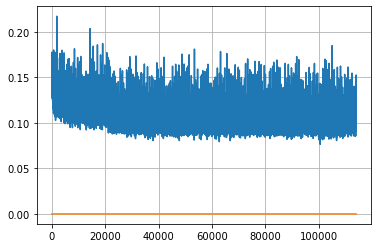

Epoch: 293, iteration 0, loss 0.09019911289215088, cov_diff 0.4103031654158733 cov_diff train 0.40938945473139127
Epoch: 293, iteration 1, loss 0.11668995022773743, cov_diff 0.4110113263266868 cov_diff train 0.41083009080647687
Epoch: 293, iteration 2, loss 0.09665203094482422, cov_diff 0.40904963910031344 cov_diff train 0.40851860045732513
Epoch: 293, iteration 3, loss 0.11063626408576965, cov_diff 0.41340519960417726 cov_diff train 0.412658653009681
Epoch: 293, iteration 4, loss 0.10821348428726196, cov_diff 0.4167794503579284 cov_diff train 0.4161544779098316
Epoch: 293, iteration 5, loss 0.10345146059989929, cov_diff 0.4176126935892998 cov_diff train 0.41702221152237007
Epoch: 293, iteration 6, loss 0.12807780504226685, cov_diff 0.4106860737959359 cov_diff train 0.41008066064213694
Epoch: 293, iteration 7, loss 0.10258504748344421, cov_diff 0.41273960696000805 cov_diff train 0.4129919505149558
Epoch: 293, iteration 8, loss 0.09562993049621582, cov_diff 0.4206050283614182 cov_diff t

Epoch: 293, iteration 75, loss 0.09913867712020874, cov_diff 0.42825278162269004 cov_diff train 0.4276090164186852
Epoch: 293, iteration 76, loss 0.11485254764556885, cov_diff 0.4196448456747141 cov_diff train 0.4189335357407329
Epoch: 293, iteration 77, loss 0.10646271705627441, cov_diff 0.41150071355723106 cov_diff train 0.4104835061281831
Epoch: 293, iteration 78, loss 0.1145237386226654, cov_diff 0.40265949463318146 cov_diff train 0.4007892954577042
Epoch: 293, iteration 79, loss 0.10594436526298523, cov_diff 0.4222329064151514 cov_diff train 0.421121639670048
Epoch: 293, iteration 80, loss 0.1031038761138916, cov_diff 0.4072140682729083 cov_diff train 0.40632944023555323
Epoch: 293, iteration 81, loss 0.09220054745674133, cov_diff 0.4179306208948111 cov_diff train 0.4176356175716484
Epoch: 293, iteration 82, loss 0.09781458973884583, cov_diff 0.4156902992847032 cov_diff train 0.4154350560881869
Epoch: 293, iteration 83, loss 0.09675627946853638, cov_diff 0.413063822221878 cov_diff

Epoch: 293, iteration 153, loss 0.10004985332489014, cov_diff 0.41843523300729973 cov_diff train 0.4177237999027252
Epoch: 293, iteration 154, loss 0.1092907190322876, cov_diff 0.39054781629287155 cov_diff train 0.3894349961711673
Epoch: 293, iteration 155, loss 0.0972934365272522, cov_diff 0.40957180740865273 cov_diff train 0.4081477718102853
Epoch: 293, iteration 156, loss 0.11501401662826538, cov_diff 0.4147733599897553 cov_diff train 0.4143624700476557
Epoch: 293, iteration 157, loss 0.09865352511405945, cov_diff 0.39971476151569585 cov_diff train 0.39933610618461945
Epoch: 293, iteration 158, loss 0.11210989952087402, cov_diff 0.4202960958432105 cov_diff train 0.4196265506030919
Epoch: 293, iteration 159, loss 0.10693347454071045, cov_diff 0.39901873454084624 cov_diff train 0.3976609002655432
Epoch: 293, iteration 160, loss 0.10353344678878784, cov_diff 0.416097120085058 cov_diff train 0.41517939539958515
Epoch: 293, iteration 161, loss 0.10638159513473511, cov_diff 0.409461350057

Epoch: 293, iteration 226, loss 0.0980260968208313, cov_diff 0.4069097433172267 cov_diff train 0.40695647815835456
Epoch: 293, iteration 227, loss 0.11415994167327881, cov_diff 0.41585293376318405 cov_diff train 0.41556519425321864
Epoch: 293, iteration 228, loss 0.10142108798027039, cov_diff 0.4049025385145944 cov_diff train 0.4044226965908251
Epoch: 293, iteration 229, loss 0.0927744209766388, cov_diff 0.41254185948630295 cov_diff train 0.41236303448462686
Epoch: 293, iteration 230, loss 0.10555261373519897, cov_diff 0.41647587709943507 cov_diff train 0.41579512881030667
Epoch: 293, iteration 231, loss 0.09417808055877686, cov_diff 0.4245801480876748 cov_diff train 0.4239513130563026
Epoch: 293, iteration 232, loss 0.10139155387878418, cov_diff 0.4160865595126119 cov_diff train 0.4156499346446624
Epoch: 293, iteration 233, loss 0.11258387565612793, cov_diff 0.41825398471743036 cov_diff train 0.4181116563731674
Epoch: 293, iteration 234, loss 0.11027836799621582, cov_diff 0.4017774699

Epoch: 293, iteration 303, loss 0.1094256043434143, cov_diff 0.41485869331043884 cov_diff train 0.4133890370055902
Epoch: 293, iteration 304, loss 0.10226112604141235, cov_diff 0.4084352359671664 cov_diff train 0.4077763310088686
Epoch: 293, iteration 305, loss 0.11361494660377502, cov_diff 0.41137936336835756 cov_diff train 0.4101967092644711
Epoch: 293, iteration 306, loss 0.12595874071121216, cov_diff 0.41158381637444785 cov_diff train 0.4103174124445658
Epoch: 293, iteration 307, loss 0.09898245334625244, cov_diff 0.4183948489249579 cov_diff train 0.4170955021436885
Epoch: 293, iteration 308, loss 0.10629010200500488, cov_diff 0.4224065518008984 cov_diff train 0.42153051814222786
Epoch: 293, iteration 309, loss 0.10420888662338257, cov_diff 0.4222062872448253 cov_diff train 0.42157504326488787
Epoch: 293, iteration 310, loss 0.10762003064155579, cov_diff 0.41936269679168753 cov_diff train 0.4187753614684529
Epoch: 293, iteration 311, loss 0.10173964500427246, cov_diff 0.40170608331

Epoch: 293, iteration 379, loss 0.09874090552330017, cov_diff 0.4124443827900938 cov_diff train 0.41232246243293796
Epoch: 293, iteration 380, loss 0.10205602645874023, cov_diff 0.41404830717955815 cov_diff train 0.4142109116753011
Epoch: 293, iteration 381, loss 0.10184440016746521, cov_diff 0.4139841805658853 cov_diff train 0.41423917945040933
Epoch: 293, iteration 382, loss 0.08616125583648682, cov_diff 0.40702327788908993 cov_diff train 0.4065390876493425
Epoch: 293, iteration 383, loss 0.09736058115959167, cov_diff 0.4144385899734679 cov_diff train 0.41277675085785526
Epoch: 293, iteration 384, loss 0.09772500395774841, cov_diff 0.41578811954521566 cov_diff train 0.4148183075874293
Epoch: 293, iteration 385, loss 0.11817356944084167, cov_diff 0.41333446044529104 cov_diff train 0.4135146775787309
Epoch: 293, iteration 386, loss 0.10960349440574646, cov_diff 0.42121410381183216 cov_diff train 0.41961979291486073
Epoch: 293, iteration 387, loss 0.11182495951652527, cov_diff 0.4091583

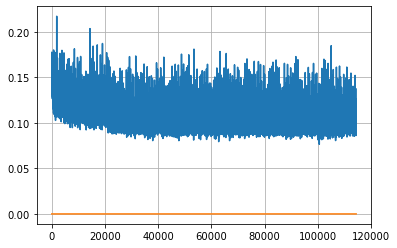

Epoch: 294, iteration 0, loss 0.11516493558883667, cov_diff 0.4053027803646321 cov_diff train 0.4045533354045256
Epoch: 294, iteration 1, loss 0.10197505354881287, cov_diff 0.4115201780535001 cov_diff train 0.41103958517671274
Epoch: 294, iteration 2, loss 0.10043478012084961, cov_diff 0.403470489615541 cov_diff train 0.4027764471395101
Epoch: 294, iteration 3, loss 0.10269761085510254, cov_diff 0.41704503394038556 cov_diff train 0.4169187666145035
Epoch: 294, iteration 4, loss 0.10151776671409607, cov_diff 0.4151060322348024 cov_diff train 0.41437701931172344
Epoch: 294, iteration 5, loss 0.10325103998184204, cov_diff 0.4102093668334978 cov_diff train 0.40950816495371084
Epoch: 294, iteration 6, loss 0.10819754004478455, cov_diff 0.41822240982033715 cov_diff train 0.41749279107969745
Epoch: 294, iteration 7, loss 0.09670284390449524, cov_diff 0.41660037559938295 cov_diff train 0.41584543574778826
Epoch: 294, iteration 8, loss 0.11008793115615845, cov_diff 0.4258163280648882 cov_diff t

Epoch: 294, iteration 79, loss 0.11173546314239502, cov_diff 0.4218798542716414 cov_diff train 0.4212548780955027
Epoch: 294, iteration 80, loss 0.10060206055641174, cov_diff 0.40364836645136015 cov_diff train 0.40370395780358354
Epoch: 294, iteration 81, loss 0.11779406666755676, cov_diff 0.4221911891115368 cov_diff train 0.4222645469525207
Epoch: 294, iteration 82, loss 0.09894660115242004, cov_diff 0.4136886272276242 cov_diff train 0.4132094191112096
Epoch: 294, iteration 83, loss 0.11330839991569519, cov_diff 0.41564882843318224 cov_diff train 0.41453921129614746
Epoch: 294, iteration 84, loss 0.09501913189888, cov_diff 0.40991830650778194 cov_diff train 0.40984839017053265
Epoch: 294, iteration 85, loss 0.10293766856193542, cov_diff 0.4179624724474103 cov_diff train 0.4161210315447861
Epoch: 294, iteration 86, loss 0.09197577834129333, cov_diff 0.41741690221188726 cov_diff train 0.4163649630252337
Epoch: 294, iteration 87, loss 0.09171903133392334, cov_diff 0.40626050916211803 cov

Epoch: 294, iteration 158, loss 0.10300394892692566, cov_diff 0.41006640206789113 cov_diff train 0.4097443450537455
Epoch: 294, iteration 159, loss 0.09683805704116821, cov_diff 0.41756988293494773 cov_diff train 0.41627113656669984
Epoch: 294, iteration 160, loss 0.11003696918487549, cov_diff 0.41479998263834844 cov_diff train 0.4138240721684902
Epoch: 294, iteration 161, loss 0.11070123314857483, cov_diff 0.41898049111629 cov_diff train 0.41790720462000436
Epoch: 294, iteration 162, loss 0.10922732949256897, cov_diff 0.41039093141656 cov_diff train 0.409745987452533
Epoch: 294, iteration 163, loss 0.11199435591697693, cov_diff 0.4149734576146201 cov_diff train 0.413836020487575
Epoch: 294, iteration 164, loss 0.10345658659934998, cov_diff 0.4209842520578134 cov_diff train 0.42074296122835236
Epoch: 294, iteration 165, loss 0.10613644123077393, cov_diff 0.4228018080103116 cov_diff train 0.4223144303143365
Epoch: 294, iteration 166, loss 0.09353527426719666, cov_diff 0.4070299405488247

Epoch: 294, iteration 231, loss 0.09762799739837646, cov_diff 0.4080093377282323 cov_diff train 0.40788318369166027
Epoch: 294, iteration 232, loss 0.09937766194343567, cov_diff 0.410764776923817 cov_diff train 0.4104331914339427
Epoch: 294, iteration 233, loss 0.09741675853729248, cov_diff 0.413925378081887 cov_diff train 0.41344405171812953
Epoch: 294, iteration 234, loss 0.10620832443237305, cov_diff 0.40967332968394354 cov_diff train 0.4089290716963907
Epoch: 294, iteration 235, loss 0.10310080647468567, cov_diff 0.39799010434777565 cov_diff train 0.39722099254079185
Epoch: 294, iteration 236, loss 0.09109041094779968, cov_diff 0.3981701331757279 cov_diff train 0.39805433394890843
Epoch: 294, iteration 237, loss 0.10243535041809082, cov_diff 0.4225212054281271 cov_diff train 0.42137056190855704
Epoch: 294, iteration 238, loss 0.11088326573371887, cov_diff 0.41113728663822396 cov_diff train 0.4098722065522161
Epoch: 294, iteration 239, loss 0.11372074484825134, cov_diff 0.4017631576

Epoch: 294, iteration 307, loss 0.1068156361579895, cov_diff 0.41374985755168536 cov_diff train 0.41279131468428876
Epoch: 294, iteration 308, loss 0.10181364417076111, cov_diff 0.40612752940293473 cov_diff train 0.4049398862380304
Epoch: 294, iteration 309, loss 0.09122774004936218, cov_diff 0.4102545438545462 cov_diff train 0.41046695132701355
Epoch: 294, iteration 310, loss 0.0989106297492981, cov_diff 0.4075765474486459 cov_diff train 0.40792088308258934
Epoch: 294, iteration 311, loss 0.1122998595237732, cov_diff 0.4090728596217815 cov_diff train 0.40869724457691614
Epoch: 294, iteration 312, loss 0.09444651007652283, cov_diff 0.39049386858762014 cov_diff train 0.3907175691543055
Epoch: 294, iteration 313, loss 0.09843602776527405, cov_diff 0.41375365748625875 cov_diff train 0.41389069129083206
Epoch: 294, iteration 314, loss 0.11521685123443604, cov_diff 0.4059153079507005 cov_diff train 0.4050875068497616
Epoch: 294, iteration 315, loss 0.10908308625221252, cov_diff 0.4204781772

Epoch: 294, iteration 379, loss 0.09800651669502258, cov_diff 0.41310268528597177 cov_diff train 0.41257604994768887
Epoch: 294, iteration 380, loss 0.1118030846118927, cov_diff 0.40564948222699687 cov_diff train 0.40509689178699154
Epoch: 294, iteration 381, loss 0.09970411658287048, cov_diff 0.42848012125736074 cov_diff train 0.4281876261070401
Epoch: 294, iteration 382, loss 0.11859869956970215, cov_diff 0.4238404583027155 cov_diff train 0.4226193161105783
Epoch: 294, iteration 383, loss 0.0990181565284729, cov_diff 0.40698003671456817 cov_diff train 0.4064018336554249
Epoch: 294, iteration 384, loss 0.09808054566383362, cov_diff 0.41715474018738696 cov_diff train 0.4165831934257827
Epoch: 294, iteration 385, loss 0.10451194643974304, cov_diff 0.40643666600282713 cov_diff train 0.40662274399941917
Epoch: 294, iteration 386, loss 0.11277177929878235, cov_diff 0.40998546778171224 cov_diff train 0.40904931877802087
Epoch: 294, iteration 387, loss 0.09916660189628601, cov_diff 0.3977107

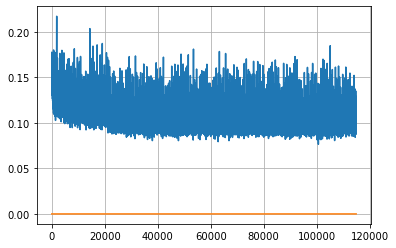

Epoch: 295, iteration 0, loss 0.11041682958602905, cov_diff 0.4137409447586453 cov_diff train 0.4126848611400593
Epoch: 295, iteration 1, loss 0.09265723824501038, cov_diff 0.41731104481769654 cov_diff train 0.41684546333696026
Epoch: 295, iteration 2, loss 0.10141587257385254, cov_diff 0.4201231754227609 cov_diff train 0.4209493420096151
Epoch: 295, iteration 3, loss 0.1049356460571289, cov_diff 0.406525448429343 cov_diff train 0.4063670802858301
Epoch: 295, iteration 4, loss 0.10499963164329529, cov_diff 0.4094041508622185 cov_diff train 0.4091794731079806
Epoch: 295, iteration 5, loss 0.10289382934570312, cov_diff 0.414543935929137 cov_diff train 0.41392711760016426
Epoch: 295, iteration 6, loss 0.116260826587677, cov_diff 0.4093212492418932 cov_diff train 0.409272434199658
Epoch: 295, iteration 7, loss 0.09578374028205872, cov_diff 0.40364680142052306 cov_diff train 0.40351816119774014
Epoch: 295, iteration 8, loss 0.0895698070526123, cov_diff 0.4070217078324732 cov_diff train 0.40

Epoch: 295, iteration 76, loss 0.10445168614387512, cov_diff 0.4195273486531208 cov_diff train 0.41928697956836086
Epoch: 295, iteration 77, loss 0.0997399091720581, cov_diff 0.40994843704188194 cov_diff train 0.40944415879957996
Epoch: 295, iteration 78, loss 0.10926854610443115, cov_diff 0.40938548052536594 cov_diff train 0.4088374310409843
Epoch: 295, iteration 79, loss 0.09822258353233337, cov_diff 0.41231995258433435 cov_diff train 0.41134325985220604
Epoch: 295, iteration 80, loss 0.10784691572189331, cov_diff 0.4236073147194166 cov_diff train 0.4225087030357037
Epoch: 295, iteration 81, loss 0.11204728484153748, cov_diff 0.41593319079574015 cov_diff train 0.41513531770432854
Epoch: 295, iteration 82, loss 0.09765765070915222, cov_diff 0.41324504755966507 cov_diff train 0.4124744994627419
Epoch: 295, iteration 83, loss 0.10099464654922485, cov_diff 0.41849712938751404 cov_diff train 0.4171781659893674
Epoch: 295, iteration 84, loss 0.0977868139743805, cov_diff 0.419282295209015 c

Epoch: 295, iteration 153, loss 0.09852549433708191, cov_diff 0.42423894138401613 cov_diff train 0.4228025720302524
Epoch: 295, iteration 154, loss 0.09592649340629578, cov_diff 0.39995051135437304 cov_diff train 0.39914942858400226
Epoch: 295, iteration 155, loss 0.11281764507293701, cov_diff 0.40761243186086765 cov_diff train 0.40600892317504
Epoch: 295, iteration 156, loss 0.10742148756980896, cov_diff 0.41691779541335744 cov_diff train 0.41660813467739305
Epoch: 295, iteration 157, loss 0.11502298712730408, cov_diff 0.4109764458573654 cov_diff train 0.410268832156405
Epoch: 295, iteration 158, loss 0.09878122806549072, cov_diff 0.40708287053679365 cov_diff train 0.406205588526748
Epoch: 295, iteration 159, loss 0.09781864285469055, cov_diff 0.4186461516002162 cov_diff train 0.41781946523229585
Epoch: 295, iteration 160, loss 0.10785552859306335, cov_diff 0.3996416711253792 cov_diff train 0.39916613961512093
Epoch: 295, iteration 161, loss 0.1141137182712555, cov_diff 0.400540827199

Epoch: 295, iteration 226, loss 0.09835267066955566, cov_diff 0.42411394574835243 cov_diff train 0.42290521672399206
Epoch: 295, iteration 227, loss 0.09945735335350037, cov_diff 0.3951853762949874 cov_diff train 0.394706536739578
Epoch: 295, iteration 228, loss 0.10178768634796143, cov_diff 0.4158074928542031 cov_diff train 0.415260873222664
Epoch: 295, iteration 229, loss 0.09750738739967346, cov_diff 0.40889217086706076 cov_diff train 0.40881165472623743
Epoch: 295, iteration 230, loss 0.10653609037399292, cov_diff 0.4134852360845163 cov_diff train 0.4131073928630294
Epoch: 295, iteration 231, loss 0.10143738985061646, cov_diff 0.4090792406977495 cov_diff train 0.4079147053131051
Epoch: 295, iteration 232, loss 0.10080614686012268, cov_diff 0.41076455961141417 cov_diff train 0.40983352573489773
Epoch: 295, iteration 233, loss 0.10416802763938904, cov_diff 0.4042613296159749 cov_diff train 0.4039517864628232
Epoch: 295, iteration 234, loss 0.09612178802490234, cov_diff 0.418218478305

Epoch: 295, iteration 303, loss 0.11244571208953857, cov_diff 0.4089562498051019 cov_diff train 0.4078608030055502
Epoch: 295, iteration 304, loss 0.10229384899139404, cov_diff 0.4130085997223323 cov_diff train 0.4123336483778395
Epoch: 295, iteration 305, loss 0.09936976432800293, cov_diff 0.4122971592007766 cov_diff train 0.4129326424273312
Epoch: 295, iteration 306, loss 0.0910557210445404, cov_diff 0.4060359728157391 cov_diff train 0.4064463402269568
Epoch: 295, iteration 307, loss 0.10812020301818848, cov_diff 0.4166623046060855 cov_diff train 0.41706460514771093
Epoch: 295, iteration 308, loss 0.09819310903549194, cov_diff 0.4110283927049445 cov_diff train 0.4098430005520243
Epoch: 295, iteration 309, loss 0.10833153128623962, cov_diff 0.4139175820216851 cov_diff train 0.41400264308988066
Epoch: 295, iteration 310, loss 0.11222526431083679, cov_diff 0.40890370566920875 cov_diff train 0.4079503172610047
Epoch: 295, iteration 311, loss 0.1006406843662262, cov_diff 0.414573210293725

Epoch: 295, iteration 381, loss 0.0976780354976654, cov_diff 0.41366845782587547 cov_diff train 0.41303985659238024
Epoch: 295, iteration 382, loss 0.11626061797142029, cov_diff 0.4235135067759057 cov_diff train 0.4229270584489126
Epoch: 295, iteration 383, loss 0.09679529070854187, cov_diff 0.4182562285917089 cov_diff train 0.4172709799626629
Epoch: 295, iteration 384, loss 0.10479092597961426, cov_diff 0.41993299879061724 cov_diff train 0.41922982191233854
Epoch: 295, iteration 385, loss 0.10087281465530396, cov_diff 0.4125036350167821 cov_diff train 0.4109563774195092
Epoch: 295, iteration 386, loss 0.1070375144481659, cov_diff 0.41119840604513835 cov_diff train 0.41044631353739025
Epoch: 295, iteration 387, loss 0.10553467273712158, cov_diff 0.41067829924543425 cov_diff train 0.40887803594266803
Epoch: 295, iteration 388, loss 0.09373214840888977, cov_diff 0.43834382186697807 cov_diff train 0.43708596442996284
Epoch: 295, iteration 389, loss 0.11523938179016113, cov_diff 0.41820460

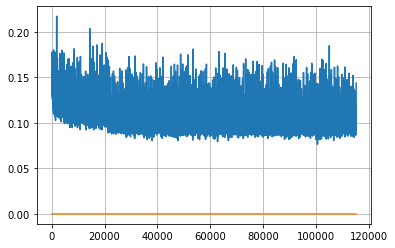

Epoch: 296, iteration 0, loss 0.10617953538894653, cov_diff 0.4109159182813396 cov_diff train 0.4099932633129725
Epoch: 296, iteration 1, loss 0.10343202948570251, cov_diff 0.40909397079283677 cov_diff train 0.40889665882620285
Epoch: 296, iteration 2, loss 0.11160844564437866, cov_diff 0.4133047857772974 cov_diff train 0.4130262912662364
Epoch: 296, iteration 3, loss 0.0966842770576477, cov_diff 0.40395399731408266 cov_diff train 0.4036067548582084
Epoch: 296, iteration 4, loss 0.10332494974136353, cov_diff 0.40185871086810826 cov_diff train 0.40171946210499915
Epoch: 296, iteration 5, loss 0.10258829593658447, cov_diff 0.41256635912253536 cov_diff train 0.4123980105064105
Epoch: 296, iteration 6, loss 0.11240622401237488, cov_diff 0.4082742194249425 cov_diff train 0.40830657219866406
Epoch: 296, iteration 7, loss 0.0990132987499237, cov_diff 0.4170678792090218 cov_diff train 0.41619692776306133
Epoch: 296, iteration 8, loss 0.10603329539299011, cov_diff 0.39585862945858563 cov_diff t

Epoch: 296, iteration 80, loss 0.10473635792732239, cov_diff 0.3926064414241123 cov_diff train 0.3919916151366877
Epoch: 296, iteration 81, loss 0.10966047644615173, cov_diff 0.4203401694629389 cov_diff train 0.4201441184071418
Epoch: 296, iteration 82, loss 0.10895499587059021, cov_diff 0.42146373818288785 cov_diff train 0.4211582813011736
Epoch: 296, iteration 83, loss 0.10745066404342651, cov_diff 0.3974054704843432 cov_diff train 0.39677833546165414
Epoch: 296, iteration 84, loss 0.10966861248016357, cov_diff 0.4129901416025933 cov_diff train 0.41263510992439906
Epoch: 296, iteration 85, loss 0.10102510452270508, cov_diff 0.41097592201737904 cov_diff train 0.4112162835610085
Epoch: 296, iteration 86, loss 0.11083528399467468, cov_diff 0.41110231694612703 cov_diff train 0.4107317755384214
Epoch: 296, iteration 87, loss 0.10553514957427979, cov_diff 0.40191111569291477 cov_diff train 0.40097073800259064
Epoch: 296, iteration 88, loss 0.11606651544570923, cov_diff 0.3964416907250017 c

Epoch: 296, iteration 151, loss 0.09788483381271362, cov_diff 0.4184675028238918 cov_diff train 0.4182223977068473
Epoch: 296, iteration 152, loss 0.1006612479686737, cov_diff 0.40230423502007195 cov_diff train 0.4020945128675654
Epoch: 296, iteration 153, loss 0.10343533754348755, cov_diff 0.40063140758616117 cov_diff train 0.3995909821903843
Epoch: 296, iteration 154, loss 0.10691243410110474, cov_diff 0.4286254724997606 cov_diff train 0.4279981464233605
Epoch: 296, iteration 155, loss 0.09970062971115112, cov_diff 0.4112881000554849 cov_diff train 0.4113985974239181
Epoch: 296, iteration 156, loss 0.10373267531394958, cov_diff 0.4132171537375119 cov_diff train 0.41306369160269424
Epoch: 296, iteration 157, loss 0.09443399310112, cov_diff 0.4004572720366439 cov_diff train 0.40009514976430005
Epoch: 296, iteration 158, loss 0.09331172704696655, cov_diff 0.3971159733216398 cov_diff train 0.3967141303037836
Epoch: 296, iteration 159, loss 0.11296021938323975, cov_diff 0.4120017627481215

Epoch: 296, iteration 229, loss 0.10259532928466797, cov_diff 0.40981392056150934 cov_diff train 0.40897887640541475
Epoch: 296, iteration 230, loss 0.0982603132724762, cov_diff 0.41663527018864877 cov_diff train 0.41582889564724884
Epoch: 296, iteration 231, loss 0.10220527648925781, cov_diff 0.41835656123959797 cov_diff train 0.41768198530034994
Epoch: 296, iteration 232, loss 0.0994965136051178, cov_diff 0.41003636108770697 cov_diff train 0.40882568998025803
Epoch: 296, iteration 233, loss 0.11328950524330139, cov_diff 0.39565614741837474 cov_diff train 0.39533426920374315
Epoch: 296, iteration 234, loss 0.09938275814056396, cov_diff 0.40233545362938783 cov_diff train 0.4023374332741816
Epoch: 296, iteration 235, loss 0.10556948184967041, cov_diff 0.41260269151338497 cov_diff train 0.41192182777499925
Epoch: 296, iteration 236, loss 0.1004975438117981, cov_diff 0.4157140414903675 cov_diff train 0.4149141121297313
Epoch: 296, iteration 237, loss 0.09207656979560852, cov_diff 0.413417

Epoch: 296, iteration 307, loss 0.10109198093414307, cov_diff 0.41591921310035274 cov_diff train 0.4140503624396667
Epoch: 296, iteration 308, loss 0.09395381808280945, cov_diff 0.39969106914356406 cov_diff train 0.3986767643708027
Epoch: 296, iteration 309, loss 0.0953376293182373, cov_diff 0.4076260303661727 cov_diff train 0.40712370533170744
Epoch: 296, iteration 310, loss 0.09789767861366272, cov_diff 0.3996723803480257 cov_diff train 0.3995262008086176
Epoch: 296, iteration 311, loss 0.1119178831577301, cov_diff 0.4129350182981108 cov_diff train 0.41198974837587177
Epoch: 296, iteration 312, loss 0.10316744446754456, cov_diff 0.4175130273836841 cov_diff train 0.4162483337744967
Epoch: 296, iteration 313, loss 0.09044551849365234, cov_diff 0.410695607994985 cov_diff train 0.4096424957231124
Epoch: 296, iteration 314, loss 0.10906508564949036, cov_diff 0.4147929696121609 cov_diff train 0.4145140571617488
Epoch: 296, iteration 315, loss 0.09520581364631653, cov_diff 0.409066696416670

Epoch: 296, iteration 384, loss 0.110755056142807, cov_diff 0.4116532581671872 cov_diff train 0.41134958837890184
Epoch: 296, iteration 385, loss 0.10365107655525208, cov_diff 0.42161355610782525 cov_diff train 0.4218536326444602
Epoch: 296, iteration 386, loss 0.0961301326751709, cov_diff 0.4167142352045107 cov_diff train 0.4159620051573932
Epoch: 296, iteration 387, loss 0.09307175874710083, cov_diff 0.41222662281016714 cov_diff train 0.4118644795850598
Epoch: 296, iteration 388, loss 0.10567915439605713, cov_diff 0.4300659653386037 cov_diff train 0.42965264933157643
Epoch: 296, iteration 389, loss 0.10253149271011353, cov_diff 0.4181896820477287 cov_diff train 0.4173412907097756
Epoch: 296, iteration 390, loss 0.14276519417762756, cov_diff 0.45053036858562157 cov_diff train 0.4500737140645302


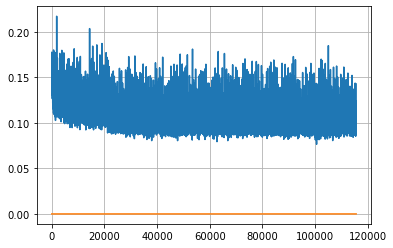

Epoch: 297, iteration 0, loss 0.10283124446868896, cov_diff 0.41238668864748457 cov_diff train 0.412027580462028
Epoch: 297, iteration 1, loss 0.0890437662601471, cov_diff 0.4082745628302769 cov_diff train 0.40807451271246326
Epoch: 297, iteration 2, loss 0.09124791622161865, cov_diff 0.4204896250934893 cov_diff train 0.420088336669193
Epoch: 297, iteration 3, loss 0.12202861905097961, cov_diff 0.43144836266543773 cov_diff train 0.4306924382374186
Epoch: 297, iteration 4, loss 0.10908719897270203, cov_diff 0.4168861089938531 cov_diff train 0.4157907823105461
Epoch: 297, iteration 5, loss 0.09630951285362244, cov_diff 0.41475464897674 cov_diff train 0.4142885610811466
Epoch: 297, iteration 6, loss 0.10443758964538574, cov_diff 0.4223393560534287 cov_diff train 0.4213312471363775
Epoch: 297, iteration 7, loss 0.10624036192893982, cov_diff 0.43260387252932464 cov_diff train 0.431648141629296
Epoch: 297, iteration 8, loss 0.10470744967460632, cov_diff 0.41467727884399047 cov_diff train 0.4

Epoch: 297, iteration 78, loss 0.10259827971458435, cov_diff 0.42545845094761314 cov_diff train 0.4244694909665687
Epoch: 297, iteration 79, loss 0.10999250411987305, cov_diff 0.42262811341885903 cov_diff train 0.421895602661503
Epoch: 297, iteration 80, loss 0.09788542985916138, cov_diff 0.41403854817472335 cov_diff train 0.41341109793432257
Epoch: 297, iteration 81, loss 0.10924345254898071, cov_diff 0.42559924876698285 cov_diff train 0.42460532617583435
Epoch: 297, iteration 82, loss 0.10262057185173035, cov_diff 0.42986933658697124 cov_diff train 0.4288375771617378
Epoch: 297, iteration 83, loss 0.11194318532943726, cov_diff 0.42166618556117236 cov_diff train 0.42090406202379876
Epoch: 297, iteration 84, loss 0.10081860423088074, cov_diff 0.4290058408732337 cov_diff train 0.42811609846771775
Epoch: 297, iteration 85, loss 0.11122000217437744, cov_diff 0.40604921430157254 cov_diff train 0.4062909667619097
Epoch: 297, iteration 86, loss 0.10980290174484253, cov_diff 0.415351755216027

Epoch: 297, iteration 153, loss 0.10434943437576294, cov_diff 0.40866632582609286 cov_diff train 0.4085859639877958
Epoch: 297, iteration 154, loss 0.09322923421859741, cov_diff 0.40812938119041337 cov_diff train 0.40802086531209303
Epoch: 297, iteration 155, loss 0.10309118032455444, cov_diff 0.40312898837724326 cov_diff train 0.4031694106537665
Epoch: 297, iteration 156, loss 0.095578134059906, cov_diff 0.4095098923325239 cov_diff train 0.4093616689682787
Epoch: 297, iteration 157, loss 0.09943714737892151, cov_diff 0.41941073163207665 cov_diff train 0.4185210065253883
Epoch: 297, iteration 158, loss 0.0977848470211029, cov_diff 0.41292400637441024 cov_diff train 0.412858098639377
Epoch: 297, iteration 159, loss 0.10074350237846375, cov_diff 0.4107558442650389 cov_diff train 0.40931768408494185
Epoch: 297, iteration 160, loss 0.10220706462860107, cov_diff 0.4186512109590322 cov_diff train 0.41858565322206587
Epoch: 297, iteration 161, loss 0.09993088245391846, cov_diff 0.408610715561

Epoch: 297, iteration 226, loss 0.11220461130142212, cov_diff 0.4095970844568292 cov_diff train 0.40950048236662445
Epoch: 297, iteration 227, loss 0.10410746932029724, cov_diff 0.41945836344849924 cov_diff train 0.4185217656547349
Epoch: 297, iteration 228, loss 0.0928315818309784, cov_diff 0.4077624517080905 cov_diff train 0.4071830570915547
Epoch: 297, iteration 229, loss 0.10420697927474976, cov_diff 0.40560111178358066 cov_diff train 0.40453273727421274
Epoch: 297, iteration 230, loss 0.0995379388332367, cov_diff 0.39883465862263495 cov_diff train 0.39834209599273485
Epoch: 297, iteration 231, loss 0.09803417325019836, cov_diff 0.4283664659643183 cov_diff train 0.4268846512343416
Epoch: 297, iteration 232, loss 0.09552076458930969, cov_diff 0.42773226212904886 cov_diff train 0.4264819556160931
Epoch: 297, iteration 233, loss 0.10039180517196655, cov_diff 0.4027809070465715 cov_diff train 0.40212710155488207
Epoch: 297, iteration 234, loss 0.09520596265792847, cov_diff 0.4071539077

Epoch: 297, iteration 303, loss 0.11211919784545898, cov_diff 0.39120210853996623 cov_diff train 0.3907254615908832
Epoch: 297, iteration 304, loss 0.10414639115333557, cov_diff 0.39941691633558946 cov_diff train 0.39904960081738294
Epoch: 297, iteration 305, loss 0.10824167728424072, cov_diff 0.4004165610528981 cov_diff train 0.3999040126910354
Epoch: 297, iteration 306, loss 0.10122212767601013, cov_diff 0.4169238761356739 cov_diff train 0.4142451356157555
Epoch: 297, iteration 307, loss 0.099607914686203, cov_diff 0.41063589867988964 cov_diff train 0.4094861257184517
Epoch: 297, iteration 308, loss 0.10404685139656067, cov_diff 0.42099159596212393 cov_diff train 0.4201825289062112
Epoch: 297, iteration 309, loss 0.11248120665550232, cov_diff 0.4173372698543813 cov_diff train 0.4165132503267228
Epoch: 297, iteration 310, loss 0.11207336187362671, cov_diff 0.43817700335484294 cov_diff train 0.43717686395501437
Epoch: 297, iteration 311, loss 0.11293253302574158, cov_diff 0.41261167219

Epoch: 297, iteration 380, loss 0.11521518230438232, cov_diff 0.4065875870172648 cov_diff train 0.4065129798118361
Epoch: 297, iteration 381, loss 0.09975016117095947, cov_diff 0.3984932634047349 cov_diff train 0.39712820690182954
Epoch: 297, iteration 382, loss 0.10338163375854492, cov_diff 0.4108282092352638 cov_diff train 0.40936076974013613
Epoch: 297, iteration 383, loss 0.10041120648384094, cov_diff 0.4012163637202667 cov_diff train 0.4002373004511404
Epoch: 297, iteration 384, loss 0.10644605755805969, cov_diff 0.3909716586792694 cov_diff train 0.3906588665940589
Epoch: 297, iteration 385, loss 0.09365907311439514, cov_diff 0.4024967450461057 cov_diff train 0.40140361922751505
Epoch: 297, iteration 386, loss 0.09666913747787476, cov_diff 0.4187440455680635 cov_diff train 0.4179137503814605
Epoch: 297, iteration 387, loss 0.10069143772125244, cov_diff 0.41709419990447677 cov_diff train 0.41623875270799887
Epoch: 297, iteration 388, loss 0.1064000129699707, cov_diff 0.400624325324

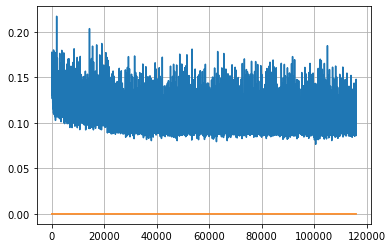

Epoch: 298, iteration 0, loss 0.10472568869590759, cov_diff 0.40637017718351465 cov_diff train 0.40652881538789004
Epoch: 298, iteration 1, loss 0.09980344772338867, cov_diff 0.4212452879526763 cov_diff train 0.4206107407065007
Epoch: 298, iteration 2, loss 0.10637122392654419, cov_diff 0.40952639193255896 cov_diff train 0.40851536298269797
Epoch: 298, iteration 3, loss 0.10318663716316223, cov_diff 0.4164249733170928 cov_diff train 0.4161462259182529
Epoch: 298, iteration 4, loss 0.10613510012626648, cov_diff 0.41524569714793363 cov_diff train 0.4149377272153436
Epoch: 298, iteration 5, loss 0.09448778629302979, cov_diff 0.400372266764105 cov_diff train 0.40020956686273984
Epoch: 298, iteration 6, loss 0.09650951623916626, cov_diff 0.4086736258942927 cov_diff train 0.40878979126402065
Epoch: 298, iteration 7, loss 0.09721845388412476, cov_diff 0.4068643220531489 cov_diff train 0.40595043056121943
Epoch: 298, iteration 8, loss 0.1118360161781311, cov_diff 0.41948416349131884 cov_diff t

Epoch: 298, iteration 80, loss 0.10300934314727783, cov_diff 0.4238728177347259 cov_diff train 0.4226448289227618
Epoch: 298, iteration 81, loss 0.09952279925346375, cov_diff 0.41641573765702744 cov_diff train 0.41406553401578616
Epoch: 298, iteration 82, loss 0.1159108579158783, cov_diff 0.41688203579014 cov_diff train 0.4157098291674986
Epoch: 298, iteration 83, loss 0.11864137649536133, cov_diff 0.4226617428011519 cov_diff train 0.4218090076117851
Epoch: 298, iteration 84, loss 0.11205592751502991, cov_diff 0.4120597791214706 cov_diff train 0.4112288910310707
Epoch: 298, iteration 85, loss 0.1016034483909607, cov_diff 0.40878178921744984 cov_diff train 0.4080895100930163
Epoch: 298, iteration 86, loss 0.10555914044380188, cov_diff 0.42373436466036274 cov_diff train 0.4226584149076212
Epoch: 298, iteration 87, loss 0.10674932599067688, cov_diff 0.406298623071562 cov_diff train 0.4058153170246492
Epoch: 298, iteration 88, loss 0.1162484884262085, cov_diff 0.41617693827987773 cov_diff 

Epoch: 298, iteration 155, loss 0.10554209351539612, cov_diff 0.42225956204785503 cov_diff train 0.4207540897511883
Epoch: 298, iteration 156, loss 0.10398444533348083, cov_diff 0.4084448323405314 cov_diff train 0.4090895448370695
Epoch: 298, iteration 157, loss 0.0813700258731842, cov_diff 0.3995691769064673 cov_diff train 0.3993792476643993
Epoch: 298, iteration 158, loss 0.09891340136528015, cov_diff 0.4123895899380097 cov_diff train 0.41228910118943046
Epoch: 298, iteration 159, loss 0.10333806276321411, cov_diff 0.41755927234684087 cov_diff train 0.417037870430671
Epoch: 298, iteration 160, loss 0.11437949538230896, cov_diff 0.41617766891071784 cov_diff train 0.41508468284943456
Epoch: 298, iteration 161, loss 0.09862169623374939, cov_diff 0.40854133477340804 cov_diff train 0.40626837093163576
Epoch: 298, iteration 162, loss 0.10164383053779602, cov_diff 0.4045812200850913 cov_diff train 0.40441051022495744
Epoch: 298, iteration 163, loss 0.10665270686149597, cov_diff 0.4084715326

Epoch: 298, iteration 226, loss 0.10367897152900696, cov_diff 0.39781835127168136 cov_diff train 0.3974004598856057
Epoch: 298, iteration 227, loss 0.09889677166938782, cov_diff 0.4055731809348667 cov_diff train 0.4048593431659574
Epoch: 298, iteration 228, loss 0.11776775121688843, cov_diff 0.41979227354959187 cov_diff train 0.4175649929063862
Epoch: 298, iteration 229, loss 0.10261884331703186, cov_diff 0.4021812524925905 cov_diff train 0.40236323512252853
Epoch: 298, iteration 230, loss 0.10872095823287964, cov_diff 0.41713614911274005 cov_diff train 0.4174753979906288
Epoch: 298, iteration 231, loss 0.1094571053981781, cov_diff 0.41446039792919465 cov_diff train 0.41317667369183725
Epoch: 298, iteration 232, loss 0.10287997126579285, cov_diff 0.4081569714840378 cov_diff train 0.4091103354185638
Epoch: 298, iteration 233, loss 0.10145622491836548, cov_diff 0.4035148152051517 cov_diff train 0.4034588473630333
Epoch: 298, iteration 234, loss 0.11065256595611572, cov_diff 0.42047216348

Epoch: 298, iteration 302, loss 0.10396724939346313, cov_diff 0.40442069862115015 cov_diff train 0.4020254581742423
Epoch: 298, iteration 303, loss 0.10713085532188416, cov_diff 0.4022756697462275 cov_diff train 0.40168719270064795
Epoch: 298, iteration 304, loss 0.09096688032150269, cov_diff 0.4066584813898282 cov_diff train 0.40587430353840614
Epoch: 298, iteration 305, loss 0.10806453227996826, cov_diff 0.398993752812192 cov_diff train 0.3985990057269283
Epoch: 298, iteration 306, loss 0.10106673836708069, cov_diff 0.40827157859284274 cov_diff train 0.40802286365850493
Epoch: 298, iteration 307, loss 0.10326185822486877, cov_diff 0.3967173610314609 cov_diff train 0.39604663473143303
Epoch: 298, iteration 308, loss 0.10627925395965576, cov_diff 0.3994289805097249 cov_diff train 0.39925534412886976
Epoch: 298, iteration 309, loss 0.0976424515247345, cov_diff 0.42302086751216583 cov_diff train 0.42224307099860897
Epoch: 298, iteration 310, loss 0.10960888862609863, cov_diff 0.412461370

Epoch: 298, iteration 377, loss 0.11351719498634338, cov_diff 0.4042734175815442 cov_diff train 0.404097310369473
Epoch: 298, iteration 378, loss 0.10812592506408691, cov_diff 0.41359213223481417 cov_diff train 0.41257872492931014
Epoch: 298, iteration 379, loss 0.1044626235961914, cov_diff 0.3974863799799708 cov_diff train 0.3972593629485053
Epoch: 298, iteration 380, loss 0.09577524662017822, cov_diff 0.3999335601799248 cov_diff train 0.3990597823453874
Epoch: 298, iteration 381, loss 0.10623884201049805, cov_diff 0.4078403082375845 cov_diff train 0.4068036266808668
Epoch: 298, iteration 382, loss 0.09794998168945312, cov_diff 0.41632710687835595 cov_diff train 0.4158806443996873
Epoch: 298, iteration 383, loss 0.09886500239372253, cov_diff 0.4135718309121498 cov_diff train 0.41312043531904175
Epoch: 298, iteration 384, loss 0.09301173686981201, cov_diff 0.41394825455646644 cov_diff train 0.41381558764278636
Epoch: 298, iteration 385, loss 0.09634855389595032, cov_diff 0.408582161720

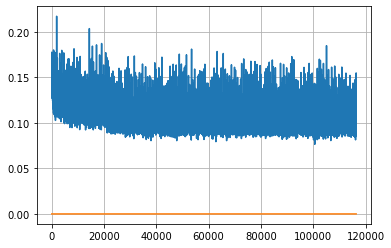

Epoch: 299, iteration 0, loss 0.09791818261146545, cov_diff 0.4023425480095252 cov_diff train 0.4026872180135514
Epoch: 299, iteration 1, loss 0.09963363409042358, cov_diff 0.4070542598031547 cov_diff train 0.406452062501919
Epoch: 299, iteration 2, loss 0.10409021377563477, cov_diff 0.40412047934434525 cov_diff train 0.4037667163254427
Epoch: 299, iteration 3, loss 0.10284590721130371, cov_diff 0.4136723634359906 cov_diff train 0.41280435566163026
Epoch: 299, iteration 4, loss 0.1050366461277008, cov_diff 0.41653509446116177 cov_diff train 0.4157431033542351
Epoch: 299, iteration 5, loss 0.10239467024803162, cov_diff 0.4043706939947665 cov_diff train 0.4035776078071132
Epoch: 299, iteration 6, loss 0.09914574027061462, cov_diff 0.40683375455339343 cov_diff train 0.40740211048860314
Epoch: 299, iteration 7, loss 0.10912439227104187, cov_diff 0.41941609443587136 cov_diff train 0.418206227762015
Epoch: 299, iteration 8, loss 0.09519091248512268, cov_diff 0.41752616183168545 cov_diff trai

Epoch: 299, iteration 82, loss 0.09607642889022827, cov_diff 0.4122409334812815 cov_diff train 0.4123249821258714
Epoch: 299, iteration 83, loss 0.10588926076889038, cov_diff 0.41293154238093965 cov_diff train 0.4121720842129804
Epoch: 299, iteration 84, loss 0.12319102883338928, cov_diff 0.4270923049010796 cov_diff train 0.42613609306404465
Epoch: 299, iteration 85, loss 0.09872457385063171, cov_diff 0.40874777009688573 cov_diff train 0.4088940275272567
Epoch: 299, iteration 86, loss 0.08834585547447205, cov_diff 0.4109728943200286 cov_diff train 0.41084916383715925
Epoch: 299, iteration 87, loss 0.10109460353851318, cov_diff 0.4199817597728099 cov_diff train 0.41888791920880203
Epoch: 299, iteration 88, loss 0.10465419292449951, cov_diff 0.4110282135537055 cov_diff train 0.41034943826916054
Epoch: 299, iteration 89, loss 0.10393631458282471, cov_diff 0.40857767153838376 cov_diff train 0.4089847015048004
Epoch: 299, iteration 90, loss 0.10723304748535156, cov_diff 0.4163535342799905 c

Epoch: 299, iteration 157, loss 0.10057106614112854, cov_diff 0.4210235060537378 cov_diff train 0.41996124396964596
Epoch: 299, iteration 158, loss 0.09893670678138733, cov_diff 0.40995221244258423 cov_diff train 0.40945483838358143
Epoch: 299, iteration 159, loss 0.11190477013587952, cov_diff 0.4147234120575304 cov_diff train 0.414217382433117
Epoch: 299, iteration 160, loss 0.10020318627357483, cov_diff 0.4126926106692439 cov_diff train 0.41139116843750845
Epoch: 299, iteration 161, loss 0.08878836035728455, cov_diff 0.41375148900147524 cov_diff train 0.4134189016852073
Epoch: 299, iteration 162, loss 0.09732121229171753, cov_diff 0.40856930268023156 cov_diff train 0.40842037386239566
Epoch: 299, iteration 163, loss 0.1062273383140564, cov_diff 0.4226794607109672 cov_diff train 0.4219057938398838
Epoch: 299, iteration 164, loss 0.09832936525344849, cov_diff 0.41676307835732385 cov_diff train 0.41656728435896434
Epoch: 299, iteration 165, loss 0.09476390480995178, cov_diff 0.405523318

Epoch: 299, iteration 236, loss 0.11080703139305115, cov_diff 0.3927140718858524 cov_diff train 0.3911031596042621
Epoch: 299, iteration 237, loss 0.10080540180206299, cov_diff 0.4275911590472386 cov_diff train 0.42708926773659467
Epoch: 299, iteration 238, loss 0.09454876184463501, cov_diff 0.4254200783102528 cov_diff train 0.4239546931399341
Epoch: 299, iteration 239, loss 0.10777172446250916, cov_diff 0.41379642889966883 cov_diff train 0.41269713508200245
Epoch: 299, iteration 240, loss 0.1020544171333313, cov_diff 0.41309790330548973 cov_diff train 0.4126118583969974
Epoch: 299, iteration 241, loss 0.10597223043441772, cov_diff 0.41272880447517785 cov_diff train 0.41190689239586614
Epoch: 299, iteration 242, loss 0.1273832619190216, cov_diff 0.3976441756362408 cov_diff train 0.39757900976991944
Epoch: 299, iteration 243, loss 0.11264652013778687, cov_diff 0.4132652708256977 cov_diff train 0.4137644733057619
Epoch: 299, iteration 244, loss 0.10457584261894226, cov_diff 0.42606061363

Epoch: 299, iteration 312, loss 0.09963738918304443, cov_diff 0.41373434932855857 cov_diff train 0.41306687989596425
Epoch: 299, iteration 313, loss 0.09548848867416382, cov_diff 0.40090884075356054 cov_diff train 0.40087573064235454
Epoch: 299, iteration 314, loss 0.09483605623245239, cov_diff 0.409148370076343 cov_diff train 0.4099236860865599
Epoch: 299, iteration 315, loss 0.10112226009368896, cov_diff 0.41717092318982546 cov_diff train 0.4164184226992125
Epoch: 299, iteration 316, loss 0.09601062536239624, cov_diff 0.4093773133398576 cov_diff train 0.4090317629424515
Epoch: 299, iteration 317, loss 0.09477415680885315, cov_diff 0.4029317280265328 cov_diff train 0.4022869674103551
Epoch: 299, iteration 318, loss 0.10541599988937378, cov_diff 0.40637859249325275 cov_diff train 0.4065989803256009
Epoch: 299, iteration 319, loss 0.10696360468864441, cov_diff 0.41920677115555827 cov_diff train 0.41817886271687565
Epoch: 299, iteration 320, loss 0.11068758368492126, cov_diff 0.408910259

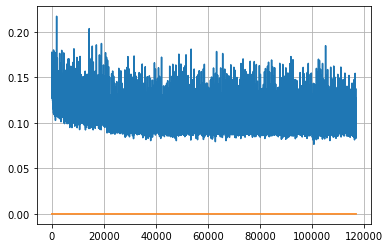

Epoch: 300, iteration 0, loss 0.09921199083328247, cov_diff 0.4056319162412072 cov_diff train 0.4060364328974672
Epoch: 300, iteration 1, loss 0.10040503740310669, cov_diff 0.41141457226186884 cov_diff train 0.4110894645782116
Epoch: 300, iteration 2, loss 0.1134510338306427, cov_diff 0.4114343840635365 cov_diff train 0.4107083615874913
Epoch: 300, iteration 3, loss 0.09663751721382141, cov_diff 0.40269479540516867 cov_diff train 0.40102413628219485
Epoch: 300, iteration 4, loss 0.09750384092330933, cov_diff 0.41019701795886954 cov_diff train 0.40909003594344445
Epoch: 300, iteration 5, loss 0.10811930894851685, cov_diff 0.41270933533503534 cov_diff train 0.4118283096529843
Epoch: 300, iteration 6, loss 0.12564638257026672, cov_diff 0.41601329057549985 cov_diff train 0.4152932942918848
Epoch: 300, iteration 7, loss 0.09874668717384338, cov_diff 0.4074752981694792 cov_diff train 0.4064530621711554
Epoch: 300, iteration 8, loss 0.09448191523551941, cov_diff 0.40519890218583693 cov_diff t

Epoch: 300, iteration 76, loss 0.09825858473777771, cov_diff 0.40310738771719745 cov_diff train 0.4026027029374925
Epoch: 300, iteration 77, loss 0.10977858304977417, cov_diff 0.40105693544701143 cov_diff train 0.40101369728506275
Epoch: 300, iteration 78, loss 0.10885542631149292, cov_diff 0.40861173581971655 cov_diff train 0.40782240060905117
Epoch: 300, iteration 79, loss 0.0999077558517456, cov_diff 0.4086856484923605 cov_diff train 0.40709034019081547
Epoch: 300, iteration 80, loss 0.09769433736801147, cov_diff 0.4127367819981639 cov_diff train 0.4125211219158796
Epoch: 300, iteration 81, loss 0.105486661195755, cov_diff 0.4150838763021056 cov_diff train 0.41432423809816776
Epoch: 300, iteration 82, loss 0.09961432218551636, cov_diff 0.4094412014370472 cov_diff train 0.4088457169299756
Epoch: 300, iteration 83, loss 0.1082046627998352, cov_diff 0.4173045057168368 cov_diff train 0.4168352660368461
Epoch: 300, iteration 84, loss 0.10191500186920166, cov_diff 0.40394643591339496 cov_

Epoch: 300, iteration 149, loss 0.11227834224700928, cov_diff 0.4094351749437723 cov_diff train 0.4089053438306593
Epoch: 300, iteration 150, loss 0.09455063939094543, cov_diff 0.4069356836003029 cov_diff train 0.4055115326873641
Epoch: 300, iteration 151, loss 0.09667107462882996, cov_diff 0.41902627749361504 cov_diff train 0.4190974749779267
Epoch: 300, iteration 152, loss 0.10084792971611023, cov_diff 0.40867303400204824 cov_diff train 0.4074191088844402
Epoch: 300, iteration 153, loss 0.11196747422218323, cov_diff 0.42446869600669845 cov_diff train 0.42359238077592326
Epoch: 300, iteration 154, loss 0.09992831945419312, cov_diff 0.4131694824499836 cov_diff train 0.4121534029949406
Epoch: 300, iteration 155, loss 0.09955045580863953, cov_diff 0.405242577048179 cov_diff train 0.403887955328141
Epoch: 300, iteration 156, loss 0.10854065418243408, cov_diff 0.39954856541913025 cov_diff train 0.3988938070112538
Epoch: 300, iteration 157, loss 0.09698116779327393, cov_diff 0.4091453432677

Epoch: 300, iteration 224, loss 0.11354756355285645, cov_diff 0.4126832339449312 cov_diff train 0.41226283783462564
Epoch: 300, iteration 225, loss 0.10574829578399658, cov_diff 0.4139108124883319 cov_diff train 0.41363215717905166
Epoch: 300, iteration 226, loss 0.097667396068573, cov_diff 0.40725905109775223 cov_diff train 0.40651795955994885
Epoch: 300, iteration 227, loss 0.09665656089782715, cov_diff 0.4218404841477053 cov_diff train 0.42104685251118457
Epoch: 300, iteration 228, loss 0.11180788278579712, cov_diff 0.4091240352191494 cov_diff train 0.40846797387261874
Epoch: 300, iteration 229, loss 0.09777924418449402, cov_diff 0.4011738007963117 cov_diff train 0.40020361494957674
Epoch: 300, iteration 230, loss 0.10660415887832642, cov_diff 0.4118236264120749 cov_diff train 0.4111305418302387
Epoch: 300, iteration 231, loss 0.09924215078353882, cov_diff 0.41217456227424004 cov_diff train 0.41177873075524685
Epoch: 300, iteration 232, loss 0.10193920135498047, cov_diff 0.411463688

Epoch: 300, iteration 300, loss 0.10589292645454407, cov_diff 0.41215774920642756 cov_diff train 0.4116250457689126
Epoch: 300, iteration 301, loss 0.11080443859100342, cov_diff 0.41100271959187445 cov_diff train 0.41002829733834023
Epoch: 300, iteration 302, loss 0.11379304528236389, cov_diff 0.4216142618279067 cov_diff train 0.4203068993607726
Epoch: 300, iteration 303, loss 0.1025877594947815, cov_diff 0.413773833754677 cov_diff train 0.41186099922422803
Epoch: 300, iteration 304, loss 0.11379349231719971, cov_diff 0.42202510703798624 cov_diff train 0.4210677026834444
Epoch: 300, iteration 305, loss 0.09088319540023804, cov_diff 0.3983159303765805 cov_diff train 0.3982917650062623
Epoch: 300, iteration 306, loss 0.10100516676902771, cov_diff 0.42405581955840377 cov_diff train 0.42274077514237435
Epoch: 300, iteration 307, loss 0.11085441708564758, cov_diff 0.41320975522956105 cov_diff train 0.41205765433962926
Epoch: 300, iteration 308, loss 0.09506821632385254, cov_diff 0.424770348

Epoch: 300, iteration 378, loss 0.10951954126358032, cov_diff 0.41203865877344886 cov_diff train 0.4117229306662441
Epoch: 300, iteration 379, loss 0.11491149663925171, cov_diff 0.4095590359952734 cov_diff train 0.4091098825525555
Epoch: 300, iteration 380, loss 0.10976970195770264, cov_diff 0.41617697810228105 cov_diff train 0.41569191696782953
Epoch: 300, iteration 381, loss 0.09843048453330994, cov_diff 0.42290787781689576 cov_diff train 0.42163250041428224
Epoch: 300, iteration 382, loss 0.10506078600883484, cov_diff 0.4158412512951264 cov_diff train 0.41528273256446824
Epoch: 300, iteration 383, loss 0.1009502112865448, cov_diff 0.4142047737957861 cov_diff train 0.4126327944497253
Epoch: 300, iteration 384, loss 0.10538908839225769, cov_diff 0.40138302485716787 cov_diff train 0.40120866885861106
Epoch: 300, iteration 385, loss 0.10807642340660095, cov_diff 0.418315490641174 cov_diff train 0.41770086321944244
Epoch: 300, iteration 386, loss 0.10460379719734192, cov_diff 0.425266819

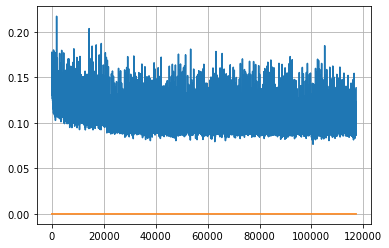

Epoch: 301, iteration 0, loss 0.0940738320350647, cov_diff 0.40754229541604997 cov_diff train 0.40743250311413043
Epoch: 301, iteration 1, loss 0.09077104926109314, cov_diff 0.41095262908793734 cov_diff train 0.410563698046356
Epoch: 301, iteration 2, loss 0.10188600420951843, cov_diff 0.4091442374332749 cov_diff train 0.4079853605590668
Epoch: 301, iteration 3, loss 0.10369062423706055, cov_diff 0.4156711467585094 cov_diff train 0.4158496043590976
Epoch: 301, iteration 4, loss 0.10711324214935303, cov_diff 0.4187086208205468 cov_diff train 0.4184956633913676
Epoch: 301, iteration 5, loss 0.10671457648277283, cov_diff 0.4140294277711254 cov_diff train 0.4145867875489711
Epoch: 301, iteration 6, loss 0.10545367002487183, cov_diff 0.4019199196001619 cov_diff train 0.4019267756645904
Epoch: 301, iteration 7, loss 0.11177784204483032, cov_diff 0.41450436965920223 cov_diff train 0.41307592083790035
Epoch: 301, iteration 8, loss 0.09537449479103088, cov_diff 0.4236000100423218 cov_diff train

Epoch: 301, iteration 79, loss 0.11272996664047241, cov_diff 0.4227605046537675 cov_diff train 0.422027552931874
Epoch: 301, iteration 80, loss 0.09830015897750854, cov_diff 0.3951369416976918 cov_diff train 0.39432597271815806
Epoch: 301, iteration 81, loss 0.11297866702079773, cov_diff 0.4189473396147086 cov_diff train 0.41817011831363754
Epoch: 301, iteration 82, loss 0.1150723397731781, cov_diff 0.4180505470368682 cov_diff train 0.41616338039276424
Epoch: 301, iteration 83, loss 0.1004774272441864, cov_diff 0.4110822945905219 cov_diff train 0.4100491423881159
Epoch: 301, iteration 84, loss 0.099223792552948, cov_diff 0.415420754173643 cov_diff train 0.41471156506297563
Epoch: 301, iteration 85, loss 0.10350048542022705, cov_diff 0.4066292208442665 cov_diff train 0.4065095244400652
Epoch: 301, iteration 86, loss 0.10265430808067322, cov_diff 0.4149434153875779 cov_diff train 0.4149600599147892
Epoch: 301, iteration 87, loss 0.10023728013038635, cov_diff 0.4118242974552021 cov_diff t

Epoch: 301, iteration 154, loss 0.11050170660018921, cov_diff 0.4112928361642738 cov_diff train 0.4112234899445999
Epoch: 301, iteration 155, loss 0.10141876339912415, cov_diff 0.41300939283021326 cov_diff train 0.41221513638769547
Epoch: 301, iteration 156, loss 0.10578936338424683, cov_diff 0.42467214931085856 cov_diff train 0.42469409712495754
Epoch: 301, iteration 157, loss 0.10626381635665894, cov_diff 0.414571364906452 cov_diff train 0.4143343394360436
Epoch: 301, iteration 158, loss 0.10112681984901428, cov_diff 0.4213860884295432 cov_diff train 0.42007440725025585
Epoch: 301, iteration 159, loss 0.09593364596366882, cov_diff 0.4035696247000156 cov_diff train 0.40328539028730626
Epoch: 301, iteration 160, loss 0.10089322924613953, cov_diff 0.4119092002664211 cov_diff train 0.41169804047898795
Epoch: 301, iteration 161, loss 0.11185985803604126, cov_diff 0.40511210293634875 cov_diff train 0.4053439738982431
Epoch: 301, iteration 162, loss 0.08871981501579285, cov_diff 0.415980405

Epoch: 301, iteration 226, loss 0.10834833979606628, cov_diff 0.4095658752745395 cov_diff train 0.40931494911473243
Epoch: 301, iteration 227, loss 0.09721437096595764, cov_diff 0.4063381911511947 cov_diff train 0.40575514004891045
Epoch: 301, iteration 228, loss 0.11706584692001343, cov_diff 0.4103281155608775 cov_diff train 0.4097975687731906
Epoch: 301, iteration 229, loss 0.10161203145980835, cov_diff 0.4245559064825838 cov_diff train 0.424433172151691
Epoch: 301, iteration 230, loss 0.10038203001022339, cov_diff 0.417146851043725 cov_diff train 0.4170788929537231
Epoch: 301, iteration 231, loss 0.10492721199989319, cov_diff 0.4179331061018667 cov_diff train 0.41682787672977156
Epoch: 301, iteration 232, loss 0.10539540648460388, cov_diff 0.40759757875822566 cov_diff train 0.4067896555907185
Epoch: 301, iteration 233, loss 0.0911213755607605, cov_diff 0.4047404143440992 cov_diff train 0.4044974183083054
Epoch: 301, iteration 234, loss 0.0937328040599823, cov_diff 0.4143746306625229

Epoch: 301, iteration 297, loss 0.1075069010257721, cov_diff 0.4142465385288402 cov_diff train 0.413843096069961
Epoch: 301, iteration 298, loss 0.10609626770019531, cov_diff 0.4200217752282811 cov_diff train 0.4187287899782476
Epoch: 301, iteration 299, loss 0.10518339276313782, cov_diff 0.41072347687861566 cov_diff train 0.40977427452488974
Epoch: 301, iteration 300, loss 0.10536462068557739, cov_diff 0.40755782516122196 cov_diff train 0.40626048471631526
Epoch: 301, iteration 301, loss 0.09974491596221924, cov_diff 0.4144324453099007 cov_diff train 0.4139443650342771
Epoch: 301, iteration 302, loss 0.11559605598449707, cov_diff 0.4218834468961691 cov_diff train 0.42074587006094655
Epoch: 301, iteration 303, loss 0.10380369424819946, cov_diff 0.40567035848913774 cov_diff train 0.4052591115785331
Epoch: 301, iteration 304, loss 0.09887707233428955, cov_diff 0.40502269120171763 cov_diff train 0.40417627588658306
Epoch: 301, iteration 305, loss 0.10044246912002563, cov_diff 0.4149097017

Epoch: 301, iteration 370, loss 0.10669919848442078, cov_diff 0.40651551587105583 cov_diff train 0.40547090277000974
Epoch: 301, iteration 371, loss 0.0992979109287262, cov_diff 0.39806152374965287 cov_diff train 0.39808587091190695
Epoch: 301, iteration 372, loss 0.09571674466133118, cov_diff 0.41107942341331594 cov_diff train 0.40995430726550935
Epoch: 301, iteration 373, loss 0.09173566102981567, cov_diff 0.41135828853987794 cov_diff train 0.4103284989279502
Epoch: 301, iteration 374, loss 0.10651561617851257, cov_diff 0.4170569508439309 cov_diff train 0.41647872540421305
Epoch: 301, iteration 375, loss 0.10047650337219238, cov_diff 0.4010710939781956 cov_diff train 0.40070183344958443
Epoch: 301, iteration 376, loss 0.1140928566455841, cov_diff 0.4199033096305804 cov_diff train 0.42009177747827336
Epoch: 301, iteration 377, loss 0.10882937908172607, cov_diff 0.39943985381589187 cov_diff train 0.3989045853910723
Epoch: 301, iteration 378, loss 0.11344459652900696, cov_diff 0.3999443

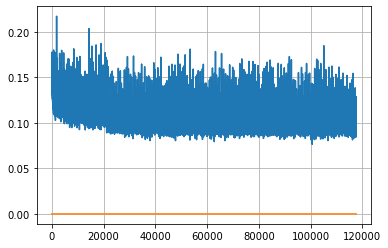

Epoch: 302, iteration 0, loss 0.10677266120910645, cov_diff 0.40672216983940696 cov_diff train 0.40590905222756557
Epoch: 302, iteration 1, loss 0.09741723537445068, cov_diff 0.4068801963570503 cov_diff train 0.4059671647334583
Epoch: 302, iteration 2, loss 0.10257208347320557, cov_diff 0.40429808319318933 cov_diff train 0.4040350914101195
Epoch: 302, iteration 3, loss 0.10957801342010498, cov_diff 0.4269720601526008 cov_diff train 0.4264768254641004
Epoch: 302, iteration 4, loss 0.0939079225063324, cov_diff 0.3944793960891181 cov_diff train 0.39413122569251574
Epoch: 302, iteration 5, loss 0.10702109336853027, cov_diff 0.4171455214151497 cov_diff train 0.4164871851726149
Epoch: 302, iteration 6, loss 0.11021137237548828, cov_diff 0.4065769069373892 cov_diff train 0.40495981888710514
Epoch: 302, iteration 7, loss 0.10989472270011902, cov_diff 0.4096728358370651 cov_diff train 0.4086025216856323
Epoch: 302, iteration 8, loss 0.1031370460987091, cov_diff 0.40965622458260986 cov_diff trai

Epoch: 302, iteration 79, loss 0.09948059916496277, cov_diff 0.4262145826812998 cov_diff train 0.42536948279789516
Epoch: 302, iteration 80, loss 0.0964488685131073, cov_diff 0.4019991131756667 cov_diff train 0.3997181669158473
Epoch: 302, iteration 81, loss 0.09817451238632202, cov_diff 0.4043530540216522 cov_diff train 0.40377426718615217
Epoch: 302, iteration 82, loss 0.10070562362670898, cov_diff 0.4108621999305367 cov_diff train 0.4102183061282973
Epoch: 302, iteration 83, loss 0.10602980852127075, cov_diff 0.41169834815080725 cov_diff train 0.41140352848818773
Epoch: 302, iteration 84, loss 0.13266992568969727, cov_diff 0.41737801138275077 cov_diff train 0.41670291411326155
Epoch: 302, iteration 85, loss 0.10272768139839172, cov_diff 0.4216633704077551 cov_diff train 0.42164649774508495
Epoch: 302, iteration 86, loss 0.11116209626197815, cov_diff 0.4129356993242374 cov_diff train 0.4124516531182918
Epoch: 302, iteration 87, loss 0.10086438059806824, cov_diff 0.4052858698694615 co

Epoch: 302, iteration 156, loss 0.10371211171150208, cov_diff 0.4060235147092507 cov_diff train 0.40486173292779964
Epoch: 302, iteration 157, loss 0.09645140171051025, cov_diff 0.4105266532467617 cov_diff train 0.41091529256124526
Epoch: 302, iteration 158, loss 0.10230395197868347, cov_diff 0.4045285014649066 cov_diff train 0.403977497592431
Epoch: 302, iteration 159, loss 0.1009955108165741, cov_diff 0.41958412626369873 cov_diff train 0.41963030940591056
Epoch: 302, iteration 160, loss 0.10214006900787354, cov_diff 0.4085649360068116 cov_diff train 0.4078706226702747
Epoch: 302, iteration 161, loss 0.10153639316558838, cov_diff 0.39374503980453296 cov_diff train 0.3936304214668436
Epoch: 302, iteration 162, loss 0.09983596205711365, cov_diff 0.4075835081867715 cov_diff train 0.4074585006058754
Epoch: 302, iteration 163, loss 0.10613974928855896, cov_diff 0.40859970471833923 cov_diff train 0.408151225550928
Epoch: 302, iteration 164, loss 0.11125433444976807, cov_diff 0.4197164944820

Epoch: 302, iteration 229, loss 0.10446628928184509, cov_diff 0.41622432240483237 cov_diff train 0.4169148218262912
Epoch: 302, iteration 230, loss 0.10865536332130432, cov_diff 0.4113697095871876 cov_diff train 0.41133039742221855
Epoch: 302, iteration 231, loss 0.09407389163970947, cov_diff 0.40651700262649393 cov_diff train 0.40568500434212634
Epoch: 302, iteration 232, loss 0.10428586602210999, cov_diff 0.4082858161895106 cov_diff train 0.4082188304474515
Epoch: 302, iteration 233, loss 0.09540244936943054, cov_diff 0.39744793736692363 cov_diff train 0.39612809419223666
Epoch: 302, iteration 234, loss 0.1053878664970398, cov_diff 0.4030151139883837 cov_diff train 0.4028220535527286
Epoch: 302, iteration 235, loss 0.10879349708557129, cov_diff 0.4048243265943494 cov_diff train 0.40383294229535033
Epoch: 302, iteration 236, loss 0.09831663966178894, cov_diff 0.4069261285470342 cov_diff train 0.4057286537457189
Epoch: 302, iteration 237, loss 0.11234405636787415, cov_diff 0.4059002658

Epoch: 302, iteration 303, loss 0.10246476531028748, cov_diff 0.40602901433919464 cov_diff train 0.4053770395380835
Epoch: 302, iteration 304, loss 0.09862571954727173, cov_diff 0.4135334857754141 cov_diff train 0.4136418769246283
Epoch: 302, iteration 305, loss 0.11259624361991882, cov_diff 0.4181859709543083 cov_diff train 0.417115467714636
Epoch: 302, iteration 306, loss 0.08776387572288513, cov_diff 0.4121661041343541 cov_diff train 0.41169902140956943
Epoch: 302, iteration 307, loss 0.09929192066192627, cov_diff 0.4089953820368104 cov_diff train 0.4083935443765219
Epoch: 302, iteration 308, loss 0.11323550343513489, cov_diff 0.41535319440046026 cov_diff train 0.41528589828950785
Epoch: 302, iteration 309, loss 0.09694841504096985, cov_diff 0.40956278270407326 cov_diff train 0.40888904793144576
Epoch: 302, iteration 310, loss 0.0968988835811615, cov_diff 0.406833434151403 cov_diff train 0.4071752845604144
Epoch: 302, iteration 311, loss 0.11225283145904541, cov_diff 0.4028536761039

Epoch: 302, iteration 376, loss 0.1016799807548523, cov_diff 0.42006969031209684 cov_diff train 0.4204967289005863
Epoch: 302, iteration 377, loss 0.10159477591514587, cov_diff 0.40023791064832026 cov_diff train 0.3999748415122936
Epoch: 302, iteration 378, loss 0.09712982177734375, cov_diff 0.4103444057023577 cov_diff train 0.41049714602784215
Epoch: 302, iteration 379, loss 0.09854346513748169, cov_diff 0.40403152375240875 cov_diff train 0.40335604414307963
Epoch: 302, iteration 380, loss 0.1155746579170227, cov_diff 0.41664784509193 cov_diff train 0.4171819263617251
Epoch: 302, iteration 381, loss 0.09134882688522339, cov_diff 0.4329225692889732 cov_diff train 0.43300822341737166
Epoch: 302, iteration 382, loss 0.10049092769622803, cov_diff 0.4196076871242616 cov_diff train 0.4190363537340631
Epoch: 302, iteration 383, loss 0.10108286142349243, cov_diff 0.42263728889915664 cov_diff train 0.42261616356377657
Epoch: 302, iteration 384, loss 0.09639546275138855, cov_diff 0.419884249416

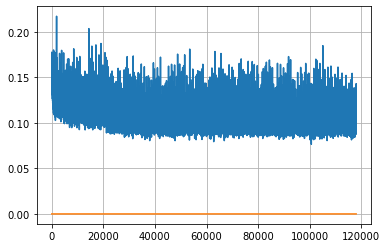

Epoch: 303, iteration 0, loss 0.1011878252029419, cov_diff 0.41619291354235016 cov_diff train 0.4150202077767977
Epoch: 303, iteration 1, loss 0.10167092084884644, cov_diff 0.41083318357691984 cov_diff train 0.41010347965548344
Epoch: 303, iteration 2, loss 0.10333213210105896, cov_diff 0.42156183411720843 cov_diff train 0.4203755850943088
Epoch: 303, iteration 3, loss 0.10335946083068848, cov_diff 0.4175904267098763 cov_diff train 0.4161388639720312
Epoch: 303, iteration 4, loss 0.10329025983810425, cov_diff 0.4202378321272795 cov_diff train 0.41819106815327023
Epoch: 303, iteration 5, loss 0.10684207081794739, cov_diff 0.4192139165688929 cov_diff train 0.41775274159653497
Epoch: 303, iteration 6, loss 0.09521991014480591, cov_diff 0.41147816539982396 cov_diff train 0.41057624423959654
Epoch: 303, iteration 7, loss 0.10083648562431335, cov_diff 0.40475704154631204 cov_diff train 0.4035578330133055
Epoch: 303, iteration 8, loss 0.09061962366104126, cov_diff 0.40667854331554426 cov_diff

Epoch: 303, iteration 80, loss 0.10798120498657227, cov_diff 0.41047653122509054 cov_diff train 0.40926715944555514
Epoch: 303, iteration 81, loss 0.09814256429672241, cov_diff 0.40189787689390155 cov_diff train 0.4019935321647384
Epoch: 303, iteration 82, loss 0.09727033972740173, cov_diff 0.41035790760997404 cov_diff train 0.4101762314032162
Epoch: 303, iteration 83, loss 0.10374009609222412, cov_diff 0.41736183406584954 cov_diff train 0.41717957647264214
Epoch: 303, iteration 84, loss 0.11210322380065918, cov_diff 0.40497491954695375 cov_diff train 0.4047388327131058
Epoch: 303, iteration 85, loss 0.09639376401901245, cov_diff 0.4137140580748108 cov_diff train 0.41339479905970133
Epoch: 303, iteration 86, loss 0.09842827916145325, cov_diff 0.3991442830987325 cov_diff train 0.39985195654633027
Epoch: 303, iteration 87, loss 0.1147577166557312, cov_diff 0.412404344274553 cov_diff train 0.41223227781444244
Epoch: 303, iteration 88, loss 0.09602406620979309, cov_diff 0.4268374568674853 

Epoch: 303, iteration 159, loss 0.11753377318382263, cov_diff 0.40001557192148557 cov_diff train 0.39951456752406367
Epoch: 303, iteration 160, loss 0.10623371601104736, cov_diff 0.41404957420387234 cov_diff train 0.4125168744191718
Epoch: 303, iteration 161, loss 0.10441237688064575, cov_diff 0.4066213281854689 cov_diff train 0.4065043191894959
Epoch: 303, iteration 162, loss 0.10117098689079285, cov_diff 0.42348240177269203 cov_diff train 0.4224493716447849
Epoch: 303, iteration 163, loss 0.10566046833992004, cov_diff 0.4003909224885385 cov_diff train 0.3996618324838746
Epoch: 303, iteration 164, loss 0.10123652219772339, cov_diff 0.4113324898031725 cov_diff train 0.41134993559532645
Epoch: 303, iteration 165, loss 0.10134714841842651, cov_diff 0.4046154059579515 cov_diff train 0.40412659735848133
Epoch: 303, iteration 166, loss 0.10193037986755371, cov_diff 0.3921718240681051 cov_diff train 0.3922335849895627
Epoch: 303, iteration 167, loss 0.10732519626617432, cov_diff 0.4178752289

Epoch: 303, iteration 237, loss 0.09502831101417542, cov_diff 0.40959049122349706 cov_diff train 0.40881521184094743
Epoch: 303, iteration 238, loss 0.09827539324760437, cov_diff 0.3954205355832734 cov_diff train 0.394589361136713
Epoch: 303, iteration 239, loss 0.09674146771430969, cov_diff 0.41568024102077905 cov_diff train 0.4144771088100323
Epoch: 303, iteration 240, loss 0.09133842587471008, cov_diff 0.4052777907612464 cov_diff train 0.4046190803269136
Epoch: 303, iteration 241, loss 0.12018859386444092, cov_diff 0.40838871888106176 cov_diff train 0.40853808677440173
Epoch: 303, iteration 242, loss 0.10149678587913513, cov_diff 0.4071250272466914 cov_diff train 0.4064710171582801
Epoch: 303, iteration 243, loss 0.11401224136352539, cov_diff 0.41865551344354446 cov_diff train 0.41894516731265363
Epoch: 303, iteration 244, loss 0.09985873103141785, cov_diff 0.41056507849307594 cov_diff train 0.4102395506140043
Epoch: 303, iteration 245, loss 0.11109435558319092, cov_diff 0.410537101

Epoch: 303, iteration 311, loss 0.10319653153419495, cov_diff 0.42416976499606923 cov_diff train 0.42303545218270666
Epoch: 303, iteration 312, loss 0.09745204448699951, cov_diff 0.4174744413387988 cov_diff train 0.41657482906549803
Epoch: 303, iteration 313, loss 0.10034793615341187, cov_diff 0.41564885334547663 cov_diff train 0.41509431786353856
Epoch: 303, iteration 314, loss 0.10808420181274414, cov_diff 0.41400850512889686 cov_diff train 0.4139684966090222
Epoch: 303, iteration 315, loss 0.10226508975028992, cov_diff 0.41612767573324627 cov_diff train 0.4155590225814901
Epoch: 303, iteration 316, loss 0.09403926134109497, cov_diff 0.4155737310754938 cov_diff train 0.4148092850030286
Epoch: 303, iteration 317, loss 0.1051764190196991, cov_diff 0.41872242825754347 cov_diff train 0.41731998098766143
Epoch: 303, iteration 318, loss 0.10411757230758667, cov_diff 0.4204581595328087 cov_diff train 0.4202412352837154
Epoch: 303, iteration 319, loss 0.10843363404273987, cov_diff 0.41872901

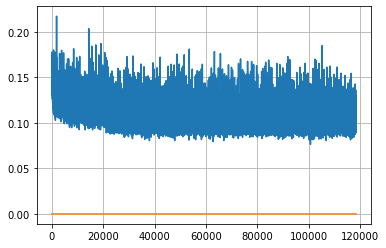

Epoch: 304, iteration 0, loss 0.10007813572883606, cov_diff 0.41257671127433865 cov_diff train 0.41124231370943065
Epoch: 304, iteration 1, loss 0.11145466566085815, cov_diff 0.4190143316944221 cov_diff train 0.41866964535367096
Epoch: 304, iteration 2, loss 0.09957724809646606, cov_diff 0.40863115484569684 cov_diff train 0.40762521597894597
Epoch: 304, iteration 3, loss 0.09443473815917969, cov_diff 0.4043181580852693 cov_diff train 0.403951053120271
Epoch: 304, iteration 4, loss 0.10729193687438965, cov_diff 0.412094580674007 cov_diff train 0.41141930212808164
Epoch: 304, iteration 5, loss 0.1205911636352539, cov_diff 0.4080702714906218 cov_diff train 0.40730548954991663
Epoch: 304, iteration 6, loss 0.09999340772628784, cov_diff 0.4194742195316152 cov_diff train 0.41952513026344784
Epoch: 304, iteration 7, loss 0.09990468621253967, cov_diff 0.41819226848441604 cov_diff train 0.41714408687450366
Epoch: 304, iteration 8, loss 0.11717912554740906, cov_diff 0.40483156447229135 cov_diff 

Epoch: 304, iteration 77, loss 0.09900370240211487, cov_diff 0.4101009126103302 cov_diff train 0.4089929921246115
Epoch: 304, iteration 78, loss 0.10975882411003113, cov_diff 0.4102861973060081 cov_diff train 0.4099420743988256
Epoch: 304, iteration 79, loss 0.10489851236343384, cov_diff 0.4189610357949619 cov_diff train 0.41843764242537484
Epoch: 304, iteration 80, loss 0.09655782580375671, cov_diff 0.41011938532757874 cov_diff train 0.40898282501353345
Epoch: 304, iteration 81, loss 0.09728321433067322, cov_diff 0.41649697494567595 cov_diff train 0.4157441357698271
Epoch: 304, iteration 82, loss 0.0999918282032013, cov_diff 0.40940678113485257 cov_diff train 0.4087040546561624
Epoch: 304, iteration 83, loss 0.09991565346717834, cov_diff 0.41191479591313296 cov_diff train 0.4105820133969368
Epoch: 304, iteration 84, loss 0.11508038640022278, cov_diff 0.4162837225949508 cov_diff train 0.4159055398918861
Epoch: 304, iteration 85, loss 0.1168072521686554, cov_diff 0.41241751401160975 cov

Epoch: 304, iteration 155, loss 0.10356283187866211, cov_diff 0.4046965183452151 cov_diff train 0.40442895073516455
Epoch: 304, iteration 156, loss 0.11751866340637207, cov_diff 0.39684265723028067 cov_diff train 0.39651782539470853
Epoch: 304, iteration 157, loss 0.09609699249267578, cov_diff 0.40863330975127643 cov_diff train 0.40733220454887986
Epoch: 304, iteration 158, loss 0.10521292686462402, cov_diff 0.4137740591980963 cov_diff train 0.4131244323257713
Epoch: 304, iteration 159, loss 0.09995484352111816, cov_diff 0.4088948638720044 cov_diff train 0.4081954894442787
Epoch: 304, iteration 160, loss 0.10019028186798096, cov_diff 0.4034324375295927 cov_diff train 0.40313566822952673
Epoch: 304, iteration 161, loss 0.0934409499168396, cov_diff 0.39679561081003 cov_diff train 0.3963934433255782
Epoch: 304, iteration 162, loss 0.11400315165519714, cov_diff 0.40863119529812025 cov_diff train 0.4077079127170345
Epoch: 304, iteration 163, loss 0.10474911332130432, cov_diff 0.411537764762

Epoch: 304, iteration 234, loss 0.11304876208305359, cov_diff 0.41894231491086686 cov_diff train 0.41836128808061246
Epoch: 304, iteration 235, loss 0.10261747241020203, cov_diff 0.41234977362710246 cov_diff train 0.4122627731496405
Epoch: 304, iteration 236, loss 0.11361917853355408, cov_diff 0.4218379934594088 cov_diff train 0.4212491725578053
Epoch: 304, iteration 237, loss 0.10313105583190918, cov_diff 0.4078040786897705 cov_diff train 0.40712157625742934
Epoch: 304, iteration 238, loss 0.09694504737854004, cov_diff 0.4146039424455958 cov_diff train 0.41458395549453436
Epoch: 304, iteration 239, loss 0.10474437475204468, cov_diff 0.40495512912977333 cov_diff train 0.4048589041849354
Epoch: 304, iteration 240, loss 0.09142228960990906, cov_diff 0.420520910961258 cov_diff train 0.4198460291268846
Epoch: 304, iteration 241, loss 0.09415122866630554, cov_diff 0.40521192635686865 cov_diff train 0.40476610041070826
Epoch: 304, iteration 242, loss 0.0940794050693512, cov_diff 0.3896636051

Epoch: 304, iteration 312, loss 0.10530495643615723, cov_diff 0.4209298870397591 cov_diff train 0.42008596225007827
Epoch: 304, iteration 313, loss 0.09560286998748779, cov_diff 0.4238670327136804 cov_diff train 0.42315973288173314
Epoch: 304, iteration 314, loss 0.09960240125656128, cov_diff 0.41324641301197634 cov_diff train 0.4127465126920472
Epoch: 304, iteration 315, loss 0.1070709228515625, cov_diff 0.4159479851778012 cov_diff train 0.41452906430039727
Epoch: 304, iteration 316, loss 0.0975714921951294, cov_diff 0.4098733803118845 cov_diff train 0.40921816482823703
Epoch: 304, iteration 317, loss 0.10365408658981323, cov_diff 0.4112418736502999 cov_diff train 0.4104901152191229
Epoch: 304, iteration 318, loss 0.11673733592033386, cov_diff 0.4050981538548397 cov_diff train 0.4043959759069614
Epoch: 304, iteration 319, loss 0.10641109943389893, cov_diff 0.41904076745876484 cov_diff train 0.41781809097916195
Epoch: 304, iteration 320, loss 0.11986982822418213, cov_diff 0.41694475145

Epoch: 304, iteration 389, loss 0.09533539414405823, cov_diff 0.4072164690508204 cov_diff train 0.40613647127059044
Epoch: 304, iteration 390, loss 0.1745908260345459, cov_diff 0.4574256639371781 cov_diff train 0.4563911013861799


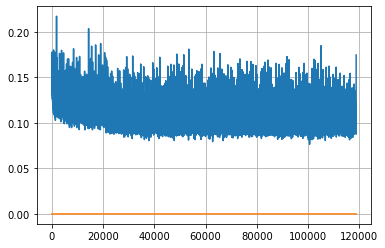

Epoch: 305, iteration 0, loss 0.10508349537849426, cov_diff 0.4054973545041613 cov_diff train 0.4053911463297196
Epoch: 305, iteration 1, loss 0.10605931282043457, cov_diff 0.4272520846098147 cov_diff train 0.4264192228655155
Epoch: 305, iteration 2, loss 0.11633604764938354, cov_diff 0.40963215638441075 cov_diff train 0.40765801613254443
Epoch: 305, iteration 3, loss 0.0942852795124054, cov_diff 0.40983877101856897 cov_diff train 0.408703096530981
Epoch: 305, iteration 4, loss 0.1054275631904602, cov_diff 0.40978378170986796 cov_diff train 0.4089872827875361
Epoch: 305, iteration 5, loss 0.0916760265827179, cov_diff 0.4135821370377322 cov_diff train 0.4134010664791311
Epoch: 305, iteration 6, loss 0.10631045699119568, cov_diff 0.41315368633250293 cov_diff train 0.4115435702831028
Epoch: 305, iteration 7, loss 0.09927794337272644, cov_diff 0.4021847065923998 cov_diff train 0.40097266775550305
Epoch: 305, iteration 8, loss 0.10121405124664307, cov_diff 0.4115627856099879 cov_diff train 

Epoch: 305, iteration 77, loss 0.1077200174331665, cov_diff 0.4072259633327587 cov_diff train 0.40715674480619735
Epoch: 305, iteration 78, loss 0.10000860691070557, cov_diff 0.4285555126329892 cov_diff train 0.42845775276906545
Epoch: 305, iteration 79, loss 0.09698638319969177, cov_diff 0.421176566026002 cov_diff train 0.4210021058088118
Epoch: 305, iteration 80, loss 0.10312971472740173, cov_diff 0.4118370357240407 cov_diff train 0.41072822393264263
Epoch: 305, iteration 81, loss 0.10966193675994873, cov_diff 0.4043642477383422 cov_diff train 0.404145737526664
Epoch: 305, iteration 82, loss 0.11496174335479736, cov_diff 0.43286350964606857 cov_diff train 0.4321050504493398
Epoch: 305, iteration 83, loss 0.0976366400718689, cov_diff 0.4095987599550874 cov_diff train 0.40938365695278217
Epoch: 305, iteration 84, loss 0.10265600681304932, cov_diff 0.41986712294009837 cov_diff train 0.41911973591994384
Epoch: 305, iteration 85, loss 0.1094050407409668, cov_diff 0.425771889095791 cov_dif

Epoch: 305, iteration 154, loss 0.10155043005943298, cov_diff 0.4033823751331351 cov_diff train 0.402356452194701
Epoch: 305, iteration 155, loss 0.11078450083732605, cov_diff 0.41492721290712214 cov_diff train 0.4140233809470701
Epoch: 305, iteration 156, loss 0.09676742553710938, cov_diff 0.42056733527149925 cov_diff train 0.4202004457743561
Epoch: 305, iteration 157, loss 0.10985380411148071, cov_diff 0.41497718909427805 cov_diff train 0.4148379655319596
Epoch: 305, iteration 158, loss 0.10338163375854492, cov_diff 0.42561180279892497 cov_diff train 0.4251814638330939
Epoch: 305, iteration 159, loss 0.1162186861038208, cov_diff 0.4260399859859234 cov_diff train 0.424188394064689
Epoch: 305, iteration 160, loss 0.10284069180488586, cov_diff 0.4033995532515597 cov_diff train 0.4036216031622531
Epoch: 305, iteration 161, loss 0.10102492570877075, cov_diff 0.40636394669369014 cov_diff train 0.4049076505989316
Epoch: 305, iteration 162, loss 0.09380799531936646, cov_diff 0.41634646657365

Epoch: 305, iteration 233, loss 0.11239463090896606, cov_diff 0.414214495902925 cov_diff train 0.41389561247388224
Epoch: 305, iteration 234, loss 0.11203837394714355, cov_diff 0.40127955316321634 cov_diff train 0.4014056600592691
Epoch: 305, iteration 235, loss 0.10212591290473938, cov_diff 0.41633765700637154 cov_diff train 0.41591439939877267
Epoch: 305, iteration 236, loss 0.10188230872154236, cov_diff 0.4024368466931173 cov_diff train 0.4018760624293435
Epoch: 305, iteration 237, loss 0.1078643798828125, cov_diff 0.4087548197277602 cov_diff train 0.40903202054149146
Epoch: 305, iteration 238, loss 0.10805454850196838, cov_diff 0.40702616383331 cov_diff train 0.40664972093406576
Epoch: 305, iteration 239, loss 0.09671786427497864, cov_diff 0.4079489743527348 cov_diff train 0.40632786500414325
Epoch: 305, iteration 240, loss 0.10745799541473389, cov_diff 0.4145646593193811 cov_diff train 0.4138041936850033
Epoch: 305, iteration 241, loss 0.10644814372062683, cov_diff 0.4195157563764

Epoch: 305, iteration 311, loss 0.10346916317939758, cov_diff 0.41725029738605507 cov_diff train 0.41659689483579115
Epoch: 305, iteration 312, loss 0.09940552711486816, cov_diff 0.41491522171554157 cov_diff train 0.41386603050043635
Epoch: 305, iteration 313, loss 0.11656585335731506, cov_diff 0.4194380954566274 cov_diff train 0.41739108938701497
Epoch: 305, iteration 314, loss 0.10763341188430786, cov_diff 0.42080632787219474 cov_diff train 0.4200585438832424
Epoch: 305, iteration 315, loss 0.09711596369743347, cov_diff 0.40240118142376946 cov_diff train 0.40178725701408396
Epoch: 305, iteration 316, loss 0.10681280493736267, cov_diff 0.4040673255208239 cov_diff train 0.4029930436456169
Epoch: 305, iteration 317, loss 0.10640189051628113, cov_diff 0.4231325006566468 cov_diff train 0.42215299177537347
Epoch: 305, iteration 318, loss 0.10308131575584412, cov_diff 0.4078386481867463 cov_diff train 0.4069499913420857
Epoch: 305, iteration 319, loss 0.09649676084518433, cov_diff 0.4065391

Epoch: 305, iteration 388, loss 0.1028231680393219, cov_diff 0.404500709221169 cov_diff train 0.4040485163306322
Epoch: 305, iteration 389, loss 0.09638696908950806, cov_diff 0.41515477247712657 cov_diff train 0.4141534869427199
Epoch: 305, iteration 390, loss 0.16810613870620728, cov_diff 0.4611085207094244 cov_diff train 0.4594559641260345


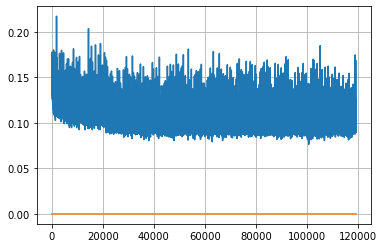

Epoch: 306, iteration 0, loss 0.09978392720222473, cov_diff 0.4158073799445489 cov_diff train 0.41567343165331105
Epoch: 306, iteration 1, loss 0.10164529085159302, cov_diff 0.41630547503043625 cov_diff train 0.4163336062126304
Epoch: 306, iteration 2, loss 0.10197466611862183, cov_diff 0.4180115818582111 cov_diff train 0.4181794522563195
Epoch: 306, iteration 3, loss 0.10641390085220337, cov_diff 0.4120257948465046 cov_diff train 0.41250808795176946
Epoch: 306, iteration 4, loss 0.10415923595428467, cov_diff 0.40697625412601945 cov_diff train 0.40646280623427655
Epoch: 306, iteration 5, loss 0.10894259810447693, cov_diff 0.40341268099441346 cov_diff train 0.40233730293655884
Epoch: 306, iteration 6, loss 0.0979093611240387, cov_diff 0.4344560561254558 cov_diff train 0.43391622523864
Epoch: 306, iteration 7, loss 0.09696471691131592, cov_diff 0.4215982121237764 cov_diff train 0.4215997888835284
Epoch: 306, iteration 8, loss 0.1004718542098999, cov_diff 0.39785722177970706 cov_diff trai

Epoch: 306, iteration 76, loss 0.10564282536506653, cov_diff 0.4143339235207075 cov_diff train 0.41365407424918527
Epoch: 306, iteration 77, loss 0.1114153265953064, cov_diff 0.42079842466773804 cov_diff train 0.4204587154337933
Epoch: 306, iteration 78, loss 0.10806909203529358, cov_diff 0.42201870483483733 cov_diff train 0.4209319357286345
Epoch: 306, iteration 79, loss 0.09909269213676453, cov_diff 0.4104857873680961 cov_diff train 0.40940025560495635
Epoch: 306, iteration 80, loss 0.11141914129257202, cov_diff 0.41463961024380513 cov_diff train 0.41325668662749054
Epoch: 306, iteration 81, loss 0.11472132802009583, cov_diff 0.41035986319848566 cov_diff train 0.40869493439913235
Epoch: 306, iteration 82, loss 0.11136576533317566, cov_diff 0.40326856915521037 cov_diff train 0.4016995528391403
Epoch: 306, iteration 83, loss 0.09588804841041565, cov_diff 0.4075672149883605 cov_diff train 0.4069065992025873
Epoch: 306, iteration 84, loss 0.0984407365322113, cov_diff 0.39960873181404055 

Epoch: 306, iteration 153, loss 0.0979558527469635, cov_diff 0.4199989225201587 cov_diff train 0.4191118750863664
Epoch: 306, iteration 154, loss 0.10104456543922424, cov_diff 0.4118463390019469 cov_diff train 0.411147811385765
Epoch: 306, iteration 155, loss 0.08821046352386475, cov_diff 0.40797719944291744 cov_diff train 0.40687845500470593
Epoch: 306, iteration 156, loss 0.10841342806816101, cov_diff 0.40829054695220857 cov_diff train 0.4078154677018174
Epoch: 306, iteration 157, loss 0.11040431261062622, cov_diff 0.4110106225878934 cov_diff train 0.41059835633822045
Epoch: 306, iteration 158, loss 0.10382351279258728, cov_diff 0.40821005083719397 cov_diff train 0.4075054249081017
Epoch: 306, iteration 159, loss 0.10501959919929504, cov_diff 0.40800326853690866 cov_diff train 0.4073032949534237
Epoch: 306, iteration 160, loss 0.10578364133834839, cov_diff 0.4186814039948355 cov_diff train 0.4183022984439827
Epoch: 306, iteration 161, loss 0.09619027376174927, cov_diff 0.402947806498

Epoch: 306, iteration 230, loss 0.0882856547832489, cov_diff 0.41105570698284055 cov_diff train 0.41011879381936717
Epoch: 306, iteration 231, loss 0.0962897539138794, cov_diff 0.40859158746158464 cov_diff train 0.408377364595241
Epoch: 306, iteration 232, loss 0.10346466302871704, cov_diff 0.4052804535038773 cov_diff train 0.4048641633253147
Epoch: 306, iteration 233, loss 0.10346093773841858, cov_diff 0.4122457261515675 cov_diff train 0.4115277911222206
Epoch: 306, iteration 234, loss 0.11776697635650635, cov_diff 0.4160490985083492 cov_diff train 0.41553520246264947
Epoch: 306, iteration 235, loss 0.10925880074501038, cov_diff 0.40547463173244147 cov_diff train 0.4039399375902889
Epoch: 306, iteration 236, loss 0.10163921117782593, cov_diff 0.41205708369447197 cov_diff train 0.4116934897588237
Epoch: 306, iteration 237, loss 0.08764421939849854, cov_diff 0.42099876972351225 cov_diff train 0.420110904836925
Epoch: 306, iteration 238, loss 0.10461273789405823, cov_diff 0.4051808539302

Epoch: 306, iteration 308, loss 0.10514771938323975, cov_diff 0.4010755975192236 cov_diff train 0.4001085864157142
Epoch: 306, iteration 309, loss 0.09666168689727783, cov_diff 0.4165108573894939 cov_diff train 0.415979173122181
Epoch: 306, iteration 310, loss 0.09699934720993042, cov_diff 0.43171543812184904 cov_diff train 0.4304392921365714
Epoch: 306, iteration 311, loss 0.10784599184989929, cov_diff 0.40800310775824833 cov_diff train 0.4075684607761821
Epoch: 306, iteration 312, loss 0.10311856865882874, cov_diff 0.42212633814372175 cov_diff train 0.42173344408455965
Epoch: 306, iteration 313, loss 0.10187271237373352, cov_diff 0.4059067219592566 cov_diff train 0.40519402702185714
Epoch: 306, iteration 314, loss 0.10162332653999329, cov_diff 0.40689822628180566 cov_diff train 0.4071416518089444
Epoch: 306, iteration 315, loss 0.10409703850746155, cov_diff 0.40623615881273906 cov_diff train 0.40510397871725157
Epoch: 306, iteration 316, loss 0.1033468246459961, cov_diff 0.4064483316

Epoch: 306, iteration 380, loss 0.09882047772407532, cov_diff 0.4143146311274172 cov_diff train 0.41401087894353555
Epoch: 306, iteration 381, loss 0.10031795501708984, cov_diff 0.41022658668584894 cov_diff train 0.4100169114585841
Epoch: 306, iteration 382, loss 0.09543094038963318, cov_diff 0.42105065349543974 cov_diff train 0.4210101030559273
Epoch: 306, iteration 383, loss 0.1031043529510498, cov_diff 0.41200681772178865 cov_diff train 0.41177326138040254
Epoch: 306, iteration 384, loss 0.10941672325134277, cov_diff 0.41658237881859617 cov_diff train 0.41666200332817993
Epoch: 306, iteration 385, loss 0.09148856997489929, cov_diff 0.42360618021924645 cov_diff train 0.4217838367583722
Epoch: 306, iteration 386, loss 0.0973430871963501, cov_diff 0.4053778983842119 cov_diff train 0.4048013562271277
Epoch: 306, iteration 387, loss 0.10055583715438843, cov_diff 0.4096222505185987 cov_diff train 0.40975873867084556
Epoch: 306, iteration 388, loss 0.0986877977848053, cov_diff 0.3934303854

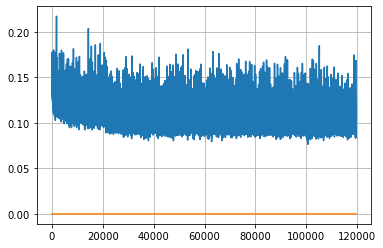

Epoch: 307, iteration 0, loss 0.09038934111595154, cov_diff 0.42044462303032426 cov_diff train 0.42011172355632914
Epoch: 307, iteration 1, loss 0.10204455256462097, cov_diff 0.4165176633125009 cov_diff train 0.4149998558144919
Epoch: 307, iteration 2, loss 0.10750970244407654, cov_diff 0.4159314115083005 cov_diff train 0.4148336544346571
Epoch: 307, iteration 3, loss 0.1062435507774353, cov_diff 0.40520022807399314 cov_diff train 0.4037434267485867
Epoch: 307, iteration 4, loss 0.09607309103012085, cov_diff 0.41843843524252283 cov_diff train 0.41800545691270935
Epoch: 307, iteration 5, loss 0.09941595792770386, cov_diff 0.4073352943574539 cov_diff train 0.4069019810416732
Epoch: 307, iteration 6, loss 0.10093048214912415, cov_diff 0.39637251200972445 cov_diff train 0.395685861773059
Epoch: 307, iteration 7, loss 0.09578785300254822, cov_diff 0.4085005620782789 cov_diff train 0.40832759369136956
Epoch: 307, iteration 8, loss 0.09849613904953003, cov_diff 0.4118402482575086 cov_diff tra

Epoch: 307, iteration 72, loss 0.10779637098312378, cov_diff 0.4061644235343987 cov_diff train 0.40540476016894467
Epoch: 307, iteration 73, loss 0.09829515218734741, cov_diff 0.4173896362134017 cov_diff train 0.4164859094680814
Epoch: 307, iteration 74, loss 0.09137168526649475, cov_diff 0.4156232165546575 cov_diff train 0.4150037282016089
Epoch: 307, iteration 75, loss 0.09468433260917664, cov_diff 0.39943657307823177 cov_diff train 0.39958498672785403
Epoch: 307, iteration 76, loss 0.09787300229072571, cov_diff 0.40242936433553145 cov_diff train 0.40201428638101694
Epoch: 307, iteration 77, loss 0.09599557518959045, cov_diff 0.40981827320100367 cov_diff train 0.4092840394441431
Epoch: 307, iteration 78, loss 0.10087800025939941, cov_diff 0.4230806683744764 cov_diff train 0.42245935742361285
Epoch: 307, iteration 79, loss 0.08877715468406677, cov_diff 0.40141177059161326 cov_diff train 0.4013522683739852
Epoch: 307, iteration 80, loss 0.11330416798591614, cov_diff 0.4159897182581592 

Epoch: 307, iteration 145, loss 0.10173621773719788, cov_diff 0.40256720861013867 cov_diff train 0.40227460308427593
Epoch: 307, iteration 146, loss 0.09982123970985413, cov_diff 0.4245767106250243 cov_diff train 0.4234520327792724
Epoch: 307, iteration 147, loss 0.10611656308174133, cov_diff 0.41021007867565884 cov_diff train 0.40889690328790823
Epoch: 307, iteration 148, loss 0.10363319516181946, cov_diff 0.42198844487120396 cov_diff train 0.42128097493921723
Epoch: 307, iteration 149, loss 0.11127564311027527, cov_diff 0.41632088429289754 cov_diff train 0.4149858755984235
Epoch: 307, iteration 150, loss 0.10557231307029724, cov_diff 0.41348318486947855 cov_diff train 0.4132453992845921
Epoch: 307, iteration 151, loss 0.09560373425483704, cov_diff 0.39580620462562 cov_diff train 0.3947148843228642
Epoch: 307, iteration 152, loss 0.11525362730026245, cov_diff 0.4221134880132205 cov_diff train 0.4215022573520117
Epoch: 307, iteration 153, loss 0.1059790551662445, cov_diff 0.42033020383

Epoch: 307, iteration 221, loss 0.0856998860836029, cov_diff 0.40440930587589874 cov_diff train 0.4036085870031871
Epoch: 307, iteration 222, loss 0.11967343091964722, cov_diff 0.41539610893095985 cov_diff train 0.41522651340121364
Epoch: 307, iteration 223, loss 0.11050081253051758, cov_diff 0.42840746465715707 cov_diff train 0.4285472811449607
Epoch: 307, iteration 224, loss 0.10002544522285461, cov_diff 0.40545103347261147 cov_diff train 0.4052908837025555
Epoch: 307, iteration 225, loss 0.10793668031692505, cov_diff 0.410287314803632 cov_diff train 0.4100248623882589
Epoch: 307, iteration 226, loss 0.10273626446723938, cov_diff 0.40503630913623523 cov_diff train 0.4051572501989939
Epoch: 307, iteration 227, loss 0.10571807622909546, cov_diff 0.41931842027703176 cov_diff train 0.41854941558708725
Epoch: 307, iteration 228, loss 0.10194817185401917, cov_diff 0.4173611194615398 cov_diff train 0.4168731840178861
Epoch: 307, iteration 229, loss 0.10995548963546753, cov_diff 0.4039192806

Epoch: 307, iteration 296, loss 0.10332396626472473, cov_diff 0.39779185357257335 cov_diff train 0.3963131308469244
Epoch: 307, iteration 297, loss 0.0993286669254303, cov_diff 0.39458481463594075 cov_diff train 0.3954494996188014
Epoch: 307, iteration 298, loss 0.10273316502571106, cov_diff 0.4125778953149481 cov_diff train 0.4118883299093431
Epoch: 307, iteration 299, loss 0.08745652437210083, cov_diff 0.4101299247678082 cov_diff train 0.40935114585851834
Epoch: 307, iteration 300, loss 0.10547235608100891, cov_diff 0.4272061262200826 cov_diff train 0.4255259495368101
Epoch: 307, iteration 301, loss 0.09248203039169312, cov_diff 0.3927774795077256 cov_diff train 0.3923144796705917
Epoch: 307, iteration 302, loss 0.09794372320175171, cov_diff 0.4062007397250593 cov_diff train 0.40595407321478827
Epoch: 307, iteration 303, loss 0.10339027643203735, cov_diff 0.41892890121856324 cov_diff train 0.41856645514891555
Epoch: 307, iteration 304, loss 0.11670616269111633, cov_diff 0.42254095722

Epoch: 307, iteration 373, loss 0.10451117157936096, cov_diff 0.4093144814068625 cov_diff train 0.4087089684794652
Epoch: 307, iteration 374, loss 0.10680878162384033, cov_diff 0.4262713752488303 cov_diff train 0.4256888165550639
Epoch: 307, iteration 375, loss 0.10441839694976807, cov_diff 0.406176856489522 cov_diff train 0.40491480979883915
Epoch: 307, iteration 376, loss 0.1104336678981781, cov_diff 0.40880961452555314 cov_diff train 0.40766366934818665
Epoch: 307, iteration 377, loss 0.09771639108657837, cov_diff 0.4194508886354598 cov_diff train 0.4184669769723329
Epoch: 307, iteration 378, loss 0.11659905314445496, cov_diff 0.4305806386888835 cov_diff train 0.4288233120645794
Epoch: 307, iteration 379, loss 0.09986037015914917, cov_diff 0.4118396398621361 cov_diff train 0.4103596354700531
Epoch: 307, iteration 380, loss 0.10257220268249512, cov_diff 0.40608463213770973 cov_diff train 0.405490945139424
Epoch: 307, iteration 381, loss 0.11869537830352783, cov_diff 0.421598350824416

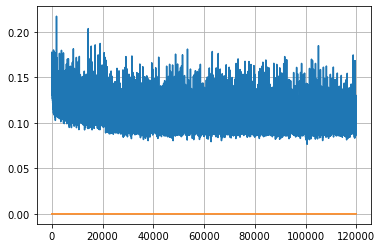

Epoch: 308, iteration 0, loss 0.10921549797058105, cov_diff 0.4120015341273619 cov_diff train 0.41043600083120524
Epoch: 308, iteration 1, loss 0.09591156244277954, cov_diff 0.41296398704742526 cov_diff train 0.41228712365794923
Epoch: 308, iteration 2, loss 0.11028113961219788, cov_diff 0.42152762156975226 cov_diff train 0.4207984580662932
Epoch: 308, iteration 3, loss 0.10095560550689697, cov_diff 0.40740391839029216 cov_diff train 0.4067479089232541
Epoch: 308, iteration 4, loss 0.092378169298172, cov_diff 0.41503952848358516 cov_diff train 0.41424272841404086
Epoch: 308, iteration 5, loss 0.10676202178001404, cov_diff 0.4159136039727787 cov_diff train 0.41499437693843116
Epoch: 308, iteration 6, loss 0.10187667608261108, cov_diff 0.41201693530104333 cov_diff train 0.4119568357406975
Epoch: 308, iteration 7, loss 0.09572023153305054, cov_diff 0.41371288727719624 cov_diff train 0.41255634993571977
Epoch: 308, iteration 8, loss 0.10877096652984619, cov_diff 0.40787235690588486 cov_dif

Epoch: 308, iteration 81, loss 0.10768038034439087, cov_diff 0.4229718600012085 cov_diff train 0.42316887332639214
Epoch: 308, iteration 82, loss 0.10511341691017151, cov_diff 0.4064361484164708 cov_diff train 0.406804533094332
Epoch: 308, iteration 83, loss 0.09958592057228088, cov_diff 0.4347536521407935 cov_diff train 0.43489125655881494
Epoch: 308, iteration 84, loss 0.10130903124809265, cov_diff 0.4234849887127379 cov_diff train 0.423448885619405
Epoch: 308, iteration 85, loss 0.10790187120437622, cov_diff 0.41326547899178995 cov_diff train 0.4127095831063196
Epoch: 308, iteration 86, loss 0.11534139513969421, cov_diff 0.41925346635954147 cov_diff train 0.4180483675733707
Epoch: 308, iteration 87, loss 0.10777303576469421, cov_diff 0.40569073109760734 cov_diff train 0.4046743833119965
Epoch: 308, iteration 88, loss 0.1091984212398529, cov_diff 0.42760970496398887 cov_diff train 0.42589711551142406
Epoch: 308, iteration 89, loss 0.10969233512878418, cov_diff 0.4120147357694197 cov_

Epoch: 308, iteration 156, loss 0.09493008255958557, cov_diff 0.3991056227690542 cov_diff train 0.3986968600405551
Epoch: 308, iteration 157, loss 0.11422616243362427, cov_diff 0.4109292833422622 cov_diff train 0.4094988229987345
Epoch: 308, iteration 158, loss 0.12484210729598999, cov_diff 0.40987131061983134 cov_diff train 0.40852816442360157
Epoch: 308, iteration 159, loss 0.1048077642917633, cov_diff 0.4122802215969747 cov_diff train 0.41110047127059246
Epoch: 308, iteration 160, loss 0.10988464951515198, cov_diff 0.39986926111732224 cov_diff train 0.39822659158976703
Epoch: 308, iteration 161, loss 0.0975099503993988, cov_diff 0.3983511287681776 cov_diff train 0.39777272018363996
Epoch: 308, iteration 162, loss 0.1101701557636261, cov_diff 0.4302153833692002 cov_diff train 0.4281675715778251
Epoch: 308, iteration 163, loss 0.09998244047164917, cov_diff 0.4162002903825329 cov_diff train 0.4159366601194444
Epoch: 308, iteration 164, loss 0.09855106472969055, cov_diff 0.3997953322134

Epoch: 308, iteration 237, loss 0.11444661021232605, cov_diff 0.4127806019295316 cov_diff train 0.4128458988410587
Epoch: 308, iteration 238, loss 0.10115423798561096, cov_diff 0.4187828452741641 cov_diff train 0.41918744616407966
Epoch: 308, iteration 239, loss 0.11358550190925598, cov_diff 0.4143138452049317 cov_diff train 0.41330867614228867
Epoch: 308, iteration 240, loss 0.11498656868934631, cov_diff 0.39640987761183333 cov_diff train 0.39659369931633753
Epoch: 308, iteration 241, loss 0.10763227939605713, cov_diff 0.4165282726774548 cov_diff train 0.4154900659216814
Epoch: 308, iteration 242, loss 0.11561590433120728, cov_diff 0.42762377975963 cov_diff train 0.4271251868127382
Epoch: 308, iteration 243, loss 0.100568026304245, cov_diff 0.41214571760279434 cov_diff train 0.41204598498762607
Epoch: 308, iteration 244, loss 0.10567250847816467, cov_diff 0.40647205813469 cov_diff train 0.40545081717995696
Epoch: 308, iteration 245, loss 0.09734886884689331, cov_diff 0.426890682799778

Epoch: 308, iteration 314, loss 0.09385666251182556, cov_diff 0.411042220009004 cov_diff train 0.4100969266465528
Epoch: 308, iteration 315, loss 0.09944888949394226, cov_diff 0.41601257682445253 cov_diff train 0.41480806053979524
Epoch: 308, iteration 316, loss 0.09414973855018616, cov_diff 0.4073758481726924 cov_diff train 0.4063208311802008
Epoch: 308, iteration 317, loss 0.10613289475440979, cov_diff 0.4050611114313623 cov_diff train 0.404492680083636
Epoch: 308, iteration 318, loss 0.10015690326690674, cov_diff 0.40174225141588077 cov_diff train 0.3999763629087023
Epoch: 308, iteration 319, loss 0.11912757158279419, cov_diff 0.4138350004975387 cov_diff train 0.4138597132415375
Epoch: 308, iteration 320, loss 0.10327121615409851, cov_diff 0.4232672505418952 cov_diff train 0.4220124905316178
Epoch: 308, iteration 321, loss 0.10488680005073547, cov_diff 0.41450124080486445 cov_diff train 0.41406380203808923
Epoch: 308, iteration 322, loss 0.1001676619052887, cov_diff 0.40819886596248

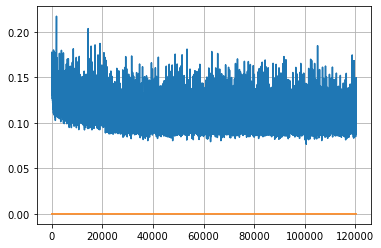

Epoch: 309, iteration 0, loss 0.1122521162033081, cov_diff 0.4186766705065335 cov_diff train 0.41784520858108354
Epoch: 309, iteration 1, loss 0.10302010178565979, cov_diff 0.4105845848250747 cov_diff train 0.41021504221590904
Epoch: 309, iteration 2, loss 0.10619422793388367, cov_diff 0.41275309768006646 cov_diff train 0.41219055813507727
Epoch: 309, iteration 3, loss 0.114077627658844, cov_diff 0.4039282095771093 cov_diff train 0.4041670788729513
Epoch: 309, iteration 4, loss 0.09873494505882263, cov_diff 0.40694534444971797 cov_diff train 0.4066727036076409
Epoch: 309, iteration 5, loss 0.11321309208869934, cov_diff 0.41624960966642693 cov_diff train 0.41619092257745055
Epoch: 309, iteration 6, loss 0.09811365604400635, cov_diff 0.41782815237017873 cov_diff train 0.4171317817295667
Epoch: 309, iteration 7, loss 0.10375306010246277, cov_diff 0.40974357366270575 cov_diff train 0.4097198377535616
Epoch: 309, iteration 8, loss 0.1054912805557251, cov_diff 0.4198440251519572 cov_diff tra

Epoch: 309, iteration 79, loss 0.09869703650474548, cov_diff 0.41499694132258513 cov_diff train 0.4147695386215976
Epoch: 309, iteration 80, loss 0.09601351618766785, cov_diff 0.40723929703850265 cov_diff train 0.40697598287715847
Epoch: 309, iteration 81, loss 0.09815216064453125, cov_diff 0.4241517028407688 cov_diff train 0.4224123867719712
Epoch: 309, iteration 82, loss 0.08984526991844177, cov_diff 0.40906982811018194 cov_diff train 0.40859759908897214
Epoch: 309, iteration 83, loss 0.10595616698265076, cov_diff 0.41654255643233223 cov_diff train 0.4165080400778354
Epoch: 309, iteration 84, loss 0.09659779071807861, cov_diff 0.4121010615084784 cov_diff train 0.41068950159060336
Epoch: 309, iteration 85, loss 0.10471120476722717, cov_diff 0.4014520289469722 cov_diff train 0.40020711243742113
Epoch: 309, iteration 86, loss 0.11226043105125427, cov_diff 0.4196268083290024 cov_diff train 0.418708157368802
Epoch: 309, iteration 87, loss 0.10223248600959778, cov_diff 0.40739254642725686 

Epoch: 309, iteration 157, loss 0.09728226065635681, cov_diff 0.41767805958233584 cov_diff train 0.41795740024002864
Epoch: 309, iteration 158, loss 0.11484292149543762, cov_diff 0.4194361017044135 cov_diff train 0.4185067426391592
Epoch: 309, iteration 159, loss 0.10679087042808533, cov_diff 0.40641300664289487 cov_diff train 0.40609808173644324
Epoch: 309, iteration 160, loss 0.10914945602416992, cov_diff 0.41770177059036223 cov_diff train 0.4171270738340277
Epoch: 309, iteration 161, loss 0.09701916575431824, cov_diff 0.41490122377836447 cov_diff train 0.41401417057464623
Epoch: 309, iteration 162, loss 0.0994899570941925, cov_diff 0.40761897053333723 cov_diff train 0.40575693374063476
Epoch: 309, iteration 163, loss 0.10814979672431946, cov_diff 0.41743344228047863 cov_diff train 0.4164587369403831
Epoch: 309, iteration 164, loss 0.10676118731498718, cov_diff 0.4166299076134755 cov_diff train 0.4155486902969298
Epoch: 309, iteration 165, loss 0.09623923897743225, cov_diff 0.4109109

Epoch: 309, iteration 234, loss 0.11535561084747314, cov_diff 0.4015685904623305 cov_diff train 0.40118280683383395
Epoch: 309, iteration 235, loss 0.10817462205886841, cov_diff 0.42470783217186053 cov_diff train 0.4243959159210732
Epoch: 309, iteration 236, loss 0.10944181680679321, cov_diff 0.4067230040480814 cov_diff train 0.40537054188272825
Epoch: 309, iteration 237, loss 0.08822950720787048, cov_diff 0.42741620923422263 cov_diff train 0.42723927297740255
Epoch: 309, iteration 238, loss 0.09777849912643433, cov_diff 0.4076150491421911 cov_diff train 0.40727298774652804
Epoch: 309, iteration 239, loss 0.10185408592224121, cov_diff 0.41874426014579313 cov_diff train 0.4172859332423966
Epoch: 309, iteration 240, loss 0.10455390810966492, cov_diff 0.4036808483066338 cov_diff train 0.4023989782065503
Epoch: 309, iteration 241, loss 0.12069609761238098, cov_diff 0.4087082249155943 cov_diff train 0.40717386404185285
Epoch: 309, iteration 242, loss 0.10899120569229126, cov_diff 0.40138448

Epoch: 309, iteration 312, loss 0.11768180131912231, cov_diff 0.4045815986859717 cov_diff train 0.4030177886431422
Epoch: 309, iteration 313, loss 0.10489577054977417, cov_diff 0.423676694741699 cov_diff train 0.4220567554316532
Epoch: 309, iteration 314, loss 0.10362958908081055, cov_diff 0.42115376683137473 cov_diff train 0.42042433859310285
Epoch: 309, iteration 315, loss 0.10571432113647461, cov_diff 0.4163195516940461 cov_diff train 0.41558022074482953
Epoch: 309, iteration 316, loss 0.08866307139396667, cov_diff 0.42407550929723653 cov_diff train 0.42301004329828107
Epoch: 309, iteration 317, loss 0.09755498170852661, cov_diff 0.41749136262172515 cov_diff train 0.41651783477669896
Epoch: 309, iteration 318, loss 0.09175816178321838, cov_diff 0.39847510927039376 cov_diff train 0.3978069219930695
Epoch: 309, iteration 319, loss 0.10038360953330994, cov_diff 0.4088864433743916 cov_diff train 0.4084977969798841
Epoch: 309, iteration 320, loss 0.09782823920249939, cov_diff 0.404362528

Epoch: 309, iteration 389, loss 0.11145126819610596, cov_diff 0.4198943840105956 cov_diff train 0.4190846781308467
Epoch: 309, iteration 390, loss 0.15225157141685486, cov_diff 0.4599159572798431 cov_diff train 0.45875127766453294


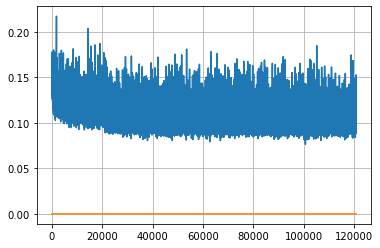

Epoch: 310, iteration 0, loss 0.10794198513031006, cov_diff 0.40339499599591894 cov_diff train 0.4016848319950332
Epoch: 310, iteration 1, loss 0.10141429305076599, cov_diff 0.41185581048198183 cov_diff train 0.4112744744874588
Epoch: 310, iteration 2, loss 0.11013707518577576, cov_diff 0.41201793514602875 cov_diff train 0.4110432269978509
Epoch: 310, iteration 3, loss 0.10130137205123901, cov_diff 0.39886771434928836 cov_diff train 0.3986873267743076
Epoch: 310, iteration 4, loss 0.0919390320777893, cov_diff 0.4049304526537787 cov_diff train 0.4045600693002481
Epoch: 310, iteration 5, loss 0.10548514127731323, cov_diff 0.415449693725672 cov_diff train 0.41448384005856115
Epoch: 310, iteration 6, loss 0.11343175172805786, cov_diff 0.4132502452135542 cov_diff train 0.4124496339704607
Epoch: 310, iteration 7, loss 0.10120770335197449, cov_diff 0.41708221378706994 cov_diff train 0.41712609024659947
Epoch: 310, iteration 8, loss 0.10010853409767151, cov_diff 0.41395102624186675 cov_diff tr

Epoch: 310, iteration 78, loss 0.09513264894485474, cov_diff 0.40819297283475525 cov_diff train 0.4086684413317724
Epoch: 310, iteration 79, loss 0.1083935797214508, cov_diff 0.3997231429627917 cov_diff train 0.39941486840343304
Epoch: 310, iteration 80, loss 0.09283730387687683, cov_diff 0.40619843880973927 cov_diff train 0.4055402537184558
Epoch: 310, iteration 81, loss 0.11008217930793762, cov_diff 0.41888409133544047 cov_diff train 0.41746975813634446
Epoch: 310, iteration 82, loss 0.11673146486282349, cov_diff 0.4035352998351281 cov_diff train 0.402890410348231
Epoch: 310, iteration 83, loss 0.1027195155620575, cov_diff 0.4169765950182753 cov_diff train 0.41622640976248265
Epoch: 310, iteration 84, loss 0.11422821879386902, cov_diff 0.4065775653733026 cov_diff train 0.40567971255415436
Epoch: 310, iteration 85, loss 0.11761000752449036, cov_diff 0.40630518533108323 cov_diff train 0.4056046937362926
Epoch: 310, iteration 86, loss 0.10440674424171448, cov_diff 0.4030983557464256 cov

Epoch: 310, iteration 156, loss 0.09784182906150818, cov_diff 0.41923263212355216 cov_diff train 0.4180244261593047
Epoch: 310, iteration 157, loss 0.09723323583602905, cov_diff 0.41194270830905666 cov_diff train 0.4106863542083416
Epoch: 310, iteration 158, loss 0.10477206110954285, cov_diff 0.41608076920355785 cov_diff train 0.4158570183002981
Epoch: 310, iteration 159, loss 0.0945245623588562, cov_diff 0.4072672039644407 cov_diff train 0.40661463673776466
Epoch: 310, iteration 160, loss 0.1033487319946289, cov_diff 0.396280779688498 cov_diff train 0.3959973824136841
Epoch: 310, iteration 161, loss 0.10420277714729309, cov_diff 0.3958848030851676 cov_diff train 0.39593736639832544
Epoch: 310, iteration 162, loss 0.10736533999443054, cov_diff 0.4091936558935274 cov_diff train 0.40897092425585785
Epoch: 310, iteration 163, loss 0.10815936326980591, cov_diff 0.4243357540632441 cov_diff train 0.4227872664871533
Epoch: 310, iteration 164, loss 0.10465216636657715, cov_diff 0.4216013198678

Epoch: 310, iteration 235, loss 0.1017686128616333, cov_diff 0.4137154355456412 cov_diff train 0.4130947568715232
Epoch: 310, iteration 236, loss 0.10388404130935669, cov_diff 0.40868220661990357 cov_diff train 0.407967529336761
Epoch: 310, iteration 237, loss 0.10097312927246094, cov_diff 0.42066455490670784 cov_diff train 0.4194293974635447
Epoch: 310, iteration 238, loss 0.09570968151092529, cov_diff 0.422488800657594 cov_diff train 0.42180991807185503
Epoch: 310, iteration 239, loss 0.12105453014373779, cov_diff 0.4226320640039445 cov_diff train 0.42100365363131764
Epoch: 310, iteration 240, loss 0.1126401424407959, cov_diff 0.41568087534635206 cov_diff train 0.4144317382022831
Epoch: 310, iteration 241, loss 0.10781919956207275, cov_diff 0.41626077998645905 cov_diff train 0.41505355975212116
Epoch: 310, iteration 242, loss 0.10442754626274109, cov_diff 0.40694469581894566 cov_diff train 0.40651225655176454
Epoch: 310, iteration 243, loss 0.10037502646446228, cov_diff 0.41702222115

Epoch: 310, iteration 315, loss 0.093167245388031, cov_diff 0.40962483180783754 cov_diff train 0.4091971311008458
Epoch: 310, iteration 316, loss 0.10509225726127625, cov_diff 0.4172445279681992 cov_diff train 0.41619260581564815
Epoch: 310, iteration 317, loss 0.09868955612182617, cov_diff 0.41613757374653143 cov_diff train 0.4154248393505704
Epoch: 310, iteration 318, loss 0.10837182402610779, cov_diff 0.40782113954128796 cov_diff train 0.4075575530923833
Epoch: 310, iteration 319, loss 0.0959344208240509, cov_diff 0.40527995878872924 cov_diff train 0.4054367489580795
Epoch: 310, iteration 320, loss 0.11096727848052979, cov_diff 0.4272175341047329 cov_diff train 0.42607136995337713
Epoch: 310, iteration 321, loss 0.09357497096061707, cov_diff 0.3952586191466142 cov_diff train 0.3942002098585585
Epoch: 310, iteration 322, loss 0.09850424528121948, cov_diff 0.4214625611425659 cov_diff train 0.41954440612669813
Epoch: 310, iteration 323, loss 0.09664642810821533, cov_diff 0.407102722637

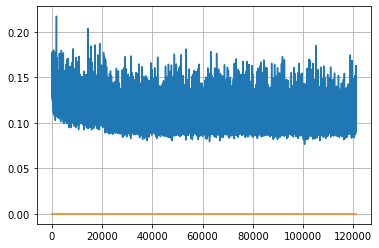

Epoch: 311, iteration 0, loss 0.1057266891002655, cov_diff 0.40982764533631844 cov_diff train 0.40897749749680595
Epoch: 311, iteration 1, loss 0.1015034019947052, cov_diff 0.4052392733646521 cov_diff train 0.4050735462967797
Epoch: 311, iteration 2, loss 0.10539346933364868, cov_diff 0.4064879214322896 cov_diff train 0.4070511647469009
Epoch: 311, iteration 3, loss 0.0988667905330658, cov_diff 0.40482046994308957 cov_diff train 0.4044994658276878
Epoch: 311, iteration 4, loss 0.09531381726264954, cov_diff 0.4095040828927855 cov_diff train 0.40870748426335823
Epoch: 311, iteration 5, loss 0.09653425216674805, cov_diff 0.4066519904244939 cov_diff train 0.405917836325017
Epoch: 311, iteration 6, loss 0.10571080446243286, cov_diff 0.41498274952953285 cov_diff train 0.4140343899613464
Epoch: 311, iteration 7, loss 0.1013612151145935, cov_diff 0.4121419695182298 cov_diff train 0.41219277651907477
Epoch: 311, iteration 8, loss 0.10023397207260132, cov_diff 0.4124153558536468 cov_diff train 0

Epoch: 311, iteration 79, loss 0.09957486391067505, cov_diff 0.4191264352248724 cov_diff train 0.4187042078518087
Epoch: 311, iteration 80, loss 0.1052209734916687, cov_diff 0.424536692580045 cov_diff train 0.42268583172007734
Epoch: 311, iteration 81, loss 0.10100653767585754, cov_diff 0.42799162318731376 cov_diff train 0.4271499272876534
Epoch: 311, iteration 82, loss 0.11824193596839905, cov_diff 0.41426924439956647 cov_diff train 0.4128119601230316
Epoch: 311, iteration 83, loss 0.09715738892555237, cov_diff 0.417788221593763 cov_diff train 0.4179954580512215
Epoch: 311, iteration 84, loss 0.0961427092552185, cov_diff 0.42349650698789376 cov_diff train 0.42338525005957917
Epoch: 311, iteration 85, loss 0.10197597742080688, cov_diff 0.4135121442782289 cov_diff train 0.41152309933392456
Epoch: 311, iteration 86, loss 0.11545300483703613, cov_diff 0.41172412526773794 cov_diff train 0.4109597252712874
Epoch: 311, iteration 87, loss 0.12868732213974, cov_diff 0.41858307192817085 cov_dif

Epoch: 311, iteration 158, loss 0.11220130324363708, cov_diff 0.4132040123296553 cov_diff train 0.41304161332886447
Epoch: 311, iteration 159, loss 0.10162660479545593, cov_diff 0.4076765324523952 cov_diff train 0.4075566796721954
Epoch: 311, iteration 160, loss 0.08733084797859192, cov_diff 0.4007059197430258 cov_diff train 0.39986807588961
Epoch: 311, iteration 161, loss 0.1041749119758606, cov_diff 0.4241990289737221 cov_diff train 0.4227785552666779
Epoch: 311, iteration 162, loss 0.10561248660087585, cov_diff 0.4070316264330451 cov_diff train 0.4063281912696927
Epoch: 311, iteration 163, loss 0.10439422726631165, cov_diff 0.4152677473767438 cov_diff train 0.4141311701297621
Epoch: 311, iteration 164, loss 0.1012561023235321, cov_diff 0.42020382524947325 cov_diff train 0.41997437822958
Epoch: 311, iteration 165, loss 0.0961504876613617, cov_diff 0.4128318497851278 cov_diff train 0.4117580836541866
Epoch: 311, iteration 166, loss 0.1182258129119873, cov_diff 0.414058745626641 cov_di

Epoch: 311, iteration 237, loss 0.11634588241577148, cov_diff 0.39675009846747333 cov_diff train 0.3960772188745116
Epoch: 311, iteration 238, loss 0.10950112342834473, cov_diff 0.4095897866603831 cov_diff train 0.4086624513909182
Epoch: 311, iteration 239, loss 0.1039159893989563, cov_diff 0.3961296362900018 cov_diff train 0.3953793505564754
Epoch: 311, iteration 240, loss 0.11341691017150879, cov_diff 0.4224140152329185 cov_diff train 0.42155118631926797
Epoch: 311, iteration 241, loss 0.09544429183006287, cov_diff 0.3972948718671045 cov_diff train 0.39697821544379924
Epoch: 311, iteration 242, loss 0.10208401083946228, cov_diff 0.40244123592842174 cov_diff train 0.40161726864481306
Epoch: 311, iteration 243, loss 0.10913828015327454, cov_diff 0.40643985683255596 cov_diff train 0.4047745140991407
Epoch: 311, iteration 244, loss 0.10737571120262146, cov_diff 0.4054340094103975 cov_diff train 0.40543137392782636
Epoch: 311, iteration 245, loss 0.09715285897254944, cov_diff 0.3961333448

Epoch: 311, iteration 317, loss 0.11783537268638611, cov_diff 0.41454743138346245 cov_diff train 0.41391351377410973
Epoch: 311, iteration 318, loss 0.10360923409461975, cov_diff 0.4290665308911243 cov_diff train 0.4280386472901417
Epoch: 311, iteration 319, loss 0.0962088406085968, cov_diff 0.42311394677318215 cov_diff train 0.42284211138513844
Epoch: 311, iteration 320, loss 0.118141770362854, cov_diff 0.4244877919880294 cov_diff train 0.4235501832058392
Epoch: 311, iteration 321, loss 0.09538048505783081, cov_diff 0.4108328259875465 cov_diff train 0.409374965455937
Epoch: 311, iteration 322, loss 0.11099722981452942, cov_diff 0.4196634265902275 cov_diff train 0.4191286138494
Epoch: 311, iteration 323, loss 0.09618890285491943, cov_diff 0.41293699300786646 cov_diff train 0.4119099246292126
Epoch: 311, iteration 324, loss 0.09874597191810608, cov_diff 0.4096655342119949 cov_diff train 0.4085785737273511
Epoch: 311, iteration 325, loss 0.09760481119155884, cov_diff 0.41235506537886524 

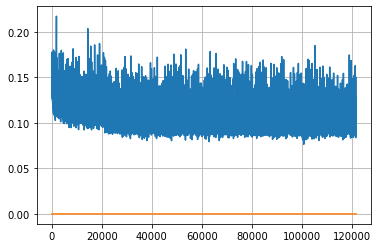

Epoch: 312, iteration 0, loss 0.10565513372421265, cov_diff 0.4166078912118175 cov_diff train 0.41595001658792613
Epoch: 312, iteration 1, loss 0.10293906927108765, cov_diff 0.40307367939500877 cov_diff train 0.40295795747910057
Epoch: 312, iteration 2, loss 0.09476399421691895, cov_diff 0.41736090232360734 cov_diff train 0.417598906238633
Epoch: 312, iteration 3, loss 0.10848703980445862, cov_diff 0.40992693197650293 cov_diff train 0.40967476764366606
Epoch: 312, iteration 4, loss 0.09960171580314636, cov_diff 0.4169534724660084 cov_diff train 0.41637826686313706
Epoch: 312, iteration 5, loss 0.10354554653167725, cov_diff 0.4194258622974915 cov_diff train 0.41887331765935143
Epoch: 312, iteration 6, loss 0.11088305711746216, cov_diff 0.41599038189627124 cov_diff train 0.41553744564154727
Epoch: 312, iteration 7, loss 0.11378160119056702, cov_diff 0.4149108385973413 cov_diff train 0.41487989922735713
Epoch: 312, iteration 8, loss 0.10692238807678223, cov_diff 0.40888440746114574 cov_di

Epoch: 312, iteration 72, loss 0.10879960656166077, cov_diff 0.39552035447375794 cov_diff train 0.3947437208620386
Epoch: 312, iteration 73, loss 0.11306962370872498, cov_diff 0.4102159746750639 cov_diff train 0.409599423534972
Epoch: 312, iteration 74, loss 0.10244882106781006, cov_diff 0.4061430922474743 cov_diff train 0.40615667560296626
Epoch: 312, iteration 75, loss 0.104361891746521, cov_diff 0.41179949962936274 cov_diff train 0.41161690920361
Epoch: 312, iteration 76, loss 0.10608053207397461, cov_diff 0.40110874393187 cov_diff train 0.4008660757180094
Epoch: 312, iteration 77, loss 0.09900540113449097, cov_diff 0.40504895524482876 cov_diff train 0.4048777796866182
Epoch: 312, iteration 78, loss 0.11050841212272644, cov_diff 0.4244773645263236 cov_diff train 0.42430493443438894
Epoch: 312, iteration 79, loss 0.10285764932632446, cov_diff 0.41589872580844667 cov_diff train 0.4158790112593183
Epoch: 312, iteration 80, loss 0.08269566297531128, cov_diff 0.40360650154358246 cov_diff

Epoch: 312, iteration 151, loss 0.10246771574020386, cov_diff 0.4125538753508546 cov_diff train 0.4110971780042585
Epoch: 312, iteration 152, loss 0.10415607690811157, cov_diff 0.41981277124138694 cov_diff train 0.41826347844249706
Epoch: 312, iteration 153, loss 0.11348164081573486, cov_diff 0.4161809516782969 cov_diff train 0.41531600936399815
Epoch: 312, iteration 154, loss 0.10373261570930481, cov_diff 0.4030754934368868 cov_diff train 0.4033683414662231
Epoch: 312, iteration 155, loss 0.10306930541992188, cov_diff 0.4150284919987429 cov_diff train 0.41420123097743894
Epoch: 312, iteration 156, loss 0.09785690903663635, cov_diff 0.41302466895376405 cov_diff train 0.4127226600564861
Epoch: 312, iteration 157, loss 0.118004709482193, cov_diff 0.4246004134844758 cov_diff train 0.4239229774571238
Epoch: 312, iteration 158, loss 0.11381793022155762, cov_diff 0.4170359345630183 cov_diff train 0.41572689160547754
Epoch: 312, iteration 159, loss 0.11706754565238953, cov_diff 0.420823760549

Epoch: 312, iteration 232, loss 0.11099863052368164, cov_diff 0.41036528067343864 cov_diff train 0.4107027527318021
Epoch: 312, iteration 233, loss 0.10606548190116882, cov_diff 0.4080195509903392 cov_diff train 0.40765821588710743
Epoch: 312, iteration 234, loss 0.09802475571632385, cov_diff 0.4059472853197981 cov_diff train 0.4054410323918837
Epoch: 312, iteration 235, loss 0.10130050778388977, cov_diff 0.41126546812489573 cov_diff train 0.41096092022732
Epoch: 312, iteration 236, loss 0.0968695878982544, cov_diff 0.4116229823880682 cov_diff train 0.41126317197111534
Epoch: 312, iteration 237, loss 0.09935224056243896, cov_diff 0.40971259852952335 cov_diff train 0.4090053178183454
Epoch: 312, iteration 238, loss 0.10486271977424622, cov_diff 0.41375714313802003 cov_diff train 0.41411871309423426
Epoch: 312, iteration 239, loss 0.10467159748077393, cov_diff 0.41730606848479657 cov_diff train 0.4164841115130288
Epoch: 312, iteration 240, loss 0.09438809752464294, cov_diff 0.42888193858

Epoch: 312, iteration 312, loss 0.09784045815467834, cov_diff 0.4116733911644934 cov_diff train 0.4111877462142207
Epoch: 312, iteration 313, loss 0.10923904180526733, cov_diff 0.41023839082417995 cov_diff train 0.41007285876191535
Epoch: 312, iteration 314, loss 0.09827211499214172, cov_diff 0.4136184167835745 cov_diff train 0.4129771087826746
Epoch: 312, iteration 315, loss 0.10030075907707214, cov_diff 0.41940757640693904 cov_diff train 0.41776806167494773
Epoch: 312, iteration 316, loss 0.1121678352355957, cov_diff 0.4256022097723056 cov_diff train 0.4249306674198441
Epoch: 312, iteration 317, loss 0.11133044958114624, cov_diff 0.41857922585814156 cov_diff train 0.4173619450986021
Epoch: 312, iteration 318, loss 0.09894099831581116, cov_diff 0.4000927817650973 cov_diff train 0.3992730860093651
Epoch: 312, iteration 319, loss 0.11018776893615723, cov_diff 0.41038283937166276 cov_diff train 0.408266640575148
Epoch: 312, iteration 320, loss 0.09977364540100098, cov_diff 0.410578446027

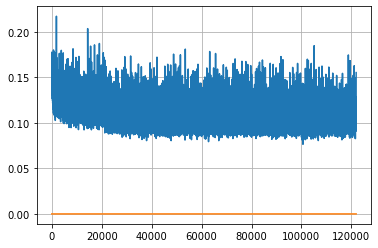

Epoch: 313, iteration 0, loss 0.09260612726211548, cov_diff 0.41484740919054774 cov_diff train 0.4143620008396812
Epoch: 313, iteration 1, loss 0.10396239161491394, cov_diff 0.4207600336154549 cov_diff train 0.4200563113127324
Epoch: 313, iteration 2, loss 0.10309499502182007, cov_diff 0.41109911997317344 cov_diff train 0.4107128976195369
Epoch: 313, iteration 3, loss 0.10630115866661072, cov_diff 0.4112410370682371 cov_diff train 0.41039673017764033
Epoch: 313, iteration 4, loss 0.11535954475402832, cov_diff 0.40771585400594107 cov_diff train 0.40717871830047436
Epoch: 313, iteration 5, loss 0.10477831959724426, cov_diff 0.4220454206732649 cov_diff train 0.4204719331444957
Epoch: 313, iteration 6, loss 0.11490926146507263, cov_diff 0.4159628585674019 cov_diff train 0.41568022345926164
Epoch: 313, iteration 7, loss 0.11149194836616516, cov_diff 0.4211387702344819 cov_diff train 0.42061118463560826
Epoch: 313, iteration 8, loss 0.1182171106338501, cov_diff 0.41753020629442805 cov_diff t

Epoch: 313, iteration 81, loss 0.08754792809486389, cov_diff 0.41398513423767425 cov_diff train 0.41367064257531233
Epoch: 313, iteration 82, loss 0.11107701063156128, cov_diff 0.40743501442047747 cov_diff train 0.4077109636725032
Epoch: 313, iteration 83, loss 0.11215052008628845, cov_diff 0.41763006187076707 cov_diff train 0.4169078677372364
Epoch: 313, iteration 84, loss 0.0926361083984375, cov_diff 0.41898106907167587 cov_diff train 0.4182393534811668
Epoch: 313, iteration 85, loss 0.10099828243255615, cov_diff 0.41188538413195525 cov_diff train 0.41179021574293545
Epoch: 313, iteration 86, loss 0.10528320074081421, cov_diff 0.41700661002859185 cov_diff train 0.41647373585593545
Epoch: 313, iteration 87, loss 0.1030745804309845, cov_diff 0.4153613784263994 cov_diff train 0.4151691095329807
Epoch: 313, iteration 88, loss 0.10487544536590576, cov_diff 0.40636703557581483 cov_diff train 0.4051064842356403
Epoch: 313, iteration 89, loss 0.11008214950561523, cov_diff 0.41167578641574565

Epoch: 313, iteration 160, loss 0.12466344237327576, cov_diff 0.3987219689105321 cov_diff train 0.3973691436786047
Epoch: 313, iteration 161, loss 0.09460562467575073, cov_diff 0.40491805176927986 cov_diff train 0.40421439889304084
Epoch: 313, iteration 162, loss 0.10750755667686462, cov_diff 0.41487546360949695 cov_diff train 0.41445682314271515
Epoch: 313, iteration 163, loss 0.1041824221611023, cov_diff 0.4001727855381382 cov_diff train 0.39991047986163253
Epoch: 313, iteration 164, loss 0.1033734381198883, cov_diff 0.41690329380679775 cov_diff train 0.4163258938729561
Epoch: 313, iteration 165, loss 0.10134640336036682, cov_diff 0.40675497411493794 cov_diff train 0.40626555495147837
Epoch: 313, iteration 166, loss 0.10008043050765991, cov_diff 0.3967266839808806 cov_diff train 0.3960302235503571
Epoch: 313, iteration 167, loss 0.0977984070777893, cov_diff 0.4016843716518911 cov_diff train 0.40198811777993004
Epoch: 313, iteration 168, loss 0.09638673067092896, cov_diff 0.3984697143

Epoch: 313, iteration 241, loss 0.10314935445785522, cov_diff 0.3989291417877882 cov_diff train 0.3984069564487186
Epoch: 313, iteration 242, loss 0.10100027918815613, cov_diff 0.41157976245411393 cov_diff train 0.4115584888934805
Epoch: 313, iteration 243, loss 0.09906196594238281, cov_diff 0.40698688651801396 cov_diff train 0.4070230016346547
Epoch: 313, iteration 244, loss 0.10015544295310974, cov_diff 0.4134167496194361 cov_diff train 0.41297082579191313
Epoch: 313, iteration 245, loss 0.11005282402038574, cov_diff 0.40028115822132637 cov_diff train 0.3987879060341666
Epoch: 313, iteration 246, loss 0.09651648998260498, cov_diff 0.39860785786151803 cov_diff train 0.3974874387761705
Epoch: 313, iteration 247, loss 0.09753140807151794, cov_diff 0.4152812097416301 cov_diff train 0.4146910112343754
Epoch: 313, iteration 248, loss 0.10151058435440063, cov_diff 0.4101370601401227 cov_diff train 0.4096028024121875
Epoch: 313, iteration 249, loss 0.10168370604515076, cov_diff 0.40876354194

Epoch: 313, iteration 318, loss 0.10009181499481201, cov_diff 0.4211334621875636 cov_diff train 0.41993341206973966
Epoch: 313, iteration 319, loss 0.10206648707389832, cov_diff 0.39717747117314905 cov_diff train 0.39689178213783705
Epoch: 313, iteration 320, loss 0.11274781823158264, cov_diff 0.42901676036442155 cov_diff train 0.4269375694343459
Epoch: 313, iteration 321, loss 0.10548773407936096, cov_diff 0.4102433019121924 cov_diff train 0.40985426517848417
Epoch: 313, iteration 322, loss 0.10421550273895264, cov_diff 0.4121520885918238 cov_diff train 0.41045782112989065
Epoch: 313, iteration 323, loss 0.10066711902618408, cov_diff 0.4003003277878057 cov_diff train 0.39899308157307856
Epoch: 313, iteration 324, loss 0.10168930888175964, cov_diff 0.40690653373942826 cov_diff train 0.4063561678753438
Epoch: 313, iteration 325, loss 0.10542941093444824, cov_diff 0.4216401222721286 cov_diff train 0.4212458004534141
Epoch: 313, iteration 326, loss 0.0956229567527771, cov_diff 0.419006313

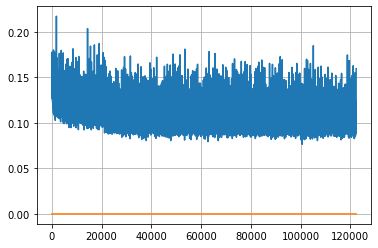

Epoch: 314, iteration 0, loss 0.10200035572052002, cov_diff 0.42015921500588566 cov_diff train 0.4194286977822771
Epoch: 314, iteration 1, loss 0.1010623574256897, cov_diff 0.42366842018436274 cov_diff train 0.42367976224382636
Epoch: 314, iteration 2, loss 0.10349830985069275, cov_diff 0.42481890405289285 cov_diff train 0.42499480329820577
Epoch: 314, iteration 3, loss 0.08999717235565186, cov_diff 0.39258381180895113 cov_diff train 0.39174887968438377
Epoch: 314, iteration 4, loss 0.11072981357574463, cov_diff 0.41464441135548946 cov_diff train 0.41405109503761833
Epoch: 314, iteration 5, loss 0.10045996308326721, cov_diff 0.42097580461246786 cov_diff train 0.42062786831734056
Epoch: 314, iteration 6, loss 0.09777116775512695, cov_diff 0.40474185530393325 cov_diff train 0.40371731952077833
Epoch: 314, iteration 7, loss 0.09816071391105652, cov_diff 0.4166049874754654 cov_diff train 0.4159520047667021
Epoch: 314, iteration 8, loss 0.09614959359169006, cov_diff 0.41652078974499807 cov_

Epoch: 314, iteration 79, loss 0.10058063268661499, cov_diff 0.4164963692138329 cov_diff train 0.4152399517145083
Epoch: 314, iteration 80, loss 0.09945794939994812, cov_diff 0.415166635910924 cov_diff train 0.4140592674282675
Epoch: 314, iteration 81, loss 0.09695702791213989, cov_diff 0.4105346596630108 cov_diff train 0.4101112965514799
Epoch: 314, iteration 82, loss 0.10334864258766174, cov_diff 0.4161778418894086 cov_diff train 0.41461999323684595
Epoch: 314, iteration 83, loss 0.11363205313682556, cov_diff 0.4089240355839501 cov_diff train 0.4075463970994603
Epoch: 314, iteration 84, loss 0.10887262225151062, cov_diff 0.415661320128179 cov_diff train 0.4134541163456817
Epoch: 314, iteration 85, loss 0.09637817740440369, cov_diff 0.4189989773009628 cov_diff train 0.4178837514510482
Epoch: 314, iteration 86, loss 0.08578082919120789, cov_diff 0.416893119313668 cov_diff train 0.4158282193506862
Epoch: 314, iteration 87, loss 0.10187935829162598, cov_diff 0.4159252173863383 cov_diff t

Epoch: 314, iteration 157, loss 0.10806882381439209, cov_diff 0.4018569811913327 cov_diff train 0.4024024285681691
Epoch: 314, iteration 158, loss 0.12257358431816101, cov_diff 0.4260544015944354 cov_diff train 0.42609294268704806
Epoch: 314, iteration 159, loss 0.10235872864723206, cov_diff 0.4137541423200953 cov_diff train 0.4136197217356185
Epoch: 314, iteration 160, loss 0.09194982051849365, cov_diff 0.41802784130140025 cov_diff train 0.4168514692361406
Epoch: 314, iteration 161, loss 0.10902681946754456, cov_diff 0.41229621657890175 cov_diff train 0.41152566760490294
Epoch: 314, iteration 162, loss 0.10187962651252747, cov_diff 0.4161285369465167 cov_diff train 0.41548680853080855
Epoch: 314, iteration 163, loss 0.10048568248748779, cov_diff 0.4077046202433309 cov_diff train 0.40726910330469984
Epoch: 314, iteration 164, loss 0.10867869853973389, cov_diff 0.4070827728522615 cov_diff train 0.40476472460372015
Epoch: 314, iteration 165, loss 0.10537388920783997, cov_diff 0.414569308

Epoch: 314, iteration 233, loss 0.11495700478553772, cov_diff 0.4153773124657526 cov_diff train 0.41446509058598424
Epoch: 314, iteration 234, loss 0.09935355186462402, cov_diff 0.41292871076554577 cov_diff train 0.41304852123585994
Epoch: 314, iteration 235, loss 0.09196430444717407, cov_diff 0.40553192468886934 cov_diff train 0.40501430673715494
Epoch: 314, iteration 236, loss 0.09910783171653748, cov_diff 0.41290606258164536 cov_diff train 0.4126023947841665
Epoch: 314, iteration 237, loss 0.10293596982955933, cov_diff 0.4172339117236166 cov_diff train 0.416596119730701
Epoch: 314, iteration 238, loss 0.10752657055854797, cov_diff 0.4127076129165536 cov_diff train 0.4120793782252231
Epoch: 314, iteration 239, loss 0.10461625456809998, cov_diff 0.41280047618113874 cov_diff train 0.413044762216977
Epoch: 314, iteration 240, loss 0.11817517876625061, cov_diff 0.40995182051685813 cov_diff train 0.40888138047627176
Epoch: 314, iteration 241, loss 0.10891038179397583, cov_diff 0.416431956

Epoch: 314, iteration 312, loss 0.11092376708984375, cov_diff 0.4144646925747517 cov_diff train 0.4140971041970976
Epoch: 314, iteration 313, loss 0.09115734696388245, cov_diff 0.40305758671805664 cov_diff train 0.4029994159516126
Epoch: 314, iteration 314, loss 0.09786885976791382, cov_diff 0.41400949433113393 cov_diff train 0.41403089113433966
Epoch: 314, iteration 315, loss 0.1127977967262268, cov_diff 0.413059120284558 cov_diff train 0.41335684135055756
Epoch: 314, iteration 316, loss 0.09970781207084656, cov_diff 0.4107265300634448 cov_diff train 0.4104529542323082
Epoch: 314, iteration 317, loss 0.11225572228431702, cov_diff 0.4049210083958151 cov_diff train 0.40367443948996734
Epoch: 314, iteration 318, loss 0.11589697003364563, cov_diff 0.4097636425484165 cov_diff train 0.4089724659714986
Epoch: 314, iteration 319, loss 0.09377580881118774, cov_diff 0.4178362673010499 cov_diff train 0.41688828715796017
Epoch: 314, iteration 320, loss 0.10317531228065491, cov_diff 0.416598208161

Epoch: 314, iteration 390, loss 0.13764029741287231, cov_diff 0.4495737610785818 cov_diff train 0.445535509605749


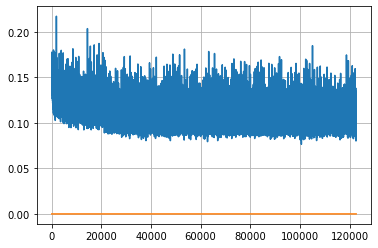

Epoch: 315, iteration 0, loss 0.09981784224510193, cov_diff 0.407812734710689 cov_diff train 0.40789135607036536
Epoch: 315, iteration 1, loss 0.09486210346221924, cov_diff 0.4331337992397426 cov_diff train 0.42995864116595556
Epoch: 315, iteration 2, loss 0.11901292204856873, cov_diff 0.3983776345172961 cov_diff train 0.3986288561810279
Epoch: 315, iteration 3, loss 0.1081700325012207, cov_diff 0.4127951867237204 cov_diff train 0.41173311278822666
Epoch: 315, iteration 4, loss 0.09623286128044128, cov_diff 0.40495236754812164 cov_diff train 0.40480232966017066
Epoch: 315, iteration 5, loss 0.11907204985618591, cov_diff 0.415232786258416 cov_diff train 0.4144491258114773
Epoch: 315, iteration 6, loss 0.11071261763572693, cov_diff 0.4198641195350352 cov_diff train 0.42023684183334215
Epoch: 315, iteration 7, loss 0.10367366671562195, cov_diff 0.4092776207104345 cov_diff train 0.4088340488440733
Epoch: 315, iteration 8, loss 0.09873265027999878, cov_diff 0.4173059412457474 cov_diff train

Epoch: 315, iteration 74, loss 0.1061488687992096, cov_diff 0.4105441407187623 cov_diff train 0.4096103059019674
Epoch: 315, iteration 75, loss 0.09882575273513794, cov_diff 0.40479896933151066 cov_diff train 0.4046176972353508
Epoch: 315, iteration 76, loss 0.10927680134773254, cov_diff 0.42224680061005726 cov_diff train 0.4215007023748947
Epoch: 315, iteration 77, loss 0.11879104375839233, cov_diff 0.40141390226705337 cov_diff train 0.4017150436029157
Epoch: 315, iteration 78, loss 0.11323633790016174, cov_diff 0.414489926366825 cov_diff train 0.41390714242640075
Epoch: 315, iteration 79, loss 0.11298969388008118, cov_diff 0.4095689325389729 cov_diff train 0.4093343072191824
Epoch: 315, iteration 80, loss 0.11162540316581726, cov_diff 0.410405261863568 cov_diff train 0.4105586473972277
Epoch: 315, iteration 81, loss 0.09914928674697876, cov_diff 0.40276355584472173 cov_diff train 0.4034353417841764
Epoch: 315, iteration 82, loss 0.10387381911277771, cov_diff 0.40237941022641355 cov_d

Epoch: 315, iteration 150, loss 0.10605522990226746, cov_diff 0.4115899583649275 cov_diff train 0.41122989953927525
Epoch: 315, iteration 151, loss 0.10089799761772156, cov_diff 0.4111636623324763 cov_diff train 0.4107136460865361
Epoch: 315, iteration 152, loss 0.1084548830986023, cov_diff 0.4112511466772877 cov_diff train 0.41058538836834263
Epoch: 315, iteration 153, loss 0.09571841359138489, cov_diff 0.4151278974755833 cov_diff train 0.4148546696184381
Epoch: 315, iteration 154, loss 0.11170819401741028, cov_diff 0.40753934889582066 cov_diff train 0.4068017745850205
Epoch: 315, iteration 155, loss 0.11531639099121094, cov_diff 0.41261262323147607 cov_diff train 0.4116303593109038
Epoch: 315, iteration 156, loss 0.10654741525650024, cov_diff 0.41137854035932664 cov_diff train 0.4114448233955001
Epoch: 315, iteration 157, loss 0.10043814778327942, cov_diff 0.42019599839358135 cov_diff train 0.4192834636214741
Epoch: 315, iteration 158, loss 0.11024561524391174, cov_diff 0.40173095072

Epoch: 315, iteration 228, loss 0.10584503412246704, cov_diff 0.41708333547284804 cov_diff train 0.4165524876652582
Epoch: 315, iteration 229, loss 0.10066094994544983, cov_diff 0.41534044085546895 cov_diff train 0.4146694790548833
Epoch: 315, iteration 230, loss 0.10058262944221497, cov_diff 0.4037043854398261 cov_diff train 0.40279228162060243
Epoch: 315, iteration 231, loss 0.10936513543128967, cov_diff 0.42218840282280257 cov_diff train 0.4216292140391964
Epoch: 315, iteration 232, loss 0.09818139672279358, cov_diff 0.4087927557387503 cov_diff train 0.4072868031186723
Epoch: 315, iteration 233, loss 0.10708528757095337, cov_diff 0.418923666979555 cov_diff train 0.4178270725349694
Epoch: 315, iteration 234, loss 0.0985063910484314, cov_diff 0.41742014183058757 cov_diff train 0.4170042910149715
Epoch: 315, iteration 235, loss 0.09562444686889648, cov_diff 0.4177581302253753 cov_diff train 0.41701666297919615
Epoch: 315, iteration 236, loss 0.10044971108436584, cov_diff 0.393046278257

Epoch: 315, iteration 307, loss 0.10345655679702759, cov_diff 0.41391044891936374 cov_diff train 0.4127083557809656
Epoch: 315, iteration 308, loss 0.1009332537651062, cov_diff 0.40577655219542635 cov_diff train 0.40563089222401993
Epoch: 315, iteration 309, loss 0.10144969820976257, cov_diff 0.4071397427464177 cov_diff train 0.4076501585872127
Epoch: 315, iteration 310, loss 0.09738725423812866, cov_diff 0.39899791785424565 cov_diff train 0.3992365366522122
Epoch: 315, iteration 311, loss 0.09655019640922546, cov_diff 0.4071117790814997 cov_diff train 0.40731455374955144
Epoch: 315, iteration 312, loss 0.10020136833190918, cov_diff 0.41455699537794877 cov_diff train 0.4147559985494886
Epoch: 315, iteration 313, loss 0.09427425265312195, cov_diff 0.40615093688656057 cov_diff train 0.40588463087611804
Epoch: 315, iteration 314, loss 0.10482984781265259, cov_diff 0.4135340811043469 cov_diff train 0.4135372442197674
Epoch: 315, iteration 315, loss 0.10324636101722717, cov_diff 0.403684910

Epoch: 315, iteration 383, loss 0.10875111818313599, cov_diff 0.4093668873402829 cov_diff train 0.40841048482645104
Epoch: 315, iteration 384, loss 0.08932489156723022, cov_diff 0.41572066160919263 cov_diff train 0.41500704707703884
Epoch: 315, iteration 385, loss 0.10342726111412048, cov_diff 0.4157090962950034 cov_diff train 0.4147287172031421
Epoch: 315, iteration 386, loss 0.10709965229034424, cov_diff 0.40589022173881456 cov_diff train 0.405021888847592
Epoch: 315, iteration 387, loss 0.11643263697624207, cov_diff 0.407482922532914 cov_diff train 0.40645977425149477
Epoch: 315, iteration 388, loss 0.1045272946357727, cov_diff 0.4086845083321034 cov_diff train 0.4075696981892007
Epoch: 315, iteration 389, loss 0.09421297907829285, cov_diff 0.4244444409877314 cov_diff train 0.4233064434306306
Epoch: 315, iteration 390, loss 0.14121106266975403, cov_diff 0.4552219010807087 cov_diff train 0.455287856649389


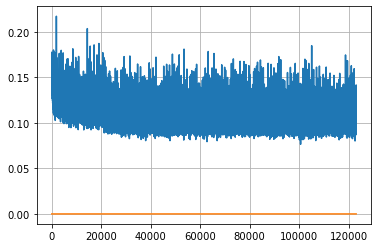

Epoch: 316, iteration 0, loss 0.1058291494846344, cov_diff 0.40135360020921595 cov_diff train 0.4003932760438622
Epoch: 316, iteration 1, loss 0.10555294156074524, cov_diff 0.41106596019918307 cov_diff train 0.4106163533648843
Epoch: 316, iteration 2, loss 0.10587656497955322, cov_diff 0.40977103384180635 cov_diff train 0.4102763261679308
Epoch: 316, iteration 3, loss 0.09961232542991638, cov_diff 0.41770763709645164 cov_diff train 0.41719287290748336
Epoch: 316, iteration 4, loss 0.0945284366607666, cov_diff 0.42206696351954237 cov_diff train 0.42143450830755935
Epoch: 316, iteration 5, loss 0.12132605910301208, cov_diff 0.40430621654323756 cov_diff train 0.40409658281647176
Epoch: 316, iteration 6, loss 0.10270142555236816, cov_diff 0.4056302722522203 cov_diff train 0.4053115096902635
Epoch: 316, iteration 7, loss 0.10147687792778015, cov_diff 0.41757481111719214 cov_diff train 0.41780776896596933
Epoch: 316, iteration 8, loss 0.10413125157356262, cov_diff 0.4127503084141851 cov_diff

Epoch: 316, iteration 78, loss 0.1003328263759613, cov_diff 0.41725090704874074 cov_diff train 0.4170031345699106
Epoch: 316, iteration 79, loss 0.10082674026489258, cov_diff 0.4073992724555021 cov_diff train 0.40702337337621197
Epoch: 316, iteration 80, loss 0.09525299072265625, cov_diff 0.41581716367948507 cov_diff train 0.4151489736900037
Epoch: 316, iteration 81, loss 0.1039169430732727, cov_diff 0.40062312601246824 cov_diff train 0.3997866461421434
Epoch: 316, iteration 82, loss 0.09675085544586182, cov_diff 0.4130992470477271 cov_diff train 0.41200150397815216
Epoch: 316, iteration 83, loss 0.11183655261993408, cov_diff 0.41296893425391007 cov_diff train 0.4123048105543406
Epoch: 316, iteration 84, loss 0.09760373830795288, cov_diff 0.39646270633908753 cov_diff train 0.39645176982293623
Epoch: 316, iteration 85, loss 0.11490526795387268, cov_diff 0.41397643805701473 cov_diff train 0.41305004672288703
Epoch: 316, iteration 86, loss 0.101997971534729, cov_diff 0.41060809536115056 c

Epoch: 316, iteration 155, loss 0.10537263751029968, cov_diff 0.4166635202029153 cov_diff train 0.41540657663848135
Epoch: 316, iteration 156, loss 0.10564714670181274, cov_diff 0.42185142863661795 cov_diff train 0.4199918428923315
Epoch: 316, iteration 157, loss 0.10456201434135437, cov_diff 0.4101349028226124 cov_diff train 0.40844868267770923
Epoch: 316, iteration 158, loss 0.09400078654289246, cov_diff 0.4093064796351271 cov_diff train 0.4080691835274963
Epoch: 316, iteration 159, loss 0.11139091849327087, cov_diff 0.4204085164834437 cov_diff train 0.41913846899255036
Epoch: 316, iteration 160, loss 0.10615578293800354, cov_diff 0.4140479954223429 cov_diff train 0.41358220389879585
Epoch: 316, iteration 161, loss 0.10229134559631348, cov_diff 0.38769434759430627 cov_diff train 0.3868359379312298
Epoch: 316, iteration 162, loss 0.11496996879577637, cov_diff 0.39912823589310975 cov_diff train 0.39848780012710144
Epoch: 316, iteration 163, loss 0.10523155331611633, cov_diff 0.41656050

Epoch: 316, iteration 232, loss 0.09760987758636475, cov_diff 0.4149194910972566 cov_diff train 0.41445899737944114
Epoch: 316, iteration 233, loss 0.09792551398277283, cov_diff 0.40051423339866216 cov_diff train 0.40000250275535154
Epoch: 316, iteration 234, loss 0.09958076477050781, cov_diff 0.41904675648494577 cov_diff train 0.4183743218707061
Epoch: 316, iteration 235, loss 0.10546359419822693, cov_diff 0.40192202755531753 cov_diff train 0.4010544572897899
Epoch: 316, iteration 236, loss 0.10629475116729736, cov_diff 0.4098560860657894 cov_diff train 0.4092008682285149
Epoch: 316, iteration 237, loss 0.10564163327217102, cov_diff 0.40539109958371955 cov_diff train 0.40457886301301144
Epoch: 316, iteration 238, loss 0.10498273372650146, cov_diff 0.43083977711671795 cov_diff train 0.4302788309924973
Epoch: 316, iteration 239, loss 0.09625256061553955, cov_diff 0.4174273548335535 cov_diff train 0.41692385070929927
Epoch: 316, iteration 240, loss 0.10655215382575989, cov_diff 0.4144013

Epoch: 316, iteration 310, loss 0.10291063785552979, cov_diff 0.3998034740363669 cov_diff train 0.3987115449990008
Epoch: 316, iteration 311, loss 0.09974223375320435, cov_diff 0.409543870593619 cov_diff train 0.4092701497700581
Epoch: 316, iteration 312, loss 0.09929385781288147, cov_diff 0.3992920776069298 cov_diff train 0.39894532625995016
Epoch: 316, iteration 313, loss 0.10210815072059631, cov_diff 0.4124287739989177 cov_diff train 0.4125161249140685
Epoch: 316, iteration 314, loss 0.09607729315757751, cov_diff 0.40225871575381533 cov_diff train 0.4021538808962213
Epoch: 316, iteration 315, loss 0.10918134450912476, cov_diff 0.4055302353125176 cov_diff train 0.4056251885755177
Epoch: 316, iteration 316, loss 0.11106011271476746, cov_diff 0.40771950392349665 cov_diff train 0.4079422434943482
Epoch: 316, iteration 317, loss 0.10989609360694885, cov_diff 0.4201780315635915 cov_diff train 0.4198486393661082
Epoch: 316, iteration 318, loss 0.10277467966079712, cov_diff 0.41605353278340

Epoch: 316, iteration 386, loss 0.10528135299682617, cov_diff 0.43121691891118036 cov_diff train 0.4306959570161591
Epoch: 316, iteration 387, loss 0.10660135746002197, cov_diff 0.42367937106371395 cov_diff train 0.4224219451521192
Epoch: 316, iteration 388, loss 0.11117106676101685, cov_diff 0.4201983062781092 cov_diff train 0.419420463638282
Epoch: 316, iteration 389, loss 0.09739795327186584, cov_diff 0.40919669880338183 cov_diff train 0.40818119213124343
Epoch: 316, iteration 390, loss 0.1473737359046936, cov_diff 0.4459550720190035 cov_diff train 0.4449323104333955


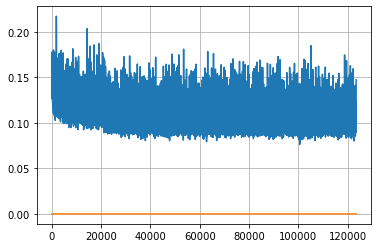

Epoch: 317, iteration 0, loss 0.10393407940864563, cov_diff 0.4127007904014837 cov_diff train 0.41004969587841006
Epoch: 317, iteration 1, loss 0.10074654221534729, cov_diff 0.4018654880919978 cov_diff train 0.4004081064282866
Epoch: 317, iteration 2, loss 0.09971800446510315, cov_diff 0.39818142832201203 cov_diff train 0.3975293735692525
Epoch: 317, iteration 3, loss 0.10242089629173279, cov_diff 0.3975087383983467 cov_diff train 0.3974685035226399
Epoch: 317, iteration 4, loss 0.10626301169395447, cov_diff 0.4051978666618159 cov_diff train 0.40544339272201046
Epoch: 317, iteration 5, loss 0.10014405846595764, cov_diff 0.4016893384969419 cov_diff train 0.40162797060951155
Epoch: 317, iteration 6, loss 0.10640406608581543, cov_diff 0.38964417707576643 cov_diff train 0.3894574807026686
Epoch: 317, iteration 7, loss 0.09950202703475952, cov_diff 0.41621123943622224 cov_diff train 0.4149396418604413
Epoch: 317, iteration 8, loss 0.10503491759300232, cov_diff 0.4078331399690724 cov_diff tr

Epoch: 317, iteration 78, loss 0.09595346450805664, cov_diff 0.416795334826772 cov_diff train 0.41551038065654217
Epoch: 317, iteration 79, loss 0.11230999231338501, cov_diff 0.40545863615938027 cov_diff train 0.40354291763816563
Epoch: 317, iteration 80, loss 0.10884147882461548, cov_diff 0.40478023695596865 cov_diff train 0.40365652310362976
Epoch: 317, iteration 81, loss 0.09323582053184509, cov_diff 0.40365611778550164 cov_diff train 0.4031350489288298
Epoch: 317, iteration 82, loss 0.10086414217948914, cov_diff 0.40454368592896994 cov_diff train 0.40466921126596495
Epoch: 317, iteration 83, loss 0.11618539690971375, cov_diff 0.4207560855706092 cov_diff train 0.41968673184879385
Epoch: 317, iteration 84, loss 0.11410200595855713, cov_diff 0.42064085180420124 cov_diff train 0.4194307189041725
Epoch: 317, iteration 85, loss 0.11758381128311157, cov_diff 0.4049539904168979 cov_diff train 0.4045651427311439
Epoch: 317, iteration 86, loss 0.10947248339653015, cov_diff 0.4075137418256843

Epoch: 317, iteration 155, loss 0.11419886350631714, cov_diff 0.4210617126121136 cov_diff train 0.4205189068443003
Epoch: 317, iteration 156, loss 0.09641939401626587, cov_diff 0.41747200650847094 cov_diff train 0.41649104126594017
Epoch: 317, iteration 157, loss 0.10961255431175232, cov_diff 0.41498575524636916 cov_diff train 0.41312790688560136
Epoch: 317, iteration 158, loss 0.09240606427192688, cov_diff 0.41402816941285087 cov_diff train 0.412972627043073
Epoch: 317, iteration 159, loss 0.1004548966884613, cov_diff 0.4210817359182455 cov_diff train 0.41992681646966723
Epoch: 317, iteration 160, loss 0.09979939460754395, cov_diff 0.41407765533746904 cov_diff train 0.41321461282082694
Epoch: 317, iteration 161, loss 0.10198071599006653, cov_diff 0.4249845296266924 cov_diff train 0.42375247195054994
Epoch: 317, iteration 162, loss 0.10337147116661072, cov_diff 0.4003820552814734 cov_diff train 0.39983962555617264
Epoch: 317, iteration 163, loss 0.10287055373191833, cov_diff 0.41515767

Epoch: 317, iteration 232, loss 0.09374511241912842, cov_diff 0.4079001601699743 cov_diff train 0.4076929276726391
Epoch: 317, iteration 233, loss 0.10039710998535156, cov_diff 0.3985692463551511 cov_diff train 0.39748737085515645
Epoch: 317, iteration 234, loss 0.10578161478042603, cov_diff 0.4226109196327859 cov_diff train 0.4214887397752354
Epoch: 317, iteration 235, loss 0.09596291184425354, cov_diff 0.4172176532405862 cov_diff train 0.41676399682061815
Epoch: 317, iteration 236, loss 0.10816898941993713, cov_diff 0.4260354908910501 cov_diff train 0.4254356747521178
Epoch: 317, iteration 237, loss 0.09439685940742493, cov_diff 0.41490063165963104 cov_diff train 0.41404520474050743
Epoch: 317, iteration 238, loss 0.108592689037323, cov_diff 0.4144661637695889 cov_diff train 0.41366138840179056
Epoch: 317, iteration 239, loss 0.09810394048690796, cov_diff 0.41247246768336615 cov_diff train 0.4116029225936266
Epoch: 317, iteration 240, loss 0.10239222645759583, cov_diff 0.415363603782

Epoch: 317, iteration 307, loss 0.10615938901901245, cov_diff 0.412323736263971 cov_diff train 0.4119324352456611
Epoch: 317, iteration 308, loss 0.09855934977531433, cov_diff 0.4184231811091655 cov_diff train 0.41725219776852757
Epoch: 317, iteration 309, loss 0.10648247599601746, cov_diff 0.4089309517543604 cov_diff train 0.4079429590647318
Epoch: 317, iteration 310, loss 0.11423748731613159, cov_diff 0.4114937082618024 cov_diff train 0.4101389404842526
Epoch: 317, iteration 311, loss 0.10853642225265503, cov_diff 0.4209422937547409 cov_diff train 0.4202127198634465
Epoch: 317, iteration 312, loss 0.10631802678108215, cov_diff 0.40139849711326264 cov_diff train 0.4002011159188615
Epoch: 317, iteration 313, loss 0.11085355281829834, cov_diff 0.4066050043206338 cov_diff train 0.4057216339605192
Epoch: 317, iteration 314, loss 0.10029655694961548, cov_diff 0.40491966819309005 cov_diff train 0.40355158028630583
Epoch: 317, iteration 315, loss 0.10434672236442566, cov_diff 0.4130948364855

Epoch: 317, iteration 384, loss 0.10150229930877686, cov_diff 0.403681583001426 cov_diff train 0.40288665936366697
Epoch: 317, iteration 385, loss 0.10669821500778198, cov_diff 0.40760227660716236 cov_diff train 0.407796968082372
Epoch: 317, iteration 386, loss 0.1033724844455719, cov_diff 0.41361848504342263 cov_diff train 0.4127534070967149
Epoch: 317, iteration 387, loss 0.09865960478782654, cov_diff 0.41560776505978814 cov_diff train 0.41523836419629273
Epoch: 317, iteration 388, loss 0.09369069337844849, cov_diff 0.41267054073032017 cov_diff train 0.41210449407453237
Epoch: 317, iteration 389, loss 0.09880062937736511, cov_diff 0.3968419077954342 cov_diff train 0.3969274034448638
Epoch: 317, iteration 390, loss 0.16089704632759094, cov_diff 0.43365914646474096 cov_diff train 0.43303247061018585


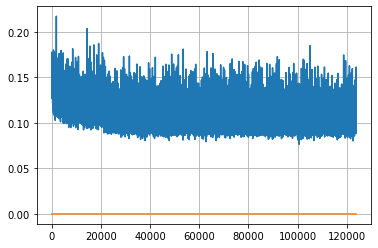

Epoch: 318, iteration 0, loss 0.1008310317993164, cov_diff 0.4193857017968443 cov_diff train 0.41904992244282546
Epoch: 318, iteration 1, loss 0.10044145584106445, cov_diff 0.4076754815589026 cov_diff train 0.40819828266394237
Epoch: 318, iteration 2, loss 0.09791579842567444, cov_diff 0.41321420134139886 cov_diff train 0.41249791246654716
Epoch: 318, iteration 3, loss 0.10218498110771179, cov_diff 0.4009667386574028 cov_diff train 0.4009322215005378
Epoch: 318, iteration 4, loss 0.10271090269088745, cov_diff 0.41875317733701356 cov_diff train 0.41823258489425374
Epoch: 318, iteration 5, loss 0.10479459166526794, cov_diff 0.4048488980774336 cov_diff train 0.4047993719965391
Epoch: 318, iteration 6, loss 0.10039892792701721, cov_diff 0.4078494254086275 cov_diff train 0.4070083975489845
Epoch: 318, iteration 7, loss 0.10953643918037415, cov_diff 0.40959402094812997 cov_diff train 0.40889163468708556
Epoch: 318, iteration 8, loss 0.09796127676963806, cov_diff 0.41331698493379715 cov_diff 

Epoch: 318, iteration 75, loss 0.10118463635444641, cov_diff 0.4018967960509015 cov_diff train 0.40127584161277363
Epoch: 318, iteration 76, loss 0.10471662878990173, cov_diff 0.4069467558421049 cov_diff train 0.4057254586690503
Epoch: 318, iteration 77, loss 0.10228985548019409, cov_diff 0.40809868291910206 cov_diff train 0.4066840434640763
Epoch: 318, iteration 78, loss 0.0966995358467102, cov_diff 0.39979827858251815 cov_diff train 0.39849874333993934
Epoch: 318, iteration 79, loss 0.10803291201591492, cov_diff 0.4049266693432896 cov_diff train 0.40392240179185424
Epoch: 318, iteration 80, loss 0.10250791907310486, cov_diff 0.406574005014173 cov_diff train 0.4059384867513939
Epoch: 318, iteration 81, loss 0.09703895449638367, cov_diff 0.39564568615932605 cov_diff train 0.3947272979331563
Epoch: 318, iteration 82, loss 0.10601818561553955, cov_diff 0.4210278447964611 cov_diff train 0.41988802310090456
Epoch: 318, iteration 83, loss 0.10531464219093323, cov_diff 0.40948685845250266 co

Epoch: 318, iteration 153, loss 0.1171199381351471, cov_diff 0.40241686113662883 cov_diff train 0.4009144532543695
Epoch: 318, iteration 154, loss 0.10377386212348938, cov_diff 0.41022483012222927 cov_diff train 0.41026933744855454
Epoch: 318, iteration 155, loss 0.11153978109359741, cov_diff 0.4093045167113253 cov_diff train 0.40970827483996597
Epoch: 318, iteration 156, loss 0.11421826481819153, cov_diff 0.40430895026992736 cov_diff train 0.4052513074692484
Epoch: 318, iteration 157, loss 0.11489677429199219, cov_diff 0.41368527282232853 cov_diff train 0.41447776662280567
Epoch: 318, iteration 158, loss 0.10608857870101929, cov_diff 0.4044759963414391 cov_diff train 0.4045244188362612
Epoch: 318, iteration 159, loss 0.10802161693572998, cov_diff 0.4047701493029499 cov_diff train 0.4051214066115663
Epoch: 318, iteration 160, loss 0.09854969382286072, cov_diff 0.40313554841252264 cov_diff train 0.4032198225731752
Epoch: 318, iteration 161, loss 0.09891325235366821, cov_diff 0.400801184

Epoch: 318, iteration 232, loss 0.10798662900924683, cov_diff 0.4215971630143521 cov_diff train 0.4211535337284441
Epoch: 318, iteration 233, loss 0.10338842868804932, cov_diff 0.4129662502577586 cov_diff train 0.4128693991479123
Epoch: 318, iteration 234, loss 0.10663232207298279, cov_diff 0.4138519780292839 cov_diff train 0.4134791618997667
Epoch: 318, iteration 235, loss 0.09629932045936584, cov_diff 0.4106009210281069 cov_diff train 0.4095520842921429
Epoch: 318, iteration 236, loss 0.10092446208000183, cov_diff 0.4043189710847173 cov_diff train 0.40333884764132505
Epoch: 318, iteration 237, loss 0.09882065653800964, cov_diff 0.41417587553321755 cov_diff train 0.4136685328007317
Epoch: 318, iteration 238, loss 0.10907015204429626, cov_diff 0.4037003589706255 cov_diff train 0.40346459958788655
Epoch: 318, iteration 239, loss 0.0979553759098053, cov_diff 0.40862940596255465 cov_diff train 0.4077973734591771
Epoch: 318, iteration 240, loss 0.09444653987884521, cov_diff 0.4088395401171

Epoch: 318, iteration 309, loss 0.09582117199897766, cov_diff 0.41948903221819706 cov_diff train 0.41907796113013934
Epoch: 318, iteration 310, loss 0.10796767473220825, cov_diff 0.40804468630555035 cov_diff train 0.40637673892524545
Epoch: 318, iteration 311, loss 0.09507855772972107, cov_diff 0.42065156900719847 cov_diff train 0.4190861320303147
Epoch: 318, iteration 312, loss 0.10596340894699097, cov_diff 0.4167910106003526 cov_diff train 0.4165858300046624
Epoch: 318, iteration 313, loss 0.11756148934364319, cov_diff 0.419451639850686 cov_diff train 0.41820016239223123
Epoch: 318, iteration 314, loss 0.10448449850082397, cov_diff 0.410215538803397 cov_diff train 0.40952819397314216
Epoch: 318, iteration 315, loss 0.10154497623443604, cov_diff 0.4194303443619298 cov_diff train 0.4194394185374957
Epoch: 318, iteration 316, loss 0.1063612699508667, cov_diff 0.41657039027960124 cov_diff train 0.4162784639152078
Epoch: 318, iteration 317, loss 0.09368005394935608, cov_diff 0.41478060794

Epoch: 318, iteration 385, loss 0.09107697010040283, cov_diff 0.42041321226392847 cov_diff train 0.4196925567198215
Epoch: 318, iteration 386, loss 0.09444829821586609, cov_diff 0.39413105285415684 cov_diff train 0.3929666758218538
Epoch: 318, iteration 387, loss 0.09160599112510681, cov_diff 0.4053999049751646 cov_diff train 0.4047563966239588
Epoch: 318, iteration 388, loss 0.10549616813659668, cov_diff 0.3965378934411296 cov_diff train 0.3961579528368811
Epoch: 318, iteration 389, loss 0.10239264369010925, cov_diff 0.4282418549888245 cov_diff train 0.4279564449336069
Epoch: 318, iteration 390, loss 0.15173327922821045, cov_diff 0.43794692352104747 cov_diff train 0.43835449180593644


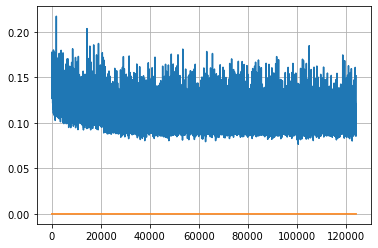

Epoch: 319, iteration 0, loss 0.11373504996299744, cov_diff 0.41497993163356617 cov_diff train 0.4148686601936943
Epoch: 319, iteration 1, loss 0.10301214456558228, cov_diff 0.406538514423689 cov_diff train 0.4058006196547668
Epoch: 319, iteration 2, loss 0.11278092861175537, cov_diff 0.41795007353736735 cov_diff train 0.4174710081528885
Epoch: 319, iteration 3, loss 0.10226470232009888, cov_diff 0.4121230680745497 cov_diff train 0.4115056099403186
Epoch: 319, iteration 4, loss 0.0963362455368042, cov_diff 0.4041424626192341 cov_diff train 0.40327451172901313
Epoch: 319, iteration 5, loss 0.10437783598899841, cov_diff 0.41909890819526474 cov_diff train 0.4189942215832111
Epoch: 319, iteration 6, loss 0.09887295961380005, cov_diff 0.42110280103532133 cov_diff train 0.42078855497112067
Epoch: 319, iteration 7, loss 0.09428760409355164, cov_diff 0.4090760092282841 cov_diff train 0.4088039531505153
Epoch: 319, iteration 8, loss 0.10870751738548279, cov_diff 0.40733606487290985 cov_diff tra

Epoch: 319, iteration 78, loss 0.09704506397247314, cov_diff 0.40101998291912955 cov_diff train 0.4009697188392686
Epoch: 319, iteration 79, loss 0.09651651978492737, cov_diff 0.41242016449127455 cov_diff train 0.4119959116659157
Epoch: 319, iteration 80, loss 0.09986159205436707, cov_diff 0.3990265134328713 cov_diff train 0.39818181132103425
Epoch: 319, iteration 81, loss 0.09525531530380249, cov_diff 0.4089398405569234 cov_diff train 0.4084193234732539
Epoch: 319, iteration 82, loss 0.11245211958885193, cov_diff 0.41267947692934304 cov_diff train 0.4117268876629509
Epoch: 319, iteration 83, loss 0.09814572334289551, cov_diff 0.40465068590931547 cov_diff train 0.4038428358569272
Epoch: 319, iteration 84, loss 0.10193228721618652, cov_diff 0.4022517626723086 cov_diff train 0.40179363108834254
Epoch: 319, iteration 85, loss 0.09780246019363403, cov_diff 0.4216471412015326 cov_diff train 0.4208478875206014
Epoch: 319, iteration 86, loss 0.08946013450622559, cov_diff 0.4191953847084584 co

Epoch: 319, iteration 154, loss 0.10298457741737366, cov_diff 0.4055269958855333 cov_diff train 0.4054466160021947
Epoch: 319, iteration 155, loss 0.09886744618415833, cov_diff 0.41757338410527034 cov_diff train 0.41776240005352067
Epoch: 319, iteration 156, loss 0.09196293354034424, cov_diff 0.4035221730241753 cov_diff train 0.4035731257321979
Epoch: 319, iteration 157, loss 0.10630330443382263, cov_diff 0.41099850523613424 cov_diff train 0.4104925122373634
Epoch: 319, iteration 158, loss 0.10257360339164734, cov_diff 0.40557860062421 cov_diff train 0.40493204426569285
Epoch: 319, iteration 159, loss 0.09619799256324768, cov_diff 0.40368138193054165 cov_diff train 0.4029709949158539
Epoch: 319, iteration 160, loss 0.09799855947494507, cov_diff 0.415548207786719 cov_diff train 0.41469209947897606
Epoch: 319, iteration 161, loss 0.10195553302764893, cov_diff 0.412528182336802 cov_diff train 0.41217625376459854
Epoch: 319, iteration 162, loss 0.09848132729530334, cov_diff 0.4119172686383

Epoch: 319, iteration 232, loss 0.11495968699455261, cov_diff 0.41505067516659505 cov_diff train 0.41437602336603707
Epoch: 319, iteration 233, loss 0.09821853041648865, cov_diff 0.4052622785498562 cov_diff train 0.4050324669372927
Epoch: 319, iteration 234, loss 0.10837706923484802, cov_diff 0.40869246562015693 cov_diff train 0.4083676511016806
Epoch: 319, iteration 235, loss 0.10869723558425903, cov_diff 0.424128772045544 cov_diff train 0.4233556892437876
Epoch: 319, iteration 236, loss 0.10951963067054749, cov_diff 0.4067116051425147 cov_diff train 0.40630233188816833
Epoch: 319, iteration 237, loss 0.10535553097724915, cov_diff 0.40783299874984574 cov_diff train 0.4074345860912761
Epoch: 319, iteration 238, loss 0.1058499813079834, cov_diff 0.40738295850879225 cov_diff train 0.40735948485626894
Epoch: 319, iteration 239, loss 0.09447446465492249, cov_diff 0.4188466423725023 cov_diff train 0.4183163380999845
Epoch: 319, iteration 240, loss 0.09907171130180359, cov_diff 0.39739245804

Epoch: 319, iteration 309, loss 0.10018321871757507, cov_diff 0.40987012501151765 cov_diff train 0.4096487566979605
Epoch: 319, iteration 310, loss 0.10605141520500183, cov_diff 0.4056466291432991 cov_diff train 0.40614116699509495
Epoch: 319, iteration 311, loss 0.11917150020599365, cov_diff 0.42684322509727296 cov_diff train 0.4259987335813473
Epoch: 319, iteration 312, loss 0.10182452201843262, cov_diff 0.412797602228858 cov_diff train 0.4124431108051158
Epoch: 319, iteration 313, loss 0.11055034399032593, cov_diff 0.41604447575723746 cov_diff train 0.41471519338233537
Epoch: 319, iteration 314, loss 0.11044010519981384, cov_diff 0.4105543723680841 cov_diff train 0.40958363056649866
Epoch: 319, iteration 315, loss 0.0973706841468811, cov_diff 0.41508418399558367 cov_diff train 0.4139786354465671
Epoch: 319, iteration 316, loss 0.10541164875030518, cov_diff 0.41284627389394685 cov_diff train 0.4120458596818931
Epoch: 319, iteration 317, loss 0.10756593942642212, cov_diff 0.4070886412

Epoch: 319, iteration 384, loss 0.09527811408042908, cov_diff 0.42200433999617176 cov_diff train 0.42159261109490853
Epoch: 319, iteration 385, loss 0.09855252504348755, cov_diff 0.42614831889053806 cov_diff train 0.4250838073203721
Epoch: 319, iteration 386, loss 0.11254039406776428, cov_diff 0.4081227693692613 cov_diff train 0.4069537376897042
Epoch: 319, iteration 387, loss 0.09320542216300964, cov_diff 0.41459173694008244 cov_diff train 0.4145181125335889
Epoch: 319, iteration 388, loss 0.11282745003700256, cov_diff 0.41778470050517935 cov_diff train 0.41701469216149833
Epoch: 319, iteration 389, loss 0.09531337022781372, cov_diff 0.41752856879322064 cov_diff train 0.4156317230051666
Epoch: 319, iteration 390, loss 0.14432457089424133, cov_diff 0.45567232466373514 cov_diff train 0.4546223816520085


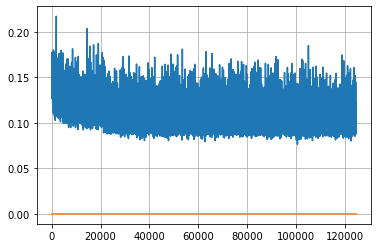

Epoch: 320, iteration 0, loss 0.10448607802391052, cov_diff 0.4144829261579497 cov_diff train 0.4133317761774423
Epoch: 320, iteration 1, loss 0.10954570770263672, cov_diff 0.4021072018967909 cov_diff train 0.4017321131182847
Epoch: 320, iteration 2, loss 0.10441341996192932, cov_diff 0.4147116561739811 cov_diff train 0.4140690676541519
Epoch: 320, iteration 3, loss 0.11661013960838318, cov_diff 0.41585352191975483 cov_diff train 0.4145012146050647
Epoch: 320, iteration 4, loss 0.10922378301620483, cov_diff 0.40113228227790837 cov_diff train 0.40034560922879936
Epoch: 320, iteration 5, loss 0.10222497582435608, cov_diff 0.42501548683089974 cov_diff train 0.42469303520161567
Epoch: 320, iteration 6, loss 0.0983244776725769, cov_diff 0.40109208125816453 cov_diff train 0.4005602178450488
Epoch: 320, iteration 7, loss 0.09512460231781006, cov_diff 0.4115510110280932 cov_diff train 0.41132427269667954
Epoch: 320, iteration 8, loss 0.09075433015823364, cov_diff 0.41619484807533264 cov_diff t

Epoch: 320, iteration 73, loss 0.0955604612827301, cov_diff 0.4128597358603834 cov_diff train 0.41230606854677454
Epoch: 320, iteration 74, loss 0.11143055558204651, cov_diff 0.4203635723896929 cov_diff train 0.4195809588811921
Epoch: 320, iteration 75, loss 0.1060212254524231, cov_diff 0.4000409293102977 cov_diff train 0.3999377376121661
Epoch: 320, iteration 76, loss 0.10670536756515503, cov_diff 0.41985847486075806 cov_diff train 0.41883379187691855
Epoch: 320, iteration 77, loss 0.0978703498840332, cov_diff 0.41089507990939955 cov_diff train 0.41057822196458205
Epoch: 320, iteration 78, loss 0.1086513102054596, cov_diff 0.42195800197760197 cov_diff train 0.42169932393480164
Epoch: 320, iteration 79, loss 0.11115431785583496, cov_diff 0.41458067180948116 cov_diff train 0.413669316922717
Epoch: 320, iteration 80, loss 0.09598374366760254, cov_diff 0.413267851911185 cov_diff train 0.41241696825675034
Epoch: 320, iteration 81, loss 0.10516786575317383, cov_diff 0.4202492746235149 cov_d

Epoch: 320, iteration 149, loss 0.10220754146575928, cov_diff 0.41074644019486306 cov_diff train 0.40961932185700783
Epoch: 320, iteration 150, loss 0.1110675036907196, cov_diff 0.4135776545251291 cov_diff train 0.4133954424909506
Epoch: 320, iteration 151, loss 0.10916692018508911, cov_diff 0.4156611017669023 cov_diff train 0.41463194598402137
Epoch: 320, iteration 152, loss 0.10962548851966858, cov_diff 0.3982487568219817 cov_diff train 0.3969086133759878
Epoch: 320, iteration 153, loss 0.10846179723739624, cov_diff 0.4000497607216953 cov_diff train 0.4002191587318225
Epoch: 320, iteration 154, loss 0.10260137915611267, cov_diff 0.412533313466774 cov_diff train 0.41151344952350144
Epoch: 320, iteration 155, loss 0.09853231906890869, cov_diff 0.41822479675415614 cov_diff train 0.4171664664015597
Epoch: 320, iteration 156, loss 0.09436050057411194, cov_diff 0.39810414507782244 cov_diff train 0.39765577591599915
Epoch: 320, iteration 157, loss 0.11584582924842834, cov_diff 0.40294443608

Epoch: 320, iteration 227, loss 0.10834094882011414, cov_diff 0.4155589595065592 cov_diff train 0.4158586926219315
Epoch: 320, iteration 228, loss 0.09375214576721191, cov_diff 0.418658691991217 cov_diff train 0.418559655345687
Epoch: 320, iteration 229, loss 0.0904226303100586, cov_diff 0.41008857903781215 cov_diff train 0.4092291207551169
Epoch: 320, iteration 230, loss 0.09256252646446228, cov_diff 0.4199476596834311 cov_diff train 0.41898599203590847
Epoch: 320, iteration 231, loss 0.08723992109298706, cov_diff 0.4020861594972618 cov_diff train 0.402072108036763
Epoch: 320, iteration 232, loss 0.10931655764579773, cov_diff 0.4243494424528796 cov_diff train 0.4238926007002082
Epoch: 320, iteration 233, loss 0.10067060589790344, cov_diff 0.42076911217749785 cov_diff train 0.4197460715567482
Epoch: 320, iteration 234, loss 0.09460204839706421, cov_diff 0.41123230254140053 cov_diff train 0.40987734032147544
Epoch: 320, iteration 235, loss 0.09253266453742981, cov_diff 0.408846687139344

Epoch: 320, iteration 305, loss 0.10954076051712036, cov_diff 0.412994953417337 cov_diff train 0.4119075912992282
Epoch: 320, iteration 306, loss 0.09799215197563171, cov_diff 0.4101926460984232 cov_diff train 0.4081283014593184
Epoch: 320, iteration 307, loss 0.10088804364204407, cov_diff 0.41848123070052534 cov_diff train 0.41685377695052306
Epoch: 320, iteration 308, loss 0.10859021544456482, cov_diff 0.40488828662428766 cov_diff train 0.403258255150458
Epoch: 320, iteration 309, loss 0.10222631692886353, cov_diff 0.41078138677779247 cov_diff train 0.4100617075973667
Epoch: 320, iteration 310, loss 0.10399332642555237, cov_diff 0.40169322254063283 cov_diff train 0.40003152979466516
Epoch: 320, iteration 311, loss 0.10462695360183716, cov_diff 0.4036995709118119 cov_diff train 0.40307339235671125
Epoch: 320, iteration 312, loss 0.10409808158874512, cov_diff 0.39959096930396615 cov_diff train 0.399079111248514
Epoch: 320, iteration 313, loss 0.10122719407081604, cov_diff 0.40288300842

Epoch: 320, iteration 383, loss 0.10611552000045776, cov_diff 0.4172320420429331 cov_diff train 0.4169485850964926
Epoch: 320, iteration 384, loss 0.09649777412414551, cov_diff 0.4250683583302668 cov_diff train 0.4236455112465688
Epoch: 320, iteration 385, loss 0.10729685425758362, cov_diff 0.4130877567191131 cov_diff train 0.41233095879634196
Epoch: 320, iteration 386, loss 0.10479548573493958, cov_diff 0.4048730182256781 cov_diff train 0.40376356643067524
Epoch: 320, iteration 387, loss 0.10581052303314209, cov_diff 0.40191312302088905 cov_diff train 0.4004748472945173
Epoch: 320, iteration 388, loss 0.10768082737922668, cov_diff 0.4062477676438256 cov_diff train 0.4059319705919089
Epoch: 320, iteration 389, loss 0.08442607522010803, cov_diff 0.4050677376626029 cov_diff train 0.40474014768477024
Epoch: 320, iteration 390, loss 0.15742722153663635, cov_diff 0.4380525207509741 cov_diff train 0.4348622336200807


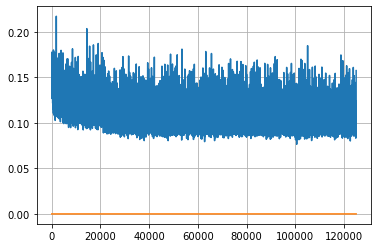

Epoch: 321, iteration 0, loss 0.10623586177825928, cov_diff 0.4062944442367074 cov_diff train 0.40597511831086613
Epoch: 321, iteration 1, loss 0.10802656412124634, cov_diff 0.4210162991216946 cov_diff train 0.4182567745409893
Epoch: 321, iteration 2, loss 0.09190884232521057, cov_diff 0.41015054643726767 cov_diff train 0.4095136133597548
Epoch: 321, iteration 3, loss 0.09128034114837646, cov_diff 0.39448953091315575 cov_diff train 0.3943351994353034
Epoch: 321, iteration 4, loss 0.09980654716491699, cov_diff 0.4094113162012247 cov_diff train 0.4091068545032383
Epoch: 321, iteration 5, loss 0.10968765616416931, cov_diff 0.4112662484544058 cov_diff train 0.4113151651867199
Epoch: 321, iteration 6, loss 0.11405736207962036, cov_diff 0.41435681752042225 cov_diff train 0.41245125028177754
Epoch: 321, iteration 7, loss 0.09811758995056152, cov_diff 0.4124427677601492 cov_diff train 0.41252017779914346
Epoch: 321, iteration 8, loss 0.10849449038505554, cov_diff 0.4068275573622333 cov_diff tr

Epoch: 321, iteration 77, loss 0.10660368204116821, cov_diff 0.39942618539206104 cov_diff train 0.3997217734776746
Epoch: 321, iteration 78, loss 0.09661531448364258, cov_diff 0.41505920112602745 cov_diff train 0.41402057953795435
Epoch: 321, iteration 79, loss 0.11581996083259583, cov_diff 0.40839271413352196 cov_diff train 0.40822546823707656
Epoch: 321, iteration 80, loss 0.09629115462303162, cov_diff 0.40707998646139953 cov_diff train 0.40715367684240905
Epoch: 321, iteration 81, loss 0.09706899523735046, cov_diff 0.4017104254546121 cov_diff train 0.40218723843661464
Epoch: 321, iteration 82, loss 0.11081588268280029, cov_diff 0.40777177829635913 cov_diff train 0.40762434349062576
Epoch: 321, iteration 83, loss 0.0967080295085907, cov_diff 0.40991311960708393 cov_diff train 0.40993821153050136
Epoch: 321, iteration 84, loss 0.11653771996498108, cov_diff 0.40608459342061 cov_diff train 0.4050616121484413
Epoch: 321, iteration 85, loss 0.1146586537361145, cov_diff 0.4042875179422389 

Epoch: 321, iteration 154, loss 0.10195279121398926, cov_diff 0.4026713319231628 cov_diff train 0.40167411356044813
Epoch: 321, iteration 155, loss 0.10270997881889343, cov_diff 0.3969327798033982 cov_diff train 0.3959999443487542
Epoch: 321, iteration 156, loss 0.10793983936309814, cov_diff 0.4104303304638286 cov_diff train 0.4099956352825979
Epoch: 321, iteration 157, loss 0.10672944784164429, cov_diff 0.4124352858732925 cov_diff train 0.4104301493791191
Epoch: 321, iteration 158, loss 0.1063704788684845, cov_diff 0.40685987229724496 cov_diff train 0.4051466756886774
Epoch: 321, iteration 159, loss 0.09614723920822144, cov_diff 0.4158807067797312 cov_diff train 0.41511552896036075
Epoch: 321, iteration 160, loss 0.09844577312469482, cov_diff 0.403947032270094 cov_diff train 0.4033418037955539
Epoch: 321, iteration 161, loss 0.09096047282218933, cov_diff 0.40179360908916906 cov_diff train 0.40104988623614296
Epoch: 321, iteration 162, loss 0.10946011543273926, cov_diff 0.4154770113680

Epoch: 321, iteration 230, loss 0.10653257369995117, cov_diff 0.4143939627312842 cov_diff train 0.4140878998141934
Epoch: 321, iteration 231, loss 0.10879078507423401, cov_diff 0.425994121557891 cov_diff train 0.4252028466215598
Epoch: 321, iteration 232, loss 0.11141663789749146, cov_diff 0.4167696003881676 cov_diff train 0.41707665231627566
Epoch: 321, iteration 233, loss 0.10299324989318848, cov_diff 0.4202177934693337 cov_diff train 0.41927186666329325
Epoch: 321, iteration 234, loss 0.0998576283454895, cov_diff 0.43119376976881946 cov_diff train 0.43111574137340697
Epoch: 321, iteration 235, loss 0.10284817218780518, cov_diff 0.4148625644610274 cov_diff train 0.41402131011277743
Epoch: 321, iteration 236, loss 0.0984119176864624, cov_diff 0.41378653426730955 cov_diff train 0.4133925415247769
Epoch: 321, iteration 237, loss 0.10929977893829346, cov_diff 0.41659334492951944 cov_diff train 0.4154680654903461
Epoch: 321, iteration 238, loss 0.10207301378250122, cov_diff 0.410028987808

Epoch: 321, iteration 307, loss 0.0959576666355133, cov_diff 0.3995010379447771 cov_diff train 0.39893303481463444
Epoch: 321, iteration 308, loss 0.10342606902122498, cov_diff 0.4158466027935488 cov_diff train 0.4156243211558021
Epoch: 321, iteration 309, loss 0.08731478452682495, cov_diff 0.41729043257602766 cov_diff train 0.4163943953819299
Epoch: 321, iteration 310, loss 0.10018900036811829, cov_diff 0.41756186009541996 cov_diff train 0.4161325816620368
Epoch: 321, iteration 311, loss 0.10513213276863098, cov_diff 0.410321531594857 cov_diff train 0.4097527943731837
Epoch: 321, iteration 312, loss 0.10117292404174805, cov_diff 0.43512894225140186 cov_diff train 0.43432227313940003
Epoch: 321, iteration 313, loss 0.09223219752311707, cov_diff 0.4069391553239135 cov_diff train 0.4059286166639034
Epoch: 321, iteration 314, loss 0.09492883086204529, cov_diff 0.4269516021855652 cov_diff train 0.4269569010788579
Epoch: 321, iteration 315, loss 0.10890096426010132, cov_diff 0.4286478204923

Epoch: 321, iteration 382, loss 0.1122463047504425, cov_diff 0.42235664472610224 cov_diff train 0.4219417441416781
Epoch: 321, iteration 383, loss 0.09506505727767944, cov_diff 0.4182891750171471 cov_diff train 0.4166759720295941
Epoch: 321, iteration 384, loss 0.10806861519813538, cov_diff 0.39875840158925807 cov_diff train 0.3976552398576781
Epoch: 321, iteration 385, loss 0.09701177477836609, cov_diff 0.40797005504225065 cov_diff train 0.4077703288565592
Epoch: 321, iteration 386, loss 0.10235646367073059, cov_diff 0.40877652768744127 cov_diff train 0.40919604009350063
Epoch: 321, iteration 387, loss 0.08570891618728638, cov_diff 0.40699695304333006 cov_diff train 0.4068751287313324
Epoch: 321, iteration 388, loss 0.1005588173866272, cov_diff 0.42081519999122347 cov_diff train 0.421081743675152
Epoch: 321, iteration 389, loss 0.09722870588302612, cov_diff 0.4221241041721143 cov_diff train 0.4214780755581252
Epoch: 321, iteration 390, loss 0.14196810126304626, cov_diff 0.452009990531

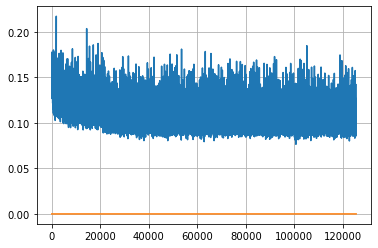

Epoch: 322, iteration 0, loss 0.10588023066520691, cov_diff 0.4100682068280092 cov_diff train 0.40997791255477795
Epoch: 322, iteration 1, loss 0.09978485107421875, cov_diff 0.40808129185194586 cov_diff train 0.4080055703150365
Epoch: 322, iteration 2, loss 0.10076716542243958, cov_diff 0.413954835260809 cov_diff train 0.41387618609264515
Epoch: 322, iteration 3, loss 0.11066228151321411, cov_diff 0.40398450369187877 cov_diff train 0.4037317777540639
Epoch: 322, iteration 4, loss 0.10898599028587341, cov_diff 0.4115670526742013 cov_diff train 0.41001948187840526
Epoch: 322, iteration 5, loss 0.1129029393196106, cov_diff 0.41853247202724114 cov_diff train 0.4176333736784417
Epoch: 322, iteration 6, loss 0.10495463013648987, cov_diff 0.40666354073957584 cov_diff train 0.4053862570279349
Epoch: 322, iteration 7, loss 0.1042262613773346, cov_diff 0.4137644475491781 cov_diff train 0.4132560358340357
Epoch: 322, iteration 8, loss 0.10808518528938293, cov_diff 0.3996116449001291 cov_diff trai

Epoch: 322, iteration 77, loss 0.09776759147644043, cov_diff 0.3982572692262605 cov_diff train 0.3980797584019236
Epoch: 322, iteration 78, loss 0.1054697334766388, cov_diff 0.4111510207481722 cov_diff train 0.4097842062715822
Epoch: 322, iteration 79, loss 0.09879431128501892, cov_diff 0.4034306765106772 cov_diff train 0.4016015584323933
Epoch: 322, iteration 80, loss 0.0936722457408905, cov_diff 0.41195217584870997 cov_diff train 0.4104783038703368
Epoch: 322, iteration 81, loss 0.0992821455001831, cov_diff 0.4163722352229725 cov_diff train 0.4149721595140695
Epoch: 322, iteration 82, loss 0.10779163241386414, cov_diff 0.41070374796724995 cov_diff train 0.40984076945281356
Epoch: 322, iteration 83, loss 0.09624561667442322, cov_diff 0.413945511809666 cov_diff train 0.41276766116568037
Epoch: 322, iteration 84, loss 0.09227171540260315, cov_diff 0.4170020730203925 cov_diff train 0.41595360414279325
Epoch: 322, iteration 85, loss 0.09340080618858337, cov_diff 0.41632206578621556 cov_di

Epoch: 322, iteration 154, loss 0.10033786296844482, cov_diff 0.4048854554043728 cov_diff train 0.4043526000312131
Epoch: 322, iteration 155, loss 0.10850986838340759, cov_diff 0.419327370154054 cov_diff train 0.41856532453229406
Epoch: 322, iteration 156, loss 0.10762453079223633, cov_diff 0.4126870205908993 cov_diff train 0.412643623419415
Epoch: 322, iteration 157, loss 0.10927054286003113, cov_diff 0.4101741805468926 cov_diff train 0.40955767541546834
Epoch: 322, iteration 158, loss 0.11530578136444092, cov_diff 0.4199617452057485 cov_diff train 0.41917199600587146
Epoch: 322, iteration 159, loss 0.09577992558479309, cov_diff 0.4092980833472818 cov_diff train 0.40874759815625034
Epoch: 322, iteration 160, loss 0.11925768852233887, cov_diff 0.4085605462224229 cov_diff train 0.4077197018142689
Epoch: 322, iteration 161, loss 0.0963781476020813, cov_diff 0.4061573777525442 cov_diff train 0.4060354066772871
Epoch: 322, iteration 162, loss 0.09880992770195007, cov_diff 0.415876466404378

Epoch: 322, iteration 227, loss 0.09695255756378174, cov_diff 0.40805436139493195 cov_diff train 0.407351545434201
Epoch: 322, iteration 228, loss 0.104128897190094, cov_diff 0.41110388368937134 cov_diff train 0.4111988828757126
Epoch: 322, iteration 229, loss 0.09654879570007324, cov_diff 0.4160720543153989 cov_diff train 0.4159951598386852
Epoch: 322, iteration 230, loss 0.1159207820892334, cov_diff 0.39660029523400375 cov_diff train 0.39554895882967983
Epoch: 322, iteration 231, loss 0.11428001523017883, cov_diff 0.4142619767587381 cov_diff train 0.4123433271619717
Epoch: 322, iteration 232, loss 0.101992666721344, cov_diff 0.413516772983471 cov_diff train 0.41319706242617676
Epoch: 322, iteration 233, loss 0.09205803275108337, cov_diff 0.4093423756732504 cov_diff train 0.408195027809317
Epoch: 322, iteration 234, loss 0.10658374428749084, cov_diff 0.4046483625771319 cov_diff train 0.4037944952561005
Epoch: 322, iteration 235, loss 0.10119128227233887, cov_diff 0.4049181730474339 co

Epoch: 322, iteration 304, loss 0.10067689418792725, cov_diff 0.4125939065974145 cov_diff train 0.41176634420309377
Epoch: 322, iteration 305, loss 0.10861760377883911, cov_diff 0.41120726683801717 cov_diff train 0.4108399306136525
Epoch: 322, iteration 306, loss 0.11083292961120605, cov_diff 0.4104351130065291 cov_diff train 0.4101451360177042
Epoch: 322, iteration 307, loss 0.09001544117927551, cov_diff 0.41296224274193133 cov_diff train 0.41246303116411204
Epoch: 322, iteration 308, loss 0.10614335536956787, cov_diff 0.4157155269145322 cov_diff train 0.41484737881879113
Epoch: 322, iteration 309, loss 0.10252097249031067, cov_diff 0.40932770544467656 cov_diff train 0.40813371445519253
Epoch: 322, iteration 310, loss 0.10407203435897827, cov_diff 0.4168829556778009 cov_diff train 0.4159207209812455
Epoch: 322, iteration 311, loss 0.11099529266357422, cov_diff 0.40901053604568777 cov_diff train 0.40834539832886013
Epoch: 322, iteration 312, loss 0.10877585411071777, cov_diff 0.4097799

Epoch: 322, iteration 381, loss 0.0963931679725647, cov_diff 0.4136618999063613 cov_diff train 0.41374093781763305
Epoch: 322, iteration 382, loss 0.11169746518135071, cov_diff 0.41872711909202687 cov_diff train 0.41896999832112297
Epoch: 322, iteration 383, loss 0.09681481122970581, cov_diff 0.40642272901405513 cov_diff train 0.40634104446749353
Epoch: 322, iteration 384, loss 0.10269021987915039, cov_diff 0.4279450280196283 cov_diff train 0.42747373115966675
Epoch: 322, iteration 385, loss 0.09452831745147705, cov_diff 0.4213098743561691 cov_diff train 0.4209626008753939
Epoch: 322, iteration 386, loss 0.11021548509597778, cov_diff 0.4145757308586328 cov_diff train 0.4146439959531571
Epoch: 322, iteration 387, loss 0.0978359580039978, cov_diff 0.4247345344751895 cov_diff train 0.42392597717387076
Epoch: 322, iteration 388, loss 0.0994616448879242, cov_diff 0.42356327084015727 cov_diff train 0.4225185601297566
Epoch: 322, iteration 389, loss 0.11170610785484314, cov_diff 0.41375125684

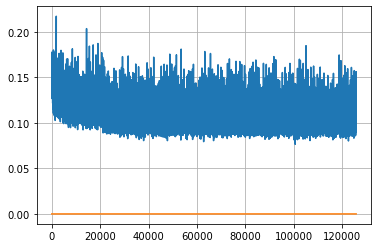

Epoch: 323, iteration 0, loss 0.11091390252113342, cov_diff 0.41369986165362105 cov_diff train 0.4132770163689226
Epoch: 323, iteration 1, loss 0.10276466608047485, cov_diff 0.42647273843186423 cov_diff train 0.4257523524973234
Epoch: 323, iteration 2, loss 0.10118606686592102, cov_diff 0.40767038290014534 cov_diff train 0.4076236350036117
Epoch: 323, iteration 3, loss 0.10283157229423523, cov_diff 0.4002593440219485 cov_diff train 0.4000048216552816
Epoch: 323, iteration 4, loss 0.09968829154968262, cov_diff 0.41513399102322496 cov_diff train 0.4146079626718985
Epoch: 323, iteration 5, loss 0.11235517263412476, cov_diff 0.42156806907241096 cov_diff train 0.4208680865065222
Epoch: 323, iteration 6, loss 0.10935530066490173, cov_diff 0.4279772023698227 cov_diff train 0.42744112053738514
Epoch: 323, iteration 7, loss 0.10614180564880371, cov_diff 0.4198629640184249 cov_diff train 0.419125064344325
Epoch: 323, iteration 8, loss 0.09900060296058655, cov_diff 0.4272062564528942 cov_diff tra

Epoch: 323, iteration 81, loss 0.10149216651916504, cov_diff 0.41953230172758504 cov_diff train 0.4170703621861545
Epoch: 323, iteration 82, loss 0.10802584886550903, cov_diff 0.40911483874447163 cov_diff train 0.4080350996180585
Epoch: 323, iteration 83, loss 0.11182224750518799, cov_diff 0.4169562377049923 cov_diff train 0.41601283875803186
Epoch: 323, iteration 84, loss 0.10250860452651978, cov_diff 0.40332129998574157 cov_diff train 0.40323871757890933
Epoch: 323, iteration 85, loss 0.10436877608299255, cov_diff 0.4045777544610485 cov_diff train 0.4036787697214242
Epoch: 323, iteration 86, loss 0.09570750594139099, cov_diff 0.42715017327917454 cov_diff train 0.4264759123642516
Epoch: 323, iteration 87, loss 0.10303673148155212, cov_diff 0.4112198486520355 cov_diff train 0.4109289937870598
Epoch: 323, iteration 88, loss 0.09641528129577637, cov_diff 0.4137542313659639 cov_diff train 0.4138506527257157
Epoch: 323, iteration 89, loss 0.10341218113899231, cov_diff 0.41293820732286857 c

Epoch: 323, iteration 152, loss 0.1057274341583252, cov_diff 0.40628559386167995 cov_diff train 0.4066607488873317
Epoch: 323, iteration 153, loss 0.09281957149505615, cov_diff 0.42536678734111566 cov_diff train 0.42546958243059885
Epoch: 323, iteration 154, loss 0.09653255343437195, cov_diff 0.42188458704406134 cov_diff train 0.42149097492567955
Epoch: 323, iteration 155, loss 0.10994625091552734, cov_diff 0.4132710332104128 cov_diff train 0.41299651970671797
Epoch: 323, iteration 156, loss 0.09190043807029724, cov_diff 0.42036263556995335 cov_diff train 0.42005889524882967
Epoch: 323, iteration 157, loss 0.10187390446662903, cov_diff 0.4123419615496329 cov_diff train 0.4115921202470637
Epoch: 323, iteration 158, loss 0.10047322511672974, cov_diff 0.41799551902752025 cov_diff train 0.41684948262847005
Epoch: 323, iteration 159, loss 0.10160437226295471, cov_diff 0.39949942515043546 cov_diff train 0.39909453607777545
Epoch: 323, iteration 160, loss 0.10846322774887085, cov_diff 0.39651

Epoch: 323, iteration 223, loss 0.08945721387863159, cov_diff 0.4035543132289853 cov_diff train 0.4040843080732476
Epoch: 323, iteration 224, loss 0.11706081032752991, cov_diff 0.434974919083788 cov_diff train 0.43519237138694483
Epoch: 323, iteration 225, loss 0.10645949840545654, cov_diff 0.4213342090038695 cov_diff train 0.4213140341239817
Epoch: 323, iteration 226, loss 0.10422021150588989, cov_diff 0.41546633570800673 cov_diff train 0.4149159726900448
Epoch: 323, iteration 227, loss 0.08956703543663025, cov_diff 0.42658058436035423 cov_diff train 0.4254743499834714
Epoch: 323, iteration 228, loss 0.11358925700187683, cov_diff 0.4389127315858485 cov_diff train 0.43783705170741594
Epoch: 323, iteration 229, loss 0.11015555262565613, cov_diff 0.4193240671365105 cov_diff train 0.4173817233947377
Epoch: 323, iteration 230, loss 0.09735000133514404, cov_diff 0.4262590876176155 cov_diff train 0.4251716426417721
Epoch: 323, iteration 231, loss 0.09748879075050354, cov_diff 0.4319237864539

Epoch: 323, iteration 299, loss 0.10214817523956299, cov_diff 0.42223138313122155 cov_diff train 0.42116194869626145
Epoch: 323, iteration 300, loss 0.11764487624168396, cov_diff 0.39844174291479595 cov_diff train 0.3979705105769433
Epoch: 323, iteration 301, loss 0.09813696146011353, cov_diff 0.42428708906630197 cov_diff train 0.4242391068512417
Epoch: 323, iteration 302, loss 0.09324714541435242, cov_diff 0.4160748086801421 cov_diff train 0.41520228751899485
Epoch: 323, iteration 303, loss 0.10768869519233704, cov_diff 0.4217435363307121 cov_diff train 0.42082664561332034
Epoch: 323, iteration 304, loss 0.11106738448143005, cov_diff 0.4095374915158964 cov_diff train 0.40789953065289064
Epoch: 323, iteration 305, loss 0.11030194163322449, cov_diff 0.4114426283531867 cov_diff train 0.4094643612617636
Epoch: 323, iteration 306, loss 0.11571946740150452, cov_diff 0.4082869233040958 cov_diff train 0.40793376062795256
Epoch: 323, iteration 307, loss 0.10158708691596985, cov_diff 0.41816820

Epoch: 323, iteration 373, loss 0.09576043486595154, cov_diff 0.4074766178909977 cov_diff train 0.40664896726556427
Epoch: 323, iteration 374, loss 0.10347473621368408, cov_diff 0.4073238796047048 cov_diff train 0.4067617979558199
Epoch: 323, iteration 375, loss 0.1038578450679779, cov_diff 0.4189804010472851 cov_diff train 0.417910046548964
Epoch: 323, iteration 376, loss 0.09954902529716492, cov_diff 0.4093624470270042 cov_diff train 0.40912932666467855
Epoch: 323, iteration 377, loss 0.10661342740058899, cov_diff 0.4182229938140413 cov_diff train 0.41728987316105653
Epoch: 323, iteration 378, loss 0.10477566719055176, cov_diff 0.40571781513396793 cov_diff train 0.40553792620329376
Epoch: 323, iteration 379, loss 0.10172483325004578, cov_diff 0.4051117842158284 cov_diff train 0.4036322786821437
Epoch: 323, iteration 380, loss 0.10970768332481384, cov_diff 0.4119496342907472 cov_diff train 0.41194411572506284
Epoch: 323, iteration 381, loss 0.10547670722007751, cov_diff 0.417261170183

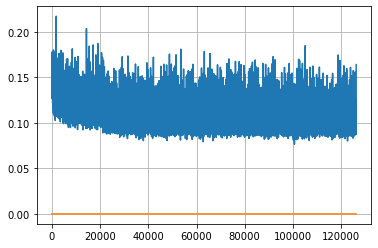

Epoch: 324, iteration 0, loss 0.09945884346961975, cov_diff 0.41154002296172465 cov_diff train 0.41083749051741364
Epoch: 324, iteration 1, loss 0.10013723373413086, cov_diff 0.4086959664317154 cov_diff train 0.4080318457715492
Epoch: 324, iteration 2, loss 0.10798564553260803, cov_diff 0.4035188030130011 cov_diff train 0.40274360792184916
Epoch: 324, iteration 3, loss 0.09566798806190491, cov_diff 0.40039346777892776 cov_diff train 0.40002442606317845
Epoch: 324, iteration 4, loss 0.1051836907863617, cov_diff 0.40488406404874305 cov_diff train 0.40432841323878377
Epoch: 324, iteration 5, loss 0.10928359627723694, cov_diff 0.4219401113977745 cov_diff train 0.42077546007971095
Epoch: 324, iteration 6, loss 0.09621909260749817, cov_diff 0.40398625392285253 cov_diff train 0.4034660656054662
Epoch: 324, iteration 7, loss 0.10218563675880432, cov_diff 0.4023560477877973 cov_diff train 0.4016413379961455
Epoch: 324, iteration 8, loss 0.09748664498329163, cov_diff 0.3980338780556972 cov_diff 

Epoch: 324, iteration 77, loss 0.10594844818115234, cov_diff 0.4093067531076223 cov_diff train 0.40930783367740714
Epoch: 324, iteration 78, loss 0.10344198346138, cov_diff 0.40867117256982344 cov_diff train 0.4084480813551527
Epoch: 324, iteration 79, loss 0.10228577256202698, cov_diff 0.4179981421642893 cov_diff train 0.41853318512284426
Epoch: 324, iteration 80, loss 0.1140575110912323, cov_diff 0.41823104328926836 cov_diff train 0.41766596933845734
Epoch: 324, iteration 81, loss 0.10037636756896973, cov_diff 0.40602170394030046 cov_diff train 0.40518298187888596
Epoch: 324, iteration 82, loss 0.11199557781219482, cov_diff 0.4139478690724899 cov_diff train 0.41464797521128954
Epoch: 324, iteration 83, loss 0.09514826536178589, cov_diff 0.4159611628803778 cov_diff train 0.41574478196613013
Epoch: 324, iteration 84, loss 0.09346818923950195, cov_diff 0.4059945122639324 cov_diff train 0.40533053992929036
Epoch: 324, iteration 85, loss 0.11354705691337585, cov_diff 0.42295278479955734 c

Epoch: 324, iteration 153, loss 0.1107822060585022, cov_diff 0.4191521712310699 cov_diff train 0.41821271870557847
Epoch: 324, iteration 154, loss 0.10171002149581909, cov_diff 0.4112922168910462 cov_diff train 0.4114011816701778
Epoch: 324, iteration 155, loss 0.10806918144226074, cov_diff 0.40181688237563024 cov_diff train 0.40192293791403
Epoch: 324, iteration 156, loss 0.10925477743148804, cov_diff 0.4142754647783816 cov_diff train 0.414154514787882
Epoch: 324, iteration 157, loss 0.1055665910243988, cov_diff 0.419218513066902 cov_diff train 0.4187331619149173
Epoch: 324, iteration 158, loss 0.10808128118515015, cov_diff 0.4193767047024238 cov_diff train 0.41879312784707223
Epoch: 324, iteration 159, loss 0.10629069805145264, cov_diff 0.41779635220144534 cov_diff train 0.41739687244765383
Epoch: 324, iteration 160, loss 0.09800213575363159, cov_diff 0.40822444182652423 cov_diff train 0.40683634336036006
Epoch: 324, iteration 161, loss 0.11775219440460205, cov_diff 0.411477840476487

Epoch: 324, iteration 229, loss 0.10891255736351013, cov_diff 0.41360402114906014 cov_diff train 0.41369678423684836
Epoch: 324, iteration 230, loss 0.09498971700668335, cov_diff 0.4199030523672087 cov_diff train 0.41927748011777716
Epoch: 324, iteration 231, loss 0.11577683687210083, cov_diff 0.425383688812523 cov_diff train 0.42522206349229097
Epoch: 324, iteration 232, loss 0.10437950491905212, cov_diff 0.4218645123667501 cov_diff train 0.4203127398511773
Epoch: 324, iteration 233, loss 0.09474784135818481, cov_diff 0.41613919890963097 cov_diff train 0.4159264337099183
Epoch: 324, iteration 234, loss 0.09751647710800171, cov_diff 0.41974078067738585 cov_diff train 0.41952777804675606
Epoch: 324, iteration 235, loss 0.10190659761428833, cov_diff 0.4225307112870134 cov_diff train 0.4223897910770797
Epoch: 324, iteration 236, loss 0.09763872623443604, cov_diff 0.4125050183803831 cov_diff train 0.41158920721751374
Epoch: 324, iteration 237, loss 0.10475477576255798, cov_diff 0.422600777

Epoch: 324, iteration 306, loss 0.10618489980697632, cov_diff 0.42131671857669795 cov_diff train 0.42028936120079463
Epoch: 324, iteration 307, loss 0.10714012384414673, cov_diff 0.41176125010274167 cov_diff train 0.41140623067895055
Epoch: 324, iteration 308, loss 0.1006174385547638, cov_diff 0.4195361067290457 cov_diff train 0.4184092643998515
Epoch: 324, iteration 309, loss 0.11161267757415771, cov_diff 0.41095089257436335 cov_diff train 0.4093956660815925
Epoch: 324, iteration 310, loss 0.1131463348865509, cov_diff 0.40422173327581107 cov_diff train 0.4035649903795509
Epoch: 324, iteration 311, loss 0.10076114535331726, cov_diff 0.41156069497312786 cov_diff train 0.41068518887039834
Epoch: 324, iteration 312, loss 0.12336409091949463, cov_diff 0.406136728635509 cov_diff train 0.40445151628411086
Epoch: 324, iteration 313, loss 0.09822344779968262, cov_diff 0.4109146981283993 cov_diff train 0.41012694231618374
Epoch: 324, iteration 314, loss 0.10591253638267517, cov_diff 0.406354172

Epoch: 324, iteration 382, loss 0.10047894716262817, cov_diff 0.40733574945327744 cov_diff train 0.4066957020689641
Epoch: 324, iteration 383, loss 0.09369990229606628, cov_diff 0.41479634526684983 cov_diff train 0.41409186513230317
Epoch: 324, iteration 384, loss 0.10934263467788696, cov_diff 0.4206796460884657 cov_diff train 0.4205327519047762
Epoch: 324, iteration 385, loss 0.10086971521377563, cov_diff 0.4124437178949165 cov_diff train 0.41260321941827843
Epoch: 324, iteration 386, loss 0.09979426860809326, cov_diff 0.41942759587099104 cov_diff train 0.4180066352487663
Epoch: 324, iteration 387, loss 0.09757471084594727, cov_diff 0.41950639036762144 cov_diff train 0.41912268300957767
Epoch: 324, iteration 388, loss 0.09573158621788025, cov_diff 0.4241522798140625 cov_diff train 0.42367709496552564
Epoch: 324, iteration 389, loss 0.09036809206008911, cov_diff 0.40402658576898504 cov_diff train 0.4036063161334907
Epoch: 324, iteration 390, loss 0.15279126167297363, cov_diff 0.4596532

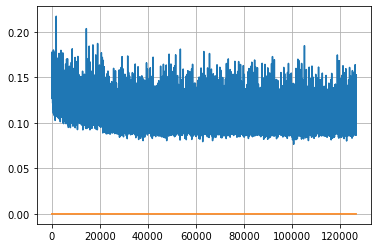

Epoch: 325, iteration 0, loss 0.09424751996994019, cov_diff 0.41567180963781 cov_diff train 0.4152270636336504
Epoch: 325, iteration 1, loss 0.1085677444934845, cov_diff 0.41239545702481495 cov_diff train 0.41196059994817213
Epoch: 325, iteration 2, loss 0.09308794140815735, cov_diff 0.41533667892098164 cov_diff train 0.41478877137988446
Epoch: 325, iteration 3, loss 0.10560974478721619, cov_diff 0.4144162771781999 cov_diff train 0.41315188912546835
Epoch: 325, iteration 4, loss 0.09497424960136414, cov_diff 0.40866361007451435 cov_diff train 0.4079291336738418
Epoch: 325, iteration 5, loss 0.09913778305053711, cov_diff 0.4124922382237137 cov_diff train 0.41192579434962456
Epoch: 325, iteration 6, loss 0.10212442278862, cov_diff 0.3978923430019114 cov_diff train 0.3961046293861806
Epoch: 325, iteration 7, loss 0.10294237732887268, cov_diff 0.4126325295947193 cov_diff train 0.41210437147883233
Epoch: 325, iteration 8, loss 0.0915251076221466, cov_diff 0.4131065091475019 cov_diff train 0

Epoch: 325, iteration 74, loss 0.1073862612247467, cov_diff 0.40997380385694104 cov_diff train 0.40936814396491433
Epoch: 325, iteration 75, loss 0.1013934314250946, cov_diff 0.40371370648582 cov_diff train 0.40236973890682104
Epoch: 325, iteration 76, loss 0.09882616996765137, cov_diff 0.42152088496762596 cov_diff train 0.4206817808649856
Epoch: 325, iteration 77, loss 0.11123776435852051, cov_diff 0.41079838809121977 cov_diff train 0.4082819735209754
Epoch: 325, iteration 78, loss 0.10999846458435059, cov_diff 0.40743031621001674 cov_diff train 0.4066757907936361
Epoch: 325, iteration 79, loss 0.11322858929634094, cov_diff 0.406789282092919 cov_diff train 0.40550241649524604
Epoch: 325, iteration 80, loss 0.1044161319732666, cov_diff 0.4090896390446586 cov_diff train 0.409193563145299
Epoch: 325, iteration 81, loss 0.11184707283973694, cov_diff 0.4179686444426146 cov_diff train 0.4175116097237502
Epoch: 325, iteration 82, loss 0.09471738338470459, cov_diff 0.4137950027709207 cov_diff

Epoch: 325, iteration 149, loss 0.10941904783248901, cov_diff 0.40381957437009564 cov_diff train 0.40391188121865285
Epoch: 325, iteration 150, loss 0.10321760177612305, cov_diff 0.4190973315582145 cov_diff train 0.419424018534323
Epoch: 325, iteration 151, loss 0.10158783197402954, cov_diff 0.42034807770617083 cov_diff train 0.4202758571092791
Epoch: 325, iteration 152, loss 0.10748913884162903, cov_diff 0.41525794763309637 cov_diff train 0.4150923729726329
Epoch: 325, iteration 153, loss 0.10043320059776306, cov_diff 0.42621433786175444 cov_diff train 0.4261523661235362
Epoch: 325, iteration 154, loss 0.11069798469543457, cov_diff 0.4221259587283479 cov_diff train 0.4214451310000731
Epoch: 325, iteration 155, loss 0.09607681632041931, cov_diff 0.4159867443146096 cov_diff train 0.41573146153398105
Epoch: 325, iteration 156, loss 0.09020447731018066, cov_diff 0.4107511257307155 cov_diff train 0.410441618520639
Epoch: 325, iteration 157, loss 0.10184359550476074, cov_diff 0.416094263026

Epoch: 325, iteration 226, loss 0.10444724559783936, cov_diff 0.4331788379467734 cov_diff train 0.43149387635973413
Epoch: 325, iteration 227, loss 0.09756144881248474, cov_diff 0.39651306662613384 cov_diff train 0.395117308999834
Epoch: 325, iteration 228, loss 0.10299336910247803, cov_diff 0.40618096101904777 cov_diff train 0.4045322581365022
Epoch: 325, iteration 229, loss 0.12435662746429443, cov_diff 0.4184401947407435 cov_diff train 0.41810428163584595
Epoch: 325, iteration 230, loss 0.08548179268836975, cov_diff 0.40445901624817304 cov_diff train 0.40410476087444996
Epoch: 325, iteration 231, loss 0.09214553236961365, cov_diff 0.4114727991730915 cov_diff train 0.4105173969722647
Epoch: 325, iteration 232, loss 0.1076911985874176, cov_diff 0.43098416527940325 cov_diff train 0.4301882904344999
Epoch: 325, iteration 233, loss 0.11591726541519165, cov_diff 0.42747247226606366 cov_diff train 0.4263855924084042
Epoch: 325, iteration 234, loss 0.09362953901290894, cov_diff 0.4106638486

Epoch: 325, iteration 302, loss 0.09690690040588379, cov_diff 0.42245409495524816 cov_diff train 0.4224142495251899
Epoch: 325, iteration 303, loss 0.10471433401107788, cov_diff 0.4205212659215165 cov_diff train 0.42028107488230115
Epoch: 325, iteration 304, loss 0.09796535968780518, cov_diff 0.3962092318077433 cov_diff train 0.3949297410187622
Epoch: 325, iteration 305, loss 0.10452726483345032, cov_diff 0.4080558356043298 cov_diff train 0.4075349742260981
Epoch: 325, iteration 306, loss 0.09789124131202698, cov_diff 0.400851721675859 cov_diff train 0.3999167093693956
Epoch: 325, iteration 307, loss 0.10393548011779785, cov_diff 0.4197367656416065 cov_diff train 0.4195892761465787
Epoch: 325, iteration 308, loss 0.09435290098190308, cov_diff 0.40160537228850224 cov_diff train 0.400791997656259
Epoch: 325, iteration 309, loss 0.09364470839500427, cov_diff 0.397713999327322 cov_diff train 0.3976195359129731
Epoch: 325, iteration 310, loss 0.11262091994285583, cov_diff 0.4302058657365687

Epoch: 325, iteration 381, loss 0.09685054421424866, cov_diff 0.4128236791222023 cov_diff train 0.4122474153421706
Epoch: 325, iteration 382, loss 0.12053787708282471, cov_diff 0.42375461709591766 cov_diff train 0.42378446108029555
Epoch: 325, iteration 383, loss 0.0926012396812439, cov_diff 0.4114058424897351 cov_diff train 0.4110580189771914
Epoch: 325, iteration 384, loss 0.11457106471061707, cov_diff 0.41114931197125315 cov_diff train 0.41018668018094223
Epoch: 325, iteration 385, loss 0.1004934012889862, cov_diff 0.4172924714237284 cov_diff train 0.4167989532779722
Epoch: 325, iteration 386, loss 0.10977378487586975, cov_diff 0.4073795037882422 cov_diff train 0.4061490351266753
Epoch: 325, iteration 387, loss 0.0941992700099945, cov_diff 0.4234566624601544 cov_diff train 0.4231600928136462
Epoch: 325, iteration 388, loss 0.1050574779510498, cov_diff 0.4014913549654987 cov_diff train 0.4015991108156492
Epoch: 325, iteration 389, loss 0.10164901614189148, cov_diff 0.4076934303348607

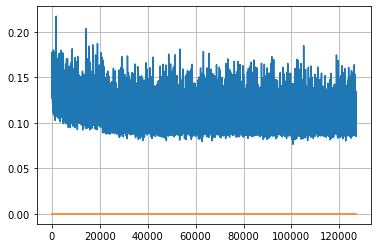

Epoch: 326, iteration 0, loss 0.10268419981002808, cov_diff 0.42303851884494986 cov_diff train 0.42239466466430114
Epoch: 326, iteration 1, loss 0.099232017993927, cov_diff 0.41376241002111275 cov_diff train 0.41310578089217415
Epoch: 326, iteration 2, loss 0.0995214581489563, cov_diff 0.4006481205111071 cov_diff train 0.39959029068965096
Epoch: 326, iteration 3, loss 0.1003463864326477, cov_diff 0.408999193016238 cov_diff train 0.40914180034095693
Epoch: 326, iteration 4, loss 0.10607177019119263, cov_diff 0.410476967329121 cov_diff train 0.40932065974773385
Epoch: 326, iteration 5, loss 0.10110363364219666, cov_diff 0.4186510656875409 cov_diff train 0.41811917075070315
Epoch: 326, iteration 6, loss 0.09786328673362732, cov_diff 0.4058480208415405 cov_diff train 0.40473174869608797
Epoch: 326, iteration 7, loss 0.09474274516105652, cov_diff 0.41568627133669367 cov_diff train 0.4151685502880258
Epoch: 326, iteration 8, loss 0.10067656636238098, cov_diff 0.40702651601107775 cov_diff tra

Epoch: 326, iteration 79, loss 0.11179766058921814, cov_diff 0.3996943593407833 cov_diff train 0.40002342340547337
Epoch: 326, iteration 80, loss 0.10964983701705933, cov_diff 0.41708644261300537 cov_diff train 0.416504452649492
Epoch: 326, iteration 81, loss 0.10069429874420166, cov_diff 0.4249333791082006 cov_diff train 0.424260314248758
Epoch: 326, iteration 82, loss 0.10026416182518005, cov_diff 0.41689222955116845 cov_diff train 0.4158860269924932
Epoch: 326, iteration 83, loss 0.10083678364753723, cov_diff 0.4027502536474479 cov_diff train 0.40208433692530854
Epoch: 326, iteration 84, loss 0.10051566362380981, cov_diff 0.4194839586592198 cov_diff train 0.4174551499089773
Epoch: 326, iteration 85, loss 0.09435892105102539, cov_diff 0.41387203695292324 cov_diff train 0.41337437964697443
Epoch: 326, iteration 86, loss 0.10660576820373535, cov_diff 0.40951706502903257 cov_diff train 0.4090537900236474
Epoch: 326, iteration 87, loss 0.10088565945625305, cov_diff 0.4076916994477283 cov

Epoch: 326, iteration 156, loss 0.11069554090499878, cov_diff 0.4218313466691321 cov_diff train 0.4206563509291482
Epoch: 326, iteration 157, loss 0.09792748093605042, cov_diff 0.40337843611944457 cov_diff train 0.4032366596979262
Epoch: 326, iteration 158, loss 0.09821933507919312, cov_diff 0.40951358473177646 cov_diff train 0.40928406434029513
Epoch: 326, iteration 159, loss 0.09424817562103271, cov_diff 0.4028503264595325 cov_diff train 0.4021725061588543
Epoch: 326, iteration 160, loss 0.10009962320327759, cov_diff 0.40347106425071394 cov_diff train 0.40322743337168654
Epoch: 326, iteration 161, loss 0.0986538827419281, cov_diff 0.41057561427130307 cov_diff train 0.41006652143193956
Epoch: 326, iteration 162, loss 0.11106333136558533, cov_diff 0.40031103634692766 cov_diff train 0.398884817035276
Epoch: 326, iteration 163, loss 0.1209401786327362, cov_diff 0.40256845062019186 cov_diff train 0.4019594313493401
Epoch: 326, iteration 164, loss 0.09792155027389526, cov_diff 0.4211450855

Epoch: 326, iteration 233, loss 0.10586556792259216, cov_diff 0.40197161702814516 cov_diff train 0.4023091452381195
Epoch: 326, iteration 234, loss 0.11456024646759033, cov_diff 0.39933729777144844 cov_diff train 0.400104717111136
Epoch: 326, iteration 235, loss 0.10000932216644287, cov_diff 0.41477696691945204 cov_diff train 0.415265268554448
Epoch: 326, iteration 236, loss 0.09996241331100464, cov_diff 0.4165666598135027 cov_diff train 0.41657376888076636
Epoch: 326, iteration 237, loss 0.09690439701080322, cov_diff 0.40969406588824264 cov_diff train 0.40939150954055165
Epoch: 326, iteration 238, loss 0.08914080262184143, cov_diff 0.42230478441759706 cov_diff train 0.42215992835950095
Epoch: 326, iteration 239, loss 0.10669070482254028, cov_diff 0.41691550472969074 cov_diff train 0.4160332847027778
Epoch: 326, iteration 240, loss 0.1142171323299408, cov_diff 0.42552270143042675 cov_diff train 0.42535366853897355
Epoch: 326, iteration 241, loss 0.11516031622886658, cov_diff 0.40506098

Epoch: 326, iteration 311, loss 0.10209134221076965, cov_diff 0.4166874795959798 cov_diff train 0.4158825010762387
Epoch: 326, iteration 312, loss 0.11022686958312988, cov_diff 0.40988494248292756 cov_diff train 0.4093308227444533
Epoch: 326, iteration 313, loss 0.10779425501823425, cov_diff 0.42089291983262767 cov_diff train 0.420619237302772
Epoch: 326, iteration 314, loss 0.10471165180206299, cov_diff 0.4126144960994074 cov_diff train 0.4126601070515543
Epoch: 326, iteration 315, loss 0.09724089503288269, cov_diff 0.41019261472020324 cov_diff train 0.4095434825287563
Epoch: 326, iteration 316, loss 0.1097324788570404, cov_diff 0.4274797403904669 cov_diff train 0.4266749392976313
Epoch: 326, iteration 317, loss 0.09814545512199402, cov_diff 0.41684787133577955 cov_diff train 0.41674690449521146
Epoch: 326, iteration 318, loss 0.10764938592910767, cov_diff 0.4272059863487622 cov_diff train 0.42706212087445244
Epoch: 326, iteration 319, loss 0.10823005437850952, cov_diff 0.426576380643

Epoch: 326, iteration 388, loss 0.10349777340888977, cov_diff 0.4177184581093473 cov_diff train 0.41807003609428744
Epoch: 326, iteration 389, loss 0.10301485657691956, cov_diff 0.4090375640900592 cov_diff train 0.4083527822887997
Epoch: 326, iteration 390, loss 0.1440959870815277, cov_diff 0.45000009897913573 cov_diff train 0.4464608746533714


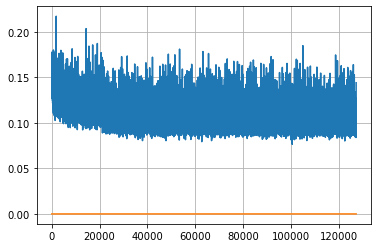

Epoch: 327, iteration 0, loss 0.09716072678565979, cov_diff 0.4103203657479223 cov_diff train 0.40978188381139896
Epoch: 327, iteration 1, loss 0.10338249802589417, cov_diff 0.4114637248930788 cov_diff train 0.4110068968047858
Epoch: 327, iteration 2, loss 0.10589727759361267, cov_diff 0.4117404283926226 cov_diff train 0.4108587115195749
Epoch: 327, iteration 3, loss 0.1078515350818634, cov_diff 0.40785234675200943 cov_diff train 0.4071724100123544
Epoch: 327, iteration 4, loss 0.10815709829330444, cov_diff 0.412170766825256 cov_diff train 0.4112612136858999
Epoch: 327, iteration 5, loss 0.10313877463340759, cov_diff 0.41351875756601175 cov_diff train 0.411787239792414
Epoch: 327, iteration 6, loss 0.10747075080871582, cov_diff 0.42391414806657646 cov_diff train 0.42348658686511703
Epoch: 327, iteration 7, loss 0.10195529460906982, cov_diff 0.40033545141982885 cov_diff train 0.4004546347509855
Epoch: 327, iteration 8, loss 0.10995903611183167, cov_diff 0.41484922472287983 cov_diff trai

Epoch: 327, iteration 77, loss 0.10086125135421753, cov_diff 0.4182314235857809 cov_diff train 0.417749259347676
Epoch: 327, iteration 78, loss 0.10656821727752686, cov_diff 0.41037211821823044 cov_diff train 0.40998842771673266
Epoch: 327, iteration 79, loss 0.10070392489433289, cov_diff 0.41502746626141146 cov_diff train 0.4139077753503407
Epoch: 327, iteration 80, loss 0.09434211254119873, cov_diff 0.401897733451669 cov_diff train 0.40177005567619206
Epoch: 327, iteration 81, loss 0.0966779887676239, cov_diff 0.41557125620799956 cov_diff train 0.4144225662705069
Epoch: 327, iteration 82, loss 0.09202495217323303, cov_diff 0.40745922945475127 cov_diff train 0.4063522383834567
Epoch: 327, iteration 83, loss 0.09106025099754333, cov_diff 0.41510446126285416 cov_diff train 0.41454470140800387
Epoch: 327, iteration 84, loss 0.10125985741615295, cov_diff 0.3983921914524358 cov_diff train 0.3974519474600426
Epoch: 327, iteration 85, loss 0.10706597566604614, cov_diff 0.4141868483059514 cov

Epoch: 327, iteration 155, loss 0.11026439070701599, cov_diff 0.4058252227848534 cov_diff train 0.4068867955973871
Epoch: 327, iteration 156, loss 0.10966446995735168, cov_diff 0.42075993242489057 cov_diff train 0.4201113802280518
Epoch: 327, iteration 157, loss 0.10459226369857788, cov_diff 0.4089123719067051 cov_diff train 0.4086355883400667
Epoch: 327, iteration 158, loss 0.103547602891922, cov_diff 0.4109513395256456 cov_diff train 0.41055379922247914
Epoch: 327, iteration 159, loss 0.10193765163421631, cov_diff 0.42187051915408097 cov_diff train 0.4205174441246682
Epoch: 327, iteration 160, loss 0.0987541675567627, cov_diff 0.41757607313617634 cov_diff train 0.416378485118679
Epoch: 327, iteration 161, loss 0.11626914143562317, cov_diff 0.4275836817813381 cov_diff train 0.4264223475826487
Epoch: 327, iteration 162, loss 0.1051517128944397, cov_diff 0.4143407889329336 cov_diff train 0.4143066593486549
Epoch: 327, iteration 163, loss 0.09526374936103821, cov_diff 0.4141339204248817 

Epoch: 327, iteration 232, loss 0.10109829902648926, cov_diff 0.4300176294550939 cov_diff train 0.4297993040605884
Epoch: 327, iteration 233, loss 0.10786300897598267, cov_diff 0.409907936864854 cov_diff train 0.4093152649271838
Epoch: 327, iteration 234, loss 0.11188599467277527, cov_diff 0.41197612167784164 cov_diff train 0.4108647495479314
Epoch: 327, iteration 235, loss 0.1120133101940155, cov_diff 0.42532053973219436 cov_diff train 0.4246785988694426
Epoch: 327, iteration 236, loss 0.10724133253097534, cov_diff 0.4318308776214853 cov_diff train 0.4298427934662882
Epoch: 327, iteration 237, loss 0.10779106616973877, cov_diff 0.40726976450014324 cov_diff train 0.40655632531033814
Epoch: 327, iteration 238, loss 0.09379395842552185, cov_diff 0.4170692316947706 cov_diff train 0.41598221374317795
Epoch: 327, iteration 239, loss 0.10469207167625427, cov_diff 0.4161985583560484 cov_diff train 0.4157693516015285
Epoch: 327, iteration 240, loss 0.1044379472732544, cov_diff 0.40430230198571

Epoch: 327, iteration 308, loss 0.10988613963127136, cov_diff 0.40580187360188913 cov_diff train 0.4050511589161557
Epoch: 327, iteration 309, loss 0.10859730839729309, cov_diff 0.4203301152474417 cov_diff train 0.4201860192615851
Epoch: 327, iteration 310, loss 0.10250762104988098, cov_diff 0.41017407033043113 cov_diff train 0.4098721076161512
Epoch: 327, iteration 311, loss 0.10681134462356567, cov_diff 0.40762420277825423 cov_diff train 0.4078408957208543
Epoch: 327, iteration 312, loss 0.09426182508468628, cov_diff 0.4065487606803494 cov_diff train 0.4058130869797765
Epoch: 327, iteration 313, loss 0.10827025771141052, cov_diff 0.410259534728998 cov_diff train 0.4105385045664999
Epoch: 327, iteration 314, loss 0.0994214117527008, cov_diff 0.40542410638607246 cov_diff train 0.40564185428137894
Epoch: 327, iteration 315, loss 0.09789350628852844, cov_diff 0.4132040764942459 cov_diff train 0.41262230181927845
Epoch: 327, iteration 316, loss 0.10127902030944824, cov_diff 0.408928182219

Epoch: 327, iteration 385, loss 0.09558215737342834, cov_diff 0.4085728044071093 cov_diff train 0.40867042485585725
Epoch: 327, iteration 386, loss 0.10112342238426208, cov_diff 0.4127543562744062 cov_diff train 0.4123848171236543
Epoch: 327, iteration 387, loss 0.10087519884109497, cov_diff 0.4364314708935399 cov_diff train 0.4367093739681551
Epoch: 327, iteration 388, loss 0.09906816482543945, cov_diff 0.4194265944741788 cov_diff train 0.4194887392982735
Epoch: 327, iteration 389, loss 0.1142931580543518, cov_diff 0.41066910380771593 cov_diff train 0.40911401216730997
Epoch: 327, iteration 390, loss 0.136989563703537, cov_diff 0.4630259285128458 cov_diff train 0.462288597601486


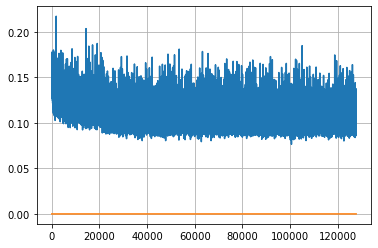

Epoch: 328, iteration 0, loss 0.10706999897956848, cov_diff 0.41463742674629517 cov_diff train 0.41441126179642473
Epoch: 328, iteration 1, loss 0.0916997492313385, cov_diff 0.4191793484792744 cov_diff train 0.41905540308148
Epoch: 328, iteration 2, loss 0.1049293577671051, cov_diff 0.41622516125161346 cov_diff train 0.4146107709399258
Epoch: 328, iteration 3, loss 0.10183265805244446, cov_diff 0.4054360780129939 cov_diff train 0.4049096955991433
Epoch: 328, iteration 4, loss 0.09046071767807007, cov_diff 0.40951738470220456 cov_diff train 0.40833736154317973
Epoch: 328, iteration 5, loss 0.09761452674865723, cov_diff 0.4157685450813598 cov_diff train 0.4140070116121491
Epoch: 328, iteration 6, loss 0.10463738441467285, cov_diff 0.40307022579317403 cov_diff train 0.4019140718697752
Epoch: 328, iteration 7, loss 0.09728270769119263, cov_diff 0.4171559265576577 cov_diff train 0.4163513462196147
Epoch: 328, iteration 8, loss 0.1141517162322998, cov_diff 0.41126906891580367 cov_diff train 

Epoch: 328, iteration 77, loss 0.10433733463287354, cov_diff 0.41825779327191304 cov_diff train 0.4172781482626295
Epoch: 328, iteration 78, loss 0.09515678882598877, cov_diff 0.3957570708150838 cov_diff train 0.39501509975078586
Epoch: 328, iteration 79, loss 0.10578766465187073, cov_diff 0.40362322233215064 cov_diff train 0.40308507857918713
Epoch: 328, iteration 80, loss 0.1039697527885437, cov_diff 0.40854411334945173 cov_diff train 0.40776905157093535
Epoch: 328, iteration 81, loss 0.10173481702804565, cov_diff 0.4066966062977511 cov_diff train 0.40699464873099445
Epoch: 328, iteration 82, loss 0.1072445809841156, cov_diff 0.40567121911285897 cov_diff train 0.40622719824516823
Epoch: 328, iteration 83, loss 0.10863488912582397, cov_diff 0.4026837659791162 cov_diff train 0.403288284345834
Epoch: 328, iteration 84, loss 0.10463419556617737, cov_diff 0.3981393807777841 cov_diff train 0.39711533306316665
Epoch: 328, iteration 85, loss 0.10243749618530273, cov_diff 0.40553656068946764 

Epoch: 328, iteration 152, loss 0.09846431016921997, cov_diff 0.39991214598534075 cov_diff train 0.39917751976178073
Epoch: 328, iteration 153, loss 0.0991438627243042, cov_diff 0.3925971420071469 cov_diff train 0.3911971260353634
Epoch: 328, iteration 154, loss 0.10149174928665161, cov_diff 0.4062929670843918 cov_diff train 0.4054574687652413
Epoch: 328, iteration 155, loss 0.10959967970848083, cov_diff 0.40835672181518884 cov_diff train 0.4078628830309575
Epoch: 328, iteration 156, loss 0.1095392107963562, cov_diff 0.41179464507678837 cov_diff train 0.41050690251133054
Epoch: 328, iteration 157, loss 0.10223475098609924, cov_diff 0.411716490049141 cov_diff train 0.4113825961147647
Epoch: 328, iteration 158, loss 0.10078185796737671, cov_diff 0.401069817515466 cov_diff train 0.40023749704096656
Epoch: 328, iteration 159, loss 0.10761979222297668, cov_diff 0.4090971508062425 cov_diff train 0.40790574944837765
Epoch: 328, iteration 160, loss 0.1066126823425293, cov_diff 0.42230566188986

Epoch: 328, iteration 229, loss 0.12005889415740967, cov_diff 0.41379714777276383 cov_diff train 0.4145783831925402
Epoch: 328, iteration 230, loss 0.10185614228248596, cov_diff 0.4080945331586083 cov_diff train 0.40609117604258615
Epoch: 328, iteration 231, loss 0.11467328667640686, cov_diff 0.42513045704273894 cov_diff train 0.4248716859021195
Epoch: 328, iteration 232, loss 0.10986322164535522, cov_diff 0.4164572946916257 cov_diff train 0.41609667367172426
Epoch: 328, iteration 233, loss 0.101591557264328, cov_diff 0.4102484456551338 cov_diff train 0.4086271887758605
Epoch: 328, iteration 234, loss 0.117281973361969, cov_diff 0.41826763399744893 cov_diff train 0.4179823976907203
Epoch: 328, iteration 235, loss 0.0907491147518158, cov_diff 0.3980667579129661 cov_diff train 0.3982298357265268
Epoch: 328, iteration 236, loss 0.10553225874900818, cov_diff 0.41352872826246606 cov_diff train 0.41294140622945397
Epoch: 328, iteration 237, loss 0.10633942484855652, cov_diff 0.40890890359254

Epoch: 328, iteration 308, loss 0.102776437997818, cov_diff 0.42119672758705357 cov_diff train 0.42055001285123955
Epoch: 328, iteration 309, loss 0.11085832118988037, cov_diff 0.4093272812838967 cov_diff train 0.40871294180911166
Epoch: 328, iteration 310, loss 0.09991562366485596, cov_diff 0.4070650299235856 cov_diff train 0.4061872303362972
Epoch: 328, iteration 311, loss 0.10698238015174866, cov_diff 0.4248510541092222 cov_diff train 0.4248228757149434
Epoch: 328, iteration 312, loss 0.09163948893547058, cov_diff 0.41683098334509616 cov_diff train 0.41651239814217295
Epoch: 328, iteration 313, loss 0.11066591739654541, cov_diff 0.4268463490615447 cov_diff train 0.4258601777963201
Epoch: 328, iteration 314, loss 0.10353052616119385, cov_diff 0.4158496945486226 cov_diff train 0.41525540899278857
Epoch: 328, iteration 315, loss 0.10575413703918457, cov_diff 0.40803702115833146 cov_diff train 0.40706308263045854
Epoch: 328, iteration 316, loss 0.1097123920917511, cov_diff 0.42066212651

Epoch: 328, iteration 384, loss 0.0923185646533966, cov_diff 0.41886879142302463 cov_diff train 0.4177252460710095
Epoch: 328, iteration 385, loss 0.11634010076522827, cov_diff 0.4036257496840564 cov_diff train 0.4024873547126592
Epoch: 328, iteration 386, loss 0.09842810034751892, cov_diff 0.42437269932075306 cov_diff train 0.4236657538909606
Epoch: 328, iteration 387, loss 0.10710924863815308, cov_diff 0.411891681277314 cov_diff train 0.4113245908470929
Epoch: 328, iteration 388, loss 0.10539588332176208, cov_diff 0.4137654476738004 cov_diff train 0.41338137162514227
Epoch: 328, iteration 389, loss 0.09020113945007324, cov_diff 0.4180965721444955 cov_diff train 0.41753556081775645
Epoch: 328, iteration 390, loss 0.16573655605316162, cov_diff 0.45456416020127355 cov_diff train 0.45505397229298983


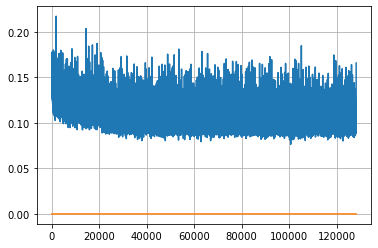

Epoch: 329, iteration 0, loss 0.10030579566955566, cov_diff 0.41004406850886643 cov_diff train 0.4097581866858559
Epoch: 329, iteration 1, loss 0.09785035252571106, cov_diff 0.410853564556335 cov_diff train 0.4109141475029713
Epoch: 329, iteration 2, loss 0.10061037540435791, cov_diff 0.41173574554896936 cov_diff train 0.41180541826437556
Epoch: 329, iteration 3, loss 0.10960948467254639, cov_diff 0.42535068162542916 cov_diff train 0.4241075382219521
Epoch: 329, iteration 4, loss 0.11109268665313721, cov_diff 0.4196223994053854 cov_diff train 0.4201337749340137
Epoch: 329, iteration 5, loss 0.09731593728065491, cov_diff 0.4083467280753893 cov_diff train 0.4077106774117278
Epoch: 329, iteration 6, loss 0.1103593111038208, cov_diff 0.4315869774926797 cov_diff train 0.43077577142333395
Epoch: 329, iteration 7, loss 0.10006687045097351, cov_diff 0.4115859299393516 cov_diff train 0.41117517227542333
Epoch: 329, iteration 8, loss 0.09387317299842834, cov_diff 0.4093552667740959 cov_diff trai

Epoch: 329, iteration 77, loss 0.09709760546684265, cov_diff 0.4051221154683047 cov_diff train 0.4050877410320454
Epoch: 329, iteration 78, loss 0.10839387774467468, cov_diff 0.4073667624427202 cov_diff train 0.406501911901713
Epoch: 329, iteration 79, loss 0.1068984866142273, cov_diff 0.41216373400372686 cov_diff train 0.41178600295033463
Epoch: 329, iteration 80, loss 0.10287389159202576, cov_diff 0.41196901750696696 cov_diff train 0.41185260312303285
Epoch: 329, iteration 81, loss 0.09393563866615295, cov_diff 0.40451704291499413 cov_diff train 0.40466058758136597
Epoch: 329, iteration 82, loss 0.09823891520500183, cov_diff 0.4029670851091276 cov_diff train 0.40189549208540254
Epoch: 329, iteration 83, loss 0.1027708649635315, cov_diff 0.4056151276433373 cov_diff train 0.4052788841564246
Epoch: 329, iteration 84, loss 0.10820496082305908, cov_diff 0.41214554748667087 cov_diff train 0.41220631333377544
Epoch: 329, iteration 85, loss 0.10756286978721619, cov_diff 0.4217807954006976 co

Epoch: 329, iteration 154, loss 0.10651242733001709, cov_diff 0.4166043214053675 cov_diff train 0.416319489289027
Epoch: 329, iteration 155, loss 0.09821420907974243, cov_diff 0.4309930076514872 cov_diff train 0.4299465493504212
Epoch: 329, iteration 156, loss 0.09722506999969482, cov_diff 0.4038971720063068 cov_diff train 0.4029720165637647
Epoch: 329, iteration 157, loss 0.1123822033405304, cov_diff 0.4189267625264688 cov_diff train 0.4182297168260516
Epoch: 329, iteration 158, loss 0.10608497262001038, cov_diff 0.42034501053116863 cov_diff train 0.41941013002019234
Epoch: 329, iteration 159, loss 0.10475623607635498, cov_diff 0.4042359981807763 cov_diff train 0.40441440409175855
Epoch: 329, iteration 160, loss 0.10358822345733643, cov_diff 0.4158992507196733 cov_diff train 0.415887366682032
Epoch: 329, iteration 161, loss 0.1081855297088623, cov_diff 0.41206987971932646 cov_diff train 0.41233903370005426
Epoch: 329, iteration 162, loss 0.11030328273773193, cov_diff 0.420274383348988

Epoch: 329, iteration 228, loss 0.09938645362854004, cov_diff 0.4240748098948828 cov_diff train 0.423552556027849
Epoch: 329, iteration 229, loss 0.10028529167175293, cov_diff 0.4144510521262944 cov_diff train 0.4143116881187015
Epoch: 329, iteration 230, loss 0.09530600905418396, cov_diff 0.4143150780003728 cov_diff train 0.4138313728207676
Epoch: 329, iteration 231, loss 0.1105073094367981, cov_diff 0.42053027095357254 cov_diff train 0.4201638395547645
Epoch: 329, iteration 232, loss 0.10747554898262024, cov_diff 0.41978735583960647 cov_diff train 0.4189948052466374
Epoch: 329, iteration 233, loss 0.10399898886680603, cov_diff 0.3983336726329777 cov_diff train 0.3980414852347434
Epoch: 329, iteration 234, loss 0.11452487111091614, cov_diff 0.4121522851317475 cov_diff train 0.41112701373848365
Epoch: 329, iteration 235, loss 0.09673935174942017, cov_diff 0.41450631924322273 cov_diff train 0.4140840781721767
Epoch: 329, iteration 236, loss 0.11151057481765747, cov_diff 0.42537789655437

Epoch: 329, iteration 307, loss 0.10920962691307068, cov_diff 0.4204104726003514 cov_diff train 0.4184044289509185
Epoch: 329, iteration 308, loss 0.09842577576637268, cov_diff 0.41789235046784473 cov_diff train 0.4165071208318939
Epoch: 329, iteration 309, loss 0.08768439292907715, cov_diff 0.417066042379055 cov_diff train 0.41583928446595825
Epoch: 329, iteration 310, loss 0.10136261582374573, cov_diff 0.4171471720077061 cov_diff train 0.4165282251445519
Epoch: 329, iteration 311, loss 0.10629004240036011, cov_diff 0.41894399802776183 cov_diff train 0.4188389589861715
Epoch: 329, iteration 312, loss 0.10029283165931702, cov_diff 0.4153592219427636 cov_diff train 0.41495273208026007
Epoch: 329, iteration 313, loss 0.10493066906929016, cov_diff 0.4143574785798206 cov_diff train 0.414019431153663
Epoch: 329, iteration 314, loss 0.10481011867523193, cov_diff 0.39870185417971277 cov_diff train 0.39809805474931903
Epoch: 329, iteration 315, loss 0.10485857725143433, cov_diff 0.409619588059

Epoch: 329, iteration 387, loss 0.1049085259437561, cov_diff 0.4087264010920873 cov_diff train 0.4080687179314779
Epoch: 329, iteration 388, loss 0.10732486844062805, cov_diff 0.4181877563437115 cov_diff train 0.41824642267039197
Epoch: 329, iteration 389, loss 0.10578063130378723, cov_diff 0.41149099023803826 cov_diff train 0.4114441437393218
Epoch: 329, iteration 390, loss 0.18072301149368286, cov_diff 0.46394793415029295 cov_diff train 0.4623287550828013


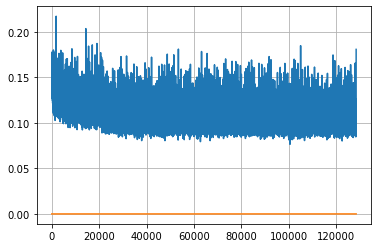

Epoch: 330, iteration 0, loss 0.10410049557685852, cov_diff 0.4025164377243688 cov_diff train 0.4023903263781104
Epoch: 330, iteration 1, loss 0.10969537496566772, cov_diff 0.4130312258353457 cov_diff train 0.412674853722072
Epoch: 330, iteration 2, loss 0.1114758849143982, cov_diff 0.4069633492221866 cov_diff train 0.4069482516365005
Epoch: 330, iteration 3, loss 0.09842842817306519, cov_diff 0.39930586657047346 cov_diff train 0.39970028150389936
Epoch: 330, iteration 4, loss 0.10452878475189209, cov_diff 0.41759302668200304 cov_diff train 0.4171636792958746
Epoch: 330, iteration 5, loss 0.10909998416900635, cov_diff 0.4204967392442296 cov_diff train 0.4203546584317146
Epoch: 330, iteration 6, loss 0.11839810013771057, cov_diff 0.4074713773508342 cov_diff train 0.4069169992904791
Epoch: 330, iteration 7, loss 0.11004224419593811, cov_diff 0.40255116615373215 cov_diff train 0.40181149692506274
Epoch: 330, iteration 8, loss 0.11515611410140991, cov_diff 0.41277688589231504 cov_diff trai

Epoch: 330, iteration 81, loss 0.11182981729507446, cov_diff 0.4143971914814008 cov_diff train 0.41279990326374866
Epoch: 330, iteration 82, loss 0.10715198516845703, cov_diff 0.40707119040347106 cov_diff train 0.4071816318586689
Epoch: 330, iteration 83, loss 0.09464645385742188, cov_diff 0.41211412516883916 cov_diff train 0.4121080874194937
Epoch: 330, iteration 84, loss 0.10091429948806763, cov_diff 0.41872402260545866 cov_diff train 0.4183790659368266
Epoch: 330, iteration 85, loss 0.10202032327651978, cov_diff 0.4120847075103689 cov_diff train 0.4117943433382312
Epoch: 330, iteration 86, loss 0.1031997799873352, cov_diff 0.4071023026212727 cov_diff train 0.4069187000381362
Epoch: 330, iteration 87, loss 0.09858587384223938, cov_diff 0.4284343554307499 cov_diff train 0.4278216026025808
Epoch: 330, iteration 88, loss 0.10654553771018982, cov_diff 0.4105695875423103 cov_diff train 0.40920454646187043
Epoch: 330, iteration 89, loss 0.11919960379600525, cov_diff 0.4126107803185075 cov_

Epoch: 330, iteration 162, loss 0.08647486567497253, cov_diff 0.40511099521609995 cov_diff train 0.40377931456738547
Epoch: 330, iteration 163, loss 0.10748675465583801, cov_diff 0.4161379115914157 cov_diff train 0.415913553240864
Epoch: 330, iteration 164, loss 0.10345470905303955, cov_diff 0.413210734709689 cov_diff train 0.4131642436164504
Epoch: 330, iteration 165, loss 0.09678670763969421, cov_diff 0.4050216332394349 cov_diff train 0.4040209772971226
Epoch: 330, iteration 166, loss 0.10827967524528503, cov_diff 0.3980924991728956 cov_diff train 0.39805248253844516
Epoch: 330, iteration 167, loss 0.11262890696525574, cov_diff 0.41534121713266686 cov_diff train 0.4153912602145034
Epoch: 330, iteration 168, loss 0.10531860589981079, cov_diff 0.4144175412355983 cov_diff train 0.41437108100065045
Epoch: 330, iteration 169, loss 0.10733681917190552, cov_diff 0.41749929243355227 cov_diff train 0.4179283911238803
Epoch: 330, iteration 170, loss 0.10813415050506592, cov_diff 0.412698215030

Epoch: 330, iteration 243, loss 0.10332009196281433, cov_diff 0.422504142400085 cov_diff train 0.4220176443595818
Epoch: 330, iteration 244, loss 0.09661704301834106, cov_diff 0.4117563920206719 cov_diff train 0.4111648062110378
Epoch: 330, iteration 245, loss 0.088889479637146, cov_diff 0.4017930191272987 cov_diff train 0.40131782744543804
Epoch: 330, iteration 246, loss 0.12212374806404114, cov_diff 0.402640493043366 cov_diff train 0.40240917176796853
Epoch: 330, iteration 247, loss 0.1082649827003479, cov_diff 0.3993143709219388 cov_diff train 0.39832537083948866
Epoch: 330, iteration 248, loss 0.11200001835823059, cov_diff 0.41617465135115983 cov_diff train 0.4153719128117272
Epoch: 330, iteration 249, loss 0.10240370035171509, cov_diff 0.4150044170578071 cov_diff train 0.41515669980125364
Epoch: 330, iteration 250, loss 0.09586712718009949, cov_diff 0.4162469279413895 cov_diff train 0.4157925936504335
Epoch: 330, iteration 251, loss 0.10314556956291199, cov_diff 0.4125785737081874

Epoch: 330, iteration 321, loss 0.10531151294708252, cov_diff 0.4090450318973214 cov_diff train 0.40765664524805545
Epoch: 330, iteration 322, loss 0.10726979374885559, cov_diff 0.4198021916409487 cov_diff train 0.4191137665262529
Epoch: 330, iteration 323, loss 0.10666203498840332, cov_diff 0.4234598352628124 cov_diff train 0.42275475042398897
Epoch: 330, iteration 324, loss 0.11428990960121155, cov_diff 0.42044866670811804 cov_diff train 0.4188022228410717
Epoch: 330, iteration 325, loss 0.10199332237243652, cov_diff 0.41418167535694916 cov_diff train 0.4138687491316714
Epoch: 330, iteration 326, loss 0.10739853978157043, cov_diff 0.4032897512408367 cov_diff train 0.4032146974857165
Epoch: 330, iteration 327, loss 0.09910556674003601, cov_diff 0.4268730041037244 cov_diff train 0.4270710406084687
Epoch: 330, iteration 328, loss 0.09766802191734314, cov_diff 0.4039237682479005 cov_diff train 0.4038268278196755
Epoch: 330, iteration 329, loss 0.10908690094947815, cov_diff 0.399908675591

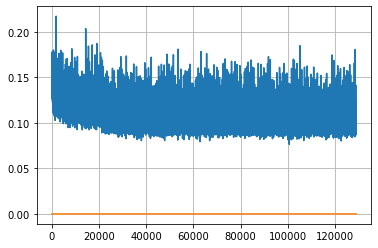

Epoch: 331, iteration 0, loss 0.10758012533187866, cov_diff 0.39677591192404466 cov_diff train 0.3970207858704956
Epoch: 331, iteration 1, loss 0.10469609498977661, cov_diff 0.3928062319114164 cov_diff train 0.3917792211932379
Epoch: 331, iteration 2, loss 0.09650987386703491, cov_diff 0.3998312635820962 cov_diff train 0.3994085977172622
Epoch: 331, iteration 3, loss 0.08967053890228271, cov_diff 0.4048875026560185 cov_diff train 0.4053530142464514
Epoch: 331, iteration 4, loss 0.1118948757648468, cov_diff 0.412361183961951 cov_diff train 0.4117623867700074
Epoch: 331, iteration 5, loss 0.10392418503761292, cov_diff 0.40544680538491756 cov_diff train 0.4053814474139918
Epoch: 331, iteration 6, loss 0.10268622636795044, cov_diff 0.4073401660591983 cov_diff train 0.40747990680662083
Epoch: 331, iteration 7, loss 0.102536141872406, cov_diff 0.4198404038893212 cov_diff train 0.41926897532902724
Epoch: 331, iteration 8, loss 0.10258722305297852, cov_diff 0.41702331068874543 cov_diff train 0

Epoch: 331, iteration 79, loss 0.1061771810054779, cov_diff 0.4128931150249877 cov_diff train 0.4124260599561977
Epoch: 331, iteration 80, loss 0.10284796357154846, cov_diff 0.4131970405263265 cov_diff train 0.41230769527101524
Epoch: 331, iteration 81, loss 0.09810313582420349, cov_diff 0.40749764145954975 cov_diff train 0.4070543642559831
Epoch: 331, iteration 82, loss 0.10293138027191162, cov_diff 0.41236664835738024 cov_diff train 0.41193114416834065
Epoch: 331, iteration 83, loss 0.10175511240959167, cov_diff 0.408032013468004 cov_diff train 0.4078242568097625
Epoch: 331, iteration 84, loss 0.1050560474395752, cov_diff 0.4134829814750857 cov_diff train 0.4124845077814337
Epoch: 331, iteration 85, loss 0.11374261975288391, cov_diff 0.40646578813426426 cov_diff train 0.4065628209886958
Epoch: 331, iteration 86, loss 0.10753923654556274, cov_diff 0.4074614580300444 cov_diff train 0.4069340737710201
Epoch: 331, iteration 87, loss 0.10197493433952332, cov_diff 0.4121171347928281 cov_di

Epoch: 331, iteration 156, loss 0.1020592749118805, cov_diff 0.4094248072852954 cov_diff train 0.40875304089919606
Epoch: 331, iteration 157, loss 0.10292837023735046, cov_diff 0.4111822297600262 cov_diff train 0.4112714884303675
Epoch: 331, iteration 158, loss 0.09906888008117676, cov_diff 0.39303571710033924 cov_diff train 0.3932325385916281
Epoch: 331, iteration 159, loss 0.10540539026260376, cov_diff 0.407985940723016 cov_diff train 0.40718428192125006
Epoch: 331, iteration 160, loss 0.10516354441642761, cov_diff 0.4076934051060861 cov_diff train 0.40742969798759365
Epoch: 331, iteration 161, loss 0.09355497360229492, cov_diff 0.40156251592381115 cov_diff train 0.4008420300427778
Epoch: 331, iteration 162, loss 0.10036462545394897, cov_diff 0.4147523596817198 cov_diff train 0.4143800780863619
Epoch: 331, iteration 163, loss 0.09750595688819885, cov_diff 0.40412830465535066 cov_diff train 0.4042969866821204
Epoch: 331, iteration 164, loss 0.09841868281364441, cov_diff 0.412666932475

Epoch: 331, iteration 234, loss 0.11251497268676758, cov_diff 0.4252205704323329 cov_diff train 0.42532529224647425
Epoch: 331, iteration 235, loss 0.11057674884796143, cov_diff 0.42797373145498235 cov_diff train 0.42832659782886584
Epoch: 331, iteration 236, loss 0.09967288374900818, cov_diff 0.40561231584467883 cov_diff train 0.40540284084065553
Epoch: 331, iteration 237, loss 0.10174468159675598, cov_diff 0.4039058701616967 cov_diff train 0.4034944543787599
Epoch: 331, iteration 238, loss 0.09609538316726685, cov_diff 0.3994497687120412 cov_diff train 0.39979906753506356
Epoch: 331, iteration 239, loss 0.10196107625961304, cov_diff 0.4128257844826126 cov_diff train 0.41295080058379363
Epoch: 331, iteration 240, loss 0.10182645916938782, cov_diff 0.41788130642297877 cov_diff train 0.41645459161839987
Epoch: 331, iteration 241, loss 0.10535219311714172, cov_diff 0.4149771980730727 cov_diff train 0.41373041852396514
Epoch: 331, iteration 242, loss 0.09698805212974548, cov_diff 0.399324

Epoch: 331, iteration 314, loss 0.10037663578987122, cov_diff 0.4123056379149804 cov_diff train 0.4122987143944689
Epoch: 331, iteration 315, loss 0.10747426748275757, cov_diff 0.4269161141754409 cov_diff train 0.4260521385910244
Epoch: 331, iteration 316, loss 0.1015942394733429, cov_diff 0.41947201012704133 cov_diff train 0.41908772281858514
Epoch: 331, iteration 317, loss 0.10700768232345581, cov_diff 0.4094953723802629 cov_diff train 0.4088477565169073
Epoch: 331, iteration 318, loss 0.10993963479995728, cov_diff 0.4234211509553363 cov_diff train 0.42272789234068786
Epoch: 331, iteration 319, loss 0.0991244912147522, cov_diff 0.41564233136819606 cov_diff train 0.4152785031719748
Epoch: 331, iteration 320, loss 0.1089874804019928, cov_diff 0.42069184643986796 cov_diff train 0.42051187906380433
Epoch: 331, iteration 321, loss 0.10408204793930054, cov_diff 0.4186990476485033 cov_diff train 0.4183317830695745
Epoch: 331, iteration 322, loss 0.10342472791671753, cov_diff 0.4197265130234

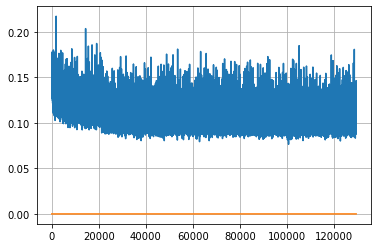

Epoch: 332, iteration 0, loss 0.10211074352264404, cov_diff 0.4224721297287512 cov_diff train 0.42160959092162925
Epoch: 332, iteration 1, loss 0.1171540915966034, cov_diff 0.4122034056449917 cov_diff train 0.4117588487996712
Epoch: 332, iteration 2, loss 0.10801684856414795, cov_diff 0.41348162627860363 cov_diff train 0.4136851698874051
Epoch: 332, iteration 3, loss 0.10375994443893433, cov_diff 0.40648025361940787 cov_diff train 0.40603528776542486
Epoch: 332, iteration 4, loss 0.10024750232696533, cov_diff 0.4016858962689895 cov_diff train 0.40119575610529573
Epoch: 332, iteration 5, loss 0.10563686490058899, cov_diff 0.41986006998065434 cov_diff train 0.42001002562400236
Epoch: 332, iteration 6, loss 0.10455408692359924, cov_diff 0.4105459151716502 cov_diff train 0.4105005458603828
Epoch: 332, iteration 7, loss 0.09648245573043823, cov_diff 0.4215463154454199 cov_diff train 0.42070829622358824
Epoch: 332, iteration 8, loss 0.09410467743873596, cov_diff 0.4167075183459454 cov_diff t

Epoch: 332, iteration 78, loss 0.1105632483959198, cov_diff 0.40756243502159 cov_diff train 0.40738818841119
Epoch: 332, iteration 79, loss 0.09681951999664307, cov_diff 0.40453226282079724 cov_diff train 0.4041825301749978
Epoch: 332, iteration 80, loss 0.0922849178314209, cov_diff 0.4075433439901171 cov_diff train 0.40728166073383826
Epoch: 332, iteration 81, loss 0.1080453097820282, cov_diff 0.39720831385947325 cov_diff train 0.39698605758379346
Epoch: 332, iteration 82, loss 0.1044270396232605, cov_diff 0.4055514208593241 cov_diff train 0.40450348070860315
Epoch: 332, iteration 83, loss 0.09757080674171448, cov_diff 0.4150139465681992 cov_diff train 0.41485613377007535
Epoch: 332, iteration 84, loss 0.10615956783294678, cov_diff 0.4179376770973514 cov_diff train 0.4173723262008622
Epoch: 332, iteration 85, loss 0.10103079676628113, cov_diff 0.41711043571616385 cov_diff train 0.41577447802556594
Epoch: 332, iteration 86, loss 0.10821276903152466, cov_diff 0.4175160739887007 cov_diff

Epoch: 332, iteration 155, loss 0.11913937330245972, cov_diff 0.4164126040502119 cov_diff train 0.414759887909682
Epoch: 332, iteration 156, loss 0.09415659308433533, cov_diff 0.4015718298915051 cov_diff train 0.40020325623854036
Epoch: 332, iteration 157, loss 0.10801100730895996, cov_diff 0.4037733414338791 cov_diff train 0.4028881840529541
Epoch: 332, iteration 158, loss 0.10345795750617981, cov_diff 0.41556104669132976 cov_diff train 0.41383742157643055
Epoch: 332, iteration 159, loss 0.10931459069252014, cov_diff 0.4177759663375356 cov_diff train 0.4169301345567519
Epoch: 332, iteration 160, loss 0.10152944922447205, cov_diff 0.42161219979156345 cov_diff train 0.42092003654076404
Epoch: 332, iteration 161, loss 0.09779393672943115, cov_diff 0.40679999060015165 cov_diff train 0.4068813596032321
Epoch: 332, iteration 162, loss 0.10134530067443848, cov_diff 0.41902167324545264 cov_diff train 0.41807556919069355
Epoch: 332, iteration 163, loss 0.117940753698349, cov_diff 0.40248561804

Epoch: 332, iteration 235, loss 0.09922626614570618, cov_diff 0.41098585095479445 cov_diff train 0.4105703232894529
Epoch: 332, iteration 236, loss 0.09790512919425964, cov_diff 0.41803757193080193 cov_diff train 0.4177880217911281
Epoch: 332, iteration 237, loss 0.1047934889793396, cov_diff 0.40826265909352905 cov_diff train 0.4076812313650886
Epoch: 332, iteration 238, loss 0.12073463201522827, cov_diff 0.4152370061470172 cov_diff train 0.41585816804241427
Epoch: 332, iteration 239, loss 0.09588178992271423, cov_diff 0.4162118173869825 cov_diff train 0.41571413495308274
Epoch: 332, iteration 240, loss 0.11185622215270996, cov_diff 0.4104251947891272 cov_diff train 0.4103529396950636
Epoch: 332, iteration 241, loss 0.09884610772132874, cov_diff 0.40740812752158906 cov_diff train 0.40774355042747545
Epoch: 332, iteration 242, loss 0.10652059316635132, cov_diff 0.41627599437499996 cov_diff train 0.4165910536270009
Epoch: 332, iteration 243, loss 0.1072651743888855, cov_diff 0.4042979293

Epoch: 332, iteration 313, loss 0.10920292139053345, cov_diff 0.4077594187253867 cov_diff train 0.40668792677100657
Epoch: 332, iteration 314, loss 0.09327006340026855, cov_diff 0.4148936493443497 cov_diff train 0.4140634508213572
Epoch: 332, iteration 315, loss 0.11033681035041809, cov_diff 0.41997803688851726 cov_diff train 0.41887621810686443
Epoch: 332, iteration 316, loss 0.09809863567352295, cov_diff 0.41940093377382354 cov_diff train 0.41743971840354316
Epoch: 332, iteration 317, loss 0.10564053058624268, cov_diff 0.40524464614268035 cov_diff train 0.4046153363575874
Epoch: 332, iteration 318, loss 0.11038476228713989, cov_diff 0.40551212557122884 cov_diff train 0.40461241493613814
Epoch: 332, iteration 319, loss 0.10116854310035706, cov_diff 0.4082413692847332 cov_diff train 0.4073409602154723
Epoch: 332, iteration 320, loss 0.10499781370162964, cov_diff 0.40102032546220107 cov_diff train 0.4001195728076241
Epoch: 332, iteration 321, loss 0.08919697999954224, cov_diff 0.4144386

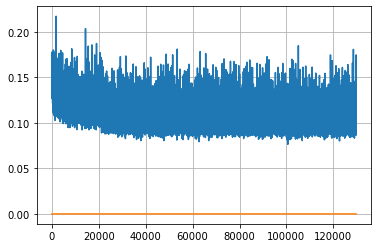

Epoch: 333, iteration 0, loss 0.10358047485351562, cov_diff 0.4185395904272279 cov_diff train 0.41806863308499115
Epoch: 333, iteration 1, loss 0.11300146579742432, cov_diff 0.42279605314938423 cov_diff train 0.4226052679522987
Epoch: 333, iteration 2, loss 0.09924793243408203, cov_diff 0.4063022838262998 cov_diff train 0.40558466402124216
Epoch: 333, iteration 3, loss 0.10089784860610962, cov_diff 0.416872394365411 cov_diff train 0.4164310566280784
Epoch: 333, iteration 4, loss 0.10519388318061829, cov_diff 0.41150915590327963 cov_diff train 0.41041309465452164
Epoch: 333, iteration 5, loss 0.10917899012565613, cov_diff 0.4078431121268936 cov_diff train 0.40739533479276124
Epoch: 333, iteration 6, loss 0.09355294704437256, cov_diff 0.4034957102248182 cov_diff train 0.4034361689359166
Epoch: 333, iteration 7, loss 0.0953972339630127, cov_diff 0.4127518499977654 cov_diff train 0.4126193743882395
Epoch: 333, iteration 8, loss 0.12046140432357788, cov_diff 0.4115965607501021 cov_diff trai

Epoch: 333, iteration 75, loss 0.08871668577194214, cov_diff 0.41667019886816253 cov_diff train 0.4162187632350267
Epoch: 333, iteration 76, loss 0.10682111978530884, cov_diff 0.4112325722553247 cov_diff train 0.4102725989841007
Epoch: 333, iteration 77, loss 0.10148775577545166, cov_diff 0.41602060114619194 cov_diff train 0.4153522780383707
Epoch: 333, iteration 78, loss 0.11134994029998779, cov_diff 0.4242625939568805 cov_diff train 0.4230674525846114
Epoch: 333, iteration 79, loss 0.09122294187545776, cov_diff 0.4154000288668296 cov_diff train 0.41454939458694356
Epoch: 333, iteration 80, loss 0.10290911793708801, cov_diff 0.4148723973972091 cov_diff train 0.41407698908640445
Epoch: 333, iteration 81, loss 0.10893970727920532, cov_diff 0.4181403324343412 cov_diff train 0.4170313664713345
Epoch: 333, iteration 82, loss 0.10600954294204712, cov_diff 0.41960877519339695 cov_diff train 0.41837463564168154
Epoch: 333, iteration 83, loss 0.09861055016517639, cov_diff 0.40822109204251533 c

Epoch: 333, iteration 154, loss 0.10782608389854431, cov_diff 0.41532195012619677 cov_diff train 0.41455770223253274
Epoch: 333, iteration 155, loss 0.09933027625083923, cov_diff 0.4102922555507297 cov_diff train 0.4100025439684804
Epoch: 333, iteration 156, loss 0.11338084936141968, cov_diff 0.4179585159119995 cov_diff train 0.4184275774154582
Epoch: 333, iteration 157, loss 0.10778027772903442, cov_diff 0.421198133064049 cov_diff train 0.4201224090017613
Epoch: 333, iteration 158, loss 0.10097953677177429, cov_diff 0.41039063561271727 cov_diff train 0.40891616495093686
Epoch: 333, iteration 159, loss 0.10889771580696106, cov_diff 0.40389678851123495 cov_diff train 0.4028926949790116
Epoch: 333, iteration 160, loss 0.09977751970291138, cov_diff 0.4144705260932466 cov_diff train 0.41425508298717
Epoch: 333, iteration 161, loss 0.10608091950416565, cov_diff 0.41051624655050345 cov_diff train 0.40981598350465503
Epoch: 333, iteration 162, loss 0.10508683323860168, cov_diff 0.416744047972

Epoch: 333, iteration 226, loss 0.1096683144569397, cov_diff 0.40550695347350885 cov_diff train 0.4049763443035634
Epoch: 333, iteration 227, loss 0.09093871712684631, cov_diff 0.4132790580851216 cov_diff train 0.41277505152803984
Epoch: 333, iteration 228, loss 0.1254943311214447, cov_diff 0.41626382044179766 cov_diff train 0.4169550353127311
Epoch: 333, iteration 229, loss 0.11530420184135437, cov_diff 0.4076506860044404 cov_diff train 0.40733748306860945
Epoch: 333, iteration 230, loss 0.1078290343284607, cov_diff 0.40456713019048024 cov_diff train 0.4044005888334241
Epoch: 333, iteration 231, loss 0.10336613655090332, cov_diff 0.41091796869375635 cov_diff train 0.4109503176241276
Epoch: 333, iteration 232, loss 0.1044827401638031, cov_diff 0.40159097584890574 cov_diff train 0.4005404706582108
Epoch: 333, iteration 233, loss 0.12328654527664185, cov_diff 0.4163496839974866 cov_diff train 0.4150061036298672
Epoch: 333, iteration 234, loss 0.10141116380691528, cov_diff 0.4157531024229

Epoch: 333, iteration 303, loss 0.10807594656944275, cov_diff 0.42011928934803594 cov_diff train 0.41921533567014546
Epoch: 333, iteration 304, loss 0.10962355136871338, cov_diff 0.4161854594918684 cov_diff train 0.4153454531374769
Epoch: 333, iteration 305, loss 0.10360610485076904, cov_diff 0.41098687657187466 cov_diff train 0.4092669504599277
Epoch: 333, iteration 306, loss 0.10789674520492554, cov_diff 0.4223250434977753 cov_diff train 0.42151542725175317
Epoch: 333, iteration 307, loss 0.0920976996421814, cov_diff 0.4104792520863746 cov_diff train 0.410144002416331
Epoch: 333, iteration 308, loss 0.1015937328338623, cov_diff 0.4093013682315935 cov_diff train 0.40912698096517197
Epoch: 333, iteration 309, loss 0.09344631433486938, cov_diff 0.41873590863815835 cov_diff train 0.4180844284256781
Epoch: 333, iteration 310, loss 0.10463932156562805, cov_diff 0.4069468949218969 cov_diff train 0.40577530448854404
Epoch: 333, iteration 311, loss 0.1050766110420227, cov_diff 0.4088766995573

Epoch: 333, iteration 375, loss 0.09748560190200806, cov_diff 0.40370665631208635 cov_diff train 0.40287265247616755
Epoch: 333, iteration 376, loss 0.10193324089050293, cov_diff 0.40272869597801736 cov_diff train 0.40193169461556244
Epoch: 333, iteration 377, loss 0.0887785255908966, cov_diff 0.4181523355956631 cov_diff train 0.4172427879174235
Epoch: 333, iteration 378, loss 0.11002194881439209, cov_diff 0.42256106038623065 cov_diff train 0.4211350127566418
Epoch: 333, iteration 379, loss 0.09666574001312256, cov_diff 0.4111063055144048 cov_diff train 0.40985312694652964
Epoch: 333, iteration 380, loss 0.103788822889328, cov_diff 0.4124096367428192 cov_diff train 0.4124309420128542
Epoch: 333, iteration 381, loss 0.10090956091880798, cov_diff 0.4089048617901862 cov_diff train 0.40842075790866955
Epoch: 333, iteration 382, loss 0.10014429688453674, cov_diff 0.41938801843432905 cov_diff train 0.4191170292210089
Epoch: 333, iteration 383, loss 0.10997223854064941, cov_diff 0.41378843616

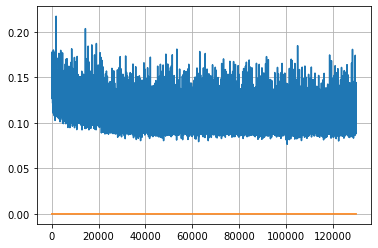

Epoch: 334, iteration 0, loss 0.09953492879867554, cov_diff 0.4321227295653416 cov_diff train 0.4319705338180064
Epoch: 334, iteration 1, loss 0.10404086112976074, cov_diff 0.4156853066818586 cov_diff train 0.41503365805698583
Epoch: 334, iteration 2, loss 0.1110832691192627, cov_diff 0.41133203078163755 cov_diff train 0.4108491986244495
Epoch: 334, iteration 3, loss 0.11337146162986755, cov_diff 0.41152767079952796 cov_diff train 0.41065937879868164
Epoch: 334, iteration 4, loss 0.10823258757591248, cov_diff 0.41442845613621515 cov_diff train 0.41486376100644595
Epoch: 334, iteration 5, loss 0.10892471671104431, cov_diff 0.4183011058563956 cov_diff train 0.41821668366087056
Epoch: 334, iteration 6, loss 0.09598514437675476, cov_diff 0.4195152905350933 cov_diff train 0.4194318559562473
Epoch: 334, iteration 7, loss 0.10961723327636719, cov_diff 0.415810251391876 cov_diff train 0.4144069410889446
Epoch: 334, iteration 8, loss 0.10274586081504822, cov_diff 0.4213393943791734 cov_diff tra

Epoch: 334, iteration 78, loss 0.10319164395332336, cov_diff 0.41928879347701264 cov_diff train 0.41769793796179505
Epoch: 334, iteration 79, loss 0.10145524144172668, cov_diff 0.41942290264380916 cov_diff train 0.4192042637700137
Epoch: 334, iteration 80, loss 0.09660881757736206, cov_diff 0.4193921025756234 cov_diff train 0.41924363187394276
Epoch: 334, iteration 81, loss 0.10116618871688843, cov_diff 0.414451724819208 cov_diff train 0.4145349495169335
Epoch: 334, iteration 82, loss 0.10549801588058472, cov_diff 0.43396963301257596 cov_diff train 0.4334723550591509
Epoch: 334, iteration 83, loss 0.10919857025146484, cov_diff 0.41459274892763937 cov_diff train 0.4144289874913822
Epoch: 334, iteration 84, loss 0.10510247945785522, cov_diff 0.41343193251879234 cov_diff train 0.41270545557934013
Epoch: 334, iteration 85, loss 0.10772925615310669, cov_diff 0.40054731490094186 cov_diff train 0.40012159936464053
Epoch: 334, iteration 86, loss 0.10754579305648804, cov_diff 0.4033701599917864

Epoch: 334, iteration 151, loss 0.1090499758720398, cov_diff 0.4023564176323852 cov_diff train 0.40190651093300805
Epoch: 334, iteration 152, loss 0.10590678453445435, cov_diff 0.4096220747075861 cov_diff train 0.4097851254500406
Epoch: 334, iteration 153, loss 0.11912402510643005, cov_diff 0.4145532350155083 cov_diff train 0.4145030360671466
Epoch: 334, iteration 154, loss 0.09430211782455444, cov_diff 0.40407799947981604 cov_diff train 0.40396021889873174
Epoch: 334, iteration 155, loss 0.09331062436103821, cov_diff 0.40864287930212406 cov_diff train 0.40779381733615017
Epoch: 334, iteration 156, loss 0.10176393389701843, cov_diff 0.421786817449351 cov_diff train 0.4208604929190858
Epoch: 334, iteration 157, loss 0.09606912732124329, cov_diff 0.41416893898725504 cov_diff train 0.4140648210774321
Epoch: 334, iteration 158, loss 0.10014739632606506, cov_diff 0.41264443283672686 cov_diff train 0.41328712788689753
Epoch: 334, iteration 159, loss 0.10553810000419617, cov_diff 0.4224822899

Epoch: 334, iteration 228, loss 0.10475224256515503, cov_diff 0.4171411097868807 cov_diff train 0.4159771793856212
Epoch: 334, iteration 229, loss 0.09211388230323792, cov_diff 0.4193349326297203 cov_diff train 0.418521442922148
Epoch: 334, iteration 230, loss 0.10528483986854553, cov_diff 0.40887550121950167 cov_diff train 0.40846828978712335
Epoch: 334, iteration 231, loss 0.09785884618759155, cov_diff 0.4194605867731991 cov_diff train 0.4182719819451373
Epoch: 334, iteration 232, loss 0.09972208738327026, cov_diff 0.4154907996614141 cov_diff train 0.41477944669459443
Epoch: 334, iteration 233, loss 0.11005976796150208, cov_diff 0.40850973063360496 cov_diff train 0.40787897250246197
Epoch: 334, iteration 234, loss 0.1064729392528534, cov_diff 0.4073196905132635 cov_diff train 0.40580959224823054
Epoch: 334, iteration 235, loss 0.10296311974525452, cov_diff 0.4208408700432889 cov_diff train 0.4172844161954214
Epoch: 334, iteration 236, loss 0.10702598094940186, cov_diff 0.414359684693

Epoch: 334, iteration 303, loss 0.10118550062179565, cov_diff 0.4071724901843223 cov_diff train 0.4060426651947027
Epoch: 334, iteration 304, loss 0.09378191828727722, cov_diff 0.41456306794098663 cov_diff train 0.4137869878222622
Epoch: 334, iteration 305, loss 0.10181686282157898, cov_diff 0.41736586430319117 cov_diff train 0.4167726688105074
Epoch: 334, iteration 306, loss 0.10346481204032898, cov_diff 0.4171793519675241 cov_diff train 0.41680314336993873
Epoch: 334, iteration 307, loss 0.11282968521118164, cov_diff 0.40263114802954786 cov_diff train 0.40224047561054943
Epoch: 334, iteration 308, loss 0.09696388244628906, cov_diff 0.4075028997109839 cov_diff train 0.40769517385085435
Epoch: 334, iteration 309, loss 0.09564891457557678, cov_diff 0.4081568280533687 cov_diff train 0.4076184581676867
Epoch: 334, iteration 310, loss 0.09845075011253357, cov_diff 0.4105447056136976 cov_diff train 0.4092673551002357
Epoch: 334, iteration 311, loss 0.09083199501037598, cov_diff 0.4096984453

Epoch: 334, iteration 383, loss 0.11654353141784668, cov_diff 0.41409965222506345 cov_diff train 0.4132628167212916
Epoch: 334, iteration 384, loss 0.10608232021331787, cov_diff 0.4242735692484801 cov_diff train 0.4231610640538991
Epoch: 334, iteration 385, loss 0.10482543706893921, cov_diff 0.4164079045359689 cov_diff train 0.41541770626451374
Epoch: 334, iteration 386, loss 0.10342481732368469, cov_diff 0.41093096561095016 cov_diff train 0.41063768883514506
Epoch: 334, iteration 387, loss 0.092344731092453, cov_diff 0.3932153019702473 cov_diff train 0.39236963494774874
Epoch: 334, iteration 388, loss 0.09475851058959961, cov_diff 0.3981924871945863 cov_diff train 0.39744409806947567
Epoch: 334, iteration 389, loss 0.10862135887145996, cov_diff 0.4184440692088598 cov_diff train 0.41826515821353083
Epoch: 334, iteration 390, loss 0.16711458563804626, cov_diff 0.45456782052884803 cov_diff train 0.45021320637729995


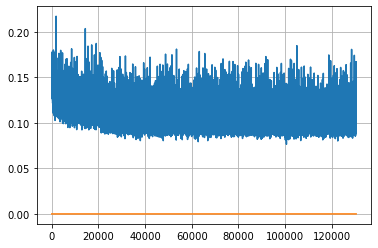

Epoch: 335, iteration 0, loss 0.10241255164146423, cov_diff 0.40156665934434177 cov_diff train 0.4005630539371986
Epoch: 335, iteration 1, loss 0.11254245042800903, cov_diff 0.40438556499686196 cov_diff train 0.4036636004052975
Epoch: 335, iteration 2, loss 0.11152389645576477, cov_diff 0.41904923216978757 cov_diff train 0.4176211146089255
Epoch: 335, iteration 3, loss 0.08938983082771301, cov_diff 0.40653814349855544 cov_diff train 0.40640021499331047
Epoch: 335, iteration 4, loss 0.11422848701477051, cov_diff 0.41267261040304265 cov_diff train 0.41155887787871986
Epoch: 335, iteration 5, loss 0.10521745681762695, cov_diff 0.4162339983428332 cov_diff train 0.4151116177907582
Epoch: 335, iteration 6, loss 0.10205653309822083, cov_diff 0.4158103099395953 cov_diff train 0.4155760843549896
Epoch: 335, iteration 7, loss 0.09285533428192139, cov_diff 0.4163211845932562 cov_diff train 0.4155880531071777
Epoch: 335, iteration 8, loss 0.11725768446922302, cov_diff 0.4081901493167517 cov_diff t

Epoch: 335, iteration 73, loss 0.10702010989189148, cov_diff 0.40730446930399505 cov_diff train 0.4077270695409377
Epoch: 335, iteration 74, loss 0.10765981674194336, cov_diff 0.4077299895864155 cov_diff train 0.40706930677652037
Epoch: 335, iteration 75, loss 0.10382324457168579, cov_diff 0.41023227200153184 cov_diff train 0.41006321175314403
Epoch: 335, iteration 76, loss 0.11240243911743164, cov_diff 0.4149976081601211 cov_diff train 0.4138956966409
Epoch: 335, iteration 77, loss 0.10292959213256836, cov_diff 0.41770059211058574 cov_diff train 0.4175661762580011
Epoch: 335, iteration 78, loss 0.1064242422580719, cov_diff 0.4103151645212451 cov_diff train 0.4099412823617347
Epoch: 335, iteration 79, loss 0.09557598829269409, cov_diff 0.41350432032709633 cov_diff train 0.41280823767699476
Epoch: 335, iteration 80, loss 0.10012438893318176, cov_diff 0.42818906635094284 cov_diff train 0.4279115786001914
Epoch: 335, iteration 81, loss 0.09387743473052979, cov_diff 0.4091595221594254 cov_

Epoch: 335, iteration 150, loss 0.09491592645645142, cov_diff 0.413079234084448 cov_diff train 0.4123838173539118
Epoch: 335, iteration 151, loss 0.09995412826538086, cov_diff 0.41215254592523226 cov_diff train 0.41173244137217335
Epoch: 335, iteration 152, loss 0.097523033618927, cov_diff 0.4011234907172223 cov_diff train 0.3996847731577296
Epoch: 335, iteration 153, loss 0.10902372002601624, cov_diff 0.4168345189093881 cov_diff train 0.4163802905141868
Epoch: 335, iteration 154, loss 0.10438910126686096, cov_diff 0.4129967440201432 cov_diff train 0.4123325692410509
Epoch: 335, iteration 155, loss 0.10995858907699585, cov_diff 0.42568538625999147 cov_diff train 0.4244562007598782
Epoch: 335, iteration 156, loss 0.11016100645065308, cov_diff 0.4161898104520028 cov_diff train 0.4151318389391356
Epoch: 335, iteration 157, loss 0.10610887408256531, cov_diff 0.4235633762356383 cov_diff train 0.4223096488930722
Epoch: 335, iteration 158, loss 0.10298064351081848, cov_diff 0.3960186770703228

Epoch: 335, iteration 228, loss 0.10804054141044617, cov_diff 0.4095138123697856 cov_diff train 0.40906577005071637
Epoch: 335, iteration 229, loss 0.10740867257118225, cov_diff 0.3941312657259855 cov_diff train 0.3933619695604368
Epoch: 335, iteration 230, loss 0.09948614239692688, cov_diff 0.4151782801881504 cov_diff train 0.4151536396731993
Epoch: 335, iteration 231, loss 0.10800811648368835, cov_diff 0.4038885735698533 cov_diff train 0.40319888041987234
Epoch: 335, iteration 232, loss 0.10515382885932922, cov_diff 0.40845479752567804 cov_diff train 0.40708388057383976
Epoch: 335, iteration 233, loss 0.09931135177612305, cov_diff 0.4098776634364824 cov_diff train 0.40902287616909594
Epoch: 335, iteration 234, loss 0.10732269287109375, cov_diff 0.41555386618618956 cov_diff train 0.41455811561581846
Epoch: 335, iteration 235, loss 0.10963952541351318, cov_diff 0.4110155653311375 cov_diff train 0.41008932618688476
Epoch: 335, iteration 236, loss 0.11718946695327759, cov_diff 0.41551799

Epoch: 335, iteration 307, loss 0.10383698344230652, cov_diff 0.4128514443572245 cov_diff train 0.41202431677199786
Epoch: 335, iteration 308, loss 0.10975036025047302, cov_diff 0.41005930591559436 cov_diff train 0.4099546534359164
Epoch: 335, iteration 309, loss 0.107276052236557, cov_diff 0.4050350904132697 cov_diff train 0.40458906917302156
Epoch: 335, iteration 310, loss 0.10439437627792358, cov_diff 0.40209232107515375 cov_diff train 0.4013580718421475
Epoch: 335, iteration 311, loss 0.11459872126579285, cov_diff 0.4204476251313615 cov_diff train 0.419230361853693
Epoch: 335, iteration 312, loss 0.10487130284309387, cov_diff 0.41851933122123225 cov_diff train 0.41746378609268064
Epoch: 335, iteration 313, loss 0.10000616312026978, cov_diff 0.4196474052192899 cov_diff train 0.41863097676623745
Epoch: 335, iteration 314, loss 0.10208025574684143, cov_diff 0.406199261438753 cov_diff train 0.4059715417937687
Epoch: 335, iteration 315, loss 0.10426908731460571, cov_diff 0.4188899605796

Epoch: 335, iteration 384, loss 0.10713624954223633, cov_diff 0.4088259668251629 cov_diff train 0.4084104443804194
Epoch: 335, iteration 385, loss 0.1112339198589325, cov_diff 0.42198741441357984 cov_diff train 0.4213767961689143
Epoch: 335, iteration 386, loss 0.10019505023956299, cov_diff 0.414512584914908 cov_diff train 0.4140694088802315
Epoch: 335, iteration 387, loss 0.1060800850391388, cov_diff 0.41185200732324495 cov_diff train 0.4117278239832422
Epoch: 335, iteration 388, loss 0.0978909432888031, cov_diff 0.4063264451068656 cov_diff train 0.40558479399763375
Epoch: 335, iteration 389, loss 0.09306991100311279, cov_diff 0.39966209416880827 cov_diff train 0.3986356891371881
Epoch: 335, iteration 390, loss 0.1461435854434967, cov_diff 0.4420316479979231 cov_diff train 0.44157667043973675


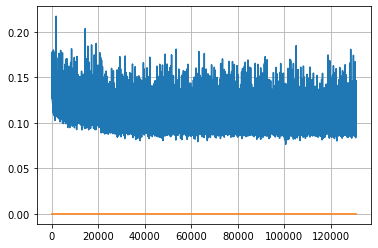

Epoch: 336, iteration 0, loss 0.09279227256774902, cov_diff 0.42118263280764656 cov_diff train 0.42008235631554425
Epoch: 336, iteration 1, loss 0.10941028594970703, cov_diff 0.4099943782121577 cov_diff train 0.4096378045364668
Epoch: 336, iteration 2, loss 0.10769402980804443, cov_diff 0.41085680338314107 cov_diff train 0.41052433641609487
Epoch: 336, iteration 3, loss 0.1057991087436676, cov_diff 0.4117432370160311 cov_diff train 0.4120103613675743
Epoch: 336, iteration 4, loss 0.10388731956481934, cov_diff 0.4114577439695099 cov_diff train 0.4103528491750658
Epoch: 336, iteration 5, loss 0.09476885199546814, cov_diff 0.41184500038523986 cov_diff train 0.41089627976361104
Epoch: 336, iteration 6, loss 0.09852221608161926, cov_diff 0.4020393688378224 cov_diff train 0.40078555837707436
Epoch: 336, iteration 7, loss 0.1153368353843689, cov_diff 0.4183177978937415 cov_diff train 0.41647603189312227
Epoch: 336, iteration 8, loss 0.09858149290084839, cov_diff 0.40064577367795035 cov_diff t

Epoch: 336, iteration 78, loss 0.11781778931617737, cov_diff 0.40168780520482505 cov_diff train 0.4009135611183112
Epoch: 336, iteration 79, loss 0.09868383407592773, cov_diff 0.40792031870494994 cov_diff train 0.4068701246899484
Epoch: 336, iteration 80, loss 0.10708156228065491, cov_diff 0.401504271999803 cov_diff train 0.40066507426191383
Epoch: 336, iteration 81, loss 0.10408040881156921, cov_diff 0.40065888462053423 cov_diff train 0.4001590836198643
Epoch: 336, iteration 82, loss 0.10955432057380676, cov_diff 0.4083841627031052 cov_diff train 0.408576772042068
Epoch: 336, iteration 83, loss 0.10865393280982971, cov_diff 0.42556575232295507 cov_diff train 0.42473401106434105
Epoch: 336, iteration 84, loss 0.11366254091262817, cov_diff 0.4022336659495146 cov_diff train 0.40166895260873403
Epoch: 336, iteration 85, loss 0.10352763533592224, cov_diff 0.4065867529412838 cov_diff train 0.4050590224720982
Epoch: 336, iteration 86, loss 0.10047528147697449, cov_diff 0.4094976768284155 cov

Epoch: 336, iteration 155, loss 0.11424466967582703, cov_diff 0.39825089738386255 cov_diff train 0.3973807645727385
Epoch: 336, iteration 156, loss 0.09876930713653564, cov_diff 0.4216234396885192 cov_diff train 0.4208072038921723
Epoch: 336, iteration 157, loss 0.10029616951942444, cov_diff 0.3910334028575519 cov_diff train 0.38991531962878107
Epoch: 336, iteration 158, loss 0.09538283944129944, cov_diff 0.40575799364365106 cov_diff train 0.40551922671357227
Epoch: 336, iteration 159, loss 0.1213221549987793, cov_diff 0.40941975695369187 cov_diff train 0.4083007052806869
Epoch: 336, iteration 160, loss 0.11372432112693787, cov_diff 0.41641301903944195 cov_diff train 0.4157822230413378
Epoch: 336, iteration 161, loss 0.10293743014335632, cov_diff 0.40059754012670507 cov_diff train 0.3990539233285538
Epoch: 336, iteration 162, loss 0.10788992047309875, cov_diff 0.40991755255797685 cov_diff train 0.4094384616265129
Epoch: 336, iteration 163, loss 0.1022244393825531, cov_diff 0.4172407806

Epoch: 336, iteration 235, loss 0.09328886866569519, cov_diff 0.4056134445517162 cov_diff train 0.40502731959237426
Epoch: 336, iteration 236, loss 0.09570261836051941, cov_diff 0.40105975638417346 cov_diff train 0.39923004293458747
Epoch: 336, iteration 237, loss 0.10233008861541748, cov_diff 0.4146750534561639 cov_diff train 0.4133080165417158
Epoch: 336, iteration 238, loss 0.10418245196342468, cov_diff 0.40094082926571495 cov_diff train 0.40108227639269334
Epoch: 336, iteration 239, loss 0.10432812571525574, cov_diff 0.4021146495289397 cov_diff train 0.4017850953538405
Epoch: 336, iteration 240, loss 0.09918755292892456, cov_diff 0.4083598777072768 cov_diff train 0.4077393138432188
Epoch: 336, iteration 241, loss 0.1040288507938385, cov_diff 0.4282018769966025 cov_diff train 0.4279229104458622
Epoch: 336, iteration 242, loss 0.10620099306106567, cov_diff 0.40938618348959604 cov_diff train 0.4088719257698769
Epoch: 336, iteration 243, loss 0.09327065944671631, cov_diff 0.41310542202

Epoch: 336, iteration 309, loss 0.10199043154716492, cov_diff 0.4221744346084033 cov_diff train 0.4217839239657577
Epoch: 336, iteration 310, loss 0.10339730978012085, cov_diff 0.4167443395999601 cov_diff train 0.41638987071361877
Epoch: 336, iteration 311, loss 0.10186344385147095, cov_diff 0.41527645927029894 cov_diff train 0.41480695341541834
Epoch: 336, iteration 312, loss 0.10032770037651062, cov_diff 0.39950545841788715 cov_diff train 0.3990558036511811
Epoch: 336, iteration 313, loss 0.10581895709037781, cov_diff 0.40869913877138914 cov_diff train 0.40849849665126164
Epoch: 336, iteration 314, loss 0.09829506278038025, cov_diff 0.4109277512076811 cov_diff train 0.4093096134777323
Epoch: 336, iteration 315, loss 0.10576233267784119, cov_diff 0.41172540873389074 cov_diff train 0.4110796850190818
Epoch: 336, iteration 316, loss 0.09497088193893433, cov_diff 0.4159896938305849 cov_diff train 0.4157026441916747
Epoch: 336, iteration 317, loss 0.10914930701255798, cov_diff 0.407513595

Epoch: 336, iteration 388, loss 0.10488280653953552, cov_diff 0.40872960971923855 cov_diff train 0.40885442958133295
Epoch: 336, iteration 389, loss 0.11051726341247559, cov_diff 0.40111258774396163 cov_diff train 0.40067506380142265
Epoch: 336, iteration 390, loss 0.14681094884872437, cov_diff 0.44090407226923295 cov_diff train 0.4405966770638962


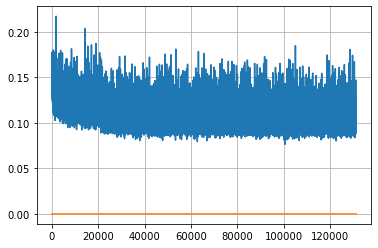

Epoch: 337, iteration 0, loss 0.09767279028892517, cov_diff 0.41412414331031516 cov_diff train 0.4133915457221836
Epoch: 337, iteration 1, loss 0.1059812605381012, cov_diff 0.40225783005074683 cov_diff train 0.40180590929831267
Epoch: 337, iteration 2, loss 0.10382255911827087, cov_diff 0.4017739418862885 cov_diff train 0.4008420880080116
Epoch: 337, iteration 3, loss 0.10003706812858582, cov_diff 0.42359059045834024 cov_diff train 0.422671595580586
Epoch: 337, iteration 4, loss 0.10174345970153809, cov_diff 0.4105093712709611 cov_diff train 0.4098651840603714
Epoch: 337, iteration 5, loss 0.11183938384056091, cov_diff 0.4040377849801607 cov_diff train 0.4038969971662651
Epoch: 337, iteration 6, loss 0.09682482481002808, cov_diff 0.402557921946656 cov_diff train 0.4023645219695681
Epoch: 337, iteration 7, loss 0.09667500853538513, cov_diff 0.41264990306089144 cov_diff train 0.4113447970031669
Epoch: 337, iteration 8, loss 0.09021207690238953, cov_diff 0.392244230471865 cov_diff train 0

Epoch: 337, iteration 78, loss 0.09465253353118896, cov_diff 0.4008194150643704 cov_diff train 0.39867911998842714
Epoch: 337, iteration 79, loss 0.10795983672142029, cov_diff 0.401276012776916 cov_diff train 0.40089341368240383
Epoch: 337, iteration 80, loss 0.10861298441886902, cov_diff 0.41407035245900514 cov_diff train 0.41320032989282224
Epoch: 337, iteration 81, loss 0.10113441944122314, cov_diff 0.42457095980507636 cov_diff train 0.4237679034823279
Epoch: 337, iteration 82, loss 0.10543394088745117, cov_diff 0.40199718440817994 cov_diff train 0.4020089556851681
Epoch: 337, iteration 83, loss 0.09941539168357849, cov_diff 0.4077784401765387 cov_diff train 0.40711110431866226
Epoch: 337, iteration 84, loss 0.10462838411331177, cov_diff 0.42371632098185524 cov_diff train 0.42215071715808083
Epoch: 337, iteration 85, loss 0.09630018472671509, cov_diff 0.41161105125236075 cov_diff train 0.4113292171566019
Epoch: 337, iteration 86, loss 0.10803639888763428, cov_diff 0.4213771249324444

Epoch: 337, iteration 156, loss 0.09287327527999878, cov_diff 0.4086133111583218 cov_diff train 0.40816127576143696
Epoch: 337, iteration 157, loss 0.10647016763687134, cov_diff 0.41298742666368937 cov_diff train 0.41188524394659864
Epoch: 337, iteration 158, loss 0.10021278262138367, cov_diff 0.4292079084688966 cov_diff train 0.428421412910671
Epoch: 337, iteration 159, loss 0.10123741626739502, cov_diff 0.4021828182393158 cov_diff train 0.4016298505262027
Epoch: 337, iteration 160, loss 0.09131637215614319, cov_diff 0.41607914243232114 cov_diff train 0.41532221284368165
Epoch: 337, iteration 161, loss 0.10314807295799255, cov_diff 0.42303126464457924 cov_diff train 0.42227841827962925
Epoch: 337, iteration 162, loss 0.10864472389221191, cov_diff 0.41590025994539753 cov_diff train 0.41573773785913753
Epoch: 337, iteration 163, loss 0.1078057587146759, cov_diff 0.4160274548657258 cov_diff train 0.4143800831190438
Epoch: 337, iteration 164, loss 0.09465092420578003, cov_diff 0.401840100

Epoch: 337, iteration 232, loss 0.1080121397972107, cov_diff 0.4182615121862919 cov_diff train 0.4167819005827503
Epoch: 337, iteration 233, loss 0.10586607456207275, cov_diff 0.4120020458253385 cov_diff train 0.4109711494248494
Epoch: 337, iteration 234, loss 0.10985788702964783, cov_diff 0.42295499290635014 cov_diff train 0.421714160025684
Epoch: 337, iteration 235, loss 0.11365383863449097, cov_diff 0.41331918374015253 cov_diff train 0.4118869644284809
Epoch: 337, iteration 236, loss 0.10698255896568298, cov_diff 0.40766771876842245 cov_diff train 0.40639290782266013
Epoch: 337, iteration 237, loss 0.10637515783309937, cov_diff 0.40583584435459996 cov_diff train 0.40516562926317273
Epoch: 337, iteration 238, loss 0.09901508688926697, cov_diff 0.40418332218474545 cov_diff train 0.4037931950252072
Epoch: 337, iteration 239, loss 0.10652130842208862, cov_diff 0.42105623409245474 cov_diff train 0.4196034103262584
Epoch: 337, iteration 240, loss 0.10408967733383179, cov_diff 0.4123917078

Epoch: 337, iteration 309, loss 0.1101730465888977, cov_diff 0.41537746758717453 cov_diff train 0.41503396129226733
Epoch: 337, iteration 310, loss 0.10869207978248596, cov_diff 0.4181170540294333 cov_diff train 0.4173054334446992
Epoch: 337, iteration 311, loss 0.11462131142616272, cov_diff 0.402392490368765 cov_diff train 0.4010203180440408
Epoch: 337, iteration 312, loss 0.10171577334403992, cov_diff 0.40467591262999 cov_diff train 0.40359312333167624
Epoch: 337, iteration 313, loss 0.09788158535957336, cov_diff 0.4121846091261247 cov_diff train 0.41084934161649356
Epoch: 337, iteration 314, loss 0.10765448212623596, cov_diff 0.4081014198801052 cov_diff train 0.40680860040990946
Epoch: 337, iteration 315, loss 0.10470986366271973, cov_diff 0.4319112724226516 cov_diff train 0.4310317378820046
Epoch: 337, iteration 316, loss 0.10096341371536255, cov_diff 0.42447664331884416 cov_diff train 0.42357346758612785
Epoch: 337, iteration 317, loss 0.11109977960586548, cov_diff 0.4115924595655

Epoch: 337, iteration 385, loss 0.09629788994789124, cov_diff 0.4060741606287049 cov_diff train 0.4055611158197614
Epoch: 337, iteration 386, loss 0.10677176713943481, cov_diff 0.417610431517769 cov_diff train 0.4159697288992823
Epoch: 337, iteration 387, loss 0.10850289463996887, cov_diff 0.4101560353142664 cov_diff train 0.409911302919102
Epoch: 337, iteration 388, loss 0.09655296802520752, cov_diff 0.40475002990221737 cov_diff train 0.40483768667155023
Epoch: 337, iteration 389, loss 0.10530221462249756, cov_diff 0.4037612707702646 cov_diff train 0.4034511971227643
Epoch: 337, iteration 390, loss 0.17116308212280273, cov_diff 0.45582298067804106 cov_diff train 0.45570313609833857


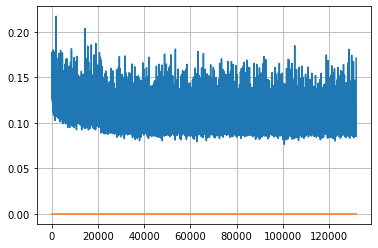

Epoch: 338, iteration 0, loss 0.10636770725250244, cov_diff 0.4195161706244248 cov_diff train 0.41920334370329354
Epoch: 338, iteration 1, loss 0.10251697897911072, cov_diff 0.4161202521067223 cov_diff train 0.41603244265787953
Epoch: 338, iteration 2, loss 0.11425507068634033, cov_diff 0.41486480126453623 cov_diff train 0.41329904679388946
Epoch: 338, iteration 3, loss 0.10171914100646973, cov_diff 0.413299000037359 cov_diff train 0.4125656251723188
Epoch: 338, iteration 4, loss 0.10999268293380737, cov_diff 0.43138028547398194 cov_diff train 0.430906436424591
Epoch: 338, iteration 5, loss 0.11768463253974915, cov_diff 0.4209236044746023 cov_diff train 0.4202632340483926
Epoch: 338, iteration 6, loss 0.08763575553894043, cov_diff 0.411295982141878 cov_diff train 0.41016317354584686
Epoch: 338, iteration 7, loss 0.10076427459716797, cov_diff 0.41054627247368597 cov_diff train 0.40964311084538996
Epoch: 338, iteration 8, loss 0.11095377802848816, cov_diff 0.4188071650976916 cov_diff tra

Epoch: 338, iteration 77, loss 0.112397700548172, cov_diff 0.41299024810713814 cov_diff train 0.4116191633209801
Epoch: 338, iteration 78, loss 0.1042490005493164, cov_diff 0.40316150398247846 cov_diff train 0.40223211977710593
Epoch: 338, iteration 79, loss 0.10275304317474365, cov_diff 0.42023162023256233 cov_diff train 0.4185179797916152
Epoch: 338, iteration 80, loss 0.09225308895111084, cov_diff 0.4160004197079342 cov_diff train 0.4153966845628162
Epoch: 338, iteration 81, loss 0.09082779288291931, cov_diff 0.4169243132264258 cov_diff train 0.4163936758565433
Epoch: 338, iteration 82, loss 0.0957593321800232, cov_diff 0.4090748865281704 cov_diff train 0.4087542049545509
Epoch: 338, iteration 83, loss 0.1047467589378357, cov_diff 0.40015566637800865 cov_diff train 0.3991903618002346
Epoch: 338, iteration 84, loss 0.1060376763343811, cov_diff 0.40927871565530793 cov_diff train 0.4084461575700518
Epoch: 338, iteration 85, loss 0.102206289768219, cov_diff 0.4087875192088205 cov_diff t

Epoch: 338, iteration 154, loss 0.09092593193054199, cov_diff 0.39822180140531044 cov_diff train 0.39816237948046856
Epoch: 338, iteration 155, loss 0.10887116193771362, cov_diff 0.39365855151494933 cov_diff train 0.3936459892846966
Epoch: 338, iteration 156, loss 0.10451933741569519, cov_diff 0.4162999928357527 cov_diff train 0.41573148378870767
Epoch: 338, iteration 157, loss 0.11352038383483887, cov_diff 0.4041310803207711 cov_diff train 0.40398867684845796
Epoch: 338, iteration 158, loss 0.10743832588195801, cov_diff 0.40421467078303186 cov_diff train 0.4041611311259518
Epoch: 338, iteration 159, loss 0.11945030093193054, cov_diff 0.40988332813151523 cov_diff train 0.4092970047985464
Epoch: 338, iteration 160, loss 0.10833922028541565, cov_diff 0.40852964613865683 cov_diff train 0.40855025905671677
Epoch: 338, iteration 161, loss 0.11055967211723328, cov_diff 0.4135250770094588 cov_diff train 0.4134831108351288
Epoch: 338, iteration 162, loss 0.1116553544998169, cov_diff 0.41665613

Epoch: 338, iteration 231, loss 0.10172596573829651, cov_diff 0.40821873838605777 cov_diff train 0.4072683756763118
Epoch: 338, iteration 232, loss 0.10567587614059448, cov_diff 0.4156353442826981 cov_diff train 0.415305104846942
Epoch: 338, iteration 233, loss 0.09899702668190002, cov_diff 0.3944193879753519 cov_diff train 0.3947223603326059
Epoch: 338, iteration 234, loss 0.09231728315353394, cov_diff 0.4123697036269051 cov_diff train 0.4112666395876347
Epoch: 338, iteration 235, loss 0.1060868501663208, cov_diff 0.40932324095084716 cov_diff train 0.4090494824251607
Epoch: 338, iteration 236, loss 0.09896612167358398, cov_diff 0.41004753257338067 cov_diff train 0.4097036543239734
Epoch: 338, iteration 237, loss 0.09764394164085388, cov_diff 0.4120232679522743 cov_diff train 0.4114232369780086
Epoch: 338, iteration 238, loss 0.09939378499984741, cov_diff 0.4099596835478014 cov_diff train 0.40978278255506073
Epoch: 338, iteration 239, loss 0.11336910724639893, cov_diff 0.40272277344343

Epoch: 338, iteration 308, loss 0.10168898105621338, cov_diff 0.41607678726379055 cov_diff train 0.41548868917837906
Epoch: 338, iteration 309, loss 0.10555210709571838, cov_diff 0.422875696863738 cov_diff train 0.4226093717076513
Epoch: 338, iteration 310, loss 0.10842001438140869, cov_diff 0.40964682701658056 cov_diff train 0.408840659669724
Epoch: 338, iteration 311, loss 0.10134628415107727, cov_diff 0.42028145248602866 cov_diff train 0.41944998548459017
Epoch: 338, iteration 312, loss 0.10097143054008484, cov_diff 0.41781322973149043 cov_diff train 0.4168926100503473
Epoch: 338, iteration 313, loss 0.10917416214942932, cov_diff 0.41328834773896694 cov_diff train 0.41259100416762656
Epoch: 338, iteration 314, loss 0.10574561357498169, cov_diff 0.40833904240673646 cov_diff train 0.40792670049899055
Epoch: 338, iteration 315, loss 0.09885957837104797, cov_diff 0.40490527612865 cov_diff train 0.40433102428495693
Epoch: 338, iteration 316, loss 0.10043245553970337, cov_diff 0.398588113

Epoch: 338, iteration 385, loss 0.09468185901641846, cov_diff 0.41191764284280313 cov_diff train 0.41149243592724183
Epoch: 338, iteration 386, loss 0.12002986669540405, cov_diff 0.4195081678300535 cov_diff train 0.41892975655821757
Epoch: 338, iteration 387, loss 0.09572029113769531, cov_diff 0.41213475822941487 cov_diff train 0.4117956835186386
Epoch: 338, iteration 388, loss 0.10450240969657898, cov_diff 0.4091794154649516 cov_diff train 0.4091437765834475
Epoch: 338, iteration 389, loss 0.10570967197418213, cov_diff 0.42870815512231825 cov_diff train 0.427271164452107
Epoch: 338, iteration 390, loss 0.16784140467643738, cov_diff 0.44411320913636954 cov_diff train 0.4434346792104902


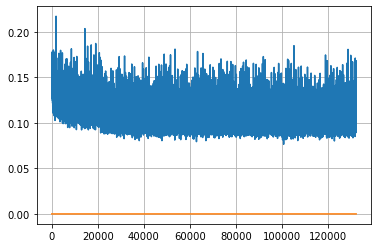

Epoch: 339, iteration 0, loss 0.10278311371803284, cov_diff 0.4014274293375362 cov_diff train 0.4016560531914748
Epoch: 339, iteration 1, loss 0.10834464430809021, cov_diff 0.4045630519867954 cov_diff train 0.40453458948192433
Epoch: 339, iteration 2, loss 0.10092884302139282, cov_diff 0.40456924013621803 cov_diff train 0.40465002222070473
Epoch: 339, iteration 3, loss 0.1006033718585968, cov_diff 0.4042571669812818 cov_diff train 0.4036878968497569
Epoch: 339, iteration 4, loss 0.10250478982925415, cov_diff 0.4163228978455119 cov_diff train 0.41611004471916735
Epoch: 339, iteration 5, loss 0.10063105821609497, cov_diff 0.43077924829635733 cov_diff train 0.4307066794636429
Epoch: 339, iteration 6, loss 0.09897258877754211, cov_diff 0.4257268638765444 cov_diff train 0.42479111377540535
Epoch: 339, iteration 7, loss 0.08084341883659363, cov_diff 0.39910347430691046 cov_diff train 0.39902424733219993
Epoch: 339, iteration 8, loss 0.10430052876472473, cov_diff 0.4279529182008783 cov_diff t

Epoch: 339, iteration 77, loss 0.10650634765625, cov_diff 0.408337307246921 cov_diff train 0.40837949703340215
Epoch: 339, iteration 78, loss 0.09421375393867493, cov_diff 0.42662105267765704 cov_diff train 0.4248616704405767
Epoch: 339, iteration 79, loss 0.10214388370513916, cov_diff 0.4143427089611803 cov_diff train 0.4135800312040216
Epoch: 339, iteration 80, loss 0.10896831750869751, cov_diff 0.41045428737884004 cov_diff train 0.409667020922965
Epoch: 339, iteration 81, loss 0.09549006819725037, cov_diff 0.4106415657882339 cov_diff train 0.4091041431094537
Epoch: 339, iteration 82, loss 0.10407572984695435, cov_diff 0.41892164306854995 cov_diff train 0.4180323801403987
Epoch: 339, iteration 83, loss 0.10838401317596436, cov_diff 0.4003065281636168 cov_diff train 0.39974567918239606
Epoch: 339, iteration 84, loss 0.10118341445922852, cov_diff 0.4139576344374799 cov_diff train 0.4128741803370661
Epoch: 339, iteration 85, loss 0.11111414432525635, cov_diff 0.41965514962662565 cov_dif

Epoch: 339, iteration 155, loss 0.09804362058639526, cov_diff 0.4032915774853143 cov_diff train 0.4020802811820691
Epoch: 339, iteration 156, loss 0.09992539882659912, cov_diff 0.4101839138134676 cov_diff train 0.4093733054746873
Epoch: 339, iteration 157, loss 0.09434986114501953, cov_diff 0.42152630592509766 cov_diff train 0.42096163035165335
Epoch: 339, iteration 158, loss 0.10939711332321167, cov_diff 0.4143900714069284 cov_diff train 0.4136573455990511
Epoch: 339, iteration 159, loss 0.10976245999336243, cov_diff 0.41224715389486616 cov_diff train 0.4119463550873154
Epoch: 339, iteration 160, loss 0.0903007984161377, cov_diff 0.40215805728806064 cov_diff train 0.4008687827854566
Epoch: 339, iteration 161, loss 0.0998324453830719, cov_diff 0.4117239244901393 cov_diff train 0.4116454625479206
Epoch: 339, iteration 162, loss 0.10369139909744263, cov_diff 0.39957114582757225 cov_diff train 0.3990712310277521
Epoch: 339, iteration 163, loss 0.09774550795555115, cov_diff 0.4207320873562

Epoch: 339, iteration 235, loss 0.099185049533844, cov_diff 0.42097194962684714 cov_diff train 0.420578790043098
Epoch: 339, iteration 236, loss 0.09799671173095703, cov_diff 0.41366889818979896 cov_diff train 0.4121781589864994
Epoch: 339, iteration 237, loss 0.09936875104904175, cov_diff 0.4158559272590886 cov_diff train 0.4145262212114537
Epoch: 339, iteration 238, loss 0.09620663523674011, cov_diff 0.4272138575438257 cov_diff train 0.42606476183164044
Epoch: 339, iteration 239, loss 0.10549721121788025, cov_diff 0.4084820167515731 cov_diff train 0.40777726609297904
Epoch: 339, iteration 240, loss 0.09760051965713501, cov_diff 0.40624357201605316 cov_diff train 0.4059504869388461
Epoch: 339, iteration 241, loss 0.10028076171875, cov_diff 0.4167755170497295 cov_diff train 0.4160634737060737
Epoch: 339, iteration 242, loss 0.09996327757835388, cov_diff 0.4035202178831599 cov_diff train 0.4025328950039671
Epoch: 339, iteration 243, loss 0.11822852492332458, cov_diff 0.4111375937040399 

Epoch: 339, iteration 316, loss 0.10480418801307678, cov_diff 0.39942760496772395 cov_diff train 0.39898935551091586
Epoch: 339, iteration 317, loss 0.09938198328018188, cov_diff 0.41357727121954746 cov_diff train 0.4121284148758157
Epoch: 339, iteration 318, loss 0.10262104868888855, cov_diff 0.41263274282560797 cov_diff train 0.41195025623146425
Epoch: 339, iteration 319, loss 0.09068876504898071, cov_diff 0.4077099436475529 cov_diff train 0.40716531494051594
Epoch: 339, iteration 320, loss 0.1019735038280487, cov_diff 0.4113849329801466 cov_diff train 0.41133686957841986
Epoch: 339, iteration 321, loss 0.10956954956054688, cov_diff 0.41952879430672396 cov_diff train 0.41918717007895406
Epoch: 339, iteration 322, loss 0.10801637172698975, cov_diff 0.4150662725057752 cov_diff train 0.414328844618091
Epoch: 339, iteration 323, loss 0.09292638301849365, cov_diff 0.3992457186229713 cov_diff train 0.39938275050232713
Epoch: 339, iteration 324, loss 0.11234506964683533, cov_diff 0.40867412

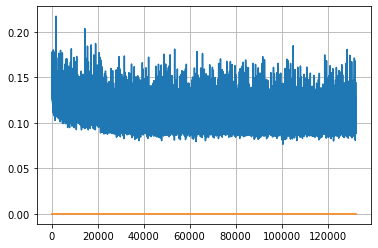

Epoch: 340, iteration 0, loss 0.11018073558807373, cov_diff 0.4334089866912686 cov_diff train 0.43205358471360084
Epoch: 340, iteration 1, loss 0.10520955920219421, cov_diff 0.41012805814027486 cov_diff train 0.40920612779720267
Epoch: 340, iteration 2, loss 0.10375773906707764, cov_diff 0.403185532057034 cov_diff train 0.4033380392837838
Epoch: 340, iteration 3, loss 0.10331279039382935, cov_diff 0.42203407128876086 cov_diff train 0.42159016135937627
Epoch: 340, iteration 4, loss 0.10794812440872192, cov_diff 0.4030873742241666 cov_diff train 0.403593786435823
Epoch: 340, iteration 5, loss 0.1066085696220398, cov_diff 0.41957131463348774 cov_diff train 0.41983299755483316
Epoch: 340, iteration 6, loss 0.0996350347995758, cov_diff 0.4023245670276162 cov_diff train 0.40258941998647313
Epoch: 340, iteration 7, loss 0.10412633419036865, cov_diff 0.41520572890108454 cov_diff train 0.41539593968729394
Epoch: 340, iteration 8, loss 0.1073266863822937, cov_diff 0.40347398660431144 cov_diff tr

Epoch: 340, iteration 78, loss 0.10888418555259705, cov_diff 0.4211428110390306 cov_diff train 0.42105965486495156
Epoch: 340, iteration 79, loss 0.09786570072174072, cov_diff 0.40263750759717243 cov_diff train 0.40190034752712306
Epoch: 340, iteration 80, loss 0.09350898861885071, cov_diff 0.41242636424211054 cov_diff train 0.4122217746329496
Epoch: 340, iteration 81, loss 0.11018198728561401, cov_diff 0.40445956493443364 cov_diff train 0.40419338096453306
Epoch: 340, iteration 82, loss 0.09872043132781982, cov_diff 0.4197953927025372 cov_diff train 0.4191814009287138
Epoch: 340, iteration 83, loss 0.10563749074935913, cov_diff 0.42555397287104346 cov_diff train 0.42495900058263303
Epoch: 340, iteration 84, loss 0.10400769114494324, cov_diff 0.40739612209507386 cov_diff train 0.4068322603435025
Epoch: 340, iteration 85, loss 0.10086795687675476, cov_diff 0.40508509365609685 cov_diff train 0.40410130245942355
Epoch: 340, iteration 86, loss 0.10657739639282227, cov_diff 0.40634093521267

Epoch: 340, iteration 151, loss 0.10034534335136414, cov_diff 0.41599680624263274 cov_diff train 0.41606291836199394
Epoch: 340, iteration 152, loss 0.10201308131217957, cov_diff 0.4051028451739397 cov_diff train 0.40372880541600414
Epoch: 340, iteration 153, loss 0.09991443157196045, cov_diff 0.4076985620691149 cov_diff train 0.4068315580277975
Epoch: 340, iteration 154, loss 0.10872739553451538, cov_diff 0.4140134514674815 cov_diff train 0.4136526775879813
Epoch: 340, iteration 155, loss 0.11435806751251221, cov_diff 0.4181147091541381 cov_diff train 0.41827249626298846
Epoch: 340, iteration 156, loss 0.10882037878036499, cov_diff 0.40725248729490665 cov_diff train 0.40709417912867024
Epoch: 340, iteration 157, loss 0.09626221656799316, cov_diff 0.41156599676675354 cov_diff train 0.4106844593242948
Epoch: 340, iteration 158, loss 0.09533774852752686, cov_diff 0.41680296141567463 cov_diff train 0.4157983496992351
Epoch: 340, iteration 159, loss 0.10368657112121582, cov_diff 0.40768367

Epoch: 340, iteration 228, loss 0.11308273673057556, cov_diff 0.4119935673081301 cov_diff train 0.41211972892652726
Epoch: 340, iteration 229, loss 0.10355907678604126, cov_diff 0.4216048279876597 cov_diff train 0.42121587561670554
Epoch: 340, iteration 230, loss 0.11081895232200623, cov_diff 0.40967459904883624 cov_diff train 0.40913462123882843
Epoch: 340, iteration 231, loss 0.10062545537948608, cov_diff 0.41254418181297364 cov_diff train 0.4116859943392845
Epoch: 340, iteration 232, loss 0.10357114672660828, cov_diff 0.4250251483617217 cov_diff train 0.4234701476265654
Epoch: 340, iteration 233, loss 0.11164069175720215, cov_diff 0.41355631418222144 cov_diff train 0.4125550103011726
Epoch: 340, iteration 234, loss 0.10032030940055847, cov_diff 0.42341324000858765 cov_diff train 0.422255755494513
Epoch: 340, iteration 235, loss 0.1105366051197052, cov_diff 0.41705169447579393 cov_diff train 0.4163578744277628
Epoch: 340, iteration 236, loss 0.09610968828201294, cov_diff 0.4056524177

Epoch: 340, iteration 305, loss 0.10926902294158936, cov_diff 0.4179560262081085 cov_diff train 0.4180182515819138
Epoch: 340, iteration 306, loss 0.10675850510597229, cov_diff 0.4154455382897928 cov_diff train 0.4147433722076642
Epoch: 340, iteration 307, loss 0.10045111179351807, cov_diff 0.40438481329015225 cov_diff train 0.40333224013908936
Epoch: 340, iteration 308, loss 0.10575830936431885, cov_diff 0.40962212790249974 cov_diff train 0.4094264953636142
Epoch: 340, iteration 309, loss 0.09950694441795349, cov_diff 0.40964677615076883 cov_diff train 0.40930677458378384
Epoch: 340, iteration 310, loss 0.0950729250907898, cov_diff 0.40252619037571674 cov_diff train 0.4015005755202126
Epoch: 340, iteration 311, loss 0.10566115379333496, cov_diff 0.4016205601818381 cov_diff train 0.4016484862149183
Epoch: 340, iteration 312, loss 0.10943907499313354, cov_diff 0.4065635828900396 cov_diff train 0.40588165968861695
Epoch: 340, iteration 313, loss 0.10304048657417297, cov_diff 0.3982766833

Epoch: 340, iteration 383, loss 0.10058140754699707, cov_diff 0.42460984802763135 cov_diff train 0.42430179767595394
Epoch: 340, iteration 384, loss 0.0988585352897644, cov_diff 0.42555716197687343 cov_diff train 0.42550734546597246
Epoch: 340, iteration 385, loss 0.10890042781829834, cov_diff 0.41027494388533403 cov_diff train 0.4093162657453019
Epoch: 340, iteration 386, loss 0.10247373580932617, cov_diff 0.42453104618746407 cov_diff train 0.42309101964043194
Epoch: 340, iteration 387, loss 0.11571052670478821, cov_diff 0.4117492289142585 cov_diff train 0.4108952045766318
Epoch: 340, iteration 388, loss 0.09708589315414429, cov_diff 0.4258592442479195 cov_diff train 0.4252899863146321
Epoch: 340, iteration 389, loss 0.11259961128234863, cov_diff 0.42011621434523905 cov_diff train 0.4189003628854352
Epoch: 340, iteration 390, loss 0.13037109375, cov_diff 0.4449603656453378 cov_diff train 0.4442227551800724


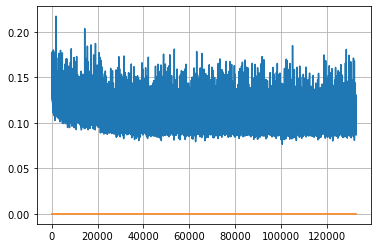

Epoch: 341, iteration 0, loss 0.1041235625743866, cov_diff 0.42482835552045717 cov_diff train 0.4238088345132117
Epoch: 341, iteration 1, loss 0.10622546076774597, cov_diff 0.4116059106888081 cov_diff train 0.41027846647634747
Epoch: 341, iteration 2, loss 0.10061869025230408, cov_diff 0.4160064572763568 cov_diff train 0.4153698079713732
Epoch: 341, iteration 3, loss 0.10262474417686462, cov_diff 0.39939109921741023 cov_diff train 0.3985074892166793
Epoch: 341, iteration 4, loss 0.10349166393280029, cov_diff 0.4150448620038191 cov_diff train 0.41445583359239146
Epoch: 341, iteration 5, loss 0.1141366958618164, cov_diff 0.4044369381996038 cov_diff train 0.4039387547827802
Epoch: 341, iteration 6, loss 0.1120096743106842, cov_diff 0.4233269880926121 cov_diff train 0.42284915177923815
Epoch: 341, iteration 7, loss 0.0982741117477417, cov_diff 0.4029222898448904 cov_diff train 0.4028097100354725
Epoch: 341, iteration 8, loss 0.10755231976509094, cov_diff 0.39133973331859595 cov_diff train 

Epoch: 341, iteration 76, loss 0.10390675067901611, cov_diff 0.4182453502782004 cov_diff train 0.41768455363521567
Epoch: 341, iteration 77, loss 0.11206704378128052, cov_diff 0.4144287622278253 cov_diff train 0.4121158581687574
Epoch: 341, iteration 78, loss 0.10900735855102539, cov_diff 0.4119343371565239 cov_diff train 0.41119656850917835
Epoch: 341, iteration 79, loss 0.11307796835899353, cov_diff 0.4027429711881268 cov_diff train 0.4017279959619064
Epoch: 341, iteration 80, loss 0.10224607586860657, cov_diff 0.4034598868383589 cov_diff train 0.4020529092370316
Epoch: 341, iteration 81, loss 0.10941389203071594, cov_diff 0.41219173569432765 cov_diff train 0.41110798945517163
Epoch: 341, iteration 82, loss 0.10655808448791504, cov_diff 0.40872913086592244 cov_diff train 0.40759605320067605
Epoch: 341, iteration 83, loss 0.09575331211090088, cov_diff 0.419191771469471 cov_diff train 0.41868045811265175
Epoch: 341, iteration 84, loss 0.11653250455856323, cov_diff 0.4086376186762735 co

Epoch: 341, iteration 153, loss 0.09420305490493774, cov_diff 0.39310405908298507 cov_diff train 0.3937782587379836
Epoch: 341, iteration 154, loss 0.092966228723526, cov_diff 0.4048457901370035 cov_diff train 0.4035891762029222
Epoch: 341, iteration 155, loss 0.10235565900802612, cov_diff 0.420896705564515 cov_diff train 0.4211419815107579
Epoch: 341, iteration 156, loss 0.10204502940177917, cov_diff 0.3993492692980773 cov_diff train 0.3983433985549305
Epoch: 341, iteration 157, loss 0.10751661658287048, cov_diff 0.40850465094614496 cov_diff train 0.4090019522014288
Epoch: 341, iteration 158, loss 0.10140389204025269, cov_diff 0.4055220319055301 cov_diff train 0.4048448725048885
Epoch: 341, iteration 159, loss 0.10595452785491943, cov_diff 0.4133997444473993 cov_diff train 0.4135732450688309
Epoch: 341, iteration 160, loss 0.09735235571861267, cov_diff 0.40313488951956516 cov_diff train 0.4018984965287339
Epoch: 341, iteration 161, loss 0.10551971197128296, cov_diff 0.4295403858901939

Epoch: 341, iteration 229, loss 0.11006879806518555, cov_diff 0.416322460260615 cov_diff train 0.4156880959219265
Epoch: 341, iteration 230, loss 0.10000953078269958, cov_diff 0.4196631526609854 cov_diff train 0.41890292909997007
Epoch: 341, iteration 231, loss 0.09491929411888123, cov_diff 0.40081282284768893 cov_diff train 0.40047589237673836
Epoch: 341, iteration 232, loss 0.10761117935180664, cov_diff 0.4134550586826077 cov_diff train 0.41272718402277514
Epoch: 341, iteration 233, loss 0.10408592224121094, cov_diff 0.4082444516499566 cov_diff train 0.4073738183970446
Epoch: 341, iteration 234, loss 0.09190025925636292, cov_diff 0.4250988003650775 cov_diff train 0.4241294546604902
Epoch: 341, iteration 235, loss 0.11255767941474915, cov_diff 0.4115033159189976 cov_diff train 0.41095392118962065
Epoch: 341, iteration 236, loss 0.1118345558643341, cov_diff 0.4111890675899738 cov_diff train 0.4108680207624903
Epoch: 341, iteration 237, loss 0.11040452122688293, cov_diff 0.4133219908016

Epoch: 341, iteration 306, loss 0.10678964853286743, cov_diff 0.4244300131052145 cov_diff train 0.4229169697384887
Epoch: 341, iteration 307, loss 0.10321557521820068, cov_diff 0.4163601872813376 cov_diff train 0.41590288282600735
Epoch: 341, iteration 308, loss 0.09826546907424927, cov_diff 0.4287325423675413 cov_diff train 0.4280490637056875
Epoch: 341, iteration 309, loss 0.09956184029579163, cov_diff 0.4096806313827778 cov_diff train 0.4089018010445301
Epoch: 341, iteration 310, loss 0.1126558780670166, cov_diff 0.409266638374566 cov_diff train 0.4086294318608922
Epoch: 341, iteration 311, loss 0.11099624633789062, cov_diff 0.41226797693745965 cov_diff train 0.41091312960571413
Epoch: 341, iteration 312, loss 0.08442801237106323, cov_diff 0.43270628808721207 cov_diff train 0.4317551087330758
Epoch: 341, iteration 313, loss 0.11242592334747314, cov_diff 0.4414633734158094 cov_diff train 0.4398652316521704
Epoch: 341, iteration 314, loss 0.11123636364936829, cov_diff 0.42327025222380

Epoch: 341, iteration 383, loss 0.0890011191368103, cov_diff 0.4170959835825106 cov_diff train 0.4172930839246923
Epoch: 341, iteration 384, loss 0.10089313983917236, cov_diff 0.42794516892454826 cov_diff train 0.4279339682401184
Epoch: 341, iteration 385, loss 0.11870038509368896, cov_diff 0.4304498341661888 cov_diff train 0.42966913721444316
Epoch: 341, iteration 386, loss 0.1155182421207428, cov_diff 0.41825243113045696 cov_diff train 0.4170959326357566
Epoch: 341, iteration 387, loss 0.10332953929901123, cov_diff 0.4271357038059027 cov_diff train 0.4256208406144857
Epoch: 341, iteration 388, loss 0.10128605365753174, cov_diff 0.4309277982957059 cov_diff train 0.42987124487536377
Epoch: 341, iteration 389, loss 0.10406699776649475, cov_diff 0.42053031898188903 cov_diff train 0.4193120215793468
Epoch: 341, iteration 390, loss 0.16047823429107666, cov_diff 0.45242268368443966 cov_diff train 0.45150731674997857


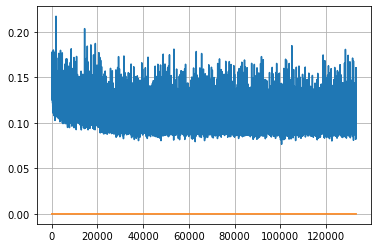

Epoch: 342, iteration 0, loss 0.11429798603057861, cov_diff 0.4229102687230247 cov_diff train 0.4214253255858004
Epoch: 342, iteration 1, loss 0.10339125990867615, cov_diff 0.41888497872953423 cov_diff train 0.4172783433651655
Epoch: 342, iteration 2, loss 0.1024547815322876, cov_diff 0.4281525701825637 cov_diff train 0.42615924311236836
Epoch: 342, iteration 3, loss 0.09481623768806458, cov_diff 0.39854605721046243 cov_diff train 0.3979799312332645
Epoch: 342, iteration 4, loss 0.10944068431854248, cov_diff 0.41828884180658554 cov_diff train 0.4179645424284581
Epoch: 342, iteration 5, loss 0.0913216769695282, cov_diff 0.4093181407889407 cov_diff train 0.4084375625766905
Epoch: 342, iteration 6, loss 0.10762539505958557, cov_diff 0.4171109573783209 cov_diff train 0.4155749828970755
Epoch: 342, iteration 7, loss 0.10990652441978455, cov_diff 0.42466185271665363 cov_diff train 0.4235853496576315
Epoch: 342, iteration 8, loss 0.10007840394973755, cov_diff 0.4059891412265491 cov_diff train

Epoch: 342, iteration 78, loss 0.10538646578788757, cov_diff 0.4122390259354793 cov_diff train 0.41219459401867176
Epoch: 342, iteration 79, loss 0.0872957706451416, cov_diff 0.4016582138490791 cov_diff train 0.401617514068178
Epoch: 342, iteration 80, loss 0.10882294178009033, cov_diff 0.40477058293784207 cov_diff train 0.40543294511799244
Epoch: 342, iteration 81, loss 0.0936267077922821, cov_diff 0.41008958908022936 cov_diff train 0.4106591566594187
Epoch: 342, iteration 82, loss 0.10343033075332642, cov_diff 0.4044460785488101 cov_diff train 0.40439696261317726
Epoch: 342, iteration 83, loss 0.11350998282432556, cov_diff 0.4167363438559444 cov_diff train 0.41685471852136274
Epoch: 342, iteration 84, loss 0.11277925968170166, cov_diff 0.4222451200619316 cov_diff train 0.4219962329237116
Epoch: 342, iteration 85, loss 0.09071651101112366, cov_diff 0.40607162413688663 cov_diff train 0.40587663652494954
Epoch: 342, iteration 86, loss 0.10194563865661621, cov_diff 0.3970927168604835 cov

Epoch: 342, iteration 157, loss 0.10858100652694702, cov_diff 0.41397414827053264 cov_diff train 0.413537631310567
Epoch: 342, iteration 158, loss 0.11018237471580505, cov_diff 0.41115390584325956 cov_diff train 0.4098215299291564
Epoch: 342, iteration 159, loss 0.1019679605960846, cov_diff 0.4093536923260108 cov_diff train 0.40846607518185524
Epoch: 342, iteration 160, loss 0.09543895721435547, cov_diff 0.4176436451508067 cov_diff train 0.41661257649334754
Epoch: 342, iteration 161, loss 0.10485324263572693, cov_diff 0.4100726424994969 cov_diff train 0.40967152594826683
Epoch: 342, iteration 162, loss 0.1145729124546051, cov_diff 0.40604433559479347 cov_diff train 0.4058395114937506
Epoch: 342, iteration 163, loss 0.09920209646224976, cov_diff 0.4051787487464765 cov_diff train 0.40555068541255873
Epoch: 342, iteration 164, loss 0.11291468143463135, cov_diff 0.40323496692545446 cov_diff train 0.4025065732167223
Epoch: 342, iteration 165, loss 0.11178088188171387, cov_diff 0.41695341199

Epoch: 342, iteration 237, loss 0.11228838562965393, cov_diff 0.40735131726718515 cov_diff train 0.40613452786219884
Epoch: 342, iteration 238, loss 0.09781551361083984, cov_diff 0.4115837440644266 cov_diff train 0.41094338969441496
Epoch: 342, iteration 239, loss 0.09380215406417847, cov_diff 0.4113769258535601 cov_diff train 0.4110940553984344
Epoch: 342, iteration 240, loss 0.10324570536613464, cov_diff 0.41244159166917194 cov_diff train 0.4124450032816323
Epoch: 342, iteration 241, loss 0.10344338417053223, cov_diff 0.419652258246944 cov_diff train 0.41903476539035955
Epoch: 342, iteration 242, loss 0.11205005645751953, cov_diff 0.41642682589124086 cov_diff train 0.41628166619053075
Epoch: 342, iteration 243, loss 0.10790762305259705, cov_diff 0.41230715927379086 cov_diff train 0.4124209481417182
Epoch: 342, iteration 244, loss 0.10749045014381409, cov_diff 0.4153192869101359 cov_diff train 0.41475574057120995
Epoch: 342, iteration 245, loss 0.09753978252410889, cov_diff 0.42359699

Epoch: 342, iteration 314, loss 0.09771904349327087, cov_diff 0.4236568504308449 cov_diff train 0.42321781545361575
Epoch: 342, iteration 315, loss 0.09791526198387146, cov_diff 0.41085984349334503 cov_diff train 0.41040654449476605
Epoch: 342, iteration 316, loss 0.09871324896812439, cov_diff 0.4106579796045834 cov_diff train 0.40941356635846343
Epoch: 342, iteration 317, loss 0.0927298367023468, cov_diff 0.42330423515405063 cov_diff train 0.42297302788088914
Epoch: 342, iteration 318, loss 0.11432605981826782, cov_diff 0.41921200371666806 cov_diff train 0.41847398751836845
Epoch: 342, iteration 319, loss 0.09897738695144653, cov_diff 0.41770566809867 cov_diff train 0.4162210736769862
Epoch: 342, iteration 320, loss 0.1117512583732605, cov_diff 0.4085519516949307 cov_diff train 0.40859306799348266
Epoch: 342, iteration 321, loss 0.0996030867099762, cov_diff 0.41285064462925997 cov_diff train 0.4129273931089468
Epoch: 342, iteration 322, loss 0.1002926230430603, cov_diff 0.414811998981

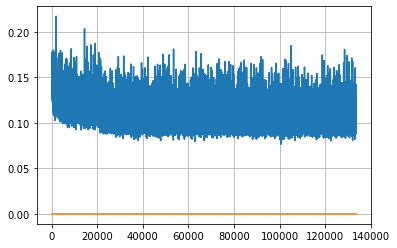

Epoch: 343, iteration 0, loss 0.09711039066314697, cov_diff 0.41023715246556125 cov_diff train 0.409906479489329
Epoch: 343, iteration 1, loss 0.09619385004043579, cov_diff 0.41954091925382364 cov_diff train 0.4187815073708775
Epoch: 343, iteration 2, loss 0.0913800299167633, cov_diff 0.40762324536363603 cov_diff train 0.4070377624686259
Epoch: 343, iteration 3, loss 0.09973713755607605, cov_diff 0.41991819239275563 cov_diff train 0.41880691128205527
Epoch: 343, iteration 4, loss 0.101491779088974, cov_diff 0.4049451153557124 cov_diff train 0.40420517801929895
Epoch: 343, iteration 5, loss 0.10328567028045654, cov_diff 0.4120411379335712 cov_diff train 0.4109853852646468
Epoch: 343, iteration 6, loss 0.1031351387500763, cov_diff 0.417334592713002 cov_diff train 0.4160506400048664
Epoch: 343, iteration 7, loss 0.10754364728927612, cov_diff 0.4147988405071954 cov_diff train 0.41415404995599375
Epoch: 343, iteration 8, loss 0.11061325669288635, cov_diff 0.42676767514261055 cov_diff train 

Epoch: 343, iteration 77, loss 0.10711216926574707, cov_diff 0.4099266787741717 cov_diff train 0.4092434778370773
Epoch: 343, iteration 78, loss 0.10421556234359741, cov_diff 0.41358310955362015 cov_diff train 0.41360424943997803
Epoch: 343, iteration 79, loss 0.09800177812576294, cov_diff 0.43050257144340615 cov_diff train 0.42983523321029193
Epoch: 343, iteration 80, loss 0.09831520915031433, cov_diff 0.4132013733148764 cov_diff train 0.41275992964245223
Epoch: 343, iteration 81, loss 0.0990709662437439, cov_diff 0.4063806069058268 cov_diff train 0.406240080896555
Epoch: 343, iteration 82, loss 0.09989586472511292, cov_diff 0.4254447690741424 cov_diff train 0.4253525863403254
Epoch: 343, iteration 83, loss 0.11883604526519775, cov_diff 0.4172952861414153 cov_diff train 0.4180098474333583
Epoch: 343, iteration 84, loss 0.10098409652709961, cov_diff 0.4104021199376947 cov_diff train 0.40914872220524284
Epoch: 343, iteration 85, loss 0.10685637593269348, cov_diff 0.4191585511901557 cov_

Epoch: 343, iteration 155, loss 0.10780191421508789, cov_diff 0.403408279524462 cov_diff train 0.40393610240579525
Epoch: 343, iteration 156, loss 0.11976489424705505, cov_diff 0.40594631003370224 cov_diff train 0.4057687454005534
Epoch: 343, iteration 157, loss 0.10108423233032227, cov_diff 0.41535211058072363 cov_diff train 0.4148787723214664
Epoch: 343, iteration 158, loss 0.10256123542785645, cov_diff 0.40817721973183957 cov_diff train 0.4082459983205253
Epoch: 343, iteration 159, loss 0.11594793200492859, cov_diff 0.41764475958421754 cov_diff train 0.4172190991885113
Epoch: 343, iteration 160, loss 0.09915587306022644, cov_diff 0.42172130022945775 cov_diff train 0.42211682949445617
Epoch: 343, iteration 161, loss 0.0987098217010498, cov_diff 0.40860727535997743 cov_diff train 0.40855509043201865
Epoch: 343, iteration 162, loss 0.09559807181358337, cov_diff 0.4114947040447614 cov_diff train 0.4107326544707559
Epoch: 343, iteration 163, loss 0.09823855757713318, cov_diff 0.413024555

Epoch: 343, iteration 232, loss 0.11203214526176453, cov_diff 0.4132101745400219 cov_diff train 0.4120837511687658
Epoch: 343, iteration 233, loss 0.09675189852714539, cov_diff 0.4305571508749056 cov_diff train 0.4300917778344603
Epoch: 343, iteration 234, loss 0.09976360201835632, cov_diff 0.4147680650713865 cov_diff train 0.413715342649344
Epoch: 343, iteration 235, loss 0.09642159938812256, cov_diff 0.4172992462637876 cov_diff train 0.4160693209881267
Epoch: 343, iteration 236, loss 0.10978290438652039, cov_diff 0.4150108421068114 cov_diff train 0.4150708751804455
Epoch: 343, iteration 237, loss 0.11682277917861938, cov_diff 0.4160386789591218 cov_diff train 0.4149537479671066
Epoch: 343, iteration 238, loss 0.10311296582221985, cov_diff 0.39737656410299854 cov_diff train 0.39608341039754436
Epoch: 343, iteration 239, loss 0.1051625907421112, cov_diff 0.4101848268419842 cov_diff train 0.40968093105993303
Epoch: 343, iteration 240, loss 0.1103614866733551, cov_diff 0.4051779735435632

Epoch: 343, iteration 309, loss 0.104744553565979, cov_diff 0.40703472549452396 cov_diff train 0.40651699104828487
Epoch: 343, iteration 310, loss 0.11320245265960693, cov_diff 0.4067647780662757 cov_diff train 0.4060481196744821
Epoch: 343, iteration 311, loss 0.09060341119766235, cov_diff 0.41032151473975076 cov_diff train 0.4088858602907859
Epoch: 343, iteration 312, loss 0.0981614887714386, cov_diff 0.4087932651792206 cov_diff train 0.4077149402160737
Epoch: 343, iteration 313, loss 0.08836895227432251, cov_diff 0.40595569023049993 cov_diff train 0.4055104992307802
Epoch: 343, iteration 314, loss 0.11075443029403687, cov_diff 0.4114510281473108 cov_diff train 0.41123358940402666
Epoch: 343, iteration 315, loss 0.10041427612304688, cov_diff 0.4046603996421516 cov_diff train 0.4047323246190223
Epoch: 343, iteration 316, loss 0.10153496265411377, cov_diff 0.3951767284814801 cov_diff train 0.3955205113767389
Epoch: 343, iteration 317, loss 0.1076403260231018, cov_diff 0.408358073230220

Epoch: 343, iteration 382, loss 0.10658076405525208, cov_diff 0.39836274386714515 cov_diff train 0.39787438952797055
Epoch: 343, iteration 383, loss 0.10418453812599182, cov_diff 0.41306943435157717 cov_diff train 0.4120887172903199
Epoch: 343, iteration 384, loss 0.11297884583473206, cov_diff 0.4084010627375561 cov_diff train 0.4085752850708368
Epoch: 343, iteration 385, loss 0.10207179188728333, cov_diff 0.4098963984724263 cov_diff train 0.410159157582334
Epoch: 343, iteration 386, loss 0.09342443943023682, cov_diff 0.41283141566242776 cov_diff train 0.4130813035227271
Epoch: 343, iteration 387, loss 0.11674988269805908, cov_diff 0.4148873125116866 cov_diff train 0.4147263347985408
Epoch: 343, iteration 388, loss 0.11175164580345154, cov_diff 0.4181269136593461 cov_diff train 0.41759416450953685
Epoch: 343, iteration 389, loss 0.1115151047706604, cov_diff 0.4152781760953145 cov_diff train 0.41438360821270326
Epoch: 343, iteration 390, loss 0.16175523400306702, cov_diff 0.457205778305

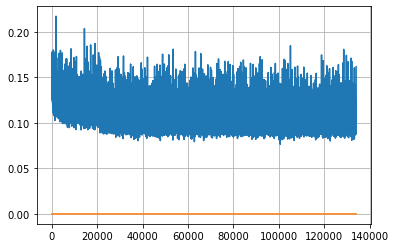

Epoch: 344, iteration 0, loss 0.09882423281669617, cov_diff 0.417732290086425 cov_diff train 0.4174223660584039
Epoch: 344, iteration 1, loss 0.11089417338371277, cov_diff 0.4206845232045471 cov_diff train 0.41981323461900133
Epoch: 344, iteration 2, loss 0.10867631435394287, cov_diff 0.4156506704404188 cov_diff train 0.41421972803835777
Epoch: 344, iteration 3, loss 0.09371805191040039, cov_diff 0.41661533049463123 cov_diff train 0.41486407085868415
Epoch: 344, iteration 4, loss 0.11057749390602112, cov_diff 0.41751568479238055 cov_diff train 0.4166275245485273
Epoch: 344, iteration 5, loss 0.1107306182384491, cov_diff 0.4039326095784574 cov_diff train 0.402938144548167
Epoch: 344, iteration 6, loss 0.10839417576789856, cov_diff 0.41642638169258805 cov_diff train 0.41540979382459764
Epoch: 344, iteration 7, loss 0.10658833384513855, cov_diff 0.4108023983466583 cov_diff train 0.40990977280621216
Epoch: 344, iteration 8, loss 0.11904749274253845, cov_diff 0.42120063617398695 cov_diff tr

Epoch: 344, iteration 76, loss 0.11425188183784485, cov_diff 0.41400184335137913 cov_diff train 0.4132997384383549
Epoch: 344, iteration 77, loss 0.10633745789527893, cov_diff 0.41919085174297654 cov_diff train 0.4194125570772029
Epoch: 344, iteration 78, loss 0.09325772523880005, cov_diff 0.4037737245757811 cov_diff train 0.40298545219817894
Epoch: 344, iteration 79, loss 0.10373005270957947, cov_diff 0.4081027718434681 cov_diff train 0.4074802476262013
Epoch: 344, iteration 80, loss 0.10028764605522156, cov_diff 0.40900164554128504 cov_diff train 0.40799460254486575
Epoch: 344, iteration 81, loss 0.11024415493011475, cov_diff 0.4051510978079686 cov_diff train 0.40501382291294075
Epoch: 344, iteration 82, loss 0.11281424760818481, cov_diff 0.41592356453166957 cov_diff train 0.41557535200193507
Epoch: 344, iteration 83, loss 0.09456020593643188, cov_diff 0.4226163853238072 cov_diff train 0.4209138226085218
Epoch: 344, iteration 84, loss 0.09132924675941467, cov_diff 0.41502395438731127

Epoch: 344, iteration 153, loss 0.09935888648033142, cov_diff 0.41433605162111325 cov_diff train 0.41398589241258776
Epoch: 344, iteration 154, loss 0.11097168922424316, cov_diff 0.4126496091949835 cov_diff train 0.4105727856969262
Epoch: 344, iteration 155, loss 0.10972601175308228, cov_diff 0.4201163381127833 cov_diff train 0.41945149223375167
Epoch: 344, iteration 156, loss 0.10396265983581543, cov_diff 0.4028048397878777 cov_diff train 0.4022210884623475
Epoch: 344, iteration 157, loss 0.10517200827598572, cov_diff 0.4038301485771251 cov_diff train 0.4034528535978925
Epoch: 344, iteration 158, loss 0.09172326326370239, cov_diff 0.4194086937375431 cov_diff train 0.4193219776283109
Epoch: 344, iteration 159, loss 0.09899988770484924, cov_diff 0.4217811923090905 cov_diff train 0.4205726957611372
Epoch: 344, iteration 160, loss 0.09793522953987122, cov_diff 0.4136333845283925 cov_diff train 0.41308523991007534
Epoch: 344, iteration 161, loss 0.10575538873672485, cov_diff 0.401573150067

Epoch: 344, iteration 229, loss 0.0891963541507721, cov_diff 0.4032163844190795 cov_diff train 0.4029134589422882
Epoch: 344, iteration 230, loss 0.11634689569473267, cov_diff 0.4086360061604353 cov_diff train 0.4077356730771197
Epoch: 344, iteration 231, loss 0.10312086343765259, cov_diff 0.42508555125215647 cov_diff train 0.42386609403180847
Epoch: 344, iteration 232, loss 0.10631561279296875, cov_diff 0.41198223620460994 cov_diff train 0.4108618064899339
Epoch: 344, iteration 233, loss 0.10151302814483643, cov_diff 0.41135838961018 cov_diff train 0.41055447507069803
Epoch: 344, iteration 234, loss 0.1077488362789154, cov_diff 0.4089044313919382 cov_diff train 0.408132119564325
Epoch: 344, iteration 235, loss 0.10382914543151855, cov_diff 0.41667432614606165 cov_diff train 0.4161048707363501
Epoch: 344, iteration 236, loss 0.12116357684135437, cov_diff 0.4144183549939737 cov_diff train 0.4128388349470009
Epoch: 344, iteration 237, loss 0.10067099332809448, cov_diff 0.4084747212177175

Epoch: 344, iteration 308, loss 0.10316729545593262, cov_diff 0.41000907813547965 cov_diff train 0.4092349137539689
Epoch: 344, iteration 309, loss 0.10403397679328918, cov_diff 0.4058485950404337 cov_diff train 0.40531160324777965
Epoch: 344, iteration 310, loss 0.10381755232810974, cov_diff 0.4126007194529787 cov_diff train 0.41238378554953087
Epoch: 344, iteration 311, loss 0.11260747909545898, cov_diff 0.4101709808815092 cov_diff train 0.4095615579516366
Epoch: 344, iteration 312, loss 0.09363037347793579, cov_diff 0.41106817565095705 cov_diff train 0.40987033396968137
Epoch: 344, iteration 313, loss 0.10036122798919678, cov_diff 0.40810460366328477 cov_diff train 0.40773808796674776
Epoch: 344, iteration 314, loss 0.09246283769607544, cov_diff 0.4105690167262513 cov_diff train 0.4097066245048271
Epoch: 344, iteration 315, loss 0.10777810215950012, cov_diff 0.41061868773546795 cov_diff train 0.4096964176265348
Epoch: 344, iteration 316, loss 0.09757748246192932, cov_diff 0.40730540

Epoch: 344, iteration 385, loss 0.10178059339523315, cov_diff 0.41134501413652125 cov_diff train 0.41070282398920743
Epoch: 344, iteration 386, loss 0.10039323568344116, cov_diff 0.4160343112887714 cov_diff train 0.41512306583951264
Epoch: 344, iteration 387, loss 0.10112613439559937, cov_diff 0.40624624109672763 cov_diff train 0.4054873239287685
Epoch: 344, iteration 388, loss 0.09626132249832153, cov_diff 0.41076541085840423 cov_diff train 0.4100486008593638
Epoch: 344, iteration 389, loss 0.10487392544746399, cov_diff 0.4075701890613448 cov_diff train 0.4061441657340026
Epoch: 344, iteration 390, loss 0.13360857963562012, cov_diff 0.4398780931749736 cov_diff train 0.43933959221447866


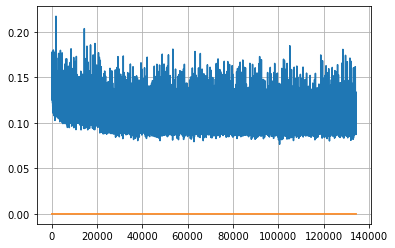

Epoch: 345, iteration 0, loss 0.11775749921798706, cov_diff 0.4085006182652715 cov_diff train 0.4074270107018509
Epoch: 345, iteration 1, loss 0.09892916679382324, cov_diff 0.4144487155710796 cov_diff train 0.41391058770945055
Epoch: 345, iteration 2, loss 0.0984468162059784, cov_diff 0.4097619600954088 cov_diff train 0.4087969938195038
Epoch: 345, iteration 3, loss 0.10921236872673035, cov_diff 0.412559657054983 cov_diff train 0.412195154989435
Epoch: 345, iteration 4, loss 0.100178062915802, cov_diff 0.40522525869085 cov_diff train 0.4053321701523886
Epoch: 345, iteration 5, loss 0.08627709746360779, cov_diff 0.4148946216575243 cov_diff train 0.4145303641536692
Epoch: 345, iteration 6, loss 0.11852043867111206, cov_diff 0.42269309100402264 cov_diff train 0.4220222423776759
Epoch: 345, iteration 7, loss 0.1048683226108551, cov_diff 0.4119113979642 cov_diff train 0.4116119485855028
Epoch: 345, iteration 8, loss 0.09797781705856323, cov_diff 0.41911276551931653 cov_diff train 0.41909797

Epoch: 345, iteration 77, loss 0.09971585869789124, cov_diff 0.403174703284306 cov_diff train 0.40205869865775007
Epoch: 345, iteration 78, loss 0.10530224442481995, cov_diff 0.4065689624555715 cov_diff train 0.40516174404215155
Epoch: 345, iteration 79, loss 0.09376627206802368, cov_diff 0.40427790055360824 cov_diff train 0.40393020590927603
Epoch: 345, iteration 80, loss 0.1032964289188385, cov_diff 0.4169882517689613 cov_diff train 0.41636278993800546
Epoch: 345, iteration 81, loss 0.09784668684005737, cov_diff 0.4206196132850883 cov_diff train 0.42133429803216044
Epoch: 345, iteration 82, loss 0.09835672378540039, cov_diff 0.4068109883538849 cov_diff train 0.40608331234674044
Epoch: 345, iteration 83, loss 0.10692906379699707, cov_diff 0.4228240575096074 cov_diff train 0.4220244332070712
Epoch: 345, iteration 84, loss 0.10473746061325073, cov_diff 0.41805236281884656 cov_diff train 0.41683328405674963
Epoch: 345, iteration 85, loss 0.09938612580299377, cov_diff 0.4098599719343393 c

Epoch: 345, iteration 154, loss 0.10639038681983948, cov_diff 0.42161872081339563 cov_diff train 0.42080913545162674
Epoch: 345, iteration 155, loss 0.09497112035751343, cov_diff 0.42491877348522533 cov_diff train 0.42434804727959335
Epoch: 345, iteration 156, loss 0.08970636129379272, cov_diff 0.40314771827370877 cov_diff train 0.40329937398576404
Epoch: 345, iteration 157, loss 0.10074582695960999, cov_diff 0.41010388240637846 cov_diff train 0.4094093587079878
Epoch: 345, iteration 158, loss 0.1061716377735138, cov_diff 0.4099356627831457 cov_diff train 0.40960992955092296
Epoch: 345, iteration 159, loss 0.09858834743499756, cov_diff 0.41878573858243257 cov_diff train 0.41797996273669935
Epoch: 345, iteration 160, loss 0.09835091233253479, cov_diff 0.4052534536988143 cov_diff train 0.40429708577688367
Epoch: 345, iteration 161, loss 0.10543391108512878, cov_diff 0.41955529231912514 cov_diff train 0.41877538835067935
Epoch: 345, iteration 162, loss 0.10132300853729248, cov_diff 0.4184

Epoch: 345, iteration 232, loss 0.10097438097000122, cov_diff 0.4066373718440849 cov_diff train 0.40517303740826555
Epoch: 345, iteration 233, loss 0.1046423614025116, cov_diff 0.42148519731998696 cov_diff train 0.419904278750603
Epoch: 345, iteration 234, loss 0.11129194498062134, cov_diff 0.40927198948875443 cov_diff train 0.4082023619298734
Epoch: 345, iteration 235, loss 0.10871097445487976, cov_diff 0.3990534097238504 cov_diff train 0.39792639222767934
Epoch: 345, iteration 236, loss 0.11540275812149048, cov_diff 0.41739073668329274 cov_diff train 0.4152866078425366
Epoch: 345, iteration 237, loss 0.10299959778785706, cov_diff 0.41320985228072415 cov_diff train 0.41230307593141385
Epoch: 345, iteration 238, loss 0.1055641770362854, cov_diff 0.4211014310816052 cov_diff train 0.4196801379322277
Epoch: 345, iteration 239, loss 0.08842545747756958, cov_diff 0.4195818208547601 cov_diff train 0.4189190126570921
Epoch: 345, iteration 240, loss 0.10035812854766846, cov_diff 0.410750866476

Epoch: 345, iteration 309, loss 0.10743290185928345, cov_diff 0.4116182672880163 cov_diff train 0.4104079296309901
Epoch: 345, iteration 310, loss 0.09422296285629272, cov_diff 0.40891449372390365 cov_diff train 0.4083434778711063
Epoch: 345, iteration 311, loss 0.1042276918888092, cov_diff 0.4120127256950723 cov_diff train 0.41190195138470853
Epoch: 345, iteration 312, loss 0.09955424070358276, cov_diff 0.413416770545042 cov_diff train 0.4121764518673137
Epoch: 345, iteration 313, loss 0.10825511813163757, cov_diff 0.4109437285221913 cov_diff train 0.41023339151349475
Epoch: 345, iteration 314, loss 0.10409486293792725, cov_diff 0.417483559213039 cov_diff train 0.415831559395859
Epoch: 345, iteration 315, loss 0.10326111316680908, cov_diff 0.40501698162556243 cov_diff train 0.40311100587587595
Epoch: 345, iteration 316, loss 0.10451963543891907, cov_diff 0.4069458426690004 cov_diff train 0.40621004001502997
Epoch: 345, iteration 317, loss 0.09181472659111023, cov_diff 0.41769723241996

Epoch: 345, iteration 382, loss 0.10599270462989807, cov_diff 0.4080243475090763 cov_diff train 0.40749820872005493
Epoch: 345, iteration 383, loss 0.10679894685745239, cov_diff 0.4183069509689294 cov_diff train 0.41769648481883953
Epoch: 345, iteration 384, loss 0.09401911497116089, cov_diff 0.40558249951381103 cov_diff train 0.40496482881327717
Epoch: 345, iteration 385, loss 0.1037641167640686, cov_diff 0.40476289257499987 cov_diff train 0.40383412695697213
Epoch: 345, iteration 386, loss 0.10790365934371948, cov_diff 0.4160158417689987 cov_diff train 0.416067034622836
Epoch: 345, iteration 387, loss 0.1079818606376648, cov_diff 0.417547435379432 cov_diff train 0.41739733951056635
Epoch: 345, iteration 388, loss 0.08336764574050903, cov_diff 0.4063953789570388 cov_diff train 0.40602760786886916
Epoch: 345, iteration 389, loss 0.0975084900856018, cov_diff 0.4027111079859673 cov_diff train 0.40245205844482107
Epoch: 345, iteration 390, loss 0.15511423349380493, cov_diff 0.447210746886

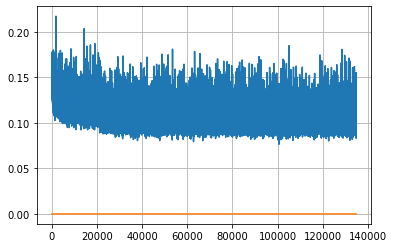

Epoch: 346, iteration 0, loss 0.09516298770904541, cov_diff 0.41033236925611977 cov_diff train 0.4107537927747287
Epoch: 346, iteration 1, loss 0.10841697454452515, cov_diff 0.4029196244223842 cov_diff train 0.4022932211565876
Epoch: 346, iteration 2, loss 0.09672972559928894, cov_diff 0.4160492785537846 cov_diff train 0.41590622160067764
Epoch: 346, iteration 3, loss 0.11704260110855103, cov_diff 0.4164547980174758 cov_diff train 0.4163205864587636
Epoch: 346, iteration 4, loss 0.10286620259284973, cov_diff 0.41411905564198886 cov_diff train 0.41348540941803774
Epoch: 346, iteration 5, loss 0.11486700177192688, cov_diff 0.4012042148506695 cov_diff train 0.4009749360635781
Epoch: 346, iteration 6, loss 0.10308560729026794, cov_diff 0.41241948161164477 cov_diff train 0.41241098645476154
Epoch: 346, iteration 7, loss 0.10063114762306213, cov_diff 0.41105156804444803 cov_diff train 0.41056934997901245
Epoch: 346, iteration 8, loss 0.125564306974411, cov_diff 0.42260525304748253 cov_diff t

Epoch: 346, iteration 79, loss 0.10770133137702942, cov_diff 0.42378312501919213 cov_diff train 0.42123083781507265
Epoch: 346, iteration 80, loss 0.10904207825660706, cov_diff 0.4277048087485986 cov_diff train 0.42672705642807085
Epoch: 346, iteration 81, loss 0.12202784419059753, cov_diff 0.40625313291158405 cov_diff train 0.4055207168566489
Epoch: 346, iteration 82, loss 0.10372805595397949, cov_diff 0.40249963329950045 cov_diff train 0.40268358139650645
Epoch: 346, iteration 83, loss 0.10127881169319153, cov_diff 0.40269584368346767 cov_diff train 0.4015135963500851
Epoch: 346, iteration 84, loss 0.10016676783561707, cov_diff 0.41529009226952257 cov_diff train 0.41526859289472146
Epoch: 346, iteration 85, loss 0.09626731276512146, cov_diff 0.42744324502287045 cov_diff train 0.4268915290646854
Epoch: 346, iteration 86, loss 0.11275437474250793, cov_diff 0.40982791591738854 cov_diff train 0.4095147537012615
Epoch: 346, iteration 87, loss 0.10653191804885864, cov_diff 0.41526125719417

Epoch: 346, iteration 158, loss 0.11161834001541138, cov_diff 0.4098482972138881 cov_diff train 0.4084320984940527
Epoch: 346, iteration 159, loss 0.09454429149627686, cov_diff 0.4208422542845994 cov_diff train 0.42006088190234064
Epoch: 346, iteration 160, loss 0.10274642705917358, cov_diff 0.41429358128039273 cov_diff train 0.4138387300120302
Epoch: 346, iteration 161, loss 0.09771546721458435, cov_diff 0.4115062806936301 cov_diff train 0.4103079976148224
Epoch: 346, iteration 162, loss 0.1066918671131134, cov_diff 0.42548972800739665 cov_diff train 0.4244379654211666
Epoch: 346, iteration 163, loss 0.11409804224967957, cov_diff 0.4178708396911926 cov_diff train 0.41774717321827687
Epoch: 346, iteration 164, loss 0.1036064624786377, cov_diff 0.42454169091231214 cov_diff train 0.42404678371153826
Epoch: 346, iteration 165, loss 0.09838205575942993, cov_diff 0.40845338636869044 cov_diff train 0.4086238246793476
Epoch: 346, iteration 166, loss 0.10199746489524841, cov_diff 0.40080905942

Epoch: 346, iteration 232, loss 0.10081484913825989, cov_diff 0.41340486065226156 cov_diff train 0.4126270848555873
Epoch: 346, iteration 233, loss 0.10161572694778442, cov_diff 0.40781963573174124 cov_diff train 0.4072194843667241
Epoch: 346, iteration 234, loss 0.10245844721794128, cov_diff 0.4118859152818626 cov_diff train 0.4103148910150511
Epoch: 346, iteration 235, loss 0.1080227792263031, cov_diff 0.41064564719814944 cov_diff train 0.4105331132150248
Epoch: 346, iteration 236, loss 0.10561537742614746, cov_diff 0.4209123889075632 cov_diff train 0.4204244877055148
Epoch: 346, iteration 237, loss 0.10876452922821045, cov_diff 0.41375169616950963 cov_diff train 0.41242598064451746
Epoch: 346, iteration 238, loss 0.10374137759208679, cov_diff 0.41755837353812847 cov_diff train 0.4166849544780065
Epoch: 346, iteration 239, loss 0.09512466192245483, cov_diff 0.40739022827869936 cov_diff train 0.4064172629246237
Epoch: 346, iteration 240, loss 0.11223658919334412, cov_diff 0.4126730027

Epoch: 346, iteration 310, loss 0.09294053912162781, cov_diff 0.41423581565357 cov_diff train 0.41366792809866954
Epoch: 346, iteration 311, loss 0.0959199070930481, cov_diff 0.4085495446234346 cov_diff train 0.40805424390285466
Epoch: 346, iteration 312, loss 0.09628987312316895, cov_diff 0.4097392075740565 cov_diff train 0.4096030685646052
Epoch: 346, iteration 313, loss 0.097022145986557, cov_diff 0.43019592699910025 cov_diff train 0.42954407045638926
Epoch: 346, iteration 314, loss 0.10372963547706604, cov_diff 0.40795560014028953 cov_diff train 0.40798187258913876
Epoch: 346, iteration 315, loss 0.11052408814430237, cov_diff 0.41180102073303093 cov_diff train 0.41058882252969325
Epoch: 346, iteration 316, loss 0.09431838989257812, cov_diff 0.42281099978462067 cov_diff train 0.4226909030474959
Epoch: 346, iteration 317, loss 0.09489759802818298, cov_diff 0.40263338457101705 cov_diff train 0.40170109201033055
Epoch: 346, iteration 318, loss 0.10776987671852112, cov_diff 0.4130236793

Epoch: 346, iteration 387, loss 0.09948000311851501, cov_diff 0.4139904794913475 cov_diff train 0.413770149941651
Epoch: 346, iteration 388, loss 0.11479648947715759, cov_diff 0.41328998642009585 cov_diff train 0.41269175824156945
Epoch: 346, iteration 389, loss 0.0996420681476593, cov_diff 0.3998548593515531 cov_diff train 0.3996279520725124
Epoch: 346, iteration 390, loss 0.16521629691123962, cov_diff 0.445364915053404 cov_diff train 0.44533044140175965


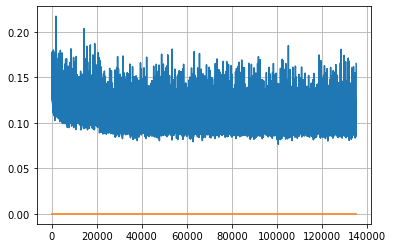

Epoch: 347, iteration 0, loss 0.10316517949104309, cov_diff 0.3888647758752398 cov_diff train 0.3894866019175307
Epoch: 347, iteration 1, loss 0.09825524687767029, cov_diff 0.4004247049217496 cov_diff train 0.4007486781478208
Epoch: 347, iteration 2, loss 0.1206183135509491, cov_diff 0.4330570484890308 cov_diff train 0.43311626064298203
Epoch: 347, iteration 3, loss 0.10687583684921265, cov_diff 0.40959801340649044 cov_diff train 0.4102536747473056
Epoch: 347, iteration 4, loss 0.09801483154296875, cov_diff 0.41468405504667166 cov_diff train 0.41385676802183924
Epoch: 347, iteration 5, loss 0.10165771842002869, cov_diff 0.39691031054679454 cov_diff train 0.3971627825716047
Epoch: 347, iteration 6, loss 0.10466572642326355, cov_diff 0.4128123009443642 cov_diff train 0.413472871918458
Epoch: 347, iteration 7, loss 0.10253766179084778, cov_diff 0.41623741989120844 cov_diff train 0.41566352714922955
Epoch: 347, iteration 8, loss 0.0925036072731018, cov_diff 0.4081701797783199 cov_diff trai

Epoch: 347, iteration 79, loss 0.12244927883148193, cov_diff 0.4015659578912623 cov_diff train 0.39971536492627985
Epoch: 347, iteration 80, loss 0.09660646319389343, cov_diff 0.4100164511260997 cov_diff train 0.40948953963705725
Epoch: 347, iteration 81, loss 0.10934245586395264, cov_diff 0.4249709430324763 cov_diff train 0.42340109873813175
Epoch: 347, iteration 82, loss 0.1022622287273407, cov_diff 0.4080612308216168 cov_diff train 0.4075528864807786
Epoch: 347, iteration 83, loss 0.10727924108505249, cov_diff 0.4288899467471257 cov_diff train 0.42789535172707627
Epoch: 347, iteration 84, loss 0.10244542360305786, cov_diff 0.4240585285408432 cov_diff train 0.42356333024754633
Epoch: 347, iteration 85, loss 0.09263435006141663, cov_diff 0.40675548919073995 cov_diff train 0.40597365774546357
Epoch: 347, iteration 86, loss 0.10128146409988403, cov_diff 0.42070233150564895 cov_diff train 0.420352464776047
Epoch: 347, iteration 87, loss 0.13149937987327576, cov_diff 0.42177749848049534 c

Epoch: 347, iteration 151, loss 0.11179220676422119, cov_diff 0.416815304059038 cov_diff train 0.41578423852380497
Epoch: 347, iteration 152, loss 0.10286897420883179, cov_diff 0.4131616242939994 cov_diff train 0.41195393343051206
Epoch: 347, iteration 153, loss 0.10432550311088562, cov_diff 0.42797458414787204 cov_diff train 0.4260839680853311
Epoch: 347, iteration 154, loss 0.1048867404460907, cov_diff 0.4058245618621312 cov_diff train 0.40439652064776177
Epoch: 347, iteration 155, loss 0.10314738750457764, cov_diff 0.41653072104973665 cov_diff train 0.41564455536171385
Epoch: 347, iteration 156, loss 0.10290998220443726, cov_diff 0.4154834175897701 cov_diff train 0.4151728492466391
Epoch: 347, iteration 157, loss 0.1085541844367981, cov_diff 0.40961702479701567 cov_diff train 0.4085103165902351
Epoch: 347, iteration 158, loss 0.09770813584327698, cov_diff 0.4039899880501265 cov_diff train 0.40317888177782235
Epoch: 347, iteration 159, loss 0.09433385729789734, cov_diff 0.42332377050

Epoch: 347, iteration 228, loss 0.10387095808982849, cov_diff 0.41426783625915836 cov_diff train 0.4143214832414846
Epoch: 347, iteration 229, loss 0.11543092131614685, cov_diff 0.40098637810451987 cov_diff train 0.40143464878521634
Epoch: 347, iteration 230, loss 0.11023038625717163, cov_diff 0.42256548757117535 cov_diff train 0.422426673217
Epoch: 347, iteration 231, loss 0.09496113657951355, cov_diff 0.40985589559776187 cov_diff train 0.41010454711388894
Epoch: 347, iteration 232, loss 0.10616463422775269, cov_diff 0.4166011021978335 cov_diff train 0.41649248735206174
Epoch: 347, iteration 233, loss 0.10812720656394958, cov_diff 0.40353060584386385 cov_diff train 0.4030073787814052
Epoch: 347, iteration 234, loss 0.10315781831741333, cov_diff 0.41206297838005446 cov_diff train 0.41149673064396236
Epoch: 347, iteration 235, loss 0.09776726365089417, cov_diff 0.4057952418921447 cov_diff train 0.4053149199831011
Epoch: 347, iteration 236, loss 0.09489402174949646, cov_diff 0.4136216277

Epoch: 347, iteration 305, loss 0.1004980206489563, cov_diff 0.4104460231302304 cov_diff train 0.40952910780343654
Epoch: 347, iteration 306, loss 0.10077396035194397, cov_diff 0.4033144789564926 cov_diff train 0.402796678236489
Epoch: 347, iteration 307, loss 0.10185977816581726, cov_diff 0.4213059217901664 cov_diff train 0.4205826190293509
Epoch: 347, iteration 308, loss 0.10309582948684692, cov_diff 0.420674947421809 cov_diff train 0.4209972212729034
Epoch: 347, iteration 309, loss 0.09734773635864258, cov_diff 0.40017798081480793 cov_diff train 0.4003870277787665
Epoch: 347, iteration 310, loss 0.11046028137207031, cov_diff 0.4225766670943565 cov_diff train 0.4224581459395934
Epoch: 347, iteration 311, loss 0.09894824028015137, cov_diff 0.4108031641158989 cov_diff train 0.41094057653298344
Epoch: 347, iteration 312, loss 0.09948334097862244, cov_diff 0.4180278019557347 cov_diff train 0.41730848026595957
Epoch: 347, iteration 313, loss 0.09170502424240112, cov_diff 0.403633703091296

Epoch: 347, iteration 377, loss 0.1093401312828064, cov_diff 0.40823483747208184 cov_diff train 0.40770305117907696
Epoch: 347, iteration 378, loss 0.11639615893363953, cov_diff 0.40616797405574667 cov_diff train 0.4057223484493654
Epoch: 347, iteration 379, loss 0.09343788027763367, cov_diff 0.4178999319868017 cov_diff train 0.41810904916371266
Epoch: 347, iteration 380, loss 0.09792545437812805, cov_diff 0.4125072783213552 cov_diff train 0.41145340883471604
Epoch: 347, iteration 381, loss 0.10274890065193176, cov_diff 0.4064575832820051 cov_diff train 0.4053734069191224
Epoch: 347, iteration 382, loss 0.11110785603523254, cov_diff 0.4103856912869446 cov_diff train 0.41013468602694253
Epoch: 347, iteration 383, loss 0.11207669973373413, cov_diff 0.43700904097303306 cov_diff train 0.4362862905015946
Epoch: 347, iteration 384, loss 0.10862517356872559, cov_diff 0.4234071677449363 cov_diff train 0.42365460337681865
Epoch: 347, iteration 385, loss 0.11091446876525879, cov_diff 0.410123380

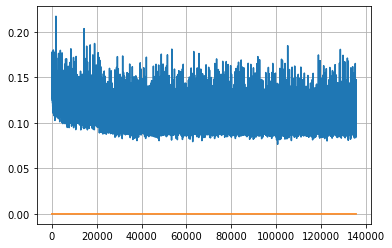

Epoch: 348, iteration 0, loss 0.10027754306793213, cov_diff 0.411905425297559 cov_diff train 0.4117289465937575
Epoch: 348, iteration 1, loss 0.09066101908683777, cov_diff 0.40549571251037897 cov_diff train 0.40479498164380423
Epoch: 348, iteration 2, loss 0.10827893018722534, cov_diff 0.42613995448720127 cov_diff train 0.42711269018308673
Epoch: 348, iteration 3, loss 0.10344347357749939, cov_diff 0.41697408764568916 cov_diff train 0.41649165782206865
Epoch: 348, iteration 4, loss 0.09939232468605042, cov_diff 0.40350712168445896 cov_diff train 0.40278079187687393
Epoch: 348, iteration 5, loss 0.10692295432090759, cov_diff 0.41922923841458754 cov_diff train 0.41780375217836474
Epoch: 348, iteration 6, loss 0.10950464010238647, cov_diff 0.407109661099322 cov_diff train 0.4052298983246249
Epoch: 348, iteration 7, loss 0.10815715789794922, cov_diff 0.43261789220021274 cov_diff train 0.43152868864356014
Epoch: 348, iteration 8, loss 0.09222429990768433, cov_diff 0.41772548636472373 cov_di

Epoch: 348, iteration 82, loss 0.09575951099395752, cov_diff 0.41244080096937624 cov_diff train 0.41127466070816704
Epoch: 348, iteration 83, loss 0.1043543815612793, cov_diff 0.4100064389546445 cov_diff train 0.409061889674011
Epoch: 348, iteration 84, loss 0.09148252010345459, cov_diff 0.41330943380787843 cov_diff train 0.413488808346308
Epoch: 348, iteration 85, loss 0.09619227051734924, cov_diff 0.41154595876224087 cov_diff train 0.4107702832611245
Epoch: 348, iteration 86, loss 0.09695765376091003, cov_diff 0.39929232385274227 cov_diff train 0.39913035550741327
Epoch: 348, iteration 87, loss 0.10346707701683044, cov_diff 0.3939507954462544 cov_diff train 0.393376035099565
Epoch: 348, iteration 88, loss 0.10952392220497131, cov_diff 0.41424233795271004 cov_diff train 0.41452607195352126
Epoch: 348, iteration 89, loss 0.10335183143615723, cov_diff 0.40558081237227883 cov_diff train 0.4059026058198589
Epoch: 348, iteration 90, loss 0.10392022132873535, cov_diff 0.40834821171193986 co

Epoch: 348, iteration 159, loss 0.10998407006263733, cov_diff 0.4121221852721775 cov_diff train 0.4103219976231763
Epoch: 348, iteration 160, loss 0.09716957807540894, cov_diff 0.4094027592314102 cov_diff train 0.4091801542118996
Epoch: 348, iteration 161, loss 0.1059342622756958, cov_diff 0.4113623183566789 cov_diff train 0.4106062521840099
Epoch: 348, iteration 162, loss 0.0968841016292572, cov_diff 0.424574295847653 cov_diff train 0.4237919435739898
Epoch: 348, iteration 163, loss 0.10428023338317871, cov_diff 0.4181879545700955 cov_diff train 0.4183986039173295
Epoch: 348, iteration 164, loss 0.10803648829460144, cov_diff 0.4201885355024508 cov_diff train 0.4202381863629913
Epoch: 348, iteration 165, loss 0.1067381203174591, cov_diff 0.4029577834152208 cov_diff train 0.4023845379639057
Epoch: 348, iteration 166, loss 0.0937717854976654, cov_diff 0.4133706881913544 cov_diff train 0.4134682514868814
Epoch: 348, iteration 167, loss 0.09452709555625916, cov_diff 0.4036250805663902 cov_

Epoch: 348, iteration 236, loss 0.10022690892219543, cov_diff 0.407472802205959 cov_diff train 0.4069871554605494
Epoch: 348, iteration 237, loss 0.09445837140083313, cov_diff 0.416570270991471 cov_diff train 0.4154321669816259
Epoch: 348, iteration 238, loss 0.11320769786834717, cov_diff 0.41834891453319667 cov_diff train 0.4168693930722592
Epoch: 348, iteration 239, loss 0.094583660364151, cov_diff 0.40431695843282545 cov_diff train 0.4028548154580195
Epoch: 348, iteration 240, loss 0.0967353880405426, cov_diff 0.39823431204592935 cov_diff train 0.3980091613160723
Epoch: 348, iteration 241, loss 0.10183405876159668, cov_diff 0.39861228839481827 cov_diff train 0.3974183799093132
Epoch: 348, iteration 242, loss 0.09320726990699768, cov_diff 0.4190000754580503 cov_diff train 0.41866815248619066
Epoch: 348, iteration 243, loss 0.10363057255744934, cov_diff 0.42991765836749 cov_diff train 0.42998125209498483
Epoch: 348, iteration 244, loss 0.09916609525680542, cov_diff 0.40996512643469357

Epoch: 348, iteration 313, loss 0.10177478194236755, cov_diff 0.4150212190932016 cov_diff train 0.4153412572252329
Epoch: 348, iteration 314, loss 0.11666837334632874, cov_diff 0.4175677295713164 cov_diff train 0.4168173020279693
Epoch: 348, iteration 315, loss 0.1059829592704773, cov_diff 0.41312229424322644 cov_diff train 0.4122677477311336
Epoch: 348, iteration 316, loss 0.09792202711105347, cov_diff 0.41707787398422225 cov_diff train 0.4165272590873897
Epoch: 348, iteration 317, loss 0.10531944036483765, cov_diff 0.4333990211645382 cov_diff train 0.43260889595628843
Epoch: 348, iteration 318, loss 0.1044040322303772, cov_diff 0.4133715718830892 cov_diff train 0.4129424276382069
Epoch: 348, iteration 319, loss 0.09650164842605591, cov_diff 0.4160420520418735 cov_diff train 0.41510594457488204
Epoch: 348, iteration 320, loss 0.10386067628860474, cov_diff 0.4223585142842438 cov_diff train 0.4219102303616034
Epoch: 348, iteration 321, loss 0.10315188765525818, cov_diff 0.41524775692888

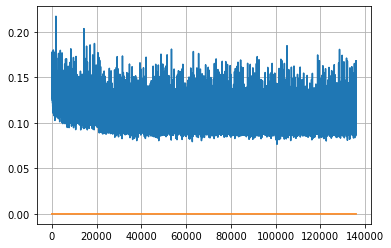

Epoch: 349, iteration 0, loss 0.10029163956642151, cov_diff 0.40395885576971635 cov_diff train 0.4040567624619493
Epoch: 349, iteration 1, loss 0.10408899188041687, cov_diff 0.40780209198249007 cov_diff train 0.40626435143142586
Epoch: 349, iteration 2, loss 0.10166475176811218, cov_diff 0.39874317484115923 cov_diff train 0.39865514361638105
Epoch: 349, iteration 3, loss 0.12011227011680603, cov_diff 0.4077215769147558 cov_diff train 0.4078655602303258
Epoch: 349, iteration 4, loss 0.10791492462158203, cov_diff 0.41015602794544054 cov_diff train 0.4096790881859882
Epoch: 349, iteration 5, loss 0.09605303406715393, cov_diff 0.4097835650657023 cov_diff train 0.40927237462447413
Epoch: 349, iteration 6, loss 0.11498084664344788, cov_diff 0.4107449869206866 cov_diff train 0.4107416095360377
Epoch: 349, iteration 7, loss 0.09555351734161377, cov_diff 0.41007618899653614 cov_diff train 0.40925913873310865
Epoch: 349, iteration 8, loss 0.11413481831550598, cov_diff 0.41447290770212397 cov_dif

Epoch: 349, iteration 76, loss 0.10280835628509521, cov_diff 0.41874617459891106 cov_diff train 0.4181266813000352
Epoch: 349, iteration 77, loss 0.10134369134902954, cov_diff 0.4204593988525653 cov_diff train 0.4198915032811091
Epoch: 349, iteration 78, loss 0.09608197212219238, cov_diff 0.4167406581850208 cov_diff train 0.41650506330649445
Epoch: 349, iteration 79, loss 0.11122345924377441, cov_diff 0.42071233123277585 cov_diff train 0.41983459390916855
Epoch: 349, iteration 80, loss 0.10108688473701477, cov_diff 0.4080630332081815 cov_diff train 0.4072429225124474
Epoch: 349, iteration 81, loss 0.10580715537071228, cov_diff 0.40596144210470986 cov_diff train 0.40642409960033926
Epoch: 349, iteration 82, loss 0.09309083223342896, cov_diff 0.41587133303627255 cov_diff train 0.4165800094007156
Epoch: 349, iteration 83, loss 0.09707847237586975, cov_diff 0.40651153631288284 cov_diff train 0.4068662152579045
Epoch: 349, iteration 84, loss 0.10100960731506348, cov_diff 0.4154341988379876 

Epoch: 349, iteration 152, loss 0.09144717454910278, cov_diff 0.4138179508389688 cov_diff train 0.4133079985672832
Epoch: 349, iteration 153, loss 0.1013227105140686, cov_diff 0.416788001732673 cov_diff train 0.41574881874342057
Epoch: 349, iteration 154, loss 0.0907103419303894, cov_diff 0.41580837124075204 cov_diff train 0.41512211684751904
Epoch: 349, iteration 155, loss 0.10388290882110596, cov_diff 0.4143614688349532 cov_diff train 0.4114543005323609
Epoch: 349, iteration 156, loss 0.10072419047355652, cov_diff 0.41407394663764147 cov_diff train 0.4137953657709722
Epoch: 349, iteration 157, loss 0.10111305117607117, cov_diff 0.4173651641748853 cov_diff train 0.4177076717438031
Epoch: 349, iteration 158, loss 0.09715986251831055, cov_diff 0.4196061053546455 cov_diff train 0.419221006667034
Epoch: 349, iteration 159, loss 0.10439109802246094, cov_diff 0.42030320865691617 cov_diff train 0.42011179730235226
Epoch: 349, iteration 160, loss 0.12659865617752075, cov_diff 0.39721766596133

Epoch: 349, iteration 229, loss 0.11283576488494873, cov_diff 0.41126941499550207 cov_diff train 0.4111597109032397
Epoch: 349, iteration 230, loss 0.10798004269599915, cov_diff 0.4021826477173406 cov_diff train 0.40186609999146683
Epoch: 349, iteration 231, loss 0.11129936575889587, cov_diff 0.41071668410866896 cov_diff train 0.41042324699313176
Epoch: 349, iteration 232, loss 0.08989739418029785, cov_diff 0.4039682207529002 cov_diff train 0.4034269040816467
Epoch: 349, iteration 233, loss 0.11858850717544556, cov_diff 0.41768725504536275 cov_diff train 0.41659858397731275
Epoch: 349, iteration 234, loss 0.11386269330978394, cov_diff 0.42165829359773616 cov_diff train 0.42132955950641404
Epoch: 349, iteration 235, loss 0.10507923364639282, cov_diff 0.40846348372570873 cov_diff train 0.40746995041818895
Epoch: 349, iteration 236, loss 0.1086055338382721, cov_diff 0.4068861111267082 cov_diff train 0.40625614195334503
Epoch: 349, iteration 237, loss 0.10375010967254639, cov_diff 0.414265

Epoch: 349, iteration 305, loss 0.09467655420303345, cov_diff 0.40998075303676335 cov_diff train 0.40990606893696396
Epoch: 349, iteration 306, loss 0.09628677368164062, cov_diff 0.4153568408492786 cov_diff train 0.4149067410480472
Epoch: 349, iteration 307, loss 0.10186681151390076, cov_diff 0.4047135659190513 cov_diff train 0.4034782992580922
Epoch: 349, iteration 308, loss 0.11042371392250061, cov_diff 0.4210987278127758 cov_diff train 0.4199519285528726
Epoch: 349, iteration 309, loss 0.10786479711532593, cov_diff 0.4089438955951521 cov_diff train 0.40830750289799156
Epoch: 349, iteration 310, loss 0.0887170135974884, cov_diff 0.4061293504979879 cov_diff train 0.4056698745398555
Epoch: 349, iteration 311, loss 0.09808135032653809, cov_diff 0.39757389890577005 cov_diff train 0.39691419894207175
Epoch: 349, iteration 312, loss 0.09846660494804382, cov_diff 0.3968447307987014 cov_diff train 0.3969166454458548
Epoch: 349, iteration 313, loss 0.09309527277946472, cov_diff 0.416190187936

Epoch: 349, iteration 385, loss 0.09364199638366699, cov_diff 0.3982646198821754 cov_diff train 0.3982654410488707
Epoch: 349, iteration 386, loss 0.09889143705368042, cov_diff 0.42148292664920917 cov_diff train 0.4213200000581542
Epoch: 349, iteration 387, loss 0.0967576801776886, cov_diff 0.4123647683270597 cov_diff train 0.41196558815373374
Epoch: 349, iteration 388, loss 0.09975811839103699, cov_diff 0.41688253546085907 cov_diff train 0.4163305067470062
Epoch: 349, iteration 389, loss 0.1023842990398407, cov_diff 0.4152774982164025 cov_diff train 0.41489928408408827
Epoch: 349, iteration 390, loss 0.16801020503044128, cov_diff 0.4489147457838021 cov_diff train 0.44858665850107093


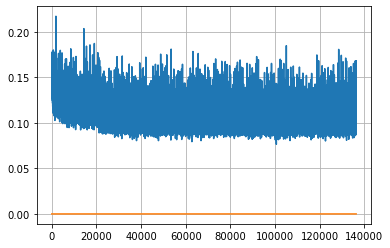

Epoch: 350, iteration 0, loss 0.09981650114059448, cov_diff 0.4173941815347816 cov_diff train 0.41663579806891354
Epoch: 350, iteration 1, loss 0.12400969862937927, cov_diff 0.4183411754875909 cov_diff train 0.4175661713334588
Epoch: 350, iteration 2, loss 0.09952893853187561, cov_diff 0.4193550380409812 cov_diff train 0.41880933745943305
Epoch: 350, iteration 3, loss 0.10074028372764587, cov_diff 0.40237371210569395 cov_diff train 0.4012711865783037
Epoch: 350, iteration 4, loss 0.11212003231048584, cov_diff 0.40967959600265336 cov_diff train 0.4088448448014632
Epoch: 350, iteration 5, loss 0.1065225899219513, cov_diff 0.4179394585091246 cov_diff train 0.41811646012987913
Epoch: 350, iteration 6, loss 0.09260958433151245, cov_diff 0.42294067668935 cov_diff train 0.4225695729452845
Epoch: 350, iteration 7, loss 0.11710238456726074, cov_diff 0.41017089129988255 cov_diff train 0.40937501246402297
Epoch: 350, iteration 8, loss 0.10089525580406189, cov_diff 0.4118810324683536 cov_diff trai

Epoch: 350, iteration 77, loss 0.09359174966812134, cov_diff 0.40816104556455 cov_diff train 0.4076749520571626
Epoch: 350, iteration 78, loss 0.11520656943321228, cov_diff 0.4127840646270099 cov_diff train 0.4115073422657654
Epoch: 350, iteration 79, loss 0.09672623872756958, cov_diff 0.407037986151209 cov_diff train 0.40587006088812466
Epoch: 350, iteration 80, loss 0.10251712799072266, cov_diff 0.41418012563755974 cov_diff train 0.4137485601318641
Epoch: 350, iteration 81, loss 0.12229970097541809, cov_diff 0.41668205237162514 cov_diff train 0.4162916683604493
Epoch: 350, iteration 82, loss 0.09911742806434631, cov_diff 0.41261725335505806 cov_diff train 0.4130386827909893
Epoch: 350, iteration 83, loss 0.09684282541275024, cov_diff 0.40650950115692797 cov_diff train 0.40658264590164844
Epoch: 350, iteration 84, loss 0.0958310067653656, cov_diff 0.42349418443395714 cov_diff train 0.4223666115261242
Epoch: 350, iteration 85, loss 0.1043354868888855, cov_diff 0.40741140877306486 cov_d

Epoch: 350, iteration 159, loss 0.0922454297542572, cov_diff 0.4154298215408309 cov_diff train 0.41481502777352913
Epoch: 350, iteration 160, loss 0.09931468963623047, cov_diff 0.415568679113701 cov_diff train 0.4151449679394944
Epoch: 350, iteration 161, loss 0.1192730963230133, cov_diff 0.42918613886103285 cov_diff train 0.4275438535164667
Epoch: 350, iteration 162, loss 0.10184082388877869, cov_diff 0.41754897092048227 cov_diff train 0.41550108251239903
Epoch: 350, iteration 163, loss 0.10435211658477783, cov_diff 0.42099119384334854 cov_diff train 0.41966595838333765
Epoch: 350, iteration 164, loss 0.10670280456542969, cov_diff 0.41417227554441066 cov_diff train 0.41329770070307026
Epoch: 350, iteration 165, loss 0.10234758257865906, cov_diff 0.42340318922807046 cov_diff train 0.42181268225847823
Epoch: 350, iteration 166, loss 0.10119947791099548, cov_diff 0.41782225538509166 cov_diff train 0.41615111732886473
Epoch: 350, iteration 167, loss 0.10598281025886536, cov_diff 0.4246801

Epoch: 350, iteration 236, loss 0.11038407683372498, cov_diff 0.41246712586012785 cov_diff train 0.41137223861497146
Epoch: 350, iteration 237, loss 0.09962671995162964, cov_diff 0.41930502506231027 cov_diff train 0.4178405615399377
Epoch: 350, iteration 238, loss 0.10774394869804382, cov_diff 0.41655070318506643 cov_diff train 0.41506158341673033
Epoch: 350, iteration 239, loss 0.12061378359794617, cov_diff 0.4188170363510241 cov_diff train 0.41754152032434677
Epoch: 350, iteration 240, loss 0.09535658359527588, cov_diff 0.41370465898085074 cov_diff train 0.41274162324979713
Epoch: 350, iteration 241, loss 0.09507212042808533, cov_diff 0.39042882098296733 cov_diff train 0.3894695935525706
Epoch: 350, iteration 242, loss 0.10463044047355652, cov_diff 0.4081881934953002 cov_diff train 0.4078371183518242
Epoch: 350, iteration 243, loss 0.09433317184448242, cov_diff 0.4089713720603789 cov_diff train 0.4084562723807661
Epoch: 350, iteration 244, loss 0.08630621433258057, cov_diff 0.4016261

Epoch: 350, iteration 311, loss 0.10131287574768066, cov_diff 0.41252701659923774 cov_diff train 0.41249441832797346
Epoch: 350, iteration 312, loss 0.09944888949394226, cov_diff 0.4088771646155248 cov_diff train 0.4098961131100343
Epoch: 350, iteration 313, loss 0.10635265707969666, cov_diff 0.4169759233704083 cov_diff train 0.4161000075582139
Epoch: 350, iteration 314, loss 0.09981894493103027, cov_diff 0.42155427837453124 cov_diff train 0.4220416242248546
Epoch: 350, iteration 315, loss 0.10010945796966553, cov_diff 0.4131428183887865 cov_diff train 0.4123582369912058
Epoch: 350, iteration 316, loss 0.10497048497200012, cov_diff 0.4220707794173283 cov_diff train 0.4215696634561278
Epoch: 350, iteration 317, loss 0.09880724549293518, cov_diff 0.41704520348644153 cov_diff train 0.4160917072886473
Epoch: 350, iteration 318, loss 0.10318458080291748, cov_diff 0.41472177567917995 cov_diff train 0.4142082263199477
Epoch: 350, iteration 319, loss 0.09487345814704895, cov_diff 0.42007686078

Epoch: 350, iteration 386, loss 0.10319268703460693, cov_diff 0.4229540436366751 cov_diff train 0.4223657689326588
Epoch: 350, iteration 387, loss 0.1101183295249939, cov_diff 0.4198585999499752 cov_diff train 0.4190012874341636
Epoch: 350, iteration 388, loss 0.09364819526672363, cov_diff 0.41316710332209244 cov_diff train 0.412465456070365
Epoch: 350, iteration 389, loss 0.10838466882705688, cov_diff 0.41739683837753877 cov_diff train 0.41735423768880014
Epoch: 350, iteration 390, loss 0.15928837656974792, cov_diff 0.4601604158329606 cov_diff train 0.4600635230842555


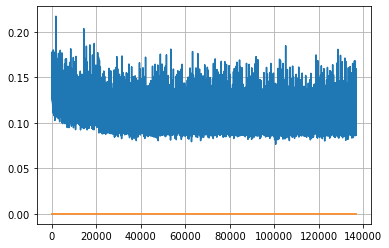

Epoch: 351, iteration 0, loss 0.09458938241004944, cov_diff 0.40803637831712425 cov_diff train 0.4087714168685707
Epoch: 351, iteration 1, loss 0.10709536075592041, cov_diff 0.4152978079772609 cov_diff train 0.4154774071523012
Epoch: 351, iteration 2, loss 0.09394919872283936, cov_diff 0.409679843805577 cov_diff train 0.40949323893810863
Epoch: 351, iteration 3, loss 0.11676493287086487, cov_diff 0.4253646209026603 cov_diff train 0.4251387143315886
Epoch: 351, iteration 4, loss 0.09922999143600464, cov_diff 0.41136982444058995 cov_diff train 0.41070157028907084
Epoch: 351, iteration 5, loss 0.10666090250015259, cov_diff 0.41121487111350785 cov_diff train 0.4108549858861454
Epoch: 351, iteration 6, loss 0.1067642867565155, cov_diff 0.4066137687311512 cov_diff train 0.40669116349513323
Epoch: 351, iteration 7, loss 0.10313260555267334, cov_diff 0.4045219264330962 cov_diff train 0.4047002818986282
Epoch: 351, iteration 8, loss 0.10410967469215393, cov_diff 0.41315513489411526 cov_diff tra

Epoch: 351, iteration 82, loss 0.10837715864181519, cov_diff 0.4091952508458875 cov_diff train 0.40896244647286345
Epoch: 351, iteration 83, loss 0.0985739529132843, cov_diff 0.4063951705911717 cov_diff train 0.4066197425311795
Epoch: 351, iteration 84, loss 0.09757739305496216, cov_diff 0.4086217562853494 cov_diff train 0.4083555717021273
Epoch: 351, iteration 85, loss 0.10551765561103821, cov_diff 0.41628791446835556 cov_diff train 0.4156808640280046
Epoch: 351, iteration 86, loss 0.11655640602111816, cov_diff 0.4107901887453723 cov_diff train 0.4098395553622674
Epoch: 351, iteration 87, loss 0.10532727837562561, cov_diff 0.4173022326436511 cov_diff train 0.41692520003187433
Epoch: 351, iteration 88, loss 0.11774194240570068, cov_diff 0.41322993839230204 cov_diff train 0.41276500389748944
Epoch: 351, iteration 89, loss 0.09267860651016235, cov_diff 0.40731975715153546 cov_diff train 0.40671466666450523
Epoch: 351, iteration 90, loss 0.11139127612113953, cov_diff 0.42045760818516886 c

Epoch: 351, iteration 157, loss 0.08876723051071167, cov_diff 0.4192081432434925 cov_diff train 0.4188326256306219
Epoch: 351, iteration 158, loss 0.09672752022743225, cov_diff 0.4108568890100715 cov_diff train 0.41040127154075245
Epoch: 351, iteration 159, loss 0.0988377034664154, cov_diff 0.41355025818254193 cov_diff train 0.4128897526590756
Epoch: 351, iteration 160, loss 0.11478948593139648, cov_diff 0.4205154557147394 cov_diff train 0.4190016810172015
Epoch: 351, iteration 161, loss 0.10261237621307373, cov_diff 0.4090254884634519 cov_diff train 0.4082989023458917
Epoch: 351, iteration 162, loss 0.0991290807723999, cov_diff 0.4031074041469953 cov_diff train 0.4014459015228033
Epoch: 351, iteration 163, loss 0.10204029083251953, cov_diff 0.4167833407613632 cov_diff train 0.4155031194757609
Epoch: 351, iteration 164, loss 0.10311388969421387, cov_diff 0.41504478516923515 cov_diff train 0.4135703070022803
Epoch: 351, iteration 165, loss 0.10034742951393127, cov_diff 0.408491342091730

Epoch: 351, iteration 234, loss 0.10576719045639038, cov_diff 0.4118199717347453 cov_diff train 0.4106698179997803
Epoch: 351, iteration 235, loss 0.11102044582366943, cov_diff 0.40796661186567684 cov_diff train 0.40713992168281316
Epoch: 351, iteration 236, loss 0.11130982637405396, cov_diff 0.40110354124058273 cov_diff train 0.4010515578095894
Epoch: 351, iteration 237, loss 0.11189249157905579, cov_diff 0.41765940753821823 cov_diff train 0.4167374352857757
Epoch: 351, iteration 238, loss 0.09613072872161865, cov_diff 0.39583471371471424 cov_diff train 0.39484242947458786
Epoch: 351, iteration 239, loss 0.09833696484565735, cov_diff 0.40625159827132895 cov_diff train 0.40566499415307533
Epoch: 351, iteration 240, loss 0.10059747099876404, cov_diff 0.40969792632466423 cov_diff train 0.408766008230994
Epoch: 351, iteration 241, loss 0.10732194781303406, cov_diff 0.3980398128193462 cov_diff train 0.397747891084795
Epoch: 351, iteration 242, loss 0.0997767448425293, cov_diff 0.4063886659

Epoch: 351, iteration 312, loss 0.09778076410293579, cov_diff 0.40478964447657667 cov_diff train 0.4042206974439506
Epoch: 351, iteration 313, loss 0.09686827659606934, cov_diff 0.4088229522118703 cov_diff train 0.4089302552709307
Epoch: 351, iteration 314, loss 0.09955012798309326, cov_diff 0.3994588154249516 cov_diff train 0.39846328328836556
Epoch: 351, iteration 315, loss 0.1152675449848175, cov_diff 0.41360386872773947 cov_diff train 0.41300081487154133
Epoch: 351, iteration 316, loss 0.11115297675132751, cov_diff 0.4158780127985231 cov_diff train 0.414859295482081
Epoch: 351, iteration 317, loss 0.12245309352874756, cov_diff 0.42131387940265036 cov_diff train 0.4201603254852443
Epoch: 351, iteration 318, loss 0.10203567147254944, cov_diff 0.40320629120546003 cov_diff train 0.40320363678161164
Epoch: 351, iteration 319, loss 0.11653277277946472, cov_diff 0.417107388776545 cov_diff train 0.41552894814465136
Epoch: 351, iteration 320, loss 0.104876309633255, cov_diff 0.4064661197619

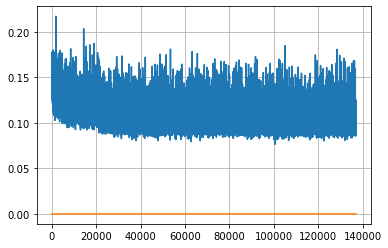

Epoch: 352, iteration 0, loss 0.10075435042381287, cov_diff 0.40256836015934244 cov_diff train 0.4022086331014662
Epoch: 352, iteration 1, loss 0.10194876790046692, cov_diff 0.40911487883080144 cov_diff train 0.4088855727734538
Epoch: 352, iteration 2, loss 0.10435503721237183, cov_diff 0.4075076480564783 cov_diff train 0.40618464361535755
Epoch: 352, iteration 3, loss 0.11149510741233826, cov_diff 0.4178316984134795 cov_diff train 0.41772349073852594
Epoch: 352, iteration 4, loss 0.08572807908058167, cov_diff 0.4056299161006109 cov_diff train 0.404522239746369
Epoch: 352, iteration 5, loss 0.10395094752311707, cov_diff 0.4170039563263659 cov_diff train 0.41522154489964663
Epoch: 352, iteration 6, loss 0.10414564609527588, cov_diff 0.3966155141123626 cov_diff train 0.3953995717184313
Epoch: 352, iteration 7, loss 0.11068949103355408, cov_diff 0.40598313301968025 cov_diff train 0.4051950209987608
Epoch: 352, iteration 8, loss 0.0994272232055664, cov_diff 0.4073974442647107 cov_diff trai

Epoch: 352, iteration 78, loss 0.10311275720596313, cov_diff 0.4045368174499014 cov_diff train 0.40386185317789974
Epoch: 352, iteration 79, loss 0.1179686188697815, cov_diff 0.417897044564558 cov_diff train 0.4176173842516768
Epoch: 352, iteration 80, loss 0.10844302177429199, cov_diff 0.4144095719564505 cov_diff train 0.4141827568098313
Epoch: 352, iteration 81, loss 0.09414595365524292, cov_diff 0.41564448536893206 cov_diff train 0.41491211714378573
Epoch: 352, iteration 82, loss 0.09640717506408691, cov_diff 0.4052891720490659 cov_diff train 0.404140021974385
Epoch: 352, iteration 83, loss 0.10788744688034058, cov_diff 0.4105929695563113 cov_diff train 0.410267965967885
Epoch: 352, iteration 84, loss 0.11495795845985413, cov_diff 0.41127935125913617 cov_diff train 0.4106792334514456
Epoch: 352, iteration 85, loss 0.10839247703552246, cov_diff 0.41415124179109236 cov_diff train 0.4130966804272475
Epoch: 352, iteration 86, loss 0.09679576754570007, cov_diff 0.40673655551001037 cov_di

Epoch: 352, iteration 155, loss 0.09603121876716614, cov_diff 0.40960893782779334 cov_diff train 0.4091399849741363
Epoch: 352, iteration 156, loss 0.10756823420524597, cov_diff 0.39664201097942103 cov_diff train 0.3952453212242742
Epoch: 352, iteration 157, loss 0.09649255871772766, cov_diff 0.4052860949326717 cov_diff train 0.4041189683139736
Epoch: 352, iteration 158, loss 0.0961402952671051, cov_diff 0.42592467741478424 cov_diff train 0.4260425775741297
Epoch: 352, iteration 159, loss 0.10611355304718018, cov_diff 0.41142157297868337 cov_diff train 0.4116714006847704
Epoch: 352, iteration 160, loss 0.09953290224075317, cov_diff 0.3973915334294128 cov_diff train 0.3970629399170141
Epoch: 352, iteration 161, loss 0.09680452942848206, cov_diff 0.4335126596323676 cov_diff train 0.4336847278583075
Epoch: 352, iteration 162, loss 0.10130879282951355, cov_diff 0.41621128017312514 cov_diff train 0.4152203622610491
Epoch: 352, iteration 163, loss 0.10876008868217468, cov_diff 0.420106944346

Epoch: 352, iteration 232, loss 0.1036873459815979, cov_diff 0.4121252579905423 cov_diff train 0.41177279054121224
Epoch: 352, iteration 233, loss 0.10518205165863037, cov_diff 0.409215792331361 cov_diff train 0.40882019855016977
Epoch: 352, iteration 234, loss 0.1082065999507904, cov_diff 0.4147105269671262 cov_diff train 0.4128763982849141
Epoch: 352, iteration 235, loss 0.11187931895256042, cov_diff 0.414391843184336 cov_diff train 0.41337623989719374
Epoch: 352, iteration 236, loss 0.10268911719322205, cov_diff 0.4159704890692342 cov_diff train 0.4142923480784696
Epoch: 352, iteration 237, loss 0.09700331091880798, cov_diff 0.41296746697107434 cov_diff train 0.41196943368196703
Epoch: 352, iteration 238, loss 0.1007193922996521, cov_diff 0.4020692304293873 cov_diff train 0.40211672018001837
Epoch: 352, iteration 239, loss 0.09965252876281738, cov_diff 0.42303064579445143 cov_diff train 0.4226914149590709
Epoch: 352, iteration 240, loss 0.10542383790016174, cov_diff 0.41883393592434

Epoch: 352, iteration 308, loss 0.10149797797203064, cov_diff 0.41896578027066816 cov_diff train 0.4178070507414298
Epoch: 352, iteration 309, loss 0.11197975277900696, cov_diff 0.4012862810036809 cov_diff train 0.40161139011591473
Epoch: 352, iteration 310, loss 0.10086807608604431, cov_diff 0.41174144928440937 cov_diff train 0.4115873076662069
Epoch: 352, iteration 311, loss 0.0933387279510498, cov_diff 0.4047247391963372 cov_diff train 0.4048010974573519
Epoch: 352, iteration 312, loss 0.08924674987792969, cov_diff 0.4130863000820777 cov_diff train 0.4127531024605414
Epoch: 352, iteration 313, loss 0.10370635986328125, cov_diff 0.41625592786859605 cov_diff train 0.41698696161544446
Epoch: 352, iteration 314, loss 0.10819998383522034, cov_diff 0.41776346118546936 cov_diff train 0.41796506905746367
Epoch: 352, iteration 315, loss 0.09758973121643066, cov_diff 0.41363758753252644 cov_diff train 0.41252925636588483
Epoch: 352, iteration 316, loss 0.09628111124038696, cov_diff 0.41143294

Epoch: 352, iteration 384, loss 0.09869882464408875, cov_diff 0.415391623624678 cov_diff train 0.41450238972463643
Epoch: 352, iteration 385, loss 0.10648101568222046, cov_diff 0.42607983170611025 cov_diff train 0.42422774933189206
Epoch: 352, iteration 386, loss 0.09818464517593384, cov_diff 0.4286412711911883 cov_diff train 0.4279908296102632
Epoch: 352, iteration 387, loss 0.10367769002914429, cov_diff 0.4103306345623331 cov_diff train 0.4092627358246296
Epoch: 352, iteration 388, loss 0.10753414034843445, cov_diff 0.39838396908259627 cov_diff train 0.39761471504957696
Epoch: 352, iteration 389, loss 0.11157217621803284, cov_diff 0.4143425637455983 cov_diff train 0.4132945105002667
Epoch: 352, iteration 390, loss 0.13685709238052368, cov_diff 0.44480847442276766 cov_diff train 0.4444505109538924


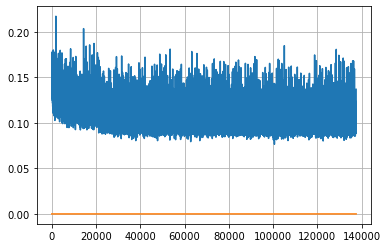

Epoch: 353, iteration 0, loss 0.10870730876922607, cov_diff 0.4099906245055772 cov_diff train 0.4086498023718693
Epoch: 353, iteration 1, loss 0.0952354371547699, cov_diff 0.4101017856732546 cov_diff train 0.409899762899635
Epoch: 353, iteration 2, loss 0.10407805442810059, cov_diff 0.40343945923397095 cov_diff train 0.401900210825494
Epoch: 353, iteration 3, loss 0.09856680035591125, cov_diff 0.4013124998415719 cov_diff train 0.3998245824981254
Epoch: 353, iteration 4, loss 0.09522834420204163, cov_diff 0.4176575098068834 cov_diff train 0.4172242833086727
Epoch: 353, iteration 5, loss 0.1002296507358551, cov_diff 0.4135834238686122 cov_diff train 0.4129062282188688
Epoch: 353, iteration 6, loss 0.09157553315162659, cov_diff 0.39972876454933637 cov_diff train 0.398575141523359
Epoch: 353, iteration 7, loss 0.10915681719779968, cov_diff 0.40438850699463824 cov_diff train 0.4039946313080689
Epoch: 353, iteration 8, loss 0.10171690583229065, cov_diff 0.4077666931048715 cov_diff train 0.40

Epoch: 353, iteration 72, loss 0.10816255211830139, cov_diff 0.41153103130412927 cov_diff train 0.4114339936717048
Epoch: 353, iteration 73, loss 0.09584641456604004, cov_diff 0.4162564956512646 cov_diff train 0.4149494679583106
Epoch: 353, iteration 74, loss 0.09922847151756287, cov_diff 0.4097084985894343 cov_diff train 0.40930661181074013
Epoch: 353, iteration 75, loss 0.09808385372161865, cov_diff 0.40182701398365367 cov_diff train 0.40190765858616984
Epoch: 353, iteration 76, loss 0.0992003083229065, cov_diff 0.4246614373222036 cov_diff train 0.4236286396749042
Epoch: 353, iteration 77, loss 0.09966912865638733, cov_diff 0.408347274287526 cov_diff train 0.4077256987194694
Epoch: 353, iteration 78, loss 0.10200503468513489, cov_diff 0.41436808318390744 cov_diff train 0.4130094789580769
Epoch: 353, iteration 79, loss 0.10025900602340698, cov_diff 0.4033757403823626 cov_diff train 0.40194385721625114
Epoch: 353, iteration 80, loss 0.10051175951957703, cov_diff 0.4168313519797338 cov_

Epoch: 353, iteration 151, loss 0.11053299903869629, cov_diff 0.4150083942946426 cov_diff train 0.414265336380314
Epoch: 353, iteration 152, loss 0.09818103909492493, cov_diff 0.4375439136544247 cov_diff train 0.4349329080689811
Epoch: 353, iteration 153, loss 0.09822770953178406, cov_diff 0.4178848752762549 cov_diff train 0.41686242198316925
Epoch: 353, iteration 154, loss 0.1004728376865387, cov_diff 0.40461488546462665 cov_diff train 0.4040250118289924
Epoch: 353, iteration 155, loss 0.11058187484741211, cov_diff 0.4113348121491958 cov_diff train 0.410503432733039
Epoch: 353, iteration 156, loss 0.09893757104873657, cov_diff 0.41506223164391803 cov_diff train 0.414231540165318
Epoch: 353, iteration 157, loss 0.10487553477287292, cov_diff 0.4102180181850675 cov_diff train 0.4091598280973261
Epoch: 353, iteration 158, loss 0.09477964043617249, cov_diff 0.4031685881700276 cov_diff train 0.4024113790914764
Epoch: 353, iteration 159, loss 0.10910940170288086, cov_diff 0.4155935526452777 

Epoch: 353, iteration 224, loss 0.10437273979187012, cov_diff 0.41044873990071545 cov_diff train 0.41003379255737726
Epoch: 353, iteration 225, loss 0.10024389624595642, cov_diff 0.4045481182863096 cov_diff train 0.40420734736466024
Epoch: 353, iteration 226, loss 0.10738110542297363, cov_diff 0.4122459805635274 cov_diff train 0.41189440205174643
Epoch: 353, iteration 227, loss 0.09949380159378052, cov_diff 0.4099979039233835 cov_diff train 0.40930465673638133
Epoch: 353, iteration 228, loss 0.10171917080879211, cov_diff 0.41806477281827 cov_diff train 0.4174718023394118
Epoch: 353, iteration 229, loss 0.10811719298362732, cov_diff 0.4238743394349515 cov_diff train 0.4225692484659854
Epoch: 353, iteration 230, loss 0.10041248798370361, cov_diff 0.4084493113336156 cov_diff train 0.40789811678790927
Epoch: 353, iteration 231, loss 0.10148054361343384, cov_diff 0.41452190419185986 cov_diff train 0.41427624700399496
Epoch: 353, iteration 232, loss 0.09429079294204712, cov_diff 0.4094530376

Epoch: 353, iteration 304, loss 0.10534930229187012, cov_diff 0.42429762506173374 cov_diff train 0.4238891931419218
Epoch: 353, iteration 305, loss 0.10842519998550415, cov_diff 0.42299720505474064 cov_diff train 0.42239617360695825
Epoch: 353, iteration 306, loss 0.11311626434326172, cov_diff 0.417814753482512 cov_diff train 0.41699737619692867
Epoch: 353, iteration 307, loss 0.10771214962005615, cov_diff 0.4145350464319685 cov_diff train 0.41373226882961917
Epoch: 353, iteration 308, loss 0.10624176263809204, cov_diff 0.4068008673792293 cov_diff train 0.40643024765748725
Epoch: 353, iteration 309, loss 0.10459759831428528, cov_diff 0.3974306090998138 cov_diff train 0.3962521441214428
Epoch: 353, iteration 310, loss 0.104451984167099, cov_diff 0.41268509066977704 cov_diff train 0.41115102885301474
Epoch: 353, iteration 311, loss 0.10526531934738159, cov_diff 0.40414034692170203 cov_diff train 0.40281103071792934
Epoch: 353, iteration 312, loss 0.0954788327217102, cov_diff 0.4164956738

Epoch: 353, iteration 383, loss 0.09942573308944702, cov_diff 0.4086867591618432 cov_diff train 0.4077960019588884
Epoch: 353, iteration 384, loss 0.10052880644798279, cov_diff 0.41108382753061895 cov_diff train 0.41060061308128604
Epoch: 353, iteration 385, loss 0.10477638244628906, cov_diff 0.41759101885206296 cov_diff train 0.4162791297516598
Epoch: 353, iteration 386, loss 0.10409843921661377, cov_diff 0.40569608850721656 cov_diff train 0.4059677880983585
Epoch: 353, iteration 387, loss 0.0911497175693512, cov_diff 0.3996741680218091 cov_diff train 0.3990782880911422
Epoch: 353, iteration 388, loss 0.10182559490203857, cov_diff 0.4045913946467285 cov_diff train 0.40447090255981677
Epoch: 353, iteration 389, loss 0.0941428542137146, cov_diff 0.4215896105838973 cov_diff train 0.42012828483660863
Epoch: 353, iteration 390, loss 0.15743914246559143, cov_diff 0.45648920696577283 cov_diff train 0.4547443298459156


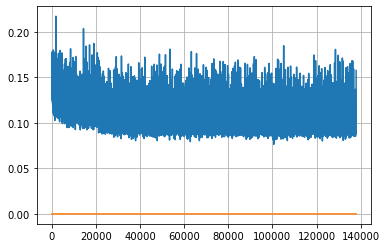

Epoch: 354, iteration 0, loss 0.10571882128715515, cov_diff 0.4124861369427965 cov_diff train 0.41133574158097164
Epoch: 354, iteration 1, loss 0.09926953911781311, cov_diff 0.40106265074267583 cov_diff train 0.40072757203067005
Epoch: 354, iteration 2, loss 0.10581669211387634, cov_diff 0.41078212200056746 cov_diff train 0.410643967598212
Epoch: 354, iteration 3, loss 0.11252269148826599, cov_diff 0.4250962114109232 cov_diff train 0.42440857910871166
Epoch: 354, iteration 4, loss 0.10360768437385559, cov_diff 0.40888033575512084 cov_diff train 0.4082780253851009
Epoch: 354, iteration 5, loss 0.11184754967689514, cov_diff 0.4121786088627572 cov_diff train 0.41121776108913644
Epoch: 354, iteration 6, loss 0.0961717963218689, cov_diff 0.41350382205345393 cov_diff train 0.41327055442281574
Epoch: 354, iteration 7, loss 0.09927847981452942, cov_diff 0.4209107040069442 cov_diff train 0.4195601681606115
Epoch: 354, iteration 8, loss 0.09742465615272522, cov_diff 0.4016458372065151 cov_diff t

Epoch: 354, iteration 77, loss 0.10619649291038513, cov_diff 0.40643894553070387 cov_diff train 0.4059974980170005
Epoch: 354, iteration 78, loss 0.09864279627799988, cov_diff 0.4136016986886228 cov_diff train 0.4131631542809757
Epoch: 354, iteration 79, loss 0.10462751984596252, cov_diff 0.413256594929951 cov_diff train 0.41312802330685794
Epoch: 354, iteration 80, loss 0.0942319929599762, cov_diff 0.3983132875928882 cov_diff train 0.39813882596143124
Epoch: 354, iteration 81, loss 0.11387184262275696, cov_diff 0.41773337147211237 cov_diff train 0.4186774869977825
Epoch: 354, iteration 82, loss 0.10625740885734558, cov_diff 0.4172196556208985 cov_diff train 0.4172728588871217
Epoch: 354, iteration 83, loss 0.10214132070541382, cov_diff 0.4115899933157032 cov_diff train 0.4116520865730273
Epoch: 354, iteration 84, loss 0.10635167360305786, cov_diff 0.394600748112404 cov_diff train 0.3941466095843794
Epoch: 354, iteration 85, loss 0.0874629020690918, cov_diff 0.4201182062063664 cov_diff

Epoch: 354, iteration 152, loss 0.10461300611495972, cov_diff 0.4128250375452251 cov_diff train 0.41187342661971665
Epoch: 354, iteration 153, loss 0.09867316484451294, cov_diff 0.40643032089844155 cov_diff train 0.4059067425261474
Epoch: 354, iteration 154, loss 0.10514965653419495, cov_diff 0.41595895594475785 cov_diff train 0.4145895032596579
Epoch: 354, iteration 155, loss 0.10853499174118042, cov_diff 0.4137850898172535 cov_diff train 0.4124686114771921
Epoch: 354, iteration 156, loss 0.10653418302536011, cov_diff 0.4186583097486192 cov_diff train 0.41795221211134786
Epoch: 354, iteration 157, loss 0.11008703708648682, cov_diff 0.41465426777404724 cov_diff train 0.4135949525547543
Epoch: 354, iteration 158, loss 0.10414406657218933, cov_diff 0.4184379213106616 cov_diff train 0.41690735774475224
Epoch: 354, iteration 159, loss 0.09206175804138184, cov_diff 0.4048233404836674 cov_diff train 0.4039969588804795
Epoch: 354, iteration 160, loss 0.10519036650657654, cov_diff 0.4230862684

Epoch: 354, iteration 227, loss 0.10707679390907288, cov_diff 0.4049484717224474 cov_diff train 0.40524540077129856
Epoch: 354, iteration 228, loss 0.10742694139480591, cov_diff 0.4043669226625691 cov_diff train 0.4046422883741817
Epoch: 354, iteration 229, loss 0.09785214066505432, cov_diff 0.4060801439748281 cov_diff train 0.4065909027422014
Epoch: 354, iteration 230, loss 0.10682475566864014, cov_diff 0.41075542029066536 cov_diff train 0.41050793603022206
Epoch: 354, iteration 231, loss 0.11085677146911621, cov_diff 0.42110281025065577 cov_diff train 0.41959200426854854
Epoch: 354, iteration 232, loss 0.0968826413154602, cov_diff 0.40288206641710567 cov_diff train 0.4028837497772587
Epoch: 354, iteration 233, loss 0.09720316529273987, cov_diff 0.41666569029204614 cov_diff train 0.41579409884163754
Epoch: 354, iteration 234, loss 0.1006430983543396, cov_diff 0.4070802021489108 cov_diff train 0.40684382238130185
Epoch: 354, iteration 235, loss 0.09462177753448486, cov_diff 0.408938837

Epoch: 354, iteration 305, loss 0.1044786274433136, cov_diff 0.4229892705745761 cov_diff train 0.4222655815812772
Epoch: 354, iteration 306, loss 0.10265836119651794, cov_diff 0.4056262183807753 cov_diff train 0.4049971787048531
Epoch: 354, iteration 307, loss 0.10868123173713684, cov_diff 0.41254258578778646 cov_diff train 0.41186084580133697
Epoch: 354, iteration 308, loss 0.11367905139923096, cov_diff 0.40987895539550534 cov_diff train 0.4083733206220784
Epoch: 354, iteration 309, loss 0.10772928595542908, cov_diff 0.41985170425896856 cov_diff train 0.4188034186231725
Epoch: 354, iteration 310, loss 0.09634476900100708, cov_diff 0.40514290664391456 cov_diff train 0.40503913491651283
Epoch: 354, iteration 311, loss 0.099240243434906, cov_diff 0.4066106806314626 cov_diff train 0.4056447925408249
Epoch: 354, iteration 312, loss 0.1039310097694397, cov_diff 0.41107988275538815 cov_diff train 0.410589995048918
Epoch: 354, iteration 313, loss 0.10414642095565796, cov_diff 0.40790225582518

Epoch: 354, iteration 381, loss 0.10165536403656006, cov_diff 0.4111509201998878 cov_diff train 0.4103028973784007
Epoch: 354, iteration 382, loss 0.09574010968208313, cov_diff 0.40775752626960565 cov_diff train 0.40750003861997125
Epoch: 354, iteration 383, loss 0.09638598561286926, cov_diff 0.402186342824866 cov_diff train 0.4026801229383465
Epoch: 354, iteration 384, loss 0.09708720445632935, cov_diff 0.407950721633446 cov_diff train 0.4076657124597185
Epoch: 354, iteration 385, loss 0.0967232882976532, cov_diff 0.4085192808906461 cov_diff train 0.4083103489369772
Epoch: 354, iteration 386, loss 0.0959348976612091, cov_diff 0.40356478358274495 cov_diff train 0.40406758848440916
Epoch: 354, iteration 387, loss 0.11237543821334839, cov_diff 0.41786894423297677 cov_diff train 0.4173299442055216
Epoch: 354, iteration 388, loss 0.10186389088630676, cov_diff 0.4160896419580067 cov_diff train 0.4165150753682634
Epoch: 354, iteration 389, loss 0.10087203979492188, cov_diff 0.425973871407013

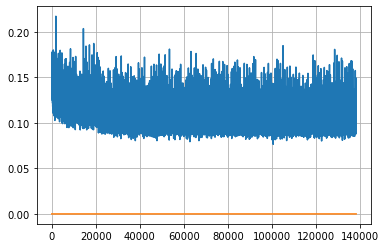

Epoch: 355, iteration 0, loss 0.1118583083152771, cov_diff 0.40996424636655954 cov_diff train 0.41054375906724583
Epoch: 355, iteration 1, loss 0.0986723005771637, cov_diff 0.4122219830621717 cov_diff train 0.411762479567628
Epoch: 355, iteration 2, loss 0.09760710597038269, cov_diff 0.41702743866155867 cov_diff train 0.4172122044223322
Epoch: 355, iteration 3, loss 0.08943155407905579, cov_diff 0.4124728742742181 cov_diff train 0.41254704382061413
Epoch: 355, iteration 4, loss 0.10567677021026611, cov_diff 0.41413912020891774 cov_diff train 0.41373702567938414
Epoch: 355, iteration 5, loss 0.10034692287445068, cov_diff 0.41676663439411193 cov_diff train 0.41576430122332747
Epoch: 355, iteration 6, loss 0.09013301134109497, cov_diff 0.41118017661185235 cov_diff train 0.4111794087762532
Epoch: 355, iteration 7, loss 0.1105833649635315, cov_diff 0.4113731370647839 cov_diff train 0.4121474531152871
Epoch: 355, iteration 8, loss 0.08785039186477661, cov_diff 0.4153299453404428 cov_diff tra

Epoch: 355, iteration 78, loss 0.11466172337532043, cov_diff 0.4112056191946437 cov_diff train 0.4102407756191111
Epoch: 355, iteration 79, loss 0.10442757606506348, cov_diff 0.4220518261733218 cov_diff train 0.4220498029213892
Epoch: 355, iteration 80, loss 0.10119280219078064, cov_diff 0.4098384856905594 cov_diff train 0.4097334581777816
Epoch: 355, iteration 81, loss 0.10596469044685364, cov_diff 0.4136320903540925 cov_diff train 0.4137905279089085
Epoch: 355, iteration 82, loss 0.11831498146057129, cov_diff 0.42272205918985833 cov_diff train 0.42205049177875914
Epoch: 355, iteration 83, loss 0.1041017472743988, cov_diff 0.41656039936181904 cov_diff train 0.41618074072172995
Epoch: 355, iteration 84, loss 0.11799091100692749, cov_diff 0.41092384114916736 cov_diff train 0.41029131978817474
Epoch: 355, iteration 85, loss 0.11257898807525635, cov_diff 0.4197898865059809 cov_diff train 0.41904873715015634
Epoch: 355, iteration 86, loss 0.11226385831832886, cov_diff 0.40914376038839373 c

Epoch: 355, iteration 155, loss 0.10247159004211426, cov_diff 0.40952576381730965 cov_diff train 0.40912552392681667
Epoch: 355, iteration 156, loss 0.09895601868629456, cov_diff 0.4074903019180602 cov_diff train 0.40705162159528163
Epoch: 355, iteration 157, loss 0.09836751222610474, cov_diff 0.42010660871315586 cov_diff train 0.41915013629727804
Epoch: 355, iteration 158, loss 0.11147576570510864, cov_diff 0.41599166411316096 cov_diff train 0.4154469750909174
Epoch: 355, iteration 159, loss 0.1047932505607605, cov_diff 0.40456036017162095 cov_diff train 0.40270095742408296
Epoch: 355, iteration 160, loss 0.10425886511802673, cov_diff 0.40963568272072903 cov_diff train 0.4091663895263397
Epoch: 355, iteration 161, loss 0.10098367929458618, cov_diff 0.4145022023230216 cov_diff train 0.4133561753536262
Epoch: 355, iteration 162, loss 0.10730257630348206, cov_diff 0.41489333079790525 cov_diff train 0.4139156817206143
Epoch: 355, iteration 163, loss 0.11130627989768982, cov_diff 0.4069887

Epoch: 355, iteration 233, loss 0.10873779654502869, cov_diff 0.411440347669054 cov_diff train 0.41096380463042315
Epoch: 355, iteration 234, loss 0.11005827784538269, cov_diff 0.4185847180333733 cov_diff train 0.4176460024453244
Epoch: 355, iteration 235, loss 0.10800579190254211, cov_diff 0.4076583379067551 cov_diff train 0.40702702993348583
Epoch: 355, iteration 236, loss 0.09876501560211182, cov_diff 0.40872039697523904 cov_diff train 0.40729355515654553
Epoch: 355, iteration 237, loss 0.09415346384048462, cov_diff 0.39931528815160416 cov_diff train 0.3984145017443511
Epoch: 355, iteration 238, loss 0.09685879945755005, cov_diff 0.404484020524011 cov_diff train 0.40440881611355717
Epoch: 355, iteration 239, loss 0.10089105367660522, cov_diff 0.3986823355070185 cov_diff train 0.3981460706553716
Epoch: 355, iteration 240, loss 0.1054239273071289, cov_diff 0.405547710439277 cov_diff train 0.4052865193127975
Epoch: 355, iteration 241, loss 0.10470956563949585, cov_diff 0.40941052783511

Epoch: 355, iteration 312, loss 0.10718318819999695, cov_diff 0.42202951445899184 cov_diff train 0.42123318323296843
Epoch: 355, iteration 313, loss 0.09351125359535217, cov_diff 0.40083911837651554 cov_diff train 0.401198030183212
Epoch: 355, iteration 314, loss 0.11058837175369263, cov_diff 0.4284299032376813 cov_diff train 0.42784150078277894
Epoch: 355, iteration 315, loss 0.10449397563934326, cov_diff 0.4192932084997908 cov_diff train 0.41878969117070536
Epoch: 355, iteration 316, loss 0.10165843367576599, cov_diff 0.40548403358833357 cov_diff train 0.4051504855593125
Epoch: 355, iteration 317, loss 0.11633262038230896, cov_diff 0.42187073451598156 cov_diff train 0.4217971442126131
Epoch: 355, iteration 318, loss 0.10776326060295105, cov_diff 0.4197379017334012 cov_diff train 0.4193040583270459
Epoch: 355, iteration 319, loss 0.09577053785324097, cov_diff 0.4065934884794377 cov_diff train 0.40645445767968885
Epoch: 355, iteration 320, loss 0.10630512237548828, cov_diff 0.410921912

Epoch: 355, iteration 390, loss 0.15473681688308716, cov_diff 0.446862505939748 cov_diff train 0.4475727018341973


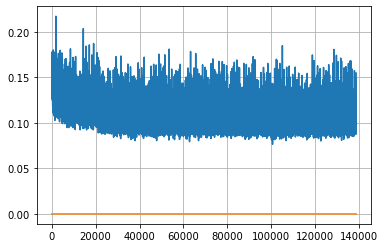

Epoch: 356, iteration 0, loss 0.09776592254638672, cov_diff 0.40039769776385936 cov_diff train 0.39984778733918147
Epoch: 356, iteration 1, loss 0.10886052250862122, cov_diff 0.41848947931336267 cov_diff train 0.416986335780319
Epoch: 356, iteration 2, loss 0.09936508536338806, cov_diff 0.4145291547941286 cov_diff train 0.41320893829069877
Epoch: 356, iteration 3, loss 0.09903618693351746, cov_diff 0.41614825100485814 cov_diff train 0.4152909635064044
Epoch: 356, iteration 4, loss 0.09590926766395569, cov_diff 0.4183456727879176 cov_diff train 0.41774466202441235
Epoch: 356, iteration 5, loss 0.10567846894264221, cov_diff 0.4076792988547054 cov_diff train 0.40674339978208607
Epoch: 356, iteration 6, loss 0.10409963130950928, cov_diff 0.4091770311171611 cov_diff train 0.40877056925197985
Epoch: 356, iteration 7, loss 0.0987081229686737, cov_diff 0.41489185976362375 cov_diff train 0.4141646722778824
Epoch: 356, iteration 8, loss 0.10063421726226807, cov_diff 0.40654755770968665 cov_diff 

Epoch: 356, iteration 74, loss 0.10216614603996277, cov_diff 0.41876895582237444 cov_diff train 0.419202552945914
Epoch: 356, iteration 75, loss 0.10050073266029358, cov_diff 0.41065613739787377 cov_diff train 0.4102232926730187
Epoch: 356, iteration 76, loss 0.1111956238746643, cov_diff 0.41813872474408265 cov_diff train 0.41802556706659794
Epoch: 356, iteration 77, loss 0.10720115900039673, cov_diff 0.41875053230061354 cov_diff train 0.4180475805327631
Epoch: 356, iteration 78, loss 0.10746455192565918, cov_diff 0.4045664290887443 cov_diff train 0.4042949073223189
Epoch: 356, iteration 79, loss 0.10305595397949219, cov_diff 0.4166825496768076 cov_diff train 0.41556096825236016
Epoch: 356, iteration 80, loss 0.100717693567276, cov_diff 0.41873623860879267 cov_diff train 0.41717629564762865
Epoch: 356, iteration 81, loss 0.1022365391254425, cov_diff 0.4077899535481193 cov_diff train 0.40657709775545936
Epoch: 356, iteration 82, loss 0.10304510593414307, cov_diff 0.405023154878319 cov_d

Epoch: 356, iteration 148, loss 0.09286582469940186, cov_diff 0.4015859846669794 cov_diff train 0.40122535179515034
Epoch: 356, iteration 149, loss 0.09378716349601746, cov_diff 0.4190502468795741 cov_diff train 0.41945491570885995
Epoch: 356, iteration 150, loss 0.10177433490753174, cov_diff 0.4186532712020079 cov_diff train 0.4189095991857684
Epoch: 356, iteration 151, loss 0.1133439838886261, cov_diff 0.40489939238362516 cov_diff train 0.4044752075447959
Epoch: 356, iteration 152, loss 0.09828203916549683, cov_diff 0.416555251238816 cov_diff train 0.41579957553692126
Epoch: 356, iteration 153, loss 0.10042750835418701, cov_diff 0.4039383793104018 cov_diff train 0.40275135781369636
Epoch: 356, iteration 154, loss 0.09513038396835327, cov_diff 0.40644556574905133 cov_diff train 0.4065142779317531
Epoch: 356, iteration 155, loss 0.10840821266174316, cov_diff 0.408899373690809 cov_diff train 0.40773221354506073
Epoch: 356, iteration 156, loss 0.1015823483467102, cov_diff 0.4089204935464

Epoch: 356, iteration 223, loss 0.10381409525871277, cov_diff 0.42057524103567523 cov_diff train 0.41979991335093025
Epoch: 356, iteration 224, loss 0.10424140095710754, cov_diff 0.40234628770310576 cov_diff train 0.4012018692864943
Epoch: 356, iteration 225, loss 0.1082831621170044, cov_diff 0.40927552934401146 cov_diff train 0.4082874925303234
Epoch: 356, iteration 226, loss 0.10045775771141052, cov_diff 0.41943657072125756 cov_diff train 0.41881561810094253
Epoch: 356, iteration 227, loss 0.0975361168384552, cov_diff 0.413423897964356 cov_diff train 0.41277160878276364
Epoch: 356, iteration 228, loss 0.10119259357452393, cov_diff 0.4036573277277972 cov_diff train 0.403128191233556
Epoch: 356, iteration 229, loss 0.10664871335029602, cov_diff 0.4052713385818463 cov_diff train 0.4041643426942111
Epoch: 356, iteration 230, loss 0.1039801836013794, cov_diff 0.39307000021116817 cov_diff train 0.3927427058845271
Epoch: 356, iteration 231, loss 0.10349217057228088, cov_diff 0.4075183108753

Epoch: 356, iteration 300, loss 0.09855449199676514, cov_diff 0.4067283547770159 cov_diff train 0.4061993448822716
Epoch: 356, iteration 301, loss 0.1080363392829895, cov_diff 0.40818533398011747 cov_diff train 0.4079128385031846
Epoch: 356, iteration 302, loss 0.10134881734848022, cov_diff 0.4231879619864686 cov_diff train 0.4232923154661073
Epoch: 356, iteration 303, loss 0.10485443472862244, cov_diff 0.40752538510751934 cov_diff train 0.40782717111790173
Epoch: 356, iteration 304, loss 0.09094619750976562, cov_diff 0.39976043047621285 cov_diff train 0.39968322291338226
Epoch: 356, iteration 305, loss 0.10048431158065796, cov_diff 0.42157543234839395 cov_diff train 0.42072587820115176
Epoch: 356, iteration 306, loss 0.1045389473438263, cov_diff 0.4085491462263794 cov_diff train 0.4086583371074556
Epoch: 356, iteration 307, loss 0.10228472948074341, cov_diff 0.40114966867923146 cov_diff train 0.40101479872119344
Epoch: 356, iteration 308, loss 0.0903615951538086, cov_diff 0.4183830820

Epoch: 356, iteration 377, loss 0.10937920212745667, cov_diff 0.42322784234821814 cov_diff train 0.4227383976302554
Epoch: 356, iteration 378, loss 0.11200165748596191, cov_diff 0.4184037618297844 cov_diff train 0.41709786743393845
Epoch: 356, iteration 379, loss 0.11690300703048706, cov_diff 0.4232527377507954 cov_diff train 0.4208812793623633
Epoch: 356, iteration 380, loss 0.10749801993370056, cov_diff 0.4027019670183528 cov_diff train 0.4016768987435034
Epoch: 356, iteration 381, loss 0.10428053140640259, cov_diff 0.4185914139671844 cov_diff train 0.41700547524258524
Epoch: 356, iteration 382, loss 0.10956931114196777, cov_diff 0.40878602003052533 cov_diff train 0.40732473433396604
Epoch: 356, iteration 383, loss 0.10242187976837158, cov_diff 0.39549926694831333 cov_diff train 0.39418204779168947
Epoch: 356, iteration 384, loss 0.11560416221618652, cov_diff 0.4199797573084893 cov_diff train 0.41792676925896527
Epoch: 356, iteration 385, loss 0.1014547348022461, cov_diff 0.413156068

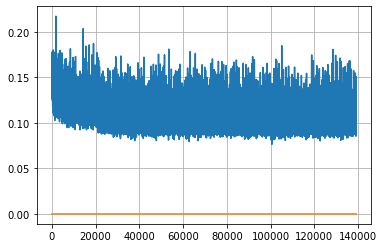

Epoch: 357, iteration 0, loss 0.11460065841674805, cov_diff 0.41756224174026463 cov_diff train 0.4166577810417943
Epoch: 357, iteration 1, loss 0.10175052285194397, cov_diff 0.4027340287939515 cov_diff train 0.4032346601292008
Epoch: 357, iteration 2, loss 0.10085022449493408, cov_diff 0.41290761861395403 cov_diff train 0.4121311570944211
Epoch: 357, iteration 3, loss 0.1009460985660553, cov_diff 0.4188711806708352 cov_diff train 0.41882328517565914
Epoch: 357, iteration 4, loss 0.10487052798271179, cov_diff 0.40959697394977373 cov_diff train 0.40981490937263126
Epoch: 357, iteration 5, loss 0.10663121938705444, cov_diff 0.41253366869479685 cov_diff train 0.4129444120203264
Epoch: 357, iteration 6, loss 0.10909733176231384, cov_diff 0.4148206033659763 cov_diff train 0.4147772565532601
Epoch: 357, iteration 7, loss 0.10983306169509888, cov_diff 0.40703885073504514 cov_diff train 0.40612454801931813
Epoch: 357, iteration 8, loss 0.09812921285629272, cov_diff 0.4202724453113495 cov_diff t

Epoch: 357, iteration 77, loss 0.12046802043914795, cov_diff 0.42138768424279804 cov_diff train 0.4206120609206338
Epoch: 357, iteration 78, loss 0.0997229516506195, cov_diff 0.4111669337079194 cov_diff train 0.4110031585461307
Epoch: 357, iteration 79, loss 0.10359099507331848, cov_diff 0.4130093839144703 cov_diff train 0.41155088334854917
Epoch: 357, iteration 80, loss 0.10268962383270264, cov_diff 0.4177282050888719 cov_diff train 0.4164523325821148
Epoch: 357, iteration 81, loss 0.10469940304756165, cov_diff 0.4172515743269007 cov_diff train 0.41648485734689406
Epoch: 357, iteration 82, loss 0.09057646989822388, cov_diff 0.4153829593408502 cov_diff train 0.41452860051095486
Epoch: 357, iteration 83, loss 0.10172834992408752, cov_diff 0.3997227962741458 cov_diff train 0.39836971776406893
Epoch: 357, iteration 84, loss 0.09491795301437378, cov_diff 0.4039967245106525 cov_diff train 0.40364928183520826
Epoch: 357, iteration 85, loss 0.10929474234580994, cov_diff 0.4096027198284595 cov

Epoch: 357, iteration 153, loss 0.10087484121322632, cov_diff 0.40027803670568146 cov_diff train 0.40051830467211785
Epoch: 357, iteration 154, loss 0.11055168509483337, cov_diff 0.41053070090005006 cov_diff train 0.41030909611728494
Epoch: 357, iteration 155, loss 0.11091437935829163, cov_diff 0.41482912927638416 cov_diff train 0.4147403706848857
Epoch: 357, iteration 156, loss 0.10386186838150024, cov_diff 0.41269655047710935 cov_diff train 0.4113200894785108
Epoch: 357, iteration 157, loss 0.11580449342727661, cov_diff 0.4177427179881695 cov_diff train 0.4167709894705253
Epoch: 357, iteration 158, loss 0.11509701609611511, cov_diff 0.4121717226218637 cov_diff train 0.41108358823541136
Epoch: 357, iteration 159, loss 0.09832626581192017, cov_diff 0.40776048444569596 cov_diff train 0.4075549026627385
Epoch: 357, iteration 160, loss 0.09653154015541077, cov_diff 0.4143827403532856 cov_diff train 0.41380714980407735
Epoch: 357, iteration 161, loss 0.09193870425224304, cov_diff 0.4061830

Epoch: 357, iteration 231, loss 0.10431119799613953, cov_diff 0.40547815476599 cov_diff train 0.40448196638532546
Epoch: 357, iteration 232, loss 0.11197739839553833, cov_diff 0.406219803914225 cov_diff train 0.4060201939047893
Epoch: 357, iteration 233, loss 0.09968316555023193, cov_diff 0.39967910498418385 cov_diff train 0.3973818534051355
Epoch: 357, iteration 234, loss 0.10570114850997925, cov_diff 0.3999797243801823 cov_diff train 0.3989048394410064
Epoch: 357, iteration 235, loss 0.09854787588119507, cov_diff 0.40095766580709497 cov_diff train 0.40023784757526
Epoch: 357, iteration 236, loss 0.10264724493026733, cov_diff 0.4025425382710849 cov_diff train 0.40151322410565915
Epoch: 357, iteration 237, loss 0.10648250579833984, cov_diff 0.41484257256742135 cov_diff train 0.4132940630154157
Epoch: 357, iteration 238, loss 0.10098132491111755, cov_diff 0.40886255423121254 cov_diff train 0.40902595709911194
Epoch: 357, iteration 239, loss 0.1074385941028595, cov_diff 0.407872350521196

Epoch: 357, iteration 310, loss 0.11283525824546814, cov_diff 0.41542055491333546 cov_diff train 0.4143340634928261
Epoch: 357, iteration 311, loss 0.09144815802574158, cov_diff 0.41720448669749965 cov_diff train 0.4170876783741985
Epoch: 357, iteration 312, loss 0.09974977374076843, cov_diff 0.41212425172334616 cov_diff train 0.4108524140085031
Epoch: 357, iteration 313, loss 0.09739923477172852, cov_diff 0.4133997896282859 cov_diff train 0.41280197621228665
Epoch: 357, iteration 314, loss 0.11271125078201294, cov_diff 0.4037728007410126 cov_diff train 0.40303284164640935
Epoch: 357, iteration 315, loss 0.11048886179924011, cov_diff 0.4066387837150756 cov_diff train 0.40562637602115575
Epoch: 357, iteration 316, loss 0.09613847732543945, cov_diff 0.4142538524485477 cov_diff train 0.4137602437242018
Epoch: 357, iteration 317, loss 0.10964947938919067, cov_diff 0.42053446161011576 cov_diff train 0.4202747341330043
Epoch: 357, iteration 318, loss 0.11540991067886353, cov_diff 0.414753636

Epoch: 357, iteration 386, loss 0.10320311784744263, cov_diff 0.41496122952628006 cov_diff train 0.4133986837257282
Epoch: 357, iteration 387, loss 0.09522378444671631, cov_diff 0.4124810868787345 cov_diff train 0.4110094026779596
Epoch: 357, iteration 388, loss 0.1001383364200592, cov_diff 0.4110789991644232 cov_diff train 0.41026681618152483
Epoch: 357, iteration 389, loss 0.09565824270248413, cov_diff 0.4323057116908083 cov_diff train 0.43172138289503464
Epoch: 357, iteration 390, loss 0.1570056974887848, cov_diff 0.45526876806039607 cov_diff train 0.4527880997070909


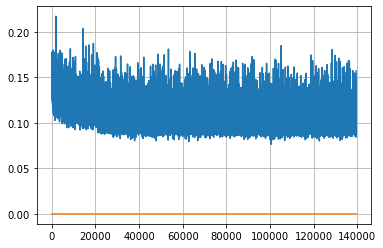

Epoch: 358, iteration 0, loss 0.10659745335578918, cov_diff 0.4131649687412826 cov_diff train 0.41266913327604865
Epoch: 358, iteration 1, loss 0.104868084192276, cov_diff 0.39897210147026985 cov_diff train 0.3985680928227609
Epoch: 358, iteration 2, loss 0.11372789740562439, cov_diff 0.41570229109465284 cov_diff train 0.4150711670582081
Epoch: 358, iteration 3, loss 0.10224613547325134, cov_diff 0.403062904200061 cov_diff train 0.40211458684732737
Epoch: 358, iteration 4, loss 0.10529905557632446, cov_diff 0.40056076552304015 cov_diff train 0.39996688496485444
Epoch: 358, iteration 5, loss 0.10622912645339966, cov_diff 0.4080547769217018 cov_diff train 0.40710011844607324
Epoch: 358, iteration 6, loss 0.09540826082229614, cov_diff 0.4120033873678157 cov_diff train 0.41145812436666485
Epoch: 358, iteration 7, loss 0.09698748588562012, cov_diff 0.4166586037369899 cov_diff train 0.4163697132752379
Epoch: 358, iteration 8, loss 0.09678912162780762, cov_diff 0.41662810693683333 cov_diff tr

Epoch: 358, iteration 77, loss 0.09823092818260193, cov_diff 0.39810464187261396 cov_diff train 0.39799853823155484
Epoch: 358, iteration 78, loss 0.10886257886886597, cov_diff 0.41199406181860054 cov_diff train 0.41141841014759084
Epoch: 358, iteration 79, loss 0.10179370641708374, cov_diff 0.4205553174255572 cov_diff train 0.4206064944789369
Epoch: 358, iteration 80, loss 0.1006198525428772, cov_diff 0.42164741670716743 cov_diff train 0.42116887147245186
Epoch: 358, iteration 81, loss 0.09513366222381592, cov_diff 0.4215567920031125 cov_diff train 0.42027666309044653
Epoch: 358, iteration 82, loss 0.11789512634277344, cov_diff 0.4183237036086545 cov_diff train 0.41819512421736776
Epoch: 358, iteration 83, loss 0.10255113244056702, cov_diff 0.3955603934533908 cov_diff train 0.39585984816945513
Epoch: 358, iteration 84, loss 0.10512533783912659, cov_diff 0.4071256743559352 cov_diff train 0.4068406357799885
Epoch: 358, iteration 85, loss 0.10417360067367554, cov_diff 0.4107684953928541 

Epoch: 358, iteration 154, loss 0.10438394546508789, cov_diff 0.4112358819649985 cov_diff train 0.41014505413006125
Epoch: 358, iteration 155, loss 0.09571182727813721, cov_diff 0.4097842522122503 cov_diff train 0.40854782008374463
Epoch: 358, iteration 156, loss 0.10017749667167664, cov_diff 0.4271832710015952 cov_diff train 0.42646274844790116
Epoch: 358, iteration 157, loss 0.1041075587272644, cov_diff 0.40025224063073966 cov_diff train 0.39965476201288275
Epoch: 358, iteration 158, loss 0.1048433780670166, cov_diff 0.41742220171225786 cov_diff train 0.4170985646413848
Epoch: 358, iteration 159, loss 0.0968601405620575, cov_diff 0.3933964010068242 cov_diff train 0.3925985368432962
Epoch: 358, iteration 160, loss 0.10955548286437988, cov_diff 0.4168945663693185 cov_diff train 0.4162981109172756
Epoch: 358, iteration 161, loss 0.10992431640625, cov_diff 0.406226703093679 cov_diff train 0.405163165056511
Epoch: 358, iteration 162, loss 0.10338926315307617, cov_diff 0.4206104692276943 c

Epoch: 358, iteration 227, loss 0.10361725091934204, cov_diff 0.4207597962559111 cov_diff train 0.4216888549285992
Epoch: 358, iteration 228, loss 0.09292465448379517, cov_diff 0.40938053407768765 cov_diff train 0.40928894112410946
Epoch: 358, iteration 229, loss 0.10967409610748291, cov_diff 0.42028988073582446 cov_diff train 0.42034789367502523
Epoch: 358, iteration 230, loss 0.1020907461643219, cov_diff 0.40539457446693344 cov_diff train 0.40474794256956886
Epoch: 358, iteration 231, loss 0.10995149612426758, cov_diff 0.41428437208972974 cov_diff train 0.4140313760240194
Epoch: 358, iteration 232, loss 0.09929344058036804, cov_diff 0.4124357537352532 cov_diff train 0.41204764593200227
Epoch: 358, iteration 233, loss 0.11971402168273926, cov_diff 0.41839339981144313 cov_diff train 0.4181071558237739
Epoch: 358, iteration 234, loss 0.09997904300689697, cov_diff 0.41705971827647453 cov_diff train 0.4168065606320235
Epoch: 358, iteration 235, loss 0.09557071328163147, cov_diff 0.4204954

Epoch: 358, iteration 301, loss 0.09294512867927551, cov_diff 0.4109095147420494 cov_diff train 0.41107756509193133
Epoch: 358, iteration 302, loss 0.10428187251091003, cov_diff 0.41062869401076146 cov_diff train 0.4092578457513362
Epoch: 358, iteration 303, loss 0.10287341475486755, cov_diff 0.40836092662118484 cov_diff train 0.4089202876646982
Epoch: 358, iteration 304, loss 0.11590853333473206, cov_diff 0.4249109061677294 cov_diff train 0.4245047999798123
Epoch: 358, iteration 305, loss 0.10227382183074951, cov_diff 0.4142456100306247 cov_diff train 0.41371966411966876
Epoch: 358, iteration 306, loss 0.09920230507850647, cov_diff 0.4152550678935509 cov_diff train 0.41497796842830376
Epoch: 358, iteration 307, loss 0.10346457362174988, cov_diff 0.407136144870252 cov_diff train 0.40668784947933406
Epoch: 358, iteration 308, loss 0.09517621994018555, cov_diff 0.42232365586381304 cov_diff train 0.42192901561644786
Epoch: 358, iteration 309, loss 0.10112708806991577, cov_diff 0.431422550

Epoch: 358, iteration 378, loss 0.10456302762031555, cov_diff 0.4133998655789241 cov_diff train 0.41326077506316106
Epoch: 358, iteration 379, loss 0.10136300325393677, cov_diff 0.4062113054278711 cov_diff train 0.40648813039438997
Epoch: 358, iteration 380, loss 0.10461461544036865, cov_diff 0.4000993256157432 cov_diff train 0.4000399264509705
Epoch: 358, iteration 381, loss 0.11594796180725098, cov_diff 0.42358218219758026 cov_diff train 0.42277022160200467
Epoch: 358, iteration 382, loss 0.09996926784515381, cov_diff 0.4029325003587377 cov_diff train 0.40188633165003707
Epoch: 358, iteration 383, loss 0.10727858543395996, cov_diff 0.41516963227458853 cov_diff train 0.4141397298760232
Epoch: 358, iteration 384, loss 0.10426118969917297, cov_diff 0.42081376678875226 cov_diff train 0.42015949068683445
Epoch: 358, iteration 385, loss 0.10987958312034607, cov_diff 0.4091468413454228 cov_diff train 0.4077285231642228
Epoch: 358, iteration 386, loss 0.09959572553634644, cov_diff 0.41458732

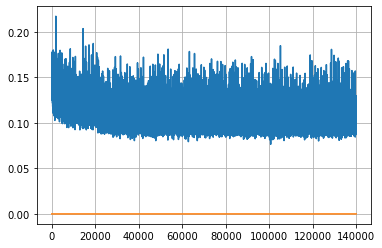

Epoch: 359, iteration 0, loss 0.11356338858604431, cov_diff 0.4017703400992597 cov_diff train 0.40145141541934487
Epoch: 359, iteration 1, loss 0.10824403166770935, cov_diff 0.41791008279671227 cov_diff train 0.41720948012669434
Epoch: 359, iteration 2, loss 0.10723671317100525, cov_diff 0.4151632377204846 cov_diff train 0.4152458356803395
Epoch: 359, iteration 3, loss 0.11862283945083618, cov_diff 0.4116438275187244 cov_diff train 0.41114280185329855
Epoch: 359, iteration 4, loss 0.09715288877487183, cov_diff 0.4115415473461169 cov_diff train 0.411836480175473
Epoch: 359, iteration 5, loss 0.1021544337272644, cov_diff 0.4008066447715784 cov_diff train 0.3997176210261956
Epoch: 359, iteration 6, loss 0.10230067372322083, cov_diff 0.42012642188230975 cov_diff train 0.42024849076989607
Epoch: 359, iteration 7, loss 0.09979239106178284, cov_diff 0.4122973929486489 cov_diff train 0.41167151514340766
Epoch: 359, iteration 8, loss 0.1097649335861206, cov_diff 0.4030922573648861 cov_diff trai

Epoch: 359, iteration 76, loss 0.10671213269233704, cov_diff 0.41855724208076794 cov_diff train 0.4183333500434924
Epoch: 359, iteration 77, loss 0.11107644438743591, cov_diff 0.41101916100943686 cov_diff train 0.40912251990339993
Epoch: 359, iteration 78, loss 0.09728872776031494, cov_diff 0.40191946024504716 cov_diff train 0.4015822120079655
Epoch: 359, iteration 79, loss 0.10651543736457825, cov_diff 0.4272725858780656 cov_diff train 0.42595756742493146
Epoch: 359, iteration 80, loss 0.102129727602005, cov_diff 0.40452845432431456 cov_diff train 0.40353198531387235
Epoch: 359, iteration 81, loss 0.10036420822143555, cov_diff 0.4041303073884052 cov_diff train 0.40246134658039745
Epoch: 359, iteration 82, loss 0.09760147333145142, cov_diff 0.4117731919050288 cov_diff train 0.41108609105195393
Epoch: 359, iteration 83, loss 0.09390461444854736, cov_diff 0.4055208004142312 cov_diff train 0.40393024224386104
Epoch: 359, iteration 84, loss 0.11073741316795349, cov_diff 0.41889262069567107

Epoch: 359, iteration 149, loss 0.10834494233131409, cov_diff 0.4034899468273643 cov_diff train 0.4024573012854059
Epoch: 359, iteration 150, loss 0.09887871146202087, cov_diff 0.41104110733811916 cov_diff train 0.4103364764928371
Epoch: 359, iteration 151, loss 0.0936887264251709, cov_diff 0.4090493314952037 cov_diff train 0.40846902212066905
Epoch: 359, iteration 152, loss 0.10169753432273865, cov_diff 0.4131061893025338 cov_diff train 0.4131791098886
Epoch: 359, iteration 153, loss 0.11751130223274231, cov_diff 0.42876046036037474 cov_diff train 0.42754905083983297
Epoch: 359, iteration 154, loss 0.1067686378955841, cov_diff 0.4228875630620604 cov_diff train 0.422321684147241
Epoch: 359, iteration 155, loss 0.09007605910301208, cov_diff 0.42487534905789626 cov_diff train 0.42388228887969426
Epoch: 359, iteration 156, loss 0.09736841917037964, cov_diff 0.4131224572803563 cov_diff train 0.41246482803657697
Epoch: 359, iteration 157, loss 0.10307648777961731, cov_diff 0.405399299829171

Epoch: 359, iteration 226, loss 0.10715153813362122, cov_diff 0.4129727627860754 cov_diff train 0.41195634596654224
Epoch: 359, iteration 227, loss 0.10992401838302612, cov_diff 0.41607956607101265 cov_diff train 0.4143003201247745
Epoch: 359, iteration 228, loss 0.109945148229599, cov_diff 0.4241923245919326 cov_diff train 0.42244876144352705
Epoch: 359, iteration 229, loss 0.09097298979759216, cov_diff 0.40735733071847696 cov_diff train 0.4060601385467623
Epoch: 359, iteration 230, loss 0.1057220995426178, cov_diff 0.41238277061354134 cov_diff train 0.41132709442860443
Epoch: 359, iteration 231, loss 0.10835742950439453, cov_diff 0.41185138109898434 cov_diff train 0.4112344127183791
Epoch: 359, iteration 232, loss 0.1031828224658966, cov_diff 0.40831816849251634 cov_diff train 0.4072993151323992
Epoch: 359, iteration 233, loss 0.11845588684082031, cov_diff 0.4116740082111277 cov_diff train 0.41045096938388576
Epoch: 359, iteration 234, loss 0.11486196517944336, cov_diff 0.42140303400

Epoch: 359, iteration 297, loss 0.11394014954566956, cov_diff 0.40833493441833113 cov_diff train 0.4075780533145414
Epoch: 359, iteration 298, loss 0.09901821613311768, cov_diff 0.4039294190522684 cov_diff train 0.40363444575426
Epoch: 359, iteration 299, loss 0.10961282253265381, cov_diff 0.410899597114862 cov_diff train 0.41025513329833296
Epoch: 359, iteration 300, loss 0.09532901644706726, cov_diff 0.4089201446023227 cov_diff train 0.40718782184061386
Epoch: 359, iteration 301, loss 0.0973840057849884, cov_diff 0.4025906962849166 cov_diff train 0.4015714728505918
Epoch: 359, iteration 302, loss 0.10616549849510193, cov_diff 0.4112074403612526 cov_diff train 0.4106169288967551
Epoch: 359, iteration 303, loss 0.11321336030960083, cov_diff 0.40836645881869926 cov_diff train 0.407136750288205
Epoch: 359, iteration 304, loss 0.09382027387619019, cov_diff 0.40905140388911576 cov_diff train 0.4091299314270855
Epoch: 359, iteration 305, loss 0.10040146112442017, cov_diff 0.4022630461783288

Epoch: 359, iteration 377, loss 0.11077243089675903, cov_diff 0.40411436624625413 cov_diff train 0.40293265811055284
Epoch: 359, iteration 378, loss 0.0906643271446228, cov_diff 0.4110565131850181 cov_diff train 0.41051377816424806
Epoch: 359, iteration 379, loss 0.10289153456687927, cov_diff 0.3957116627862634 cov_diff train 0.393536566334536
Epoch: 359, iteration 380, loss 0.11531159281730652, cov_diff 0.4165250735288294 cov_diff train 0.41562431941890904
Epoch: 359, iteration 381, loss 0.1081697940826416, cov_diff 0.41377683132982224 cov_diff train 0.4100336072969062
Epoch: 359, iteration 382, loss 0.0904742181301117, cov_diff 0.4025403654522802 cov_diff train 0.40187558446825916
Epoch: 359, iteration 383, loss 0.12465295195579529, cov_diff 0.40516888435228215 cov_diff train 0.40473805233256005
Epoch: 359, iteration 384, loss 0.10266149044036865, cov_diff 0.4123799916435592 cov_diff train 0.4109337907618759
Epoch: 359, iteration 385, loss 0.08725139498710632, cov_diff 0.417789750446

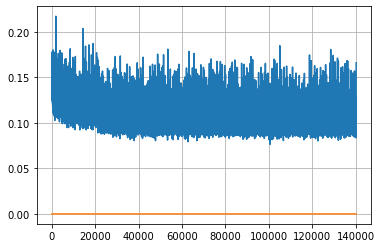

Epoch: 360, iteration 0, loss 0.10951396822929382, cov_diff 0.40644821814936655 cov_diff train 0.4060816528488993
Epoch: 360, iteration 1, loss 0.12136003375053406, cov_diff 0.4236432441455178 cov_diff train 0.4236765480910426
Epoch: 360, iteration 2, loss 0.11540666222572327, cov_diff 0.41104901993830784 cov_diff train 0.410196723701151
Epoch: 360, iteration 3, loss 0.1013936996459961, cov_diff 0.4021490863699199 cov_diff train 0.4027678775942348
Epoch: 360, iteration 4, loss 0.09914514422416687, cov_diff 0.4035269228846588 cov_diff train 0.40320320330769804
Epoch: 360, iteration 5, loss 0.10261616110801697, cov_diff 0.4069379907124765 cov_diff train 0.40637932834087737
Epoch: 360, iteration 6, loss 0.10466030240058899, cov_diff 0.4193680668842074 cov_diff train 0.4192293674039152
Epoch: 360, iteration 7, loss 0.11549210548400879, cov_diff 0.4140200650257246 cov_diff train 0.41384348515303004
Epoch: 360, iteration 8, loss 0.10106661915779114, cov_diff 0.41299836273620005 cov_diff trai

Epoch: 360, iteration 73, loss 0.10738998651504517, cov_diff 0.4069212606681361 cov_diff train 0.4057858866668679
Epoch: 360, iteration 74, loss 0.10562241077423096, cov_diff 0.4098956565028765 cov_diff train 0.4090761308829172
Epoch: 360, iteration 75, loss 0.10842308402061462, cov_diff 0.4192790293288329 cov_diff train 0.4191553557280554
Epoch: 360, iteration 76, loss 0.09341740608215332, cov_diff 0.41501086506522344 cov_diff train 0.41504499804531736
Epoch: 360, iteration 77, loss 0.09646573662757874, cov_diff 0.4148858777987573 cov_diff train 0.41365212118557027
Epoch: 360, iteration 78, loss 0.09525254368782043, cov_diff 0.41521978516582475 cov_diff train 0.41438280030122115
Epoch: 360, iteration 79, loss 0.0933201014995575, cov_diff 0.408379384973628 cov_diff train 0.4073088668097103
Epoch: 360, iteration 80, loss 0.10311633348464966, cov_diff 0.4205699898017295 cov_diff train 0.4198570112754159
Epoch: 360, iteration 81, loss 0.09657076001167297, cov_diff 0.41251231412491624 cov_

Epoch: 360, iteration 146, loss 0.09739416837692261, cov_diff 0.4082432869136356 cov_diff train 0.4074154654104192
Epoch: 360, iteration 147, loss 0.09593021869659424, cov_diff 0.4167785499838008 cov_diff train 0.4155628982232711
Epoch: 360, iteration 148, loss 0.1020357608795166, cov_diff 0.42207762648060876 cov_diff train 0.42056270035469684
Epoch: 360, iteration 149, loss 0.08695346117019653, cov_diff 0.3973620259353823 cov_diff train 0.3955637441211178
Epoch: 360, iteration 150, loss 0.09871217608451843, cov_diff 0.4025057560686591 cov_diff train 0.4021493762464928
Epoch: 360, iteration 151, loss 0.09964069724082947, cov_diff 0.4230429644629653 cov_diff train 0.420964758405278
Epoch: 360, iteration 152, loss 0.11871686577796936, cov_diff 0.4103038520473215 cov_diff train 0.40955527611014136
Epoch: 360, iteration 153, loss 0.10536116361618042, cov_diff 0.4126130338317139 cov_diff train 0.41112420811318584
Epoch: 360, iteration 154, loss 0.0955880880355835, cov_diff 0.401914536986940

Epoch: 360, iteration 223, loss 0.10466673970222473, cov_diff 0.4120882795642889 cov_diff train 0.4112786676741983
Epoch: 360, iteration 224, loss 0.10500630736351013, cov_diff 0.3968073008365194 cov_diff train 0.39622247373502845
Epoch: 360, iteration 225, loss 0.09873268008232117, cov_diff 0.41765268199548583 cov_diff train 0.4171163959389439
Epoch: 360, iteration 226, loss 0.10906347632408142, cov_diff 0.4031991906195323 cov_diff train 0.40305069861651727
Epoch: 360, iteration 227, loss 0.10217458009719849, cov_diff 0.41373617518321837 cov_diff train 0.4121687676703491
Epoch: 360, iteration 228, loss 0.1028890311717987, cov_diff 0.41649049169428026 cov_diff train 0.4168600858989394
Epoch: 360, iteration 229, loss 0.10602924227714539, cov_diff 0.4160598402874874 cov_diff train 0.41528443265583953
Epoch: 360, iteration 230, loss 0.10034498572349548, cov_diff 0.411636027096133 cov_diff train 0.4105761835210537
Epoch: 360, iteration 231, loss 0.09402674436569214, cov_diff 0.409909205904

Epoch: 360, iteration 300, loss 0.10300460457801819, cov_diff 0.39941034674879533 cov_diff train 0.3987543069252427
Epoch: 360, iteration 301, loss 0.1003561019897461, cov_diff 0.41412807739244334 cov_diff train 0.41344464638326
Epoch: 360, iteration 302, loss 0.09836223721504211, cov_diff 0.4100431627275202 cov_diff train 0.40853183944468896
Epoch: 360, iteration 303, loss 0.09443715214729309, cov_diff 0.4022025695808309 cov_diff train 0.402042187093041
Epoch: 360, iteration 304, loss 0.09172892570495605, cov_diff 0.4075734287972767 cov_diff train 0.40680962659518827
Epoch: 360, iteration 305, loss 0.10382267832756042, cov_diff 0.3958735217617886 cov_diff train 0.39431334905988347
Epoch: 360, iteration 306, loss 0.10875728726387024, cov_diff 0.40770789736641844 cov_diff train 0.40684819876611594
Epoch: 360, iteration 307, loss 0.10166513919830322, cov_diff 0.41256492113503906 cov_diff train 0.4123091322761337
Epoch: 360, iteration 308, loss 0.10681244730949402, cov_diff 0.417606110010

Epoch: 360, iteration 378, loss 0.10133722424507141, cov_diff 0.4116740527448434 cov_diff train 0.41104538509430577
Epoch: 360, iteration 379, loss 0.10321876406669617, cov_diff 0.40302162221501003 cov_diff train 0.4022856246477912
Epoch: 360, iteration 380, loss 0.10280367732048035, cov_diff 0.4366586764366527 cov_diff train 0.4358084966645438
Epoch: 360, iteration 381, loss 0.09914404153823853, cov_diff 0.4030664628454714 cov_diff train 0.40266047622488055
Epoch: 360, iteration 382, loss 0.10862061381340027, cov_diff 0.3939280811045147 cov_diff train 0.39302277278929143
Epoch: 360, iteration 383, loss 0.10046535730361938, cov_diff 0.4063070940343844 cov_diff train 0.4062491569624032
Epoch: 360, iteration 384, loss 0.08977320790290833, cov_diff 0.39375735034706705 cov_diff train 0.39346415742650837
Epoch: 360, iteration 385, loss 0.09615719318389893, cov_diff 0.41059609670157454 cov_diff train 0.41053518556850926
Epoch: 360, iteration 386, loss 0.10528814792633057, cov_diff 0.39382365

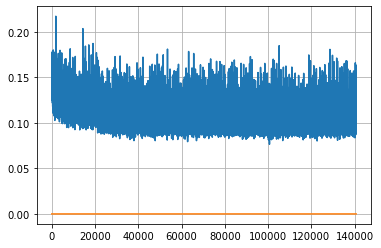

Epoch: 361, iteration 0, loss 0.10239255428314209, cov_diff 0.40407927922562636 cov_diff train 0.4029017472330496
Epoch: 361, iteration 1, loss 0.09721916913986206, cov_diff 0.3955053334894001 cov_diff train 0.3962174292257174
Epoch: 361, iteration 2, loss 0.11410045623779297, cov_diff 0.41029343327089357 cov_diff train 0.4110884364910522
Epoch: 361, iteration 3, loss 0.10686400532722473, cov_diff 0.4215357404843486 cov_diff train 0.42147796250483693
Epoch: 361, iteration 4, loss 0.1112811267375946, cov_diff 0.4088913672893498 cov_diff train 0.4079990869840508
Epoch: 361, iteration 5, loss 0.10327410697937012, cov_diff 0.40483193561674347 cov_diff train 0.4032202867673188
Epoch: 361, iteration 6, loss 0.10069137811660767, cov_diff 0.4047441517959727 cov_diff train 0.40360220488410825
Epoch: 361, iteration 7, loss 0.09841930866241455, cov_diff 0.40042220834895564 cov_diff train 0.4005328449718587
Epoch: 361, iteration 8, loss 0.11749604344367981, cov_diff 0.42236271110805385 cov_diff tr

Epoch: 361, iteration 77, loss 0.09399965405464172, cov_diff 0.40319304271297135 cov_diff train 0.4027353004700986
Epoch: 361, iteration 78, loss 0.09096100926399231, cov_diff 0.4180412146681695 cov_diff train 0.41717546050399823
Epoch: 361, iteration 79, loss 0.10174185037612915, cov_diff 0.42714417409882977 cov_diff train 0.4266004471688762
Epoch: 361, iteration 80, loss 0.09344211220741272, cov_diff 0.4182524266769538 cov_diff train 0.4182934813655471
Epoch: 361, iteration 81, loss 0.09843745827674866, cov_diff 0.41582811416078613 cov_diff train 0.41497596400274067
Epoch: 361, iteration 82, loss 0.10441553592681885, cov_diff 0.4048556260736327 cov_diff train 0.40448659175246954
Epoch: 361, iteration 83, loss 0.09311378002166748, cov_diff 0.412683147102626 cov_diff train 0.41144672610473215
Epoch: 361, iteration 84, loss 0.12202435731887817, cov_diff 0.4146003241564827 cov_diff train 0.41465596699786883
Epoch: 361, iteration 85, loss 0.10977250337600708, cov_diff 0.42115668047766147 

Epoch: 361, iteration 148, loss 0.11297759413719177, cov_diff 0.3992203503825857 cov_diff train 0.3992722303506886
Epoch: 361, iteration 149, loss 0.08970355987548828, cov_diff 0.4173500836726694 cov_diff train 0.41696797158099963
Epoch: 361, iteration 150, loss 0.09516960382461548, cov_diff 0.4154524654035532 cov_diff train 0.41475224688231677
Epoch: 361, iteration 151, loss 0.1096147894859314, cov_diff 0.4026641465456659 cov_diff train 0.4027399834885601
Epoch: 361, iteration 152, loss 0.104280024766922, cov_diff 0.41238899032597776 cov_diff train 0.4103379668672679
Epoch: 361, iteration 153, loss 0.09132957458496094, cov_diff 0.3981514707046906 cov_diff train 0.39807554826567004
Epoch: 361, iteration 154, loss 0.11587521433830261, cov_diff 0.4061902746344909 cov_diff train 0.40519959657650445
Epoch: 361, iteration 155, loss 0.10207310318946838, cov_diff 0.4081211003576967 cov_diff train 0.4078668310583189
Epoch: 361, iteration 156, loss 0.10452631115913391, cov_diff 0.39020825259152

Epoch: 361, iteration 220, loss 0.1124604344367981, cov_diff 0.40749474333381447 cov_diff train 0.4072418622218593
Epoch: 361, iteration 221, loss 0.10327807068824768, cov_diff 0.4147265292831158 cov_diff train 0.41534228259176376
Epoch: 361, iteration 222, loss 0.10724833607673645, cov_diff 0.41671141664442923 cov_diff train 0.41652806629737643
Epoch: 361, iteration 223, loss 0.09800714254379272, cov_diff 0.40484264681539 cov_diff train 0.40371919961802344
Epoch: 361, iteration 224, loss 0.10415244102478027, cov_diff 0.414803669580634 cov_diff train 0.4151147054009378
Epoch: 361, iteration 225, loss 0.11784696578979492, cov_diff 0.4139360112490676 cov_diff train 0.4142037094130759
Epoch: 361, iteration 226, loss 0.1091819703578949, cov_diff 0.4005363411392042 cov_diff train 0.40016992008069485
Epoch: 361, iteration 227, loss 0.11042815446853638, cov_diff 0.41485430786813726 cov_diff train 0.41477555277142536
Epoch: 361, iteration 228, loss 0.11175405979156494, cov_diff 0.4142153412499

Epoch: 361, iteration 293, loss 0.11408600211143494, cov_diff 0.396766696343547 cov_diff train 0.39580061901530683
Epoch: 361, iteration 294, loss 0.1019262969493866, cov_diff 0.407929808579337 cov_diff train 0.40865762069036526
Epoch: 361, iteration 295, loss 0.1022125780582428, cov_diff 0.4081317675137085 cov_diff train 0.4081778060795682
Epoch: 361, iteration 296, loss 0.11316859722137451, cov_diff 0.4112066750665913 cov_diff train 0.41012452646298747
Epoch: 361, iteration 297, loss 0.10139527916908264, cov_diff 0.3972340158995579 cov_diff train 0.3976775653895694
Epoch: 361, iteration 298, loss 0.10233944654464722, cov_diff 0.41792725708071815 cov_diff train 0.4167063950886181
Epoch: 361, iteration 299, loss 0.10113787651062012, cov_diff 0.4102611701025228 cov_diff train 0.40828998003814476
Epoch: 361, iteration 300, loss 0.10348257422447205, cov_diff 0.4191213997466346 cov_diff train 0.4186798506448203
Epoch: 361, iteration 301, loss 0.11464768648147583, cov_diff 0.407794890329248

Epoch: 361, iteration 370, loss 0.10555759072303772, cov_diff 0.4154297072116994 cov_diff train 0.41483452663858134
Epoch: 361, iteration 371, loss 0.10068255662918091, cov_diff 0.4138325754759665 cov_diff train 0.41305656879183206
Epoch: 361, iteration 372, loss 0.11062002182006836, cov_diff 0.4095672468113607 cov_diff train 0.40953494518319544
Epoch: 361, iteration 373, loss 0.10429111123085022, cov_diff 0.4012627050156887 cov_diff train 0.4011800556941677
Epoch: 361, iteration 374, loss 0.1157623827457428, cov_diff 0.4110904710951264 cov_diff train 0.41056206569086284
Epoch: 361, iteration 375, loss 0.09935688972473145, cov_diff 0.4215021045207778 cov_diff train 0.42004670048364284
Epoch: 361, iteration 376, loss 0.09638866782188416, cov_diff 0.4095028259985472 cov_diff train 0.4088272736885732
Epoch: 361, iteration 377, loss 0.09719735383987427, cov_diff 0.4022657969428909 cov_diff train 0.4017430942207674
Epoch: 361, iteration 378, loss 0.10718917846679688, cov_diff 0.412250981490

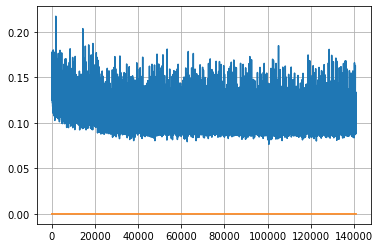

Epoch: 362, iteration 0, loss 0.0927000641822815, cov_diff 0.41854962240643007 cov_diff train 0.4181496479137009
Epoch: 362, iteration 1, loss 0.10803133249282837, cov_diff 0.40513308542383986 cov_diff train 0.4044144824602282
Epoch: 362, iteration 2, loss 0.10023507475852966, cov_diff 0.4057660105890818 cov_diff train 0.40509421210617386
Epoch: 362, iteration 3, loss 0.1029420793056488, cov_diff 0.4016067587189618 cov_diff train 0.4006267704104124
Epoch: 362, iteration 4, loss 0.10805341601371765, cov_diff 0.39522398790882296 cov_diff train 0.39408592703925904
Epoch: 362, iteration 5, loss 0.09595701098442078, cov_diff 0.41603274827355324 cov_diff train 0.41565259059954907
Epoch: 362, iteration 6, loss 0.09060180187225342, cov_diff 0.41604349543265157 cov_diff train 0.41482912162990254
Epoch: 362, iteration 7, loss 0.09416919946670532, cov_diff 0.41530728736979033 cov_diff train 0.4146315050917783
Epoch: 362, iteration 8, loss 0.09822335839271545, cov_diff 0.40193094398590196 cov_diff

Epoch: 362, iteration 76, loss 0.11463397741317749, cov_diff 0.41545638497242915 cov_diff train 0.41478500535356744
Epoch: 362, iteration 77, loss 0.1075391173362732, cov_diff 0.4237858442511156 cov_diff train 0.4226824304696973
Epoch: 362, iteration 78, loss 0.10128960013389587, cov_diff 0.41266779456397035 cov_diff train 0.4120418494339347
Epoch: 362, iteration 79, loss 0.1089470386505127, cov_diff 0.4220456660310663 cov_diff train 0.4208028268555539
Epoch: 362, iteration 80, loss 0.10026448965072632, cov_diff 0.40349187458435665 cov_diff train 0.4024466627200158
Epoch: 362, iteration 81, loss 0.09278327226638794, cov_diff 0.40808203175468866 cov_diff train 0.4071376981722605
Epoch: 362, iteration 82, loss 0.09534940123558044, cov_diff 0.40760540070184864 cov_diff train 0.40608822510463793
Epoch: 362, iteration 83, loss 0.1002090573310852, cov_diff 0.4224796285359411 cov_diff train 0.42129623912606673
Epoch: 362, iteration 84, loss 0.11328178644180298, cov_diff 0.4084496227903987 cov

Epoch: 362, iteration 155, loss 0.09533444046974182, cov_diff 0.420728215596661 cov_diff train 0.41983424613939313
Epoch: 362, iteration 156, loss 0.10045298933982849, cov_diff 0.4036672078741731 cov_diff train 0.40279033385720553
Epoch: 362, iteration 157, loss 0.09971058368682861, cov_diff 0.40124511630620957 cov_diff train 0.40132676969388564
Epoch: 362, iteration 158, loss 0.10479491949081421, cov_diff 0.4093611155879135 cov_diff train 0.40817701964787534
Epoch: 362, iteration 159, loss 0.09683483839035034, cov_diff 0.410165183594717 cov_diff train 0.40909607070192644
Epoch: 362, iteration 160, loss 0.10471904277801514, cov_diff 0.4144768885940983 cov_diff train 0.4128952781872688
Epoch: 362, iteration 161, loss 0.11058902740478516, cov_diff 0.4160207606198615 cov_diff train 0.41467909417824017
Epoch: 362, iteration 162, loss 0.09114894270896912, cov_diff 0.41799624696537224 cov_diff train 0.41772567737997535
Epoch: 362, iteration 163, loss 0.10262927412986755, cov_diff 0.417264810

Epoch: 362, iteration 233, loss 0.10835912823677063, cov_diff 0.4198837467517706 cov_diff train 0.41935797378063044
Epoch: 362, iteration 234, loss 0.1001056432723999, cov_diff 0.42067592505413137 cov_diff train 0.4204544762610701
Epoch: 362, iteration 235, loss 0.10193204879760742, cov_diff 0.4217103367240785 cov_diff train 0.42076862702527856
Epoch: 362, iteration 236, loss 0.1022423505783081, cov_diff 0.416758813256871 cov_diff train 0.4151675904961982
Epoch: 362, iteration 237, loss 0.10871052742004395, cov_diff 0.4098283406373421 cov_diff train 0.4093479960565767
Epoch: 362, iteration 238, loss 0.09523206949234009, cov_diff 0.4121245220995743 cov_diff train 0.41220829116955754
Epoch: 362, iteration 239, loss 0.10045599937438965, cov_diff 0.41528853340283484 cov_diff train 0.4144446203120115
Epoch: 362, iteration 240, loss 0.0963398814201355, cov_diff 0.4059469042939996 cov_diff train 0.4056621706897428
Epoch: 362, iteration 241, loss 0.09506407380104065, cov_diff 0.415125905390508

Epoch: 362, iteration 314, loss 0.0968792736530304, cov_diff 0.40695499697157705 cov_diff train 0.405946119503738
Epoch: 362, iteration 315, loss 0.10871574282646179, cov_diff 0.42103541982392245 cov_diff train 0.4200948672460749
Epoch: 362, iteration 316, loss 0.10961973667144775, cov_diff 0.3997599636924878 cov_diff train 0.3987178411850001
Epoch: 362, iteration 317, loss 0.09958916902542114, cov_diff 0.4051082884017925 cov_diff train 0.40442953308465024
Epoch: 362, iteration 318, loss 0.10016864538192749, cov_diff 0.4159720188966961 cov_diff train 0.4152004058113681
Epoch: 362, iteration 319, loss 0.10820063948631287, cov_diff 0.40548637422997313 cov_diff train 0.4052236814274673
Epoch: 362, iteration 320, loss 0.0937698483467102, cov_diff 0.40797007624872755 cov_diff train 0.4073293244572341
Epoch: 362, iteration 321, loss 0.10186856985092163, cov_diff 0.4314033523704735 cov_diff train 0.4302595359038811
Epoch: 362, iteration 322, loss 0.10356011986732483, cov_diff 0.41450922395665

Epoch: 362, iteration 387, loss 0.1055167019367218, cov_diff 0.4055422365584955 cov_diff train 0.4035619206060575
Epoch: 362, iteration 388, loss 0.09411230683326721, cov_diff 0.42595142609794767 cov_diff train 0.42492780966620275
Epoch: 362, iteration 389, loss 0.09142884612083435, cov_diff 0.41530547955422287 cov_diff train 0.41512700244963396
Epoch: 362, iteration 390, loss 0.14684373140335083, cov_diff 0.4399992325793755 cov_diff train 0.4396444769292537


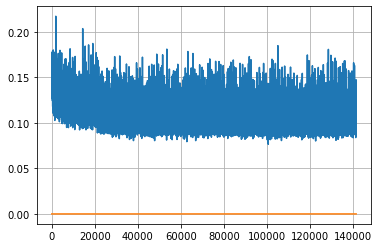

Epoch: 363, iteration 0, loss 0.10085371136665344, cov_diff 0.4182851928025293 cov_diff train 0.41747127925335265
Epoch: 363, iteration 1, loss 0.10137861967086792, cov_diff 0.4179413693853704 cov_diff train 0.41586199846739474
Epoch: 363, iteration 2, loss 0.11233964562416077, cov_diff 0.4083529089744197 cov_diff train 0.40670908963635166
Epoch: 363, iteration 3, loss 0.09993889927864075, cov_diff 0.41839278218214 cov_diff train 0.4184519217136846
Epoch: 363, iteration 4, loss 0.09293842315673828, cov_diff 0.4051086210996084 cov_diff train 0.40469018597019724
Epoch: 363, iteration 5, loss 0.11156687140464783, cov_diff 0.40583945193259313 cov_diff train 0.40512094279999555
Epoch: 363, iteration 6, loss 0.09587618708610535, cov_diff 0.4198619622094171 cov_diff train 0.4190443545995641
Epoch: 363, iteration 7, loss 0.11565357446670532, cov_diff 0.42154336351979493 cov_diff train 0.4212285252082162
Epoch: 363, iteration 8, loss 0.11254987120628357, cov_diff 0.4003939142059809 cov_diff tra

Epoch: 363, iteration 76, loss 0.10086831450462341, cov_diff 0.4084738153803015 cov_diff train 0.4077436849043558
Epoch: 363, iteration 77, loss 0.10307472944259644, cov_diff 0.40018076517471357 cov_diff train 0.39982046104393865
Epoch: 363, iteration 78, loss 0.0958261489868164, cov_diff 0.42219301976634627 cov_diff train 0.4210759834724185
Epoch: 363, iteration 79, loss 0.10636085271835327, cov_diff 0.4087616508988957 cov_diff train 0.40884237573868154
Epoch: 363, iteration 80, loss 0.09912824630737305, cov_diff 0.40890486346366295 cov_diff train 0.4091545311954345
Epoch: 363, iteration 81, loss 0.11032998561859131, cov_diff 0.4121058361864791 cov_diff train 0.41044640509394026
Epoch: 363, iteration 82, loss 0.10041487216949463, cov_diff 0.4075664040163272 cov_diff train 0.406978575810417
Epoch: 363, iteration 83, loss 0.09587031602859497, cov_diff 0.4207080952803368 cov_diff train 0.42045026901449634
Epoch: 363, iteration 84, loss 0.10798826813697815, cov_diff 0.4228961546414602 cov

Epoch: 363, iteration 156, loss 0.09702509641647339, cov_diff 0.4083641904604854 cov_diff train 0.40882918600894946
Epoch: 363, iteration 157, loss 0.10799625515937805, cov_diff 0.41674685918494464 cov_diff train 0.41675537828674986
Epoch: 363, iteration 158, loss 0.10355743765830994, cov_diff 0.4068978842750104 cov_diff train 0.4062646274217526
Epoch: 363, iteration 159, loss 0.10434576869010925, cov_diff 0.41958573038557995 cov_diff train 0.41957104974711734
Epoch: 363, iteration 160, loss 0.0964311957359314, cov_diff 0.41846644491973806 cov_diff train 0.4190029823120382
Epoch: 363, iteration 161, loss 0.10548707842826843, cov_diff 0.40335147230243784 cov_diff train 0.4026077552982934
Epoch: 363, iteration 162, loss 0.09714415669441223, cov_diff 0.41780321555589667 cov_diff train 0.4168899440206088
Epoch: 363, iteration 163, loss 0.10792601108551025, cov_diff 0.4100719597812269 cov_diff train 0.4087827731169065
Epoch: 363, iteration 164, loss 0.11014661192893982, cov_diff 0.402293507

Epoch: 363, iteration 231, loss 0.11080005764961243, cov_diff 0.4117496855212168 cov_diff train 0.41047127718093135
Epoch: 363, iteration 232, loss 0.09584015607833862, cov_diff 0.41515309236671066 cov_diff train 0.4148172945781913
Epoch: 363, iteration 233, loss 0.10772600769996643, cov_diff 0.41683971345980114 cov_diff train 0.41566366746786393
Epoch: 363, iteration 234, loss 0.09896141290664673, cov_diff 0.40690440681410894 cov_diff train 0.406500791779978
Epoch: 363, iteration 235, loss 0.11592823266983032, cov_diff 0.41086716882720803 cov_diff train 0.41128809590119875
Epoch: 363, iteration 236, loss 0.09491071105003357, cov_diff 0.41861476888515814 cov_diff train 0.4178428051101611
Epoch: 363, iteration 237, loss 0.09641098976135254, cov_diff 0.41667039398112504 cov_diff train 0.416119826624833
Epoch: 363, iteration 238, loss 0.09716823697090149, cov_diff 0.4141315897713721 cov_diff train 0.41387296571712723
Epoch: 363, iteration 239, loss 0.09855946898460388, cov_diff 0.41180309

Epoch: 363, iteration 307, loss 0.10422185063362122, cov_diff 0.40766702274418415 cov_diff train 0.40768461699595027
Epoch: 363, iteration 308, loss 0.10728582739830017, cov_diff 0.4155439114508342 cov_diff train 0.4155804242805004
Epoch: 363, iteration 309, loss 0.1002950370311737, cov_diff 0.4228106223011124 cov_diff train 0.4222659968847989
Epoch: 363, iteration 310, loss 0.09577867388725281, cov_diff 0.4097338061337381 cov_diff train 0.40856195913325893
Epoch: 363, iteration 311, loss 0.10485270619392395, cov_diff 0.41999417726173643 cov_diff train 0.418997420750023
Epoch: 363, iteration 312, loss 0.10589328408241272, cov_diff 0.4215475258057216 cov_diff train 0.4211431463331328
Epoch: 363, iteration 313, loss 0.09472092986106873, cov_diff 0.4034211131186732 cov_diff train 0.40251759138124277
Epoch: 363, iteration 314, loss 0.10190662741661072, cov_diff 0.4210354090694568 cov_diff train 0.4211287246252414
Epoch: 363, iteration 315, loss 0.0957205593585968, cov_diff 0.40387912884168

Epoch: 363, iteration 383, loss 0.09617242217063904, cov_diff 0.41875804941116307 cov_diff train 0.417628944178631
Epoch: 363, iteration 384, loss 0.10572567582130432, cov_diff 0.41170876296714554 cov_diff train 0.4112346214354069
Epoch: 363, iteration 385, loss 0.10315090417861938, cov_diff 0.4094983404303072 cov_diff train 0.4077691727231624
Epoch: 363, iteration 386, loss 0.11243337392807007, cov_diff 0.40918614205612364 cov_diff train 0.40890856227107514
Epoch: 363, iteration 387, loss 0.09804978966712952, cov_diff 0.43128671503271404 cov_diff train 0.43095600299470854
Epoch: 363, iteration 388, loss 0.0928134024143219, cov_diff 0.41879749712291575 cov_diff train 0.41867041370949293
Epoch: 363, iteration 389, loss 0.09829431772232056, cov_diff 0.40660799882640963 cov_diff train 0.4070355876930643
Epoch: 363, iteration 390, loss 0.15681931376457214, cov_diff 0.44936652104150376 cov_diff train 0.4479113468390782


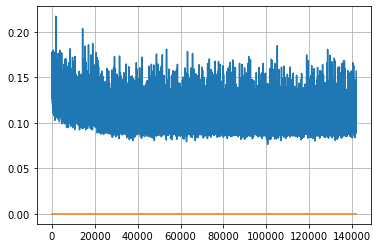

Epoch: 364, iteration 0, loss 0.09865343570709229, cov_diff 0.40655375972098484 cov_diff train 0.40605951667432527
Epoch: 364, iteration 1, loss 0.10389721393585205, cov_diff 0.42855248516762773 cov_diff train 0.4277918246050734
Epoch: 364, iteration 2, loss 0.10294726490974426, cov_diff 0.4265434082601806 cov_diff train 0.4261347533985078
Epoch: 364, iteration 3, loss 0.10802498459815979, cov_diff 0.4052154982712549 cov_diff train 0.4050787904311688
Epoch: 364, iteration 4, loss 0.09753966331481934, cov_diff 0.4190768073008039 cov_diff train 0.41924042246595306
Epoch: 364, iteration 5, loss 0.09839373826980591, cov_diff 0.4197682127479541 cov_diff train 0.4195525416099133
Epoch: 364, iteration 6, loss 0.09854644536972046, cov_diff 0.41228439590772986 cov_diff train 0.4119123519815398
Epoch: 364, iteration 7, loss 0.10679870843887329, cov_diff 0.4264828812970741 cov_diff train 0.42578793383349417
Epoch: 364, iteration 8, loss 0.10286054015159607, cov_diff 0.4199176379281099 cov_diff tr

Epoch: 364, iteration 73, loss 0.09368142485618591, cov_diff 0.4199388552343659 cov_diff train 0.419361395459711
Epoch: 364, iteration 74, loss 0.09509611129760742, cov_diff 0.42174793142674694 cov_diff train 0.42110351867668994
Epoch: 364, iteration 75, loss 0.10425406694412231, cov_diff 0.4165670286629107 cov_diff train 0.4152494608490234
Epoch: 364, iteration 76, loss 0.10867723822593689, cov_diff 0.4076164528519498 cov_diff train 0.40716248923618553
Epoch: 364, iteration 77, loss 0.09426236152648926, cov_diff 0.40379345051528265 cov_diff train 0.40202185012980796
Epoch: 364, iteration 78, loss 0.11668559908866882, cov_diff 0.4134467195804213 cov_diff train 0.4114491752136141
Epoch: 364, iteration 79, loss 0.10521644353866577, cov_diff 0.4056887750723384 cov_diff train 0.4043970980203747
Epoch: 364, iteration 80, loss 0.10763296484947205, cov_diff 0.4103431459743662 cov_diff train 0.40972501276449796
Epoch: 364, iteration 81, loss 0.10553714632987976, cov_diff 0.4092153585174808 cov

Epoch: 364, iteration 154, loss 0.1036081612110138, cov_diff 0.4080056111958874 cov_diff train 0.40807909199816594
Epoch: 364, iteration 155, loss 0.09212484955787659, cov_diff 0.41089336501265206 cov_diff train 0.4112342940512359
Epoch: 364, iteration 156, loss 0.11229866743087769, cov_diff 0.42296803013430034 cov_diff train 0.42193547531494396
Epoch: 364, iteration 157, loss 0.11341315507888794, cov_diff 0.4126130795441675 cov_diff train 0.4129226907118799
Epoch: 364, iteration 158, loss 0.10329598188400269, cov_diff 0.394434252115635 cov_diff train 0.3949633948950348
Epoch: 364, iteration 159, loss 0.11395838856697083, cov_diff 0.4075804069157749 cov_diff train 0.4065418099925104
Epoch: 364, iteration 160, loss 0.0975993275642395, cov_diff 0.4096108006313377 cov_diff train 0.40914963503842533
Epoch: 364, iteration 161, loss 0.09786832332611084, cov_diff 0.4054446054616886 cov_diff train 0.40601232550450433
Epoch: 364, iteration 162, loss 0.0964343249797821, cov_diff 0.41080901731064

Epoch: 364, iteration 227, loss 0.0953981876373291, cov_diff 0.419745794538928 cov_diff train 0.41781896573240146
Epoch: 364, iteration 228, loss 0.10141974687576294, cov_diff 0.41042129656132714 cov_diff train 0.41003315871200313
Epoch: 364, iteration 229, loss 0.10802042484283447, cov_diff 0.40554147820126096 cov_diff train 0.4051723566622666
Epoch: 364, iteration 230, loss 0.10353425145149231, cov_diff 0.3994900045097996 cov_diff train 0.3993772218322344
Epoch: 364, iteration 231, loss 0.09755927324295044, cov_diff 0.4126542857410523 cov_diff train 0.4125012879989679
Epoch: 364, iteration 232, loss 0.10056805610656738, cov_diff 0.4043603590502901 cov_diff train 0.4039180030695025
Epoch: 364, iteration 233, loss 0.11572256684303284, cov_diff 0.40979684087277846 cov_diff train 0.4086126723538125
Epoch: 364, iteration 234, loss 0.10588181018829346, cov_diff 0.4200381125322673 cov_diff train 0.4189906459130647
Epoch: 364, iteration 235, loss 0.10410717129707336, cov_diff 0.4015989977446

Epoch: 364, iteration 301, loss 0.09728023409843445, cov_diff 0.398610827590694 cov_diff train 0.39743959024299413
Epoch: 364, iteration 302, loss 0.100242018699646, cov_diff 0.4075589539898136 cov_diff train 0.40692142495985684
Epoch: 364, iteration 303, loss 0.10363608598709106, cov_diff 0.41558074022751146 cov_diff train 0.41560172106176313
Epoch: 364, iteration 304, loss 0.11033779382705688, cov_diff 0.4107396842810347 cov_diff train 0.41043848702881186
Epoch: 364, iteration 305, loss 0.1074686050415039, cov_diff 0.4112826491549192 cov_diff train 0.4113867853314113
Epoch: 364, iteration 306, loss 0.09357520937919617, cov_diff 0.40623031208179733 cov_diff train 0.40616024087343805
Epoch: 364, iteration 307, loss 0.09955471754074097, cov_diff 0.40214474987090093 cov_diff train 0.4026890001399164
Epoch: 364, iteration 308, loss 0.10457935929298401, cov_diff 0.4091331109163478 cov_diff train 0.40948052580119343
Epoch: 364, iteration 309, loss 0.10098162293434143, cov_diff 0.41979145181

Epoch: 364, iteration 378, loss 0.11496421694755554, cov_diff 0.42708557034804595 cov_diff train 0.4269334572828433
Epoch: 364, iteration 379, loss 0.09721139073371887, cov_diff 0.40490055843720574 cov_diff train 0.4051433600750511
Epoch: 364, iteration 380, loss 0.11020103096961975, cov_diff 0.42518534657996016 cov_diff train 0.42440842270568346
Epoch: 364, iteration 381, loss 0.10426130890846252, cov_diff 0.42877386317074334 cov_diff train 0.4281584598058119
Epoch: 364, iteration 382, loss 0.11099258065223694, cov_diff 0.4096596901784857 cov_diff train 0.4091260550731724
Epoch: 364, iteration 383, loss 0.09294748306274414, cov_diff 0.41531559034985405 cov_diff train 0.4144674729452779
Epoch: 364, iteration 384, loss 0.09109500050544739, cov_diff 0.4203708535274922 cov_diff train 0.4203023762193947
Epoch: 364, iteration 385, loss 0.10577073693275452, cov_diff 0.4041855989999681 cov_diff train 0.40327034698120284
Epoch: 364, iteration 386, loss 0.10746690630912781, cov_diff 0.403107816

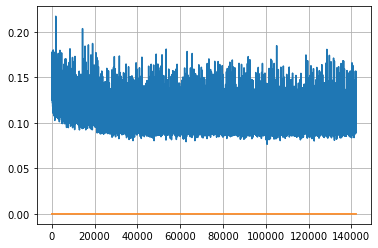

Epoch: 365, iteration 0, loss 0.10068827867507935, cov_diff 0.4130230948687296 cov_diff train 0.41191195071677206
Epoch: 365, iteration 1, loss 0.0999268889427185, cov_diff 0.4152567921380518 cov_diff train 0.41400053842616696
Epoch: 365, iteration 2, loss 0.1071847677230835, cov_diff 0.3979359266772035 cov_diff train 0.39678240186420877
Epoch: 365, iteration 3, loss 0.11021703481674194, cov_diff 0.4165283180588232 cov_diff train 0.4156343416754481
Epoch: 365, iteration 4, loss 0.09815889596939087, cov_diff 0.39943389021463116 cov_diff train 0.39819005236804556
Epoch: 365, iteration 5, loss 0.11521577835083008, cov_diff 0.40100282409537497 cov_diff train 0.40119010560883095
Epoch: 365, iteration 6, loss 0.09566262364387512, cov_diff 0.4093030443160831 cov_diff train 0.40924060787436667
Epoch: 365, iteration 7, loss 0.10926589369773865, cov_diff 0.4012363562643676 cov_diff train 0.40152259071328444
Epoch: 365, iteration 8, loss 0.10880035161972046, cov_diff 0.40791834584164505 cov_diff 

Epoch: 365, iteration 76, loss 0.10733383893966675, cov_diff 0.4104327143948012 cov_diff train 0.41087347611656
Epoch: 365, iteration 77, loss 0.10189247131347656, cov_diff 0.41200330468118307 cov_diff train 0.4108204077743303
Epoch: 365, iteration 78, loss 0.09907355904579163, cov_diff 0.4297012960124687 cov_diff train 0.42896771754871477
Epoch: 365, iteration 79, loss 0.1076192855834961, cov_diff 0.41512398841129333 cov_diff train 0.4125880987186997
Epoch: 365, iteration 80, loss 0.09801512956619263, cov_diff 0.41420283580071354 cov_diff train 0.4137191219920202
Epoch: 365, iteration 81, loss 0.09836384654045105, cov_diff 0.4074180692881266 cov_diff train 0.4066662828550382
Epoch: 365, iteration 82, loss 0.10070663690567017, cov_diff 0.41061671098861 cov_diff train 0.410224660928145
Epoch: 365, iteration 83, loss 0.10082978010177612, cov_diff 0.4100094161026756 cov_diff train 0.4095982237608324
Epoch: 365, iteration 84, loss 0.10000801086425781, cov_diff 0.41164857010695255 cov_diff 

Epoch: 365, iteration 152, loss 0.10182574391365051, cov_diff 0.41141964549152593 cov_diff train 0.41030873327544837
Epoch: 365, iteration 153, loss 0.10922202467918396, cov_diff 0.4098064535858436 cov_diff train 0.4091106926373577
Epoch: 365, iteration 154, loss 0.11570104956626892, cov_diff 0.4121427712140968 cov_diff train 0.4116289464852491
Epoch: 365, iteration 155, loss 0.09756648540496826, cov_diff 0.40427981637821975 cov_diff train 0.40383723410805167
Epoch: 365, iteration 156, loss 0.09173443913459778, cov_diff 0.4146534042624394 cov_diff train 0.41385056547553095
Epoch: 365, iteration 157, loss 0.1123960018157959, cov_diff 0.41398948110825173 cov_diff train 0.4127879111262545
Epoch: 365, iteration 158, loss 0.10938990116119385, cov_diff 0.4159439548628646 cov_diff train 0.41613259020028315
Epoch: 365, iteration 159, loss 0.09551820158958435, cov_diff 0.41537038729154874 cov_diff train 0.41466508910771344
Epoch: 365, iteration 160, loss 0.1064034104347229, cov_diff 0.405222100

Epoch: 365, iteration 228, loss 0.10992631316184998, cov_diff 0.3979817176360277 cov_diff train 0.39685335153064727
Epoch: 365, iteration 229, loss 0.1067165732383728, cov_diff 0.40354709982588177 cov_diff train 0.4030645437577107
Epoch: 365, iteration 230, loss 0.10287430882453918, cov_diff 0.4059727216816377 cov_diff train 0.4059648921536316
Epoch: 365, iteration 231, loss 0.10146021842956543, cov_diff 0.3952737137672661 cov_diff train 0.39526810074839
Epoch: 365, iteration 232, loss 0.11368122696876526, cov_diff 0.4072428767874835 cov_diff train 0.40692733589983887
Epoch: 365, iteration 233, loss 0.11520758271217346, cov_diff 0.40290054412550036 cov_diff train 0.40149333841862284
Epoch: 365, iteration 234, loss 0.10919925570487976, cov_diff 0.4229707127314583 cov_diff train 0.42284762405208925
Epoch: 365, iteration 235, loss 0.11630776524543762, cov_diff 0.41325573281187084 cov_diff train 0.4131374962833373
Epoch: 365, iteration 236, loss 0.0961713194847107, cov_diff 0.4158100743981

Epoch: 365, iteration 303, loss 0.1126861572265625, cov_diff 0.4176817454145477 cov_diff train 0.4174090473540682
Epoch: 365, iteration 304, loss 0.09538629651069641, cov_diff 0.4074058625016347 cov_diff train 0.40704155041578655
Epoch: 365, iteration 305, loss 0.10375052690505981, cov_diff 0.41525152018792444 cov_diff train 0.41476115083990495
Epoch: 365, iteration 306, loss 0.09953814744949341, cov_diff 0.4127622356120611 cov_diff train 0.4133441762933586
Epoch: 365, iteration 307, loss 0.09115725755691528, cov_diff 0.40597243712913694 cov_diff train 0.40550945302961033
Epoch: 365, iteration 308, loss 0.1070108413696289, cov_diff 0.40966852874031745 cov_diff train 0.40919796664367464
Epoch: 365, iteration 309, loss 0.11026576161384583, cov_diff 0.40828199448229213 cov_diff train 0.407924146550213
Epoch: 365, iteration 310, loss 0.10390651226043701, cov_diff 0.40604519561020874 cov_diff train 0.4052560951501886
Epoch: 365, iteration 311, loss 0.09842082858085632, cov_diff 0.4131548265

Epoch: 365, iteration 379, loss 0.10137757658958435, cov_diff 0.42840084797648903 cov_diff train 0.42855064663225295
Epoch: 365, iteration 380, loss 0.10580882430076599, cov_diff 0.415592283927946 cov_diff train 0.4147109320036624
Epoch: 365, iteration 381, loss 0.10408622026443481, cov_diff 0.40481148393405086 cov_diff train 0.4044228569047681
Epoch: 365, iteration 382, loss 0.10908126831054688, cov_diff 0.4132637265144544 cov_diff train 0.4121184355022421
Epoch: 365, iteration 383, loss 0.11633121967315674, cov_diff 0.4248979741973505 cov_diff train 0.424262695861407
Epoch: 365, iteration 384, loss 0.09896564483642578, cov_diff 0.4115060877018273 cov_diff train 0.4108300375832878
Epoch: 365, iteration 385, loss 0.09183689951896667, cov_diff 0.41504354555905754 cov_diff train 0.4137953275229947
Epoch: 365, iteration 386, loss 0.11365973949432373, cov_diff 0.4025556967019254 cov_diff train 0.40120527243333076
Epoch: 365, iteration 387, loss 0.09841606020927429, cov_diff 0.4078042682420

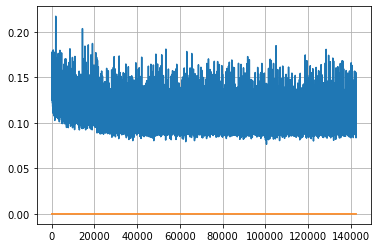

Epoch: 366, iteration 0, loss 0.09602090716362, cov_diff 0.40729555812799195 cov_diff train 0.4068982913027468
Epoch: 366, iteration 1, loss 0.1099192202091217, cov_diff 0.40620644836145026 cov_diff train 0.4065818877518605
Epoch: 366, iteration 2, loss 0.11414030194282532, cov_diff 0.4249441371025457 cov_diff train 0.4245867262921411
Epoch: 366, iteration 3, loss 0.11140918731689453, cov_diff 0.4169825898449111 cov_diff train 0.41679224185329256
Epoch: 366, iteration 4, loss 0.09656891226768494, cov_diff 0.42392874251973267 cov_diff train 0.42318627498235506
Epoch: 366, iteration 5, loss 0.09339934587478638, cov_diff 0.41837828876274197 cov_diff train 0.41824762625687084
Epoch: 366, iteration 6, loss 0.10914993286132812, cov_diff 0.4028102406020839 cov_diff train 0.4026429861046917
Epoch: 366, iteration 7, loss 0.09826257824897766, cov_diff 0.4152683126610973 cov_diff train 0.41440118709257556
Epoch: 366, iteration 8, loss 0.10709148645401001, cov_diff 0.4029629966443595 cov_diff trai

Epoch: 366, iteration 77, loss 0.0985640287399292, cov_diff 0.4148023826176385 cov_diff train 0.41382484245445245
Epoch: 366, iteration 78, loss 0.11209473013877869, cov_diff 0.4120283301847458 cov_diff train 0.41109757336155495
Epoch: 366, iteration 79, loss 0.10132232308387756, cov_diff 0.4174465647851644 cov_diff train 0.4156843735369817
Epoch: 366, iteration 80, loss 0.10169187188148499, cov_diff 0.41968695851385684 cov_diff train 0.4188502087216324
Epoch: 366, iteration 81, loss 0.09197834134101868, cov_diff 0.42015684642949674 cov_diff train 0.41886545931725633
Epoch: 366, iteration 82, loss 0.10475051403045654, cov_diff 0.4193399955064634 cov_diff train 0.41872034180823786
Epoch: 366, iteration 83, loss 0.10382324457168579, cov_diff 0.4172168100746818 cov_diff train 0.4171435351399071
Epoch: 366, iteration 84, loss 0.11322751641273499, cov_diff 0.4123330684784912 cov_diff train 0.41136372029971224
Epoch: 366, iteration 85, loss 0.10523286461830139, cov_diff 0.41015265504845144 c

Epoch: 366, iteration 154, loss 0.09632086753845215, cov_diff 0.41326249120916175 cov_diff train 0.412543728791571
Epoch: 366, iteration 155, loss 0.1046593189239502, cov_diff 0.40785027540939706 cov_diff train 0.4061909831186468
Epoch: 366, iteration 156, loss 0.0991814136505127, cov_diff 0.4126005410130193 cov_diff train 0.4118351937643446
Epoch: 366, iteration 157, loss 0.09810912609100342, cov_diff 0.41307879948280185 cov_diff train 0.4124491603071747
Epoch: 366, iteration 158, loss 0.10392481088638306, cov_diff 0.41554060191286424 cov_diff train 0.414095089229167
Epoch: 366, iteration 159, loss 0.10868790745735168, cov_diff 0.41524035779609025 cov_diff train 0.41497396035144596
Epoch: 366, iteration 160, loss 0.09088197350502014, cov_diff 0.4062551070332085 cov_diff train 0.40554638338164756
Epoch: 366, iteration 161, loss 0.1032533347606659, cov_diff 0.4097252431437423 cov_diff train 0.4089418174240326
Epoch: 366, iteration 162, loss 0.10580646991729736, cov_diff 0.41888066846192

Epoch: 366, iteration 231, loss 0.0908035933971405, cov_diff 0.4151537205596147 cov_diff train 0.41440695667340627
Epoch: 366, iteration 232, loss 0.10681095719337463, cov_diff 0.4159411815993382 cov_diff train 0.4157757498968516
Epoch: 366, iteration 233, loss 0.10505655407905579, cov_diff 0.4034948393743092 cov_diff train 0.40185377888771884
Epoch: 366, iteration 234, loss 0.10050830245018005, cov_diff 0.41331091973154105 cov_diff train 0.41317769186153813
Epoch: 366, iteration 235, loss 0.09881716966629028, cov_diff 0.4124936392210533 cov_diff train 0.4125800473731634
Epoch: 366, iteration 236, loss 0.10286876559257507, cov_diff 0.4025085975850382 cov_diff train 0.40263429735174017
Epoch: 366, iteration 237, loss 0.10184219479560852, cov_diff 0.40590672333009165 cov_diff train 0.40530941229681733
Epoch: 366, iteration 238, loss 0.09854990243911743, cov_diff 0.4223911925042053 cov_diff train 0.4223713822299413
Epoch: 366, iteration 239, loss 0.10297739505767822, cov_diff 0.4042055882

Epoch: 366, iteration 309, loss 0.10041800141334534, cov_diff 0.4035089009967762 cov_diff train 0.4032907771673182
Epoch: 366, iteration 310, loss 0.10965296626091003, cov_diff 0.40721525528875346 cov_diff train 0.40705342687331647
Epoch: 366, iteration 311, loss 0.10453397035598755, cov_diff 0.4135813713832859 cov_diff train 0.41282329533705125
Epoch: 366, iteration 312, loss 0.11173191666603088, cov_diff 0.3951861588450117 cov_diff train 0.39431388652654076
Epoch: 366, iteration 313, loss 0.10917386412620544, cov_diff 0.4065475412379337 cov_diff train 0.406348026793093
Epoch: 366, iteration 314, loss 0.10873529314994812, cov_diff 0.4267912694529444 cov_diff train 0.42681115269384445
Epoch: 366, iteration 315, loss 0.10484662652015686, cov_diff 0.3984927256981237 cov_diff train 0.39841118134137343
Epoch: 366, iteration 316, loss 0.10297921299934387, cov_diff 0.41084509552973675 cov_diff train 0.4112762986393827
Epoch: 366, iteration 317, loss 0.09431576728820801, cov_diff 0.4137905266

Epoch: 366, iteration 384, loss 0.11290431022644043, cov_diff 0.42608628826931055 cov_diff train 0.42575215290669266
Epoch: 366, iteration 385, loss 0.09326779842376709, cov_diff 0.420047593518034 cov_diff train 0.4195060081959725
Epoch: 366, iteration 386, loss 0.11180770397186279, cov_diff 0.4110837659807545 cov_diff train 0.41086161678433636
Epoch: 366, iteration 387, loss 0.09251070022583008, cov_diff 0.41172559898876204 cov_diff train 0.4115192309364492
Epoch: 366, iteration 388, loss 0.10296449065208435, cov_diff 0.42357634269543165 cov_diff train 0.42385700393895176
Epoch: 366, iteration 389, loss 0.10337686538696289, cov_diff 0.4147929919788768 cov_diff train 0.41447058011179916
Epoch: 366, iteration 390, loss 0.17240887880325317, cov_diff 0.45062759296001786 cov_diff train 0.4493626465028103


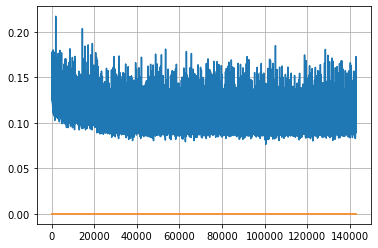

Epoch: 367, iteration 0, loss 0.10001516342163086, cov_diff 0.41136892233168904 cov_diff train 0.4106298764718806
Epoch: 367, iteration 1, loss 0.10692721605300903, cov_diff 0.4123315486171993 cov_diff train 0.4112346963975104
Epoch: 367, iteration 2, loss 0.09876024723052979, cov_diff 0.4248488562952552 cov_diff train 0.42501330332409376
Epoch: 367, iteration 3, loss 0.08859655261039734, cov_diff 0.400162298979852 cov_diff train 0.3998372850084558
Epoch: 367, iteration 4, loss 0.0940169095993042, cov_diff 0.40051560224446436 cov_diff train 0.4002970359393587
Epoch: 367, iteration 5, loss 0.10089194774627686, cov_diff 0.40145341545577085 cov_diff train 0.40083820377982277
Epoch: 367, iteration 6, loss 0.09893587231636047, cov_diff 0.42314333189780096 cov_diff train 0.4225025140181589
Epoch: 367, iteration 7, loss 0.102632075548172, cov_diff 0.41249185605702793 cov_diff train 0.4123593415989422
Epoch: 367, iteration 8, loss 0.10819053649902344, cov_diff 0.41154594431215163 cov_diff trai

Epoch: 367, iteration 76, loss 0.10780784487724304, cov_diff 0.4198549661374854 cov_diff train 0.4196515397090693
Epoch: 367, iteration 77, loss 0.09592297673225403, cov_diff 0.4201578711689674 cov_diff train 0.4199056705148596
Epoch: 367, iteration 78, loss 0.10082626342773438, cov_diff 0.4219289890119043 cov_diff train 0.4211424675398078
Epoch: 367, iteration 79, loss 0.1032751202583313, cov_diff 0.3929838280146591 cov_diff train 0.3921027091097327
Epoch: 367, iteration 80, loss 0.09792819619178772, cov_diff 0.4165300836303351 cov_diff train 0.4156106996419315
Epoch: 367, iteration 81, loss 0.10795024037361145, cov_diff 0.41088147264021524 cov_diff train 0.40943604543672923
Epoch: 367, iteration 82, loss 0.09369683265686035, cov_diff 0.39505709570659325 cov_diff train 0.39420421367580033
Epoch: 367, iteration 83, loss 0.10199689865112305, cov_diff 0.4056130990856294 cov_diff train 0.4051990621357542
Epoch: 367, iteration 84, loss 0.09330734610557556, cov_diff 0.41689686683605026 cov_

Epoch: 367, iteration 152, loss 0.10711738467216492, cov_diff 0.40992037761429484 cov_diff train 0.4095890311833285
Epoch: 367, iteration 153, loss 0.11750560998916626, cov_diff 0.41661945660485405 cov_diff train 0.4161890261583449
Epoch: 367, iteration 154, loss 0.09749826788902283, cov_diff 0.43163368440899114 cov_diff train 0.4306491344319898
Epoch: 367, iteration 155, loss 0.1111484169960022, cov_diff 0.4147346522714122 cov_diff train 0.41421956246541125
Epoch: 367, iteration 156, loss 0.10524046421051025, cov_diff 0.4105326629046631 cov_diff train 0.41026371916031057
Epoch: 367, iteration 157, loss 0.1100095808506012, cov_diff 0.4219635187199793 cov_diff train 0.4211982425765832
Epoch: 367, iteration 158, loss 0.09623450040817261, cov_diff 0.41494670607684625 cov_diff train 0.4146725333968105
Epoch: 367, iteration 159, loss 0.09462431073188782, cov_diff 0.4176860324681136 cov_diff train 0.41703232432134496
Epoch: 367, iteration 160, loss 0.1010829508304596, cov_diff 0.410265936787

Epoch: 367, iteration 229, loss 0.1099463701248169, cov_diff 0.4190495593047687 cov_diff train 0.41848028929294073
Epoch: 367, iteration 230, loss 0.10491365194320679, cov_diff 0.4141103234285784 cov_diff train 0.41317445666907626
Epoch: 367, iteration 231, loss 0.10000485181808472, cov_diff 0.41165097762112784 cov_diff train 0.41051597001850626
Epoch: 367, iteration 232, loss 0.09311124682426453, cov_diff 0.3976747281107513 cov_diff train 0.39753802695651785
Epoch: 367, iteration 233, loss 0.09915000200271606, cov_diff 0.41659599969164146 cov_diff train 0.4162327625683545
Epoch: 367, iteration 234, loss 0.1213972270488739, cov_diff 0.41696297679168254 cov_diff train 0.41532853965663447
Epoch: 367, iteration 235, loss 0.09927940368652344, cov_diff 0.4083554850468814 cov_diff train 0.4078759280770326
Epoch: 367, iteration 236, loss 0.12020334601402283, cov_diff 0.4172686538088273 cov_diff train 0.4170215620971606
Epoch: 367, iteration 237, loss 0.10458645224571228, cov_diff 0.4091211820

Epoch: 367, iteration 305, loss 0.1057443916797638, cov_diff 0.42058697514756455 cov_diff train 0.41821870767500785
Epoch: 367, iteration 306, loss 0.10223320126533508, cov_diff 0.41921167912308943 cov_diff train 0.41797898117575366
Epoch: 367, iteration 307, loss 0.11616802215576172, cov_diff 0.4093983571315345 cov_diff train 0.4067602285005263
Epoch: 367, iteration 308, loss 0.0968116819858551, cov_diff 0.41590387357426994 cov_diff train 0.4153060046158725
Epoch: 367, iteration 309, loss 0.09713822603225708, cov_diff 0.4108552906829273 cov_diff train 0.4099631384912841
Epoch: 367, iteration 310, loss 0.09252631664276123, cov_diff 0.41504868341076356 cov_diff train 0.4143624539198329
Epoch: 367, iteration 311, loss 0.11209803819656372, cov_diff 0.42182730574717714 cov_diff train 0.4208782404229499
Epoch: 367, iteration 312, loss 0.0979124903678894, cov_diff 0.4177339826625346 cov_diff train 0.41721365763570545
Epoch: 367, iteration 313, loss 0.09351947903633118, cov_diff 0.40713234511

Epoch: 367, iteration 382, loss 0.10256880521774292, cov_diff 0.4070061695326427 cov_diff train 0.4067029607187439
Epoch: 367, iteration 383, loss 0.10789036750793457, cov_diff 0.4046179762031407 cov_diff train 0.4033235141630843
Epoch: 367, iteration 384, loss 0.10013309121131897, cov_diff 0.398779700992023 cov_diff train 0.3979522753786341
Epoch: 367, iteration 385, loss 0.10004910826683044, cov_diff 0.3989564166877112 cov_diff train 0.3990422306555943
Epoch: 367, iteration 386, loss 0.10146349668502808, cov_diff 0.40529878517950574 cov_diff train 0.4049671587035994
Epoch: 367, iteration 387, loss 0.09921273589134216, cov_diff 0.4066723267888804 cov_diff train 0.4070738212840231
Epoch: 367, iteration 388, loss 0.09885811805725098, cov_diff 0.4113156700868951 cov_diff train 0.41032170288946085
Epoch: 367, iteration 389, loss 0.09273022413253784, cov_diff 0.4203685237628342 cov_diff train 0.4196758008812463
Epoch: 367, iteration 390, loss 0.17257297039031982, cov_diff 0.462127584023249

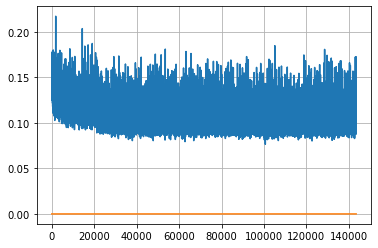

Epoch: 368, iteration 0, loss 0.11090460419654846, cov_diff 0.41830255900635643 cov_diff train 0.41816434035093936
Epoch: 368, iteration 1, loss 0.10336422920227051, cov_diff 0.41308797546777776 cov_diff train 0.41222426812675433
Epoch: 368, iteration 2, loss 0.09409978985786438, cov_diff 0.42597422993123507 cov_diff train 0.4246682764883624
Epoch: 368, iteration 3, loss 0.10840389132499695, cov_diff 0.42418896232043324 cov_diff train 0.42387497759505055
Epoch: 368, iteration 4, loss 0.10332778096199036, cov_diff 0.418435634883113 cov_diff train 0.4173714712766226
Epoch: 368, iteration 5, loss 0.10312366485595703, cov_diff 0.4109617569284626 cov_diff train 0.41116270013815237
Epoch: 368, iteration 6, loss 0.09488305449485779, cov_diff 0.41250801308570645 cov_diff train 0.4118496709087367
Epoch: 368, iteration 7, loss 0.10072433948516846, cov_diff 0.42732213676678227 cov_diff train 0.4265328998712267
Epoch: 368, iteration 8, loss 0.11372935771942139, cov_diff 0.40817409652708136 cov_dif

Epoch: 368, iteration 76, loss 0.10049185156822205, cov_diff 0.42101755205834096 cov_diff train 0.42103684015976783
Epoch: 368, iteration 77, loss 0.09914946556091309, cov_diff 0.40980302435978494 cov_diff train 0.4092671102258444
Epoch: 368, iteration 78, loss 0.10763052105903625, cov_diff 0.4042866399701544 cov_diff train 0.40471283004069436
Epoch: 368, iteration 79, loss 0.09249231219291687, cov_diff 0.4190843695073983 cov_diff train 0.4185117209890011
Epoch: 368, iteration 80, loss 0.09431299567222595, cov_diff 0.41263517575118414 cov_diff train 0.4121183567593722
Epoch: 368, iteration 81, loss 0.09309405088424683, cov_diff 0.4168414269874506 cov_diff train 0.4161768112086464
Epoch: 368, iteration 82, loss 0.10780125856399536, cov_diff 0.41488884331328474 cov_diff train 0.41473337849991493
Epoch: 368, iteration 83, loss 0.10451403260231018, cov_diff 0.4206513829156789 cov_diff train 0.4198100929988672
Epoch: 368, iteration 84, loss 0.1086171567440033, cov_diff 0.4267227500365327 co

Epoch: 368, iteration 152, loss 0.11116290092468262, cov_diff 0.39497975110120265 cov_diff train 0.3952517816397427
Epoch: 368, iteration 153, loss 0.10424304008483887, cov_diff 0.40328610577369334 cov_diff train 0.40270067138265053
Epoch: 368, iteration 154, loss 0.09191668033599854, cov_diff 0.41875266807525485 cov_diff train 0.4184598598577105
Epoch: 368, iteration 155, loss 0.0961025059223175, cov_diff 0.4148467595617312 cov_diff train 0.4145870685541287
Epoch: 368, iteration 156, loss 0.10262352228164673, cov_diff 0.42373895367263364 cov_diff train 0.42357137488531604
Epoch: 368, iteration 157, loss 0.10302150249481201, cov_diff 0.4163953437374269 cov_diff train 0.41574287843282537
Epoch: 368, iteration 158, loss 0.10792404413223267, cov_diff 0.3989711252555118 cov_diff train 0.3986035895384721
Epoch: 368, iteration 159, loss 0.0953570008277893, cov_diff 0.41434592122702235 cov_diff train 0.41299320093837144
Epoch: 368, iteration 160, loss 0.10973620414733887, cov_diff 0.414699510

Epoch: 368, iteration 229, loss 0.10312598943710327, cov_diff 0.4092643861626061 cov_diff train 0.40768843772843777
Epoch: 368, iteration 230, loss 0.09989890456199646, cov_diff 0.4047829046843189 cov_diff train 0.4037302567989491
Epoch: 368, iteration 231, loss 0.10734528303146362, cov_diff 0.40476677707654557 cov_diff train 0.4032683217721168
Epoch: 368, iteration 232, loss 0.10859119892120361, cov_diff 0.4243688398220263 cov_diff train 0.4232945557327335
Epoch: 368, iteration 233, loss 0.11080864071846008, cov_diff 0.420739035807767 cov_diff train 0.4195814813934284
Epoch: 368, iteration 234, loss 0.09394237399101257, cov_diff 0.4061346767646741 cov_diff train 0.4047141122011368
Epoch: 368, iteration 235, loss 0.10112699866294861, cov_diff 0.40486691780237205 cov_diff train 0.40457393273668607
Epoch: 368, iteration 236, loss 0.1026945412158966, cov_diff 0.415488741764705 cov_diff train 0.41458065296420565
Epoch: 368, iteration 237, loss 0.11660775542259216, cov_diff 0.40490346983174

Epoch: 368, iteration 307, loss 0.10584455728530884, cov_diff 0.4039038144350239 cov_diff train 0.4046835778308156
Epoch: 368, iteration 308, loss 0.10487055778503418, cov_diff 0.41461656363684407 cov_diff train 0.41504316509486394
Epoch: 368, iteration 309, loss 0.09949317574501038, cov_diff 0.4291755843833839 cov_diff train 0.4287610301955544
Epoch: 368, iteration 310, loss 0.10743290185928345, cov_diff 0.4162064794083543 cov_diff train 0.4157128987731249
Epoch: 368, iteration 311, loss 0.11131861805915833, cov_diff 0.4163487421608658 cov_diff train 0.41627016117356064
Epoch: 368, iteration 312, loss 0.10064107179641724, cov_diff 0.4160553760479129 cov_diff train 0.41509759454957906
Epoch: 368, iteration 313, loss 0.11094105243682861, cov_diff 0.4010130488479325 cov_diff train 0.40168879551895365
Epoch: 368, iteration 314, loss 0.1040690541267395, cov_diff 0.4087675902505842 cov_diff train 0.4082027873099746
Epoch: 368, iteration 315, loss 0.10131695866584778, cov_diff 0.416390611984

Epoch: 368, iteration 386, loss 0.10344719886779785, cov_diff 0.4061814326836855 cov_diff train 0.4053431980750795
Epoch: 368, iteration 387, loss 0.09866440296173096, cov_diff 0.41785515531964545 cov_diff train 0.4169618649445317
Epoch: 368, iteration 388, loss 0.1019555926322937, cov_diff 0.41561051331159493 cov_diff train 0.415088935637765
Epoch: 368, iteration 389, loss 0.09830015897750854, cov_diff 0.41786020103326893 cov_diff train 0.41637660559083595
Epoch: 368, iteration 390, loss 0.1381334662437439, cov_diff 0.4506465858857224 cov_diff train 0.4492504267282849


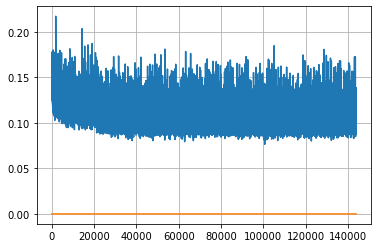

Epoch: 369, iteration 0, loss 0.10130208730697632, cov_diff 0.395470747718308 cov_diff train 0.394580079184654
Epoch: 369, iteration 1, loss 0.10184848308563232, cov_diff 0.4023637505955713 cov_diff train 0.4010552875507667
Epoch: 369, iteration 2, loss 0.08988624811172485, cov_diff 0.41317531300465554 cov_diff train 0.4126315033037392
Epoch: 369, iteration 3, loss 0.10119098424911499, cov_diff 0.4162524412830747 cov_diff train 0.41571290881143025
Epoch: 369, iteration 4, loss 0.10580679774284363, cov_diff 0.4139666421937204 cov_diff train 0.41319360787721526
Epoch: 369, iteration 5, loss 0.10640925168991089, cov_diff 0.4159225351238167 cov_diff train 0.41527787182158316
Epoch: 369, iteration 6, loss 0.10625192523002625, cov_diff 0.41128709388121804 cov_diff train 0.4110361326684743
Epoch: 369, iteration 7, loss 0.10938361287117004, cov_diff 0.41867652141011946 cov_diff train 0.4180862583162563
Epoch: 369, iteration 8, loss 0.11525183916091919, cov_diff 0.41218125745495626 cov_diff tra

Epoch: 369, iteration 77, loss 0.09997838735580444, cov_diff 0.39767899076432756 cov_diff train 0.39672068524273824
Epoch: 369, iteration 78, loss 0.09863877296447754, cov_diff 0.40869677427621603 cov_diff train 0.40786164388394086
Epoch: 369, iteration 79, loss 0.1016981303691864, cov_diff 0.4139550239209261 cov_diff train 0.41282336204757536
Epoch: 369, iteration 80, loss 0.11194092035293579, cov_diff 0.42220046458365873 cov_diff train 0.42049004888499203
Epoch: 369, iteration 81, loss 0.10278239846229553, cov_diff 0.4097389599416702 cov_diff train 0.4098233528659877
Epoch: 369, iteration 82, loss 0.10219728946685791, cov_diff 0.42063979718575084 cov_diff train 0.4190842402391763
Epoch: 369, iteration 83, loss 0.12678426504135132, cov_diff 0.4071094375813457 cov_diff train 0.40671661640374307
Epoch: 369, iteration 84, loss 0.10640022158622742, cov_diff 0.4103742988644475 cov_diff train 0.41021924545178345
Epoch: 369, iteration 85, loss 0.10976552963256836, cov_diff 0.4142507598817274

Epoch: 369, iteration 154, loss 0.11039096117019653, cov_diff 0.4101606837738926 cov_diff train 0.4105442576064899
Epoch: 369, iteration 155, loss 0.102253258228302, cov_diff 0.40674104059451993 cov_diff train 0.4062705187218548
Epoch: 369, iteration 156, loss 0.10568922758102417, cov_diff 0.4055813473961344 cov_diff train 0.4048648027138232
Epoch: 369, iteration 157, loss 0.09939029812812805, cov_diff 0.408679259867662 cov_diff train 0.40892590624024033
Epoch: 369, iteration 158, loss 0.10118219256401062, cov_diff 0.41582370081569037 cov_diff train 0.41510368894578253
Epoch: 369, iteration 159, loss 0.10360768437385559, cov_diff 0.4115008565941837 cov_diff train 0.4117283142140372
Epoch: 369, iteration 160, loss 0.10740068554878235, cov_diff 0.41170034798702315 cov_diff train 0.4110566804744692
Epoch: 369, iteration 161, loss 0.1070433259010315, cov_diff 0.40578786846243636 cov_diff train 0.40477294287758825
Epoch: 369, iteration 162, loss 0.10703670978546143, cov_diff 0.4103070999582

Epoch: 369, iteration 228, loss 0.09382706880569458, cov_diff 0.41874041954917196 cov_diff train 0.41856226210007663
Epoch: 369, iteration 229, loss 0.10610774159431458, cov_diff 0.4173250661483803 cov_diff train 0.41770225358925844
Epoch: 369, iteration 230, loss 0.11479178071022034, cov_diff 0.418196539158625 cov_diff train 0.4183194770960721
Epoch: 369, iteration 231, loss 0.10133320093154907, cov_diff 0.4077397360532039 cov_diff train 0.4085429106092197
Epoch: 369, iteration 232, loss 0.1137998104095459, cov_diff 0.4089245392022976 cov_diff train 0.40974710161886035
Epoch: 369, iteration 233, loss 0.1093406081199646, cov_diff 0.41062821486274304 cov_diff train 0.4101573500023688
Epoch: 369, iteration 234, loss 0.10383260250091553, cov_diff 0.4198995013704677 cov_diff train 0.42037975539352407
Epoch: 369, iteration 235, loss 0.10733941197395325, cov_diff 0.41179857388662616 cov_diff train 0.41185484576818615
Epoch: 369, iteration 236, loss 0.11235767602920532, cov_diff 0.41222589002

Epoch: 369, iteration 305, loss 0.09944942593574524, cov_diff 0.41191085213560885 cov_diff train 0.4117061785918083
Epoch: 369, iteration 306, loss 0.10447844862937927, cov_diff 0.4164460123668818 cov_diff train 0.4147562358986572
Epoch: 369, iteration 307, loss 0.1073685884475708, cov_diff 0.41294662250503866 cov_diff train 0.4125296987969741
Epoch: 369, iteration 308, loss 0.09820029139518738, cov_diff 0.4106049333736679 cov_diff train 0.4101075737963101
Epoch: 369, iteration 309, loss 0.10653042793273926, cov_diff 0.4106369615985097 cov_diff train 0.4103484479553459
Epoch: 369, iteration 310, loss 0.10533082485198975, cov_diff 0.4101837145258807 cov_diff train 0.41084972892232724
Epoch: 369, iteration 311, loss 0.11355447769165039, cov_diff 0.403353783767711 cov_diff train 0.4033880526110024
Epoch: 369, iteration 312, loss 0.10929140448570251, cov_diff 0.4111928906730365 cov_diff train 0.41050000290749744
Epoch: 369, iteration 313, loss 0.1052214503288269, cov_diff 0.412681499568991

Epoch: 369, iteration 380, loss 0.10217592120170593, cov_diff 0.42452341400074306 cov_diff train 0.42400885377124625
Epoch: 369, iteration 381, loss 0.10441595315933228, cov_diff 0.41311781168439476 cov_diff train 0.4124647446782008
Epoch: 369, iteration 382, loss 0.1033831536769867, cov_diff 0.4138682469430301 cov_diff train 0.4136751066772222
Epoch: 369, iteration 383, loss 0.1016886830329895, cov_diff 0.41325721101096674 cov_diff train 0.4120304289373481
Epoch: 369, iteration 384, loss 0.11368760466575623, cov_diff 0.4030620471825199 cov_diff train 0.4022934026179737
Epoch: 369, iteration 385, loss 0.10501691699028015, cov_diff 0.40786944752020476 cov_diff train 0.40680337143777706
Epoch: 369, iteration 386, loss 0.09804174304008484, cov_diff 0.41720189512922845 cov_diff train 0.4161574421935328
Epoch: 369, iteration 387, loss 0.10717117786407471, cov_diff 0.4233457710120572 cov_diff train 0.42186483311948897
Epoch: 369, iteration 388, loss 0.10740828514099121, cov_diff 0.4121440617

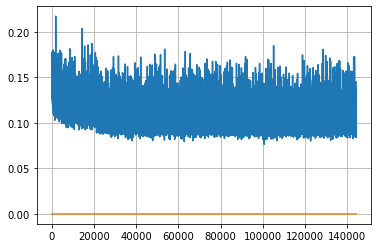

Epoch: 370, iteration 0, loss 0.11106351017951965, cov_diff 0.4079848554442566 cov_diff train 0.40745432245561514
Epoch: 370, iteration 1, loss 0.10383021831512451, cov_diff 0.39944394351216533 cov_diff train 0.39909710586066743
Epoch: 370, iteration 2, loss 0.11781662702560425, cov_diff 0.41593547754325605 cov_diff train 0.4158705789186339
Epoch: 370, iteration 3, loss 0.10956591367721558, cov_diff 0.4085415800892823 cov_diff train 0.4064223995475959
Epoch: 370, iteration 4, loss 0.12039253115653992, cov_diff 0.4038867719617712 cov_diff train 0.40280134327251255
Epoch: 370, iteration 5, loss 0.10746416449546814, cov_diff 0.40243174996003406 cov_diff train 0.40123393877472346
Epoch: 370, iteration 6, loss 0.10451763868331909, cov_diff 0.40993460793105074 cov_diff train 0.40988929553774206
Epoch: 370, iteration 7, loss 0.10814565420150757, cov_diff 0.41189454960962385 cov_diff train 0.41150608801536076
Epoch: 370, iteration 8, loss 0.10907214879989624, cov_diff 0.41570283907134586 cov_d

Epoch: 370, iteration 78, loss 0.10294100642204285, cov_diff 0.40994955661443394 cov_diff train 0.40920527741208423
Epoch: 370, iteration 79, loss 0.09599903225898743, cov_diff 0.4073131602407911 cov_diff train 0.40643527090321224
Epoch: 370, iteration 80, loss 0.09949508309364319, cov_diff 0.4192048352571624 cov_diff train 0.4188529378916597
Epoch: 370, iteration 81, loss 0.10582304000854492, cov_diff 0.39600458219604595 cov_diff train 0.3963096577404826
Epoch: 370, iteration 82, loss 0.10491308569908142, cov_diff 0.4067937122673748 cov_diff train 0.406112372892884
Epoch: 370, iteration 83, loss 0.09974721074104309, cov_diff 0.3957691564386888 cov_diff train 0.3953059794014799
Epoch: 370, iteration 84, loss 0.10366344451904297, cov_diff 0.3943749851589828 cov_diff train 0.39392496840565905
Epoch: 370, iteration 85, loss 0.10216104984283447, cov_diff 0.4167639053623818 cov_diff train 0.4163829201377095
Epoch: 370, iteration 86, loss 0.11515817046165466, cov_diff 0.42290966710288913 cov

Epoch: 370, iteration 155, loss 0.10122048854827881, cov_diff 0.41638070029950786 cov_diff train 0.4149393320627481
Epoch: 370, iteration 156, loss 0.10133782029151917, cov_diff 0.4171442881549906 cov_diff train 0.4153857017761704
Epoch: 370, iteration 157, loss 0.11103132367134094, cov_diff 0.39700820379840407 cov_diff train 0.39599067313393854
Epoch: 370, iteration 158, loss 0.09890905022621155, cov_diff 0.4112296903270501 cov_diff train 0.40988294584511936
Epoch: 370, iteration 159, loss 0.11066603660583496, cov_diff 0.4125555951525868 cov_diff train 0.4102462857421238
Epoch: 370, iteration 160, loss 0.0988604724407196, cov_diff 0.3997604269277547 cov_diff train 0.39899925024934796
Epoch: 370, iteration 161, loss 0.1056668758392334, cov_diff 0.42210577931746995 cov_diff train 0.4213823328402405
Epoch: 370, iteration 162, loss 0.0988510251045227, cov_diff 0.4058051947579379 cov_diff train 0.40670288187693837
Epoch: 370, iteration 163, loss 0.11118155717849731, cov_diff 0.401608188044

Epoch: 370, iteration 233, loss 0.1118602454662323, cov_diff 0.40852569731237115 cov_diff train 0.40782518844884746
Epoch: 370, iteration 234, loss 0.09771272540092468, cov_diff 0.4060870973036585 cov_diff train 0.4047941861576005
Epoch: 370, iteration 235, loss 0.09574821591377258, cov_diff 0.4091036943867141 cov_diff train 0.4088880818188416
Epoch: 370, iteration 236, loss 0.0946340262889862, cov_diff 0.4123321579438161 cov_diff train 0.41111662722226644
Epoch: 370, iteration 237, loss 0.1050836443901062, cov_diff 0.4200597282483105 cov_diff train 0.4187129061279956
Epoch: 370, iteration 238, loss 0.10750430822372437, cov_diff 0.4077181670576587 cov_diff train 0.40576456900863034
Epoch: 370, iteration 239, loss 0.10616999864578247, cov_diff 0.4146231471964177 cov_diff train 0.41336345973547867
Epoch: 370, iteration 240, loss 0.10334259271621704, cov_diff 0.4076670976241722 cov_diff train 0.40687465700535297
Epoch: 370, iteration 241, loss 0.09427317976951599, cov_diff 0.4012619024174

Epoch: 370, iteration 310, loss 0.09472036361694336, cov_diff 0.41107846749352356 cov_diff train 0.4091107180344057
Epoch: 370, iteration 311, loss 0.10057070851325989, cov_diff 0.4177321281149616 cov_diff train 0.4175932271687148
Epoch: 370, iteration 312, loss 0.1156909167766571, cov_diff 0.4057393323872152 cov_diff train 0.40450602282818
Epoch: 370, iteration 313, loss 0.09946432709693909, cov_diff 0.41364471930105295 cov_diff train 0.41218391100415436
Epoch: 370, iteration 314, loss 0.10430213809013367, cov_diff 0.40487742817234645 cov_diff train 0.4048111221077532
Epoch: 370, iteration 315, loss 0.10799261927604675, cov_diff 0.3976322411749967 cov_diff train 0.3975369519696619
Epoch: 370, iteration 316, loss 0.09827804565429688, cov_diff 0.424188745358075 cov_diff train 0.42419586906637985
Epoch: 370, iteration 317, loss 0.10805168747901917, cov_diff 0.3955367984007953 cov_diff train 0.3943589518358068
Epoch: 370, iteration 318, loss 0.09752550721168518, cov_diff 0.412318761965474

Epoch: 370, iteration 387, loss 0.10219049453735352, cov_diff 0.4155447567440318 cov_diff train 0.4154426717028162
Epoch: 370, iteration 388, loss 0.09372812509536743, cov_diff 0.407086851566939 cov_diff train 0.40617538245115586
Epoch: 370, iteration 389, loss 0.10311517119407654, cov_diff 0.4072150160953353 cov_diff train 0.40669948859311744
Epoch: 370, iteration 390, loss 0.14914286136627197, cov_diff 0.4471190792727829 cov_diff train 0.4462275954665038


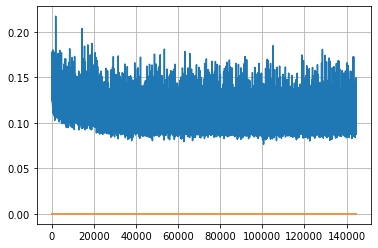

Epoch: 371, iteration 0, loss 0.09804055094718933, cov_diff 0.41204337917984196 cov_diff train 0.4118463001498034
Epoch: 371, iteration 1, loss 0.09568172693252563, cov_diff 0.4145786430057079 cov_diff train 0.41482239115925224
Epoch: 371, iteration 2, loss 0.09693476557731628, cov_diff 0.4150507215044821 cov_diff train 0.41432473911251183
Epoch: 371, iteration 3, loss 0.10687291622161865, cov_diff 0.40268417400154477 cov_diff train 0.40213415825128024
Epoch: 371, iteration 4, loss 0.10185527801513672, cov_diff 0.41199129184033606 cov_diff train 0.4121107497204168
Epoch: 371, iteration 5, loss 0.10751858353614807, cov_diff 0.41882337893876503 cov_diff train 0.41841555425809296
Epoch: 371, iteration 6, loss 0.10524153709411621, cov_diff 0.42162589236445047 cov_diff train 0.42022901046497346
Epoch: 371, iteration 7, loss 0.0964779257774353, cov_diff 0.40264076516383956 cov_diff train 0.40110303232244376
Epoch: 371, iteration 8, loss 0.104917973279953, cov_diff 0.4055517617205371 cov_diff

Epoch: 371, iteration 77, loss 0.11622747778892517, cov_diff 0.42584699177499596 cov_diff train 0.42531992977541705
Epoch: 371, iteration 78, loss 0.09240677952766418, cov_diff 0.41789292146699364 cov_diff train 0.41678070771946735
Epoch: 371, iteration 79, loss 0.09488120675086975, cov_diff 0.4092621213292805 cov_diff train 0.40876037550551725
Epoch: 371, iteration 80, loss 0.10721397399902344, cov_diff 0.4053683666774086 cov_diff train 0.4048793717423126
Epoch: 371, iteration 81, loss 0.08791196346282959, cov_diff 0.41179529982049434 cov_diff train 0.41098229970742567
Epoch: 371, iteration 82, loss 0.09491145610809326, cov_diff 0.40466041816611076 cov_diff train 0.403817309820133
Epoch: 371, iteration 83, loss 0.1059374213218689, cov_diff 0.4042702609490269 cov_diff train 0.40463918561725126
Epoch: 371, iteration 84, loss 0.10639220476150513, cov_diff 0.4094129987906339 cov_diff train 0.4089681500644081
Epoch: 371, iteration 85, loss 0.10447371006011963, cov_diff 0.4217720735263561 c

Epoch: 371, iteration 154, loss 0.11030837893486023, cov_diff 0.41747822013622304 cov_diff train 0.41636284548753283
Epoch: 371, iteration 155, loss 0.09857955574989319, cov_diff 0.41309166659882557 cov_diff train 0.4129237609441905
Epoch: 371, iteration 156, loss 0.10617148876190186, cov_diff 0.40664338907190056 cov_diff train 0.4055910468566511
Epoch: 371, iteration 157, loss 0.09802687168121338, cov_diff 0.40912973989155993 cov_diff train 0.407760497721515
Epoch: 371, iteration 158, loss 0.10922679305076599, cov_diff 0.407017007401127 cov_diff train 0.4056625695672005
Epoch: 371, iteration 159, loss 0.10224449634552002, cov_diff 0.40957120412648673 cov_diff train 0.4081201412911317
Epoch: 371, iteration 160, loss 0.11262989044189453, cov_diff 0.40468059220983554 cov_diff train 0.40339661436266605
Epoch: 371, iteration 161, loss 0.09120175242424011, cov_diff 0.3950697825890398 cov_diff train 0.395231588010712
Epoch: 371, iteration 162, loss 0.10461845993995667, cov_diff 0.38777867768

Epoch: 371, iteration 231, loss 0.0960463285446167, cov_diff 0.41975924949426635 cov_diff train 0.41894662898857743
Epoch: 371, iteration 232, loss 0.10799464583396912, cov_diff 0.41388676014540904 cov_diff train 0.4141274748300371
Epoch: 371, iteration 233, loss 0.11309397220611572, cov_diff 0.42356331348511217 cov_diff train 0.42353624677551516
Epoch: 371, iteration 234, loss 0.10446301102638245, cov_diff 0.41574904567680654 cov_diff train 0.4162752910968666
Epoch: 371, iteration 235, loss 0.09264209866523743, cov_diff 0.4104399817182922 cov_diff train 0.4092853339248391
Epoch: 371, iteration 236, loss 0.09874215722084045, cov_diff 0.4202652002239283 cov_diff train 0.42006445582588886
Epoch: 371, iteration 237, loss 0.10325503349304199, cov_diff 0.41418861424030906 cov_diff train 0.4137250727010073
Epoch: 371, iteration 238, loss 0.10257583856582642, cov_diff 0.40358901471728825 cov_diff train 0.40201229622181384
Epoch: 371, iteration 239, loss 0.09918484091758728, cov_diff 0.4210684

Epoch: 371, iteration 309, loss 0.10550075769424438, cov_diff 0.4044868384261093 cov_diff train 0.4038505559196086
Epoch: 371, iteration 310, loss 0.10465797781944275, cov_diff 0.4204518558350944 cov_diff train 0.4193213734063887
Epoch: 371, iteration 311, loss 0.09615862369537354, cov_diff 0.4057308104802771 cov_diff train 0.40544445815619107
Epoch: 371, iteration 312, loss 0.10187214612960815, cov_diff 0.42831012369663957 cov_diff train 0.42691040589733814
Epoch: 371, iteration 313, loss 0.10356548428535461, cov_diff 0.421915299964224 cov_diff train 0.420995755064484
Epoch: 371, iteration 314, loss 0.09168180823326111, cov_diff 0.4068929138199964 cov_diff train 0.40634041336103094
Epoch: 371, iteration 315, loss 0.09884035587310791, cov_diff 0.4141885262938915 cov_diff train 0.41396911153873767
Epoch: 371, iteration 316, loss 0.10518011450767517, cov_diff 0.4126329983111866 cov_diff train 0.411134048979825
Epoch: 371, iteration 317, loss 0.10696384310722351, cov_diff 0.41419413970138

Epoch: 371, iteration 387, loss 0.10118463635444641, cov_diff 0.4155919132359354 cov_diff train 0.41378178272286537
Epoch: 371, iteration 388, loss 0.10614338517189026, cov_diff 0.40407870491966774 cov_diff train 0.4037842086586241
Epoch: 371, iteration 389, loss 0.11180809140205383, cov_diff 0.4117534912399387 cov_diff train 0.410959030409484
Epoch: 371, iteration 390, loss 0.14561274647712708, cov_diff 0.45201394830536873 cov_diff train 0.4507509763149896


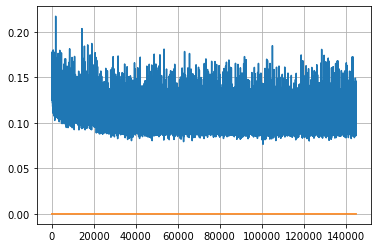

Epoch: 372, iteration 0, loss 0.10714378952980042, cov_diff 0.40696947967607977 cov_diff train 0.40656423766046323
Epoch: 372, iteration 1, loss 0.10460439324378967, cov_diff 0.4197147424051737 cov_diff train 0.4193209446171467
Epoch: 372, iteration 2, loss 0.10726895928382874, cov_diff 0.4206504912864406 cov_diff train 0.42049080597975486
Epoch: 372, iteration 3, loss 0.10526120662689209, cov_diff 0.42101440511411625 cov_diff train 0.4198140356214582
Epoch: 372, iteration 4, loss 0.11003288626670837, cov_diff 0.41646794720473723 cov_diff train 0.4156452817715129
Epoch: 372, iteration 5, loss 0.09986701607704163, cov_diff 0.410896888904503 cov_diff train 0.40951085421484723
Epoch: 372, iteration 6, loss 0.09697616100311279, cov_diff 0.4054511314702419 cov_diff train 0.4047178823327529
Epoch: 372, iteration 7, loss 0.10898596048355103, cov_diff 0.4249377829275775 cov_diff train 0.4237921681154004
Epoch: 372, iteration 8, loss 0.10105159878730774, cov_diff 0.4072830434311455 cov_diff tra

Epoch: 372, iteration 77, loss 0.11211064457893372, cov_diff 0.4001429606430651 cov_diff train 0.39910113981256645
Epoch: 372, iteration 78, loss 0.10529625415802002, cov_diff 0.3987380901748582 cov_diff train 0.3981809720354498
Epoch: 372, iteration 79, loss 0.10518237948417664, cov_diff 0.4094187660199121 cov_diff train 0.40936788306342053
Epoch: 372, iteration 80, loss 0.10738256573677063, cov_diff 0.3993763454099362 cov_diff train 0.39712241659897785
Epoch: 372, iteration 81, loss 0.10659429430961609, cov_diff 0.41186966473925507 cov_diff train 0.4117653662186473
Epoch: 372, iteration 82, loss 0.10397136211395264, cov_diff 0.41508302120405416 cov_diff train 0.4144584105255478
Epoch: 372, iteration 83, loss 0.10194459557533264, cov_diff 0.4033829103851926 cov_diff train 0.4035889237691592
Epoch: 372, iteration 84, loss 0.09512326121330261, cov_diff 0.4035110802405481 cov_diff train 0.4032500784643899
Epoch: 372, iteration 85, loss 0.10690248012542725, cov_diff 0.3998056553730451 cov

Epoch: 372, iteration 155, loss 0.10712429881095886, cov_diff 0.41960703164869817 cov_diff train 0.41905610894955087
Epoch: 372, iteration 156, loss 0.10439032316207886, cov_diff 0.4244745410407845 cov_diff train 0.4232380449504507
Epoch: 372, iteration 157, loss 0.10969656705856323, cov_diff 0.41317333389572053 cov_diff train 0.4129039989796484
Epoch: 372, iteration 158, loss 0.09471997618675232, cov_diff 0.3993076887309628 cov_diff train 0.3985100977268997
Epoch: 372, iteration 159, loss 0.10535824298858643, cov_diff 0.4108889133416503 cov_diff train 0.4101099725981224
Epoch: 372, iteration 160, loss 0.1040416955947876, cov_diff 0.40787076832007507 cov_diff train 0.407813438967176
Epoch: 372, iteration 161, loss 0.0995917022228241, cov_diff 0.4065414428080771 cov_diff train 0.40641660182500444
Epoch: 372, iteration 162, loss 0.11408492922782898, cov_diff 0.41522847264155377 cov_diff train 0.4150205280587188
Epoch: 372, iteration 163, loss 0.10209235548973083, cov_diff 0.4165240654279

Epoch: 372, iteration 233, loss 0.10785472393035889, cov_diff 0.42022325991125703 cov_diff train 0.4191536083134846
Epoch: 372, iteration 234, loss 0.11429071426391602, cov_diff 0.42223235635831163 cov_diff train 0.4215633266523717
Epoch: 372, iteration 235, loss 0.11127984523773193, cov_diff 0.4146416117095074 cov_diff train 0.41409664486104564
Epoch: 372, iteration 236, loss 0.09987571835517883, cov_diff 0.41502572923581144 cov_diff train 0.414207626674572
Epoch: 372, iteration 237, loss 0.0968715250492096, cov_diff 0.4157714548965071 cov_diff train 0.4154878119822949
Epoch: 372, iteration 238, loss 0.10226532816886902, cov_diff 0.40476977487839033 cov_diff train 0.4046634004120864
Epoch: 372, iteration 239, loss 0.08377498388290405, cov_diff 0.408758022396902 cov_diff train 0.40814306763208946
Epoch: 372, iteration 240, loss 0.09866037964820862, cov_diff 0.4135061474701677 cov_diff train 0.412382385178682
Epoch: 372, iteration 241, loss 0.10679706931114197, cov_diff 0.40128426623565

Epoch: 372, iteration 311, loss 0.10855960845947266, cov_diff 0.4131921424216027 cov_diff train 0.4123825840390923
Epoch: 372, iteration 312, loss 0.10687264800071716, cov_diff 0.4021781377952869 cov_diff train 0.40230507466998244
Epoch: 372, iteration 313, loss 0.10196083784103394, cov_diff 0.40666170308516375 cov_diff train 0.4065536150091502
Epoch: 372, iteration 314, loss 0.10673555731773376, cov_diff 0.41911678859338275 cov_diff train 0.41889429208452955
Epoch: 372, iteration 315, loss 0.10577097535133362, cov_diff 0.4123727948102234 cov_diff train 0.4126838046111994
Epoch: 372, iteration 316, loss 0.10479497909545898, cov_diff 0.4272831048478441 cov_diff train 0.4265571339091145
Epoch: 372, iteration 317, loss 0.1048910915851593, cov_diff 0.40990069352308045 cov_diff train 0.40991691738459246
Epoch: 372, iteration 318, loss 0.10513618588447571, cov_diff 0.41311524126763377 cov_diff train 0.412119596096169
Epoch: 372, iteration 319, loss 0.09684625267982483, cov_diff 0.41902879223

Epoch: 372, iteration 389, loss 0.0960085391998291, cov_diff 0.4040245205688351 cov_diff train 0.40302003210314247
Epoch: 372, iteration 390, loss 0.15355518460273743, cov_diff 0.45249661397579555 cov_diff train 0.45136439052131816


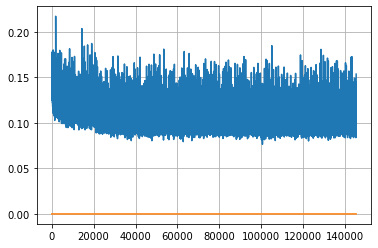

Epoch: 373, iteration 0, loss 0.09238603711128235, cov_diff 0.39948083645697713 cov_diff train 0.39905423424617803
Epoch: 373, iteration 1, loss 0.10128939151763916, cov_diff 0.41534425793196245 cov_diff train 0.41520881243139035
Epoch: 373, iteration 2, loss 0.09006437659263611, cov_diff 0.40016060365597106 cov_diff train 0.3998309304380286
Epoch: 373, iteration 3, loss 0.10582363605499268, cov_diff 0.4150786983828386 cov_diff train 0.41546807211137116
Epoch: 373, iteration 4, loss 0.09712791442871094, cov_diff 0.4034423992466976 cov_diff train 0.40317362406012175
Epoch: 373, iteration 5, loss 0.10295963287353516, cov_diff 0.417729515776252 cov_diff train 0.4178390531669698
Epoch: 373, iteration 6, loss 0.10504907369613647, cov_diff 0.4223744992483769 cov_diff train 0.4219739049340848
Epoch: 373, iteration 7, loss 0.10799586772918701, cov_diff 0.424055077210979 cov_diff train 0.42202750425871044
Epoch: 373, iteration 8, loss 0.09660196304321289, cov_diff 0.4215145279719272 cov_diff tr

Epoch: 373, iteration 78, loss 0.09596052765846252, cov_diff 0.40884681087557084 cov_diff train 0.40788938542872843
Epoch: 373, iteration 79, loss 0.09866911172866821, cov_diff 0.41819688213360445 cov_diff train 0.41768524312412203
Epoch: 373, iteration 80, loss 0.09880891442298889, cov_diff 0.4131070644800624 cov_diff train 0.41290137841769803
Epoch: 373, iteration 81, loss 0.10419154167175293, cov_diff 0.41802376072779013 cov_diff train 0.4171836982495777
Epoch: 373, iteration 82, loss 0.10559502243995667, cov_diff 0.4131018165592828 cov_diff train 0.41239382398514307
Epoch: 373, iteration 83, loss 0.10256519913673401, cov_diff 0.41318472896388136 cov_diff train 0.4115133403727
Epoch: 373, iteration 84, loss 0.10569986701011658, cov_diff 0.4056649776181114 cov_diff train 0.40520082247325956
Epoch: 373, iteration 85, loss 0.10844582319259644, cov_diff 0.4111257166040717 cov_diff train 0.4102515015902346
Epoch: 373, iteration 86, loss 0.10226690769195557, cov_diff 0.41129783210028964 c

Epoch: 373, iteration 156, loss 0.10203009843826294, cov_diff 0.4226731782942091 cov_diff train 0.4221253876403965
Epoch: 373, iteration 157, loss 0.112386554479599, cov_diff 0.4137006728576736 cov_diff train 0.41328717216748306
Epoch: 373, iteration 158, loss 0.11041107773780823, cov_diff 0.41466120018642155 cov_diff train 0.4144227962740455
Epoch: 373, iteration 159, loss 0.09433245658874512, cov_diff 0.42584948698883635 cov_diff train 0.42399743788481636
Epoch: 373, iteration 160, loss 0.10121530294418335, cov_diff 0.4280048011671154 cov_diff train 0.42678925205702767
Epoch: 373, iteration 161, loss 0.10604706406593323, cov_diff 0.41400416996697986 cov_diff train 0.41304864989606555
Epoch: 373, iteration 162, loss 0.09722912311553955, cov_diff 0.4119611832331014 cov_diff train 0.4111718465970352
Epoch: 373, iteration 163, loss 0.09923094511032104, cov_diff 0.4144488745887886 cov_diff train 0.41386612683375973
Epoch: 373, iteration 164, loss 0.09995824098587036, cov_diff 0.4041457317

Epoch: 373, iteration 233, loss 0.10742947459220886, cov_diff 0.4248433127448503 cov_diff train 0.42474758985848077
Epoch: 373, iteration 234, loss 0.09854385256767273, cov_diff 0.4131057502589395 cov_diff train 0.4132343889788046
Epoch: 373, iteration 235, loss 0.09778201580047607, cov_diff 0.4214804721915658 cov_diff train 0.4209393438374024
Epoch: 373, iteration 236, loss 0.10255545377731323, cov_diff 0.4255896054966268 cov_diff train 0.4255286168886557
Epoch: 373, iteration 237, loss 0.09858971834182739, cov_diff 0.4086953201754095 cov_diff train 0.4082923533076606
Epoch: 373, iteration 238, loss 0.10787308216094971, cov_diff 0.4029807037626585 cov_diff train 0.40260139682007645
Epoch: 373, iteration 239, loss 0.10504743456840515, cov_diff 0.4017827313116878 cov_diff train 0.40147538448569037
Epoch: 373, iteration 240, loss 0.09740021824836731, cov_diff 0.4082934711926227 cov_diff train 0.40804368063507673
Epoch: 373, iteration 241, loss 0.09428715705871582, cov_diff 0.406460174076

Epoch: 373, iteration 307, loss 0.10026693344116211, cov_diff 0.40571608372037005 cov_diff train 0.40344977719547254
Epoch: 373, iteration 308, loss 0.12144774198532104, cov_diff 0.414510759118699 cov_diff train 0.41447504236383725
Epoch: 373, iteration 309, loss 0.10120764374732971, cov_diff 0.4185236097408021 cov_diff train 0.4179055804371827
Epoch: 373, iteration 310, loss 0.11012893915176392, cov_diff 0.4112092579742907 cov_diff train 0.41148246954191336
Epoch: 373, iteration 311, loss 0.10690310597419739, cov_diff 0.40766218541087 cov_diff train 0.40782082084649623
Epoch: 373, iteration 312, loss 0.10144951939582825, cov_diff 0.41477873562214873 cov_diff train 0.4149179668066984
Epoch: 373, iteration 313, loss 0.10126852989196777, cov_diff 0.41152924670601404 cov_diff train 0.4116050163122036
Epoch: 373, iteration 314, loss 0.1014946699142456, cov_diff 0.4195930077049542 cov_diff train 0.4196025892154676
Epoch: 373, iteration 315, loss 0.09934219717979431, cov_diff 0.4134727301560

Epoch: 373, iteration 385, loss 0.09524652361869812, cov_diff 0.3901328137605128 cov_diff train 0.38951093441818024
Epoch: 373, iteration 386, loss 0.1056138277053833, cov_diff 0.40665929096338593 cov_diff train 0.4055788602635175
Epoch: 373, iteration 387, loss 0.11948317289352417, cov_diff 0.39979156827078277 cov_diff train 0.4001431199697918
Epoch: 373, iteration 388, loss 0.11083874106407166, cov_diff 0.42612780019555463 cov_diff train 0.42615537995845
Epoch: 373, iteration 389, loss 0.09891048073768616, cov_diff 0.4133384247966934 cov_diff train 0.41272809212884404
Epoch: 373, iteration 390, loss 0.14514440298080444, cov_diff 0.4448659946144188 cov_diff train 0.44543785708986877


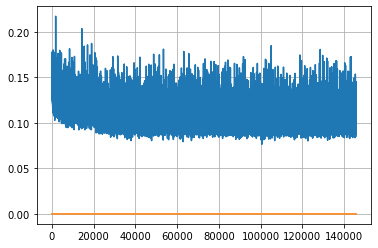

Epoch: 374, iteration 0, loss 0.10694891214370728, cov_diff 0.3994346440977584 cov_diff train 0.4003008130290606
Epoch: 374, iteration 1, loss 0.10416856408119202, cov_diff 0.4141922706472834 cov_diff train 0.41367798626719915
Epoch: 374, iteration 2, loss 0.09946936368942261, cov_diff 0.4072687007167674 cov_diff train 0.4084087024242824
Epoch: 374, iteration 3, loss 0.09333500266075134, cov_diff 0.40601871756653357 cov_diff train 0.40599738619219833
Epoch: 374, iteration 4, loss 0.10671702027320862, cov_diff 0.4023444335031015 cov_diff train 0.40222394676238626
Epoch: 374, iteration 5, loss 0.10471546649932861, cov_diff 0.41878845775821755 cov_diff train 0.4190123028561885
Epoch: 374, iteration 6, loss 0.10485324263572693, cov_diff 0.40264879405002124 cov_diff train 0.4024807472870572
Epoch: 374, iteration 7, loss 0.10765329003334045, cov_diff 0.41510729058799756 cov_diff train 0.4147101059591878
Epoch: 374, iteration 8, loss 0.10688930749893188, cov_diff 0.41832687125900503 cov_diff 

Epoch: 374, iteration 77, loss 0.10812321305274963, cov_diff 0.4055444820339133 cov_diff train 0.4044106406571958
Epoch: 374, iteration 78, loss 0.10264670848846436, cov_diff 0.4253133723834658 cov_diff train 0.42401415398871894
Epoch: 374, iteration 79, loss 0.09661400318145752, cov_diff 0.41266264332612096 cov_diff train 0.41229540462660863
Epoch: 374, iteration 80, loss 0.11110031604766846, cov_diff 0.4118025534418726 cov_diff train 0.41015514167391826
Epoch: 374, iteration 81, loss 0.09102082252502441, cov_diff 0.43275929980035943 cov_diff train 0.4325715518014684
Epoch: 374, iteration 82, loss 0.1082918643951416, cov_diff 0.4082430246047454 cov_diff train 0.4075928650235878
Epoch: 374, iteration 83, loss 0.11145627498626709, cov_diff 0.4150846068535776 cov_diff train 0.4151831965060125
Epoch: 374, iteration 84, loss 0.10941159725189209, cov_diff 0.41880750289032076 cov_diff train 0.41915094328836905
Epoch: 374, iteration 85, loss 0.10490351915359497, cov_diff 0.42050220415711526 c

Epoch: 374, iteration 151, loss 0.10286849737167358, cov_diff 0.4210499209749921 cov_diff train 0.4203742253431476
Epoch: 374, iteration 152, loss 0.1006632149219513, cov_diff 0.4213594336615256 cov_diff train 0.42088266681749803
Epoch: 374, iteration 153, loss 0.10195165872573853, cov_diff 0.41162362106835865 cov_diff train 0.41153853212489067
Epoch: 374, iteration 154, loss 0.1073479950428009, cov_diff 0.4157768125447519 cov_diff train 0.4158270039762634
Epoch: 374, iteration 155, loss 0.10835534334182739, cov_diff 0.4238433050082009 cov_diff train 0.42335743409655685
Epoch: 374, iteration 156, loss 0.1093396246433258, cov_diff 0.3893683842777445 cov_diff train 0.38907069336906386
Epoch: 374, iteration 157, loss 0.09669116139411926, cov_diff 0.4055609548826614 cov_diff train 0.4034808298502314
Epoch: 374, iteration 158, loss 0.11236956715583801, cov_diff 0.41022778765018164 cov_diff train 0.4098697039106192
Epoch: 374, iteration 159, loss 0.09933692216873169, cov_diff 0.4067507765055

Epoch: 374, iteration 227, loss 0.11607128381729126, cov_diff 0.4092491892744132 cov_diff train 0.40927350491117437
Epoch: 374, iteration 228, loss 0.10376706719398499, cov_diff 0.39713312228415376 cov_diff train 0.3963013170094697
Epoch: 374, iteration 229, loss 0.11374461650848389, cov_diff 0.4126013803699239 cov_diff train 0.4123106946899229
Epoch: 374, iteration 230, loss 0.09974899888038635, cov_diff 0.41910844475798614 cov_diff train 0.41897848375824054
Epoch: 374, iteration 231, loss 0.10806414484977722, cov_diff 0.4136960281378263 cov_diff train 0.4136499110250677
Epoch: 374, iteration 232, loss 0.09644651412963867, cov_diff 0.4140971322615676 cov_diff train 0.4138783339217081
Epoch: 374, iteration 233, loss 0.09894973039627075, cov_diff 0.4037860175888394 cov_diff train 0.40361538961814275
Epoch: 374, iteration 234, loss 0.10701796412467957, cov_diff 0.4157211034691957 cov_diff train 0.41639049999083333
Epoch: 374, iteration 235, loss 0.10295173525810242, cov_diff 0.4177580852

Epoch: 374, iteration 302, loss 0.10905003547668457, cov_diff 0.41684294707822556 cov_diff train 0.4164852810867749
Epoch: 374, iteration 303, loss 0.11219388246536255, cov_diff 0.4152318292442446 cov_diff train 0.41429531973133205
Epoch: 374, iteration 304, loss 0.10637098550796509, cov_diff 0.4072072432782218 cov_diff train 0.4067799708498717
Epoch: 374, iteration 305, loss 0.11944866180419922, cov_diff 0.40807536342929285 cov_diff train 0.407940448253228
Epoch: 374, iteration 306, loss 0.10934460163116455, cov_diff 0.413755241427007 cov_diff train 0.4139816424265788
Epoch: 374, iteration 307, loss 0.1049325168132782, cov_diff 0.42029132975515754 cov_diff train 0.41998458650554954
Epoch: 374, iteration 308, loss 0.10509660840034485, cov_diff 0.414125093108133 cov_diff train 0.413507046085904
Epoch: 374, iteration 309, loss 0.10102024674415588, cov_diff 0.4076437157052153 cov_diff train 0.4072966552782727
Epoch: 374, iteration 310, loss 0.11552178859710693, cov_diff 0.408604291828115 

Epoch: 374, iteration 379, loss 0.10863956809043884, cov_diff 0.4258241227764568 cov_diff train 0.42512297092685436
Epoch: 374, iteration 380, loss 0.10922282934188843, cov_diff 0.42106537219728724 cov_diff train 0.42011109616523395
Epoch: 374, iteration 381, loss 0.10599124431610107, cov_diff 0.42129895329222294 cov_diff train 0.4208106245659423
Epoch: 374, iteration 382, loss 0.09095543622970581, cov_diff 0.40867565177892234 cov_diff train 0.4087553088086895
Epoch: 374, iteration 383, loss 0.09757435321807861, cov_diff 0.41256995372852046 cov_diff train 0.4124370420763451
Epoch: 374, iteration 384, loss 0.10479691624641418, cov_diff 0.40427149243097865 cov_diff train 0.4036483235898694
Epoch: 374, iteration 385, loss 0.09434255957603455, cov_diff 0.41658558766007436 cov_diff train 0.4159941368159986
Epoch: 374, iteration 386, loss 0.10387963056564331, cov_diff 0.4245781103924481 cov_diff train 0.42315481992630594
Epoch: 374, iteration 387, loss 0.10967987775802612, cov_diff 0.4174710

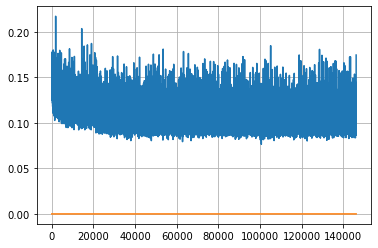

Epoch: 375, iteration 0, loss 0.10364580154418945, cov_diff 0.407098532744929 cov_diff train 0.4059596834410539
Epoch: 375, iteration 1, loss 0.09341102838516235, cov_diff 0.4058821104877438 cov_diff train 0.40557343292922743
Epoch: 375, iteration 2, loss 0.10395070910453796, cov_diff 0.41224141434219774 cov_diff train 0.4111613035624349
Epoch: 375, iteration 3, loss 0.11931821703910828, cov_diff 0.4165105470611885 cov_diff train 0.4156516983131617
Epoch: 375, iteration 4, loss 0.08649870753288269, cov_diff 0.40815237454322106 cov_diff train 0.40824162833713157
Epoch: 375, iteration 5, loss 0.1069757342338562, cov_diff 0.4135250680333864 cov_diff train 0.41277316946028675
Epoch: 375, iteration 6, loss 0.10288035869598389, cov_diff 0.41343147320886736 cov_diff train 0.4127274038152423
Epoch: 375, iteration 7, loss 0.09379509091377258, cov_diff 0.4048035731292788 cov_diff train 0.40431929666183575
Epoch: 375, iteration 8, loss 0.1033516526222229, cov_diff 0.4141154107783074 cov_diff trai

Epoch: 375, iteration 78, loss 0.10561138391494751, cov_diff 0.41780584909693286 cov_diff train 0.41651245433161915
Epoch: 375, iteration 79, loss 0.08881556987762451, cov_diff 0.3952693938733726 cov_diff train 0.39467371945691443
Epoch: 375, iteration 80, loss 0.11139535903930664, cov_diff 0.4156394835228922 cov_diff train 0.41474701287182947
Epoch: 375, iteration 81, loss 0.08950552344322205, cov_diff 0.4048019925326388 cov_diff train 0.4045836424487949
Epoch: 375, iteration 82, loss 0.10365736484527588, cov_diff 0.4222998014881032 cov_diff train 0.4210750276924421
Epoch: 375, iteration 83, loss 0.08886918425559998, cov_diff 0.3901655544818543 cov_diff train 0.38975541849735934
Epoch: 375, iteration 84, loss 0.11068204045295715, cov_diff 0.4174550040101237 cov_diff train 0.41665956136339843
Epoch: 375, iteration 85, loss 0.09902220964431763, cov_diff 0.41939574298905274 cov_diff train 0.41880689927678166
Epoch: 375, iteration 86, loss 0.11036735773086548, cov_diff 0.4228811845118297 

Epoch: 375, iteration 155, loss 0.09629565477371216, cov_diff 0.41738990492395556 cov_diff train 0.41649814360963877
Epoch: 375, iteration 156, loss 0.10576179623603821, cov_diff 0.42218362649469937 cov_diff train 0.42153009819178655
Epoch: 375, iteration 157, loss 0.10740461945533752, cov_diff 0.4172908762063931 cov_diff train 0.4165419117656615
Epoch: 375, iteration 158, loss 0.10062786936759949, cov_diff 0.41321053808259667 cov_diff train 0.41337474293478954
Epoch: 375, iteration 159, loss 0.09785059094429016, cov_diff 0.42150393577487877 cov_diff train 0.4204807811960565
Epoch: 375, iteration 160, loss 0.10894232988357544, cov_diff 0.4175902620964614 cov_diff train 0.4171250519086573
Epoch: 375, iteration 161, loss 0.10527464747428894, cov_diff 0.42984095777372117 cov_diff train 0.4288482260215272
Epoch: 375, iteration 162, loss 0.10495606064796448, cov_diff 0.4114063368082582 cov_diff train 0.410766328656527
Epoch: 375, iteration 163, loss 0.11009392142295837, cov_diff 0.409144084

Epoch: 375, iteration 232, loss 0.10081571340560913, cov_diff 0.4184864337078575 cov_diff train 0.41813677885141826
Epoch: 375, iteration 233, loss 0.10106030106544495, cov_diff 0.42149362860814205 cov_diff train 0.4209289961791008
Epoch: 375, iteration 234, loss 0.091795414686203, cov_diff 0.4159603763398567 cov_diff train 0.41518100922861473
Epoch: 375, iteration 235, loss 0.10280147194862366, cov_diff 0.4139176869646129 cov_diff train 0.41346346178780946
Epoch: 375, iteration 236, loss 0.0975702702999115, cov_diff 0.41377982559235316 cov_diff train 0.412950786276979
Epoch: 375, iteration 237, loss 0.1120779812335968, cov_diff 0.41260741418858776 cov_diff train 0.41163448520400414
Epoch: 375, iteration 238, loss 0.10286504030227661, cov_diff 0.413781563716525 cov_diff train 0.4137720129511392
Epoch: 375, iteration 239, loss 0.10657370090484619, cov_diff 0.4174067297222177 cov_diff train 0.41630311960914257
Epoch: 375, iteration 240, loss 0.10943776369094849, cov_diff 0.41614955802182

Epoch: 375, iteration 309, loss 0.09233331680297852, cov_diff 0.41856334669708095 cov_diff train 0.41782026165332203
Epoch: 375, iteration 310, loss 0.10037139058113098, cov_diff 0.41693219965986783 cov_diff train 0.41634256701644046
Epoch: 375, iteration 311, loss 0.09960880875587463, cov_diff 0.40569298725878705 cov_diff train 0.4044195609602578
Epoch: 375, iteration 312, loss 0.10320177674293518, cov_diff 0.4187546385881552 cov_diff train 0.41834997553141756
Epoch: 375, iteration 313, loss 0.09982836246490479, cov_diff 0.40627121708443675 cov_diff train 0.4047600719682672
Epoch: 375, iteration 314, loss 0.10545194149017334, cov_diff 0.41273804437123457 cov_diff train 0.41228243400278547
Epoch: 375, iteration 315, loss 0.10577136278152466, cov_diff 0.419558532460795 cov_diff train 0.4186675279324942
Epoch: 375, iteration 316, loss 0.10745283961296082, cov_diff 0.43203502743583005 cov_diff train 0.430691555513298
Epoch: 375, iteration 317, loss 0.10044041275978088, cov_diff 0.41251369

Epoch: 375, iteration 388, loss 0.10558348894119263, cov_diff 0.4177967658897895 cov_diff train 0.4171509848649433
Epoch: 375, iteration 389, loss 0.10032269358634949, cov_diff 0.41742160950544704 cov_diff train 0.41650039734220273
Epoch: 375, iteration 390, loss 0.15701895952224731, cov_diff 0.4486072903765721 cov_diff train 0.4465836070460549


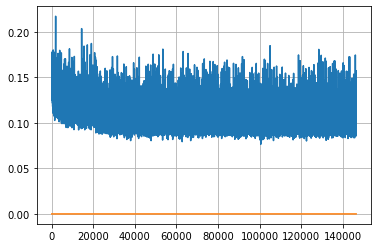

Epoch: 376, iteration 0, loss 0.0971342921257019, cov_diff 0.4146619333814194 cov_diff train 0.41356650823414737
Epoch: 376, iteration 1, loss 0.09354481101036072, cov_diff 0.3858069806207922 cov_diff train 0.3855516417255541
Epoch: 376, iteration 2, loss 0.1061793863773346, cov_diff 0.4161233627647494 cov_diff train 0.41507719090314743
Epoch: 376, iteration 3, loss 0.09896892309188843, cov_diff 0.4182185326857583 cov_diff train 0.41768389677927054
Epoch: 376, iteration 4, loss 0.10520145297050476, cov_diff 0.41321629831349993 cov_diff train 0.4129870540480115
Epoch: 376, iteration 5, loss 0.10426199436187744, cov_diff 0.4062365915924316 cov_diff train 0.40567423235840355
Epoch: 376, iteration 6, loss 0.09753802418708801, cov_diff 0.4069383471946118 cov_diff train 0.4063871079719632
Epoch: 376, iteration 7, loss 0.1020858883857727, cov_diff 0.41641003883654887 cov_diff train 0.41524073703495895
Epoch: 376, iteration 8, loss 0.10000601410865784, cov_diff 0.40755086390974876 cov_diff tra

Epoch: 376, iteration 75, loss 0.09336110949516296, cov_diff 0.40601133819605534 cov_diff train 0.4048854226302018
Epoch: 376, iteration 76, loss 0.10728922486305237, cov_diff 0.42559142553468354 cov_diff train 0.4249129578040703
Epoch: 376, iteration 77, loss 0.10559588670730591, cov_diff 0.40171586412834914 cov_diff train 0.4011309935108754
Epoch: 376, iteration 78, loss 0.09569007158279419, cov_diff 0.4138245949064363 cov_diff train 0.4127687756032487
Epoch: 376, iteration 79, loss 0.09516870975494385, cov_diff 0.40739268622993174 cov_diff train 0.407148679637714
Epoch: 376, iteration 80, loss 0.09993839263916016, cov_diff 0.4239407794786452 cov_diff train 0.4228955176652482
Epoch: 376, iteration 81, loss 0.11745363473892212, cov_diff 0.4075530739736172 cov_diff train 0.40717826111936656
Epoch: 376, iteration 82, loss 0.09649115800857544, cov_diff 0.4116877405700787 cov_diff train 0.4117817680220784
Epoch: 376, iteration 83, loss 0.10092535614967346, cov_diff 0.41511407552160084 cov

Epoch: 376, iteration 151, loss 0.10330337285995483, cov_diff 0.41949726738846554 cov_diff train 0.41852206410993553
Epoch: 376, iteration 152, loss 0.10689038038253784, cov_diff 0.4083797294834237 cov_diff train 0.4085904064434809
Epoch: 376, iteration 153, loss 0.09502330422401428, cov_diff 0.4115800898013712 cov_diff train 0.41138105181092594
Epoch: 376, iteration 154, loss 0.1155788004398346, cov_diff 0.42107116256823995 cov_diff train 0.42099897300639166
Epoch: 376, iteration 155, loss 0.09586554765701294, cov_diff 0.42073386207327024 cov_diff train 0.42007865354969093
Epoch: 376, iteration 156, loss 0.10523122549057007, cov_diff 0.4281395463303815 cov_diff train 0.42776169052610913
Epoch: 376, iteration 157, loss 0.09634143114089966, cov_diff 0.41846400146542895 cov_diff train 0.417970705861067
Epoch: 376, iteration 158, loss 0.10914576053619385, cov_diff 0.41160024703396053 cov_diff train 0.4102748444835449
Epoch: 376, iteration 159, loss 0.09903386235237122, cov_diff 0.42054908

Epoch: 376, iteration 227, loss 0.11712983250617981, cov_diff 0.4053481473955124 cov_diff train 0.40564247768713135
Epoch: 376, iteration 228, loss 0.10322427749633789, cov_diff 0.4039431911039033 cov_diff train 0.4040474647318655
Epoch: 376, iteration 229, loss 0.10768908262252808, cov_diff 0.40744536197977743 cov_diff train 0.4075800198448853
Epoch: 376, iteration 230, loss 0.09892144799232483, cov_diff 0.4171919243802671 cov_diff train 0.41719361212830663
Epoch: 376, iteration 231, loss 0.10397472977638245, cov_diff 0.41766932094698445 cov_diff train 0.41791199369380666
Epoch: 376, iteration 232, loss 0.11548575758934021, cov_diff 0.4081422282184341 cov_diff train 0.4078734735321897
Epoch: 376, iteration 233, loss 0.10954263806343079, cov_diff 0.4177117124597838 cov_diff train 0.41750461306933345
Epoch: 376, iteration 234, loss 0.10351520776748657, cov_diff 0.41044480493819313 cov_diff train 0.4104282411719546
Epoch: 376, iteration 235, loss 0.10289806127548218, cov_diff 0.418194824

Epoch: 376, iteration 304, loss 0.11585742235183716, cov_diff 0.42912873290801307 cov_diff train 0.42922175705166127
Epoch: 376, iteration 305, loss 0.10471969842910767, cov_diff 0.4289627075682004 cov_diff train 0.42837143187751203
Epoch: 376, iteration 306, loss 0.09716463088989258, cov_diff 0.40708535393370493 cov_diff train 0.4069264156958497
Epoch: 376, iteration 307, loss 0.10912308096885681, cov_diff 0.4253934032085374 cov_diff train 0.4251375028426751
Epoch: 376, iteration 308, loss 0.10578525066375732, cov_diff 0.4139708729882977 cov_diff train 0.4133363944720339
Epoch: 376, iteration 309, loss 0.09154561161994934, cov_diff 0.411963664102955 cov_diff train 0.4114708689351256
Epoch: 376, iteration 310, loss 0.0965363085269928, cov_diff 0.4022235033005514 cov_diff train 0.40263467248493945
Epoch: 376, iteration 311, loss 0.09709683060646057, cov_diff 0.4193269149370986 cov_diff train 0.4194216079379868
Epoch: 376, iteration 312, loss 0.10059550404548645, cov_diff 0.4191063091694

Epoch: 376, iteration 382, loss 0.10278633236885071, cov_diff 0.4236711114369117 cov_diff train 0.4222446445633807
Epoch: 376, iteration 383, loss 0.1056186854839325, cov_diff 0.4223065796443942 cov_diff train 0.42151974407641657
Epoch: 376, iteration 384, loss 0.10580563545227051, cov_diff 0.41267092947538925 cov_diff train 0.4121770032145105
Epoch: 376, iteration 385, loss 0.09650355577468872, cov_diff 0.40634141432390064 cov_diff train 0.40553754800514014
Epoch: 376, iteration 386, loss 0.11943516135215759, cov_diff 0.4264851291585989 cov_diff train 0.42490790661855304
Epoch: 376, iteration 387, loss 0.10662400722503662, cov_diff 0.42041030359848364 cov_diff train 0.4189998481966759
Epoch: 376, iteration 388, loss 0.10171368718147278, cov_diff 0.42439701651849476 cov_diff train 0.4235772515695834
Epoch: 376, iteration 389, loss 0.10313668847084045, cov_diff 0.4192017496662845 cov_diff train 0.4176558757435525
Epoch: 376, iteration 390, loss 0.1465209722518921, cov_diff 0.44750145943

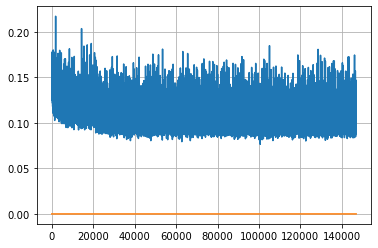

Epoch: 377, iteration 0, loss 0.09653466939926147, cov_diff 0.4039592460676894 cov_diff train 0.40345644391149016
Epoch: 377, iteration 1, loss 0.10488772392272949, cov_diff 0.42371399558059114 cov_diff train 0.42212257630204697
Epoch: 377, iteration 2, loss 0.12397345900535583, cov_diff 0.4127177683869028 cov_diff train 0.41085209356491803
Epoch: 377, iteration 3, loss 0.09544172883033752, cov_diff 0.39579602550126064 cov_diff train 0.3954715390843446
Epoch: 377, iteration 4, loss 0.11347377300262451, cov_diff 0.4019972052986039 cov_diff train 0.40149441928103136
Epoch: 377, iteration 5, loss 0.11892589926719666, cov_diff 0.40607041670125776 cov_diff train 0.40624071307195514
Epoch: 377, iteration 6, loss 0.10508736968040466, cov_diff 0.4148573416783878 cov_diff train 0.41397266559377116
Epoch: 377, iteration 7, loss 0.10093572735786438, cov_diff 0.40984129768595495 cov_diff train 0.40954229783220103
Epoch: 377, iteration 8, loss 0.10674047470092773, cov_diff 0.4206968223866044 cov_di

Epoch: 377, iteration 79, loss 0.10599842667579651, cov_diff 0.4107782589109998 cov_diff train 0.4105526441548785
Epoch: 377, iteration 80, loss 0.11093705892562866, cov_diff 0.42096558279184426 cov_diff train 0.4202304148125956
Epoch: 377, iteration 81, loss 0.10521319508552551, cov_diff 0.41421585158654073 cov_diff train 0.41332869047322857
Epoch: 377, iteration 82, loss 0.09811019897460938, cov_diff 0.40559482217609294 cov_diff train 0.4056128673060705
Epoch: 377, iteration 83, loss 0.09761732816696167, cov_diff 0.40076842205155233 cov_diff train 0.40028773904363396
Epoch: 377, iteration 84, loss 0.11222454905509949, cov_diff 0.41716753597888934 cov_diff train 0.4153435363430936
Epoch: 377, iteration 85, loss 0.09317070245742798, cov_diff 0.4177319324335618 cov_diff train 0.4165023316148497
Epoch: 377, iteration 86, loss 0.1066858172416687, cov_diff 0.4092537348529398 cov_diff train 0.4081950393306615
Epoch: 377, iteration 87, loss 0.09707111120223999, cov_diff 0.4145353529280926 co

Epoch: 377, iteration 155, loss 0.09841421246528625, cov_diff 0.4036086605982255 cov_diff train 0.4039987513794164
Epoch: 377, iteration 156, loss 0.11688214540481567, cov_diff 0.4235543159361618 cov_diff train 0.4239013476321435
Epoch: 377, iteration 157, loss 0.09892338514328003, cov_diff 0.4244844683729126 cov_diff train 0.42405407035602005
Epoch: 377, iteration 158, loss 0.09541183710098267, cov_diff 0.39733849657567516 cov_diff train 0.3966595713086384
Epoch: 377, iteration 159, loss 0.09860217571258545, cov_diff 0.42224694323680284 cov_diff train 0.42178876020481143
Epoch: 377, iteration 160, loss 0.106350839138031, cov_diff 0.4211925786852355 cov_diff train 0.42170304795288305
Epoch: 377, iteration 161, loss 0.10727068781852722, cov_diff 0.4101275754524108 cov_diff train 0.40982395035534347
Epoch: 377, iteration 162, loss 0.09509766101837158, cov_diff 0.4115274634946466 cov_diff train 0.4105733898601816
Epoch: 377, iteration 163, loss 0.09949392080307007, cov_diff 0.415450503459

Epoch: 377, iteration 235, loss 0.1080721914768219, cov_diff 0.41382697293642207 cov_diff train 0.41405811078563703
Epoch: 377, iteration 236, loss 0.10817855596542358, cov_diff 0.42521051539824367 cov_diff train 0.42471460527232074
Epoch: 377, iteration 237, loss 0.1039312481880188, cov_diff 0.413795472127079 cov_diff train 0.4136102195471777
Epoch: 377, iteration 238, loss 0.105499267578125, cov_diff 0.40600367410909016 cov_diff train 0.4054828254361767
Epoch: 377, iteration 239, loss 0.11239239573478699, cov_diff 0.4249327471194725 cov_diff train 0.4238042024029796
Epoch: 377, iteration 240, loss 0.1193891167640686, cov_diff 0.4198721024220454 cov_diff train 0.41912889272585246
Epoch: 377, iteration 241, loss 0.09815943241119385, cov_diff 0.40604665571355214 cov_diff train 0.40443873469827674
Epoch: 377, iteration 242, loss 0.10405230522155762, cov_diff 0.40409734744014675 cov_diff train 0.4032175463927896
Epoch: 377, iteration 243, loss 0.09597423672676086, cov_diff 0.4066430004386

Epoch: 377, iteration 312, loss 0.11050033569335938, cov_diff 0.4061560967778899 cov_diff train 0.4057205039362401
Epoch: 377, iteration 313, loss 0.10550272464752197, cov_diff 0.4128166943241333 cov_diff train 0.4120663678168233
Epoch: 377, iteration 314, loss 0.10328492522239685, cov_diff 0.41235033530050597 cov_diff train 0.4126301879392957
Epoch: 377, iteration 315, loss 0.11408370733261108, cov_diff 0.4096224776923614 cov_diff train 0.4089258050020872
Epoch: 377, iteration 316, loss 0.10303431749343872, cov_diff 0.41028206509893084 cov_diff train 0.4099909632287267
Epoch: 377, iteration 317, loss 0.1265086531639099, cov_diff 0.4087828384389382 cov_diff train 0.4069017467991013
Epoch: 377, iteration 318, loss 0.10344246029853821, cov_diff 0.4239191153795539 cov_diff train 0.4229109269708688
Epoch: 377, iteration 319, loss 0.10377764701843262, cov_diff 0.41895161108334916 cov_diff train 0.41834019871534445
Epoch: 377, iteration 320, loss 0.09191694855690002, cov_diff 0.4173478522853

Epoch: 377, iteration 389, loss 0.08863323926925659, cov_diff 0.40404823211541385 cov_diff train 0.4033572579417194
Epoch: 377, iteration 390, loss 0.14826655387878418, cov_diff 0.4585167711944249 cov_diff train 0.4562821516929193


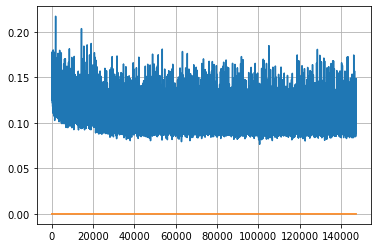

Epoch: 378, iteration 0, loss 0.10908621549606323, cov_diff 0.408732342983987 cov_diff train 0.40736844726891336
Epoch: 378, iteration 1, loss 0.10258886218070984, cov_diff 0.41429268396102364 cov_diff train 0.41314614449998005
Epoch: 378, iteration 2, loss 0.09188801050186157, cov_diff 0.41944440801025473 cov_diff train 0.41883222497432954
Epoch: 378, iteration 3, loss 0.0923580527305603, cov_diff 0.41319422145674695 cov_diff train 0.41290528925061937
Epoch: 378, iteration 4, loss 0.09417781233787537, cov_diff 0.41609496713494154 cov_diff train 0.41510943973750675
Epoch: 378, iteration 5, loss 0.09977108240127563, cov_diff 0.4143826489194569 cov_diff train 0.41325487586984194
Epoch: 378, iteration 6, loss 0.10348770022392273, cov_diff 0.4078743943586376 cov_diff train 0.4055089277025282
Epoch: 378, iteration 7, loss 0.10289663076400757, cov_diff 0.42099813983554607 cov_diff train 0.4201432379909443
Epoch: 378, iteration 8, loss 0.10436663031578064, cov_diff 0.41483906032324835 cov_dif

Epoch: 378, iteration 77, loss 0.10942971706390381, cov_diff 0.4092339505333429 cov_diff train 0.40892140035250163
Epoch: 378, iteration 78, loss 0.1080482006072998, cov_diff 0.42278092386813526 cov_diff train 0.4213562818186642
Epoch: 378, iteration 79, loss 0.1223897933959961, cov_diff 0.407801693814076 cov_diff train 0.40822661151953066
Epoch: 378, iteration 80, loss 0.11150392889976501, cov_diff 0.40760562063300704 cov_diff train 0.4071696240612576
Epoch: 378, iteration 81, loss 0.10512784123420715, cov_diff 0.4088440877653175 cov_diff train 0.40890817094007953
Epoch: 378, iteration 82, loss 0.1089819073677063, cov_diff 0.4119580250811448 cov_diff train 0.4106270044256663
Epoch: 378, iteration 83, loss 0.10996150970458984, cov_diff 0.41594421395802295 cov_diff train 0.4150501075256996
Epoch: 378, iteration 84, loss 0.10636842250823975, cov_diff 0.41090670892356174 cov_diff train 0.4103349093474315
Epoch: 378, iteration 85, loss 0.09998396039009094, cov_diff 0.4083743444677498 cov_d

Epoch: 378, iteration 153, loss 0.10711964964866638, cov_diff 0.41410684498115136 cov_diff train 0.41294200825187694
Epoch: 378, iteration 154, loss 0.11248758435249329, cov_diff 0.4082829970566707 cov_diff train 0.4072359494185773
Epoch: 378, iteration 155, loss 0.10059857368469238, cov_diff 0.41677512274513717 cov_diff train 0.41591644136493267
Epoch: 378, iteration 156, loss 0.10110417008399963, cov_diff 0.4183397592708266 cov_diff train 0.4173706317044722
Epoch: 378, iteration 157, loss 0.1119350790977478, cov_diff 0.4101121306042036 cov_diff train 0.41106293340257444
Epoch: 378, iteration 158, loss 0.10886615514755249, cov_diff 0.4128008467090898 cov_diff train 0.412409675895693
Epoch: 378, iteration 159, loss 0.09594810009002686, cov_diff 0.41334797887474645 cov_diff train 0.4122763173616869
Epoch: 378, iteration 160, loss 0.10612624883651733, cov_diff 0.40834602149547816 cov_diff train 0.40824764647580497
Epoch: 378, iteration 161, loss 0.10349729657173157, cov_diff 0.3941670886

Epoch: 378, iteration 230, loss 0.11681607365608215, cov_diff 0.4192816171506983 cov_diff train 0.41750654704856516
Epoch: 378, iteration 231, loss 0.10577955842018127, cov_diff 0.41623201158715223 cov_diff train 0.41446167687011254
Epoch: 378, iteration 232, loss 0.09998714923858643, cov_diff 0.41577661122157494 cov_diff train 0.41549313442971164
Epoch: 378, iteration 233, loss 0.10088855028152466, cov_diff 0.4045093022162044 cov_diff train 0.40289460234662167
Epoch: 378, iteration 234, loss 0.10661590099334717, cov_diff 0.40307369196733206 cov_diff train 0.4029511538809893
Epoch: 378, iteration 235, loss 0.09069371223449707, cov_diff 0.41637574280006384 cov_diff train 0.41478741591672674
Epoch: 378, iteration 236, loss 0.11188268661499023, cov_diff 0.407045353868141 cov_diff train 0.4063314742276044
Epoch: 378, iteration 237, loss 0.10701894760131836, cov_diff 0.40766820776511425 cov_diff train 0.4070873059894221
Epoch: 378, iteration 238, loss 0.10269632935523987, cov_diff 0.4083296

Epoch: 378, iteration 305, loss 0.1089516282081604, cov_diff 0.41655921715629707 cov_diff train 0.4162920969513471
Epoch: 378, iteration 306, loss 0.10502871870994568, cov_diff 0.4064635924389458 cov_diff train 0.4050387536827087
Epoch: 378, iteration 307, loss 0.10323262214660645, cov_diff 0.4109525649243285 cov_diff train 0.4108679893251883
Epoch: 378, iteration 308, loss 0.09931793808937073, cov_diff 0.42006111638267196 cov_diff train 0.41942221607832203
Epoch: 378, iteration 309, loss 0.10301139950752258, cov_diff 0.4132365595186038 cov_diff train 0.4129564668459191
Epoch: 378, iteration 310, loss 0.10676419734954834, cov_diff 0.4233838309373288 cov_diff train 0.4223289192265238
Epoch: 378, iteration 311, loss 0.10782909393310547, cov_diff 0.4095300633081862 cov_diff train 0.40894668456766886
Epoch: 378, iteration 312, loss 0.09262913465499878, cov_diff 0.41535828353494186 cov_diff train 0.41461487929325935
Epoch: 378, iteration 313, loss 0.09864512085914612, cov_diff 0.39689199827

Epoch: 378, iteration 383, loss 0.10585302114486694, cov_diff 0.40910326921231904 cov_diff train 0.40930544654390927
Epoch: 378, iteration 384, loss 0.10382843017578125, cov_diff 0.42546200782008947 cov_diff train 0.4251588193445347
Epoch: 378, iteration 385, loss 0.09774711728096008, cov_diff 0.41134771083839433 cov_diff train 0.4099373383227819
Epoch: 378, iteration 386, loss 0.10054275393486023, cov_diff 0.41681284604482993 cov_diff train 0.41660629586874104
Epoch: 378, iteration 387, loss 0.10140323638916016, cov_diff 0.41704275774341737 cov_diff train 0.41611622788017866
Epoch: 378, iteration 388, loss 0.10744869709014893, cov_diff 0.4094322572527326 cov_diff train 0.4079323928377827
Epoch: 378, iteration 389, loss 0.10207998752593994, cov_diff 0.40594465958557785 cov_diff train 0.4052409763779975
Epoch: 378, iteration 390, loss 0.13897693157196045, cov_diff 0.4438181513632688 cov_diff train 0.4428540058091618


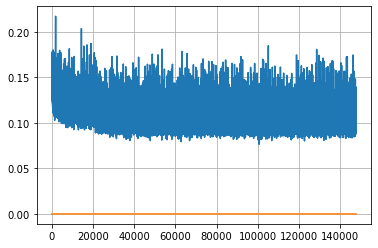

Epoch: 379, iteration 0, loss 0.10290709137916565, cov_diff 0.4165071067601535 cov_diff train 0.41620122081693633
Epoch: 379, iteration 1, loss 0.10943150520324707, cov_diff 0.4037772554264338 cov_diff train 0.40328421181186314
Epoch: 379, iteration 2, loss 0.11399033665657043, cov_diff 0.4149539154073964 cov_diff train 0.41429341480262927
Epoch: 379, iteration 3, loss 0.10164645314216614, cov_diff 0.4117578992506277 cov_diff train 0.41167038686638413
Epoch: 379, iteration 4, loss 0.1056903600692749, cov_diff 0.4022028710262459 cov_diff train 0.4021640537907167
Epoch: 379, iteration 5, loss 0.10077333450317383, cov_diff 0.40268984610156044 cov_diff train 0.40214090496615723
Epoch: 379, iteration 6, loss 0.10556930303573608, cov_diff 0.40475400720208915 cov_diff train 0.40513848313120315
Epoch: 379, iteration 7, loss 0.09892052412033081, cov_diff 0.40480419788438937 cov_diff train 0.40436867968083196
Epoch: 379, iteration 8, loss 0.10296240448951721, cov_diff 0.41273104639225866 cov_dif

Epoch: 379, iteration 77, loss 0.09822309017181396, cov_diff 0.41700944823244496 cov_diff train 0.41638113467096105
Epoch: 379, iteration 78, loss 0.09685054421424866, cov_diff 0.40390829835229625 cov_diff train 0.40237204447654024
Epoch: 379, iteration 79, loss 0.10704174637794495, cov_diff 0.4042811498627426 cov_diff train 0.40416157519832685
Epoch: 379, iteration 80, loss 0.10095402598381042, cov_diff 0.4042650361226463 cov_diff train 0.404046282230569
Epoch: 379, iteration 81, loss 0.10276815295219421, cov_diff 0.42043899772746673 cov_diff train 0.4194105182929734
Epoch: 379, iteration 82, loss 0.09414172172546387, cov_diff 0.41690463517694026 cov_diff train 0.4165030150889114
Epoch: 379, iteration 83, loss 0.11546587944030762, cov_diff 0.40827939800335655 cov_diff train 0.40826539387240646
Epoch: 379, iteration 84, loss 0.11537864804267883, cov_diff 0.41353007817961834 cov_diff train 0.41242711325741094
Epoch: 379, iteration 85, loss 0.1000497043132782, cov_diff 0.4024927636753941

Epoch: 379, iteration 156, loss 0.11169171333312988, cov_diff 0.41930315052267775 cov_diff train 0.4185707930904137
Epoch: 379, iteration 157, loss 0.10939353704452515, cov_diff 0.41527954443749765 cov_diff train 0.41454241497731004
Epoch: 379, iteration 158, loss 0.10959860682487488, cov_diff 0.40574132386083395 cov_diff train 0.40567187142863487
Epoch: 379, iteration 159, loss 0.11887559294700623, cov_diff 0.41205969636358974 cov_diff train 0.41138949385043505
Epoch: 379, iteration 160, loss 0.10742217302322388, cov_diff 0.40654594049471676 cov_diff train 0.40641111926767054
Epoch: 379, iteration 161, loss 0.1063874363899231, cov_diff 0.40044132560131046 cov_diff train 0.4009569873392258
Epoch: 379, iteration 162, loss 0.09966424107551575, cov_diff 0.40673581519326235 cov_diff train 0.40570571628270163
Epoch: 379, iteration 163, loss 0.10678485035896301, cov_diff 0.4116939346154287 cov_diff train 0.41105048869869737
Epoch: 379, iteration 164, loss 0.0919812023639679, cov_diff 0.39990

Epoch: 379, iteration 230, loss 0.10393700003623962, cov_diff 0.40309357222858516 cov_diff train 0.40290778811633654
Epoch: 379, iteration 231, loss 0.10806912183761597, cov_diff 0.41917504167384406 cov_diff train 0.41874603858969056
Epoch: 379, iteration 232, loss 0.10813623666763306, cov_diff 0.41003301442330864 cov_diff train 0.40950036512388666
Epoch: 379, iteration 233, loss 0.09703689813613892, cov_diff 0.4139635275844999 cov_diff train 0.41324681661425855
Epoch: 379, iteration 234, loss 0.1031658947467804, cov_diff 0.3993332467391139 cov_diff train 0.3992384132380587
Epoch: 379, iteration 235, loss 0.10136592388153076, cov_diff 0.4109305508065213 cov_diff train 0.40995877219491095
Epoch: 379, iteration 236, loss 0.09205177426338196, cov_diff 0.40930301037970795 cov_diff train 0.40921201430055437
Epoch: 379, iteration 237, loss 0.10365620255470276, cov_diff 0.4200865817341895 cov_diff train 0.41837962810427753
Epoch: 379, iteration 238, loss 0.10008534789085388, cov_diff 0.408670

Epoch: 379, iteration 305, loss 0.10884252190589905, cov_diff 0.4057319500524399 cov_diff train 0.40549464457886975
Epoch: 379, iteration 306, loss 0.09758353233337402, cov_diff 0.39884027507961145 cov_diff train 0.3980678654851284
Epoch: 379, iteration 307, loss 0.11557725071907043, cov_diff 0.4094318885083009 cov_diff train 0.409041907127582
Epoch: 379, iteration 308, loss 0.09952890872955322, cov_diff 0.4031216065277952 cov_diff train 0.402148912765054
Epoch: 379, iteration 309, loss 0.09327396750450134, cov_diff 0.40278311585261933 cov_diff train 0.4029105321750457
Epoch: 379, iteration 310, loss 0.11459559202194214, cov_diff 0.414664050166977 cov_diff train 0.4124513862163471
Epoch: 379, iteration 311, loss 0.10743063688278198, cov_diff 0.41866842078601973 cov_diff train 0.41804710430410963
Epoch: 379, iteration 312, loss 0.1009969413280487, cov_diff 0.4177747116927858 cov_diff train 0.4167299001251079
Epoch: 379, iteration 313, loss 0.10273236036300659, cov_diff 0.415953396916670

Epoch: 379, iteration 377, loss 0.11037832498550415, cov_diff 0.413932367802302 cov_diff train 0.4137387289417719
Epoch: 379, iteration 378, loss 0.09607887268066406, cov_diff 0.41349496147335363 cov_diff train 0.4122521829415254
Epoch: 379, iteration 379, loss 0.108965665102005, cov_diff 0.40462641123868215 cov_diff train 0.40353902816710197
Epoch: 379, iteration 380, loss 0.10734143853187561, cov_diff 0.41183605664652256 cov_diff train 0.4106777770576697
Epoch: 379, iteration 381, loss 0.09907349944114685, cov_diff 0.4161546983809485 cov_diff train 0.41468896127156
Epoch: 379, iteration 382, loss 0.10270646214485168, cov_diff 0.40699783256282196 cov_diff train 0.4071636758479431
Epoch: 379, iteration 383, loss 0.10832875967025757, cov_diff 0.41741752692317396 cov_diff train 0.41648836397384115
Epoch: 379, iteration 384, loss 0.10035672783851624, cov_diff 0.41090579433020175 cov_diff train 0.40986343210144077
Epoch: 379, iteration 385, loss 0.099660724401474, cov_diff 0.41033313229932

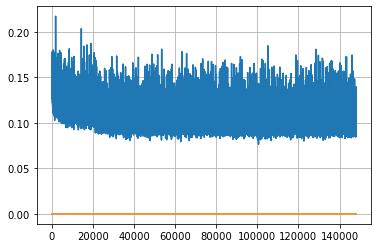

Epoch: 380, iteration 0, loss 0.0990132987499237, cov_diff 0.42224936215299247 cov_diff train 0.4198903237242937
Epoch: 380, iteration 1, loss 0.11158308386802673, cov_diff 0.4107526860001268 cov_diff train 0.40928941559593635
Epoch: 380, iteration 2, loss 0.10264268517494202, cov_diff 0.4022369788537107 cov_diff train 0.4012506074196463
Epoch: 380, iteration 3, loss 0.12155789136886597, cov_diff 0.40904274453997236 cov_diff train 0.40861450808808236
Epoch: 380, iteration 4, loss 0.10386520624160767, cov_diff 0.421579852427116 cov_diff train 0.4211319833305165
Epoch: 380, iteration 5, loss 0.09147998690605164, cov_diff 0.40922969645706425 cov_diff train 0.40794843281480625
Epoch: 380, iteration 6, loss 0.10733488202095032, cov_diff 0.4016947118804147 cov_diff train 0.4023751731483081
Epoch: 380, iteration 7, loss 0.09520405530929565, cov_diff 0.4160935929664295 cov_diff train 0.41591466113319875
Epoch: 380, iteration 8, loss 0.11052191257476807, cov_diff 0.4164094912420867 cov_diff tra

Epoch: 380, iteration 73, loss 0.10406136512756348, cov_diff 0.406767651316525 cov_diff train 0.4063526089624492
Epoch: 380, iteration 74, loss 0.09949791431427002, cov_diff 0.4153978502836315 cov_diff train 0.4149124189583108
Epoch: 380, iteration 75, loss 0.1121852695941925, cov_diff 0.40497416226861255 cov_diff train 0.40508779582204046
Epoch: 380, iteration 76, loss 0.09180819988250732, cov_diff 0.39963603691980676 cov_diff train 0.3987231538415239
Epoch: 380, iteration 77, loss 0.10758602619171143, cov_diff 0.40975357590280553 cov_diff train 0.40965691587140884
Epoch: 380, iteration 78, loss 0.10992807149887085, cov_diff 0.4105123287026638 cov_diff train 0.40966559539675607
Epoch: 380, iteration 79, loss 0.09686905145645142, cov_diff 0.4091082943785537 cov_diff train 0.4081553699868122
Epoch: 380, iteration 80, loss 0.10921165347099304, cov_diff 0.40786307604698147 cov_diff train 0.40766122643232144
Epoch: 380, iteration 81, loss 0.09783220291137695, cov_diff 0.4089583645595269 co

Epoch: 380, iteration 147, loss 0.10588371753692627, cov_diff 0.3953164405350365 cov_diff train 0.3947903857202845
Epoch: 380, iteration 148, loss 0.10708481073379517, cov_diff 0.41909912283415046 cov_diff train 0.4180808116452969
Epoch: 380, iteration 149, loss 0.09753289818763733, cov_diff 0.42330326786734507 cov_diff train 0.42313986046596985
Epoch: 380, iteration 150, loss 0.11732348799705505, cov_diff 0.41820250293023575 cov_diff train 0.4167384621072068
Epoch: 380, iteration 151, loss 0.11615031957626343, cov_diff 0.4098306820562694 cov_diff train 0.4091277674965695
Epoch: 380, iteration 152, loss 0.10571378469467163, cov_diff 0.40417830854578424 cov_diff train 0.40330374415967196
Epoch: 380, iteration 153, loss 0.10800349712371826, cov_diff 0.4133956728762152 cov_diff train 0.41219979718009786
Epoch: 380, iteration 154, loss 0.10288912057876587, cov_diff 0.41783112182752774 cov_diff train 0.4175663747951024
Epoch: 380, iteration 155, loss 0.09745064377784729, cov_diff 0.41056281

Epoch: 380, iteration 223, loss 0.10800263285636902, cov_diff 0.39610489175114344 cov_diff train 0.39506568752174004
Epoch: 380, iteration 224, loss 0.11239704489707947, cov_diff 0.412392331395857 cov_diff train 0.4115952395837577
Epoch: 380, iteration 225, loss 0.11311835050582886, cov_diff 0.4054567965499791 cov_diff train 0.40516104796127134
Epoch: 380, iteration 226, loss 0.10061120986938477, cov_diff 0.4201764853849533 cov_diff train 0.41983588342778266
Epoch: 380, iteration 227, loss 0.10719329118728638, cov_diff 0.41646003372090473 cov_diff train 0.41535993390489223
Epoch: 380, iteration 228, loss 0.11050593852996826, cov_diff 0.40896579861935867 cov_diff train 0.40898162107075375
Epoch: 380, iteration 229, loss 0.11633181571960449, cov_diff 0.42321491273358525 cov_diff train 0.42297767438970824
Epoch: 380, iteration 230, loss 0.1069110631942749, cov_diff 0.4098656610601169 cov_diff train 0.4088319919330926
Epoch: 380, iteration 231, loss 0.10886132717132568, cov_diff 0.40210022

Epoch: 380, iteration 300, loss 0.10543060302734375, cov_diff 0.40608691235623945 cov_diff train 0.40617497327032354
Epoch: 380, iteration 301, loss 0.10395905375480652, cov_diff 0.40794886607122455 cov_diff train 0.4084991998757284
Epoch: 380, iteration 302, loss 0.10559764504432678, cov_diff 0.4011958669620405 cov_diff train 0.3998104327279176
Epoch: 380, iteration 303, loss 0.08642521500587463, cov_diff 0.3995035253563455 cov_diff train 0.3995759491080112
Epoch: 380, iteration 304, loss 0.09711158275604248, cov_diff 0.41050868746798963 cov_diff train 0.41053351251054143
Epoch: 380, iteration 305, loss 0.11160129308700562, cov_diff 0.41235956550600816 cov_diff train 0.4125304615269959
Epoch: 380, iteration 306, loss 0.11146724224090576, cov_diff 0.41182709322732947 cov_diff train 0.4114425934893197
Epoch: 380, iteration 307, loss 0.1099504828453064, cov_diff 0.41973372071887793 cov_diff train 0.4184471371568118
Epoch: 380, iteration 308, loss 0.10350891947746277, cov_diff 0.418368980

Epoch: 380, iteration 377, loss 0.10237297415733337, cov_diff 0.40085127761618133 cov_diff train 0.4000555092867175
Epoch: 380, iteration 378, loss 0.10041329264640808, cov_diff 0.40805681099282276 cov_diff train 0.4075030429189778
Epoch: 380, iteration 379, loss 0.09801355004310608, cov_diff 0.39197324348287643 cov_diff train 0.3909796795375407
Epoch: 380, iteration 380, loss 0.1079481840133667, cov_diff 0.4249014911374796 cov_diff train 0.4237802666004332
Epoch: 380, iteration 381, loss 0.10537898540496826, cov_diff 0.41549304575683144 cov_diff train 0.4149055885730752
Epoch: 380, iteration 382, loss 0.09258043766021729, cov_diff 0.38861073984887906 cov_diff train 0.38829344763266777
Epoch: 380, iteration 383, loss 0.11062932014465332, cov_diff 0.4100175128151023 cov_diff train 0.409562073352325
Epoch: 380, iteration 384, loss 0.10088154673576355, cov_diff 0.41019640150705644 cov_diff train 0.4092707367001823
Epoch: 380, iteration 385, loss 0.10983994603157043, cov_diff 0.42436316444

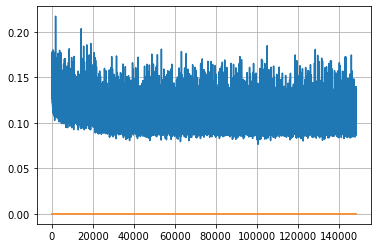

Epoch: 381, iteration 0, loss 0.10299050807952881, cov_diff 0.4093258638877987 cov_diff train 0.4086099025478699
Epoch: 381, iteration 1, loss 0.10284161567687988, cov_diff 0.4118821352800295 cov_diff train 0.41082702909789204
Epoch: 381, iteration 2, loss 0.11142346262931824, cov_diff 0.3898484512576289 cov_diff train 0.38858774174879
Epoch: 381, iteration 3, loss 0.12139862775802612, cov_diff 0.4057208543864931 cov_diff train 0.40511091176562003
Epoch: 381, iteration 4, loss 0.10922360420227051, cov_diff 0.4031877902106082 cov_diff train 0.40219172966096806
Epoch: 381, iteration 5, loss 0.11125785112380981, cov_diff 0.40230660647598543 cov_diff train 0.4017713215973075
Epoch: 381, iteration 6, loss 0.10819077491760254, cov_diff 0.41289894160831975 cov_diff train 0.41207852877242096
Epoch: 381, iteration 7, loss 0.10505539178848267, cov_diff 0.4179079939115474 cov_diff train 0.4178477986609379
Epoch: 381, iteration 8, loss 0.10084322094917297, cov_diff 0.4087872628270687 cov_diff trai

Epoch: 381, iteration 75, loss 0.11064553260803223, cov_diff 0.42231947198218645 cov_diff train 0.4211389357995511
Epoch: 381, iteration 76, loss 0.09969553351402283, cov_diff 0.40589205295660963 cov_diff train 0.4046905716298603
Epoch: 381, iteration 77, loss 0.10833445191383362, cov_diff 0.395259479430831 cov_diff train 0.39470690703767247
Epoch: 381, iteration 78, loss 0.12101313471794128, cov_diff 0.4020282950143824 cov_diff train 0.40138008322825186
Epoch: 381, iteration 79, loss 0.105619877576828, cov_diff 0.4169228744612021 cov_diff train 0.41606105769842094
Epoch: 381, iteration 80, loss 0.09623104333877563, cov_diff 0.39820929527886806 cov_diff train 0.3973548726567248
Epoch: 381, iteration 81, loss 0.11316019296646118, cov_diff 0.40574564755616943 cov_diff train 0.4052459852792607
Epoch: 381, iteration 82, loss 0.10050228238105774, cov_diff 0.4052629165199888 cov_diff train 0.4048706982471634
Epoch: 381, iteration 83, loss 0.10647895932197571, cov_diff 0.41482120735575473 cov

Epoch: 381, iteration 149, loss 0.10929358005523682, cov_diff 0.4067450412363022 cov_diff train 0.4066284092086431
Epoch: 381, iteration 150, loss 0.1123073399066925, cov_diff 0.41958940442929943 cov_diff train 0.4178180981777805
Epoch: 381, iteration 151, loss 0.09277033805847168, cov_diff 0.4096459256014306 cov_diff train 0.40862053094072487
Epoch: 381, iteration 152, loss 0.10070282220840454, cov_diff 0.41016526801954495 cov_diff train 0.4088798315678538
Epoch: 381, iteration 153, loss 0.10975116491317749, cov_diff 0.4002011964615465 cov_diff train 0.39966061508416445
Epoch: 381, iteration 154, loss 0.0968647301197052, cov_diff 0.4160799624041223 cov_diff train 0.4150995843790198
Epoch: 381, iteration 155, loss 0.10548651218414307, cov_diff 0.400488110059506 cov_diff train 0.39941681812008495
Epoch: 381, iteration 156, loss 0.10762926936149597, cov_diff 0.41519823944117384 cov_diff train 0.4147373161326624
Epoch: 381, iteration 157, loss 0.10238707065582275, cov_diff 0.4078513932215

Epoch: 381, iteration 225, loss 0.10408443212509155, cov_diff 0.40853431513121014 cov_diff train 0.4070203085043188
Epoch: 381, iteration 226, loss 0.10201534628868103, cov_diff 0.42757886356792785 cov_diff train 0.42748393413957203
Epoch: 381, iteration 227, loss 0.11847454309463501, cov_diff 0.39532682505298805 cov_diff train 0.39481958968394715
Epoch: 381, iteration 228, loss 0.09698060154914856, cov_diff 0.40892824380728904 cov_diff train 0.40896283202630257
Epoch: 381, iteration 229, loss 0.10670030117034912, cov_diff 0.41457069119280837 cov_diff train 0.4148986775083426
Epoch: 381, iteration 230, loss 0.09686163067817688, cov_diff 0.40894289051803295 cov_diff train 0.40941675818447
Epoch: 381, iteration 231, loss 0.10842052102088928, cov_diff 0.41795729680695315 cov_diff train 0.4178103265519369
Epoch: 381, iteration 232, loss 0.10274249315261841, cov_diff 0.40581057133388543 cov_diff train 0.4059148425891363
Epoch: 381, iteration 233, loss 0.09733912348747253, cov_diff 0.4220263

Epoch: 381, iteration 302, loss 0.10480049252510071, cov_diff 0.4233637143103439 cov_diff train 0.4227151879406108
Epoch: 381, iteration 303, loss 0.10644185543060303, cov_diff 0.41480785242478957 cov_diff train 0.4140981703478478
Epoch: 381, iteration 304, loss 0.11332747340202332, cov_diff 0.40228264633414246 cov_diff train 0.401294117870039
Epoch: 381, iteration 305, loss 0.11992788314819336, cov_diff 0.4080572196812552 cov_diff train 0.4072549560001285
Epoch: 381, iteration 306, loss 0.11109963059425354, cov_diff 0.4272168866294804 cov_diff train 0.4254852485725904
Epoch: 381, iteration 307, loss 0.11588209867477417, cov_diff 0.3956582432835583 cov_diff train 0.3950935889423328
Epoch: 381, iteration 308, loss 0.102225661277771, cov_diff 0.4172069386676518 cov_diff train 0.41621876267427804
Epoch: 381, iteration 309, loss 0.11454904079437256, cov_diff 0.40447335693649666 cov_diff train 0.4045634476665905
Epoch: 381, iteration 310, loss 0.1142113208770752, cov_diff 0.4108468434428020

Epoch: 381, iteration 379, loss 0.10747015476226807, cov_diff 0.3991889560082791 cov_diff train 0.3988876913597362
Epoch: 381, iteration 380, loss 0.10936698317527771, cov_diff 0.4080591092581538 cov_diff train 0.40797155300861976
Epoch: 381, iteration 381, loss 0.09609270095825195, cov_diff 0.4056986052855847 cov_diff train 0.40514420106793986
Epoch: 381, iteration 382, loss 0.1194969117641449, cov_diff 0.40769199470733725 cov_diff train 0.4079250524572886
Epoch: 381, iteration 383, loss 0.09423872828483582, cov_diff 0.4016873991031782 cov_diff train 0.40156599983225644
Epoch: 381, iteration 384, loss 0.10404399037361145, cov_diff 0.41851969675648093 cov_diff train 0.41706799087442453
Epoch: 381, iteration 385, loss 0.10126528143882751, cov_diff 0.4123845550505629 cov_diff train 0.41084417932301354
Epoch: 381, iteration 386, loss 0.10670274496078491, cov_diff 0.40712573912029987 cov_diff train 0.40704038052938313
Epoch: 381, iteration 387, loss 0.10676896572113037, cov_diff 0.41562704

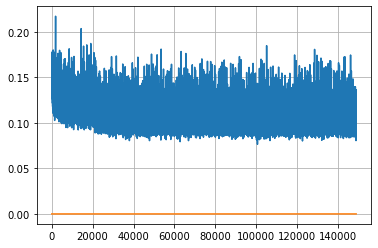

Epoch: 382, iteration 0, loss 0.10273149609565735, cov_diff 0.39926904885042286 cov_diff train 0.39832361986510584
Epoch: 382, iteration 1, loss 0.10413563251495361, cov_diff 0.4146250201496726 cov_diff train 0.41403342937257204
Epoch: 382, iteration 2, loss 0.10692241787910461, cov_diff 0.41463013050275094 cov_diff train 0.4141922993530219
Epoch: 382, iteration 3, loss 0.10665571689605713, cov_diff 0.4239068635244134 cov_diff train 0.4224670526558106
Epoch: 382, iteration 4, loss 0.10069882869720459, cov_diff 0.4085021847488536 cov_diff train 0.40803034130542176
Epoch: 382, iteration 5, loss 0.10418790578842163, cov_diff 0.41817216033259685 cov_diff train 0.41700021282765665
Epoch: 382, iteration 6, loss 0.10622432827949524, cov_diff 0.4148940861427123 cov_diff train 0.41391281527949825
Epoch: 382, iteration 7, loss 0.10251033306121826, cov_diff 0.41139375132281575 cov_diff train 0.40996497949872734
Epoch: 382, iteration 8, loss 0.11862209439277649, cov_diff 0.40795631018470324 cov_di

Epoch: 382, iteration 77, loss 0.10529962182044983, cov_diff 0.4135092584473687 cov_diff train 0.4128748180308304
Epoch: 382, iteration 78, loss 0.10228878259658813, cov_diff 0.4079638543583168 cov_diff train 0.40697495739402545
Epoch: 382, iteration 79, loss 0.09848257899284363, cov_diff 0.4118292556182097 cov_diff train 0.41116278223045744
Epoch: 382, iteration 80, loss 0.09808748960494995, cov_diff 0.4042464301468091 cov_diff train 0.40418870530324724
Epoch: 382, iteration 81, loss 0.09563735127449036, cov_diff 0.40585745424834996 cov_diff train 0.40365160518528675
Epoch: 382, iteration 82, loss 0.09816950559616089, cov_diff 0.4073120510187763 cov_diff train 0.40643931627447877
Epoch: 382, iteration 83, loss 0.10925805568695068, cov_diff 0.41154727747442094 cov_diff train 0.4106812906862343
Epoch: 382, iteration 84, loss 0.09559908509254456, cov_diff 0.4138095597969348 cov_diff train 0.4123730314842584
Epoch: 382, iteration 85, loss 0.1092679500579834, cov_diff 0.39919853962885427 c

Epoch: 382, iteration 155, loss 0.11119002103805542, cov_diff 0.4169291299565467 cov_diff train 0.41694045922781575
Epoch: 382, iteration 156, loss 0.09759485721588135, cov_diff 0.4234688398355742 cov_diff train 0.42237488075384977
Epoch: 382, iteration 157, loss 0.10063678026199341, cov_diff 0.41103474084439545 cov_diff train 0.4082100284779414
Epoch: 382, iteration 158, loss 0.12067112326622009, cov_diff 0.40460375919470315 cov_diff train 0.402942359524479
Epoch: 382, iteration 159, loss 0.1025283932685852, cov_diff 0.41185598747760005 cov_diff train 0.4106380213500441
Epoch: 382, iteration 160, loss 0.09665659070014954, cov_diff 0.4029969318514567 cov_diff train 0.4012557918588684
Epoch: 382, iteration 161, loss 0.09038197994232178, cov_diff 0.3931360572234617 cov_diff train 0.3920846489726757
Epoch: 382, iteration 162, loss 0.11488473415374756, cov_diff 0.41100507875358716 cov_diff train 0.41033211284182863
Epoch: 382, iteration 163, loss 0.10207077860832214, cov_diff 0.39045862143

Epoch: 382, iteration 233, loss 0.10978466272354126, cov_diff 0.41686536077888753 cov_diff train 0.4155549647178838
Epoch: 382, iteration 234, loss 0.1088789701461792, cov_diff 0.42526654606413994 cov_diff train 0.42483886160327156
Epoch: 382, iteration 235, loss 0.10069915652275085, cov_diff 0.41900397905844905 cov_diff train 0.41834166651717786
Epoch: 382, iteration 236, loss 0.11593860387802124, cov_diff 0.41288813783863365 cov_diff train 0.41131864296802606
Epoch: 382, iteration 237, loss 0.1121596097946167, cov_diff 0.4069801234095675 cov_diff train 0.4069608896848575
Epoch: 382, iteration 238, loss 0.1023811399936676, cov_diff 0.40695108242815836 cov_diff train 0.4053310427576008
Epoch: 382, iteration 239, loss 0.11100530624389648, cov_diff 0.4085805454049934 cov_diff train 0.40803694023887777
Epoch: 382, iteration 240, loss 0.0914044976234436, cov_diff 0.42110236539234414 cov_diff train 0.4203905288825975
Epoch: 382, iteration 241, loss 0.09471669793128967, cov_diff 0.4046831574

Epoch: 382, iteration 309, loss 0.09878316521644592, cov_diff 0.4002553414565681 cov_diff train 0.3994714161178471
Epoch: 382, iteration 310, loss 0.09695270657539368, cov_diff 0.40472762585937877 cov_diff train 0.4047681111602809
Epoch: 382, iteration 311, loss 0.09068283438682556, cov_diff 0.40018044704267564 cov_diff train 0.3992593537540589
Epoch: 382, iteration 312, loss 0.103159099817276, cov_diff 0.40598313863409224 cov_diff train 0.405343075347951
Epoch: 382, iteration 313, loss 0.09714245796203613, cov_diff 0.4029457358898535 cov_diff train 0.4030797242952997
Epoch: 382, iteration 314, loss 0.10319757461547852, cov_diff 0.39931237968608974 cov_diff train 0.3986408019446932
Epoch: 382, iteration 315, loss 0.10349249839782715, cov_diff 0.42197536713904327 cov_diff train 0.42107891225384425
Epoch: 382, iteration 316, loss 0.09877067804336548, cov_diff 0.4017747773617549 cov_diff train 0.40077597213483523
Epoch: 382, iteration 317, loss 0.10000044107437134, cov_diff 0.410134620243

Epoch: 382, iteration 386, loss 0.09571969509124756, cov_diff 0.40589557598891773 cov_diff train 0.40593667133907146
Epoch: 382, iteration 387, loss 0.11257898807525635, cov_diff 0.3984222867661855 cov_diff train 0.398240229415748
Epoch: 382, iteration 388, loss 0.10071760416030884, cov_diff 0.4068387100709501 cov_diff train 0.4058461811294396
Epoch: 382, iteration 389, loss 0.09931018948554993, cov_diff 0.41370534248970536 cov_diff train 0.4130925626354393
Epoch: 382, iteration 390, loss 0.13201996684074402, cov_diff 0.43683885858570665 cov_diff train 0.4354594588350755


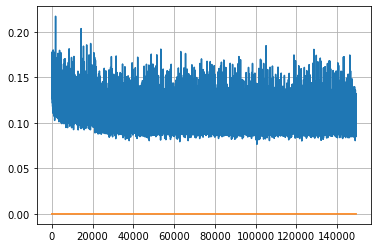

Epoch: 383, iteration 0, loss 0.10261780023574829, cov_diff 0.41285225493487787 cov_diff train 0.41310738244059725
Epoch: 383, iteration 1, loss 0.10683786869049072, cov_diff 0.40673346594206833 cov_diff train 0.40691587357543973
Epoch: 383, iteration 2, loss 0.11493939161300659, cov_diff 0.4240808599077039 cov_diff train 0.4233525675077712
Epoch: 383, iteration 3, loss 0.10714399814605713, cov_diff 0.4089505486136945 cov_diff train 0.40876378758794457
Epoch: 383, iteration 4, loss 0.10221263766288757, cov_diff 0.4216509079203121 cov_diff train 0.42075461009542797
Epoch: 383, iteration 5, loss 0.102498859167099, cov_diff 0.4037945505069753 cov_diff train 0.40362283726482556
Epoch: 383, iteration 6, loss 0.10096123814582825, cov_diff 0.420323123471573 cov_diff train 0.4185621657537055
Epoch: 383, iteration 7, loss 0.10523530840873718, cov_diff 0.41599307252814105 cov_diff train 0.41457023345031163
Epoch: 383, iteration 8, loss 0.10507157444953918, cov_diff 0.4202481185368815 cov_diff tr

Epoch: 383, iteration 77, loss 0.10030210018157959, cov_diff 0.4105761664500834 cov_diff train 0.41072329542931335
Epoch: 383, iteration 78, loss 0.10480237007141113, cov_diff 0.4212731672410108 cov_diff train 0.42127945546219775
Epoch: 383, iteration 79, loss 0.10327965021133423, cov_diff 0.41432333691569867 cov_diff train 0.4142285141384749
Epoch: 383, iteration 80, loss 0.10605728626251221, cov_diff 0.430732670943546 cov_diff train 0.42973186265021984
Epoch: 383, iteration 81, loss 0.1025422215461731, cov_diff 0.4185559327008185 cov_diff train 0.41796597596955637
Epoch: 383, iteration 82, loss 0.11548730731010437, cov_diff 0.41658884011051983 cov_diff train 0.41508749673705037
Epoch: 383, iteration 83, loss 0.10928386449813843, cov_diff 0.415708379189773 cov_diff train 0.41534351691850635
Epoch: 383, iteration 84, loss 0.10468557476997375, cov_diff 0.4117014014520684 cov_diff train 0.4111392373437801
Epoch: 383, iteration 85, loss 0.10154426097869873, cov_diff 0.4044971223469711 cov

Epoch: 383, iteration 154, loss 0.10634469985961914, cov_diff 0.4186968848966377 cov_diff train 0.4176393886893601
Epoch: 383, iteration 155, loss 0.11187517642974854, cov_diff 0.4210622249588916 cov_diff train 0.4213324736569786
Epoch: 383, iteration 156, loss 0.11470302939414978, cov_diff 0.4127660450816776 cov_diff train 0.41176918682706704
Epoch: 383, iteration 157, loss 0.10101118683815002, cov_diff 0.41991841386151657 cov_diff train 0.4199129254229998
Epoch: 383, iteration 158, loss 0.09648513793945312, cov_diff 0.4147973078517192 cov_diff train 0.4132319157204488
Epoch: 383, iteration 159, loss 0.11118856072425842, cov_diff 0.409518046824048 cov_diff train 0.4090239623511521
Epoch: 383, iteration 160, loss 0.10989740490913391, cov_diff 0.42748526173167395 cov_diff train 0.4261660930047182
Epoch: 383, iteration 161, loss 0.09911099076271057, cov_diff 0.42439736922183163 cov_diff train 0.4233195737652719
Epoch: 383, iteration 162, loss 0.10453468561172485, cov_diff 0.4147246767883

Epoch: 383, iteration 231, loss 0.09320461750030518, cov_diff 0.4056241427644113 cov_diff train 0.4046897637023056
Epoch: 383, iteration 232, loss 0.1055992841720581, cov_diff 0.4095413479530751 cov_diff train 0.4091032347821483
Epoch: 383, iteration 233, loss 0.11143255233764648, cov_diff 0.41068468823290616 cov_diff train 0.4103262125408519
Epoch: 383, iteration 234, loss 0.10631439089775085, cov_diff 0.3920340351114919 cov_diff train 0.39118704373096097
Epoch: 383, iteration 235, loss 0.11237144470214844, cov_diff 0.40693234767614284 cov_diff train 0.4065782565925263
Epoch: 383, iteration 236, loss 0.11001506447792053, cov_diff 0.41264670471070686 cov_diff train 0.41174312530287915
Epoch: 383, iteration 237, loss 0.09585034847259521, cov_diff 0.40267531637037285 cov_diff train 0.4029554243651493
Epoch: 383, iteration 238, loss 0.09669283032417297, cov_diff 0.3983004767531916 cov_diff train 0.3980699066527777
Epoch: 383, iteration 239, loss 0.11161386966705322, cov_diff 0.41229324266

Epoch: 383, iteration 308, loss 0.11221787333488464, cov_diff 0.40413387889482155 cov_diff train 0.4037184930335171
Epoch: 383, iteration 309, loss 0.10462239384651184, cov_diff 0.40371159776841375 cov_diff train 0.4031987380610171
Epoch: 383, iteration 310, loss 0.10680198669433594, cov_diff 0.4174140710282813 cov_diff train 0.4171194489255817
Epoch: 383, iteration 311, loss 0.10473558306694031, cov_diff 0.4031985187881702 cov_diff train 0.4027106901701397
Epoch: 383, iteration 312, loss 0.10299250483512878, cov_diff 0.4007052449605745 cov_diff train 0.3998508508532538
Epoch: 383, iteration 313, loss 0.10515907406806946, cov_diff 0.4129640252138966 cov_diff train 0.41244821902950013
Epoch: 383, iteration 314, loss 0.09757837653160095, cov_diff 0.40817168773207746 cov_diff train 0.40729152673700725
Epoch: 383, iteration 315, loss 0.11175116896629333, cov_diff 0.4159808186335648 cov_diff train 0.4158523541616964
Epoch: 383, iteration 316, loss 0.10206630825996399, cov_diff 0.40831822500

Epoch: 383, iteration 385, loss 0.09890630841255188, cov_diff 0.4238249299792108 cov_diff train 0.42349943180245553
Epoch: 383, iteration 386, loss 0.11123540997505188, cov_diff 0.4188436017163879 cov_diff train 0.4183615706599927
Epoch: 383, iteration 387, loss 0.10491782426834106, cov_diff 0.4220233801306119 cov_diff train 0.4221230470278464
Epoch: 383, iteration 388, loss 0.10093951225280762, cov_diff 0.4188009163025604 cov_diff train 0.41828079620484004
Epoch: 383, iteration 389, loss 0.10402563214302063, cov_diff 0.4156930299954921 cov_diff train 0.41378547097702695
Epoch: 383, iteration 390, loss 0.13947492837905884, cov_diff 0.4542779085989134 cov_diff train 0.4526961340305975


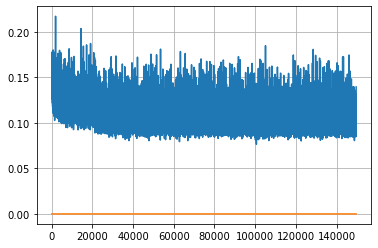

Epoch: 384, iteration 0, loss 0.0987946093082428, cov_diff 0.42178085018226996 cov_diff train 0.4202639529471856
Epoch: 384, iteration 1, loss 0.1090293824672699, cov_diff 0.40704196644328167 cov_diff train 0.40735399044000853
Epoch: 384, iteration 2, loss 0.10031899809837341, cov_diff 0.4196985475114575 cov_diff train 0.41831895488261417
Epoch: 384, iteration 3, loss 0.10860481858253479, cov_diff 0.40643011929402195 cov_diff train 0.40553787104259603
Epoch: 384, iteration 4, loss 0.09548953175544739, cov_diff 0.42118411967602193 cov_diff train 0.4206397908192208
Epoch: 384, iteration 5, loss 0.10271373391151428, cov_diff 0.42479170136049993 cov_diff train 0.42331991984138845
Epoch: 384, iteration 6, loss 0.10741838812828064, cov_diff 0.41476030753744975 cov_diff train 0.41478280965593245
Epoch: 384, iteration 7, loss 0.09612411260604858, cov_diff 0.41979265581140535 cov_diff train 0.4195449833496386
Epoch: 384, iteration 8, loss 0.10330703854560852, cov_diff 0.41152838092374455 cov_di

Epoch: 384, iteration 77, loss 0.09137305617332458, cov_diff 0.39899198345573744 cov_diff train 0.3971927743294905
Epoch: 384, iteration 78, loss 0.1013650894165039, cov_diff 0.41312484902494057 cov_diff train 0.4117800792982752
Epoch: 384, iteration 79, loss 0.09627196192741394, cov_diff 0.3969370186274163 cov_diff train 0.39666822211290553
Epoch: 384, iteration 80, loss 0.0915168821811676, cov_diff 0.41752172601379645 cov_diff train 0.41725730800048927
Epoch: 384, iteration 81, loss 0.1067231297492981, cov_diff 0.4141050917049847 cov_diff train 0.41380457733375414
Epoch: 384, iteration 82, loss 0.11757022142410278, cov_diff 0.4144302565340901 cov_diff train 0.4142921779695041
Epoch: 384, iteration 83, loss 0.09422463178634644, cov_diff 0.41891807034425416 cov_diff train 0.4186878579357653
Epoch: 384, iteration 84, loss 0.1124042272567749, cov_diff 0.411820076507839 cov_diff train 0.41078812932328534
Epoch: 384, iteration 85, loss 0.10772570967674255, cov_diff 0.41578097757017685 cov_

Epoch: 384, iteration 155, loss 0.087685227394104, cov_diff 0.41658386938154873 cov_diff train 0.4167482286972051
Epoch: 384, iteration 156, loss 0.11368513107299805, cov_diff 0.4227764334806578 cov_diff train 0.4225586726794287
Epoch: 384, iteration 157, loss 0.11440238356590271, cov_diff 0.40194700942983247 cov_diff train 0.40060026896416456
Epoch: 384, iteration 158, loss 0.10843774676322937, cov_diff 0.40918836505499045 cov_diff train 0.40892662172006866
Epoch: 384, iteration 159, loss 0.09800168871879578, cov_diff 0.41032533445411107 cov_diff train 0.4102796008349517
Epoch: 384, iteration 160, loss 0.10328274965286255, cov_diff 0.40292551037060864 cov_diff train 0.40233391579274147
Epoch: 384, iteration 161, loss 0.1072719395160675, cov_diff 0.4062084981858009 cov_diff train 0.40545569301160234
Epoch: 384, iteration 162, loss 0.105923593044281, cov_diff 0.4237739853335347 cov_diff train 0.42332668528024203
Epoch: 384, iteration 163, loss 0.10066026449203491, cov_diff 0.40481904981

Epoch: 384, iteration 232, loss 0.11655008792877197, cov_diff 0.42007404646497953 cov_diff train 0.4198201226119129
Epoch: 384, iteration 233, loss 0.09619128704071045, cov_diff 0.4247487460785504 cov_diff train 0.4247311053602656
Epoch: 384, iteration 234, loss 0.09992504119873047, cov_diff 0.42050565140728924 cov_diff train 0.42021404971038856
Epoch: 384, iteration 235, loss 0.11388030648231506, cov_diff 0.4225414905888834 cov_diff train 0.42224072036610366
Epoch: 384, iteration 236, loss 0.10395899415016174, cov_diff 0.42212533414792247 cov_diff train 0.42131947958767463
Epoch: 384, iteration 237, loss 0.0928003191947937, cov_diff 0.4133304045060222 cov_diff train 0.4134285336306474
Epoch: 384, iteration 238, loss 0.10895103216171265, cov_diff 0.41653559427938436 cov_diff train 0.4159711671440426
Epoch: 384, iteration 239, loss 0.10084372758865356, cov_diff 0.41067234514124484 cov_diff train 0.4105740501160676
Epoch: 384, iteration 240, loss 0.10371291637420654, cov_diff 0.419126217

Epoch: 384, iteration 310, loss 0.09247350692749023, cov_diff 0.4173239980175239 cov_diff train 0.4174339454277579
Epoch: 384, iteration 311, loss 0.11162102222442627, cov_diff 0.4243812688949684 cov_diff train 0.4232965957775325
Epoch: 384, iteration 312, loss 0.09651738405227661, cov_diff 0.42029564870298525 cov_diff train 0.4202528421128289
Epoch: 384, iteration 313, loss 0.09673511981964111, cov_diff 0.405135012287872 cov_diff train 0.4045223996919561
Epoch: 384, iteration 314, loss 0.10061711072921753, cov_diff 0.40045758167523343 cov_diff train 0.40045995948770935
Epoch: 384, iteration 315, loss 0.10524502396583557, cov_diff 0.4034392198428875 cov_diff train 0.40314720203040305
Epoch: 384, iteration 316, loss 0.09432843327522278, cov_diff 0.40580303829749725 cov_diff train 0.4054497633214973
Epoch: 384, iteration 317, loss 0.1101449728012085, cov_diff 0.40784290989707295 cov_diff train 0.4069919600555304
Epoch: 384, iteration 318, loss 0.09928786754608154, cov_diff 0.414658145943

Epoch: 384, iteration 388, loss 0.10443833470344543, cov_diff 0.42505104252388487 cov_diff train 0.4238697562303799
Epoch: 384, iteration 389, loss 0.10976243019104004, cov_diff 0.40862260469849576 cov_diff train 0.4086682725798382
Epoch: 384, iteration 390, loss 0.1685977578163147, cov_diff 0.4414015082339239 cov_diff train 0.44167683453595247


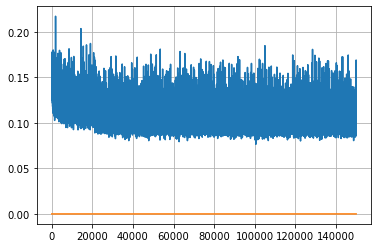

Epoch: 385, iteration 0, loss 0.10745653510093689, cov_diff 0.4116073844349138 cov_diff train 0.4112695618954817
Epoch: 385, iteration 1, loss 0.11624297499656677, cov_diff 0.4150845494269296 cov_diff train 0.4144478260639697
Epoch: 385, iteration 2, loss 0.11465805768966675, cov_diff 0.4159084871678745 cov_diff train 0.41497189068550017
Epoch: 385, iteration 3, loss 0.10989239811897278, cov_diff 0.40442249532581376 cov_diff train 0.40445255270576536
Epoch: 385, iteration 4, loss 0.101763516664505, cov_diff 0.4124298744269073 cov_diff train 0.4124138790229467
Epoch: 385, iteration 5, loss 0.1135227382183075, cov_diff 0.41170560993691446 cov_diff train 0.41097117288962437
Epoch: 385, iteration 6, loss 0.10538816452026367, cov_diff 0.40993694109023354 cov_diff train 0.4091292793400367
Epoch: 385, iteration 7, loss 0.10418909788131714, cov_diff 0.4130393478783166 cov_diff train 0.4127946932723675
Epoch: 385, iteration 8, loss 0.08781540393829346, cov_diff 0.4161212189639937 cov_diff train

Epoch: 385, iteration 73, loss 0.10075545310974121, cov_diff 0.40522064343967046 cov_diff train 0.40466548374430644
Epoch: 385, iteration 74, loss 0.10502409934997559, cov_diff 0.4142481961262867 cov_diff train 0.41386123574104505
Epoch: 385, iteration 75, loss 0.10519436001777649, cov_diff 0.4077862241157161 cov_diff train 0.40767588501022994
Epoch: 385, iteration 76, loss 0.09929177165031433, cov_diff 0.40775400848330984 cov_diff train 0.4076300331928106
Epoch: 385, iteration 77, loss 0.11432963609695435, cov_diff 0.41195047777587324 cov_diff train 0.41206216890696173
Epoch: 385, iteration 78, loss 0.10786935687065125, cov_diff 0.4167111061773512 cov_diff train 0.41636873409372366
Epoch: 385, iteration 79, loss 0.09701180458068848, cov_diff 0.418023574642847 cov_diff train 0.41790302699135234
Epoch: 385, iteration 80, loss 0.10110628604888916, cov_diff 0.4330047934054456 cov_diff train 0.43221817039011895
Epoch: 385, iteration 81, loss 0.10320350527763367, cov_diff 0.413851790974783 

Epoch: 385, iteration 149, loss 0.09923624992370605, cov_diff 0.4105995497024641 cov_diff train 0.4106974603186243
Epoch: 385, iteration 150, loss 0.10077247023582458, cov_diff 0.414749954613686 cov_diff train 0.4137377134245973
Epoch: 385, iteration 151, loss 0.09954127669334412, cov_diff 0.41268889501944667 cov_diff train 0.4118639385523752
Epoch: 385, iteration 152, loss 0.1035187840461731, cov_diff 0.4225493475139162 cov_diff train 0.42162460031237275
Epoch: 385, iteration 153, loss 0.10269245505332947, cov_diff 0.41516070314943493 cov_diff train 0.41424438405325686
Epoch: 385, iteration 154, loss 0.10382631421089172, cov_diff 0.4207162085266042 cov_diff train 0.4188480231820713
Epoch: 385, iteration 155, loss 0.10373800992965698, cov_diff 0.41173357494535306 cov_diff train 0.4112126910758751
Epoch: 385, iteration 156, loss 0.10183483362197876, cov_diff 0.3965149345503066 cov_diff train 0.3958444800208907
Epoch: 385, iteration 157, loss 0.10995334386825562, cov_diff 0.4223652879679

Epoch: 385, iteration 225, loss 0.12247142195701599, cov_diff 0.4173269230081481 cov_diff train 0.41724975590589025
Epoch: 385, iteration 226, loss 0.1145738959312439, cov_diff 0.40982200680349445 cov_diff train 0.4104198733656809
Epoch: 385, iteration 227, loss 0.1180572509765625, cov_diff 0.4145826428602952 cov_diff train 0.4143673250024978
Epoch: 385, iteration 228, loss 0.09389933943748474, cov_diff 0.4133918115993476 cov_diff train 0.4127479912100427
Epoch: 385, iteration 229, loss 0.10184383392333984, cov_diff 0.41924911173064255 cov_diff train 0.41835882594970414
Epoch: 385, iteration 230, loss 0.0925469696521759, cov_diff 0.4146407445361092 cov_diff train 0.4144298124148475
Epoch: 385, iteration 231, loss 0.11681842803955078, cov_diff 0.4296674967893932 cov_diff train 0.42787519181248757
Epoch: 385, iteration 232, loss 0.10289996862411499, cov_diff 0.4127793230889067 cov_diff train 0.41253369786698313
Epoch: 385, iteration 233, loss 0.1091277003288269, cov_diff 0.41213724533896

Epoch: 385, iteration 302, loss 0.10674867033958435, cov_diff 0.42232301735921896 cov_diff train 0.421787422410081
Epoch: 385, iteration 303, loss 0.1032976508140564, cov_diff 0.41077647551007296 cov_diff train 0.4100604574331634
Epoch: 385, iteration 304, loss 0.11062490940093994, cov_diff 0.41559077486995233 cov_diff train 0.41518989655630834
Epoch: 385, iteration 305, loss 0.09943762421607971, cov_diff 0.4036050645198174 cov_diff train 0.40246222784493985
Epoch: 385, iteration 306, loss 0.09515619277954102, cov_diff 0.41314345857388446 cov_diff train 0.4124528183807365
Epoch: 385, iteration 307, loss 0.09876447916030884, cov_diff 0.4269672085971737 cov_diff train 0.4249787397303485
Epoch: 385, iteration 308, loss 0.08785384893417358, cov_diff 0.4225389603933542 cov_diff train 0.421946143386653
Epoch: 385, iteration 309, loss 0.10486915707588196, cov_diff 0.4191520230410175 cov_diff train 0.4188392681635723
Epoch: 385, iteration 310, loss 0.11011326313018799, cov_diff 0.4152458450268

Epoch: 385, iteration 380, loss 0.09998130798339844, cov_diff 0.4055519234146866 cov_diff train 0.404510411286877
Epoch: 385, iteration 381, loss 0.10172480344772339, cov_diff 0.4195044016962684 cov_diff train 0.4180077726150114
Epoch: 385, iteration 382, loss 0.09759184718132019, cov_diff 0.4070746209274463 cov_diff train 0.40617182665410856
Epoch: 385, iteration 383, loss 0.09027200937271118, cov_diff 0.41337349380860994 cov_diff train 0.4127851982631612
Epoch: 385, iteration 384, loss 0.11971932649612427, cov_diff 0.4174828604613453 cov_diff train 0.4160477994132272
Epoch: 385, iteration 385, loss 0.0917883813381195, cov_diff 0.41595397994899647 cov_diff train 0.4145975855083362
Epoch: 385, iteration 386, loss 0.09208264946937561, cov_diff 0.4082960524469722 cov_diff train 0.40798245368707386
Epoch: 385, iteration 387, loss 0.11472630500793457, cov_diff 0.4030060745130111 cov_diff train 0.402209231412761
Epoch: 385, iteration 388, loss 0.11209642887115479, cov_diff 0.412712138759038

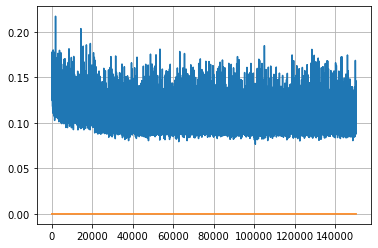

Epoch: 386, iteration 0, loss 0.10755369067192078, cov_diff 0.4003778905527484 cov_diff train 0.3996214597928296
Epoch: 386, iteration 1, loss 0.1035107970237732, cov_diff 0.4150671192706732 cov_diff train 0.4153303598261489
Epoch: 386, iteration 2, loss 0.09106239676475525, cov_diff 0.40586053797088645 cov_diff train 0.405960796045267
Epoch: 386, iteration 3, loss 0.09846901893615723, cov_diff 0.41993859972852127 cov_diff train 0.41951097146181876
Epoch: 386, iteration 4, loss 0.09944835305213928, cov_diff 0.41871967331559884 cov_diff train 0.41715335683876786
Epoch: 386, iteration 5, loss 0.09810850024223328, cov_diff 0.42199865146662363 cov_diff train 0.4220628982014618
Epoch: 386, iteration 6, loss 0.10761404037475586, cov_diff 0.4055161522914375 cov_diff train 0.4052766624048325
Epoch: 386, iteration 7, loss 0.10868275165557861, cov_diff 0.41698796418356027 cov_diff train 0.4163757768299705
Epoch: 386, iteration 8, loss 0.10867935419082642, cov_diff 0.4252962579827469 cov_diff tra

Epoch: 386, iteration 78, loss 0.10107043385505676, cov_diff 0.4090969516929633 cov_diff train 0.4092974050953822
Epoch: 386, iteration 79, loss 0.11268365383148193, cov_diff 0.412897595261183 cov_diff train 0.41119664653994054
Epoch: 386, iteration 80, loss 0.11934655904769897, cov_diff 0.4262005873389039 cov_diff train 0.42588996363829396
Epoch: 386, iteration 81, loss 0.09916669130325317, cov_diff 0.4144521563839906 cov_diff train 0.4143515297142943
Epoch: 386, iteration 82, loss 0.10380819439888, cov_diff 0.4185048206774817 cov_diff train 0.41765143933225757
Epoch: 386, iteration 83, loss 0.11457070708274841, cov_diff 0.41288305905417255 cov_diff train 0.4124116846645188
Epoch: 386, iteration 84, loss 0.11922982335090637, cov_diff 0.40813904305327237 cov_diff train 0.4073159324155653
Epoch: 386, iteration 85, loss 0.11454418301582336, cov_diff 0.42029480064250396 cov_diff train 0.41938613876331265
Epoch: 386, iteration 86, loss 0.10980558395385742, cov_diff 0.4255389393626126 cov_d

Epoch: 386, iteration 156, loss 0.10576388239860535, cov_diff 0.41303197960246035 cov_diff train 0.4121898902655465
Epoch: 386, iteration 157, loss 0.10429918766021729, cov_diff 0.4260103125685629 cov_diff train 0.42507149847999587
Epoch: 386, iteration 158, loss 0.09490463137626648, cov_diff 0.4028375120865614 cov_diff train 0.402217290072274
Epoch: 386, iteration 159, loss 0.11033087968826294, cov_diff 0.4115373661789329 cov_diff train 0.41079269197520923
Epoch: 386, iteration 160, loss 0.10140061378479004, cov_diff 0.40517685137365683 cov_diff train 0.40348109149568073
Epoch: 386, iteration 161, loss 0.1027643084526062, cov_diff 0.41187413368067477 cov_diff train 0.41078601150106253
Epoch: 386, iteration 162, loss 0.09495764970779419, cov_diff 0.42881535919787683 cov_diff train 0.42843673513908187
Epoch: 386, iteration 163, loss 0.10759225487709045, cov_diff 0.40510369496617765 cov_diff train 0.4044291146129877
Epoch: 386, iteration 164, loss 0.10755226016044617, cov_diff 0.40085411

Epoch: 386, iteration 233, loss 0.11290225386619568, cov_diff 0.40271573372159053 cov_diff train 0.4024242600732086
Epoch: 386, iteration 234, loss 0.09966328740119934, cov_diff 0.4070969163252729 cov_diff train 0.4057090054976184
Epoch: 386, iteration 235, loss 0.09950003027915955, cov_diff 0.4072473588192648 cov_diff train 0.4077767888863432
Epoch: 386, iteration 236, loss 0.09952995181083679, cov_diff 0.4089112266405292 cov_diff train 0.4093936108145684
Epoch: 386, iteration 237, loss 0.09577062726020813, cov_diff 0.40270428680729 cov_diff train 0.40228625532757145
Epoch: 386, iteration 238, loss 0.09675675630569458, cov_diff 0.4197854456699338 cov_diff train 0.4194579994695528
Epoch: 386, iteration 239, loss 0.09943631291389465, cov_diff 0.4132872630772982 cov_diff train 0.41270674241528893
Epoch: 386, iteration 240, loss 0.09512698650360107, cov_diff 0.40827674794188684 cov_diff train 0.407908264853569
Epoch: 386, iteration 241, loss 0.10799813270568848, cov_diff 0.399303379089718

Epoch: 386, iteration 311, loss 0.09683054685592651, cov_diff 0.4135934462809385 cov_diff train 0.4124316312971154
Epoch: 386, iteration 312, loss 0.11307018995285034, cov_diff 0.4163362464496118 cov_diff train 0.4159186440379263
Epoch: 386, iteration 313, loss 0.08835083246231079, cov_diff 0.4139068479358963 cov_diff train 0.41305208819045475
Epoch: 386, iteration 314, loss 0.10127586126327515, cov_diff 0.4229170709071473 cov_diff train 0.423449864315204
Epoch: 386, iteration 315, loss 0.09487590193748474, cov_diff 0.4144988687891829 cov_diff train 0.4139000586111375
Epoch: 386, iteration 316, loss 0.0920705795288086, cov_diff 0.40712643571685886 cov_diff train 0.40714024663915743
Epoch: 386, iteration 317, loss 0.10377690196037292, cov_diff 0.41051715285349777 cov_diff train 0.410747832630749
Epoch: 386, iteration 318, loss 0.09891676902770996, cov_diff 0.41652709685802547 cov_diff train 0.4165779143325878
Epoch: 386, iteration 319, loss 0.0941305160522461, cov_diff 0.414411300340942

Epoch: 386, iteration 388, loss 0.11448699235916138, cov_diff 0.4156220070195533 cov_diff train 0.41453859647890395
Epoch: 386, iteration 389, loss 0.10876813530921936, cov_diff 0.4185878658447688 cov_diff train 0.41870568331555796
Epoch: 386, iteration 390, loss 0.15564954280853271, cov_diff 0.4568340841633532 cov_diff train 0.45604504570734833


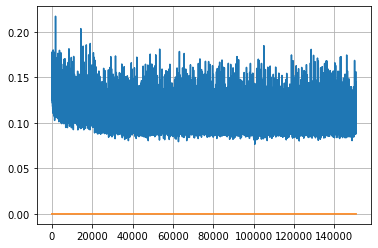

Epoch: 387, iteration 0, loss 0.10364454984664917, cov_diff 0.4011681203502552 cov_diff train 0.40104309962118334
Epoch: 387, iteration 1, loss 0.11117982864379883, cov_diff 0.4111561730849023 cov_diff train 0.4103808112070989
Epoch: 387, iteration 2, loss 0.0997929573059082, cov_diff 0.4059695583729829 cov_diff train 0.4057441895269026
Epoch: 387, iteration 3, loss 0.10233455896377563, cov_diff 0.4145341482212274 cov_diff train 0.4125394752916523
Epoch: 387, iteration 4, loss 0.10290729999542236, cov_diff 0.40795934261122535 cov_diff train 0.40801999227470714
Epoch: 387, iteration 5, loss 0.09614664316177368, cov_diff 0.40017878017546676 cov_diff train 0.4002895573163036
Epoch: 387, iteration 6, loss 0.10237818956375122, cov_diff 0.40782783398919453 cov_diff train 0.40719904987265276
Epoch: 387, iteration 7, loss 0.11082887649536133, cov_diff 0.42474498798885224 cov_diff train 0.42511138454533476
Epoch: 387, iteration 8, loss 0.10248515009880066, cov_diff 0.39603653932117944 cov_diff 

Epoch: 387, iteration 76, loss 0.10701340436935425, cov_diff 0.4097245909863223 cov_diff train 0.4090919420695583
Epoch: 387, iteration 77, loss 0.10395640134811401, cov_diff 0.40913595109473205 cov_diff train 0.40842809147070747
Epoch: 387, iteration 78, loss 0.11142474412918091, cov_diff 0.3995948617725333 cov_diff train 0.3986009157144541
Epoch: 387, iteration 79, loss 0.09246689081192017, cov_diff 0.4067896252953888 cov_diff train 0.40650477894900694
Epoch: 387, iteration 80, loss 0.11257445812225342, cov_diff 0.3881549241203271 cov_diff train 0.3882328415018107
Epoch: 387, iteration 81, loss 0.10297340154647827, cov_diff 0.4055074248511069 cov_diff train 0.4047708363030794
Epoch: 387, iteration 82, loss 0.10087847709655762, cov_diff 0.40812511309260596 cov_diff train 0.4082922606390308
Epoch: 387, iteration 83, loss 0.11364787817001343, cov_diff 0.4124322938371535 cov_diff train 0.4110952651773473
Epoch: 387, iteration 84, loss 0.10098811984062195, cov_diff 0.40993882549924326 cov

Epoch: 387, iteration 153, loss 0.09620591998100281, cov_diff 0.41798809917106033 cov_diff train 0.41642193149699225
Epoch: 387, iteration 154, loss 0.1077696681022644, cov_diff 0.4139677046472743 cov_diff train 0.4149887141498607
Epoch: 387, iteration 155, loss 0.10203954577445984, cov_diff 0.41396574525025587 cov_diff train 0.41371178875646186
Epoch: 387, iteration 156, loss 0.10702067613601685, cov_diff 0.40931921755942413 cov_diff train 0.4087079453140861
Epoch: 387, iteration 157, loss 0.10391581058502197, cov_diff 0.4229073323652903 cov_diff train 0.4217340194677532
Epoch: 387, iteration 158, loss 0.09721371531486511, cov_diff 0.4130507068661048 cov_diff train 0.4124007573788651
Epoch: 387, iteration 159, loss 0.09312203526496887, cov_diff 0.4147820747587157 cov_diff train 0.41345864180370234
Epoch: 387, iteration 160, loss 0.11089593172073364, cov_diff 0.4160211933212596 cov_diff train 0.4151968100606609
Epoch: 387, iteration 161, loss 0.09923005104064941, cov_diff 0.41799982686

Epoch: 387, iteration 231, loss 0.10023283958435059, cov_diff 0.3945216698958151 cov_diff train 0.39505808155744293
Epoch: 387, iteration 232, loss 0.1142890453338623, cov_diff 0.4037610356540943 cov_diff train 0.4033153702071268
Epoch: 387, iteration 233, loss 0.10242748260498047, cov_diff 0.39908054944237425 cov_diff train 0.39888510905873414
Epoch: 387, iteration 234, loss 0.09614241123199463, cov_diff 0.40207062216760076 cov_diff train 0.40167622448044493
Epoch: 387, iteration 235, loss 0.11288541555404663, cov_diff 0.4001975967080491 cov_diff train 0.3998307919283414
Epoch: 387, iteration 236, loss 0.1095932126045227, cov_diff 0.4108216603239437 cov_diff train 0.4096094369863299
Epoch: 387, iteration 237, loss 0.09514600038528442, cov_diff 0.423791192710255 cov_diff train 0.4235551743691724
Epoch: 387, iteration 238, loss 0.09818190336227417, cov_diff 0.41636551607073163 cov_diff train 0.4153988139942686
Epoch: 387, iteration 239, loss 0.09976834058761597, cov_diff 0.4105347677581

Epoch: 387, iteration 308, loss 0.09948408603668213, cov_diff 0.39324870100424614 cov_diff train 0.393362214154924
Epoch: 387, iteration 309, loss 0.10465773940086365, cov_diff 0.4077528543969532 cov_diff train 0.40687099916571023
Epoch: 387, iteration 310, loss 0.11827674508094788, cov_diff 0.40496545544210477 cov_diff train 0.4047526340890069
Epoch: 387, iteration 311, loss 0.09736624360084534, cov_diff 0.4063968322749023 cov_diff train 0.4054832097269677
Epoch: 387, iteration 312, loss 0.1141628623008728, cov_diff 0.42831907583074214 cov_diff train 0.4279377431690093
Epoch: 387, iteration 313, loss 0.10378572344779968, cov_diff 0.41507334271239066 cov_diff train 0.4152356352748641
Epoch: 387, iteration 314, loss 0.10437729954719543, cov_diff 0.4087630409408918 cov_diff train 0.4081661598415996
Epoch: 387, iteration 315, loss 0.13799428939819336, cov_diff 0.4161660398583629 cov_diff train 0.41609733879327915
Epoch: 387, iteration 316, loss 0.09994974732398987, cov_diff 0.399050949122

Epoch: 387, iteration 385, loss 0.10793346166610718, cov_diff 0.4120801422065836 cov_diff train 0.41148812694167847
Epoch: 387, iteration 386, loss 0.10140463709831238, cov_diff 0.400893309660916 cov_diff train 0.399511412575721
Epoch: 387, iteration 387, loss 0.1141740083694458, cov_diff 0.4051623521290654 cov_diff train 0.404168833386159
Epoch: 387, iteration 388, loss 0.10126140713691711, cov_diff 0.40254542580181174 cov_diff train 0.4021567575261505
Epoch: 387, iteration 389, loss 0.11649620532989502, cov_diff 0.402595440387749 cov_diff train 0.4022505217320004
Epoch: 387, iteration 390, loss 0.17459964752197266, cov_diff 0.45984890667970446 cov_diff train 0.4597872247479111


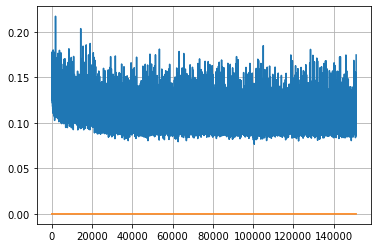

Epoch: 388, iteration 0, loss 0.10047897696495056, cov_diff 0.4173407921851867 cov_diff train 0.41730585978071894
Epoch: 388, iteration 1, loss 0.10450434684753418, cov_diff 0.4023090767951642 cov_diff train 0.4022471947866814
Epoch: 388, iteration 2, loss 0.10020342469215393, cov_diff 0.4192977982227501 cov_diff train 0.4185438806855628
Epoch: 388, iteration 3, loss 0.10872650146484375, cov_diff 0.40570055063351634 cov_diff train 0.40557659246144373
Epoch: 388, iteration 4, loss 0.10435926914215088, cov_diff 0.4129258606585823 cov_diff train 0.4120828031315726
Epoch: 388, iteration 5, loss 0.09579521417617798, cov_diff 0.4136195526025267 cov_diff train 0.4123518811148622
Epoch: 388, iteration 6, loss 0.10945454239845276, cov_diff 0.4136574472045376 cov_diff train 0.4124726288779867
Epoch: 388, iteration 7, loss 0.11395615339279175, cov_diff 0.4044815709957071 cov_diff train 0.4040473941235778
Epoch: 388, iteration 8, loss 0.09450918436050415, cov_diff 0.4050994704344134 cov_diff train

Epoch: 388, iteration 77, loss 0.10100820660591125, cov_diff 0.4066833877409067 cov_diff train 0.4057974698544917
Epoch: 388, iteration 78, loss 0.10175341367721558, cov_diff 0.4043585784023138 cov_diff train 0.4041125133230912
Epoch: 388, iteration 79, loss 0.09762710332870483, cov_diff 0.4229324394709607 cov_diff train 0.42109045679904006
Epoch: 388, iteration 80, loss 0.10457322001457214, cov_diff 0.397622218432847 cov_diff train 0.39725871280865427
Epoch: 388, iteration 81, loss 0.10714825987815857, cov_diff 0.41341077343627736 cov_diff train 0.41253326343996033
Epoch: 388, iteration 82, loss 0.10896679759025574, cov_diff 0.4217518345793701 cov_diff train 0.4201447489377601
Epoch: 388, iteration 83, loss 0.10066187381744385, cov_diff 0.40594665191864265 cov_diff train 0.4058430801682027
Epoch: 388, iteration 84, loss 0.09627604484558105, cov_diff 0.40952108665357545 cov_diff train 0.4094204567957065
Epoch: 388, iteration 85, loss 0.10612654685974121, cov_diff 0.4269734242265812 cov

Epoch: 388, iteration 154, loss 0.11066803336143494, cov_diff 0.4091276516014907 cov_diff train 0.40872653140893883
Epoch: 388, iteration 155, loss 0.1057705283164978, cov_diff 0.41325647167800245 cov_diff train 0.4127832429904849
Epoch: 388, iteration 156, loss 0.09599217772483826, cov_diff 0.4116414427281629 cov_diff train 0.4104851731587525
Epoch: 388, iteration 157, loss 0.09500980377197266, cov_diff 0.4125205139686293 cov_diff train 0.4121505831034198
Epoch: 388, iteration 158, loss 0.12225177884101868, cov_diff 0.4161656186688512 cov_diff train 0.416232452174402
Epoch: 388, iteration 159, loss 0.10282370448112488, cov_diff 0.4131068234534088 cov_diff train 0.41299626531627504
Epoch: 388, iteration 160, loss 0.09722757339477539, cov_diff 0.4054306832093933 cov_diff train 0.404041816335826
Epoch: 388, iteration 161, loss 0.1105911135673523, cov_diff 0.41257761136408944 cov_diff train 0.4120277054150068
Epoch: 388, iteration 162, loss 0.10853186249732971, cov_diff 0.4233491762743394

Epoch: 388, iteration 231, loss 0.11410030722618103, cov_diff 0.42280970398683104 cov_diff train 0.4217308651000809
Epoch: 388, iteration 232, loss 0.10660561919212341, cov_diff 0.421968395884471 cov_diff train 0.42062121292760724
Epoch: 388, iteration 233, loss 0.10454201698303223, cov_diff 0.40684286621901217 cov_diff train 0.4060964813366635
Epoch: 388, iteration 234, loss 0.10257452726364136, cov_diff 0.4089397139889043 cov_diff train 0.40806167782438074
Epoch: 388, iteration 235, loss 0.11931627988815308, cov_diff 0.4115184519438481 cov_diff train 0.4104426334684964
Epoch: 388, iteration 236, loss 0.1096629798412323, cov_diff 0.41727701114987736 cov_diff train 0.4147697664100135
Epoch: 388, iteration 237, loss 0.10396039485931396, cov_diff 0.4077131987395044 cov_diff train 0.406410963623046
Epoch: 388, iteration 238, loss 0.10038977861404419, cov_diff 0.40870544852408475 cov_diff train 0.40770585915813906
Epoch: 388, iteration 239, loss 0.11629879474639893, cov_diff 0.409581810930

Epoch: 388, iteration 309, loss 0.1044950783252716, cov_diff 0.4149719139746755 cov_diff train 0.41427798798724735
Epoch: 388, iteration 310, loss 0.10500919818878174, cov_diff 0.4034586810728554 cov_diff train 0.40272919090408416
Epoch: 388, iteration 311, loss 0.10076433420181274, cov_diff 0.4124235982163689 cov_diff train 0.412333146083259
Epoch: 388, iteration 312, loss 0.11089050769805908, cov_diff 0.4123682483896381 cov_diff train 0.4114356206333706
Epoch: 388, iteration 313, loss 0.09716293215751648, cov_diff 0.4171329361939889 cov_diff train 0.4174163700187021
Epoch: 388, iteration 314, loss 0.11073172092437744, cov_diff 0.4282294942212879 cov_diff train 0.4272898305460651
Epoch: 388, iteration 315, loss 0.1103782057762146, cov_diff 0.40665936486015897 cov_diff train 0.40545961573524525
Epoch: 388, iteration 316, loss 0.10634493827819824, cov_diff 0.40469142878036274 cov_diff train 0.4049006463585313
Epoch: 388, iteration 317, loss 0.10683903098106384, cov_diff 0.42820688840592

Epoch: 388, iteration 385, loss 0.10596668720245361, cov_diff 0.41590854963878643 cov_diff train 0.4160779030342457
Epoch: 388, iteration 386, loss 0.10328418016433716, cov_diff 0.4128438778603769 cov_diff train 0.41146325849265675
Epoch: 388, iteration 387, loss 0.10462817549705505, cov_diff 0.4223582047521838 cov_diff train 0.42155781804096
Epoch: 388, iteration 388, loss 0.09882420301437378, cov_diff 0.4029929010345957 cov_diff train 0.40229156866523
Epoch: 388, iteration 389, loss 0.09114986658096313, cov_diff 0.40496151212154 cov_diff train 0.4040120536628823
Epoch: 388, iteration 390, loss 0.1596817970275879, cov_diff 0.44654259296900506 cov_diff train 0.44526499225184807


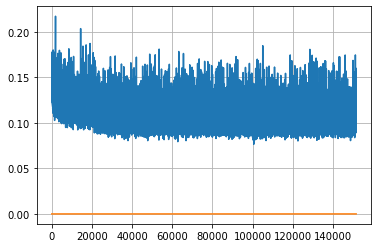

Epoch: 389, iteration 0, loss 0.09988021850585938, cov_diff 0.41438419681221283 cov_diff train 0.4134175665282502
Epoch: 389, iteration 1, loss 0.10218212008476257, cov_diff 0.416357706376237 cov_diff train 0.4158777529185134
Epoch: 389, iteration 2, loss 0.10439181327819824, cov_diff 0.4021184183185002 cov_diff train 0.4015077986400961
Epoch: 389, iteration 3, loss 0.1202998161315918, cov_diff 0.39375734134131557 cov_diff train 0.39340575633446767
Epoch: 389, iteration 4, loss 0.09516921639442444, cov_diff 0.40648980732003437 cov_diff train 0.405951127334752
Epoch: 389, iteration 5, loss 0.11322247982025146, cov_diff 0.41203330180922004 cov_diff train 0.412165771709398
Epoch: 389, iteration 6, loss 0.11023291945457458, cov_diff 0.4254268296739732 cov_diff train 0.42399885072243065
Epoch: 389, iteration 7, loss 0.1037629246711731, cov_diff 0.3975848827492088 cov_diff train 0.39661258024120494
Epoch: 389, iteration 8, loss 0.10380640625953674, cov_diff 0.4158831079387699 cov_diff train 

Epoch: 389, iteration 80, loss 0.0938253104686737, cov_diff 0.4177050483559256 cov_diff train 0.41717292788891047
Epoch: 389, iteration 81, loss 0.10823047161102295, cov_diff 0.3922972315325491 cov_diff train 0.3911690071636296
Epoch: 389, iteration 82, loss 0.0981321632862091, cov_diff 0.4046254275610567 cov_diff train 0.40408514158934855
Epoch: 389, iteration 83, loss 0.11604386568069458, cov_diff 0.41314520895928886 cov_diff train 0.4124468327412403
Epoch: 389, iteration 84, loss 0.10874629020690918, cov_diff 0.4082294909021735 cov_diff train 0.40705991929841207
Epoch: 389, iteration 85, loss 0.11191132664680481, cov_diff 0.41250193253602296 cov_diff train 0.41205595195608574
Epoch: 389, iteration 86, loss 0.1157708466053009, cov_diff 0.40842799045684053 cov_diff train 0.4084653797033995
Epoch: 389, iteration 87, loss 0.10601162910461426, cov_diff 0.4043136707104117 cov_diff train 0.4033084579224247
Epoch: 389, iteration 88, loss 0.10076537728309631, cov_diff 0.4142540489826397 cov_

Epoch: 389, iteration 157, loss 0.09737151861190796, cov_diff 0.40393147713117256 cov_diff train 0.4039135327169845
Epoch: 389, iteration 158, loss 0.11485466361045837, cov_diff 0.40165218192836777 cov_diff train 0.40122126429019855
Epoch: 389, iteration 159, loss 0.09253355860710144, cov_diff 0.41873276972763024 cov_diff train 0.4183149625775519
Epoch: 389, iteration 160, loss 0.10673341155052185, cov_diff 0.41242266274955297 cov_diff train 0.4116184811203742
Epoch: 389, iteration 161, loss 0.10241925716400146, cov_diff 0.4013019959882466 cov_diff train 0.4004255320323625
Epoch: 389, iteration 162, loss 0.12543433904647827, cov_diff 0.41862086025572803 cov_diff train 0.41772845681779786
Epoch: 389, iteration 163, loss 0.10475504398345947, cov_diff 0.4135703572876976 cov_diff train 0.4130341700833365
Epoch: 389, iteration 164, loss 0.10653790831565857, cov_diff 0.41140700029263794 cov_diff train 0.4111468899921736
Epoch: 389, iteration 165, loss 0.11428269743919373, cov_diff 0.41986586

Epoch: 389, iteration 234, loss 0.10108056664466858, cov_diff 0.4060645919161252 cov_diff train 0.4058733207540273
Epoch: 389, iteration 235, loss 0.10858368873596191, cov_diff 0.4118475091824879 cov_diff train 0.4111053180528969
Epoch: 389, iteration 236, loss 0.10662254691123962, cov_diff 0.41857796435398853 cov_diff train 0.41842680981734864
Epoch: 389, iteration 237, loss 0.09781336784362793, cov_diff 0.4069548266866596 cov_diff train 0.40579530790758406
Epoch: 389, iteration 238, loss 0.10157355666160583, cov_diff 0.4072092825838234 cov_diff train 0.40676686298000564
Epoch: 389, iteration 239, loss 0.10549435019493103, cov_diff 0.41930526566946463 cov_diff train 0.4188424546318658
Epoch: 389, iteration 240, loss 0.09564614295959473, cov_diff 0.42336299532269495 cov_diff train 0.4231746503258038
Epoch: 389, iteration 241, loss 0.10270783305168152, cov_diff 0.412152566649315 cov_diff train 0.41140938916834763
Epoch: 389, iteration 242, loss 0.09595021605491638, cov_diff 0.4158081855

Epoch: 389, iteration 311, loss 0.10579106211662292, cov_diff 0.4052008676614718 cov_diff train 0.40496187284159324
Epoch: 389, iteration 312, loss 0.10737216472625732, cov_diff 0.4074523635843864 cov_diff train 0.4079815798284977
Epoch: 389, iteration 313, loss 0.11177492141723633, cov_diff 0.4095917499007015 cov_diff train 0.4102805108215133
Epoch: 389, iteration 314, loss 0.1028558611869812, cov_diff 0.4149619929043197 cov_diff train 0.4144760447325325
Epoch: 389, iteration 315, loss 0.09524574875831604, cov_diff 0.412241504699279 cov_diff train 0.4125300098836809
Epoch: 389, iteration 316, loss 0.10310396552085876, cov_diff 0.409385367897048 cov_diff train 0.4098015462694374
Epoch: 389, iteration 317, loss 0.10129353404045105, cov_diff 0.42428665773869245 cov_diff train 0.42405016424483416
Epoch: 389, iteration 318, loss 0.09475457668304443, cov_diff 0.40453563729196085 cov_diff train 0.4042056082942123
Epoch: 389, iteration 319, loss 0.10488712787628174, cov_diff 0.417742862810659

Epoch: 389, iteration 388, loss 0.0944901704788208, cov_diff 0.41027115190512414 cov_diff train 0.4107672558373669
Epoch: 389, iteration 389, loss 0.09579631686210632, cov_diff 0.4235488486697805 cov_diff train 0.42338738421882616
Epoch: 389, iteration 390, loss 0.14650020003318787, cov_diff 0.4329578721386049 cov_diff train 0.4332747544032152


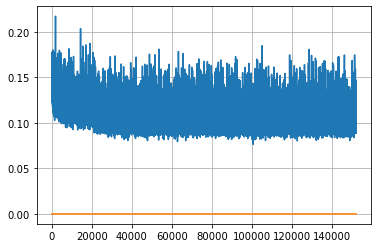

Epoch: 390, iteration 0, loss 0.10910665988922119, cov_diff 0.39590347630274514 cov_diff train 0.39629482747201683
Epoch: 390, iteration 1, loss 0.09459289908409119, cov_diff 0.3896274902871918 cov_diff train 0.3895624144085224
Epoch: 390, iteration 2, loss 0.10138002038002014, cov_diff 0.41736019548767994 cov_diff train 0.4173941892461829
Epoch: 390, iteration 3, loss 0.10166111588478088, cov_diff 0.4137899870275093 cov_diff train 0.41450337010132426
Epoch: 390, iteration 4, loss 0.09716001152992249, cov_diff 0.4126314406707356 cov_diff train 0.4130331966063801
Epoch: 390, iteration 5, loss 0.1080295741558075, cov_diff 0.4096291736718847 cov_diff train 0.4099647548029349
Epoch: 390, iteration 6, loss 0.11091971397399902, cov_diff 0.43154830970091573 cov_diff train 0.43111265522997594
Epoch: 390, iteration 7, loss 0.10366472601890564, cov_diff 0.4212631727604289 cov_diff train 0.42043426254700056
Epoch: 390, iteration 8, loss 0.09268134832382202, cov_diff 0.4284599559414177 cov_diff tr

Epoch: 390, iteration 73, loss 0.11055535078048706, cov_diff 0.41227184516904636 cov_diff train 0.4112151335744877
Epoch: 390, iteration 74, loss 0.11504825949668884, cov_diff 0.4217744595987705 cov_diff train 0.4202287059951214
Epoch: 390, iteration 75, loss 0.10211142897605896, cov_diff 0.41081254217883 cov_diff train 0.4099719447099352
Epoch: 390, iteration 76, loss 0.1059567928314209, cov_diff 0.4148494522194086 cov_diff train 0.4127579839649763
Epoch: 390, iteration 77, loss 0.10578632354736328, cov_diff 0.41338546618965344 cov_diff train 0.4124443682340494
Epoch: 390, iteration 78, loss 0.09490016102790833, cov_diff 0.4185982374249855 cov_diff train 0.41861230876441036
Epoch: 390, iteration 79, loss 0.09489372372627258, cov_diff 0.4211087800854189 cov_diff train 0.4200393547903659
Epoch: 390, iteration 80, loss 0.09519663453102112, cov_diff 0.40946408296015696 cov_diff train 0.4085352967513099
Epoch: 390, iteration 81, loss 0.10551124811172485, cov_diff 0.4028308068497585 cov_dif

Epoch: 390, iteration 149, loss 0.10267239809036255, cov_diff 0.40921379588575474 cov_diff train 0.4083844093950991
Epoch: 390, iteration 150, loss 0.10085421800613403, cov_diff 0.4115299515614074 cov_diff train 0.4108702687273441
Epoch: 390, iteration 151, loss 0.11006096005439758, cov_diff 0.39503175059557494 cov_diff train 0.3936402919280384
Epoch: 390, iteration 152, loss 0.08506724238395691, cov_diff 0.3967972690797778 cov_diff train 0.39580044666848124
Epoch: 390, iteration 153, loss 0.11327764391899109, cov_diff 0.4044679684236796 cov_diff train 0.40394705544843745
Epoch: 390, iteration 154, loss 0.09670361876487732, cov_diff 0.3970423495810877 cov_diff train 0.396639472700654
Epoch: 390, iteration 155, loss 0.09599369764328003, cov_diff 0.40796303518818555 cov_diff train 0.40824812905316865
Epoch: 390, iteration 156, loss 0.09866458177566528, cov_diff 0.41372173263959267 cov_diff train 0.4132597016900849
Epoch: 390, iteration 157, loss 0.09504011273384094, cov_diff 0.4098926655

Epoch: 390, iteration 226, loss 0.08962303400039673, cov_diff 0.39638656699404984 cov_diff train 0.3963102020105442
Epoch: 390, iteration 227, loss 0.09701371192932129, cov_diff 0.4169098574890607 cov_diff train 0.4169082744563827
Epoch: 390, iteration 228, loss 0.12388163805007935, cov_diff 0.40343339024040414 cov_diff train 0.4035624274215267
Epoch: 390, iteration 229, loss 0.09906378388404846, cov_diff 0.40023307141739073 cov_diff train 0.39927991242842886
Epoch: 390, iteration 230, loss 0.08994051814079285, cov_diff 0.41147048216930354 cov_diff train 0.41099036567093666
Epoch: 390, iteration 231, loss 0.10855972766876221, cov_diff 0.40772063988324986 cov_diff train 0.4053956610033434
Epoch: 390, iteration 232, loss 0.11214923858642578, cov_diff 0.41790342418580195 cov_diff train 0.4171391694436961
Epoch: 390, iteration 233, loss 0.10442700982093811, cov_diff 0.41342064015907887 cov_diff train 0.41317821602849997
Epoch: 390, iteration 234, loss 0.10534128546714783, cov_diff 0.391809

Epoch: 390, iteration 303, loss 0.10335493087768555, cov_diff 0.4189903555253453 cov_diff train 0.41860938111947005
Epoch: 390, iteration 304, loss 0.10235461592674255, cov_diff 0.4101400273378722 cov_diff train 0.4093794162471305
Epoch: 390, iteration 305, loss 0.09570521116256714, cov_diff 0.410903140324456 cov_diff train 0.4105121082279852
Epoch: 390, iteration 306, loss 0.11202296614646912, cov_diff 0.42846968145820435 cov_diff train 0.42602701955655753
Epoch: 390, iteration 307, loss 0.10568556189537048, cov_diff 0.41779610557254965 cov_diff train 0.4172399877394086
Epoch: 390, iteration 308, loss 0.11385294795036316, cov_diff 0.4132413483711907 cov_diff train 0.41330551782049596
Epoch: 390, iteration 309, loss 0.1022888720035553, cov_diff 0.4131918027850102 cov_diff train 0.41229260673030965
Epoch: 390, iteration 310, loss 0.08923563361167908, cov_diff 0.41774933022384486 cov_diff train 0.41506909835124917
Epoch: 390, iteration 311, loss 0.10351565480232239, cov_diff 0.4282725664

Epoch: 390, iteration 379, loss 0.10985362529754639, cov_diff 0.4169530311636399 cov_diff train 0.4165291678554487
Epoch: 390, iteration 380, loss 0.10563847422599792, cov_diff 0.41416577891047507 cov_diff train 0.41318694237024317
Epoch: 390, iteration 381, loss 0.09090262651443481, cov_diff 0.408856870236814 cov_diff train 0.4072202191614649
Epoch: 390, iteration 382, loss 0.09891152381896973, cov_diff 0.4005862591511182 cov_diff train 0.3996763749148582
Epoch: 390, iteration 383, loss 0.11083477735519409, cov_diff 0.4160698076567227 cov_diff train 0.4153065321939177
Epoch: 390, iteration 384, loss 0.10532194375991821, cov_diff 0.400026612541455 cov_diff train 0.3988438367544404
Epoch: 390, iteration 385, loss 0.10952866077423096, cov_diff 0.4114392422243403 cov_diff train 0.41080682678945535
Epoch: 390, iteration 386, loss 0.11798959970474243, cov_diff 0.4153186102776763 cov_diff train 0.41408134513558575
Epoch: 390, iteration 387, loss 0.10195264220237732, cov_diff 0.41382278890983

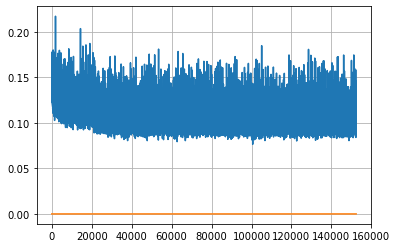

Epoch: 391, iteration 0, loss 0.10499921441078186, cov_diff 0.4053956949842241 cov_diff train 0.40532444906313136
Epoch: 391, iteration 1, loss 0.09016534686088562, cov_diff 0.4062915631152455 cov_diff train 0.4061501159278193
Epoch: 391, iteration 2, loss 0.11151814460754395, cov_diff 0.41924719429153723 cov_diff train 0.4187180868695795
Epoch: 391, iteration 3, loss 0.09113699197769165, cov_diff 0.40486694335369366 cov_diff train 0.4049308295059638
Epoch: 391, iteration 4, loss 0.09840211272239685, cov_diff 0.4133087023836435 cov_diff train 0.41269360460376275
Epoch: 391, iteration 5, loss 0.09874117374420166, cov_diff 0.4176774132710974 cov_diff train 0.41720208526470465
Epoch: 391, iteration 6, loss 0.10702890157699585, cov_diff 0.4110515962158152 cov_diff train 0.41040506553870987
Epoch: 391, iteration 7, loss 0.1071668267250061, cov_diff 0.4136095138290498 cov_diff train 0.4129387718637851
Epoch: 391, iteration 8, loss 0.10540533065795898, cov_diff 0.4094761116769342 cov_diff tra

Epoch: 391, iteration 78, loss 0.10024583339691162, cov_diff 0.41339419164952995 cov_diff train 0.41260271345523336
Epoch: 391, iteration 79, loss 0.0970272421836853, cov_diff 0.40585568484305584 cov_diff train 0.40464469500416866
Epoch: 391, iteration 80, loss 0.10254162549972534, cov_diff 0.4126622934685628 cov_diff train 0.4120350248902294
Epoch: 391, iteration 81, loss 0.09496617317199707, cov_diff 0.42015881657503124 cov_diff train 0.41923503509573595
Epoch: 391, iteration 82, loss 0.09658640623092651, cov_diff 0.4053146666442448 cov_diff train 0.40512219668179295
Epoch: 391, iteration 83, loss 0.10590225458145142, cov_diff 0.3948198248563094 cov_diff train 0.39369141985537537
Epoch: 391, iteration 84, loss 0.11348527669906616, cov_diff 0.4023647412373328 cov_diff train 0.4015040929224978
Epoch: 391, iteration 85, loss 0.11284592747688293, cov_diff 0.4137028604131032 cov_diff train 0.4130173376215873
Epoch: 391, iteration 86, loss 0.10015180706977844, cov_diff 0.40268422914761437 

Epoch: 391, iteration 155, loss 0.10686391592025757, cov_diff 0.41630185080905424 cov_diff train 0.4160392959602453
Epoch: 391, iteration 156, loss 0.09684532880783081, cov_diff 0.4097211657243284 cov_diff train 0.40849415313134996
Epoch: 391, iteration 157, loss 0.10568204522132874, cov_diff 0.4092245730610425 cov_diff train 0.4081464087940492
Epoch: 391, iteration 158, loss 0.116065114736557, cov_diff 0.40373871365633895 cov_diff train 0.40273726415856453
Epoch: 391, iteration 159, loss 0.10548606514930725, cov_diff 0.41196916701467406 cov_diff train 0.40991209739518514
Epoch: 391, iteration 160, loss 0.10166469216346741, cov_diff 0.4050029513159355 cov_diff train 0.4042684091864157
Epoch: 391, iteration 161, loss 0.09256637096405029, cov_diff 0.41533486193334923 cov_diff train 0.41415183289942925
Epoch: 391, iteration 162, loss 0.11020225286483765, cov_diff 0.40929552155595306 cov_diff train 0.4084837054137685
Epoch: 391, iteration 163, loss 0.09313520789146423, cov_diff 0.410492996

Epoch: 391, iteration 232, loss 0.09174993634223938, cov_diff 0.4146837963032558 cov_diff train 0.4128500844326906
Epoch: 391, iteration 233, loss 0.0950586199760437, cov_diff 0.39347293809887335 cov_diff train 0.3920741875481198
Epoch: 391, iteration 234, loss 0.099886953830719, cov_diff 0.41310213678976615 cov_diff train 0.41256144019083424
Epoch: 391, iteration 235, loss 0.09270548820495605, cov_diff 0.40946498722370656 cov_diff train 0.408253615085169
Epoch: 391, iteration 236, loss 0.10525253415107727, cov_diff 0.4040153812482903 cov_diff train 0.4033909493810613
Epoch: 391, iteration 237, loss 0.09056392312049866, cov_diff 0.3931435508848202 cov_diff train 0.3927341012246387
Epoch: 391, iteration 238, loss 0.10595166683197021, cov_diff 0.4069833055091343 cov_diff train 0.40530213995430997
Epoch: 391, iteration 239, loss 0.09559983015060425, cov_diff 0.4146599666415295 cov_diff train 0.4145802675510665
Epoch: 391, iteration 240, loss 0.08703362941741943, cov_diff 0.403744592903475

Epoch: 391, iteration 309, loss 0.10341626405715942, cov_diff 0.4183649015927796 cov_diff train 0.41715502073336985
Epoch: 391, iteration 310, loss 0.11129948496818542, cov_diff 0.4141850325600038 cov_diff train 0.41284441443189374
Epoch: 391, iteration 311, loss 0.10258829593658447, cov_diff 0.4074846798108362 cov_diff train 0.4065721925903383
Epoch: 391, iteration 312, loss 0.09889876842498779, cov_diff 0.4091181864193368 cov_diff train 0.40816800672196385
Epoch: 391, iteration 313, loss 0.10623067617416382, cov_diff 0.39369625663032465 cov_diff train 0.39278437239104425
Epoch: 391, iteration 314, loss 0.10906407237052917, cov_diff 0.41971934735337035 cov_diff train 0.41906401328769083
Epoch: 391, iteration 315, loss 0.10072553157806396, cov_diff 0.4061299485311305 cov_diff train 0.406411748561594
Epoch: 391, iteration 316, loss 0.09777772426605225, cov_diff 0.40817712138240214 cov_diff train 0.40611729881170155
Epoch: 391, iteration 317, loss 0.0955466628074646, cov_diff 0.411767302

Epoch: 391, iteration 386, loss 0.09373900294303894, cov_diff 0.41079530911372064 cov_diff train 0.4096347452646828
Epoch: 391, iteration 387, loss 0.09471258521080017, cov_diff 0.4148769076325435 cov_diff train 0.4142064878829136
Epoch: 391, iteration 388, loss 0.09920933842658997, cov_diff 0.41079540732167036 cov_diff train 0.410540468548273
Epoch: 391, iteration 389, loss 0.10416454076766968, cov_diff 0.40607973340017683 cov_diff train 0.4055050748287414
Epoch: 391, iteration 390, loss 0.15275722742080688, cov_diff 0.45748348778331904 cov_diff train 0.45480345883715734


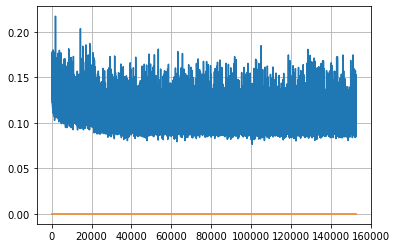

Epoch: 392, iteration 0, loss 0.09925520420074463, cov_diff 0.4083599288949921 cov_diff train 0.4077252616573217
Epoch: 392, iteration 1, loss 0.08525794744491577, cov_diff 0.4023047538664976 cov_diff train 0.40283536104084017
Epoch: 392, iteration 2, loss 0.10850948095321655, cov_diff 0.40999287584347793 cov_diff train 0.40858208612840496
Epoch: 392, iteration 3, loss 0.10541951656341553, cov_diff 0.4012998779030454 cov_diff train 0.4007849852567446
Epoch: 392, iteration 4, loss 0.10188782215118408, cov_diff 0.41018504813469836 cov_diff train 0.40930677741903926
Epoch: 392, iteration 5, loss 0.11136233806610107, cov_diff 0.4040442369167892 cov_diff train 0.4031091636369835
Epoch: 392, iteration 6, loss 0.09950339794158936, cov_diff 0.41702258037961126 cov_diff train 0.41685354852430945
Epoch: 392, iteration 7, loss 0.11110228300094604, cov_diff 0.41882348679596254 cov_diff train 0.4183096368666697
Epoch: 392, iteration 8, loss 0.11480668187141418, cov_diff 0.42389001206304555 cov_diff

Epoch: 392, iteration 73, loss 0.10374024510383606, cov_diff 0.4149395622415901 cov_diff train 0.414706846333976
Epoch: 392, iteration 74, loss 0.10314330458641052, cov_diff 0.41107112828924286 cov_diff train 0.41024798718597966
Epoch: 392, iteration 75, loss 0.10602480173110962, cov_diff 0.40874565408964453 cov_diff train 0.4070725034237809
Epoch: 392, iteration 76, loss 0.10040411353111267, cov_diff 0.3981108843236955 cov_diff train 0.39650581265649343
Epoch: 392, iteration 77, loss 0.10802450776100159, cov_diff 0.41499325737656056 cov_diff train 0.41461981730869824
Epoch: 392, iteration 78, loss 0.11806097626686096, cov_diff 0.4163330989783185 cov_diff train 0.4145825598269873
Epoch: 392, iteration 79, loss 0.10983428359031677, cov_diff 0.4206016206379699 cov_diff train 0.41994301487635477
Epoch: 392, iteration 80, loss 0.09831798076629639, cov_diff 0.4117109216544519 cov_diff train 0.4110508906776431
Epoch: 392, iteration 81, loss 0.10463857650756836, cov_diff 0.41250571478572506 c

Epoch: 392, iteration 150, loss 0.1005169153213501, cov_diff 0.41701134595662065 cov_diff train 0.416590929428865
Epoch: 392, iteration 151, loss 0.11014685034751892, cov_diff 0.41881192736139905 cov_diff train 0.4180215902534467
Epoch: 392, iteration 152, loss 0.0992213785648346, cov_diff 0.41439507500840767 cov_diff train 0.4129749596245372
Epoch: 392, iteration 153, loss 0.10142037272453308, cov_diff 0.42199190533916636 cov_diff train 0.42138166235354796
Epoch: 392, iteration 154, loss 0.09863898158073425, cov_diff 0.426161695020712 cov_diff train 0.42547075433248704
Epoch: 392, iteration 155, loss 0.1065305769443512, cov_diff 0.4128347699555567 cov_diff train 0.4117996170574826
Epoch: 392, iteration 156, loss 0.114991694688797, cov_diff 0.40940217336852835 cov_diff train 0.40872972868469876
Epoch: 392, iteration 157, loss 0.11914756894111633, cov_diff 0.400305305754407 cov_diff train 0.39943083977271643
Epoch: 392, iteration 158, loss 0.11320376396179199, cov_diff 0.404410864287883

Epoch: 392, iteration 227, loss 0.10123994946479797, cov_diff 0.41120403369095593 cov_diff train 0.4106585034641686
Epoch: 392, iteration 228, loss 0.09948241710662842, cov_diff 0.40388151030056446 cov_diff train 0.4027781007305282
Epoch: 392, iteration 229, loss 0.10887095332145691, cov_diff 0.42064082727606555 cov_diff train 0.42004077204379997
Epoch: 392, iteration 230, loss 0.10364580154418945, cov_diff 0.40199830641583223 cov_diff train 0.4004455715441441
Epoch: 392, iteration 231, loss 0.1037767231464386, cov_diff 0.4118927907547274 cov_diff train 0.4108579510634911
Epoch: 392, iteration 232, loss 0.11449548602104187, cov_diff 0.4049841948410898 cov_diff train 0.40421674228435256
Epoch: 392, iteration 233, loss 0.1008991003036499, cov_diff 0.41469759573506443 cov_diff train 0.41407079701031535
Epoch: 392, iteration 234, loss 0.10414740443229675, cov_diff 0.41007404290456856 cov_diff train 0.4097042094651427
Epoch: 392, iteration 235, loss 0.10566878318786621, cov_diff 0.413946560

Epoch: 392, iteration 305, loss 0.11064216494560242, cov_diff 0.40265910201469474 cov_diff train 0.4022468484655941
Epoch: 392, iteration 306, loss 0.10957172513008118, cov_diff 0.41099438544813904 cov_diff train 0.41021179874760827
Epoch: 392, iteration 307, loss 0.10682311654090881, cov_diff 0.4163099876300527 cov_diff train 0.4163949293176802
Epoch: 392, iteration 308, loss 0.10165497660636902, cov_diff 0.41888971089101495 cov_diff train 0.419047781966736
Epoch: 392, iteration 309, loss 0.09748515486717224, cov_diff 0.4139352103900521 cov_diff train 0.4139441764075677
Epoch: 392, iteration 310, loss 0.10568919777870178, cov_diff 0.4167346340982139 cov_diff train 0.41620476209690804
Epoch: 392, iteration 311, loss 0.09424901008605957, cov_diff 0.4143576562727873 cov_diff train 0.41405930694590526
Epoch: 392, iteration 312, loss 0.10500210523605347, cov_diff 0.4264599838831669 cov_diff train 0.4259082935882969
Epoch: 392, iteration 313, loss 0.09901738166809082, cov_diff 0.42011178103

Epoch: 392, iteration 382, loss 0.09735694527626038, cov_diff 0.4122350342645679 cov_diff train 0.41230202091752016
Epoch: 392, iteration 383, loss 0.09905919432640076, cov_diff 0.41829736212505253 cov_diff train 0.41770157963846216
Epoch: 392, iteration 384, loss 0.10494402050971985, cov_diff 0.4127249453434501 cov_diff train 0.4116233345640102
Epoch: 392, iteration 385, loss 0.10450276732444763, cov_diff 0.40232113429898225 cov_diff train 0.4019720899034109
Epoch: 392, iteration 386, loss 0.10060402750968933, cov_diff 0.40332939747367286 cov_diff train 0.4033566321944011
Epoch: 392, iteration 387, loss 0.11999648809432983, cov_diff 0.41037441432766975 cov_diff train 0.4097707414523219
Epoch: 392, iteration 388, loss 0.10465556383132935, cov_diff 0.41093277288057883 cov_diff train 0.4106702000330726
Epoch: 392, iteration 389, loss 0.10683593153953552, cov_diff 0.40747500020675925 cov_diff train 0.4064924176114185
Epoch: 392, iteration 390, loss 0.14265543222427368, cov_diff 0.44293009

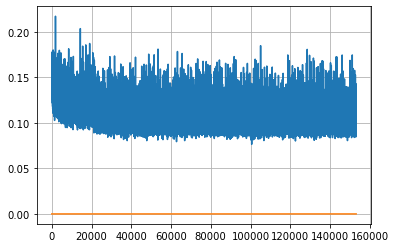

Epoch: 393, iteration 0, loss 0.10584291815757751, cov_diff 0.40645668117049155 cov_diff train 0.4062511908045337
Epoch: 393, iteration 1, loss 0.11173319816589355, cov_diff 0.4224689023821166 cov_diff train 0.4218513646676634
Epoch: 393, iteration 2, loss 0.09780320525169373, cov_diff 0.406565247866832 cov_diff train 0.4058242119277586
Epoch: 393, iteration 3, loss 0.08465680480003357, cov_diff 0.40825241858890343 cov_diff train 0.40844966391544796
Epoch: 393, iteration 4, loss 0.09761315584182739, cov_diff 0.4154449011366899 cov_diff train 0.4150636681536216
Epoch: 393, iteration 5, loss 0.10477140545845032, cov_diff 0.39692856197805376 cov_diff train 0.3962309468037725
Epoch: 393, iteration 6, loss 0.10011282563209534, cov_diff 0.4156329177423698 cov_diff train 0.41529607357462384
Epoch: 393, iteration 7, loss 0.10279521346092224, cov_diff 0.41680910367094987 cov_diff train 0.4157621951645131
Epoch: 393, iteration 8, loss 0.09956121444702148, cov_diff 0.40526787648176954 cov_diff tr

Epoch: 393, iteration 79, loss 0.09637314081192017, cov_diff 0.4127977058298474 cov_diff train 0.41211642426672895
Epoch: 393, iteration 80, loss 0.09572744369506836, cov_diff 0.40602797648202593 cov_diff train 0.40520087266349025
Epoch: 393, iteration 81, loss 0.10243648290634155, cov_diff 0.40132388424575505 cov_diff train 0.4015260378573721
Epoch: 393, iteration 82, loss 0.10152289271354675, cov_diff 0.4042802553508088 cov_diff train 0.4027328521903837
Epoch: 393, iteration 83, loss 0.10882729291915894, cov_diff 0.4118513165979587 cov_diff train 0.4116808943503942
Epoch: 393, iteration 84, loss 0.10021618008613586, cov_diff 0.4124673585111194 cov_diff train 0.4120291361105641
Epoch: 393, iteration 85, loss 0.10347655415534973, cov_diff 0.40702951754687444 cov_diff train 0.4050639125917539
Epoch: 393, iteration 86, loss 0.10179948806762695, cov_diff 0.3990414248748068 cov_diff train 0.39829753357908404
Epoch: 393, iteration 87, loss 0.10106086730957031, cov_diff 0.4104199710412763 co

Epoch: 393, iteration 157, loss 0.1104443371295929, cov_diff 0.40993088482303486 cov_diff train 0.4097910153012054
Epoch: 393, iteration 158, loss 0.10305735468864441, cov_diff 0.41593048849988606 cov_diff train 0.4149721667209505
Epoch: 393, iteration 159, loss 0.10853743553161621, cov_diff 0.4027457171356674 cov_diff train 0.4016013309234815
Epoch: 393, iteration 160, loss 0.0984213650226593, cov_diff 0.40600883422852974 cov_diff train 0.4044415221462813
Epoch: 393, iteration 161, loss 0.10353651642799377, cov_diff 0.41771407989551396 cov_diff train 0.41703896706851784
Epoch: 393, iteration 162, loss 0.10106104612350464, cov_diff 0.3950528965073812 cov_diff train 0.3942997690242534
Epoch: 393, iteration 163, loss 0.11363741755485535, cov_diff 0.41338896801437347 cov_diff train 0.4133664381018321
Epoch: 393, iteration 164, loss 0.09269312024116516, cov_diff 0.4138280056338707 cov_diff train 0.4131088064256295
Epoch: 393, iteration 165, loss 0.09403446316719055, cov_diff 0.413686518649

Epoch: 393, iteration 232, loss 0.11609789729118347, cov_diff 0.41908605489781026 cov_diff train 0.41820682199031683
Epoch: 393, iteration 233, loss 0.09726753830909729, cov_diff 0.41177168832229594 cov_diff train 0.4120179867777316
Epoch: 393, iteration 234, loss 0.09875902533531189, cov_diff 0.4098776638331081 cov_diff train 0.40919282768815235
Epoch: 393, iteration 235, loss 0.10963281989097595, cov_diff 0.39902603761112027 cov_diff train 0.39893622932781714
Epoch: 393, iteration 236, loss 0.10546624660491943, cov_diff 0.4084365282790883 cov_diff train 0.4075369026816042
Epoch: 393, iteration 237, loss 0.10747069120407104, cov_diff 0.40889810609331384 cov_diff train 0.40868082678591316
Epoch: 393, iteration 238, loss 0.09732025861740112, cov_diff 0.4110018093944618 cov_diff train 0.41166700514943655
Epoch: 393, iteration 239, loss 0.10214570164680481, cov_diff 0.4065386597675859 cov_diff train 0.40470970082439706
Epoch: 393, iteration 240, loss 0.09875038266181946, cov_diff 0.420805

Epoch: 393, iteration 305, loss 0.11068016290664673, cov_diff 0.40311576709054386 cov_diff train 0.40307046433129906
Epoch: 393, iteration 306, loss 0.10188215970993042, cov_diff 0.4124342115932381 cov_diff train 0.4120950604442702
Epoch: 393, iteration 307, loss 0.09743273258209229, cov_diff 0.42508590884814806 cov_diff train 0.42504467133527807
Epoch: 393, iteration 308, loss 0.10340169072151184, cov_diff 0.4263549712142819 cov_diff train 0.42625127054408324
Epoch: 393, iteration 309, loss 0.0992802083492279, cov_diff 0.4175915783444951 cov_diff train 0.4168571879892447
Epoch: 393, iteration 310, loss 0.0971238911151886, cov_diff 0.40847930968296425 cov_diff train 0.40748875992709116
Epoch: 393, iteration 311, loss 0.10352391004562378, cov_diff 0.41523806440319727 cov_diff train 0.41452056778370555
Epoch: 393, iteration 312, loss 0.09650400280952454, cov_diff 0.4081989568608122 cov_diff train 0.40720789636851246
Epoch: 393, iteration 313, loss 0.11361563205718994, cov_diff 0.40793057

Epoch: 393, iteration 382, loss 0.10096809267997742, cov_diff 0.4235639490270602 cov_diff train 0.42178156031313685
Epoch: 393, iteration 383, loss 0.11294075846672058, cov_diff 0.406785067516267 cov_diff train 0.4057313122747527
Epoch: 393, iteration 384, loss 0.11162617802619934, cov_diff 0.4036984148412341 cov_diff train 0.4026945443221019
Epoch: 393, iteration 385, loss 0.09197264909744263, cov_diff 0.4055261610934393 cov_diff train 0.40541700348827986
Epoch: 393, iteration 386, loss 0.10695946216583252, cov_diff 0.4123327720341633 cov_diff train 0.4117406483948603
Epoch: 393, iteration 387, loss 0.10741731524467468, cov_diff 0.40450719931591467 cov_diff train 0.402731371615658
Epoch: 393, iteration 388, loss 0.09934556484222412, cov_diff 0.4115794808426521 cov_diff train 0.41013607205238384
Epoch: 393, iteration 389, loss 0.11234825849533081, cov_diff 0.40746359376701147 cov_diff train 0.40682753032937935
Epoch: 393, iteration 390, loss 0.14770498871803284, cov_diff 0.450014767692

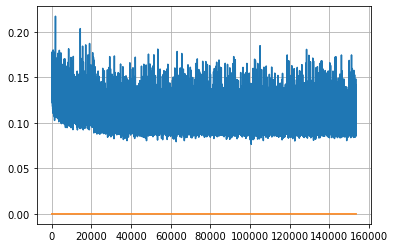

Epoch: 394, iteration 0, loss 0.11794313788414001, cov_diff 0.40534058581530186 cov_diff train 0.40552501115279643
Epoch: 394, iteration 1, loss 0.09761291742324829, cov_diff 0.4067785472823507 cov_diff train 0.4056454286368358
Epoch: 394, iteration 2, loss 0.10113710165023804, cov_diff 0.4091701504464723 cov_diff train 0.4092501524001824
Epoch: 394, iteration 3, loss 0.10423102974891663, cov_diff 0.41663284158255187 cov_diff train 0.41582779487983496
Epoch: 394, iteration 4, loss 0.1054559051990509, cov_diff 0.41376479702731994 cov_diff train 0.41280239135121416
Epoch: 394, iteration 5, loss 0.10708490014076233, cov_diff 0.4031308644570658 cov_diff train 0.4015414302998979
Epoch: 394, iteration 6, loss 0.10549032688140869, cov_diff 0.40842915378896466 cov_diff train 0.40818297506941864
Epoch: 394, iteration 7, loss 0.10645204782485962, cov_diff 0.40807664765043555 cov_diff train 0.4078138860308851
Epoch: 394, iteration 8, loss 0.09934219717979431, cov_diff 0.41112578836811253 cov_diff

Epoch: 394, iteration 75, loss 0.09656065702438354, cov_diff 0.41285583105417295 cov_diff train 0.4125242793943021
Epoch: 394, iteration 76, loss 0.09369334578514099, cov_diff 0.42179222189715415 cov_diff train 0.4223832926058727
Epoch: 394, iteration 77, loss 0.11188799142837524, cov_diff 0.39721015035613577 cov_diff train 0.3975603401056467
Epoch: 394, iteration 78, loss 0.10365274548530579, cov_diff 0.40816180465247526 cov_diff train 0.4078156663149956
Epoch: 394, iteration 79, loss 0.1060476005077362, cov_diff 0.4132019468745907 cov_diff train 0.4123109556330691
Epoch: 394, iteration 80, loss 0.10111507773399353, cov_diff 0.41668102530688417 cov_diff train 0.4163267724937087
Epoch: 394, iteration 81, loss 0.10902267694473267, cov_diff 0.41952627749232746 cov_diff train 0.4191249356166904
Epoch: 394, iteration 82, loss 0.11121904850006104, cov_diff 0.39868690284196606 cov_diff train 0.3980164506638748
Epoch: 394, iteration 83, loss 0.11343863606452942, cov_diff 0.39823998945452627 c

Epoch: 394, iteration 152, loss 0.10823652148246765, cov_diff 0.40827046132212597 cov_diff train 0.40683699667912876
Epoch: 394, iteration 153, loss 0.11478734016418457, cov_diff 0.4085553342130094 cov_diff train 0.4079920705904745
Epoch: 394, iteration 154, loss 0.11693993210792542, cov_diff 0.4238894761881262 cov_diff train 0.4223932836426821
Epoch: 394, iteration 155, loss 0.11802801489830017, cov_diff 0.4266681223511914 cov_diff train 0.4241080204494376
Epoch: 394, iteration 156, loss 0.09887340664863586, cov_diff 0.4210449040430958 cov_diff train 0.4206197883350964
Epoch: 394, iteration 157, loss 0.11605051159858704, cov_diff 0.41778276262014685 cov_diff train 0.41699767612281846
Epoch: 394, iteration 158, loss 0.10697805881500244, cov_diff 0.4179450858319696 cov_diff train 0.4167565336656753
Epoch: 394, iteration 159, loss 0.1048009991645813, cov_diff 0.4014260741596963 cov_diff train 0.4000330630406264
Epoch: 394, iteration 160, loss 0.10184356570243835, cov_diff 0.4175482283426

Epoch: 394, iteration 229, loss 0.10804867744445801, cov_diff 0.40514590100048475 cov_diff train 0.40490820218752716
Epoch: 394, iteration 230, loss 0.09743085503578186, cov_diff 0.43058075389207773 cov_diff train 0.42970591822542953
Epoch: 394, iteration 231, loss 0.10486039519309998, cov_diff 0.4162995343345467 cov_diff train 0.4154140681606561
Epoch: 394, iteration 232, loss 0.0984092652797699, cov_diff 0.4154023035116134 cov_diff train 0.4146059406662407
Epoch: 394, iteration 233, loss 0.10104584693908691, cov_diff 0.4106229039613225 cov_diff train 0.40972303653343173
Epoch: 394, iteration 234, loss 0.10220137238502502, cov_diff 0.4191179002568367 cov_diff train 0.4187445537736162
Epoch: 394, iteration 235, loss 0.09612104296684265, cov_diff 0.41785833614659 cov_diff train 0.41749133896246277
Epoch: 394, iteration 236, loss 0.09335842728614807, cov_diff 0.4111633915485422 cov_diff train 0.4100085626179806
Epoch: 394, iteration 237, loss 0.1026134192943573, cov_diff 0.41919055318716

Epoch: 394, iteration 307, loss 0.09532833099365234, cov_diff 0.4098443956652693 cov_diff train 0.4096392765315031
Epoch: 394, iteration 308, loss 0.10541602969169617, cov_diff 0.4079926212573017 cov_diff train 0.40858789229837617
Epoch: 394, iteration 309, loss 0.11060982942581177, cov_diff 0.4252607155564898 cov_diff train 0.4240278968059565
Epoch: 394, iteration 310, loss 0.09846529364585876, cov_diff 0.40892929632621255 cov_diff train 0.40825363344085003
Epoch: 394, iteration 311, loss 0.1079961359500885, cov_diff 0.41801692588911205 cov_diff train 0.41855934694079816
Epoch: 394, iteration 312, loss 0.10560128092765808, cov_diff 0.40425385971011657 cov_diff train 0.40379525362900803
Epoch: 394, iteration 313, loss 0.10276332497596741, cov_diff 0.40603124514656214 cov_diff train 0.40545024892984194
Epoch: 394, iteration 314, loss 0.10058367252349854, cov_diff 0.4088568167823569 cov_diff train 0.4085554065988927
Epoch: 394, iteration 315, loss 0.10425204038619995, cov_diff 0.41736553

Epoch: 394, iteration 384, loss 0.10170051455497742, cov_diff 0.4175712409280751 cov_diff train 0.4164607375526878
Epoch: 394, iteration 385, loss 0.09632205963134766, cov_diff 0.3982074902608542 cov_diff train 0.39824028685578006
Epoch: 394, iteration 386, loss 0.11010941863059998, cov_diff 0.4115365569177141 cov_diff train 0.41098128004906775
Epoch: 394, iteration 387, loss 0.10312539339065552, cov_diff 0.40753106076179874 cov_diff train 0.4070853457900221
Epoch: 394, iteration 388, loss 0.10171553492546082, cov_diff 0.3989658850519957 cov_diff train 0.39832266061021776
Epoch: 394, iteration 389, loss 0.09731879830360413, cov_diff 0.40893977424543304 cov_diff train 0.4076189820433998
Epoch: 394, iteration 390, loss 0.15378588438034058, cov_diff 0.4631301048697453 cov_diff train 0.46087994148631806


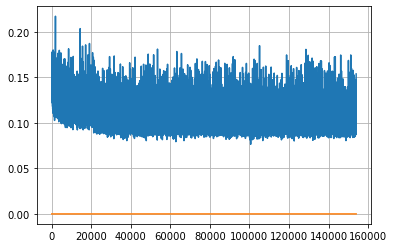

Epoch: 395, iteration 0, loss 0.10695800185203552, cov_diff 0.4173029156715652 cov_diff train 0.4167948252007019
Epoch: 395, iteration 1, loss 0.10717073082923889, cov_diff 0.4105154302772954 cov_diff train 0.410915595086833
Epoch: 395, iteration 2, loss 0.09861496090888977, cov_diff 0.40732296681625024 cov_diff train 0.4070653749420563
Epoch: 395, iteration 3, loss 0.10629749298095703, cov_diff 0.4049675586089114 cov_diff train 0.40585661856465466
Epoch: 395, iteration 4, loss 0.09461042284965515, cov_diff 0.4069144258989612 cov_diff train 0.4077100278671935
Epoch: 395, iteration 5, loss 0.10910910367965698, cov_diff 0.4076272902609993 cov_diff train 0.4073675985554683
Epoch: 395, iteration 6, loss 0.0939532220363617, cov_diff 0.4086696287087678 cov_diff train 0.40900694585930636
Epoch: 395, iteration 7, loss 0.10807988047599792, cov_diff 0.413582892279362 cov_diff train 0.41256201015092214
Epoch: 395, iteration 8, loss 0.1070539653301239, cov_diff 0.4224214790627408 cov_diff train 0.

Epoch: 395, iteration 75, loss 0.10005021095275879, cov_diff 0.3961247840617999 cov_diff train 0.39587931072766913
Epoch: 395, iteration 76, loss 0.10508307814598083, cov_diff 0.41962233663540366 cov_diff train 0.41872057566348536
Epoch: 395, iteration 77, loss 0.10351133346557617, cov_diff 0.40996011253228926 cov_diff train 0.40846420348665974
Epoch: 395, iteration 78, loss 0.1135869026184082, cov_diff 0.4113276154864859 cov_diff train 0.4103862208890249
Epoch: 395, iteration 79, loss 0.11414724588394165, cov_diff 0.42174931334611265 cov_diff train 0.42034194899368965
Epoch: 395, iteration 80, loss 0.09538447856903076, cov_diff 0.42200177378741044 cov_diff train 0.42105536375487745
Epoch: 395, iteration 81, loss 0.09672698378562927, cov_diff 0.40385742579626677 cov_diff train 0.4026512767388251
Epoch: 395, iteration 82, loss 0.1044783890247345, cov_diff 0.4073330944515505 cov_diff train 0.4071049390077567
Epoch: 395, iteration 83, loss 0.09757053852081299, cov_diff 0.41016973619113667

Epoch: 395, iteration 146, loss 0.1017606258392334, cov_diff 0.4149816694416521 cov_diff train 0.4138988196290433
Epoch: 395, iteration 147, loss 0.10355600714683533, cov_diff 0.4209812134407478 cov_diff train 0.42046997105746636
Epoch: 395, iteration 148, loss 0.10515552759170532, cov_diff 0.4130302333494671 cov_diff train 0.4118338383573441
Epoch: 395, iteration 149, loss 0.10424363613128662, cov_diff 0.4087232528352461 cov_diff train 0.40720321159433975
Epoch: 395, iteration 150, loss 0.10516628623008728, cov_diff 0.4195777682860597 cov_diff train 0.41875506139472174
Epoch: 395, iteration 151, loss 0.1024090051651001, cov_diff 0.4065549790922604 cov_diff train 0.405854992043873
Epoch: 395, iteration 152, loss 0.10767319798469543, cov_diff 0.4241242834074473 cov_diff train 0.42401835765285534
Epoch: 395, iteration 153, loss 0.11315175890922546, cov_diff 0.4100480153237232 cov_diff train 0.4092594116765358
Epoch: 395, iteration 154, loss 0.11216571927070618, cov_diff 0.420294654461267

Epoch: 395, iteration 220, loss 0.09412229061126709, cov_diff 0.41601504232143743 cov_diff train 0.4155382994580851
Epoch: 395, iteration 221, loss 0.10988309979438782, cov_diff 0.40840755192261186 cov_diff train 0.40593134190924685
Epoch: 395, iteration 222, loss 0.11305862665176392, cov_diff 0.41270580045342253 cov_diff train 0.4115522176002482
Epoch: 395, iteration 223, loss 0.09801337122917175, cov_diff 0.4044879362070941 cov_diff train 0.40292295791049393
Epoch: 395, iteration 224, loss 0.11272445321083069, cov_diff 0.4157519790899691 cov_diff train 0.4142505949363882
Epoch: 395, iteration 225, loss 0.10912075638771057, cov_diff 0.40818424144761617 cov_diff train 0.40748751984193354
Epoch: 395, iteration 226, loss 0.107220858335495, cov_diff 0.4096078832804288 cov_diff train 0.40882333127545323
Epoch: 395, iteration 227, loss 0.09858214855194092, cov_diff 0.4108632082950716 cov_diff train 0.4092353802392559
Epoch: 395, iteration 228, loss 0.10929545760154724, cov_diff 0.4095468103

Epoch: 395, iteration 294, loss 0.11167988181114197, cov_diff 0.4042061154463637 cov_diff train 0.40413586510559796
Epoch: 395, iteration 295, loss 0.12003627419471741, cov_diff 0.40621008396300357 cov_diff train 0.4050497116321219
Epoch: 395, iteration 296, loss 0.1125955581665039, cov_diff 0.41186417163952194 cov_diff train 0.4115975946737969
Epoch: 395, iteration 297, loss 0.10033324360847473, cov_diff 0.40697284086611407 cov_diff train 0.40749324979796114
Epoch: 395, iteration 298, loss 0.10311740636825562, cov_diff 0.407213758907699 cov_diff train 0.406891599705396
Epoch: 395, iteration 299, loss 0.10222211480140686, cov_diff 0.41381393639245145 cov_diff train 0.41326868032513125
Epoch: 395, iteration 300, loss 0.10486659407615662, cov_diff 0.41055103488497524 cov_diff train 0.4109586891033666
Epoch: 395, iteration 301, loss 0.10724630951881409, cov_diff 0.4198154163051074 cov_diff train 0.41822397612006706
Epoch: 395, iteration 302, loss 0.09706830978393555, cov_diff 0.4131654261

Epoch: 395, iteration 371, loss 0.11045008897781372, cov_diff 0.40564451837701426 cov_diff train 0.40405136797108276
Epoch: 395, iteration 372, loss 0.11116185784339905, cov_diff 0.41196568636513703 cov_diff train 0.41118293971615033
Epoch: 395, iteration 373, loss 0.10256439447402954, cov_diff 0.4025647497190279 cov_diff train 0.4009179251174521
Epoch: 395, iteration 374, loss 0.10021454095840454, cov_diff 0.41335953753317134 cov_diff train 0.4119187236482492
Epoch: 395, iteration 375, loss 0.10188159346580505, cov_diff 0.40940135624037033 cov_diff train 0.40922033874857383
Epoch: 395, iteration 376, loss 0.09803804755210876, cov_diff 0.4121323798679173 cov_diff train 0.41205691654595666
Epoch: 395, iteration 377, loss 0.10369083285331726, cov_diff 0.4146437204040276 cov_diff train 0.4136420929334829
Epoch: 395, iteration 378, loss 0.10421350598335266, cov_diff 0.40644439278422584 cov_diff train 0.4055196189693937
Epoch: 395, iteration 379, loss 0.09454801678657532, cov_diff 0.4063861

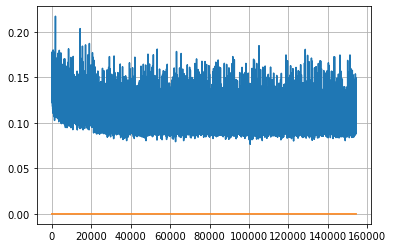

Epoch: 396, iteration 0, loss 0.10990744829177856, cov_diff 0.4223165488849081 cov_diff train 0.42149336023349215
Epoch: 396, iteration 1, loss 0.11391350626945496, cov_diff 0.42647018381226715 cov_diff train 0.42551217389673457
Epoch: 396, iteration 2, loss 0.10360589623451233, cov_diff 0.40590523050730315 cov_diff train 0.40631424992118725
Epoch: 396, iteration 3, loss 0.10053855180740356, cov_diff 0.4010332914568777 cov_diff train 0.4001365269079001
Epoch: 396, iteration 4, loss 0.09644347429275513, cov_diff 0.4223917314005629 cov_diff train 0.4226913570156807
Epoch: 396, iteration 5, loss 0.10596302151679993, cov_diff 0.41604110166794467 cov_diff train 0.41601724305400123
Epoch: 396, iteration 6, loss 0.09835430979728699, cov_diff 0.3872050467442934 cov_diff train 0.3872265012336835
Epoch: 396, iteration 7, loss 0.09296855330467224, cov_diff 0.4090829798970171 cov_diff train 0.4089906718339964
Epoch: 396, iteration 8, loss 0.09575644135475159, cov_diff 0.4124555783007943 cov_diff t

Epoch: 396, iteration 78, loss 0.108609139919281, cov_diff 0.40977634184234596 cov_diff train 0.4089235235055922
Epoch: 396, iteration 79, loss 0.10300108790397644, cov_diff 0.3963832266511278 cov_diff train 0.39642889838718626
Epoch: 396, iteration 80, loss 0.09747889637947083, cov_diff 0.4165039124367061 cov_diff train 0.4155823645761999
Epoch: 396, iteration 81, loss 0.11519187688827515, cov_diff 0.41501332333460206 cov_diff train 0.4147097395817424
Epoch: 396, iteration 82, loss 0.11237972974777222, cov_diff 0.4240447079684256 cov_diff train 0.42321741164100374
Epoch: 396, iteration 83, loss 0.10894885659217834, cov_diff 0.42108477212648776 cov_diff train 0.41928370036537405
Epoch: 396, iteration 84, loss 0.11057466268539429, cov_diff 0.40933510167637455 cov_diff train 0.40898857674076444
Epoch: 396, iteration 85, loss 0.10396543145179749, cov_diff 0.40399585393422605 cov_diff train 0.4035494048413622
Epoch: 396, iteration 86, loss 0.09519308805465698, cov_diff 0.40430500623950294 

Epoch: 396, iteration 155, loss 0.10322299599647522, cov_diff 0.40860338933413426 cov_diff train 0.40735651704426185
Epoch: 396, iteration 156, loss 0.09794193506240845, cov_diff 0.41369391437965297 cov_diff train 0.41256632416439565
Epoch: 396, iteration 157, loss 0.09386998414993286, cov_diff 0.4031425928010579 cov_diff train 0.4023764051248269
Epoch: 396, iteration 158, loss 0.11291199922561646, cov_diff 0.41359582618913177 cov_diff train 0.41396418141618446
Epoch: 396, iteration 159, loss 0.1059810221195221, cov_diff 0.4064256375343303 cov_diff train 0.40567080333672606
Epoch: 396, iteration 160, loss 0.1017199158668518, cov_diff 0.40450450965513257 cov_diff train 0.4053462340712244
Epoch: 396, iteration 161, loss 0.1020621657371521, cov_diff 0.41150511021940095 cov_diff train 0.41059054579354737
Epoch: 396, iteration 162, loss 0.10117384791374207, cov_diff 0.40298264692717767 cov_diff train 0.4015357389347803
Epoch: 396, iteration 163, loss 0.11411139369010925, cov_diff 0.41935430

Epoch: 396, iteration 233, loss 0.1029609739780426, cov_diff 0.39457036422289693 cov_diff train 0.39444229474317305
Epoch: 396, iteration 234, loss 0.09964501857757568, cov_diff 0.39862395001820883 cov_diff train 0.3982644824371433
Epoch: 396, iteration 235, loss 0.1034986674785614, cov_diff 0.4075037498176572 cov_diff train 0.40643230508038947
Epoch: 396, iteration 236, loss 0.09880617260932922, cov_diff 0.40851647658835955 cov_diff train 0.4083552218122418
Epoch: 396, iteration 237, loss 0.10136282444000244, cov_diff 0.4180912971067764 cov_diff train 0.4177479496920278
Epoch: 396, iteration 238, loss 0.10937514901161194, cov_diff 0.4011493169081434 cov_diff train 0.4011931074444869
Epoch: 396, iteration 239, loss 0.10713613033294678, cov_diff 0.42369348160150505 cov_diff train 0.42281114658215047
Epoch: 396, iteration 240, loss 0.10507082939147949, cov_diff 0.4093694205476258 cov_diff train 0.408322260364087
Epoch: 396, iteration 241, loss 0.10259026288986206, cov_diff 0.412860537474

Epoch: 396, iteration 309, loss 0.10077449679374695, cov_diff 0.4096518357076467 cov_diff train 0.4086922605713972
Epoch: 396, iteration 310, loss 0.11160928010940552, cov_diff 0.4107901434521261 cov_diff train 0.40918935743228946
Epoch: 396, iteration 311, loss 0.10266414284706116, cov_diff 0.4218649031891099 cov_diff train 0.42114944777573754
Epoch: 396, iteration 312, loss 0.10719907283782959, cov_diff 0.39774198735401983 cov_diff train 0.398258606838164
Epoch: 396, iteration 313, loss 0.10678642988204956, cov_diff 0.40700218835736335 cov_diff train 0.4069450890272663
Epoch: 396, iteration 314, loss 0.1110709011554718, cov_diff 0.40979749172249536 cov_diff train 0.40967252286862027
Epoch: 396, iteration 315, loss 0.09689077734947205, cov_diff 0.40573277504785127 cov_diff train 0.4057742828318717
Epoch: 396, iteration 316, loss 0.08779501914978027, cov_diff 0.42145820366910247 cov_diff train 0.4209730683450569
Epoch: 396, iteration 317, loss 0.10698911547660828, cov_diff 0.4127406849

Epoch: 396, iteration 386, loss 0.10716402530670166, cov_diff 0.42250734063230383 cov_diff train 0.42226213268187157
Epoch: 396, iteration 387, loss 0.09496206045150757, cov_diff 0.4188380006609877 cov_diff train 0.41862580176261555
Epoch: 396, iteration 388, loss 0.11069020628929138, cov_diff 0.4288046242376668 cov_diff train 0.4280778836540359
Epoch: 396, iteration 389, loss 0.10766243934631348, cov_diff 0.4082677413231785 cov_diff train 0.4069184293577437
Epoch: 396, iteration 390, loss 0.1643526554107666, cov_diff 0.47181019268930524 cov_diff train 0.4691537548784886


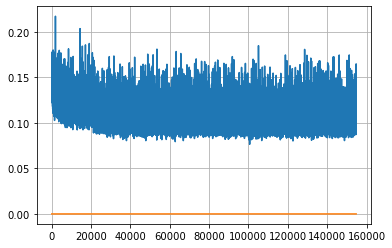

Epoch: 397, iteration 0, loss 0.10728412866592407, cov_diff 0.41419042088002894 cov_diff train 0.4143873908189941
Epoch: 397, iteration 1, loss 0.11330544948577881, cov_diff 0.415295147213075 cov_diff train 0.4134124048308387
Epoch: 397, iteration 2, loss 0.09788012504577637, cov_diff 0.4125102643256972 cov_diff train 0.41080886107279235
Epoch: 397, iteration 3, loss 0.10155662894248962, cov_diff 0.40503953478692306 cov_diff train 0.40491351980493473
Epoch: 397, iteration 4, loss 0.10958528518676758, cov_diff 0.4099308528433421 cov_diff train 0.40968610732581506
Epoch: 397, iteration 5, loss 0.09640029072761536, cov_diff 0.41459354228362244 cov_diff train 0.413172163200427
Epoch: 397, iteration 6, loss 0.09821072220802307, cov_diff 0.42807183828771855 cov_diff train 0.4270676131642686
Epoch: 397, iteration 7, loss 0.11479470133781433, cov_diff 0.4178593619889122 cov_diff train 0.4156290903776107
Epoch: 397, iteration 8, loss 0.09797334671020508, cov_diff 0.4080264770486453 cov_diff tra

Epoch: 397, iteration 78, loss 0.10460883378982544, cov_diff 0.4194144022445949 cov_diff train 0.41941394782431657
Epoch: 397, iteration 79, loss 0.0979483425617218, cov_diff 0.41153149024403407 cov_diff train 0.4105450135608996
Epoch: 397, iteration 80, loss 0.09968334436416626, cov_diff 0.41194661759991513 cov_diff train 0.4113835076122906
Epoch: 397, iteration 81, loss 0.10357514023780823, cov_diff 0.40608863609521645 cov_diff train 0.40630243931926274
Epoch: 397, iteration 82, loss 0.10802435874938965, cov_diff 0.40557860217575453 cov_diff train 0.4052940535475607
Epoch: 397, iteration 83, loss 0.10109123587608337, cov_diff 0.42285760448080434 cov_diff train 0.4228525854882639
Epoch: 397, iteration 84, loss 0.1090216338634491, cov_diff 0.4200090222318435 cov_diff train 0.419349471793088
Epoch: 397, iteration 85, loss 0.10616108775138855, cov_diff 0.407527893364482 cov_diff train 0.40677613482857256
Epoch: 397, iteration 86, loss 0.10609233379364014, cov_diff 0.41444369356687283 cov

Epoch: 397, iteration 155, loss 0.10701334476470947, cov_diff 0.4067766713659529 cov_diff train 0.40704830806176545
Epoch: 397, iteration 156, loss 0.09744012355804443, cov_diff 0.406601162940797 cov_diff train 0.4062969187319566
Epoch: 397, iteration 157, loss 0.10782131552696228, cov_diff 0.4297100813138452 cov_diff train 0.42921735033806996
Epoch: 397, iteration 158, loss 0.10106536746025085, cov_diff 0.4041698035484275 cov_diff train 0.4025038619438991
Epoch: 397, iteration 159, loss 0.10442635416984558, cov_diff 0.40679754899329384 cov_diff train 0.40662700343060215
Epoch: 397, iteration 160, loss 0.10824829339981079, cov_diff 0.4129800231513511 cov_diff train 0.41270028192543146
Epoch: 397, iteration 161, loss 0.10540342330932617, cov_diff 0.41582183023358416 cov_diff train 0.4145973288444902
Epoch: 397, iteration 162, loss 0.10296773910522461, cov_diff 0.4031351276221092 cov_diff train 0.4024510837437786
Epoch: 397, iteration 163, loss 0.10994565486907959, cov_diff 0.41141928150

Epoch: 397, iteration 233, loss 0.11370131373405457, cov_diff 0.40565875421477604 cov_diff train 0.4051264536691512
Epoch: 397, iteration 234, loss 0.1057921051979065, cov_diff 0.418799492594977 cov_diff train 0.41734771110065705
Epoch: 397, iteration 235, loss 0.099456787109375, cov_diff 0.41365385845412184 cov_diff train 0.41242347671884566
Epoch: 397, iteration 236, loss 0.10501942038536072, cov_diff 0.41225522276645016 cov_diff train 0.41157520490282085
Epoch: 397, iteration 237, loss 0.1122642457485199, cov_diff 0.4134678640033878 cov_diff train 0.4127787376590111
Epoch: 397, iteration 238, loss 0.10685455799102783, cov_diff 0.4234208808472888 cov_diff train 0.4221549460739637
Epoch: 397, iteration 239, loss 0.09614863991737366, cov_diff 0.4134431816716757 cov_diff train 0.4130791112768775
Epoch: 397, iteration 240, loss 0.10266700387001038, cov_diff 0.4017345317554996 cov_diff train 0.40144366566730627
Epoch: 397, iteration 241, loss 0.09783601760864258, cov_diff 0.40748027807114

Epoch: 397, iteration 310, loss 0.10308623313903809, cov_diff 0.41159885341575597 cov_diff train 0.4118118654133883
Epoch: 397, iteration 311, loss 0.09945139288902283, cov_diff 0.40554535826530147 cov_diff train 0.4052400591317775
Epoch: 397, iteration 312, loss 0.11056280136108398, cov_diff 0.41241948776949566 cov_diff train 0.4116361043775529
Epoch: 397, iteration 313, loss 0.09773170948028564, cov_diff 0.4197233119248842 cov_diff train 0.4177218909493598
Epoch: 397, iteration 314, loss 0.09519469738006592, cov_diff 0.41701798052781514 cov_diff train 0.41629758405883605
Epoch: 397, iteration 315, loss 0.10437920689582825, cov_diff 0.40803512412219833 cov_diff train 0.40559257235141777
Epoch: 397, iteration 316, loss 0.10000184178352356, cov_diff 0.4197054979022777 cov_diff train 0.4196037210302418
Epoch: 397, iteration 317, loss 0.11487674713134766, cov_diff 0.4223414246313156 cov_diff train 0.4215259140749427
Epoch: 397, iteration 318, loss 0.10915547609329224, cov_diff 0.402602263

Epoch: 397, iteration 387, loss 0.09786075353622437, cov_diff 0.4212600752673543 cov_diff train 0.4205961360546576
Epoch: 397, iteration 388, loss 0.10169792175292969, cov_diff 0.4183019455162777 cov_diff train 0.4176975768177268
Epoch: 397, iteration 389, loss 0.09490710496902466, cov_diff 0.41468934997151513 cov_diff train 0.41489898477342224
Epoch: 397, iteration 390, loss 0.16525059938430786, cov_diff 0.4559795776937479 cov_diff train 0.453846604184551


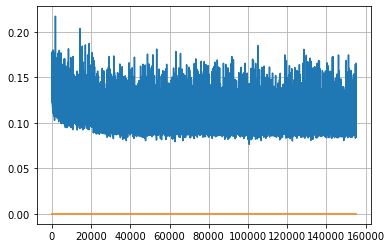

Epoch: 398, iteration 0, loss 0.11118468642234802, cov_diff 0.40501084032717954 cov_diff train 0.4051874104893876
Epoch: 398, iteration 1, loss 0.11193934082984924, cov_diff 0.4114859893252298 cov_diff train 0.4117496689523974
Epoch: 398, iteration 2, loss 0.09171393513679504, cov_diff 0.4099295160307685 cov_diff train 0.4091279218481065
Epoch: 398, iteration 3, loss 0.10648569464683533, cov_diff 0.420751603145368 cov_diff train 0.41991776349568555
Epoch: 398, iteration 4, loss 0.10102680325508118, cov_diff 0.4000446413057259 cov_diff train 0.40060658483097034
Epoch: 398, iteration 5, loss 0.12871363759040833, cov_diff 0.43839518079785 cov_diff train 0.4383541768487663
Epoch: 398, iteration 6, loss 0.09509792923927307, cov_diff 0.42625770231759885 cov_diff train 0.426109176740417
Epoch: 398, iteration 7, loss 0.10251915454864502, cov_diff 0.3999122561566818 cov_diff train 0.39904915388753714
Epoch: 398, iteration 8, loss 0.09048622846603394, cov_diff 0.4246798530416032 cov_diff train 0

Epoch: 398, iteration 76, loss 0.0976664125919342, cov_diff 0.4153481061573393 cov_diff train 0.41559635940804457
Epoch: 398, iteration 77, loss 0.11590766906738281, cov_diff 0.415496507195792 cov_diff train 0.41528200765615897
Epoch: 398, iteration 78, loss 0.10108789801597595, cov_diff 0.40873975928443884 cov_diff train 0.40796531142040937
Epoch: 398, iteration 79, loss 0.09439966082572937, cov_diff 0.41194560998282614 cov_diff train 0.41203483794989904
Epoch: 398, iteration 80, loss 0.10083100199699402, cov_diff 0.41968025914115215 cov_diff train 0.4191010699963626
Epoch: 398, iteration 81, loss 0.0918816328048706, cov_diff 0.40165923747003207 cov_diff train 0.4012046786855485
Epoch: 398, iteration 82, loss 0.09480580687522888, cov_diff 0.43373751202398864 cov_diff train 0.43218949442879445
Epoch: 398, iteration 83, loss 0.09586307406425476, cov_diff 0.41691835003738786 cov_diff train 0.4168542031707163
Epoch: 398, iteration 84, loss 0.09594348073005676, cov_diff 0.4138398270918212 

Epoch: 398, iteration 154, loss 0.11377421021461487, cov_diff 0.4008659407937592 cov_diff train 0.40040086668550207
Epoch: 398, iteration 155, loss 0.09654942154884338, cov_diff 0.40863800092849273 cov_diff train 0.40820596695250877
Epoch: 398, iteration 156, loss 0.09672930836677551, cov_diff 0.4176584817449662 cov_diff train 0.4159547703867719
Epoch: 398, iteration 157, loss 0.09528344869613647, cov_diff 0.4037589194137759 cov_diff train 0.4034965016941838
Epoch: 398, iteration 158, loss 0.1043778657913208, cov_diff 0.4131995552175955 cov_diff train 0.4125766644752401
Epoch: 398, iteration 159, loss 0.10446900129318237, cov_diff 0.4179409901320543 cov_diff train 0.4175697035157196
Epoch: 398, iteration 160, loss 0.10956823825836182, cov_diff 0.40923317093423184 cov_diff train 0.4085257636805861
Epoch: 398, iteration 161, loss 0.11096540093421936, cov_diff 0.4132270153861047 cov_diff train 0.4132583816286364
Epoch: 398, iteration 162, loss 0.11008405685424805, cov_diff 0.4210754023423

Epoch: 398, iteration 232, loss 0.10063117742538452, cov_diff 0.4253630142173445 cov_diff train 0.4246939711973197
Epoch: 398, iteration 233, loss 0.09528094530105591, cov_diff 0.40410312430811074 cov_diff train 0.4022406628716433
Epoch: 398, iteration 234, loss 0.09555801749229431, cov_diff 0.409524306097503 cov_diff train 0.40850169351115295
Epoch: 398, iteration 235, loss 0.10322514176368713, cov_diff 0.4053633475624577 cov_diff train 0.4051899442122637
Epoch: 398, iteration 236, loss 0.09720966219902039, cov_diff 0.41064224869702903 cov_diff train 0.40922455248785966
Epoch: 398, iteration 237, loss 0.10656750202178955, cov_diff 0.4189660796045486 cov_diff train 0.41794725657178866
Epoch: 398, iteration 238, loss 0.09170293807983398, cov_diff 0.40930330305845675 cov_diff train 0.40843975444555153
Epoch: 398, iteration 239, loss 0.10148888826370239, cov_diff 0.4137023098765067 cov_diff train 0.4113597258320277
Epoch: 398, iteration 240, loss 0.10795220732688904, cov_diff 0.4197945779

Epoch: 398, iteration 310, loss 0.09857171773910522, cov_diff 0.41123982148283833 cov_diff train 0.4102135026597302
Epoch: 398, iteration 311, loss 0.10023117065429688, cov_diff 0.4038427482911582 cov_diff train 0.4032971582340871
Epoch: 398, iteration 312, loss 0.09994259476661682, cov_diff 0.4225197359085913 cov_diff train 0.4216253567588578
Epoch: 398, iteration 313, loss 0.09785714745521545, cov_diff 0.4141509232386744 cov_diff train 0.41325510803412163
Epoch: 398, iteration 314, loss 0.0899701714515686, cov_diff 0.40664930567383967 cov_diff train 0.40577655726468687
Epoch: 398, iteration 315, loss 0.1073378324508667, cov_diff 0.4028220169036062 cov_diff train 0.4011881708687574
Epoch: 398, iteration 316, loss 0.09183043241500854, cov_diff 0.41600769064070053 cov_diff train 0.41533971556782234
Epoch: 398, iteration 317, loss 0.10254749655723572, cov_diff 0.40011348842218053 cov_diff train 0.3994101800940593
Epoch: 398, iteration 318, loss 0.08798226714134216, cov_diff 0.39794988981

Epoch: 398, iteration 389, loss 0.1104571521282196, cov_diff 0.41600225957084785 cov_diff train 0.4157053323837911
Epoch: 398, iteration 390, loss 0.1429627537727356, cov_diff 0.45504064042344367 cov_diff train 0.4539171136955353


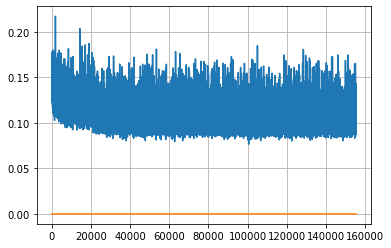

Epoch: 399, iteration 0, loss 0.09516346454620361, cov_diff 0.41387097909207016 cov_diff train 0.41384014657165497
Epoch: 399, iteration 1, loss 0.10242170095443726, cov_diff 0.39675642235687303 cov_diff train 0.3967518433517043
Epoch: 399, iteration 2, loss 0.10445171594619751, cov_diff 0.413347476394495 cov_diff train 0.4129433057651702
Epoch: 399, iteration 3, loss 0.10392877459526062, cov_diff 0.4173936254394109 cov_diff train 0.41723871462005735
Epoch: 399, iteration 4, loss 0.10376298427581787, cov_diff 0.41136356006431585 cov_diff train 0.4109779972600873
Epoch: 399, iteration 5, loss 0.11895617842674255, cov_diff 0.42170591804752766 cov_diff train 0.42132578105996815
Epoch: 399, iteration 6, loss 0.10402518510818481, cov_diff 0.4057422320846042 cov_diff train 0.4049777614986638
Epoch: 399, iteration 7, loss 0.10553029179573059, cov_diff 0.41377997670345396 cov_diff train 0.41348695927593
Epoch: 399, iteration 8, loss 0.10182660818099976, cov_diff 0.40527947382196555 cov_diff tr

Epoch: 399, iteration 75, loss 0.0932815670967102, cov_diff 0.41377865327400853 cov_diff train 0.413381777002806
Epoch: 399, iteration 76, loss 0.09941363334655762, cov_diff 0.41268378459801125 cov_diff train 0.4122315289244755
Epoch: 399, iteration 77, loss 0.11319407820701599, cov_diff 0.41035199425537167 cov_diff train 0.4098643635607164
Epoch: 399, iteration 78, loss 0.10086438059806824, cov_diff 0.4127305266878041 cov_diff train 0.4116020709946063
Epoch: 399, iteration 79, loss 0.10276952385902405, cov_diff 0.40577654587967493 cov_diff train 0.4043513695526809
Epoch: 399, iteration 80, loss 0.10173094272613525, cov_diff 0.41487244066527157 cov_diff train 0.41514474718227795
Epoch: 399, iteration 81, loss 0.11113923788070679, cov_diff 0.4145528895223088 cov_diff train 0.4135818139447565
Epoch: 399, iteration 82, loss 0.11082804203033447, cov_diff 0.42228175086593406 cov_diff train 0.4213626485272663
Epoch: 399, iteration 83, loss 0.11184707283973694, cov_diff 0.4176827702033523 cov

Epoch: 399, iteration 147, loss 0.09412741661071777, cov_diff 0.41065896659671175 cov_diff train 0.41039422744247334
Epoch: 399, iteration 148, loss 0.11124959588050842, cov_diff 0.422436007834622 cov_diff train 0.4211931703034417
Epoch: 399, iteration 149, loss 0.1035507321357727, cov_diff 0.41140366375502924 cov_diff train 0.4111963767556362
Epoch: 399, iteration 150, loss 0.10610297322273254, cov_diff 0.42215770555194987 cov_diff train 0.4200167700999028
Epoch: 399, iteration 151, loss 0.09469696879386902, cov_diff 0.40492696408860707 cov_diff train 0.40335917077173244
Epoch: 399, iteration 152, loss 0.11696532368659973, cov_diff 0.4305877305495619 cov_diff train 0.42851667719996317
Epoch: 399, iteration 153, loss 0.10593494772911072, cov_diff 0.42537083689316246 cov_diff train 0.4245632193568883
Epoch: 399, iteration 154, loss 0.10516643524169922, cov_diff 0.41088096553088066 cov_diff train 0.41006734823396596
Epoch: 399, iteration 155, loss 0.10289150476455688, cov_diff 0.40468089

Epoch: 399, iteration 218, loss 0.11003261804580688, cov_diff 0.4060940242024621 cov_diff train 0.40539807222554997
Epoch: 399, iteration 219, loss 0.09224086999893188, cov_diff 0.4111402486345795 cov_diff train 0.4104628830647772
Epoch: 399, iteration 220, loss 0.11039614677429199, cov_diff 0.4056596412953916 cov_diff train 0.405938456016793
Epoch: 399, iteration 221, loss 0.11593106389045715, cov_diff 0.41687152222656826 cov_diff train 0.41611803886611276
Epoch: 399, iteration 222, loss 0.10617595911026001, cov_diff 0.4072653521185407 cov_diff train 0.4065550140783602
Epoch: 399, iteration 223, loss 0.09743261337280273, cov_diff 0.4118939560915938 cov_diff train 0.41056540692205185
Epoch: 399, iteration 224, loss 0.11173653602600098, cov_diff 0.41918612948184625 cov_diff train 0.41763010052661925
Epoch: 399, iteration 225, loss 0.10634300112724304, cov_diff 0.41853331604200067 cov_diff train 0.41770873427838295
Epoch: 399, iteration 226, loss 0.1004030704498291, cov_diff 0.4129069918

Epoch: 399, iteration 297, loss 0.10080718994140625, cov_diff 0.4148781580861166 cov_diff train 0.4137977092958425
Epoch: 399, iteration 298, loss 0.09827831387519836, cov_diff 0.40172642986583773 cov_diff train 0.40103765725032325
Epoch: 399, iteration 299, loss 0.09626039862632751, cov_diff 0.40478475898709215 cov_diff train 0.4044478710139906
Epoch: 399, iteration 300, loss 0.0943494439125061, cov_diff 0.41910005106949555 cov_diff train 0.4179767179755585
Epoch: 399, iteration 301, loss 0.098918616771698, cov_diff 0.39772158819839454 cov_diff train 0.3966558049853229
Epoch: 399, iteration 302, loss 0.12262722849845886, cov_diff 0.4117528756184659 cov_diff train 0.4108808352221156
Epoch: 399, iteration 303, loss 0.10576897859573364, cov_diff 0.40560096503603854 cov_diff train 0.4042940106295922
Epoch: 399, iteration 304, loss 0.10200953483581543, cov_diff 0.40715817277590843 cov_diff train 0.4064621090618371
Epoch: 399, iteration 305, loss 0.10785233974456787, cov_diff 0.415951996168

Epoch: 399, iteration 374, loss 0.11782217025756836, cov_diff 0.4079061676483515 cov_diff train 0.4077775230564277
Epoch: 399, iteration 375, loss 0.09749168157577515, cov_diff 0.42266769264528337 cov_diff train 0.42161638263556817
Epoch: 399, iteration 376, loss 0.1147962212562561, cov_diff 0.41095893455591154 cov_diff train 0.4104470345696457
Epoch: 399, iteration 377, loss 0.10760971903800964, cov_diff 0.39948344879421704 cov_diff train 0.398988480044224
Epoch: 399, iteration 378, loss 0.10491162538528442, cov_diff 0.40481920079496553 cov_diff train 0.4034739194035762
Epoch: 399, iteration 379, loss 0.10112082958221436, cov_diff 0.4090622248679957 cov_diff train 0.4087656819135574
Epoch: 399, iteration 380, loss 0.10179126262664795, cov_diff 0.4084894931873941 cov_diff train 0.4079771946652985
Epoch: 399, iteration 381, loss 0.10375970602035522, cov_diff 0.41134356877449674 cov_diff train 0.410464241070686
Epoch: 399, iteration 382, loss 0.09927603602409363, cov_diff 0.4154581587173

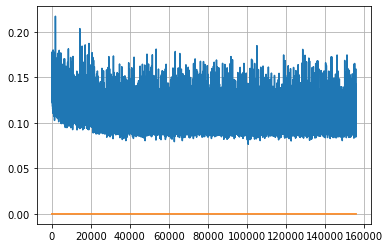

Epoch: 400, iteration 0, loss 0.09646284580230713, cov_diff 0.4171329234429444 cov_diff train 0.4180097832080022
Epoch: 400, iteration 1, loss 0.09319067001342773, cov_diff 0.4022239319293176 cov_diff train 0.401977168210358
Epoch: 400, iteration 2, loss 0.12056788802146912, cov_diff 0.41437667251410587 cov_diff train 0.4141273445477739
Epoch: 400, iteration 3, loss 0.10556530952453613, cov_diff 0.4193085396492879 cov_diff train 0.41961610336510646
Epoch: 400, iteration 4, loss 0.10981810092926025, cov_diff 0.4003381501574038 cov_diff train 0.3995584838276549
Epoch: 400, iteration 5, loss 0.1002243161201477, cov_diff 0.4147984794199269 cov_diff train 0.41453639648417145
Epoch: 400, iteration 6, loss 0.10309407114982605, cov_diff 0.41669409059411733 cov_diff train 0.4160904507009463
Epoch: 400, iteration 7, loss 0.09448644518852234, cov_diff 0.4224919885338663 cov_diff train 0.42282999291019474
Epoch: 400, iteration 8, loss 0.09650668501853943, cov_diff 0.4146290523266423 cov_diff train

Epoch: 400, iteration 77, loss 0.10175856947898865, cov_diff 0.415819682436374 cov_diff train 0.41451301888748127
Epoch: 400, iteration 78, loss 0.10839194059371948, cov_diff 0.4255825486162105 cov_diff train 0.42505169864002734
Epoch: 400, iteration 79, loss 0.0840848982334137, cov_diff 0.41383900117074257 cov_diff train 0.4136645645074076
Epoch: 400, iteration 80, loss 0.0993061363697052, cov_diff 0.41263418536406077 cov_diff train 0.4125746071469509
Epoch: 400, iteration 81, loss 0.11943084001541138, cov_diff 0.4199474724722215 cov_diff train 0.4186742548470203
Epoch: 400, iteration 82, loss 0.10495764017105103, cov_diff 0.42482979797140097 cov_diff train 0.4250721797322877
Epoch: 400, iteration 83, loss 0.10898211598396301, cov_diff 0.4280108230782332 cov_diff train 0.4250500285733049
Epoch: 400, iteration 84, loss 0.11048993468284607, cov_diff 0.4135789030896379 cov_diff train 0.4127614357826217
Epoch: 400, iteration 85, loss 0.10088744759559631, cov_diff 0.41254652618421583 cov_d

Epoch: 400, iteration 154, loss 0.09966689348220825, cov_diff 0.40179817653836386 cov_diff train 0.40062697907422395
Epoch: 400, iteration 155, loss 0.09749618172645569, cov_diff 0.41626729690086395 cov_diff train 0.41527754889124346
Epoch: 400, iteration 156, loss 0.10921359062194824, cov_diff 0.40799033564613374 cov_diff train 0.4072939365114001
Epoch: 400, iteration 157, loss 0.09450337290763855, cov_diff 0.40955268722394345 cov_diff train 0.4083189620295194
Epoch: 400, iteration 158, loss 0.09500610828399658, cov_diff 0.3990593936691361 cov_diff train 0.3981650777746724
Epoch: 400, iteration 159, loss 0.11524063348770142, cov_diff 0.41411884965899703 cov_diff train 0.41282540941037577
Epoch: 400, iteration 160, loss 0.10385558009147644, cov_diff 0.4054613001287392 cov_diff train 0.40578779726961384
Epoch: 400, iteration 161, loss 0.10285532474517822, cov_diff 0.4009330013833992 cov_diff train 0.400601536844609
Epoch: 400, iteration 162, loss 0.10855108499526978, cov_diff 0.41375207

Epoch: 400, iteration 230, loss 0.10710000991821289, cov_diff 0.4143949725600528 cov_diff train 0.4132340670533185
Epoch: 400, iteration 231, loss 0.09602373838424683, cov_diff 0.4239060687768316 cov_diff train 0.422418442451447
Epoch: 400, iteration 232, loss 0.113567054271698, cov_diff 0.3965419765197341 cov_diff train 0.39513020673833343
Epoch: 400, iteration 233, loss 0.09909141063690186, cov_diff 0.40102941222027777 cov_diff train 0.4006275271795974
Epoch: 400, iteration 234, loss 0.1060333251953125, cov_diff 0.409721264729897 cov_diff train 0.4088904745201743
Epoch: 400, iteration 235, loss 0.09506019949913025, cov_diff 0.41597885810056545 cov_diff train 0.4146927087875235
Epoch: 400, iteration 236, loss 0.10244402289390564, cov_diff 0.4250386206961547 cov_diff train 0.42415559229738825
Epoch: 400, iteration 237, loss 0.10802245140075684, cov_diff 0.4108345087527024 cov_diff train 0.41040508199863246
Epoch: 400, iteration 238, loss 0.09938374161720276, cov_diff 0.4153054195521881

Epoch: 400, iteration 309, loss 0.11355704069137573, cov_diff 0.41851290352860954 cov_diff train 0.4177557042664368
Epoch: 400, iteration 310, loss 0.10580950975418091, cov_diff 0.421885619022938 cov_diff train 0.42081797181931124
Epoch: 400, iteration 311, loss 0.10308200120925903, cov_diff 0.4056175731611114 cov_diff train 0.40511398596858356
Epoch: 400, iteration 312, loss 0.10067826509475708, cov_diff 0.4191147126796437 cov_diff train 0.4177356585795654
Epoch: 400, iteration 313, loss 0.12149545550346375, cov_diff 0.41282516468111047 cov_diff train 0.4119670899562813
Epoch: 400, iteration 314, loss 0.10240942239761353, cov_diff 0.42493998399031263 cov_diff train 0.42389997809927105
Epoch: 400, iteration 315, loss 0.10821384191513062, cov_diff 0.39177100612324556 cov_diff train 0.39161472238238604
Epoch: 400, iteration 316, loss 0.10321825742721558, cov_diff 0.41226604178671516 cov_diff train 0.41132313277846405
Epoch: 400, iteration 317, loss 0.10116985440254211, cov_diff 0.4323994

Epoch: 400, iteration 388, loss 0.09934437274932861, cov_diff 0.405771680880127 cov_diff train 0.4047930368156973
Epoch: 400, iteration 389, loss 0.09793341159820557, cov_diff 0.4054623121761788 cov_diff train 0.40478294580892615
Epoch: 400, iteration 390, loss 0.16025954484939575, cov_diff 0.475061924366482 cov_diff train 0.4746146797170618


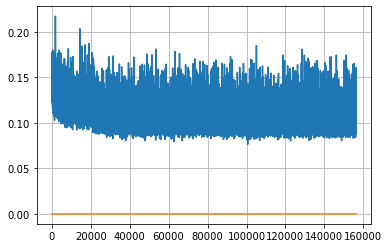

Epoch: 401, iteration 0, loss 0.09625464677810669, cov_diff 0.39457919242267353 cov_diff train 0.39395409641026363
Epoch: 401, iteration 1, loss 0.09395602345466614, cov_diff 0.39668333941628764 cov_diff train 0.39573267453084704
Epoch: 401, iteration 2, loss 0.11306098103523254, cov_diff 0.40301970011871385 cov_diff train 0.4018941977084896
Epoch: 401, iteration 3, loss 0.09893485903739929, cov_diff 0.4111159092281147 cov_diff train 0.4106216597536239
Epoch: 401, iteration 4, loss 0.10441642999649048, cov_diff 0.40796221252226544 cov_diff train 0.40731998863542956
Epoch: 401, iteration 5, loss 0.12013605237007141, cov_diff 0.41321226721348336 cov_diff train 0.41282800762401084
Epoch: 401, iteration 6, loss 0.09733986854553223, cov_diff 0.4099540425772076 cov_diff train 0.4094985854972295
Epoch: 401, iteration 7, loss 0.10258567333221436, cov_diff 0.3985447427140166 cov_diff train 0.39867384328597166
Epoch: 401, iteration 8, loss 0.10454830527305603, cov_diff 0.39337522221834775 cov_di

Epoch: 401, iteration 77, loss 0.1066562831401825, cov_diff 0.41148484611442104 cov_diff train 0.4105056384087913
Epoch: 401, iteration 78, loss 0.10869720578193665, cov_diff 0.40595083350227873 cov_diff train 0.40619102873840274
Epoch: 401, iteration 79, loss 0.11067157983779907, cov_diff 0.4168241121693231 cov_diff train 0.4154732046161018
Epoch: 401, iteration 80, loss 0.10947135090827942, cov_diff 0.4109651807009819 cov_diff train 0.41086122536675196
Epoch: 401, iteration 81, loss 0.09643259644508362, cov_diff 0.40607593494752214 cov_diff train 0.40605014609257234
Epoch: 401, iteration 82, loss 0.11360085010528564, cov_diff 0.4042818054826898 cov_diff train 0.4041763929195764
Epoch: 401, iteration 83, loss 0.09683752059936523, cov_diff 0.39757910246746764 cov_diff train 0.39685470606416046
Epoch: 401, iteration 84, loss 0.10009407997131348, cov_diff 0.41529294050870147 cov_diff train 0.41508465937887923
Epoch: 401, iteration 85, loss 0.10835039615631104, cov_diff 0.4162219479005656

Epoch: 401, iteration 154, loss 0.10261818766593933, cov_diff 0.4188848054915719 cov_diff train 0.4197151207343452
Epoch: 401, iteration 155, loss 0.10591349005699158, cov_diff 0.4097324550385099 cov_diff train 0.4094617100143254
Epoch: 401, iteration 156, loss 0.09723463654518127, cov_diff 0.3976763074297858 cov_diff train 0.39740360295061933
Epoch: 401, iteration 157, loss 0.12151035666465759, cov_diff 0.4127117456102881 cov_diff train 0.4124808642770624
Epoch: 401, iteration 158, loss 0.09897348284721375, cov_diff 0.3977450203836612 cov_diff train 0.3976566288383724
Epoch: 401, iteration 159, loss 0.11238512396812439, cov_diff 0.4178293160628382 cov_diff train 0.4171994733124537
Epoch: 401, iteration 160, loss 0.10402980446815491, cov_diff 0.414881395596131 cov_diff train 0.41403317684898544
Epoch: 401, iteration 161, loss 0.10452315211296082, cov_diff 0.41400289761307324 cov_diff train 0.4136760585734232
Epoch: 401, iteration 162, loss 0.10358479619026184, cov_diff 0.41848632958184

Epoch: 401, iteration 231, loss 0.11166507005691528, cov_diff 0.411129545533965 cov_diff train 0.41207235567867434
Epoch: 401, iteration 232, loss 0.0994793176651001, cov_diff 0.38219357557729333 cov_diff train 0.38328565730261493
Epoch: 401, iteration 233, loss 0.12219873070716858, cov_diff 0.4059355376141755 cov_diff train 0.4062858579294382
Epoch: 401, iteration 234, loss 0.10959422588348389, cov_diff 0.4160469621181398 cov_diff train 0.4164197490168582
Epoch: 401, iteration 235, loss 0.10291871428489685, cov_diff 0.4177820569426895 cov_diff train 0.41792316974869087
Epoch: 401, iteration 236, loss 0.10877132415771484, cov_diff 0.41282068510374376 cov_diff train 0.4131737843066531
Epoch: 401, iteration 237, loss 0.10366952419281006, cov_diff 0.4115554632693581 cov_diff train 0.410970480643885
Epoch: 401, iteration 238, loss 0.11397245526313782, cov_diff 0.43189940283128725 cov_diff train 0.43243612863733566
Epoch: 401, iteration 239, loss 0.11056694388389587, cov_diff 0.431876175897

Epoch: 401, iteration 311, loss 0.11925449967384338, cov_diff 0.41711312289807007 cov_diff train 0.4162336761668875
Epoch: 401, iteration 312, loss 0.10342925786972046, cov_diff 0.4150833148705902 cov_diff train 0.4143043652014443
Epoch: 401, iteration 313, loss 0.10606500506401062, cov_diff 0.4132990711945805 cov_diff train 0.4117718622661979
Epoch: 401, iteration 314, loss 0.10800132155418396, cov_diff 0.40550153492091856 cov_diff train 0.4045799770517764
Epoch: 401, iteration 315, loss 0.10981553792953491, cov_diff 0.40447156908299 cov_diff train 0.4029203331374348
Epoch: 401, iteration 316, loss 0.11024311184883118, cov_diff 0.40462444072909715 cov_diff train 0.4028910248477184
Epoch: 401, iteration 317, loss 0.1093607246875763, cov_diff 0.4107694230814744 cov_diff train 0.40963803210401534
Epoch: 401, iteration 318, loss 0.09964051842689514, cov_diff 0.41219494198345696 cov_diff train 0.41070987804413833
Epoch: 401, iteration 319, loss 0.09790703654289246, cov_diff 0.4085388873304

Epoch: 401, iteration 387, loss 0.10459142923355103, cov_diff 0.40647755745432523 cov_diff train 0.4061809928987848
Epoch: 401, iteration 388, loss 0.09561386704444885, cov_diff 0.3931677248924815 cov_diff train 0.3920550178596989
Epoch: 401, iteration 389, loss 0.1070840060710907, cov_diff 0.41220304073762576 cov_diff train 0.4115553967688793
Epoch: 401, iteration 390, loss 0.1620272994041443, cov_diff 0.461028089590312 cov_diff train 0.45728225616008406


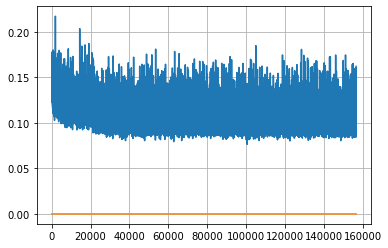

Epoch: 402, iteration 0, loss 0.10890239477157593, cov_diff 0.41860103983803126 cov_diff train 0.41782615458670685
Epoch: 402, iteration 1, loss 0.10235142707824707, cov_diff 0.4018918415039104 cov_diff train 0.4003866424442781
Epoch: 402, iteration 2, loss 0.09591493010520935, cov_diff 0.39695643188553836 cov_diff train 0.3955725054678297
Epoch: 402, iteration 3, loss 0.09535253047943115, cov_diff 0.40827834251469414 cov_diff train 0.4071473428818302
Epoch: 402, iteration 4, loss 0.10960841178894043, cov_diff 0.4110481319223065 cov_diff train 0.4094813046103259
Epoch: 402, iteration 5, loss 0.11752831935882568, cov_diff 0.421253122018526 cov_diff train 0.4205533107451417
Epoch: 402, iteration 6, loss 0.10163754224777222, cov_diff 0.4027779323276445 cov_diff train 0.400785546448454
Epoch: 402, iteration 7, loss 0.10824304819107056, cov_diff 0.4103662678620584 cov_diff train 0.4098963086822413
Epoch: 402, iteration 8, loss 0.10589680075645447, cov_diff 0.41704186630548584 cov_diff train

Epoch: 402, iteration 78, loss 0.09925955533981323, cov_diff 0.4058748924434379 cov_diff train 0.40469093643371057
Epoch: 402, iteration 79, loss 0.10708212852478027, cov_diff 0.42281230611790116 cov_diff train 0.422066454887421
Epoch: 402, iteration 80, loss 0.10738173127174377, cov_diff 0.4088563237217566 cov_diff train 0.40833851731318427
Epoch: 402, iteration 81, loss 0.11215949058532715, cov_diff 0.40873904809199035 cov_diff train 0.40773602119918667
Epoch: 402, iteration 82, loss 0.10320180654525757, cov_diff 0.41560680870487854 cov_diff train 0.41540393938319325
Epoch: 402, iteration 83, loss 0.09520506858825684, cov_diff 0.4082619912967776 cov_diff train 0.40832361988866434
Epoch: 402, iteration 84, loss 0.0985901951789856, cov_diff 0.4211298028236345 cov_diff train 0.42112888740777876
Epoch: 402, iteration 85, loss 0.11199572682380676, cov_diff 0.4079792334025738 cov_diff train 0.407160445858015
Epoch: 402, iteration 86, loss 0.10604411363601685, cov_diff 0.42459289896964214 c

Epoch: 402, iteration 157, loss 0.09729209542274475, cov_diff 0.41034339210961995 cov_diff train 0.40953326246179406
Epoch: 402, iteration 158, loss 0.1025947630405426, cov_diff 0.4146900953393265 cov_diff train 0.414393946451356
Epoch: 402, iteration 159, loss 0.10339033603668213, cov_diff 0.4138538981380651 cov_diff train 0.4132236884590803
Epoch: 402, iteration 160, loss 0.10536137223243713, cov_diff 0.4155399450277613 cov_diff train 0.4150213750268245
Epoch: 402, iteration 161, loss 0.10326430201530457, cov_diff 0.4143698333176334 cov_diff train 0.4134994629589096
Epoch: 402, iteration 162, loss 0.10240790247917175, cov_diff 0.4199005765695234 cov_diff train 0.4194081987976109
Epoch: 402, iteration 163, loss 0.1010359525680542, cov_diff 0.4142064437793288 cov_diff train 0.41276570863713363
Epoch: 402, iteration 164, loss 0.10422307252883911, cov_diff 0.4113724649345053 cov_diff train 0.4108100299789126
Epoch: 402, iteration 165, loss 0.101779043674469, cov_diff 0.41290438129974993 

Epoch: 402, iteration 236, loss 0.10433709621429443, cov_diff 0.42120349643412336 cov_diff train 0.4206556359613132
Epoch: 402, iteration 237, loss 0.10574570298194885, cov_diff 0.41166328738649105 cov_diff train 0.4115406138413326
Epoch: 402, iteration 238, loss 0.11241111159324646, cov_diff 0.41255326622690386 cov_diff train 0.4125509005696461
Epoch: 402, iteration 239, loss 0.10183307528495789, cov_diff 0.41495888368927536 cov_diff train 0.41466668610133944
Epoch: 402, iteration 240, loss 0.09503179788589478, cov_diff 0.4043757943422344 cov_diff train 0.4042442284421279
Epoch: 402, iteration 241, loss 0.10366180539131165, cov_diff 0.4219590916468833 cov_diff train 0.4213162351757083
Epoch: 402, iteration 242, loss 0.09964558482170105, cov_diff 0.4176885942856805 cov_diff train 0.41674762783617864
Epoch: 402, iteration 243, loss 0.09709170460700989, cov_diff 0.39826980648944105 cov_diff train 0.3985145811551343
Epoch: 402, iteration 244, loss 0.11212992668151855, cov_diff 0.424701807

Epoch: 402, iteration 315, loss 0.0978391170501709, cov_diff 0.40450069155351537 cov_diff train 0.4037207030885634
Epoch: 402, iteration 316, loss 0.09740757942199707, cov_diff 0.41407997464830704 cov_diff train 0.4137520430885645
Epoch: 402, iteration 317, loss 0.10255765914916992, cov_diff 0.39879391949343973 cov_diff train 0.39843198859383033
Epoch: 402, iteration 318, loss 0.09377223253250122, cov_diff 0.4122429231713593 cov_diff train 0.4117297889541634
Epoch: 402, iteration 319, loss 0.10370796918869019, cov_diff 0.4100306204496519 cov_diff train 0.4091680678810239
Epoch: 402, iteration 320, loss 0.10259181261062622, cov_diff 0.3979698894189806 cov_diff train 0.39721718563177166
Epoch: 402, iteration 321, loss 0.10397368669509888, cov_diff 0.4190074997361195 cov_diff train 0.41843167378761104
Epoch: 402, iteration 322, loss 0.1022975742816925, cov_diff 0.4204347489045084 cov_diff train 0.41903866818071006
Epoch: 402, iteration 323, loss 0.09743285179138184, cov_diff 0.40932037978

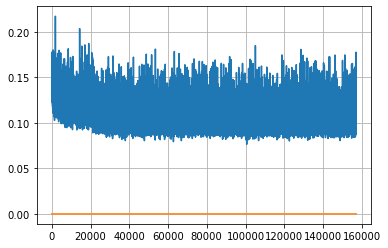

Epoch: 403, iteration 0, loss 0.09918990731239319, cov_diff 0.4066312216164232 cov_diff train 0.4063030767360341
Epoch: 403, iteration 1, loss 0.09479773044586182, cov_diff 0.39908445473530063 cov_diff train 0.3987384332957772
Epoch: 403, iteration 2, loss 0.09625160694122314, cov_diff 0.4049202284844576 cov_diff train 0.4030855825457773
Epoch: 403, iteration 3, loss 0.10406029224395752, cov_diff 0.41873788139752327 cov_diff train 0.41738882155939916
Epoch: 403, iteration 4, loss 0.10744020342826843, cov_diff 0.4085682828317577 cov_diff train 0.4081105023866409
Epoch: 403, iteration 5, loss 0.09968650341033936, cov_diff 0.409886078105997 cov_diff train 0.40850753110592647
Epoch: 403, iteration 6, loss 0.09712889790534973, cov_diff 0.40733339075711134 cov_diff train 0.40601961648517254
Epoch: 403, iteration 7, loss 0.11436134576797485, cov_diff 0.3958668671543898 cov_diff train 0.3937184557231262
Epoch: 403, iteration 8, loss 0.09849324822425842, cov_diff 0.4197749214661393 cov_diff tra

Epoch: 403, iteration 80, loss 0.1025148332118988, cov_diff 0.4161308082487372 cov_diff train 0.4145764387133261
Epoch: 403, iteration 81, loss 0.10415765643119812, cov_diff 0.41019033475486627 cov_diff train 0.40841094292499225
Epoch: 403, iteration 82, loss 0.09995847940444946, cov_diff 0.41280107079325923 cov_diff train 0.4119013784668224
Epoch: 403, iteration 83, loss 0.10399723052978516, cov_diff 0.4056453235746305 cov_diff train 0.40551863710028707
Epoch: 403, iteration 84, loss 0.10864239931106567, cov_diff 0.40555461455401853 cov_diff train 0.403922048038742
Epoch: 403, iteration 85, loss 0.10138541460037231, cov_diff 0.43448731231569326 cov_diff train 0.43298009491657646
Epoch: 403, iteration 86, loss 0.09962120652198792, cov_diff 0.4060686296036393 cov_diff train 0.40492216581168433
Epoch: 403, iteration 87, loss 0.10082051157951355, cov_diff 0.4026124446621621 cov_diff train 0.40187794670173527
Epoch: 403, iteration 88, loss 0.10489669442176819, cov_diff 0.40756453649439167 

Epoch: 403, iteration 161, loss 0.09697851538658142, cov_diff 0.41887986759002227 cov_diff train 0.4176935467730262
Epoch: 403, iteration 162, loss 0.09388300776481628, cov_diff 0.4062703088820141 cov_diff train 0.4055214665440936
Epoch: 403, iteration 163, loss 0.10914751887321472, cov_diff 0.4124587576447842 cov_diff train 0.41161520243408867
Epoch: 403, iteration 164, loss 0.0961446464061737, cov_diff 0.41079314955060425 cov_diff train 0.40993644635469845
Epoch: 403, iteration 165, loss 0.0983634889125824, cov_diff 0.39917633445056366 cov_diff train 0.398125373965497
Epoch: 403, iteration 166, loss 0.11016148328781128, cov_diff 0.4134549901400747 cov_diff train 0.4125870773251316
Epoch: 403, iteration 167, loss 0.10090309381484985, cov_diff 0.4085734559963354 cov_diff train 0.4084128373001833
Epoch: 403, iteration 168, loss 0.09983262419700623, cov_diff 0.4082373712878675 cov_diff train 0.40767599447354275
Epoch: 403, iteration 169, loss 0.10494327545166016, cov_diff 0.4150962427450

Epoch: 403, iteration 241, loss 0.09859603643417358, cov_diff 0.40930034972131935 cov_diff train 0.4084940403849557
Epoch: 403, iteration 242, loss 0.10621321201324463, cov_diff 0.4111110649101794 cov_diff train 0.40870243825231656
Epoch: 403, iteration 243, loss 0.0998087227344513, cov_diff 0.4345188336605508 cov_diff train 0.43450610003070766
Epoch: 403, iteration 244, loss 0.10981962084770203, cov_diff 0.40554133547842897 cov_diff train 0.4052539499850926
Epoch: 403, iteration 245, loss 0.11028560996055603, cov_diff 0.41545077481417975 cov_diff train 0.4146190759612717
Epoch: 403, iteration 246, loss 0.1020565927028656, cov_diff 0.4001490931891487 cov_diff train 0.39973833477653337
Epoch: 403, iteration 247, loss 0.102719247341156, cov_diff 0.41596445076886296 cov_diff train 0.41484776719028876
Epoch: 403, iteration 248, loss 0.09078383445739746, cov_diff 0.4116680164695692 cov_diff train 0.41089683067730176
Epoch: 403, iteration 249, loss 0.11395624279975891, cov_diff 0.40951016443

Epoch: 403, iteration 322, loss 0.09551763534545898, cov_diff 0.41113768421956837 cov_diff train 0.4114191249429609
Epoch: 403, iteration 323, loss 0.11328631639480591, cov_diff 0.4181510295727861 cov_diff train 0.4176543899964464
Epoch: 403, iteration 324, loss 0.09797734022140503, cov_diff 0.401444579344369 cov_diff train 0.401373003471304
Epoch: 403, iteration 325, loss 0.09919130802154541, cov_diff 0.4271037902433931 cov_diff train 0.4273666276870718
Epoch: 403, iteration 326, loss 0.10569927096366882, cov_diff 0.42784065496819784 cov_diff train 0.4273840272380377
Epoch: 403, iteration 327, loss 0.09842932224273682, cov_diff 0.41146735849088506 cov_diff train 0.41160635242991095
Epoch: 403, iteration 328, loss 0.10003620386123657, cov_diff 0.4123596258391113 cov_diff train 0.4122490882122103
Epoch: 403, iteration 329, loss 0.09275612235069275, cov_diff 0.3989708371796822 cov_diff train 0.3985263475590921
Epoch: 403, iteration 330, loss 0.10313498973846436, cov_diff 0.41215786059476

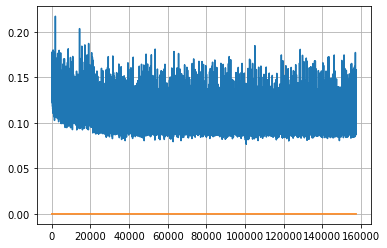

Epoch: 404, iteration 0, loss 0.09495928883552551, cov_diff 0.4149334037986107 cov_diff train 0.4151227151629263
Epoch: 404, iteration 1, loss 0.10262012481689453, cov_diff 0.4043516712790776 cov_diff train 0.40360367701188066
Epoch: 404, iteration 2, loss 0.10000541806221008, cov_diff 0.4154916241534159 cov_diff train 0.4148861944930867
Epoch: 404, iteration 3, loss 0.10467347502708435, cov_diff 0.41506238790855365 cov_diff train 0.4138892296225995
Epoch: 404, iteration 4, loss 0.10961282253265381, cov_diff 0.42851356458291945 cov_diff train 0.4281129780724558
Epoch: 404, iteration 5, loss 0.10904279351234436, cov_diff 0.4217678169763807 cov_diff train 0.42096680905987305
Epoch: 404, iteration 6, loss 0.10048964619636536, cov_diff 0.4076163376494703 cov_diff train 0.407788734665169
Epoch: 404, iteration 7, loss 0.0948261022567749, cov_diff 0.41825838346633515 cov_diff train 0.4175858138669486
Epoch: 404, iteration 8, loss 0.10850143432617188, cov_diff 0.407852162131082 cov_diff train 

Epoch: 404, iteration 80, loss 0.10468694567680359, cov_diff 0.41035435057511066 cov_diff train 0.40877110501450176
Epoch: 404, iteration 81, loss 0.10268434882164001, cov_diff 0.40298771613172973 cov_diff train 0.40230478462481156
Epoch: 404, iteration 82, loss 0.11643892526626587, cov_diff 0.40243615991022436 cov_diff train 0.40133408356234745
Epoch: 404, iteration 83, loss 0.09893041849136353, cov_diff 0.40840298858892554 cov_diff train 0.4072567022563912
Epoch: 404, iteration 84, loss 0.10356152057647705, cov_diff 0.40814207034215066 cov_diff train 0.4079361845390125
Epoch: 404, iteration 85, loss 0.10537600517272949, cov_diff 0.41813982208416606 cov_diff train 0.41753747520100304
Epoch: 404, iteration 86, loss 0.09947258234024048, cov_diff 0.4065268960581044 cov_diff train 0.40616098840934617
Epoch: 404, iteration 87, loss 0.11427739262580872, cov_diff 0.41360787708799424 cov_diff train 0.41281290413234367
Epoch: 404, iteration 88, loss 0.11891347169876099, cov_diff 0.416407723355

Epoch: 404, iteration 160, loss 0.11024543642997742, cov_diff 0.4381701122203996 cov_diff train 0.4380567366107975
Epoch: 404, iteration 161, loss 0.11583459377288818, cov_diff 0.4103249347308744 cov_diff train 0.4104932747099692
Epoch: 404, iteration 162, loss 0.08920824527740479, cov_diff 0.4222367205116415 cov_diff train 0.4208755155514686
Epoch: 404, iteration 163, loss 0.1055188775062561, cov_diff 0.41288669457993354 cov_diff train 0.4120759753999375
Epoch: 404, iteration 164, loss 0.10617601871490479, cov_diff 0.4080072776579949 cov_diff train 0.4069347932039302
Epoch: 404, iteration 165, loss 0.10605835914611816, cov_diff 0.4217912354483849 cov_diff train 0.42135741150337636
Epoch: 404, iteration 166, loss 0.10607612133026123, cov_diff 0.405389050599121 cov_diff train 0.4026343116287799
Epoch: 404, iteration 167, loss 0.09868377447128296, cov_diff 0.41338540027560733 cov_diff train 0.41350213506436995
Epoch: 404, iteration 168, loss 0.10198134183883667, cov_diff 0.42052082506739

Epoch: 404, iteration 237, loss 0.11206474900245667, cov_diff 0.4147122875180178 cov_diff train 0.41422984455270495
Epoch: 404, iteration 238, loss 0.09840196371078491, cov_diff 0.4079630245347559 cov_diff train 0.407915229170906
Epoch: 404, iteration 239, loss 0.10633328557014465, cov_diff 0.41255365686866224 cov_diff train 0.4128644179467145
Epoch: 404, iteration 240, loss 0.10402607917785645, cov_diff 0.3951591050825721 cov_diff train 0.3951325202139073
Epoch: 404, iteration 241, loss 0.10791647434234619, cov_diff 0.4190430594247285 cov_diff train 0.41858894559798226
Epoch: 404, iteration 242, loss 0.10217127203941345, cov_diff 0.4032236086542589 cov_diff train 0.40328514189243525
Epoch: 404, iteration 243, loss 0.10486668348312378, cov_diff 0.4119407087290785 cov_diff train 0.4115604513941917
Epoch: 404, iteration 244, loss 0.09945535659790039, cov_diff 0.41485656739387644 cov_diff train 0.41429860977391086
Epoch: 404, iteration 245, loss 0.11212334036827087, cov_diff 0.41252783452

Epoch: 404, iteration 315, loss 0.10665449500083923, cov_diff 0.41263711797720626 cov_diff train 0.4119468660616905
Epoch: 404, iteration 316, loss 0.1122390627861023, cov_diff 0.41215682655504016 cov_diff train 0.4115833851618811
Epoch: 404, iteration 317, loss 0.10013261437416077, cov_diff 0.4099011585310998 cov_diff train 0.4099320315472109
Epoch: 404, iteration 318, loss 0.09858259558677673, cov_diff 0.4062428962587569 cov_diff train 0.4062635385160584
Epoch: 404, iteration 319, loss 0.10103878378868103, cov_diff 0.4010088433959126 cov_diff train 0.40124193951339987
Epoch: 404, iteration 320, loss 0.10863631963729858, cov_diff 0.40906869217216807 cov_diff train 0.40909247911742247
Epoch: 404, iteration 321, loss 0.10240942239761353, cov_diff 0.4207899711991568 cov_diff train 0.42044077315893263
Epoch: 404, iteration 322, loss 0.11271297931671143, cov_diff 0.38772757497320415 cov_diff train 0.3867583587378626
Epoch: 404, iteration 323, loss 0.0961657464504242, cov_diff 0.40112121992

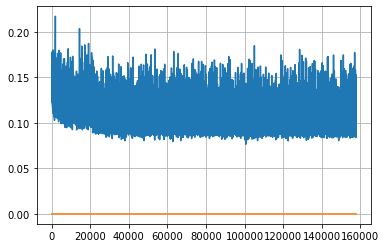

Epoch: 405, iteration 0, loss 0.10481485724449158, cov_diff 0.41216154429577406 cov_diff train 0.41140796175929206
Epoch: 405, iteration 1, loss 0.10387331247329712, cov_diff 0.4171494434228687 cov_diff train 0.41482235858427274
Epoch: 405, iteration 2, loss 0.10838508605957031, cov_diff 0.4243004467564083 cov_diff train 0.42364136684463116
Epoch: 405, iteration 3, loss 0.12717372179031372, cov_diff 0.4314936947310912 cov_diff train 0.43026543916212834
Epoch: 405, iteration 4, loss 0.10429853200912476, cov_diff 0.4131689760209333 cov_diff train 0.41106823271817106
Epoch: 405, iteration 5, loss 0.09167265892028809, cov_diff 0.40614055608229166 cov_diff train 0.4043002827108118
Epoch: 405, iteration 6, loss 0.10463365912437439, cov_diff 0.41740758455672483 cov_diff train 0.41673901649053263
Epoch: 405, iteration 7, loss 0.09178829193115234, cov_diff 0.39565180473323214 cov_diff train 0.3943699940091732
Epoch: 405, iteration 8, loss 0.11150634288787842, cov_diff 0.41918193454755776 cov_di

Epoch: 405, iteration 79, loss 0.10534977912902832, cov_diff 0.4174710306034465 cov_diff train 0.41651854997713594
Epoch: 405, iteration 80, loss 0.10046055912971497, cov_diff 0.4053516704982943 cov_diff train 0.40532208893401867
Epoch: 405, iteration 81, loss 0.10999897122383118, cov_diff 0.39657573672583823 cov_diff train 0.39649786069296084
Epoch: 405, iteration 82, loss 0.10311383008956909, cov_diff 0.3961630745900921 cov_diff train 0.3964871828714049
Epoch: 405, iteration 83, loss 0.1020539402961731, cov_diff 0.39218870840404146 cov_diff train 0.3919048301770079
Epoch: 405, iteration 84, loss 0.10701879858970642, cov_diff 0.40972557591150593 cov_diff train 0.4095053715838142
Epoch: 405, iteration 85, loss 0.10706460475921631, cov_diff 0.4139232459249772 cov_diff train 0.41354742259345295
Epoch: 405, iteration 86, loss 0.10300108790397644, cov_diff 0.4168658412398479 cov_diff train 0.4155200749695473
Epoch: 405, iteration 87, loss 0.11390647292137146, cov_diff 0.4188660150414909 co

Epoch: 405, iteration 159, loss 0.10252466797828674, cov_diff 0.39569975718314726 cov_diff train 0.39537026999733116
Epoch: 405, iteration 160, loss 0.10527363419532776, cov_diff 0.40769022187294957 cov_diff train 0.406527748588466
Epoch: 405, iteration 161, loss 0.10213759541511536, cov_diff 0.4038110625502798 cov_diff train 0.4035420021561042
Epoch: 405, iteration 162, loss 0.11147230863571167, cov_diff 0.4152047616817999 cov_diff train 0.4145375565774145
Epoch: 405, iteration 163, loss 0.10344868898391724, cov_diff 0.4028505237354638 cov_diff train 0.4022103463306152
Epoch: 405, iteration 164, loss 0.10726872086524963, cov_diff 0.41767194384334794 cov_diff train 0.4172857660428517
Epoch: 405, iteration 165, loss 0.09723669290542603, cov_diff 0.420579721544938 cov_diff train 0.42000312792087546
Epoch: 405, iteration 166, loss 0.11388498544692993, cov_diff 0.4109145455312512 cov_diff train 0.4094501687234692
Epoch: 405, iteration 167, loss 0.10269829630851746, cov_diff 0.4120536643553

Epoch: 405, iteration 236, loss 0.10457408428192139, cov_diff 0.42120627899588503 cov_diff train 0.420502956306997
Epoch: 405, iteration 237, loss 0.11081311106681824, cov_diff 0.41827176344975825 cov_diff train 0.41708943718329317
Epoch: 405, iteration 238, loss 0.10784590244293213, cov_diff 0.4024596581909049 cov_diff train 0.4009325049042198
Epoch: 405, iteration 239, loss 0.10208016633987427, cov_diff 0.43652947338002734 cov_diff train 0.4360424223933058
Epoch: 405, iteration 240, loss 0.09655153751373291, cov_diff 0.4013083033337938 cov_diff train 0.4006556551397184
Epoch: 405, iteration 241, loss 0.09520462155342102, cov_diff 0.41487736189029306 cov_diff train 0.41367413705777145
Epoch: 405, iteration 242, loss 0.10215875506401062, cov_diff 0.4101474212506906 cov_diff train 0.4085075146109642
Epoch: 405, iteration 243, loss 0.10046219825744629, cov_diff 0.40582986312574837 cov_diff train 0.40457016323347184
Epoch: 405, iteration 244, loss 0.10725373029708862, cov_diff 0.417778287

Epoch: 405, iteration 313, loss 0.11049801111221313, cov_diff 0.4078582814512861 cov_diff train 0.4075634895971132
Epoch: 405, iteration 314, loss 0.10395875573158264, cov_diff 0.4146194906857293 cov_diff train 0.414592978381189
Epoch: 405, iteration 315, loss 0.11421588063240051, cov_diff 0.40538284660301427 cov_diff train 0.405580939156741
Epoch: 405, iteration 316, loss 0.1029461920261383, cov_diff 0.4117394168783294 cov_diff train 0.41097624839976643
Epoch: 405, iteration 317, loss 0.10858049988746643, cov_diff 0.4126009641528683 cov_diff train 0.41123534804202516
Epoch: 405, iteration 318, loss 0.1045691967010498, cov_diff 0.4219395187131592 cov_diff train 0.42195994042144835
Epoch: 405, iteration 319, loss 0.1088285744190216, cov_diff 0.4061485880260902 cov_diff train 0.40545937909866214
Epoch: 405, iteration 320, loss 0.10175284743309021, cov_diff 0.4106558228944127 cov_diff train 0.4101415623748179
Epoch: 405, iteration 321, loss 0.10869604349136353, cov_diff 0.4173589694806990

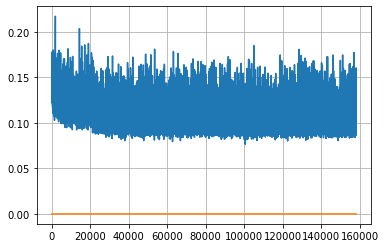

Epoch: 406, iteration 0, loss 0.1073681116104126, cov_diff 0.4160134023221429 cov_diff train 0.4146585122603738
Epoch: 406, iteration 1, loss 0.09513437747955322, cov_diff 0.412123228113522 cov_diff train 0.41170780889667635
Epoch: 406, iteration 2, loss 0.08942356705665588, cov_diff 0.41224840238797417 cov_diff train 0.41188634298160903
Epoch: 406, iteration 3, loss 0.11308708786964417, cov_diff 0.3951186560013909 cov_diff train 0.39504576821326076
Epoch: 406, iteration 4, loss 0.1036805808544159, cov_diff 0.4188723213651657 cov_diff train 0.4184840490222059
Epoch: 406, iteration 5, loss 0.1060190200805664, cov_diff 0.41385872762301756 cov_diff train 0.41320712128823317
Epoch: 406, iteration 6, loss 0.09556788206100464, cov_diff 0.4158932443045582 cov_diff train 0.41435304939735
Epoch: 406, iteration 7, loss 0.10780814290046692, cov_diff 0.4140233752964838 cov_diff train 0.4140209675096113
Epoch: 406, iteration 8, loss 0.10241034626960754, cov_diff 0.40742902992641244 cov_diff train 0

Epoch: 406, iteration 78, loss 0.10891053080558777, cov_diff 0.4100818470360479 cov_diff train 0.40939768990492637
Epoch: 406, iteration 79, loss 0.09723678231239319, cov_diff 0.39677858422964213 cov_diff train 0.3963333559108339
Epoch: 406, iteration 80, loss 0.10718747973442078, cov_diff 0.409344844956085 cov_diff train 0.40834069779718596
Epoch: 406, iteration 81, loss 0.10280856490135193, cov_diff 0.4174366148659967 cov_diff train 0.4163815478976892
Epoch: 406, iteration 82, loss 0.1113351583480835, cov_diff 0.41036360283842205 cov_diff train 0.40956567694463886
Epoch: 406, iteration 83, loss 0.096859872341156, cov_diff 0.41337280275026445 cov_diff train 0.4127403452768744
Epoch: 406, iteration 84, loss 0.10445567965507507, cov_diff 0.4099377210858588 cov_diff train 0.4087693502472269
Epoch: 406, iteration 85, loss 0.09898015856742859, cov_diff 0.4195795413023202 cov_diff train 0.41866662810816074
Epoch: 406, iteration 86, loss 0.09664154052734375, cov_diff 0.4118436899580599 cov_d

Epoch: 406, iteration 155, loss 0.10799989104270935, cov_diff 0.41137983764977365 cov_diff train 0.4103582376008568
Epoch: 406, iteration 156, loss 0.09688156843185425, cov_diff 0.4070471923919701 cov_diff train 0.40652355435067605
Epoch: 406, iteration 157, loss 0.11606764793395996, cov_diff 0.4124025008831805 cov_diff train 0.4118517259766325
Epoch: 406, iteration 158, loss 0.10402178764343262, cov_diff 0.3991084278965483 cov_diff train 0.398799967540771
Epoch: 406, iteration 159, loss 0.10532253980636597, cov_diff 0.41456812659873976 cov_diff train 0.4154699189285069
Epoch: 406, iteration 160, loss 0.10848772525787354, cov_diff 0.41719243404017625 cov_diff train 0.41598958190463353
Epoch: 406, iteration 161, loss 0.10140103101730347, cov_diff 0.41378109597702245 cov_diff train 0.4120310513411239
Epoch: 406, iteration 162, loss 0.10607963800430298, cov_diff 0.4129651664100313 cov_diff train 0.4127180614220651
Epoch: 406, iteration 163, loss 0.11074963212013245, cov_diff 0.40463311848

Epoch: 406, iteration 227, loss 0.10008710622787476, cov_diff 0.40367924018646123 cov_diff train 0.4026288485367784
Epoch: 406, iteration 228, loss 0.10765457153320312, cov_diff 0.4220318882356298 cov_diff train 0.42095768373743925
Epoch: 406, iteration 229, loss 0.10290411114692688, cov_diff 0.421487833961337 cov_diff train 0.42032333227373536
Epoch: 406, iteration 230, loss 0.10203078389167786, cov_diff 0.39767024589430844 cov_diff train 0.3970705836489558
Epoch: 406, iteration 231, loss 0.10788559913635254, cov_diff 0.4041025759425911 cov_diff train 0.4035372444110037
Epoch: 406, iteration 232, loss 0.11588293313980103, cov_diff 0.38960827546110777 cov_diff train 0.38836360768477596
Epoch: 406, iteration 233, loss 0.09847640991210938, cov_diff 0.4047666639506233 cov_diff train 0.40463696148258127
Epoch: 406, iteration 234, loss 0.09547984600067139, cov_diff 0.40359995427587475 cov_diff train 0.402885798781102
Epoch: 406, iteration 235, loss 0.10371527075767517, cov_diff 0.4159544873

Epoch: 406, iteration 308, loss 0.1018204391002655, cov_diff 0.41593549429612525 cov_diff train 0.41595539582560426
Epoch: 406, iteration 309, loss 0.11161389946937561, cov_diff 0.4253901451883214 cov_diff train 0.4249321995713523
Epoch: 406, iteration 310, loss 0.09287711977958679, cov_diff 0.41500567662138216 cov_diff train 0.414124950734826
Epoch: 406, iteration 311, loss 0.10817286372184753, cov_diff 0.4110651193291657 cov_diff train 0.4107527121781425
Epoch: 406, iteration 312, loss 0.10464867949485779, cov_diff 0.41668582237919854 cov_diff train 0.415782882846593
Epoch: 406, iteration 313, loss 0.10332250595092773, cov_diff 0.4053248422712024 cov_diff train 0.4052978592892201
Epoch: 406, iteration 314, loss 0.09472918510437012, cov_diff 0.4113767698646763 cov_diff train 0.41072052654724556
Epoch: 406, iteration 315, loss 0.10613885521888733, cov_diff 0.4127098117406713 cov_diff train 0.4128470199583821
Epoch: 406, iteration 316, loss 0.09718209505081177, cov_diff 0.41507998975825

Epoch: 406, iteration 388, loss 0.10373044013977051, cov_diff 0.41537457344243967 cov_diff train 0.41443667491536895
Epoch: 406, iteration 389, loss 0.0945599377155304, cov_diff 0.4087796737812451 cov_diff train 0.40752507385483383
Epoch: 406, iteration 390, loss 0.1622808873653412, cov_diff 0.4466396380078893 cov_diff train 0.4465496273969777


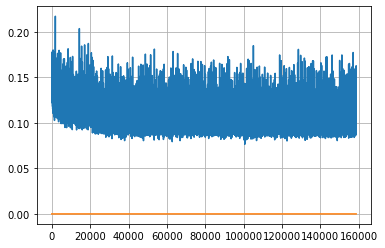

Epoch: 407, iteration 0, loss 0.1113012433052063, cov_diff 0.41176572042407295 cov_diff train 0.4109187890097454
Epoch: 407, iteration 1, loss 0.09363451600074768, cov_diff 0.4100044361310937 cov_diff train 0.40969826104432155
Epoch: 407, iteration 2, loss 0.10403269529342651, cov_diff 0.40430640918081456 cov_diff train 0.40349022358619274
Epoch: 407, iteration 3, loss 0.09045436978340149, cov_diff 0.4102626456498924 cov_diff train 0.40947976271487735
Epoch: 407, iteration 4, loss 0.10519668459892273, cov_diff 0.40405774931155014 cov_diff train 0.40447298677859794
Epoch: 407, iteration 5, loss 0.10490730404853821, cov_diff 0.4003776320036895 cov_diff train 0.40024416521200706
Epoch: 407, iteration 6, loss 0.10511407256126404, cov_diff 0.4136083347800248 cov_diff train 0.4135167005735125
Epoch: 407, iteration 7, loss 0.0991833508014679, cov_diff 0.40164232472673383 cov_diff train 0.4016866810685352
Epoch: 407, iteration 8, loss 0.0979878306388855, cov_diff 0.39524153635096637 cov_diff t

Epoch: 407, iteration 77, loss 0.11820909380912781, cov_diff 0.40398698261821825 cov_diff train 0.4035657435706761
Epoch: 407, iteration 78, loss 0.09814733266830444, cov_diff 0.4136184837636371 cov_diff train 0.41319504986751904
Epoch: 407, iteration 79, loss 0.09965455532073975, cov_diff 0.4151456005480015 cov_diff train 0.41435291016433934
Epoch: 407, iteration 80, loss 0.11273223161697388, cov_diff 0.4204781476467677 cov_diff train 0.4200991281570232
Epoch: 407, iteration 81, loss 0.10605549812316895, cov_diff 0.4094878903099374 cov_diff train 0.40893729433227793
Epoch: 407, iteration 82, loss 0.09607347846031189, cov_diff 0.39815877915358977 cov_diff train 0.39795981678220566
Epoch: 407, iteration 83, loss 0.11412125825881958, cov_diff 0.4223822099041796 cov_diff train 0.4199070013562502
Epoch: 407, iteration 84, loss 0.10138815641403198, cov_diff 0.4038359573485691 cov_diff train 0.40274871880526714
Epoch: 407, iteration 85, loss 0.09058770537376404, cov_diff 0.417641645326971 co

Epoch: 407, iteration 158, loss 0.0977618396282196, cov_diff 0.41572514554696516 cov_diff train 0.4145626720270659
Epoch: 407, iteration 159, loss 0.10554373264312744, cov_diff 0.3919232985869982 cov_diff train 0.3913457046114692
Epoch: 407, iteration 160, loss 0.09937885403633118, cov_diff 0.39705370095223497 cov_diff train 0.3969632159491787
Epoch: 407, iteration 161, loss 0.10175535082817078, cov_diff 0.405057971769515 cov_diff train 0.40509301902762196
Epoch: 407, iteration 162, loss 0.09968429803848267, cov_diff 0.4093192314923407 cov_diff train 0.40741666435358315
Epoch: 407, iteration 163, loss 0.10258695483207703, cov_diff 0.409893906376083 cov_diff train 0.40918843446119246
Epoch: 407, iteration 164, loss 0.10429957509040833, cov_diff 0.4236260611348775 cov_diff train 0.423090673416664
Epoch: 407, iteration 165, loss 0.11499014496803284, cov_diff 0.42208150909805964 cov_diff train 0.42197458764887946
Epoch: 407, iteration 166, loss 0.10325181484222412, cov_diff 0.4049182504120

Epoch: 407, iteration 237, loss 0.1098722517490387, cov_diff 0.4137149258053446 cov_diff train 0.4112623321466046
Epoch: 407, iteration 238, loss 0.10439133644104004, cov_diff 0.4205550915447743 cov_diff train 0.42018907383688214
Epoch: 407, iteration 239, loss 0.1114206612110138, cov_diff 0.4243321151321029 cov_diff train 0.4228416235985785
Epoch: 407, iteration 240, loss 0.11736142635345459, cov_diff 0.40792204210965255 cov_diff train 0.4070200027567585
Epoch: 407, iteration 241, loss 0.09536078572273254, cov_diff 0.42278737105380026 cov_diff train 0.4215471052049894
Epoch: 407, iteration 242, loss 0.0994294285774231, cov_diff 0.411863664416066 cov_diff train 0.4122654947561702
Epoch: 407, iteration 243, loss 0.10583633184432983, cov_diff 0.4015266922575155 cov_diff train 0.4009502062902824
Epoch: 407, iteration 244, loss 0.08928629755973816, cov_diff 0.4211658130143261 cov_diff train 0.42124840371740535
Epoch: 407, iteration 245, loss 0.10986819863319397, cov_diff 0.4088858146629437

Epoch: 407, iteration 308, loss 0.09855422377586365, cov_diff 0.41725070119360747 cov_diff train 0.4162869155184001
Epoch: 407, iteration 309, loss 0.10525280237197876, cov_diff 0.422660725570194 cov_diff train 0.42100069465662854
Epoch: 407, iteration 310, loss 0.10923057794570923, cov_diff 0.40179947932270743 cov_diff train 0.40176301557550964
Epoch: 407, iteration 311, loss 0.09873497486114502, cov_diff 0.4009857694690009 cov_diff train 0.4001461643148192
Epoch: 407, iteration 312, loss 0.1008087694644928, cov_diff 0.40819038337908786 cov_diff train 0.4066990731186152
Epoch: 407, iteration 313, loss 0.09983009099960327, cov_diff 0.41886144533181946 cov_diff train 0.4179015722124558
Epoch: 407, iteration 314, loss 0.09601470828056335, cov_diff 0.4252840686234816 cov_diff train 0.4252223315700128
Epoch: 407, iteration 315, loss 0.10720992088317871, cov_diff 0.4131397794155417 cov_diff train 0.41178989863373094
Epoch: 407, iteration 316, loss 0.10161307454109192, cov_diff 0.42746984016

Epoch: 407, iteration 388, loss 0.10085567831993103, cov_diff 0.412977039299441 cov_diff train 0.41278849354787184
Epoch: 407, iteration 389, loss 0.10752949118614197, cov_diff 0.40852387005412316 cov_diff train 0.4077838197373944
Epoch: 407, iteration 390, loss 0.159031480550766, cov_diff 0.46419101583670286 cov_diff train 0.46351338002022224


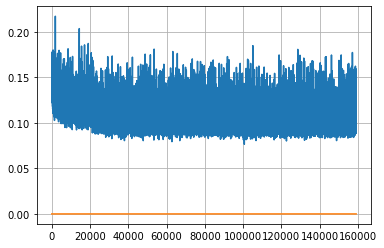

Epoch: 408, iteration 0, loss 0.09657549858093262, cov_diff 0.4140656789574816 cov_diff train 0.4137707703574576
Epoch: 408, iteration 1, loss 0.09375590085983276, cov_diff 0.4026584252992182 cov_diff train 0.40220542677802157
Epoch: 408, iteration 2, loss 0.1070706844329834, cov_diff 0.41649677489595094 cov_diff train 0.41606202594568203
Epoch: 408, iteration 3, loss 0.1030111312866211, cov_diff 0.41991111886495003 cov_diff train 0.4197590296762083
Epoch: 408, iteration 4, loss 0.1090162992477417, cov_diff 0.4130738818605257 cov_diff train 0.4119277712025184
Epoch: 408, iteration 5, loss 0.12113174796104431, cov_diff 0.41041650830037 cov_diff train 0.40974250784202204
Epoch: 408, iteration 6, loss 0.1011343002319336, cov_diff 0.41063332346420844 cov_diff train 0.40988294689349236
Epoch: 408, iteration 7, loss 0.09979236125946045, cov_diff 0.39846423756933635 cov_diff train 0.3981254971846304
Epoch: 408, iteration 8, loss 0.09970954060554504, cov_diff 0.3974567064801029 cov_diff train 

Epoch: 408, iteration 79, loss 0.11166390776634216, cov_diff 0.41670150769459047 cov_diff train 0.4157607871080596
Epoch: 408, iteration 80, loss 0.09629246592521667, cov_diff 0.3978497948375391 cov_diff train 0.3977389696348191
Epoch: 408, iteration 81, loss 0.10340863466262817, cov_diff 0.40462165403738126 cov_diff train 0.4035861168012873
Epoch: 408, iteration 82, loss 0.09751236438751221, cov_diff 0.40396696404580384 cov_diff train 0.40310491089018613
Epoch: 408, iteration 83, loss 0.10639861226081848, cov_diff 0.40731939124509514 cov_diff train 0.40619804990093844
Epoch: 408, iteration 84, loss 0.10481497645378113, cov_diff 0.41216276753156944 cov_diff train 0.4117741672560216
Epoch: 408, iteration 85, loss 0.10123634338378906, cov_diff 0.41446318212683997 cov_diff train 0.4134828493822166
Epoch: 408, iteration 86, loss 0.09742408990859985, cov_diff 0.4023757591977014 cov_diff train 0.4029756499324465
Epoch: 408, iteration 87, loss 0.09800750017166138, cov_diff 0.40930140525898345

Epoch: 408, iteration 157, loss 0.0930345356464386, cov_diff 0.41258663649002036 cov_diff train 0.41164235917796294
Epoch: 408, iteration 158, loss 0.12094348669052124, cov_diff 0.4230209982956648 cov_diff train 0.42234118018016836
Epoch: 408, iteration 159, loss 0.1104869544506073, cov_diff 0.4075259081310481 cov_diff train 0.4065427620402345
Epoch: 408, iteration 160, loss 0.09607240557670593, cov_diff 0.39699364791609676 cov_diff train 0.3960311462485405
Epoch: 408, iteration 161, loss 0.10295498371124268, cov_diff 0.41083417299687686 cov_diff train 0.40967815653110423
Epoch: 408, iteration 162, loss 0.09873664379119873, cov_diff 0.41224731333976883 cov_diff train 0.41265572064047046
Epoch: 408, iteration 163, loss 0.10404393076896667, cov_diff 0.40503292188392115 cov_diff train 0.4035819773169899
Epoch: 408, iteration 164, loss 0.1088549792766571, cov_diff 0.4129998152486552 cov_diff train 0.41249006685024403
Epoch: 408, iteration 165, loss 0.1073026955127716, cov_diff 0.4131639958

Epoch: 408, iteration 238, loss 0.10040351748466492, cov_diff 0.41772167384555103 cov_diff train 0.41762631953279505
Epoch: 408, iteration 239, loss 0.09835511445999146, cov_diff 0.4044529149463249 cov_diff train 0.40457249721035926
Epoch: 408, iteration 240, loss 0.09433463215827942, cov_diff 0.41619041941084356 cov_diff train 0.4158194385809246
Epoch: 408, iteration 241, loss 0.09825608134269714, cov_diff 0.4095137048146417 cov_diff train 0.40959880446114194
Epoch: 408, iteration 242, loss 0.1096702516078949, cov_diff 0.40750397970551133 cov_diff train 0.4066430305333184
Epoch: 408, iteration 243, loss 0.10179409384727478, cov_diff 0.417206774044385 cov_diff train 0.41679067671771586
Epoch: 408, iteration 244, loss 0.10068684816360474, cov_diff 0.4143873881241117 cov_diff train 0.41464068605552223
Epoch: 408, iteration 245, loss 0.11094865202903748, cov_diff 0.3883996579862261 cov_diff train 0.38906796629347135
Epoch: 408, iteration 246, loss 0.10034212470054626, cov_diff 0.424222476

Epoch: 408, iteration 317, loss 0.09349867701530457, cov_diff 0.4141654131028755 cov_diff train 0.41378970017817546
Epoch: 408, iteration 318, loss 0.09420835971832275, cov_diff 0.4082182461278287 cov_diff train 0.4080294515514447
Epoch: 408, iteration 319, loss 0.11349543929100037, cov_diff 0.4044169461230488 cov_diff train 0.40408006974408706
Epoch: 408, iteration 320, loss 0.11203494668006897, cov_diff 0.4073128834671581 cov_diff train 0.4071831919274835
Epoch: 408, iteration 321, loss 0.11087554693222046, cov_diff 0.3944482234470664 cov_diff train 0.39413904684626533
Epoch: 408, iteration 322, loss 0.09479594230651855, cov_diff 0.41579886711197844 cov_diff train 0.41514940687808316
Epoch: 408, iteration 323, loss 0.10823863744735718, cov_diff 0.40145686353120386 cov_diff train 0.4003728201551248
Epoch: 408, iteration 324, loss 0.10717636346817017, cov_diff 0.397064798962039 cov_diff train 0.39696870525409855
Epoch: 408, iteration 325, loss 0.10693585872650146, cov_diff 0.4004049396

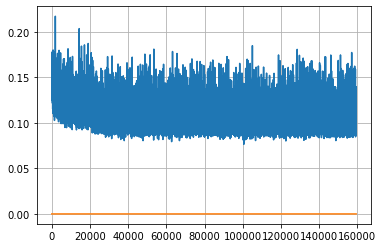

Epoch: 409, iteration 0, loss 0.10250762104988098, cov_diff 0.40319051412094703 cov_diff train 0.4038039550963078
Epoch: 409, iteration 1, loss 0.10961732268333435, cov_diff 0.41435248721425655 cov_diff train 0.41374424004512667
Epoch: 409, iteration 2, loss 0.10439795255661011, cov_diff 0.40999524183591485 cov_diff train 0.4107791240525255
Epoch: 409, iteration 3, loss 0.08959418535232544, cov_diff 0.4098318415935039 cov_diff train 0.40979331156374516
Epoch: 409, iteration 4, loss 0.10194140672683716, cov_diff 0.3990066563969506 cov_diff train 0.39924174979919846
Epoch: 409, iteration 5, loss 0.11476761102676392, cov_diff 0.4160264985601109 cov_diff train 0.41527795970117615
Epoch: 409, iteration 6, loss 0.10397660732269287, cov_diff 0.41510368220881816 cov_diff train 0.41407691481456954
Epoch: 409, iteration 7, loss 0.10292118787765503, cov_diff 0.40920322121166924 cov_diff train 0.40911791261740865
Epoch: 409, iteration 8, loss 0.10522925853729248, cov_diff 0.4261976138060814 cov_di

Epoch: 409, iteration 81, loss 0.10782933235168457, cov_diff 0.41741978221572923 cov_diff train 0.4171348252056054
Epoch: 409, iteration 82, loss 0.11024901270866394, cov_diff 0.41413836351619165 cov_diff train 0.41375122333057457
Epoch: 409, iteration 83, loss 0.09514856338500977, cov_diff 0.4043300361661698 cov_diff train 0.40390360831506633
Epoch: 409, iteration 84, loss 0.09582963585853577, cov_diff 0.41022928446627255 cov_diff train 0.4106580387798852
Epoch: 409, iteration 85, loss 0.11254656314849854, cov_diff 0.41655257269458285 cov_diff train 0.4165196149805123
Epoch: 409, iteration 86, loss 0.10182878375053406, cov_diff 0.40706807825471153 cov_diff train 0.40757798036511567
Epoch: 409, iteration 87, loss 0.10364341735839844, cov_diff 0.4005155404752728 cov_diff train 0.40081317357037577
Epoch: 409, iteration 88, loss 0.10259145498275757, cov_diff 0.4227408624803906 cov_diff train 0.4222203294733958
Epoch: 409, iteration 89, loss 0.10700127482414246, cov_diff 0.4089059616233882

Epoch: 409, iteration 160, loss 0.11171892285346985, cov_diff 0.41156226716281064 cov_diff train 0.4111853931347472
Epoch: 409, iteration 161, loss 0.09009483456611633, cov_diff 0.41829217412354697 cov_diff train 0.4175072095908945
Epoch: 409, iteration 162, loss 0.10622113943099976, cov_diff 0.4118392899426435 cov_diff train 0.41079112981343946
Epoch: 409, iteration 163, loss 0.11502981185913086, cov_diff 0.41404506416259423 cov_diff train 0.4133589937090496
Epoch: 409, iteration 164, loss 0.10319831967353821, cov_diff 0.4082457697709589 cov_diff train 0.40650857535397356
Epoch: 409, iteration 165, loss 0.10904282331466675, cov_diff 0.40910319776248877 cov_diff train 0.40746601543494537
Epoch: 409, iteration 166, loss 0.1002953052520752, cov_diff 0.41508829289171406 cov_diff train 0.41451755399354473
Epoch: 409, iteration 167, loss 0.1098388135433197, cov_diff 0.41770737274753755 cov_diff train 0.41590748968484864
Epoch: 409, iteration 168, loss 0.10779470205307007, cov_diff 0.4135112

Epoch: 409, iteration 238, loss 0.09585154056549072, cov_diff 0.4088313887621666 cov_diff train 0.4083202623048611
Epoch: 409, iteration 239, loss 0.11502426862716675, cov_diff 0.41174800772423725 cov_diff train 0.40970328897706937
Epoch: 409, iteration 240, loss 0.11810106039047241, cov_diff 0.3984315255797712 cov_diff train 0.39790571214761356
Epoch: 409, iteration 241, loss 0.09349897503852844, cov_diff 0.4045863072682988 cov_diff train 0.40334687181669115
Epoch: 409, iteration 242, loss 0.09803599119186401, cov_diff 0.41144886538710895 cov_diff train 0.4105870485312651
Epoch: 409, iteration 243, loss 0.10366874933242798, cov_diff 0.39841009913967834 cov_diff train 0.397324234335415
Epoch: 409, iteration 244, loss 0.10668134689331055, cov_diff 0.4065189443348712 cov_diff train 0.40561532956029256
Epoch: 409, iteration 245, loss 0.09951847791671753, cov_diff 0.39712561362618287 cov_diff train 0.3964052976553649
Epoch: 409, iteration 246, loss 0.09031420946121216, cov_diff 0.413817133

Epoch: 409, iteration 316, loss 0.08946087956428528, cov_diff 0.39210503983112616 cov_diff train 0.39236823482307687
Epoch: 409, iteration 317, loss 0.1134597659111023, cov_diff 0.3982028924235248 cov_diff train 0.39789411626653826
Epoch: 409, iteration 318, loss 0.0992957055568695, cov_diff 0.42014581766256603 cov_diff train 0.4197989606875267
Epoch: 409, iteration 319, loss 0.1018877625465393, cov_diff 0.41303138021895774 cov_diff train 0.41149323349126626
Epoch: 409, iteration 320, loss 0.09852024912834167, cov_diff 0.4008510911891002 cov_diff train 0.4008252540391029
Epoch: 409, iteration 321, loss 0.10603082180023193, cov_diff 0.3955291739388381 cov_diff train 0.3964375858763349
Epoch: 409, iteration 322, loss 0.09087055921554565, cov_diff 0.40354833775504234 cov_diff train 0.4028724280035849
Epoch: 409, iteration 323, loss 0.10383531451225281, cov_diff 0.408724446100635 cov_diff train 0.4087027659592839
Epoch: 409, iteration 324, loss 0.1108267605304718, cov_diff 0.42200144549504

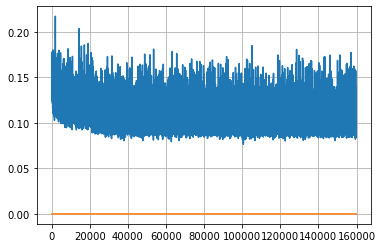

Epoch: 410, iteration 0, loss 0.10097503662109375, cov_diff 0.4123319210172791 cov_diff train 0.4120640154054703
Epoch: 410, iteration 1, loss 0.10056450963020325, cov_diff 0.4044286077218984 cov_diff train 0.40385793596295333
Epoch: 410, iteration 2, loss 0.10807958245277405, cov_diff 0.40018046162137416 cov_diff train 0.3999673185694635
Epoch: 410, iteration 3, loss 0.10152187943458557, cov_diff 0.4153572285062859 cov_diff train 0.41467981809266957
Epoch: 410, iteration 4, loss 0.09941691160202026, cov_diff 0.4042405182605753 cov_diff train 0.4039599515775697
Epoch: 410, iteration 5, loss 0.09602758288383484, cov_diff 0.4137238217452206 cov_diff train 0.4129176526333271
Epoch: 410, iteration 6, loss 0.1089734435081482, cov_diff 0.399429698298063 cov_diff train 0.39815781752166957
Epoch: 410, iteration 7, loss 0.10082542896270752, cov_diff 0.4121042673999852 cov_diff train 0.4114383100269996
Epoch: 410, iteration 8, loss 0.09948790073394775, cov_diff 0.39317881597761456 cov_diff train

Epoch: 410, iteration 81, loss 0.11170578002929688, cov_diff 0.4108914385689852 cov_diff train 0.41030963137836823
Epoch: 410, iteration 82, loss 0.10191100835800171, cov_diff 0.41660170975965694 cov_diff train 0.4155238299274448
Epoch: 410, iteration 83, loss 0.09756046533584595, cov_diff 0.4160738205189388 cov_diff train 0.4156931351615262
Epoch: 410, iteration 84, loss 0.0965680181980133, cov_diff 0.3949167865276035 cov_diff train 0.3946560155631739
Epoch: 410, iteration 85, loss 0.09990319609642029, cov_diff 0.4009684010758862 cov_diff train 0.4003962925452674
Epoch: 410, iteration 86, loss 0.10832911729812622, cov_diff 0.40018843956973904 cov_diff train 0.3995619894403271
Epoch: 410, iteration 87, loss 0.10179787874221802, cov_diff 0.4135024169964284 cov_diff train 0.4128593303875493
Epoch: 410, iteration 88, loss 0.10235649347305298, cov_diff 0.4058860793616687 cov_diff train 0.4053005965872242
Epoch: 410, iteration 89, loss 0.11287975311279297, cov_diff 0.40549726490363014 cov_d

Epoch: 410, iteration 164, loss 0.10717099905014038, cov_diff 0.4076868711894483 cov_diff train 0.4062440046977988
Epoch: 410, iteration 165, loss 0.10182133316993713, cov_diff 0.4060514803510271 cov_diff train 0.40553112612408165
Epoch: 410, iteration 166, loss 0.10493415594100952, cov_diff 0.4021348332164628 cov_diff train 0.40246584001229607
Epoch: 410, iteration 167, loss 0.10172277688980103, cov_diff 0.4140127084735483 cov_diff train 0.41374629687015624
Epoch: 410, iteration 168, loss 0.1102914810180664, cov_diff 0.41500731312245354 cov_diff train 0.4144600551718735
Epoch: 410, iteration 169, loss 0.09893181920051575, cov_diff 0.4150503737851071 cov_diff train 0.4146782191255674
Epoch: 410, iteration 170, loss 0.10371246933937073, cov_diff 0.40605138065391816 cov_diff train 0.4061234249251771
Epoch: 410, iteration 171, loss 0.10283690690994263, cov_diff 0.4063343529119466 cov_diff train 0.4060301813556165
Epoch: 410, iteration 172, loss 0.09989279508590698, cov_diff 0.397644133112

Epoch: 410, iteration 240, loss 0.10305085778236389, cov_diff 0.40175251880093144 cov_diff train 0.4009255497628668
Epoch: 410, iteration 241, loss 0.09629055857658386, cov_diff 0.39714620425325237 cov_diff train 0.39743747440951693
Epoch: 410, iteration 242, loss 0.09987735748291016, cov_diff 0.41487476368417897 cov_diff train 0.4146285594200601
Epoch: 410, iteration 243, loss 0.106330007314682, cov_diff 0.41654940462583984 cov_diff train 0.41602990523435607
Epoch: 410, iteration 244, loss 0.09981587529182434, cov_diff 0.40869855671846184 cov_diff train 0.4082213756292716
Epoch: 410, iteration 245, loss 0.10331013798713684, cov_diff 0.4151025433435446 cov_diff train 0.41405787692693186
Epoch: 410, iteration 246, loss 0.11024373769760132, cov_diff 0.39540380799536395 cov_diff train 0.3956244571847842
Epoch: 410, iteration 247, loss 0.1104561984539032, cov_diff 0.4054935355197491 cov_diff train 0.4059559208076844
Epoch: 410, iteration 248, loss 0.09983700513839722, cov_diff 0.4011516801

Epoch: 410, iteration 314, loss 0.08779767155647278, cov_diff 0.4016238460700115 cov_diff train 0.4017160670857877
Epoch: 410, iteration 315, loss 0.09159404039382935, cov_diff 0.3985494997830412 cov_diff train 0.3984750885099926
Epoch: 410, iteration 316, loss 0.09609931707382202, cov_diff 0.405348609026384 cov_diff train 0.4036674241414598
Epoch: 410, iteration 317, loss 0.10826802253723145, cov_diff 0.42387979415998395 cov_diff train 0.42358546721503126
Epoch: 410, iteration 318, loss 0.10021641850471497, cov_diff 0.40606865548310617 cov_diff train 0.4055558171557265
Epoch: 410, iteration 319, loss 0.10777297616004944, cov_diff 0.40154761295534774 cov_diff train 0.40085910655413853
Epoch: 410, iteration 320, loss 0.10656479001045227, cov_diff 0.4074981423802137 cov_diff train 0.40628856016386816
Epoch: 410, iteration 321, loss 0.09985601902008057, cov_diff 0.4073589266405234 cov_diff train 0.407151885596111
Epoch: 410, iteration 322, loss 0.09390023350715637, cov_diff 0.395705136244

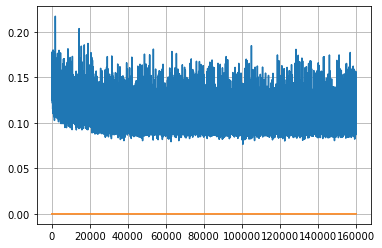

Epoch: 411, iteration 0, loss 0.09549099206924438, cov_diff 0.40783892076560213 cov_diff train 0.4069011253855128
Epoch: 411, iteration 1, loss 0.10158461332321167, cov_diff 0.4159356822784003 cov_diff train 0.41533490007534485
Epoch: 411, iteration 2, loss 0.09705409407615662, cov_diff 0.41883749979151513 cov_diff train 0.4182301449807772
Epoch: 411, iteration 3, loss 0.11123669147491455, cov_diff 0.41438283353074834 cov_diff train 0.4137309493122499
Epoch: 411, iteration 4, loss 0.0993858277797699, cov_diff 0.4185643344227619 cov_diff train 0.41808152738655907
Epoch: 411, iteration 5, loss 0.10288628935813904, cov_diff 0.3960200008908675 cov_diff train 0.3952889294975324
Epoch: 411, iteration 6, loss 0.10182499885559082, cov_diff 0.413537484571953 cov_diff train 0.4125895340207225
Epoch: 411, iteration 7, loss 0.10039547085762024, cov_diff 0.40127656143329604 cov_diff train 0.4003238791621681
Epoch: 411, iteration 8, loss 0.10059976577758789, cov_diff 0.40075343058183593 cov_diff tra

Epoch: 411, iteration 74, loss 0.09439140558242798, cov_diff 0.41843109109550825 cov_diff train 0.4175394922971709
Epoch: 411, iteration 75, loss 0.09620210528373718, cov_diff 0.41223218980917065 cov_diff train 0.4112881219761402
Epoch: 411, iteration 76, loss 0.10435521602630615, cov_diff 0.4108086248792803 cov_diff train 0.4100975784915663
Epoch: 411, iteration 77, loss 0.11149352788925171, cov_diff 0.4126608272688812 cov_diff train 0.4118601706502456
Epoch: 411, iteration 78, loss 0.09925311803817749, cov_diff 0.4106568526586336 cov_diff train 0.4105800507917321
Epoch: 411, iteration 79, loss 0.10976460576057434, cov_diff 0.4073699673273266 cov_diff train 0.4066070799400894
Epoch: 411, iteration 80, loss 0.09450948238372803, cov_diff 0.4052635949558698 cov_diff train 0.404670550498599
Epoch: 411, iteration 81, loss 0.09909984469413757, cov_diff 0.4028151511518812 cov_diff train 0.40228631021762984
Epoch: 411, iteration 82, loss 0.10374751687049866, cov_diff 0.4144511765432311 cov_di

Epoch: 411, iteration 151, loss 0.11048534512519836, cov_diff 0.42464690569442093 cov_diff train 0.4244842342981991
Epoch: 411, iteration 152, loss 0.11505427956581116, cov_diff 0.4247059855768831 cov_diff train 0.424975060358172
Epoch: 411, iteration 153, loss 0.11006370186805725, cov_diff 0.4209531462714213 cov_diff train 0.4199891480303207
Epoch: 411, iteration 154, loss 0.09287801384925842, cov_diff 0.40591675274963135 cov_diff train 0.4052354614141872
Epoch: 411, iteration 155, loss 0.11142545938491821, cov_diff 0.4103538108250609 cov_diff train 0.40885973021001826
Epoch: 411, iteration 156, loss 0.09434774518013, cov_diff 0.4154621854473167 cov_diff train 0.41570683450495066
Epoch: 411, iteration 157, loss 0.09809291362762451, cov_diff 0.4033823914658759 cov_diff train 0.40237297159510305
Epoch: 411, iteration 158, loss 0.103569895029068, cov_diff 0.40794859087212626 cov_diff train 0.40746904943040135
Epoch: 411, iteration 159, loss 0.08997976779937744, cov_diff 0.399022285950162

Epoch: 411, iteration 231, loss 0.1036309003829956, cov_diff 0.419285138600518 cov_diff train 0.4191744755201739
Epoch: 411, iteration 232, loss 0.10142597556114197, cov_diff 0.41235249149322545 cov_diff train 0.4117787459160061
Epoch: 411, iteration 233, loss 0.10924980044364929, cov_diff 0.43052516169181904 cov_diff train 0.4291440094722354
Epoch: 411, iteration 234, loss 0.11736318469047546, cov_diff 0.413864551822357 cov_diff train 0.4134212672977407
Epoch: 411, iteration 235, loss 0.11273461580276489, cov_diff 0.41943504491356254 cov_diff train 0.418473727950113
Epoch: 411, iteration 236, loss 0.10243961215019226, cov_diff 0.4205515067823111 cov_diff train 0.41990150377056507
Epoch: 411, iteration 237, loss 0.09374207258224487, cov_diff 0.4069926977246771 cov_diff train 0.4057609417709899
Epoch: 411, iteration 238, loss 0.099832683801651, cov_diff 0.4205502909219987 cov_diff train 0.419534927857706
Epoch: 411, iteration 239, loss 0.10683095455169678, cov_diff 0.4117855187555125 co

Epoch: 411, iteration 311, loss 0.09502527117729187, cov_diff 0.41013846517434205 cov_diff train 0.4093870170245027
Epoch: 411, iteration 312, loss 0.11119779944419861, cov_diff 0.4104334130237347 cov_diff train 0.4102007566051657
Epoch: 411, iteration 313, loss 0.10036444664001465, cov_diff 0.4099789567699507 cov_diff train 0.4098631060483734
Epoch: 411, iteration 314, loss 0.10407489538192749, cov_diff 0.40521520575140013 cov_diff train 0.40355549618978054
Epoch: 411, iteration 315, loss 0.09565603733062744, cov_diff 0.4218390329514262 cov_diff train 0.4219943212132003
Epoch: 411, iteration 316, loss 0.10140624642372131, cov_diff 0.41294852027248974 cov_diff train 0.4126434266042518
Epoch: 411, iteration 317, loss 0.1099269688129425, cov_diff 0.410628833281898 cov_diff train 0.4096727584963001
Epoch: 411, iteration 318, loss 0.10861727595329285, cov_diff 0.414865285877525 cov_diff train 0.41297132072601833
Epoch: 411, iteration 319, loss 0.09981980919837952, cov_diff 0.40864971393895

Epoch: 411, iteration 390, loss 0.14935502409934998, cov_diff 0.44759421534718963 cov_diff train 0.44720868742252856


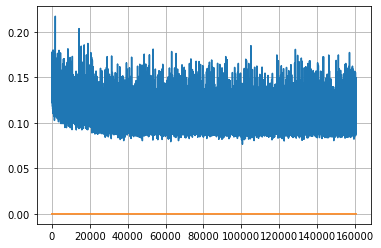

Epoch: 412, iteration 0, loss 0.11273372173309326, cov_diff 0.4097455783814559 cov_diff train 0.4095464201602402
Epoch: 412, iteration 1, loss 0.11195319890975952, cov_diff 0.4121716886113512 cov_diff train 0.41165292097246187
Epoch: 412, iteration 2, loss 0.1024843156337738, cov_diff 0.41232128195595097 cov_diff train 0.412071730513327
Epoch: 412, iteration 3, loss 0.0969216525554657, cov_diff 0.41389641158343193 cov_diff train 0.41332033317103845
Epoch: 412, iteration 4, loss 0.09557273983955383, cov_diff 0.40519595425055 cov_diff train 0.40446701691856685
Epoch: 412, iteration 5, loss 0.10896411538124084, cov_diff 0.40346665985791347 cov_diff train 0.40304145050594853
Epoch: 412, iteration 6, loss 0.09911394119262695, cov_diff 0.41690769147691314 cov_diff train 0.4155905994565459
Epoch: 412, iteration 7, loss 0.10315385460853577, cov_diff 0.4081034424341556 cov_diff train 0.40765782024298924
Epoch: 412, iteration 8, loss 0.10350969433784485, cov_diff 0.4140248083487207 cov_diff trai

Epoch: 412, iteration 79, loss 0.09105226397514343, cov_diff 0.4104456096951166 cov_diff train 0.4098500565026225
Epoch: 412, iteration 80, loss 0.10336360335350037, cov_diff 0.4043751781809354 cov_diff train 0.40330469806276537
Epoch: 412, iteration 81, loss 0.10571718215942383, cov_diff 0.3996974034100365 cov_diff train 0.39799995407786004
Epoch: 412, iteration 82, loss 0.09473299980163574, cov_diff 0.40360455165807574 cov_diff train 0.4031072181440965
Epoch: 412, iteration 83, loss 0.10447123646736145, cov_diff 0.3974144213449547 cov_diff train 0.39756078904849435
Epoch: 412, iteration 84, loss 0.10734739899635315, cov_diff 0.40044749701321625 cov_diff train 0.40033313214048366
Epoch: 412, iteration 85, loss 0.10175469517707825, cov_diff 0.3965317436808904 cov_diff train 0.39604694566559734
Epoch: 412, iteration 86, loss 0.09323066473007202, cov_diff 0.4099312829989269 cov_diff train 0.4089938644559673
Epoch: 412, iteration 87, loss 0.09667575359344482, cov_diff 0.40393613316689697 

Epoch: 412, iteration 155, loss 0.09852421283721924, cov_diff 0.410715663641481 cov_diff train 0.4089554063740143
Epoch: 412, iteration 156, loss 0.09275424480438232, cov_diff 0.4116045970098769 cov_diff train 0.4105795895012603
Epoch: 412, iteration 157, loss 0.11135062575340271, cov_diff 0.4036084628843817 cov_diff train 0.40299604326167937
Epoch: 412, iteration 158, loss 0.09254351258277893, cov_diff 0.39496125621951433 cov_diff train 0.3944468921294153
Epoch: 412, iteration 159, loss 0.09736084938049316, cov_diff 0.4164932488285443 cov_diff train 0.4163518823289981
Epoch: 412, iteration 160, loss 0.10420030355453491, cov_diff 0.41562921624474736 cov_diff train 0.4144063570124328
Epoch: 412, iteration 161, loss 0.10383182764053345, cov_diff 0.40568136174791486 cov_diff train 0.40499169031077903
Epoch: 412, iteration 162, loss 0.09449481964111328, cov_diff 0.39626589689737224 cov_diff train 0.39594275890627467
Epoch: 412, iteration 163, loss 0.10594969987869263, cov_diff 0.4167600257

Epoch: 412, iteration 226, loss 0.10630148649215698, cov_diff 0.4072943865226363 cov_diff train 0.4070360590278124
Epoch: 412, iteration 227, loss 0.09396031498908997, cov_diff 0.404053651558402 cov_diff train 0.40372226431990266
Epoch: 412, iteration 228, loss 0.09567373991012573, cov_diff 0.4101557798545279 cov_diff train 0.4094658188310624
Epoch: 412, iteration 229, loss 0.10730746388435364, cov_diff 0.4116542250354504 cov_diff train 0.4122278335247856
Epoch: 412, iteration 230, loss 0.103035569190979, cov_diff 0.3990574701821929 cov_diff train 0.39858850332862283
Epoch: 412, iteration 231, loss 0.09879642724990845, cov_diff 0.4081514450955824 cov_diff train 0.4082633670211848
Epoch: 412, iteration 232, loss 0.10533300042152405, cov_diff 0.4034558860982768 cov_diff train 0.4024296094560763
Epoch: 412, iteration 233, loss 0.09765291213989258, cov_diff 0.4116067301385749 cov_diff train 0.41082347422115734
Epoch: 412, iteration 234, loss 0.0928429663181305, cov_diff 0.40574290541780356

Epoch: 412, iteration 307, loss 0.08925953507423401, cov_diff 0.4031291107572586 cov_diff train 0.4022697446413517
Epoch: 412, iteration 308, loss 0.10825467109680176, cov_diff 0.4161910195105137 cov_diff train 0.4159899004376286
Epoch: 412, iteration 309, loss 0.10881215333938599, cov_diff 0.4090999965070246 cov_diff train 0.408274696868917
Epoch: 412, iteration 310, loss 0.10948657989501953, cov_diff 0.4122515584883954 cov_diff train 0.41214149466010674
Epoch: 412, iteration 311, loss 0.10463014245033264, cov_diff 0.4191137833792213 cov_diff train 0.4179969442397437
Epoch: 412, iteration 312, loss 0.09868255257606506, cov_diff 0.40946133067737644 cov_diff train 0.40915617532074694
Epoch: 412, iteration 313, loss 0.10715445876121521, cov_diff 0.41941564531182973 cov_diff train 0.4188573206177272
Epoch: 412, iteration 314, loss 0.10014835000038147, cov_diff 0.4272575450340259 cov_diff train 0.42594797461185696
Epoch: 412, iteration 315, loss 0.09507334232330322, cov_diff 0.397747465986

Epoch: 412, iteration 389, loss 0.09684157371520996, cov_diff 0.4155329421459204 cov_diff train 0.41521165946032407
Epoch: 412, iteration 390, loss 0.14116564393043518, cov_diff 0.45590365509327957 cov_diff train 0.4542129408223651


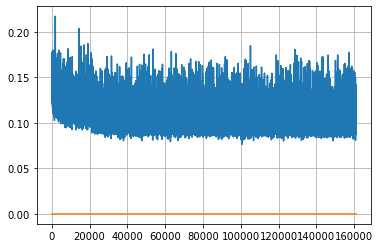

Epoch: 413, iteration 0, loss 0.10843595862388611, cov_diff 0.41126606877473726 cov_diff train 0.4103864244426318
Epoch: 413, iteration 1, loss 0.11468374729156494, cov_diff 0.4048212044039705 cov_diff train 0.4054149185693059
Epoch: 413, iteration 2, loss 0.10111859440803528, cov_diff 0.4108354391476012 cov_diff train 0.4100048097635551
Epoch: 413, iteration 3, loss 0.09814658761024475, cov_diff 0.41103512077415655 cov_diff train 0.4115454920555999
Epoch: 413, iteration 4, loss 0.11778947710990906, cov_diff 0.4228521315301527 cov_diff train 0.42216198092095114
Epoch: 413, iteration 5, loss 0.09035280346870422, cov_diff 0.41386205659396375 cov_diff train 0.4142707348515066
Epoch: 413, iteration 6, loss 0.10142576694488525, cov_diff 0.4151417096773215 cov_diff train 0.4148121195960867
Epoch: 413, iteration 7, loss 0.09936127066612244, cov_diff 0.411015953809635 cov_diff train 0.41007687747488625
Epoch: 413, iteration 8, loss 0.11076664924621582, cov_diff 0.4116553435146247 cov_diff trai

Epoch: 413, iteration 83, loss 0.10369208455085754, cov_diff 0.41343538310617656 cov_diff train 0.4120209883834662
Epoch: 413, iteration 84, loss 0.09426465630531311, cov_diff 0.4024997116361653 cov_diff train 0.4010771711177511
Epoch: 413, iteration 85, loss 0.10602721571922302, cov_diff 0.41183394740481316 cov_diff train 0.4109493544400839
Epoch: 413, iteration 86, loss 0.09528940916061401, cov_diff 0.4094737211607762 cov_diff train 0.4088330712630585
Epoch: 413, iteration 87, loss 0.09465491771697998, cov_diff 0.42135466963409796 cov_diff train 0.4201412644150105
Epoch: 413, iteration 88, loss 0.1084427535533905, cov_diff 0.4215553469592197 cov_diff train 0.41967393775902734
Epoch: 413, iteration 89, loss 0.11771923303604126, cov_diff 0.41329931461823044 cov_diff train 0.4126631620976585
Epoch: 413, iteration 90, loss 0.09547361731529236, cov_diff 0.4095196884103515 cov_diff train 0.40788588817488647
Epoch: 413, iteration 91, loss 0.10560819506645203, cov_diff 0.41333629085615425 co

Epoch: 413, iteration 161, loss 0.11048579216003418, cov_diff 0.4156450522939563 cov_diff train 0.4144779918222275
Epoch: 413, iteration 162, loss 0.09744682908058167, cov_diff 0.42074988332991486 cov_diff train 0.419920095488388
Epoch: 413, iteration 163, loss 0.10730382800102234, cov_diff 0.4154787499959858 cov_diff train 0.4145686753816434
Epoch: 413, iteration 164, loss 0.10240539908409119, cov_diff 0.42405795997633916 cov_diff train 0.4227502504339579
Epoch: 413, iteration 165, loss 0.1049845814704895, cov_diff 0.4138162576406319 cov_diff train 0.4127822829692647
Epoch: 413, iteration 166, loss 0.09859183430671692, cov_diff 0.4039846140098011 cov_diff train 0.40374572144525744
Epoch: 413, iteration 167, loss 0.09901189804077148, cov_diff 0.4121631198927785 cov_diff train 0.41134473691658946
Epoch: 413, iteration 168, loss 0.09842967987060547, cov_diff 0.41095668742511005 cov_diff train 0.41014959493855974
Epoch: 413, iteration 169, loss 0.10322821140289307, cov_diff 0.410198487195

Epoch: 413, iteration 240, loss 0.11281543970108032, cov_diff 0.40524935948676505 cov_diff train 0.40572669625501134
Epoch: 413, iteration 241, loss 0.08957594633102417, cov_diff 0.4064791389341562 cov_diff train 0.4066713936837326
Epoch: 413, iteration 242, loss 0.11870583891868591, cov_diff 0.40576350999305083 cov_diff train 0.4060009685641153
Epoch: 413, iteration 243, loss 0.09681007266044617, cov_diff 0.41502796899573335 cov_diff train 0.4154360758133989
Epoch: 413, iteration 244, loss 0.10844877362251282, cov_diff 0.4091737349959353 cov_diff train 0.40871921502903436
Epoch: 413, iteration 245, loss 0.09621408581733704, cov_diff 0.41459561104192144 cov_diff train 0.4141958145050718
Epoch: 413, iteration 246, loss 0.11288309097290039, cov_diff 0.4118673186013963 cov_diff train 0.41117876562851297
Epoch: 413, iteration 247, loss 0.10350671410560608, cov_diff 0.4166847222220682 cov_diff train 0.41631126875397617
Epoch: 413, iteration 248, loss 0.10474246740341187, cov_diff 0.42815638

Epoch: 413, iteration 318, loss 0.09935006499290466, cov_diff 0.4099839188915062 cov_diff train 0.4093409231833579
Epoch: 413, iteration 319, loss 0.11158272624015808, cov_diff 0.4159332989228149 cov_diff train 0.41539435377838
Epoch: 413, iteration 320, loss 0.10855436325073242, cov_diff 0.41753778768677213 cov_diff train 0.41570272476866565
Epoch: 413, iteration 321, loss 0.11040621995925903, cov_diff 0.40366886929319173 cov_diff train 0.4028180849475943
Epoch: 413, iteration 322, loss 0.10858610272407532, cov_diff 0.40344917000637776 cov_diff train 0.4029252156887587
Epoch: 413, iteration 323, loss 0.10475999116897583, cov_diff 0.4100206894614351 cov_diff train 0.4095609265042766
Epoch: 413, iteration 324, loss 0.11846780776977539, cov_diff 0.41025259609858744 cov_diff train 0.4105174657359642
Epoch: 413, iteration 325, loss 0.095613032579422, cov_diff 0.40731257787351904 cov_diff train 0.4074509489331532
Epoch: 413, iteration 326, loss 0.09787341952323914, cov_diff 0.40315894705032

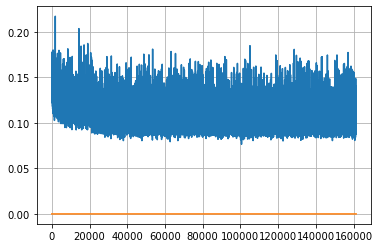

Epoch: 414, iteration 0, loss 0.11408084630966187, cov_diff 0.3990725837310307 cov_diff train 0.3978710272823165
Epoch: 414, iteration 1, loss 0.10254153609275818, cov_diff 0.39808880481089765 cov_diff train 0.39773665298567223
Epoch: 414, iteration 2, loss 0.0981760323047638, cov_diff 0.4091543656291401 cov_diff train 0.40863807870507957
Epoch: 414, iteration 3, loss 0.10196611285209656, cov_diff 0.41178445448091766 cov_diff train 0.4109638275961597
Epoch: 414, iteration 4, loss 0.10290482640266418, cov_diff 0.4034360411255861 cov_diff train 0.4028795412664399
Epoch: 414, iteration 5, loss 0.10098603367805481, cov_diff 0.4231849389423704 cov_diff train 0.4220354999022354
Epoch: 414, iteration 6, loss 0.10798722505569458, cov_diff 0.4021713640386456 cov_diff train 0.40239413514238376
Epoch: 414, iteration 7, loss 0.10030123591423035, cov_diff 0.41186812829870717 cov_diff train 0.41176662968887606
Epoch: 414, iteration 8, loss 0.1040353775024414, cov_diff 0.41492435530162136 cov_diff tr

Epoch: 414, iteration 79, loss 0.10437709093093872, cov_diff 0.41382619944795807 cov_diff train 0.41292761087066976
Epoch: 414, iteration 80, loss 0.10412198305130005, cov_diff 0.4129965429867287 cov_diff train 0.41245199203285066
Epoch: 414, iteration 81, loss 0.10748177766799927, cov_diff 0.4147938222580327 cov_diff train 0.41402259021353743
Epoch: 414, iteration 82, loss 0.09720683097839355, cov_diff 0.41399468637693493 cov_diff train 0.4127316264078716
Epoch: 414, iteration 83, loss 0.10640060901641846, cov_diff 0.4019676656100569 cov_diff train 0.4003670974541375
Epoch: 414, iteration 84, loss 0.09640774130821228, cov_diff 0.41398726796500024 cov_diff train 0.41365489211092243
Epoch: 414, iteration 85, loss 0.11769449710845947, cov_diff 0.40718938501647844 cov_diff train 0.4075609693909024
Epoch: 414, iteration 86, loss 0.10740241408348083, cov_diff 0.40788659588515097 cov_diff train 0.4080960620657885
Epoch: 414, iteration 87, loss 0.10254299640655518, cov_diff 0.4047809764447375

Epoch: 414, iteration 150, loss 0.09916719794273376, cov_diff 0.40376843707599536 cov_diff train 0.4031113523083249
Epoch: 414, iteration 151, loss 0.10518801212310791, cov_diff 0.41475932118555925 cov_diff train 0.41483006567039626
Epoch: 414, iteration 152, loss 0.10916543006896973, cov_diff 0.39020741691806965 cov_diff train 0.39016120523672465
Epoch: 414, iteration 153, loss 0.10344547033309937, cov_diff 0.4208968709542447 cov_diff train 0.42015421449004925
Epoch: 414, iteration 154, loss 0.10725167393684387, cov_diff 0.404413023707037 cov_diff train 0.40375241471170875
Epoch: 414, iteration 155, loss 0.08943292498588562, cov_diff 0.41234538654417935 cov_diff train 0.41165098351870993
Epoch: 414, iteration 156, loss 0.11100801825523376, cov_diff 0.42659005385549775 cov_diff train 0.4255883522965343
Epoch: 414, iteration 157, loss 0.09454238414764404, cov_diff 0.40586724408662084 cov_diff train 0.4058021529819613
Epoch: 414, iteration 158, loss 0.1238166093826294, cov_diff 0.4183214

Epoch: 414, iteration 232, loss 0.09922948479652405, cov_diff 0.4106124749852362 cov_diff train 0.40993128874334156
Epoch: 414, iteration 233, loss 0.10438168048858643, cov_diff 0.40251831480120465 cov_diff train 0.40195133157975543
Epoch: 414, iteration 234, loss 0.09280601143836975, cov_diff 0.4021803163453152 cov_diff train 0.40255058624413886
Epoch: 414, iteration 235, loss 0.10042205452919006, cov_diff 0.4040658692148677 cov_diff train 0.40395966769177793
Epoch: 414, iteration 236, loss 0.10242459177970886, cov_diff 0.4156554234908546 cov_diff train 0.4153335625766602
Epoch: 414, iteration 237, loss 0.10320591926574707, cov_diff 0.4160816682259704 cov_diff train 0.41490285214138967
Epoch: 414, iteration 238, loss 0.10278940200805664, cov_diff 0.41648481277645805 cov_diff train 0.41753985336071103
Epoch: 414, iteration 239, loss 0.09990772604942322, cov_diff 0.40335374277839037 cov_diff train 0.4028456474518667
Epoch: 414, iteration 240, loss 0.10386887192726135, cov_diff 0.4266351

Epoch: 414, iteration 310, loss 0.09768089652061462, cov_diff 0.41085772678664034 cov_diff train 0.41084697402206344
Epoch: 414, iteration 311, loss 0.09935995936393738, cov_diff 0.4167924402221444 cov_diff train 0.41544738481820587
Epoch: 414, iteration 312, loss 0.10137000679969788, cov_diff 0.41343117228425796 cov_diff train 0.41237346212429427
Epoch: 414, iteration 313, loss 0.10688140988349915, cov_diff 0.4039660624751896 cov_diff train 0.40311772915714245
Epoch: 414, iteration 314, loss 0.1041736900806427, cov_diff 0.4202348733107686 cov_diff train 0.41926312587893816
Epoch: 414, iteration 315, loss 0.11045482754707336, cov_diff 0.406469140397673 cov_diff train 0.40504743960983364
Epoch: 414, iteration 316, loss 0.10762935876846313, cov_diff 0.40669194325548697 cov_diff train 0.40688494782142615
Epoch: 414, iteration 317, loss 0.10276627540588379, cov_diff 0.41619863261462975 cov_diff train 0.4159649926426147
Epoch: 414, iteration 318, loss 0.1043907105922699, cov_diff 0.40585527

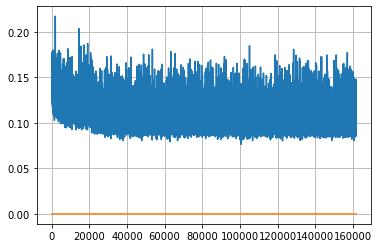

Epoch: 415, iteration 0, loss 0.10587066411972046, cov_diff 0.4081903427208165 cov_diff train 0.40782730592932065
Epoch: 415, iteration 1, loss 0.10171648859977722, cov_diff 0.4047572716623826 cov_diff train 0.40467660632924635
Epoch: 415, iteration 2, loss 0.09928259253501892, cov_diff 0.41100816352669955 cov_diff train 0.40971386217531813
Epoch: 415, iteration 3, loss 0.09755188226699829, cov_diff 0.4019420473970515 cov_diff train 0.4008308341603234
Epoch: 415, iteration 4, loss 0.0953984260559082, cov_diff 0.39629597746993117 cov_diff train 0.39545195357556107
Epoch: 415, iteration 5, loss 0.10378926992416382, cov_diff 0.4071875234212 cov_diff train 0.40669124873933754
Epoch: 415, iteration 6, loss 0.10710757970809937, cov_diff 0.39930268145878267 cov_diff train 0.3991872482936167
Epoch: 415, iteration 7, loss 0.10430943965911865, cov_diff 0.41427246110751137 cov_diff train 0.41367735786505977
Epoch: 415, iteration 8, loss 0.0960024893283844, cov_diff 0.4157817173144155 cov_diff tra

Epoch: 415, iteration 79, loss 0.10144069790840149, cov_diff 0.4143206098092766 cov_diff train 0.4138479070631778
Epoch: 415, iteration 80, loss 0.10999369621276855, cov_diff 0.41521271615064137 cov_diff train 0.4141243328016724
Epoch: 415, iteration 81, loss 0.10897845029830933, cov_diff 0.41588116658060326 cov_diff train 0.41508013276969524
Epoch: 415, iteration 82, loss 0.09959936141967773, cov_diff 0.4053343185505259 cov_diff train 0.40408235173958673
Epoch: 415, iteration 83, loss 0.09700995683670044, cov_diff 0.40565012085207824 cov_diff train 0.40546252581762937
Epoch: 415, iteration 84, loss 0.09852650761604309, cov_diff 0.408969650105715 cov_diff train 0.4078869789745048
Epoch: 415, iteration 85, loss 0.1122475266456604, cov_diff 0.40835238967506426 cov_diff train 0.40654158102138993
Epoch: 415, iteration 86, loss 0.10225749015808105, cov_diff 0.4137796995381855 cov_diff train 0.41247728855434945
Epoch: 415, iteration 87, loss 0.10047972202301025, cov_diff 0.4008147241659267 c

Epoch: 415, iteration 159, loss 0.12044236063957214, cov_diff 0.41358482933773805 cov_diff train 0.412260750055848
Epoch: 415, iteration 160, loss 0.10378485918045044, cov_diff 0.41161201692606947 cov_diff train 0.41039679142478086
Epoch: 415, iteration 161, loss 0.09945365786552429, cov_diff 0.39616634065653894 cov_diff train 0.39650484265259933
Epoch: 415, iteration 162, loss 0.09730419516563416, cov_diff 0.40264020834416975 cov_diff train 0.40235351507388945
Epoch: 415, iteration 163, loss 0.10006242990493774, cov_diff 0.4107855864094721 cov_diff train 0.41044870321133403
Epoch: 415, iteration 164, loss 0.09953081607818604, cov_diff 0.40105992401174606 cov_diff train 0.40000784449264715
Epoch: 415, iteration 165, loss 0.09957259893417358, cov_diff 0.39317607652643377 cov_diff train 0.39280783058756025
Epoch: 415, iteration 166, loss 0.10119864344596863, cov_diff 0.40485335084089236 cov_diff train 0.4041748231873035
Epoch: 415, iteration 167, loss 0.10416856408119202, cov_diff 0.4152

Epoch: 415, iteration 239, loss 0.09833192825317383, cov_diff 0.3989302944184333 cov_diff train 0.39894492937848247
Epoch: 415, iteration 240, loss 0.10097956657409668, cov_diff 0.4082935493382863 cov_diff train 0.4075178975892695
Epoch: 415, iteration 241, loss 0.0947951078414917, cov_diff 0.39632612565390396 cov_diff train 0.3963085102955946
Epoch: 415, iteration 242, loss 0.10254573822021484, cov_diff 0.41026584345829087 cov_diff train 0.4095855436850205
Epoch: 415, iteration 243, loss 0.11485487222671509, cov_diff 0.4094761205215136 cov_diff train 0.40873836491214366
Epoch: 415, iteration 244, loss 0.10249492526054382, cov_diff 0.4130773032088389 cov_diff train 0.41331281515381957
Epoch: 415, iteration 245, loss 0.09726586937904358, cov_diff 0.39667914984712593 cov_diff train 0.3963568304003214
Epoch: 415, iteration 246, loss 0.10244131088256836, cov_diff 0.4065805527901747 cov_diff train 0.4066202408220737
Epoch: 415, iteration 247, loss 0.09980598092079163, cov_diff 0.40843537235

Epoch: 415, iteration 316, loss 0.10277670621871948, cov_diff 0.4048923974547423 cov_diff train 0.40443482736916464
Epoch: 415, iteration 317, loss 0.09592238068580627, cov_diff 0.4106818593171714 cov_diff train 0.41013157735205175
Epoch: 415, iteration 318, loss 0.1009601354598999, cov_diff 0.414265244532647 cov_diff train 0.41392176947295695
Epoch: 415, iteration 319, loss 0.11258214712142944, cov_diff 0.39842425534812 cov_diff train 0.3978755376256368
Epoch: 415, iteration 320, loss 0.10192915797233582, cov_diff 0.39260478212524247 cov_diff train 0.3924590669446456
Epoch: 415, iteration 321, loss 0.10677629709243774, cov_diff 0.4008843273629113 cov_diff train 0.39990438041499726
Epoch: 415, iteration 322, loss 0.10518541932106018, cov_diff 0.4092333868969451 cov_diff train 0.4098603223164458
Epoch: 415, iteration 323, loss 0.10039883852005005, cov_diff 0.41648600199391317 cov_diff train 0.4147957944786984
Epoch: 415, iteration 324, loss 0.11510246992111206, cov_diff 0.40912469998030

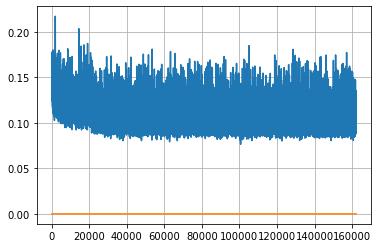

Epoch: 416, iteration 0, loss 0.10185098648071289, cov_diff 0.4151140508539147 cov_diff train 0.4150556066259186
Epoch: 416, iteration 1, loss 0.10080406069755554, cov_diff 0.40749894789249513 cov_diff train 0.40816459899091573
Epoch: 416, iteration 2, loss 0.11086177825927734, cov_diff 0.42623815326562986 cov_diff train 0.4263272332170358
Epoch: 416, iteration 3, loss 0.10657456517219543, cov_diff 0.4213500753301869 cov_diff train 0.421117373953258
Epoch: 416, iteration 4, loss 0.10672932863235474, cov_diff 0.4092268589253525 cov_diff train 0.4080761904226774
Epoch: 416, iteration 5, loss 0.09495896100997925, cov_diff 0.3975281784895318 cov_diff train 0.3971257613577665
Epoch: 416, iteration 6, loss 0.10363820195198059, cov_diff 0.4056166661624136 cov_diff train 0.40507762107181444
Epoch: 416, iteration 7, loss 0.1069607138633728, cov_diff 0.4065484324480552 cov_diff train 0.4047569103892521
Epoch: 416, iteration 8, loss 0.09869059920310974, cov_diff 0.40090209565259866 cov_diff train

Epoch: 416, iteration 77, loss 0.11529377102851868, cov_diff 0.41846984100824397 cov_diff train 0.41791984395595894
Epoch: 416, iteration 78, loss 0.09635525941848755, cov_diff 0.40893391990949823 cov_diff train 0.4080319706761896
Epoch: 416, iteration 79, loss 0.10034078359603882, cov_diff 0.41111499371214927 cov_diff train 0.41142849657754826
Epoch: 416, iteration 80, loss 0.10537561774253845, cov_diff 0.4047644990060438 cov_diff train 0.4039375437847146
Epoch: 416, iteration 81, loss 0.09801489114761353, cov_diff 0.41150288146100544 cov_diff train 0.4116102805171687
Epoch: 416, iteration 82, loss 0.10651493072509766, cov_diff 0.41643975568091884 cov_diff train 0.415709676328221
Epoch: 416, iteration 83, loss 0.11759012937545776, cov_diff 0.4071593502343615 cov_diff train 0.40644578789432256
Epoch: 416, iteration 84, loss 0.11917370557785034, cov_diff 0.4223856498698656 cov_diff train 0.4209817857804711
Epoch: 416, iteration 85, loss 0.10300061106681824, cov_diff 0.41005575225426805 

Epoch: 416, iteration 158, loss 0.10767945647239685, cov_diff 0.417064210129435 cov_diff train 0.41640802929761056
Epoch: 416, iteration 159, loss 0.10535439848899841, cov_diff 0.4162887910787669 cov_diff train 0.4152735436006403
Epoch: 416, iteration 160, loss 0.11137959361076355, cov_diff 0.4138218375751431 cov_diff train 0.4125145233300001
Epoch: 416, iteration 161, loss 0.10404378175735474, cov_diff 0.4142747096828689 cov_diff train 0.4135346642042704
Epoch: 416, iteration 162, loss 0.09708252549171448, cov_diff 0.42693241763746836 cov_diff train 0.4261696223113019
Epoch: 416, iteration 163, loss 0.10128667950630188, cov_diff 0.3981817865431057 cov_diff train 0.39690707695205024
Epoch: 416, iteration 164, loss 0.10417783260345459, cov_diff 0.42086014567331453 cov_diff train 0.42116212674666614
Epoch: 416, iteration 165, loss 0.11024227738380432, cov_diff 0.41950370111314017 cov_diff train 0.41894240227793034
Epoch: 416, iteration 166, loss 0.1002693772315979, cov_diff 0.41439492403

Epoch: 416, iteration 239, loss 0.10756221413612366, cov_diff 0.42033428434028264 cov_diff train 0.419071493283822
Epoch: 416, iteration 240, loss 0.10659810900688171, cov_diff 0.41863436252665304 cov_diff train 0.4177987901313932
Epoch: 416, iteration 241, loss 0.1038503646850586, cov_diff 0.41528794502043065 cov_diff train 0.4154144860175108
Epoch: 416, iteration 242, loss 0.09736102819442749, cov_diff 0.4053236990416622 cov_diff train 0.4050383726222927
Epoch: 416, iteration 243, loss 0.10592550039291382, cov_diff 0.40808406871811403 cov_diff train 0.4072927657482848
Epoch: 416, iteration 244, loss 0.0930420458316803, cov_diff 0.40945352230720633 cov_diff train 0.4088912291183792
Epoch: 416, iteration 245, loss 0.10304349660873413, cov_diff 0.4143271136247109 cov_diff train 0.41386328097501657
Epoch: 416, iteration 246, loss 0.09517446160316467, cov_diff 0.4075722915046307 cov_diff train 0.40708348947214146
Epoch: 416, iteration 247, loss 0.09749174118041992, cov_diff 0.411955617409

Epoch: 416, iteration 321, loss 0.09662356972694397, cov_diff 0.4104111019361584 cov_diff train 0.4096265492943251
Epoch: 416, iteration 322, loss 0.11165007948875427, cov_diff 0.4202553499302168 cov_diff train 0.4193382035946403
Epoch: 416, iteration 323, loss 0.10749706625938416, cov_diff 0.3962031888214297 cov_diff train 0.39628961454515516
Epoch: 416, iteration 324, loss 0.1013142466545105, cov_diff 0.415314379283463 cov_diff train 0.4163026372999162
Epoch: 416, iteration 325, loss 0.10779273509979248, cov_diff 0.4296994996223563 cov_diff train 0.4283486007474043
Epoch: 416, iteration 326, loss 0.10483774542808533, cov_diff 0.4042737668339305 cov_diff train 0.4040345740597444
Epoch: 416, iteration 327, loss 0.11820921301841736, cov_diff 0.4037328375977293 cov_diff train 0.40245473622861083
Epoch: 416, iteration 328, loss 0.10239306092262268, cov_diff 0.4096108909863143 cov_diff train 0.4093767035657443
Epoch: 416, iteration 329, loss 0.11236366629600525, cov_diff 0.4122036744310787

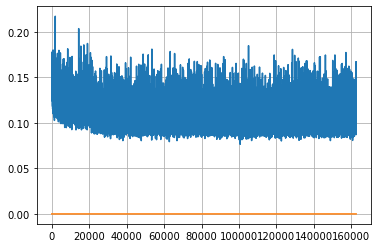

Epoch: 417, iteration 0, loss 0.09495112299919128, cov_diff 0.4256634173503903 cov_diff train 0.4259079479743156
Epoch: 417, iteration 1, loss 0.10502356290817261, cov_diff 0.4170878141585249 cov_diff train 0.41669075861011773
Epoch: 417, iteration 2, loss 0.10106921195983887, cov_diff 0.416376646169526 cov_diff train 0.41606524566729336
Epoch: 417, iteration 3, loss 0.1069728434085846, cov_diff 0.41523692888840247 cov_diff train 0.4147780894450237
Epoch: 417, iteration 4, loss 0.10519123077392578, cov_diff 0.40465040828329923 cov_diff train 0.40393842179417944
Epoch: 417, iteration 5, loss 0.1002856194972992, cov_diff 0.4021663798725438 cov_diff train 0.40205800139347053
Epoch: 417, iteration 6, loss 0.09906935691833496, cov_diff 0.41298084393321804 cov_diff train 0.4125663378089576
Epoch: 417, iteration 7, loss 0.09924790263175964, cov_diff 0.40778324112238223 cov_diff train 0.40663064865574833
Epoch: 417, iteration 8, loss 0.1038464605808258, cov_diff 0.41811578551626694 cov_diff tr

Epoch: 417, iteration 72, loss 0.11127132177352905, cov_diff 0.4167315444738136 cov_diff train 0.4152903913767439
Epoch: 417, iteration 73, loss 0.0982804000377655, cov_diff 0.4211032914690665 cov_diff train 0.4196791915812677
Epoch: 417, iteration 74, loss 0.10047242045402527, cov_diff 0.41567160036883805 cov_diff train 0.4142306177702016
Epoch: 417, iteration 75, loss 0.0953131914138794, cov_diff 0.40691050164673265 cov_diff train 0.4061133437184363
Epoch: 417, iteration 76, loss 0.10914582014083862, cov_diff 0.4044083499508729 cov_diff train 0.4037289949186022
Epoch: 417, iteration 77, loss 0.10531815886497498, cov_diff 0.40948644871988 cov_diff train 0.40782776297269135
Epoch: 417, iteration 78, loss 0.09719094634056091, cov_diff 0.4131665482676993 cov_diff train 0.41251954558508347
Epoch: 417, iteration 79, loss 0.09958532452583313, cov_diff 0.4053811036136838 cov_diff train 0.4041712015588054
Epoch: 417, iteration 80, loss 0.1049279272556305, cov_diff 0.4256244536814248 cov_diff 

Epoch: 417, iteration 150, loss 0.10111424326896667, cov_diff 0.4054762021372532 cov_diff train 0.40359605629498924
Epoch: 417, iteration 151, loss 0.10461145639419556, cov_diff 0.41578870611296387 cov_diff train 0.41542071628005317
Epoch: 417, iteration 152, loss 0.0989651083946228, cov_diff 0.41505458154326175 cov_diff train 0.4139395004340301
Epoch: 417, iteration 153, loss 0.11347436904907227, cov_diff 0.41262781521076414 cov_diff train 0.4116156400722443
Epoch: 417, iteration 154, loss 0.09906619787216187, cov_diff 0.41180066639168317 cov_diff train 0.4112362521565385
Epoch: 417, iteration 155, loss 0.11093741655349731, cov_diff 0.4122625365146522 cov_diff train 0.4109754783994098
Epoch: 417, iteration 156, loss 0.1034453809261322, cov_diff 0.41217051050119685 cov_diff train 0.4118472096963496
Epoch: 417, iteration 157, loss 0.1095808744430542, cov_diff 0.4085805082864645 cov_diff train 0.4083635678671972
Epoch: 417, iteration 158, loss 0.0987190306186676, cov_diff 0.4030439906668

Epoch: 417, iteration 230, loss 0.09170353412628174, cov_diff 0.4159932396092422 cov_diff train 0.41700485026455447
Epoch: 417, iteration 231, loss 0.11529293656349182, cov_diff 0.4208281431162699 cov_diff train 0.42042575262534787
Epoch: 417, iteration 232, loss 0.09858584403991699, cov_diff 0.41107478715878837 cov_diff train 0.4107125817160561
Epoch: 417, iteration 233, loss 0.10909998416900635, cov_diff 0.4158182090870747 cov_diff train 0.41482134519213426
Epoch: 417, iteration 234, loss 0.10118257999420166, cov_diff 0.4155746698427552 cov_diff train 0.41526586870236104
Epoch: 417, iteration 235, loss 0.0964721143245697, cov_diff 0.41523470016327446 cov_diff train 0.41357894368005804
Epoch: 417, iteration 236, loss 0.10528099536895752, cov_diff 0.39885143292866454 cov_diff train 0.39879808890471424
Epoch: 417, iteration 237, loss 0.10037946701049805, cov_diff 0.40998871132131604 cov_diff train 0.4090673847499156
Epoch: 417, iteration 238, loss 0.11514115333557129, cov_diff 0.4196094

Epoch: 417, iteration 307, loss 0.1069883406162262, cov_diff 0.41308720714339936 cov_diff train 0.4120650430892117
Epoch: 417, iteration 308, loss 0.10914760828018188, cov_diff 0.4060116860616491 cov_diff train 0.40560129178111853
Epoch: 417, iteration 309, loss 0.10006347298622131, cov_diff 0.40152844894676304 cov_diff train 0.4011365529586584
Epoch: 417, iteration 310, loss 0.1057395339012146, cov_diff 0.41024969321889554 cov_diff train 0.4102257213815475
Epoch: 417, iteration 311, loss 0.09782460331916809, cov_diff 0.41322624496989185 cov_diff train 0.41277549390139995
Epoch: 417, iteration 312, loss 0.11521095037460327, cov_diff 0.41313378329795564 cov_diff train 0.4123419744740096
Epoch: 417, iteration 313, loss 0.1250416338443756, cov_diff 0.4188820292676786 cov_diff train 0.41856187461457706
Epoch: 417, iteration 314, loss 0.10243219137191772, cov_diff 0.4145165316222246 cov_diff train 0.4137829930357228
Epoch: 417, iteration 315, loss 0.10843545198440552, cov_diff 0.41970212242

Epoch: 417, iteration 385, loss 0.1055106520652771, cov_diff 0.4133147932362686 cov_diff train 0.4132812253455799
Epoch: 417, iteration 386, loss 0.10482388734817505, cov_diff 0.41589101383755334 cov_diff train 0.41542923787090597
Epoch: 417, iteration 387, loss 0.0935523509979248, cov_diff 0.40094437429206137 cov_diff train 0.40049728700072457
Epoch: 417, iteration 388, loss 0.10454437136650085, cov_diff 0.4163238567840882 cov_diff train 0.4154664831717435
Epoch: 417, iteration 389, loss 0.11103194952011108, cov_diff 0.41646478801201253 cov_diff train 0.4150682846951904
Epoch: 417, iteration 390, loss 0.14808663725852966, cov_diff 0.45058307136598214 cov_diff train 0.4498503884051811


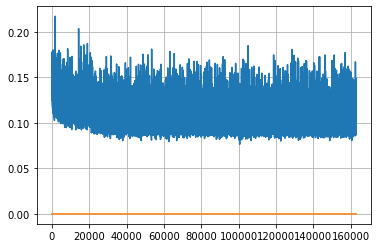

Epoch: 418, iteration 0, loss 0.11211329698562622, cov_diff 0.42041106047916 cov_diff train 0.42002070503579925
Epoch: 418, iteration 1, loss 0.10675480961799622, cov_diff 0.4268243983855546 cov_diff train 0.42633653139250915
Epoch: 418, iteration 2, loss 0.10192292928695679, cov_diff 0.4124128616591425 cov_diff train 0.4119748404415381
Epoch: 418, iteration 3, loss 0.09753274917602539, cov_diff 0.4177294630150738 cov_diff train 0.4173556691831334
Epoch: 418, iteration 4, loss 0.1118849515914917, cov_diff 0.40631776072763215 cov_diff train 0.40534474538047466
Epoch: 418, iteration 5, loss 0.09486308693885803, cov_diff 0.4099891578399058 cov_diff train 0.40918761570823864
Epoch: 418, iteration 6, loss 0.10324633121490479, cov_diff 0.40379205701455373 cov_diff train 0.4026433520093607
Epoch: 418, iteration 7, loss 0.10263210535049438, cov_diff 0.41303383833774987 cov_diff train 0.4118764918540179
Epoch: 418, iteration 8, loss 0.10988670587539673, cov_diff 0.4202267369064371 cov_diff trai

Epoch: 418, iteration 80, loss 0.11067894101142883, cov_diff 0.40113238933907497 cov_diff train 0.40128578153875366
Epoch: 418, iteration 81, loss 0.0994921326637268, cov_diff 0.4154793296131173 cov_diff train 0.41566212341932013
Epoch: 418, iteration 82, loss 0.10360345244407654, cov_diff 0.4110413106493489 cov_diff train 0.4111762852434148
Epoch: 418, iteration 83, loss 0.09956228733062744, cov_diff 0.41578861780036935 cov_diff train 0.41481666424334884
Epoch: 418, iteration 84, loss 0.10022163391113281, cov_diff 0.40901904933388755 cov_diff train 0.40788219860913455
Epoch: 418, iteration 85, loss 0.10798144340515137, cov_diff 0.4240775641051391 cov_diff train 0.4236121948135288
Epoch: 418, iteration 86, loss 0.11326441168785095, cov_diff 0.41525376960994087 cov_diff train 0.41427304891361955
Epoch: 418, iteration 87, loss 0.09595289826393127, cov_diff 0.40826049677456727 cov_diff train 0.40746385212193814
Epoch: 418, iteration 88, loss 0.11414629220962524, cov_diff 0.421263015190620

Epoch: 418, iteration 158, loss 0.10230883955955505, cov_diff 0.4125890800247073 cov_diff train 0.41193627364851126
Epoch: 418, iteration 159, loss 0.09470897912979126, cov_diff 0.39955869582113807 cov_diff train 0.39972709151311114
Epoch: 418, iteration 160, loss 0.10638880729675293, cov_diff 0.4150884797555132 cov_diff train 0.4145499916754914
Epoch: 418, iteration 161, loss 0.10518619418144226, cov_diff 0.406068974007734 cov_diff train 0.40618418276779406
Epoch: 418, iteration 162, loss 0.11174803972244263, cov_diff 0.41066691298070257 cov_diff train 0.41064086031950753
Epoch: 418, iteration 163, loss 0.10612446069717407, cov_diff 0.4166302645713876 cov_diff train 0.41647964389729947
Epoch: 418, iteration 164, loss 0.10306534171104431, cov_diff 0.4134753551378424 cov_diff train 0.4129452049680099
Epoch: 418, iteration 165, loss 0.09930053353309631, cov_diff 0.406493803200501 cov_diff train 0.40592225596003534
Epoch: 418, iteration 166, loss 0.0980033278465271, cov_diff 0.39932991921

Epoch: 418, iteration 235, loss 0.1097949743270874, cov_diff 0.4019695137475206 cov_diff train 0.4011815423256296
Epoch: 418, iteration 236, loss 0.11012771725654602, cov_diff 0.4018333713892962 cov_diff train 0.4004989081968394
Epoch: 418, iteration 237, loss 0.0992785394191742, cov_diff 0.4136583407841607 cov_diff train 0.41233972787854745
Epoch: 418, iteration 238, loss 0.10066783428192139, cov_diff 0.40409006642035916 cov_diff train 0.4030619001905126
Epoch: 418, iteration 239, loss 0.10024118423461914, cov_diff 0.4212101560741408 cov_diff train 0.4205671470331178
Epoch: 418, iteration 240, loss 0.1008833646774292, cov_diff 0.41263902430737703 cov_diff train 0.4119758988502867
Epoch: 418, iteration 241, loss 0.098425954580307, cov_diff 0.40221579643517613 cov_diff train 0.40094873909879175
Epoch: 418, iteration 242, loss 0.11104536056518555, cov_diff 0.4095083078202107 cov_diff train 0.40909183736153404
Epoch: 418, iteration 243, loss 0.10730138421058655, cov_diff 0.415479486715034

Epoch: 418, iteration 312, loss 0.10231354832649231, cov_diff 0.42308281523118124 cov_diff train 0.42226401780917694
Epoch: 418, iteration 313, loss 0.10209497809410095, cov_diff 0.41278038555078644 cov_diff train 0.4114246527799215
Epoch: 418, iteration 314, loss 0.10032209753990173, cov_diff 0.41263009182277416 cov_diff train 0.41261098223502024
Epoch: 418, iteration 315, loss 0.10070943832397461, cov_diff 0.4165275235591805 cov_diff train 0.41606862044629833
Epoch: 418, iteration 316, loss 0.1018836498260498, cov_diff 0.4102469283276801 cov_diff train 0.410023398642752
Epoch: 418, iteration 317, loss 0.10162001848220825, cov_diff 0.4204567754754442 cov_diff train 0.4186963026432372
Epoch: 418, iteration 318, loss 0.10210496187210083, cov_diff 0.40599381688554537 cov_diff train 0.4052577942023336
Epoch: 418, iteration 319, loss 0.09776332974433899, cov_diff 0.4136889026120705 cov_diff train 0.4127846653606935
Epoch: 418, iteration 320, loss 0.10408541560173035, cov_diff 0.41818419934

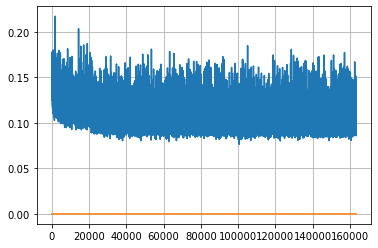

Epoch: 419, iteration 0, loss 0.11301568150520325, cov_diff 0.4195377564118086 cov_diff train 0.41843831778184404
Epoch: 419, iteration 1, loss 0.09722146391868591, cov_diff 0.41244073938383624 cov_diff train 0.41145886253392633
Epoch: 419, iteration 2, loss 0.11440405249595642, cov_diff 0.416339994435633 cov_diff train 0.4158508881841255
Epoch: 419, iteration 3, loss 0.09952250123023987, cov_diff 0.41640153999712964 cov_diff train 0.4147941805789508
Epoch: 419, iteration 4, loss 0.11065956950187683, cov_diff 0.41287264030906307 cov_diff train 0.4112981772824386
Epoch: 419, iteration 5, loss 0.11096113920211792, cov_diff 0.4038525865064246 cov_diff train 0.4029184151936498
Epoch: 419, iteration 6, loss 0.09493988752365112, cov_diff 0.4099213161811345 cov_diff train 0.4086294116388709
Epoch: 419, iteration 7, loss 0.10996696352958679, cov_diff 0.4081223229825991 cov_diff train 0.4078908535973932
Epoch: 419, iteration 8, loss 0.11725044250488281, cov_diff 0.4238702259111955 cov_diff trai

Epoch: 419, iteration 78, loss 0.09882888197898865, cov_diff 0.41890330639156337 cov_diff train 0.4178873393985243
Epoch: 419, iteration 79, loss 0.09915518760681152, cov_diff 0.4073802517406395 cov_diff train 0.4061423494597586
Epoch: 419, iteration 80, loss 0.11081135272979736, cov_diff 0.40638069480431255 cov_diff train 0.4055914304171573
Epoch: 419, iteration 81, loss 0.10704272985458374, cov_diff 0.4085180764398079 cov_diff train 0.40743675920612205
Epoch: 419, iteration 82, loss 0.11565923690795898, cov_diff 0.4184208224969822 cov_diff train 0.4170923882694295
Epoch: 419, iteration 83, loss 0.10844042897224426, cov_diff 0.40594314999977205 cov_diff train 0.40527950547573627
Epoch: 419, iteration 84, loss 0.09827876091003418, cov_diff 0.41904757515970875 cov_diff train 0.4173210862218368
Epoch: 419, iteration 85, loss 0.10116958618164062, cov_diff 0.4091068971665682 cov_diff train 0.4086179929894367
Epoch: 419, iteration 86, loss 0.12076222896575928, cov_diff 0.41157921712524775 c

Epoch: 419, iteration 157, loss 0.0967835783958435, cov_diff 0.41256117316416224 cov_diff train 0.4111224808023743
Epoch: 419, iteration 158, loss 0.09318727254867554, cov_diff 0.4258134598473311 cov_diff train 0.42518583389487485
Epoch: 419, iteration 159, loss 0.10660991072654724, cov_diff 0.4087055512646158 cov_diff train 0.4086054048628709
Epoch: 419, iteration 160, loss 0.1049182116985321, cov_diff 0.43202444056201317 cov_diff train 0.43088840293146086
Epoch: 419, iteration 161, loss 0.10502743721008301, cov_diff 0.4065889324817869 cov_diff train 0.4060606858947854
Epoch: 419, iteration 162, loss 0.10195061564445496, cov_diff 0.4168332806815853 cov_diff train 0.4161027709106609
Epoch: 419, iteration 163, loss 0.10627010464668274, cov_diff 0.4098905554354517 cov_diff train 0.4093469979086319
Epoch: 419, iteration 164, loss 0.10107249021530151, cov_diff 0.4152645634035727 cov_diff train 0.4148870219661321
Epoch: 419, iteration 165, loss 0.104879230260849, cov_diff 0.4009087461419048

Epoch: 419, iteration 237, loss 0.10960173606872559, cov_diff 0.419356311378613 cov_diff train 0.4191497630036166
Epoch: 419, iteration 238, loss 0.109092116355896, cov_diff 0.4047072394507843 cov_diff train 0.4041738075489457
Epoch: 419, iteration 239, loss 0.1057172417640686, cov_diff 0.407613539740305 cov_diff train 0.4075965948752188
Epoch: 419, iteration 240, loss 0.09458392858505249, cov_diff 0.41674487583000847 cov_diff train 0.41661329035481826
Epoch: 419, iteration 241, loss 0.12540161609649658, cov_diff 0.42653684126412034 cov_diff train 0.4265047240224378
Epoch: 419, iteration 242, loss 0.10361066460609436, cov_diff 0.4252262580493277 cov_diff train 0.4239232132664701
Epoch: 419, iteration 243, loss 0.12205129861831665, cov_diff 0.4072503395226434 cov_diff train 0.4059421340405943
Epoch: 419, iteration 244, loss 0.11411383748054504, cov_diff 0.43301071913804917 cov_diff train 0.43097076408151486
Epoch: 419, iteration 245, loss 0.09266462922096252, cov_diff 0.416868249104825 

Epoch: 419, iteration 315, loss 0.10475301742553711, cov_diff 0.41818774940644665 cov_diff train 0.41702553983454255
Epoch: 419, iteration 316, loss 0.10944658517837524, cov_diff 0.4231394292271596 cov_diff train 0.4231788273080014
Epoch: 419, iteration 317, loss 0.10116145014762878, cov_diff 0.4085063974218675 cov_diff train 0.40775594647407454
Epoch: 419, iteration 318, loss 0.11540880799293518, cov_diff 0.40901414305405387 cov_diff train 0.409227837866339
Epoch: 419, iteration 319, loss 0.10199567675590515, cov_diff 0.41194888114008194 cov_diff train 0.4122374378343962
Epoch: 419, iteration 320, loss 0.115425705909729, cov_diff 0.41903413477980805 cov_diff train 0.418514011563546
Epoch: 419, iteration 321, loss 0.09531602263450623, cov_diff 0.4248291408604326 cov_diff train 0.42368200147754786
Epoch: 419, iteration 322, loss 0.10231786966323853, cov_diff 0.411908653659483 cov_diff train 0.410743966115556
Epoch: 419, iteration 323, loss 0.09340444207191467, cov_diff 0.426036224027810

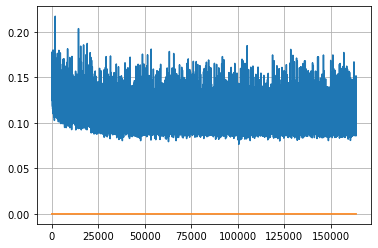

Epoch: 420, iteration 0, loss 0.10602375864982605, cov_diff 0.39990679487727804 cov_diff train 0.39928756593333853
Epoch: 420, iteration 1, loss 0.10186251997947693, cov_diff 0.40544111437694164 cov_diff train 0.40426996870102555
Epoch: 420, iteration 2, loss 0.10870051383972168, cov_diff 0.40483835237831733 cov_diff train 0.4038681661834867
Epoch: 420, iteration 3, loss 0.09496304392814636, cov_diff 0.40862559913002583 cov_diff train 0.40778632769479967
Epoch: 420, iteration 4, loss 0.10124519467353821, cov_diff 0.3996054182398682 cov_diff train 0.3985181541066343
Epoch: 420, iteration 5, loss 0.1041300892829895, cov_diff 0.4106323057999949 cov_diff train 0.41063222800359184
Epoch: 420, iteration 6, loss 0.0982886552810669, cov_diff 0.4139886993711157 cov_diff train 0.4126860533642024
Epoch: 420, iteration 7, loss 0.09153857827186584, cov_diff 0.40468358658612275 cov_diff train 0.40467669213390833
Epoch: 420, iteration 8, loss 0.09891447424888611, cov_diff 0.4121390950200028 cov_diff 

Epoch: 420, iteration 78, loss 0.09763753414154053, cov_diff 0.409067025133497 cov_diff train 0.4083428618531862
Epoch: 420, iteration 79, loss 0.11694750189781189, cov_diff 0.41887252686352183 cov_diff train 0.4182722442231612
Epoch: 420, iteration 80, loss 0.10125115513801575, cov_diff 0.4088380317110536 cov_diff train 0.4089303189484799
Epoch: 420, iteration 81, loss 0.09923693537712097, cov_diff 0.4087749392421458 cov_diff train 0.40815899068822886
Epoch: 420, iteration 82, loss 0.0962362289428711, cov_diff 0.42050959098101126 cov_diff train 0.4199786633842138
Epoch: 420, iteration 83, loss 0.1045762300491333, cov_diff 0.4218804232937396 cov_diff train 0.42140238351169024
Epoch: 420, iteration 84, loss 0.10144218802452087, cov_diff 0.41339080452194193 cov_diff train 0.41300410447662056
Epoch: 420, iteration 85, loss 0.09643751382827759, cov_diff 0.41082778424814126 cov_diff train 0.41003561989390497
Epoch: 420, iteration 86, loss 0.095703125, cov_diff 0.41468437883718146 cov_diff t

Epoch: 420, iteration 159, loss 0.10651707649230957, cov_diff 0.4038475216504125 cov_diff train 0.4024962863974516
Epoch: 420, iteration 160, loss 0.10107433795928955, cov_diff 0.40101979909754176 cov_diff train 0.4010807643890022
Epoch: 420, iteration 161, loss 0.09306222200393677, cov_diff 0.40667812441845674 cov_diff train 0.40591000810480266
Epoch: 420, iteration 162, loss 0.09985578060150146, cov_diff 0.4125948233888852 cov_diff train 0.41234731131174923
Epoch: 420, iteration 163, loss 0.1087174117565155, cov_diff 0.4120703393457274 cov_diff train 0.41125922730823133
Epoch: 420, iteration 164, loss 0.09836718440055847, cov_diff 0.40001803028997235 cov_diff train 0.3994415094906554
Epoch: 420, iteration 165, loss 0.10888579487800598, cov_diff 0.40293037579970087 cov_diff train 0.4027410824115589
Epoch: 420, iteration 166, loss 0.10152319073677063, cov_diff 0.40701786520173083 cov_diff train 0.40581359625235697
Epoch: 420, iteration 167, loss 0.10284706950187683, cov_diff 0.40015600

Epoch: 420, iteration 238, loss 0.11855471134185791, cov_diff 0.40420271277390846 cov_diff train 0.4033222157156785
Epoch: 420, iteration 239, loss 0.1087624728679657, cov_diff 0.4113005127386248 cov_diff train 0.4105951480515824
Epoch: 420, iteration 240, loss 0.10677739977836609, cov_diff 0.41364078405590315 cov_diff train 0.41326853419514276
Epoch: 420, iteration 241, loss 0.11588767170906067, cov_diff 0.40113545597530254 cov_diff train 0.3993258332531076
Epoch: 420, iteration 242, loss 0.11035776138305664, cov_diff 0.41815301745592715 cov_diff train 0.41746814385453523
Epoch: 420, iteration 243, loss 0.10180354118347168, cov_diff 0.4137114974866262 cov_diff train 0.41353836977917285
Epoch: 420, iteration 244, loss 0.09803614020347595, cov_diff 0.40646031074468203 cov_diff train 0.40589127960194077
Epoch: 420, iteration 245, loss 0.099323570728302, cov_diff 0.4112297366281079 cov_diff train 0.4104270949453905
Epoch: 420, iteration 246, loss 0.09677374362945557, cov_diff 0.4073256730

Epoch: 420, iteration 316, loss 0.11155563592910767, cov_diff 0.398782222935958 cov_diff train 0.3979906226046538
Epoch: 420, iteration 317, loss 0.10500127077102661, cov_diff 0.4123440673861344 cov_diff train 0.4115512205946802
Epoch: 420, iteration 318, loss 0.09424731135368347, cov_diff 0.4034883115714675 cov_diff train 0.40330748770719327
Epoch: 420, iteration 319, loss 0.09831234812736511, cov_diff 0.4131361709058769 cov_diff train 0.4126259485952965
Epoch: 420, iteration 320, loss 0.10175305604934692, cov_diff 0.4097064089777049 cov_diff train 0.4097028206343749
Epoch: 420, iteration 321, loss 0.09236457943916321, cov_diff 0.40445623031922406 cov_diff train 0.4041845031224908
Epoch: 420, iteration 322, loss 0.10257205367088318, cov_diff 0.4155599925874952 cov_diff train 0.4152824683503665
Epoch: 420, iteration 323, loss 0.10755941271781921, cov_diff 0.41049510398901107 cov_diff train 0.4101650512877747
Epoch: 420, iteration 324, loss 0.10405704379081726, cov_diff 0.41254114858649

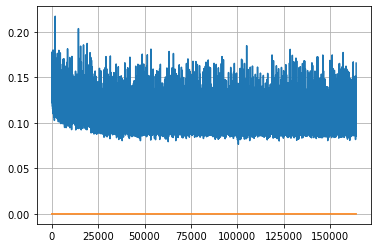

Epoch: 421, iteration 0, loss 0.10103273391723633, cov_diff 0.4007221141717294 cov_diff train 0.4005468955968225
Epoch: 421, iteration 1, loss 0.09944027662277222, cov_diff 0.4075373406882586 cov_diff train 0.4073065638068938
Epoch: 421, iteration 2, loss 0.11832660436630249, cov_diff 0.4200743605694115 cov_diff train 0.4197702086132045
Epoch: 421, iteration 3, loss 0.10850849747657776, cov_diff 0.4139334650794853 cov_diff train 0.41292358805125223
Epoch: 421, iteration 4, loss 0.11309927701950073, cov_diff 0.41266956030602947 cov_diff train 0.4097196582277405
Epoch: 421, iteration 5, loss 0.10067561268806458, cov_diff 0.39550928350944353 cov_diff train 0.395151802732887
Epoch: 421, iteration 6, loss 0.11960655450820923, cov_diff 0.4144492025443781 cov_diff train 0.4136613233143938
Epoch: 421, iteration 7, loss 0.105724036693573, cov_diff 0.41163180892573864 cov_diff train 0.41086939093738195
Epoch: 421, iteration 8, loss 0.10726100206375122, cov_diff 0.4113948492664085 cov_diff train 

Epoch: 421, iteration 79, loss 0.10332533717155457, cov_diff 0.4113639052119964 cov_diff train 0.40891837313982915
Epoch: 421, iteration 80, loss 0.09038731455802917, cov_diff 0.4118733233016251 cov_diff train 0.4120535321234186
Epoch: 421, iteration 81, loss 0.10084611177444458, cov_diff 0.42188249547250206 cov_diff train 0.42017254317618236
Epoch: 421, iteration 82, loss 0.10605743527412415, cov_diff 0.40398501168543477 cov_diff train 0.4020639576848727
Epoch: 421, iteration 83, loss 0.09917846322059631, cov_diff 0.39947183178341117 cov_diff train 0.39867135170023593
Epoch: 421, iteration 84, loss 0.10310521721839905, cov_diff 0.4093837604689769 cov_diff train 0.4077517972234244
Epoch: 421, iteration 85, loss 0.10236376523971558, cov_diff 0.4176162583080075 cov_diff train 0.41675575065610376
Epoch: 421, iteration 86, loss 0.10259518027305603, cov_diff 0.40192935270138186 cov_diff train 0.40125031522693383
Epoch: 421, iteration 87, loss 0.11919960379600525, cov_diff 0.4122031689680051

Epoch: 421, iteration 153, loss 0.10197454690933228, cov_diff 0.4139220807423544 cov_diff train 0.41336914339853476
Epoch: 421, iteration 154, loss 0.10452011227607727, cov_diff 0.4159555868962754 cov_diff train 0.4146140866256885
Epoch: 421, iteration 155, loss 0.09436675906181335, cov_diff 0.4166902020618729 cov_diff train 0.41625966206159454
Epoch: 421, iteration 156, loss 0.09755823016166687, cov_diff 0.4130712153960312 cov_diff train 0.4123511455917606
Epoch: 421, iteration 157, loss 0.09123656153678894, cov_diff 0.41450714456909604 cov_diff train 0.41340831932669875
Epoch: 421, iteration 158, loss 0.09194004535675049, cov_diff 0.3979701011431451 cov_diff train 0.39714106738009614
Epoch: 421, iteration 159, loss 0.09260466694831848, cov_diff 0.40258089143265974 cov_diff train 0.4025631121724519
Epoch: 421, iteration 160, loss 0.09560370445251465, cov_diff 0.4038381005117391 cov_diff train 0.40339800859886954
Epoch: 421, iteration 161, loss 0.10022017359733582, cov_diff 0.413175008

Epoch: 421, iteration 230, loss 0.10832390189170837, cov_diff 0.4192463375219325 cov_diff train 0.4180813542176491
Epoch: 421, iteration 231, loss 0.09252506494522095, cov_diff 0.40605662388151903 cov_diff train 0.4052634137311541
Epoch: 421, iteration 232, loss 0.09183308482170105, cov_diff 0.41040102503510495 cov_diff train 0.4099020973667313
Epoch: 421, iteration 233, loss 0.10365194082260132, cov_diff 0.39619187871491635 cov_diff train 0.395787245873847
Epoch: 421, iteration 234, loss 0.09879931807518005, cov_diff 0.40223976353235236 cov_diff train 0.40136232068883915
Epoch: 421, iteration 235, loss 0.09650075435638428, cov_diff 0.41415580348053266 cov_diff train 0.41403848261079923
Epoch: 421, iteration 236, loss 0.10320684313774109, cov_diff 0.4107769996094611 cov_diff train 0.4103493571745869
Epoch: 421, iteration 237, loss 0.12368983030319214, cov_diff 0.41941786356134836 cov_diff train 0.41814647393728166
Epoch: 421, iteration 238, loss 0.11226361989974976, cov_diff 0.41283308

Epoch: 421, iteration 307, loss 0.09975108504295349, cov_diff 0.3899889185224007 cov_diff train 0.3896529034952051
Epoch: 421, iteration 308, loss 0.09597411751747131, cov_diff 0.40577482830644523 cov_diff train 0.40383688500381526
Epoch: 421, iteration 309, loss 0.10340842604637146, cov_diff 0.41134259875112844 cov_diff train 0.41018018409424234
Epoch: 421, iteration 310, loss 0.1090984046459198, cov_diff 0.41145424593792573 cov_diff train 0.4104981818605628
Epoch: 421, iteration 311, loss 0.10049253702163696, cov_diff 0.4072527134912491 cov_diff train 0.4060728339120024
Epoch: 421, iteration 312, loss 0.11660322546958923, cov_diff 0.42540838405062353 cov_diff train 0.4256143296434425
Epoch: 421, iteration 313, loss 0.10715633630752563, cov_diff 0.4020347487795021 cov_diff train 0.4008569887576226
Epoch: 421, iteration 314, loss 0.10761427879333496, cov_diff 0.4201550634607162 cov_diff train 0.4203729650173184
Epoch: 421, iteration 315, loss 0.0968865156173706, cov_diff 0.408647564274

Epoch: 421, iteration 384, loss 0.10822588205337524, cov_diff 0.4051222319234195 cov_diff train 0.4041376112568519
Epoch: 421, iteration 385, loss 0.1026410460472107, cov_diff 0.40079350633523486 cov_diff train 0.4004998462716797
Epoch: 421, iteration 386, loss 0.10674765706062317, cov_diff 0.409144846914855 cov_diff train 0.40839578794838083
Epoch: 421, iteration 387, loss 0.10886919498443604, cov_diff 0.4081453349708761 cov_diff train 0.40759534573693734
Epoch: 421, iteration 388, loss 0.11478790640830994, cov_diff 0.40394450877224153 cov_diff train 0.40308600097009717
Epoch: 421, iteration 389, loss 0.0953684151172638, cov_diff 0.39942353134038544 cov_diff train 0.39843382016565904
Epoch: 421, iteration 390, loss 0.15454226732254028, cov_diff 0.45221972174676406 cov_diff train 0.45228897608886903


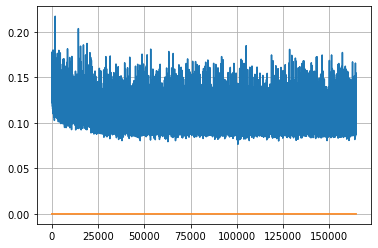

Epoch: 422, iteration 0, loss 0.10391989350318909, cov_diff 0.40852315889488955 cov_diff train 0.40705362077507595
Epoch: 422, iteration 1, loss 0.11229926347732544, cov_diff 0.4015485828448771 cov_diff train 0.4011523181212178
Epoch: 422, iteration 2, loss 0.10762336850166321, cov_diff 0.4266324639566769 cov_diff train 0.4264608998057299
Epoch: 422, iteration 3, loss 0.1024746298789978, cov_diff 0.41325954286735334 cov_diff train 0.4133546100848053
Epoch: 422, iteration 4, loss 0.0944528877735138, cov_diff 0.4065786888375175 cov_diff train 0.4061287409527906
Epoch: 422, iteration 5, loss 0.08474156260490417, cov_diff 0.4069124191716668 cov_diff train 0.40618623718111363
Epoch: 422, iteration 6, loss 0.11021491885185242, cov_diff 0.41343040749421683 cov_diff train 0.41308827522212765
Epoch: 422, iteration 7, loss 0.1047435998916626, cov_diff 0.39874943882867997 cov_diff train 0.39852037240158367
Epoch: 422, iteration 8, loss 0.11915713548660278, cov_diff 0.4129322411506965 cov_diff tra

Epoch: 422, iteration 78, loss 0.10434114933013916, cov_diff 0.4138182457197931 cov_diff train 0.41333347010754407
Epoch: 422, iteration 79, loss 0.10014480352401733, cov_diff 0.40632751135709955 cov_diff train 0.40600646903030185
Epoch: 422, iteration 80, loss 0.10141748189926147, cov_diff 0.4102969095208008 cov_diff train 0.4093098300868387
Epoch: 422, iteration 81, loss 0.1035323441028595, cov_diff 0.40922198795410886 cov_diff train 0.4092710726753691
Epoch: 422, iteration 82, loss 0.10471847653388977, cov_diff 0.41214728944108037 cov_diff train 0.41120362130928584
Epoch: 422, iteration 83, loss 0.10435709357261658, cov_diff 0.40747593558515216 cov_diff train 0.40651691840348464
Epoch: 422, iteration 84, loss 0.11617690324783325, cov_diff 0.40989172544951763 cov_diff train 0.409759591737329
Epoch: 422, iteration 85, loss 0.1027790904045105, cov_diff 0.4123886145567815 cov_diff train 0.4116026612546864
Epoch: 422, iteration 86, loss 0.11275020241737366, cov_diff 0.4088923438240998 co

Epoch: 422, iteration 158, loss 0.0979653000831604, cov_diff 0.4063644061399758 cov_diff train 0.4060889855223826
Epoch: 422, iteration 159, loss 0.09492036700248718, cov_diff 0.40487042376786797 cov_diff train 0.40429989173098074
Epoch: 422, iteration 160, loss 0.11430266499519348, cov_diff 0.42221572510128424 cov_diff train 0.4195957365259283
Epoch: 422, iteration 161, loss 0.11709868907928467, cov_diff 0.4150546061791303 cov_diff train 0.4142263629254526
Epoch: 422, iteration 162, loss 0.10372805595397949, cov_diff 0.4033552017837357 cov_diff train 0.4034581937995174
Epoch: 422, iteration 163, loss 0.09896215796470642, cov_diff 0.41746774714547924 cov_diff train 0.41605527330020947
Epoch: 422, iteration 164, loss 0.10243183374404907, cov_diff 0.4201915670254683 cov_diff train 0.4191235361423451
Epoch: 422, iteration 165, loss 0.10485231876373291, cov_diff 0.4114552174163081 cov_diff train 0.4100584631400339
Epoch: 422, iteration 166, loss 0.0998958945274353, cov_diff 0.4080883418930

Epoch: 422, iteration 238, loss 0.09478434920310974, cov_diff 0.41173411662231335 cov_diff train 0.4111616023741297
Epoch: 422, iteration 239, loss 0.10471728444099426, cov_diff 0.40005776866292647 cov_diff train 0.39925046984916196
Epoch: 422, iteration 240, loss 0.10239997506141663, cov_diff 0.4075228695358888 cov_diff train 0.406880438553292
Epoch: 422, iteration 241, loss 0.09922489523887634, cov_diff 0.4149707006225087 cov_diff train 0.4147172821871765
Epoch: 422, iteration 242, loss 0.10227319598197937, cov_diff 0.4020877969856408 cov_diff train 0.401161568994941
Epoch: 422, iteration 243, loss 0.1021072268486023, cov_diff 0.4241263642429269 cov_diff train 0.42242580855354966
Epoch: 422, iteration 244, loss 0.10753080248832703, cov_diff 0.3977465707100213 cov_diff train 0.39730860081212827
Epoch: 422, iteration 245, loss 0.10928696393966675, cov_diff 0.4083665520550064 cov_diff train 0.40741134717421706
Epoch: 422, iteration 246, loss 0.09963557124137878, cov_diff 0.4136400070245

Epoch: 422, iteration 316, loss 0.11303308606147766, cov_diff 0.41647824802741856 cov_diff train 0.4156963811960061
Epoch: 422, iteration 317, loss 0.09786120057106018, cov_diff 0.41711555691872954 cov_diff train 0.4161150822428446
Epoch: 422, iteration 318, loss 0.09942033886909485, cov_diff 0.41685815242770113 cov_diff train 0.41590367115672333
Epoch: 422, iteration 319, loss 0.1129554808139801, cov_diff 0.4055592015258771 cov_diff train 0.4047696312914004
Epoch: 422, iteration 320, loss 0.09351861476898193, cov_diff 0.4175122462988764 cov_diff train 0.41689138353507216
Epoch: 422, iteration 321, loss 0.09968423843383789, cov_diff 0.41116618211310724 cov_diff train 0.4101541337657719
Epoch: 422, iteration 322, loss 0.09940177202224731, cov_diff 0.405883169692372 cov_diff train 0.40539165203318633
Epoch: 422, iteration 323, loss 0.10421440005302429, cov_diff 0.41507813464931953 cov_diff train 0.41421764800775496
Epoch: 422, iteration 324, loss 0.10388123989105225, cov_diff 0.411558686

Epoch: 422, iteration 388, loss 0.10893189907073975, cov_diff 0.4120037296627861 cov_diff train 0.41079055911974266
Epoch: 422, iteration 389, loss 0.09492290019989014, cov_diff 0.40310736101326733 cov_diff train 0.40303603821299117
Epoch: 422, iteration 390, loss 0.14846909046173096, cov_diff 0.45158296053877894 cov_diff train 0.44920288920743484


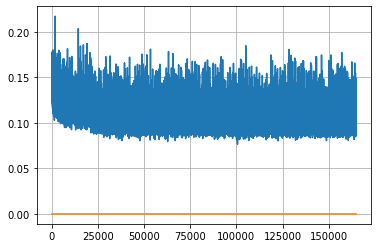

Epoch: 423, iteration 0, loss 0.10163912177085876, cov_diff 0.4130019831307263 cov_diff train 0.41212129934185876
Epoch: 423, iteration 1, loss 0.12010890245437622, cov_diff 0.40358767164791187 cov_diff train 0.40214422093386704
Epoch: 423, iteration 2, loss 0.10578951239585876, cov_diff 0.4097356359684011 cov_diff train 0.4082817466627061
Epoch: 423, iteration 3, loss 0.10413703322410583, cov_diff 0.4121497835947562 cov_diff train 0.41067201793238545
Epoch: 423, iteration 4, loss 0.1020193099975586, cov_diff 0.4057561891287511 cov_diff train 0.4042397739936051
Epoch: 423, iteration 5, loss 0.10999324917793274, cov_diff 0.4084867123999109 cov_diff train 0.40675285460205907
Epoch: 423, iteration 6, loss 0.10524946451187134, cov_diff 0.41091465991998855 cov_diff train 0.4102995456675724
Epoch: 423, iteration 7, loss 0.09177076816558838, cov_diff 0.40577887213446023 cov_diff train 0.4043249377467582
Epoch: 423, iteration 8, loss 0.10820335149765015, cov_diff 0.4011092127040932 cov_diff tr

Epoch: 423, iteration 80, loss 0.11090272665023804, cov_diff 0.40915368879250114 cov_diff train 0.40812322458870665
Epoch: 423, iteration 81, loss 0.10514429211616516, cov_diff 0.402455852196584 cov_diff train 0.4016417932241341
Epoch: 423, iteration 82, loss 0.09666761755943298, cov_diff 0.4145928540926047 cov_diff train 0.4148200643272927
Epoch: 423, iteration 83, loss 0.10479423403739929, cov_diff 0.40707215402391844 cov_diff train 0.40728981238729306
Epoch: 423, iteration 84, loss 0.09995222091674805, cov_diff 0.41306293183859843 cov_diff train 0.413127946404376
Epoch: 423, iteration 85, loss 0.10069751739501953, cov_diff 0.4120577515997616 cov_diff train 0.4110450825874694
Epoch: 423, iteration 86, loss 0.09933274984359741, cov_diff 0.4067571889232559 cov_diff train 0.4068249517359864
Epoch: 423, iteration 87, loss 0.11884886026382446, cov_diff 0.4129441976404947 cov_diff train 0.4127666900145879
Epoch: 423, iteration 88, loss 0.10964444279670715, cov_diff 0.4102948596731369 cov_d

Epoch: 423, iteration 158, loss 0.09030687808990479, cov_diff 0.40727951381128485 cov_diff train 0.4065663681492097
Epoch: 423, iteration 159, loss 0.10649770498275757, cov_diff 0.4104668685581956 cov_diff train 0.41048321118995335
Epoch: 423, iteration 160, loss 0.10886579751968384, cov_diff 0.4082709674048404 cov_diff train 0.407530388850623
Epoch: 423, iteration 161, loss 0.10387435555458069, cov_diff 0.4196257644824924 cov_diff train 0.419091283310402
Epoch: 423, iteration 162, loss 0.10450047254562378, cov_diff 0.40761479416835794 cov_diff train 0.40757164704013416
Epoch: 423, iteration 163, loss 0.09919551014900208, cov_diff 0.4087174593109303 cov_diff train 0.40825203188204345
Epoch: 423, iteration 164, loss 0.09994399547576904, cov_diff 0.40162436440620064 cov_diff train 0.4008474930569266
Epoch: 423, iteration 165, loss 0.09840735793113708, cov_diff 0.419778766519727 cov_diff train 0.4189973877901518
Epoch: 423, iteration 166, loss 0.10414257645606995, cov_diff 0.4097378399659

Epoch: 423, iteration 238, loss 0.09818759560585022, cov_diff 0.4017190999132475 cov_diff train 0.4015616740793036
Epoch: 423, iteration 239, loss 0.09363245964050293, cov_diff 0.3985524138459198 cov_diff train 0.39841953059179736
Epoch: 423, iteration 240, loss 0.09447833895683289, cov_diff 0.41495014832146465 cov_diff train 0.4140572695849847
Epoch: 423, iteration 241, loss 0.09806343913078308, cov_diff 0.3890813875181694 cov_diff train 0.38873389898080224
Epoch: 423, iteration 242, loss 0.10753560066223145, cov_diff 0.4229595415496301 cov_diff train 0.4217218598068454
Epoch: 423, iteration 243, loss 0.10451722145080566, cov_diff 0.40284921230303466 cov_diff train 0.4029323072897897
Epoch: 423, iteration 244, loss 0.09236350655555725, cov_diff 0.41900338335586723 cov_diff train 0.41924057876559273
Epoch: 423, iteration 245, loss 0.10870149731636047, cov_diff 0.4045996021496755 cov_diff train 0.4043868090616337
Epoch: 423, iteration 246, loss 0.10562503337860107, cov_diff 0.4006078055

Epoch: 423, iteration 317, loss 0.10430967807769775, cov_diff 0.4065487325264778 cov_diff train 0.4056818961795112
Epoch: 423, iteration 318, loss 0.10776805877685547, cov_diff 0.4195880048501223 cov_diff train 0.4186038328345724
Epoch: 423, iteration 319, loss 0.10947814583778381, cov_diff 0.40862585501828375 cov_diff train 0.40743323586571284
Epoch: 423, iteration 320, loss 0.10221505165100098, cov_diff 0.41900210406780763 cov_diff train 0.41801685862187665
Epoch: 423, iteration 321, loss 0.09555578231811523, cov_diff 0.39548522797591246 cov_diff train 0.3936671779635416
Epoch: 423, iteration 322, loss 0.1037222146987915, cov_diff 0.4253657644008788 cov_diff train 0.42473042205579153
Epoch: 423, iteration 323, loss 0.09319061040878296, cov_diff 0.41017259796340305 cov_diff train 0.41006411949103594
Epoch: 423, iteration 324, loss 0.10238948464393616, cov_diff 0.4184862613986595 cov_diff train 0.41725178502249977
Epoch: 423, iteration 325, loss 0.10269677639007568, cov_diff 0.40376957

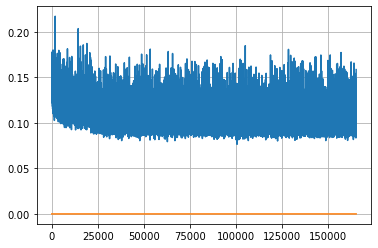

Epoch: 424, iteration 0, loss 0.10058686137199402, cov_diff 0.4203944499505758 cov_diff train 0.41992223378376287
Epoch: 424, iteration 1, loss 0.10637244582176208, cov_diff 0.4069242493368203 cov_diff train 0.40553113568391624
Epoch: 424, iteration 2, loss 0.1057690680027008, cov_diff 0.4155860451239329 cov_diff train 0.41350806644048316
Epoch: 424, iteration 3, loss 0.10821810364723206, cov_diff 0.4157575154089579 cov_diff train 0.4145502466652856
Epoch: 424, iteration 4, loss 0.10908395051956177, cov_diff 0.41525725936174973 cov_diff train 0.41451707889249056
Epoch: 424, iteration 5, loss 0.09459993243217468, cov_diff 0.406906641695826 cov_diff train 0.4064983282267847
Epoch: 424, iteration 6, loss 0.09531044960021973, cov_diff 0.40916502925693254 cov_diff train 0.4073051794982644
Epoch: 424, iteration 7, loss 0.10713827610015869, cov_diff 0.42339709855480917 cov_diff train 0.4226894064834219
Epoch: 424, iteration 8, loss 0.10464468598365784, cov_diff 0.41046216563192617 cov_diff tr

Epoch: 424, iteration 78, loss 0.10875499248504639, cov_diff 0.40814800736514895 cov_diff train 0.40777193922928334
Epoch: 424, iteration 79, loss 0.09691271185874939, cov_diff 0.4016198673523244 cov_diff train 0.40206280032488867
Epoch: 424, iteration 80, loss 0.09283369779586792, cov_diff 0.4096336876540288 cov_diff train 0.40924418613070923
Epoch: 424, iteration 81, loss 0.1083199679851532, cov_diff 0.41225383614041167 cov_diff train 0.41124059089290105
Epoch: 424, iteration 82, loss 0.09876200556755066, cov_diff 0.4149342009741373 cov_diff train 0.415415729623004
Epoch: 424, iteration 83, loss 0.10122907161712646, cov_diff 0.40221182765762103 cov_diff train 0.4022136080402368
Epoch: 424, iteration 84, loss 0.09796008467674255, cov_diff 0.406363804856108 cov_diff train 0.4056711089373602
Epoch: 424, iteration 85, loss 0.10060328245162964, cov_diff 0.4082388678749404 cov_diff train 0.4079070776046683
Epoch: 424, iteration 86, loss 0.09607037901878357, cov_diff 0.41134843468949944 cov

Epoch: 424, iteration 155, loss 0.0941360592842102, cov_diff 0.39342143305569477 cov_diff train 0.39317558474425374
Epoch: 424, iteration 156, loss 0.09834179282188416, cov_diff 0.4186173172918629 cov_diff train 0.4190020151506684
Epoch: 424, iteration 157, loss 0.1069352924823761, cov_diff 0.41082606423638657 cov_diff train 0.4103922566186722
Epoch: 424, iteration 158, loss 0.09234470129013062, cov_diff 0.3948270215674367 cov_diff train 0.39481996149972365
Epoch: 424, iteration 159, loss 0.09094813466072083, cov_diff 0.4039848736815533 cov_diff train 0.40440791842170015
Epoch: 424, iteration 160, loss 0.10796016454696655, cov_diff 0.4113696976317916 cov_diff train 0.4108530197888317
Epoch: 424, iteration 161, loss 0.10746228694915771, cov_diff 0.4110931439469279 cov_diff train 0.4115046560355727
Epoch: 424, iteration 162, loss 0.10554224252700806, cov_diff 0.4070215964662988 cov_diff train 0.4064248940177632
Epoch: 424, iteration 163, loss 0.10048019886016846, cov_diff 0.4085293592651

Epoch: 424, iteration 232, loss 0.09294617176055908, cov_diff 0.40936428855888546 cov_diff train 0.4087307292645955
Epoch: 424, iteration 233, loss 0.10320979356765747, cov_diff 0.4084085482497757 cov_diff train 0.40721017024988804
Epoch: 424, iteration 234, loss 0.0985938012599945, cov_diff 0.4144936176141806 cov_diff train 0.41269562340126803
Epoch: 424, iteration 235, loss 0.10325667262077332, cov_diff 0.41240964867759883 cov_diff train 0.41140316515332437
Epoch: 424, iteration 236, loss 0.10471665859222412, cov_diff 0.4110567367434913 cov_diff train 0.4099654320529146
Epoch: 424, iteration 237, loss 0.10610625147819519, cov_diff 0.4089083102921126 cov_diff train 0.40766666284152214
Epoch: 424, iteration 238, loss 0.10022735595703125, cov_diff 0.41372056985183947 cov_diff train 0.4133248357042528
Epoch: 424, iteration 239, loss 0.11069780588150024, cov_diff 0.4072853362559723 cov_diff train 0.4061930766262374
Epoch: 424, iteration 240, loss 0.10207000374794006, cov_diff 0.4165367385

Epoch: 424, iteration 312, loss 0.10196360945701599, cov_diff 0.4011077435142249 cov_diff train 0.39969576219533365
Epoch: 424, iteration 313, loss 0.11108547449111938, cov_diff 0.4126609917073354 cov_diff train 0.41266278181179006
Epoch: 424, iteration 314, loss 0.09799811244010925, cov_diff 0.4168758964171451 cov_diff train 0.4155619383372346
Epoch: 424, iteration 315, loss 0.10589155554771423, cov_diff 0.39528269445935643 cov_diff train 0.3953613785133937
Epoch: 424, iteration 316, loss 0.09835201501846313, cov_diff 0.41621847811550444 cov_diff train 0.41594650399327704
Epoch: 424, iteration 317, loss 0.10221216082572937, cov_diff 0.4045204374424031 cov_diff train 0.40381206492721605
Epoch: 424, iteration 318, loss 0.10013559460639954, cov_diff 0.4020202899596932 cov_diff train 0.40167921293370734
Epoch: 424, iteration 319, loss 0.09683293104171753, cov_diff 0.40254698565604924 cov_diff train 0.40242529986313796
Epoch: 424, iteration 320, loss 0.09756049513816833, cov_diff 0.4152519

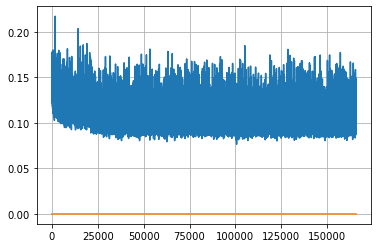

Epoch: 425, iteration 0, loss 0.10110741853713989, cov_diff 0.40962999414299567 cov_diff train 0.4084502878379796
Epoch: 425, iteration 1, loss 0.10940289497375488, cov_diff 0.40694570165858546 cov_diff train 0.40657651525826
Epoch: 425, iteration 2, loss 0.10933715105056763, cov_diff 0.41985746529786405 cov_diff train 0.41898977279429384
Epoch: 425, iteration 3, loss 0.09092679619789124, cov_diff 0.4109967238313551 cov_diff train 0.40951451340448186
Epoch: 425, iteration 4, loss 0.0975257158279419, cov_diff 0.40919666147438416 cov_diff train 0.40851817508024535
Epoch: 425, iteration 5, loss 0.10844546556472778, cov_diff 0.4117566605849539 cov_diff train 0.4103248526820625
Epoch: 425, iteration 6, loss 0.09570568799972534, cov_diff 0.406596951034321 cov_diff train 0.4059789084037422
Epoch: 425, iteration 7, loss 0.12061500549316406, cov_diff 0.39723804464418044 cov_diff train 0.3964168585075917
Epoch: 425, iteration 8, loss 0.09873223304748535, cov_diff 0.39566088097487173 cov_diff tra

Epoch: 425, iteration 77, loss 0.1017606258392334, cov_diff 0.40463206663817847 cov_diff train 0.4044972927298199
Epoch: 425, iteration 78, loss 0.09947890043258667, cov_diff 0.400921492955877 cov_diff train 0.4003636636764243
Epoch: 425, iteration 79, loss 0.089732825756073, cov_diff 0.4118138811176081 cov_diff train 0.41114527171460313
Epoch: 425, iteration 80, loss 0.0994231104850769, cov_diff 0.42902739874662815 cov_diff train 0.4279835064776923
Epoch: 425, iteration 81, loss 0.10320806503295898, cov_diff 0.4041935705941149 cov_diff train 0.4029120100964561
Epoch: 425, iteration 82, loss 0.09574654698371887, cov_diff 0.4160328538964762 cov_diff train 0.41496082159880837
Epoch: 425, iteration 83, loss 0.11026939749717712, cov_diff 0.42042698266277057 cov_diff train 0.4202773405313543
Epoch: 425, iteration 84, loss 0.1133752167224884, cov_diff 0.4201118607801681 cov_diff train 0.4196203066059319
Epoch: 425, iteration 85, loss 0.10052123665809631, cov_diff 0.4102697070707585 cov_diff 

Epoch: 425, iteration 155, loss 0.09331455826759338, cov_diff 0.4057518069878562 cov_diff train 0.4056402140618836
Epoch: 425, iteration 156, loss 0.09402891993522644, cov_diff 0.41779486918292147 cov_diff train 0.41749146412914445
Epoch: 425, iteration 157, loss 0.09236523509025574, cov_diff 0.4051180589629827 cov_diff train 0.4052394812963638
Epoch: 425, iteration 158, loss 0.0922105610370636, cov_diff 0.40641395837051464 cov_diff train 0.4061325395172123
Epoch: 425, iteration 159, loss 0.10329046845436096, cov_diff 0.4338820212102874 cov_diff train 0.433549523887265
Epoch: 425, iteration 160, loss 0.11269810795783997, cov_diff 0.40890549131716847 cov_diff train 0.4080284344601694
Epoch: 425, iteration 161, loss 0.11085274815559387, cov_diff 0.4041807761930421 cov_diff train 0.40371796599293175
Epoch: 425, iteration 162, loss 0.09150561690330505, cov_diff 0.4144539323854203 cov_diff train 0.4138800098219174
Epoch: 425, iteration 163, loss 0.09864142537117004, cov_diff 0.4077289088822

Epoch: 425, iteration 226, loss 0.11259323358535767, cov_diff 0.41083020711642604 cov_diff train 0.4110356328473573
Epoch: 425, iteration 227, loss 0.09773892164230347, cov_diff 0.40101960443394535 cov_diff train 0.3993766709498594
Epoch: 425, iteration 228, loss 0.0927242636680603, cov_diff 0.40997357880163143 cov_diff train 0.4097353803578544
Epoch: 425, iteration 229, loss 0.10971066355705261, cov_diff 0.4019433879887787 cov_diff train 0.40081355057798435
Epoch: 425, iteration 230, loss 0.10534912347793579, cov_diff 0.40298563927205944 cov_diff train 0.4017617059633731
Epoch: 425, iteration 231, loss 0.10812687873840332, cov_diff 0.4101586767313997 cov_diff train 0.40953816517988095
Epoch: 425, iteration 232, loss 0.10708624124526978, cov_diff 0.4103349596658851 cov_diff train 0.4099141691103008
Epoch: 425, iteration 233, loss 0.1101689338684082, cov_diff 0.40537170389876626 cov_diff train 0.40557651510359294
Epoch: 425, iteration 234, loss 0.10239118337631226, cov_diff 0.4220640587

Epoch: 425, iteration 304, loss 0.10361900925636292, cov_diff 0.4098423473864268 cov_diff train 0.4096757113673059
Epoch: 425, iteration 305, loss 0.10054025053977966, cov_diff 0.40856781775868906 cov_diff train 0.40789497479298586
Epoch: 425, iteration 306, loss 0.10087928175926208, cov_diff 0.39298495173358994 cov_diff train 0.3926877421289723
Epoch: 425, iteration 307, loss 0.10443606972694397, cov_diff 0.41355199650700886 cov_diff train 0.412911603218008
Epoch: 425, iteration 308, loss 0.09846577048301697, cov_diff 0.4025393079185181 cov_diff train 0.40224121937420904
Epoch: 425, iteration 309, loss 0.10212841629981995, cov_diff 0.4113121958590442 cov_diff train 0.4108624609614202
Epoch: 425, iteration 310, loss 0.09708535671234131, cov_diff 0.4062379738719273 cov_diff train 0.40556878473699937
Epoch: 425, iteration 311, loss 0.1035018265247345, cov_diff 0.4155423930577193 cov_diff train 0.4148268740676281
Epoch: 425, iteration 312, loss 0.10725146532058716, cov_diff 0.415051978082

Epoch: 425, iteration 386, loss 0.096681147813797, cov_diff 0.4038658174442609 cov_diff train 0.4045145521248167
Epoch: 425, iteration 387, loss 0.10069409012794495, cov_diff 0.40875834241819636 cov_diff train 0.40773374068351403
Epoch: 425, iteration 388, loss 0.10999199748039246, cov_diff 0.4064311595809411 cov_diff train 0.4057184523228846
Epoch: 425, iteration 389, loss 0.10197052359580994, cov_diff 0.4115690667050054 cov_diff train 0.41170295776742305
Epoch: 425, iteration 390, loss 0.15209200978279114, cov_diff 0.4379468688664402 cov_diff train 0.43877770756866724


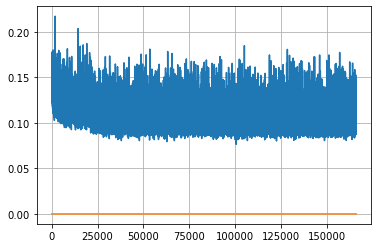

Epoch: 426, iteration 0, loss 0.10308337211608887, cov_diff 0.41690613225181905 cov_diff train 0.41651578035406744
Epoch: 426, iteration 1, loss 0.10085749626159668, cov_diff 0.4134939578905901 cov_diff train 0.41319743464299596
Epoch: 426, iteration 2, loss 0.10328617691993713, cov_diff 0.4153107749894961 cov_diff train 0.41533034394767865
Epoch: 426, iteration 3, loss 0.10159441828727722, cov_diff 0.41101238404763124 cov_diff train 0.4103445705543531
Epoch: 426, iteration 4, loss 0.10202842950820923, cov_diff 0.40680837516838253 cov_diff train 0.4065440649948235
Epoch: 426, iteration 5, loss 0.10454660654067993, cov_diff 0.41235936790944916 cov_diff train 0.4119937799510202
Epoch: 426, iteration 6, loss 0.09534713625907898, cov_diff 0.4013991743459942 cov_diff train 0.40034813906194494
Epoch: 426, iteration 7, loss 0.11166521906852722, cov_diff 0.40005666423842445 cov_diff train 0.40112965595069455
Epoch: 426, iteration 8, loss 0.10152110457420349, cov_diff 0.4168210604744632 cov_dif

Epoch: 426, iteration 79, loss 0.10384845733642578, cov_diff 0.4186593112585736 cov_diff train 0.41851687100728346
Epoch: 426, iteration 80, loss 0.09826424717903137, cov_diff 0.4222864967483252 cov_diff train 0.42122713014118973
Epoch: 426, iteration 81, loss 0.11064159870147705, cov_diff 0.4108537550046845 cov_diff train 0.41082812215994885
Epoch: 426, iteration 82, loss 0.10057798027992249, cov_diff 0.3906569006667381 cov_diff train 0.39070207175081983
Epoch: 426, iteration 83, loss 0.12536650896072388, cov_diff 0.41566053158609995 cov_diff train 0.4128822311840604
Epoch: 426, iteration 84, loss 0.10621675848960876, cov_diff 0.42138969428563283 cov_diff train 0.4205121950157301
Epoch: 426, iteration 85, loss 0.10794752836227417, cov_diff 0.4144132892389838 cov_diff train 0.41360426294226826
Epoch: 426, iteration 86, loss 0.10468578338623047, cov_diff 0.41284523505724474 cov_diff train 0.41284712279257135
Epoch: 426, iteration 87, loss 0.1120084822177887, cov_diff 0.41033275149088155

Epoch: 426, iteration 154, loss 0.09333983063697815, cov_diff 0.42280565705556883 cov_diff train 0.42166296097372236
Epoch: 426, iteration 155, loss 0.11240556836128235, cov_diff 0.4226374397680486 cov_diff train 0.42222097309262274
Epoch: 426, iteration 156, loss 0.09224843978881836, cov_diff 0.4028575272951452 cov_diff train 0.4018519942056184
Epoch: 426, iteration 157, loss 0.10592350363731384, cov_diff 0.39591560373892115 cov_diff train 0.3947565912523105
Epoch: 426, iteration 158, loss 0.09541472792625427, cov_diff 0.40873603066790964 cov_diff train 0.4084761144530208
Epoch: 426, iteration 159, loss 0.0982404351234436, cov_diff 0.4093471265807266 cov_diff train 0.4089677799181861
Epoch: 426, iteration 160, loss 0.10265690088272095, cov_diff 0.41917503312665805 cov_diff train 0.418489574026238
Epoch: 426, iteration 161, loss 0.1038677990436554, cov_diff 0.40897706954273577 cov_diff train 0.4075040399151377
Epoch: 426, iteration 162, loss 0.10238099098205566, cov_diff 0.414098015712

Epoch: 426, iteration 226, loss 0.1250932216644287, cov_diff 0.4166596449794267 cov_diff train 0.4132752327556062
Epoch: 426, iteration 227, loss 0.11878669261932373, cov_diff 0.4051514358422198 cov_diff train 0.40412742747597563
Epoch: 426, iteration 228, loss 0.10351279377937317, cov_diff 0.40680673267081213 cov_diff train 0.4060965778556558
Epoch: 426, iteration 229, loss 0.10657480359077454, cov_diff 0.4264034134661484 cov_diff train 0.4253662689101923
Epoch: 426, iteration 230, loss 0.1066279411315918, cov_diff 0.40781605617340133 cov_diff train 0.407691235039247
Epoch: 426, iteration 231, loss 0.10606968402862549, cov_diff 0.4262500025707432 cov_diff train 0.4256499082936056
Epoch: 426, iteration 232, loss 0.09839004278182983, cov_diff 0.4264108867326058 cov_diff train 0.4260304756037824
Epoch: 426, iteration 233, loss 0.09927603602409363, cov_diff 0.4121110073488685 cov_diff train 0.41120680851410213
Epoch: 426, iteration 234, loss 0.10547631978988647, cov_diff 0.430264401181949

Epoch: 426, iteration 303, loss 0.10486578941345215, cov_diff 0.40967430240515684 cov_diff train 0.4082708390871542
Epoch: 426, iteration 304, loss 0.10081601142883301, cov_diff 0.4116101035233276 cov_diff train 0.41127679680810275
Epoch: 426, iteration 305, loss 0.1073794960975647, cov_diff 0.41475043468500017 cov_diff train 0.41431782006341267
Epoch: 426, iteration 306, loss 0.09949031472206116, cov_diff 0.4089473786719269 cov_diff train 0.40794302837206114
Epoch: 426, iteration 307, loss 0.10294032096862793, cov_diff 0.3986670247913903 cov_diff train 0.3985837430275838
Epoch: 426, iteration 308, loss 0.09601497650146484, cov_diff 0.40872402532498964 cov_diff train 0.4087824699883319
Epoch: 426, iteration 309, loss 0.12129569053649902, cov_diff 0.4115459282121718 cov_diff train 0.41045877025502164
Epoch: 426, iteration 310, loss 0.1124008297920227, cov_diff 0.41527258777926307 cov_diff train 0.41422678935862606
Epoch: 426, iteration 311, loss 0.09465953707695007, cov_diff 0.403050247

Epoch: 426, iteration 378, loss 0.10145401954650879, cov_diff 0.4107716930169661 cov_diff train 0.4100413484655366
Epoch: 426, iteration 379, loss 0.09833571314811707, cov_diff 0.4088912943423078 cov_diff train 0.40787469452381536
Epoch: 426, iteration 380, loss 0.09919705986976624, cov_diff 0.415855442957846 cov_diff train 0.41428432297944856
Epoch: 426, iteration 381, loss 0.10570782423019409, cov_diff 0.40904121668221577 cov_diff train 0.40893107528813066
Epoch: 426, iteration 382, loss 0.10688567161560059, cov_diff 0.4044187780604313 cov_diff train 0.4033640218694693
Epoch: 426, iteration 383, loss 0.1030130386352539, cov_diff 0.4155206894683912 cov_diff train 0.4152855951988136
Epoch: 426, iteration 384, loss 0.10718986392021179, cov_diff 0.4017100635004679 cov_diff train 0.402116589853874
Epoch: 426, iteration 385, loss 0.09869071841239929, cov_diff 0.41776814714907184 cov_diff train 0.4173996300524054
Epoch: 426, iteration 386, loss 0.10002148151397705, cov_diff 0.41615326271979

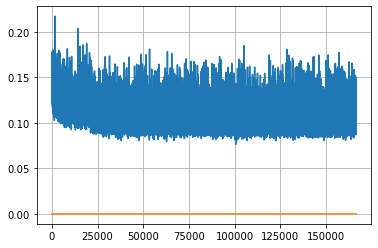

Epoch: 427, iteration 0, loss 0.10882210731506348, cov_diff 0.4176288262858765 cov_diff train 0.4177722805731188
Epoch: 427, iteration 1, loss 0.09619984030723572, cov_diff 0.4084064031415939 cov_diff train 0.40687907446164445
Epoch: 427, iteration 2, loss 0.10548603534698486, cov_diff 0.4155484490771373 cov_diff train 0.4142128660502179
Epoch: 427, iteration 3, loss 0.10508349537849426, cov_diff 0.4240191117197708 cov_diff train 0.4235476695533019
Epoch: 427, iteration 4, loss 0.10283070802688599, cov_diff 0.4335999576183894 cov_diff train 0.4331125100686364
Epoch: 427, iteration 5, loss 0.10767689347267151, cov_diff 0.4293732136687319 cov_diff train 0.4283431136939886
Epoch: 427, iteration 6, loss 0.10136145353317261, cov_diff 0.4143385586168712 cov_diff train 0.41303048131709397
Epoch: 427, iteration 7, loss 0.10785773396492004, cov_diff 0.41645448745375546 cov_diff train 0.4142251371331298
Epoch: 427, iteration 8, loss 0.11321115493774414, cov_diff 0.4168262691211425 cov_diff train

Epoch: 427, iteration 79, loss 0.09417155385017395, cov_diff 0.40933062276596366 cov_diff train 0.4084184726908897
Epoch: 427, iteration 80, loss 0.10471808910369873, cov_diff 0.41683507949481474 cov_diff train 0.41658569421419284
Epoch: 427, iteration 81, loss 0.11083114147186279, cov_diff 0.4075689344455735 cov_diff train 0.40689451507249913
Epoch: 427, iteration 82, loss 0.10820204019546509, cov_diff 0.4093400285721439 cov_diff train 0.40910220594758
Epoch: 427, iteration 83, loss 0.09822988510131836, cov_diff 0.4009894786796065 cov_diff train 0.400515292318844
Epoch: 427, iteration 84, loss 0.10755428671836853, cov_diff 0.4148782430079114 cov_diff train 0.41368206606141145
Epoch: 427, iteration 85, loss 0.11889886856079102, cov_diff 0.3980009427200594 cov_diff train 0.39830017822481484
Epoch: 427, iteration 86, loss 0.10309773683547974, cov_diff 0.42079443015268586 cov_diff train 0.42001090662852947
Epoch: 427, iteration 87, loss 0.10622143745422363, cov_diff 0.4126457907223039 cov

Epoch: 427, iteration 160, loss 0.1068987250328064, cov_diff 0.41233743497450914 cov_diff train 0.41206802139754134
Epoch: 427, iteration 161, loss 0.10449486970901489, cov_diff 0.39490009300619 cov_diff train 0.3945879442027294
Epoch: 427, iteration 162, loss 0.10547521710395813, cov_diff 0.4178131547572016 cov_diff train 0.4167060367846182
Epoch: 427, iteration 163, loss 0.08977678418159485, cov_diff 0.38889510541741357 cov_diff train 0.38955740783140297
Epoch: 427, iteration 164, loss 0.09607201814651489, cov_diff 0.4041776195700275 cov_diff train 0.40434063146255356
Epoch: 427, iteration 165, loss 0.09459775686264038, cov_diff 0.4073209903740119 cov_diff train 0.4074355204030614
Epoch: 427, iteration 166, loss 0.10706630349159241, cov_diff 0.3941783158234053 cov_diff train 0.39440029555938305
Epoch: 427, iteration 167, loss 0.10662302374839783, cov_diff 0.41174655310502545 cov_diff train 0.4117528745719856
Epoch: 427, iteration 168, loss 0.10463777184486389, cov_diff 0.405158716473

Epoch: 427, iteration 238, loss 0.10420790314674377, cov_diff 0.41250520603689145 cov_diff train 0.41134736924354537
Epoch: 427, iteration 239, loss 0.10198727250099182, cov_diff 0.40976964751158984 cov_diff train 0.4092535169797349
Epoch: 427, iteration 240, loss 0.09289497137069702, cov_diff 0.4101548574348674 cov_diff train 0.40995484908457536
Epoch: 427, iteration 241, loss 0.10262405872344971, cov_diff 0.4203156336169334 cov_diff train 0.4194049004617912
Epoch: 427, iteration 242, loss 0.10813432931900024, cov_diff 0.4184848348193491 cov_diff train 0.4182422882373097
Epoch: 427, iteration 243, loss 0.09957432746887207, cov_diff 0.405975154506385 cov_diff train 0.4054479379228141
Epoch: 427, iteration 244, loss 0.09882462024688721, cov_diff 0.42208987939731535 cov_diff train 0.4209310596104
Epoch: 427, iteration 245, loss 0.100839763879776, cov_diff 0.4161747100126767 cov_diff train 0.4154072154329118
Epoch: 427, iteration 246, loss 0.09732073545455933, cov_diff 0.4184026369406442 

Epoch: 427, iteration 316, loss 0.10255461931228638, cov_diff 0.42042833888401426 cov_diff train 0.4201223453042902
Epoch: 427, iteration 317, loss 0.08910134434700012, cov_diff 0.41862077087670424 cov_diff train 0.4177311612282353
Epoch: 427, iteration 318, loss 0.09948629140853882, cov_diff 0.4188545059747384 cov_diff train 0.41745987874987167
Epoch: 427, iteration 319, loss 0.08982211351394653, cov_diff 0.41047252118375444 cov_diff train 0.40942805509695257
Epoch: 427, iteration 320, loss 0.10892438888549805, cov_diff 0.41251813845927715 cov_diff train 0.4122952702203496
Epoch: 427, iteration 321, loss 0.09645551443099976, cov_diff 0.4121701121825281 cov_diff train 0.4121757111918925
Epoch: 427, iteration 322, loss 0.10532188415527344, cov_diff 0.4089191358645524 cov_diff train 0.4085668718907098
Epoch: 427, iteration 323, loss 0.11888518929481506, cov_diff 0.41066108412127056 cov_diff train 0.41113158919680887
Epoch: 427, iteration 324, loss 0.10352864861488342, cov_diff 0.40682742

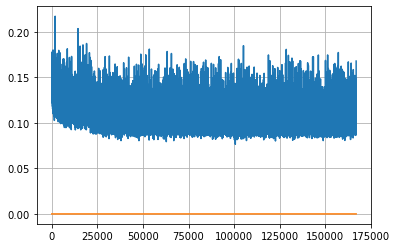

Epoch: 428, iteration 0, loss 0.08929970860481262, cov_diff 0.4046909378923462 cov_diff train 0.40463237609178326
Epoch: 428, iteration 1, loss 0.10268059372901917, cov_diff 0.39568792257084917 cov_diff train 0.3953409324471921
Epoch: 428, iteration 2, loss 0.09208294749259949, cov_diff 0.4091291245439701 cov_diff train 0.40900909789853784
Epoch: 428, iteration 3, loss 0.10925412178039551, cov_diff 0.41123455095705896 cov_diff train 0.4104139330485388
Epoch: 428, iteration 4, loss 0.09978914260864258, cov_diff 0.4057753754988143 cov_diff train 0.4038885009988824
Epoch: 428, iteration 5, loss 0.09321296215057373, cov_diff 0.4163998105975982 cov_diff train 0.41635378179156
Epoch: 428, iteration 6, loss 0.10893499851226807, cov_diff 0.40371943911937136 cov_diff train 0.4033242630629222
Epoch: 428, iteration 7, loss 0.09845742583274841, cov_diff 0.4093165824836865 cov_diff train 0.40986112093201515
Epoch: 428, iteration 8, loss 0.09970104694366455, cov_diff 0.4097696375644855 cov_diff trai

Epoch: 428, iteration 79, loss 0.11590993404388428, cov_diff 0.404495080969759 cov_diff train 0.40325705995070693
Epoch: 428, iteration 80, loss 0.10752889513969421, cov_diff 0.4028880113413992 cov_diff train 0.4025181188938667
Epoch: 428, iteration 81, loss 0.10914692282676697, cov_diff 0.4095676805069119 cov_diff train 0.4091281081607723
Epoch: 428, iteration 82, loss 0.10509920120239258, cov_diff 0.4248435028978599 cov_diff train 0.4241395099680163
Epoch: 428, iteration 83, loss 0.10615631937980652, cov_diff 0.4130366890840838 cov_diff train 0.410829196911211
Epoch: 428, iteration 84, loss 0.1020837128162384, cov_diff 0.4043241411946928 cov_diff train 0.40324181934795716
Epoch: 428, iteration 85, loss 0.1174863874912262, cov_diff 0.42579504482557695 cov_diff train 0.422990921048667
Epoch: 428, iteration 86, loss 0.09895026683807373, cov_diff 0.40055891905195373 cov_diff train 0.39944290984548175
Epoch: 428, iteration 87, loss 0.09303945302963257, cov_diff 0.4005666703173352 cov_diff

Epoch: 428, iteration 157, loss 0.10218217968940735, cov_diff 0.4101235638329493 cov_diff train 0.4096192754513918
Epoch: 428, iteration 158, loss 0.09984257817268372, cov_diff 0.42748493246982994 cov_diff train 0.42737066001856183
Epoch: 428, iteration 159, loss 0.10962989926338196, cov_diff 0.4232980431414857 cov_diff train 0.4234388779896007
Epoch: 428, iteration 160, loss 0.10691770911216736, cov_diff 0.4113638474224041 cov_diff train 0.4100262666320745
Epoch: 428, iteration 161, loss 0.11215066909790039, cov_diff 0.41408199447485006 cov_diff train 0.41248101295195544
Epoch: 428, iteration 162, loss 0.11763972043991089, cov_diff 0.41753588679405856 cov_diff train 0.41627386241414677
Epoch: 428, iteration 163, loss 0.0950290858745575, cov_diff 0.4038437261561532 cov_diff train 0.4033254279147895
Epoch: 428, iteration 164, loss 0.10294634103775024, cov_diff 0.4110854248806989 cov_diff train 0.41055161011443475
Epoch: 428, iteration 165, loss 0.10820555686950684, cov_diff 0.4043490554

Epoch: 428, iteration 235, loss 0.09376171231269836, cov_diff 0.4130158848640755 cov_diff train 0.41303535868247815
Epoch: 428, iteration 236, loss 0.1063913106918335, cov_diff 0.4091601131907527 cov_diff train 0.4088763376569294
Epoch: 428, iteration 237, loss 0.10458442568778992, cov_diff 0.4093380879167954 cov_diff train 0.40889962478985875
Epoch: 428, iteration 238, loss 0.09741637110710144, cov_diff 0.4120445548530997 cov_diff train 0.41201939493431544
Epoch: 428, iteration 239, loss 0.1053324043750763, cov_diff 0.40571289463460863 cov_diff train 0.40627715760195354
Epoch: 428, iteration 240, loss 0.097911536693573, cov_diff 0.41034057796705076 cov_diff train 0.4104762027394657
Epoch: 428, iteration 241, loss 0.10485085844993591, cov_diff 0.4139430123705188 cov_diff train 0.41420076638036785
Epoch: 428, iteration 242, loss 0.10925650596618652, cov_diff 0.40032271756730975 cov_diff train 0.399668270922977
Epoch: 428, iteration 243, loss 0.10897988080978394, cov_diff 0.4140748477891

Epoch: 428, iteration 312, loss 0.10407063364982605, cov_diff 0.40620276566948404 cov_diff train 0.4057484438934967
Epoch: 428, iteration 313, loss 0.0915437638759613, cov_diff 0.40944885183009727 cov_diff train 0.4081802807191131
Epoch: 428, iteration 314, loss 0.10286131501197815, cov_diff 0.40700446068973933 cov_diff train 0.4059246587476381
Epoch: 428, iteration 315, loss 0.10780090093612671, cov_diff 0.40567659677443507 cov_diff train 0.40525763480480653
Epoch: 428, iteration 316, loss 0.11100095510482788, cov_diff 0.39181519599054926 cov_diff train 0.3906142201553613
Epoch: 428, iteration 317, loss 0.1028590202331543, cov_diff 0.4107378740357728 cov_diff train 0.41078198457969767
Epoch: 428, iteration 318, loss 0.10045310854911804, cov_diff 0.4101676814536941 cov_diff train 0.41053106501968034
Epoch: 428, iteration 319, loss 0.09204766154289246, cov_diff 0.407961871143681 cov_diff train 0.40743347547636644
Epoch: 428, iteration 320, loss 0.0980423092842102, cov_diff 0.40842878627

Epoch: 428, iteration 389, loss 0.08957034349441528, cov_diff 0.4018597778780395 cov_diff train 0.4010157867772825
Epoch: 428, iteration 390, loss 0.15617692470550537, cov_diff 0.4436843690971546 cov_diff train 0.44257208370358847


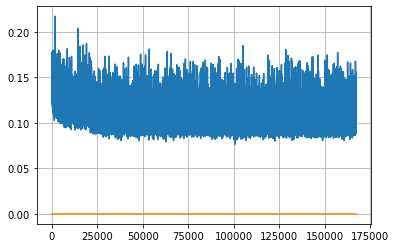

Epoch: 429, iteration 0, loss 0.09226533770561218, cov_diff 0.41163134078665947 cov_diff train 0.411102561979787
Epoch: 429, iteration 1, loss 0.1052154004573822, cov_diff 0.40523867697200117 cov_diff train 0.4049023318292709
Epoch: 429, iteration 2, loss 0.10592356324195862, cov_diff 0.41647211702877196 cov_diff train 0.4159426205132455
Epoch: 429, iteration 3, loss 0.11151650547981262, cov_diff 0.41903326070286046 cov_diff train 0.41846882729491053
Epoch: 429, iteration 4, loss 0.10673385858535767, cov_diff 0.4118685544023568 cov_diff train 0.41069464850958587
Epoch: 429, iteration 5, loss 0.0987413227558136, cov_diff 0.4192919210386501 cov_diff train 0.41800039172990583
Epoch: 429, iteration 6, loss 0.10451558232307434, cov_diff 0.4160466970840042 cov_diff train 0.4148717971314455
Epoch: 429, iteration 7, loss 0.1008729338645935, cov_diff 0.4156242148105405 cov_diff train 0.41510466118575495
Epoch: 429, iteration 8, loss 0.1073601245880127, cov_diff 0.4088711830166941 cov_diff train

Epoch: 429, iteration 75, loss 0.09325826168060303, cov_diff 0.4021767407369508 cov_diff train 0.4010120982127884
Epoch: 429, iteration 76, loss 0.09634819626808167, cov_diff 0.4145430232704936 cov_diff train 0.4139242467799536
Epoch: 429, iteration 77, loss 0.11025276780128479, cov_diff 0.40928196176742704 cov_diff train 0.4081933181430874
Epoch: 429, iteration 78, loss 0.0992765724658966, cov_diff 0.41887643274686015 cov_diff train 0.4180185057840972
Epoch: 429, iteration 79, loss 0.10227546095848083, cov_diff 0.4085495880965542 cov_diff train 0.40843427009415917
Epoch: 429, iteration 80, loss 0.11125507950782776, cov_diff 0.40863351090440225 cov_diff train 0.40795321685616864
Epoch: 429, iteration 81, loss 0.09045159816741943, cov_diff 0.4124622865092865 cov_diff train 0.41087209751240755
Epoch: 429, iteration 82, loss 0.1146358847618103, cov_diff 0.41322322372185377 cov_diff train 0.4125114113490349
Epoch: 429, iteration 83, loss 0.09834030270576477, cov_diff 0.4097634847661374 cov

Epoch: 429, iteration 156, loss 0.09562087059020996, cov_diff 0.40879668568443966 cov_diff train 0.4081906160507949
Epoch: 429, iteration 157, loss 0.08862590789794922, cov_diff 0.41566819382433 cov_diff train 0.41541312139290854
Epoch: 429, iteration 158, loss 0.11079707741737366, cov_diff 0.4001660752056062 cov_diff train 0.3988981451899865
Epoch: 429, iteration 159, loss 0.10416927933692932, cov_diff 0.40735497223140293 cov_diff train 0.4059492465314445
Epoch: 429, iteration 160, loss 0.10034459829330444, cov_diff 0.40905943478277684 cov_diff train 0.4087937186222684
Epoch: 429, iteration 161, loss 0.11292114853858948, cov_diff 0.40249939723395706 cov_diff train 0.40168191857887386
Epoch: 429, iteration 162, loss 0.09449717402458191, cov_diff 0.40315713959914445 cov_diff train 0.4029692897439232
Epoch: 429, iteration 163, loss 0.11018761992454529, cov_diff 0.4122886576687924 cov_diff train 0.4126067914405644
Epoch: 429, iteration 164, loss 0.09346911311149597, cov_diff 0.41064717361

Epoch: 429, iteration 233, loss 0.11214005947113037, cov_diff 0.41424249377503597 cov_diff train 0.41369329414629996
Epoch: 429, iteration 234, loss 0.10651999711990356, cov_diff 0.4039661680653293 cov_diff train 0.40342861234598465
Epoch: 429, iteration 235, loss 0.10691830515861511, cov_diff 0.40711250137897403 cov_diff train 0.40558129806762827
Epoch: 429, iteration 236, loss 0.09840509295463562, cov_diff 0.410845587913321 cov_diff train 0.4103976085523298
Epoch: 429, iteration 237, loss 0.09819939732551575, cov_diff 0.4184943087958146 cov_diff train 0.41835908786937126
Epoch: 429, iteration 238, loss 0.10224157571792603, cov_diff 0.402024148786363 cov_diff train 0.40135206748062874
Epoch: 429, iteration 239, loss 0.09613484144210815, cov_diff 0.41796811082820723 cov_diff train 0.41715409710554724
Epoch: 429, iteration 240, loss 0.0954553484916687, cov_diff 0.40745594605388935 cov_diff train 0.4070753711705001
Epoch: 429, iteration 241, loss 0.1161172091960907, cov_diff 0.4100246845

Epoch: 429, iteration 309, loss 0.11246383190155029, cov_diff 0.4131340920004291 cov_diff train 0.41232358792906226
Epoch: 429, iteration 310, loss 0.11177018284797668, cov_diff 0.4164089749076444 cov_diff train 0.4153378220540915
Epoch: 429, iteration 311, loss 0.10856488347053528, cov_diff 0.4123961031237391 cov_diff train 0.41198207779446444
Epoch: 429, iteration 312, loss 0.10876566171646118, cov_diff 0.4121642662502187 cov_diff train 0.4112994456253176
Epoch: 429, iteration 313, loss 0.09952756762504578, cov_diff 0.4078633274076263 cov_diff train 0.4046984045278005
Epoch: 429, iteration 314, loss 0.10043057799339294, cov_diff 0.42191799595874413 cov_diff train 0.4211220205466462
Epoch: 429, iteration 315, loss 0.11092039942741394, cov_diff 0.40567582050793033 cov_diff train 0.4037895066747573
Epoch: 429, iteration 316, loss 0.101788729429245, cov_diff 0.4065948119440723 cov_diff train 0.40476232385174454
Epoch: 429, iteration 317, loss 0.09599566459655762, cov_diff 0.4096881684183

Epoch: 429, iteration 386, loss 0.10613816976547241, cov_diff 0.4034393760971411 cov_diff train 0.40317457387308153
Epoch: 429, iteration 387, loss 0.10334375500679016, cov_diff 0.39996406307705323 cov_diff train 0.3990825036487417
Epoch: 429, iteration 388, loss 0.10382503271102905, cov_diff 0.4163401710805331 cov_diff train 0.41598319486865826
Epoch: 429, iteration 389, loss 0.10415121912956238, cov_diff 0.41186558101879367 cov_diff train 0.4116325361202565
Epoch: 429, iteration 390, loss 0.15060147643089294, cov_diff 0.46122333369728935 cov_diff train 0.4603142195640091


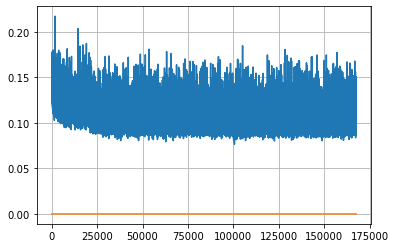

Epoch: 430, iteration 0, loss 0.09832221269607544, cov_diff 0.41479250296653203 cov_diff train 0.41407226145861
Epoch: 430, iteration 1, loss 0.09321659803390503, cov_diff 0.4000628127013433 cov_diff train 0.40011985121839716
Epoch: 430, iteration 2, loss 0.10007026791572571, cov_diff 0.4117947389627975 cov_diff train 0.4100370145675569
Epoch: 430, iteration 3, loss 0.10736504197120667, cov_diff 0.4181491129072791 cov_diff train 0.4173379259107607
Epoch: 430, iteration 4, loss 0.10334634780883789, cov_diff 0.41746786704532124 cov_diff train 0.4171171810885332
Epoch: 430, iteration 5, loss 0.11009097099304199, cov_diff 0.3996134028239546 cov_diff train 0.3985524198853138
Epoch: 430, iteration 6, loss 0.09677723050117493, cov_diff 0.4194946208643418 cov_diff train 0.41861272490506013
Epoch: 430, iteration 7, loss 0.09539756178855896, cov_diff 0.4057991891314423 cov_diff train 0.40419539748573624
Epoch: 430, iteration 8, loss 0.10574197769165039, cov_diff 0.40885386821862796 cov_diff trai

Epoch: 430, iteration 77, loss 0.10433045029640198, cov_diff 0.4111989610179035 cov_diff train 0.41172441831405476
Epoch: 430, iteration 78, loss 0.0869658887386322, cov_diff 0.3837347322862199 cov_diff train 0.3835619471128239
Epoch: 430, iteration 79, loss 0.11202824115753174, cov_diff 0.41306909471788 cov_diff train 0.4131141748224716
Epoch: 430, iteration 80, loss 0.09888410568237305, cov_diff 0.40308004525716296 cov_diff train 0.4032891427923839
Epoch: 430, iteration 81, loss 0.10221898555755615, cov_diff 0.3996790961538691 cov_diff train 0.3993569486165557
Epoch: 430, iteration 82, loss 0.1030726432800293, cov_diff 0.4109378364684161 cov_diff train 0.41040108233594413
Epoch: 430, iteration 83, loss 0.10032916069030762, cov_diff 0.41199507387861384 cov_diff train 0.4116000552440257
Epoch: 430, iteration 84, loss 0.10381391644477844, cov_diff 0.4181297981393839 cov_diff train 0.41743549568377514
Epoch: 430, iteration 85, loss 0.09585365653038025, cov_diff 0.4186153850647081 cov_dif

Epoch: 430, iteration 156, loss 0.112525075674057, cov_diff 0.40856336739827365 cov_diff train 0.40820415554833
Epoch: 430, iteration 157, loss 0.10709595680236816, cov_diff 0.4054186552998937 cov_diff train 0.4056698062201872
Epoch: 430, iteration 158, loss 0.10828429460525513, cov_diff 0.39962835781601513 cov_diff train 0.3990974724405594
Epoch: 430, iteration 159, loss 0.1009148359298706, cov_diff 0.4085839831128198 cov_diff train 0.4074446434139875
Epoch: 430, iteration 160, loss 0.104961097240448, cov_diff 0.40990831383239285 cov_diff train 0.4086722365639991
Epoch: 430, iteration 161, loss 0.10401034355163574, cov_diff 0.4043571055305202 cov_diff train 0.403077403034517
Epoch: 430, iteration 162, loss 0.09440132975578308, cov_diff 0.4136260427929522 cov_diff train 0.41283709637615307
Epoch: 430, iteration 163, loss 0.11893239617347717, cov_diff 0.40743369965229176 cov_diff train 0.40658739464875615
Epoch: 430, iteration 164, loss 0.10308772325515747, cov_diff 0.41575172377726455 

Epoch: 430, iteration 234, loss 0.09639036655426025, cov_diff 0.4105160126216034 cov_diff train 0.4102101758954265
Epoch: 430, iteration 235, loss 0.11024734377861023, cov_diff 0.410108313376743 cov_diff train 0.40893921045441295
Epoch: 430, iteration 236, loss 0.09693053364753723, cov_diff 0.4032690762475346 cov_diff train 0.4034090504092566
Epoch: 430, iteration 237, loss 0.09515979886054993, cov_diff 0.4048474447756676 cov_diff train 0.4039267216360431
Epoch: 430, iteration 238, loss 0.10759496688842773, cov_diff 0.4195608234018749 cov_diff train 0.4185069065043746
Epoch: 430, iteration 239, loss 0.10043984651565552, cov_diff 0.40936332771061834 cov_diff train 0.408799527693326
Epoch: 430, iteration 240, loss 0.10476729273796082, cov_diff 0.40407997119258554 cov_diff train 0.4035345969946488
Epoch: 430, iteration 241, loss 0.10830318927764893, cov_diff 0.42576840086044704 cov_diff train 0.4245232965938197
Epoch: 430, iteration 242, loss 0.09714534878730774, cov_diff 0.40733322974119

Epoch: 430, iteration 311, loss 0.09776699542999268, cov_diff 0.41930422733357825 cov_diff train 0.4187670644359112
Epoch: 430, iteration 312, loss 0.09597828984260559, cov_diff 0.41250004319672534 cov_diff train 0.4117518267740998
Epoch: 430, iteration 313, loss 0.10310325026512146, cov_diff 0.40936844707054176 cov_diff train 0.40862126097221074
Epoch: 430, iteration 314, loss 0.09858497977256775, cov_diff 0.40161524032610424 cov_diff train 0.4005874185663366
Epoch: 430, iteration 315, loss 0.1045781672000885, cov_diff 0.42620291904497715 cov_diff train 0.4260313856242091
Epoch: 430, iteration 316, loss 0.10970592498779297, cov_diff 0.4107506398832951 cov_diff train 0.41061039845730196
Epoch: 430, iteration 317, loss 0.10826954245567322, cov_diff 0.418790717175269 cov_diff train 0.418894204477785
Epoch: 430, iteration 318, loss 0.11180436611175537, cov_diff 0.4050864649986956 cov_diff train 0.40405962239664633
Epoch: 430, iteration 319, loss 0.10525336861610413, cov_diff 0.39650711037

Epoch: 430, iteration 388, loss 0.11107221245765686, cov_diff 0.40182111734876036 cov_diff train 0.4005234297409041
Epoch: 430, iteration 389, loss 0.10535639524459839, cov_diff 0.4061057723047964 cov_diff train 0.406804183986298
Epoch: 430, iteration 390, loss 0.13471919298171997, cov_diff 0.458653339940407 cov_diff train 0.4589569180655965


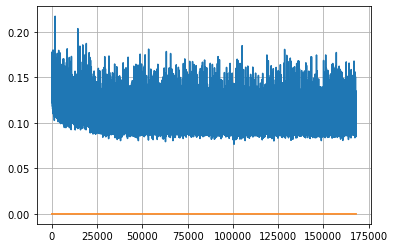

Epoch: 431, iteration 0, loss 0.11549422144889832, cov_diff 0.42050020002052096 cov_diff train 0.41958255670433275
Epoch: 431, iteration 1, loss 0.10424414277076721, cov_diff 0.4108543018472906 cov_diff train 0.41102500893937544
Epoch: 431, iteration 2, loss 0.10156318545341492, cov_diff 0.4139425432446206 cov_diff train 0.41362522425161924
Epoch: 431, iteration 3, loss 0.1055382490158081, cov_diff 0.3995305879092678 cov_diff train 0.39911595405457284
Epoch: 431, iteration 4, loss 0.11314865946769714, cov_diff 0.41449122198984406 cov_diff train 0.41338296412864545
Epoch: 431, iteration 5, loss 0.09653738141059875, cov_diff 0.4151387547916113 cov_diff train 0.4150766227593324
Epoch: 431, iteration 6, loss 0.10551038384437561, cov_diff 0.41530160285466106 cov_diff train 0.4150625767680448
Epoch: 431, iteration 7, loss 0.09828326106071472, cov_diff 0.4150916338611312 cov_diff train 0.41421636049486876
Epoch: 431, iteration 8, loss 0.10585454106330872, cov_diff 0.4156284874508928 cov_diff 

Epoch: 431, iteration 79, loss 0.10433506965637207, cov_diff 0.41553955362380235 cov_diff train 0.4148790831889724
Epoch: 431, iteration 80, loss 0.10661375522613525, cov_diff 0.40564495866241274 cov_diff train 0.40464617664529257
Epoch: 431, iteration 81, loss 0.10925993323326111, cov_diff 0.4062997234131133 cov_diff train 0.4061269775684737
Epoch: 431, iteration 82, loss 0.09703242778778076, cov_diff 0.40081554418462084 cov_diff train 0.40026692326204794
Epoch: 431, iteration 83, loss 0.11142086982727051, cov_diff 0.418960377071312 cov_diff train 0.41740740469860904
Epoch: 431, iteration 84, loss 0.1010105311870575, cov_diff 0.4007938492000026 cov_diff train 0.4001785638354213
Epoch: 431, iteration 85, loss 0.10419031977653503, cov_diff 0.41123769043125014 cov_diff train 0.41024925008928714
Epoch: 431, iteration 86, loss 0.11112132668495178, cov_diff 0.409933948312397 cov_diff train 0.4073807594093015
Epoch: 431, iteration 87, loss 0.10485398769378662, cov_diff 0.4096154657405074 cov

Epoch: 431, iteration 156, loss 0.11144578456878662, cov_diff 0.39953188978261545 cov_diff train 0.39960935420162436
Epoch: 431, iteration 157, loss 0.10168606042861938, cov_diff 0.42068738163194186 cov_diff train 0.42023439874976165
Epoch: 431, iteration 158, loss 0.10891139507293701, cov_diff 0.4089601226315541 cov_diff train 0.4087643775246738
Epoch: 431, iteration 159, loss 0.10441803932189941, cov_diff 0.41713098259286835 cov_diff train 0.4163526583308842
Epoch: 431, iteration 160, loss 0.09459137916564941, cov_diff 0.3995222380014302 cov_diff train 0.3983780657784061
Epoch: 431, iteration 161, loss 0.1051560640335083, cov_diff 0.4154256671196833 cov_diff train 0.41512896066807836
Epoch: 431, iteration 162, loss 0.10341736674308777, cov_diff 0.40430864325004795 cov_diff train 0.4039863792927051
Epoch: 431, iteration 163, loss 0.11542987823486328, cov_diff 0.394144672029076 cov_diff train 0.3940633970580962
Epoch: 431, iteration 164, loss 0.09969872236251831, cov_diff 0.39524161416

Epoch: 431, iteration 236, loss 0.09657928347587585, cov_diff 0.40099970591918166 cov_diff train 0.40108945132843454
Epoch: 431, iteration 237, loss 0.09982249140739441, cov_diff 0.41495931019632026 cov_diff train 0.41464255935895916
Epoch: 431, iteration 238, loss 0.10713493824005127, cov_diff 0.4192896058242961 cov_diff train 0.4187792357493226
Epoch: 431, iteration 239, loss 0.09855541586875916, cov_diff 0.41177866386237555 cov_diff train 0.41126210613455866
Epoch: 431, iteration 240, loss 0.09920331835746765, cov_diff 0.4094005164304094 cov_diff train 0.40854737799490765
Epoch: 431, iteration 241, loss 0.11348849534988403, cov_diff 0.4225597078810052 cov_diff train 0.42179179541515677
Epoch: 431, iteration 242, loss 0.10880213975906372, cov_diff 0.39599533850296204 cov_diff train 0.39523282274753996
Epoch: 431, iteration 243, loss 0.10749125480651855, cov_diff 0.4185428624104729 cov_diff train 0.4182513564446697
Epoch: 431, iteration 244, loss 0.1079079806804657, cov_diff 0.4153008

Epoch: 431, iteration 312, loss 0.10730090737342834, cov_diff 0.39651303983632114 cov_diff train 0.39439897580188427
Epoch: 431, iteration 313, loss 0.1109696626663208, cov_diff 0.4034922232515009 cov_diff train 0.40230499939460046
Epoch: 431, iteration 314, loss 0.10439160466194153, cov_diff 0.41083338666946717 cov_diff train 0.41022247137888757
Epoch: 431, iteration 315, loss 0.10590463876724243, cov_diff 0.3996569271964456 cov_diff train 0.39950571866723456
Epoch: 431, iteration 316, loss 0.09896230697631836, cov_diff 0.39689750298929877 cov_diff train 0.3961774709278312
Epoch: 431, iteration 317, loss 0.10513132810592651, cov_diff 0.40765820737002467 cov_diff train 0.4071565530488958
Epoch: 431, iteration 318, loss 0.09814321994781494, cov_diff 0.4051145538739363 cov_diff train 0.4048220378712601
Epoch: 431, iteration 319, loss 0.09938257932662964, cov_diff 0.4024941988014152 cov_diff train 0.40218027221247876
Epoch: 431, iteration 320, loss 0.09900492429733276, cov_diff 0.40194477

Epoch: 431, iteration 390, loss 0.14963984489440918, cov_diff 0.4527605712995537 cov_diff train 0.4517044711101242


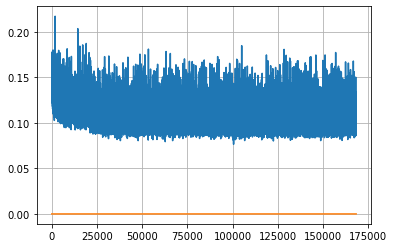

Epoch: 432, iteration 0, loss 0.11621031165122986, cov_diff 0.41480046046062397 cov_diff train 0.41492005341430105
Epoch: 432, iteration 1, loss 0.10657334327697754, cov_diff 0.40650756758612 cov_diff train 0.40648311380052415
Epoch: 432, iteration 2, loss 0.1135481595993042, cov_diff 0.3976187259602718 cov_diff train 0.3970462907058856
Epoch: 432, iteration 3, loss 0.10441052913665771, cov_diff 0.4180193556548227 cov_diff train 0.417015160912024
Epoch: 432, iteration 4, loss 0.11710888147354126, cov_diff 0.4207534427709917 cov_diff train 0.420337398121694
Epoch: 432, iteration 5, loss 0.10142043232917786, cov_diff 0.4014986820962176 cov_diff train 0.40093194713551394
Epoch: 432, iteration 6, loss 0.10318738222122192, cov_diff 0.41170302729484315 cov_diff train 0.41088793013886354
Epoch: 432, iteration 7, loss 0.09769308567047119, cov_diff 0.4161369794163746 cov_diff train 0.4161722893221424
Epoch: 432, iteration 8, loss 0.09210476279258728, cov_diff 0.3963288798742959 cov_diff train 0

Epoch: 432, iteration 76, loss 0.10942772030830383, cov_diff 0.40876515111231676 cov_diff train 0.4074149389542907
Epoch: 432, iteration 77, loss 0.0981607735157013, cov_diff 0.4146551450694779 cov_diff train 0.41404359809024094
Epoch: 432, iteration 78, loss 0.09045296907424927, cov_diff 0.3984704915490001 cov_diff train 0.39728198632855816
Epoch: 432, iteration 79, loss 0.09807932376861572, cov_diff 0.40569741360683964 cov_diff train 0.404861039212831
Epoch: 432, iteration 80, loss 0.09622237086296082, cov_diff 0.3958702661688249 cov_diff train 0.3951270502787212
Epoch: 432, iteration 81, loss 0.10315349698066711, cov_diff 0.41022557832268153 cov_diff train 0.41008422974128994
Epoch: 432, iteration 82, loss 0.09864005446434021, cov_diff 0.41129013820738386 cov_diff train 0.4102184543522074
Epoch: 432, iteration 83, loss 0.10073569416999817, cov_diff 0.3980823471452651 cov_diff train 0.39794411881333464
Epoch: 432, iteration 84, loss 0.10615715384483337, cov_diff 0.405786237507981 cov

Epoch: 432, iteration 153, loss 0.10395503044128418, cov_diff 0.4130384420163998 cov_diff train 0.41262703082437047
Epoch: 432, iteration 154, loss 0.11160844564437866, cov_diff 0.40559435470830324 cov_diff train 0.40542827718959124
Epoch: 432, iteration 155, loss 0.08961918950080872, cov_diff 0.4089783614474691 cov_diff train 0.40855085621364
Epoch: 432, iteration 156, loss 0.0949130654335022, cov_diff 0.40002234603748543 cov_diff train 0.3997616560708431
Epoch: 432, iteration 157, loss 0.10776305198669434, cov_diff 0.40816575294709484 cov_diff train 0.4078504595103318
Epoch: 432, iteration 158, loss 0.10199642181396484, cov_diff 0.41780214268314453 cov_diff train 0.4166592710546323
Epoch: 432, iteration 159, loss 0.10635027289390564, cov_diff 0.40406669335438533 cov_diff train 0.40312639825507673
Epoch: 432, iteration 160, loss 0.1130143404006958, cov_diff 0.417058039946727 cov_diff train 0.41689150618902565
Epoch: 432, iteration 161, loss 0.10385698080062866, cov_diff 0.411190178969

Epoch: 432, iteration 226, loss 0.10163167119026184, cov_diff 0.4119099512648674 cov_diff train 0.4118744292348603
Epoch: 432, iteration 227, loss 0.10439065098762512, cov_diff 0.4139006734362016 cov_diff train 0.4134722963883593
Epoch: 432, iteration 228, loss 0.0919455885887146, cov_diff 0.41019726691722647 cov_diff train 0.40938117122314344
Epoch: 432, iteration 229, loss 0.09528553485870361, cov_diff 0.39939366978927027 cov_diff train 0.39839787969770907
Epoch: 432, iteration 230, loss 0.11879312992095947, cov_diff 0.41567712471938906 cov_diff train 0.4149354634307032
Epoch: 432, iteration 231, loss 0.10113850235939026, cov_diff 0.405528243718459 cov_diff train 0.40524989919094
Epoch: 432, iteration 232, loss 0.10098022222518921, cov_diff 0.4052515418009359 cov_diff train 0.4039550302237224
Epoch: 432, iteration 233, loss 0.107799232006073, cov_diff 0.40983668160328995 cov_diff train 0.4089327330091663
Epoch: 432, iteration 234, loss 0.09790027141571045, cov_diff 0.3941648362280273

Epoch: 432, iteration 305, loss 0.09712877869606018, cov_diff 0.41525840700744626 cov_diff train 0.414756822724269
Epoch: 432, iteration 306, loss 0.11454719305038452, cov_diff 0.4071731230343658 cov_diff train 0.4064279281220724
Epoch: 432, iteration 307, loss 0.0991831123828888, cov_diff 0.4040598663568927 cov_diff train 0.40366881271315136
Epoch: 432, iteration 308, loss 0.10440507531166077, cov_diff 0.41575032450036814 cov_diff train 0.41442319085902674
Epoch: 432, iteration 309, loss 0.1072784960269928, cov_diff 0.3852726966136937 cov_diff train 0.38457395693551694
Epoch: 432, iteration 310, loss 0.10839912295341492, cov_diff 0.403062506925347 cov_diff train 0.4012073432801326
Epoch: 432, iteration 311, loss 0.10526591539382935, cov_diff 0.4060741940555829 cov_diff train 0.40470255702996516
Epoch: 432, iteration 312, loss 0.10668420791625977, cov_diff 0.41947993964255376 cov_diff train 0.4180449243420679
Epoch: 432, iteration 313, loss 0.09295552968978882, cov_diff 0.4137309735244

Epoch: 432, iteration 382, loss 0.09831959009170532, cov_diff 0.41760632942953174 cov_diff train 0.41663618810772074
Epoch: 432, iteration 383, loss 0.10525381565093994, cov_diff 0.39804164096331407 cov_diff train 0.39730880697080573
Epoch: 432, iteration 384, loss 0.09575861692428589, cov_diff 0.422607539198254 cov_diff train 0.42245082965202496
Epoch: 432, iteration 385, loss 0.10550382733345032, cov_diff 0.39899959410074864 cov_diff train 0.39861906142031356
Epoch: 432, iteration 386, loss 0.0936538577079773, cov_diff 0.40574041701235913 cov_diff train 0.40561977449137016
Epoch: 432, iteration 387, loss 0.10768556594848633, cov_diff 0.41883347697123147 cov_diff train 0.4193224442643217
Epoch: 432, iteration 388, loss 0.12676936388015747, cov_diff 0.41359418559572025 cov_diff train 0.41317916796565163
Epoch: 432, iteration 389, loss 0.10374918580055237, cov_diff 0.39297643639599084 cov_diff train 0.3926405455472103
Epoch: 432, iteration 390, loss 0.158917635679245, cov_diff 0.4424395

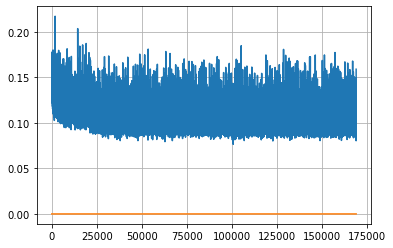

Epoch: 433, iteration 0, loss 0.1007937490940094, cov_diff 0.41895035638471534 cov_diff train 0.41915040164172135
Epoch: 433, iteration 1, loss 0.11099261045455933, cov_diff 0.4086462446055427 cov_diff train 0.4089706171198756
Epoch: 433, iteration 2, loss 0.10753419995307922, cov_diff 0.41057694966933717 cov_diff train 0.4105434264827329
Epoch: 433, iteration 3, loss 0.10492005944252014, cov_diff 0.4138781472955873 cov_diff train 0.4136145109111381
Epoch: 433, iteration 4, loss 0.10566356778144836, cov_diff 0.4246253740303976 cov_diff train 0.42327826558447773
Epoch: 433, iteration 5, loss 0.10456639528274536, cov_diff 0.4217292860452734 cov_diff train 0.419889191612806
Epoch: 433, iteration 6, loss 0.11078879237174988, cov_diff 0.4310748989408952 cov_diff train 0.42972070591873734
Epoch: 433, iteration 7, loss 0.10101780295372009, cov_diff 0.41560755304583585 cov_diff train 0.4136093074166164
Epoch: 433, iteration 8, loss 0.1051984429359436, cov_diff 0.4162147232898112 cov_diff train

Epoch: 433, iteration 78, loss 0.11333772540092468, cov_diff 0.40149766175152596 cov_diff train 0.4015064923744369
Epoch: 433, iteration 79, loss 0.11128771305084229, cov_diff 0.4112038926681276 cov_diff train 0.41102068256024915
Epoch: 433, iteration 80, loss 0.09941938519477844, cov_diff 0.41983160451436347 cov_diff train 0.41962107425803274
Epoch: 433, iteration 81, loss 0.11820846796035767, cov_diff 0.4303432122301527 cov_diff train 0.42874777766805844
Epoch: 433, iteration 82, loss 0.10889557003974915, cov_diff 0.4184680683256723 cov_diff train 0.4174440339595404
Epoch: 433, iteration 83, loss 0.09855926036834717, cov_diff 0.40041898531152453 cov_diff train 0.39931808470718694
Epoch: 433, iteration 84, loss 0.10450610518455505, cov_diff 0.4185472652396382 cov_diff train 0.41772831085650375
Epoch: 433, iteration 85, loss 0.0964246392250061, cov_diff 0.411275052232516 cov_diff train 0.4104997799175041
Epoch: 433, iteration 86, loss 0.10409602522850037, cov_diff 0.40679149936738024 c

Epoch: 433, iteration 155, loss 0.10351136326789856, cov_diff 0.417610331559022 cov_diff train 0.4167867873679724
Epoch: 433, iteration 156, loss 0.09651714563369751, cov_diff 0.4074380061315727 cov_diff train 0.4064139062301228
Epoch: 433, iteration 157, loss 0.10115501284599304, cov_diff 0.4072872303754268 cov_diff train 0.40657698057098707
Epoch: 433, iteration 158, loss 0.10091620683670044, cov_diff 0.42191459875212156 cov_diff train 0.42099599810802923
Epoch: 433, iteration 159, loss 0.10191276669502258, cov_diff 0.41283727928673714 cov_diff train 0.41248568357200555
Epoch: 433, iteration 160, loss 0.09693345427513123, cov_diff 0.406443747165797 cov_diff train 0.4058878142272057
Epoch: 433, iteration 161, loss 0.10907763242721558, cov_diff 0.403983160293787 cov_diff train 0.4029206994568616
Epoch: 433, iteration 162, loss 0.10437339544296265, cov_diff 0.40633023912642613 cov_diff train 0.40518134698365865
Epoch: 433, iteration 163, loss 0.10992053151130676, cov_diff 0.412659408811

Epoch: 433, iteration 233, loss 0.09758684039115906, cov_diff 0.4100915880078547 cov_diff train 0.408853588171127
Epoch: 433, iteration 234, loss 0.09623363614082336, cov_diff 0.4122062772820311 cov_diff train 0.41176812208146124
Epoch: 433, iteration 235, loss 0.10103726387023926, cov_diff 0.4142868375962723 cov_diff train 0.4143922454719371
Epoch: 433, iteration 236, loss 0.09705796837806702, cov_diff 0.41677323250424503 cov_diff train 0.41678039275429585
Epoch: 433, iteration 237, loss 0.1060531735420227, cov_diff 0.4151125810913631 cov_diff train 0.41474121519447316
Epoch: 433, iteration 238, loss 0.0992053747177124, cov_diff 0.40363961337323034 cov_diff train 0.4036748735721504
Epoch: 433, iteration 239, loss 0.0901964008808136, cov_diff 0.40809040367732163 cov_diff train 0.4079077246281452
Epoch: 433, iteration 240, loss 0.10268688201904297, cov_diff 0.4167315390756638 cov_diff train 0.41562145521070054
Epoch: 433, iteration 241, loss 0.10063132643699646, cov_diff 0.4063283976441

Epoch: 433, iteration 310, loss 0.09902140498161316, cov_diff 0.4137607135382364 cov_diff train 0.41288449102339897
Epoch: 433, iteration 311, loss 0.10809341073036194, cov_diff 0.4155858527220002 cov_diff train 0.4144997442125313
Epoch: 433, iteration 312, loss 0.11915892362594604, cov_diff 0.420625111512382 cov_diff train 0.4200495906149411
Epoch: 433, iteration 313, loss 0.10220631957054138, cov_diff 0.41261698247882195 cov_diff train 0.4127410893379201
Epoch: 433, iteration 314, loss 0.10475751757621765, cov_diff 0.4077914282374307 cov_diff train 0.40755682134767773
Epoch: 433, iteration 315, loss 0.10517299175262451, cov_diff 0.398195169889303 cov_diff train 0.39827035368322955
Epoch: 433, iteration 316, loss 0.1070530116558075, cov_diff 0.4102171849670302 cov_diff train 0.4099712594554809
Epoch: 433, iteration 317, loss 0.10137128829956055, cov_diff 0.4122086959232246 cov_diff train 0.41064199049913896
Epoch: 433, iteration 318, loss 0.10055428743362427, cov_diff 0.40766848640520

Epoch: 433, iteration 383, loss 0.1052599549293518, cov_diff 0.4197400712772337 cov_diff train 0.4199068210936403
Epoch: 433, iteration 384, loss 0.10780254006385803, cov_diff 0.39672976075594246 cov_diff train 0.39563988056727734
Epoch: 433, iteration 385, loss 0.1075950562953949, cov_diff 0.4238509616934143 cov_diff train 0.42387197907405855
Epoch: 433, iteration 386, loss 0.0949561595916748, cov_diff 0.39876646450946146 cov_diff train 0.3989000137773503
Epoch: 433, iteration 387, loss 0.11020159721374512, cov_diff 0.42893449687469576 cov_diff train 0.42814584058141114
Epoch: 433, iteration 388, loss 0.11065268516540527, cov_diff 0.41640044329038906 cov_diff train 0.4162693498487398
Epoch: 433, iteration 389, loss 0.09811761975288391, cov_diff 0.4131132674021328 cov_diff train 0.4122587939437297
Epoch: 433, iteration 390, loss 0.15584436058998108, cov_diff 0.4428463485732801 cov_diff train 0.4422752819872633


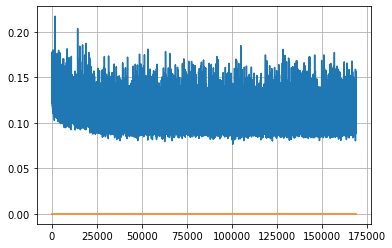

Epoch: 434, iteration 0, loss 0.0893535315990448, cov_diff 0.4140095075318128 cov_diff train 0.41378207354889596
Epoch: 434, iteration 1, loss 0.10202351212501526, cov_diff 0.4087316698592624 cov_diff train 0.4082549021005537
Epoch: 434, iteration 2, loss 0.091581791639328, cov_diff 0.4316746292877656 cov_diff train 0.4308901466872401
Epoch: 434, iteration 3, loss 0.107718825340271, cov_diff 0.40760470665504495 cov_diff train 0.40671459046813635
Epoch: 434, iteration 4, loss 0.08929115533828735, cov_diff 0.40682016640332375 cov_diff train 0.40578173904966836
Epoch: 434, iteration 5, loss 0.10238480567932129, cov_diff 0.4146363048779116 cov_diff train 0.4138711822817814
Epoch: 434, iteration 6, loss 0.11135801672935486, cov_diff 0.4005007326486345 cov_diff train 0.3988480280069385
Epoch: 434, iteration 7, loss 0.10985890030860901, cov_diff 0.4195707543333199 cov_diff train 0.4197724388250138
Epoch: 434, iteration 8, loss 0.10924577713012695, cov_diff 0.4073785663623415 cov_diff train 0.

Epoch: 434, iteration 77, loss 0.10664039850234985, cov_diff 0.4154359827011578 cov_diff train 0.41542535143527615
Epoch: 434, iteration 78, loss 0.10409772396087646, cov_diff 0.4169871924475546 cov_diff train 0.4170372635556714
Epoch: 434, iteration 79, loss 0.09826773405075073, cov_diff 0.4004500326335754 cov_diff train 0.39913115894991774
Epoch: 434, iteration 80, loss 0.11224803328514099, cov_diff 0.41071642323519286 cov_diff train 0.41060077797593714
Epoch: 434, iteration 81, loss 0.1086253821849823, cov_diff 0.4185680849218199 cov_diff train 0.4182376908729336
Epoch: 434, iteration 82, loss 0.10337170958518982, cov_diff 0.413770782148785 cov_diff train 0.4139891728417462
Epoch: 434, iteration 83, loss 0.1198430061340332, cov_diff 0.41898326077803066 cov_diff train 0.4190286091565789
Epoch: 434, iteration 84, loss 0.11038851737976074, cov_diff 0.40042295677666584 cov_diff train 0.4007690571272391
Epoch: 434, iteration 85, loss 0.1064838171005249, cov_diff 0.4159859564386395 cov_di

Epoch: 434, iteration 154, loss 0.11953169107437134, cov_diff 0.4124447896698611 cov_diff train 0.4130603301392047
Epoch: 434, iteration 155, loss 0.09945636987686157, cov_diff 0.42156102880575846 cov_diff train 0.4205921630975499
Epoch: 434, iteration 156, loss 0.1103038489818573, cov_diff 0.43305229686848085 cov_diff train 0.4328396270557807
Epoch: 434, iteration 157, loss 0.12204483151435852, cov_diff 0.4264625961746965 cov_diff train 0.4249198901731301
Epoch: 434, iteration 158, loss 0.09892982244491577, cov_diff 0.4103178523935586 cov_diff train 0.40930822230730224
Epoch: 434, iteration 159, loss 0.11046266555786133, cov_diff 0.4169591311674129 cov_diff train 0.4149366891706342
Epoch: 434, iteration 160, loss 0.09947839379310608, cov_diff 0.41764493431987015 cov_diff train 0.4173108144499086
Epoch: 434, iteration 161, loss 0.09251195192337036, cov_diff 0.4023201738992481 cov_diff train 0.4012263503680766
Epoch: 434, iteration 162, loss 0.09011760354042053, cov_diff 0.4075203700365

Epoch: 434, iteration 233, loss 0.10066547989845276, cov_diff 0.4148808008544929 cov_diff train 0.414125404586937
Epoch: 434, iteration 234, loss 0.09642398357391357, cov_diff 0.4129564863954265 cov_diff train 0.4128600144816021
Epoch: 434, iteration 235, loss 0.10731691122055054, cov_diff 0.4040327752065461 cov_diff train 0.40325759554976714
Epoch: 434, iteration 236, loss 0.09340831637382507, cov_diff 0.39093202639471786 cov_diff train 0.38976033639895047
Epoch: 434, iteration 237, loss 0.10991251468658447, cov_diff 0.42081735774667134 cov_diff train 0.42001792519561737
Epoch: 434, iteration 238, loss 0.10457387566566467, cov_diff 0.40935942160509986 cov_diff train 0.4084200028069489
Epoch: 434, iteration 239, loss 0.10842069983482361, cov_diff 0.4143108143435025 cov_diff train 0.41370386786211477
Epoch: 434, iteration 240, loss 0.10191121697425842, cov_diff 0.4087848737782117 cov_diff train 0.40759622748526214
Epoch: 434, iteration 241, loss 0.11133944988250732, cov_diff 0.394687604

Epoch: 434, iteration 310, loss 0.0950937569141388, cov_diff 0.39968992621485233 cov_diff train 0.3995107214762139
Epoch: 434, iteration 311, loss 0.10813760757446289, cov_diff 0.406672768724558 cov_diff train 0.40558226821076493
Epoch: 434, iteration 312, loss 0.11337080597877502, cov_diff 0.4149462949561034 cov_diff train 0.414455176282523
Epoch: 434, iteration 313, loss 0.10047021508216858, cov_diff 0.4200227645871568 cov_diff train 0.41905610773371216
Epoch: 434, iteration 314, loss 0.09835094213485718, cov_diff 0.4161807459602256 cov_diff train 0.4156071496209325
Epoch: 434, iteration 315, loss 0.10415127873420715, cov_diff 0.4114630499326467 cov_diff train 0.4109452165286708
Epoch: 434, iteration 316, loss 0.11236095428466797, cov_diff 0.4276255700212368 cov_diff train 0.426553987774196
Epoch: 434, iteration 317, loss 0.11132469773292542, cov_diff 0.4068308030156256 cov_diff train 0.40590119485822945
Epoch: 434, iteration 318, loss 0.10761457681655884, cov_diff 0.4228208163279284

Epoch: 434, iteration 387, loss 0.10533058643341064, cov_diff 0.4183317374283668 cov_diff train 0.4171807812337524
Epoch: 434, iteration 388, loss 0.1116425096988678, cov_diff 0.40526539187690264 cov_diff train 0.404378642700349
Epoch: 434, iteration 389, loss 0.11334890127182007, cov_diff 0.40471684569553606 cov_diff train 0.40317679389027783
Epoch: 434, iteration 390, loss 0.1424466371536255, cov_diff 0.453778183352044 cov_diff train 0.4535177850221578


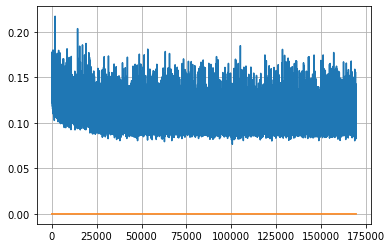

Epoch: 435, iteration 0, loss 0.1051023006439209, cov_diff 0.4236055074295458 cov_diff train 0.4234907262884737
Epoch: 435, iteration 1, loss 0.11239105463027954, cov_diff 0.41005325092310707 cov_diff train 0.4095460740602226
Epoch: 435, iteration 2, loss 0.1074165403842926, cov_diff 0.4155340208599 cov_diff train 0.41450608521869153
Epoch: 435, iteration 3, loss 0.10329237580299377, cov_diff 0.42085082505862403 cov_diff train 0.42009048079225925
Epoch: 435, iteration 4, loss 0.09748855233192444, cov_diff 0.4108053622770633 cov_diff train 0.4103485639280583
Epoch: 435, iteration 5, loss 0.10204464197158813, cov_diff 0.41108791656920396 cov_diff train 0.4101185505112677
Epoch: 435, iteration 6, loss 0.09899809956550598, cov_diff 0.41089524754705187 cov_diff train 0.40979510794473484
Epoch: 435, iteration 7, loss 0.10939761996269226, cov_diff 0.41524720434789913 cov_diff train 0.41472250603094274
Epoch: 435, iteration 8, loss 0.09809860587120056, cov_diff 0.41656798634519787 cov_diff tra

Epoch: 435, iteration 77, loss 0.11331844329833984, cov_diff 0.3924777389245964 cov_diff train 0.3910719933351347
Epoch: 435, iteration 78, loss 0.10428982973098755, cov_diff 0.4033342543563393 cov_diff train 0.4032303323049077
Epoch: 435, iteration 79, loss 0.11265319585800171, cov_diff 0.40891835514044783 cov_diff train 0.4092762346535153
Epoch: 435, iteration 80, loss 0.11355173587799072, cov_diff 0.40619850569438926 cov_diff train 0.40566771682971076
Epoch: 435, iteration 81, loss 0.0953560471534729, cov_diff 0.4112896781133688 cov_diff train 0.41106509653911777
Epoch: 435, iteration 82, loss 0.10961145162582397, cov_diff 0.4103965481569191 cov_diff train 0.4098343714532544
Epoch: 435, iteration 83, loss 0.10483449697494507, cov_diff 0.4210450509600542 cov_diff train 0.41977681477674683
Epoch: 435, iteration 84, loss 0.10176661610603333, cov_diff 0.40738316167555905 cov_diff train 0.40678989979052577
Epoch: 435, iteration 85, loss 0.10620227456092834, cov_diff 0.4313943122657135 co

Epoch: 435, iteration 155, loss 0.09612742066383362, cov_diff 0.4083705779638098 cov_diff train 0.40779274745980176
Epoch: 435, iteration 156, loss 0.10443681478500366, cov_diff 0.42057338015360873 cov_diff train 0.41953368088890786
Epoch: 435, iteration 157, loss 0.10571092367172241, cov_diff 0.4152677435303534 cov_diff train 0.4141864695348077
Epoch: 435, iteration 158, loss 0.09765684604644775, cov_diff 0.4133538657932059 cov_diff train 0.41230833111246723
Epoch: 435, iteration 159, loss 0.09357103705406189, cov_diff 0.41785426618063554 cov_diff train 0.41754236950296353
Epoch: 435, iteration 160, loss 0.10130387544631958, cov_diff 0.39820406130651387 cov_diff train 0.3968167953102079
Epoch: 435, iteration 161, loss 0.09550848603248596, cov_diff 0.40851441346130996 cov_diff train 0.4073374373739089
Epoch: 435, iteration 162, loss 0.09961944818496704, cov_diff 0.40538244168956483 cov_diff train 0.4041347518405697
Epoch: 435, iteration 163, loss 0.10212308168411255, cov_diff 0.4218142

Epoch: 435, iteration 231, loss 0.09926718473434448, cov_diff 0.39720138667600513 cov_diff train 0.39708053216801864
Epoch: 435, iteration 232, loss 0.10462433099746704, cov_diff 0.4130311177223924 cov_diff train 0.4124761486579402
Epoch: 435, iteration 233, loss 0.09661734104156494, cov_diff 0.4243632799288926 cov_diff train 0.4242128418213917
Epoch: 435, iteration 234, loss 0.1109057366847992, cov_diff 0.4051117785573501 cov_diff train 0.4049860914409991
Epoch: 435, iteration 235, loss 0.10528218746185303, cov_diff 0.41461044345804765 cov_diff train 0.41445398705577147
Epoch: 435, iteration 236, loss 0.10839423537254333, cov_diff 0.4193505544707885 cov_diff train 0.41880365307368295
Epoch: 435, iteration 237, loss 0.11114779114723206, cov_diff 0.4101990612630349 cov_diff train 0.41031589517180883
Epoch: 435, iteration 238, loss 0.09829169511795044, cov_diff 0.4083068228120167 cov_diff train 0.4089565909639477
Epoch: 435, iteration 239, loss 0.10618016123771667, cov_diff 0.41056621491

Epoch: 435, iteration 308, loss 0.11609211564064026, cov_diff 0.4104029218056415 cov_diff train 0.4100964365447186
Epoch: 435, iteration 309, loss 0.10139107704162598, cov_diff 0.40798354640411477 cov_diff train 0.4072414835143857
Epoch: 435, iteration 310, loss 0.10426110029220581, cov_diff 0.4090763371836871 cov_diff train 0.40856977093699137
Epoch: 435, iteration 311, loss 0.11413067579269409, cov_diff 0.40798279675059623 cov_diff train 0.4077278007308893
Epoch: 435, iteration 312, loss 0.11051985621452332, cov_diff 0.4096394480550063 cov_diff train 0.4096895632135262
Epoch: 435, iteration 313, loss 0.09859079122543335, cov_diff 0.4073096951219117 cov_diff train 0.40568546033042474
Epoch: 435, iteration 314, loss 0.12408840656280518, cov_diff 0.4127694787208607 cov_diff train 0.41273177225907015
Epoch: 435, iteration 315, loss 0.10107669234275818, cov_diff 0.425365502939613 cov_diff train 0.4232590079222499
Epoch: 435, iteration 316, loss 0.10448417067527771, cov_diff 0.402253931176

Epoch: 435, iteration 385, loss 0.1077466607093811, cov_diff 0.41604022737575835 cov_diff train 0.41552488189201237
Epoch: 435, iteration 386, loss 0.11157166957855225, cov_diff 0.4093028748828252 cov_diff train 0.40888623531933355
Epoch: 435, iteration 387, loss 0.10326576232910156, cov_diff 0.3999347931410712 cov_diff train 0.3994896569004697
Epoch: 435, iteration 388, loss 0.10149902105331421, cov_diff 0.4150537369264929 cov_diff train 0.4141488331572651
Epoch: 435, iteration 389, loss 0.11331355571746826, cov_diff 0.4062489945593535 cov_diff train 0.40582833420625497
Epoch: 435, iteration 390, loss 0.1703563630580902, cov_diff 0.4570928369661414 cov_diff train 0.4544752727796857


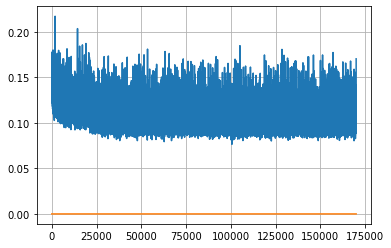

Epoch: 436, iteration 0, loss 0.1008637547492981, cov_diff 0.39978834554894244 cov_diff train 0.3994102450370202
Epoch: 436, iteration 1, loss 0.10010010004043579, cov_diff 0.4043179136061676 cov_diff train 0.40391605575323825
Epoch: 436, iteration 2, loss 0.09917905926704407, cov_diff 0.41600008495455254 cov_diff train 0.41527343737168615
Epoch: 436, iteration 3, loss 0.10192185640335083, cov_diff 0.4144780925741243 cov_diff train 0.4142727216567058
Epoch: 436, iteration 4, loss 0.11038950085639954, cov_diff 0.4070795484975155 cov_diff train 0.40676951197160094
Epoch: 436, iteration 5, loss 0.11116519570350647, cov_diff 0.3968616170560605 cov_diff train 0.39710751564589514
Epoch: 436, iteration 6, loss 0.1057438850402832, cov_diff 0.41441844626570995 cov_diff train 0.41328815808502706
Epoch: 436, iteration 7, loss 0.0990544855594635, cov_diff 0.4297823156653969 cov_diff train 0.4279093714906413
Epoch: 436, iteration 8, loss 0.10666608810424805, cov_diff 0.4188989885714046 cov_diff tra

Epoch: 436, iteration 79, loss 0.1037810742855072, cov_diff 0.42964989811490395 cov_diff train 0.4283207101019291
Epoch: 436, iteration 80, loss 0.10883837938308716, cov_diff 0.40739981474363524 cov_diff train 0.4063322532771858
Epoch: 436, iteration 81, loss 0.10202193260192871, cov_diff 0.4108493203577523 cov_diff train 0.41041071687816894
Epoch: 436, iteration 82, loss 0.1010752022266388, cov_diff 0.408114547268981 cov_diff train 0.406815275552819
Epoch: 436, iteration 83, loss 0.09747180342674255, cov_diff 0.41341713653738194 cov_diff train 0.4123527585087526
Epoch: 436, iteration 84, loss 0.09804031252861023, cov_diff 0.4016922422429997 cov_diff train 0.4008277533383037
Epoch: 436, iteration 85, loss 0.1040198802947998, cov_diff 0.4104709450204484 cov_diff train 0.4091630004557708
Epoch: 436, iteration 86, loss 0.10160461068153381, cov_diff 0.41869661849094986 cov_diff train 0.4179379196342895
Epoch: 436, iteration 87, loss 0.09721386432647705, cov_diff 0.4137657493682274 cov_diff

Epoch: 436, iteration 157, loss 0.09610548615455627, cov_diff 0.40816003159299646 cov_diff train 0.40825176289576126
Epoch: 436, iteration 158, loss 0.1023920476436615, cov_diff 0.4175530022709121 cov_diff train 0.41751007831618525
Epoch: 436, iteration 159, loss 0.0976627767086029, cov_diff 0.41578014316004314 cov_diff train 0.41532949158739113
Epoch: 436, iteration 160, loss 0.1027383804321289, cov_diff 0.4054185864748254 cov_diff train 0.4041539693189257
Epoch: 436, iteration 161, loss 0.09745228290557861, cov_diff 0.40825116880480955 cov_diff train 0.4074726608675083
Epoch: 436, iteration 162, loss 0.11212977766990662, cov_diff 0.41710174605692063 cov_diff train 0.417558003069046
Epoch: 436, iteration 163, loss 0.10116690397262573, cov_diff 0.4282229330272026 cov_diff train 0.42725847674957534
Epoch: 436, iteration 164, loss 0.10742172598838806, cov_diff 0.4226831228035107 cov_diff train 0.4217998146474379
Epoch: 436, iteration 165, loss 0.10804307460784912, cov_diff 0.406069054385

Epoch: 436, iteration 236, loss 0.10996049642562866, cov_diff 0.4070827719327508 cov_diff train 0.40705319885499125
Epoch: 436, iteration 237, loss 0.09417679905891418, cov_diff 0.4154191287378721 cov_diff train 0.4150964335634157
Epoch: 436, iteration 238, loss 0.10244277119636536, cov_diff 0.4133170054452359 cov_diff train 0.41269138159608
Epoch: 436, iteration 239, loss 0.1002165675163269, cov_diff 0.41309445077281354 cov_diff train 0.41201815706232925
Epoch: 436, iteration 240, loss 0.10623049736022949, cov_diff 0.4198000159660065 cov_diff train 0.4176828652787428
Epoch: 436, iteration 241, loss 0.10684123635292053, cov_diff 0.39617500575064096 cov_diff train 0.3955954115084624
Epoch: 436, iteration 242, loss 0.09705007076263428, cov_diff 0.404544652333251 cov_diff train 0.4038747392632631
Epoch: 436, iteration 243, loss 0.10137838125228882, cov_diff 0.4119920664041528 cov_diff train 0.41225601711076665
Epoch: 436, iteration 244, loss 0.11017584800720215, cov_diff 0.416173762119013

Epoch: 436, iteration 314, loss 0.08669593930244446, cov_diff 0.42205489892987846 cov_diff train 0.42115522831359326
Epoch: 436, iteration 315, loss 0.10383144021034241, cov_diff 0.4103501873532943 cov_diff train 0.4099964219731283
Epoch: 436, iteration 316, loss 0.10253426432609558, cov_diff 0.4196987574167356 cov_diff train 0.41798818564884294
Epoch: 436, iteration 317, loss 0.10397753119468689, cov_diff 0.40339700664789474 cov_diff train 0.40244133346691346
Epoch: 436, iteration 318, loss 0.0955246090888977, cov_diff 0.41661798211269035 cov_diff train 0.4160416552528272
Epoch: 436, iteration 319, loss 0.10181215405464172, cov_diff 0.40319480522098405 cov_diff train 0.40226637449570674
Epoch: 436, iteration 320, loss 0.09311595559120178, cov_diff 0.3986640674515585 cov_diff train 0.3973236669453355
Epoch: 436, iteration 321, loss 0.09590619802474976, cov_diff 0.4059200514913261 cov_diff train 0.40541225008479964
Epoch: 436, iteration 322, loss 0.10679426789283752, cov_diff 0.42115498

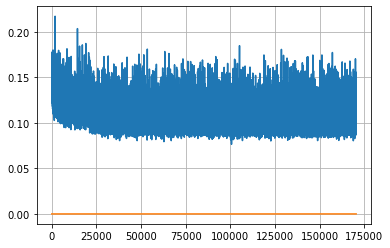

Epoch: 437, iteration 0, loss 0.1035955548286438, cov_diff 0.40352627261027046 cov_diff train 0.40342059751471926
Epoch: 437, iteration 1, loss 0.10773995518684387, cov_diff 0.4122216673068819 cov_diff train 0.4109134269993207
Epoch: 437, iteration 2, loss 0.10639214515686035, cov_diff 0.41247217499585415 cov_diff train 0.4114545825914126
Epoch: 437, iteration 3, loss 0.1020832359790802, cov_diff 0.4130922351734332 cov_diff train 0.41237138145961905
Epoch: 437, iteration 4, loss 0.10332340002059937, cov_diff 0.4165534437988902 cov_diff train 0.4150541224649542
Epoch: 437, iteration 5, loss 0.11788031458854675, cov_diff 0.406500675141946 cov_diff train 0.4059213122912015
Epoch: 437, iteration 6, loss 0.10457050800323486, cov_diff 0.40693748750803105 cov_diff train 0.4067355656898581
Epoch: 437, iteration 7, loss 0.10934314131736755, cov_diff 0.4126025105002802 cov_diff train 0.41170075835415565
Epoch: 437, iteration 8, loss 0.11527293920516968, cov_diff 0.4133655563280776 cov_diff train

Epoch: 437, iteration 78, loss 0.09988680481910706, cov_diff 0.41682887743935965 cov_diff train 0.41508448149225413
Epoch: 437, iteration 79, loss 0.09704852104187012, cov_diff 0.4023421449195452 cov_diff train 0.4019168782515522
Epoch: 437, iteration 80, loss 0.10488349199295044, cov_diff 0.40648818667199865 cov_diff train 0.40577460365117746
Epoch: 437, iteration 81, loss 0.11564218997955322, cov_diff 0.40252044821415767 cov_diff train 0.40187602283442303
Epoch: 437, iteration 82, loss 0.10025045275688171, cov_diff 0.40640673501804975 cov_diff train 0.40605363123797106
Epoch: 437, iteration 83, loss 0.09724980592727661, cov_diff 0.39979410512511976 cov_diff train 0.39912840358054175
Epoch: 437, iteration 84, loss 0.11752575635910034, cov_diff 0.42182827882156854 cov_diff train 0.4216634867715879
Epoch: 437, iteration 85, loss 0.10542705655097961, cov_diff 0.4153873053360355 cov_diff train 0.4147903464951165
Epoch: 437, iteration 86, loss 0.09915459156036377, cov_diff 0.41501833359374

Epoch: 437, iteration 156, loss 0.11033856868743896, cov_diff 0.4209398512285764 cov_diff train 0.42001652334570216
Epoch: 437, iteration 157, loss 0.10277441143989563, cov_diff 0.42051864151721846 cov_diff train 0.41977509186509815
Epoch: 437, iteration 158, loss 0.0888548493385315, cov_diff 0.4084655201285764 cov_diff train 0.40814635302626057
Epoch: 437, iteration 159, loss 0.09752678871154785, cov_diff 0.40587999587539014 cov_diff train 0.4052036897332999
Epoch: 437, iteration 160, loss 0.1089550256729126, cov_diff 0.4156213859378054 cov_diff train 0.41539331619564174
Epoch: 437, iteration 161, loss 0.0983799397945404, cov_diff 0.4184435651908388 cov_diff train 0.418582710033633
Epoch: 437, iteration 162, loss 0.09160995483398438, cov_diff 0.4128291722349239 cov_diff train 0.4125143765297813
Epoch: 437, iteration 163, loss 0.09341484308242798, cov_diff 0.39677881009218857 cov_diff train 0.39627310872331706
Epoch: 437, iteration 164, loss 0.09418898820877075, cov_diff 0.402072285054

Epoch: 437, iteration 235, loss 0.12455224990844727, cov_diff 0.41209194048562064 cov_diff train 0.41207777282764163
Epoch: 437, iteration 236, loss 0.11649546027183533, cov_diff 0.3945339625041841 cov_diff train 0.3947417880930127
Epoch: 437, iteration 237, loss 0.10553392767906189, cov_diff 0.39973547382032415 cov_diff train 0.3996527577049938
Epoch: 437, iteration 238, loss 0.10468727350234985, cov_diff 0.41689748568664786 cov_diff train 0.4154917985058069
Epoch: 437, iteration 239, loss 0.09370997548103333, cov_diff 0.41173465678810506 cov_diff train 0.41127804009520363
Epoch: 437, iteration 240, loss 0.10145807266235352, cov_diff 0.4029839760894558 cov_diff train 0.4018868365237144
Epoch: 437, iteration 241, loss 0.10424867272377014, cov_diff 0.4094163693624067 cov_diff train 0.4086756978774271
Epoch: 437, iteration 242, loss 0.10045698285102844, cov_diff 0.4100774432836793 cov_diff train 0.40959870896388717
Epoch: 437, iteration 243, loss 0.10801845788955688, cov_diff 0.408141073

Epoch: 437, iteration 313, loss 0.08715111017227173, cov_diff 0.4174573946126743 cov_diff train 0.4170091919128533
Epoch: 437, iteration 314, loss 0.09388786554336548, cov_diff 0.4072995253826244 cov_diff train 0.4064588575923909
Epoch: 437, iteration 315, loss 0.10084420442581177, cov_diff 0.4175342822818308 cov_diff train 0.4168339418012263
Epoch: 437, iteration 316, loss 0.10803860425949097, cov_diff 0.40855243745526065 cov_diff train 0.4076235063796997
Epoch: 437, iteration 317, loss 0.10465002059936523, cov_diff 0.4090537601804705 cov_diff train 0.4083305899804923
Epoch: 437, iteration 318, loss 0.10262808203697205, cov_diff 0.41930850263113373 cov_diff train 0.41776942416881807
Epoch: 437, iteration 319, loss 0.11201128363609314, cov_diff 0.41587652889309884 cov_diff train 0.4152215535201896
Epoch: 437, iteration 320, loss 0.11224058270454407, cov_diff 0.4149599827240606 cov_diff train 0.4148595438130455
Epoch: 437, iteration 321, loss 0.11642235517501831, cov_diff 0.424698421479

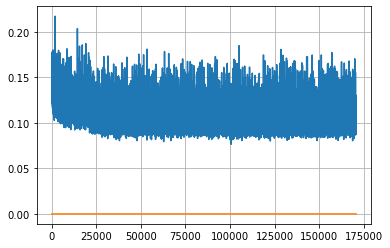

Epoch: 438, iteration 0, loss 0.09953737258911133, cov_diff 0.4132560106880582 cov_diff train 0.4132230925837827
Epoch: 438, iteration 1, loss 0.09312975406646729, cov_diff 0.4093643588476977 cov_diff train 0.4090018564090455
Epoch: 438, iteration 2, loss 0.09817072749137878, cov_diff 0.4225454733160498 cov_diff train 0.42149511312231275
Epoch: 438, iteration 3, loss 0.10527443885803223, cov_diff 0.4101341711027975 cov_diff train 0.409708618671499
Epoch: 438, iteration 4, loss 0.09358242154121399, cov_diff 0.4250641367109584 cov_diff train 0.42509332504529174
Epoch: 438, iteration 5, loss 0.10629740357398987, cov_diff 0.4078501952173165 cov_diff train 0.40716270284029593
Epoch: 438, iteration 6, loss 0.1029013991355896, cov_diff 0.41122694739895865 cov_diff train 0.4112190085653168
Epoch: 438, iteration 7, loss 0.09875169396400452, cov_diff 0.4178877589979463 cov_diff train 0.41769337014168895
Epoch: 438, iteration 8, loss 0.10568076372146606, cov_diff 0.40653340450241077 cov_diff trai

Epoch: 438, iteration 81, loss 0.10000452399253845, cov_diff 0.41583185622099883 cov_diff train 0.4157040409751134
Epoch: 438, iteration 82, loss 0.09774953126907349, cov_diff 0.4126005315237381 cov_diff train 0.4113939114803419
Epoch: 438, iteration 83, loss 0.0987151563167572, cov_diff 0.41267851354195173 cov_diff train 0.41230545666216156
Epoch: 438, iteration 84, loss 0.1009514331817627, cov_diff 0.4058982923529919 cov_diff train 0.40579104588805304
Epoch: 438, iteration 85, loss 0.09735214710235596, cov_diff 0.41719737489203784 cov_diff train 0.41640965782873396
Epoch: 438, iteration 86, loss 0.09149226546287537, cov_diff 0.39594300177051567 cov_diff train 0.39588830719208906
Epoch: 438, iteration 87, loss 0.09909644722938538, cov_diff 0.41002274541688233 cov_diff train 0.40963178515704896
Epoch: 438, iteration 88, loss 0.10825386643409729, cov_diff 0.4062843996218923 cov_diff train 0.40581785138901927
Epoch: 438, iteration 89, loss 0.106162428855896, cov_diff 0.4200812245997826 c

Epoch: 438, iteration 159, loss 0.1021626889705658, cov_diff 0.4008600531536671 cov_diff train 0.4002807117731042
Epoch: 438, iteration 160, loss 0.1013299822807312, cov_diff 0.408860995162356 cov_diff train 0.40739600866000863
Epoch: 438, iteration 161, loss 0.10019752383232117, cov_diff 0.4174691560826667 cov_diff train 0.4171550019872541
Epoch: 438, iteration 162, loss 0.1001255214214325, cov_diff 0.41684036653368606 cov_diff train 0.4163586334658777
Epoch: 438, iteration 163, loss 0.09711900353431702, cov_diff 0.39949135787141155 cov_diff train 0.398233503681071
Epoch: 438, iteration 164, loss 0.10022890567779541, cov_diff 0.41208675294034164 cov_diff train 0.41082060522755315
Epoch: 438, iteration 165, loss 0.10265952348709106, cov_diff 0.4159241643549612 cov_diff train 0.4158334185368788
Epoch: 438, iteration 166, loss 0.11426869034767151, cov_diff 0.43204112597275746 cov_diff train 0.43071188620277295
Epoch: 438, iteration 167, loss 0.10067269206047058, cov_diff 0.40674474974753

Epoch: 438, iteration 235, loss 0.10441046953201294, cov_diff 0.411914804204767 cov_diff train 0.41091188075604795
Epoch: 438, iteration 236, loss 0.1152847409248352, cov_diff 0.41057929983487584 cov_diff train 0.41031043844331666
Epoch: 438, iteration 237, loss 0.104746013879776, cov_diff 0.40354680061053755 cov_diff train 0.40266031368034366
Epoch: 438, iteration 238, loss 0.09969159960746765, cov_diff 0.39920918477101264 cov_diff train 0.3973211013536284
Epoch: 438, iteration 239, loss 0.09867355227470398, cov_diff 0.41617642411636757 cov_diff train 0.4155290528460481
Epoch: 438, iteration 240, loss 0.10608434677124023, cov_diff 0.40725899930934545 cov_diff train 0.40539670925061844
Epoch: 438, iteration 241, loss 0.10832366347312927, cov_diff 0.4182708540593124 cov_diff train 0.4179633111568257
Epoch: 438, iteration 242, loss 0.11090174317359924, cov_diff 0.4221019076338238 cov_diff train 0.42153089727576976
Epoch: 438, iteration 243, loss 0.10147953033447266, cov_diff 0.4021003100

Epoch: 438, iteration 312, loss 0.09523478150367737, cov_diff 0.39907093082763156 cov_diff train 0.399442566953736
Epoch: 438, iteration 313, loss 0.111235111951828, cov_diff 0.41422072414686023 cov_diff train 0.41392173138075505
Epoch: 438, iteration 314, loss 0.09292134642601013, cov_diff 0.3975871868254585 cov_diff train 0.39656879253227706
Epoch: 438, iteration 315, loss 0.10118904709815979, cov_diff 0.4124928371080792 cov_diff train 0.41198079252137
Epoch: 438, iteration 316, loss 0.10755833983421326, cov_diff 0.4042034202562601 cov_diff train 0.4041403169139016
Epoch: 438, iteration 317, loss 0.101491779088974, cov_diff 0.4081071820385425 cov_diff train 0.40836620854464545
Epoch: 438, iteration 318, loss 0.10731515288352966, cov_diff 0.4208135138924401 cov_diff train 0.4197082651538802
Epoch: 438, iteration 319, loss 0.10494521260261536, cov_diff 0.4209213969491023 cov_diff train 0.4209959457474928
Epoch: 438, iteration 320, loss 0.10403600335121155, cov_diff 0.421951605027531 co

Epoch: 438, iteration 390, loss 0.15736404061317444, cov_diff 0.44827183977317125 cov_diff train 0.44583983357030593


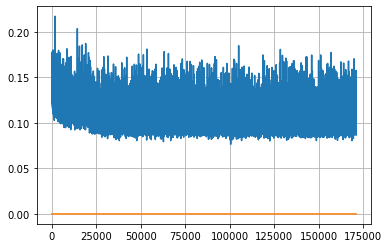

Epoch: 439, iteration 0, loss 0.10464835166931152, cov_diff 0.42046764356711136 cov_diff train 0.4199300697883126
Epoch: 439, iteration 1, loss 0.11823385953903198, cov_diff 0.4049891422812156 cov_diff train 0.40422623953557985
Epoch: 439, iteration 2, loss 0.09790515899658203, cov_diff 0.4093080431221843 cov_diff train 0.40944007002207944
Epoch: 439, iteration 3, loss 0.10868924856185913, cov_diff 0.41506120579691985 cov_diff train 0.41516412117632057
Epoch: 439, iteration 4, loss 0.09706291556358337, cov_diff 0.4131910201767804 cov_diff train 0.4124080347845328
Epoch: 439, iteration 5, loss 0.10095033049583435, cov_diff 0.40883525358148765 cov_diff train 0.40950706138288767
Epoch: 439, iteration 6, loss 0.0936417281627655, cov_diff 0.4116211911490914 cov_diff train 0.4109401533810255
Epoch: 439, iteration 7, loss 0.11274576187133789, cov_diff 0.4216294211526567 cov_diff train 0.42135349991168924
Epoch: 439, iteration 8, loss 0.10482379794120789, cov_diff 0.4081452273215422 cov_diff t

Epoch: 439, iteration 76, loss 0.09336358308792114, cov_diff 0.41976870440572167 cov_diff train 0.41954738989557355
Epoch: 439, iteration 77, loss 0.09625047445297241, cov_diff 0.4300957204071099 cov_diff train 0.4293187991889992
Epoch: 439, iteration 78, loss 0.1120307445526123, cov_diff 0.4178676977847783 cov_diff train 0.41818223308520014
Epoch: 439, iteration 79, loss 0.09594616293907166, cov_diff 0.4052035414543437 cov_diff train 0.40469171754458433
Epoch: 439, iteration 80, loss 0.10420447587966919, cov_diff 0.40485783325527724 cov_diff train 0.4049983405443406
Epoch: 439, iteration 81, loss 0.10551729798316956, cov_diff 0.42255729554430044 cov_diff train 0.42079355357925735
Epoch: 439, iteration 82, loss 0.09460389614105225, cov_diff 0.41354713784752256 cov_diff train 0.41262312823548786
Epoch: 439, iteration 83, loss 0.0993223786354065, cov_diff 0.4079695405135603 cov_diff train 0.4073076604045069
Epoch: 439, iteration 84, loss 0.10366597771644592, cov_diff 0.4136519515588782 c

Epoch: 439, iteration 152, loss 0.10191863775253296, cov_diff 0.4119848096412153 cov_diff train 0.41101918424353306
Epoch: 439, iteration 153, loss 0.10060125589370728, cov_diff 0.42173966734919055 cov_diff train 0.42130957054083734
Epoch: 439, iteration 154, loss 0.1065412163734436, cov_diff 0.4088896645489452 cov_diff train 0.4088998052792374
Epoch: 439, iteration 155, loss 0.09850811958312988, cov_diff 0.4063953196446683 cov_diff train 0.4058227611864311
Epoch: 439, iteration 156, loss 0.10552665591239929, cov_diff 0.41164832610391133 cov_diff train 0.4107689050446127
Epoch: 439, iteration 157, loss 0.10266974568367004, cov_diff 0.4052202450370565 cov_diff train 0.404075537271721
Epoch: 439, iteration 158, loss 0.09591123461723328, cov_diff 0.4096329437459884 cov_diff train 0.40947140326352643
Epoch: 439, iteration 159, loss 0.1125495433807373, cov_diff 0.39723931651087313 cov_diff train 0.3968547731876081
Epoch: 439, iteration 160, loss 0.11217492818832397, cov_diff 0.4024834546468

Epoch: 439, iteration 227, loss 0.09348922967910767, cov_diff 0.40746033021795186 cov_diff train 0.40709773260644316
Epoch: 439, iteration 228, loss 0.10410857200622559, cov_diff 0.4111679314572889 cov_diff train 0.4104593448398742
Epoch: 439, iteration 229, loss 0.10473203659057617, cov_diff 0.4025669432704608 cov_diff train 0.401808990602158
Epoch: 439, iteration 230, loss 0.09527266025543213, cov_diff 0.4104391416274473 cov_diff train 0.4102358224190154
Epoch: 439, iteration 231, loss 0.09516224265098572, cov_diff 0.4041428073068439 cov_diff train 0.40464137238167835
Epoch: 439, iteration 232, loss 0.11012524366378784, cov_diff 0.4204917441157024 cov_diff train 0.42027747171344837
Epoch: 439, iteration 233, loss 0.10236728191375732, cov_diff 0.41748984585180693 cov_diff train 0.4169161202520328
Epoch: 439, iteration 234, loss 0.10073620080947876, cov_diff 0.41260070546199634 cov_diff train 0.4123968088651495
Epoch: 439, iteration 235, loss 0.11438995599746704, cov_diff 0.41125711076

Epoch: 439, iteration 306, loss 0.10660868883132935, cov_diff 0.41079880079485503 cov_diff train 0.4108361215304972
Epoch: 439, iteration 307, loss 0.09250703454017639, cov_diff 0.41964616042888686 cov_diff train 0.41876847811900336
Epoch: 439, iteration 308, loss 0.10474056005477905, cov_diff 0.4213383043902254 cov_diff train 0.41923555115396244
Epoch: 439, iteration 309, loss 0.10598278045654297, cov_diff 0.40628601475459003 cov_diff train 0.4054366809955291
Epoch: 439, iteration 310, loss 0.09895643591880798, cov_diff 0.4141998794694992 cov_diff train 0.4135613168253156
Epoch: 439, iteration 311, loss 0.10328444838523865, cov_diff 0.39229408691849377 cov_diff train 0.39119101219573277
Epoch: 439, iteration 312, loss 0.10076954960823059, cov_diff 0.41896066405622434 cov_diff train 0.41847668354193707
Epoch: 439, iteration 313, loss 0.09537684917449951, cov_diff 0.39832516597328455 cov_diff train 0.39787902097594663
Epoch: 439, iteration 314, loss 0.100900799036026, cov_diff 0.4062118

Epoch: 439, iteration 384, loss 0.10462149977684021, cov_diff 0.41507514842174686 cov_diff train 0.4145528595811334
Epoch: 439, iteration 385, loss 0.08997991681098938, cov_diff 0.4021598582430915 cov_diff train 0.4024326926729351
Epoch: 439, iteration 386, loss 0.11012721061706543, cov_diff 0.40475291395615853 cov_diff train 0.40437245590089316
Epoch: 439, iteration 387, loss 0.10131525993347168, cov_diff 0.4005949856253098 cov_diff train 0.3999418018175833
Epoch: 439, iteration 388, loss 0.11029663681983948, cov_diff 0.4106491139817717 cov_diff train 0.4098734895582427
Epoch: 439, iteration 389, loss 0.10167080163955688, cov_diff 0.4084320689664625 cov_diff train 0.4074250074814539
Epoch: 439, iteration 390, loss 0.13375207781791687, cov_diff 0.4418476145769206 cov_diff train 0.4411925382471463


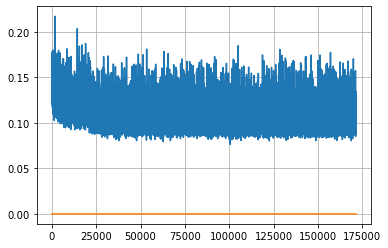

Epoch: 440, iteration 0, loss 0.10701116919517517, cov_diff 0.41370074262492473 cov_diff train 0.4131319982286958
Epoch: 440, iteration 1, loss 0.1036713719367981, cov_diff 0.4089197799738452 cov_diff train 0.4080585980164697
Epoch: 440, iteration 2, loss 0.09970027208328247, cov_diff 0.4056012785604183 cov_diff train 0.40474845860376985
Epoch: 440, iteration 3, loss 0.09427472949028015, cov_diff 0.4113135252375078 cov_diff train 0.4107505016379885
Epoch: 440, iteration 4, loss 0.11244207620620728, cov_diff 0.40937921536474264 cov_diff train 0.40879736671292066
Epoch: 440, iteration 5, loss 0.11791235208511353, cov_diff 0.41285579830690566 cov_diff train 0.4119809965955599
Epoch: 440, iteration 6, loss 0.0978020429611206, cov_diff 0.39738661294908656 cov_diff train 0.39674771551099236
Epoch: 440, iteration 7, loss 0.10457468032836914, cov_diff 0.4057091866746624 cov_diff train 0.405402892354803
Epoch: 440, iteration 8, loss 0.10130751132965088, cov_diff 0.4082266055002425 cov_diff trai

Epoch: 440, iteration 78, loss 0.10798299312591553, cov_diff 0.4166920731091062 cov_diff train 0.4165558875533936
Epoch: 440, iteration 79, loss 0.09348991513252258, cov_diff 0.4113949089267682 cov_diff train 0.4101896445260893
Epoch: 440, iteration 80, loss 0.10468173027038574, cov_diff 0.41591961736907995 cov_diff train 0.415464839261432
Epoch: 440, iteration 81, loss 0.10773792862892151, cov_diff 0.4210387011520839 cov_diff train 0.4201292357111846
Epoch: 440, iteration 82, loss 0.10854309797286987, cov_diff 0.4240552801812474 cov_diff train 0.4235108290215212
Epoch: 440, iteration 83, loss 0.10353702306747437, cov_diff 0.40986149960856755 cov_diff train 0.4087755303408508
Epoch: 440, iteration 84, loss 0.10823073983192444, cov_diff 0.3978563364427599 cov_diff train 0.39679192788124346
Epoch: 440, iteration 85, loss 0.10982555150985718, cov_diff 0.41134524913572446 cov_diff train 0.4106985182749524
Epoch: 440, iteration 86, loss 0.10759654641151428, cov_diff 0.4105007526447947 cov_d

Epoch: 440, iteration 155, loss 0.1000438928604126, cov_diff 0.4101400428208152 cov_diff train 0.4092701408222763
Epoch: 440, iteration 156, loss 0.09718525409698486, cov_diff 0.4125289481718438 cov_diff train 0.4120694689222133
Epoch: 440, iteration 157, loss 0.09710302948951721, cov_diff 0.42390271357964754 cov_diff train 0.42195266955249905
Epoch: 440, iteration 158, loss 0.10962101817131042, cov_diff 0.41907246801180814 cov_diff train 0.41785605391964087
Epoch: 440, iteration 159, loss 0.09356236457824707, cov_diff 0.4005264659255053 cov_diff train 0.40066055490290414
Epoch: 440, iteration 160, loss 0.10877898335456848, cov_diff 0.41960917862396346 cov_diff train 0.4186651723434935
Epoch: 440, iteration 161, loss 0.094929039478302, cov_diff 0.4131645015853616 cov_diff train 0.41275455310780745
Epoch: 440, iteration 162, loss 0.09841695427894592, cov_diff 0.4183330449701278 cov_diff train 0.41749205462131334
Epoch: 440, iteration 163, loss 0.09968283772468567, cov_diff 0.40547605700

Epoch: 440, iteration 232, loss 0.10387855768203735, cov_diff 0.4044101888427978 cov_diff train 0.4040409599208454
Epoch: 440, iteration 233, loss 0.10213202238082886, cov_diff 0.4026301688755669 cov_diff train 0.40195297166433913
Epoch: 440, iteration 234, loss 0.1018792986869812, cov_diff 0.42165057191748295 cov_diff train 0.4207625052412575
Epoch: 440, iteration 235, loss 0.09904196858406067, cov_diff 0.4032862488414371 cov_diff train 0.4030167716777335
Epoch: 440, iteration 236, loss 0.10762831568717957, cov_diff 0.4025144150477638 cov_diff train 0.4011330016923958
Epoch: 440, iteration 237, loss 0.1073145866394043, cov_diff 0.415508025358134 cov_diff train 0.4151517336157259
Epoch: 440, iteration 238, loss 0.09794926643371582, cov_diff 0.41145952284450626 cov_diff train 0.4105471359500294
Epoch: 440, iteration 239, loss 0.11301463842391968, cov_diff 0.41063249075796 cov_diff train 0.41047451557316655
Epoch: 440, iteration 240, loss 0.10165238380432129, cov_diff 0.41903546644149714

Epoch: 440, iteration 309, loss 0.11034852266311646, cov_diff 0.42113920606081867 cov_diff train 0.419808850074121
Epoch: 440, iteration 310, loss 0.10504981875419617, cov_diff 0.4194881889837193 cov_diff train 0.41924871509056527
Epoch: 440, iteration 311, loss 0.09962406754493713, cov_diff 0.40719654897995056 cov_diff train 0.4068155034070377
Epoch: 440, iteration 312, loss 0.10295742750167847, cov_diff 0.4054408082773111 cov_diff train 0.40342221825697056
Epoch: 440, iteration 313, loss 0.10227006673812866, cov_diff 0.40660252566640953 cov_diff train 0.4070750424940759
Epoch: 440, iteration 314, loss 0.11676114797592163, cov_diff 0.41075252656931716 cov_diff train 0.4104012133195746
Epoch: 440, iteration 315, loss 0.09329533576965332, cov_diff 0.42111822724324416 cov_diff train 0.42076970804942865
Epoch: 440, iteration 316, loss 0.1145457923412323, cov_diff 0.4080299523661874 cov_diff train 0.407450846371409
Epoch: 440, iteration 317, loss 0.09725391864776611, cov_diff 0.40583280424

Epoch: 440, iteration 386, loss 0.10967826843261719, cov_diff 0.40893659827835954 cov_diff train 0.40843821162248745
Epoch: 440, iteration 387, loss 0.09822770953178406, cov_diff 0.41280088988028457 cov_diff train 0.4122476262646871
Epoch: 440, iteration 388, loss 0.09971246123313904, cov_diff 0.4069507328968903 cov_diff train 0.4063359240890759
Epoch: 440, iteration 389, loss 0.10061219334602356, cov_diff 0.40691875225451457 cov_diff train 0.4069270355785027
Epoch: 440, iteration 390, loss 0.15359404683113098, cov_diff 0.4437833884236054 cov_diff train 0.44293842799644073


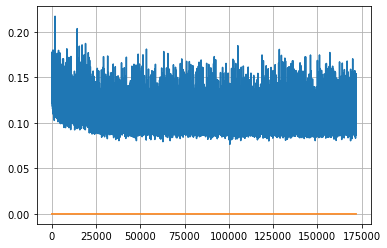

Epoch: 441, iteration 0, loss 0.111268550157547, cov_diff 0.4073465165689726 cov_diff train 0.40659366182084977
Epoch: 441, iteration 1, loss 0.10220998525619507, cov_diff 0.40130680162932 cov_diff train 0.4014704108669794
Epoch: 441, iteration 2, loss 0.10955041646957397, cov_diff 0.3983669198419076 cov_diff train 0.398444325278163
Epoch: 441, iteration 3, loss 0.09757980704307556, cov_diff 0.4217696607670947 cov_diff train 0.4209600987608101
Epoch: 441, iteration 4, loss 0.09617769718170166, cov_diff 0.4020873788484613 cov_diff train 0.4024081855914571
Epoch: 441, iteration 5, loss 0.09743106365203857, cov_diff 0.4098861624678512 cov_diff train 0.40989277230592713
Epoch: 441, iteration 6, loss 0.11230173707008362, cov_diff 0.4132713421562415 cov_diff train 0.4128805905344241
Epoch: 441, iteration 7, loss 0.09721836447715759, cov_diff 0.40959249409330895 cov_diff train 0.408293940459154
Epoch: 441, iteration 8, loss 0.11479601263999939, cov_diff 0.4162815440376425 cov_diff train 0.415

Epoch: 441, iteration 78, loss 0.11939176917076111, cov_diff 0.4101176997577105 cov_diff train 0.40964568848634414
Epoch: 441, iteration 79, loss 0.09585213661193848, cov_diff 0.4127940837926954 cov_diff train 0.4125848649328213
Epoch: 441, iteration 80, loss 0.09873741865158081, cov_diff 0.4187541730284572 cov_diff train 0.41826083797335634
Epoch: 441, iteration 81, loss 0.10404655337333679, cov_diff 0.40415103619738924 cov_diff train 0.40383372198425127
Epoch: 441, iteration 82, loss 0.1031336784362793, cov_diff 0.4077030182478004 cov_diff train 0.40771977446552093
Epoch: 441, iteration 83, loss 0.10389444231987, cov_diff 0.4108396837193969 cov_diff train 0.4106348618125649
Epoch: 441, iteration 84, loss 0.1135062575340271, cov_diff 0.4091742111403334 cov_diff train 0.40868868354451265
Epoch: 441, iteration 85, loss 0.10191786289215088, cov_diff 0.41719113029837784 cov_diff train 0.41692513593555836
Epoch: 441, iteration 86, loss 0.10709556937217712, cov_diff 0.4061851249296181 cov_d

Epoch: 441, iteration 155, loss 0.10305193066596985, cov_diff 0.42756277793212183 cov_diff train 0.4276520560375315
Epoch: 441, iteration 156, loss 0.10579341650009155, cov_diff 0.4111340851148011 cov_diff train 0.41018809373479154
Epoch: 441, iteration 157, loss 0.09508350491523743, cov_diff 0.3979177039754264 cov_diff train 0.397080653818375
Epoch: 441, iteration 158, loss 0.11215314269065857, cov_diff 0.42007046856322694 cov_diff train 0.41969508152569757
Epoch: 441, iteration 159, loss 0.1003757119178772, cov_diff 0.39668237604274736 cov_diff train 0.39610078431623197
Epoch: 441, iteration 160, loss 0.10774007439613342, cov_diff 0.4177901469721916 cov_diff train 0.4169458305222129
Epoch: 441, iteration 161, loss 0.10566240549087524, cov_diff 0.40503895291399106 cov_diff train 0.4045787443231428
Epoch: 441, iteration 162, loss 0.1032302975654602, cov_diff 0.4046866084364589 cov_diff train 0.40414759231470576
Epoch: 441, iteration 163, loss 0.10774043202400208, cov_diff 0.41686239037

Epoch: 441, iteration 233, loss 0.11123767495155334, cov_diff 0.4245461491142681 cov_diff train 0.4227990066441053
Epoch: 441, iteration 234, loss 0.10082754492759705, cov_diff 0.4052388358823562 cov_diff train 0.40544239728043335
Epoch: 441, iteration 235, loss 0.09391191601753235, cov_diff 0.417862053201825 cov_diff train 0.41757061635410686
Epoch: 441, iteration 236, loss 0.10706764459609985, cov_diff 0.42395059721004275 cov_diff train 0.42345787219495296
Epoch: 441, iteration 237, loss 0.10613888502120972, cov_diff 0.41236652944894786 cov_diff train 0.4114813788363118
Epoch: 441, iteration 238, loss 0.09972792863845825, cov_diff 0.4047263319623775 cov_diff train 0.4041203773577185
Epoch: 441, iteration 239, loss 0.10450989007949829, cov_diff 0.41151421460199394 cov_diff train 0.41064057133254883
Epoch: 441, iteration 240, loss 0.10120439529418945, cov_diff 0.415958314618417 cov_diff train 0.4145756674692001
Epoch: 441, iteration 241, loss 0.10121572017669678, cov_diff 0.40696355572

Epoch: 441, iteration 306, loss 0.09955474734306335, cov_diff 0.41563970513424325 cov_diff train 0.41469735104646793
Epoch: 441, iteration 307, loss 0.1038581132888794, cov_diff 0.4189152986498697 cov_diff train 0.41697849480304167
Epoch: 441, iteration 308, loss 0.10738757252693176, cov_diff 0.415105780335093 cov_diff train 0.4128777180965504
Epoch: 441, iteration 309, loss 0.10371190309524536, cov_diff 0.4167919290384538 cov_diff train 0.4163316638471949
Epoch: 441, iteration 310, loss 0.1269434094429016, cov_diff 0.4069010296851268 cov_diff train 0.40651295047608843
Epoch: 441, iteration 311, loss 0.09906661510467529, cov_diff 0.4082202503478755 cov_diff train 0.4077226603475918
Epoch: 441, iteration 312, loss 0.11618998646736145, cov_diff 0.4160991330217486 cov_diff train 0.4155643722085557
Epoch: 441, iteration 313, loss 0.09642884135246277, cov_diff 0.4050362090759712 cov_diff train 0.4042249581666621
Epoch: 441, iteration 314, loss 0.11943936347961426, cov_diff 0.415162356427515

Epoch: 441, iteration 377, loss 0.10557436943054199, cov_diff 0.40674483404246614 cov_diff train 0.4056761206792303
Epoch: 441, iteration 378, loss 0.10791438817977905, cov_diff 0.4132952044236289 cov_diff train 0.4129951492034473
Epoch: 441, iteration 379, loss 0.10352665185928345, cov_diff 0.4016711086715208 cov_diff train 0.4018317553856935
Epoch: 441, iteration 380, loss 0.11563023924827576, cov_diff 0.4079556030189887 cov_diff train 0.40875956729258806
Epoch: 441, iteration 381, loss 0.10267841815948486, cov_diff 0.40291715597224026 cov_diff train 0.4026845131676993
Epoch: 441, iteration 382, loss 0.11742636561393738, cov_diff 0.40744091895289486 cov_diff train 0.4072373311073931
Epoch: 441, iteration 383, loss 0.10159552097320557, cov_diff 0.40792166032700333 cov_diff train 0.40786526768731723
Epoch: 441, iteration 384, loss 0.09904852509498596, cov_diff 0.4018317321417208 cov_diff train 0.40107118801371255
Epoch: 441, iteration 385, loss 0.09534800052642822, cov_diff 0.405905624

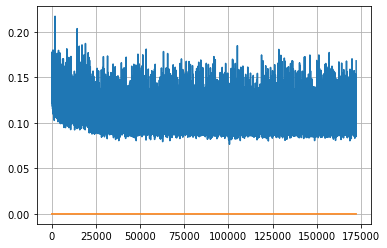

Epoch: 442, iteration 0, loss 0.10233563184738159, cov_diff 0.4115792812247743 cov_diff train 0.41179492010096636
Epoch: 442, iteration 1, loss 0.09655874967575073, cov_diff 0.40546439918306115 cov_diff train 0.4056671510456605
Epoch: 442, iteration 2, loss 0.11646074056625366, cov_diff 0.40480169653812736 cov_diff train 0.4033186402800253
Epoch: 442, iteration 3, loss 0.09858065843582153, cov_diff 0.41078651713082676 cov_diff train 0.4097650552782497
Epoch: 442, iteration 4, loss 0.1023389995098114, cov_diff 0.4004086561516183 cov_diff train 0.3987794837657995
Epoch: 442, iteration 5, loss 0.09583491086959839, cov_diff 0.40722417490744706 cov_diff train 0.4063091665427017
Epoch: 442, iteration 6, loss 0.11519643664360046, cov_diff 0.4125688258512851 cov_diff train 0.4104312635778863
Epoch: 442, iteration 7, loss 0.10176053643226624, cov_diff 0.40972199720726743 cov_diff train 0.40808446095882467
Epoch: 442, iteration 8, loss 0.1039876639842987, cov_diff 0.40996514961528063 cov_diff tr

Epoch: 442, iteration 76, loss 0.1056554913520813, cov_diff 0.4041528974707779 cov_diff train 0.40446255051778285
Epoch: 442, iteration 77, loss 0.10244017839431763, cov_diff 0.40909749148344804 cov_diff train 0.40866050291307865
Epoch: 442, iteration 78, loss 0.11243423819541931, cov_diff 0.4204693807444416 cov_diff train 0.4185813077906119
Epoch: 442, iteration 79, loss 0.09947997331619263, cov_diff 0.4059492134317919 cov_diff train 0.40507846749773085
Epoch: 442, iteration 80, loss 0.10520327091217041, cov_diff 0.40005933184701326 cov_diff train 0.39991371214595445
Epoch: 442, iteration 81, loss 0.10072067379951477, cov_diff 0.4112052646507106 cov_diff train 0.40962197338532785
Epoch: 442, iteration 82, loss 0.11597949266433716, cov_diff 0.40351035463044643 cov_diff train 0.40306427784182663
Epoch: 442, iteration 83, loss 0.0953742265701294, cov_diff 0.40760935723972025 cov_diff train 0.40692668434756196
Epoch: 442, iteration 84, loss 0.10236307978630066, cov_diff 0.4068228852708523

Epoch: 442, iteration 155, loss 0.10110732913017273, cov_diff 0.4136945807415656 cov_diff train 0.41270818287155553
Epoch: 442, iteration 156, loss 0.10773339867591858, cov_diff 0.4069293549734004 cov_diff train 0.40621617272398464
Epoch: 442, iteration 157, loss 0.10488235950469971, cov_diff 0.41928371276392656 cov_diff train 0.4185463376077107
Epoch: 442, iteration 158, loss 0.1013580858707428, cov_diff 0.4054627307304142 cov_diff train 0.40523447021698944
Epoch: 442, iteration 159, loss 0.09805503487586975, cov_diff 0.4150702168122965 cov_diff train 0.414035967516069
Epoch: 442, iteration 160, loss 0.11369290947914124, cov_diff 0.4145051891409932 cov_diff train 0.41314787536931813
Epoch: 442, iteration 161, loss 0.10963878035545349, cov_diff 0.40915754262745324 cov_diff train 0.40794163727794447
Epoch: 442, iteration 162, loss 0.12102401256561279, cov_diff 0.39755713481330895 cov_diff train 0.39679144089947926
Epoch: 442, iteration 163, loss 0.10071399807929993, cov_diff 0.417566902

Epoch: 442, iteration 233, loss 0.10437560081481934, cov_diff 0.4146513858239255 cov_diff train 0.41438506332868064
Epoch: 442, iteration 234, loss 0.09954661130905151, cov_diff 0.41708805671852056 cov_diff train 0.4165717483117724
Epoch: 442, iteration 235, loss 0.1091277003288269, cov_diff 0.39997970897686635 cov_diff train 0.39946260509311726
Epoch: 442, iteration 236, loss 0.1031988263130188, cov_diff 0.4109308362937931 cov_diff train 0.40971954091598733
Epoch: 442, iteration 237, loss 0.10754016041755676, cov_diff 0.4149501915743311 cov_diff train 0.41410651180455343
Epoch: 442, iteration 238, loss 0.1135796308517456, cov_diff 0.42116474594689907 cov_diff train 0.42042364583405556
Epoch: 442, iteration 239, loss 0.10170775651931763, cov_diff 0.40296711811807656 cov_diff train 0.401403409771614
Epoch: 442, iteration 240, loss 0.11769658327102661, cov_diff 0.4119982747783719 cov_diff train 0.41054188059541036
Epoch: 442, iteration 241, loss 0.11454418301582336, cov_diff 0.4129406934

Epoch: 442, iteration 310, loss 0.10060298442840576, cov_diff 0.4085600329821475 cov_diff train 0.408177763125456
Epoch: 442, iteration 311, loss 0.09442931413650513, cov_diff 0.42162986440617806 cov_diff train 0.4211387883019422
Epoch: 442, iteration 312, loss 0.10777920484542847, cov_diff 0.41390919963548006 cov_diff train 0.41329087239074724
Epoch: 442, iteration 313, loss 0.10354819893836975, cov_diff 0.3989825974774951 cov_diff train 0.3983174758338258
Epoch: 442, iteration 314, loss 0.10185584425926208, cov_diff 0.4218911765158094 cov_diff train 0.4201933595389053
Epoch: 442, iteration 315, loss 0.10087195038795471, cov_diff 0.40182015853084957 cov_diff train 0.40190306491485833
Epoch: 442, iteration 316, loss 0.10061532258987427, cov_diff 0.4112173394981326 cov_diff train 0.41046512894068965
Epoch: 442, iteration 317, loss 0.09148663282394409, cov_diff 0.4097598981622398 cov_diff train 0.40981032334681705
Epoch: 442, iteration 318, loss 0.10081061720848083, cov_diff 0.4330807056

Epoch: 442, iteration 388, loss 0.10294696688652039, cov_diff 0.41201489131776264 cov_diff train 0.41100045241869093
Epoch: 442, iteration 389, loss 0.10750898718833923, cov_diff 0.4124672962698988 cov_diff train 0.4124559663438899
Epoch: 442, iteration 390, loss 0.1512240171432495, cov_diff 0.43948026508676585 cov_diff train 0.4393172958246303


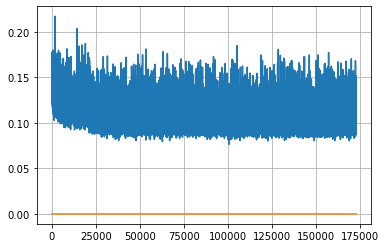

Epoch: 443, iteration 0, loss 0.09528139233589172, cov_diff 0.4041957771042914 cov_diff train 0.40267867241667704
Epoch: 443, iteration 1, loss 0.11685791611671448, cov_diff 0.41734051269721306 cov_diff train 0.4169888311409588
Epoch: 443, iteration 2, loss 0.09364467859268188, cov_diff 0.4027579630790368 cov_diff train 0.40239847504422604
Epoch: 443, iteration 3, loss 0.09433874487876892, cov_diff 0.3938528909871807 cov_diff train 0.39357179495349776
Epoch: 443, iteration 4, loss 0.10813310742378235, cov_diff 0.4195404067417846 cov_diff train 0.4203112507751683
Epoch: 443, iteration 5, loss 0.10076811909675598, cov_diff 0.3983418344751418 cov_diff train 0.3978483459214213
Epoch: 443, iteration 6, loss 0.10034850239753723, cov_diff 0.41706689476796494 cov_diff train 0.4166552799503032
Epoch: 443, iteration 7, loss 0.11405050754547119, cov_diff 0.39152280665499567 cov_diff train 0.390423915157355
Epoch: 443, iteration 8, loss 0.10851624608039856, cov_diff 0.4113334627019198 cov_diff tra

Epoch: 443, iteration 76, loss 0.10039183497428894, cov_diff 0.4107559977168188 cov_diff train 0.4103108705260151
Epoch: 443, iteration 77, loss 0.09930291771888733, cov_diff 0.40580364967809907 cov_diff train 0.40547738748487194
Epoch: 443, iteration 78, loss 0.08725360035896301, cov_diff 0.39853483865174605 cov_diff train 0.3984556682038707
Epoch: 443, iteration 79, loss 0.10579347610473633, cov_diff 0.4078855760256984 cov_diff train 0.40740549771289686
Epoch: 443, iteration 80, loss 0.09212839603424072, cov_diff 0.4023248416899034 cov_diff train 0.40207256697743265
Epoch: 443, iteration 81, loss 0.09521463513374329, cov_diff 0.40996943692776244 cov_diff train 0.40876685105830085
Epoch: 443, iteration 82, loss 0.09141454100608826, cov_diff 0.41242620828216286 cov_diff train 0.41276532169681335
Epoch: 443, iteration 83, loss 0.09951251745223999, cov_diff 0.4209077992964304 cov_diff train 0.42007212513485065
Epoch: 443, iteration 84, loss 0.09961384534835815, cov_diff 0.401643245828365

Epoch: 443, iteration 153, loss 0.1053636372089386, cov_diff 0.4132322811929962 cov_diff train 0.41343371487650216
Epoch: 443, iteration 154, loss 0.1148216724395752, cov_diff 0.4112803816685692 cov_diff train 0.4110217859728773
Epoch: 443, iteration 155, loss 0.11204487085342407, cov_diff 0.4040393709511627 cov_diff train 0.4029926888353578
Epoch: 443, iteration 156, loss 0.09650859236717224, cov_diff 0.4000211911359116 cov_diff train 0.3999608157203236
Epoch: 443, iteration 157, loss 0.11379143595695496, cov_diff 0.4119538131596335 cov_diff train 0.4100668203187638
Epoch: 443, iteration 158, loss 0.1139427125453949, cov_diff 0.41264205436559054 cov_diff train 0.41267230603251853
Epoch: 443, iteration 159, loss 0.10087919235229492, cov_diff 0.4106122580137694 cov_diff train 0.4105873886076848
Epoch: 443, iteration 160, loss 0.10574418306350708, cov_diff 0.41037650780198875 cov_diff train 0.409518686033662
Epoch: 443, iteration 161, loss 0.10196521878242493, cov_diff 0.4130406166689287

Epoch: 443, iteration 230, loss 0.09413164854049683, cov_diff 0.4160669317662818 cov_diff train 0.41541349759375035
Epoch: 443, iteration 231, loss 0.10209670662879944, cov_diff 0.4252389707493279 cov_diff train 0.42357271175564937
Epoch: 443, iteration 232, loss 0.10698512196540833, cov_diff 0.4125433762240032 cov_diff train 0.41147517548600177
Epoch: 443, iteration 233, loss 0.10718721151351929, cov_diff 0.4124002257420555 cov_diff train 0.411518446092523
Epoch: 443, iteration 234, loss 0.09765300154685974, cov_diff 0.41654451063573106 cov_diff train 0.4163916386598885
Epoch: 443, iteration 235, loss 0.09978631138801575, cov_diff 0.4117814330493587 cov_diff train 0.41130871005316944
Epoch: 443, iteration 236, loss 0.0966709554195404, cov_diff 0.4102596959506957 cov_diff train 0.4103256127434972
Epoch: 443, iteration 237, loss 0.10669052600860596, cov_diff 0.4079560115438374 cov_diff train 0.4075800847373127
Epoch: 443, iteration 238, loss 0.10487169027328491, cov_diff 0.4065365733653

Epoch: 443, iteration 305, loss 0.10389959812164307, cov_diff 0.40268515615793343 cov_diff train 0.4023240005156204
Epoch: 443, iteration 306, loss 0.11032932996749878, cov_diff 0.41544703031027114 cov_diff train 0.41556831780297787
Epoch: 443, iteration 307, loss 0.10387912392616272, cov_diff 0.40340489195681756 cov_diff train 0.40361004310360626
Epoch: 443, iteration 308, loss 0.10734337568283081, cov_diff 0.41595337786020986 cov_diff train 0.4149472455900391
Epoch: 443, iteration 309, loss 0.10110285878181458, cov_diff 0.4181955537372618 cov_diff train 0.4176455817224055
Epoch: 443, iteration 310, loss 0.10720977187156677, cov_diff 0.41106007814248036 cov_diff train 0.41043603762330433
Epoch: 443, iteration 311, loss 0.09174537658691406, cov_diff 0.4147083792814491 cov_diff train 0.41451863208776574
Epoch: 443, iteration 312, loss 0.09307867288589478, cov_diff 0.40411202662507295 cov_diff train 0.40412850815755874
Epoch: 443, iteration 313, loss 0.08579519391059875, cov_diff 0.40545

Epoch: 443, iteration 382, loss 0.10856088995933533, cov_diff 0.41202826835587253 cov_diff train 0.41175902772994394
Epoch: 443, iteration 383, loss 0.11548325419425964, cov_diff 0.4284717058001039 cov_diff train 0.4277783836321998
Epoch: 443, iteration 384, loss 0.09916427731513977, cov_diff 0.4150036326886227 cov_diff train 0.41360362588244776
Epoch: 443, iteration 385, loss 0.11773070693016052, cov_diff 0.4149292464007303 cov_diff train 0.41496234361545087
Epoch: 443, iteration 386, loss 0.09781947731971741, cov_diff 0.4219409190767829 cov_diff train 0.4198469030566365
Epoch: 443, iteration 387, loss 0.09453395009040833, cov_diff 0.42052611878686835 cov_diff train 0.41938104401178233
Epoch: 443, iteration 388, loss 0.10241958498954773, cov_diff 0.41908084885303487 cov_diff train 0.4181999663485215
Epoch: 443, iteration 389, loss 0.10136660933494568, cov_diff 0.4104007480173969 cov_diff train 0.40931538179547566
Epoch: 443, iteration 390, loss 0.14930343627929688, cov_diff 0.43818846

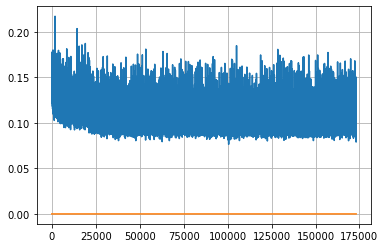

Epoch: 444, iteration 0, loss 0.10705551505088806, cov_diff 0.4118855570524591 cov_diff train 0.4104985435431598
Epoch: 444, iteration 1, loss 0.10367730259895325, cov_diff 0.41123073275072436 cov_diff train 0.4108994289592389
Epoch: 444, iteration 2, loss 0.09952282905578613, cov_diff 0.40817287041512806 cov_diff train 0.4074205280384852
Epoch: 444, iteration 3, loss 0.0850462019443512, cov_diff 0.4139507173159708 cov_diff train 0.4130697081179341
Epoch: 444, iteration 4, loss 0.11282649636268616, cov_diff 0.40924880243390205 cov_diff train 0.40808449787472956
Epoch: 444, iteration 5, loss 0.09823980927467346, cov_diff 0.4014242463138563 cov_diff train 0.4000544594592924
Epoch: 444, iteration 6, loss 0.09898552298545837, cov_diff 0.4267970256002157 cov_diff train 0.4258812271974834
Epoch: 444, iteration 7, loss 0.10864254832267761, cov_diff 0.41899829397883026 cov_diff train 0.41829432572437203
Epoch: 444, iteration 8, loss 0.1018809974193573, cov_diff 0.4140492525157719 cov_diff trai

Epoch: 444, iteration 78, loss 0.10146674513816833, cov_diff 0.4098758216936388 cov_diff train 0.40895239845137865
Epoch: 444, iteration 79, loss 0.10144168138504028, cov_diff 0.3979858006374757 cov_diff train 0.39749029624148674
Epoch: 444, iteration 80, loss 0.09016519784927368, cov_diff 0.41273514697093655 cov_diff train 0.41243052991923124
Epoch: 444, iteration 81, loss 0.10474929213523865, cov_diff 0.41590024661818004 cov_diff train 0.4157133577872239
Epoch: 444, iteration 82, loss 0.10100185871124268, cov_diff 0.4016377716303135 cov_diff train 0.40123979431992407
Epoch: 444, iteration 83, loss 0.10023492574691772, cov_diff 0.4120780467771272 cov_diff train 0.41100749356215527
Epoch: 444, iteration 84, loss 0.09799933433532715, cov_diff 0.41147916183404487 cov_diff train 0.41122408452843323
Epoch: 444, iteration 85, loss 0.10757902264595032, cov_diff 0.408799298032584 cov_diff train 0.4084326372089212
Epoch: 444, iteration 86, loss 0.1045120358467102, cov_diff 0.4068308874630653 c

Epoch: 444, iteration 156, loss 0.10934239625930786, cov_diff 0.41263043351094214 cov_diff train 0.4117043530693613
Epoch: 444, iteration 157, loss 0.09775933623313904, cov_diff 0.4113266320488298 cov_diff train 0.40995345215175016
Epoch: 444, iteration 158, loss 0.10852843523025513, cov_diff 0.4205911174532899 cov_diff train 0.4191758474545879
Epoch: 444, iteration 159, loss 0.10155203938484192, cov_diff 0.4205898813382231 cov_diff train 0.4195276716089457
Epoch: 444, iteration 160, loss 0.10323682427406311, cov_diff 0.4262859339584541 cov_diff train 0.42602582934594035
Epoch: 444, iteration 161, loss 0.10979005694389343, cov_diff 0.4043924837571575 cov_diff train 0.4044265832955082
Epoch: 444, iteration 162, loss 0.09525462985038757, cov_diff 0.4227479391782831 cov_diff train 0.42181068650247633
Epoch: 444, iteration 163, loss 0.10735562443733215, cov_diff 0.40625333134908015 cov_diff train 0.40615772490100377
Epoch: 444, iteration 164, loss 0.10678642988204956, cov_diff 0.4051951392

Epoch: 444, iteration 228, loss 0.11059749126434326, cov_diff 0.4044599855425686 cov_diff train 0.40359278608819044
Epoch: 444, iteration 229, loss 0.10677993297576904, cov_diff 0.4168911517990367 cov_diff train 0.41595714899122244
Epoch: 444, iteration 230, loss 0.10915225744247437, cov_diff 0.42866220777900205 cov_diff train 0.4280731331923579
Epoch: 444, iteration 231, loss 0.10787364840507507, cov_diff 0.419743224378691 cov_diff train 0.4188907150499244
Epoch: 444, iteration 232, loss 0.08491182327270508, cov_diff 0.41885414234259527 cov_diff train 0.4185126407756946
Epoch: 444, iteration 233, loss 0.11021509766578674, cov_diff 0.41690700812349474 cov_diff train 0.41609534104931484
Epoch: 444, iteration 234, loss 0.09078922867774963, cov_diff 0.40352938494435325 cov_diff train 0.40312345641956576
Epoch: 444, iteration 235, loss 0.092450350522995, cov_diff 0.42572737086564005 cov_diff train 0.42378536013060664
Epoch: 444, iteration 236, loss 0.10481533408164978, cov_diff 0.431581033

Epoch: 444, iteration 306, loss 0.09175139665603638, cov_diff 0.40904178010609943 cov_diff train 0.4084685921260702
Epoch: 444, iteration 307, loss 0.10120537877082825, cov_diff 0.40350145560266026 cov_diff train 0.4030949119100803
Epoch: 444, iteration 308, loss 0.12209591269493103, cov_diff 0.42436517177144517 cov_diff train 0.4232105462055387
Epoch: 444, iteration 309, loss 0.10128909349441528, cov_diff 0.41994583168873995 cov_diff train 0.4193584240995914
Epoch: 444, iteration 310, loss 0.10047101974487305, cov_diff 0.41247528094190133 cov_diff train 0.41150269236994286
Epoch: 444, iteration 311, loss 0.0972699224948883, cov_diff 0.40494051790035546 cov_diff train 0.4045717988278066
Epoch: 444, iteration 312, loss 0.11211660504341125, cov_diff 0.3986632995486227 cov_diff train 0.39805556697212385
Epoch: 444, iteration 313, loss 0.10144513845443726, cov_diff 0.41145285966346984 cov_diff train 0.4113541384478386
Epoch: 444, iteration 314, loss 0.10661071538925171, cov_diff 0.39605673

Epoch: 444, iteration 386, loss 0.1099194884300232, cov_diff 0.40114016272921016 cov_diff train 0.3997845247821696
Epoch: 444, iteration 387, loss 0.10142022371292114, cov_diff 0.40990961064771736 cov_diff train 0.4090690074529077
Epoch: 444, iteration 388, loss 0.11301860213279724, cov_diff 0.4208628286316076 cov_diff train 0.41915493974415274
Epoch: 444, iteration 389, loss 0.11857792735099792, cov_diff 0.4161606820183127 cov_diff train 0.4156124706474915
Epoch: 444, iteration 390, loss 0.14863890409469604, cov_diff 0.4511095590627854 cov_diff train 0.4498619689710746


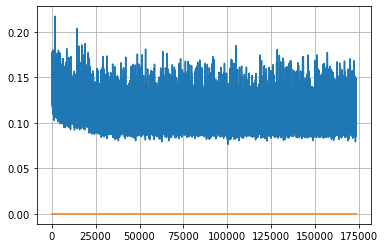

Epoch: 445, iteration 0, loss 0.10647481679916382, cov_diff 0.4163902910004051 cov_diff train 0.4154863304407252
Epoch: 445, iteration 1, loss 0.10956719517707825, cov_diff 0.40062895288890904 cov_diff train 0.39942626908030704
Epoch: 445, iteration 2, loss 0.10651233792304993, cov_diff 0.4183714016892785 cov_diff train 0.4163046596407388
Epoch: 445, iteration 3, loss 0.10348570346832275, cov_diff 0.41094919075105757 cov_diff train 0.41023510921398537
Epoch: 445, iteration 4, loss 0.10545617341995239, cov_diff 0.4095808095549348 cov_diff train 0.40824730864580694
Epoch: 445, iteration 5, loss 0.0952191948890686, cov_diff 0.40752007379641486 cov_diff train 0.40690250341313755
Epoch: 445, iteration 6, loss 0.12330740690231323, cov_diff 0.4095536465132358 cov_diff train 0.4085191972106804
Epoch: 445, iteration 7, loss 0.10130000114440918, cov_diff 0.3999986764699249 cov_diff train 0.4002152312102149
Epoch: 445, iteration 8, loss 0.11208894848823547, cov_diff 0.4077545689820425 cov_diff tr

Epoch: 445, iteration 79, loss 0.09621304273605347, cov_diff 0.404289774854377 cov_diff train 0.4029739717233615
Epoch: 445, iteration 80, loss 0.10915637016296387, cov_diff 0.42405573065303637 cov_diff train 0.42291984062945537
Epoch: 445, iteration 81, loss 0.10272252559661865, cov_diff 0.41394300015654606 cov_diff train 0.4137572928118067
Epoch: 445, iteration 82, loss 0.10005703568458557, cov_diff 0.41048311718444713 cov_diff train 0.41041786159995636
Epoch: 445, iteration 83, loss 0.10155937075614929, cov_diff 0.4112775777452508 cov_diff train 0.4109449574812257
Epoch: 445, iteration 84, loss 0.10289901494979858, cov_diff 0.39921007750785636 cov_diff train 0.3989565961800068
Epoch: 445, iteration 85, loss 0.09819477796554565, cov_diff 0.4182714113906565 cov_diff train 0.41791262949712105
Epoch: 445, iteration 86, loss 0.11691072583198547, cov_diff 0.41698372291543917 cov_diff train 0.4164577866758992
Epoch: 445, iteration 87, loss 0.09143126010894775, cov_diff 0.42336245745367224 

Epoch: 445, iteration 156, loss 0.09853965044021606, cov_diff 0.41144362250788463 cov_diff train 0.41038450559414885
Epoch: 445, iteration 157, loss 0.09712472558021545, cov_diff 0.41350242212485505 cov_diff train 0.41227921007168833
Epoch: 445, iteration 158, loss 0.10609334707260132, cov_diff 0.4085643472051492 cov_diff train 0.4082001768611411
Epoch: 445, iteration 159, loss 0.10409244894981384, cov_diff 0.42234997484597975 cov_diff train 0.4208564732807239
Epoch: 445, iteration 160, loss 0.11348974704742432, cov_diff 0.40975646189583204 cov_diff train 0.4097763510993467
Epoch: 445, iteration 161, loss 0.09574165940284729, cov_diff 0.4132147472776084 cov_diff train 0.4116949226998226
Epoch: 445, iteration 162, loss 0.0928155779838562, cov_diff 0.4058711742484695 cov_diff train 0.4044316193429854
Epoch: 445, iteration 163, loss 0.09976959228515625, cov_diff 0.41014523893812377 cov_diff train 0.408706322386146
Epoch: 445, iteration 164, loss 0.10752511024475098, cov_diff 0.41854909665

Epoch: 445, iteration 234, loss 0.0945533812046051, cov_diff 0.41791381825225477 cov_diff train 0.4169785138552523
Epoch: 445, iteration 235, loss 0.11312583088874817, cov_diff 0.41556328661342556 cov_diff train 0.4148061286262159
Epoch: 445, iteration 236, loss 0.09765511751174927, cov_diff 0.41315483951305054 cov_diff train 0.41242189524694994
Epoch: 445, iteration 237, loss 0.10488969087600708, cov_diff 0.40007366517264165 cov_diff train 0.399678228635173
Epoch: 445, iteration 238, loss 0.10339108109474182, cov_diff 0.4061175244354163 cov_diff train 0.4056784794425617
Epoch: 445, iteration 239, loss 0.11314854025840759, cov_diff 0.39669473507555486 cov_diff train 0.3964384451998355
Epoch: 445, iteration 240, loss 0.10086748003959656, cov_diff 0.41748576194880016 cov_diff train 0.4176389791541076
Epoch: 445, iteration 241, loss 0.10122835636138916, cov_diff 0.4167479528733749 cov_diff train 0.4161928117329707
Epoch: 445, iteration 242, loss 0.09945058822631836, cov_diff 0.40959406803

Epoch: 445, iteration 312, loss 0.0968901515007019, cov_diff 0.4078432206926454 cov_diff train 0.4079100100213238
Epoch: 445, iteration 313, loss 0.11687541007995605, cov_diff 0.4136523401086209 cov_diff train 0.4133902517906776
Epoch: 445, iteration 314, loss 0.10867112874984741, cov_diff 0.39380155971836195 cov_diff train 0.3931305004550456
Epoch: 445, iteration 315, loss 0.09305426478385925, cov_diff 0.4112934079187563 cov_diff train 0.4109482989095375
Epoch: 445, iteration 316, loss 0.10806003212928772, cov_diff 0.408969355214428 cov_diff train 0.40773976787450056
Epoch: 445, iteration 317, loss 0.09590703248977661, cov_diff 0.41035703312168254 cov_diff train 0.409592222965642
Epoch: 445, iteration 318, loss 0.1029433012008667, cov_diff 0.4080230907024538 cov_diff train 0.4080303728427569
Epoch: 445, iteration 319, loss 0.0977419912815094, cov_diff 0.4158833797908897 cov_diff train 0.41557203549494515
Epoch: 445, iteration 320, loss 0.10644754767417908, cov_diff 0.4197645520051159 

Epoch: 445, iteration 389, loss 0.09111997485160828, cov_diff 0.3999679253949907 cov_diff train 0.4000975711991726
Epoch: 445, iteration 390, loss 0.1494452953338623, cov_diff 0.44442767707202846 cov_diff train 0.4439541347280699


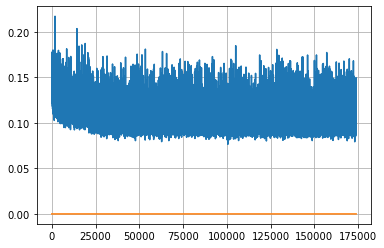

Epoch: 446, iteration 0, loss 0.09241363406181335, cov_diff 0.402310228395143 cov_diff train 0.40216553923168374
Epoch: 446, iteration 1, loss 0.10824072360992432, cov_diff 0.4114163679299066 cov_diff train 0.41088067251901633
Epoch: 446, iteration 2, loss 0.10713934898376465, cov_diff 0.39794948346698417 cov_diff train 0.3976182277633296
Epoch: 446, iteration 3, loss 0.1026778519153595, cov_diff 0.4007270908046764 cov_diff train 0.4007973742340013
Epoch: 446, iteration 4, loss 0.110493004322052, cov_diff 0.4071236564295529 cov_diff train 0.4071124342071947
Epoch: 446, iteration 5, loss 0.0961771011352539, cov_diff 0.41987789451125335 cov_diff train 0.4187591191625458
Epoch: 446, iteration 6, loss 0.08533179759979248, cov_diff 0.39809411278632856 cov_diff train 0.39799615800740606
Epoch: 446, iteration 7, loss 0.10547465085983276, cov_diff 0.41009749800563466 cov_diff train 0.4097291045102278
Epoch: 446, iteration 8, loss 0.09883609414100647, cov_diff 0.40825952487056033 cov_diff train

Epoch: 446, iteration 75, loss 0.10939007997512817, cov_diff 0.4197052977148708 cov_diff train 0.41930643011392393
Epoch: 446, iteration 76, loss 0.10998597741127014, cov_diff 0.42352632190364753 cov_diff train 0.4224946693857469
Epoch: 446, iteration 77, loss 0.12036514282226562, cov_diff 0.40669460993831885 cov_diff train 0.4062671030242881
Epoch: 446, iteration 78, loss 0.10800719261169434, cov_diff 0.4034984886200639 cov_diff train 0.4027187234929268
Epoch: 446, iteration 79, loss 0.10304978489875793, cov_diff 0.4075396167386677 cov_diff train 0.407625157105281
Epoch: 446, iteration 80, loss 0.09641125798225403, cov_diff 0.40345999494188584 cov_diff train 0.40189865957545634
Epoch: 446, iteration 81, loss 0.10244300961494446, cov_diff 0.41481890688511414 cov_diff train 0.4134505589569952
Epoch: 446, iteration 82, loss 0.09178969264030457, cov_diff 0.4188947862699739 cov_diff train 0.41855393845518335
Epoch: 446, iteration 83, loss 0.11403217911720276, cov_diff 0.4222313930256498 co

Epoch: 446, iteration 152, loss 0.0964803397655487, cov_diff 0.4079798158050823 cov_diff train 0.4075588958686456
Epoch: 446, iteration 153, loss 0.1116609275341034, cov_diff 0.41846363769216316 cov_diff train 0.41625401110173416
Epoch: 446, iteration 154, loss 0.09887045621871948, cov_diff 0.4111943059999541 cov_diff train 0.41107298503479545
Epoch: 446, iteration 155, loss 0.10311508178710938, cov_diff 0.41107194394725566 cov_diff train 0.41101206913804744
Epoch: 446, iteration 156, loss 0.09974634647369385, cov_diff 0.41802677755868495 cov_diff train 0.41829649191685103
Epoch: 446, iteration 157, loss 0.10398337244987488, cov_diff 0.4156915151970511 cov_diff train 0.4150418190254083
Epoch: 446, iteration 158, loss 0.08936372399330139, cov_diff 0.4188019306175284 cov_diff train 0.41848206160039325
Epoch: 446, iteration 159, loss 0.09801426529884338, cov_diff 0.41621291578246095 cov_diff train 0.4158142523676524
Epoch: 446, iteration 160, loss 0.10479617118835449, cov_diff 0.416721423

Epoch: 446, iteration 233, loss 0.09837126731872559, cov_diff 0.41463683626929193 cov_diff train 0.4133687528687388
Epoch: 446, iteration 234, loss 0.10094913840293884, cov_diff 0.4170116492860554 cov_diff train 0.41607699199202103
Epoch: 446, iteration 235, loss 0.10517281293869019, cov_diff 0.40098912152841704 cov_diff train 0.40057344555163377
Epoch: 446, iteration 236, loss 0.1135922372341156, cov_diff 0.4011553767526937 cov_diff train 0.4007169026470744
Epoch: 446, iteration 237, loss 0.10510721802711487, cov_diff 0.3984765152578368 cov_diff train 0.3983927062805287
Epoch: 446, iteration 238, loss 0.10285156965255737, cov_diff 0.40165998144345827 cov_diff train 0.40109397195643554
Epoch: 446, iteration 239, loss 0.10508248209953308, cov_diff 0.4092407796854501 cov_diff train 0.4079344566100474
Epoch: 446, iteration 240, loss 0.09097757935523987, cov_diff 0.4079715698229939 cov_diff train 0.4071042358256192
Epoch: 446, iteration 241, loss 0.10539877414703369, cov_diff 0.39592738575

Epoch: 446, iteration 308, loss 0.10258135199546814, cov_diff 0.4116250291577583 cov_diff train 0.41103233452497884
Epoch: 446, iteration 309, loss 0.10347706079483032, cov_diff 0.406406053427678 cov_diff train 0.40566739447332906
Epoch: 446, iteration 310, loss 0.1048460304737091, cov_diff 0.40795419023360396 cov_diff train 0.40715030806286706
Epoch: 446, iteration 311, loss 0.09754768013954163, cov_diff 0.41887158586769957 cov_diff train 0.41797596022031447
Epoch: 446, iteration 312, loss 0.09021905064582825, cov_diff 0.41509959371431976 cov_diff train 0.4142024402875418
Epoch: 446, iteration 313, loss 0.10692891478538513, cov_diff 0.4158551393402416 cov_diff train 0.4153841338535062
Epoch: 446, iteration 314, loss 0.09027883410453796, cov_diff 0.409263737286967 cov_diff train 0.4089452324241251
Epoch: 446, iteration 315, loss 0.10137638449668884, cov_diff 0.4070900871789181 cov_diff train 0.4060270056600338
Epoch: 446, iteration 316, loss 0.09629318118095398, cov_diff 0.412019804837

Epoch: 446, iteration 385, loss 0.09915202856063843, cov_diff 0.40321593354165797 cov_diff train 0.4021006254197433
Epoch: 446, iteration 386, loss 0.09780314564704895, cov_diff 0.403943987889573 cov_diff train 0.4020398668405749
Epoch: 446, iteration 387, loss 0.11213451623916626, cov_diff 0.4042758712097955 cov_diff train 0.401793223334205
Epoch: 446, iteration 388, loss 0.10022056102752686, cov_diff 0.4101996253739465 cov_diff train 0.40911760723432533
Epoch: 446, iteration 389, loss 0.09592315554618835, cov_diff 0.4016542940019802 cov_diff train 0.39968078423359343
Epoch: 446, iteration 390, loss 0.16004979610443115, cov_diff 0.4447777100884291 cov_diff train 0.44453049615879675


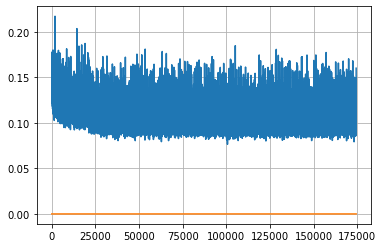

Epoch: 447, iteration 0, loss 0.11410701274871826, cov_diff 0.40737167623378834 cov_diff train 0.4066155893570732
Epoch: 447, iteration 1, loss 0.11430254578590393, cov_diff 0.40731023997354515 cov_diff train 0.40720403121986337
Epoch: 447, iteration 2, loss 0.10211336612701416, cov_diff 0.4046797605758905 cov_diff train 0.40428732852047483
Epoch: 447, iteration 3, loss 0.09944120049476624, cov_diff 0.407054930930336 cov_diff train 0.4064332866065325
Epoch: 447, iteration 4, loss 0.10742196440696716, cov_diff 0.3991260719614334 cov_diff train 0.3987248126238757
Epoch: 447, iteration 5, loss 0.10262599587440491, cov_diff 0.3975604197253191 cov_diff train 0.39683575458340664
Epoch: 447, iteration 6, loss 0.10065290331840515, cov_diff 0.4107870341764061 cov_diff train 0.4095407768638572
Epoch: 447, iteration 7, loss 0.10426706075668335, cov_diff 0.4065298830971853 cov_diff train 0.4071536036860158
Epoch: 447, iteration 8, loss 0.11017236113548279, cov_diff 0.41024950008729005 cov_diff tra

Epoch: 447, iteration 77, loss 0.08949258923530579, cov_diff 0.40342091495874277 cov_diff train 0.4025481493676847
Epoch: 447, iteration 78, loss 0.09088078141212463, cov_diff 0.4029141374907277 cov_diff train 0.40257890512795674
Epoch: 447, iteration 79, loss 0.10821160674095154, cov_diff 0.4315446873420861 cov_diff train 0.43104843588338587
Epoch: 447, iteration 80, loss 0.11257222294807434, cov_diff 0.4163471319721085 cov_diff train 0.4155040451416388
Epoch: 447, iteration 81, loss 0.09291446208953857, cov_diff 0.41322788305392527 cov_diff train 0.4127262980032726
Epoch: 447, iteration 82, loss 0.11011612415313721, cov_diff 0.4063158227539366 cov_diff train 0.4064404306949261
Epoch: 447, iteration 83, loss 0.10291153192520142, cov_diff 0.4112845966145829 cov_diff train 0.4109590596586691
Epoch: 447, iteration 84, loss 0.10527274012565613, cov_diff 0.4165775964796118 cov_diff train 0.41615558768432936
Epoch: 447, iteration 85, loss 0.08870038390159607, cov_diff 0.4089342251121189 cov

Epoch: 447, iteration 155, loss 0.10804897546768188, cov_diff 0.41399884033346507 cov_diff train 0.41299167981745505
Epoch: 447, iteration 156, loss 0.10244381427764893, cov_diff 0.39985787978395176 cov_diff train 0.3988270134941759
Epoch: 447, iteration 157, loss 0.11051544547080994, cov_diff 0.4096245858091742 cov_diff train 0.40881308711477915
Epoch: 447, iteration 158, loss 0.10396802425384521, cov_diff 0.4009618812028217 cov_diff train 0.4014701628641794
Epoch: 447, iteration 159, loss 0.09916168451309204, cov_diff 0.40482142237800417 cov_diff train 0.40454498271065503
Epoch: 447, iteration 160, loss 0.09149816632270813, cov_diff 0.4028111339317566 cov_diff train 0.4030760374135886
Epoch: 447, iteration 161, loss 0.10213607549667358, cov_diff 0.4091473606367978 cov_diff train 0.40842045814824124
Epoch: 447, iteration 162, loss 0.09917953610420227, cov_diff 0.415008870717786 cov_diff train 0.4142652300612443
Epoch: 447, iteration 163, loss 0.10541701316833496, cov_diff 0.4236884419

Epoch: 447, iteration 232, loss 0.09836909174919128, cov_diff 0.4139966040329484 cov_diff train 0.41343958644271067
Epoch: 447, iteration 233, loss 0.10187163949012756, cov_diff 0.40321559614801505 cov_diff train 0.4027777168133341
Epoch: 447, iteration 234, loss 0.10960564017295837, cov_diff 0.4202611915377278 cov_diff train 0.419731011439594
Epoch: 447, iteration 235, loss 0.09553778171539307, cov_diff 0.4145031115599094 cov_diff train 0.41309643226673304
Epoch: 447, iteration 236, loss 0.10293203592300415, cov_diff 0.4203069014945028 cov_diff train 0.41992564276324784
Epoch: 447, iteration 237, loss 0.0940713882446289, cov_diff 0.40866505909966966 cov_diff train 0.407988770951324
Epoch: 447, iteration 238, loss 0.11905097961425781, cov_diff 0.41884554305567 cov_diff train 0.4171139661322853
Epoch: 447, iteration 239, loss 0.10625356435775757, cov_diff 0.41611087524134255 cov_diff train 0.4148215431631341
Epoch: 447, iteration 240, loss 0.11177980899810791, cov_diff 0.403783807052249

Epoch: 447, iteration 310, loss 0.10828849673271179, cov_diff 0.42424088041885355 cov_diff train 0.42327941915917155
Epoch: 447, iteration 311, loss 0.11068588495254517, cov_diff 0.4231315613958227 cov_diff train 0.4227372431312041
Epoch: 447, iteration 312, loss 0.10664629936218262, cov_diff 0.4068353877325953 cov_diff train 0.40672115450029456
Epoch: 447, iteration 313, loss 0.10609996318817139, cov_diff 0.3990847103741874 cov_diff train 0.3989604875350992
Epoch: 447, iteration 314, loss 0.10011839866638184, cov_diff 0.39794923536118115 cov_diff train 0.39775742089740224
Epoch: 447, iteration 315, loss 0.10402083396911621, cov_diff 0.42627386222937297 cov_diff train 0.4257049050437641
Epoch: 447, iteration 316, loss 0.10365608334541321, cov_diff 0.41305367062475673 cov_diff train 0.4123526214253544
Epoch: 447, iteration 317, loss 0.09965801239013672, cov_diff 0.40369362252082824 cov_diff train 0.4023963795332237
Epoch: 447, iteration 318, loss 0.1083827018737793, cov_diff 0.398908985

Epoch: 447, iteration 389, loss 0.10631918907165527, cov_diff 0.4028486691580678 cov_diff train 0.4028669202348371
Epoch: 447, iteration 390, loss 0.15011775493621826, cov_diff 0.4480569873502594 cov_diff train 0.4488056814232451


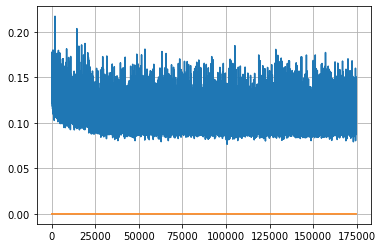

Epoch: 448, iteration 0, loss 0.11775434017181396, cov_diff 0.4159513653922031 cov_diff train 0.4167923431956787
Epoch: 448, iteration 1, loss 0.09629800915718079, cov_diff 0.41312576299457465 cov_diff train 0.41308189217115776
Epoch: 448, iteration 2, loss 0.10015428066253662, cov_diff 0.4180725425712629 cov_diff train 0.41789954662489737
Epoch: 448, iteration 3, loss 0.09806373715400696, cov_diff 0.40301543650003935 cov_diff train 0.40275225730097813
Epoch: 448, iteration 4, loss 0.10788273811340332, cov_diff 0.40647239766431076 cov_diff train 0.406182648043476
Epoch: 448, iteration 5, loss 0.09455224871635437, cov_diff 0.42974089590047154 cov_diff train 0.42946619788942336
Epoch: 448, iteration 6, loss 0.10830435156822205, cov_diff 0.4168154913269174 cov_diff train 0.41624275207449624
Epoch: 448, iteration 7, loss 0.1195826530456543, cov_diff 0.4081927349044404 cov_diff train 0.40751929897491324
Epoch: 448, iteration 8, loss 0.10430070757865906, cov_diff 0.42062988794230627 cov_diff

Epoch: 448, iteration 79, loss 0.10394051671028137, cov_diff 0.40021291964398165 cov_diff train 0.39976766740460756
Epoch: 448, iteration 80, loss 0.10878446698188782, cov_diff 0.40453585968132577 cov_diff train 0.4042467242530854
Epoch: 448, iteration 81, loss 0.1024213433265686, cov_diff 0.4089434526044194 cov_diff train 0.40890054236927953
Epoch: 448, iteration 82, loss 0.09813344478607178, cov_diff 0.39697859990596057 cov_diff train 0.3969267787650769
Epoch: 448, iteration 83, loss 0.10071113705635071, cov_diff 0.4118871577444252 cov_diff train 0.4114122147491331
Epoch: 448, iteration 84, loss 0.0974763035774231, cov_diff 0.42292381497295284 cov_diff train 0.4223180070535809
Epoch: 448, iteration 85, loss 0.10314729809761047, cov_diff 0.4100541014577773 cov_diff train 0.4092027910146174
Epoch: 448, iteration 86, loss 0.10267314314842224, cov_diff 0.4129668614959035 cov_diff train 0.4118538363112978
Epoch: 448, iteration 87, loss 0.10814559459686279, cov_diff 0.40910097199470463 cov

Epoch: 448, iteration 155, loss 0.11135834455490112, cov_diff 0.4133021280096388 cov_diff train 0.41267223437960127
Epoch: 448, iteration 156, loss 0.10288223624229431, cov_diff 0.4196865095990557 cov_diff train 0.4189324539316076
Epoch: 448, iteration 157, loss 0.10229086875915527, cov_diff 0.42217465488003103 cov_diff train 0.4200019214223793
Epoch: 448, iteration 158, loss 0.10074889659881592, cov_diff 0.4043473489434259 cov_diff train 0.404136982346392
Epoch: 448, iteration 159, loss 0.1003798246383667, cov_diff 0.4259517034789716 cov_diff train 0.4255709661802614
Epoch: 448, iteration 160, loss 0.10464662313461304, cov_diff 0.41863522690372007 cov_diff train 0.4189838498306587
Epoch: 448, iteration 161, loss 0.10936635732650757, cov_diff 0.3905278472574657 cov_diff train 0.3899643176878448
Epoch: 448, iteration 162, loss 0.10226663947105408, cov_diff 0.40048074953019563 cov_diff train 0.3990962537625094
Epoch: 448, iteration 163, loss 0.10423645377159119, cov_diff 0.40368209853882

Epoch: 448, iteration 233, loss 0.10397714376449585, cov_diff 0.4239015899164815 cov_diff train 0.4229529717975785
Epoch: 448, iteration 234, loss 0.09802037477493286, cov_diff 0.4184766115141911 cov_diff train 0.4181737061386312
Epoch: 448, iteration 235, loss 0.09534791111946106, cov_diff 0.41831833497812465 cov_diff train 0.41800790202969146
Epoch: 448, iteration 236, loss 0.09472081065177917, cov_diff 0.40977292888186445 cov_diff train 0.40891915181094324
Epoch: 448, iteration 237, loss 0.09930744767189026, cov_diff 0.4037465147071383 cov_diff train 0.40303784935166326
Epoch: 448, iteration 238, loss 0.10362240672111511, cov_diff 0.4121423271189991 cov_diff train 0.4118052524367952
Epoch: 448, iteration 239, loss 0.09898641705513, cov_diff 0.41523799265236755 cov_diff train 0.4142915242201216
Epoch: 448, iteration 240, loss 0.1019245982170105, cov_diff 0.4117771356566238 cov_diff train 0.410908550881313
Epoch: 448, iteration 241, loss 0.0926363468170166, cov_diff 0.4225188036899115

Epoch: 448, iteration 310, loss 0.10430952906608582, cov_diff 0.4246226496613333 cov_diff train 0.4231834321213184
Epoch: 448, iteration 311, loss 0.10387465357780457, cov_diff 0.4234815196831477 cov_diff train 0.4231503493915468
Epoch: 448, iteration 312, loss 0.10516810417175293, cov_diff 0.3931722765232271 cov_diff train 0.3914833998619705
Epoch: 448, iteration 313, loss 0.1022162139415741, cov_diff 0.40690014831392995 cov_diff train 0.4054127073462419
Epoch: 448, iteration 314, loss 0.10418406128883362, cov_diff 0.40391711989989865 cov_diff train 0.4040645723447284
Epoch: 448, iteration 315, loss 0.1029018759727478, cov_diff 0.4048790294026576 cov_diff train 0.4052089036339462
Epoch: 448, iteration 316, loss 0.0986890196800232, cov_diff 0.4079197554428017 cov_diff train 0.4075133624906698
Epoch: 448, iteration 317, loss 0.10403430461883545, cov_diff 0.4129605695062636 cov_diff train 0.4129323360878017
Epoch: 448, iteration 318, loss 0.09116888046264648, cov_diff 0.4134887197603419 

Epoch: 448, iteration 386, loss 0.09844404458999634, cov_diff 0.4112948360258716 cov_diff train 0.4106006285223721
Epoch: 448, iteration 387, loss 0.11802774667739868, cov_diff 0.4002359449052352 cov_diff train 0.39885439316363225
Epoch: 448, iteration 388, loss 0.10766738653182983, cov_diff 0.41353317228440456 cov_diff train 0.4124560926615929
Epoch: 448, iteration 389, loss 0.10244590044021606, cov_diff 0.4086409105456774 cov_diff train 0.40689371298074734
Epoch: 448, iteration 390, loss 0.15450087189674377, cov_diff 0.46265733924302377 cov_diff train 0.46203783080315447


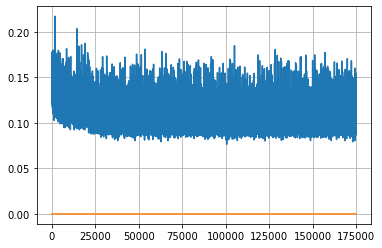

Epoch: 449, iteration 0, loss 0.10398128628730774, cov_diff 0.41584967186668464 cov_diff train 0.4147160896676114
Epoch: 449, iteration 1, loss 0.10768580436706543, cov_diff 0.3984678936681534 cov_diff train 0.39769015984057354
Epoch: 449, iteration 2, loss 0.10334420204162598, cov_diff 0.4083402279410107 cov_diff train 0.4073404026416536
Epoch: 449, iteration 3, loss 0.10075482726097107, cov_diff 0.40872329625266085 cov_diff train 0.40893018073222287
Epoch: 449, iteration 4, loss 0.11812523007392883, cov_diff 0.4196303980073427 cov_diff train 0.4186907427877056
Epoch: 449, iteration 5, loss 0.11567926406860352, cov_diff 0.4043711253803658 cov_diff train 0.40427672296298495
Epoch: 449, iteration 6, loss 0.09838294982910156, cov_diff 0.4073236718535045 cov_diff train 0.4069573431401818
Epoch: 449, iteration 7, loss 0.09678423404693604, cov_diff 0.41688412574448525 cov_diff train 0.4169778158609963
Epoch: 449, iteration 8, loss 0.1115645170211792, cov_diff 0.41643391133018387 cov_diff tr

Epoch: 449, iteration 80, loss 0.0971655547618866, cov_diff 0.41646384221064103 cov_diff train 0.4161885228335952
Epoch: 449, iteration 81, loss 0.1035294234752655, cov_diff 0.41242156932880975 cov_diff train 0.412289363662948
Epoch: 449, iteration 82, loss 0.10113880038261414, cov_diff 0.40101094878362437 cov_diff train 0.3996473363866533
Epoch: 449, iteration 83, loss 0.09533706307411194, cov_diff 0.4087227748180305 cov_diff train 0.40766193720528704
Epoch: 449, iteration 84, loss 0.10467800498008728, cov_diff 0.40465665933181116 cov_diff train 0.40393897337360724
Epoch: 449, iteration 85, loss 0.10064318776130676, cov_diff 0.417704219748766 cov_diff train 0.4169629413295783
Epoch: 449, iteration 86, loss 0.10868984460830688, cov_diff 0.4210356899623823 cov_diff train 0.4208946350379621
Epoch: 449, iteration 87, loss 0.10003909468650818, cov_diff 0.4121793992160755 cov_diff train 0.41199981249851625
Epoch: 449, iteration 88, loss 0.10851854085922241, cov_diff 0.40199952339501016 cov_

Epoch: 449, iteration 162, loss 0.1121290922164917, cov_diff 0.40330756478962626 cov_diff train 0.40265719162712765
Epoch: 449, iteration 163, loss 0.10217979550361633, cov_diff 0.40333953734444933 cov_diff train 0.4027415962640709
Epoch: 449, iteration 164, loss 0.09863290190696716, cov_diff 0.4096191565329789 cov_diff train 0.4086526641162367
Epoch: 449, iteration 165, loss 0.10698601603507996, cov_diff 0.4071083336369797 cov_diff train 0.4064983889834437
Epoch: 449, iteration 166, loss 0.11450833082199097, cov_diff 0.41341801853816124 cov_diff train 0.4127546899421415
Epoch: 449, iteration 167, loss 0.11237159371376038, cov_diff 0.41559871636127793 cov_diff train 0.41411120173418986
Epoch: 449, iteration 168, loss 0.11336922645568848, cov_diff 0.4192696006780117 cov_diff train 0.4178654109242678
Epoch: 449, iteration 169, loss 0.1126413643360138, cov_diff 0.41389947758789336 cov_diff train 0.41246112686671565
Epoch: 449, iteration 170, loss 0.10285302996635437, cov_diff 0.4039731059

Epoch: 449, iteration 242, loss 0.09723404049873352, cov_diff 0.3946752481968186 cov_diff train 0.3941436694489397
Epoch: 449, iteration 243, loss 0.10275402665138245, cov_diff 0.42131124078221727 cov_diff train 0.42050337223071776
Epoch: 449, iteration 244, loss 0.0905153751373291, cov_diff 0.4109531080353153 cov_diff train 0.4099260607524344
Epoch: 449, iteration 245, loss 0.1013353168964386, cov_diff 0.39727942123732957 cov_diff train 0.39665708322018056
Epoch: 449, iteration 246, loss 0.10530561208724976, cov_diff 0.4192204661357557 cov_diff train 0.41893342754667107
Epoch: 449, iteration 247, loss 0.09985661506652832, cov_diff 0.40703472394908935 cov_diff train 0.40716495973345845
Epoch: 449, iteration 248, loss 0.10680156946182251, cov_diff 0.42099924185637466 cov_diff train 0.41918995346111243
Epoch: 449, iteration 249, loss 0.10438540577888489, cov_diff 0.41793323039382696 cov_diff train 0.41745502776693366
Epoch: 449, iteration 250, loss 0.10491612553596497, cov_diff 0.4072493

Epoch: 449, iteration 320, loss 0.1116909384727478, cov_diff 0.4054827293105387 cov_diff train 0.40439430438182694
Epoch: 449, iteration 321, loss 0.12324860692024231, cov_diff 0.40360462220867366 cov_diff train 0.40354465410269097
Epoch: 449, iteration 322, loss 0.10453790426254272, cov_diff 0.4109729549495232 cov_diff train 0.41011197807940786
Epoch: 449, iteration 323, loss 0.10426491498947144, cov_diff 0.42100312001142387 cov_diff train 0.4198580145788047
Epoch: 449, iteration 324, loss 0.1008530855178833, cov_diff 0.40934711495899495 cov_diff train 0.40913103826243
Epoch: 449, iteration 325, loss 0.09635254740715027, cov_diff 0.4053754020570117 cov_diff train 0.40454106357420444
Epoch: 449, iteration 326, loss 0.1094825267791748, cov_diff 0.40758916844735554 cov_diff train 0.40653850168278977
Epoch: 449, iteration 327, loss 0.10637584328651428, cov_diff 0.4081997144819799 cov_diff train 0.40698783365297214
Epoch: 449, iteration 328, loss 0.09442779421806335, cov_diff 0.39674438529

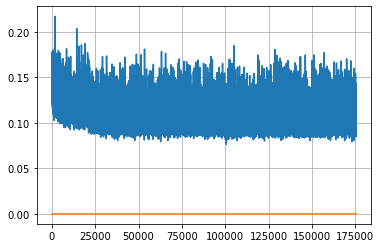

Epoch: 450, iteration 0, loss 0.09784123301506042, cov_diff 0.4044391945979823 cov_diff train 0.4041521784146378
Epoch: 450, iteration 1, loss 0.09481561183929443, cov_diff 0.4203248314857201 cov_diff train 0.4194964885373552
Epoch: 450, iteration 2, loss 0.11135786771774292, cov_diff 0.41153331781533947 cov_diff train 0.4102332669997593
Epoch: 450, iteration 3, loss 0.09663665294647217, cov_diff 0.40996303832473785 cov_diff train 0.40981145371625116
Epoch: 450, iteration 4, loss 0.1067330539226532, cov_diff 0.39760481642190826 cov_diff train 0.39686618674321855
Epoch: 450, iteration 5, loss 0.10374444723129272, cov_diff 0.4226694909003619 cov_diff train 0.4222415249018789
Epoch: 450, iteration 6, loss 0.10598355531692505, cov_diff 0.4200863933015061 cov_diff train 0.41941331710533786
Epoch: 450, iteration 7, loss 0.09672492742538452, cov_diff 0.4187445273283795 cov_diff train 0.41845948822469164
Epoch: 450, iteration 8, loss 0.09773126244544983, cov_diff 0.41156336581695496 cov_diff t

Epoch: 450, iteration 79, loss 0.10673198103904724, cov_diff 0.4247130136356878 cov_diff train 0.42321660095903096
Epoch: 450, iteration 80, loss 0.10760495066642761, cov_diff 0.41170770998899425 cov_diff train 0.4113739926870534
Epoch: 450, iteration 81, loss 0.10174903273582458, cov_diff 0.412664719858838 cov_diff train 0.4119595643262583
Epoch: 450, iteration 82, loss 0.09836450219154358, cov_diff 0.41764150325895605 cov_diff train 0.41665376033800366
Epoch: 450, iteration 83, loss 0.10488751530647278, cov_diff 0.4018747543431347 cov_diff train 0.4014629367625936
Epoch: 450, iteration 84, loss 0.10570025444030762, cov_diff 0.41615583825268876 cov_diff train 0.4142482722508403
Epoch: 450, iteration 85, loss 0.1002461314201355, cov_diff 0.40850477068494695 cov_diff train 0.4062933652545618
Epoch: 450, iteration 86, loss 0.10843107104301453, cov_diff 0.41562031451161624 cov_diff train 0.41368922145322334
Epoch: 450, iteration 87, loss 0.0920109748840332, cov_diff 0.40542695990851424 co

Epoch: 450, iteration 158, loss 0.10536369681358337, cov_diff 0.4172890994337103 cov_diff train 0.417032068657912
Epoch: 450, iteration 159, loss 0.10262453556060791, cov_diff 0.40642803765747754 cov_diff train 0.40548188347704334
Epoch: 450, iteration 160, loss 0.09249576926231384, cov_diff 0.4095146712688108 cov_diff train 0.4090136006739539
Epoch: 450, iteration 161, loss 0.10935190320014954, cov_diff 0.40794141849707066 cov_diff train 0.4062636825543035
Epoch: 450, iteration 162, loss 0.1152983009815216, cov_diff 0.41283024126944334 cov_diff train 0.4122935122536363
Epoch: 450, iteration 163, loss 0.10742297768592834, cov_diff 0.41081656902534336 cov_diff train 0.4098919709321966
Epoch: 450, iteration 164, loss 0.0997622013092041, cov_diff 0.4151550487901915 cov_diff train 0.4131651537622657
Epoch: 450, iteration 165, loss 0.10317277908325195, cov_diff 0.40262836836800486 cov_diff train 0.4021690927971376
Epoch: 450, iteration 166, loss 0.09855735301971436, cov_diff 0.4123672631874

Epoch: 450, iteration 237, loss 0.10366880893707275, cov_diff 0.39717688424189784 cov_diff train 0.39630584373535405
Epoch: 450, iteration 238, loss 0.09859207272529602, cov_diff 0.41628640112391574 cov_diff train 0.414885201788683
Epoch: 450, iteration 239, loss 0.10435080528259277, cov_diff 0.4231023669966466 cov_diff train 0.4213192870550233
Epoch: 450, iteration 240, loss 0.12130916118621826, cov_diff 0.4030788111691448 cov_diff train 0.402281797528663
Epoch: 450, iteration 241, loss 0.11425945162773132, cov_diff 0.39644518203811413 cov_diff train 0.3961048629852798
Epoch: 450, iteration 242, loss 0.09700071811676025, cov_diff 0.4136160314901595 cov_diff train 0.41293435189018163
Epoch: 450, iteration 243, loss 0.10027638077735901, cov_diff 0.41146530204052567 cov_diff train 0.41046713362822446
Epoch: 450, iteration 244, loss 0.10384199023246765, cov_diff 0.4098916720676966 cov_diff train 0.409116742286501
Epoch: 450, iteration 245, loss 0.11264801025390625, cov_diff 0.409024774892

Epoch: 450, iteration 315, loss 0.09627696871757507, cov_diff 0.4030604464684374 cov_diff train 0.40230854108741027
Epoch: 450, iteration 316, loss 0.09911724925041199, cov_diff 0.4029473576943126 cov_diff train 0.40236539250776504
Epoch: 450, iteration 317, loss 0.10196399688720703, cov_diff 0.4091921804878206 cov_diff train 0.408754207600519
Epoch: 450, iteration 318, loss 0.10141924023628235, cov_diff 0.4238758812659535 cov_diff train 0.42321986199233463
Epoch: 450, iteration 319, loss 0.10807564854621887, cov_diff 0.4104586196103586 cov_diff train 0.4085943299162395
Epoch: 450, iteration 320, loss 0.10910367965698242, cov_diff 0.4089453295006813 cov_diff train 0.4077265161949363
Epoch: 450, iteration 321, loss 0.10722443461418152, cov_diff 0.4118978628815577 cov_diff train 0.4113162648612291
Epoch: 450, iteration 322, loss 0.10672926902770996, cov_diff 0.41959827328759675 cov_diff train 0.41908684615655556
Epoch: 450, iteration 323, loss 0.10379835963249207, cov_diff 0.408404330372

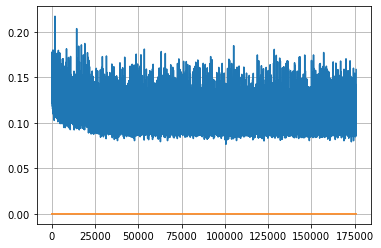

Epoch: 451, iteration 0, loss 0.10143133997917175, cov_diff 0.4075446826916373 cov_diff train 0.40626057875348176
Epoch: 451, iteration 1, loss 0.10380208492279053, cov_diff 0.423732589068345 cov_diff train 0.4227739850588134
Epoch: 451, iteration 2, loss 0.09721395373344421, cov_diff 0.400806925057104 cov_diff train 0.39990910167412547
Epoch: 451, iteration 3, loss 0.10131177306175232, cov_diff 0.41030657800808035 cov_diff train 0.4095537170933933
Epoch: 451, iteration 4, loss 0.10449829697608948, cov_diff 0.40538144662736253 cov_diff train 0.403922462057908
Epoch: 451, iteration 5, loss 0.09537160396575928, cov_diff 0.40389048081533874 cov_diff train 0.40269687210352817
Epoch: 451, iteration 6, loss 0.10666406154632568, cov_diff 0.4101265036013204 cov_diff train 0.4089426762036548
Epoch: 451, iteration 7, loss 0.10514363646507263, cov_diff 0.41273858312810013 cov_diff train 0.412431402904858
Epoch: 451, iteration 8, loss 0.10353231430053711, cov_diff 0.42217721396090563 cov_diff trai

Epoch: 451, iteration 78, loss 0.11546838283538818, cov_diff 0.3996701426846658 cov_diff train 0.3996724791713552
Epoch: 451, iteration 79, loss 0.10437795519828796, cov_diff 0.40293567760960536 cov_diff train 0.40277444601121115
Epoch: 451, iteration 80, loss 0.09882158041000366, cov_diff 0.4088507605066521 cov_diff train 0.4088872240717969
Epoch: 451, iteration 81, loss 0.09352827072143555, cov_diff 0.40708880601335146 cov_diff train 0.40718399046051396
Epoch: 451, iteration 82, loss 0.10965386033058167, cov_diff 0.40972497185228995 cov_diff train 0.40931491386809304
Epoch: 451, iteration 83, loss 0.10131841897964478, cov_diff 0.40736136045507687 cov_diff train 0.4068936619923219
Epoch: 451, iteration 84, loss 0.10550752282142639, cov_diff 0.4167514180415534 cov_diff train 0.4163769437072735
Epoch: 451, iteration 85, loss 0.11047276854515076, cov_diff 0.40761574038850507 cov_diff train 0.40725524345606695
Epoch: 451, iteration 86, loss 0.11138588190078735, cov_diff 0.4111787830760416

Epoch: 451, iteration 155, loss 0.10796922445297241, cov_diff 0.4039085944197956 cov_diff train 0.4035605819544204
Epoch: 451, iteration 156, loss 0.10728031396865845, cov_diff 0.42282248840349806 cov_diff train 0.4220635846303831
Epoch: 451, iteration 157, loss 0.1114971935749054, cov_diff 0.4246192179176626 cov_diff train 0.4234652500224518
Epoch: 451, iteration 158, loss 0.10622021555900574, cov_diff 0.41735338933685223 cov_diff train 0.4168418074097345
Epoch: 451, iteration 159, loss 0.1121765673160553, cov_diff 0.41606065149710053 cov_diff train 0.41559123891485017
Epoch: 451, iteration 160, loss 0.10030850768089294, cov_diff 0.4136010539600805 cov_diff train 0.4132556399757043
Epoch: 451, iteration 161, loss 0.11615011096000671, cov_diff 0.4228860832818124 cov_diff train 0.4216706371485044
Epoch: 451, iteration 162, loss 0.10919538140296936, cov_diff 0.41406042873524884 cov_diff train 0.4139447079806681
Epoch: 451, iteration 163, loss 0.11600947380065918, cov_diff 0.4075579329711

Epoch: 451, iteration 233, loss 0.09599959850311279, cov_diff 0.4168916622236005 cov_diff train 0.4155258853882021
Epoch: 451, iteration 234, loss 0.09384015202522278, cov_diff 0.398668029856359 cov_diff train 0.39807851927488236
Epoch: 451, iteration 235, loss 0.10035908222198486, cov_diff 0.4201137484811902 cov_diff train 0.4202093350064448
Epoch: 451, iteration 236, loss 0.10955935716629028, cov_diff 0.4299393963823983 cov_diff train 0.42921298053271434
Epoch: 451, iteration 237, loss 0.10994115471839905, cov_diff 0.4117693118570889 cov_diff train 0.41014729951294365
Epoch: 451, iteration 238, loss 0.10998326539993286, cov_diff 0.41042226785219793 cov_diff train 0.4098968338278731
Epoch: 451, iteration 239, loss 0.11000815033912659, cov_diff 0.41234708806012077 cov_diff train 0.4124922703661304
Epoch: 451, iteration 240, loss 0.0994807779788971, cov_diff 0.4129290470225921 cov_diff train 0.41328422989925045
Epoch: 451, iteration 241, loss 0.09891548752784729, cov_diff 0.406172986929

Epoch: 451, iteration 312, loss 0.10323485732078552, cov_diff 0.39091724279583867 cov_diff train 0.39091172217672515
Epoch: 451, iteration 313, loss 0.09722232818603516, cov_diff 0.4035132395140626 cov_diff train 0.40331309128644494
Epoch: 451, iteration 314, loss 0.10189899802207947, cov_diff 0.4046092315713274 cov_diff train 0.4041485500282723
Epoch: 451, iteration 315, loss 0.08699220418930054, cov_diff 0.4027423247103383 cov_diff train 0.4024385033323767
Epoch: 451, iteration 316, loss 0.09848365187644958, cov_diff 0.41340069196487506 cov_diff train 0.4125652278781488
Epoch: 451, iteration 317, loss 0.11476227641105652, cov_diff 0.4210989251999992 cov_diff train 0.42094851825208185
Epoch: 451, iteration 318, loss 0.09260198473930359, cov_diff 0.41430389540137075 cov_diff train 0.4127647880960054
Epoch: 451, iteration 319, loss 0.10235369205474854, cov_diff 0.40926203655131727 cov_diff train 0.40819309706652057
Epoch: 451, iteration 320, loss 0.10590317845344543, cov_diff 0.41946220

Epoch: 451, iteration 389, loss 0.09805300831794739, cov_diff 0.413265055193899 cov_diff train 0.4125189137398226
Epoch: 451, iteration 390, loss 0.14058703184127808, cov_diff 0.4559175921712347 cov_diff train 0.45434602301724486


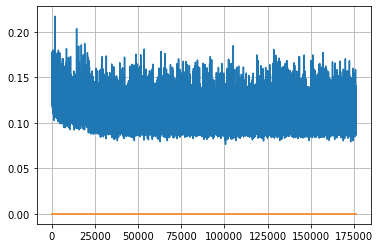

Epoch: 452, iteration 0, loss 0.09312820434570312, cov_diff 0.4041410053718063 cov_diff train 0.4033848393563909
Epoch: 452, iteration 1, loss 0.1002206802368164, cov_diff 0.4171475906276808 cov_diff train 0.41681826442207953
Epoch: 452, iteration 2, loss 0.10443651676177979, cov_diff 0.4121326522221404 cov_diff train 0.4118296867300663
Epoch: 452, iteration 3, loss 0.1139129102230072, cov_diff 0.42179103711549315 cov_diff train 0.4213720699854631
Epoch: 452, iteration 4, loss 0.09819892048835754, cov_diff 0.40408211383366255 cov_diff train 0.40379051412955097
Epoch: 452, iteration 5, loss 0.1012738049030304, cov_diff 0.4178763372302972 cov_diff train 0.41723289489837895
Epoch: 452, iteration 6, loss 0.1020401120185852, cov_diff 0.40507473781814246 cov_diff train 0.40485308091067124
Epoch: 452, iteration 7, loss 0.09511509537696838, cov_diff 0.4195854710587005 cov_diff train 0.4192106795435889
Epoch: 452, iteration 8, loss 0.10444808006286621, cov_diff 0.411190075428208 cov_diff train 

Epoch: 452, iteration 77, loss 0.10679128766059875, cov_diff 0.40972680271338036 cov_diff train 0.409371520252773
Epoch: 452, iteration 78, loss 0.10623478889465332, cov_diff 0.42105224270215197 cov_diff train 0.42064632496831567
Epoch: 452, iteration 79, loss 0.11218592524528503, cov_diff 0.4059298260063129 cov_diff train 0.40584382392474383
Epoch: 452, iteration 80, loss 0.0978240966796875, cov_diff 0.4030570228528621 cov_diff train 0.4022077737087531
Epoch: 452, iteration 81, loss 0.09870147705078125, cov_diff 0.4189545722390005 cov_diff train 0.4177570920644154
Epoch: 452, iteration 82, loss 0.10834512114524841, cov_diff 0.41970541420112584 cov_diff train 0.4176353234883608
Epoch: 452, iteration 83, loss 0.10893958806991577, cov_diff 0.4266224510095541 cov_diff train 0.4255924705453947
Epoch: 452, iteration 84, loss 0.10639089345932007, cov_diff 0.4113264683888991 cov_diff train 0.4096187048364258
Epoch: 452, iteration 85, loss 0.09546011686325073, cov_diff 0.405232318964364 cov_di

Epoch: 452, iteration 154, loss 0.10104519128799438, cov_diff 0.41109081825095706 cov_diff train 0.41074040614146534
Epoch: 452, iteration 155, loss 0.10469439625740051, cov_diff 0.4205185079505816 cov_diff train 0.4200861561202339
Epoch: 452, iteration 156, loss 0.10479748249053955, cov_diff 0.40874158236535346 cov_diff train 0.40787068765063267
Epoch: 452, iteration 157, loss 0.09714940190315247, cov_diff 0.4018829732047133 cov_diff train 0.402703560402712
Epoch: 452, iteration 158, loss 0.09929630160331726, cov_diff 0.4109067019431823 cov_diff train 0.41008919965766216
Epoch: 452, iteration 159, loss 0.10176289081573486, cov_diff 0.39246475418919813 cov_diff train 0.3925896675510367
Epoch: 452, iteration 160, loss 0.09818065166473389, cov_diff 0.39149012035544767 cov_diff train 0.3905114966080183
Epoch: 452, iteration 161, loss 0.10451322793960571, cov_diff 0.4228175395002341 cov_diff train 0.42226671960852036
Epoch: 452, iteration 162, loss 0.09829676151275635, cov_diff 0.412382137

Epoch: 452, iteration 231, loss 0.10948583483695984, cov_diff 0.4097108130494888 cov_diff train 0.4087402834151141
Epoch: 452, iteration 232, loss 0.11215069890022278, cov_diff 0.4099700440409732 cov_diff train 0.4091634458665683
Epoch: 452, iteration 233, loss 0.09925898909568787, cov_diff 0.40628058954539803 cov_diff train 0.40587415588471465
Epoch: 452, iteration 234, loss 0.1065305769443512, cov_diff 0.40515475790996147 cov_diff train 0.4053945437315801
Epoch: 452, iteration 235, loss 0.09792396426200867, cov_diff 0.414212788927818 cov_diff train 0.41407242231653035
Epoch: 452, iteration 236, loss 0.09741207957267761, cov_diff 0.39653548409749434 cov_diff train 0.3967637684549272
Epoch: 452, iteration 237, loss 0.10951399803161621, cov_diff 0.41157984379055246 cov_diff train 0.4115976412368972
Epoch: 452, iteration 238, loss 0.11336886882781982, cov_diff 0.4109698664536183 cov_diff train 0.409789625014766
Epoch: 452, iteration 239, loss 0.11814925074577332, cov_diff 0.4112166751645

Epoch: 452, iteration 308, loss 0.09967350959777832, cov_diff 0.4149587115458809 cov_diff train 0.4141703423240387
Epoch: 452, iteration 309, loss 0.09770527482032776, cov_diff 0.41766553470441414 cov_diff train 0.41733077691782505
Epoch: 452, iteration 310, loss 0.10230669379234314, cov_diff 0.4104486379952155 cov_diff train 0.4093911050352625
Epoch: 452, iteration 311, loss 0.09659841656684875, cov_diff 0.3980388740113001 cov_diff train 0.3978907290726769
Epoch: 452, iteration 312, loss 0.10236352682113647, cov_diff 0.3997078265551086 cov_diff train 0.3992166427103762
Epoch: 452, iteration 313, loss 0.10585352778434753, cov_diff 0.4075734303006515 cov_diff train 0.4067696868423867
Epoch: 452, iteration 314, loss 0.09705054759979248, cov_diff 0.42193926977082064 cov_diff train 0.42087333248882486
Epoch: 452, iteration 315, loss 0.10348311066627502, cov_diff 0.41526637429607743 cov_diff train 0.4152195685678406
Epoch: 452, iteration 316, loss 0.09706741571426392, cov_diff 0.43298314089

Epoch: 452, iteration 386, loss 0.10314470529556274, cov_diff 0.4062585620305559 cov_diff train 0.40566732589970045
Epoch: 452, iteration 387, loss 0.10250350832939148, cov_diff 0.41045924485692475 cov_diff train 0.4098770284980605
Epoch: 452, iteration 388, loss 0.1139211356639862, cov_diff 0.405922871188009 cov_diff train 0.4059657427351619
Epoch: 452, iteration 389, loss 0.10435384511947632, cov_diff 0.4187928121257854 cov_diff train 0.4194501861372395
Epoch: 452, iteration 390, loss 0.14818120002746582, cov_diff 0.44190600394345464 cov_diff train 0.44141052475138626


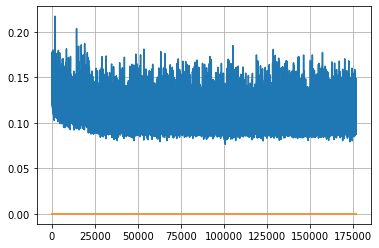

Epoch: 453, iteration 0, loss 0.09283077716827393, cov_diff 0.41144478682618046 cov_diff train 0.4105134085291187
Epoch: 453, iteration 1, loss 0.09965088963508606, cov_diff 0.4046839678032772 cov_diff train 0.40407808721786576
Epoch: 453, iteration 2, loss 0.10911828279495239, cov_diff 0.4256506923289405 cov_diff train 0.4251660110359043
Epoch: 453, iteration 3, loss 0.09395775198936462, cov_diff 0.41313685641737063 cov_diff train 0.41259643933177576
Epoch: 453, iteration 4, loss 0.10407361388206482, cov_diff 0.4122102401527309 cov_diff train 0.4122650961722413
Epoch: 453, iteration 5, loss 0.10261672735214233, cov_diff 0.4055785124812562 cov_diff train 0.4046279822736112
Epoch: 453, iteration 6, loss 0.09857767820358276, cov_diff 0.40968496726203696 cov_diff train 0.40835748222991886
Epoch: 453, iteration 7, loss 0.10172364115715027, cov_diff 0.4113520795564624 cov_diff train 0.411512357576407
Epoch: 453, iteration 8, loss 0.09445852041244507, cov_diff 0.4157637330995732 cov_diff tra

Epoch: 453, iteration 77, loss 0.09768983721733093, cov_diff 0.40766347429643407 cov_diff train 0.40801628339220186
Epoch: 453, iteration 78, loss 0.10648396611213684, cov_diff 0.40872942810241464 cov_diff train 0.40848284513986144
Epoch: 453, iteration 79, loss 0.10873764753341675, cov_diff 0.4026878127611367 cov_diff train 0.40277484551827886
Epoch: 453, iteration 80, loss 0.10897621512413025, cov_diff 0.42767084080954904 cov_diff train 0.42699782336933084
Epoch: 453, iteration 81, loss 0.11316266655921936, cov_diff 0.4183560420462 cov_diff train 0.4187717960962602
Epoch: 453, iteration 82, loss 0.09914222359657288, cov_diff 0.4028229113771287 cov_diff train 0.4016768338609374
Epoch: 453, iteration 83, loss 0.09940013289451599, cov_diff 0.41463916465626643 cov_diff train 0.4132332854553513
Epoch: 453, iteration 84, loss 0.1118173599243164, cov_diff 0.41431016852637154 cov_diff train 0.4139159647296967
Epoch: 453, iteration 85, loss 0.10280308127403259, cov_diff 0.40376254774423054 co

Epoch: 453, iteration 155, loss 0.11282411217689514, cov_diff 0.41064128518866005 cov_diff train 0.41053817982011104
Epoch: 453, iteration 156, loss 0.0954667329788208, cov_diff 0.4099786857935205 cov_diff train 0.40972309895929304
Epoch: 453, iteration 157, loss 0.11040657758712769, cov_diff 0.4261057588461499 cov_diff train 0.42500257454575147
Epoch: 453, iteration 158, loss 0.09396439790725708, cov_diff 0.40781135391090634 cov_diff train 0.4080918232862512
Epoch: 453, iteration 159, loss 0.11687266826629639, cov_diff 0.41718098516096824 cov_diff train 0.4161429673516835
Epoch: 453, iteration 160, loss 0.09308972954750061, cov_diff 0.41022800779757623 cov_diff train 0.40951368187741594
Epoch: 453, iteration 161, loss 0.09531718492507935, cov_diff 0.4083240247110127 cov_diff train 0.40691285667361116
Epoch: 453, iteration 162, loss 0.10524073243141174, cov_diff 0.405907838780718 cov_diff train 0.4058039485882882
Epoch: 453, iteration 163, loss 0.09996309876441956, cov_diff 0.401706373

Epoch: 453, iteration 232, loss 0.10952311754226685, cov_diff 0.4100181267764812 cov_diff train 0.409276741526522
Epoch: 453, iteration 233, loss 0.11179724335670471, cov_diff 0.42461022334186 cov_diff train 0.42302511219140865
Epoch: 453, iteration 234, loss 0.10669335722923279, cov_diff 0.40445038659146754 cov_diff train 0.40423194480566765
Epoch: 453, iteration 235, loss 0.10666733980178833, cov_diff 0.4052872866654907 cov_diff train 0.40535228271748674
Epoch: 453, iteration 236, loss 0.0998767614364624, cov_diff 0.4123082457159684 cov_diff train 0.4115078320879747
Epoch: 453, iteration 237, loss 0.11833640933036804, cov_diff 0.4063554308139265 cov_diff train 0.40511005823720825
Epoch: 453, iteration 238, loss 0.11200273036956787, cov_diff 0.4111923567678256 cov_diff train 0.4104340348641289
Epoch: 453, iteration 239, loss 0.10480338335037231, cov_diff 0.4153858862019948 cov_diff train 0.41497733700103273
Epoch: 453, iteration 240, loss 0.0953013002872467, cov_diff 0.407877581570583

Epoch: 453, iteration 309, loss 0.10808375477790833, cov_diff 0.41607890393280844 cov_diff train 0.41527287847814565
Epoch: 453, iteration 310, loss 0.09322389960289001, cov_diff 0.4152607881463218 cov_diff train 0.41359879280045336
Epoch: 453, iteration 311, loss 0.09484323859214783, cov_diff 0.4068304138893269 cov_diff train 0.40604052133966817
Epoch: 453, iteration 312, loss 0.10383415222167969, cov_diff 0.42178232348817957 cov_diff train 0.42004147885957616
Epoch: 453, iteration 313, loss 0.09864562749862671, cov_diff 0.4228940024735131 cov_diff train 0.4220315657793013
Epoch: 453, iteration 314, loss 0.10640710592269897, cov_diff 0.42197320368549357 cov_diff train 0.4209264608904984
Epoch: 453, iteration 315, loss 0.09608432650566101, cov_diff 0.4171702945150341 cov_diff train 0.4165462964168194
Epoch: 453, iteration 316, loss 0.10021641850471497, cov_diff 0.4081784405519652 cov_diff train 0.4075168411168265
Epoch: 453, iteration 317, loss 0.09794649481773376, cov_diff 0.414627096

Epoch: 453, iteration 386, loss 0.10426759719848633, cov_diff 0.4153278033198124 cov_diff train 0.41483840742077377
Epoch: 453, iteration 387, loss 0.09512925148010254, cov_diff 0.4159782377320738 cov_diff train 0.41592538822491043
Epoch: 453, iteration 388, loss 0.10985445976257324, cov_diff 0.4102276851257182 cov_diff train 0.4094141967077594
Epoch: 453, iteration 389, loss 0.10590505599975586, cov_diff 0.4012607156875409 cov_diff train 0.4008032831299452
Epoch: 453, iteration 390, loss 0.1337052285671234, cov_diff 0.44022223241980446 cov_diff train 0.440142751648384


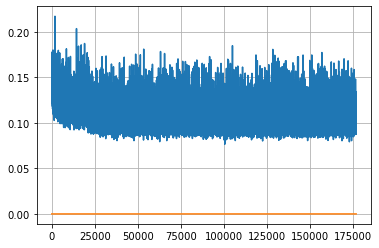

Epoch: 454, iteration 0, loss 0.10554641485214233, cov_diff 0.4214027703835015 cov_diff train 0.42158104244105876
Epoch: 454, iteration 1, loss 0.10533615946769714, cov_diff 0.4093061246358197 cov_diff train 0.4087989634838328
Epoch: 454, iteration 2, loss 0.10342594981193542, cov_diff 0.41344410191317527 cov_diff train 0.4135267896220923
Epoch: 454, iteration 3, loss 0.10684415698051453, cov_diff 0.4059279614517697 cov_diff train 0.4052678664380516
Epoch: 454, iteration 4, loss 0.1078418493270874, cov_diff 0.4137632055968867 cov_diff train 0.4130343060716446
Epoch: 454, iteration 5, loss 0.099871426820755, cov_diff 0.42893599710839203 cov_diff train 0.42809130413336016
Epoch: 454, iteration 6, loss 0.10730436444282532, cov_diff 0.41083352047591803 cov_diff train 0.4109834542079765
Epoch: 454, iteration 7, loss 0.10386517643928528, cov_diff 0.4201595828344624 cov_diff train 0.41880444504567393
Epoch: 454, iteration 8, loss 0.10410246253013611, cov_diff 0.4127181055570707 cov_diff train

Epoch: 454, iteration 78, loss 0.1030326783657074, cov_diff 0.40984524290400404 cov_diff train 0.40924085190807064
Epoch: 454, iteration 79, loss 0.10039821267127991, cov_diff 0.4227077500186326 cov_diff train 0.4211161045968172
Epoch: 454, iteration 80, loss 0.09596362709999084, cov_diff 0.41184891674428786 cov_diff train 0.411325256804906
Epoch: 454, iteration 81, loss 0.10245901346206665, cov_diff 0.4127100765403995 cov_diff train 0.4128268272242231
Epoch: 454, iteration 82, loss 0.1225263774394989, cov_diff 0.4052908161919261 cov_diff train 0.40470194533337955
Epoch: 454, iteration 83, loss 0.101530522108078, cov_diff 0.4160144394278593 cov_diff train 0.41462674304183794
Epoch: 454, iteration 84, loss 0.1015181839466095, cov_diff 0.39802783133217196 cov_diff train 0.3981752380363488
Epoch: 454, iteration 85, loss 0.11744210124015808, cov_diff 0.41796409410348867 cov_diff train 0.4135405544928365
Epoch: 454, iteration 86, loss 0.1077185869216919, cov_diff 0.4130687879798041 cov_diff

Epoch: 454, iteration 157, loss 0.10409966111183167, cov_diff 0.4178786415352115 cov_diff train 0.4174159539962585
Epoch: 454, iteration 158, loss 0.1114458441734314, cov_diff 0.41670101650383207 cov_diff train 0.4160635419528114
Epoch: 454, iteration 159, loss 0.11112353205680847, cov_diff 0.40404528551803165 cov_diff train 0.40303004467351117
Epoch: 454, iteration 160, loss 0.09994155168533325, cov_diff 0.41302600561844105 cov_diff train 0.4129985647889761
Epoch: 454, iteration 161, loss 0.108807772397995, cov_diff 0.4093545548657781 cov_diff train 0.40808084814859674
Epoch: 454, iteration 162, loss 0.0982656180858612, cov_diff 0.41107118537449566 cov_diff train 0.4106331225562647
Epoch: 454, iteration 163, loss 0.09690150618553162, cov_diff 0.40946442560552554 cov_diff train 0.4087290394677617
Epoch: 454, iteration 164, loss 0.11368632316589355, cov_diff 0.3979689269608692 cov_diff train 0.3976454751329067
Epoch: 454, iteration 165, loss 0.09350994229316711, cov_diff 0.4091694293931

Epoch: 454, iteration 235, loss 0.11780542135238647, cov_diff 0.4090232712644381 cov_diff train 0.40900878393243856
Epoch: 454, iteration 236, loss 0.10656332969665527, cov_diff 0.41137962404486306 cov_diff train 0.41104102958437816
Epoch: 454, iteration 237, loss 0.10312718152999878, cov_diff 0.41319064789220994 cov_diff train 0.41274145924298417
Epoch: 454, iteration 238, loss 0.10758808255195618, cov_diff 0.4171458272467805 cov_diff train 0.4166589256795464
Epoch: 454, iteration 239, loss 0.10915103554725647, cov_diff 0.3999709520256327 cov_diff train 0.40006167080668215
Epoch: 454, iteration 240, loss 0.10049265623092651, cov_diff 0.39408133762329095 cov_diff train 0.3936157885818356
Epoch: 454, iteration 241, loss 0.0975065529346466, cov_diff 0.4089049122659257 cov_diff train 0.40888690672600114
Epoch: 454, iteration 242, loss 0.1038130521774292, cov_diff 0.40994518186915063 cov_diff train 0.40926921116202897
Epoch: 454, iteration 243, loss 0.09849637746810913, cov_diff 0.41900760

Epoch: 454, iteration 312, loss 0.097592294216156, cov_diff 0.4002920447771008 cov_diff train 0.40019623039431085
Epoch: 454, iteration 313, loss 0.1064872145652771, cov_diff 0.41459961812022783 cov_diff train 0.41395509716788986
Epoch: 454, iteration 314, loss 0.10385671257972717, cov_diff 0.4094376676855061 cov_diff train 0.40912972598289465
Epoch: 454, iteration 315, loss 0.10475507378578186, cov_diff 0.4070740403129976 cov_diff train 0.40694947253168395
Epoch: 454, iteration 316, loss 0.11584612727165222, cov_diff 0.40181042916092297 cov_diff train 0.4013224797561318
Epoch: 454, iteration 317, loss 0.10331466794013977, cov_diff 0.4063368619879778 cov_diff train 0.40579957306283343
Epoch: 454, iteration 318, loss 0.10546183586120605, cov_diff 0.4221071071060325 cov_diff train 0.4221102102309716
Epoch: 454, iteration 319, loss 0.09688350558280945, cov_diff 0.4080125169333851 cov_diff train 0.40774504137107925
Epoch: 454, iteration 320, loss 0.103689044713974, cov_diff 0.4162254506343

Epoch: 454, iteration 388, loss 0.0907444953918457, cov_diff 0.40467442359964984 cov_diff train 0.40424103974528297
Epoch: 454, iteration 389, loss 0.10545793175697327, cov_diff 0.41622283461674725 cov_diff train 0.4148341461017481
Epoch: 454, iteration 390, loss 0.15474656224250793, cov_diff 0.43725639983695597 cov_diff train 0.43638712737858776


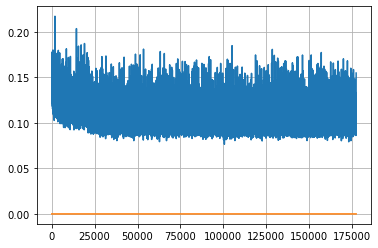

Epoch: 455, iteration 0, loss 0.09179505705833435, cov_diff 0.41611699571681804 cov_diff train 0.4146279645032562
Epoch: 455, iteration 1, loss 0.10614439845085144, cov_diff 0.411640656193757 cov_diff train 0.4105174923106447
Epoch: 455, iteration 2, loss 0.10104411840438843, cov_diff 0.41046375257937434 cov_diff train 0.4092198777104036
Epoch: 455, iteration 3, loss 0.09228542447090149, cov_diff 0.39880445249228247 cov_diff train 0.399294342028687
Epoch: 455, iteration 4, loss 0.10596823692321777, cov_diff 0.4113192451516197 cov_diff train 0.4105017695555101
Epoch: 455, iteration 5, loss 0.10920089483261108, cov_diff 0.41405274059666286 cov_diff train 0.4135994469284518
Epoch: 455, iteration 6, loss 0.10083070397377014, cov_diff 0.40619412813321176 cov_diff train 0.40432174531158116
Epoch: 455, iteration 7, loss 0.10752379894256592, cov_diff 0.4154779976247358 cov_diff train 0.41461904052452775
Epoch: 455, iteration 8, loss 0.10852974653244019, cov_diff 0.3983143858110066 cov_diff tra

Epoch: 455, iteration 77, loss 0.11388033628463745, cov_diff 0.4149664640560394 cov_diff train 0.4145288277258767
Epoch: 455, iteration 78, loss 0.10687762498855591, cov_diff 0.41823122944251273 cov_diff train 0.4173648126325322
Epoch: 455, iteration 79, loss 0.09557133913040161, cov_diff 0.40501571854134194 cov_diff train 0.4043558916190058
Epoch: 455, iteration 80, loss 0.10537821054458618, cov_diff 0.41945104583146875 cov_diff train 0.4191066319402307
Epoch: 455, iteration 81, loss 0.1114165186882019, cov_diff 0.41081346774593835 cov_diff train 0.40950894370637764
Epoch: 455, iteration 82, loss 0.10087791085243225, cov_diff 0.4156984374305075 cov_diff train 0.41536982406086825
Epoch: 455, iteration 83, loss 0.10775822401046753, cov_diff 0.42344138411016163 cov_diff train 0.4227932291861497
Epoch: 455, iteration 84, loss 0.09886437654495239, cov_diff 0.4179089779541427 cov_diff train 0.4173035042675719
Epoch: 455, iteration 85, loss 0.10252362489700317, cov_diff 0.416611190683435 cov

Epoch: 455, iteration 155, loss 0.11149987578392029, cov_diff 0.40591562920518504 cov_diff train 0.4055387370712077
Epoch: 455, iteration 156, loss 0.10203340649604797, cov_diff 0.4108222146996746 cov_diff train 0.4097337049789723
Epoch: 455, iteration 157, loss 0.09174910187721252, cov_diff 0.41318429206765817 cov_diff train 0.4121978871394738
Epoch: 455, iteration 158, loss 0.10407733917236328, cov_diff 0.40942967809846964 cov_diff train 0.40804499353094875
Epoch: 455, iteration 159, loss 0.10240957140922546, cov_diff 0.4148078240847037 cov_diff train 0.4136853763081657
Epoch: 455, iteration 160, loss 0.11394932866096497, cov_diff 0.406196927667755 cov_diff train 0.40531804879488925
Epoch: 455, iteration 161, loss 0.10916772484779358, cov_diff 0.4056580906563863 cov_diff train 0.4045890885335984
Epoch: 455, iteration 162, loss 0.09208351373672485, cov_diff 0.3936361007491735 cov_diff train 0.39272575331757603
Epoch: 455, iteration 163, loss 0.09573909640312195, cov_diff 0.40593511531

Epoch: 455, iteration 233, loss 0.10907158255577087, cov_diff 0.4097716873193491 cov_diff train 0.4099954226124082
Epoch: 455, iteration 234, loss 0.098879873752594, cov_diff 0.4121894624774385 cov_diff train 0.41169773057563847
Epoch: 455, iteration 235, loss 0.10294687747955322, cov_diff 0.40369541360864314 cov_diff train 0.4032024822990483
Epoch: 455, iteration 236, loss 0.12189412117004395, cov_diff 0.415014725897844 cov_diff train 0.4134040529551778
Epoch: 455, iteration 237, loss 0.10412856936454773, cov_diff 0.4203027956358514 cov_diff train 0.4196574606317581
Epoch: 455, iteration 238, loss 0.11103639006614685, cov_diff 0.4114653714361006 cov_diff train 0.4108833368832329
Epoch: 455, iteration 239, loss 0.09618592262268066, cov_diff 0.4106304795814072 cov_diff train 0.4094875628130063
Epoch: 455, iteration 240, loss 0.09886947274208069, cov_diff 0.4130911554472802 cov_diff train 0.41164365871270725
Epoch: 455, iteration 241, loss 0.09962064027786255, cov_diff 0.4070607097818877

Epoch: 455, iteration 312, loss 0.11121571063995361, cov_diff 0.4144142338394377 cov_diff train 0.4139651600859713
Epoch: 455, iteration 313, loss 0.11166837811470032, cov_diff 0.3923285661227492 cov_diff train 0.3911612656304527
Epoch: 455, iteration 314, loss 0.09718739986419678, cov_diff 0.40969502946078235 cov_diff train 0.4101451272926071
Epoch: 455, iteration 315, loss 0.10176369547843933, cov_diff 0.41558358570086973 cov_diff train 0.41576886659736056
Epoch: 455, iteration 316, loss 0.09895217418670654, cov_diff 0.41109333695287087 cov_diff train 0.4107226901056778
Epoch: 455, iteration 317, loss 0.10278481245040894, cov_diff 0.4069302481919674 cov_diff train 0.4064802850052251
Epoch: 455, iteration 318, loss 0.11127182841300964, cov_diff 0.42086484585501727 cov_diff train 0.4188825488299945
Epoch: 455, iteration 319, loss 0.09358635544776917, cov_diff 0.40942517103954307 cov_diff train 0.40935107963930967
Epoch: 455, iteration 320, loss 0.11204630136489868, cov_diff 0.405351947

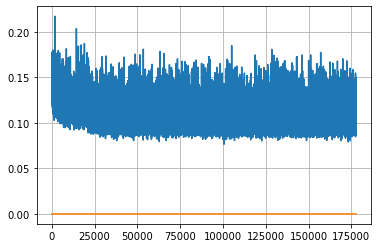

Epoch: 456, iteration 0, loss 0.09947177767753601, cov_diff 0.42135369764607994 cov_diff train 0.4206278434274991
Epoch: 456, iteration 1, loss 0.11135751008987427, cov_diff 0.40231300931964464 cov_diff train 0.40276084862183614
Epoch: 456, iteration 2, loss 0.09189930558204651, cov_diff 0.4072427497206395 cov_diff train 0.4073914909909761
Epoch: 456, iteration 3, loss 0.09378835558891296, cov_diff 0.4094425511766687 cov_diff train 0.4092084233869595
Epoch: 456, iteration 4, loss 0.10547924041748047, cov_diff 0.4228983569956707 cov_diff train 0.42212372089060207
Epoch: 456, iteration 5, loss 0.1047026515007019, cov_diff 0.41110815153942604 cov_diff train 0.4109829365340272
Epoch: 456, iteration 6, loss 0.1145467758178711, cov_diff 0.41383822752559474 cov_diff train 0.41419785185611724
Epoch: 456, iteration 7, loss 0.11365178227424622, cov_diff 0.41357982665571313 cov_diff train 0.413521797267439
Epoch: 456, iteration 8, loss 0.10166892409324646, cov_diff 0.40803302644982126 cov_diff tr

Epoch: 456, iteration 76, loss 0.10852944850921631, cov_diff 0.417017748738739 cov_diff train 0.41674396963479743
Epoch: 456, iteration 77, loss 0.10974922776222229, cov_diff 0.4165939038688149 cov_diff train 0.4162961963743608
Epoch: 456, iteration 78, loss 0.10506394505500793, cov_diff 0.4244397416385074 cov_diff train 0.42356056483045046
Epoch: 456, iteration 79, loss 0.1070391833782196, cov_diff 0.4166895116553726 cov_diff train 0.41609773987752313
Epoch: 456, iteration 80, loss 0.11216592788696289, cov_diff 0.39722931665752687 cov_diff train 0.3970718452819436
Epoch: 456, iteration 81, loss 0.10099723935127258, cov_diff 0.3975739195101031 cov_diff train 0.3968437150343212
Epoch: 456, iteration 82, loss 0.10600882768630981, cov_diff 0.40871854428373494 cov_diff train 0.4084370344609964
Epoch: 456, iteration 83, loss 0.09503006935119629, cov_diff 0.40628586824637397 cov_diff train 0.40510321143648353
Epoch: 456, iteration 84, loss 0.10620346665382385, cov_diff 0.4197073902274074 cov

Epoch: 456, iteration 153, loss 0.10192164778709412, cov_diff 0.40726680029977624 cov_diff train 0.4070284692850791
Epoch: 456, iteration 154, loss 0.10666102170944214, cov_diff 0.4043387569701717 cov_diff train 0.40395475869693903
Epoch: 456, iteration 155, loss 0.10260924696922302, cov_diff 0.4017126618552225 cov_diff train 0.40205290338604394
Epoch: 456, iteration 156, loss 0.12040820717811584, cov_diff 0.4092656865882865 cov_diff train 0.40779216085342895
Epoch: 456, iteration 157, loss 0.0982290506362915, cov_diff 0.4109541636599491 cov_diff train 0.4111555942300726
Epoch: 456, iteration 158, loss 0.10158726572990417, cov_diff 0.4099875287751203 cov_diff train 0.40930099660378916
Epoch: 456, iteration 159, loss 0.10881337523460388, cov_diff 0.41524011816845663 cov_diff train 0.4145368628651715
Epoch: 456, iteration 160, loss 0.09454315900802612, cov_diff 0.41876050547361926 cov_diff train 0.418577203812181
Epoch: 456, iteration 161, loss 0.09781718254089355, cov_diff 0.39992593064

Epoch: 456, iteration 230, loss 0.11114352941513062, cov_diff 0.41575175051775 cov_diff train 0.4155618680141876
Epoch: 456, iteration 231, loss 0.10057026147842407, cov_diff 0.4179897568423566 cov_diff train 0.4175021911260625
Epoch: 456, iteration 232, loss 0.10780945420265198, cov_diff 0.4147101674715622 cov_diff train 0.41352047338695685
Epoch: 456, iteration 233, loss 0.1007426381111145, cov_diff 0.4103333910508912 cov_diff train 0.4094524993522428
Epoch: 456, iteration 234, loss 0.09921509027481079, cov_diff 0.4079418700163556 cov_diff train 0.4069247648558166
Epoch: 456, iteration 235, loss 0.08660382032394409, cov_diff 0.41102500249567564 cov_diff train 0.40972643428477906
Epoch: 456, iteration 236, loss 0.09698730707168579, cov_diff 0.40540806017992287 cov_diff train 0.40500523663880045
Epoch: 456, iteration 237, loss 0.10471031069755554, cov_diff 0.4104527983270928 cov_diff train 0.40922587317775255
Epoch: 456, iteration 238, loss 0.10295382142066956, cov_diff 0.4001100786483

Epoch: 456, iteration 308, loss 0.09619387984275818, cov_diff 0.41663118254163456 cov_diff train 0.41584811149157325
Epoch: 456, iteration 309, loss 0.10216400027275085, cov_diff 0.40275892610397585 cov_diff train 0.40189622118495355
Epoch: 456, iteration 310, loss 0.09708723425865173, cov_diff 0.4010707476971801 cov_diff train 0.4008140892685036
Epoch: 456, iteration 311, loss 0.09486675262451172, cov_diff 0.4089693463010262 cov_diff train 0.4089051612436465
Epoch: 456, iteration 312, loss 0.10656672716140747, cov_diff 0.4064845102343666 cov_diff train 0.406049474937573
Epoch: 456, iteration 313, loss 0.09877115488052368, cov_diff 0.40703943873713727 cov_diff train 0.4067050822112849
Epoch: 456, iteration 314, loss 0.11209976673126221, cov_diff 0.4000789554941573 cov_diff train 0.39972250589096575
Epoch: 456, iteration 315, loss 0.11509475111961365, cov_diff 0.41769096935791256 cov_diff train 0.41682658282315505
Epoch: 456, iteration 316, loss 0.10899227857589722, cov_diff 0.418207690

Epoch: 456, iteration 386, loss 0.09818705916404724, cov_diff 0.39300062948817754 cov_diff train 0.3925276517190446
Epoch: 456, iteration 387, loss 0.11344102025032043, cov_diff 0.42828914322780837 cov_diff train 0.4286071045911049
Epoch: 456, iteration 388, loss 0.10195508599281311, cov_diff 0.4120414359889171 cov_diff train 0.4118024812546276
Epoch: 456, iteration 389, loss 0.10738536715507507, cov_diff 0.4133608739549285 cov_diff train 0.413221343024205
Epoch: 456, iteration 390, loss 0.1577591896057129, cov_diff 0.45654034481590056 cov_diff train 0.4526173448733215


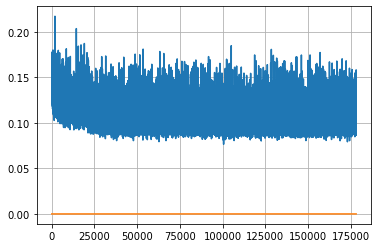

Epoch: 457, iteration 0, loss 0.10268688201904297, cov_diff 0.4207617682603169 cov_diff train 0.4200960155891391
Epoch: 457, iteration 1, loss 0.10316163301467896, cov_diff 0.42086030476517156 cov_diff train 0.4200833261265711
Epoch: 457, iteration 2, loss 0.10026565194129944, cov_diff 0.4066470526307717 cov_diff train 0.4064792706869279
Epoch: 457, iteration 3, loss 0.10962098836898804, cov_diff 0.41374844693820695 cov_diff train 0.41290234942239606
Epoch: 457, iteration 4, loss 0.10723981261253357, cov_diff 0.41385568265457523 cov_diff train 0.4128262954101724
Epoch: 457, iteration 5, loss 0.1015825867652893, cov_diff 0.4167363739056785 cov_diff train 0.4157750030490194
Epoch: 457, iteration 6, loss 0.0987386703491211, cov_diff 0.41244127585165313 cov_diff train 0.4121439412678901
Epoch: 457, iteration 7, loss 0.09980016946792603, cov_diff 0.4189105603511201 cov_diff train 0.418208645306453
Epoch: 457, iteration 8, loss 0.10262462496757507, cov_diff 0.42261949189432246 cov_diff train

Epoch: 457, iteration 72, loss 0.11404076218605042, cov_diff 0.40163272900434205 cov_diff train 0.40041472698525643
Epoch: 457, iteration 73, loss 0.09120956063270569, cov_diff 0.40353091990749335 cov_diff train 0.4014741576223821
Epoch: 457, iteration 74, loss 0.11013138294219971, cov_diff 0.40349234544562196 cov_diff train 0.4023368147834077
Epoch: 457, iteration 75, loss 0.10151726007461548, cov_diff 0.42331021421131015 cov_diff train 0.4220152654939997
Epoch: 457, iteration 76, loss 0.10139578580856323, cov_diff 0.4043700630765158 cov_diff train 0.40318989911937475
Epoch: 457, iteration 77, loss 0.11518678069114685, cov_diff 0.4148172744580998 cov_diff train 0.414562557606984
Epoch: 457, iteration 78, loss 0.10075631737709045, cov_diff 0.419652534228608 cov_diff train 0.41981544849139246
Epoch: 457, iteration 79, loss 0.11925378441810608, cov_diff 0.4135193480067302 cov_diff train 0.4129682020175622
Epoch: 457, iteration 80, loss 0.10500195622444153, cov_diff 0.40986249104149197 co

Epoch: 457, iteration 152, loss 0.11126446723937988, cov_diff 0.4185417832376264 cov_diff train 0.4182932720646436
Epoch: 457, iteration 153, loss 0.10325217247009277, cov_diff 0.42105285306132556 cov_diff train 0.42061078967898946
Epoch: 457, iteration 154, loss 0.09927549958229065, cov_diff 0.4030784588455253 cov_diff train 0.40242209392757644
Epoch: 457, iteration 155, loss 0.09186959266662598, cov_diff 0.41077797750624323 cov_diff train 0.41079473231636626
Epoch: 457, iteration 156, loss 0.09605690836906433, cov_diff 0.42751869201823145 cov_diff train 0.4267997451633296
Epoch: 457, iteration 157, loss 0.09605783224105835, cov_diff 0.40255637799230637 cov_diff train 0.4014434377068284
Epoch: 457, iteration 158, loss 0.1058940589427948, cov_diff 0.42132472560860595 cov_diff train 0.4201191768778712
Epoch: 457, iteration 159, loss 0.09412118792533875, cov_diff 0.4145550714750606 cov_diff train 0.41380813095907515
Epoch: 457, iteration 160, loss 0.10349211096763611, cov_diff 0.41981339

Epoch: 457, iteration 225, loss 0.10011887550354004, cov_diff 0.4061408528906046 cov_diff train 0.4056072861010762
Epoch: 457, iteration 226, loss 0.08919742703437805, cov_diff 0.4115238724141023 cov_diff train 0.4107948854510775
Epoch: 457, iteration 227, loss 0.0976734459400177, cov_diff 0.4216561081644662 cov_diff train 0.42117121863074114
Epoch: 457, iteration 228, loss 0.1039106547832489, cov_diff 0.4249934893697558 cov_diff train 0.42521274589644203
Epoch: 457, iteration 229, loss 0.0998300313949585, cov_diff 0.4179220826188797 cov_diff train 0.41723355956849584
Epoch: 457, iteration 230, loss 0.09679904580116272, cov_diff 0.42243854983819057 cov_diff train 0.4220104414139667
Epoch: 457, iteration 231, loss 0.10258999466896057, cov_diff 0.41210662855522745 cov_diff train 0.411567020752002
Epoch: 457, iteration 232, loss 0.11213374137878418, cov_diff 0.4176409703397026 cov_diff train 0.41676751654517963
Epoch: 457, iteration 233, loss 0.11423701047897339, cov_diff 0.41901716312144

Epoch: 457, iteration 299, loss 0.1001758873462677, cov_diff 0.40721285198703255 cov_diff train 0.40631922080034083
Epoch: 457, iteration 300, loss 0.10111898183822632, cov_diff 0.4058237729366727 cov_diff train 0.4055779212022763
Epoch: 457, iteration 301, loss 0.11178985238075256, cov_diff 0.40940434584053875 cov_diff train 0.4096141822490848
Epoch: 457, iteration 302, loss 0.10731753706932068, cov_diff 0.410119797628963 cov_diff train 0.40945649742751367
Epoch: 457, iteration 303, loss 0.11195036768913269, cov_diff 0.4132168901832337 cov_diff train 0.41189454521489577
Epoch: 457, iteration 304, loss 0.1080816388130188, cov_diff 0.413067119336857 cov_diff train 0.41215775041683916
Epoch: 457, iteration 305, loss 0.10542744398117065, cov_diff 0.4033314008376397 cov_diff train 0.40320404740475274
Epoch: 457, iteration 306, loss 0.09573438763618469, cov_diff 0.4179322732777065 cov_diff train 0.41779338092222
Epoch: 457, iteration 307, loss 0.09782382845878601, cov_diff 0.402534388366856

Epoch: 457, iteration 375, loss 0.11932072043418884, cov_diff 0.4066307750725803 cov_diff train 0.40623766915049564
Epoch: 457, iteration 376, loss 0.10547953844070435, cov_diff 0.4066304399394294 cov_diff train 0.4053844525293231
Epoch: 457, iteration 377, loss 0.0991314947605133, cov_diff 0.42043831136778265 cov_diff train 0.41964965336617216
Epoch: 457, iteration 378, loss 0.10470294952392578, cov_diff 0.40461141469688355 cov_diff train 0.4044677939902157
Epoch: 457, iteration 379, loss 0.10952156782150269, cov_diff 0.4103611292551111 cov_diff train 0.40870349480062246
Epoch: 457, iteration 380, loss 0.10288333892822266, cov_diff 0.41908643917448263 cov_diff train 0.4183202115828248
Epoch: 457, iteration 381, loss 0.10189422965049744, cov_diff 0.40916428298801855 cov_diff train 0.4079789659481026
Epoch: 457, iteration 382, loss 0.1047469973564148, cov_diff 0.3971337418922598 cov_diff train 0.3967098375225758
Epoch: 457, iteration 383, loss 0.10082060098648071, cov_diff 0.41165758999

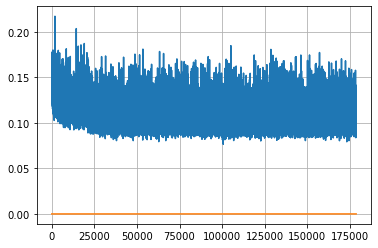

Epoch: 458, iteration 0, loss 0.1045563817024231, cov_diff 0.41653622679487795 cov_diff train 0.41626820363599126
Epoch: 458, iteration 1, loss 0.09132614731788635, cov_diff 0.41021214034580716 cov_diff train 0.40910771237697047
Epoch: 458, iteration 2, loss 0.10406732559204102, cov_diff 0.41788841569062296 cov_diff train 0.4171058960874104
Epoch: 458, iteration 3, loss 0.10521304607391357, cov_diff 0.4139070145535599 cov_diff train 0.4141521516504893
Epoch: 458, iteration 4, loss 0.11169779300689697, cov_diff 0.4092581778384345 cov_diff train 0.4083471067372631
Epoch: 458, iteration 5, loss 0.1022309958934784, cov_diff 0.41545204514278017 cov_diff train 0.41463356763701054
Epoch: 458, iteration 6, loss 0.10339924693107605, cov_diff 0.3975625267578873 cov_diff train 0.39584195149279044
Epoch: 458, iteration 7, loss 0.11410301923751831, cov_diff 0.4139652952423643 cov_diff train 0.41339056330299384
Epoch: 458, iteration 8, loss 0.10434019565582275, cov_diff 0.40484223119334584 cov_diff 

Epoch: 458, iteration 78, loss 0.11110946536064148, cov_diff 0.400488370102438 cov_diff train 0.3993414717223978
Epoch: 458, iteration 79, loss 0.10327112674713135, cov_diff 0.4028801422267348 cov_diff train 0.40202871067649115
Epoch: 458, iteration 80, loss 0.0990217924118042, cov_diff 0.40949882316045155 cov_diff train 0.4087305042965258
Epoch: 458, iteration 81, loss 0.09594777226448059, cov_diff 0.4128551103788792 cov_diff train 0.4119740259743156
Epoch: 458, iteration 82, loss 0.11543294787406921, cov_diff 0.40931486419280405 cov_diff train 0.40861622252182395
Epoch: 458, iteration 83, loss 0.10204216837882996, cov_diff 0.40619627302759587 cov_diff train 0.40515035278709616
Epoch: 458, iteration 84, loss 0.09911689162254333, cov_diff 0.4058829809385644 cov_diff train 0.4045647707961595
Epoch: 458, iteration 85, loss 0.10316005349159241, cov_diff 0.4109128984143747 cov_diff train 0.40997483683807073
Epoch: 458, iteration 86, loss 0.10447865724563599, cov_diff 0.4028736773153935 cov

Epoch: 458, iteration 157, loss 0.10090044140815735, cov_diff 0.41239006195494043 cov_diff train 0.41234132149979463
Epoch: 458, iteration 158, loss 0.09802591800689697, cov_diff 0.4009807909724069 cov_diff train 0.39917527787562757
Epoch: 458, iteration 159, loss 0.0925372838973999, cov_diff 0.40794708476456293 cov_diff train 0.4071275428618048
Epoch: 458, iteration 160, loss 0.10526150465011597, cov_diff 0.4187126879902735 cov_diff train 0.41752857118124037
Epoch: 458, iteration 161, loss 0.09058088064193726, cov_diff 0.40896967537314305 cov_diff train 0.4084231896567263
Epoch: 458, iteration 162, loss 0.11041992902755737, cov_diff 0.41174278617277116 cov_diff train 0.410992456731906
Epoch: 458, iteration 163, loss 0.0920625627040863, cov_diff 0.4035547335834815 cov_diff train 0.4028695988140815
Epoch: 458, iteration 164, loss 0.10396289825439453, cov_diff 0.40431397811484454 cov_diff train 0.40371464576919136
Epoch: 458, iteration 165, loss 0.10420495271682739, cov_diff 0.4089564119

Epoch: 458, iteration 234, loss 0.109097421169281, cov_diff 0.4237477423572051 cov_diff train 0.4231551792162831
Epoch: 458, iteration 235, loss 0.10247167944908142, cov_diff 0.41756715072849104 cov_diff train 0.41688028590440523
Epoch: 458, iteration 236, loss 0.1034417450428009, cov_diff 0.40908391056493515 cov_diff train 0.4089173958362794
Epoch: 458, iteration 237, loss 0.1096266508102417, cov_diff 0.39849900766378665 cov_diff train 0.3980863807181657
Epoch: 458, iteration 238, loss 0.09354591369628906, cov_diff 0.40708233268309485 cov_diff train 0.40599231786433393
Epoch: 458, iteration 239, loss 0.10110712051391602, cov_diff 0.4034692581478217 cov_diff train 0.40205405542750383
Epoch: 458, iteration 240, loss 0.10044291615486145, cov_diff 0.40642499269399834 cov_diff train 0.40609172833837814
Epoch: 458, iteration 241, loss 0.11304470896720886, cov_diff 0.400054242067205 cov_diff train 0.3993004888680733
Epoch: 458, iteration 242, loss 0.09741321206092834, cov_diff 0.401937729306

Epoch: 458, iteration 313, loss 0.09618556499481201, cov_diff 0.4199454164033919 cov_diff train 0.41902677057179266
Epoch: 458, iteration 314, loss 0.09554934501647949, cov_diff 0.4138180286416828 cov_diff train 0.41239351244132433
Epoch: 458, iteration 315, loss 0.09477755427360535, cov_diff 0.4169873673127848 cov_diff train 0.4159582693191235
Epoch: 458, iteration 316, loss 0.08887040615081787, cov_diff 0.4098458387250403 cov_diff train 0.4095507128826431
Epoch: 458, iteration 317, loss 0.09890714287757874, cov_diff 0.4097056434958983 cov_diff train 0.4091017819801031
Epoch: 458, iteration 318, loss 0.1003761887550354, cov_diff 0.4123092881973539 cov_diff train 0.4114983528678233
Epoch: 458, iteration 319, loss 0.10119935870170593, cov_diff 0.40047116550471934 cov_diff train 0.4003725848174499
Epoch: 458, iteration 320, loss 0.11234444379806519, cov_diff 0.40858157099245374 cov_diff train 0.40792638241748086
Epoch: 458, iteration 321, loss 0.09796714782714844, cov_diff 0.428421454067

Epoch: 458, iteration 390, loss 0.15864428877830505, cov_diff 0.45775134789375016 cov_diff train 0.45647462374736375


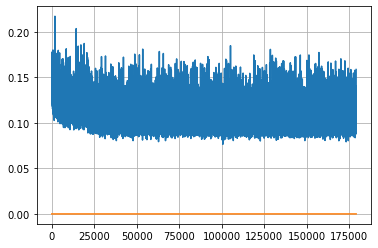

Epoch: 459, iteration 0, loss 0.09405776858329773, cov_diff 0.3971110576596792 cov_diff train 0.39704416627507666
Epoch: 459, iteration 1, loss 0.10964655876159668, cov_diff 0.4074050075952228 cov_diff train 0.4065772416166367
Epoch: 459, iteration 2, loss 0.0960119366645813, cov_diff 0.41775063440069565 cov_diff train 0.41683973327634594
Epoch: 459, iteration 3, loss 0.10113641619682312, cov_diff 0.416491848268981 cov_diff train 0.4166207736636057
Epoch: 459, iteration 4, loss 0.10531678795814514, cov_diff 0.4119634400869642 cov_diff train 0.41139986447897176
Epoch: 459, iteration 5, loss 0.10234004259109497, cov_diff 0.40998243553295766 cov_diff train 0.40955333067671057
Epoch: 459, iteration 6, loss 0.10642287135124207, cov_diff 0.41416722937721373 cov_diff train 0.41365648828992924
Epoch: 459, iteration 7, loss 0.10151803493499756, cov_diff 0.40232647291533025 cov_diff train 0.4023685768803149
Epoch: 459, iteration 8, loss 0.10126253962516785, cov_diff 0.41510779513260165 cov_diff 

Epoch: 459, iteration 77, loss 0.0993523895740509, cov_diff 0.42085425450208575 cov_diff train 0.41951536462158784
Epoch: 459, iteration 78, loss 0.10122814774513245, cov_diff 0.40776882934901865 cov_diff train 0.40683970753164644
Epoch: 459, iteration 79, loss 0.11593374609947205, cov_diff 0.4016273506757321 cov_diff train 0.3994545439807425
Epoch: 459, iteration 80, loss 0.11058801412582397, cov_diff 0.4014118533070959 cov_diff train 0.400118690214315
Epoch: 459, iteration 81, loss 0.10153475403785706, cov_diff 0.40537348425007563 cov_diff train 0.4041404654296728
Epoch: 459, iteration 82, loss 0.10131445527076721, cov_diff 0.40998242477161956 cov_diff train 0.4086698771804823
Epoch: 459, iteration 83, loss 0.11885032057762146, cov_diff 0.414078538726048 cov_diff train 0.41341094250879007
Epoch: 459, iteration 84, loss 0.10093829035758972, cov_diff 0.41974574076541216 cov_diff train 0.418371558608303
Epoch: 459, iteration 85, loss 0.09555944800376892, cov_diff 0.4039337679822242 cov_

Epoch: 459, iteration 155, loss 0.10122641921043396, cov_diff 0.3990568740111787 cov_diff train 0.3977010176578991
Epoch: 459, iteration 156, loss 0.09330064058303833, cov_diff 0.41040124816209467 cov_diff train 0.4092141796284621
Epoch: 459, iteration 157, loss 0.0999860167503357, cov_diff 0.4116173060764079 cov_diff train 0.4114533495488345
Epoch: 459, iteration 158, loss 0.09459865093231201, cov_diff 0.4220628346870758 cov_diff train 0.4210284225283004
Epoch: 459, iteration 159, loss 0.10888126492500305, cov_diff 0.416746885910083 cov_diff train 0.41607507465447585
Epoch: 459, iteration 160, loss 0.10881713032722473, cov_diff 0.4186321154828789 cov_diff train 0.41789861189234345
Epoch: 459, iteration 161, loss 0.1042533814907074, cov_diff 0.4058795847182531 cov_diff train 0.40559763734640203
Epoch: 459, iteration 162, loss 0.10367691516876221, cov_diff 0.4210925077669112 cov_diff train 0.4199151660189791
Epoch: 459, iteration 163, loss 0.10419067740440369, cov_diff 0.398234623252053

Epoch: 459, iteration 232, loss 0.100333571434021, cov_diff 0.409564712856462 cov_diff train 0.4093368431793031
Epoch: 459, iteration 233, loss 0.10113859176635742, cov_diff 0.41718170240826735 cov_diff train 0.4161396940073139
Epoch: 459, iteration 234, loss 0.09598901867866516, cov_diff 0.41536319133695465 cov_diff train 0.4156618479305708
Epoch: 459, iteration 235, loss 0.09863689541816711, cov_diff 0.401097633046155 cov_diff train 0.4002405070810288
Epoch: 459, iteration 236, loss 0.10394483804702759, cov_diff 0.413314661334502 cov_diff train 0.41248461004947834
Epoch: 459, iteration 237, loss 0.1069006621837616, cov_diff 0.4228213223738639 cov_diff train 0.4220209127675053
Epoch: 459, iteration 238, loss 0.1127411425113678, cov_diff 0.4142337692321459 cov_diff train 0.41350762102963035
Epoch: 459, iteration 239, loss 0.10445147752761841, cov_diff 0.4175392558557724 cov_diff train 0.41677813137258013
Epoch: 459, iteration 240, loss 0.09543660283088684, cov_diff 0.40000457372497783 

Epoch: 459, iteration 310, loss 0.09681317210197449, cov_diff 0.40964322899873296 cov_diff train 0.4093493416932716
Epoch: 459, iteration 311, loss 0.11355471611022949, cov_diff 0.409181299202202 cov_diff train 0.4084534010384685
Epoch: 459, iteration 312, loss 0.09247994422912598, cov_diff 0.4105435715359664 cov_diff train 0.41011745646362957
Epoch: 459, iteration 313, loss 0.1055784523487091, cov_diff 0.3961376390077345 cov_diff train 0.39605724778402673
Epoch: 459, iteration 314, loss 0.09727659821510315, cov_diff 0.4190978496213441 cov_diff train 0.4188502796418064
Epoch: 459, iteration 315, loss 0.09884268045425415, cov_diff 0.4155550517709355 cov_diff train 0.41543495080645426
Epoch: 459, iteration 316, loss 0.10552558302879333, cov_diff 0.413252208124574 cov_diff train 0.41220233082096036
Epoch: 459, iteration 317, loss 0.11864173412322998, cov_diff 0.41199818050521964 cov_diff train 0.41118425988192264
Epoch: 459, iteration 318, loss 0.10644155740737915, cov_diff 0.407228615938

Epoch: 459, iteration 389, loss 0.09986090660095215, cov_diff 0.4262198439478401 cov_diff train 0.42536358524777473
Epoch: 459, iteration 390, loss 0.14822730422019958, cov_diff 0.45830041460042065 cov_diff train 0.45744912033567003


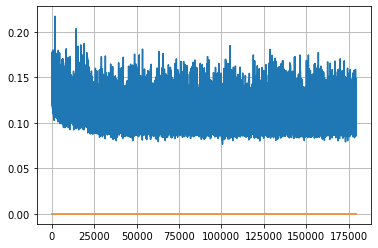

Epoch: 460, iteration 0, loss 0.10201475024223328, cov_diff 0.39517480765703766 cov_diff train 0.39498160529840776
Epoch: 460, iteration 1, loss 0.1064402163028717, cov_diff 0.4248271846942545 cov_diff train 0.42259560575437477
Epoch: 460, iteration 2, loss 0.09495404362678528, cov_diff 0.4072062440807719 cov_diff train 0.4066718802665081
Epoch: 460, iteration 3, loss 0.10135489702224731, cov_diff 0.4197783048940366 cov_diff train 0.41989776430667575
Epoch: 460, iteration 4, loss 0.1030462384223938, cov_diff 0.4154717270444078 cov_diff train 0.41442572254283416
Epoch: 460, iteration 5, loss 0.09045785665512085, cov_diff 0.4218426321300316 cov_diff train 0.42167045299939615
Epoch: 460, iteration 6, loss 0.09734788537025452, cov_diff 0.4024237553023518 cov_diff train 0.40203863021608627
Epoch: 460, iteration 7, loss 0.09852644801139832, cov_diff 0.39847417429465476 cov_diff train 0.39812502711051945
Epoch: 460, iteration 8, loss 0.10929098725318909, cov_diff 0.4185245712923864 cov_diff t

Epoch: 460, iteration 75, loss 0.10752460360527039, cov_diff 0.4214436220300947 cov_diff train 0.4210705862911274
Epoch: 460, iteration 76, loss 0.10851439833641052, cov_diff 0.41298042042174293 cov_diff train 0.41240936030878933
Epoch: 460, iteration 77, loss 0.10537689924240112, cov_diff 0.4078837723350246 cov_diff train 0.4073967785946111
Epoch: 460, iteration 78, loss 0.10455653071403503, cov_diff 0.4074610410318034 cov_diff train 0.40774296340454924
Epoch: 460, iteration 79, loss 0.11964836716651917, cov_diff 0.428067613398887 cov_diff train 0.4254995093289797
Epoch: 460, iteration 80, loss 0.09831678867340088, cov_diff 0.4115706435161096 cov_diff train 0.41148679935756055
Epoch: 460, iteration 81, loss 0.09988254308700562, cov_diff 0.40918795150669307 cov_diff train 0.4079698672434073
Epoch: 460, iteration 82, loss 0.09897217154502869, cov_diff 0.40463342298440974 cov_diff train 0.40439801290677635
Epoch: 460, iteration 83, loss 0.10403326153755188, cov_diff 0.4130080245847138 co

Epoch: 460, iteration 152, loss 0.10243386030197144, cov_diff 0.4147052924195602 cov_diff train 0.4145895589661153
Epoch: 460, iteration 153, loss 0.09790080785751343, cov_diff 0.4110004018942023 cov_diff train 0.410451660578819
Epoch: 460, iteration 154, loss 0.10910552740097046, cov_diff 0.41969044346200873 cov_diff train 0.41887408565147827
Epoch: 460, iteration 155, loss 0.11561721563339233, cov_diff 0.4197797956777113 cov_diff train 0.4180138949321051
Epoch: 460, iteration 156, loss 0.10138699412345886, cov_diff 0.4086384574370229 cov_diff train 0.40696701467628305
Epoch: 460, iteration 157, loss 0.09967532753944397, cov_diff 0.4195002030149494 cov_diff train 0.4188859331283621
Epoch: 460, iteration 158, loss 0.1075594425201416, cov_diff 0.41669615849097746 cov_diff train 0.4160926486629972
Epoch: 460, iteration 159, loss 0.09612491726875305, cov_diff 0.4157995406304407 cov_diff train 0.4149093567815714
Epoch: 460, iteration 160, loss 0.10232436656951904, cov_diff 0.40429372553528

Epoch: 460, iteration 229, loss 0.10885274410247803, cov_diff 0.4222037121291433 cov_diff train 0.4212126213559369
Epoch: 460, iteration 230, loss 0.0999373197555542, cov_diff 0.4218946381448855 cov_diff train 0.42120866875278
Epoch: 460, iteration 231, loss 0.11786293983459473, cov_diff 0.4247751758637587 cov_diff train 0.4239578221861461
Epoch: 460, iteration 232, loss 0.10165819525718689, cov_diff 0.4193115305857568 cov_diff train 0.4182896171584392
Epoch: 460, iteration 233, loss 0.10305935144424438, cov_diff 0.42562413289502016 cov_diff train 0.4237878220806645
Epoch: 460, iteration 234, loss 0.10967695713043213, cov_diff 0.4037745339703909 cov_diff train 0.40222439952671285
Epoch: 460, iteration 235, loss 0.09978130459785461, cov_diff 0.4136986426208335 cov_diff train 0.41299538692704896
Epoch: 460, iteration 236, loss 0.10804399847984314, cov_diff 0.41346510692981286 cov_diff train 0.411594663231884
Epoch: 460, iteration 237, loss 0.11150586605072021, cov_diff 0.4160946911964654

Epoch: 460, iteration 306, loss 0.10363098978996277, cov_diff 0.4143075933122398 cov_diff train 0.41384808695736647
Epoch: 460, iteration 307, loss 0.097869873046875, cov_diff 0.4289372962846735 cov_diff train 0.42824541157645135
Epoch: 460, iteration 308, loss 0.10245484113693237, cov_diff 0.39135912493778235 cov_diff train 0.3911115353783151
Epoch: 460, iteration 309, loss 0.10296386480331421, cov_diff 0.4055666358740224 cov_diff train 0.40487513630799915
Epoch: 460, iteration 310, loss 0.10337060689926147, cov_diff 0.4039501018006768 cov_diff train 0.40410193842656583
Epoch: 460, iteration 311, loss 0.09624862670898438, cov_diff 0.4105527641856657 cov_diff train 0.40998231822257597
Epoch: 460, iteration 312, loss 0.09659415483474731, cov_diff 0.41039838943000895 cov_diff train 0.410037918958696
Epoch: 460, iteration 313, loss 0.1077718734741211, cov_diff 0.4232945449689969 cov_diff train 0.4227173170357055
Epoch: 460, iteration 314, loss 0.08843106031417847, cov_diff 0.4006545422978

Epoch: 460, iteration 384, loss 0.11314955353736877, cov_diff 0.40469229281602526 cov_diff train 0.403858944936151
Epoch: 460, iteration 385, loss 0.10947376489639282, cov_diff 0.4063413829478729 cov_diff train 0.40607923836838566
Epoch: 460, iteration 386, loss 0.09383365511894226, cov_diff 0.4058709230480037 cov_diff train 0.40542464306944515
Epoch: 460, iteration 387, loss 0.09674051403999329, cov_diff 0.40942041637806065 cov_diff train 0.40884906719154396
Epoch: 460, iteration 388, loss 0.10791325569152832, cov_diff 0.40701375805881446 cov_diff train 0.405839208850957
Epoch: 460, iteration 389, loss 0.10720768570899963, cov_diff 0.4024450417520495 cov_diff train 0.40230602089585027
Epoch: 460, iteration 390, loss 0.14217418432235718, cov_diff 0.43505103909179027 cov_diff train 0.43611577370774696


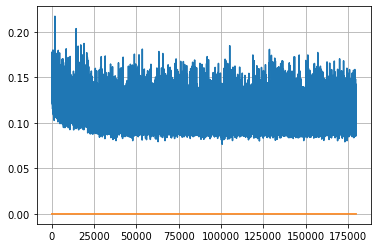

Epoch: 461, iteration 0, loss 0.09552299976348877, cov_diff 0.40409077312995006 cov_diff train 0.4028876786390502
Epoch: 461, iteration 1, loss 0.09693321585655212, cov_diff 0.40627556794045055 cov_diff train 0.4058299327573729
Epoch: 461, iteration 2, loss 0.11548104882240295, cov_diff 0.40310315106983546 cov_diff train 0.40304884755233383
Epoch: 461, iteration 3, loss 0.10304805636405945, cov_diff 0.40940357318053583 cov_diff train 0.409282977991859
Epoch: 461, iteration 4, loss 0.11179250478744507, cov_diff 0.41068064031682505 cov_diff train 0.4097486225141808
Epoch: 461, iteration 5, loss 0.10146749019622803, cov_diff 0.41129786075505265 cov_diff train 0.41155628003994377
Epoch: 461, iteration 6, loss 0.10942000150680542, cov_diff 0.4157127014497549 cov_diff train 0.4144656769585833
Epoch: 461, iteration 7, loss 0.10619643330574036, cov_diff 0.4070910581759643 cov_diff train 0.40670718593597116
Epoch: 461, iteration 8, loss 0.11451983451843262, cov_diff 0.39837723636804445 cov_diff

Epoch: 461, iteration 77, loss 0.10333946347236633, cov_diff 0.41706514036557646 cov_diff train 0.41642238044133534
Epoch: 461, iteration 78, loss 0.11317947506904602, cov_diff 0.3955291958508156 cov_diff train 0.3941954288949949
Epoch: 461, iteration 79, loss 0.09890618920326233, cov_diff 0.4109809926728617 cov_diff train 0.41044663553304966
Epoch: 461, iteration 80, loss 0.10680773854255676, cov_diff 0.39700758765666244 cov_diff train 0.3951931366358843
Epoch: 461, iteration 81, loss 0.11821004748344421, cov_diff 0.40444775769409547 cov_diff train 0.40433080167662433
Epoch: 461, iteration 82, loss 0.09281927347183228, cov_diff 0.4013058801640832 cov_diff train 0.40026543168926926
Epoch: 461, iteration 83, loss 0.10793310403823853, cov_diff 0.40678940496772487 cov_diff train 0.40658372063222364
Epoch: 461, iteration 84, loss 0.10103046894073486, cov_diff 0.41157061404330364 cov_diff train 0.4112522412954207
Epoch: 461, iteration 85, loss 0.1027100682258606, cov_diff 0.4022943404930612

Epoch: 461, iteration 154, loss 0.10375094413757324, cov_diff 0.4108484513406317 cov_diff train 0.41099867946185864
Epoch: 461, iteration 155, loss 0.10362529754638672, cov_diff 0.4082721599995796 cov_diff train 0.4074539585320409
Epoch: 461, iteration 156, loss 0.10591578483581543, cov_diff 0.3969698608572994 cov_diff train 0.39681902600533514
Epoch: 461, iteration 157, loss 0.11124911904335022, cov_diff 0.4247292428685432 cov_diff train 0.4250091566544467
Epoch: 461, iteration 158, loss 0.09953966736793518, cov_diff 0.4173598705339262 cov_diff train 0.4164061338629428
Epoch: 461, iteration 159, loss 0.10313758254051208, cov_diff 0.4077513400620073 cov_diff train 0.40731860512304735
Epoch: 461, iteration 160, loss 0.10100948810577393, cov_diff 0.41059554307216395 cov_diff train 0.4100311121481989
Epoch: 461, iteration 161, loss 0.10168948769569397, cov_diff 0.42400255829321615 cov_diff train 0.4235513983807832
Epoch: 461, iteration 162, loss 0.1103028953075409, cov_diff 0.402063333507

Epoch: 461, iteration 233, loss 0.11237794160842896, cov_diff 0.4245764786795829 cov_diff train 0.42387643498588606
Epoch: 461, iteration 234, loss 0.10353162884712219, cov_diff 0.3969947717495806 cov_diff train 0.3954528262137539
Epoch: 461, iteration 235, loss 0.1067400574684143, cov_diff 0.4058327951606046 cov_diff train 0.40528147249144253
Epoch: 461, iteration 236, loss 0.0991157591342926, cov_diff 0.3990767683714839 cov_diff train 0.39906015731099964
Epoch: 461, iteration 237, loss 0.10227203369140625, cov_diff 0.3985981077899865 cov_diff train 0.3974338261394884
Epoch: 461, iteration 238, loss 0.1054278016090393, cov_diff 0.41488703237042174 cov_diff train 0.4146135897249882
Epoch: 461, iteration 239, loss 0.10456490516662598, cov_diff 0.39594424718805465 cov_diff train 0.3957465137968896
Epoch: 461, iteration 240, loss 0.09993734955787659, cov_diff 0.3988502219378613 cov_diff train 0.3987178773099703
Epoch: 461, iteration 241, loss 0.11184835433959961, cov_diff 0.40325769018592

Epoch: 461, iteration 310, loss 0.09960412979125977, cov_diff 0.40863983665799525 cov_diff train 0.4074138419742928
Epoch: 461, iteration 311, loss 0.10201036930084229, cov_diff 0.4021924589273101 cov_diff train 0.40161993065281854
Epoch: 461, iteration 312, loss 0.11141538619995117, cov_diff 0.40756294012151123 cov_diff train 0.4070320891316881
Epoch: 461, iteration 313, loss 0.08954524993896484, cov_diff 0.4006086737226071 cov_diff train 0.40068104383904396
Epoch: 461, iteration 314, loss 0.10120400786399841, cov_diff 0.4007517360450434 cov_diff train 0.40116721811370987
Epoch: 461, iteration 315, loss 0.1116226315498352, cov_diff 0.4021250205037388 cov_diff train 0.4005229889135024
Epoch: 461, iteration 316, loss 0.1134721040725708, cov_diff 0.4220016103024526 cov_diff train 0.42173878592209507
Epoch: 461, iteration 317, loss 0.09920281171798706, cov_diff 0.4166750557677542 cov_diff train 0.4164832010060697
Epoch: 461, iteration 318, loss 0.1061955988407135, cov_diff 0.4020380773218

Epoch: 461, iteration 387, loss 0.10138210654258728, cov_diff 0.4064770243270684 cov_diff train 0.4077775762699507
Epoch: 461, iteration 388, loss 0.09983399510383606, cov_diff 0.4083508027242037 cov_diff train 0.4078042948704454
Epoch: 461, iteration 389, loss 0.10686090588569641, cov_diff 0.40158600114872206 cov_diff train 0.4007746664375692
Epoch: 461, iteration 390, loss 0.1434115469455719, cov_diff 0.4422209501194307 cov_diff train 0.44206304368065624


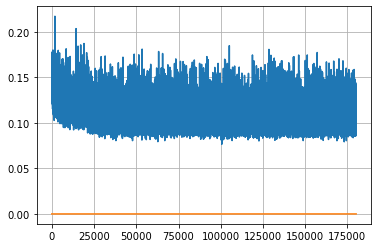

Epoch: 462, iteration 0, loss 0.11668664216995239, cov_diff 0.42129266922541836 cov_diff train 0.4216271453351813
Epoch: 462, iteration 1, loss 0.10823377966880798, cov_diff 0.4074066606646181 cov_diff train 0.40743216745536903
Epoch: 462, iteration 2, loss 0.09680381417274475, cov_diff 0.40823222242357643 cov_diff train 0.4084059004325411
Epoch: 462, iteration 3, loss 0.09926289319992065, cov_diff 0.4107112276324746 cov_diff train 0.41021375258783904
Epoch: 462, iteration 4, loss 0.10891586542129517, cov_diff 0.4164690793369279 cov_diff train 0.41586163517989244
Epoch: 462, iteration 5, loss 0.10043618083000183, cov_diff 0.4092298852451819 cov_diff train 0.40843330706703224
Epoch: 462, iteration 6, loss 0.1106584370136261, cov_diff 0.4070509378345398 cov_diff train 0.4063218362219372
Epoch: 462, iteration 7, loss 0.09870126843452454, cov_diff 0.42485879082834016 cov_diff train 0.42493258836821457
Epoch: 462, iteration 8, loss 0.11431053280830383, cov_diff 0.4097138737273852 cov_diff t

Epoch: 462, iteration 78, loss 0.09505283832550049, cov_diff 0.3964319647882159 cov_diff train 0.3947348020148762
Epoch: 462, iteration 79, loss 0.10617339611053467, cov_diff 0.40436921233698025 cov_diff train 0.404355762308503
Epoch: 462, iteration 80, loss 0.10060647130012512, cov_diff 0.4042552439921651 cov_diff train 0.40356711427480263
Epoch: 462, iteration 81, loss 0.11334314942359924, cov_diff 0.41562001419811345 cov_diff train 0.41469388400879065
Epoch: 462, iteration 82, loss 0.09784954786300659, cov_diff 0.40808257877517706 cov_diff train 0.4073873841233974
Epoch: 462, iteration 83, loss 0.10763111710548401, cov_diff 0.4008171948326658 cov_diff train 0.4000297643517671
Epoch: 462, iteration 84, loss 0.1152910590171814, cov_diff 0.404268925715485 cov_diff train 0.4037471951070457
Epoch: 462, iteration 85, loss 0.10052084922790527, cov_diff 0.40191818592554435 cov_diff train 0.40202181604833975
Epoch: 462, iteration 86, loss 0.11246457695960999, cov_diff 0.42356297156566036 cov

Epoch: 462, iteration 156, loss 0.10785174369812012, cov_diff 0.41974414744132993 cov_diff train 0.4189228208629859
Epoch: 462, iteration 157, loss 0.09830689430236816, cov_diff 0.4015029791926084 cov_diff train 0.40083948932481794
Epoch: 462, iteration 158, loss 0.10454002022743225, cov_diff 0.4074127593816819 cov_diff train 0.4075995334353985
Epoch: 462, iteration 159, loss 0.09222787618637085, cov_diff 0.4225331749236987 cov_diff train 0.42174384416243377
Epoch: 462, iteration 160, loss 0.10481750965118408, cov_diff 0.41056331183666706 cov_diff train 0.409892979584374
Epoch: 462, iteration 161, loss 0.10188904404640198, cov_diff 0.41007907867667814 cov_diff train 0.40972016463155886
Epoch: 462, iteration 162, loss 0.09425485134124756, cov_diff 0.40944188301245416 cov_diff train 0.4093686341884651
Epoch: 462, iteration 163, loss 0.09338754415512085, cov_diff 0.4160580693531472 cov_diff train 0.4152814894917995
Epoch: 462, iteration 164, loss 0.10728958249092102, cov_diff 0.4117691521

Epoch: 462, iteration 232, loss 0.10750499367713928, cov_diff 0.3996821360851622 cov_diff train 0.39921509333652944
Epoch: 462, iteration 233, loss 0.10337048768997192, cov_diff 0.4038688280373898 cov_diff train 0.4037556049145792
Epoch: 462, iteration 234, loss 0.10330843925476074, cov_diff 0.39383570033087795 cov_diff train 0.3930252385106624
Epoch: 462, iteration 235, loss 0.09132081270217896, cov_diff 0.4193111302439167 cov_diff train 0.41927419999669274
Epoch: 462, iteration 236, loss 0.09313377737998962, cov_diff 0.4016014257998288 cov_diff train 0.40139812025247634
Epoch: 462, iteration 237, loss 0.11300250887870789, cov_diff 0.4101799387710506 cov_diff train 0.4102850854496913
Epoch: 462, iteration 238, loss 0.09826651215553284, cov_diff 0.41155821375285195 cov_diff train 0.41138787074521693
Epoch: 462, iteration 239, loss 0.09364405274391174, cov_diff 0.39249295635851816 cov_diff train 0.39267429444251695
Epoch: 462, iteration 240, loss 0.11571240425109863, cov_diff 0.40979621

Epoch: 462, iteration 309, loss 0.10368755459785461, cov_diff 0.41322847092982296 cov_diff train 0.4127316566377514
Epoch: 462, iteration 310, loss 0.09530630707740784, cov_diff 0.4198117879842452 cov_diff train 0.4188156657598941
Epoch: 462, iteration 311, loss 0.09991836547851562, cov_diff 0.41188110203190803 cov_diff train 0.41077739347763814
Epoch: 462, iteration 312, loss 0.10224330425262451, cov_diff 0.40583418307973523 cov_diff train 0.4051922138027838
Epoch: 462, iteration 313, loss 0.10540315508842468, cov_diff 0.4097763154744705 cov_diff train 0.40902673224080965
Epoch: 462, iteration 314, loss 0.09503743052482605, cov_diff 0.40482273777096894 cov_diff train 0.40456317063112485
Epoch: 462, iteration 315, loss 0.106300950050354, cov_diff 0.40831753126240244 cov_diff train 0.40780211399111704
Epoch: 462, iteration 316, loss 0.08987680077552795, cov_diff 0.4137992308261218 cov_diff train 0.41316457711852234
Epoch: 462, iteration 317, loss 0.1143132746219635, cov_diff 0.427875026

Epoch: 462, iteration 387, loss 0.09135085344314575, cov_diff 0.415081420088644 cov_diff train 0.41355582624019166
Epoch: 462, iteration 388, loss 0.11150261759757996, cov_diff 0.41370792299136294 cov_diff train 0.4132760420396232
Epoch: 462, iteration 389, loss 0.09217026829719543, cov_diff 0.40587332605023513 cov_diff train 0.40439278648418336
Epoch: 462, iteration 390, loss 0.1593630015850067, cov_diff 0.4629286191180162 cov_diff train 0.4613673864424078


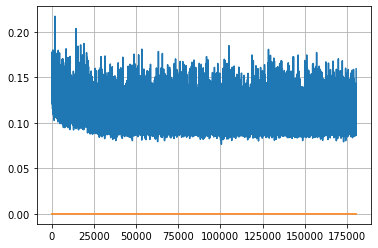

Epoch: 463, iteration 0, loss 0.08641248941421509, cov_diff 0.42487990042754226 cov_diff train 0.42481796545328954
Epoch: 463, iteration 1, loss 0.10178494453430176, cov_diff 0.4045232700749994 cov_diff train 0.4036037580586622
Epoch: 463, iteration 2, loss 0.10699427127838135, cov_diff 0.41516523168937497 cov_diff train 0.41429276018981637
Epoch: 463, iteration 3, loss 0.1125933825969696, cov_diff 0.4088986691307352 cov_diff train 0.40696070967426895
Epoch: 463, iteration 4, loss 0.09786587953567505, cov_diff 0.3958443484802938 cov_diff train 0.3950310101989027
Epoch: 463, iteration 5, loss 0.09717175364494324, cov_diff 0.40516647133344563 cov_diff train 0.4049647852605475
Epoch: 463, iteration 6, loss 0.09413793683052063, cov_diff 0.39521247442608837 cov_diff train 0.3949652515629243
Epoch: 463, iteration 7, loss 0.09231376647949219, cov_diff 0.40929331417137377 cov_diff train 0.40931814429774277
Epoch: 463, iteration 8, loss 0.10237047076225281, cov_diff 0.3989130795847242 cov_diff 

Epoch: 463, iteration 78, loss 0.10358282923698425, cov_diff 0.417509660239052 cov_diff train 0.4163581038603331
Epoch: 463, iteration 79, loss 0.10146710276603699, cov_diff 0.4063500188201145 cov_diff train 0.4064005414218399
Epoch: 463, iteration 80, loss 0.09959405660629272, cov_diff 0.4350776598910058 cov_diff train 0.4356771152980407
Epoch: 463, iteration 81, loss 0.09747746586799622, cov_diff 0.4140497955905829 cov_diff train 0.41390841410880647
Epoch: 463, iteration 82, loss 0.10617756843566895, cov_diff 0.4072802592436038 cov_diff train 0.40663005467366314
Epoch: 463, iteration 83, loss 0.11266124248504639, cov_diff 0.42014329297805586 cov_diff train 0.419738755565008
Epoch: 463, iteration 84, loss 0.10458019375801086, cov_diff 0.4050822244297537 cov_diff train 0.40416518841273624
Epoch: 463, iteration 85, loss 0.11241891980171204, cov_diff 0.3952360412932549 cov_diff train 0.3943935546157602
Epoch: 463, iteration 86, loss 0.10514846444129944, cov_diff 0.40177124552387367 cov_d

Epoch: 463, iteration 156, loss 0.11609652638435364, cov_diff 0.40309978971534066 cov_diff train 0.40168648986487626
Epoch: 463, iteration 157, loss 0.11038696765899658, cov_diff 0.40273291511408155 cov_diff train 0.4018947673196194
Epoch: 463, iteration 158, loss 0.09203824400901794, cov_diff 0.4017219681420292 cov_diff train 0.40112697442972256
Epoch: 463, iteration 159, loss 0.09746262431144714, cov_diff 0.40691229432975706 cov_diff train 0.4068597124864349
Epoch: 463, iteration 160, loss 0.09955969452857971, cov_diff 0.4077819506402007 cov_diff train 0.406853901127703
Epoch: 463, iteration 161, loss 0.10923439264297485, cov_diff 0.39900411992481505 cov_diff train 0.3984665372384043
Epoch: 463, iteration 162, loss 0.10746660828590393, cov_diff 0.4167420291445722 cov_diff train 0.4158531996106461
Epoch: 463, iteration 163, loss 0.10005128383636475, cov_diff 0.39172119426874924 cov_diff train 0.3922870681760747
Epoch: 463, iteration 164, loss 0.10272562503814697, cov_diff 0.4124013964

Epoch: 463, iteration 234, loss 0.11453217267990112, cov_diff 0.41285400885588824 cov_diff train 0.4123395199530634
Epoch: 463, iteration 235, loss 0.09682801365852356, cov_diff 0.4031733477461275 cov_diff train 0.4029600092735127
Epoch: 463, iteration 236, loss 0.10687726736068726, cov_diff 0.4213462261526609 cov_diff train 0.4202783462274053
Epoch: 463, iteration 237, loss 0.09998005628585815, cov_diff 0.4062660644157956 cov_diff train 0.4058096656087493
Epoch: 463, iteration 238, loss 0.11081409454345703, cov_diff 0.41193026405957983 cov_diff train 0.41055817282601065
Epoch: 463, iteration 239, loss 0.10405591130256653, cov_diff 0.4124745312425204 cov_diff train 0.41234268779235084
Epoch: 463, iteration 240, loss 0.10946676135063171, cov_diff 0.40902452733599676 cov_diff train 0.40896647232712885
Epoch: 463, iteration 241, loss 0.10148945450782776, cov_diff 0.4061971697619375 cov_diff train 0.4057801112987763
Epoch: 463, iteration 242, loss 0.10267612338066101, cov_diff 0.4211778646

Epoch: 463, iteration 311, loss 0.1047830879688263, cov_diff 0.40326201429700104 cov_diff train 0.40182608098130074
Epoch: 463, iteration 312, loss 0.11172056198120117, cov_diff 0.4098746436428894 cov_diff train 0.40874749746780586
Epoch: 463, iteration 313, loss 0.10779979825019836, cov_diff 0.42000193591289786 cov_diff train 0.4193636189353473
Epoch: 463, iteration 314, loss 0.10655286908149719, cov_diff 0.396093213297954 cov_diff train 0.3955055941773555
Epoch: 463, iteration 315, loss 0.0904117226600647, cov_diff 0.40283254537916274 cov_diff train 0.4019531287993436
Epoch: 463, iteration 316, loss 0.10132789611816406, cov_diff 0.40408908008011046 cov_diff train 0.4034221505190611
Epoch: 463, iteration 317, loss 0.09970125555992126, cov_diff 0.40421614446967324 cov_diff train 0.4035585261940847
Epoch: 463, iteration 318, loss 0.09851443767547607, cov_diff 0.4021545891313233 cov_diff train 0.40053331985764007
Epoch: 463, iteration 319, loss 0.0972069799900055, cov_diff 0.400251251196

Epoch: 463, iteration 388, loss 0.10732239484786987, cov_diff 0.4121788423534309 cov_diff train 0.4104788593088797
Epoch: 463, iteration 389, loss 0.09977564215660095, cov_diff 0.3990601578648624 cov_diff train 0.3986681641369776
Epoch: 463, iteration 390, loss 0.13958784937858582, cov_diff 0.45221479343961457 cov_diff train 0.4503411551370462


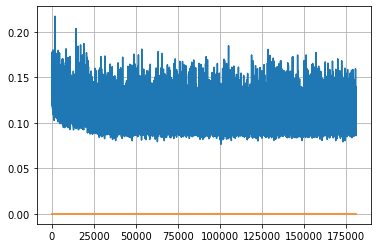

Epoch: 464, iteration 0, loss 0.09773850440979004, cov_diff 0.4122892165412237 cov_diff train 0.41223368072844885
Epoch: 464, iteration 1, loss 0.09293937683105469, cov_diff 0.41366770899279787 cov_diff train 0.4129780909457705
Epoch: 464, iteration 2, loss 0.09695196151733398, cov_diff 0.40192258250802465 cov_diff train 0.4020236857335956
Epoch: 464, iteration 3, loss 0.1153905987739563, cov_diff 0.4156255354476326 cov_diff train 0.41602162080751404
Epoch: 464, iteration 4, loss 0.1007397472858429, cov_diff 0.41418557219517976 cov_diff train 0.41371859692925045
Epoch: 464, iteration 5, loss 0.1104154884815216, cov_diff 0.40808886410045364 cov_diff train 0.4068089448952036
Epoch: 464, iteration 6, loss 0.10673940181732178, cov_diff 0.4160350274327735 cov_diff train 0.41493557895750177
Epoch: 464, iteration 7, loss 0.10803896188735962, cov_diff 0.4213450531854322 cov_diff train 0.4207372103266753
Epoch: 464, iteration 8, loss 0.10776951909065247, cov_diff 0.41594578712057745 cov_diff tr

Epoch: 464, iteration 72, loss 0.09486007690429688, cov_diff 0.40209246880179317 cov_diff train 0.40137439640098
Epoch: 464, iteration 73, loss 0.1132974922657013, cov_diff 0.4082727317289336 cov_diff train 0.4076559423251795
Epoch: 464, iteration 74, loss 0.09848928451538086, cov_diff 0.4294257953714588 cov_diff train 0.42845818794259327
Epoch: 464, iteration 75, loss 0.10921525955200195, cov_diff 0.4086732460016179 cov_diff train 0.4079837105270652
Epoch: 464, iteration 76, loss 0.10034531354904175, cov_diff 0.4167322057821565 cov_diff train 0.4158845813527384
Epoch: 464, iteration 77, loss 0.10464149713516235, cov_diff 0.4075927265610904 cov_diff train 0.40738483366050027
Epoch: 464, iteration 78, loss 0.10868889093399048, cov_diff 0.39952225673936076 cov_diff train 0.39885162885907766
Epoch: 464, iteration 79, loss 0.09608036279678345, cov_diff 0.39897383416716664 cov_diff train 0.39885461708069375
Epoch: 464, iteration 80, loss 0.10770976543426514, cov_diff 0.4164782948129657 cov_

Epoch: 464, iteration 149, loss 0.10899615287780762, cov_diff 0.41918670471411884 cov_diff train 0.41883431507631336
Epoch: 464, iteration 150, loss 0.09205836057662964, cov_diff 0.4124093764561348 cov_diff train 0.4110432000679695
Epoch: 464, iteration 151, loss 0.10736098885536194, cov_diff 0.404486046235568 cov_diff train 0.40394072888610694
Epoch: 464, iteration 152, loss 0.10812190175056458, cov_diff 0.42733274645316405 cov_diff train 0.42744111794111017
Epoch: 464, iteration 153, loss 0.11352196335792542, cov_diff 0.41483485582287893 cov_diff train 0.41430083898701386
Epoch: 464, iteration 154, loss 0.10918155312538147, cov_diff 0.4175616152966585 cov_diff train 0.41646501877845205
Epoch: 464, iteration 155, loss 0.09558877348899841, cov_diff 0.4112313075465406 cov_diff train 0.41022408259937526
Epoch: 464, iteration 156, loss 0.09221112728118896, cov_diff 0.40619432537098143 cov_diff train 0.4065361530557975
Epoch: 464, iteration 157, loss 0.10488396883010864, cov_diff 0.4130767

Epoch: 464, iteration 226, loss 0.10626146197319031, cov_diff 0.4121305982582007 cov_diff train 0.41056742427356113
Epoch: 464, iteration 227, loss 0.08637523651123047, cov_diff 0.40494720437736104 cov_diff train 0.4044198560048984
Epoch: 464, iteration 228, loss 0.10534480214118958, cov_diff 0.4120306134243414 cov_diff train 0.4116468079512564
Epoch: 464, iteration 229, loss 0.09918990731239319, cov_diff 0.4183843697023778 cov_diff train 0.41739380913825974
Epoch: 464, iteration 230, loss 0.09825477004051208, cov_diff 0.4066398792059717 cov_diff train 0.4071561417345262
Epoch: 464, iteration 231, loss 0.10483667254447937, cov_diff 0.40653446243089986 cov_diff train 0.406281854069501
Epoch: 464, iteration 232, loss 0.09509378671646118, cov_diff 0.39546372083863285 cov_diff train 0.39520784363782574
Epoch: 464, iteration 233, loss 0.10362356901168823, cov_diff 0.40809687807081174 cov_diff train 0.4080093970928232
Epoch: 464, iteration 234, loss 0.10653039813041687, cov_diff 0.3999387049

Epoch: 464, iteration 303, loss 0.10741519927978516, cov_diff 0.40826748147830233 cov_diff train 0.4077992964728238
Epoch: 464, iteration 304, loss 0.10623753070831299, cov_diff 0.40912131422414755 cov_diff train 0.4078620898182555
Epoch: 464, iteration 305, loss 0.10483762621879578, cov_diff 0.42444211873154275 cov_diff train 0.42304797418158757
Epoch: 464, iteration 306, loss 0.11052384972572327, cov_diff 0.4183930270192451 cov_diff train 0.41754881456535214
Epoch: 464, iteration 307, loss 0.10615965723991394, cov_diff 0.41197238101113204 cov_diff train 0.4110443859884122
Epoch: 464, iteration 308, loss 0.10222503542900085, cov_diff 0.40990749376836283 cov_diff train 0.40846765588026435
Epoch: 464, iteration 309, loss 0.10714352130889893, cov_diff 0.411724736193185 cov_diff train 0.41020078793017084
Epoch: 464, iteration 310, loss 0.10248225927352905, cov_diff 0.406025997954664 cov_diff train 0.4045476223615828
Epoch: 464, iteration 311, loss 0.10405305027961731, cov_diff 0.422435739

Epoch: 464, iteration 380, loss 0.09223836660385132, cov_diff 0.4066305928004277 cov_diff train 0.40591397947060154
Epoch: 464, iteration 381, loss 0.08969855308532715, cov_diff 0.40146743473337204 cov_diff train 0.4005381888922652
Epoch: 464, iteration 382, loss 0.10024139285087585, cov_diff 0.41754650694077644 cov_diff train 0.4166776426814962
Epoch: 464, iteration 383, loss 0.11041730642318726, cov_diff 0.4197753915437074 cov_diff train 0.41833981693820677
Epoch: 464, iteration 384, loss 0.10927462577819824, cov_diff 0.41298605184306414 cov_diff train 0.41236777906071653
Epoch: 464, iteration 385, loss 0.10412007570266724, cov_diff 0.41932495122136515 cov_diff train 0.4191793110713511
Epoch: 464, iteration 386, loss 0.11058241128921509, cov_diff 0.407709535468395 cov_diff train 0.407280748821847
Epoch: 464, iteration 387, loss 0.09742853045463562, cov_diff 0.40807719747946775 cov_diff train 0.4083195851223278
Epoch: 464, iteration 388, loss 0.11230593919754028, cov_diff 0.4147505231

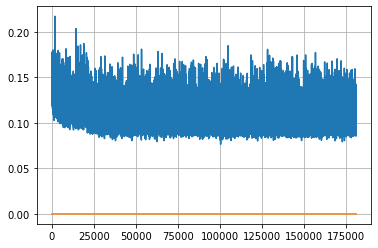

Epoch: 465, iteration 0, loss 0.10467216372489929, cov_diff 0.41516026075008927 cov_diff train 0.4137793329977969
Epoch: 465, iteration 1, loss 0.11354494094848633, cov_diff 0.3975000034181071 cov_diff train 0.39677240711606676
Epoch: 465, iteration 2, loss 0.10844120383262634, cov_diff 0.4089564027081167 cov_diff train 0.40822236703385645
Epoch: 465, iteration 3, loss 0.10043984651565552, cov_diff 0.40581615154114214 cov_diff train 0.40385601817737826
Epoch: 465, iteration 4, loss 0.09322750568389893, cov_diff 0.4055972477725941 cov_diff train 0.40545168883103994
Epoch: 465, iteration 5, loss 0.10422348976135254, cov_diff 0.41445788464665373 cov_diff train 0.4128933668286273
Epoch: 465, iteration 6, loss 0.08407184481620789, cov_diff 0.40364673514368066 cov_diff train 0.4028486348200334
Epoch: 465, iteration 7, loss 0.1213420033454895, cov_diff 0.4166806746395869 cov_diff train 0.41642428877932125
Epoch: 465, iteration 8, loss 0.10727807879447937, cov_diff 0.4051667688761666 cov_diff 

Epoch: 465, iteration 77, loss 0.10054677724838257, cov_diff 0.4046823444970723 cov_diff train 0.40485622944786637
Epoch: 465, iteration 78, loss 0.10376080870628357, cov_diff 0.40140199039377156 cov_diff train 0.40108366572807125
Epoch: 465, iteration 79, loss 0.10042929649353027, cov_diff 0.40509278764755385 cov_diff train 0.40440452390712006
Epoch: 465, iteration 80, loss 0.09617230296134949, cov_diff 0.4021226801372655 cov_diff train 0.4011312530665347
Epoch: 465, iteration 81, loss 0.10228970646858215, cov_diff 0.39816615731445554 cov_diff train 0.3968062671215659
Epoch: 465, iteration 82, loss 0.1134863793849945, cov_diff 0.40357854943416555 cov_diff train 0.40301578859076653
Epoch: 465, iteration 83, loss 0.09047618508338928, cov_diff 0.4161138116010316 cov_diff train 0.4158784297180221
Epoch: 465, iteration 84, loss 0.10259261727333069, cov_diff 0.4090401857846535 cov_diff train 0.40863242618256085
Epoch: 465, iteration 85, loss 0.11497718095779419, cov_diff 0.4253206102582544 

Epoch: 465, iteration 154, loss 0.11028817296028137, cov_diff 0.396205013570241 cov_diff train 0.39563295408405286
Epoch: 465, iteration 155, loss 0.09591406583786011, cov_diff 0.4023001405013714 cov_diff train 0.40108966912724786
Epoch: 465, iteration 156, loss 0.09905621409416199, cov_diff 0.40727110088855134 cov_diff train 0.4065451910763417
Epoch: 465, iteration 157, loss 0.10342463850975037, cov_diff 0.4253148771253795 cov_diff train 0.42436996114459485
Epoch: 465, iteration 158, loss 0.09276458621025085, cov_diff 0.399827821333547 cov_diff train 0.3997293954287282
Epoch: 465, iteration 159, loss 0.120307058095932, cov_diff 0.40530203213796717 cov_diff train 0.4036536746884094
Epoch: 465, iteration 160, loss 0.10135173797607422, cov_diff 0.4112826540603695 cov_diff train 0.4102925101956909
Epoch: 465, iteration 161, loss 0.0981404185295105, cov_diff 0.4136521524760026 cov_diff train 0.4131378073493777
Epoch: 465, iteration 162, loss 0.09894511103630066, cov_diff 0.4135142818946992

Epoch: 465, iteration 232, loss 0.09925258159637451, cov_diff 0.41074292778484445 cov_diff train 0.4096329017646881
Epoch: 465, iteration 233, loss 0.09158065915107727, cov_diff 0.40868362802203506 cov_diff train 0.40782461715896395
Epoch: 465, iteration 234, loss 0.09971481561660767, cov_diff 0.41600772883821513 cov_diff train 0.4147429713909025
Epoch: 465, iteration 235, loss 0.0989440381526947, cov_diff 0.3976786261263865 cov_diff train 0.3974287574149915
Epoch: 465, iteration 236, loss 0.1025179922580719, cov_diff 0.4136105527636105 cov_diff train 0.4130241939201911
Epoch: 465, iteration 237, loss 0.10850381851196289, cov_diff 0.40158233601366206 cov_diff train 0.40062676854397433
Epoch: 465, iteration 238, loss 0.10436931252479553, cov_diff 0.41469042916753385 cov_diff train 0.4138374217364688
Epoch: 465, iteration 239, loss 0.09844821691513062, cov_diff 0.4119547443486318 cov_diff train 0.41195068593420575
Epoch: 465, iteration 240, loss 0.09535002708435059, cov_diff 0.4094422497

Epoch: 465, iteration 309, loss 0.09901443123817444, cov_diff 0.4073562821200058 cov_diff train 0.4071239892776158
Epoch: 465, iteration 310, loss 0.09587836265563965, cov_diff 0.40450568817863175 cov_diff train 0.4037798663144039
Epoch: 465, iteration 311, loss 0.10667914152145386, cov_diff 0.40832623090384607 cov_diff train 0.4080765913959106
Epoch: 465, iteration 312, loss 0.11144435405731201, cov_diff 0.4130723812544244 cov_diff train 0.4123504204440402
Epoch: 465, iteration 313, loss 0.10180991888046265, cov_diff 0.4049041766654839 cov_diff train 0.40327396542676186
Epoch: 465, iteration 314, loss 0.09133273363113403, cov_diff 0.40587090283560545 cov_diff train 0.4059834885390704
Epoch: 465, iteration 315, loss 0.1074669361114502, cov_diff 0.4141477893913248 cov_diff train 0.413064528995397
Epoch: 465, iteration 316, loss 0.10604926943778992, cov_diff 0.42072825433592886 cov_diff train 0.4191591897788375
Epoch: 465, iteration 317, loss 0.09200632572174072, cov_diff 0.4101059092696

Epoch: 465, iteration 386, loss 0.10500839352607727, cov_diff 0.41394914943547423 cov_diff train 0.41272081519703685
Epoch: 465, iteration 387, loss 0.10197076201438904, cov_diff 0.4123065767460558 cov_diff train 0.4127593667141879
Epoch: 465, iteration 388, loss 0.09265592694282532, cov_diff 0.413010873466086 cov_diff train 0.4128416553164154
Epoch: 465, iteration 389, loss 0.11347377300262451, cov_diff 0.4100628185927477 cov_diff train 0.4101158862406718
Epoch: 465, iteration 390, loss 0.15249964594841003, cov_diff 0.45464043525080083 cov_diff train 0.45424305039510476


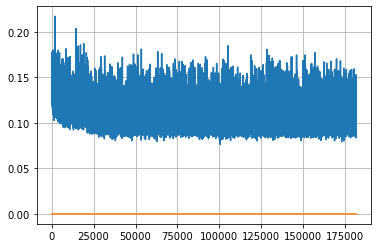

Epoch: 466, iteration 0, loss 0.09847834706306458, cov_diff 0.4341717599064468 cov_diff train 0.4341025782243695
Epoch: 466, iteration 1, loss 0.10372418165206909, cov_diff 0.4090375914249465 cov_diff train 0.4087255234462088
Epoch: 466, iteration 2, loss 0.11750271916389465, cov_diff 0.4066547131119328 cov_diff train 0.40617855562157507
Epoch: 466, iteration 3, loss 0.10187399387359619, cov_diff 0.40152086205236526 cov_diff train 0.4015099123126879
Epoch: 466, iteration 4, loss 0.09576693177223206, cov_diff 0.41312849769933907 cov_diff train 0.41180572297537876
Epoch: 466, iteration 5, loss 0.09689968824386597, cov_diff 0.4109973862107136 cov_diff train 0.4103455610534773
Epoch: 466, iteration 6, loss 0.10769030451774597, cov_diff 0.40874170770620755 cov_diff train 0.4079971967216255
Epoch: 466, iteration 7, loss 0.095601886510849, cov_diff 0.41942847942669387 cov_diff train 0.41841903907810835
Epoch: 466, iteration 8, loss 0.11029323935508728, cov_diff 0.4090166293475883 cov_diff tra

Epoch: 466, iteration 78, loss 0.09944015741348267, cov_diff 0.40179337850302377 cov_diff train 0.40106129217057523
Epoch: 466, iteration 79, loss 0.11385476589202881, cov_diff 0.4054995197332 cov_diff train 0.40356439608487854
Epoch: 466, iteration 80, loss 0.10159960389137268, cov_diff 0.39325324277078794 cov_diff train 0.39273465174076083
Epoch: 466, iteration 81, loss 0.10464578866958618, cov_diff 0.4238135983912205 cov_diff train 0.42166944890803554
Epoch: 466, iteration 82, loss 0.10325241088867188, cov_diff 0.4027264645300961 cov_diff train 0.4019477646868542
Epoch: 466, iteration 83, loss 0.10441502928733826, cov_diff 0.42106014720982965 cov_diff train 0.41793580571033007
Epoch: 466, iteration 84, loss 0.09232890605926514, cov_diff 0.4171772603189648 cov_diff train 0.41496225745634063
Epoch: 466, iteration 85, loss 0.10193192958831787, cov_diff 0.4062940980700962 cov_diff train 0.4043869051633589
Epoch: 466, iteration 86, loss 0.0988299548625946, cov_diff 0.3928716527564145 cov

Epoch: 466, iteration 154, loss 0.11000990867614746, cov_diff 0.4098939456571907 cov_diff train 0.4088445773870964
Epoch: 466, iteration 155, loss 0.08845162391662598, cov_diff 0.410906123781106 cov_diff train 0.4105988725028683
Epoch: 466, iteration 156, loss 0.09924459457397461, cov_diff 0.41705244364803784 cov_diff train 0.41699286925638623
Epoch: 466, iteration 157, loss 0.10447853803634644, cov_diff 0.40897053500058433 cov_diff train 0.4088272269380884
Epoch: 466, iteration 158, loss 0.1015964150428772, cov_diff 0.41941372096095997 cov_diff train 0.4193531043255986
Epoch: 466, iteration 159, loss 0.10635653138160706, cov_diff 0.4213494784996598 cov_diff train 0.41993105022361954
Epoch: 466, iteration 160, loss 0.09988263249397278, cov_diff 0.4126402748055691 cov_diff train 0.41318640718374017
Epoch: 466, iteration 161, loss 0.09386450052261353, cov_diff 0.4129490599622816 cov_diff train 0.4129715371392293
Epoch: 466, iteration 162, loss 0.10530686378479004, cov_diff 0.404346029516

Epoch: 466, iteration 232, loss 0.0917561948299408, cov_diff 0.41180709842371205 cov_diff train 0.41046871906702737
Epoch: 466, iteration 233, loss 0.10616815090179443, cov_diff 0.42126800961573274 cov_diff train 0.4208195941067973
Epoch: 466, iteration 234, loss 0.10251018404960632, cov_diff 0.41515776850001385 cov_diff train 0.41495562388224194
Epoch: 466, iteration 235, loss 0.11369475722312927, cov_diff 0.42475024654053173 cov_diff train 0.4240855908404008
Epoch: 466, iteration 236, loss 0.11973804235458374, cov_diff 0.41811312080833213 cov_diff train 0.41750043512940205
Epoch: 466, iteration 237, loss 0.10144037008285522, cov_diff 0.4086082193080534 cov_diff train 0.40823586192145467
Epoch: 466, iteration 238, loss 0.10002866387367249, cov_diff 0.4112360181198046 cov_diff train 0.4097279164675653
Epoch: 466, iteration 239, loss 0.11139678955078125, cov_diff 0.39873476766478727 cov_diff train 0.3987387473420827
Epoch: 466, iteration 240, loss 0.09371164441108704, cov_diff 0.4015293

Epoch: 466, iteration 309, loss 0.1013527512550354, cov_diff 0.41948839023901924 cov_diff train 0.41901437856108464
Epoch: 466, iteration 310, loss 0.10436868667602539, cov_diff 0.4168406150503062 cov_diff train 0.416682143041701
Epoch: 466, iteration 311, loss 0.10399201512336731, cov_diff 0.4017436083099285 cov_diff train 0.40063079235528853
Epoch: 466, iteration 312, loss 0.10476499795913696, cov_diff 0.41667252996437465 cov_diff train 0.41541395715330953
Epoch: 466, iteration 313, loss 0.11675393581390381, cov_diff 0.4070828294465491 cov_diff train 0.4066714408400207
Epoch: 466, iteration 314, loss 0.10686954855918884, cov_diff 0.41329332223255844 cov_diff train 0.4123734615940228
Epoch: 466, iteration 315, loss 0.1106475293636322, cov_diff 0.4000697096986187 cov_diff train 0.39803645494904066
Epoch: 466, iteration 316, loss 0.10699301958084106, cov_diff 0.39850754202825944 cov_diff train 0.39823079511382437
Epoch: 466, iteration 317, loss 0.104612797498703, cov_diff 0.408843247637

Epoch: 466, iteration 386, loss 0.10843056440353394, cov_diff 0.406195141075734 cov_diff train 0.40474142724959317
Epoch: 466, iteration 387, loss 0.1007649302482605, cov_diff 0.4107783535624889 cov_diff train 0.4107912504301625
Epoch: 466, iteration 388, loss 0.09474655985832214, cov_diff 0.4066107517898714 cov_diff train 0.4066793429692989
Epoch: 466, iteration 389, loss 0.10230690240859985, cov_diff 0.41468324482615265 cov_diff train 0.41471185438543323
Epoch: 466, iteration 390, loss 0.15162795782089233, cov_diff 0.4477591454850812 cov_diff train 0.44577330764199385


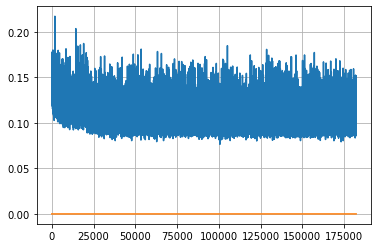

Epoch: 467, iteration 0, loss 0.10008880496025085, cov_diff 0.4076545817093304 cov_diff train 0.40716222044099154
Epoch: 467, iteration 1, loss 0.10528016090393066, cov_diff 0.4194689912522742 cov_diff train 0.4195122523155232
Epoch: 467, iteration 2, loss 0.10361582040786743, cov_diff 0.4011767668430485 cov_diff train 0.4002977514336078
Epoch: 467, iteration 3, loss 0.09235793352127075, cov_diff 0.40930860143907866 cov_diff train 0.4095564830148494
Epoch: 467, iteration 4, loss 0.10176193714141846, cov_diff 0.4129085487291302 cov_diff train 0.41241591969224345
Epoch: 467, iteration 5, loss 0.10504689812660217, cov_diff 0.41601710936747277 cov_diff train 0.41696271675390134
Epoch: 467, iteration 6, loss 0.11700844764709473, cov_diff 0.41097291544238357 cov_diff train 0.4100722325533831
Epoch: 467, iteration 7, loss 0.09583505988121033, cov_diff 0.40568167265643634 cov_diff train 0.40482478510167097
Epoch: 467, iteration 8, loss 0.09651803970336914, cov_diff 0.4127802891896171 cov_diff 

Epoch: 467, iteration 77, loss 0.09588572382926941, cov_diff 0.4026395787179765 cov_diff train 0.4018355147319527
Epoch: 467, iteration 78, loss 0.09688767790794373, cov_diff 0.3937983418600608 cov_diff train 0.3923254035746741
Epoch: 467, iteration 79, loss 0.11510473489761353, cov_diff 0.4115220651037228 cov_diff train 0.4111924829973292
Epoch: 467, iteration 80, loss 0.11139729619026184, cov_diff 0.40172595944831585 cov_diff train 0.40116297711844595
Epoch: 467, iteration 81, loss 0.10739949345588684, cov_diff 0.40117614029423165 cov_diff train 0.40033030967306577
Epoch: 467, iteration 82, loss 0.11603373289108276, cov_diff 0.4129163568265998 cov_diff train 0.4126872655935334
Epoch: 467, iteration 83, loss 0.10524332523345947, cov_diff 0.41162594586984363 cov_diff train 0.41190090941740953
Epoch: 467, iteration 84, loss 0.11459237337112427, cov_diff 0.41573393704312495 cov_diff train 0.41588458999050776
Epoch: 467, iteration 85, loss 0.11277663707733154, cov_diff 0.4113694657414915 

Epoch: 467, iteration 156, loss 0.1159285306930542, cov_diff 0.4191010236810221 cov_diff train 0.417419486456285
Epoch: 467, iteration 157, loss 0.10018125176429749, cov_diff 0.42137719913425437 cov_diff train 0.42100445294780253
Epoch: 467, iteration 158, loss 0.11100101470947266, cov_diff 0.40817180169750494 cov_diff train 0.4072608882054784
Epoch: 467, iteration 159, loss 0.10188251733779907, cov_diff 0.4105874883466684 cov_diff train 0.40992294767109694
Epoch: 467, iteration 160, loss 0.10867437720298767, cov_diff 0.4213892146613196 cov_diff train 0.42084847425393984
Epoch: 467, iteration 161, loss 0.10224327445030212, cov_diff 0.42034559435445346 cov_diff train 0.41987674776375583
Epoch: 467, iteration 162, loss 0.09858366847038269, cov_diff 0.4179854656831026 cov_diff train 0.4160513565158776
Epoch: 467, iteration 163, loss 0.10461559891700745, cov_diff 0.4306809290934387 cov_diff train 0.4295885809900189
Epoch: 467, iteration 164, loss 0.0885705053806305, cov_diff 0.418118663932

Epoch: 467, iteration 234, loss 0.10640144348144531, cov_diff 0.409809618584171 cov_diff train 0.4094390043860721
Epoch: 467, iteration 235, loss 0.0870649516582489, cov_diff 0.41153964963041373 cov_diff train 0.41101157491053125
Epoch: 467, iteration 236, loss 0.1037064790725708, cov_diff 0.4147111461116817 cov_diff train 0.41481103996629787
Epoch: 467, iteration 237, loss 0.10366702079772949, cov_diff 0.401647108879171 cov_diff train 0.4013728652041866
Epoch: 467, iteration 238, loss 0.10457727313041687, cov_diff 0.4174420316003773 cov_diff train 0.41762901368497274
Epoch: 467, iteration 239, loss 0.10981646180152893, cov_diff 0.414806463760086 cov_diff train 0.4150364916051443
Epoch: 467, iteration 240, loss 0.1014457643032074, cov_diff 0.41263154750334136 cov_diff train 0.4122868444171429
Epoch: 467, iteration 241, loss 0.10452207922935486, cov_diff 0.4118729483552417 cov_diff train 0.41204662600742303
Epoch: 467, iteration 242, loss 0.09360414743423462, cov_diff 0.4190231117574995

Epoch: 467, iteration 311, loss 0.10157102346420288, cov_diff 0.41725105278290087 cov_diff train 0.41590418628961456
Epoch: 467, iteration 312, loss 0.10720035433769226, cov_diff 0.40935053643461966 cov_diff train 0.40921360541885854
Epoch: 467, iteration 313, loss 0.10746222734451294, cov_diff 0.407713189619103 cov_diff train 0.4063759843779732
Epoch: 467, iteration 314, loss 0.09423983097076416, cov_diff 0.4020422860890564 cov_diff train 0.4017339106121338
Epoch: 467, iteration 315, loss 0.10249176621437073, cov_diff 0.4125527569899735 cov_diff train 0.41223072645072295
Epoch: 467, iteration 316, loss 0.10834836959838867, cov_diff 0.41648916608431596 cov_diff train 0.4152694848500466
Epoch: 467, iteration 317, loss 0.10683158040046692, cov_diff 0.41178926293497886 cov_diff train 0.41138600525425734
Epoch: 467, iteration 318, loss 0.09985440969467163, cov_diff 0.4059724558142465 cov_diff train 0.40481854570089626
Epoch: 467, iteration 319, loss 0.11085182428359985, cov_diff 0.41057685

Epoch: 467, iteration 388, loss 0.10840049386024475, cov_diff 0.39557494391199927 cov_diff train 0.3953732466052612
Epoch: 467, iteration 389, loss 0.09822091460227966, cov_diff 0.40590985657824313 cov_diff train 0.4060176690628459
Epoch: 467, iteration 390, loss 0.14312955737113953, cov_diff 0.4623733784162789 cov_diff train 0.46157100098969084


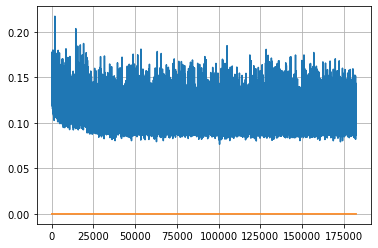

Epoch: 468, iteration 0, loss 0.10955005884170532, cov_diff 0.4086522585696434 cov_diff train 0.407482329839428
Epoch: 468, iteration 1, loss 0.09751391410827637, cov_diff 0.4110987976953774 cov_diff train 0.41116337927156205
Epoch: 468, iteration 2, loss 0.11856889724731445, cov_diff 0.4197264211610686 cov_diff train 0.4187934825032875
Epoch: 468, iteration 3, loss 0.11240676045417786, cov_diff 0.4043570299449104 cov_diff train 0.4036212047879395
Epoch: 468, iteration 4, loss 0.09785965085029602, cov_diff 0.4181233665161013 cov_diff train 0.4178291243816944
Epoch: 468, iteration 5, loss 0.11004459857940674, cov_diff 0.4019936659042966 cov_diff train 0.4015870914385652
Epoch: 468, iteration 6, loss 0.11581063270568848, cov_diff 0.4188600392780103 cov_diff train 0.41893874795908864
Epoch: 468, iteration 7, loss 0.10172256827354431, cov_diff 0.4272414044053996 cov_diff train 0.42662351882065086
Epoch: 468, iteration 8, loss 0.11356556415557861, cov_diff 0.42051131371729156 cov_diff train

Epoch: 468, iteration 78, loss 0.09570065140724182, cov_diff 0.4058303238440085 cov_diff train 0.405500162829957
Epoch: 468, iteration 79, loss 0.10554587841033936, cov_diff 0.42361393667835245 cov_diff train 0.4227097694927765
Epoch: 468, iteration 80, loss 0.11462301015853882, cov_diff 0.4186850499129733 cov_diff train 0.41695699145503634
Epoch: 468, iteration 81, loss 0.09463021159172058, cov_diff 0.40579426668674146 cov_diff train 0.40579764542898983
Epoch: 468, iteration 82, loss 0.0948905348777771, cov_diff 0.40704924335285336 cov_diff train 0.40632300571201646
Epoch: 468, iteration 83, loss 0.09620249271392822, cov_diff 0.39826162526505476 cov_diff train 0.39844303890223803
Epoch: 468, iteration 84, loss 0.0970202386379242, cov_diff 0.400742233364211 cov_diff train 0.40057809243978265
Epoch: 468, iteration 85, loss 0.11786964535713196, cov_diff 0.4185133619159995 cov_diff train 0.41796318345077405
Epoch: 468, iteration 86, loss 0.1060788631439209, cov_diff 0.4076130564263665 cov

Epoch: 468, iteration 156, loss 0.10770440101623535, cov_diff 0.41379225166125794 cov_diff train 0.4120983640606645
Epoch: 468, iteration 157, loss 0.10884472727775574, cov_diff 0.4057507701826734 cov_diff train 0.4054401713174193
Epoch: 468, iteration 158, loss 0.11702042818069458, cov_diff 0.40713309521315966 cov_diff train 0.40681652192117407
Epoch: 468, iteration 159, loss 0.10119998455047607, cov_diff 0.39942556959695835 cov_diff train 0.3992203529099092
Epoch: 468, iteration 160, loss 0.10588881373405457, cov_diff 0.40620612756819574 cov_diff train 0.4065506039394193
Epoch: 468, iteration 161, loss 0.11342859268188477, cov_diff 0.4080723431230059 cov_diff train 0.40753297858588555
Epoch: 468, iteration 162, loss 0.1023581326007843, cov_diff 0.4199938676762191 cov_diff train 0.41848624600000434
Epoch: 468, iteration 163, loss 0.09674379229545593, cov_diff 0.4078349778948667 cov_diff train 0.4069727692640878
Epoch: 468, iteration 164, loss 0.1165972650051117, cov_diff 0.40827575786

Epoch: 468, iteration 233, loss 0.09229981899261475, cov_diff 0.39307214613345937 cov_diff train 0.393294627495164
Epoch: 468, iteration 234, loss 0.1039065420627594, cov_diff 0.4100501898760218 cov_diff train 0.4099171112583744
Epoch: 468, iteration 235, loss 0.10556542873382568, cov_diff 0.4163400046693957 cov_diff train 0.41534479232267907
Epoch: 468, iteration 236, loss 0.10068759322166443, cov_diff 0.4136193051483204 cov_diff train 0.4126840417221464
Epoch: 468, iteration 237, loss 0.10304132103919983, cov_diff 0.40328779919489627 cov_diff train 0.40367012489471166
Epoch: 468, iteration 238, loss 0.1076526939868927, cov_diff 0.41194103929532183 cov_diff train 0.41100637702050863
Epoch: 468, iteration 239, loss 0.10854458808898926, cov_diff 0.40472955773473046 cov_diff train 0.40446806568843874
Epoch: 468, iteration 240, loss 0.11059442162513733, cov_diff 0.4080212382870608 cov_diff train 0.40866308477833635
Epoch: 468, iteration 241, loss 0.09026917815208435, cov_diff 0.4109487986

Epoch: 468, iteration 309, loss 0.10755383968353271, cov_diff 0.411128180820812 cov_diff train 0.4102185201091359
Epoch: 468, iteration 310, loss 0.10174769163131714, cov_diff 0.4137775088024005 cov_diff train 0.4130994869973807
Epoch: 468, iteration 311, loss 0.09603816270828247, cov_diff 0.4035987176437899 cov_diff train 0.40307229799731326
Epoch: 468, iteration 312, loss 0.09132203459739685, cov_diff 0.3980604532176367 cov_diff train 0.39712799444250674
Epoch: 468, iteration 313, loss 0.1008305549621582, cov_diff 0.39956016579514275 cov_diff train 0.39893318222466984
Epoch: 468, iteration 314, loss 0.10474023222923279, cov_diff 0.4038092776453981 cov_diff train 0.40421835130917994
Epoch: 468, iteration 315, loss 0.10628846287727356, cov_diff 0.41201810649721293 cov_diff train 0.41159448416070676
Epoch: 468, iteration 316, loss 0.09282326698303223, cov_diff 0.413747958433335 cov_diff train 0.41392569452306727
Epoch: 468, iteration 317, loss 0.10660460591316223, cov_diff 0.41765354273

Epoch: 468, iteration 386, loss 0.09518808126449585, cov_diff 0.4093079337361007 cov_diff train 0.4088226279673297
Epoch: 468, iteration 387, loss 0.10506534576416016, cov_diff 0.4044845325942417 cov_diff train 0.40419940606373317
Epoch: 468, iteration 388, loss 0.1002538800239563, cov_diff 0.40677445099682963 cov_diff train 0.4057407276944105
Epoch: 468, iteration 389, loss 0.10168975591659546, cov_diff 0.4003952677244582 cov_diff train 0.4011762426978549
Epoch: 468, iteration 390, loss 0.13018685579299927, cov_diff 0.45492941221828426 cov_diff train 0.4535196654921822


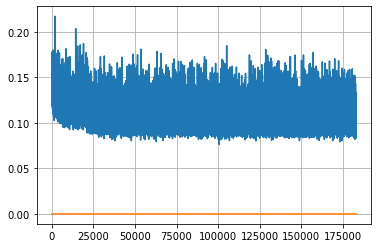

Epoch: 469, iteration 0, loss 0.09902340173721313, cov_diff 0.3959151549572048 cov_diff train 0.39490719145994607
Epoch: 469, iteration 1, loss 0.10366135835647583, cov_diff 0.4116132323901461 cov_diff train 0.41161961182811935
Epoch: 469, iteration 2, loss 0.10215744376182556, cov_diff 0.4203964544358344 cov_diff train 0.4198691247185471
Epoch: 469, iteration 3, loss 0.10460919141769409, cov_diff 0.40702659900599303 cov_diff train 0.40695210131458975
Epoch: 469, iteration 4, loss 0.09923487901687622, cov_diff 0.41103441751215763 cov_diff train 0.4100966837443108
Epoch: 469, iteration 5, loss 0.0960652232170105, cov_diff 0.42714168601889724 cov_diff train 0.4258472739108045
Epoch: 469, iteration 6, loss 0.10335806012153625, cov_diff 0.40586162352471744 cov_diff train 0.40587875524904615
Epoch: 469, iteration 7, loss 0.10400223731994629, cov_diff 0.4032881434693744 cov_diff train 0.40229054217367843
Epoch: 469, iteration 8, loss 0.11457425355911255, cov_diff 0.41487508533680356 cov_diff

Epoch: 469, iteration 74, loss 0.10044395923614502, cov_diff 0.4113766094798805 cov_diff train 0.41034707306611606
Epoch: 469, iteration 75, loss 0.1116747260093689, cov_diff 0.4295046611727028 cov_diff train 0.42847877442369925
Epoch: 469, iteration 76, loss 0.10754767060279846, cov_diff 0.4152129614427821 cov_diff train 0.41443162067929834
Epoch: 469, iteration 77, loss 0.11561423540115356, cov_diff 0.41084374869196466 cov_diff train 0.41031153627440214
Epoch: 469, iteration 78, loss 0.10231301188468933, cov_diff 0.4171450251337398 cov_diff train 0.4152960445246826
Epoch: 469, iteration 79, loss 0.11100584268569946, cov_diff 0.41305911827644204 cov_diff train 0.41238672415645244
Epoch: 469, iteration 80, loss 0.11341029405593872, cov_diff 0.41066588614843824 cov_diff train 0.4101067273267211
Epoch: 469, iteration 81, loss 0.10817572474479675, cov_diff 0.4189932421614294 cov_diff train 0.4181084542827138
Epoch: 469, iteration 82, loss 0.10553845763206482, cov_diff 0.40649829505799373 

Epoch: 469, iteration 151, loss 0.12462860345840454, cov_diff 0.4094401784906725 cov_diff train 0.40851959364031076
Epoch: 469, iteration 152, loss 0.09835505485534668, cov_diff 0.405970774310911 cov_diff train 0.40529763177722716
Epoch: 469, iteration 153, loss 0.10436922311782837, cov_diff 0.41305534575125885 cov_diff train 0.4126139168385124
Epoch: 469, iteration 154, loss 0.11058199405670166, cov_diff 0.40626398982929 cov_diff train 0.4060557182254655
Epoch: 469, iteration 155, loss 0.09556862711906433, cov_diff 0.41850644643444834 cov_diff train 0.4172239366315253
Epoch: 469, iteration 156, loss 0.10794991254806519, cov_diff 0.41808303605329794 cov_diff train 0.4168148484800867
Epoch: 469, iteration 157, loss 0.108091801404953, cov_diff 0.4082406262258506 cov_diff train 0.40671227890395334
Epoch: 469, iteration 158, loss 0.10531079769134521, cov_diff 0.4221617803951985 cov_diff train 0.42108975591702014
Epoch: 469, iteration 159, loss 0.10046064853668213, cov_diff 0.40695847462526

Epoch: 469, iteration 228, loss 0.11139732599258423, cov_diff 0.41548259158345763 cov_diff train 0.4136253508665481
Epoch: 469, iteration 229, loss 0.10395091772079468, cov_diff 0.4113047281576193 cov_diff train 0.41070231511477107
Epoch: 469, iteration 230, loss 0.09305477142333984, cov_diff 0.4143330796911267 cov_diff train 0.414117883273875
Epoch: 469, iteration 231, loss 0.09104356169700623, cov_diff 0.40940152066096364 cov_diff train 0.40803275071203615
Epoch: 469, iteration 232, loss 0.10886958241462708, cov_diff 0.4071476289391 cov_diff train 0.4063231945716475
Epoch: 469, iteration 233, loss 0.10496750473976135, cov_diff 0.4122097337909723 cov_diff train 0.4114860853089116
Epoch: 469, iteration 234, loss 0.09136331081390381, cov_diff 0.4137913570496637 cov_diff train 0.4138626077128432
Epoch: 469, iteration 235, loss 0.09326156973838806, cov_diff 0.4094238642276676 cov_diff train 0.40892554453220264
Epoch: 469, iteration 236, loss 0.09376394748687744, cov_diff 0.415716865045770

Epoch: 469, iteration 305, loss 0.10989099740982056, cov_diff 0.42226776834415664 cov_diff train 0.4216090702311733
Epoch: 469, iteration 306, loss 0.09361565113067627, cov_diff 0.4142768350492148 cov_diff train 0.41380825392097137
Epoch: 469, iteration 307, loss 0.091014564037323, cov_diff 0.41973002355766026 cov_diff train 0.4192970740509225
Epoch: 469, iteration 308, loss 0.11173561215400696, cov_diff 0.41469390340182727 cov_diff train 0.41441536306229465
Epoch: 469, iteration 309, loss 0.09184479713439941, cov_diff 0.41612506243091474 cov_diff train 0.4158259115999456
Epoch: 469, iteration 310, loss 0.11222177743911743, cov_diff 0.4147243479263319 cov_diff train 0.4140794472842063
Epoch: 469, iteration 311, loss 0.1121625304222107, cov_diff 0.40225737080140406 cov_diff train 0.4017680237224432
Epoch: 469, iteration 312, loss 0.0940062403678894, cov_diff 0.4052473987533882 cov_diff train 0.4047610637689791
Epoch: 469, iteration 313, loss 0.10455042123794556, cov_diff 0.4012308179064

Epoch: 469, iteration 382, loss 0.08956536650657654, cov_diff 0.4017957048097408 cov_diff train 0.4013678675688625
Epoch: 469, iteration 383, loss 0.09957411885261536, cov_diff 0.42154686426293225 cov_diff train 0.4214941329077841
Epoch: 469, iteration 384, loss 0.10332632064819336, cov_diff 0.4039140633191309 cov_diff train 0.4035615703457988
Epoch: 469, iteration 385, loss 0.09975317120552063, cov_diff 0.41666314353951384 cov_diff train 0.41670100335691307
Epoch: 469, iteration 386, loss 0.10624194145202637, cov_diff 0.42009614374077614 cov_diff train 0.41924805736566306
Epoch: 469, iteration 387, loss 0.11071053147315979, cov_diff 0.42293301124765725 cov_diff train 0.42294350183828006
Epoch: 469, iteration 388, loss 0.09542852640151978, cov_diff 0.4042538776268063 cov_diff train 0.40363343303383487
Epoch: 469, iteration 389, loss 0.10119122266769409, cov_diff 0.4157702494943007 cov_diff train 0.4160850736582486
Epoch: 469, iteration 390, loss 0.15097039937973022, cov_diff 0.44748018

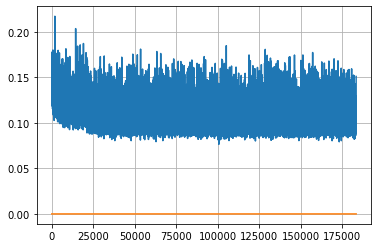

Epoch: 470, iteration 0, loss 0.12172681093215942, cov_diff 0.4088516187034105 cov_diff train 0.40931336615983327
Epoch: 470, iteration 1, loss 0.11029556393623352, cov_diff 0.41448611933315155 cov_diff train 0.41343319878866486
Epoch: 470, iteration 2, loss 0.09696510434150696, cov_diff 0.41235687948804217 cov_diff train 0.4107022691106019
Epoch: 470, iteration 3, loss 0.08962312340736389, cov_diff 0.408876964154286 cov_diff train 0.40747792775000086
Epoch: 470, iteration 4, loss 0.09589466452598572, cov_diff 0.4123790349061069 cov_diff train 0.41141549102043823
Epoch: 470, iteration 5, loss 0.10526752471923828, cov_diff 0.4010427656708232 cov_diff train 0.3986821535374554
Epoch: 470, iteration 6, loss 0.1070261001586914, cov_diff 0.41062344549540347 cov_diff train 0.4086311814313607
Epoch: 470, iteration 7, loss 0.10751539468765259, cov_diff 0.40093229402278346 cov_diff train 0.4003304056266818
Epoch: 470, iteration 8, loss 0.10639303922653198, cov_diff 0.4235918563243698 cov_diff tr

Epoch: 470, iteration 76, loss 0.09743326902389526, cov_diff 0.40450363313060494 cov_diff train 0.4039208080414486
Epoch: 470, iteration 77, loss 0.11176624894142151, cov_diff 0.407969287828619 cov_diff train 0.4071290431633138
Epoch: 470, iteration 78, loss 0.095246821641922, cov_diff 0.41957010538140693 cov_diff train 0.4189716952288235
Epoch: 470, iteration 79, loss 0.09974846243858337, cov_diff 0.4033582145358215 cov_diff train 0.40300314053888037
Epoch: 470, iteration 80, loss 0.11703458428382874, cov_diff 0.40851928388377584 cov_diff train 0.40747753197364817
Epoch: 470, iteration 81, loss 0.10091918706893921, cov_diff 0.4046447957293989 cov_diff train 0.40467048199899314
Epoch: 470, iteration 82, loss 0.10676437616348267, cov_diff 0.4212005162038539 cov_diff train 0.4208694203903794
Epoch: 470, iteration 83, loss 0.10574045777320862, cov_diff 0.41725151735091026 cov_diff train 0.4161870736668281
Epoch: 470, iteration 84, loss 0.09354650974273682, cov_diff 0.40354865969144743 cov

Epoch: 470, iteration 153, loss 0.10027825832366943, cov_diff 0.3972245507134092 cov_diff train 0.3966999223024687
Epoch: 470, iteration 154, loss 0.1052025556564331, cov_diff 0.4238063735684674 cov_diff train 0.4231658502276086
Epoch: 470, iteration 155, loss 0.11471894383430481, cov_diff 0.41378101096531017 cov_diff train 0.4135787009348698
Epoch: 470, iteration 156, loss 0.09472677111625671, cov_diff 0.40921488792712607 cov_diff train 0.409192624040301
Epoch: 470, iteration 157, loss 0.098317950963974, cov_diff 0.417609716552127 cov_diff train 0.4175786058380212
Epoch: 470, iteration 158, loss 0.10330954194068909, cov_diff 0.407459035999682 cov_diff train 0.40595083377134183
Epoch: 470, iteration 159, loss 0.11133846640586853, cov_diff 0.4122946402163587 cov_diff train 0.4111108726769544
Epoch: 470, iteration 160, loss 0.09874129295349121, cov_diff 0.4067809762470699 cov_diff train 0.40627678150623775
Epoch: 470, iteration 161, loss 0.10275724530220032, cov_diff 0.4134859462089199 c

Epoch: 470, iteration 230, loss 0.10316523909568787, cov_diff 0.41241090459184254 cov_diff train 0.4128018541065322
Epoch: 470, iteration 231, loss 0.10325080156326294, cov_diff 0.40822099511315935 cov_diff train 0.40787931233083347
Epoch: 470, iteration 232, loss 0.0966479480266571, cov_diff 0.4019772904212278 cov_diff train 0.40099136868280383
Epoch: 470, iteration 233, loss 0.09981811046600342, cov_diff 0.39605660962604733 cov_diff train 0.39549157390722456
Epoch: 470, iteration 234, loss 0.10155943036079407, cov_diff 0.4131824269606769 cov_diff train 0.4127605949242092
Epoch: 470, iteration 235, loss 0.11141514778137207, cov_diff 0.4146773696885765 cov_diff train 0.4132852419907505
Epoch: 470, iteration 236, loss 0.1060093343257904, cov_diff 0.4131157400497189 cov_diff train 0.4129587005226583
Epoch: 470, iteration 237, loss 0.09336680173873901, cov_diff 0.42079431636420234 cov_diff train 0.41935121405516806
Epoch: 470, iteration 238, loss 0.09631514549255371, cov_diff 0.4010332089

Epoch: 470, iteration 307, loss 0.09858596324920654, cov_diff 0.41559707999109124 cov_diff train 0.41437216005620725
Epoch: 470, iteration 308, loss 0.11239302158355713, cov_diff 0.40202025285756715 cov_diff train 0.40133680228966956
Epoch: 470, iteration 309, loss 0.09897518157958984, cov_diff 0.3964338405896001 cov_diff train 0.3956508232802581
Epoch: 470, iteration 310, loss 0.10166481137275696, cov_diff 0.4120672711123598 cov_diff train 0.41164534901600197
Epoch: 470, iteration 311, loss 0.10463830828666687, cov_diff 0.40694908565728427 cov_diff train 0.4055639448439155
Epoch: 470, iteration 312, loss 0.10494410991668701, cov_diff 0.41745464767209023 cov_diff train 0.41691302718848644
Epoch: 470, iteration 313, loss 0.10075116157531738, cov_diff 0.40868477854925145 cov_diff train 0.4064305460756716
Epoch: 470, iteration 314, loss 0.10413768887519836, cov_diff 0.40599133193470294 cov_diff train 0.40449462428092
Epoch: 470, iteration 315, loss 0.11628690361976624, cov_diff 0.40860688

Epoch: 470, iteration 384, loss 0.1112404465675354, cov_diff 0.414763207814909 cov_diff train 0.4144914590389007
Epoch: 470, iteration 385, loss 0.1125154197216034, cov_diff 0.4236724180435053 cov_diff train 0.4227999165406769
Epoch: 470, iteration 386, loss 0.09478732943534851, cov_diff 0.4029563823108586 cov_diff train 0.4027051419122263
Epoch: 470, iteration 387, loss 0.09225183725357056, cov_diff 0.41857252443938525 cov_diff train 0.41889181387227997
Epoch: 470, iteration 388, loss 0.10928967595100403, cov_diff 0.40377634372288923 cov_diff train 0.4038514837010567
Epoch: 470, iteration 389, loss 0.10943922400474548, cov_diff 0.4135410058780572 cov_diff train 0.4129468643871726
Epoch: 470, iteration 390, loss 0.14725962281227112, cov_diff 0.44526215332067126 cov_diff train 0.44368915199076037


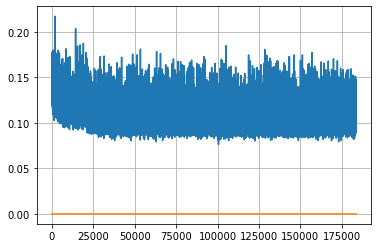

Epoch: 471, iteration 0, loss 0.10088872909545898, cov_diff 0.41774251145250035 cov_diff train 0.4180989975269203
Epoch: 471, iteration 1, loss 0.12017896771430969, cov_diff 0.41078877438852923 cov_diff train 0.4099814194895883
Epoch: 471, iteration 2, loss 0.11533308029174805, cov_diff 0.4014529616859929 cov_diff train 0.40147633780217207
Epoch: 471, iteration 3, loss 0.09981992840766907, cov_diff 0.4226995290205736 cov_diff train 0.4219777245618582
Epoch: 471, iteration 4, loss 0.09119775891304016, cov_diff 0.4088662899813624 cov_diff train 0.408434952257648
Epoch: 471, iteration 5, loss 0.10642063617706299, cov_diff 0.42034266860798025 cov_diff train 0.41982692759928686
Epoch: 471, iteration 6, loss 0.09158152341842651, cov_diff 0.4072746265514075 cov_diff train 0.4051940960344371
Epoch: 471, iteration 7, loss 0.10976532101631165, cov_diff 0.4143260769449278 cov_diff train 0.4136584127933199
Epoch: 471, iteration 8, loss 0.10402902960777283, cov_diff 0.41514999480890413 cov_diff tra

Epoch: 471, iteration 78, loss 0.11834150552749634, cov_diff 0.41266115286357696 cov_diff train 0.41193714904209244
Epoch: 471, iteration 79, loss 0.11024567484855652, cov_diff 0.4069340014108569 cov_diff train 0.4052449442795587
Epoch: 471, iteration 80, loss 0.10456913709640503, cov_diff 0.41666320348378943 cov_diff train 0.4152129449601537
Epoch: 471, iteration 81, loss 0.10082024335861206, cov_diff 0.4136294722774739 cov_diff train 0.4134826005913481
Epoch: 471, iteration 82, loss 0.09202900528907776, cov_diff 0.40099590205216756 cov_diff train 0.3999528861558503
Epoch: 471, iteration 83, loss 0.1001666784286499, cov_diff 0.4053185209460296 cov_diff train 0.4041029216472588
Epoch: 471, iteration 84, loss 0.08953729271888733, cov_diff 0.40606081393703786 cov_diff train 0.40481575255708324
Epoch: 471, iteration 85, loss 0.10519352555274963, cov_diff 0.4113390025792542 cov_diff train 0.41139249141640954
Epoch: 471, iteration 86, loss 0.10047811269760132, cov_diff 0.40605669829020613 c

Epoch: 471, iteration 156, loss 0.11103197932243347, cov_diff 0.4077526689913183 cov_diff train 0.4064260134249526
Epoch: 471, iteration 157, loss 0.10914725065231323, cov_diff 0.40740078068539143 cov_diff train 0.4069696801527496
Epoch: 471, iteration 158, loss 0.10030212998390198, cov_diff 0.40874957612588864 cov_diff train 0.4069563981038646
Epoch: 471, iteration 159, loss 0.10493355989456177, cov_diff 0.4070811012445403 cov_diff train 0.4071385984054573
Epoch: 471, iteration 160, loss 0.10462930798530579, cov_diff 0.42702353263063697 cov_diff train 0.4252682747582178
Epoch: 471, iteration 161, loss 0.0898890495300293, cov_diff 0.40575771533919874 cov_diff train 0.4052226520647972
Epoch: 471, iteration 162, loss 0.10105112195014954, cov_diff 0.3975006394341299 cov_diff train 0.3961301186331243
Epoch: 471, iteration 163, loss 0.09723743796348572, cov_diff 0.403610242112454 cov_diff train 0.40313372382610074
Epoch: 471, iteration 164, loss 0.09802183508872986, cov_diff 0.4064325436732

Epoch: 471, iteration 233, loss 0.10437473654747009, cov_diff 0.40428103676603583 cov_diff train 0.40342784596345593
Epoch: 471, iteration 234, loss 0.10694918036460876, cov_diff 0.40585837355327475 cov_diff train 0.4048239670170394
Epoch: 471, iteration 235, loss 0.09905710816383362, cov_diff 0.40727439123776454 cov_diff train 0.40653576481158404
Epoch: 471, iteration 236, loss 0.10914093255996704, cov_diff 0.4104576107111851 cov_diff train 0.4098918042934153
Epoch: 471, iteration 237, loss 0.09843859076499939, cov_diff 0.40963416788621915 cov_diff train 0.40875772859667314
Epoch: 471, iteration 238, loss 0.09427773952484131, cov_diff 0.40282663277461117 cov_diff train 0.40175226178060913
Epoch: 471, iteration 239, loss 0.10819730162620544, cov_diff 0.4041584473625847 cov_diff train 0.40363525900256747
Epoch: 471, iteration 240, loss 0.11524385213851929, cov_diff 0.40405654252537115 cov_diff train 0.4031632822821242
Epoch: 471, iteration 241, loss 0.10994219779968262, cov_diff 0.42328

Epoch: 471, iteration 310, loss 0.09653571248054504, cov_diff 0.4087611988391935 cov_diff train 0.4082829022919026
Epoch: 471, iteration 311, loss 0.10129749774932861, cov_diff 0.40908448103824424 cov_diff train 0.40858584835154965
Epoch: 471, iteration 312, loss 0.1055905818939209, cov_diff 0.41542890986239356 cov_diff train 0.41473606956426273
Epoch: 471, iteration 313, loss 0.10840719938278198, cov_diff 0.4118533148365987 cov_diff train 0.41093589322413954
Epoch: 471, iteration 314, loss 0.10505309700965881, cov_diff 0.4131586934777 cov_diff train 0.41299283784499685
Epoch: 471, iteration 315, loss 0.09796589612960815, cov_diff 0.4108894399614634 cov_diff train 0.40971999276806637
Epoch: 471, iteration 316, loss 0.09559664130210876, cov_diff 0.42426547231775535 cov_diff train 0.42375927986940454
Epoch: 471, iteration 317, loss 0.10913944244384766, cov_diff 0.4239379206105583 cov_diff train 0.4230100293852325
Epoch: 471, iteration 318, loss 0.1066485345363617, cov_diff 0.407898135799

Epoch: 471, iteration 387, loss 0.10263842344284058, cov_diff 0.41441158949876805 cov_diff train 0.4133117242072107
Epoch: 471, iteration 388, loss 0.10058337450027466, cov_diff 0.40611217449518505 cov_diff train 0.4052763928250784
Epoch: 471, iteration 389, loss 0.10435470938682556, cov_diff 0.4147517808820911 cov_diff train 0.41462659482428804
Epoch: 471, iteration 390, loss 0.1530776023864746, cov_diff 0.4470935564159796 cov_diff train 0.44623155074984705


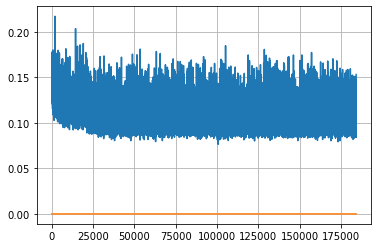

Epoch: 472, iteration 0, loss 0.10260596871376038, cov_diff 0.41541164327239893 cov_diff train 0.4146702920117744
Epoch: 472, iteration 1, loss 0.1046198308467865, cov_diff 0.41986488356794377 cov_diff train 0.4196370170158993
Epoch: 472, iteration 2, loss 0.1053423285484314, cov_diff 0.40375690866250813 cov_diff train 0.40349921848689935
Epoch: 472, iteration 3, loss 0.11445188522338867, cov_diff 0.4133785211455783 cov_diff train 0.4122896853705833
Epoch: 472, iteration 4, loss 0.11511588096618652, cov_diff 0.4054882697221852 cov_diff train 0.4043456128145607
Epoch: 472, iteration 5, loss 0.10476759076118469, cov_diff 0.4177860808924104 cov_diff train 0.41683052959539696
Epoch: 472, iteration 6, loss 0.10642114281654358, cov_diff 0.42639831000743017 cov_diff train 0.42432391776498163
Epoch: 472, iteration 7, loss 0.10567882657051086, cov_diff 0.41927494009721605 cov_diff train 0.4183420914199119
Epoch: 472, iteration 8, loss 0.10116109251976013, cov_diff 0.41447005690269245 cov_diff t

Epoch: 472, iteration 77, loss 0.10890659689903259, cov_diff 0.40971924085038164 cov_diff train 0.4095931340142918
Epoch: 472, iteration 78, loss 0.10162946581840515, cov_diff 0.3987949514208831 cov_diff train 0.39758460345188384
Epoch: 472, iteration 79, loss 0.09885942935943604, cov_diff 0.4038964172065903 cov_diff train 0.4033402514591344
Epoch: 472, iteration 80, loss 0.10327234864234924, cov_diff 0.41050129943949953 cov_diff train 0.4109303245940207
Epoch: 472, iteration 81, loss 0.10376709699630737, cov_diff 0.4012716270461152 cov_diff train 0.4016776539114248
Epoch: 472, iteration 82, loss 0.10867798328399658, cov_diff 0.40506419642102115 cov_diff train 0.40435825112349366
Epoch: 472, iteration 83, loss 0.1041625440120697, cov_diff 0.4004088939908375 cov_diff train 0.4000530287249596
Epoch: 472, iteration 84, loss 0.0920976996421814, cov_diff 0.40266132337731536 cov_diff train 0.40254753295885976
Epoch: 472, iteration 85, loss 0.11923667788505554, cov_diff 0.3969073557596899 cov

Epoch: 472, iteration 155, loss 0.10756972432136536, cov_diff 0.4120892371274751 cov_diff train 0.4105522548475158
Epoch: 472, iteration 156, loss 0.10069990158081055, cov_diff 0.4068025225023505 cov_diff train 0.40646638115962924
Epoch: 472, iteration 157, loss 0.10759168863296509, cov_diff 0.4080900897353573 cov_diff train 0.40735768165201797
Epoch: 472, iteration 158, loss 0.11322659254074097, cov_diff 0.4056935010981266 cov_diff train 0.4066990884584678
Epoch: 472, iteration 159, loss 0.09263300895690918, cov_diff 0.40513572870322456 cov_diff train 0.4051548390301344
Epoch: 472, iteration 160, loss 0.10410574078559875, cov_diff 0.42147648407399463 cov_diff train 0.42114289118564074
Epoch: 472, iteration 161, loss 0.09592759609222412, cov_diff 0.40224588331085825 cov_diff train 0.40191554713215377
Epoch: 472, iteration 162, loss 0.11477762460708618, cov_diff 0.4021178483522191 cov_diff train 0.4024044643477755
Epoch: 472, iteration 163, loss 0.09832048416137695, cov_diff 0.418475045

Epoch: 472, iteration 229, loss 0.11594998836517334, cov_diff 0.411666021197409 cov_diff train 0.41099878913145077
Epoch: 472, iteration 230, loss 0.09876477718353271, cov_diff 0.4101484621465658 cov_diff train 0.40921972892234815
Epoch: 472, iteration 231, loss 0.114531010389328, cov_diff 0.4280092487588389 cov_diff train 0.4270691228562041
Epoch: 472, iteration 232, loss 0.10809844732284546, cov_diff 0.40746103676832435 cov_diff train 0.4061811637158953
Epoch: 472, iteration 233, loss 0.10834118723869324, cov_diff 0.39678334689312933 cov_diff train 0.3962437408363266
Epoch: 472, iteration 234, loss 0.10511210560798645, cov_diff 0.4060253024233202 cov_diff train 0.4052261371082367
Epoch: 472, iteration 235, loss 0.11649823188781738, cov_diff 0.41100064757378624 cov_diff train 0.4106638306352817
Epoch: 472, iteration 236, loss 0.09630247950553894, cov_diff 0.40009756917300954 cov_diff train 0.3988275561248944
Epoch: 472, iteration 237, loss 0.09667935967445374, cov_diff 0.4126803674918

Epoch: 472, iteration 300, loss 0.10128355026245117, cov_diff 0.4048026075841389 cov_diff train 0.40408151744540083
Epoch: 472, iteration 301, loss 0.10261780023574829, cov_diff 0.4180946550651094 cov_diff train 0.417847873530367
Epoch: 472, iteration 302, loss 0.09723219275474548, cov_diff 0.40409972211405776 cov_diff train 0.40339172734974466
Epoch: 472, iteration 303, loss 0.09736496210098267, cov_diff 0.4119955739097909 cov_diff train 0.41124868632978095
Epoch: 472, iteration 304, loss 0.09792283177375793, cov_diff 0.4078379198478167 cov_diff train 0.4076145978489668
Epoch: 472, iteration 305, loss 0.10168790817260742, cov_diff 0.4085627758202005 cov_diff train 0.4071165621820991
Epoch: 472, iteration 306, loss 0.10294649004936218, cov_diff 0.4094799068505471 cov_diff train 0.40817788148058826
Epoch: 472, iteration 307, loss 0.10293179750442505, cov_diff 0.41815247952026735 cov_diff train 0.418264191132589
Epoch: 472, iteration 308, loss 0.10950395464897156, cov_diff 0.416735180298

Epoch: 472, iteration 376, loss 0.10143211483955383, cov_diff 0.4244147454377992 cov_diff train 0.42336094692074794
Epoch: 472, iteration 377, loss 0.09234610199928284, cov_diff 0.4023975930817827 cov_diff train 0.40239455866259427
Epoch: 472, iteration 378, loss 0.10413429141044617, cov_diff 0.41678104597282417 cov_diff train 0.4159492641615587
Epoch: 472, iteration 379, loss 0.10591757297515869, cov_diff 0.4070499996818351 cov_diff train 0.40626284480547226
Epoch: 472, iteration 380, loss 0.08911764621734619, cov_diff 0.4089062786855395 cov_diff train 0.40795526435055385
Epoch: 472, iteration 381, loss 0.11173096299171448, cov_diff 0.414640246145382 cov_diff train 0.41281519577429626
Epoch: 472, iteration 382, loss 0.10167348384857178, cov_diff 0.414379234854279 cov_diff train 0.41445411312154273
Epoch: 472, iteration 383, loss 0.11774036288261414, cov_diff 0.4047254275717103 cov_diff train 0.40425048379256256
Epoch: 472, iteration 384, loss 0.10194951295852661, cov_diff 0.4029816586

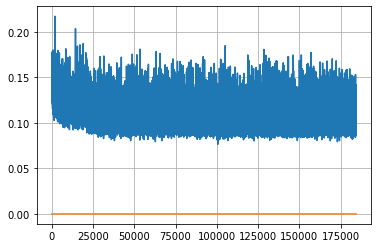

Epoch: 473, iteration 0, loss 0.11804848909378052, cov_diff 0.4060280697010131 cov_diff train 0.4052340902353581
Epoch: 473, iteration 1, loss 0.10030534863471985, cov_diff 0.3951331812585755 cov_diff train 0.39443417930404046
Epoch: 473, iteration 2, loss 0.09884771704673767, cov_diff 0.40897877865442533 cov_diff train 0.4086329769280818
Epoch: 473, iteration 3, loss 0.12084439396858215, cov_diff 0.41634350826448485 cov_diff train 0.4145031503633885
Epoch: 473, iteration 4, loss 0.11083027720451355, cov_diff 0.40476779354798564 cov_diff train 0.4042285549435772
Epoch: 473, iteration 5, loss 0.09632456302642822, cov_diff 0.4084474522934699 cov_diff train 0.40793815166723335
Epoch: 473, iteration 6, loss 0.10107895731925964, cov_diff 0.41536851776366374 cov_diff train 0.4147982091764359
Epoch: 473, iteration 7, loss 0.09360942244529724, cov_diff 0.39469928529473913 cov_diff train 0.39412961831698035
Epoch: 473, iteration 8, loss 0.11275336146354675, cov_diff 0.4009506084404698 cov_diff 

Epoch: 473, iteration 80, loss 0.10488200187683105, cov_diff 0.4008276734474158 cov_diff train 0.40023589687762817
Epoch: 473, iteration 81, loss 0.10121867060661316, cov_diff 0.41805921290813586 cov_diff train 0.4171994642617697
Epoch: 473, iteration 82, loss 0.10342806577682495, cov_diff 0.42617787670035123 cov_diff train 0.4258510123025344
Epoch: 473, iteration 83, loss 0.1126457154750824, cov_diff 0.4157267570531363 cov_diff train 0.41596027301783245
Epoch: 473, iteration 84, loss 0.11424463987350464, cov_diff 0.4094690912094722 cov_diff train 0.4086360611945647
Epoch: 473, iteration 85, loss 0.104900062084198, cov_diff 0.4123502530146503 cov_diff train 0.4113753217952573
Epoch: 473, iteration 86, loss 0.10503756999969482, cov_diff 0.40905043403415803 cov_diff train 0.4097009280731907
Epoch: 473, iteration 87, loss 0.11080017685890198, cov_diff 0.41432715446797114 cov_diff train 0.41405791854259544
Epoch: 473, iteration 88, loss 0.10865285992622375, cov_diff 0.41514192859622007 cov

Epoch: 473, iteration 158, loss 0.10300180315971375, cov_diff 0.40523498315215883 cov_diff train 0.40326709452377446
Epoch: 473, iteration 159, loss 0.09397035837173462, cov_diff 0.4041798213965482 cov_diff train 0.4025302779491185
Epoch: 473, iteration 160, loss 0.08300253748893738, cov_diff 0.4002549315797605 cov_diff train 0.39987513209454423
Epoch: 473, iteration 161, loss 0.09584295749664307, cov_diff 0.4177652056201133 cov_diff train 0.41714955661223463
Epoch: 473, iteration 162, loss 0.11132460832595825, cov_diff 0.40244693853821917 cov_diff train 0.40174879315045353
Epoch: 473, iteration 163, loss 0.10969021916389465, cov_diff 0.41505551090592346 cov_diff train 0.41426692365341555
Epoch: 473, iteration 164, loss 0.09640920162200928, cov_diff 0.400671210220326 cov_diff train 0.4000612881619987
Epoch: 473, iteration 165, loss 0.11477237939834595, cov_diff 0.4200834903557285 cov_diff train 0.42009416263852656
Epoch: 473, iteration 166, loss 0.0850185751914978, cov_diff 0.408799859

Epoch: 473, iteration 235, loss 0.10512211918830872, cov_diff 0.4145021832582427 cov_diff train 0.4141145564373211
Epoch: 473, iteration 236, loss 0.10082083940505981, cov_diff 0.41513527381486065 cov_diff train 0.4142558634746724
Epoch: 473, iteration 237, loss 0.10216963291168213, cov_diff 0.4136523310761453 cov_diff train 0.41246517933235544
Epoch: 473, iteration 238, loss 0.10960456728935242, cov_diff 0.4122374159425509 cov_diff train 0.4127297536340095
Epoch: 473, iteration 239, loss 0.0986824631690979, cov_diff 0.41062638794233997 cov_diff train 0.4094696064509147
Epoch: 473, iteration 240, loss 0.10488849878311157, cov_diff 0.41346406554842813 cov_diff train 0.41232283664489394
Epoch: 473, iteration 241, loss 0.09803774952888489, cov_diff 0.4204257313924823 cov_diff train 0.4194272316810157
Epoch: 473, iteration 242, loss 0.0971626341342926, cov_diff 0.41521985333389844 cov_diff train 0.4140505598991136
Epoch: 473, iteration 243, loss 0.10885021090507507, cov_diff 0.400033076255

Epoch: 473, iteration 313, loss 0.0965958833694458, cov_diff 0.40575482254260425 cov_diff train 0.4047782999050234
Epoch: 473, iteration 314, loss 0.10257378220558167, cov_diff 0.41312990507574254 cov_diff train 0.4126702817184328
Epoch: 473, iteration 315, loss 0.10241842269897461, cov_diff 0.39849362105875896 cov_diff train 0.3967296908972917
Epoch: 473, iteration 316, loss 0.09802404046058655, cov_diff 0.41264087001347466 cov_diff train 0.4128307628666418
Epoch: 473, iteration 317, loss 0.11013421416282654, cov_diff 0.41577062702317213 cov_diff train 0.4151239038448514
Epoch: 473, iteration 318, loss 0.10074374079704285, cov_diff 0.4162785354465739 cov_diff train 0.41489828267178286
Epoch: 473, iteration 319, loss 0.09945899248123169, cov_diff 0.41172132391028826 cov_diff train 0.41104435905186654
Epoch: 473, iteration 320, loss 0.1128702163696289, cov_diff 0.40777412388483925 cov_diff train 0.40681199196502194
Epoch: 473, iteration 321, loss 0.11065348982810974, cov_diff 0.39719256

Epoch: 473, iteration 389, loss 0.09789866209030151, cov_diff 0.41470576718867963 cov_diff train 0.4147754926867366
Epoch: 473, iteration 390, loss 0.13570523262023926, cov_diff 0.4411096198230798 cov_diff train 0.4404981089525023


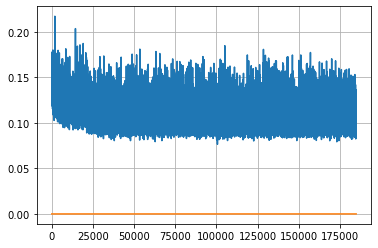

Epoch: 474, iteration 0, loss 0.10875990986824036, cov_diff 0.40633150785335753 cov_diff train 0.40643539990033123
Epoch: 474, iteration 1, loss 0.10090965032577515, cov_diff 0.4122121251263657 cov_diff train 0.41167367503320057
Epoch: 474, iteration 2, loss 0.10385507345199585, cov_diff 0.39709285339281813 cov_diff train 0.398017420970167
Epoch: 474, iteration 3, loss 0.09906011819839478, cov_diff 0.4134640229100043 cov_diff train 0.41310954123022575
Epoch: 474, iteration 4, loss 0.09956249594688416, cov_diff 0.4091428801575897 cov_diff train 0.4094974742044566
Epoch: 474, iteration 5, loss 0.10499206185340881, cov_diff 0.4138327470157644 cov_diff train 0.4144606590737206
Epoch: 474, iteration 6, loss 0.09473451972007751, cov_diff 0.41620278113756326 cov_diff train 0.4163268493350242
Epoch: 474, iteration 7, loss 0.10437315702438354, cov_diff 0.41519500072745114 cov_diff train 0.4147999767950487
Epoch: 474, iteration 8, loss 0.10855516791343689, cov_diff 0.41694018174555164 cov_diff t

Epoch: 474, iteration 77, loss 0.10610571503639221, cov_diff 0.4194921355065657 cov_diff train 0.41869909027444957
Epoch: 474, iteration 78, loss 0.11232578754425049, cov_diff 0.4086471571631801 cov_diff train 0.40819608573627747
Epoch: 474, iteration 79, loss 0.09243199229240417, cov_diff 0.4071657651370862 cov_diff train 0.4059238091784451
Epoch: 474, iteration 80, loss 0.10747852921485901, cov_diff 0.4194913136023897 cov_diff train 0.4185368671500242
Epoch: 474, iteration 81, loss 0.09837687015533447, cov_diff 0.41916851947470773 cov_diff train 0.4184390766191337
Epoch: 474, iteration 82, loss 0.10028287768363953, cov_diff 0.3904736577362677 cov_diff train 0.3901811017180036
Epoch: 474, iteration 83, loss 0.10030531883239746, cov_diff 0.4023380448893389 cov_diff train 0.40129219209476924
Epoch: 474, iteration 84, loss 0.1189415454864502, cov_diff 0.41943896755166904 cov_diff train 0.4186447963869267
Epoch: 474, iteration 85, loss 0.10554301738739014, cov_diff 0.40364842249985566 cov

Epoch: 474, iteration 154, loss 0.12070372700691223, cov_diff 0.41046851121888706 cov_diff train 0.4103607216662272
Epoch: 474, iteration 155, loss 0.11166483163833618, cov_diff 0.42775727836402 cov_diff train 0.42663911603764354
Epoch: 474, iteration 156, loss 0.10885241627693176, cov_diff 0.4038262377538028 cov_diff train 0.4034843402049829
Epoch: 474, iteration 157, loss 0.10966736078262329, cov_diff 0.4004112555635678 cov_diff train 0.4007509631240591
Epoch: 474, iteration 158, loss 0.09615015983581543, cov_diff 0.41628788799241884 cov_diff train 0.4159073393911204
Epoch: 474, iteration 159, loss 0.09773141145706177, cov_diff 0.41503913158652495 cov_diff train 0.4147455814425004
Epoch: 474, iteration 160, loss 0.10303866863250732, cov_diff 0.40751227033459053 cov_diff train 0.4068847505290448
Epoch: 474, iteration 161, loss 0.0907021164894104, cov_diff 0.4045409490851756 cov_diff train 0.40390308090217947
Epoch: 474, iteration 162, loss 0.11895635724067688, cov_diff 0.4086139033774

Epoch: 474, iteration 231, loss 0.10078519582748413, cov_diff 0.40600044796193047 cov_diff train 0.40524140265036634
Epoch: 474, iteration 232, loss 0.09870463609695435, cov_diff 0.40457612573891677 cov_diff train 0.4043248935580002
Epoch: 474, iteration 233, loss 0.11527588963508606, cov_diff 0.4050411176204671 cov_diff train 0.4043959121324689
Epoch: 474, iteration 234, loss 0.09453150629997253, cov_diff 0.404416398587935 cov_diff train 0.40474449232499093
Epoch: 474, iteration 235, loss 0.10580095648765564, cov_diff 0.4038404164418225 cov_diff train 0.4026477596444939
Epoch: 474, iteration 236, loss 0.10719671845436096, cov_diff 0.4219737506424276 cov_diff train 0.4213091340673245
Epoch: 474, iteration 237, loss 0.09654614329338074, cov_diff 0.4128508911921398 cov_diff train 0.41210066666901296
Epoch: 474, iteration 238, loss 0.0935123860836029, cov_diff 0.3968052842013483 cov_diff train 0.39573353528167754
Epoch: 474, iteration 239, loss 0.10102346539497375, cov_diff 0.411457974402

Epoch: 474, iteration 308, loss 0.09877529740333557, cov_diff 0.40800929705353667 cov_diff train 0.4086496259762468
Epoch: 474, iteration 309, loss 0.10956183075904846, cov_diff 0.4111557666018283 cov_diff train 0.41106991990290914
Epoch: 474, iteration 310, loss 0.10247156023979187, cov_diff 0.4088075160191494 cov_diff train 0.40821962429765324
Epoch: 474, iteration 311, loss 0.09652596712112427, cov_diff 0.4083211530098572 cov_diff train 0.4089221090542574
Epoch: 474, iteration 312, loss 0.11239758133888245, cov_diff 0.4112553955712502 cov_diff train 0.4097004325745594
Epoch: 474, iteration 313, loss 0.09837618470191956, cov_diff 0.4180441532077551 cov_diff train 0.41731462559326904
Epoch: 474, iteration 314, loss 0.11631438136100769, cov_diff 0.42181265179998345 cov_diff train 0.42096190900997665
Epoch: 474, iteration 315, loss 0.1058642566204071, cov_diff 0.4082822563574201 cov_diff train 0.40779576370392445
Epoch: 474, iteration 316, loss 0.10561245679855347, cov_diff 0.4036717280

Epoch: 474, iteration 385, loss 0.09604769945144653, cov_diff 0.41177898574747107 cov_diff train 0.41165593257576866
Epoch: 474, iteration 386, loss 0.09714999794960022, cov_diff 0.411720742682088 cov_diff train 0.4113463415977899
Epoch: 474, iteration 387, loss 0.11341553926467896, cov_diff 0.42018201285481377 cov_diff train 0.41977574306914794
Epoch: 474, iteration 388, loss 0.11056435108184814, cov_diff 0.403058252900441 cov_diff train 0.40224910998457797
Epoch: 474, iteration 389, loss 0.1001063883304596, cov_diff 0.40384603988233214 cov_diff train 0.40311343010037765
Epoch: 474, iteration 390, loss 0.11934322118759155, cov_diff 0.44318722534271493 cov_diff train 0.4424324172810768


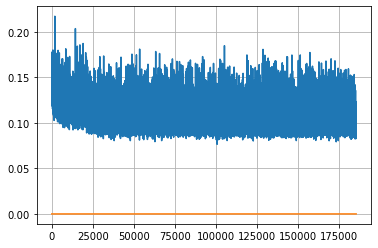

Epoch: 475, iteration 0, loss 0.1034075915813446, cov_diff 0.4200691917635797 cov_diff train 0.4201877629830805
Epoch: 475, iteration 1, loss 0.09238466620445251, cov_diff 0.4133011963808247 cov_diff train 0.41264887179455195
Epoch: 475, iteration 2, loss 0.09753623604774475, cov_diff 0.4114484328361559 cov_diff train 0.4110031286177607
Epoch: 475, iteration 3, loss 0.10732027888298035, cov_diff 0.4127640467121814 cov_diff train 0.4113296027728873
Epoch: 475, iteration 4, loss 0.10541412234306335, cov_diff 0.4141069712602016 cov_diff train 0.4127297652353136
Epoch: 475, iteration 5, loss 0.10195988416671753, cov_diff 0.41227179408115966 cov_diff train 0.41106371229856614
Epoch: 475, iteration 6, loss 0.11227935552597046, cov_diff 0.41875641455089846 cov_diff train 0.4180972512290731
Epoch: 475, iteration 7, loss 0.09078457951545715, cov_diff 0.39913318616523785 cov_diff train 0.3994183152651167
Epoch: 475, iteration 8, loss 0.10385602712631226, cov_diff 0.4146587808354969 cov_diff trai

Epoch: 475, iteration 76, loss 0.114410400390625, cov_diff 0.4059571964957875 cov_diff train 0.4046756107984797
Epoch: 475, iteration 77, loss 0.09714975953102112, cov_diff 0.40757934348679314 cov_diff train 0.4060624243915394
Epoch: 475, iteration 78, loss 0.09927991032600403, cov_diff 0.41603176967872596 cov_diff train 0.41392032391002004
Epoch: 475, iteration 79, loss 0.10710233449935913, cov_diff 0.405851740085828 cov_diff train 0.40567724050012993
Epoch: 475, iteration 80, loss 0.10401895642280579, cov_diff 0.4120120424171532 cov_diff train 0.4119132502855712
Epoch: 475, iteration 81, loss 0.098700612783432, cov_diff 0.40985260893976494 cov_diff train 0.409079795256178
Epoch: 475, iteration 82, loss 0.10987913608551025, cov_diff 0.42686053363681525 cov_diff train 0.4255274880393808
Epoch: 475, iteration 83, loss 0.09751817584037781, cov_diff 0.4086323564864704 cov_diff train 0.40804845814074614
Epoch: 475, iteration 84, loss 0.10884726047515869, cov_diff 0.40400135011247246 cov_di

Epoch: 475, iteration 153, loss 0.10560750961303711, cov_diff 0.4094251859083196 cov_diff train 0.4092592947272214
Epoch: 475, iteration 154, loss 0.11217406392097473, cov_diff 0.4177930410960169 cov_diff train 0.41792742262160604
Epoch: 475, iteration 155, loss 0.10083392262458801, cov_diff 0.3977770431462369 cov_diff train 0.3968511418782888
Epoch: 475, iteration 156, loss 0.10080912709236145, cov_diff 0.4067815083435822 cov_diff train 0.4072878073401039
Epoch: 475, iteration 157, loss 0.10804450511932373, cov_diff 0.4201220974214423 cov_diff train 0.4188412535906276
Epoch: 475, iteration 158, loss 0.09895220398902893, cov_diff 0.39176128827858164 cov_diff train 0.3910580943930179
Epoch: 475, iteration 159, loss 0.09981563687324524, cov_diff 0.4048584006694365 cov_diff train 0.404750829453833
Epoch: 475, iteration 160, loss 0.10041120648384094, cov_diff 0.41497888159602436 cov_diff train 0.4152175009104549
Epoch: 475, iteration 161, loss 0.10654395818710327, cov_diff 0.41481689133828

Epoch: 475, iteration 229, loss 0.097484290599823, cov_diff 0.42311295314800423 cov_diff train 0.42267205057104995
Epoch: 475, iteration 230, loss 0.09758394956588745, cov_diff 0.41923465296347023 cov_diff train 0.41929764654841956
Epoch: 475, iteration 231, loss 0.11193352937698364, cov_diff 0.4150001799863858 cov_diff train 0.4143501784254253
Epoch: 475, iteration 232, loss 0.09862342476844788, cov_diff 0.4041890701768712 cov_diff train 0.4025739193305106
Epoch: 475, iteration 233, loss 0.10770630836486816, cov_diff 0.41225639186779317 cov_diff train 0.41216239479634476
Epoch: 475, iteration 234, loss 0.12535706162452698, cov_diff 0.41957748143337376 cov_diff train 0.4183637036649534
Epoch: 475, iteration 235, loss 0.09400570392608643, cov_diff 0.4025803057349065 cov_diff train 0.40109978654501294
Epoch: 475, iteration 236, loss 0.08963343501091003, cov_diff 0.42038566094617164 cov_diff train 0.4195157958859569
Epoch: 475, iteration 237, loss 0.11156105995178223, cov_diff 0.401621027

Epoch: 475, iteration 305, loss 0.10965651273727417, cov_diff 0.4155792969663316 cov_diff train 0.41576923031917284
Epoch: 475, iteration 306, loss 0.11297523975372314, cov_diff 0.4114650411273417 cov_diff train 0.41064562879123545
Epoch: 475, iteration 307, loss 0.10299691557884216, cov_diff 0.4105690048254694 cov_diff train 0.4103104285951583
Epoch: 475, iteration 308, loss 0.10933613777160645, cov_diff 0.41182843339419306 cov_diff train 0.41061289181983807
Epoch: 475, iteration 309, loss 0.11185479164123535, cov_diff 0.4247837037971117 cov_diff train 0.42376061356998007
Epoch: 475, iteration 310, loss 0.10807815194129944, cov_diff 0.4119189307798361 cov_diff train 0.4113685345091331
Epoch: 475, iteration 311, loss 0.10699114203453064, cov_diff 0.40852811139116113 cov_diff train 0.40710679799592064
Epoch: 475, iteration 312, loss 0.10494109988212585, cov_diff 0.4051923194456511 cov_diff train 0.4043355611934896
Epoch: 475, iteration 313, loss 0.09369328618049622, cov_diff 0.416049135

Epoch: 475, iteration 382, loss 0.10683819651603699, cov_diff 0.4072601829606115 cov_diff train 0.40707850171701665
Epoch: 475, iteration 383, loss 0.10208815336227417, cov_diff 0.40520938068429313 cov_diff train 0.4046339317851682
Epoch: 475, iteration 384, loss 0.09017536044120789, cov_diff 0.4171072856265976 cov_diff train 0.41687344539359317
Epoch: 475, iteration 385, loss 0.10101479291915894, cov_diff 0.4107227161863704 cov_diff train 0.41024017878092894
Epoch: 475, iteration 386, loss 0.09708121418952942, cov_diff 0.4081778787446611 cov_diff train 0.40710313219887007
Epoch: 475, iteration 387, loss 0.09576937556266785, cov_diff 0.4047485796450548 cov_diff train 0.404016577263115
Epoch: 475, iteration 388, loss 0.10387793183326721, cov_diff 0.4066740076893995 cov_diff train 0.40632920127838545
Epoch: 475, iteration 389, loss 0.10120376944541931, cov_diff 0.41386466140139444 cov_diff train 0.4132979919449747
Epoch: 475, iteration 390, loss 0.14096280932426453, cov_diff 0.4497827906

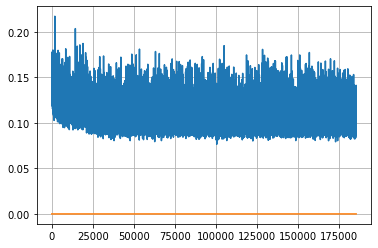

Epoch: 476, iteration 0, loss 0.1027427613735199, cov_diff 0.39268385391149596 cov_diff train 0.3922123768924405
Epoch: 476, iteration 1, loss 0.09881234169006348, cov_diff 0.4046261376954864 cov_diff train 0.4040933156909196
Epoch: 476, iteration 2, loss 0.09865820407867432, cov_diff 0.4112327194695173 cov_diff train 0.41020338355422653
Epoch: 476, iteration 3, loss 0.10668700933456421, cov_diff 0.417005323055274 cov_diff train 0.41578427058551587
Epoch: 476, iteration 4, loss 0.096112459897995, cov_diff 0.4156977753593264 cov_diff train 0.41521054481687614
Epoch: 476, iteration 5, loss 0.10798656940460205, cov_diff 0.40489564748144885 cov_diff train 0.40337336452268285
Epoch: 476, iteration 6, loss 0.09863504767417908, cov_diff 0.3993197066598818 cov_diff train 0.39803658989296736
Epoch: 476, iteration 7, loss 0.09783387184143066, cov_diff 0.41458449925658525 cov_diff train 0.41333949358380834
Epoch: 476, iteration 8, loss 0.1029035747051239, cov_diff 0.41831253141091856 cov_diff tra

Epoch: 476, iteration 77, loss 0.1203133761882782, cov_diff 0.40578971638675215 cov_diff train 0.4057832701932928
Epoch: 476, iteration 78, loss 0.09743911027908325, cov_diff 0.4100262281373144 cov_diff train 0.40958867504290924
Epoch: 476, iteration 79, loss 0.0913468599319458, cov_diff 0.40218904534223154 cov_diff train 0.4015395923352352
Epoch: 476, iteration 80, loss 0.11051005125045776, cov_diff 0.4094514757488593 cov_diff train 0.4093444655614278
Epoch: 476, iteration 81, loss 0.09323692321777344, cov_diff 0.4235164010730617 cov_diff train 0.4228786645797033
Epoch: 476, iteration 82, loss 0.10202091932296753, cov_diff 0.40214600010458756 cov_diff train 0.40173996405038087
Epoch: 476, iteration 83, loss 0.0978965163230896, cov_diff 0.420619990612947 cov_diff train 0.41999656472772107
Epoch: 476, iteration 84, loss 0.10775956511497498, cov_diff 0.3965605078803932 cov_diff train 0.3959451010591642
Epoch: 476, iteration 85, loss 0.11353623867034912, cov_diff 0.41874410699166253 cov_d

Epoch: 476, iteration 151, loss 0.0946761965751648, cov_diff 0.4190130127750198 cov_diff train 0.4184229377994537
Epoch: 476, iteration 152, loss 0.09455221891403198, cov_diff 0.4061679018510386 cov_diff train 0.4059883490601479
Epoch: 476, iteration 153, loss 0.1102226972579956, cov_diff 0.40650046992008804 cov_diff train 0.40556785374433296
Epoch: 476, iteration 154, loss 0.10754889249801636, cov_diff 0.39715918167583736 cov_diff train 0.3962075321361184
Epoch: 476, iteration 155, loss 0.10635021328926086, cov_diff 0.4019198407971127 cov_diff train 0.40092336697420633
Epoch: 476, iteration 156, loss 0.11602193117141724, cov_diff 0.3993950518282299 cov_diff train 0.3986669270028871
Epoch: 476, iteration 157, loss 0.11622780561447144, cov_diff 0.4022388781434245 cov_diff train 0.4019714116252882
Epoch: 476, iteration 158, loss 0.10152500867843628, cov_diff 0.3883093611747464 cov_diff train 0.3881044277847202
Epoch: 476, iteration 159, loss 0.10130220651626587, cov_diff 0.40825151639522

Epoch: 476, iteration 229, loss 0.11140653491020203, cov_diff 0.4111518253345803 cov_diff train 0.4113029764444614
Epoch: 476, iteration 230, loss 0.09299692511558533, cov_diff 0.40441969961030044 cov_diff train 0.4053760042865415
Epoch: 476, iteration 231, loss 0.10812941193580627, cov_diff 0.43298774451426436 cov_diff train 0.43262169465210204
Epoch: 476, iteration 232, loss 0.10595133900642395, cov_diff 0.4118233493260132 cov_diff train 0.41123180447450575
Epoch: 476, iteration 233, loss 0.1190597414970398, cov_diff 0.4194203485465776 cov_diff train 0.4184815329224715
Epoch: 476, iteration 234, loss 0.11857306957244873, cov_diff 0.40981078373347823 cov_diff train 0.4093649917640234
Epoch: 476, iteration 235, loss 0.10891714692115784, cov_diff 0.41678861690726415 cov_diff train 0.4152365640689732
Epoch: 476, iteration 236, loss 0.1013374924659729, cov_diff 0.4102388399807557 cov_diff train 0.4090489926863254
Epoch: 476, iteration 237, loss 0.09066760540008545, cov_diff 0.415465142678

Epoch: 476, iteration 307, loss 0.11499756574630737, cov_diff 0.40761764020517527 cov_diff train 0.4069815398734278
Epoch: 476, iteration 308, loss 0.09863021969795227, cov_diff 0.40683524152797224 cov_diff train 0.40623213157265264
Epoch: 476, iteration 309, loss 0.1221018135547638, cov_diff 0.4106827154280673 cov_diff train 0.40885211786984127
Epoch: 476, iteration 310, loss 0.1027790904045105, cov_diff 0.41397719473988687 cov_diff train 0.4137495433108421
Epoch: 476, iteration 311, loss 0.0984792411327362, cov_diff 0.41934716453469395 cov_diff train 0.41897901190307546
Epoch: 476, iteration 312, loss 0.11434775590896606, cov_diff 0.41716056623138964 cov_diff train 0.416606214739689
Epoch: 476, iteration 313, loss 0.09467354416847229, cov_diff 0.40205039360551414 cov_diff train 0.400817640529437
Epoch: 476, iteration 314, loss 0.10253915190696716, cov_diff 0.4099809141015074 cov_diff train 0.40973704470570854
Epoch: 476, iteration 315, loss 0.1044752299785614, cov_diff 0.416631915438

Epoch: 476, iteration 383, loss 0.10462039709091187, cov_diff 0.40967509495536253 cov_diff train 0.4088920871004962
Epoch: 476, iteration 384, loss 0.12214851379394531, cov_diff 0.4020365096509698 cov_diff train 0.40167590428725664
Epoch: 476, iteration 385, loss 0.09969446063041687, cov_diff 0.4099582401557182 cov_diff train 0.4087330406739566
Epoch: 476, iteration 386, loss 0.08809787034988403, cov_diff 0.4068709983711212 cov_diff train 0.4078409256989619
Epoch: 476, iteration 387, loss 0.09964072704315186, cov_diff 0.4202916164489811 cov_diff train 0.4204908889250086
Epoch: 476, iteration 388, loss 0.10487759113311768, cov_diff 0.40066520068417305 cov_diff train 0.39908729492830713
Epoch: 476, iteration 389, loss 0.11103612184524536, cov_diff 0.41214879642293384 cov_diff train 0.4105495123196901
Epoch: 476, iteration 390, loss 0.15163570642471313, cov_diff 0.44765200114702264 cov_diff train 0.4473967667804279


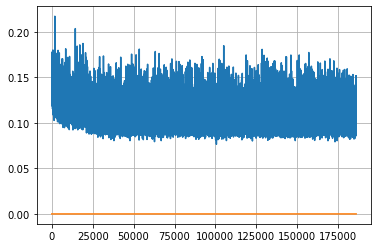

Epoch: 477, iteration 0, loss 0.10667097568511963, cov_diff 0.41651969086328994 cov_diff train 0.4164763794807031
Epoch: 477, iteration 1, loss 0.11347144842147827, cov_diff 0.41037151472307326 cov_diff train 0.41019217332959
Epoch: 477, iteration 2, loss 0.10384044051170349, cov_diff 0.408838634790493 cov_diff train 0.40720475375702664
Epoch: 477, iteration 3, loss 0.10377553105354309, cov_diff 0.42357166129173407 cov_diff train 0.42268227245958645
Epoch: 477, iteration 4, loss 0.10741987824440002, cov_diff 0.41235608425423814 cov_diff train 0.4119421562977058
Epoch: 477, iteration 5, loss 0.09725627303123474, cov_diff 0.3996959793167764 cov_diff train 0.3988239891131562
Epoch: 477, iteration 6, loss 0.1034168004989624, cov_diff 0.40508766579720273 cov_diff train 0.4042177999199447
Epoch: 477, iteration 7, loss 0.10993927717208862, cov_diff 0.41280973070155075 cov_diff train 0.4122748604963603
Epoch: 477, iteration 8, loss 0.089975506067276, cov_diff 0.40870904732447566 cov_diff train

Epoch: 477, iteration 76, loss 0.1097097396850586, cov_diff 0.41533701906977843 cov_diff train 0.4130736932093543
Epoch: 477, iteration 77, loss 0.11178597807884216, cov_diff 0.4067721328976719 cov_diff train 0.4060478466393061
Epoch: 477, iteration 78, loss 0.10577228665351868, cov_diff 0.4040884735347136 cov_diff train 0.4034091403062889
Epoch: 477, iteration 79, loss 0.10234707593917847, cov_diff 0.4008474778362683 cov_diff train 0.4000425323895818
Epoch: 477, iteration 80, loss 0.09799566864967346, cov_diff 0.39295337898837013 cov_diff train 0.39209696207565803
Epoch: 477, iteration 81, loss 0.09726867079734802, cov_diff 0.41978572157998595 cov_diff train 0.419308704173595
Epoch: 477, iteration 82, loss 0.09665307402610779, cov_diff 0.397309028113164 cov_diff train 0.39683157987026674
Epoch: 477, iteration 83, loss 0.10680308938026428, cov_diff 0.4107435001385628 cov_diff train 0.40957696218975875
Epoch: 477, iteration 84, loss 0.08880835771560669, cov_diff 0.41364785497902634 cov_

Epoch: 477, iteration 153, loss 0.11263403296470642, cov_diff 0.4144602390656152 cov_diff train 0.4137111355153778
Epoch: 477, iteration 154, loss 0.09649690985679626, cov_diff 0.4191796659103579 cov_diff train 0.41878305488282114
Epoch: 477, iteration 155, loss 0.10683539509773254, cov_diff 0.41999702079274215 cov_diff train 0.41885406066254177
Epoch: 477, iteration 156, loss 0.09881806373596191, cov_diff 0.4082031870463675 cov_diff train 0.4075130917499547
Epoch: 477, iteration 157, loss 0.10377341508865356, cov_diff 0.40620456561462825 cov_diff train 0.405504789683224
Epoch: 477, iteration 158, loss 0.1011243462562561, cov_diff 0.421923261734804 cov_diff train 0.4218424850643636
Epoch: 477, iteration 159, loss 0.09420624375343323, cov_diff 0.421538081425781 cov_diff train 0.4206119164461453
Epoch: 477, iteration 160, loss 0.1148546040058136, cov_diff 0.4122984242581033 cov_diff train 0.4113790263007785
Epoch: 477, iteration 161, loss 0.10227802395820618, cov_diff 0.41419932555305133

Epoch: 477, iteration 230, loss 0.08906587958335876, cov_diff 0.3962307934426412 cov_diff train 0.39618481333050837
Epoch: 477, iteration 231, loss 0.09454101324081421, cov_diff 0.408861355560044 cov_diff train 0.40817961900429256
Epoch: 477, iteration 232, loss 0.09996739029884338, cov_diff 0.3969885201116958 cov_diff train 0.39691443811349814
Epoch: 477, iteration 233, loss 0.11150187253952026, cov_diff 0.4071690807541681 cov_diff train 0.4067103850568704
Epoch: 477, iteration 234, loss 0.10946729779243469, cov_diff 0.3998532798353208 cov_diff train 0.40009920155644535
Epoch: 477, iteration 235, loss 0.1073639988899231, cov_diff 0.4190861800147264 cov_diff train 0.41781744958037864
Epoch: 477, iteration 236, loss 0.09867998957633972, cov_diff 0.4127694191565605 cov_diff train 0.41187078396516724
Epoch: 477, iteration 237, loss 0.10127115249633789, cov_diff 0.41700889800492325 cov_diff train 0.41713778970314985
Epoch: 477, iteration 238, loss 0.10619550943374634, cov_diff 0.4080148462

Epoch: 477, iteration 306, loss 0.09346425533294678, cov_diff 0.4063947935206473 cov_diff train 0.40583260878003147
Epoch: 477, iteration 307, loss 0.1037077009677887, cov_diff 0.40635996729870166 cov_diff train 0.40562985422108133
Epoch: 477, iteration 308, loss 0.0898333489894867, cov_diff 0.4108256372269789 cov_diff train 0.40996674206279204
Epoch: 477, iteration 309, loss 0.11221325397491455, cov_diff 0.42456367634466163 cov_diff train 0.4240300353812645
Epoch: 477, iteration 310, loss 0.10831540822982788, cov_diff 0.38550822999679424 cov_diff train 0.38378254292896447
Epoch: 477, iteration 311, loss 0.0963665246963501, cov_diff 0.4074998981113484 cov_diff train 0.407021248142459
Epoch: 477, iteration 312, loss 0.10755917429924011, cov_diff 0.41766594292864956 cov_diff train 0.41637237570585134
Epoch: 477, iteration 313, loss 0.11409294605255127, cov_diff 0.42280569173305854 cov_diff train 0.42159556726498615
Epoch: 477, iteration 314, loss 0.10230910778045654, cov_diff 0.408317223

Epoch: 477, iteration 383, loss 0.10170462727546692, cov_diff 0.40204468347542827 cov_diff train 0.40148350761165413
Epoch: 477, iteration 384, loss 0.09675204753875732, cov_diff 0.41455623441666234 cov_diff train 0.414055585772086
Epoch: 477, iteration 385, loss 0.1114557683467865, cov_diff 0.418382905695668 cov_diff train 0.41747202906361547
Epoch: 477, iteration 386, loss 0.09643331170082092, cov_diff 0.40196099063066676 cov_diff train 0.4019017159245628
Epoch: 477, iteration 387, loss 0.10107704997062683, cov_diff 0.41411080155067637 cov_diff train 0.4129745197417017
Epoch: 477, iteration 388, loss 0.11216193437576294, cov_diff 0.4107298307831188 cov_diff train 0.4092150365994375
Epoch: 477, iteration 389, loss 0.10129377245903015, cov_diff 0.4090447307261263 cov_diff train 0.4073771858377304
Epoch: 477, iteration 390, loss 0.16517093777656555, cov_diff 0.4595437195973929 cov_diff train 0.4589002535702537


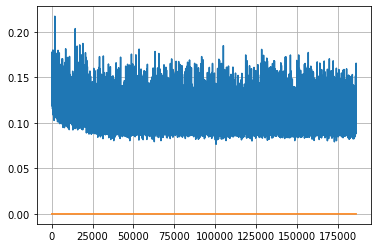

Epoch: 478, iteration 0, loss 0.08784720301628113, cov_diff 0.41715485120078344 cov_diff train 0.4171568856911345
Epoch: 478, iteration 1, loss 0.10453721880912781, cov_diff 0.41448195189695425 cov_diff train 0.4143122788751799
Epoch: 478, iteration 2, loss 0.10063615441322327, cov_diff 0.41246254447641456 cov_diff train 0.41285420701872616
Epoch: 478, iteration 3, loss 0.09313094615936279, cov_diff 0.4086765543485031 cov_diff train 0.40847323863663676
Epoch: 478, iteration 4, loss 0.10273191332817078, cov_diff 0.4146121226671951 cov_diff train 0.4137188627739716
Epoch: 478, iteration 5, loss 0.10942918062210083, cov_diff 0.4114945980646461 cov_diff train 0.4112085918276982
Epoch: 478, iteration 6, loss 0.12381929159164429, cov_diff 0.4160235689592656 cov_diff train 0.4162164032962991
Epoch: 478, iteration 7, loss 0.09012094140052795, cov_diff 0.40777623648613864 cov_diff train 0.40727415361433905
Epoch: 478, iteration 8, loss 0.09641224145889282, cov_diff 0.4144913188314713 cov_diff t

Epoch: 478, iteration 77, loss 0.10699048638343811, cov_diff 0.40177632657266454 cov_diff train 0.40075950157470314
Epoch: 478, iteration 78, loss 0.1103740930557251, cov_diff 0.405168780322813 cov_diff train 0.4040174211020132
Epoch: 478, iteration 79, loss 0.09237232804298401, cov_diff 0.41378501886681873 cov_diff train 0.4120918563335319
Epoch: 478, iteration 80, loss 0.10401305556297302, cov_diff 0.40143436672410293 cov_diff train 0.40060050388304197
Epoch: 478, iteration 81, loss 0.10376110672950745, cov_diff 0.4077151920634665 cov_diff train 0.40673254477984827
Epoch: 478, iteration 82, loss 0.10582464933395386, cov_diff 0.4015656955609807 cov_diff train 0.40022374934524513
Epoch: 478, iteration 83, loss 0.0988612174987793, cov_diff 0.4126191569940614 cov_diff train 0.4101308834083504
Epoch: 478, iteration 84, loss 0.09871035814285278, cov_diff 0.4074120451984943 cov_diff train 0.4059133123600348
Epoch: 478, iteration 85, loss 0.09823057055473328, cov_diff 0.4118885632466628 cov_

Epoch: 478, iteration 154, loss 0.10481926798820496, cov_diff 0.42442679017038204 cov_diff train 0.42465129474264135
Epoch: 478, iteration 155, loss 0.10456803441047668, cov_diff 0.41447948397858914 cov_diff train 0.4136175599633502
Epoch: 478, iteration 156, loss 0.11194562911987305, cov_diff 0.4152814395372695 cov_diff train 0.4160678634929905
Epoch: 478, iteration 157, loss 0.10073530673980713, cov_diff 0.4191179057921146 cov_diff train 0.4193523081290013
Epoch: 478, iteration 158, loss 0.09781888127326965, cov_diff 0.41092023469322414 cov_diff train 0.4105913399331722
Epoch: 478, iteration 159, loss 0.10386228561401367, cov_diff 0.4220852498859888 cov_diff train 0.42150547184672704
Epoch: 478, iteration 160, loss 0.1080559492111206, cov_diff 0.40631655759580443 cov_diff train 0.40643503984316814
Epoch: 478, iteration 161, loss 0.1154462993144989, cov_diff 0.40835155923063154 cov_diff train 0.40770269354784555
Epoch: 478, iteration 162, loss 0.10889315605163574, cov_diff 0.411951441

Epoch: 478, iteration 231, loss 0.10568323731422424, cov_diff 0.40649591858618195 cov_diff train 0.40627309664613104
Epoch: 478, iteration 232, loss 0.10186728835105896, cov_diff 0.41111732079251667 cov_diff train 0.41086619506551275
Epoch: 478, iteration 233, loss 0.09968572854995728, cov_diff 0.40900209619491973 cov_diff train 0.4080187088386732
Epoch: 478, iteration 234, loss 0.1057618260383606, cov_diff 0.418142943880147 cov_diff train 0.4165872631465582
Epoch: 478, iteration 235, loss 0.101666659116745, cov_diff 0.40017420296565936 cov_diff train 0.3987130380603122
Epoch: 478, iteration 236, loss 0.10752853751182556, cov_diff 0.40234511122007344 cov_diff train 0.4014960714351999
Epoch: 478, iteration 237, loss 0.10231384634971619, cov_diff 0.419776138230689 cov_diff train 0.41923936875252654
Epoch: 478, iteration 238, loss 0.10151985287666321, cov_diff 0.41120185939884496 cov_diff train 0.4103124701197726
Epoch: 478, iteration 239, loss 0.0956222414970398, cov_diff 0.4066685280092

Epoch: 478, iteration 308, loss 0.10940319299697876, cov_diff 0.40735332812267977 cov_diff train 0.4072491846985249
Epoch: 478, iteration 309, loss 0.10335233807563782, cov_diff 0.4058460469910115 cov_diff train 0.40578729537429686
Epoch: 478, iteration 310, loss 0.12008440494537354, cov_diff 0.4026196820504236 cov_diff train 0.40205534844883056
Epoch: 478, iteration 311, loss 0.10666599869728088, cov_diff 0.41920052932406915 cov_diff train 0.4189319059949844
Epoch: 478, iteration 312, loss 0.09578895568847656, cov_diff 0.4117778635272081 cov_diff train 0.411535900104693
Epoch: 478, iteration 313, loss 0.09390336275100708, cov_diff 0.41336799633094395 cov_diff train 0.4131599195374357
Epoch: 478, iteration 314, loss 0.11257758736610413, cov_diff 0.42177414479680764 cov_diff train 0.4210370573216734
Epoch: 478, iteration 315, loss 0.09675195813179016, cov_diff 0.40900038226689545 cov_diff train 0.40778748963304684
Epoch: 478, iteration 316, loss 0.10516059398651123, cov_diff 0.398849989

Epoch: 478, iteration 384, loss 0.11372238397598267, cov_diff 0.42162338048581016 cov_diff train 0.4202058352806164
Epoch: 478, iteration 385, loss 0.10715663433074951, cov_diff 0.4153634131406777 cov_diff train 0.4140514610335881
Epoch: 478, iteration 386, loss 0.09826478362083435, cov_diff 0.40904636610054257 cov_diff train 0.40805981026630345
Epoch: 478, iteration 387, loss 0.10216444730758667, cov_diff 0.4066796912815636 cov_diff train 0.40536225453957403
Epoch: 478, iteration 388, loss 0.10749039053916931, cov_diff 0.4107031393570676 cov_diff train 0.4104213206216632
Epoch: 478, iteration 389, loss 0.0903121829032898, cov_diff 0.4037292643681173 cov_diff train 0.4033340376942525
Epoch: 478, iteration 390, loss 0.15417343378067017, cov_diff 0.4392061247508673 cov_diff train 0.4385949558652213


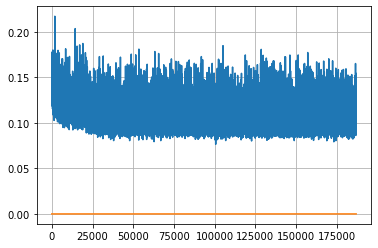

Epoch: 479, iteration 0, loss 0.08853846788406372, cov_diff 0.4109554719510406 cov_diff train 0.4109404218351231
Epoch: 479, iteration 1, loss 0.09835106134414673, cov_diff 0.42316162642834343 cov_diff train 0.423330925501192
Epoch: 479, iteration 2, loss 0.09693983197212219, cov_diff 0.41041651289271874 cov_diff train 0.41021771858820916
Epoch: 479, iteration 3, loss 0.10525155067443848, cov_diff 0.42288333443481424 cov_diff train 0.42296769463628253
Epoch: 479, iteration 4, loss 0.10038715600967407, cov_diff 0.41082356603867254 cov_diff train 0.41115009290705207
Epoch: 479, iteration 5, loss 0.09758326411247253, cov_diff 0.41691533280166565 cov_diff train 0.41672501575904064
Epoch: 479, iteration 6, loss 0.10691273212432861, cov_diff 0.4174295784734228 cov_diff train 0.41637319525270255
Epoch: 479, iteration 7, loss 0.09965163469314575, cov_diff 0.41416074189688756 cov_diff train 0.4136329862295467
Epoch: 479, iteration 8, loss 0.10723501443862915, cov_diff 0.4258699395366193 cov_dif

Epoch: 479, iteration 78, loss 0.101826012134552, cov_diff 0.4148301018344986 cov_diff train 0.4144416023402975
Epoch: 479, iteration 79, loss 0.10436254739761353, cov_diff 0.397366581683338 cov_diff train 0.39714969460639293
Epoch: 479, iteration 80, loss 0.10865724086761475, cov_diff 0.41464186990216384 cov_diff train 0.41354039999071274
Epoch: 479, iteration 81, loss 0.09989836812019348, cov_diff 0.4004089660807523 cov_diff train 0.4004496994284785
Epoch: 479, iteration 82, loss 0.10068431496620178, cov_diff 0.42022882934754124 cov_diff train 0.42068070021993553
Epoch: 479, iteration 83, loss 0.09853014349937439, cov_diff 0.3975451304410683 cov_diff train 0.39759076787030356
Epoch: 479, iteration 84, loss 0.1122640073299408, cov_diff 0.4126274750255928 cov_diff train 0.41156826716319533
Epoch: 479, iteration 85, loss 0.09281110763549805, cov_diff 0.414643996927374 cov_diff train 0.4143425588013075
Epoch: 479, iteration 86, loss 0.10178205370903015, cov_diff 0.40742309690738415 cov_d

Epoch: 479, iteration 155, loss 0.09426888823509216, cov_diff 0.40669439634574805 cov_diff train 0.4067500757612858
Epoch: 479, iteration 156, loss 0.08820581436157227, cov_diff 0.410751100481687 cov_diff train 0.41020842808464564
Epoch: 479, iteration 157, loss 0.10085922479629517, cov_diff 0.4112048645238626 cov_diff train 0.4113595221052504
Epoch: 479, iteration 158, loss 0.10083186626434326, cov_diff 0.40525217703823196 cov_diff train 0.40513284710341724
Epoch: 479, iteration 159, loss 0.10523998737335205, cov_diff 0.40815015088889595 cov_diff train 0.4076193665908354
Epoch: 479, iteration 160, loss 0.10661378502845764, cov_diff 0.4011552732964969 cov_diff train 0.4011254496027407
Epoch: 479, iteration 161, loss 0.09778186678886414, cov_diff 0.4041727553913217 cov_diff train 0.4041125820203614
Epoch: 479, iteration 162, loss 0.10824728012084961, cov_diff 0.40950660790690346 cov_diff train 0.40800639701940977
Epoch: 479, iteration 163, loss 0.09799423813819885, cov_diff 0.4068782056

Epoch: 479, iteration 234, loss 0.10381367802619934, cov_diff 0.4029328456561113 cov_diff train 0.40159840440176003
Epoch: 479, iteration 235, loss 0.10187900066375732, cov_diff 0.399620043092876 cov_diff train 0.3992920997145596
Epoch: 479, iteration 236, loss 0.10768339037895203, cov_diff 0.4095909771306016 cov_diff train 0.40805659972276015
Epoch: 479, iteration 237, loss 0.10089442133903503, cov_diff 0.4181756214328175 cov_diff train 0.41764108325424804
Epoch: 479, iteration 238, loss 0.10099732875823975, cov_diff 0.4296182986250457 cov_diff train 0.4291479764873123
Epoch: 479, iteration 239, loss 0.10403105616569519, cov_diff 0.4084132257672416 cov_diff train 0.4070661806568482
Epoch: 479, iteration 240, loss 0.10107198357582092, cov_diff 0.4088434435711022 cov_diff train 0.40854297006829515
Epoch: 479, iteration 241, loss 0.10665732622146606, cov_diff 0.41942354287507305 cov_diff train 0.41811894966693125
Epoch: 479, iteration 242, loss 0.11886397004127502, cov_diff 0.41457817854

Epoch: 479, iteration 310, loss 0.10322046279907227, cov_diff 0.4052408752622385 cov_diff train 0.4047871147702025
Epoch: 479, iteration 311, loss 0.10979616641998291, cov_diff 0.4175141005016392 cov_diff train 0.4144837205789634
Epoch: 479, iteration 312, loss 0.11352407932281494, cov_diff 0.4124397404683084 cov_diff train 0.4119815902737884
Epoch: 479, iteration 313, loss 0.09522417187690735, cov_diff 0.4079648864598459 cov_diff train 0.4072158321283869
Epoch: 479, iteration 314, loss 0.0983319878578186, cov_diff 0.4196253901995989 cov_diff train 0.41883452488332146
Epoch: 479, iteration 315, loss 0.0982026755809784, cov_diff 0.41161955395169486 cov_diff train 0.41051790336315974
Epoch: 479, iteration 316, loss 0.10877972841262817, cov_diff 0.41202738886877177 cov_diff train 0.4112506058568598
Epoch: 479, iteration 317, loss 0.11099451780319214, cov_diff 0.40912706266981375 cov_diff train 0.40817272483689004
Epoch: 479, iteration 318, loss 0.10003301501274109, cov_diff 0.413748815225

Epoch: 479, iteration 389, loss 0.09678208827972412, cov_diff 0.40887043229926157 cov_diff train 0.4092826709115556
Epoch: 479, iteration 390, loss 0.18087244033813477, cov_diff 0.4545843124314582 cov_diff train 0.45238396910633344


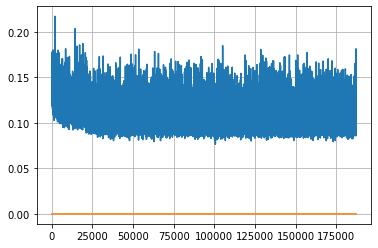

Epoch: 480, iteration 0, loss 0.10672208666801453, cov_diff 0.4006255392114885 cov_diff train 0.4000180711505527
Epoch: 480, iteration 1, loss 0.11501473188400269, cov_diff 0.42029031278978163 cov_diff train 0.4200502967433674
Epoch: 480, iteration 2, loss 0.09427148103713989, cov_diff 0.40295698152788745 cov_diff train 0.40344155277061816
Epoch: 480, iteration 3, loss 0.10152298212051392, cov_diff 0.4077676267186198 cov_diff train 0.4076402625859744
Epoch: 480, iteration 4, loss 0.11013731360435486, cov_diff 0.4094605115318937 cov_diff train 0.4088197391370229
Epoch: 480, iteration 5, loss 0.111183762550354, cov_diff 0.4124191936132971 cov_diff train 0.41178441432211843
Epoch: 480, iteration 6, loss 0.1086675226688385, cov_diff 0.4154111061709551 cov_diff train 0.41532240289918465
Epoch: 480, iteration 7, loss 0.09453311562538147, cov_diff 0.40249313189054986 cov_diff train 0.40190330222612075
Epoch: 480, iteration 8, loss 0.09012484550476074, cov_diff 0.41368353825313475 cov_diff tra

Epoch: 480, iteration 79, loss 0.11975094676017761, cov_diff 0.41625571245924575 cov_diff train 0.4154516764759958
Epoch: 480, iteration 80, loss 0.09750416874885559, cov_diff 0.40982825519236116 cov_diff train 0.40794289681387685
Epoch: 480, iteration 81, loss 0.10339459776878357, cov_diff 0.40056202128302165 cov_diff train 0.400035991981146
Epoch: 480, iteration 82, loss 0.11171174049377441, cov_diff 0.4087493640257494 cov_diff train 0.4083449896255701
Epoch: 480, iteration 83, loss 0.10669267177581787, cov_diff 0.41550306786749264 cov_diff train 0.41412593454657803
Epoch: 480, iteration 84, loss 0.09369614720344543, cov_diff 0.4094298241297958 cov_diff train 0.4085727101026864
Epoch: 480, iteration 85, loss 0.1115846037864685, cov_diff 0.4093629932362937 cov_diff train 0.40888805248721055
Epoch: 480, iteration 86, loss 0.10084667801856995, cov_diff 0.41154482833913303 cov_diff train 0.4109210505973226
Epoch: 480, iteration 87, loss 0.10042321681976318, cov_diff 0.3992344169699908 co

Epoch: 480, iteration 156, loss 0.09284785389900208, cov_diff 0.41199225652760585 cov_diff train 0.4122326416537644
Epoch: 480, iteration 157, loss 0.1083109974861145, cov_diff 0.4199227357893059 cov_diff train 0.4194632663112496
Epoch: 480, iteration 158, loss 0.10639357566833496, cov_diff 0.41697888871996425 cov_diff train 0.41627798993988613
Epoch: 480, iteration 159, loss 0.10802200436592102, cov_diff 0.40360970769717414 cov_diff train 0.40351720370249217
Epoch: 480, iteration 160, loss 0.10502767562866211, cov_diff 0.4193789406025345 cov_diff train 0.4193940453391106
Epoch: 480, iteration 161, loss 0.1061621606349945, cov_diff 0.41911617334679097 cov_diff train 0.41778486747149246
Epoch: 480, iteration 162, loss 0.10422313213348389, cov_diff 0.4114830754950987 cov_diff train 0.4108849364480088
Epoch: 480, iteration 163, loss 0.10861226916313171, cov_diff 0.4159719146791202 cov_diff train 0.4151252031054869
Epoch: 480, iteration 164, loss 0.1024787425994873, cov_diff 0.417066896590

Epoch: 480, iteration 234, loss 0.09921005368232727, cov_diff 0.4085515318997852 cov_diff train 0.40792607813997467
Epoch: 480, iteration 235, loss 0.10185372829437256, cov_diff 0.41971193835095183 cov_diff train 0.41904288626267217
Epoch: 480, iteration 236, loss 0.11087074875831604, cov_diff 0.4081779341182051 cov_diff train 0.4064423901869596
Epoch: 480, iteration 237, loss 0.10173660516738892, cov_diff 0.4137952989725171 cov_diff train 0.4117444051226516
Epoch: 480, iteration 238, loss 0.11021485924720764, cov_diff 0.4032930193984141 cov_diff train 0.40150669322496524
Epoch: 480, iteration 239, loss 0.097596675157547, cov_diff 0.41442530987508924 cov_diff train 0.41246550695355094
Epoch: 480, iteration 240, loss 0.09920436143875122, cov_diff 0.4079414753865329 cov_diff train 0.4066685559147353
Epoch: 480, iteration 241, loss 0.11604729294776917, cov_diff 0.41175246384772424 cov_diff train 0.4107337669245624
Epoch: 480, iteration 242, loss 0.10300678014755249, cov_diff 0.40403037757

Epoch: 480, iteration 311, loss 0.096091628074646, cov_diff 0.39516055901102576 cov_diff train 0.39481522807864033
Epoch: 480, iteration 312, loss 0.09300282597541809, cov_diff 0.4084105057128457 cov_diff train 0.4076551061568542
Epoch: 480, iteration 313, loss 0.11017513275146484, cov_diff 0.41911081822879515 cov_diff train 0.41911927999651205
Epoch: 480, iteration 314, loss 0.10077446699142456, cov_diff 0.4222075549828526 cov_diff train 0.42225661766108474
Epoch: 480, iteration 315, loss 0.095134437084198, cov_diff 0.4005957770528411 cov_diff train 0.400805325881173
Epoch: 480, iteration 316, loss 0.11830064654350281, cov_diff 0.41668268252367197 cov_diff train 0.414851975882437
Epoch: 480, iteration 317, loss 0.10104098916053772, cov_diff 0.40802652219644264 cov_diff train 0.4075454725909645
Epoch: 480, iteration 318, loss 0.10217511653900146, cov_diff 0.4106324562014307 cov_diff train 0.40852766124867784
Epoch: 480, iteration 319, loss 0.10127407312393188, cov_diff 0.40038050850869

Epoch: 480, iteration 388, loss 0.09607619047164917, cov_diff 0.4057995536801085 cov_diff train 0.4042306910727438
Epoch: 480, iteration 389, loss 0.0994800329208374, cov_diff 0.40693737828126525 cov_diff train 0.4057327442846757
Epoch: 480, iteration 390, loss 0.15370649099349976, cov_diff 0.45667870623183876 cov_diff train 0.45515524227359916


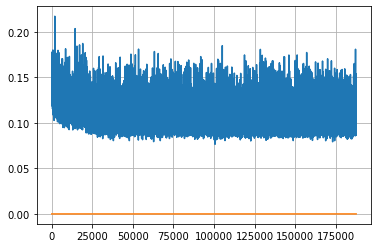

Epoch: 481, iteration 0, loss 0.1195513904094696, cov_diff 0.41785973040158064 cov_diff train 0.41598250464525727
Epoch: 481, iteration 1, loss 0.10838073492050171, cov_diff 0.40609963076058075 cov_diff train 0.40492998116731493
Epoch: 481, iteration 2, loss 0.09543716907501221, cov_diff 0.4117202144745848 cov_diff train 0.40993771106632537
Epoch: 481, iteration 3, loss 0.10427355766296387, cov_diff 0.4154692717887217 cov_diff train 0.4148788998920012
Epoch: 481, iteration 4, loss 0.10101953148841858, cov_diff 0.40536605991355046 cov_diff train 0.4043380400630199
Epoch: 481, iteration 5, loss 0.09162449836730957, cov_diff 0.40436644437071334 cov_diff train 0.40344746087613303
Epoch: 481, iteration 6, loss 0.09536394476890564, cov_diff 0.4190055474052344 cov_diff train 0.417823674644245
Epoch: 481, iteration 7, loss 0.11580279469490051, cov_diff 0.41050789083415123 cov_diff train 0.4084560041214319
Epoch: 481, iteration 8, loss 0.10952562093734741, cov_diff 0.4200620396383545 cov_diff t

Epoch: 481, iteration 77, loss 0.10878109931945801, cov_diff 0.39795322200422145 cov_diff train 0.39699476475752005
Epoch: 481, iteration 78, loss 0.12208765745162964, cov_diff 0.41741014957823064 cov_diff train 0.41653852170553596
Epoch: 481, iteration 79, loss 0.09952491521835327, cov_diff 0.4125627434568117 cov_diff train 0.41191499729673614
Epoch: 481, iteration 80, loss 0.09560689330101013, cov_diff 0.39135134080797845 cov_diff train 0.39108524509776127
Epoch: 481, iteration 81, loss 0.10578089952468872, cov_diff 0.41281553536900445 cov_diff train 0.4122295554975682
Epoch: 481, iteration 82, loss 0.1013428270816803, cov_diff 0.41103827426044076 cov_diff train 0.40925605386262587
Epoch: 481, iteration 83, loss 0.10049834847450256, cov_diff 0.39451629914836883 cov_diff train 0.39533480463297066
Epoch: 481, iteration 84, loss 0.101948082447052, cov_diff 0.41262037456414835 cov_diff train 0.41213760306576536
Epoch: 481, iteration 85, loss 0.10813897848129272, cov_diff 0.41418552881022

Epoch: 481, iteration 154, loss 0.10123810172080994, cov_diff 0.4106117286310617 cov_diff train 0.41072446978942134
Epoch: 481, iteration 155, loss 0.10423821210861206, cov_diff 0.4138893430334795 cov_diff train 0.4131184493535099
Epoch: 481, iteration 156, loss 0.12178555130958557, cov_diff 0.4112610041537961 cov_diff train 0.4101811353923138
Epoch: 481, iteration 157, loss 0.10748165845870972, cov_diff 0.4039990906298937 cov_diff train 0.40351412827339284
Epoch: 481, iteration 158, loss 0.10727196931838989, cov_diff 0.4150341186308387 cov_diff train 0.41377302230381696
Epoch: 481, iteration 159, loss 0.09460768103599548, cov_diff 0.4108890955788509 cov_diff train 0.40973541565681726
Epoch: 481, iteration 160, loss 0.09740403294563293, cov_diff 0.4123131516950119 cov_diff train 0.41175079050333563
Epoch: 481, iteration 161, loss 0.10338109731674194, cov_diff 0.41917851376503285 cov_diff train 0.418353647122277
Epoch: 481, iteration 162, loss 0.10663357377052307, cov_diff 0.40472786069

Epoch: 481, iteration 232, loss 0.09419918060302734, cov_diff 0.41402775739067094 cov_diff train 0.415331294025132
Epoch: 481, iteration 233, loss 0.11980918049812317, cov_diff 0.4093624533404488 cov_diff train 0.4087635371740307
Epoch: 481, iteration 234, loss 0.10049238801002502, cov_diff 0.41515695842117395 cov_diff train 0.41420725855627344
Epoch: 481, iteration 235, loss 0.09934431314468384, cov_diff 0.43148759536757636 cov_diff train 0.43139865487918616
Epoch: 481, iteration 236, loss 0.10040029883384705, cov_diff 0.4111306945516142 cov_diff train 0.41026950188675204
Epoch: 481, iteration 237, loss 0.10192814469337463, cov_diff 0.400309004438128 cov_diff train 0.4001463119770194
Epoch: 481, iteration 238, loss 0.11808693408966064, cov_diff 0.4213756127803955 cov_diff train 0.42014218770172795
Epoch: 481, iteration 239, loss 0.09960329532623291, cov_diff 0.403757560810954 cov_diff train 0.4032271534227271
Epoch: 481, iteration 240, loss 0.09888005256652832, cov_diff 0.412980988403

Epoch: 481, iteration 310, loss 0.10394802689552307, cov_diff 0.41426978518288676 cov_diff train 0.4137537437255174
Epoch: 481, iteration 311, loss 0.09643170237541199, cov_diff 0.4303837898238544 cov_diff train 0.42937911738104845
Epoch: 481, iteration 312, loss 0.09975382685661316, cov_diff 0.39756490563503294 cov_diff train 0.3974101239111764
Epoch: 481, iteration 313, loss 0.09132519364356995, cov_diff 0.41595324671487366 cov_diff train 0.41591184731405784
Epoch: 481, iteration 314, loss 0.09969666600227356, cov_diff 0.41445507624921596 cov_diff train 0.41341963920012526
Epoch: 481, iteration 315, loss 0.0985819399356842, cov_diff 0.4217956354394745 cov_diff train 0.4211255810582765
Epoch: 481, iteration 316, loss 0.11650574207305908, cov_diff 0.4186068147539529 cov_diff train 0.41776540920156546
Epoch: 481, iteration 317, loss 0.09727144241333008, cov_diff 0.3975857746718056 cov_diff train 0.39711373153814405
Epoch: 481, iteration 318, loss 0.10813358426094055, cov_diff 0.39855999

Epoch: 481, iteration 387, loss 0.11565476655960083, cov_diff 0.4175453229783342 cov_diff train 0.416940449015917
Epoch: 481, iteration 388, loss 0.0951032042503357, cov_diff 0.4149406034461019 cov_diff train 0.41456884233176744
Epoch: 481, iteration 389, loss 0.099511057138443, cov_diff 0.41359579074070846 cov_diff train 0.41334167842284475
Epoch: 481, iteration 390, loss 0.1592818796634674, cov_diff 0.45219315310224173 cov_diff train 0.45171055259091325


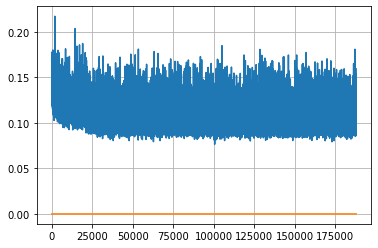

Epoch: 482, iteration 0, loss 0.11904174089431763, cov_diff 0.4331681911211033 cov_diff train 0.4326048779973743
Epoch: 482, iteration 1, loss 0.10157480835914612, cov_diff 0.39374127839894174 cov_diff train 0.39345978282316313
Epoch: 482, iteration 2, loss 0.1032034158706665, cov_diff 0.40447446624407857 cov_diff train 0.40453455786950726
Epoch: 482, iteration 3, loss 0.09995341300964355, cov_diff 0.40642530518024256 cov_diff train 0.4055700258890903
Epoch: 482, iteration 4, loss 0.11648675799369812, cov_diff 0.4088303390458931 cov_diff train 0.4072349140272571
Epoch: 482, iteration 5, loss 0.11179095506668091, cov_diff 0.41097806114340446 cov_diff train 0.4100936359854041
Epoch: 482, iteration 6, loss 0.10871347784996033, cov_diff 0.4161727885083529 cov_diff train 0.4151729549494969
Epoch: 482, iteration 7, loss 0.11440667510032654, cov_diff 0.40250173528977967 cov_diff train 0.4017371436847364
Epoch: 482, iteration 8, loss 0.10634991526603699, cov_diff 0.41246846518881436 cov_diff t

Epoch: 482, iteration 81, loss 0.08795240521430969, cov_diff 0.4176849002933655 cov_diff train 0.4152724715133753
Epoch: 482, iteration 82, loss 0.10942396521568298, cov_diff 0.40037622358421665 cov_diff train 0.4004240363072674
Epoch: 482, iteration 83, loss 0.0978546142578125, cov_diff 0.41360386489221646 cov_diff train 0.4126027744191626
Epoch: 482, iteration 84, loss 0.09646087884902954, cov_diff 0.4169095444978998 cov_diff train 0.41640123540206303
Epoch: 482, iteration 85, loss 0.1033703088760376, cov_diff 0.4003527130430594 cov_diff train 0.39829347601922266
Epoch: 482, iteration 86, loss 0.09416654706001282, cov_diff 0.3983797018668984 cov_diff train 0.3972677747645103
Epoch: 482, iteration 87, loss 0.10067611932754517, cov_diff 0.4095597813153397 cov_diff train 0.4087345952476633
Epoch: 482, iteration 88, loss 0.10623866319656372, cov_diff 0.3982995796240873 cov_diff train 0.39755741697788355
Epoch: 482, iteration 89, loss 0.10727381706237793, cov_diff 0.40285484290362605 cov_

Epoch: 482, iteration 158, loss 0.09954237937927246, cov_diff 0.4086566675672963 cov_diff train 0.40737802425515707
Epoch: 482, iteration 159, loss 0.10212543606758118, cov_diff 0.41199258027308266 cov_diff train 0.4104157545470699
Epoch: 482, iteration 160, loss 0.11266183853149414, cov_diff 0.41108415324336484 cov_diff train 0.41053525110791617
Epoch: 482, iteration 161, loss 0.10586252808570862, cov_diff 0.39745622544254294 cov_diff train 0.3965488369803488
Epoch: 482, iteration 162, loss 0.10346117615699768, cov_diff 0.4011507659509317 cov_diff train 0.401405711879477
Epoch: 482, iteration 163, loss 0.0919874906539917, cov_diff 0.4045710292395654 cov_diff train 0.4038706945650622
Epoch: 482, iteration 164, loss 0.09888187050819397, cov_diff 0.41827427219354324 cov_diff train 0.41801779591524196
Epoch: 482, iteration 165, loss 0.10736417770385742, cov_diff 0.41341386476813774 cov_diff train 0.41170579424110426
Epoch: 482, iteration 166, loss 0.09455522894859314, cov_diff 0.397882453

Epoch: 482, iteration 235, loss 0.1055622398853302, cov_diff 0.4059180789865473 cov_diff train 0.4056517803635532
Epoch: 482, iteration 236, loss 0.10817506909370422, cov_diff 0.40423007343355694 cov_diff train 0.4035259643846614
Epoch: 482, iteration 237, loss 0.11551108956336975, cov_diff 0.4154244806404093 cov_diff train 0.41563344132503227
Epoch: 482, iteration 238, loss 0.10372644662857056, cov_diff 0.39341002011156107 cov_diff train 0.3936750082295389
Epoch: 482, iteration 239, loss 0.09154707193374634, cov_diff 0.40854085641658183 cov_diff train 0.40813762645678464
Epoch: 482, iteration 240, loss 0.10655882954597473, cov_diff 0.40706180431346745 cov_diff train 0.4068280888148498
Epoch: 482, iteration 241, loss 0.09954652190208435, cov_diff 0.40509582398483457 cov_diff train 0.4043017009016568
Epoch: 482, iteration 242, loss 0.1026969850063324, cov_diff 0.39886273827316887 cov_diff train 0.3981537280785921
Epoch: 482, iteration 243, loss 0.10974636673927307, cov_diff 0.4234762589

Epoch: 482, iteration 313, loss 0.09737542271614075, cov_diff 0.4017330165228954 cov_diff train 0.40098226223908917
Epoch: 482, iteration 314, loss 0.1022065281867981, cov_diff 0.4114884410969162 cov_diff train 0.4112345079968487
Epoch: 482, iteration 315, loss 0.10877630114555359, cov_diff 0.4044581989512322 cov_diff train 0.4044836977173774
Epoch: 482, iteration 316, loss 0.10418713092803955, cov_diff 0.41888273863045045 cov_diff train 0.41848213696641956
Epoch: 482, iteration 317, loss 0.10529699921607971, cov_diff 0.4054556560250796 cov_diff train 0.4041581600522662
Epoch: 482, iteration 318, loss 0.10937276482582092, cov_diff 0.40664346165831 cov_diff train 0.4060733379400878
Epoch: 482, iteration 319, loss 0.09510219097137451, cov_diff 0.41188027976079966 cov_diff train 0.41109295590722456
Epoch: 482, iteration 320, loss 0.11265444755554199, cov_diff 0.40985971476943667 cov_diff train 0.4084472612140667
Epoch: 482, iteration 321, loss 0.10572126507759094, cov_diff 0.4103899677288

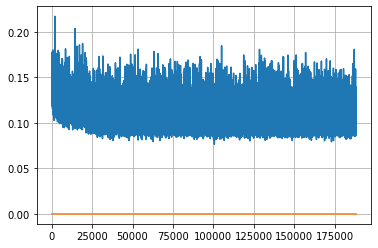

Epoch: 483, iteration 0, loss 0.09858426451683044, cov_diff 0.41306692652283306 cov_diff train 0.4132573371442246
Epoch: 483, iteration 1, loss 0.106578528881073, cov_diff 0.4103868091370364 cov_diff train 0.41018715435234726
Epoch: 483, iteration 2, loss 0.10409501194953918, cov_diff 0.42854442169651796 cov_diff train 0.42731718430132254
Epoch: 483, iteration 3, loss 0.10526323318481445, cov_diff 0.40086926863125727 cov_diff train 0.4003694551187291
Epoch: 483, iteration 4, loss 0.11052203178405762, cov_diff 0.4183972985437335 cov_diff train 0.4180558917675944
Epoch: 483, iteration 5, loss 0.09467297792434692, cov_diff 0.42189317761794204 cov_diff train 0.42110915703666857
Epoch: 483, iteration 6, loss 0.12233224511146545, cov_diff 0.39346156964047146 cov_diff train 0.39294591558986836
Epoch: 483, iteration 7, loss 0.09889909625053406, cov_diff 0.40156456894022813 cov_diff train 0.4014785014073867
Epoch: 483, iteration 8, loss 0.10119965672492981, cov_diff 0.43029199495115406 cov_diff

Epoch: 483, iteration 77, loss 0.11034435033798218, cov_diff 0.4097824321063053 cov_diff train 0.4101262211035274
Epoch: 483, iteration 78, loss 0.10281211137771606, cov_diff 0.41752820374085253 cov_diff train 0.416368848746806
Epoch: 483, iteration 79, loss 0.09555906057357788, cov_diff 0.40671238179165464 cov_diff train 0.4053245379866255
Epoch: 483, iteration 80, loss 0.09996077418327332, cov_diff 0.39871415667112625 cov_diff train 0.3982322415577661
Epoch: 483, iteration 81, loss 0.10717734694480896, cov_diff 0.4120308228755613 cov_diff train 0.4121464874259434
Epoch: 483, iteration 82, loss 0.10907518863677979, cov_diff 0.41389999415044415 cov_diff train 0.4134958264495003
Epoch: 483, iteration 83, loss 0.09640330076217651, cov_diff 0.41035497067511106 cov_diff train 0.40973246796981866
Epoch: 483, iteration 84, loss 0.09919717907905579, cov_diff 0.4224271524512635 cov_diff train 0.42276490804691985
Epoch: 483, iteration 85, loss 0.10517272353172302, cov_diff 0.4124667329667284 co

Epoch: 483, iteration 153, loss 0.10037407279014587, cov_diff 0.4091761820830901 cov_diff train 0.409017939999198
Epoch: 483, iteration 154, loss 0.10205325484275818, cov_diff 0.4141718376568022 cov_diff train 0.4125261781903419
Epoch: 483, iteration 155, loss 0.09820720553398132, cov_diff 0.40385996636616694 cov_diff train 0.40333012101423016
Epoch: 483, iteration 156, loss 0.09271925687789917, cov_diff 0.4036540113800124 cov_diff train 0.4033217151769669
Epoch: 483, iteration 157, loss 0.10637721419334412, cov_diff 0.41533414705573185 cov_diff train 0.4151022559808985
Epoch: 483, iteration 158, loss 0.09336894750595093, cov_diff 0.4099163800173214 cov_diff train 0.4089969448491771
Epoch: 483, iteration 159, loss 0.10491189360618591, cov_diff 0.41086052402884105 cov_diff train 0.4100100841524777
Epoch: 483, iteration 160, loss 0.10101303458213806, cov_diff 0.41706988050286387 cov_diff train 0.4167011066107575
Epoch: 483, iteration 161, loss 0.10656586289405823, cov_diff 0.419407252029

Epoch: 483, iteration 230, loss 0.10513606667518616, cov_diff 0.3949832317599485 cov_diff train 0.39446832042567387
Epoch: 483, iteration 231, loss 0.09679850935935974, cov_diff 0.4049651767818935 cov_diff train 0.40506529321073914
Epoch: 483, iteration 232, loss 0.09626135230064392, cov_diff 0.40883240246139624 cov_diff train 0.4083630145895893
Epoch: 483, iteration 233, loss 0.09625166654586792, cov_diff 0.4014194251957592 cov_diff train 0.40091756513679166
Epoch: 483, iteration 234, loss 0.10689982771873474, cov_diff 0.3973474364380029 cov_diff train 0.3968915411833061
Epoch: 483, iteration 235, loss 0.10345926880836487, cov_diff 0.406227184538273 cov_diff train 0.40577239781810714
Epoch: 483, iteration 236, loss 0.10019376873970032, cov_diff 0.4124167184683196 cov_diff train 0.4116904448790535
Epoch: 483, iteration 237, loss 0.09489938616752625, cov_diff 0.4079587526087085 cov_diff train 0.40762938314628994
Epoch: 483, iteration 238, loss 0.11347568035125732, cov_diff 0.42358572146

Epoch: 483, iteration 307, loss 0.10034793615341187, cov_diff 0.40920486803318273 cov_diff train 0.40758144754777637
Epoch: 483, iteration 308, loss 0.11400970816612244, cov_diff 0.41331572601451394 cov_diff train 0.4115002351464981
Epoch: 483, iteration 309, loss 0.09853613376617432, cov_diff 0.39464504216291196 cov_diff train 0.3939024375383423
Epoch: 483, iteration 310, loss 0.0993594229221344, cov_diff 0.4183634510119441 cov_diff train 0.41710610340754634
Epoch: 483, iteration 311, loss 0.1010512113571167, cov_diff 0.4017494997006774 cov_diff train 0.40120675129188027
Epoch: 483, iteration 312, loss 0.11195129156112671, cov_diff 0.4098376059463398 cov_diff train 0.4087213772219501
Epoch: 483, iteration 313, loss 0.1051410436630249, cov_diff 0.3982412156027913 cov_diff train 0.3968851892814497
Epoch: 483, iteration 314, loss 0.09927812218666077, cov_diff 0.40579400782524766 cov_diff train 0.40429870070087975
Epoch: 483, iteration 315, loss 0.10450658202171326, cov_diff 0.39922902948

Epoch: 483, iteration 385, loss 0.10367286205291748, cov_diff 0.40766244753321235 cov_diff train 0.4074521062987613
Epoch: 483, iteration 386, loss 0.11400681734085083, cov_diff 0.4130857468624791 cov_diff train 0.41230880931783
Epoch: 483, iteration 387, loss 0.1014823317527771, cov_diff 0.4112578848452884 cov_diff train 0.41031743245057106
Epoch: 483, iteration 388, loss 0.1164751946926117, cov_diff 0.4152800187419336 cov_diff train 0.4147001085683702
Epoch: 483, iteration 389, loss 0.10044169425964355, cov_diff 0.394302722117563 cov_diff train 0.3939728809451881
Epoch: 483, iteration 390, loss 0.14605003595352173, cov_diff 0.4369883649769604 cov_diff train 0.4362999956081148


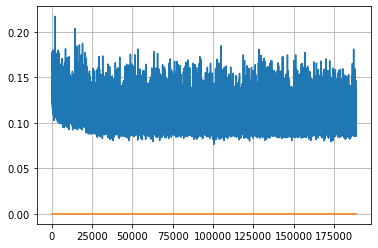

Epoch: 484, iteration 0, loss 0.10720068216323853, cov_diff 0.4089136816629086 cov_diff train 0.40907077541744086
Epoch: 484, iteration 1, loss 0.09553921222686768, cov_diff 0.39994680399840915 cov_diff train 0.4001290982151586
Epoch: 484, iteration 2, loss 0.10427641868591309, cov_diff 0.4097264605834145 cov_diff train 0.409609664259333
Epoch: 484, iteration 3, loss 0.10083302855491638, cov_diff 0.4112540418311499 cov_diff train 0.4099755767523624
Epoch: 484, iteration 4, loss 0.08824682235717773, cov_diff 0.41048913380078456 cov_diff train 0.4103732434183641
Epoch: 484, iteration 5, loss 0.10566794872283936, cov_diff 0.4128034877425244 cov_diff train 0.4119052739087379
Epoch: 484, iteration 6, loss 0.09280088543891907, cov_diff 0.40747699659114034 cov_diff train 0.407123507020343
Epoch: 484, iteration 7, loss 0.10313630104064941, cov_diff 0.4105210787499179 cov_diff train 0.40998580554432085
Epoch: 484, iteration 8, loss 0.10760870575904846, cov_diff 0.4122065735350479 cov_diff train

Epoch: 484, iteration 77, loss 0.10175061225891113, cov_diff 0.4190358502836586 cov_diff train 0.417931588900617
Epoch: 484, iteration 78, loss 0.10963281989097595, cov_diff 0.4016508217146133 cov_diff train 0.4013373487367261
Epoch: 484, iteration 79, loss 0.1119266152381897, cov_diff 0.4072725552419185 cov_diff train 0.40586718668163313
Epoch: 484, iteration 80, loss 0.10364356637001038, cov_diff 0.40145426773581167 cov_diff train 0.4012361729784141
Epoch: 484, iteration 81, loss 0.11254000663757324, cov_diff 0.4089896620208691 cov_diff train 0.40788446440397885
Epoch: 484, iteration 82, loss 0.09632733464241028, cov_diff 0.4004579132086418 cov_diff train 0.40029447137511787
Epoch: 484, iteration 83, loss 0.09146919846534729, cov_diff 0.4120889084330819 cov_diff train 0.41121121627117185
Epoch: 484, iteration 84, loss 0.09868910908699036, cov_diff 0.3955201203454434 cov_diff train 0.3948509464527657
Epoch: 484, iteration 85, loss 0.1057325005531311, cov_diff 0.41220666754519675 cov_d

Epoch: 484, iteration 154, loss 0.10195720195770264, cov_diff 0.41701642429545616 cov_diff train 0.4170515237766048
Epoch: 484, iteration 155, loss 0.10080122947692871, cov_diff 0.4022976525400891 cov_diff train 0.4019772838231961
Epoch: 484, iteration 156, loss 0.10191252827644348, cov_diff 0.40616206535012295 cov_diff train 0.4059452123992177
Epoch: 484, iteration 157, loss 0.09819462895393372, cov_diff 0.40605943861689625 cov_diff train 0.40551861807590794
Epoch: 484, iteration 158, loss 0.10057187080383301, cov_diff 0.4019763427768198 cov_diff train 0.40008214777920814
Epoch: 484, iteration 159, loss 0.11142444610595703, cov_diff 0.41367370158047323 cov_diff train 0.4133504838019957
Epoch: 484, iteration 160, loss 0.08964136242866516, cov_diff 0.4097348225712739 cov_diff train 0.4092497144953214
Epoch: 484, iteration 161, loss 0.12223580479621887, cov_diff 0.4257751725634776 cov_diff train 0.425825316069504
Epoch: 484, iteration 162, loss 0.10986018180847168, cov_diff 0.41046167425

Epoch: 484, iteration 231, loss 0.09113886952400208, cov_diff 0.40209871242659695 cov_diff train 0.40296553280078395
Epoch: 484, iteration 232, loss 0.09786346554756165, cov_diff 0.4136949541141218 cov_diff train 0.4135251311970787
Epoch: 484, iteration 233, loss 0.10546547174453735, cov_diff 0.40129848203676666 cov_diff train 0.40075244188170134
Epoch: 484, iteration 234, loss 0.09984725713729858, cov_diff 0.4124670639411614 cov_diff train 0.41173853226210094
Epoch: 484, iteration 235, loss 0.09853994846343994, cov_diff 0.4199363700431503 cov_diff train 0.41920053366662374
Epoch: 484, iteration 236, loss 0.09941482543945312, cov_diff 0.41007407742036783 cov_diff train 0.40908594637294987
Epoch: 484, iteration 237, loss 0.10522747039794922, cov_diff 0.4179896464520957 cov_diff train 0.41741501619607574
Epoch: 484, iteration 238, loss 0.10155457258224487, cov_diff 0.4018195600741374 cov_diff train 0.4005327666536864
Epoch: 484, iteration 239, loss 0.10745063424110413, cov_diff 0.4155612

Epoch: 484, iteration 308, loss 0.10772866010665894, cov_diff 0.41374548116031346 cov_diff train 0.41184664209280814
Epoch: 484, iteration 309, loss 0.10048380494117737, cov_diff 0.4060190002909722 cov_diff train 0.40466463210309966
Epoch: 484, iteration 310, loss 0.1150205135345459, cov_diff 0.4236804179726403 cov_diff train 0.42253692576389507
Epoch: 484, iteration 311, loss 0.10306486487388611, cov_diff 0.41103420780869565 cov_diff train 0.41011260221424634
Epoch: 484, iteration 312, loss 0.10723370313644409, cov_diff 0.40959349382135174 cov_diff train 0.40967539582706686
Epoch: 484, iteration 313, loss 0.10053297877311707, cov_diff 0.3916598636355512 cov_diff train 0.3915412939798594
Epoch: 484, iteration 314, loss 0.08825737237930298, cov_diff 0.40283984661533984 cov_diff train 0.40262722619465424
Epoch: 484, iteration 315, loss 0.09193775057792664, cov_diff 0.41281397513639506 cov_diff train 0.41259373795417315
Epoch: 484, iteration 316, loss 0.1045624315738678, cov_diff 0.399924

Epoch: 484, iteration 385, loss 0.11082670092582703, cov_diff 0.412543095192771 cov_diff train 0.4122089696235059
Epoch: 484, iteration 386, loss 0.10486644506454468, cov_diff 0.4116293141027218 cov_diff train 0.4107393854143978
Epoch: 484, iteration 387, loss 0.10977274179458618, cov_diff 0.4137870966335549 cov_diff train 0.4140080401271775
Epoch: 484, iteration 388, loss 0.10914075374603271, cov_diff 0.4092238970341194 cov_diff train 0.4089911126228467
Epoch: 484, iteration 389, loss 0.11221659183502197, cov_diff 0.4169860383237689 cov_diff train 0.41688854773915596
Epoch: 484, iteration 390, loss 0.1717342734336853, cov_diff 0.42992300672175815 cov_diff train 0.42981484153803867


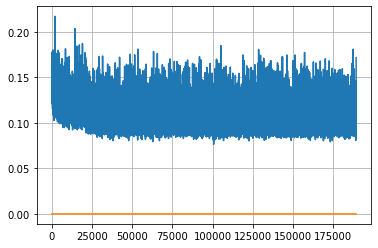

Epoch: 485, iteration 0, loss 0.10335105657577515, cov_diff 0.42967752665187414 cov_diff train 0.4298130697387344
Epoch: 485, iteration 1, loss 0.10250040888786316, cov_diff 0.4027557905007958 cov_diff train 0.40300688907291915
Epoch: 485, iteration 2, loss 0.10653361678123474, cov_diff 0.4101271928253344 cov_diff train 0.41094199956715755
Epoch: 485, iteration 3, loss 0.10343840718269348, cov_diff 0.41440318474968246 cov_diff train 0.4138422929976323
Epoch: 485, iteration 4, loss 0.10128986835479736, cov_diff 0.4045199504012716 cov_diff train 0.404710507524291
Epoch: 485, iteration 5, loss 0.10706236958503723, cov_diff 0.41240735047904464 cov_diff train 0.4122151820909666
Epoch: 485, iteration 6, loss 0.10543122887611389, cov_diff 0.41626834747960634 cov_diff train 0.41563879028520095
Epoch: 485, iteration 7, loss 0.10979211330413818, cov_diff 0.4255956656365743 cov_diff train 0.42466736964397717
Epoch: 485, iteration 8, loss 0.11278873682022095, cov_diff 0.42402711554789607 cov_diff 

Epoch: 485, iteration 78, loss 0.10257527232170105, cov_diff 0.40903039595430546 cov_diff train 0.40807690516769834
Epoch: 485, iteration 79, loss 0.10532456636428833, cov_diff 0.40741308370129076 cov_diff train 0.4065446657681737
Epoch: 485, iteration 80, loss 0.09911385178565979, cov_diff 0.4139343980397364 cov_diff train 0.41322344482516643
Epoch: 485, iteration 81, loss 0.11444893479347229, cov_diff 0.42865311702802145 cov_diff train 0.42770370120068946
Epoch: 485, iteration 82, loss 0.09414422512054443, cov_diff 0.41563865120327137 cov_diff train 0.41401341327366975
Epoch: 485, iteration 83, loss 0.10593271255493164, cov_diff 0.40683840767538687 cov_diff train 0.40589446838399024
Epoch: 485, iteration 84, loss 0.11422008275985718, cov_diff 0.41008628161959815 cov_diff train 0.4083591858987575
Epoch: 485, iteration 85, loss 0.10321825742721558, cov_diff 0.40966546387294317 cov_diff train 0.40840538340134597
Epoch: 485, iteration 86, loss 0.1140882670879364, cov_diff 0.4079204252545

Epoch: 485, iteration 155, loss 0.0949765145778656, cov_diff 0.4111155219038815 cov_diff train 0.410823842141074
Epoch: 485, iteration 156, loss 0.08884802460670471, cov_diff 0.40504813552593816 cov_diff train 0.40445173431486214
Epoch: 485, iteration 157, loss 0.1053057312965393, cov_diff 0.40783187888834715 cov_diff train 0.40780531930166675
Epoch: 485, iteration 158, loss 0.10051858425140381, cov_diff 0.408291653654994 cov_diff train 0.40682156080824805
Epoch: 485, iteration 159, loss 0.09954077005386353, cov_diff 0.4105330931918466 cov_diff train 0.4095963323804427
Epoch: 485, iteration 160, loss 0.10005325078964233, cov_diff 0.4233970287141684 cov_diff train 0.422891923313718
Epoch: 485, iteration 161, loss 0.11123800277709961, cov_diff 0.4049044031082843 cov_diff train 0.40416720917000537
Epoch: 485, iteration 162, loss 0.10515794157981873, cov_diff 0.40378532494858427 cov_diff train 0.4040353717515242
Epoch: 485, iteration 163, loss 0.09651264548301697, cov_diff 0.40099826450127

Epoch: 485, iteration 236, loss 0.1165359616279602, cov_diff 0.39405891286671396 cov_diff train 0.39336849105236826
Epoch: 485, iteration 237, loss 0.10051673650741577, cov_diff 0.41466740668799196 cov_diff train 0.4146397036951024
Epoch: 485, iteration 238, loss 0.1098819375038147, cov_diff 0.41329709565111267 cov_diff train 0.4128067828552378
Epoch: 485, iteration 239, loss 0.10139703750610352, cov_diff 0.4191383157937344 cov_diff train 0.4187453041268637
Epoch: 485, iteration 240, loss 0.10800185799598694, cov_diff 0.41843883629114037 cov_diff train 0.4180723536187939
Epoch: 485, iteration 241, loss 0.1078447699546814, cov_diff 0.4299841575398618 cov_diff train 0.42820166530292664
Epoch: 485, iteration 242, loss 0.0975446105003357, cov_diff 0.4139827360660238 cov_diff train 0.4128116786945919
Epoch: 485, iteration 243, loss 0.10097208619117737, cov_diff 0.4020136955395499 cov_diff train 0.40099749388149797
Epoch: 485, iteration 244, loss 0.09835252165794373, cov_diff 0.4160856862203

Epoch: 485, iteration 314, loss 0.10922443866729736, cov_diff 0.40353520342196486 cov_diff train 0.4029286320163267
Epoch: 485, iteration 315, loss 0.1100078821182251, cov_diff 0.4081771963878193 cov_diff train 0.4075359130138914
Epoch: 485, iteration 316, loss 0.10076084733009338, cov_diff 0.4123081109598028 cov_diff train 0.41174228119592365
Epoch: 485, iteration 317, loss 0.09993219375610352, cov_diff 0.41428168331642223 cov_diff train 0.4142512502417533
Epoch: 485, iteration 318, loss 0.10048046708106995, cov_diff 0.40854584530677024 cov_diff train 0.4081667919687016
Epoch: 485, iteration 319, loss 0.10455271601676941, cov_diff 0.41021744398531795 cov_diff train 0.40953509488467654
Epoch: 485, iteration 320, loss 0.10631152987480164, cov_diff 0.4134599553134472 cov_diff train 0.41199405330071664
Epoch: 485, iteration 321, loss 0.10509896278381348, cov_diff 0.4205478108746691 cov_diff train 0.42049489651691924
Epoch: 485, iteration 322, loss 0.10160636901855469, cov_diff 0.403649883

Epoch: 485, iteration 390, loss 0.14228203892707825, cov_diff 0.4437543902988431 cov_diff train 0.44132419794863026


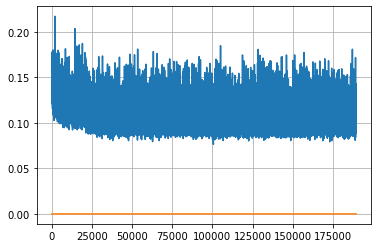

Epoch: 486, iteration 0, loss 0.10433605313301086, cov_diff 0.41869181412688794 cov_diff train 0.41724669827588606
Epoch: 486, iteration 1, loss 0.10955008864402771, cov_diff 0.4058467065467411 cov_diff train 0.4050144943186728
Epoch: 486, iteration 2, loss 0.10138267278671265, cov_diff 0.4044404897516938 cov_diff train 0.4026035032393687
Epoch: 486, iteration 3, loss 0.10311445593833923, cov_diff 0.41036996008160737 cov_diff train 0.40988519362177017
Epoch: 486, iteration 4, loss 0.10224205255508423, cov_diff 0.4150344709369572 cov_diff train 0.4139060286913025
Epoch: 486, iteration 5, loss 0.10364136099815369, cov_diff 0.41761263276885097 cov_diff train 0.41670844763114784
Epoch: 486, iteration 6, loss 0.09772863984107971, cov_diff 0.41090055153285443 cov_diff train 0.41191356835064397
Epoch: 486, iteration 7, loss 0.11293372511863708, cov_diff 0.4080865471180578 cov_diff train 0.40778861947057593
Epoch: 486, iteration 8, loss 0.10737037658691406, cov_diff 0.4010689478431008 cov_diff

Epoch: 486, iteration 78, loss 0.10814169049263, cov_diff 0.4066893388993131 cov_diff train 0.40660338659324685
Epoch: 486, iteration 79, loss 0.09615302085876465, cov_diff 0.4181313436898688 cov_diff train 0.4171158582023159
Epoch: 486, iteration 80, loss 0.11791080236434937, cov_diff 0.4158764282713789 cov_diff train 0.4152743869043294
Epoch: 486, iteration 81, loss 0.1066179871559143, cov_diff 0.40116718198882395 cov_diff train 0.40061566959890493
Epoch: 486, iteration 82, loss 0.09374344348907471, cov_diff 0.42250061396467614 cov_diff train 0.4215121634539167
Epoch: 486, iteration 83, loss 0.10557180643081665, cov_diff 0.4088255066736305 cov_diff train 0.4082385687257776
Epoch: 486, iteration 84, loss 0.09998393058776855, cov_diff 0.4178005588126759 cov_diff train 0.41699507360236043
Epoch: 486, iteration 85, loss 0.10664921998977661, cov_diff 0.40507330413542864 cov_diff train 0.40441927387918614
Epoch: 486, iteration 86, loss 0.1074303388595581, cov_diff 0.4090366405875945 cov_di

Epoch: 486, iteration 157, loss 0.09683331847190857, cov_diff 0.40138598040698537 cov_diff train 0.40064401301999364
Epoch: 486, iteration 158, loss 0.09799325466156006, cov_diff 0.410192865325411 cov_diff train 0.41005490429526614
Epoch: 486, iteration 159, loss 0.10615035891532898, cov_diff 0.42436685286587233 cov_diff train 0.42420602671853436
Epoch: 486, iteration 160, loss 0.09469115734100342, cov_diff 0.40586916883007 cov_diff train 0.4047815935979481
Epoch: 486, iteration 161, loss 0.0971524715423584, cov_diff 0.4104956184415265 cov_diff train 0.4093554835428735
Epoch: 486, iteration 162, loss 0.10824885964393616, cov_diff 0.4164830017838981 cov_diff train 0.4157003396122452
Epoch: 486, iteration 163, loss 0.09249934554100037, cov_diff 0.3962253050499795 cov_diff train 0.3957787521554806
Epoch: 486, iteration 164, loss 0.11423873901367188, cov_diff 0.4160016915786954 cov_diff train 0.41540769629668095
Epoch: 486, iteration 165, loss 0.09994465112686157, cov_diff 0.41097151319536

Epoch: 486, iteration 235, loss 0.09823867678642273, cov_diff 0.4270954611148143 cov_diff train 0.4271546249765264
Epoch: 486, iteration 236, loss 0.09505048394203186, cov_diff 0.41337095370815136 cov_diff train 0.4127391017184911
Epoch: 486, iteration 237, loss 0.10121411085128784, cov_diff 0.4121149766953143 cov_diff train 0.411583791661706
Epoch: 486, iteration 238, loss 0.09415507316589355, cov_diff 0.42364107589570604 cov_diff train 0.42388548398606696
Epoch: 486, iteration 239, loss 0.10885825753211975, cov_diff 0.4136097658148285 cov_diff train 0.41248071409977993
Epoch: 486, iteration 240, loss 0.10265552997589111, cov_diff 0.4161248410360551 cov_diff train 0.41520060755989263
Epoch: 486, iteration 241, loss 0.10158520936965942, cov_diff 0.41870743122896714 cov_diff train 0.41765224937117973
Epoch: 486, iteration 242, loss 0.10639786720275879, cov_diff 0.4278080922242608 cov_diff train 0.4283521677569593
Epoch: 486, iteration 243, loss 0.10802462697029114, cov_diff 0.4237401815

Epoch: 486, iteration 310, loss 0.09282919764518738, cov_diff 0.4145133681985369 cov_diff train 0.41426408990066155
Epoch: 486, iteration 311, loss 0.1012679934501648, cov_diff 0.40940021037564284 cov_diff train 0.40948967734561703
Epoch: 486, iteration 312, loss 0.10091125965118408, cov_diff 0.413629312422616 cov_diff train 0.41268853431041386
Epoch: 486, iteration 313, loss 0.10664448142051697, cov_diff 0.4038945141887936 cov_diff train 0.4040757201832132
Epoch: 486, iteration 314, loss 0.11183258891105652, cov_diff 0.40343659297842505 cov_diff train 0.40315571124851124
Epoch: 486, iteration 315, loss 0.09882968664169312, cov_diff 0.40405179351917314 cov_diff train 0.4040672840440703
Epoch: 486, iteration 316, loss 0.10886046290397644, cov_diff 0.4185849739746969 cov_diff train 0.41723558394966315
Epoch: 486, iteration 317, loss 0.09731096029281616, cov_diff 0.418433134142128 cov_diff train 0.41861046882872177
Epoch: 486, iteration 318, loss 0.10306915640830994, cov_diff 0.4098519107

Epoch: 486, iteration 388, loss 0.10229295492172241, cov_diff 0.4107233491084941 cov_diff train 0.41000567911362884
Epoch: 486, iteration 389, loss 0.09379857778549194, cov_diff 0.4160744418809036 cov_diff train 0.415908777548573
Epoch: 486, iteration 390, loss 0.137630432844162, cov_diff 0.4532246656373368 cov_diff train 0.4532697858897687


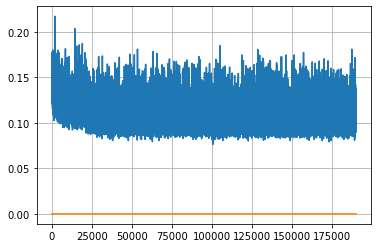

Epoch: 487, iteration 0, loss 0.11557838320732117, cov_diff 0.41309462376074496 cov_diff train 0.41330484474943857
Epoch: 487, iteration 1, loss 0.10621786117553711, cov_diff 0.40359071000474694 cov_diff train 0.4038604034180576
Epoch: 487, iteration 2, loss 0.10562673211097717, cov_diff 0.42902101134451404 cov_diff train 0.4288030659564875
Epoch: 487, iteration 3, loss 0.09331539273262024, cov_diff 0.41256727754927314 cov_diff train 0.4115404247381529
Epoch: 487, iteration 4, loss 0.0975709855556488, cov_diff 0.41328037495448156 cov_diff train 0.41328495216282257
Epoch: 487, iteration 5, loss 0.11022898554801941, cov_diff 0.41127715269366394 cov_diff train 0.41101965636352855
Epoch: 487, iteration 6, loss 0.09537288546562195, cov_diff 0.4157712747243106 cov_diff train 0.41517427465768547
Epoch: 487, iteration 7, loss 0.10806965827941895, cov_diff 0.4180341321656285 cov_diff train 0.41565002441198723
Epoch: 487, iteration 8, loss 0.10073965787887573, cov_diff 0.4146276876564671 cov_dif

Epoch: 487, iteration 77, loss 0.08524307608604431, cov_diff 0.3953535704999176 cov_diff train 0.3946221965305115
Epoch: 487, iteration 78, loss 0.10466575622558594, cov_diff 0.41583430604221927 cov_diff train 0.4149428762699697
Epoch: 487, iteration 79, loss 0.10935059189796448, cov_diff 0.39932956041884166 cov_diff train 0.39804780792049543
Epoch: 487, iteration 80, loss 0.10599985718727112, cov_diff 0.4206024533149234 cov_diff train 0.42033787454248417
Epoch: 487, iteration 81, loss 0.10408252477645874, cov_diff 0.40477805645496373 cov_diff train 0.40510640121418956
Epoch: 487, iteration 82, loss 0.09861704707145691, cov_diff 0.4199497203455968 cov_diff train 0.41924641319853606
Epoch: 487, iteration 83, loss 0.1024634838104248, cov_diff 0.4089511156098835 cov_diff train 0.4083835956719993
Epoch: 487, iteration 84, loss 0.10107192397117615, cov_diff 0.4100965361825227 cov_diff train 0.40949351471390705
Epoch: 487, iteration 85, loss 0.10053947567939758, cov_diff 0.4194299886215078 c

Epoch: 487, iteration 154, loss 0.09045737981796265, cov_diff 0.4183704372262085 cov_diff train 0.4180194411315568
Epoch: 487, iteration 155, loss 0.11106419563293457, cov_diff 0.40722183818043795 cov_diff train 0.40647359209781475
Epoch: 487, iteration 156, loss 0.09742066264152527, cov_diff 0.4144192521337857 cov_diff train 0.41329949940354077
Epoch: 487, iteration 157, loss 0.10023197531700134, cov_diff 0.4072099940940803 cov_diff train 0.4071026757245347
Epoch: 487, iteration 158, loss 0.11847952008247375, cov_diff 0.415040860767854 cov_diff train 0.41486342539445487
Epoch: 487, iteration 159, loss 0.10850837826728821, cov_diff 0.40786192621605905 cov_diff train 0.4073943894882334
Epoch: 487, iteration 160, loss 0.10770398378372192, cov_diff 0.40890635949936716 cov_diff train 0.4075777678034973
Epoch: 487, iteration 161, loss 0.10197699069976807, cov_diff 0.41422572235273675 cov_diff train 0.41300529346223197
Epoch: 487, iteration 162, loss 0.10280194878578186, cov_diff 0.411786983

Epoch: 487, iteration 232, loss 0.10276371240615845, cov_diff 0.3949783156800621 cov_diff train 0.3944002319725339
Epoch: 487, iteration 233, loss 0.09637221693992615, cov_diff 0.4098752108836431 cov_diff train 0.41013334712375615
Epoch: 487, iteration 234, loss 0.09796875715255737, cov_diff 0.4152495115237128 cov_diff train 0.4147147157422736
Epoch: 487, iteration 235, loss 0.10150143504142761, cov_diff 0.404560852575452 cov_diff train 0.4041407566488423
Epoch: 487, iteration 236, loss 0.10314959287643433, cov_diff 0.40796996697122206 cov_diff train 0.4081538798586735
Epoch: 487, iteration 237, loss 0.09642341732978821, cov_diff 0.43182246021828014 cov_diff train 0.4308029908734951
Epoch: 487, iteration 238, loss 0.10930135846138, cov_diff 0.40941458173099315 cov_diff train 0.4083817377738306
Epoch: 487, iteration 239, loss 0.09493279457092285, cov_diff 0.4220981518112711 cov_diff train 0.4195693655486464
Epoch: 487, iteration 240, loss 0.0978967547416687, cov_diff 0.4126251300967483 

Epoch: 487, iteration 305, loss 0.10861814022064209, cov_diff 0.41907778008977314 cov_diff train 0.4187369682729407
Epoch: 487, iteration 306, loss 0.1046743392944336, cov_diff 0.413026340283829 cov_diff train 0.4125241099753737
Epoch: 487, iteration 307, loss 0.10221335291862488, cov_diff 0.41542119112267833 cov_diff train 0.41475643524948097
Epoch: 487, iteration 308, loss 0.1093633770942688, cov_diff 0.40878256909124083 cov_diff train 0.40842376731410324
Epoch: 487, iteration 309, loss 0.09968921542167664, cov_diff 0.4169530364642335 cov_diff train 0.41656208718723187
Epoch: 487, iteration 310, loss 0.10582289099693298, cov_diff 0.40985480156785553 cov_diff train 0.40822617080928336
Epoch: 487, iteration 311, loss 0.09192949533462524, cov_diff 0.4094746574908555 cov_diff train 0.4081306041640947
Epoch: 487, iteration 312, loss 0.09952059388160706, cov_diff 0.4042506377495728 cov_diff train 0.40344311119013826
Epoch: 487, iteration 313, loss 0.10747301578521729, cov_diff 0.4167514861

Epoch: 487, iteration 381, loss 0.11438241600990295, cov_diff 0.41322179213788557 cov_diff train 0.41289945742161144
Epoch: 487, iteration 382, loss 0.10434052348136902, cov_diff 0.411047800876462 cov_diff train 0.41040000220961886
Epoch: 487, iteration 383, loss 0.11254453659057617, cov_diff 0.40549310804290617 cov_diff train 0.4053832684389885
Epoch: 487, iteration 384, loss 0.09731253981590271, cov_diff 0.41396681451104694 cov_diff train 0.41385011198758126
Epoch: 487, iteration 385, loss 0.09714984893798828, cov_diff 0.4059092722545567 cov_diff train 0.40611058233643055
Epoch: 487, iteration 386, loss 0.11180722713470459, cov_diff 0.40194793009059576 cov_diff train 0.40129652319869386
Epoch: 487, iteration 387, loss 0.1056872308254242, cov_diff 0.41302936772039506 cov_diff train 0.41198351821463186
Epoch: 487, iteration 388, loss 0.10257971286773682, cov_diff 0.4213388803149899 cov_diff train 0.42078708683505117
Epoch: 487, iteration 389, loss 0.10410714149475098, cov_diff 0.412506

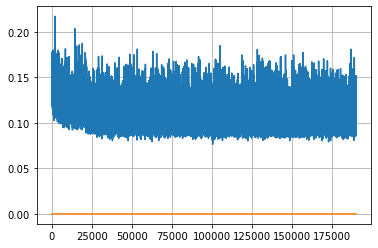

Epoch: 488, iteration 0, loss 0.09818899631500244, cov_diff 0.39502330738107333 cov_diff train 0.3942308293351465
Epoch: 488, iteration 1, loss 0.1068580150604248, cov_diff 0.4130394937682319 cov_diff train 0.4130445683205465
Epoch: 488, iteration 2, loss 0.09392103552818298, cov_diff 0.41478301262443523 cov_diff train 0.41511777970075636
Epoch: 488, iteration 3, loss 0.10118213295936584, cov_diff 0.41013883886674335 cov_diff train 0.4085284765433892
Epoch: 488, iteration 4, loss 0.08898568153381348, cov_diff 0.4248956071759926 cov_diff train 0.42411844536725696
Epoch: 488, iteration 5, loss 0.10753989219665527, cov_diff 0.4276730015867587 cov_diff train 0.42706499928155783
Epoch: 488, iteration 6, loss 0.09970220923423767, cov_diff 0.42252741561818535 cov_diff train 0.42104297614862785
Epoch: 488, iteration 7, loss 0.11031126976013184, cov_diff 0.41787017105435853 cov_diff train 0.4177807934955827
Epoch: 488, iteration 8, loss 0.1011551022529602, cov_diff 0.40261927420452037 cov_diff 

Epoch: 488, iteration 78, loss 0.10678955912590027, cov_diff 0.4059512275367706 cov_diff train 0.40594185175361497
Epoch: 488, iteration 79, loss 0.10567247867584229, cov_diff 0.43285034616825424 cov_diff train 0.4319877219024696
Epoch: 488, iteration 80, loss 0.11208793520927429, cov_diff 0.4123666978083025 cov_diff train 0.4113312979761209
Epoch: 488, iteration 81, loss 0.09678128361701965, cov_diff 0.40261636189001243 cov_diff train 0.4026425128261138
Epoch: 488, iteration 82, loss 0.10301107168197632, cov_diff 0.41737783450397187 cov_diff train 0.41673860803201856
Epoch: 488, iteration 83, loss 0.10512343049049377, cov_diff 0.4143066992275912 cov_diff train 0.4120141041993595
Epoch: 488, iteration 84, loss 0.10382965207099915, cov_diff 0.41182395208295813 cov_diff train 0.41058138528471694
Epoch: 488, iteration 85, loss 0.09712043404579163, cov_diff 0.4195348906601204 cov_diff train 0.41978181358615846
Epoch: 488, iteration 86, loss 0.10039341449737549, cov_diff 0.4277496961052079 

Epoch: 488, iteration 158, loss 0.09771433472633362, cov_diff 0.41277965087111257 cov_diff train 0.4116666162938529
Epoch: 488, iteration 159, loss 0.10891655087471008, cov_diff 0.40418101567693915 cov_diff train 0.4032548441462121
Epoch: 488, iteration 160, loss 0.10503736138343811, cov_diff 0.41424660722630763 cov_diff train 0.4141302567977302
Epoch: 488, iteration 161, loss 0.09060844779014587, cov_diff 0.41634454162631385 cov_diff train 0.41526962921055516
Epoch: 488, iteration 162, loss 0.10541641712188721, cov_diff 0.41674618129103386 cov_diff train 0.4170758321978363
Epoch: 488, iteration 163, loss 0.10176220536231995, cov_diff 0.4142256656485001 cov_diff train 0.41099829428754375
Epoch: 488, iteration 164, loss 0.10651272535324097, cov_diff 0.4040234582412915 cov_diff train 0.4035618880370274
Epoch: 488, iteration 165, loss 0.09753018617630005, cov_diff 0.40359107372548664 cov_diff train 0.403566366377534
Epoch: 488, iteration 166, loss 0.09729307889938354, cov_diff 0.412457208

Epoch: 488, iteration 235, loss 0.11997804045677185, cov_diff 0.4169098503981818 cov_diff train 0.4151153222956403
Epoch: 488, iteration 236, loss 0.10303467512130737, cov_diff 0.4127858585280684 cov_diff train 0.4118500740180288
Epoch: 488, iteration 237, loss 0.1123281717300415, cov_diff 0.42036049389947583 cov_diff train 0.4191662100722479
Epoch: 488, iteration 238, loss 0.10425573587417603, cov_diff 0.4122609867714861 cov_diff train 0.4121665014274977
Epoch: 488, iteration 239, loss 0.09802022576332092, cov_diff 0.4121817835295971 cov_diff train 0.41110328424856224
Epoch: 488, iteration 240, loss 0.0945848822593689, cov_diff 0.4192837068266755 cov_diff train 0.41841730352959655
Epoch: 488, iteration 241, loss 0.10161396861076355, cov_diff 0.39833111263163534 cov_diff train 0.3986300770150478
Epoch: 488, iteration 242, loss 0.11026197671890259, cov_diff 0.41838725904404434 cov_diff train 0.41734602018516864
Epoch: 488, iteration 243, loss 0.11873257160186768, cov_diff 0.408013533622

Epoch: 488, iteration 312, loss 0.09998136758804321, cov_diff 0.4072096118202325 cov_diff train 0.4065517345324979
Epoch: 488, iteration 313, loss 0.08889859914779663, cov_diff 0.40012578724512404 cov_diff train 0.4000001122842447
Epoch: 488, iteration 314, loss 0.10294380784034729, cov_diff 0.42023457763922595 cov_diff train 0.41633805965445625
Epoch: 488, iteration 315, loss 0.10021084547042847, cov_diff 0.4049895296933978 cov_diff train 0.4042479939547665
Epoch: 488, iteration 316, loss 0.10654136538505554, cov_diff 0.4185705140778817 cov_diff train 0.4179068263140255
Epoch: 488, iteration 317, loss 0.09323868155479431, cov_diff 0.39756131310574166 cov_diff train 0.3958756241718145
Epoch: 488, iteration 318, loss 0.09851497411727905, cov_diff 0.4108944886380813 cov_diff train 0.40965658804405514
Epoch: 488, iteration 319, loss 0.10377603769302368, cov_diff 0.4123996116961026 cov_diff train 0.410619317320585
Epoch: 488, iteration 320, loss 0.10437586903572083, cov_diff 0.408065638562

Epoch: 488, iteration 389, loss 0.10187217593193054, cov_diff 0.412399643259928 cov_diff train 0.41184877071108084
Epoch: 488, iteration 390, loss 0.13648951053619385, cov_diff 0.4283935498876634 cov_diff train 0.4300358388434859


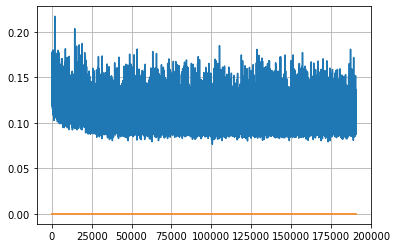

Epoch: 489, iteration 0, loss 0.10299107432365417, cov_diff 0.4073698411263001 cov_diff train 0.40630735074044516
Epoch: 489, iteration 1, loss 0.10142374038696289, cov_diff 0.41917757804155376 cov_diff train 0.41898399626244
Epoch: 489, iteration 2, loss 0.09488898515701294, cov_diff 0.4118312171621822 cov_diff train 0.4108933874047232
Epoch: 489, iteration 3, loss 0.10216847062110901, cov_diff 0.4002329060498382 cov_diff train 0.3991638733476388
Epoch: 489, iteration 4, loss 0.0885418951511383, cov_diff 0.4043242824216932 cov_diff train 0.4040328240902884
Epoch: 489, iteration 5, loss 0.10347667336463928, cov_diff 0.4341963201912263 cov_diff train 0.43227078817668185
Epoch: 489, iteration 6, loss 0.09403860569000244, cov_diff 0.4183101396596141 cov_diff train 0.41713866105762926
Epoch: 489, iteration 7, loss 0.10620412230491638, cov_diff 0.4094698437000757 cov_diff train 0.40845858858330486
Epoch: 489, iteration 8, loss 0.1010710597038269, cov_diff 0.40698621502810745 cov_diff train 

Epoch: 489, iteration 77, loss 0.09577104449272156, cov_diff 0.40430836259896924 cov_diff train 0.40461165477911354
Epoch: 489, iteration 78, loss 0.10476213693618774, cov_diff 0.407827842286592 cov_diff train 0.40755300045714227
Epoch: 489, iteration 79, loss 0.10472729802131653, cov_diff 0.414243231480083 cov_diff train 0.4144772431457957
Epoch: 489, iteration 80, loss 0.10553103685379028, cov_diff 0.41539242490393186 cov_diff train 0.41341624730259235
Epoch: 489, iteration 81, loss 0.11209273338317871, cov_diff 0.4156255098768337 cov_diff train 0.41496387661892903
Epoch: 489, iteration 82, loss 0.10058468580245972, cov_diff 0.4030498818680039 cov_diff train 0.40288731291693713
Epoch: 489, iteration 83, loss 0.10367792844772339, cov_diff 0.41432471304319585 cov_diff train 0.413524237405954
Epoch: 489, iteration 84, loss 0.10015106201171875, cov_diff 0.40293850721417124 cov_diff train 0.40312259664425154
Epoch: 489, iteration 85, loss 0.11308911442756653, cov_diff 0.40233630558268696 

Epoch: 489, iteration 154, loss 0.10236895084381104, cov_diff 0.40410622865577517 cov_diff train 0.40412504602727467
Epoch: 489, iteration 155, loss 0.09536802768707275, cov_diff 0.41443308209750246 cov_diff train 0.4134976350753309
Epoch: 489, iteration 156, loss 0.10347339510917664, cov_diff 0.4194032596543464 cov_diff train 0.41855699952997727
Epoch: 489, iteration 157, loss 0.11585041880607605, cov_diff 0.41439488935761165 cov_diff train 0.41360723804950894
Epoch: 489, iteration 158, loss 0.09859359264373779, cov_diff 0.410743573614799 cov_diff train 0.41009236795102527
Epoch: 489, iteration 159, loss 0.10075342655181885, cov_diff 0.4273646880488881 cov_diff train 0.42694232686693884
Epoch: 489, iteration 160, loss 0.10646972060203552, cov_diff 0.4035720366871204 cov_diff train 0.4032307801176307
Epoch: 489, iteration 161, loss 0.10137373208999634, cov_diff 0.401061894000963 cov_diff train 0.4009933176538635
Epoch: 489, iteration 162, loss 0.09609109163284302, cov_diff 0.4099234343

Epoch: 489, iteration 232, loss 0.09480714797973633, cov_diff 0.4172920247863803 cov_diff train 0.41719531608086413
Epoch: 489, iteration 233, loss 0.096245676279068, cov_diff 0.4213989032764887 cov_diff train 0.42057667375960817
Epoch: 489, iteration 234, loss 0.11667951941490173, cov_diff 0.4169074368427962 cov_diff train 0.4168804204581253
Epoch: 489, iteration 235, loss 0.09916886687278748, cov_diff 0.4051869685043314 cov_diff train 0.4043960638230313
Epoch: 489, iteration 236, loss 0.10111147165298462, cov_diff 0.41930703181227774 cov_diff train 0.4183818946253652
Epoch: 489, iteration 237, loss 0.10101678967475891, cov_diff 0.4113512692933513 cov_diff train 0.4096363401594088
Epoch: 489, iteration 238, loss 0.11203861236572266, cov_diff 0.417117580788181 cov_diff train 0.41599881435517844
Epoch: 489, iteration 239, loss 0.1082383394241333, cov_diff 0.41242742529506626 cov_diff train 0.411111038067132
Epoch: 489, iteration 240, loss 0.10558179020881653, cov_diff 0.4236740627474348

Epoch: 489, iteration 310, loss 0.10733339190483093, cov_diff 0.41973695346760226 cov_diff train 0.4179625272331437
Epoch: 489, iteration 311, loss 0.10355040431022644, cov_diff 0.40475725554801134 cov_diff train 0.40383097046264865
Epoch: 489, iteration 312, loss 0.10232391953468323, cov_diff 0.4086795151556504 cov_diff train 0.4085106861339336
Epoch: 489, iteration 313, loss 0.1295030415058136, cov_diff 0.4144725033230713 cov_diff train 0.41363637165246386
Epoch: 489, iteration 314, loss 0.09725022315979004, cov_diff 0.4219172367868214 cov_diff train 0.4214654088753034
Epoch: 489, iteration 315, loss 0.10885590314865112, cov_diff 0.4087300821112347 cov_diff train 0.4089892224301973
Epoch: 489, iteration 316, loss 0.09685397148132324, cov_diff 0.41121113294388745 cov_diff train 0.41006236089416087
Epoch: 489, iteration 317, loss 0.12069657444953918, cov_diff 0.4212475907423373 cov_diff train 0.4206508969492944
Epoch: 489, iteration 318, loss 0.09803634881973267, cov_diff 0.41389407340

Epoch: 489, iteration 387, loss 0.11019298434257507, cov_diff 0.4251138737086698 cov_diff train 0.424359845685807
Epoch: 489, iteration 388, loss 0.11764687299728394, cov_diff 0.4047476674759767 cov_diff train 0.40411213310260297
Epoch: 489, iteration 389, loss 0.10723090171813965, cov_diff 0.39968724354503515 cov_diff train 0.39972815641644893
Epoch: 489, iteration 390, loss 0.16510194540023804, cov_diff 0.459899560145127 cov_diff train 0.4587890615943242


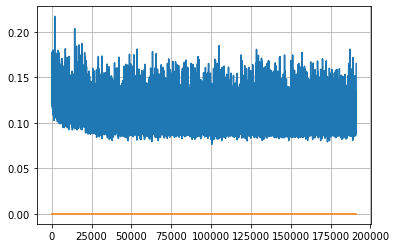

Epoch: 490, iteration 0, loss 0.10344016551971436, cov_diff 0.41266872376494956 cov_diff train 0.4127864672404626
Epoch: 490, iteration 1, loss 0.09251022338867188, cov_diff 0.4147587361753028 cov_diff train 0.41438505870292686
Epoch: 490, iteration 2, loss 0.10771501064300537, cov_diff 0.40641941048395874 cov_diff train 0.4059044591569207
Epoch: 490, iteration 3, loss 0.09837362170219421, cov_diff 0.4119144323793413 cov_diff train 0.41075976330888986
Epoch: 490, iteration 4, loss 0.09337574243545532, cov_diff 0.3951517631440668 cov_diff train 0.3945956795214041
Epoch: 490, iteration 5, loss 0.10508447885513306, cov_diff 0.40377896958770876 cov_diff train 0.4033555428517267
Epoch: 490, iteration 6, loss 0.10273915529251099, cov_diff 0.41459934269726095 cov_diff train 0.41304018173026724
Epoch: 490, iteration 7, loss 0.08944240212440491, cov_diff 0.41288031605741876 cov_diff train 0.41182546827551847
Epoch: 490, iteration 8, loss 0.1051020622253418, cov_diff 0.40242368786027305 cov_diff

Epoch: 490, iteration 77, loss 0.09720343351364136, cov_diff 0.39541489858767015 cov_diff train 0.39519729827838673
Epoch: 490, iteration 78, loss 0.10075655579566956, cov_diff 0.4162835169510653 cov_diff train 0.41601427651238765
Epoch: 490, iteration 79, loss 0.10063078999519348, cov_diff 0.4077736404070883 cov_diff train 0.4071425500432731
Epoch: 490, iteration 80, loss 0.10153362154960632, cov_diff 0.41853712022497397 cov_diff train 0.41901840870702955
Epoch: 490, iteration 81, loss 0.10307925939559937, cov_diff 0.41736455304912085 cov_diff train 0.4183025858585091
Epoch: 490, iteration 82, loss 0.09383183717727661, cov_diff 0.4054817595232979 cov_diff train 0.4053468750934629
Epoch: 490, iteration 83, loss 0.10442891716957092, cov_diff 0.40909802785762056 cov_diff train 0.40903700958655487
Epoch: 490, iteration 84, loss 0.0949675440788269, cov_diff 0.409796430048259 cov_diff train 0.40970852733373947
Epoch: 490, iteration 85, loss 0.09687885642051697, cov_diff 0.4200162684867364 c

Epoch: 490, iteration 154, loss 0.10065248608589172, cov_diff 0.41913160964056323 cov_diff train 0.4183946167685839
Epoch: 490, iteration 155, loss 0.1012650728225708, cov_diff 0.41521125383596663 cov_diff train 0.4156752319528246
Epoch: 490, iteration 156, loss 0.10927325487136841, cov_diff 0.41570711199105215 cov_diff train 0.41462061422213886
Epoch: 490, iteration 157, loss 0.09833532571792603, cov_diff 0.40286237292091165 cov_diff train 0.40214129624897615
Epoch: 490, iteration 158, loss 0.109270840883255, cov_diff 0.41162371738961157 cov_diff train 0.41102400257625166
Epoch: 490, iteration 159, loss 0.10067319869995117, cov_diff 0.4152635449551402 cov_diff train 0.41457937295219244
Epoch: 490, iteration 160, loss 0.10449853539466858, cov_diff 0.40097841167927945 cov_diff train 0.40099047336329335
Epoch: 490, iteration 161, loss 0.10428062081336975, cov_diff 0.4062877063284377 cov_diff train 0.4060412659670706
Epoch: 490, iteration 162, loss 0.09463706612586975, cov_diff 0.41427738

Epoch: 490, iteration 228, loss 0.11895996332168579, cov_diff 0.39740012848480016 cov_diff train 0.3972340367599322
Epoch: 490, iteration 229, loss 0.09585809707641602, cov_diff 0.4116602305485155 cov_diff train 0.41052054702820384
Epoch: 490, iteration 230, loss 0.10041657090187073, cov_diff 0.41978680357154463 cov_diff train 0.41889782685910887
Epoch: 490, iteration 231, loss 0.1093437671661377, cov_diff 0.41858649505019124 cov_diff train 0.4182669974048258
Epoch: 490, iteration 232, loss 0.10221293568611145, cov_diff 0.42640865024212976 cov_diff train 0.42655605299655386
Epoch: 490, iteration 233, loss 0.11866030097007751, cov_diff 0.4222726540771059 cov_diff train 0.42124601056685435
Epoch: 490, iteration 234, loss 0.12458211183547974, cov_diff 0.42620738514845746 cov_diff train 0.4243868512625179
Epoch: 490, iteration 235, loss 0.09511801600456238, cov_diff 0.403042309325565 cov_diff train 0.4027980286364668
Epoch: 490, iteration 236, loss 0.10667780041694641, cov_diff 0.408983084

Epoch: 490, iteration 306, loss 0.08944624662399292, cov_diff 0.42088370349226456 cov_diff train 0.419277339770774
Epoch: 490, iteration 307, loss 0.09671664237976074, cov_diff 0.41931982622679964 cov_diff train 0.4188423429621502
Epoch: 490, iteration 308, loss 0.10080075263977051, cov_diff 0.39886886709441766 cov_diff train 0.39745132429823876
Epoch: 490, iteration 309, loss 0.12119406461715698, cov_diff 0.4108765890023811 cov_diff train 0.409758362646124
Epoch: 490, iteration 310, loss 0.11252433061599731, cov_diff 0.40576093866004864 cov_diff train 0.405902380500945
Epoch: 490, iteration 311, loss 0.09687510132789612, cov_diff 0.41416856794254764 cov_diff train 0.4140298451045481
Epoch: 490, iteration 312, loss 0.10481256246566772, cov_diff 0.40861975553687224 cov_diff train 0.40839221466119063
Epoch: 490, iteration 313, loss 0.10562264919281006, cov_diff 0.41364273222867803 cov_diff train 0.41298780992843376
Epoch: 490, iteration 314, loss 0.11026632785797119, cov_diff 0.400770420

Epoch: 490, iteration 384, loss 0.09856408834457397, cov_diff 0.407585393372194 cov_diff train 0.40712757022109647
Epoch: 490, iteration 385, loss 0.10106471180915833, cov_diff 0.39883052304107236 cov_diff train 0.3982876813269254
Epoch: 490, iteration 386, loss 0.09949687123298645, cov_diff 0.4194366924466213 cov_diff train 0.4187560083147884
Epoch: 490, iteration 387, loss 0.09226441383361816, cov_diff 0.4096335693056179 cov_diff train 0.4093050761843776
Epoch: 490, iteration 388, loss 0.10778388381004333, cov_diff 0.4149132785984313 cov_diff train 0.4143908435824133
Epoch: 490, iteration 389, loss 0.10238486528396606, cov_diff 0.4085291077168825 cov_diff train 0.4079382410476837
Epoch: 490, iteration 390, loss 0.1430257260799408, cov_diff 0.4650752346996702 cov_diff train 0.46542192304130064


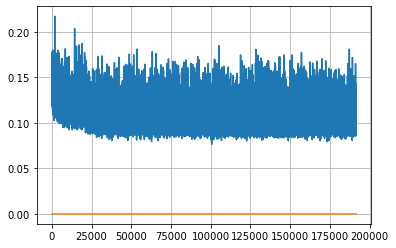

Epoch: 491, iteration 0, loss 0.11003315448760986, cov_diff 0.4066052430617786 cov_diff train 0.406508443309545
Epoch: 491, iteration 1, loss 0.1077217161655426, cov_diff 0.4143478974849973 cov_diff train 0.4137930154040117
Epoch: 491, iteration 2, loss 0.10491320490837097, cov_diff 0.41936819936131164 cov_diff train 0.41893067186858646
Epoch: 491, iteration 3, loss 0.10332131385803223, cov_diff 0.4007089963845561 cov_diff train 0.4006510622561963
Epoch: 491, iteration 4, loss 0.1092369556427002, cov_diff 0.3962574525796376 cov_diff train 0.39547705322165466
Epoch: 491, iteration 5, loss 0.1087142825126648, cov_diff 0.4091307165236296 cov_diff train 0.4092077672617591
Epoch: 491, iteration 6, loss 0.11718836426734924, cov_diff 0.400953180870504 cov_diff train 0.4007178508729824
Epoch: 491, iteration 7, loss 0.10235252976417542, cov_diff 0.4033698152979637 cov_diff train 0.4029438922738003
Epoch: 491, iteration 8, loss 0.09687656164169312, cov_diff 0.4168224493759172 cov_diff train 0.41

Epoch: 491, iteration 78, loss 0.10466524958610535, cov_diff 0.4029331604145174 cov_diff train 0.40390656324479607
Epoch: 491, iteration 79, loss 0.10441011190414429, cov_diff 0.3966302882597591 cov_diff train 0.3964317774207287
Epoch: 491, iteration 80, loss 0.1091926097869873, cov_diff 0.4030865943888316 cov_diff train 0.4023219232945308
Epoch: 491, iteration 81, loss 0.09227374196052551, cov_diff 0.39929008984341613 cov_diff train 0.39851949944921217
Epoch: 491, iteration 82, loss 0.10512495040893555, cov_diff 0.43383266388818575 cov_diff train 0.43326240197254917
Epoch: 491, iteration 83, loss 0.1094607412815094, cov_diff 0.40323171554022325 cov_diff train 0.40156952864170836
Epoch: 491, iteration 84, loss 0.10063213109970093, cov_diff 0.41409937281579695 cov_diff train 0.41324718440047775
Epoch: 491, iteration 85, loss 0.09500119090080261, cov_diff 0.40818480475384655 cov_diff train 0.40759987384413393
Epoch: 491, iteration 86, loss 0.107674241065979, cov_diff 0.41891414517338277 

Epoch: 491, iteration 154, loss 0.09810465574264526, cov_diff 0.42501267921977987 cov_diff train 0.4247339780580783
Epoch: 491, iteration 155, loss 0.09620371460914612, cov_diff 0.4078586517577287 cov_diff train 0.40775827274417054
Epoch: 491, iteration 156, loss 0.10073187947273254, cov_diff 0.4181404204077349 cov_diff train 0.4180683077221648
Epoch: 491, iteration 157, loss 0.12124073505401611, cov_diff 0.4054682079564087 cov_diff train 0.4043897473926303
Epoch: 491, iteration 158, loss 0.09260430932044983, cov_diff 0.411241362462267 cov_diff train 0.4113617475582277
Epoch: 491, iteration 159, loss 0.11161747574806213, cov_diff 0.41812964867257674 cov_diff train 0.41648935506134743
Epoch: 491, iteration 160, loss 0.11324915289878845, cov_diff 0.4145994591539403 cov_diff train 0.41403678778636066
Epoch: 491, iteration 161, loss 0.10431709885597229, cov_diff 0.4142475006089725 cov_diff train 0.4139846880236321
Epoch: 491, iteration 162, loss 0.11543068289756775, cov_diff 0.420141014099

Epoch: 491, iteration 232, loss 0.09701979160308838, cov_diff 0.40905896755453736 cov_diff train 0.408220209130092
Epoch: 491, iteration 233, loss 0.10889589786529541, cov_diff 0.4089349548769596 cov_diff train 0.40831877228672836
Epoch: 491, iteration 234, loss 0.10010024905204773, cov_diff 0.40289069021425555 cov_diff train 0.40293260823300486
Epoch: 491, iteration 235, loss 0.10357466340065002, cov_diff 0.40372666785614314 cov_diff train 0.40332602793018
Epoch: 491, iteration 236, loss 0.11192283034324646, cov_diff 0.42796852783500156 cov_diff train 0.4268247887085486
Epoch: 491, iteration 237, loss 0.10646235942840576, cov_diff 0.40816760339153324 cov_diff train 0.40760839565655227
Epoch: 491, iteration 238, loss 0.10487145185470581, cov_diff 0.4219102245276292 cov_diff train 0.42155441912170766
Epoch: 491, iteration 239, loss 0.10462403297424316, cov_diff 0.41746697202485933 cov_diff train 0.41775442917586453
Epoch: 491, iteration 240, loss 0.09821441769599915, cov_diff 0.41040479

Epoch: 491, iteration 309, loss 0.09606042504310608, cov_diff 0.4094508365530027 cov_diff train 0.40979789919401005
Epoch: 491, iteration 310, loss 0.10491812229156494, cov_diff 0.3991260081668703 cov_diff train 0.3989194632465198
Epoch: 491, iteration 311, loss 0.0926252007484436, cov_diff 0.4012154630478472 cov_diff train 0.40067810383906677
Epoch: 491, iteration 312, loss 0.10089349746704102, cov_diff 0.40847171579269514 cov_diff train 0.4079843851873798
Epoch: 491, iteration 313, loss 0.11000150442123413, cov_diff 0.4184094829728298 cov_diff train 0.41786913242188967
Epoch: 491, iteration 314, loss 0.10685402154922485, cov_diff 0.4088114522971464 cov_diff train 0.40797202376472874
Epoch: 491, iteration 315, loss 0.10215574502944946, cov_diff 0.4131421502138014 cov_diff train 0.41233163061021527
Epoch: 491, iteration 316, loss 0.11356964707374573, cov_diff 0.41837781041732974 cov_diff train 0.41693300371420194
Epoch: 491, iteration 317, loss 0.09969142079353333, cov_diff 0.402768138

Epoch: 491, iteration 387, loss 0.09470507502555847, cov_diff 0.40826128089253455 cov_diff train 0.4076534039659519
Epoch: 491, iteration 388, loss 0.09865233302116394, cov_diff 0.41122390945724924 cov_diff train 0.41042853794958367
Epoch: 491, iteration 389, loss 0.10533773899078369, cov_diff 0.4100785274078369 cov_diff train 0.41010598616635213
Epoch: 491, iteration 390, loss 0.1623125970363617, cov_diff 0.4430557199413412 cov_diff train 0.44215984031723804


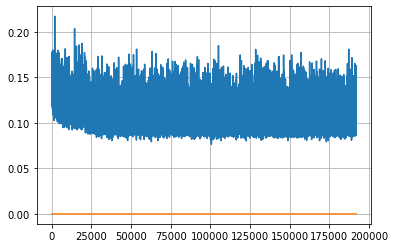

Epoch: 492, iteration 0, loss 0.09587731957435608, cov_diff 0.4190149214507593 cov_diff train 0.41782793931815393
Epoch: 492, iteration 1, loss 0.09930422902107239, cov_diff 0.4108823924632693 cov_diff train 0.410252790077405
Epoch: 492, iteration 2, loss 0.0989534854888916, cov_diff 0.40056972003450286 cov_diff train 0.4013763245762184
Epoch: 492, iteration 3, loss 0.10119849443435669, cov_diff 0.421478405513329 cov_diff train 0.42020589680171055
Epoch: 492, iteration 4, loss 0.10687759518623352, cov_diff 0.4098913445599617 cov_diff train 0.4093833563599749
Epoch: 492, iteration 5, loss 0.10089462995529175, cov_diff 0.3956161575499732 cov_diff train 0.395348505284556
Epoch: 492, iteration 6, loss 0.10203999280929565, cov_diff 0.39883639964402545 cov_diff train 0.3990065578158271
Epoch: 492, iteration 7, loss 0.09933680295944214, cov_diff 0.40288423391798256 cov_diff train 0.40275454009341277
Epoch: 492, iteration 8, loss 0.10984790325164795, cov_diff 0.4145026660694021 cov_diff train 

Epoch: 492, iteration 77, loss 0.11875507235527039, cov_diff 0.4138267448422639 cov_diff train 0.41327702772057
Epoch: 492, iteration 78, loss 0.10000410676002502, cov_diff 0.40909920133282235 cov_diff train 0.40875648486472227
Epoch: 492, iteration 79, loss 0.10882428288459778, cov_diff 0.42256092733377326 cov_diff train 0.42196396235374345
Epoch: 492, iteration 80, loss 0.1120772659778595, cov_diff 0.4122439414707495 cov_diff train 0.4116640294245913
Epoch: 492, iteration 81, loss 0.10682421922683716, cov_diff 0.41070945566855077 cov_diff train 0.41023877336944226
Epoch: 492, iteration 82, loss 0.0960066020488739, cov_diff 0.408533996302189 cov_diff train 0.4079109536701201
Epoch: 492, iteration 83, loss 0.10323962569236755, cov_diff 0.4083809566826216 cov_diff train 0.40852322807001196
Epoch: 492, iteration 84, loss 0.09852355718612671, cov_diff 0.42133924643751064 cov_diff train 0.42074297400371763
Epoch: 492, iteration 85, loss 0.09587502479553223, cov_diff 0.4164374665242593 cov_

Epoch: 492, iteration 155, loss 0.1071060299873352, cov_diff 0.40164224228260603 cov_diff train 0.40068238188930005
Epoch: 492, iteration 156, loss 0.10101732611656189, cov_diff 0.4156940483045679 cov_diff train 0.415339744038487
Epoch: 492, iteration 157, loss 0.11090058088302612, cov_diff 0.40193671878386766 cov_diff train 0.4003315789326614
Epoch: 492, iteration 158, loss 0.09343796968460083, cov_diff 0.41047256861383613 cov_diff train 0.4089859978788213
Epoch: 492, iteration 159, loss 0.10155516862869263, cov_diff 0.4168244739146458 cov_diff train 0.4164340118752239
Epoch: 492, iteration 160, loss 0.09590423107147217, cov_diff 0.40899923730694404 cov_diff train 0.4071496090309556
Epoch: 492, iteration 161, loss 0.09857329726219177, cov_diff 0.4068643895769366 cov_diff train 0.4048917263600345
Epoch: 492, iteration 162, loss 0.11249187588691711, cov_diff 0.40786480090925925 cov_diff train 0.40673892134045536
Epoch: 492, iteration 163, loss 0.10565584897994995, cov_diff 0.40967798661

Epoch: 492, iteration 233, loss 0.11547273397445679, cov_diff 0.4134451243275564 cov_diff train 0.4132648543902167
Epoch: 492, iteration 234, loss 0.09494450688362122, cov_diff 0.4201473792738146 cov_diff train 0.419353150478662
Epoch: 492, iteration 235, loss 0.10089534521102905, cov_diff 0.4039368082351843 cov_diff train 0.40314521509350465
Epoch: 492, iteration 236, loss 0.1071535050868988, cov_diff 0.3873767916296778 cov_diff train 0.3887087390128377
Epoch: 492, iteration 237, loss 0.11376848816871643, cov_diff 0.41029643285091083 cov_diff train 0.40969630270940205
Epoch: 492, iteration 238, loss 0.09349220991134644, cov_diff 0.4213708910925876 cov_diff train 0.4215852105939779
Epoch: 492, iteration 239, loss 0.11089891195297241, cov_diff 0.3994893959564943 cov_diff train 0.3982131204755104
Epoch: 492, iteration 240, loss 0.09196597337722778, cov_diff 0.392042981673975 cov_diff train 0.39110384187923786
Epoch: 492, iteration 241, loss 0.09817811846733093, cov_diff 0.397062726842490

Epoch: 492, iteration 310, loss 0.0994701087474823, cov_diff 0.4206085690280977 cov_diff train 0.41853116766335213
Epoch: 492, iteration 311, loss 0.10932403802871704, cov_diff 0.40703234411389094 cov_diff train 0.4062535270377054
Epoch: 492, iteration 312, loss 0.09891510009765625, cov_diff 0.41549227375503417 cov_diff train 0.4144116949017406
Epoch: 492, iteration 313, loss 0.09839868545532227, cov_diff 0.40608141250934593 cov_diff train 0.40559131854878455
Epoch: 492, iteration 314, loss 0.08792203664779663, cov_diff 0.4098002187374257 cov_diff train 0.4084582160720648
Epoch: 492, iteration 315, loss 0.10398784279823303, cov_diff 0.4085917897145615 cov_diff train 0.4084471437109918
Epoch: 492, iteration 316, loss 0.09464061260223389, cov_diff 0.40036823256950876 cov_diff train 0.3993854747693947
Epoch: 492, iteration 317, loss 0.10921531915664673, cov_diff 0.4242279662164204 cov_diff train 0.4220410914569023
Epoch: 492, iteration 318, loss 0.0947306752204895, cov_diff 0.423124927111

Epoch: 492, iteration 388, loss 0.10201629996299744, cov_diff 0.404579740605394 cov_diff train 0.40372544189331533
Epoch: 492, iteration 389, loss 0.09861546754837036, cov_diff 0.4164567648332397 cov_diff train 0.4144626960387607
Epoch: 492, iteration 390, loss 0.13891887664794922, cov_diff 0.4625479868827829 cov_diff train 0.4610448331169213


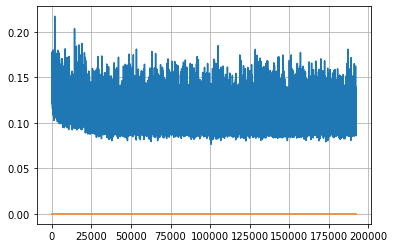

Epoch: 493, iteration 0, loss 0.10496589541435242, cov_diff 0.40568093573099984 cov_diff train 0.40368709841361466
Epoch: 493, iteration 1, loss 0.1082955002784729, cov_diff 0.4140591895269377 cov_diff train 0.4135572511049058
Epoch: 493, iteration 2, loss 0.11075767874717712, cov_diff 0.41348920966412217 cov_diff train 0.41148223019686864
Epoch: 493, iteration 3, loss 0.09962731599807739, cov_diff 0.4180942840655665 cov_diff train 0.4169261155117547
Epoch: 493, iteration 4, loss 0.10547786951065063, cov_diff 0.41866371068024494 cov_diff train 0.41776600363197824
Epoch: 493, iteration 5, loss 0.09682950377464294, cov_diff 0.40708094211394913 cov_diff train 0.40608831877852214
Epoch: 493, iteration 6, loss 0.10738196969032288, cov_diff 0.42012914246886046 cov_diff train 0.4187378600205166
Epoch: 493, iteration 7, loss 0.11277809739112854, cov_diff 0.4047108598593088 cov_diff train 0.4045678987121229
Epoch: 493, iteration 8, loss 0.10630583763122559, cov_diff 0.4178377122841793 cov_diff 

Epoch: 493, iteration 76, loss 0.11732688546180725, cov_diff 0.4096881519232228 cov_diff train 0.4074514833298301
Epoch: 493, iteration 77, loss 0.1058773398399353, cov_diff 0.4129119480444399 cov_diff train 0.4117261712940129
Epoch: 493, iteration 78, loss 0.10106790065765381, cov_diff 0.40484329524599927 cov_diff train 0.4030304896284016
Epoch: 493, iteration 79, loss 0.11004424095153809, cov_diff 0.4131385321021633 cov_diff train 0.41358466230700724
Epoch: 493, iteration 80, loss 0.10859468579292297, cov_diff 0.4150876510025799 cov_diff train 0.41397057022032796
Epoch: 493, iteration 81, loss 0.10838574171066284, cov_diff 0.3993759267384838 cov_diff train 0.399461930379513
Epoch: 493, iteration 82, loss 0.09886711835861206, cov_diff 0.4045094625640257 cov_diff train 0.40348424158466584
Epoch: 493, iteration 83, loss 0.10838016867637634, cov_diff 0.42140679663525155 cov_diff train 0.4210875804713131
Epoch: 493, iteration 84, loss 0.09823790192604065, cov_diff 0.3989631585212423 cov_d

Epoch: 493, iteration 153, loss 0.1075257658958435, cov_diff 0.4112680734026104 cov_diff train 0.41103139765207053
Epoch: 493, iteration 154, loss 0.10718843340873718, cov_diff 0.40753952967979074 cov_diff train 0.40661298035531745
Epoch: 493, iteration 155, loss 0.10780125856399536, cov_diff 0.4244598879735393 cov_diff train 0.42270825765366105
Epoch: 493, iteration 156, loss 0.08684173226356506, cov_diff 0.4215170985402847 cov_diff train 0.42068321842231465
Epoch: 493, iteration 157, loss 0.09909301996231079, cov_diff 0.4057964733269753 cov_diff train 0.40465067732160465
Epoch: 493, iteration 158, loss 0.1103137731552124, cov_diff 0.4048806612908799 cov_diff train 0.4047298589180124
Epoch: 493, iteration 159, loss 0.09324193000793457, cov_diff 0.3974536459305331 cov_diff train 0.39681341378130314
Epoch: 493, iteration 160, loss 0.09786361455917358, cov_diff 0.39727564915717256 cov_diff train 0.3972966011554363
Epoch: 493, iteration 161, loss 0.11020931601524353, cov_diff 0.4112702315

Epoch: 493, iteration 230, loss 0.1100631058216095, cov_diff 0.4132839324964622 cov_diff train 0.4124734556682849
Epoch: 493, iteration 231, loss 0.10696053504943848, cov_diff 0.40590645415866194 cov_diff train 0.4052254002567346
Epoch: 493, iteration 232, loss 0.1052941381931305, cov_diff 0.39812281355554074 cov_diff train 0.39745788086939354
Epoch: 493, iteration 233, loss 0.100748211145401, cov_diff 0.400763866000248 cov_diff train 0.39993683804533997
Epoch: 493, iteration 234, loss 0.10380768775939941, cov_diff 0.4027241380343827 cov_diff train 0.40295342290407765
Epoch: 493, iteration 235, loss 0.10371807217597961, cov_diff 0.39844819513243224 cov_diff train 0.3981018558861847
Epoch: 493, iteration 236, loss 0.0989643931388855, cov_diff 0.40673642098664137 cov_diff train 0.40652451301092246
Epoch: 493, iteration 237, loss 0.09605050086975098, cov_diff 0.4204647225201605 cov_diff train 0.42060271782540415
Epoch: 493, iteration 238, loss 0.10896235704421997, cov_diff 0.4187836819398

Epoch: 493, iteration 307, loss 0.10655161738395691, cov_diff 0.407778772940126 cov_diff train 0.4069352627056737
Epoch: 493, iteration 308, loss 0.09591811895370483, cov_diff 0.4151825517183688 cov_diff train 0.4144339973720886
Epoch: 493, iteration 309, loss 0.10332533717155457, cov_diff 0.4198623094464083 cov_diff train 0.4185046384960725
Epoch: 493, iteration 310, loss 0.10524237155914307, cov_diff 0.41146136047519116 cov_diff train 0.409530594819221
Epoch: 493, iteration 311, loss 0.1040860116481781, cov_diff 0.41087784945367883 cov_diff train 0.4093912579974494
Epoch: 493, iteration 312, loss 0.0913965106010437, cov_diff 0.40128819700870816 cov_diff train 0.4003372012664875
Epoch: 493, iteration 313, loss 0.1127936840057373, cov_diff 0.4031845229926731 cov_diff train 0.4018669660575979
Epoch: 493, iteration 314, loss 0.10739636421203613, cov_diff 0.3909755965906426 cov_diff train 0.38976955051403406
Epoch: 493, iteration 315, loss 0.10672450065612793, cov_diff 0.41925417513074514

Epoch: 493, iteration 386, loss 0.10185655951499939, cov_diff 0.39215521964706446 cov_diff train 0.3910397708225995
Epoch: 493, iteration 387, loss 0.0888599157333374, cov_diff 0.4068924620155217 cov_diff train 0.40639861056200505
Epoch: 493, iteration 388, loss 0.12075990438461304, cov_diff 0.41530553737797055 cov_diff train 0.41431974054417225
Epoch: 493, iteration 389, loss 0.09624460339546204, cov_diff 0.40661768195375125 cov_diff train 0.40524641305239917
Epoch: 493, iteration 390, loss 0.16417810320854187, cov_diff 0.46238958868551927 cov_diff train 0.45875369373838304


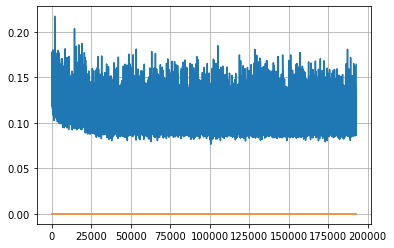

Epoch: 494, iteration 0, loss 0.09850656986236572, cov_diff 0.4159711232034746 cov_diff train 0.41597589734635587
Epoch: 494, iteration 1, loss 0.10237807035446167, cov_diff 0.41316300736688133 cov_diff train 0.41255667082263625
Epoch: 494, iteration 2, loss 0.10871490836143494, cov_diff 0.40046843936569926 cov_diff train 0.39935829623343233
Epoch: 494, iteration 3, loss 0.09710818529129028, cov_diff 0.39851720921050754 cov_diff train 0.3987207915423696
Epoch: 494, iteration 4, loss 0.10519072413444519, cov_diff 0.4150767645714892 cov_diff train 0.41507872978437743
Epoch: 494, iteration 5, loss 0.1131085455417633, cov_diff 0.3981780599840639 cov_diff train 0.39869432156458295
Epoch: 494, iteration 6, loss 0.10699009895324707, cov_diff 0.40764860414056625 cov_diff train 0.4064001340403555
Epoch: 494, iteration 7, loss 0.09696435928344727, cov_diff 0.4186348481274533 cov_diff train 0.41854395688360485
Epoch: 494, iteration 8, loss 0.09830373525619507, cov_diff 0.41185452369972436 cov_dif

Epoch: 494, iteration 77, loss 0.11387252807617188, cov_diff 0.41303841103068095 cov_diff train 0.4123498796746256
Epoch: 494, iteration 78, loss 0.1062050461769104, cov_diff 0.40232871711832746 cov_diff train 0.40165828492261274
Epoch: 494, iteration 79, loss 0.10234969854354858, cov_diff 0.4084643947270883 cov_diff train 0.4080661876184824
Epoch: 494, iteration 80, loss 0.10156282782554626, cov_diff 0.41860606178098403 cov_diff train 0.4170391595490412
Epoch: 494, iteration 81, loss 0.10569411516189575, cov_diff 0.4128607540057287 cov_diff train 0.4127509124848102
Epoch: 494, iteration 82, loss 0.10380303859710693, cov_diff 0.40557962376039586 cov_diff train 0.4055897386859586
Epoch: 494, iteration 83, loss 0.1044275164604187, cov_diff 0.41776657013035406 cov_diff train 0.4170813699222571
Epoch: 494, iteration 84, loss 0.09308600425720215, cov_diff 0.4112652431053415 cov_diff train 0.4109878009995758
Epoch: 494, iteration 85, loss 0.10171231627464294, cov_diff 0.3930028700864569 cov_

Epoch: 494, iteration 155, loss 0.1081017255783081, cov_diff 0.41545247518644485 cov_diff train 0.4133374352330532
Epoch: 494, iteration 156, loss 0.09686845541000366, cov_diff 0.41577213341901964 cov_diff train 0.4151297372527072
Epoch: 494, iteration 157, loss 0.1018323302268982, cov_diff 0.4230198622406856 cov_diff train 0.42258082215022386
Epoch: 494, iteration 158, loss 0.09195435047149658, cov_diff 0.4178076347547375 cov_diff train 0.4170358374865039
Epoch: 494, iteration 159, loss 0.11410596966743469, cov_diff 0.41046185540985847 cov_diff train 0.4091346956861034
Epoch: 494, iteration 160, loss 0.0969347357749939, cov_diff 0.4123871966060097 cov_diff train 0.4117706292125808
Epoch: 494, iteration 161, loss 0.10878729820251465, cov_diff 0.4124608604509392 cov_diff train 0.4121520446062587
Epoch: 494, iteration 162, loss 0.10637253522872925, cov_diff 0.4142462334741345 cov_diff train 0.41276508635861947
Epoch: 494, iteration 163, loss 0.1056888997554779, cov_diff 0.408593299442064

Epoch: 494, iteration 237, loss 0.10668426752090454, cov_diff 0.4177137836866309 cov_diff train 0.4171527006525406
Epoch: 494, iteration 238, loss 0.10173752903938293, cov_diff 0.40551762423053556 cov_diff train 0.4057030379005955
Epoch: 494, iteration 239, loss 0.10082435607910156, cov_diff 0.4155544583423443 cov_diff train 0.41433577377444253
Epoch: 494, iteration 240, loss 0.09593486785888672, cov_diff 0.4049953651714644 cov_diff train 0.40362065547802706
Epoch: 494, iteration 241, loss 0.10614252090454102, cov_diff 0.4135673252659615 cov_diff train 0.4123044704121566
Epoch: 494, iteration 242, loss 0.09703117609024048, cov_diff 0.41662432031897106 cov_diff train 0.4157638314520847
Epoch: 494, iteration 243, loss 0.11962008476257324, cov_diff 0.419670818912412 cov_diff train 0.41850199599366794
Epoch: 494, iteration 244, loss 0.09120243787765503, cov_diff 0.40808677813705696 cov_diff train 0.40754670788694064
Epoch: 494, iteration 245, loss 0.097654789686203, cov_diff 0.416554624990

Epoch: 494, iteration 317, loss 0.09931224584579468, cov_diff 0.4078568464891661 cov_diff train 0.4070370203153996
Epoch: 494, iteration 318, loss 0.09781432151794434, cov_diff 0.4192095138427381 cov_diff train 0.4177346095476573
Epoch: 494, iteration 319, loss 0.09167701005935669, cov_diff 0.421291791691385 cov_diff train 0.4215419153802929
Epoch: 494, iteration 320, loss 0.11061835289001465, cov_diff 0.40863114838940023 cov_diff train 0.40860854165343435
Epoch: 494, iteration 321, loss 0.09089159965515137, cov_diff 0.4174158390935299 cov_diff train 0.4169412950450437
Epoch: 494, iteration 322, loss 0.11283183097839355, cov_diff 0.40486688430090073 cov_diff train 0.4028000432722974
Epoch: 494, iteration 323, loss 0.11800163984298706, cov_diff 0.42232659205857015 cov_diff train 0.42213123714595074
Epoch: 494, iteration 324, loss 0.10305526852607727, cov_diff 0.4126634311563634 cov_diff train 0.4133301300882414
Epoch: 494, iteration 325, loss 0.09740591049194336, cov_diff 0.397818396071

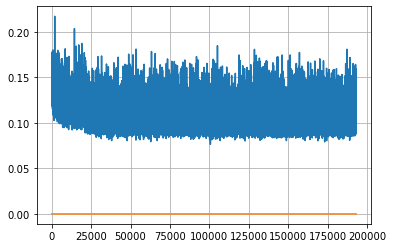

Epoch: 495, iteration 0, loss 0.10302042961120605, cov_diff 0.40265752690413353 cov_diff train 0.40208138414998384
Epoch: 495, iteration 1, loss 0.09427565336227417, cov_diff 0.4194899898446843 cov_diff train 0.4182528709393082
Epoch: 495, iteration 2, loss 0.11189049482345581, cov_diff 0.4116195462893862 cov_diff train 0.40878438949178153
Epoch: 495, iteration 3, loss 0.09491822123527527, cov_diff 0.4241776957256991 cov_diff train 0.42295161042675056
Epoch: 495, iteration 4, loss 0.10858815908432007, cov_diff 0.40531709516620634 cov_diff train 0.40442468480586374
Epoch: 495, iteration 5, loss 0.09881648421287537, cov_diff 0.41171992064247215 cov_diff train 0.4104922376347111
Epoch: 495, iteration 6, loss 0.09442156553268433, cov_diff 0.4064439399832465 cov_diff train 0.4050894866720613
Epoch: 495, iteration 7, loss 0.10536792874336243, cov_diff 0.39624674482794936 cov_diff train 0.39576753799579606
Epoch: 495, iteration 8, loss 0.0984005331993103, cov_diff 0.4106358411751756 cov_diff 

Epoch: 495, iteration 81, loss 0.11236244440078735, cov_diff 0.4248480858384212 cov_diff train 0.4237729247458234
Epoch: 495, iteration 82, loss 0.10063514113426208, cov_diff 0.4022200711770698 cov_diff train 0.40110977922866875
Epoch: 495, iteration 83, loss 0.10459649562835693, cov_diff 0.4084433047362494 cov_diff train 0.40741114271830536
Epoch: 495, iteration 84, loss 0.1077570915222168, cov_diff 0.3956758189971799 cov_diff train 0.39396830976127806
Epoch: 495, iteration 85, loss 0.10152527689933777, cov_diff 0.4047363482048082 cov_diff train 0.4042420367124416
Epoch: 495, iteration 86, loss 0.11319634318351746, cov_diff 0.4033543917671753 cov_diff train 0.4029619437131316
Epoch: 495, iteration 87, loss 0.09515741467475891, cov_diff 0.39952123393203887 cov_diff train 0.3991970987784546
Epoch: 495, iteration 88, loss 0.10128989815711975, cov_diff 0.39906552588390776 cov_diff train 0.39875779284653834
Epoch: 495, iteration 89, loss 0.10303589701652527, cov_diff 0.4120703694431255 cov

Epoch: 495, iteration 161, loss 0.09878712892532349, cov_diff 0.4089273474676228 cov_diff train 0.40658067790563684
Epoch: 495, iteration 162, loss 0.10274359583854675, cov_diff 0.40825477018710815 cov_diff train 0.4066588966103586
Epoch: 495, iteration 163, loss 0.10841691493988037, cov_diff 0.41548416739526073 cov_diff train 0.4140454006443556
Epoch: 495, iteration 164, loss 0.10844206809997559, cov_diff 0.3991438656536135 cov_diff train 0.3980999594243071
Epoch: 495, iteration 165, loss 0.10622358322143555, cov_diff 0.4024787474028615 cov_diff train 0.4025547704707539
Epoch: 495, iteration 166, loss 0.1167038083076477, cov_diff 0.4069674308992024 cov_diff train 0.4064432795243092
Epoch: 495, iteration 167, loss 0.1074056625366211, cov_diff 0.4131875102841879 cov_diff train 0.41236213190264487
Epoch: 495, iteration 168, loss 0.09532609581947327, cov_diff 0.4192659265798998 cov_diff train 0.41826747296694056
Epoch: 495, iteration 169, loss 0.101706862449646, cov_diff 0.400613835930469

Epoch: 495, iteration 242, loss 0.10609626770019531, cov_diff 0.4081174023034771 cov_diff train 0.40641715128260303
Epoch: 495, iteration 243, loss 0.10005992650985718, cov_diff 0.417835081313393 cov_diff train 0.41642363339643346
Epoch: 495, iteration 244, loss 0.11043575406074524, cov_diff 0.4017462290920478 cov_diff train 0.4013935770533933
Epoch: 495, iteration 245, loss 0.11139899492263794, cov_diff 0.4080885914084266 cov_diff train 0.4067953422243327
Epoch: 495, iteration 246, loss 0.09592688083648682, cov_diff 0.40484998181947746 cov_diff train 0.4043811985101601
Epoch: 495, iteration 247, loss 0.10306912660598755, cov_diff 0.41153982516477355 cov_diff train 0.41088401639371663
Epoch: 495, iteration 248, loss 0.10945504903793335, cov_diff 0.4073498898108689 cov_diff train 0.4069029987578968
Epoch: 495, iteration 249, loss 0.09837323427200317, cov_diff 0.39238861803879427 cov_diff train 0.3924896311773121
Epoch: 495, iteration 250, loss 0.09653261303901672, cov_diff 0.40943104863

Epoch: 495, iteration 323, loss 0.09766334295272827, cov_diff 0.4183215896477947 cov_diff train 0.4182221454606423
Epoch: 495, iteration 324, loss 0.10526600480079651, cov_diff 0.40438952263460287 cov_diff train 0.4038535619282979
Epoch: 495, iteration 325, loss 0.1177070140838623, cov_diff 0.41912231242554704 cov_diff train 0.4180190584779696
Epoch: 495, iteration 326, loss 0.10182121396064758, cov_diff 0.41743996738867295 cov_diff train 0.41604947113254176
Epoch: 495, iteration 327, loss 0.10996335744857788, cov_diff 0.40596272457321403 cov_diff train 0.4048897067436709
Epoch: 495, iteration 328, loss 0.10138285160064697, cov_diff 0.41468562853325974 cov_diff train 0.413531772858331
Epoch: 495, iteration 329, loss 0.09815424680709839, cov_diff 0.4213244521652711 cov_diff train 0.42059472743486437
Epoch: 495, iteration 330, loss 0.09601256251335144, cov_diff 0.4120066913814407 cov_diff train 0.41104266618811486
Epoch: 495, iteration 331, loss 0.10503864288330078, cov_diff 0.4164892556

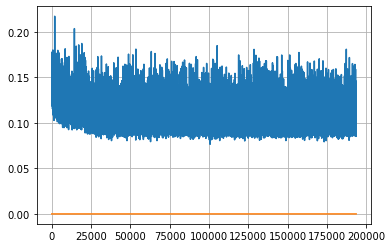

Epoch: 496, iteration 0, loss 0.08878472447395325, cov_diff 0.4082256327822822 cov_diff train 0.407186776566538
Epoch: 496, iteration 1, loss 0.10518285632133484, cov_diff 0.39862506389169394 cov_diff train 0.3985027306116872
Epoch: 496, iteration 2, loss 0.11676076054573059, cov_diff 0.41429511596434204 cov_diff train 0.4142397621268912
Epoch: 496, iteration 3, loss 0.11052566766738892, cov_diff 0.40158882426203635 cov_diff train 0.40186897321886583
Epoch: 496, iteration 4, loss 0.09223249554634094, cov_diff 0.4087428327174091 cov_diff train 0.40922584893151304
Epoch: 496, iteration 5, loss 0.1080247163772583, cov_diff 0.41667523294364206 cov_diff train 0.416255974570742
Epoch: 496, iteration 6, loss 0.09210669994354248, cov_diff 0.41542597928235286 cov_diff train 0.41515369842464617
Epoch: 496, iteration 7, loss 0.10679683089256287, cov_diff 0.40833828396177213 cov_diff train 0.40768385107458543
Epoch: 496, iteration 8, loss 0.09575134515762329, cov_diff 0.41679460853314465 cov_diff 

Epoch: 496, iteration 80, loss 0.11601999402046204, cov_diff 0.40597038332566204 cov_diff train 0.4051456679994187
Epoch: 496, iteration 81, loss 0.10759902000427246, cov_diff 0.42718084807217405 cov_diff train 0.4251030786647288
Epoch: 496, iteration 82, loss 0.096324622631073, cov_diff 0.4270081100628821 cov_diff train 0.4255385780159088
Epoch: 496, iteration 83, loss 0.11138531565666199, cov_diff 0.4137226170690677 cov_diff train 0.4116633918973376
Epoch: 496, iteration 84, loss 0.10872578620910645, cov_diff 0.406274686292326 cov_diff train 0.4041147965609273
Epoch: 496, iteration 85, loss 0.10606443881988525, cov_diff 0.429710163091274 cov_diff train 0.4287287935456152
Epoch: 496, iteration 86, loss 0.10091733932495117, cov_diff 0.4010396500277319 cov_diff train 0.3994158839864043
Epoch: 496, iteration 87, loss 0.10305044054985046, cov_diff 0.4015925612793316 cov_diff train 0.4002745065842305
Epoch: 496, iteration 88, loss 0.1007821261882782, cov_diff 0.40120059632267463 cov_diff t

Epoch: 496, iteration 159, loss 0.10647740960121155, cov_diff 0.3967730334401106 cov_diff train 0.3959051850736422
Epoch: 496, iteration 160, loss 0.0921056866645813, cov_diff 0.4073856807817526 cov_diff train 0.4059846954877087
Epoch: 496, iteration 161, loss 0.1084052324295044, cov_diff 0.4060980637502707 cov_diff train 0.4027196000037489
Epoch: 496, iteration 162, loss 0.09507659077644348, cov_diff 0.40696622950118216 cov_diff train 0.4058422287736738
Epoch: 496, iteration 163, loss 0.09861811995506287, cov_diff 0.4014900620917713 cov_diff train 0.3997207225482846
Epoch: 496, iteration 164, loss 0.09908190369606018, cov_diff 0.42147473951010805 cov_diff train 0.42139481840409043
Epoch: 496, iteration 165, loss 0.09492868185043335, cov_diff 0.4222630843354721 cov_diff train 0.421576353007726
Epoch: 496, iteration 166, loss 0.10007834434509277, cov_diff 0.39567274418608656 cov_diff train 0.39487102759119524
Epoch: 496, iteration 167, loss 0.09454205632209778, cov_diff 0.40574958551518

Epoch: 496, iteration 241, loss 0.0951000452041626, cov_diff 0.4114670229657201 cov_diff train 0.4113843342541284
Epoch: 496, iteration 242, loss 0.10659080743789673, cov_diff 0.41691309906467533 cov_diff train 0.4160191138012864
Epoch: 496, iteration 243, loss 0.09600716829299927, cov_diff 0.421013360935272 cov_diff train 0.4203258573771699
Epoch: 496, iteration 244, loss 0.09668868780136108, cov_diff 0.4039921734392279 cov_diff train 0.4034986069372347
Epoch: 496, iteration 245, loss 0.10226380825042725, cov_diff 0.4026420521551731 cov_diff train 0.401707901942294
Epoch: 496, iteration 246, loss 0.10219728946685791, cov_diff 0.420347496960354 cov_diff train 0.41990118584768266
Epoch: 496, iteration 247, loss 0.09725642204284668, cov_diff 0.4129771666826883 cov_diff train 0.41227775863022076
Epoch: 496, iteration 248, loss 0.11476904153823853, cov_diff 0.4309113787752503 cov_diff train 0.43051012599726873
Epoch: 496, iteration 249, loss 0.10564577579498291, cov_diff 0.4121576582131813

Epoch: 496, iteration 320, loss 0.11911925673484802, cov_diff 0.4147375234387291 cov_diff train 0.41260495380606854
Epoch: 496, iteration 321, loss 0.102480947971344, cov_diff 0.4079904420379474 cov_diff train 0.40640350389367297
Epoch: 496, iteration 322, loss 0.08827999234199524, cov_diff 0.40183214370066345 cov_diff train 0.40073296686751114
Epoch: 496, iteration 323, loss 0.09605720639228821, cov_diff 0.3963185721390843 cov_diff train 0.39702401904178175
Epoch: 496, iteration 324, loss 0.11020642518997192, cov_diff 0.42245033803940435 cov_diff train 0.4219781837762185
Epoch: 496, iteration 325, loss 0.110817551612854, cov_diff 0.39131998243128263 cov_diff train 0.39110709789040365
Epoch: 496, iteration 326, loss 0.10764363408088684, cov_diff 0.4067555600736121 cov_diff train 0.4056476838009245
Epoch: 496, iteration 327, loss 0.10473158955574036, cov_diff 0.4130387250965078 cov_diff train 0.4131423872837432
Epoch: 496, iteration 328, loss 0.10689359903335571, cov_diff 0.411006931352

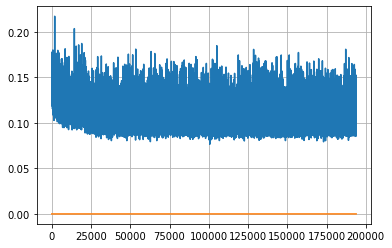

Epoch: 497, iteration 0, loss 0.10308995842933655, cov_diff 0.40289419160746553 cov_diff train 0.4017540821789663
Epoch: 497, iteration 1, loss 0.1007266640663147, cov_diff 0.4057032241162991 cov_diff train 0.40485615863736246
Epoch: 497, iteration 2, loss 0.10887908935546875, cov_diff 0.41501667264911646 cov_diff train 0.41429235305153655
Epoch: 497, iteration 3, loss 0.09810531139373779, cov_diff 0.4160721735928874 cov_diff train 0.41511621411786265
Epoch: 497, iteration 4, loss 0.1013433039188385, cov_diff 0.41735660830251664 cov_diff train 0.41727947119912084
Epoch: 497, iteration 5, loss 0.10318717360496521, cov_diff 0.40080284796736004 cov_diff train 0.40032955685559546
Epoch: 497, iteration 6, loss 0.09721043705940247, cov_diff 0.40426829213256227 cov_diff train 0.40412833920552854
Epoch: 497, iteration 7, loss 0.10183358192443848, cov_diff 0.3973977790865417 cov_diff train 0.39667207288711687
Epoch: 497, iteration 8, loss 0.10363426804542542, cov_diff 0.40823907362767275 cov_di

Epoch: 497, iteration 82, loss 0.101321280002594, cov_diff 0.4114674691502599 cov_diff train 0.41049916617241095
Epoch: 497, iteration 83, loss 0.11173602938652039, cov_diff 0.407571509720728 cov_diff train 0.4076976298842606
Epoch: 497, iteration 84, loss 0.10626983642578125, cov_diff 0.41357850402356267 cov_diff train 0.41227136042092555
Epoch: 497, iteration 85, loss 0.09591460227966309, cov_diff 0.39530401716447616 cov_diff train 0.39535808274449735
Epoch: 497, iteration 86, loss 0.10352551937103271, cov_diff 0.4129197993412405 cov_diff train 0.4122737669873987
Epoch: 497, iteration 87, loss 0.09431502223014832, cov_diff 0.4049036018601082 cov_diff train 0.40420274797629846
Epoch: 497, iteration 88, loss 0.09892958402633667, cov_diff 0.4055104745355016 cov_diff train 0.4051593524740391
Epoch: 497, iteration 89, loss 0.10314944386482239, cov_diff 0.4020610187007463 cov_diff train 0.4011810276824129
Epoch: 497, iteration 90, loss 0.09539821743965149, cov_diff 0.41512332631587845 cov_

Epoch: 497, iteration 161, loss 0.10622921586036682, cov_diff 0.4177967299487498 cov_diff train 0.4170260369490373
Epoch: 497, iteration 162, loss 0.0919625461101532, cov_diff 0.4195217887325055 cov_diff train 0.417472946426746
Epoch: 497, iteration 163, loss 0.09718677401542664, cov_diff 0.4090317177127757 cov_diff train 0.4085710527054854
Epoch: 497, iteration 164, loss 0.11034518480300903, cov_diff 0.41136634476326617 cov_diff train 0.41092374344782173
Epoch: 497, iteration 165, loss 0.10683509707450867, cov_diff 0.41135407575428135 cov_diff train 0.4108567273418354
Epoch: 497, iteration 166, loss 0.11231416463851929, cov_diff 0.40693969325296214 cov_diff train 0.4057782031785674
Epoch: 497, iteration 167, loss 0.09010708332061768, cov_diff 0.419472729932406 cov_diff train 0.418583220587471
Epoch: 497, iteration 168, loss 0.11073461174964905, cov_diff 0.40962079033919097 cov_diff train 0.4088363859966966
Epoch: 497, iteration 169, loss 0.10257923603057861, cov_diff 0.402433036809103

Epoch: 497, iteration 240, loss 0.10746192932128906, cov_diff 0.40468148377407137 cov_diff train 0.4031047877739467
Epoch: 497, iteration 241, loss 0.10525673627853394, cov_diff 0.3919270374129682 cov_diff train 0.3907029473458615
Epoch: 497, iteration 242, loss 0.10580047965049744, cov_diff 0.4104345984331683 cov_diff train 0.410535240967979
Epoch: 497, iteration 243, loss 0.09592357277870178, cov_diff 0.4231302160519439 cov_diff train 0.422061438276565
Epoch: 497, iteration 244, loss 0.100176602602005, cov_diff 0.40331897895657526 cov_diff train 0.4024806069178629
Epoch: 497, iteration 245, loss 0.09462714195251465, cov_diff 0.40722578141467813 cov_diff train 0.40642705351047387
Epoch: 497, iteration 246, loss 0.09169059991836548, cov_diff 0.408785311292744 cov_diff train 0.40870173645860847
Epoch: 497, iteration 247, loss 0.09656772017478943, cov_diff 0.41977960190953084 cov_diff train 0.41903024285370855
Epoch: 497, iteration 248, loss 0.09855067729949951, cov_diff 0.41257897685518

Epoch: 497, iteration 318, loss 0.10122808814048767, cov_diff 0.4033163669703591 cov_diff train 0.40152970588415515
Epoch: 497, iteration 319, loss 0.09842443466186523, cov_diff 0.4081977200959832 cov_diff train 0.4082247768183634
Epoch: 497, iteration 320, loss 0.12427890300750732, cov_diff 0.3948136801695494 cov_diff train 0.3937772197227081
Epoch: 497, iteration 321, loss 0.10585835576057434, cov_diff 0.4184801807135212 cov_diff train 0.41671908838242155
Epoch: 497, iteration 322, loss 0.11417222023010254, cov_diff 0.417247388571825 cov_diff train 0.41691609777191646
Epoch: 497, iteration 323, loss 0.11417984962463379, cov_diff 0.42475723364239915 cov_diff train 0.4224000500648245
Epoch: 497, iteration 324, loss 0.11266294121742249, cov_diff 0.40005827172387565 cov_diff train 0.39880679038369715
Epoch: 497, iteration 325, loss 0.10624691843986511, cov_diff 0.4070499844998127 cov_diff train 0.40712359980323504
Epoch: 497, iteration 326, loss 0.10536724328994751, cov_diff 0.4020107904

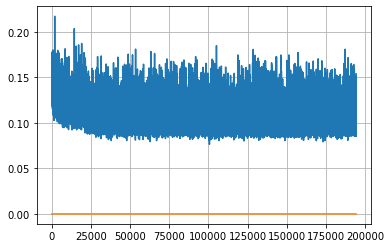

Epoch: 498, iteration 0, loss 0.10820949077606201, cov_diff 0.4076600143672057 cov_diff train 0.4077762414402811
Epoch: 498, iteration 1, loss 0.09715250134468079, cov_diff 0.4009361589224905 cov_diff train 0.39937219944117097
Epoch: 498, iteration 2, loss 0.10466247797012329, cov_diff 0.4041727779567725 cov_diff train 0.4044525993923964
Epoch: 498, iteration 3, loss 0.10540944337844849, cov_diff 0.4154241169151152 cov_diff train 0.4145519824470191
Epoch: 498, iteration 4, loss 0.09757542610168457, cov_diff 0.4019041970766167 cov_diff train 0.40228660366264296
Epoch: 498, iteration 5, loss 0.11936652660369873, cov_diff 0.40691781698167895 cov_diff train 0.4067077876076845
Epoch: 498, iteration 6, loss 0.1020161509513855, cov_diff 0.39604433675911455 cov_diff train 0.39632658059389475
Epoch: 498, iteration 7, loss 0.10165584087371826, cov_diff 0.4102395698016163 cov_diff train 0.41029256054217955
Epoch: 498, iteration 8, loss 0.10193592309951782, cov_diff 0.39878847469699635 cov_diff tr

Epoch: 498, iteration 79, loss 0.09936729073524475, cov_diff 0.4126702369853781 cov_diff train 0.4117665921280417
Epoch: 498, iteration 80, loss 0.09853982925415039, cov_diff 0.41343729381853306 cov_diff train 0.41274190915605086
Epoch: 498, iteration 81, loss 0.09823504090309143, cov_diff 0.4025217384731756 cov_diff train 0.4016783406855205
Epoch: 498, iteration 82, loss 0.0929674506187439, cov_diff 0.41213928221205814 cov_diff train 0.4104994761547108
Epoch: 498, iteration 83, loss 0.10330244898796082, cov_diff 0.4119053767828992 cov_diff train 0.4109992935916702
Epoch: 498, iteration 84, loss 0.10309329628944397, cov_diff 0.41468591467926663 cov_diff train 0.41396206142961695
Epoch: 498, iteration 85, loss 0.10455188155174255, cov_diff 0.4175973340454875 cov_diff train 0.41723157537584865
Epoch: 498, iteration 86, loss 0.10659056901931763, cov_diff 0.41345590844580205 cov_diff train 0.41290053734137605
Epoch: 498, iteration 87, loss 0.10144481062889099, cov_diff 0.41534712914229316 

Epoch: 498, iteration 159, loss 0.09515532851219177, cov_diff 0.4145724130604975 cov_diff train 0.41381470374205764
Epoch: 498, iteration 160, loss 0.09783250093460083, cov_diff 0.4038129278943516 cov_diff train 0.40350410788525004
Epoch: 498, iteration 161, loss 0.12514859437942505, cov_diff 0.4049971872443465 cov_diff train 0.40441622520038534
Epoch: 498, iteration 162, loss 0.09647360444068909, cov_diff 0.4061197171799537 cov_diff train 0.40608782808921756
Epoch: 498, iteration 163, loss 0.10076308250427246, cov_diff 0.41125806766003525 cov_diff train 0.4104530135419443
Epoch: 498, iteration 164, loss 0.09340029954910278, cov_diff 0.40695900047625994 cov_diff train 0.40650229890829587
Epoch: 498, iteration 165, loss 0.10175296664237976, cov_diff 0.4113843754305439 cov_diff train 0.4110566989693959
Epoch: 498, iteration 166, loss 0.10038608312606812, cov_diff 0.4028224161775867 cov_diff train 0.40202323978694243
Epoch: 498, iteration 167, loss 0.1046617329120636, cov_diff 0.392523265

Epoch: 498, iteration 239, loss 0.0971997082233429, cov_diff 0.4091440162257797 cov_diff train 0.407239023201607
Epoch: 498, iteration 240, loss 0.10744118690490723, cov_diff 0.40099582973723213 cov_diff train 0.39979979586290815
Epoch: 498, iteration 241, loss 0.09091421961784363, cov_diff 0.41508954093936934 cov_diff train 0.41424920923610514
Epoch: 498, iteration 242, loss 0.09292441606521606, cov_diff 0.41171204148882257 cov_diff train 0.411180791498059
Epoch: 498, iteration 243, loss 0.09758424758911133, cov_diff 0.4271589138623585 cov_diff train 0.4266547453905532
Epoch: 498, iteration 244, loss 0.11179044842720032, cov_diff 0.41630508911368785 cov_diff train 0.4149172174630312
Epoch: 498, iteration 245, loss 0.11104580760002136, cov_diff 0.40986263686492475 cov_diff train 0.40929153907830534
Epoch: 498, iteration 246, loss 0.1135948896408081, cov_diff 0.41616910319774253 cov_diff train 0.41526302244204855
Epoch: 498, iteration 247, loss 0.09670564532279968, cov_diff 0.4187759045

Epoch: 498, iteration 321, loss 0.1077796220779419, cov_diff 0.4116091273591143 cov_diff train 0.41237049945494925
Epoch: 498, iteration 322, loss 0.10779231786727905, cov_diff 0.41189433005235787 cov_diff train 0.41064476633288693
Epoch: 498, iteration 323, loss 0.08909708261489868, cov_diff 0.4122520050070205 cov_diff train 0.41164686471343864
Epoch: 498, iteration 324, loss 0.11557766795158386, cov_diff 0.42401212476583977 cov_diff train 0.42190579191669264
Epoch: 498, iteration 325, loss 0.10554051399230957, cov_diff 0.4017472319134511 cov_diff train 0.4013026409303757
Epoch: 498, iteration 326, loss 0.09768310189247131, cov_diff 0.4067308388026151 cov_diff train 0.40632530551542223
Epoch: 498, iteration 327, loss 0.10673394799232483, cov_diff 0.41431357389053397 cov_diff train 0.41459068266920046
Epoch: 498, iteration 328, loss 0.09894022345542908, cov_diff 0.3955388760163779 cov_diff train 0.3952089430990099
Epoch: 498, iteration 329, loss 0.113197922706604, cov_diff 0.4252990140

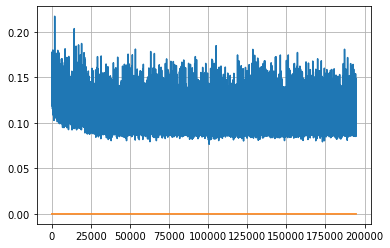

Epoch: 499, iteration 0, loss 0.09393849968910217, cov_diff 0.40977101202647703 cov_diff train 0.41008001738310007
Epoch: 499, iteration 1, loss 0.10618805885314941, cov_diff 0.40987744481020166 cov_diff train 0.40779057283503517
Epoch: 499, iteration 2, loss 0.0960436463356018, cov_diff 0.40539406887406687 cov_diff train 0.40517704463787485
Epoch: 499, iteration 3, loss 0.11030003428459167, cov_diff 0.4027698370790112 cov_diff train 0.4024413631835759
Epoch: 499, iteration 4, loss 0.11150398850440979, cov_diff 0.3994318274844819 cov_diff train 0.39897921430009725
Epoch: 499, iteration 5, loss 0.1055125892162323, cov_diff 0.4179458009333194 cov_diff train 0.4174730023266293
Epoch: 499, iteration 6, loss 0.09933716058731079, cov_diff 0.4096300186804696 cov_diff train 0.40909272594922025
Epoch: 499, iteration 7, loss 0.10297501087188721, cov_diff 0.4039039053961558 cov_diff train 0.40302803875589427
Epoch: 499, iteration 8, loss 0.10460630059242249, cov_diff 0.4181136320659608 cov_diff t

Epoch: 499, iteration 81, loss 0.10489681363105774, cov_diff 0.39960251600468544 cov_diff train 0.3995695500920971
Epoch: 499, iteration 82, loss 0.11713331937789917, cov_diff 0.40812986239964927 cov_diff train 0.40889679786744326
Epoch: 499, iteration 83, loss 0.11141648888587952, cov_diff 0.40386575793280133 cov_diff train 0.4035768610579644
Epoch: 499, iteration 84, loss 0.09469324350357056, cov_diff 0.41439665350327387 cov_diff train 0.4141267183168235
Epoch: 499, iteration 85, loss 0.10038825869560242, cov_diff 0.4144231900098855 cov_diff train 0.4138605889460579
Epoch: 499, iteration 86, loss 0.09692367911338806, cov_diff 0.3933890369213545 cov_diff train 0.39326437363767874
Epoch: 499, iteration 87, loss 0.10211485624313354, cov_diff 0.42088320353050424 cov_diff train 0.4203546312378833
Epoch: 499, iteration 88, loss 0.09349659085273743, cov_diff 0.4104107945576865 cov_diff train 0.40891346029849585
Epoch: 499, iteration 89, loss 0.09724786877632141, cov_diff 0.41270646387576754

Epoch: 499, iteration 161, loss 0.10432225465774536, cov_diff 0.4123161707878812 cov_diff train 0.41163692030355026
Epoch: 499, iteration 162, loss 0.10656371712684631, cov_diff 0.40361589170990203 cov_diff train 0.40388017620761674
Epoch: 499, iteration 163, loss 0.10256102681159973, cov_diff 0.3954031792921794 cov_diff train 0.3953872520813239
Epoch: 499, iteration 164, loss 0.09946921467781067, cov_diff 0.4058773697485472 cov_diff train 0.4054283779712472
Epoch: 499, iteration 165, loss 0.10143217444419861, cov_diff 0.4120689008295436 cov_diff train 0.4108385531295394
Epoch: 499, iteration 166, loss 0.09783855080604553, cov_diff 0.40438772539336243 cov_diff train 0.4038296459184631
Epoch: 499, iteration 167, loss 0.12323379516601562, cov_diff 0.4104369898270951 cov_diff train 0.4104712440131213
Epoch: 499, iteration 168, loss 0.09037724137306213, cov_diff 0.41428223564201827 cov_diff train 0.4159561980817564
Epoch: 499, iteration 169, loss 0.1126922070980072, cov_diff 0.405609451504

Epoch: 499, iteration 243, loss 0.10097023844718933, cov_diff 0.4095018801721474 cov_diff train 0.4095881682308685
Epoch: 499, iteration 244, loss 0.10835936665534973, cov_diff 0.40447878412543753 cov_diff train 0.4039199585311149
Epoch: 499, iteration 245, loss 0.1087731122970581, cov_diff 0.4124768726524202 cov_diff train 0.4124142765048168
Epoch: 499, iteration 246, loss 0.09781798720359802, cov_diff 0.41291405339723425 cov_diff train 0.4127917456935673
Epoch: 499, iteration 247, loss 0.11048054695129395, cov_diff 0.40188813790546674 cov_diff train 0.401044195177635
Epoch: 499, iteration 248, loss 0.10408490896224976, cov_diff 0.419776079812797 cov_diff train 0.4198464302486591
Epoch: 499, iteration 249, loss 0.10128003358840942, cov_diff 0.417311006174638 cov_diff train 0.41735825489090417
Epoch: 499, iteration 250, loss 0.10221165418624878, cov_diff 0.41773097013136423 cov_diff train 0.41708960532059014
Epoch: 499, iteration 251, loss 0.100676029920578, cov_diff 0.4131061112494689

Epoch: 499, iteration 325, loss 0.10718035697937012, cov_diff 0.41048377630100624 cov_diff train 0.41021188960682636
Epoch: 499, iteration 326, loss 0.09987738728523254, cov_diff 0.39354598193207796 cov_diff train 0.39308822694555245
Epoch: 499, iteration 327, loss 0.10046699643135071, cov_diff 0.4066500316105248 cov_diff train 0.40530729737111476
Epoch: 499, iteration 328, loss 0.11757805943489075, cov_diff 0.4177155550602732 cov_diff train 0.41593381281307745
Epoch: 499, iteration 329, loss 0.0960264801979065, cov_diff 0.4121260112000526 cov_diff train 0.41179900215586124
Epoch: 499, iteration 330, loss 0.10553473234176636, cov_diff 0.4050995572561385 cov_diff train 0.4042303993819379
Epoch: 499, iteration 331, loss 0.11628437042236328, cov_diff 0.4047409387296137 cov_diff train 0.4042599061527911
Epoch: 499, iteration 332, loss 0.10495901107788086, cov_diff 0.40798565891381966 cov_diff train 0.40625092163227755
Epoch: 499, iteration 333, loss 0.11171284317970276, cov_diff 0.40252784

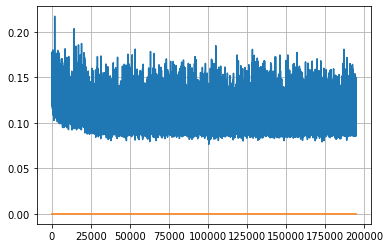

Epoch: 500, iteration 0, loss 0.0958983302116394, cov_diff 0.4105577278487049 cov_diff train 0.40962149159556943
Epoch: 500, iteration 1, loss 0.10607266426086426, cov_diff 0.40613501698971743 cov_diff train 0.40526623278290164
Epoch: 500, iteration 2, loss 0.10925105214118958, cov_diff 0.41111789849854835 cov_diff train 0.41004219992723556
Epoch: 500, iteration 3, loss 0.11155304312705994, cov_diff 0.4242169529532902 cov_diff train 0.4227791936476463
Epoch: 500, iteration 4, loss 0.11113744974136353, cov_diff 0.40015407560219685 cov_diff train 0.39930095776507063
Epoch: 500, iteration 5, loss 0.11121603846549988, cov_diff 0.4185474849051588 cov_diff train 0.41799352619607766
Epoch: 500, iteration 6, loss 0.10055729746818542, cov_diff 0.4030500053173101 cov_diff train 0.4026958943106023
Epoch: 500, iteration 7, loss 0.10176527500152588, cov_diff 0.4178729641626303 cov_diff train 0.4171964946328831
Epoch: 500, iteration 8, loss 0.10179853439331055, cov_diff 0.4128471657627068 cov_diff t

Epoch: 500, iteration 80, loss 0.11082866787910461, cov_diff 0.41837943951491624 cov_diff train 0.4178157097688162
Epoch: 500, iteration 81, loss 0.1033625602722168, cov_diff 0.41358982628245905 cov_diff train 0.4135491712094239
Epoch: 500, iteration 82, loss 0.1071704626083374, cov_diff 0.41212198757940904 cov_diff train 0.41169845341589123
Epoch: 500, iteration 83, loss 0.11440524458885193, cov_diff 0.4092788945666293 cov_diff train 0.4083673602697684
Epoch: 500, iteration 84, loss 0.10293087363243103, cov_diff 0.4010275147247405 cov_diff train 0.3998817273595814
Epoch: 500, iteration 85, loss 0.09642797708511353, cov_diff 0.41531488241816394 cov_diff train 0.41457746556271285
Epoch: 500, iteration 86, loss 0.11686262488365173, cov_diff 0.40589369699062267 cov_diff train 0.4045273406115581
Epoch: 500, iteration 87, loss 0.11322382092475891, cov_diff 0.4137057662667313 cov_diff train 0.41236928993884703
Epoch: 500, iteration 88, loss 0.10723567008972168, cov_diff 0.41760348591766683 c

Epoch: 500, iteration 157, loss 0.09613892436027527, cov_diff 0.42098516987326084 cov_diff train 0.4213278815705343
Epoch: 500, iteration 158, loss 0.10590705275535583, cov_diff 0.4192907532807621 cov_diff train 0.4192840602062697
Epoch: 500, iteration 159, loss 0.11514890193939209, cov_diff 0.4207389250291134 cov_diff train 0.4197322238804368
Epoch: 500, iteration 160, loss 0.104714035987854, cov_diff 0.41171859133141264 cov_diff train 0.4119289663768442
Epoch: 500, iteration 161, loss 0.10847043991088867, cov_diff 0.40568505278832195 cov_diff train 0.40572956258795767
Epoch: 500, iteration 162, loss 0.11244845390319824, cov_diff 0.4207339571879616 cov_diff train 0.41998171682429997
Epoch: 500, iteration 163, loss 0.09429270029067993, cov_diff 0.4136492295746498 cov_diff train 0.4130219374471174
Epoch: 500, iteration 164, loss 0.10090968012809753, cov_diff 0.41647560961356445 cov_diff train 0.4156136653573422
Epoch: 500, iteration 165, loss 0.09080696105957031, cov_diff 0.402550596282

Epoch: 500, iteration 238, loss 0.10295689105987549, cov_diff 0.4190769679997134 cov_diff train 0.41821920109648675
Epoch: 500, iteration 239, loss 0.1073906421661377, cov_diff 0.41683847160943477 cov_diff train 0.41575733356791233
Epoch: 500, iteration 240, loss 0.10554641485214233, cov_diff 0.41379094544568873 cov_diff train 0.4135501940394524
Epoch: 500, iteration 241, loss 0.0969747006893158, cov_diff 0.39725471039956156 cov_diff train 0.3968129233765413
Epoch: 500, iteration 242, loss 0.10610154271125793, cov_diff 0.4165442483682548 cov_diff train 0.41603576039635404
Epoch: 500, iteration 243, loss 0.10500487685203552, cov_diff 0.4097630709935276 cov_diff train 0.4087574118796139
Epoch: 500, iteration 244, loss 0.10483849048614502, cov_diff 0.39569675163158574 cov_diff train 0.3957470501095757
Epoch: 500, iteration 245, loss 0.09359166026115417, cov_diff 0.4130487825249798 cov_diff train 0.41226981515021044
Epoch: 500, iteration 246, loss 0.11219456791877747, cov_diff 0.4047197460

Epoch: 500, iteration 316, loss 0.1025594174861908, cov_diff 0.4069256666236366 cov_diff train 0.4066370788132654
Epoch: 500, iteration 317, loss 0.10971853137016296, cov_diff 0.40892863741298957 cov_diff train 0.4093815878019527
Epoch: 500, iteration 318, loss 0.10876813530921936, cov_diff 0.43309661404967104 cov_diff train 0.4332099131055389
Epoch: 500, iteration 319, loss 0.11250793933868408, cov_diff 0.40926367570518685 cov_diff train 0.4098805376682012
Epoch: 500, iteration 320, loss 0.09533163905143738, cov_diff 0.4117226508208697 cov_diff train 0.4112851455792456
Epoch: 500, iteration 321, loss 0.09681609272956848, cov_diff 0.4071025959216588 cov_diff train 0.4067924261029147
Epoch: 500, iteration 322, loss 0.09596827626228333, cov_diff 0.414087580346147 cov_diff train 0.41379878932568565
Epoch: 500, iteration 323, loss 0.10302728414535522, cov_diff 0.4117978078654663 cov_diff train 0.41125868480921307
Epoch: 500, iteration 324, loss 0.10454899072647095, cov_diff 0.4111776168802

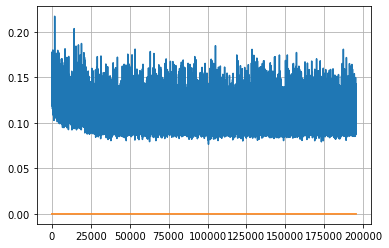

Epoch: 501, iteration 0, loss 0.09718921780586243, cov_diff 0.3946245415891686 cov_diff train 0.3947884339377686
Epoch: 501, iteration 1, loss 0.12290889024734497, cov_diff 0.4107097979889405 cov_diff train 0.4104625553403844
Epoch: 501, iteration 2, loss 0.11375698447227478, cov_diff 0.4175973533308471 cov_diff train 0.4155702219463079
Epoch: 501, iteration 3, loss 0.11147922277450562, cov_diff 0.41018961638539453 cov_diff train 0.4098197021121951
Epoch: 501, iteration 4, loss 0.09788340330123901, cov_diff 0.4063143978323414 cov_diff train 0.4063301901184148
Epoch: 501, iteration 5, loss 0.09563535451889038, cov_diff 0.4174552307741579 cov_diff train 0.41781071226322464
Epoch: 501, iteration 6, loss 0.09867241978645325, cov_diff 0.41021813456800515 cov_diff train 0.41051431348433565
Epoch: 501, iteration 7, loss 0.11959737539291382, cov_diff 0.4262154014931312 cov_diff train 0.4261400854412624
Epoch: 501, iteration 8, loss 0.11060589551925659, cov_diff 0.42417842160708197 cov_diff tra

Epoch: 501, iteration 77, loss 0.09324219822883606, cov_diff 0.4076495190496864 cov_diff train 0.40710679474622286
Epoch: 501, iteration 78, loss 0.1066133975982666, cov_diff 0.4058340220369921 cov_diff train 0.4046872036107344
Epoch: 501, iteration 79, loss 0.0940409004688263, cov_diff 0.4189380609516708 cov_diff train 0.41860944367602054
Epoch: 501, iteration 80, loss 0.09593024849891663, cov_diff 0.4062685355724854 cov_diff train 0.4054576483708534
Epoch: 501, iteration 81, loss 0.10021522641181946, cov_diff 0.4106607094576389 cov_diff train 0.4086193402858731
Epoch: 501, iteration 82, loss 0.09714943170547485, cov_diff 0.4115417488052982 cov_diff train 0.4104457245196742
Epoch: 501, iteration 83, loss 0.10985857248306274, cov_diff 0.40628889648133765 cov_diff train 0.40588834087671755
Epoch: 501, iteration 84, loss 0.09637218713760376, cov_diff 0.41258923663906216 cov_diff train 0.411554201744795
Epoch: 501, iteration 85, loss 0.09872299432754517, cov_diff 0.4035146933598507 cov_di

Epoch: 501, iteration 156, loss 0.11077600717544556, cov_diff 0.4064376142703584 cov_diff train 0.40595293070103783
Epoch: 501, iteration 157, loss 0.10578155517578125, cov_diff 0.4154522932285616 cov_diff train 0.4147156248073969
Epoch: 501, iteration 158, loss 0.0964651107788086, cov_diff 0.41869946105032985 cov_diff train 0.4173189853339146
Epoch: 501, iteration 159, loss 0.10991126298904419, cov_diff 0.410230047594149 cov_diff train 0.4098453995596142
Epoch: 501, iteration 160, loss 0.09512341022491455, cov_diff 0.41216878783898 cov_diff train 0.4113871363722171
Epoch: 501, iteration 161, loss 0.10430574417114258, cov_diff 0.41090082502967684 cov_diff train 0.41011291895006696
Epoch: 501, iteration 162, loss 0.10704672336578369, cov_diff 0.4091543368380387 cov_diff train 0.4090949910129635
Epoch: 501, iteration 163, loss 0.10523143410682678, cov_diff 0.41697539737101585 cov_diff train 0.4164242318691616
Epoch: 501, iteration 164, loss 0.09646293520927429, cov_diff 0.412228410691199

Epoch: 501, iteration 234, loss 0.10849961638450623, cov_diff 0.4047198805976011 cov_diff train 0.4042325468705275
Epoch: 501, iteration 235, loss 0.09283098578453064, cov_diff 0.41210198730638975 cov_diff train 0.4119529256915457
Epoch: 501, iteration 236, loss 0.09094101190567017, cov_diff 0.4126377787402338 cov_diff train 0.4124498052074817
Epoch: 501, iteration 237, loss 0.10235446691513062, cov_diff 0.41649720888816816 cov_diff train 0.4160977080775423
Epoch: 501, iteration 238, loss 0.11069905757904053, cov_diff 0.41804094964831556 cov_diff train 0.4168100312652812
Epoch: 501, iteration 239, loss 0.09425634145736694, cov_diff 0.406916824074927 cov_diff train 0.40595840055547605
Epoch: 501, iteration 240, loss 0.09435209631919861, cov_diff 0.40729770634653056 cov_diff train 0.4053167112828868
Epoch: 501, iteration 241, loss 0.11507070064544678, cov_diff 0.4154224455614173 cov_diff train 0.41492560075878776
Epoch: 501, iteration 242, loss 0.10935121774673462, cov_diff 0.40730985435

Epoch: 501, iteration 313, loss 0.11134698987007141, cov_diff 0.4119365161913358 cov_diff train 0.41132132906319174
Epoch: 501, iteration 314, loss 0.09840482473373413, cov_diff 0.4077601300631659 cov_diff train 0.4076396560478118
Epoch: 501, iteration 315, loss 0.10267388820648193, cov_diff 0.40732504837940864 cov_diff train 0.4071776416842683
Epoch: 501, iteration 316, loss 0.11185681819915771, cov_diff 0.41170150274780787 cov_diff train 0.4110600981681961
Epoch: 501, iteration 317, loss 0.1055801510810852, cov_diff 0.42098190895187054 cov_diff train 0.41991069779918744
Epoch: 501, iteration 318, loss 0.1079588234424591, cov_diff 0.39637583958224426 cov_diff train 0.3970481824384541
Epoch: 501, iteration 319, loss 0.10782504081726074, cov_diff 0.4027179883290909 cov_diff train 0.4017262426674981
Epoch: 501, iteration 320, loss 0.09956350922584534, cov_diff 0.42094086764440053 cov_diff train 0.42074427771341116
Epoch: 501, iteration 321, loss 0.09556713700294495, cov_diff 0.4153828283

Epoch: 501, iteration 390, loss 0.15677574276924133, cov_diff 0.44935545927723214 cov_diff train 0.4483449483921385


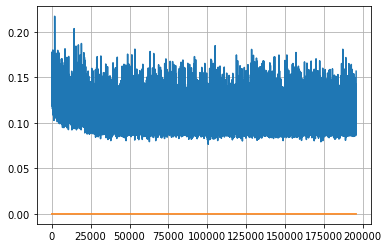

Epoch: 502, iteration 0, loss 0.10704964399337769, cov_diff 0.4165187160366966 cov_diff train 0.4155664104937495
Epoch: 502, iteration 1, loss 0.08962136507034302, cov_diff 0.3919038045802713 cov_diff train 0.3916365502450327
Epoch: 502, iteration 2, loss 0.1085643470287323, cov_diff 0.4017913888318643 cov_diff train 0.4021732945388939
Epoch: 502, iteration 3, loss 0.10068169236183167, cov_diff 0.41988533872826084 cov_diff train 0.4195921998204229
Epoch: 502, iteration 4, loss 0.10492759943008423, cov_diff 0.405215759074523 cov_diff train 0.4052233898684997
Epoch: 502, iteration 5, loss 0.10415443778038025, cov_diff 0.40723407279765705 cov_diff train 0.40727834510802596
Epoch: 502, iteration 6, loss 0.11124855279922485, cov_diff 0.3982536824157713 cov_diff train 0.3985986772813638
Epoch: 502, iteration 7, loss 0.09671834111213684, cov_diff 0.4019060563200649 cov_diff train 0.40157112734465683
Epoch: 502, iteration 8, loss 0.11085879802703857, cov_diff 0.4059426908521995 cov_diff train 

Epoch: 502, iteration 77, loss 0.10815846920013428, cov_diff 0.4028543329428398 cov_diff train 0.40273435016423903
Epoch: 502, iteration 78, loss 0.10745668411254883, cov_diff 0.4229031721111552 cov_diff train 0.4226453290040317
Epoch: 502, iteration 79, loss 0.10172784328460693, cov_diff 0.4119482484408225 cov_diff train 0.41093318809210283
Epoch: 502, iteration 80, loss 0.10497978329658508, cov_diff 0.39918464082677396 cov_diff train 0.39817284220560667
Epoch: 502, iteration 81, loss 0.10232731699943542, cov_diff 0.4082436389350794 cov_diff train 0.4072486293179062
Epoch: 502, iteration 82, loss 0.1075880229473114, cov_diff 0.40846973041139395 cov_diff train 0.40750030646389207
Epoch: 502, iteration 83, loss 0.1044093668460846, cov_diff 0.41772313333267846 cov_diff train 0.41733204023599557
Epoch: 502, iteration 84, loss 0.10077667236328125, cov_diff 0.3979382675043026 cov_diff train 0.3978807616352477
Epoch: 502, iteration 85, loss 0.11500048637390137, cov_diff 0.4138279871649839 co

Epoch: 502, iteration 156, loss 0.09681457281112671, cov_diff 0.4154940980761371 cov_diff train 0.4141381295551796
Epoch: 502, iteration 157, loss 0.09486642479896545, cov_diff 0.4154926910693091 cov_diff train 0.4147081025304547
Epoch: 502, iteration 158, loss 0.10660147666931152, cov_diff 0.4178246766430818 cov_diff train 0.4150313512082256
Epoch: 502, iteration 159, loss 0.09817606210708618, cov_diff 0.4047963949897408 cov_diff train 0.40461057730421296
Epoch: 502, iteration 160, loss 0.0997338593006134, cov_diff 0.39045348793538764 cov_diff train 0.3906673612851254
Epoch: 502, iteration 161, loss 0.10464191436767578, cov_diff 0.40801639442059984 cov_diff train 0.406894913596179
Epoch: 502, iteration 162, loss 0.09405052661895752, cov_diff 0.3911889003919681 cov_diff train 0.3908675202286804
Epoch: 502, iteration 163, loss 0.09465259313583374, cov_diff 0.4075392056192875 cov_diff train 0.40654797376190804
Epoch: 502, iteration 164, loss 0.11045384407043457, cov_diff 0.40624699501668

Epoch: 502, iteration 234, loss 0.11068135499954224, cov_diff 0.4127133187706387 cov_diff train 0.4117210354775132
Epoch: 502, iteration 235, loss 0.10945448279380798, cov_diff 0.4152623109971763 cov_diff train 0.4140497444938705
Epoch: 502, iteration 236, loss 0.0853731632232666, cov_diff 0.41616589437198004 cov_diff train 0.4154610071505043
Epoch: 502, iteration 237, loss 0.10201260447502136, cov_diff 0.41402128772888624 cov_diff train 0.41342480704172707
Epoch: 502, iteration 238, loss 0.11132746934890747, cov_diff 0.4178956283102005 cov_diff train 0.4169160141023983
Epoch: 502, iteration 239, loss 0.10775205492973328, cov_diff 0.40720121089568767 cov_diff train 0.4071993717860071
Epoch: 502, iteration 240, loss 0.10842323303222656, cov_diff 0.4215195838767434 cov_diff train 0.4215756633487265
Epoch: 502, iteration 241, loss 0.10324600338935852, cov_diff 0.4202161037084753 cov_diff train 0.420036957614818
Epoch: 502, iteration 242, loss 0.09814241528511047, cov_diff 0.40710356944368

Epoch: 502, iteration 311, loss 0.11229154467582703, cov_diff 0.4052197202014043 cov_diff train 0.4038748833870323
Epoch: 502, iteration 312, loss 0.09699979424476624, cov_diff 0.4025364559579348 cov_diff train 0.40249086175393944
Epoch: 502, iteration 313, loss 0.08831003308296204, cov_diff 0.4169221758390897 cov_diff train 0.4170690727464513
Epoch: 502, iteration 314, loss 0.11367279291152954, cov_diff 0.4231107832594489 cov_diff train 0.422718995482382
Epoch: 502, iteration 315, loss 0.10693082213401794, cov_diff 0.4134757514426723 cov_diff train 0.41304922862190896
Epoch: 502, iteration 316, loss 0.09830895066261292, cov_diff 0.40683697747940906 cov_diff train 0.40711812559300675
Epoch: 502, iteration 317, loss 0.10851812362670898, cov_diff 0.4100884955036897 cov_diff train 0.4094338516103942
Epoch: 502, iteration 318, loss 0.1028323769569397, cov_diff 0.4239633476841364 cov_diff train 0.42332828073909584
Epoch: 502, iteration 319, loss 0.11589181423187256, cov_diff 0.4102195724055

Epoch: 502, iteration 388, loss 0.09846952557563782, cov_diff 0.419452873495682 cov_diff train 0.419478099652053
Epoch: 502, iteration 389, loss 0.10359761118888855, cov_diff 0.40887073897700466 cov_diff train 0.4084471907343194
Epoch: 502, iteration 390, loss 0.1522117257118225, cov_diff 0.45720785566382943 cov_diff train 0.45676217317040657


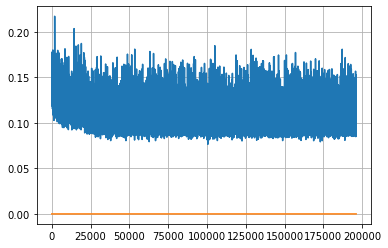

Epoch: 503, iteration 0, loss 0.09270253777503967, cov_diff 0.4167211482832984 cov_diff train 0.41675004218343537
Epoch: 503, iteration 1, loss 0.10643324255943298, cov_diff 0.42020145760497674 cov_diff train 0.4194894439437352
Epoch: 503, iteration 2, loss 0.10852381587028503, cov_diff 0.4170084351367193 cov_diff train 0.41653785689978784
Epoch: 503, iteration 3, loss 0.10049793124198914, cov_diff 0.4145057956758288 cov_diff train 0.41409952639627484
Epoch: 503, iteration 4, loss 0.09949317574501038, cov_diff 0.4180523731096047 cov_diff train 0.41713953330136183
Epoch: 503, iteration 5, loss 0.0903259813785553, cov_diff 0.3994793223509318 cov_diff train 0.3989557816101321
Epoch: 503, iteration 6, loss 0.11443984508514404, cov_diff 0.4048034870582551 cov_diff train 0.4046447382630101
Epoch: 503, iteration 7, loss 0.10600417852401733, cov_diff 0.42023675778607955 cov_diff train 0.42008974756505635
Epoch: 503, iteration 8, loss 0.10471132397651672, cov_diff 0.40372365990682385 cov_diff t

Epoch: 503, iteration 81, loss 0.09392297267913818, cov_diff 0.4057069061121288 cov_diff train 0.4064844071871387
Epoch: 503, iteration 82, loss 0.10413029789924622, cov_diff 0.3995390772896953 cov_diff train 0.399391433931064
Epoch: 503, iteration 83, loss 0.10948511958122253, cov_diff 0.4183851213220943 cov_diff train 0.4181245318077928
Epoch: 503, iteration 84, loss 0.11152276396751404, cov_diff 0.4117849783843095 cov_diff train 0.41100667968064086
Epoch: 503, iteration 85, loss 0.10710904002189636, cov_diff 0.4327256903850742 cov_diff train 0.4319109397482195
Epoch: 503, iteration 86, loss 0.11139282584190369, cov_diff 0.401775234808983 cov_diff train 0.4011313533076053
Epoch: 503, iteration 87, loss 0.09572046995162964, cov_diff 0.41424488286498157 cov_diff train 0.4136287464327638
Epoch: 503, iteration 88, loss 0.10606145858764648, cov_diff 0.4181691031218634 cov_diff train 0.4162242906412172
Epoch: 503, iteration 89, loss 0.1039418876171112, cov_diff 0.40578860253417676 cov_diff

Epoch: 503, iteration 155, loss 0.10453888773918152, cov_diff 0.40814877845782194 cov_diff train 0.4077423160627825
Epoch: 503, iteration 156, loss 0.10322901606559753, cov_diff 0.3991297798484004 cov_diff train 0.39887774357145067
Epoch: 503, iteration 157, loss 0.09674152731895447, cov_diff 0.39469914795121186 cov_diff train 0.39439721962982593
Epoch: 503, iteration 158, loss 0.0983826220035553, cov_diff 0.41160724566776896 cov_diff train 0.41110438492534385
Epoch: 503, iteration 159, loss 0.10644012689590454, cov_diff 0.3998084566522274 cov_diff train 0.4002783796034509
Epoch: 503, iteration 160, loss 0.10047250986099243, cov_diff 0.403456436946365 cov_diff train 0.40267311323203986
Epoch: 503, iteration 161, loss 0.09565603733062744, cov_diff 0.411812485156948 cov_diff train 0.4120661630747184
Epoch: 503, iteration 162, loss 0.10444575548171997, cov_diff 0.4108763569188023 cov_diff train 0.4102011845391017
Epoch: 503, iteration 163, loss 0.10848435759544373, cov_diff 0.407760297937

Epoch: 503, iteration 226, loss 0.1093781590461731, cov_diff 0.4028705127034279 cov_diff train 0.4025299719184268
Epoch: 503, iteration 227, loss 0.1028691828250885, cov_diff 0.42170715632087125 cov_diff train 0.4206319155229522
Epoch: 503, iteration 228, loss 0.10507231950759888, cov_diff 0.3966375122455356 cov_diff train 0.3961854418586655
Epoch: 503, iteration 229, loss 0.093218594789505, cov_diff 0.4110790002884223 cov_diff train 0.4104120498466711
Epoch: 503, iteration 230, loss 0.09830152988433838, cov_diff 0.41463110554675153 cov_diff train 0.41378842843661606
Epoch: 503, iteration 231, loss 0.09843501448631287, cov_diff 0.40822357065057113 cov_diff train 0.40777066433800635
Epoch: 503, iteration 232, loss 0.10606586933135986, cov_diff 0.4036857510643646 cov_diff train 0.4038251973047876
Epoch: 503, iteration 233, loss 0.10028058290481567, cov_diff 0.4161031390347674 cov_diff train 0.4150930934030504
Epoch: 503, iteration 234, loss 0.09210154414176941, cov_diff 0.409106324212935

Epoch: 503, iteration 300, loss 0.09668317437171936, cov_diff 0.40969818234237737 cov_diff train 0.40943371136643136
Epoch: 503, iteration 301, loss 0.10438156127929688, cov_diff 0.3899699117006563 cov_diff train 0.38954892013741577
Epoch: 503, iteration 302, loss 0.09618893265724182, cov_diff 0.4063452868133748 cov_diff train 0.405489152191123
Epoch: 503, iteration 303, loss 0.1003374457359314, cov_diff 0.39997495989774023 cov_diff train 0.39896971401137415
Epoch: 503, iteration 304, loss 0.10350203514099121, cov_diff 0.42234197307986415 cov_diff train 0.4212966074652455
Epoch: 503, iteration 305, loss 0.09891694784164429, cov_diff 0.41172495758120237 cov_diff train 0.4120498780304944
Epoch: 503, iteration 306, loss 0.10052251815795898, cov_diff 0.408134406000791 cov_diff train 0.40822592401598756
Epoch: 503, iteration 307, loss 0.10308483242988586, cov_diff 0.41192788399881386 cov_diff train 0.411066068546635
Epoch: 503, iteration 308, loss 0.09643140435218811, cov_diff 0.41373087791

Epoch: 503, iteration 377, loss 0.10816153883934021, cov_diff 0.4019670999919414 cov_diff train 0.40102145934413524
Epoch: 503, iteration 378, loss 0.09517768025398254, cov_diff 0.4087599954341814 cov_diff train 0.4086360359616501
Epoch: 503, iteration 379, loss 0.10366559028625488, cov_diff 0.4123172204846176 cov_diff train 0.41191329272478866
Epoch: 503, iteration 380, loss 0.10029071569442749, cov_diff 0.40984870208929824 cov_diff train 0.40927997722399
Epoch: 503, iteration 381, loss 0.1161450743675232, cov_diff 0.4150091158005807 cov_diff train 0.41382429904916646
Epoch: 503, iteration 382, loss 0.1059284508228302, cov_diff 0.40278746256264664 cov_diff train 0.40224530756121624
Epoch: 503, iteration 383, loss 0.09912940859794617, cov_diff 0.4024872555548585 cov_diff train 0.40167993243661965
Epoch: 503, iteration 384, loss 0.09700849652290344, cov_diff 0.41052472320022854 cov_diff train 0.4088890398783376
Epoch: 503, iteration 385, loss 0.11510458588600159, cov_diff 0.415456677221

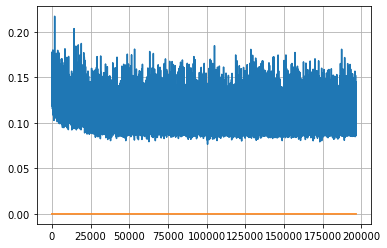

Epoch: 504, iteration 0, loss 0.10921555757522583, cov_diff 0.41505790646524887 cov_diff train 0.413926601448996
Epoch: 504, iteration 1, loss 0.11166727542877197, cov_diff 0.41989411536512045 cov_diff train 0.4186525855927188
Epoch: 504, iteration 2, loss 0.10924261808395386, cov_diff 0.40288560357973946 cov_diff train 0.4030254549574464
Epoch: 504, iteration 3, loss 0.12186908721923828, cov_diff 0.40852850974983124 cov_diff train 0.40908820014942937
Epoch: 504, iteration 4, loss 0.11723235249519348, cov_diff 0.40675718863021465 cov_diff train 0.40617340548045006
Epoch: 504, iteration 5, loss 0.10329115390777588, cov_diff 0.4121668816164647 cov_diff train 0.4109570922421981
Epoch: 504, iteration 6, loss 0.09661182761192322, cov_diff 0.4237770453490198 cov_diff train 0.4231942605582649
Epoch: 504, iteration 7, loss 0.09618687629699707, cov_diff 0.39981020286119073 cov_diff train 0.39926015170047124
Epoch: 504, iteration 8, loss 0.10081729292869568, cov_diff 0.4137865547719231 cov_diff 

Epoch: 504, iteration 78, loss 0.10758540034294128, cov_diff 0.4089367131786169 cov_diff train 0.40840727105115304
Epoch: 504, iteration 79, loss 0.09956678748130798, cov_diff 0.4212242436882702 cov_diff train 0.42119520760954443
Epoch: 504, iteration 80, loss 0.10250398516654968, cov_diff 0.4152985520186991 cov_diff train 0.41466473690409095
Epoch: 504, iteration 81, loss 0.10460183024406433, cov_diff 0.41192935380972384 cov_diff train 0.41095872009221596
Epoch: 504, iteration 82, loss 0.09655824303627014, cov_diff 0.41825732086191053 cov_diff train 0.4175156532388844
Epoch: 504, iteration 83, loss 0.10781592130661011, cov_diff 0.41456247461174084 cov_diff train 0.41391304010839053
Epoch: 504, iteration 84, loss 0.11114266514778137, cov_diff 0.4079977335628229 cov_diff train 0.4058996918898827
Epoch: 504, iteration 85, loss 0.11773601174354553, cov_diff 0.4195409327002032 cov_diff train 0.4189706636408055
Epoch: 504, iteration 86, loss 0.11168929934501648, cov_diff 0.4104270643921045 

Epoch: 504, iteration 158, loss 0.09884274005889893, cov_diff 0.41215735422123906 cov_diff train 0.41117081378472137
Epoch: 504, iteration 159, loss 0.1126282811164856, cov_diff 0.40414786885294784 cov_diff train 0.4040825697365648
Epoch: 504, iteration 160, loss 0.1104532778263092, cov_diff 0.41456020559777906 cov_diff train 0.414571921210525
Epoch: 504, iteration 161, loss 0.10122936964035034, cov_diff 0.42285335307686006 cov_diff train 0.42280374913598107
Epoch: 504, iteration 162, loss 0.11494496464729309, cov_diff 0.41671989312971364 cov_diff train 0.41634901575881633
Epoch: 504, iteration 163, loss 0.0955691933631897, cov_diff 0.40692367915256317 cov_diff train 0.40664083565817827
Epoch: 504, iteration 164, loss 0.10254675149917603, cov_diff 0.41809261326215014 cov_diff train 0.41752013453101094
Epoch: 504, iteration 165, loss 0.10450085997581482, cov_diff 0.41404339332917967 cov_diff train 0.41260270448897274
Epoch: 504, iteration 166, loss 0.09962427616119385, cov_diff 0.397666

Epoch: 504, iteration 238, loss 0.11698374152183533, cov_diff 0.4119877178960835 cov_diff train 0.411880137434667
Epoch: 504, iteration 239, loss 0.10418486595153809, cov_diff 0.4086214365256494 cov_diff train 0.40837749787537464
Epoch: 504, iteration 240, loss 0.10461544990539551, cov_diff 0.40098647825992734 cov_diff train 0.4009967804914365
Epoch: 504, iteration 241, loss 0.09345027804374695, cov_diff 0.409323711339855 cov_diff train 0.4089981377303182
Epoch: 504, iteration 242, loss 0.10426414012908936, cov_diff 0.41259768935127394 cov_diff train 0.4119082887034717
Epoch: 504, iteration 243, loss 0.10175111889839172, cov_diff 0.4135261331419327 cov_diff train 0.41369873900655774
Epoch: 504, iteration 244, loss 0.09801086783409119, cov_diff 0.40333370615579883 cov_diff train 0.40322931712907795
Epoch: 504, iteration 245, loss 0.09161585569381714, cov_diff 0.4161543183043108 cov_diff train 0.4155318450629432
Epoch: 504, iteration 246, loss 0.09936824440956116, cov_diff 0.414424707646

Epoch: 504, iteration 317, loss 0.10281485319137573, cov_diff 0.4128053354374692 cov_diff train 0.4120755957225821
Epoch: 504, iteration 318, loss 0.09026476740837097, cov_diff 0.40490784974420174 cov_diff train 0.403422546702413
Epoch: 504, iteration 319, loss 0.11429277062416077, cov_diff 0.4180616075150008 cov_diff train 0.4174642603279358
Epoch: 504, iteration 320, loss 0.10510987043380737, cov_diff 0.40858482905337506 cov_diff train 0.40841490641117995
Epoch: 504, iteration 321, loss 0.1022166907787323, cov_diff 0.40549213511566956 cov_diff train 0.4048237791970086
Epoch: 504, iteration 322, loss 0.10412043333053589, cov_diff 0.414720418910386 cov_diff train 0.41399753822671437
Epoch: 504, iteration 323, loss 0.10100966691970825, cov_diff 0.39675174442566974 cov_diff train 0.39625262349798984
Epoch: 504, iteration 324, loss 0.10446333885192871, cov_diff 0.4046194897338483 cov_diff train 0.4046566087535452
Epoch: 504, iteration 325, loss 0.11186715960502625, cov_diff 0.407134221385

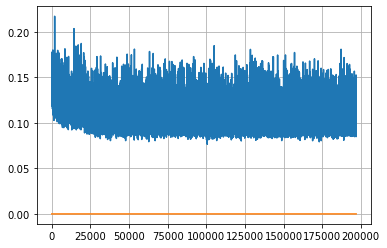

Epoch: 505, iteration 0, loss 0.09491878747940063, cov_diff 0.41426498843738885 cov_diff train 0.4138522916152794
Epoch: 505, iteration 1, loss 0.10097655653953552, cov_diff 0.4230793999477665 cov_diff train 0.42363363120704384
Epoch: 505, iteration 2, loss 0.11259511113166809, cov_diff 0.41941102350899656 cov_diff train 0.41874966292520993
Epoch: 505, iteration 3, loss 0.11210870742797852, cov_diff 0.4149824773254662 cov_diff train 0.41350385441748716
Epoch: 505, iteration 4, loss 0.10804709792137146, cov_diff 0.39929262852080466 cov_diff train 0.3991131633802794
Epoch: 505, iteration 5, loss 0.10075321793556213, cov_diff 0.4156633501636149 cov_diff train 0.41471056385495997
Epoch: 505, iteration 6, loss 0.0873534083366394, cov_diff 0.40688946132902404 cov_diff train 0.4065934885988306
Epoch: 505, iteration 7, loss 0.08706977963447571, cov_diff 0.40266054888069586 cov_diff train 0.40259353070351134
Epoch: 505, iteration 8, loss 0.097585529088974, cov_diff 0.4081084981316094 cov_diff t

Epoch: 505, iteration 72, loss 0.10244759917259216, cov_diff 0.4060649280365222 cov_diff train 0.40634794685753095
Epoch: 505, iteration 73, loss 0.1075994074344635, cov_diff 0.41130957060069223 cov_diff train 0.41099472225936606
Epoch: 505, iteration 74, loss 0.11272424459457397, cov_diff 0.4102270742454735 cov_diff train 0.4091064981877386
Epoch: 505, iteration 75, loss 0.10223087668418884, cov_diff 0.41192163235215506 cov_diff train 0.4110178290859017
Epoch: 505, iteration 76, loss 0.10690328478813171, cov_diff 0.41888483404514154 cov_diff train 0.41765461917938945
Epoch: 505, iteration 77, loss 0.11487677693367004, cov_diff 0.40231891429749944 cov_diff train 0.4017481596445732
Epoch: 505, iteration 78, loss 0.10908132791519165, cov_diff 0.4221561668209192 cov_diff train 0.421306209021526
Epoch: 505, iteration 79, loss 0.11062827706336975, cov_diff 0.4125717000501401 cov_diff train 0.41196545684669067
Epoch: 505, iteration 80, loss 0.09876826405525208, cov_diff 0.40052626630859756 c

Epoch: 505, iteration 151, loss 0.09911128878593445, cov_diff 0.40149003511602055 cov_diff train 0.3999005518848331
Epoch: 505, iteration 152, loss 0.10862177610397339, cov_diff 0.41133415446295485 cov_diff train 0.41092846501195657
Epoch: 505, iteration 153, loss 0.10396787524223328, cov_diff 0.41581094033415 cov_diff train 0.4148419046690699
Epoch: 505, iteration 154, loss 0.09454876184463501, cov_diff 0.4052866983800258 cov_diff train 0.4040880321117312
Epoch: 505, iteration 155, loss 0.09290814399719238, cov_diff 0.4105443156789521 cov_diff train 0.4098226185736305
Epoch: 505, iteration 156, loss 0.10864415764808655, cov_diff 0.405439231102538 cov_diff train 0.4056803165113843
Epoch: 505, iteration 157, loss 0.09731021523475647, cov_diff 0.4053267169468329 cov_diff train 0.40524489650030804
Epoch: 505, iteration 158, loss 0.09870567917823792, cov_diff 0.4060797796440568 cov_diff train 0.4051821597560786
Epoch: 505, iteration 159, loss 0.10591274499893188, cov_diff 0.403553690284384

Epoch: 505, iteration 231, loss 0.10254248976707458, cov_diff 0.4126168695072613 cov_diff train 0.4124950511894448
Epoch: 505, iteration 232, loss 0.1154453456401825, cov_diff 0.38812714299839784 cov_diff train 0.38678725000028213
Epoch: 505, iteration 233, loss 0.09911727905273438, cov_diff 0.41289299835173504 cov_diff train 0.41151652576807046
Epoch: 505, iteration 234, loss 0.09512564539909363, cov_diff 0.4152952991914158 cov_diff train 0.41320254594455386
Epoch: 505, iteration 235, loss 0.10032793879508972, cov_diff 0.4247049116048732 cov_diff train 0.42341296714677873
Epoch: 505, iteration 236, loss 0.10330498218536377, cov_diff 0.40183622241148387 cov_diff train 0.400475343842512
Epoch: 505, iteration 237, loss 0.1044008731842041, cov_diff 0.42344849490237807 cov_diff train 0.42215902822196455
Epoch: 505, iteration 238, loss 0.10579067468643188, cov_diff 0.39933895042034595 cov_diff train 0.3985312359047824
Epoch: 505, iteration 239, loss 0.10198572278022766, cov_diff 0.414231732

Epoch: 505, iteration 311, loss 0.10794848203659058, cov_diff 0.41388568912739343 cov_diff train 0.41238386669049637
Epoch: 505, iteration 312, loss 0.09601545333862305, cov_diff 0.4149656029236018 cov_diff train 0.4147866786330966
Epoch: 505, iteration 313, loss 0.0961952805519104, cov_diff 0.4085312741022775 cov_diff train 0.40805383148778734
Epoch: 505, iteration 314, loss 0.1114727258682251, cov_diff 0.40250024335991236 cov_diff train 0.4016513900979158
Epoch: 505, iteration 315, loss 0.0931331217288971, cov_diff 0.40214677469100113 cov_diff train 0.40156168067955494
Epoch: 505, iteration 316, loss 0.09476086497306824, cov_diff 0.41580137291589897 cov_diff train 0.4154642651554531
Epoch: 505, iteration 317, loss 0.10994827747344971, cov_diff 0.4058892760042929 cov_diff train 0.40531542832257866
Epoch: 505, iteration 318, loss 0.10029089450836182, cov_diff 0.41416521616570723 cov_diff train 0.4136280077338435
Epoch: 505, iteration 319, loss 0.11188399791717529, cov_diff 0.4096962915

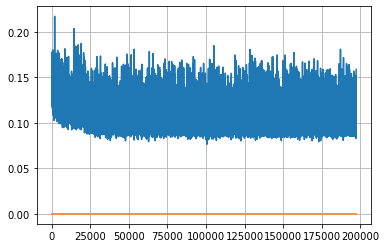

Epoch: 506, iteration 0, loss 0.10899549722671509, cov_diff 0.39604914986427664 cov_diff train 0.39542810134811335
Epoch: 506, iteration 1, loss 0.10228729248046875, cov_diff 0.4125135796579945 cov_diff train 0.4109123740507302
Epoch: 506, iteration 2, loss 0.09394922852516174, cov_diff 0.4116125687882411 cov_diff train 0.4106316148178519
Epoch: 506, iteration 3, loss 0.0917409360408783, cov_diff 0.40015008971435945 cov_diff train 0.39959646051383885
Epoch: 506, iteration 4, loss 0.10162308812141418, cov_diff 0.4019730651195268 cov_diff train 0.4011704140853553
Epoch: 506, iteration 5, loss 0.10239145159721375, cov_diff 0.4147888777203747 cov_diff train 0.413324307623177
Epoch: 506, iteration 6, loss 0.11355993151664734, cov_diff 0.4068778123806266 cov_diff train 0.40666062631955274
Epoch: 506, iteration 7, loss 0.10811606049537659, cov_diff 0.40223963778856486 cov_diff train 0.40203114768393555
Epoch: 506, iteration 8, loss 0.10173183679580688, cov_diff 0.40566025961513896 cov_diff tr

Epoch: 506, iteration 78, loss 0.0993744432926178, cov_diff 0.40645138672440584 cov_diff train 0.4061377256587957
Epoch: 506, iteration 79, loss 0.10953643918037415, cov_diff 0.4068892939689326 cov_diff train 0.40542341225344847
Epoch: 506, iteration 80, loss 0.10139816999435425, cov_diff 0.41024229688442965 cov_diff train 0.4098724496196634
Epoch: 506, iteration 81, loss 0.10415303707122803, cov_diff 0.4084089104153058 cov_diff train 0.40712577238387543
Epoch: 506, iteration 82, loss 0.10887083411216736, cov_diff 0.41448268466920873 cov_diff train 0.4134694428035749
Epoch: 506, iteration 83, loss 0.0941038429737091, cov_diff 0.40815750197108824 cov_diff train 0.4068118413175907
Epoch: 506, iteration 84, loss 0.11025294661521912, cov_diff 0.4044959403892749 cov_diff train 0.4027882284052076
Epoch: 506, iteration 85, loss 0.10254314541816711, cov_diff 0.39579305044648505 cov_diff train 0.3954783441196959
Epoch: 506, iteration 86, loss 0.09855243563652039, cov_diff 0.40370966827078103 co

Epoch: 506, iteration 156, loss 0.10408684611320496, cov_diff 0.4155812039276612 cov_diff train 0.41491883301478155
Epoch: 506, iteration 157, loss 0.10827070474624634, cov_diff 0.4068476973510401 cov_diff train 0.4061231736715841
Epoch: 506, iteration 158, loss 0.10306084156036377, cov_diff 0.41101578222540486 cov_diff train 0.4104285824982319
Epoch: 506, iteration 159, loss 0.09728240966796875, cov_diff 0.41158166418206843 cov_diff train 0.4101586928129909
Epoch: 506, iteration 160, loss 0.09320220351219177, cov_diff 0.41917633608284555 cov_diff train 0.41880571486309304
Epoch: 506, iteration 161, loss 0.10761484503746033, cov_diff 0.4177244718736853 cov_diff train 0.416870189480735
Epoch: 506, iteration 162, loss 0.11043953895568848, cov_diff 0.41270226239336194 cov_diff train 0.4117814290137971
Epoch: 506, iteration 163, loss 0.10801410675048828, cov_diff 0.4078126890022115 cov_diff train 0.4065973491347216
Epoch: 506, iteration 164, loss 0.10115644335746765, cov_diff 0.42109306937

Epoch: 506, iteration 234, loss 0.11082601547241211, cov_diff 0.4182787820962631 cov_diff train 0.41748788831869854
Epoch: 506, iteration 235, loss 0.093655526638031, cov_diff 0.40193224593672466 cov_diff train 0.4013460430099657
Epoch: 506, iteration 236, loss 0.09870681166648865, cov_diff 0.40890134654047633 cov_diff train 0.4088777910608986
Epoch: 506, iteration 237, loss 0.1031404435634613, cov_diff 0.40156952325971673 cov_diff train 0.4016577929306887
Epoch: 506, iteration 238, loss 0.10763019323348999, cov_diff 0.40416791497482357 cov_diff train 0.40411806193855954
Epoch: 506, iteration 239, loss 0.10018330812454224, cov_diff 0.4048457692765616 cov_diff train 0.4047868631227302
Epoch: 506, iteration 240, loss 0.10138127207756042, cov_diff 0.39404377786072975 cov_diff train 0.39332579258367484
Epoch: 506, iteration 241, loss 0.10800346732139587, cov_diff 0.40866672431117673 cov_diff train 0.4085711365423266
Epoch: 506, iteration 242, loss 0.11345362663269043, cov_diff 0.4089853443

Epoch: 506, iteration 313, loss 0.10626852512359619, cov_diff 0.41280000870129435 cov_diff train 0.41094444128277
Epoch: 506, iteration 314, loss 0.10566657781600952, cov_diff 0.4041546828304583 cov_diff train 0.40438792387549466
Epoch: 506, iteration 315, loss 0.10372093319892883, cov_diff 0.41060402087861525 cov_diff train 0.4100587503041541
Epoch: 506, iteration 316, loss 0.10530322790145874, cov_diff 0.41435586541526276 cov_diff train 0.41333875699618183
Epoch: 506, iteration 317, loss 0.1282571256160736, cov_diff 0.4022823444955984 cov_diff train 0.4019904935236034
Epoch: 506, iteration 318, loss 0.10673573613166809, cov_diff 0.4049079253013753 cov_diff train 0.40373356134168076
Epoch: 506, iteration 319, loss 0.1003197729587555, cov_diff 0.40735756184162825 cov_diff train 0.4075566771428581
Epoch: 506, iteration 320, loss 0.10807478427886963, cov_diff 0.4143298082538921 cov_diff train 0.4143879035437155
Epoch: 506, iteration 321, loss 0.09878590703010559, cov_diff 0.4162627982758

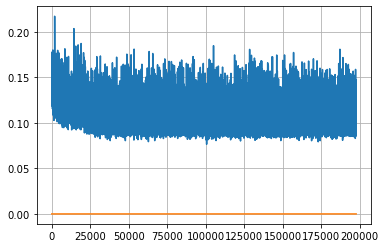

Epoch: 507, iteration 0, loss 0.09937071800231934, cov_diff 0.4095835548888922 cov_diff train 0.4087599329228859
Epoch: 507, iteration 1, loss 0.1034841239452362, cov_diff 0.40016993946420804 cov_diff train 0.40080288052734364
Epoch: 507, iteration 2, loss 0.09928441047668457, cov_diff 0.4039353402935954 cov_diff train 0.4037873107923813
Epoch: 507, iteration 3, loss 0.10390090942382812, cov_diff 0.4129500286646713 cov_diff train 0.4129042123659846
Epoch: 507, iteration 4, loss 0.10241153836250305, cov_diff 0.4183273327884067 cov_diff train 0.4181573632801175
Epoch: 507, iteration 5, loss 0.09529781341552734, cov_diff 0.40023242372443824 cov_diff train 0.40039320267023526
Epoch: 507, iteration 6, loss 0.0951734185218811, cov_diff 0.40796544376980365 cov_diff train 0.4072169453806097
Epoch: 507, iteration 7, loss 0.11349943280220032, cov_diff 0.41179575815725467 cov_diff train 0.4113965900475831
Epoch: 507, iteration 8, loss 0.10648283362388611, cov_diff 0.413470950489167 cov_diff train

Epoch: 507, iteration 77, loss 0.10336250066757202, cov_diff 0.4180684765989212 cov_diff train 0.4172501188686967
Epoch: 507, iteration 78, loss 0.11200985312461853, cov_diff 0.4099969944142959 cov_diff train 0.41012333623341474
Epoch: 507, iteration 79, loss 0.12013038992881775, cov_diff 0.4196097866409129 cov_diff train 0.4192830015526918
Epoch: 507, iteration 80, loss 0.11348456144332886, cov_diff 0.4115656899457728 cov_diff train 0.4114313660338904
Epoch: 507, iteration 81, loss 0.10681113600730896, cov_diff 0.4037711157704721 cov_diff train 0.40349572852229615
Epoch: 507, iteration 82, loss 0.10106131434440613, cov_diff 0.3985945477924496 cov_diff train 0.3986413627212073
Epoch: 507, iteration 83, loss 0.09411656856536865, cov_diff 0.40837561326729005 cov_diff train 0.40782101204451165
Epoch: 507, iteration 84, loss 0.10700458288192749, cov_diff 0.4214100443432429 cov_diff train 0.42003277586680815
Epoch: 507, iteration 85, loss 0.1101207435131073, cov_diff 0.41378020598008164 cov

Epoch: 507, iteration 153, loss 0.10215038061141968, cov_diff 0.40083913256247156 cov_diff train 0.3999036695816358
Epoch: 507, iteration 154, loss 0.1005423367023468, cov_diff 0.413795230014112 cov_diff train 0.41370431520268997
Epoch: 507, iteration 155, loss 0.11181652545928955, cov_diff 0.41775981207966206 cov_diff train 0.4169578701537693
Epoch: 507, iteration 156, loss 0.09964072704315186, cov_diff 0.4011485643194912 cov_diff train 0.40083210140529085
Epoch: 507, iteration 157, loss 0.10881578922271729, cov_diff 0.40378045885283254 cov_diff train 0.4016681535081642
Epoch: 507, iteration 158, loss 0.10062563419342041, cov_diff 0.4051771123169945 cov_diff train 0.4046057613099618
Epoch: 507, iteration 159, loss 0.10417807102203369, cov_diff 0.4043790212939421 cov_diff train 0.4035966235015434
Epoch: 507, iteration 160, loss 0.11555096507072449, cov_diff 0.418440641641526 cov_diff train 0.4179306565210956
Epoch: 507, iteration 161, loss 0.10610908269882202, cov_diff 0.41835800351828

Epoch: 507, iteration 234, loss 0.0915808379650116, cov_diff 0.41770628086529965 cov_diff train 0.41739082060231547
Epoch: 507, iteration 235, loss 0.10319840908050537, cov_diff 0.40400745882875555 cov_diff train 0.4036177607225585
Epoch: 507, iteration 236, loss 0.10399124026298523, cov_diff 0.41921584516827093 cov_diff train 0.4184577201818157
Epoch: 507, iteration 237, loss 0.1096123456954956, cov_diff 0.4118477028465835 cov_diff train 0.41154226013150014
Epoch: 507, iteration 238, loss 0.11124679446220398, cov_diff 0.4152120193345951 cov_diff train 0.4143956389467049
Epoch: 507, iteration 239, loss 0.10149243474006653, cov_diff 0.4073011125917922 cov_diff train 0.40708656532416293
Epoch: 507, iteration 240, loss 0.09261444211006165, cov_diff 0.4164988618668476 cov_diff train 0.41617129571545075
Epoch: 507, iteration 241, loss 0.09136688709259033, cov_diff 0.41481002688551294 cov_diff train 0.4144869041249203
Epoch: 507, iteration 242, loss 0.1039394736289978, cov_diff 0.40109215408

Epoch: 507, iteration 313, loss 0.11140277981758118, cov_diff 0.39870362259782166 cov_diff train 0.3992168234039495
Epoch: 507, iteration 314, loss 0.11049452424049377, cov_diff 0.4159395499076965 cov_diff train 0.41515985574812864
Epoch: 507, iteration 315, loss 0.11001831293106079, cov_diff 0.4046576384468213 cov_diff train 0.40197888873568416
Epoch: 507, iteration 316, loss 0.09325245022773743, cov_diff 0.4087660193859017 cov_diff train 0.40786974922422525
Epoch: 507, iteration 317, loss 0.11228308081626892, cov_diff 0.4021570363709969 cov_diff train 0.4026398541811434
Epoch: 507, iteration 318, loss 0.1200469434261322, cov_diff 0.42200101628899833 cov_diff train 0.42212198231832054
Epoch: 507, iteration 319, loss 0.10650858283042908, cov_diff 0.4124874429695326 cov_diff train 0.41162082877501494
Epoch: 507, iteration 320, loss 0.1042565405368805, cov_diff 0.4052150805919695 cov_diff train 0.4055864653215126
Epoch: 507, iteration 321, loss 0.10353982448577881, cov_diff 0.40919935937

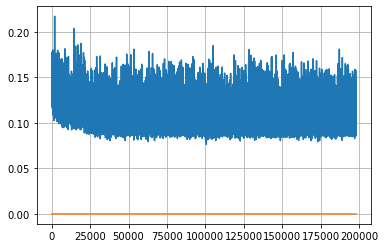

Epoch: 508, iteration 0, loss 0.1007247269153595, cov_diff 0.40218234858142776 cov_diff train 0.40220124019181547
Epoch: 508, iteration 1, loss 0.09116348624229431, cov_diff 0.40648861016533083 cov_diff train 0.4058742566538296
Epoch: 508, iteration 2, loss 0.10102114081382751, cov_diff 0.40560550862982003 cov_diff train 0.4053389927951485
Epoch: 508, iteration 3, loss 0.10550403594970703, cov_diff 0.40645046538888757 cov_diff train 0.406787149587517
Epoch: 508, iteration 4, loss 0.10477876663208008, cov_diff 0.4135861882197867 cov_diff train 0.4139973308591828
Epoch: 508, iteration 5, loss 0.10587012767791748, cov_diff 0.42144479544397295 cov_diff train 0.4212659230288922
Epoch: 508, iteration 6, loss 0.1088252067565918, cov_diff 0.41081735781081735 cov_diff train 0.4097905814187957
Epoch: 508, iteration 7, loss 0.10184240341186523, cov_diff 0.40178573578703397 cov_diff train 0.3997051025569432
Epoch: 508, iteration 8, loss 0.09501135349273682, cov_diff 0.4174223324532525 cov_diff tra

Epoch: 508, iteration 83, loss 0.09693321585655212, cov_diff 0.40294373109463333 cov_diff train 0.4014127710652288
Epoch: 508, iteration 84, loss 0.09947428107261658, cov_diff 0.4173417958805081 cov_diff train 0.41682705407910875
Epoch: 508, iteration 85, loss 0.10093316435813904, cov_diff 0.4028247977523956 cov_diff train 0.40251267018223125
Epoch: 508, iteration 86, loss 0.11453267931938171, cov_diff 0.4091151104637345 cov_diff train 0.4088243060886647
Epoch: 508, iteration 87, loss 0.10645464062690735, cov_diff 0.40823664681224225 cov_diff train 0.40829424365758354
Epoch: 508, iteration 88, loss 0.10414454340934753, cov_diff 0.4087896711826806 cov_diff train 0.40855516399578024
Epoch: 508, iteration 89, loss 0.10361772775650024, cov_diff 0.4177916430742883 cov_diff train 0.4167669343734204
Epoch: 508, iteration 90, loss 0.10452777147293091, cov_diff 0.405360335137556 cov_diff train 0.4044861656785815
Epoch: 508, iteration 91, loss 0.10729825496673584, cov_diff 0.4079879478043924 cov

Epoch: 508, iteration 163, loss 0.10914137959480286, cov_diff 0.4159852643258217 cov_diff train 0.4145298389091891
Epoch: 508, iteration 164, loss 0.11332985758781433, cov_diff 0.42050250918810805 cov_diff train 0.41967641090167335
Epoch: 508, iteration 165, loss 0.08908268809318542, cov_diff 0.4037115281817147 cov_diff train 0.4030787923429592
Epoch: 508, iteration 166, loss 0.0965685248374939, cov_diff 0.4109646338518318 cov_diff train 0.4097104868283824
Epoch: 508, iteration 167, loss 0.09886473417282104, cov_diff 0.41360153489596546 cov_diff train 0.41252500721393304
Epoch: 508, iteration 168, loss 0.10012787580490112, cov_diff 0.4244746410435264 cov_diff train 0.42364254844188676
Epoch: 508, iteration 169, loss 0.10377556085586548, cov_diff 0.4026982752095969 cov_diff train 0.4013417601824241
Epoch: 508, iteration 170, loss 0.0978747010231018, cov_diff 0.41085840026541764 cov_diff train 0.409349525110345
Epoch: 508, iteration 171, loss 0.11226272583007812, cov_diff 0.4159005342140

Epoch: 508, iteration 242, loss 0.10918927192687988, cov_diff 0.4031630864769366 cov_diff train 0.40258078225897326
Epoch: 508, iteration 243, loss 0.09911221265792847, cov_diff 0.3900216388654538 cov_diff train 0.3896483674088547
Epoch: 508, iteration 244, loss 0.10527592897415161, cov_diff 0.4137153100447177 cov_diff train 0.41371296036728733
Epoch: 508, iteration 245, loss 0.09631294012069702, cov_diff 0.4051929252772354 cov_diff train 0.4050329425523366
Epoch: 508, iteration 246, loss 0.10545122623443604, cov_diff 0.4039866580042573 cov_diff train 0.4042812018856743
Epoch: 508, iteration 247, loss 0.10241544246673584, cov_diff 0.3992077275763458 cov_diff train 0.3993282271797192
Epoch: 508, iteration 248, loss 0.1083034873008728, cov_diff 0.3963938388735118 cov_diff train 0.39625592155537714
Epoch: 508, iteration 249, loss 0.10603129863739014, cov_diff 0.41336170316190657 cov_diff train 0.4126697364551548
Epoch: 508, iteration 250, loss 0.10394755005836487, cov_diff 0.4232831262571

Epoch: 508, iteration 317, loss 0.09697094559669495, cov_diff 0.4077560172190217 cov_diff train 0.40742423912431264
Epoch: 508, iteration 318, loss 0.10135096311569214, cov_diff 0.4178145999000914 cov_diff train 0.4165366645311318
Epoch: 508, iteration 319, loss 0.08912363648414612, cov_diff 0.4034273283539472 cov_diff train 0.40310740729709377
Epoch: 508, iteration 320, loss 0.10303458571434021, cov_diff 0.4123023728945829 cov_diff train 0.41135759157760027
Epoch: 508, iteration 321, loss 0.10115700960159302, cov_diff 0.4166801059977129 cov_diff train 0.4157517199305235
Epoch: 508, iteration 322, loss 0.11221620440483093, cov_diff 0.41941284254121625 cov_diff train 0.41806929828676237
Epoch: 508, iteration 323, loss 0.10525742173194885, cov_diff 0.419436494681007 cov_diff train 0.4190255638006005
Epoch: 508, iteration 324, loss 0.10240164399147034, cov_diff 0.40728140959587433 cov_diff train 0.4066421919462202
Epoch: 508, iteration 325, loss 0.09754884243011475, cov_diff 0.40998511859

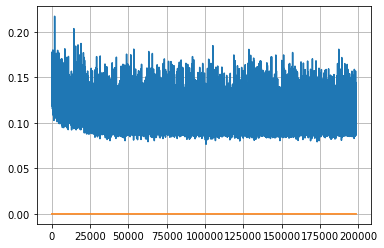

Epoch: 509, iteration 0, loss 0.10126546025276184, cov_diff 0.4015173750607071 cov_diff train 0.4015110760541561
Epoch: 509, iteration 1, loss 0.10145813226699829, cov_diff 0.4081395644282576 cov_diff train 0.40768021257636433
Epoch: 509, iteration 2, loss 0.10569468140602112, cov_diff 0.40245563536987455 cov_diff train 0.4016884093791013
Epoch: 509, iteration 3, loss 0.10648098587989807, cov_diff 0.4211126382937265 cov_diff train 0.41945135493670366
Epoch: 509, iteration 4, loss 0.09785833954811096, cov_diff 0.40684674095168905 cov_diff train 0.4065110806679421
Epoch: 509, iteration 5, loss 0.09370440244674683, cov_diff 0.40973242295513806 cov_diff train 0.40884509754758414
Epoch: 509, iteration 6, loss 0.09477353096008301, cov_diff 0.42257724983934153 cov_diff train 0.4221942460463016
Epoch: 509, iteration 7, loss 0.09846210479736328, cov_diff 0.40376827462476156 cov_diff train 0.40395158771544315
Epoch: 509, iteration 8, loss 0.09287944436073303, cov_diff 0.406435215069733 cov_diff 

Epoch: 509, iteration 75, loss 0.11034557223320007, cov_diff 0.40254438934738795 cov_diff train 0.40283141524056565
Epoch: 509, iteration 76, loss 0.11507666110992432, cov_diff 0.4165011700615348 cov_diff train 0.4160627926226951
Epoch: 509, iteration 77, loss 0.11136922240257263, cov_diff 0.40346370738869947 cov_diff train 0.40231222809833317
Epoch: 509, iteration 78, loss 0.10466352105140686, cov_diff 0.40927757618515936 cov_diff train 0.4095247458941977
Epoch: 509, iteration 79, loss 0.10261526703834534, cov_diff 0.4062883332737573 cov_diff train 0.40545373821317376
Epoch: 509, iteration 80, loss 0.10106533765792847, cov_diff 0.4069721279844554 cov_diff train 0.4063292534765126
Epoch: 509, iteration 81, loss 0.10541874170303345, cov_diff 0.42203661884343446 cov_diff train 0.4216570157586034
Epoch: 509, iteration 82, loss 0.09317934513092041, cov_diff 0.4155892772069066 cov_diff train 0.4147389744292143
Epoch: 509, iteration 83, loss 0.10699543356895447, cov_diff 0.42370785334879935 

Epoch: 509, iteration 155, loss 0.09904208779335022, cov_diff 0.41309914370809253 cov_diff train 0.4119809149400826
Epoch: 509, iteration 156, loss 0.09079313278198242, cov_diff 0.39367719536679646 cov_diff train 0.3920752052238949
Epoch: 509, iteration 157, loss 0.10898563265800476, cov_diff 0.4123367182850132 cov_diff train 0.4124369107422024
Epoch: 509, iteration 158, loss 0.10389479994773865, cov_diff 0.4009763260983504 cov_diff train 0.39999590978623645
Epoch: 509, iteration 159, loss 0.0956827700138092, cov_diff 0.4078448225544759 cov_diff train 0.4072036865670343
Epoch: 509, iteration 160, loss 0.09298646450042725, cov_diff 0.39444784092175994 cov_diff train 0.3937391043628809
Epoch: 509, iteration 161, loss 0.11684000492095947, cov_diff 0.4117485497101227 cov_diff train 0.41083182331636947
Epoch: 509, iteration 162, loss 0.10596409440040588, cov_diff 0.4032800630188775 cov_diff train 0.4023821642963461
Epoch: 509, iteration 163, loss 0.10143694281578064, cov_diff 0.405374060860

Epoch: 509, iteration 236, loss 0.10552030801773071, cov_diff 0.39964281857963074 cov_diff train 0.3993995894537798
Epoch: 509, iteration 237, loss 0.11547499895095825, cov_diff 0.4118522354422415 cov_diff train 0.4105087486334742
Epoch: 509, iteration 238, loss 0.10623705387115479, cov_diff 0.40696145319397825 cov_diff train 0.4067958185841937
Epoch: 509, iteration 239, loss 0.10804593563079834, cov_diff 0.4011519374159159 cov_diff train 0.4014797445725736
Epoch: 509, iteration 240, loss 0.09573736786842346, cov_diff 0.42041248176875895 cov_diff train 0.4200141968096503
Epoch: 509, iteration 241, loss 0.0990062952041626, cov_diff 0.41412056815116427 cov_diff train 0.4137268103165888
Epoch: 509, iteration 242, loss 0.10531812906265259, cov_diff 0.41479336284530544 cov_diff train 0.41358374951680077
Epoch: 509, iteration 243, loss 0.10197716951370239, cov_diff 0.40932031911548933 cov_diff train 0.4092244879229688
Epoch: 509, iteration 244, loss 0.11008864641189575, cov_diff 0.4223726815

Epoch: 509, iteration 313, loss 0.12121343612670898, cov_diff 0.4226836277787104 cov_diff train 0.4219309352691868
Epoch: 509, iteration 314, loss 0.09955117106437683, cov_diff 0.4094000982077334 cov_diff train 0.4091869401147812
Epoch: 509, iteration 315, loss 0.09919041395187378, cov_diff 0.40457715158286606 cov_diff train 0.40338222278769303
Epoch: 509, iteration 316, loss 0.10845625400543213, cov_diff 0.4138741324811124 cov_diff train 0.413261869786863
Epoch: 509, iteration 317, loss 0.10533344745635986, cov_diff 0.41919204895465073 cov_diff train 0.4181315242381243
Epoch: 509, iteration 318, loss 0.1055448055267334, cov_diff 0.41011003695213244 cov_diff train 0.40894046350526003
Epoch: 509, iteration 319, loss 0.10216343402862549, cov_diff 0.4051753705472412 cov_diff train 0.4045486418077493
Epoch: 509, iteration 320, loss 0.09675255417823792, cov_diff 0.3910356733120871 cov_diff train 0.3908772781345363
Epoch: 509, iteration 321, loss 0.10032114386558533, cov_diff 0.4151668841895

Epoch: 509, iteration 384, loss 0.10465890169143677, cov_diff 0.4254855964050913 cov_diff train 0.4241399432767704
Epoch: 509, iteration 385, loss 0.09224909543991089, cov_diff 0.4241371787162447 cov_diff train 0.4230008357431391
Epoch: 509, iteration 386, loss 0.09120786190032959, cov_diff 0.4009728619694256 cov_diff train 0.3997978363972372
Epoch: 509, iteration 387, loss 0.1237117350101471, cov_diff 0.4008682310944695 cov_diff train 0.40076543909564194
Epoch: 509, iteration 388, loss 0.08500593900680542, cov_diff 0.411378796998013 cov_diff train 0.41004972765610825
Epoch: 509, iteration 389, loss 0.10103687644004822, cov_diff 0.408201961401064 cov_diff train 0.407737580370976
Epoch: 509, iteration 390, loss 0.15076300501823425, cov_diff 0.4568228260527929 cov_diff train 0.45648188914555393


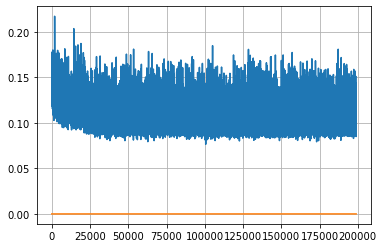

Epoch: 510, iteration 0, loss 0.10223546624183655, cov_diff 0.408749021131326 cov_diff train 0.4075415665866862
Epoch: 510, iteration 1, loss 0.10559964179992676, cov_diff 0.4062768337435997 cov_diff train 0.40564986555274263
Epoch: 510, iteration 2, loss 0.09607189893722534, cov_diff 0.40277530196533806 cov_diff train 0.4025072323581424
Epoch: 510, iteration 3, loss 0.10305684804916382, cov_diff 0.41012222767939854 cov_diff train 0.4096607513079205
Epoch: 510, iteration 4, loss 0.09322768449783325, cov_diff 0.4189062635034423 cov_diff train 0.41838292080969125
Epoch: 510, iteration 5, loss 0.10832521319389343, cov_diff 0.41275805647823866 cov_diff train 0.41278147293901873
Epoch: 510, iteration 6, loss 0.1008133590221405, cov_diff 0.4140479233057527 cov_diff train 0.4143861665043306
Epoch: 510, iteration 7, loss 0.10222071409225464, cov_diff 0.4086603615743058 cov_diff train 0.40785422442704017
Epoch: 510, iteration 8, loss 0.11193901300430298, cov_diff 0.4029581143675266 cov_diff tra

Epoch: 510, iteration 80, loss 0.1148165762424469, cov_diff 0.3998787793933085 cov_diff train 0.39899526864783713
Epoch: 510, iteration 81, loss 0.10553455352783203, cov_diff 0.4089165385311635 cov_diff train 0.40777576145180894
Epoch: 510, iteration 82, loss 0.10313504934310913, cov_diff 0.4153890879713958 cov_diff train 0.41461269066790607
Epoch: 510, iteration 83, loss 0.10272467136383057, cov_diff 0.41988489631263987 cov_diff train 0.4201953764217242
Epoch: 510, iteration 84, loss 0.09941580891609192, cov_diff 0.41061621857964103 cov_diff train 0.4105182430339876
Epoch: 510, iteration 85, loss 0.10247597098350525, cov_diff 0.41846233531870763 cov_diff train 0.41751348174453073
Epoch: 510, iteration 86, loss 0.0997583270072937, cov_diff 0.4065819582270133 cov_diff train 0.40680540584304586
Epoch: 510, iteration 87, loss 0.10548985004425049, cov_diff 0.41581793715150595 cov_diff train 0.41529393662241315
Epoch: 510, iteration 88, loss 0.10677951574325562, cov_diff 0.4053096092189086 

Epoch: 510, iteration 161, loss 0.09837061166763306, cov_diff 0.42361014310638484 cov_diff train 0.42332096954387965
Epoch: 510, iteration 162, loss 0.09414535760879517, cov_diff 0.4131823031779239 cov_diff train 0.41246009989287064
Epoch: 510, iteration 163, loss 0.09955397248268127, cov_diff 0.413641823421711 cov_diff train 0.41289713851689847
Epoch: 510, iteration 164, loss 0.09526675939559937, cov_diff 0.41555867141135927 cov_diff train 0.4143235096972569
Epoch: 510, iteration 165, loss 0.10274064540863037, cov_diff 0.39712083707413887 cov_diff train 0.3969467158393675
Epoch: 510, iteration 166, loss 0.10372260212898254, cov_diff 0.40747994451990066 cov_diff train 0.40682455414746943
Epoch: 510, iteration 167, loss 0.10502061247825623, cov_diff 0.39961030897977967 cov_diff train 0.39944394510525616
Epoch: 510, iteration 168, loss 0.10097581148147583, cov_diff 0.42402550163690456 cov_diff train 0.42409353091106267
Epoch: 510, iteration 169, loss 0.1094893217086792, cov_diff 0.419479

Epoch: 510, iteration 240, loss 0.09987446665763855, cov_diff 0.4266808967178788 cov_diff train 0.42542560007243874
Epoch: 510, iteration 241, loss 0.10203990340232849, cov_diff 0.40775763362849965 cov_diff train 0.40773267426424914
Epoch: 510, iteration 242, loss 0.10768955945968628, cov_diff 0.41865039652536923 cov_diff train 0.4164454720504826
Epoch: 510, iteration 243, loss 0.10479435324668884, cov_diff 0.39465601391930066 cov_diff train 0.3944742446425073
Epoch: 510, iteration 244, loss 0.09989568591117859, cov_diff 0.41065683040518325 cov_diff train 0.4100461085927187
Epoch: 510, iteration 245, loss 0.09544223546981812, cov_diff 0.4096529780339356 cov_diff train 0.40885106500061746
Epoch: 510, iteration 246, loss 0.10870695114135742, cov_diff 0.40739460064075966 cov_diff train 0.40634015618074243
Epoch: 510, iteration 247, loss 0.09661424160003662, cov_diff 0.41258537423971736 cov_diff train 0.41205139059528545
Epoch: 510, iteration 248, loss 0.11320152878761292, cov_diff 0.41032

Epoch: 510, iteration 320, loss 0.1066998541355133, cov_diff 0.40596807957232184 cov_diff train 0.4049052373237096
Epoch: 510, iteration 321, loss 0.09909877181053162, cov_diff 0.41111245313371075 cov_diff train 0.409482087300877
Epoch: 510, iteration 322, loss 0.11304321885108948, cov_diff 0.4163767072187974 cov_diff train 0.41495445800363523
Epoch: 510, iteration 323, loss 0.09436780214309692, cov_diff 0.4159045232344584 cov_diff train 0.4150257262587527
Epoch: 510, iteration 324, loss 0.09622824192047119, cov_diff 0.4054331924031261 cov_diff train 0.4045206826475923
Epoch: 510, iteration 325, loss 0.11392468214035034, cov_diff 0.41238489012774476 cov_diff train 0.41193621911580663
Epoch: 510, iteration 326, loss 0.1000007688999176, cov_diff 0.40078682606595106 cov_diff train 0.39929862728888055
Epoch: 510, iteration 327, loss 0.09661957621574402, cov_diff 0.4030449065065578 cov_diff train 0.40318388606597105
Epoch: 510, iteration 328, loss 0.10092750191688538, cov_diff 0.39930003439

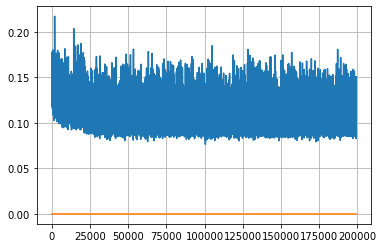

Epoch: 511, iteration 0, loss 0.09796702861785889, cov_diff 0.409324880847526 cov_diff train 0.40845216874289014
Epoch: 511, iteration 1, loss 0.09155425429344177, cov_diff 0.41142556911705075 cov_diff train 0.41047407531516855
Epoch: 511, iteration 2, loss 0.10534361004829407, cov_diff 0.4094751873502477 cov_diff train 0.409334159403317
Epoch: 511, iteration 3, loss 0.09785094857215881, cov_diff 0.4127982404292174 cov_diff train 0.4123454989874759
Epoch: 511, iteration 4, loss 0.1133522093296051, cov_diff 0.40150991071889625 cov_diff train 0.40109368895021696
Epoch: 511, iteration 5, loss 0.10143381357192993, cov_diff 0.4044770377783725 cov_diff train 0.40436385205778935
Epoch: 511, iteration 6, loss 0.1018831729888916, cov_diff 0.4231029711233048 cov_diff train 0.4223163439090816
Epoch: 511, iteration 7, loss 0.10014253854751587, cov_diff 0.4201627744693844 cov_diff train 0.4193226399326364
Epoch: 511, iteration 8, loss 0.10492941737174988, cov_diff 0.413248504063345 cov_diff train 0

Epoch: 511, iteration 78, loss 0.10173940658569336, cov_diff 0.40621008826531 cov_diff train 0.40476658517377256
Epoch: 511, iteration 79, loss 0.10637587308883667, cov_diff 0.4113195415612463 cov_diff train 0.4098263230403701
Epoch: 511, iteration 80, loss 0.11010095477104187, cov_diff 0.4135119505250957 cov_diff train 0.41200865856267743
Epoch: 511, iteration 81, loss 0.09769460558891296, cov_diff 0.4096207083778655 cov_diff train 0.40936988756746034
Epoch: 511, iteration 82, loss 0.10564225912094116, cov_diff 0.39858489940526953 cov_diff train 0.3986517655914542
Epoch: 511, iteration 83, loss 0.09888055920600891, cov_diff 0.4091527573195967 cov_diff train 0.40922246925538636
Epoch: 511, iteration 84, loss 0.10830026865005493, cov_diff 0.42110376816055256 cov_diff train 0.4204262213473891
Epoch: 511, iteration 85, loss 0.1148269772529602, cov_diff 0.4021843763272163 cov_diff train 0.40048533008372467
Epoch: 511, iteration 86, loss 0.09865120053291321, cov_diff 0.40598778264814117 cov

Epoch: 511, iteration 156, loss 0.09150490164756775, cov_diff 0.40991391219020984 cov_diff train 0.4086148535260963
Epoch: 511, iteration 157, loss 0.09734013676643372, cov_diff 0.40562618395445904 cov_diff train 0.40509908084816554
Epoch: 511, iteration 158, loss 0.10461360216140747, cov_diff 0.4107885034416112 cov_diff train 0.4105483033317891
Epoch: 511, iteration 159, loss 0.1175912618637085, cov_diff 0.41145114725126136 cov_diff train 0.4113675230025611
Epoch: 511, iteration 160, loss 0.10482844710350037, cov_diff 0.4168842624566574 cov_diff train 0.415955283681026
Epoch: 511, iteration 161, loss 0.09227237105369568, cov_diff 0.4154735607544439 cov_diff train 0.41472224583153217
Epoch: 511, iteration 162, loss 0.10282054543495178, cov_diff 0.40378455202824776 cov_diff train 0.4028151228915551
Epoch: 511, iteration 163, loss 0.10728123784065247, cov_diff 0.40879836344577175 cov_diff train 0.40820591163417014
Epoch: 511, iteration 164, loss 0.10223621129989624, cov_diff 0.4131625479

Epoch: 511, iteration 234, loss 0.11338865756988525, cov_diff 0.4092686281018616 cov_diff train 0.40832413934603873
Epoch: 511, iteration 235, loss 0.0977487564086914, cov_diff 0.40661996090063635 cov_diff train 0.40562830254679827
Epoch: 511, iteration 236, loss 0.10349613428115845, cov_diff 0.40709212827947594 cov_diff train 0.4065150641836017
Epoch: 511, iteration 237, loss 0.10567781329154968, cov_diff 0.4006049265924972 cov_diff train 0.4000717975996162
Epoch: 511, iteration 238, loss 0.11273819208145142, cov_diff 0.40937170032182146 cov_diff train 0.4076942726611516
Epoch: 511, iteration 239, loss 0.11480063199996948, cov_diff 0.4170860931646582 cov_diff train 0.41616930381453165
Epoch: 511, iteration 240, loss 0.10456424951553345, cov_diff 0.4179548465830887 cov_diff train 0.41697002581504367
Epoch: 511, iteration 241, loss 0.10016569495201111, cov_diff 0.40794168238807693 cov_diff train 0.4074099467956815
Epoch: 511, iteration 242, loss 0.10571369528770447, cov_diff 0.424589316

Epoch: 511, iteration 311, loss 0.10094988346099854, cov_diff 0.414498279470646 cov_diff train 0.4137774404107234
Epoch: 511, iteration 312, loss 0.1025686264038086, cov_diff 0.4160281279291311 cov_diff train 0.4148137012999302
Epoch: 511, iteration 313, loss 0.120606929063797, cov_diff 0.4049723722651301 cov_diff train 0.4048109229951498
Epoch: 511, iteration 314, loss 0.10735967755317688, cov_diff 0.4051872901502527 cov_diff train 0.4043373366740335
Epoch: 511, iteration 315, loss 0.10052061080932617, cov_diff 0.408579406957759 cov_diff train 0.40799634652189926
Epoch: 511, iteration 316, loss 0.10893583297729492, cov_diff 0.4019537199188126 cov_diff train 0.40233815876473483
Epoch: 511, iteration 317, loss 0.10081696510314941, cov_diff 0.4138647354616179 cov_diff train 0.4133676643486824
Epoch: 511, iteration 318, loss 0.10989221930503845, cov_diff 0.42252316434253595 cov_diff train 0.42242379586293555
Epoch: 511, iteration 319, loss 0.09820866584777832, cov_diff 0.4182867936286699 

Epoch: 511, iteration 389, loss 0.10048845410346985, cov_diff 0.4180930593605596 cov_diff train 0.41796527422792856
Epoch: 511, iteration 390, loss 0.14145886898040771, cov_diff 0.44195359130852957 cov_diff train 0.4416494915984228


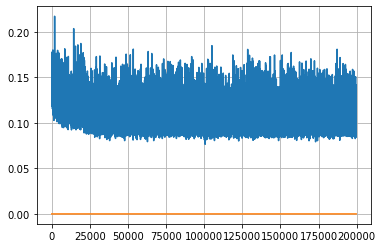

Epoch: 512, iteration 0, loss 0.0982639491558075, cov_diff 0.4072457016698339 cov_diff train 0.4080826631929666
Epoch: 512, iteration 1, loss 0.09977638721466064, cov_diff 0.41907530645423413 cov_diff train 0.41891473208408514
Epoch: 512, iteration 2, loss 0.099212646484375, cov_diff 0.39953982122915077 cov_diff train 0.3996560392040667
Epoch: 512, iteration 3, loss 0.10851481556892395, cov_diff 0.4073045510386726 cov_diff train 0.4066587469295768
Epoch: 512, iteration 4, loss 0.10612070560455322, cov_diff 0.4057520275587721 cov_diff train 0.40593367540306674
Epoch: 512, iteration 5, loss 0.10022294521331787, cov_diff 0.40987095315370986 cov_diff train 0.40925141917040886
Epoch: 512, iteration 6, loss 0.10996982455253601, cov_diff 0.4173315141258671 cov_diff train 0.4169303992813791
Epoch: 512, iteration 7, loss 0.10345149040222168, cov_diff 0.4148103796315001 cov_diff train 0.4145436214765023
Epoch: 512, iteration 8, loss 0.11004441976547241, cov_diff 0.4108374172789052 cov_diff train

Epoch: 512, iteration 81, loss 0.10192963480949402, cov_diff 0.4004787434831931 cov_diff train 0.39962279423569996
Epoch: 512, iteration 82, loss 0.11067244410514832, cov_diff 0.42137060543742205 cov_diff train 0.42145334979229904
Epoch: 512, iteration 83, loss 0.09628018736839294, cov_diff 0.41889610901924873 cov_diff train 0.4180891283591932
Epoch: 512, iteration 84, loss 0.10887861251831055, cov_diff 0.4059610639558657 cov_diff train 0.4054857966189698
Epoch: 512, iteration 85, loss 0.1059909462928772, cov_diff 0.4121760090223902 cov_diff train 0.4114588751534213
Epoch: 512, iteration 86, loss 0.09974753856658936, cov_diff 0.4145930606448748 cov_diff train 0.41457583148041716
Epoch: 512, iteration 87, loss 0.10360667109489441, cov_diff 0.4067675586268466 cov_diff train 0.4070736720876295
Epoch: 512, iteration 88, loss 0.10055997967720032, cov_diff 0.4003702055593234 cov_diff train 0.3997041925285594
Epoch: 512, iteration 89, loss 0.11822757124900818, cov_diff 0.42582188397167325 cov

Epoch: 512, iteration 162, loss 0.10603126883506775, cov_diff 0.40993164018641354 cov_diff train 0.4089056236890524
Epoch: 512, iteration 163, loss 0.09972375631332397, cov_diff 0.4175378534795004 cov_diff train 0.41630483568433113
Epoch: 512, iteration 164, loss 0.09196138381958008, cov_diff 0.40610558627848514 cov_diff train 0.40545785155065955
Epoch: 512, iteration 165, loss 0.09720957279205322, cov_diff 0.42200538405456783 cov_diff train 0.42052412376602255
Epoch: 512, iteration 166, loss 0.09965014457702637, cov_diff 0.4178815209406698 cov_diff train 0.41640486336131305
Epoch: 512, iteration 167, loss 0.09797382354736328, cov_diff 0.40608578559188174 cov_diff train 0.4048258190365297
Epoch: 512, iteration 168, loss 0.10404706001281738, cov_diff 0.42240169162697494 cov_diff train 0.42115180385865125
Epoch: 512, iteration 169, loss 0.1089259684085846, cov_diff 0.4060002310543538 cov_diff train 0.4047545061838897
Epoch: 512, iteration 170, loss 0.10187986493110657, cov_diff 0.4024074

Epoch: 512, iteration 242, loss 0.10699835419654846, cov_diff 0.4166304866418433 cov_diff train 0.41467749485082156
Epoch: 512, iteration 243, loss 0.11710193753242493, cov_diff 0.4172830760689264 cov_diff train 0.4159438025124688
Epoch: 512, iteration 244, loss 0.10564830899238586, cov_diff 0.42307078763163775 cov_diff train 0.4215201885229835
Epoch: 512, iteration 245, loss 0.10250547528266907, cov_diff 0.4187138884536667 cov_diff train 0.4166061738896896
Epoch: 512, iteration 246, loss 0.10208624601364136, cov_diff 0.4037696997734974 cov_diff train 0.40313803373046825
Epoch: 512, iteration 247, loss 0.09579160809516907, cov_diff 0.4142948647477077 cov_diff train 0.41384928104389995
Epoch: 512, iteration 248, loss 0.1040911078453064, cov_diff 0.42330406917349744 cov_diff train 0.4224271812607617
Epoch: 512, iteration 249, loss 0.09536924958229065, cov_diff 0.41239123465340355 cov_diff train 0.4121363805996997
Epoch: 512, iteration 250, loss 0.1009448766708374, cov_diff 0.413343288562

Epoch: 512, iteration 323, loss 0.10498663783073425, cov_diff 0.409953095996882 cov_diff train 0.4090746644561581
Epoch: 512, iteration 324, loss 0.10546442866325378, cov_diff 0.4158215944369784 cov_diff train 0.41455209009787736
Epoch: 512, iteration 325, loss 0.09853717684745789, cov_diff 0.391493218887359 cov_diff train 0.3911160487129305
Epoch: 512, iteration 326, loss 0.09839451313018799, cov_diff 0.4111294589393895 cov_diff train 0.4105363128900434
Epoch: 512, iteration 327, loss 0.1165800392627716, cov_diff 0.41379490973442556 cov_diff train 0.41263775300272876
Epoch: 512, iteration 328, loss 0.10077530145645142, cov_diff 0.39942202731900267 cov_diff train 0.39866232540290836
Epoch: 512, iteration 329, loss 0.10233211517333984, cov_diff 0.40882505842697114 cov_diff train 0.40883936641731966
Epoch: 512, iteration 330, loss 0.10439294576644897, cov_diff 0.41044991901697964 cov_diff train 0.4092451539825558
Epoch: 512, iteration 331, loss 0.0886475145816803, cov_diff 0.422206501927

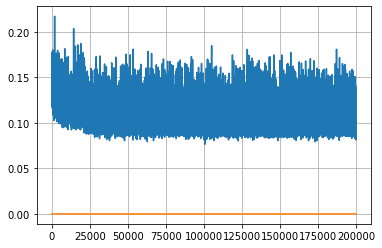

Epoch: 513, iteration 0, loss 0.1061599850654602, cov_diff 0.42004166451623914 cov_diff train 0.41916955733688543
Epoch: 513, iteration 1, loss 0.0980437695980072, cov_diff 0.41235611194458915 cov_diff train 0.41234574071171615
Epoch: 513, iteration 2, loss 0.09793722629547119, cov_diff 0.42199915712540154 cov_diff train 0.42190195593894286
Epoch: 513, iteration 3, loss 0.09955227375030518, cov_diff 0.4165136866728278 cov_diff train 0.4164994767902557
Epoch: 513, iteration 4, loss 0.10865136981010437, cov_diff 0.4120466346691084 cov_diff train 0.41079386351066827
Epoch: 513, iteration 5, loss 0.10530662536621094, cov_diff 0.41925016883270366 cov_diff train 0.4185464575321516
Epoch: 513, iteration 6, loss 0.09089535474777222, cov_diff 0.42556754828129306 cov_diff train 0.4248816004560087
Epoch: 513, iteration 7, loss 0.10101485252380371, cov_diff 0.4179980165894037 cov_diff train 0.41641640538266594
Epoch: 513, iteration 8, loss 0.09712409973144531, cov_diff 0.42295652247062987 cov_diff

Epoch: 513, iteration 77, loss 0.10075920820236206, cov_diff 0.4255115141091095 cov_diff train 0.42333333263673756
Epoch: 513, iteration 78, loss 0.0945655107498169, cov_diff 0.4143687417849866 cov_diff train 0.4128085732637249
Epoch: 513, iteration 79, loss 0.10595083236694336, cov_diff 0.4033362635585615 cov_diff train 0.4024650559615803
Epoch: 513, iteration 80, loss 0.10024675726890564, cov_diff 0.4145308678387439 cov_diff train 0.41310996507626485
Epoch: 513, iteration 81, loss 0.10707241296768188, cov_diff 0.4109446182487487 cov_diff train 0.4095303511718125
Epoch: 513, iteration 82, loss 0.09691107273101807, cov_diff 0.4215110975311372 cov_diff train 0.4201920967518475
Epoch: 513, iteration 83, loss 0.11726319789886475, cov_diff 0.412524512083182 cov_diff train 0.4099898324636938
Epoch: 513, iteration 84, loss 0.10040479898452759, cov_diff 0.4073601646605958 cov_diff train 0.40551872651190346
Epoch: 513, iteration 85, loss 0.0964149534702301, cov_diff 0.4147188511956627 cov_diff

Epoch: 513, iteration 156, loss 0.101572185754776, cov_diff 0.42072861787394916 cov_diff train 0.4202433678663314
Epoch: 513, iteration 157, loss 0.10844025015830994, cov_diff 0.41400802975304807 cov_diff train 0.41372942970005183
Epoch: 513, iteration 158, loss 0.10323551297187805, cov_diff 0.4072529782640359 cov_diff train 0.4067307997039466
Epoch: 513, iteration 159, loss 0.10276758670806885, cov_diff 0.41061102365622054 cov_diff train 0.40988292271066257
Epoch: 513, iteration 160, loss 0.11744764447212219, cov_diff 0.40124324100084363 cov_diff train 0.4008732946482657
Epoch: 513, iteration 161, loss 0.10358336567878723, cov_diff 0.4185011503170847 cov_diff train 0.41729457436155404
Epoch: 513, iteration 162, loss 0.09420254826545715, cov_diff 0.38827137844248116 cov_diff train 0.38802878006093044
Epoch: 513, iteration 163, loss 0.11623713374137878, cov_diff 0.41692981824386527 cov_diff train 0.4163903203910244
Epoch: 513, iteration 164, loss 0.0963614284992218, cov_diff 0.417172415

Epoch: 513, iteration 238, loss 0.09959560632705688, cov_diff 0.43475016736328703 cov_diff train 0.4339871761371065
Epoch: 513, iteration 239, loss 0.09970864653587341, cov_diff 0.422906038375811 cov_diff train 0.4229448525463589
Epoch: 513, iteration 240, loss 0.09752041101455688, cov_diff 0.4147804857767899 cov_diff train 0.41461820173875835
Epoch: 513, iteration 241, loss 0.10352781414985657, cov_diff 0.41112152005447355 cov_diff train 0.41086299915334756
Epoch: 513, iteration 242, loss 0.11273407936096191, cov_diff 0.41780784163166496 cov_diff train 0.4172894961532831
Epoch: 513, iteration 243, loss 0.10108444094657898, cov_diff 0.41984476785566166 cov_diff train 0.4194205945112682
Epoch: 513, iteration 244, loss 0.10675367712974548, cov_diff 0.41160986828087776 cov_diff train 0.41118785144723324
Epoch: 513, iteration 245, loss 0.08983603119850159, cov_diff 0.4227424264835353 cov_diff train 0.4227352177155942
Epoch: 513, iteration 246, loss 0.1271355152130127, cov_diff 0.4230666115

Epoch: 513, iteration 315, loss 0.11639943718910217, cov_diff 0.41688029012378575 cov_diff train 0.4156653829515818
Epoch: 513, iteration 316, loss 0.0997941792011261, cov_diff 0.4199949946291156 cov_diff train 0.418576686957616
Epoch: 513, iteration 317, loss 0.10764816403388977, cov_diff 0.40690310013223646 cov_diff train 0.406278728226941
Epoch: 513, iteration 318, loss 0.10097119212150574, cov_diff 0.40376144672932096 cov_diff train 0.4026646436040763
Epoch: 513, iteration 319, loss 0.10621941089630127, cov_diff 0.40864971080424073 cov_diff train 0.40843594293499985
Epoch: 513, iteration 320, loss 0.09664878249168396, cov_diff 0.4096648494176868 cov_diff train 0.40913648124256313
Epoch: 513, iteration 321, loss 0.10431307554244995, cov_diff 0.4038924841975069 cov_diff train 0.4030952052420554
Epoch: 513, iteration 322, loss 0.11553233861923218, cov_diff 0.3982500409682812 cov_diff train 0.3977296749840822
Epoch: 513, iteration 323, loss 0.10877567529678345, cov_diff 0.4058522726862

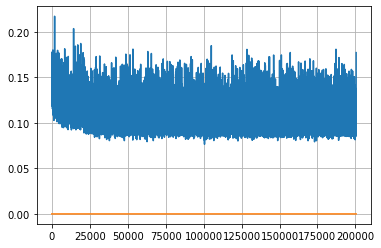

Epoch: 514, iteration 0, loss 0.09820348024368286, cov_diff 0.3968219374122263 cov_diff train 0.3964984333009751
Epoch: 514, iteration 1, loss 0.09566903114318848, cov_diff 0.4063856294978914 cov_diff train 0.40634884812747074
Epoch: 514, iteration 2, loss 0.10302034020423889, cov_diff 0.41450982420464744 cov_diff train 0.41351685861062976
Epoch: 514, iteration 3, loss 0.10564035177230835, cov_diff 0.3961226539730742 cov_diff train 0.3944697120408499
Epoch: 514, iteration 4, loss 0.0999147891998291, cov_diff 0.41195162609063024 cov_diff train 0.41089670469562556
Epoch: 514, iteration 5, loss 0.10862672328948975, cov_diff 0.41208827788281804 cov_diff train 0.4122995202762167
Epoch: 514, iteration 6, loss 0.09638014435768127, cov_diff 0.40232814246149595 cov_diff train 0.4013415189259366
Epoch: 514, iteration 7, loss 0.10092228651046753, cov_diff 0.4120588488081012 cov_diff train 0.41180214147445254
Epoch: 514, iteration 8, loss 0.11828413605690002, cov_diff 0.4070487599092709 cov_diff t

Epoch: 514, iteration 76, loss 0.09309136867523193, cov_diff 0.4067778102221193 cov_diff train 0.4071444635851991
Epoch: 514, iteration 77, loss 0.11163881421089172, cov_diff 0.41228001078590226 cov_diff train 0.4114630218872076
Epoch: 514, iteration 78, loss 0.09215536713600159, cov_diff 0.4009153901478628 cov_diff train 0.40032482520675816
Epoch: 514, iteration 79, loss 0.10019981861114502, cov_diff 0.39887496555692903 cov_diff train 0.3989925231472413
Epoch: 514, iteration 80, loss 0.09564369916915894, cov_diff 0.4099541197347722 cov_diff train 0.40952403354975914
Epoch: 514, iteration 81, loss 0.10551294684410095, cov_diff 0.40735736085573787 cov_diff train 0.406104207356433
Epoch: 514, iteration 82, loss 0.10522627830505371, cov_diff 0.40672685631005356 cov_diff train 0.4053090046899077
Epoch: 514, iteration 83, loss 0.09678959846496582, cov_diff 0.4258777701404532 cov_diff train 0.4252409941515963
Epoch: 514, iteration 84, loss 0.09202730655670166, cov_diff 0.4111903296035392 cov

Epoch: 514, iteration 153, loss 0.09447374939918518, cov_diff 0.3977627357890137 cov_diff train 0.39771760505354614
Epoch: 514, iteration 154, loss 0.10926356911659241, cov_diff 0.4009104667503033 cov_diff train 0.4005746367110616
Epoch: 514, iteration 155, loss 0.1018507182598114, cov_diff 0.40263821330973115 cov_diff train 0.4020361704721239
Epoch: 514, iteration 156, loss 0.09835106134414673, cov_diff 0.4036377373779479 cov_diff train 0.4029451677636822
Epoch: 514, iteration 157, loss 0.10960450768470764, cov_diff 0.4083306763842005 cov_diff train 0.40767339563245913
Epoch: 514, iteration 158, loss 0.10175371170043945, cov_diff 0.40728566576369757 cov_diff train 0.40636218737319757
Epoch: 514, iteration 159, loss 0.09778231382369995, cov_diff 0.4145647127805095 cov_diff train 0.41434379895614304
Epoch: 514, iteration 160, loss 0.0987744927406311, cov_diff 0.40839435199317287 cov_diff train 0.40789309607624846
Epoch: 514, iteration 161, loss 0.09523651003837585, cov_diff 0.4094751717

Epoch: 514, iteration 234, loss 0.09707865118980408, cov_diff 0.41381676513909216 cov_diff train 0.4131795231176078
Epoch: 514, iteration 235, loss 0.09848496317863464, cov_diff 0.40541465449017666 cov_diff train 0.4037385855128682
Epoch: 514, iteration 236, loss 0.1026933491230011, cov_diff 0.4150896471405875 cov_diff train 0.4147019742954751
Epoch: 514, iteration 237, loss 0.09813505411148071, cov_diff 0.42299982320903073 cov_diff train 0.4226756772343994
Epoch: 514, iteration 238, loss 0.09107071161270142, cov_diff 0.404342024195317 cov_diff train 0.40449004742618877
Epoch: 514, iteration 239, loss 0.11827313899993896, cov_diff 0.41471259078289807 cov_diff train 0.4126851072073789
Epoch: 514, iteration 240, loss 0.0962415337562561, cov_diff 0.41343016545624145 cov_diff train 0.41336848208739085
Epoch: 514, iteration 241, loss 0.10205799341201782, cov_diff 0.41887685772880584 cov_diff train 0.4184331522088164
Epoch: 514, iteration 242, loss 0.11277666687965393, cov_diff 0.41721800280

Epoch: 514, iteration 309, loss 0.09829187393188477, cov_diff 0.4136165797226421 cov_diff train 0.41231122077702137
Epoch: 514, iteration 310, loss 0.1009252667427063, cov_diff 0.41199414965215314 cov_diff train 0.41165336558918686
Epoch: 514, iteration 311, loss 0.11127403378486633, cov_diff 0.40263610402037386 cov_diff train 0.40159184316521
Epoch: 514, iteration 312, loss 0.10621154308319092, cov_diff 0.4112954925199518 cov_diff train 0.41016951433721577
Epoch: 514, iteration 313, loss 0.10556453466415405, cov_diff 0.41249562422714087 cov_diff train 0.41085041656931726
Epoch: 514, iteration 314, loss 0.09737157821655273, cov_diff 0.40006796161235203 cov_diff train 0.39950684205762255
Epoch: 514, iteration 315, loss 0.10611474514007568, cov_diff 0.409754762395313 cov_diff train 0.4089470810283835
Epoch: 514, iteration 316, loss 0.10082963109016418, cov_diff 0.401985899185939 cov_diff train 0.4023505535369163
Epoch: 514, iteration 317, loss 0.10133689641952515, cov_diff 0.414609922112

Epoch: 514, iteration 388, loss 0.10197913646697998, cov_diff 0.3992341016894551 cov_diff train 0.3985302004625299
Epoch: 514, iteration 389, loss 0.09762921929359436, cov_diff 0.39770296336536054 cov_diff train 0.39690766406371825
Epoch: 514, iteration 390, loss 0.15342581272125244, cov_diff 0.4676881179955457 cov_diff train 0.46566131479682393


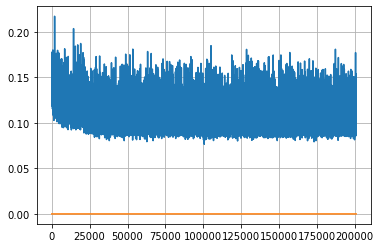

Epoch: 515, iteration 0, loss 0.10175725817680359, cov_diff 0.4116733667613565 cov_diff train 0.41122775524708394
Epoch: 515, iteration 1, loss 0.10050138831138611, cov_diff 0.4076397961899485 cov_diff train 0.40697974805497245
Epoch: 515, iteration 2, loss 0.11940321326255798, cov_diff 0.4110779740185771 cov_diff train 0.4103422759512822
Epoch: 515, iteration 3, loss 0.10550504922866821, cov_diff 0.419167720302989 cov_diff train 0.41896402525089166
Epoch: 515, iteration 4, loss 0.1100282073020935, cov_diff 0.39256736975361767 cov_diff train 0.39152780042210494
Epoch: 515, iteration 5, loss 0.09786674380302429, cov_diff 0.4143302340079475 cov_diff train 0.4133526219158345
Epoch: 515, iteration 6, loss 0.11906450986862183, cov_diff 0.402523505534831 cov_diff train 0.40227184219647677
Epoch: 515, iteration 7, loss 0.095511794090271, cov_diff 0.40000164391294024 cov_diff train 0.39937538712275417
Epoch: 515, iteration 8, loss 0.09662267565727234, cov_diff 0.4088885748941782 cov_diff train

Epoch: 515, iteration 80, loss 0.10463368892669678, cov_diff 0.40511266758304276 cov_diff train 0.4043075666318046
Epoch: 515, iteration 81, loss 0.11275634169578552, cov_diff 0.4214441439336987 cov_diff train 0.41992156319896534
Epoch: 515, iteration 82, loss 0.11983111500740051, cov_diff 0.40294705348451193 cov_diff train 0.4023489036234223
Epoch: 515, iteration 83, loss 0.09521239995956421, cov_diff 0.39872227574769825 cov_diff train 0.3979465207731309
Epoch: 515, iteration 84, loss 0.10143429040908813, cov_diff 0.39529757810971194 cov_diff train 0.3949753666523166
Epoch: 515, iteration 85, loss 0.10402300953865051, cov_diff 0.4095848730492388 cov_diff train 0.4091036138777188
Epoch: 515, iteration 86, loss 0.11025214195251465, cov_diff 0.41595280101309257 cov_diff train 0.41333276561104476
Epoch: 515, iteration 87, loss 0.11242327094078064, cov_diff 0.40975558238352316 cov_diff train 0.4085275793480212
Epoch: 515, iteration 88, loss 0.10228303074836731, cov_diff 0.40516927405246633

Epoch: 515, iteration 159, loss 0.09831643104553223, cov_diff 0.4126489510580239 cov_diff train 0.4120673516725793
Epoch: 515, iteration 160, loss 0.10459086298942566, cov_diff 0.39957415507484023 cov_diff train 0.39937486005886896
Epoch: 515, iteration 161, loss 0.10247457027435303, cov_diff 0.4064017525195484 cov_diff train 0.4055223460689169
Epoch: 515, iteration 162, loss 0.10517346858978271, cov_diff 0.40344631648040813 cov_diff train 0.40265478530892623
Epoch: 515, iteration 163, loss 0.09672066569328308, cov_diff 0.4131584099865606 cov_diff train 0.4142027374672841
Epoch: 515, iteration 164, loss 0.09423339366912842, cov_diff 0.42460903902507063 cov_diff train 0.42385816894666106
Epoch: 515, iteration 165, loss 0.08990523219108582, cov_diff 0.4093711396885223 cov_diff train 0.40865216048080444
Epoch: 515, iteration 166, loss 0.1118166446685791, cov_diff 0.4078211639483995 cov_diff train 0.40745090495300457
Epoch: 515, iteration 167, loss 0.10550558567047119, cov_diff 0.410819769

Epoch: 515, iteration 237, loss 0.10613659024238586, cov_diff 0.4134748849702774 cov_diff train 0.4138231749756949
Epoch: 515, iteration 238, loss 0.10383334755897522, cov_diff 0.4028819231963554 cov_diff train 0.40249559034756016
Epoch: 515, iteration 239, loss 0.09690093994140625, cov_diff 0.41232128883029345 cov_diff train 0.41152952683246025
Epoch: 515, iteration 240, loss 0.09517338871955872, cov_diff 0.39719402075431404 cov_diff train 0.3963998722750181
Epoch: 515, iteration 241, loss 0.09946766495704651, cov_diff 0.4053732544920432 cov_diff train 0.40542696646801596
Epoch: 515, iteration 242, loss 0.10075771808624268, cov_diff 0.4037458041651804 cov_diff train 0.40249418575119217
Epoch: 515, iteration 243, loss 0.10040846467018127, cov_diff 0.41999490741944295 cov_diff train 0.41978736323591476
Epoch: 515, iteration 244, loss 0.1088540256023407, cov_diff 0.4191327465307143 cov_diff train 0.41882452407353277
Epoch: 515, iteration 245, loss 0.11055666208267212, cov_diff 0.41744552

Epoch: 515, iteration 317, loss 0.10958439111709595, cov_diff 0.42166402259483954 cov_diff train 0.4199680039565604
Epoch: 515, iteration 318, loss 0.10631260275840759, cov_diff 0.4109221981746202 cov_diff train 0.4099120301238238
Epoch: 515, iteration 319, loss 0.09919387102127075, cov_diff 0.39518433779651146 cov_diff train 0.39490190599664
Epoch: 515, iteration 320, loss 0.1051589846611023, cov_diff 0.4029366612184457 cov_diff train 0.40268714143197826
Epoch: 515, iteration 321, loss 0.09774425625801086, cov_diff 0.4106446278238085 cov_diff train 0.40997411882797585
Epoch: 515, iteration 322, loss 0.10515961050987244, cov_diff 0.4054651165094928 cov_diff train 0.4055159748068384
Epoch: 515, iteration 323, loss 0.0989178717136383, cov_diff 0.4049845826635566 cov_diff train 0.40408130251411384
Epoch: 515, iteration 324, loss 0.1163618266582489, cov_diff 0.42062939009857014 cov_diff train 0.42109360106721505
Epoch: 515, iteration 325, loss 0.10932400822639465, cov_diff 0.40050809786369

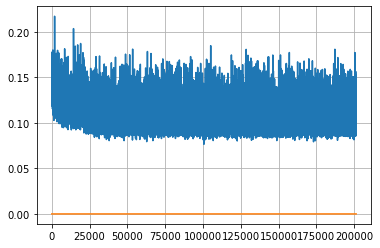

Epoch: 516, iteration 0, loss 0.10439714789390564, cov_diff 0.4117025742404131 cov_diff train 0.41145160694537614
Epoch: 516, iteration 1, loss 0.10244512557983398, cov_diff 0.41747663603945045 cov_diff train 0.4165730024129759
Epoch: 516, iteration 2, loss 0.10265225172042847, cov_diff 0.4244484114120794 cov_diff train 0.42465106586901713
Epoch: 516, iteration 3, loss 0.09732508659362793, cov_diff 0.4127852877875146 cov_diff train 0.41257512375478483
Epoch: 516, iteration 4, loss 0.08892536163330078, cov_diff 0.4170311846554746 cov_diff train 0.41675946482286536
Epoch: 516, iteration 5, loss 0.10424715280532837, cov_diff 0.41981042638173005 cov_diff train 0.41885581719931864
Epoch: 516, iteration 6, loss 0.1102370023727417, cov_diff 0.41557377118359873 cov_diff train 0.4143935013076753
Epoch: 516, iteration 7, loss 0.10916781425476074, cov_diff 0.4149110146537678 cov_diff train 0.4145457868603387
Epoch: 516, iteration 8, loss 0.10284885764122009, cov_diff 0.40991836775480184 cov_diff 

Epoch: 516, iteration 80, loss 0.10521763563156128, cov_diff 0.41775823050510724 cov_diff train 0.41731405664666443
Epoch: 516, iteration 81, loss 0.10294631123542786, cov_diff 0.4199564580960444 cov_diff train 0.41963481447114626
Epoch: 516, iteration 82, loss 0.1022668182849884, cov_diff 0.41050476080410747 cov_diff train 0.4091402673938637
Epoch: 516, iteration 83, loss 0.1018381416797638, cov_diff 0.4064105177857141 cov_diff train 0.405585160020097
Epoch: 516, iteration 84, loss 0.09565579891204834, cov_diff 0.4047239282978532 cov_diff train 0.404504824199246
Epoch: 516, iteration 85, loss 0.10697409510612488, cov_diff 0.400711583196102 cov_diff train 0.39938362090649254
Epoch: 516, iteration 86, loss 0.11652052402496338, cov_diff 0.39922945318924274 cov_diff train 0.3981823412116201
Epoch: 516, iteration 87, loss 0.09761980175971985, cov_diff 0.4084120814664473 cov_diff train 0.40742980588564137
Epoch: 516, iteration 88, loss 0.11176988482475281, cov_diff 0.42184899088767247 cov_d

Epoch: 516, iteration 160, loss 0.09585630893707275, cov_diff 0.4005242168251852 cov_diff train 0.40004105721873817
Epoch: 516, iteration 161, loss 0.10627686977386475, cov_diff 0.40013718488640754 cov_diff train 0.3998351363259609
Epoch: 516, iteration 162, loss 0.09952011704444885, cov_diff 0.41413135902443987 cov_diff train 0.41398098591487936
Epoch: 516, iteration 163, loss 0.09786665439605713, cov_diff 0.4193552694227843 cov_diff train 0.41890209133039974
Epoch: 516, iteration 164, loss 0.09695857763290405, cov_diff 0.4057251215702586 cov_diff train 0.4046927474642854
Epoch: 516, iteration 165, loss 0.11055994033813477, cov_diff 0.4107750976171808 cov_diff train 0.4097535860694699
Epoch: 516, iteration 166, loss 0.09967544674873352, cov_diff 0.39919726836594377 cov_diff train 0.39830833349318506
Epoch: 516, iteration 167, loss 0.10820803046226501, cov_diff 0.39729118099279165 cov_diff train 0.3966061531720101
Epoch: 516, iteration 168, loss 0.09390807151794434, cov_diff 0.40935596

Epoch: 516, iteration 239, loss 0.11040723323822021, cov_diff 0.4110540552507143 cov_diff train 0.4105824761497474
Epoch: 516, iteration 240, loss 0.10101377964019775, cov_diff 0.41875030543054265 cov_diff train 0.41790469623862186
Epoch: 516, iteration 241, loss 0.1064734160900116, cov_diff 0.4138558387269468 cov_diff train 0.41350452325579434
Epoch: 516, iteration 242, loss 0.09969103336334229, cov_diff 0.4148878822779936 cov_diff train 0.4143409950021188
Epoch: 516, iteration 243, loss 0.10175919532775879, cov_diff 0.40613000496218515 cov_diff train 0.40514160580229003
Epoch: 516, iteration 244, loss 0.10966014862060547, cov_diff 0.4271621931515181 cov_diff train 0.42674515577040817
Epoch: 516, iteration 245, loss 0.11393335461616516, cov_diff 0.41852061308379235 cov_diff train 0.41816858092584247
Epoch: 516, iteration 246, loss 0.09834367036819458, cov_diff 0.3949492015954087 cov_diff train 0.3946503731541328
Epoch: 516, iteration 247, loss 0.09267321228981018, cov_diff 0.403036791

Epoch: 516, iteration 316, loss 0.09477588534355164, cov_diff 0.40513647462385605 cov_diff train 0.40421974722035203
Epoch: 516, iteration 317, loss 0.10875460505485535, cov_diff 0.40583003179146815 cov_diff train 0.4054921913098721
Epoch: 516, iteration 318, loss 0.09777149558067322, cov_diff 0.4057399959454418 cov_diff train 0.4057055613944382
Epoch: 516, iteration 319, loss 0.10373762249946594, cov_diff 0.41195874114861025 cov_diff train 0.4120058226370403
Epoch: 516, iteration 320, loss 0.10571056604385376, cov_diff 0.40923731148831716 cov_diff train 0.40858213134444793
Epoch: 516, iteration 321, loss 0.10642474889755249, cov_diff 0.421660321228574 cov_diff train 0.4200171301981673
Epoch: 516, iteration 322, loss 0.10974135994911194, cov_diff 0.4083195622157154 cov_diff train 0.40757699137480224
Epoch: 516, iteration 323, loss 0.0984795093536377, cov_diff 0.3998451157202121 cov_diff train 0.40063722762959664
Epoch: 516, iteration 324, loss 0.09941825270652771, cov_diff 0.4188224165

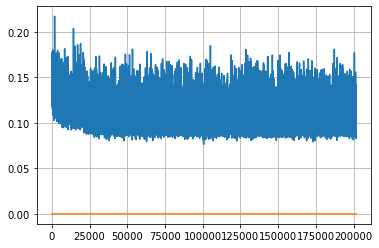

Epoch: 517, iteration 0, loss 0.10189995169639587, cov_diff 0.40870325571976635 cov_diff train 0.4076909445011653
Epoch: 517, iteration 1, loss 0.11250007152557373, cov_diff 0.4146587583289128 cov_diff train 0.4135453758273353
Epoch: 517, iteration 2, loss 0.10465836524963379, cov_diff 0.43023436947345584 cov_diff train 0.4287971682207807
Epoch: 517, iteration 3, loss 0.10416001081466675, cov_diff 0.4208650643384307 cov_diff train 0.4200209229991334
Epoch: 517, iteration 4, loss 0.11003491282463074, cov_diff 0.39994693310061535 cov_diff train 0.39976775798359887
Epoch: 517, iteration 5, loss 0.1002265214920044, cov_diff 0.4052618841121861 cov_diff train 0.4047931498990288
Epoch: 517, iteration 6, loss 0.09495779871940613, cov_diff 0.41477685990601176 cov_diff train 0.41405391887533577
Epoch: 517, iteration 7, loss 0.10458552837371826, cov_diff 0.40101994656147255 cov_diff train 0.4000387948725043
Epoch: 517, iteration 8, loss 0.11214238405227661, cov_diff 0.4232599348882671 cov_diff tr

Epoch: 517, iteration 81, loss 0.11161944270133972, cov_diff 0.41571935381695674 cov_diff train 0.4148053904380666
Epoch: 517, iteration 82, loss 0.09973698854446411, cov_diff 0.4002481339034906 cov_diff train 0.39937148009078405
Epoch: 517, iteration 83, loss 0.10691621899604797, cov_diff 0.40700172321247924 cov_diff train 0.4071972697387188
Epoch: 517, iteration 84, loss 0.10062631964683533, cov_diff 0.40913973127644826 cov_diff train 0.40881198177411765
Epoch: 517, iteration 85, loss 0.0996469259262085, cov_diff 0.41133093625090944 cov_diff train 0.4096731727386825
Epoch: 517, iteration 86, loss 0.10449817776679993, cov_diff 0.4069501726392895 cov_diff train 0.40529078307117
Epoch: 517, iteration 87, loss 0.11288753151893616, cov_diff 0.4089585134499365 cov_diff train 0.4081837081394543
Epoch: 517, iteration 88, loss 0.11697939038276672, cov_diff 0.4052045731703588 cov_diff train 0.40413877725822994
Epoch: 517, iteration 89, loss 0.09322488307952881, cov_diff 0.4082646420170367 cov_

Epoch: 517, iteration 161, loss 0.1001606285572052, cov_diff 0.41335685810213985 cov_diff train 0.4120471089051996
Epoch: 517, iteration 162, loss 0.11114281415939331, cov_diff 0.42641050853511614 cov_diff train 0.4250653755660616
Epoch: 517, iteration 163, loss 0.09900888800621033, cov_diff 0.41083629019465207 cov_diff train 0.4096895985696294
Epoch: 517, iteration 164, loss 0.11154723167419434, cov_diff 0.41537100260136856 cov_diff train 0.41522550520563645
Epoch: 517, iteration 165, loss 0.10475429892539978, cov_diff 0.4111824451637253 cov_diff train 0.4109315173684963
Epoch: 517, iteration 166, loss 0.1000104546546936, cov_diff 0.41697078581666897 cov_diff train 0.4174734236142532
Epoch: 517, iteration 167, loss 0.10243022441864014, cov_diff 0.39674667668457386 cov_diff train 0.39626394269507026
Epoch: 517, iteration 168, loss 0.10013478994369507, cov_diff 0.3944840428786644 cov_diff train 0.39457549815541926
Epoch: 517, iteration 169, loss 0.09840816259384155, cov_diff 0.405748671

Epoch: 517, iteration 240, loss 0.10772711038589478, cov_diff 0.42038067218467084 cov_diff train 0.4191600868801428
Epoch: 517, iteration 241, loss 0.10473513603210449, cov_diff 0.4093731766259996 cov_diff train 0.4096468745178761
Epoch: 517, iteration 242, loss 0.09790050983428955, cov_diff 0.4060362646404567 cov_diff train 0.40501681126943134
Epoch: 517, iteration 243, loss 0.10744693875312805, cov_diff 0.41457041972306113 cov_diff train 0.41432023493022097
Epoch: 517, iteration 244, loss 0.10451614856719971, cov_diff 0.41008301014953447 cov_diff train 0.40953040446536365
Epoch: 517, iteration 245, loss 0.10852283239364624, cov_diff 0.42311830159968916 cov_diff train 0.4226232517752324
Epoch: 517, iteration 246, loss 0.10432633757591248, cov_diff 0.4207784345599538 cov_diff train 0.41980288597881493
Epoch: 517, iteration 247, loss 0.10917499661445618, cov_diff 0.41849416424784974 cov_diff train 0.41732237399157973
Epoch: 517, iteration 248, loss 0.09800708293914795, cov_diff 0.415631

Epoch: 517, iteration 318, loss 0.10425198078155518, cov_diff 0.4060019101380858 cov_diff train 0.4061249933955418
Epoch: 517, iteration 319, loss 0.10720378160476685, cov_diff 0.40288396978024943 cov_diff train 0.40252138604689286
Epoch: 517, iteration 320, loss 0.09533709287643433, cov_diff 0.40839251821744826 cov_diff train 0.4070252172757932
Epoch: 517, iteration 321, loss 0.10398969054222107, cov_diff 0.4061334079373096 cov_diff train 0.40465935658806673
Epoch: 517, iteration 322, loss 0.09692415595054626, cov_diff 0.3927786200659712 cov_diff train 0.39248999749567287
Epoch: 517, iteration 323, loss 0.10042792558670044, cov_diff 0.4140736150958706 cov_diff train 0.41258683785248657
Epoch: 517, iteration 324, loss 0.11229288578033447, cov_diff 0.4045145673343309 cov_diff train 0.40267358225093786
Epoch: 517, iteration 325, loss 0.1078391969203949, cov_diff 0.40474883637135595 cov_diff train 0.40458904746386465
Epoch: 517, iteration 326, loss 0.10537013411521912, cov_diff 0.41295129

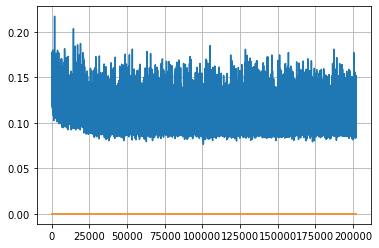

Epoch: 518, iteration 0, loss 0.0948905348777771, cov_diff 0.40767976721437277 cov_diff train 0.40732389935136437
Epoch: 518, iteration 1, loss 0.107852041721344, cov_diff 0.4033704998317853 cov_diff train 0.403039630950131
Epoch: 518, iteration 2, loss 0.09731721878051758, cov_diff 0.39907611498523204 cov_diff train 0.3991715067606673
Epoch: 518, iteration 3, loss 0.10628175735473633, cov_diff 0.418927920295776 cov_diff train 0.4182189754027909
Epoch: 518, iteration 4, loss 0.09690892696380615, cov_diff 0.4097577179842682 cov_diff train 0.40948762524084487
Epoch: 518, iteration 5, loss 0.10565048456192017, cov_diff 0.41346136279923973 cov_diff train 0.41371125877871895
Epoch: 518, iteration 6, loss 0.12007492780685425, cov_diff 0.41378049629989655 cov_diff train 0.4131633323978657
Epoch: 518, iteration 7, loss 0.11299577355384827, cov_diff 0.4113246419465455 cov_diff train 0.4116054906528165
Epoch: 518, iteration 8, loss 0.09989580512046814, cov_diff 0.4080012363214078 cov_diff train 

Epoch: 518, iteration 81, loss 0.1041901707649231, cov_diff 0.4051386038728677 cov_diff train 0.4048305293340771
Epoch: 518, iteration 82, loss 0.11152410507202148, cov_diff 0.4108299322555944 cov_diff train 0.4105626953405361
Epoch: 518, iteration 83, loss 0.10550960898399353, cov_diff 0.40543430915824946 cov_diff train 0.4053645506654428
Epoch: 518, iteration 84, loss 0.11103129386901855, cov_diff 0.40888758116025153 cov_diff train 0.40800867295668236
Epoch: 518, iteration 85, loss 0.11660656332969666, cov_diff 0.4142148371329046 cov_diff train 0.4136241590798205
Epoch: 518, iteration 86, loss 0.09504827857017517, cov_diff 0.4244894340279159 cov_diff train 0.4237866137083589
Epoch: 518, iteration 87, loss 0.10451149940490723, cov_diff 0.4066673035595101 cov_diff train 0.4056717150661132
Epoch: 518, iteration 88, loss 0.10612091422080994, cov_diff 0.40274271233496534 cov_diff train 0.40194996741175
Epoch: 518, iteration 89, loss 0.10131943225860596, cov_diff 0.3984855705707796 cov_dif

Epoch: 518, iteration 159, loss 0.09443914890289307, cov_diff 0.407858822549394 cov_diff train 0.4065385507661414
Epoch: 518, iteration 160, loss 0.10520198941230774, cov_diff 0.41299231615740667 cov_diff train 0.4118384079385006
Epoch: 518, iteration 161, loss 0.10064199566841125, cov_diff 0.39647904336484874 cov_diff train 0.39588745529091407
Epoch: 518, iteration 162, loss 0.09536287188529968, cov_diff 0.4074695631751022 cov_diff train 0.4068667787115529
Epoch: 518, iteration 163, loss 0.11371171474456787, cov_diff 0.40193068919934943 cov_diff train 0.4020596595122958
Epoch: 518, iteration 164, loss 0.10284024477005005, cov_diff 0.41392458916703007 cov_diff train 0.413852349659742
Epoch: 518, iteration 165, loss 0.09205865859985352, cov_diff 0.411481887361444 cov_diff train 0.40924261614715424
Epoch: 518, iteration 166, loss 0.0923459529876709, cov_diff 0.41451326828702384 cov_diff train 0.415686070433096
Epoch: 518, iteration 167, loss 0.09797051548957825, cov_diff 0.41644906649269

Epoch: 518, iteration 238, loss 0.11185723543167114, cov_diff 0.42140105781775405 cov_diff train 0.4209314878130683
Epoch: 518, iteration 239, loss 0.10975193977355957, cov_diff 0.4181789319403878 cov_diff train 0.41767316780259217
Epoch: 518, iteration 240, loss 0.09398016333580017, cov_diff 0.4204886551838385 cov_diff train 0.4196361953704685
Epoch: 518, iteration 241, loss 0.09660249948501587, cov_diff 0.4071067731964187 cov_diff train 0.40662753203831026
Epoch: 518, iteration 242, loss 0.1017335057258606, cov_diff 0.4169879357868284 cov_diff train 0.41606173739978775
Epoch: 518, iteration 243, loss 0.10069894790649414, cov_diff 0.4161917148933271 cov_diff train 0.415730854426892
Epoch: 518, iteration 244, loss 0.11055436730384827, cov_diff 0.4316592235007098 cov_diff train 0.43036295093545285
Epoch: 518, iteration 245, loss 0.11786848306655884, cov_diff 0.4164919046734065 cov_diff train 0.4158820919287992
Epoch: 518, iteration 246, loss 0.0985977053642273, cov_diff 0.41577578743016

Epoch: 518, iteration 312, loss 0.10370269417762756, cov_diff 0.4092050922879751 cov_diff train 0.4089063193208095
Epoch: 518, iteration 313, loss 0.10382542014122009, cov_diff 0.406749611584537 cov_diff train 0.4065880369306755
Epoch: 518, iteration 314, loss 0.10646408796310425, cov_diff 0.41061564259631295 cov_diff train 0.41020459039946655
Epoch: 518, iteration 315, loss 0.11789491772651672, cov_diff 0.3982626356859793 cov_diff train 0.3973243657742049
Epoch: 518, iteration 316, loss 0.11619561910629272, cov_diff 0.4149724782262591 cov_diff train 0.41378930523934215
Epoch: 518, iteration 317, loss 0.09798610210418701, cov_diff 0.41160379410865505 cov_diff train 0.4106724040304035
Epoch: 518, iteration 318, loss 0.0990796685218811, cov_diff 0.41199644347533226 cov_diff train 0.4108660826228395
Epoch: 518, iteration 319, loss 0.09899255633354187, cov_diff 0.42027866309879475 cov_diff train 0.4195199705655343
Epoch: 518, iteration 320, loss 0.1094379723072052, cov_diff 0.4061185307105

Epoch: 518, iteration 387, loss 0.10577964782714844, cov_diff 0.4007823365523346 cov_diff train 0.40112206238087866
Epoch: 518, iteration 388, loss 0.10022914409637451, cov_diff 0.3983157601229252 cov_diff train 0.3977640971592703
Epoch: 518, iteration 389, loss 0.11338412761688232, cov_diff 0.4097145880108867 cov_diff train 0.4097408598447815
Epoch: 518, iteration 390, loss 0.15228870511054993, cov_diff 0.4546284471340474 cov_diff train 0.4559430215401224


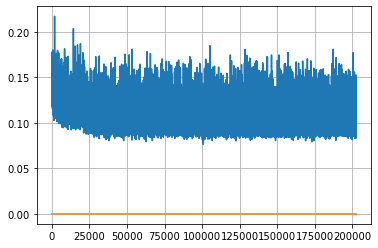

Epoch: 519, iteration 0, loss 0.11059778928756714, cov_diff 0.4012302407900795 cov_diff train 0.4018791038954908
Epoch: 519, iteration 1, loss 0.099098801612854, cov_diff 0.40270179097594283 cov_diff train 0.40237091197709907
Epoch: 519, iteration 2, loss 0.10941168665885925, cov_diff 0.40442690369606704 cov_diff train 0.4037291973830482
Epoch: 519, iteration 3, loss 0.09715420007705688, cov_diff 0.39686369492838386 cov_diff train 0.39650412783537936
Epoch: 519, iteration 4, loss 0.10473141074180603, cov_diff 0.4164975508986368 cov_diff train 0.4162495519543352
Epoch: 519, iteration 5, loss 0.1036447286605835, cov_diff 0.4091489884960602 cov_diff train 0.4087588668493023
Epoch: 519, iteration 6, loss 0.11060705780982971, cov_diff 0.4126351674941316 cov_diff train 0.4115991224787559
Epoch: 519, iteration 7, loss 0.10071629285812378, cov_diff 0.41598891577758257 cov_diff train 0.4153024002501148
Epoch: 519, iteration 8, loss 0.09866401553153992, cov_diff 0.41188569894047794 cov_diff trai

Epoch: 519, iteration 76, loss 0.10858049988746643, cov_diff 0.40465887212011414 cov_diff train 0.4034286558258763
Epoch: 519, iteration 77, loss 0.10500115156173706, cov_diff 0.41584964887595904 cov_diff train 0.4158342982681571
Epoch: 519, iteration 78, loss 0.10536032915115356, cov_diff 0.4063169440131714 cov_diff train 0.4055658538455201
Epoch: 519, iteration 79, loss 0.10035461187362671, cov_diff 0.41524799660120154 cov_diff train 0.4139087301128865
Epoch: 519, iteration 80, loss 0.09928476810455322, cov_diff 0.4163495717926692 cov_diff train 0.41542645472481604
Epoch: 519, iteration 81, loss 0.10441529750823975, cov_diff 0.4021311869628054 cov_diff train 0.40098637799824244
Epoch: 519, iteration 82, loss 0.10315576195716858, cov_diff 0.4090942501067338 cov_diff train 0.4080457132470701
Epoch: 519, iteration 83, loss 0.09248870611190796, cov_diff 0.4108865784326589 cov_diff train 0.41036397240884526
Epoch: 519, iteration 84, loss 0.10470038652420044, cov_diff 0.39699913229057754 c

Epoch: 519, iteration 155, loss 0.10799983143806458, cov_diff 0.4217163436621296 cov_diff train 0.42035472608500674
Epoch: 519, iteration 156, loss 0.09157547354698181, cov_diff 0.4150729865192475 cov_diff train 0.41463923749264586
Epoch: 519, iteration 157, loss 0.1055261492729187, cov_diff 0.4073934332185264 cov_diff train 0.40659891824052813
Epoch: 519, iteration 158, loss 0.10843971371650696, cov_diff 0.40165429590067747 cov_diff train 0.4013338974204703
Epoch: 519, iteration 159, loss 0.11653146147727966, cov_diff 0.4076117952330891 cov_diff train 0.4070137776868325
Epoch: 519, iteration 160, loss 0.11557060480117798, cov_diff 0.4191964679702442 cov_diff train 0.41826646463062084
Epoch: 519, iteration 161, loss 0.10204720497131348, cov_diff 0.39212420754512334 cov_diff train 0.3917569015552915
Epoch: 519, iteration 162, loss 0.0974142849445343, cov_diff 0.4157537100673732 cov_diff train 0.414780796372411
Epoch: 519, iteration 163, loss 0.09685087203979492, cov_diff 0.3984271703333

Epoch: 519, iteration 234, loss 0.10392510890960693, cov_diff 0.42107241331298 cov_diff train 0.4199750547736437
Epoch: 519, iteration 235, loss 0.10822039842605591, cov_diff 0.39674816258885487 cov_diff train 0.3953836899678212
Epoch: 519, iteration 236, loss 0.10419812798500061, cov_diff 0.3962899041679888 cov_diff train 0.3966345482309001
Epoch: 519, iteration 237, loss 0.10138574242591858, cov_diff 0.40484600653860314 cov_diff train 0.4045010780987124
Epoch: 519, iteration 238, loss 0.1153252124786377, cov_diff 0.42760077661545215 cov_diff train 0.42724579198161555
Epoch: 519, iteration 239, loss 0.10276046395301819, cov_diff 0.4219636972422652 cov_diff train 0.42047807457586617
Epoch: 519, iteration 240, loss 0.1133013367652893, cov_diff 0.4194851447347599 cov_diff train 0.4176850501179097
Epoch: 519, iteration 241, loss 0.09775608777999878, cov_diff 0.4159728278385985 cov_diff train 0.41510690465090355
Epoch: 519, iteration 242, loss 0.08602237701416016, cov_diff 0.41662540818007

Epoch: 519, iteration 314, loss 0.09749934077262878, cov_diff 0.4046910803069994 cov_diff train 0.403973440443784
Epoch: 519, iteration 315, loss 0.11018803715705872, cov_diff 0.4152178665577103 cov_diff train 0.4145736600331516
Epoch: 519, iteration 316, loss 0.10157585144042969, cov_diff 0.4020553685613021 cov_diff train 0.4025860366334972
Epoch: 519, iteration 317, loss 0.11831691861152649, cov_diff 0.4056444578513385 cov_diff train 0.4048083405530218
Epoch: 519, iteration 318, loss 0.09854409098625183, cov_diff 0.4116817642621802 cov_diff train 0.41061633081579063
Epoch: 519, iteration 319, loss 0.10175681114196777, cov_diff 0.41589457977367944 cov_diff train 0.4138645692643887
Epoch: 519, iteration 320, loss 0.10366174578666687, cov_diff 0.42123308754932565 cov_diff train 0.42054951891323483
Epoch: 519, iteration 321, loss 0.1087866723537445, cov_diff 0.41919032631102615 cov_diff train 0.41840616490497506
Epoch: 519, iteration 322, loss 0.09565094113349915, cov_diff 0.408703222993

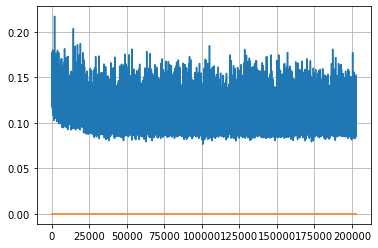

Epoch: 520, iteration 0, loss 0.11470428109169006, cov_diff 0.3962684418676797 cov_diff train 0.395185136891513
Epoch: 520, iteration 1, loss 0.0986577570438385, cov_diff 0.39481387432523857 cov_diff train 0.3938408431585336
Epoch: 520, iteration 2, loss 0.09586483240127563, cov_diff 0.4104943637087939 cov_diff train 0.41045957805190947
Epoch: 520, iteration 3, loss 0.09729832410812378, cov_diff 0.40731856959473384 cov_diff train 0.4075396341734707
Epoch: 520, iteration 4, loss 0.09642791748046875, cov_diff 0.4179240154283272 cov_diff train 0.41687141897973984
Epoch: 520, iteration 5, loss 0.12257567048072815, cov_diff 0.42028012838871626 cov_diff train 0.41939642699539237
Epoch: 520, iteration 6, loss 0.10165980458259583, cov_diff 0.4126045041916991 cov_diff train 0.41179898425630485
Epoch: 520, iteration 7, loss 0.10105594992637634, cov_diff 0.4097590470334408 cov_diff train 0.409261181687956
Epoch: 520, iteration 8, loss 0.11353367567062378, cov_diff 0.4165029393541993 cov_diff trai

Epoch: 520, iteration 78, loss 0.08850392699241638, cov_diff 0.40178874564196054 cov_diff train 0.40159083236951415
Epoch: 520, iteration 79, loss 0.10606548190116882, cov_diff 0.40254491265211095 cov_diff train 0.40261362434978415
Epoch: 520, iteration 80, loss 0.10260975360870361, cov_diff 0.41031242972155807 cov_diff train 0.40999072247636503
Epoch: 520, iteration 81, loss 0.09541559219360352, cov_diff 0.4033710430488914 cov_diff train 0.40294343203058003
Epoch: 520, iteration 82, loss 0.1059703528881073, cov_diff 0.3958501732778822 cov_diff train 0.39635288314027045
Epoch: 520, iteration 83, loss 0.10742118954658508, cov_diff 0.4031380015614563 cov_diff train 0.4026696693827079
Epoch: 520, iteration 84, loss 0.09565097093582153, cov_diff 0.41042739278413265 cov_diff train 0.40965455368237785
Epoch: 520, iteration 85, loss 0.10491585731506348, cov_diff 0.41403941545996936 cov_diff train 0.41377068566092085
Epoch: 520, iteration 86, loss 0.08843973278999329, cov_diff 0.41799297161486

Epoch: 520, iteration 154, loss 0.09915018081665039, cov_diff 0.4005003062220417 cov_diff train 0.3989447033815518
Epoch: 520, iteration 155, loss 0.0846208930015564, cov_diff 0.41604475682611597 cov_diff train 0.4152371854589657
Epoch: 520, iteration 156, loss 0.10274067521095276, cov_diff 0.3971301435891325 cov_diff train 0.3968136824878731
Epoch: 520, iteration 157, loss 0.09751257300376892, cov_diff 0.39635864465941983 cov_diff train 0.39595415887788715
Epoch: 520, iteration 158, loss 0.10991105437278748, cov_diff 0.4132971244562783 cov_diff train 0.41203469190570347
Epoch: 520, iteration 159, loss 0.10271474719047546, cov_diff 0.419690584117162 cov_diff train 0.4185234910975932
Epoch: 520, iteration 160, loss 0.10440763831138611, cov_diff 0.4156599724242212 cov_diff train 0.4148526574071938
Epoch: 520, iteration 161, loss 0.099266916513443, cov_diff 0.4020530034044933 cov_diff train 0.4012669494147104
Epoch: 520, iteration 162, loss 0.09486374258995056, cov_diff 0.4077267324136771

Epoch: 520, iteration 232, loss 0.09992823004722595, cov_diff 0.408606887681694 cov_diff train 0.40824092526651745
Epoch: 520, iteration 233, loss 0.11058327555656433, cov_diff 0.41090703057414 cov_diff train 0.41003277323645304
Epoch: 520, iteration 234, loss 0.10219904780387878, cov_diff 0.3994723069107659 cov_diff train 0.3996822888827016
Epoch: 520, iteration 235, loss 0.09806060791015625, cov_diff 0.4188631967951208 cov_diff train 0.4186071603714467
Epoch: 520, iteration 236, loss 0.09972167015075684, cov_diff 0.4160872661151417 cov_diff train 0.414560432513034
Epoch: 520, iteration 237, loss 0.10165640711784363, cov_diff 0.40550246465248396 cov_diff train 0.4052348577337054
Epoch: 520, iteration 238, loss 0.09770172834396362, cov_diff 0.4168823502860309 cov_diff train 0.41650136812751076
Epoch: 520, iteration 239, loss 0.10234835743904114, cov_diff 0.40798853375966615 cov_diff train 0.4072637148591283
Epoch: 520, iteration 240, loss 0.10817313194274902, cov_diff 0.404411302544832

Epoch: 520, iteration 310, loss 0.12254378199577332, cov_diff 0.4153839184033209 cov_diff train 0.41431934171957036
Epoch: 520, iteration 311, loss 0.1186286211013794, cov_diff 0.4059427741797836 cov_diff train 0.4055506960081049
Epoch: 520, iteration 312, loss 0.10064476728439331, cov_diff 0.4024240826368655 cov_diff train 0.40202946447878213
Epoch: 520, iteration 313, loss 0.09311693906784058, cov_diff 0.41360489220101865 cov_diff train 0.4131915223716223
Epoch: 520, iteration 314, loss 0.10829022526741028, cov_diff 0.4061994100087927 cov_diff train 0.40459850266618347
Epoch: 520, iteration 315, loss 0.09579715132713318, cov_diff 0.4042018050948641 cov_diff train 0.40390822267102916
Epoch: 520, iteration 316, loss 0.0941128134727478, cov_diff 0.41339974240681804 cov_diff train 0.41237050396471453
Epoch: 520, iteration 317, loss 0.1072346568107605, cov_diff 0.4206657797654898 cov_diff train 0.41938770096275424
Epoch: 520, iteration 318, loss 0.10031330585479736, cov_diff 0.42118746490

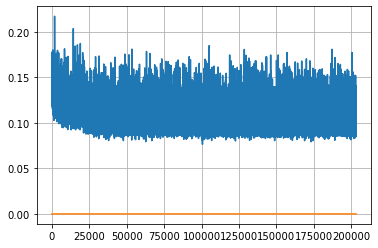

Epoch: 521, iteration 0, loss 0.09476920962333679, cov_diff 0.42348398269902343 cov_diff train 0.42221839523942867
Epoch: 521, iteration 1, loss 0.10389816761016846, cov_diff 0.4086750919746178 cov_diff train 0.4086093774180382
Epoch: 521, iteration 2, loss 0.1015576422214508, cov_diff 0.4068789515902681 cov_diff train 0.40681159123769334
Epoch: 521, iteration 3, loss 0.09779369831085205, cov_diff 0.4093500839203873 cov_diff train 0.40901253400340504
Epoch: 521, iteration 4, loss 0.10546991229057312, cov_diff 0.4100742734701437 cov_diff train 0.4100547707064203
Epoch: 521, iteration 5, loss 0.0983857810497284, cov_diff 0.4221390794447879 cov_diff train 0.4223800490142465
Epoch: 521, iteration 6, loss 0.10118657350540161, cov_diff 0.4222764417474174 cov_diff train 0.4211311154443956
Epoch: 521, iteration 7, loss 0.09797802567481995, cov_diff 0.40506130406749213 cov_diff train 0.40459431953203073
Epoch: 521, iteration 8, loss 0.10713732242584229, cov_diff 0.42323021148165824 cov_diff tra

Epoch: 521, iteration 79, loss 0.10104301571846008, cov_diff 0.4144264810118053 cov_diff train 0.4134394971049122
Epoch: 521, iteration 80, loss 0.10272741317749023, cov_diff 0.42305445111816453 cov_diff train 0.4226903878166341
Epoch: 521, iteration 81, loss 0.09638836979866028, cov_diff 0.42333328101076345 cov_diff train 0.4223457155573839
Epoch: 521, iteration 82, loss 0.10807943344116211, cov_diff 0.41413241508029947 cov_diff train 0.4128432276257722
Epoch: 521, iteration 83, loss 0.10489365458488464, cov_diff 0.4163758287911877 cov_diff train 0.4151225495825275
Epoch: 521, iteration 84, loss 0.1017507016658783, cov_diff 0.4151690793967939 cov_diff train 0.4134304897052181
Epoch: 521, iteration 85, loss 0.10069608688354492, cov_diff 0.399919977053201 cov_diff train 0.39876332541854115
Epoch: 521, iteration 86, loss 0.10206782817840576, cov_diff 0.41181778532554725 cov_diff train 0.41140617947828434
Epoch: 521, iteration 87, loss 0.09225764870643616, cov_diff 0.4115830636183731 cov_

Epoch: 521, iteration 159, loss 0.10221207141876221, cov_diff 0.4153610917559769 cov_diff train 0.41518305146809914
Epoch: 521, iteration 160, loss 0.09321984648704529, cov_diff 0.4188821195824241 cov_diff train 0.4174594689789361
Epoch: 521, iteration 161, loss 0.09634861350059509, cov_diff 0.41524282090617015 cov_diff train 0.41411903900828395
Epoch: 521, iteration 162, loss 0.10065144300460815, cov_diff 0.4191089920962232 cov_diff train 0.4172252103658901
Epoch: 521, iteration 163, loss 0.10541760921478271, cov_diff 0.4140513769116906 cov_diff train 0.41342531773139457
Epoch: 521, iteration 164, loss 0.10427767038345337, cov_diff 0.43065211474404624 cov_diff train 0.4300195576364201
Epoch: 521, iteration 165, loss 0.11133202910423279, cov_diff 0.4079995393462893 cov_diff train 0.4071854958695007
Epoch: 521, iteration 166, loss 0.10556554794311523, cov_diff 0.414857755606366 cov_diff train 0.4142747045891239
Epoch: 521, iteration 167, loss 0.09854945540428162, cov_diff 0.397619638312

Epoch: 521, iteration 235, loss 0.10193642973899841, cov_diff 0.4237864152729434 cov_diff train 0.4230281072654071
Epoch: 521, iteration 236, loss 0.10791248083114624, cov_diff 0.40793678014523976 cov_diff train 0.4076393658822352
Epoch: 521, iteration 237, loss 0.09927669167518616, cov_diff 0.3966483134467526 cov_diff train 0.3965906592646468
Epoch: 521, iteration 238, loss 0.11332693696022034, cov_diff 0.41276044321428323 cov_diff train 0.4129486563187574
Epoch: 521, iteration 239, loss 0.09694522619247437, cov_diff 0.41041673256435973 cov_diff train 0.40958769099007786
Epoch: 521, iteration 240, loss 0.10434982180595398, cov_diff 0.404522926720458 cov_diff train 0.4040872817334741
Epoch: 521, iteration 241, loss 0.10531598329544067, cov_diff 0.425341806870168 cov_diff train 0.4256831673120785
Epoch: 521, iteration 242, loss 0.11100959777832031, cov_diff 0.41159214698398006 cov_diff train 0.41215171828171443
Epoch: 521, iteration 243, loss 0.10657349228858948, cov_diff 0.426518631710

Epoch: 521, iteration 315, loss 0.1088387668132782, cov_diff 0.42102084529731476 cov_diff train 0.4210839067273145
Epoch: 521, iteration 316, loss 0.11395424604415894, cov_diff 0.42480521740137106 cov_diff train 0.42395015825047216
Epoch: 521, iteration 317, loss 0.10893648862838745, cov_diff 0.41319321310513335 cov_diff train 0.41128073172370294
Epoch: 521, iteration 318, loss 0.09716060757637024, cov_diff 0.4171730484061633 cov_diff train 0.4166281768809051
Epoch: 521, iteration 319, loss 0.09983530640602112, cov_diff 0.393577757557404 cov_diff train 0.3929422146520125
Epoch: 521, iteration 320, loss 0.10490298271179199, cov_diff 0.3956295201172406 cov_diff train 0.39519275325411757
Epoch: 521, iteration 321, loss 0.11051931977272034, cov_diff 0.40155396694166073 cov_diff train 0.40113614232818046
Epoch: 521, iteration 322, loss 0.10951659083366394, cov_diff 0.41089015985630306 cov_diff train 0.40978359221388844
Epoch: 521, iteration 323, loss 0.1062110960483551, cov_diff 0.413045048

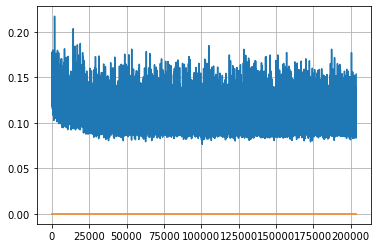

Epoch: 522, iteration 0, loss 0.09885901212692261, cov_diff 0.41523727568822877 cov_diff train 0.4141059736643151
Epoch: 522, iteration 1, loss 0.10207843780517578, cov_diff 0.4172205852885719 cov_diff train 0.4165497145557929
Epoch: 522, iteration 2, loss 0.1001858115196228, cov_diff 0.4110192589134485 cov_diff train 0.41071274446947736
Epoch: 522, iteration 3, loss 0.1035659909248352, cov_diff 0.418036543058057 cov_diff train 0.4166367910905724
Epoch: 522, iteration 4, loss 0.09639468789100647, cov_diff 0.40399551749484397 cov_diff train 0.4036628180617383
Epoch: 522, iteration 5, loss 0.09128189086914062, cov_diff 0.42582549404112846 cov_diff train 0.4243628151442062
Epoch: 522, iteration 6, loss 0.10546380281448364, cov_diff 0.4088729937742327 cov_diff train 0.40920904288194165
Epoch: 522, iteration 7, loss 0.11365914344787598, cov_diff 0.4135992395804187 cov_diff train 0.4125624182576099
Epoch: 522, iteration 8, loss 0.10628750920295715, cov_diff 0.40744765593265153 cov_diff train

Epoch: 522, iteration 80, loss 0.10540136694908142, cov_diff 0.422724539256251 cov_diff train 0.4224948540520471
Epoch: 522, iteration 81, loss 0.10748487710952759, cov_diff 0.4279059108807091 cov_diff train 0.42629505414444596
Epoch: 522, iteration 82, loss 0.11156576871871948, cov_diff 0.40268487404199893 cov_diff train 0.40210931024182706
Epoch: 522, iteration 83, loss 0.10803037881851196, cov_diff 0.4168584996649757 cov_diff train 0.41584983144154375
Epoch: 522, iteration 84, loss 0.10542351007461548, cov_diff 0.4282556602168978 cov_diff train 0.4264634460857686
Epoch: 522, iteration 85, loss 0.10381034016609192, cov_diff 0.4268892065834338 cov_diff train 0.42566167693636414
Epoch: 522, iteration 86, loss 0.10947239398956299, cov_diff 0.43964372804055696 cov_diff train 0.4386987540467786
Epoch: 522, iteration 87, loss 0.10755813121795654, cov_diff 0.4121573359276007 cov_diff train 0.41184078377536226
Epoch: 522, iteration 88, loss 0.10478523373603821, cov_diff 0.42890825243804376 c

Epoch: 522, iteration 159, loss 0.10017549991607666, cov_diff 0.417174670110694 cov_diff train 0.4166338621710294
Epoch: 522, iteration 160, loss 0.10806852579116821, cov_diff 0.40973487356151894 cov_diff train 0.40896950685529937
Epoch: 522, iteration 161, loss 0.09787943959236145, cov_diff 0.40233345420001004 cov_diff train 0.40172850522457265
Epoch: 522, iteration 162, loss 0.10853976011276245, cov_diff 0.40674966587220673 cov_diff train 0.4059773311774098
Epoch: 522, iteration 163, loss 0.10139009356498718, cov_diff 0.41720919640987664 cov_diff train 0.41637163338819644
Epoch: 522, iteration 164, loss 0.09757885336875916, cov_diff 0.4043171874573728 cov_diff train 0.40421075474713347
Epoch: 522, iteration 165, loss 0.10119259357452393, cov_diff 0.4113775360333623 cov_diff train 0.40955938398333847
Epoch: 522, iteration 166, loss 0.09940412640571594, cov_diff 0.4108847890669636 cov_diff train 0.41089278592501904
Epoch: 522, iteration 167, loss 0.09669041633605957, cov_diff 0.4114474

Epoch: 522, iteration 230, loss 0.09793627262115479, cov_diff 0.4121072959727857 cov_diff train 0.41226855028869513
Epoch: 522, iteration 231, loss 0.09259897470474243, cov_diff 0.4108302795711374 cov_diff train 0.409122931545812
Epoch: 522, iteration 232, loss 0.09438705444335938, cov_diff 0.4286614094578016 cov_diff train 0.4274318119714879
Epoch: 522, iteration 233, loss 0.10876816511154175, cov_diff 0.4161866816163942 cov_diff train 0.4149646055949578
Epoch: 522, iteration 234, loss 0.09880033135414124, cov_diff 0.40983576433560154 cov_diff train 0.4080253777303341
Epoch: 522, iteration 235, loss 0.08947446942329407, cov_diff 0.40317945768755914 cov_diff train 0.4030131134908888
Epoch: 522, iteration 236, loss 0.10374218225479126, cov_diff 0.41940103518778465 cov_diff train 0.4188347051448496
Epoch: 522, iteration 237, loss 0.09181162714958191, cov_diff 0.41726101311713937 cov_diff train 0.4168716649814231
Epoch: 522, iteration 238, loss 0.09272241592407227, cov_diff 0.416645920904

Epoch: 522, iteration 311, loss 0.1071363091468811, cov_diff 0.41876816213832546 cov_diff train 0.4173933689308354
Epoch: 522, iteration 312, loss 0.10732382535934448, cov_diff 0.404724163977722 cov_diff train 0.4030294179958877
Epoch: 522, iteration 313, loss 0.11501958966255188, cov_diff 0.41101328979182683 cov_diff train 0.41091018065421714
Epoch: 522, iteration 314, loss 0.10103902220726013, cov_diff 0.4074108635324332 cov_diff train 0.4075984562060407
Epoch: 522, iteration 315, loss 0.09842291474342346, cov_diff 0.421768820706783 cov_diff train 0.4211913005360451
Epoch: 522, iteration 316, loss 0.09714600443840027, cov_diff 0.4147880678960199 cov_diff train 0.4140454931649591
Epoch: 522, iteration 317, loss 0.10024258494377136, cov_diff 0.3987121175246692 cov_diff train 0.3984049943343147
Epoch: 522, iteration 318, loss 0.11307898163795471, cov_diff 0.4117220972943262 cov_diff train 0.4122393765557458
Epoch: 522, iteration 319, loss 0.10158365964889526, cov_diff 0.4104771147672834

Epoch: 522, iteration 390, loss 0.1545642912387848, cov_diff 0.4417599555670283 cov_diff train 0.44198762756845644


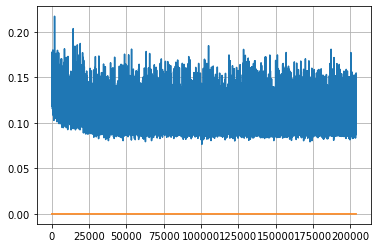

Epoch: 523, iteration 0, loss 0.10718509554862976, cov_diff 0.4219912075336801 cov_diff train 0.420886742709847
Epoch: 523, iteration 1, loss 0.09869277477264404, cov_diff 0.40927907127237084 cov_diff train 0.4082474709055574
Epoch: 523, iteration 2, loss 0.10774731636047363, cov_diff 0.4069800309929119 cov_diff train 0.4066176712004702
Epoch: 523, iteration 3, loss 0.11860299110412598, cov_diff 0.3979538509852528 cov_diff train 0.3972467304031272
Epoch: 523, iteration 4, loss 0.09290331602096558, cov_diff 0.4097828201158679 cov_diff train 0.40907536007294165
Epoch: 523, iteration 5, loss 0.10409852862358093, cov_diff 0.4110230127438733 cov_diff train 0.4103468799099711
Epoch: 523, iteration 6, loss 0.09515422582626343, cov_diff 0.4067482719270186 cov_diff train 0.4056642441168865
Epoch: 523, iteration 7, loss 0.11264550685882568, cov_diff 0.4109315357093546 cov_diff train 0.41025912101826806
Epoch: 523, iteration 8, loss 0.10242456197738647, cov_diff 0.41225401263047895 cov_diff train

Epoch: 523, iteration 79, loss 0.11285048723220825, cov_diff 0.41164955851757884 cov_diff train 0.41126055351669055
Epoch: 523, iteration 80, loss 0.10718795657157898, cov_diff 0.3998457493604236 cov_diff train 0.4001894527825162
Epoch: 523, iteration 81, loss 0.0988001823425293, cov_diff 0.4050319300323981 cov_diff train 0.4049517618757321
Epoch: 523, iteration 82, loss 0.09276169538497925, cov_diff 0.4119938990496951 cov_diff train 0.4120120019941408
Epoch: 523, iteration 83, loss 0.10741081833839417, cov_diff 0.41514582681177653 cov_diff train 0.41446269546250175
Epoch: 523, iteration 84, loss 0.10236740112304688, cov_diff 0.39966534316619895 cov_diff train 0.3981999210131214
Epoch: 523, iteration 85, loss 0.09926712512969971, cov_diff 0.42223791508512126 cov_diff train 0.42227649808906065
Epoch: 523, iteration 86, loss 0.09230181574821472, cov_diff 0.41488072467701853 cov_diff train 0.4145398829857011
Epoch: 523, iteration 87, loss 0.10325947403907776, cov_diff 0.4135733060598457 c

Epoch: 523, iteration 159, loss 0.10210874676704407, cov_diff 0.4183102046339815 cov_diff train 0.4178153012328411
Epoch: 523, iteration 160, loss 0.10744091868400574, cov_diff 0.4106158645754595 cov_diff train 0.40969824594938015
Epoch: 523, iteration 161, loss 0.09892502427101135, cov_diff 0.4195429477622575 cov_diff train 0.41869660611939136
Epoch: 523, iteration 162, loss 0.10186547040939331, cov_diff 0.42631843654235657 cov_diff train 0.4261688971852733
Epoch: 523, iteration 163, loss 0.09760472178459167, cov_diff 0.41040753905845406 cov_diff train 0.41004749667710644
Epoch: 523, iteration 164, loss 0.09859621524810791, cov_diff 0.41932817996230504 cov_diff train 0.41868382898139705
Epoch: 523, iteration 165, loss 0.09750300645828247, cov_diff 0.41291736590383876 cov_diff train 0.41188108277600155
Epoch: 523, iteration 166, loss 0.11125800013542175, cov_diff 0.4150147382148145 cov_diff train 0.4137527894712997
Epoch: 523, iteration 167, loss 0.11264395713806152, cov_diff 0.4109677

Epoch: 523, iteration 236, loss 0.10594427585601807, cov_diff 0.4168605863337668 cov_diff train 0.41601491454646455
Epoch: 523, iteration 237, loss 0.11459225416183472, cov_diff 0.41075577053412615 cov_diff train 0.4095113234149282
Epoch: 523, iteration 238, loss 0.09707245230674744, cov_diff 0.4070641860305806 cov_diff train 0.40644847522428273
Epoch: 523, iteration 239, loss 0.10271948575973511, cov_diff 0.40408882883462743 cov_diff train 0.40357853815220174
Epoch: 523, iteration 240, loss 0.10020849108695984, cov_diff 0.4112271544712124 cov_diff train 0.4108979915666488
Epoch: 523, iteration 241, loss 0.10570308566093445, cov_diff 0.40293705956953746 cov_diff train 0.40253833755182666
Epoch: 523, iteration 242, loss 0.12051722407341003, cov_diff 0.4076525449298659 cov_diff train 0.4064151207949816
Epoch: 523, iteration 243, loss 0.10091453790664673, cov_diff 0.40612001984015517 cov_diff train 0.40585476145223304
Epoch: 523, iteration 244, loss 0.09933483600616455, cov_diff 0.4106176

Epoch: 523, iteration 313, loss 0.10177600383758545, cov_diff 0.41840152389112556 cov_diff train 0.4175500554739254
Epoch: 523, iteration 314, loss 0.1102578341960907, cov_diff 0.40279338391300434 cov_diff train 0.4019622421573944
Epoch: 523, iteration 315, loss 0.11606308817863464, cov_diff 0.403698590035048 cov_diff train 0.4034120476335192
Epoch: 523, iteration 316, loss 0.11329379677772522, cov_diff 0.4129032046626627 cov_diff train 0.4127689067047684
Epoch: 523, iteration 317, loss 0.10345694422721863, cov_diff 0.41260760561133936 cov_diff train 0.41107694656196625
Epoch: 523, iteration 318, loss 0.10155189037322998, cov_diff 0.39756627392224575 cov_diff train 0.39624334963699387
Epoch: 523, iteration 319, loss 0.10279297828674316, cov_diff 0.409944638058965 cov_diff train 0.4088108719005861
Epoch: 523, iteration 320, loss 0.11488276720046997, cov_diff 0.4156735056842081 cov_diff train 0.4140865778873537
Epoch: 523, iteration 321, loss 0.09167784452438354, cov_diff 0.4139096578776

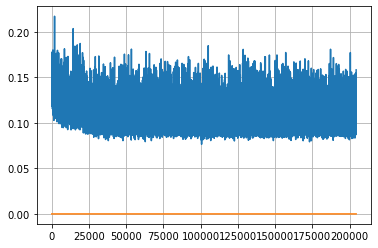

Epoch: 524, iteration 0, loss 0.09858012199401855, cov_diff 0.4161635171253209 cov_diff train 0.4156319640548684
Epoch: 524, iteration 1, loss 0.10923096537590027, cov_diff 0.4161479041172553 cov_diff train 0.415074296379629
Epoch: 524, iteration 2, loss 0.11090314388275146, cov_diff 0.4160348099877439 cov_diff train 0.41489400554029104
Epoch: 524, iteration 3, loss 0.11626327037811279, cov_diff 0.3963341632854329 cov_diff train 0.39490559019791116
Epoch: 524, iteration 4, loss 0.10922357439994812, cov_diff 0.41924755468159747 cov_diff train 0.4192107382257049
Epoch: 524, iteration 5, loss 0.10142388939857483, cov_diff 0.4233451704080428 cov_diff train 0.4223011791629523
Epoch: 524, iteration 6, loss 0.10862690210342407, cov_diff 0.42104397879443745 cov_diff train 0.420605970225656
Epoch: 524, iteration 7, loss 0.10015615820884705, cov_diff 0.39998498745371197 cov_diff train 0.3980596970125309
Epoch: 524, iteration 8, loss 0.09370607137680054, cov_diff 0.4061531107080214 cov_diff train

Epoch: 524, iteration 72, loss 0.10034596920013428, cov_diff 0.41176803510212245 cov_diff train 0.4105110007491031
Epoch: 524, iteration 73, loss 0.0949765145778656, cov_diff 0.4153669055267687 cov_diff train 0.41504820388942676
Epoch: 524, iteration 74, loss 0.10035881400108337, cov_diff 0.40716821682622245 cov_diff train 0.406812713254726
Epoch: 524, iteration 75, loss 0.12003123760223389, cov_diff 0.416839349279878 cov_diff train 0.415794688080883
Epoch: 524, iteration 76, loss 0.10763892531394958, cov_diff 0.40724519322773994 cov_diff train 0.4074171333985564
Epoch: 524, iteration 77, loss 0.10453656315803528, cov_diff 0.4111516597788724 cov_diff train 0.41014683109836714
Epoch: 524, iteration 78, loss 0.11537829041481018, cov_diff 0.4215612109520188 cov_diff train 0.42043837653489124
Epoch: 524, iteration 79, loss 0.1071372926235199, cov_diff 0.41369828122939306 cov_diff train 0.4117377985007153
Epoch: 524, iteration 80, loss 0.09134894609451294, cov_diff 0.4192864897785891 cov_di

Epoch: 524, iteration 153, loss 0.09749966859817505, cov_diff 0.41300990444053415 cov_diff train 0.41226486614540897
Epoch: 524, iteration 154, loss 0.10369816422462463, cov_diff 0.4038099521784662 cov_diff train 0.40373939338801673
Epoch: 524, iteration 155, loss 0.10609361529350281, cov_diff 0.40226414811376004 cov_diff train 0.40202208630722736
Epoch: 524, iteration 156, loss 0.09825906157493591, cov_diff 0.41080174876652337 cov_diff train 0.4097481625353799
Epoch: 524, iteration 157, loss 0.10131645202636719, cov_diff 0.41785324251540046 cov_diff train 0.41617736964546326
Epoch: 524, iteration 158, loss 0.10184803605079651, cov_diff 0.4176331635022196 cov_diff train 0.41618774283103055
Epoch: 524, iteration 159, loss 0.10410943627357483, cov_diff 0.39969137122294623 cov_diff train 0.39897963560094196
Epoch: 524, iteration 160, loss 0.10647103190422058, cov_diff 0.41147611069479667 cov_diff train 0.4114586109289671
Epoch: 524, iteration 161, loss 0.10514900088310242, cov_diff 0.4113

Epoch: 524, iteration 224, loss 0.10217010974884033, cov_diff 0.4130852270005063 cov_diff train 0.4122308315891269
Epoch: 524, iteration 225, loss 0.08684033155441284, cov_diff 0.4112693757008817 cov_diff train 0.41000817764429115
Epoch: 524, iteration 226, loss 0.10021695494651794, cov_diff 0.4047488449894496 cov_diff train 0.40445173199065493
Epoch: 524, iteration 227, loss 0.10325637459754944, cov_diff 0.4113978205060024 cov_diff train 0.4105604733524373
Epoch: 524, iteration 228, loss 0.1031719446182251, cov_diff 0.4013552481443177 cov_diff train 0.40089548875069886
Epoch: 524, iteration 229, loss 0.10705018043518066, cov_diff 0.40595985362341036 cov_diff train 0.4041329772479678
Epoch: 524, iteration 230, loss 0.11315330862998962, cov_diff 0.41634396994428624 cov_diff train 0.4163731569805236
Epoch: 524, iteration 231, loss 0.10359114408493042, cov_diff 0.40822565557184987 cov_diff train 0.4077688556170057
Epoch: 524, iteration 232, loss 0.10928213596343994, cov_diff 0.41188229809

Epoch: 524, iteration 304, loss 0.09813070297241211, cov_diff 0.4169685415322528 cov_diff train 0.4167399767713219
Epoch: 524, iteration 305, loss 0.09992557764053345, cov_diff 0.4100902728326696 cov_diff train 0.4090661059098629
Epoch: 524, iteration 306, loss 0.10614463686943054, cov_diff 0.4174824892096502 cov_diff train 0.41598472274530574
Epoch: 524, iteration 307, loss 0.08842933177947998, cov_diff 0.40630486144613637 cov_diff train 0.4061766568854553
Epoch: 524, iteration 308, loss 0.10490107536315918, cov_diff 0.43125726521756136 cov_diff train 0.43194082810994894
Epoch: 524, iteration 309, loss 0.09321758151054382, cov_diff 0.4104642019334153 cov_diff train 0.4086769575851382
Epoch: 524, iteration 310, loss 0.09300684928894043, cov_diff 0.4198575532071977 cov_diff train 0.4189696574708925
Epoch: 524, iteration 311, loss 0.09701645374298096, cov_diff 0.40723327336495724 cov_diff train 0.4070383571424831
Epoch: 524, iteration 312, loss 0.09826499223709106, cov_diff 0.41226530149

Epoch: 524, iteration 385, loss 0.1063237190246582, cov_diff 0.42001927844449904 cov_diff train 0.41941054452901194
Epoch: 524, iteration 386, loss 0.11019575595855713, cov_diff 0.41125334434388017 cov_diff train 0.4110051361627826
Epoch: 524, iteration 387, loss 0.1065724790096283, cov_diff 0.3906523772227513 cov_diff train 0.389458526476218
Epoch: 524, iteration 388, loss 0.1036413311958313, cov_diff 0.41258380505566494 cov_diff train 0.4114306245834698
Epoch: 524, iteration 389, loss 0.09461390972137451, cov_diff 0.4185045222570922 cov_diff train 0.41702228754029125
Epoch: 524, iteration 390, loss 0.15523850917816162, cov_diff 0.46692389232339676 cov_diff train 0.4637604627890659


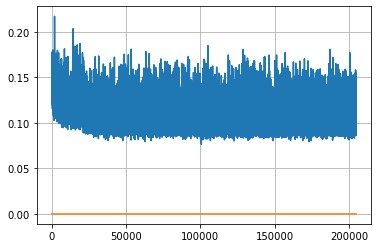

Epoch: 525, iteration 0, loss 0.10333287715911865, cov_diff 0.4053806515360391 cov_diff train 0.40431182526813336
Epoch: 525, iteration 1, loss 0.09841004014015198, cov_diff 0.4105639204726232 cov_diff train 0.41108007936599117
Epoch: 525, iteration 2, loss 0.10311591625213623, cov_diff 0.4167156915726458 cov_diff train 0.4152125296815653
Epoch: 525, iteration 3, loss 0.11143162846565247, cov_diff 0.40796830943036644 cov_diff train 0.4072527515302026
Epoch: 525, iteration 4, loss 0.10633507370948792, cov_diff 0.41664093613803005 cov_diff train 0.41588032627501675
Epoch: 525, iteration 5, loss 0.1071435809135437, cov_diff 0.4132361088489749 cov_diff train 0.4120638871879664
Epoch: 525, iteration 6, loss 0.10630011558532715, cov_diff 0.42266030056519877 cov_diff train 0.42266554400211426
Epoch: 525, iteration 7, loss 0.09448510408401489, cov_diff 0.4065583928380847 cov_diff train 0.4060839699914902
Epoch: 525, iteration 8, loss 0.10200130939483643, cov_diff 0.41469134813623676 cov_diff t

Epoch: 525, iteration 80, loss 0.09691396355628967, cov_diff 0.4116618373516235 cov_diff train 0.41108600445136756
Epoch: 525, iteration 81, loss 0.10591748356819153, cov_diff 0.40905826784508165 cov_diff train 0.4084762375084815
Epoch: 525, iteration 82, loss 0.11724436283111572, cov_diff 0.4162899436566642 cov_diff train 0.41582166022157163
Epoch: 525, iteration 83, loss 0.110118567943573, cov_diff 0.41513189778246223 cov_diff train 0.41510857536888257
Epoch: 525, iteration 84, loss 0.09875032305717468, cov_diff 0.4216347286857174 cov_diff train 0.4201355650697893
Epoch: 525, iteration 85, loss 0.09354257583618164, cov_diff 0.4187575173237627 cov_diff train 0.41816079564256636
Epoch: 525, iteration 86, loss 0.10641124844551086, cov_diff 0.4060997350722639 cov_diff train 0.4055612443095079
Epoch: 525, iteration 87, loss 0.10646092891693115, cov_diff 0.42005626139604685 cov_diff train 0.4194432470324443
Epoch: 525, iteration 88, loss 0.10426214337348938, cov_diff 0.41708917477150287 co

Epoch: 525, iteration 158, loss 0.11418592929840088, cov_diff 0.3978853271741655 cov_diff train 0.3969384360808126
Epoch: 525, iteration 159, loss 0.08881932497024536, cov_diff 0.40563095143623185 cov_diff train 0.40532964196565036
Epoch: 525, iteration 160, loss 0.09790828824043274, cov_diff 0.41018029494641933 cov_diff train 0.41001276115470303
Epoch: 525, iteration 161, loss 0.10500490665435791, cov_diff 0.3952522528386102 cov_diff train 0.3949233538194886
Epoch: 525, iteration 162, loss 0.09924665093421936, cov_diff 0.41588479212497936 cov_diff train 0.41496428619316783
Epoch: 525, iteration 163, loss 0.10395291447639465, cov_diff 0.4029271393013919 cov_diff train 0.40211643067294867
Epoch: 525, iteration 164, loss 0.10299950838088989, cov_diff 0.407210044169955 cov_diff train 0.4068255608529841
Epoch: 525, iteration 165, loss 0.1066129207611084, cov_diff 0.4187208266392548 cov_diff train 0.4176979372049636
Epoch: 525, iteration 166, loss 0.10317760705947876, cov_diff 0.41775890580

Epoch: 525, iteration 236, loss 0.09673091769218445, cov_diff 0.42567650052878936 cov_diff train 0.4245286370072261
Epoch: 525, iteration 237, loss 0.09269219636917114, cov_diff 0.4055347009577746 cov_diff train 0.4060849544882473
Epoch: 525, iteration 238, loss 0.09612849354743958, cov_diff 0.41640497412187644 cov_diff train 0.41480082300031534
Epoch: 525, iteration 239, loss 0.11508798599243164, cov_diff 0.40487869714961755 cov_diff train 0.4027643860839451
Epoch: 525, iteration 240, loss 0.09627264738082886, cov_diff 0.408312737046116 cov_diff train 0.4073980034046913
Epoch: 525, iteration 241, loss 0.09693014621734619, cov_diff 0.4195170709956252 cov_diff train 0.418417249746788
Epoch: 525, iteration 242, loss 0.1114366352558136, cov_diff 0.4265712325507599 cov_diff train 0.4260569558673013
Epoch: 525, iteration 243, loss 0.0992957353591919, cov_diff 0.4137590114197518 cov_diff train 0.4128529907625529
Epoch: 525, iteration 244, loss 0.10559993982315063, cov_diff 0.4116691794137114

Epoch: 525, iteration 313, loss 0.10738304257392883, cov_diff 0.4084966396815355 cov_diff train 0.40694091559933376
Epoch: 525, iteration 314, loss 0.09073403477668762, cov_diff 0.40111967457217207 cov_diff train 0.40047022186154674
Epoch: 525, iteration 315, loss 0.10198670625686646, cov_diff 0.41062612320464703 cov_diff train 0.4089007715689409
Epoch: 525, iteration 316, loss 0.11245572566986084, cov_diff 0.4220984055382223 cov_diff train 0.42125966841188817
Epoch: 525, iteration 317, loss 0.10486871004104614, cov_diff 0.4177435662628915 cov_diff train 0.4169847737876876
Epoch: 525, iteration 318, loss 0.10699552297592163, cov_diff 0.4010864205686705 cov_diff train 0.40021077511056147
Epoch: 525, iteration 319, loss 0.1238560676574707, cov_diff 0.40360713938335235 cov_diff train 0.40449622847520966
Epoch: 525, iteration 320, loss 0.10942158102989197, cov_diff 0.41333830244104675 cov_diff train 0.4135867852332507
Epoch: 525, iteration 321, loss 0.11202213168144226, cov_diff 0.40503474

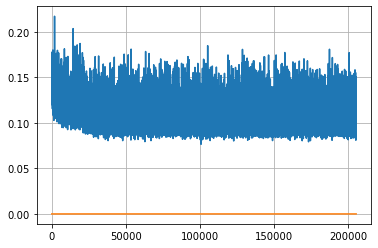

Epoch: 526, iteration 0, loss 0.09137475490570068, cov_diff 0.40294348449722 cov_diff train 0.40246386999396816
Epoch: 526, iteration 1, loss 0.10420095920562744, cov_diff 0.41363860211549963 cov_diff train 0.41320994475325556
Epoch: 526, iteration 2, loss 0.10907226800918579, cov_diff 0.40357096997414904 cov_diff train 0.40294088053365484
Epoch: 526, iteration 3, loss 0.09740981459617615, cov_diff 0.40185431904616337 cov_diff train 0.40083689922802396
Epoch: 526, iteration 4, loss 0.10327678918838501, cov_diff 0.4162082929206891 cov_diff train 0.41466557169654394
Epoch: 526, iteration 5, loss 0.09756037592887878, cov_diff 0.40724007034675336 cov_diff train 0.40631208589162765
Epoch: 526, iteration 6, loss 0.08974391222000122, cov_diff 0.40138170622002756 cov_diff train 0.4003853945297976
Epoch: 526, iteration 7, loss 0.10092717409133911, cov_diff 0.39980630932252287 cov_diff train 0.39902788668643224
Epoch: 526, iteration 8, loss 0.09861281514167786, cov_diff 0.41235864962759844 cov_d

Epoch: 526, iteration 81, loss 0.10490712523460388, cov_diff 0.41056083681993255 cov_diff train 0.41005207334125826
Epoch: 526, iteration 82, loss 0.11490428447723389, cov_diff 0.4089150602397337 cov_diff train 0.4079805847850646
Epoch: 526, iteration 83, loss 0.10034295916557312, cov_diff 0.4081041014124577 cov_diff train 0.40770117183057164
Epoch: 526, iteration 84, loss 0.09888070821762085, cov_diff 0.40924771711269536 cov_diff train 0.4084796138939055
Epoch: 526, iteration 85, loss 0.10801029205322266, cov_diff 0.42243893648377767 cov_diff train 0.42180643146613117
Epoch: 526, iteration 86, loss 0.10353168845176697, cov_diff 0.41331066128125515 cov_diff train 0.4124234319285133
Epoch: 526, iteration 87, loss 0.09875097870826721, cov_diff 0.4187244369957442 cov_diff train 0.4188977822514051
Epoch: 526, iteration 88, loss 0.10406056046485901, cov_diff 0.4021248590189201 cov_diff train 0.4017753133916733
Epoch: 526, iteration 89, loss 0.09603545069694519, cov_diff 0.41169773719577574 

Epoch: 526, iteration 161, loss 0.09720674157142639, cov_diff 0.40776104595897256 cov_diff train 0.4067651062982933
Epoch: 526, iteration 162, loss 0.09241089224815369, cov_diff 0.3996219169395453 cov_diff train 0.3983408836471505
Epoch: 526, iteration 163, loss 0.10240146517753601, cov_diff 0.4008697324891246 cov_diff train 0.4005183806957725
Epoch: 526, iteration 164, loss 0.10675022006034851, cov_diff 0.4125703730212305 cov_diff train 0.4123566030912261
Epoch: 526, iteration 165, loss 0.10422924160957336, cov_diff 0.4101962747005502 cov_diff train 0.4094315419028577
Epoch: 526, iteration 166, loss 0.1041494607925415, cov_diff 0.41178296313724877 cov_diff train 0.4107646973622055
Epoch: 526, iteration 167, loss 0.10619977116584778, cov_diff 0.4115957822302177 cov_diff train 0.41110005354861595
Epoch: 526, iteration 168, loss 0.09907591342926025, cov_diff 0.4135271089013137 cov_diff train 0.41260762749817437
Epoch: 526, iteration 169, loss 0.10319340229034424, cov_diff 0.4208362366420

Epoch: 526, iteration 241, loss 0.09729641675949097, cov_diff 0.3952773381356499 cov_diff train 0.3940066745443034
Epoch: 526, iteration 242, loss 0.10448229312896729, cov_diff 0.4104190902262031 cov_diff train 0.4100780622279885
Epoch: 526, iteration 243, loss 0.1045006811618805, cov_diff 0.4007200500994172 cov_diff train 0.4003574584121953
Epoch: 526, iteration 244, loss 0.10478290915489197, cov_diff 0.4086735992933358 cov_diff train 0.4081166251711484
Epoch: 526, iteration 245, loss 0.10502952337265015, cov_diff 0.4238691608573123 cov_diff train 0.42222043805479786
Epoch: 526, iteration 246, loss 0.12367573380470276, cov_diff 0.4095361573991137 cov_diff train 0.4088750633978288
Epoch: 526, iteration 247, loss 0.11698049306869507, cov_diff 0.4170330201355884 cov_diff train 0.4158513431349974
Epoch: 526, iteration 248, loss 0.0895727276802063, cov_diff 0.4196133005201948 cov_diff train 0.41858984275851246
Epoch: 526, iteration 249, loss 0.09985682368278503, cov_diff 0.4088917710648687

Epoch: 526, iteration 320, loss 0.0975726842880249, cov_diff 0.41272081838903546 cov_diff train 0.4126749147223497
Epoch: 526, iteration 321, loss 0.09511050581932068, cov_diff 0.4084572552187822 cov_diff train 0.4069759414811735
Epoch: 526, iteration 322, loss 0.11642178893089294, cov_diff 0.4022798210515341 cov_diff train 0.401849501219768
Epoch: 526, iteration 323, loss 0.10455644130706787, cov_diff 0.4128616762368156 cov_diff train 0.41219981204349043
Epoch: 526, iteration 324, loss 0.10182517766952515, cov_diff 0.4125290414724999 cov_diff train 0.41205854864876756
Epoch: 526, iteration 325, loss 0.09787067770957947, cov_diff 0.4080647676188213 cov_diff train 0.40750051093414097
Epoch: 526, iteration 326, loss 0.10670587420463562, cov_diff 0.41274418936494206 cov_diff train 0.412428826417224
Epoch: 526, iteration 327, loss 0.10040485858917236, cov_diff 0.4183576244415385 cov_diff train 0.41802708925594306
Epoch: 526, iteration 328, loss 0.08793407678604126, cov_diff 0.4129015147395

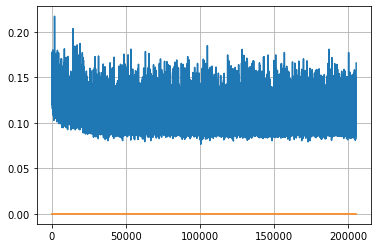

Epoch: 527, iteration 0, loss 0.10492688417434692, cov_diff 0.40999156155603456 cov_diff train 0.4079709595040877
Epoch: 527, iteration 1, loss 0.10037511587142944, cov_diff 0.41582511389077065 cov_diff train 0.41535603110104957
Epoch: 527, iteration 2, loss 0.10154318809509277, cov_diff 0.3968612519759984 cov_diff train 0.39625891645814443
Epoch: 527, iteration 3, loss 0.08730044960975647, cov_diff 0.4048615385371985 cov_diff train 0.404731322631505
Epoch: 527, iteration 4, loss 0.11128485202789307, cov_diff 0.40944064672121333 cov_diff train 0.4085300077690293
Epoch: 527, iteration 5, loss 0.10486909747123718, cov_diff 0.4100772595414042 cov_diff train 0.40925087182308123
Epoch: 527, iteration 6, loss 0.100913405418396, cov_diff 0.40392879476263255 cov_diff train 0.402719919719206
Epoch: 527, iteration 7, loss 0.1070614755153656, cov_diff 0.40834717179763663 cov_diff train 0.40746338109306357
Epoch: 527, iteration 8, loss 0.09835967421531677, cov_diff 0.4120373577432008 cov_diff trai

Epoch: 527, iteration 81, loss 0.10237070918083191, cov_diff 0.40674253937787413 cov_diff train 0.4048691682836673
Epoch: 527, iteration 82, loss 0.1036110520362854, cov_diff 0.41805092389687404 cov_diff train 0.41639372173063893
Epoch: 527, iteration 83, loss 0.10638207197189331, cov_diff 0.4138218843624828 cov_diff train 0.4122141280992609
Epoch: 527, iteration 84, loss 0.10428622364997864, cov_diff 0.4075870718189447 cov_diff train 0.4051026188059662
Epoch: 527, iteration 85, loss 0.09281453490257263, cov_diff 0.4147891373855473 cov_diff train 0.41383565551210927
Epoch: 527, iteration 86, loss 0.09406131505966187, cov_diff 0.4087369239581972 cov_diff train 0.40831463619074015
Epoch: 527, iteration 87, loss 0.10361224412918091, cov_diff 0.4052976671818346 cov_diff train 0.40435516387905446
Epoch: 527, iteration 88, loss 0.11066073179244995, cov_diff 0.40533897397601404 cov_diff train 0.4043232731975778
Epoch: 527, iteration 89, loss 0.09875679016113281, cov_diff 0.4041085234400654 co

Epoch: 527, iteration 161, loss 0.10737192630767822, cov_diff 0.4115146454491582 cov_diff train 0.4106202014083515
Epoch: 527, iteration 162, loss 0.10164028406143188, cov_diff 0.40644948707743184 cov_diff train 0.4060840447273778
Epoch: 527, iteration 163, loss 0.10380864143371582, cov_diff 0.40045464072086345 cov_diff train 0.40064494478631996
Epoch: 527, iteration 164, loss 0.1036885678768158, cov_diff 0.39867462518489005 cov_diff train 0.3981064534634803
Epoch: 527, iteration 165, loss 0.09693557024002075, cov_diff 0.4135161753119108 cov_diff train 0.41253723726326574
Epoch: 527, iteration 166, loss 0.10922086238861084, cov_diff 0.40913657057493175 cov_diff train 0.40768600933793236
Epoch: 527, iteration 167, loss 0.11320939660072327, cov_diff 0.41643837455355076 cov_diff train 0.4154043269676323
Epoch: 527, iteration 168, loss 0.09128069877624512, cov_diff 0.4102794085234847 cov_diff train 0.4098879118713734
Epoch: 527, iteration 169, loss 0.09970661997795105, cov_diff 0.406031657

Epoch: 527, iteration 242, loss 0.10562366247177124, cov_diff 0.41478360648289087 cov_diff train 0.4147167252137008
Epoch: 527, iteration 243, loss 0.10114690661430359, cov_diff 0.4210202756855708 cov_diff train 0.4201175996189921
Epoch: 527, iteration 244, loss 0.10706642270088196, cov_diff 0.40805474079114146 cov_diff train 0.40859128446312576
Epoch: 527, iteration 245, loss 0.09871208667755127, cov_diff 0.419969848475864 cov_diff train 0.4180452271458298
Epoch: 527, iteration 246, loss 0.11588060855865479, cov_diff 0.4082120543365716 cov_diff train 0.40605245283121305
Epoch: 527, iteration 247, loss 0.0959896445274353, cov_diff 0.4125915328989866 cov_diff train 0.4115474849110483
Epoch: 527, iteration 248, loss 0.09732663631439209, cov_diff 0.40567427087851254 cov_diff train 0.40494283993408586
Epoch: 527, iteration 249, loss 0.0942949652671814, cov_diff 0.4060518618880329 cov_diff train 0.40555977319399555
Epoch: 527, iteration 250, loss 0.09583458304405212, cov_diff 0.413154901384

Epoch: 527, iteration 322, loss 0.10056257247924805, cov_diff 0.4149724811699848 cov_diff train 0.41399911142385004
Epoch: 527, iteration 323, loss 0.10472437739372253, cov_diff 0.41328797606566897 cov_diff train 0.41109211207558777
Epoch: 527, iteration 324, loss 0.1022455096244812, cov_diff 0.4085000329719098 cov_diff train 0.40729948619933176
Epoch: 527, iteration 325, loss 0.0998038649559021, cov_diff 0.4152184807668473 cov_diff train 0.4141483224018618
Epoch: 527, iteration 326, loss 0.1157817542552948, cov_diff 0.42103278806937183 cov_diff train 0.4206434608599996
Epoch: 527, iteration 327, loss 0.09756135940551758, cov_diff 0.41353379088957704 cov_diff train 0.41210083239841
Epoch: 527, iteration 328, loss 0.09936848282814026, cov_diff 0.41004736567494976 cov_diff train 0.40986522607464204
Epoch: 527, iteration 329, loss 0.09412091970443726, cov_diff 0.40125007510572896 cov_diff train 0.3999978219245012
Epoch: 527, iteration 330, loss 0.10019674897193909, cov_diff 0.406015584785

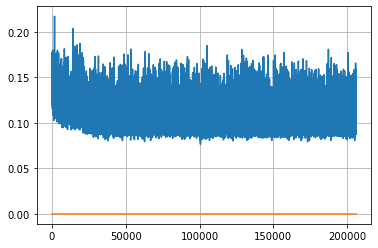

Epoch: 528, iteration 0, loss 0.1028406023979187, cov_diff 0.4065974424521182 cov_diff train 0.4063564439451853
Epoch: 528, iteration 1, loss 0.09966731071472168, cov_diff 0.40580345149668645 cov_diff train 0.4053431436403705
Epoch: 528, iteration 2, loss 0.1044704020023346, cov_diff 0.40973675684330507 cov_diff train 0.409509414626922
Epoch: 528, iteration 3, loss 0.1098465621471405, cov_diff 0.4150075163549745 cov_diff train 0.4149429729580803
Epoch: 528, iteration 4, loss 0.10464876890182495, cov_diff 0.4114944396476764 cov_diff train 0.41097080680262993
Epoch: 528, iteration 5, loss 0.10587146878242493, cov_diff 0.42284543945935177 cov_diff train 0.42230023233337427
Epoch: 528, iteration 6, loss 0.09073507785797119, cov_diff 0.40409600499904763 cov_diff train 0.40430750768649176
Epoch: 528, iteration 7, loss 0.09270018339157104, cov_diff 0.4156619286718785 cov_diff train 0.4145394411902244
Epoch: 528, iteration 8, loss 0.10531973838806152, cov_diff 0.42423466344169536 cov_diff trai

Epoch: 528, iteration 79, loss 0.09672853350639343, cov_diff 0.41568182384633784 cov_diff train 0.4148967811538727
Epoch: 528, iteration 80, loss 0.09966757893562317, cov_diff 0.4102093443291133 cov_diff train 0.4101171198841838
Epoch: 528, iteration 81, loss 0.09251746535301208, cov_diff 0.41199165700030255 cov_diff train 0.4107109072613783
Epoch: 528, iteration 82, loss 0.11002799868583679, cov_diff 0.4156828992280379 cov_diff train 0.4150219383755616
Epoch: 528, iteration 83, loss 0.09878426790237427, cov_diff 0.41243189237806577 cov_diff train 0.4117008725498726
Epoch: 528, iteration 84, loss 0.09409463405609131, cov_diff 0.41111244419643833 cov_diff train 0.40993902406613114
Epoch: 528, iteration 85, loss 0.09496510028839111, cov_diff 0.40374793090932193 cov_diff train 0.4033320760315932
Epoch: 528, iteration 86, loss 0.10271215438842773, cov_diff 0.39836154796985596 cov_diff train 0.39682036566067197
Epoch: 528, iteration 87, loss 0.10045385360717773, cov_diff 0.42170434854717176

Epoch: 528, iteration 162, loss 0.11062616109848022, cov_diff 0.41178691489263547 cov_diff train 0.41091451567972775
Epoch: 528, iteration 163, loss 0.10887962579727173, cov_diff 0.4101548154738625 cov_diff train 0.4095144190068415
Epoch: 528, iteration 164, loss 0.10298338532447815, cov_diff 0.4187948885378954 cov_diff train 0.4182302270447168
Epoch: 528, iteration 165, loss 0.0956437885761261, cov_diff 0.3961581813771131 cov_diff train 0.39583302148875027
Epoch: 528, iteration 166, loss 0.10425117611885071, cov_diff 0.41146642772469105 cov_diff train 0.4109901358071432
Epoch: 528, iteration 167, loss 0.10713019967079163, cov_diff 0.4120466789658882 cov_diff train 0.411467537451833
Epoch: 528, iteration 168, loss 0.103152334690094, cov_diff 0.41742180329504175 cov_diff train 0.4154663925667712
Epoch: 528, iteration 169, loss 0.10741713643074036, cov_diff 0.4009033769452537 cov_diff train 0.40033897571884336
Epoch: 528, iteration 170, loss 0.10188519954681396, cov_diff 0.41762220944270

Epoch: 528, iteration 240, loss 0.10451579093933105, cov_diff 0.41815029854043667 cov_diff train 0.41733250420447277
Epoch: 528, iteration 241, loss 0.10725879669189453, cov_diff 0.41024896544426487 cov_diff train 0.40900768920313546
Epoch: 528, iteration 242, loss 0.0992245078086853, cov_diff 0.4018264072866215 cov_diff train 0.40108849532592916
Epoch: 528, iteration 243, loss 0.10089516639709473, cov_diff 0.41294428662875504 cov_diff train 0.411111859145683
Epoch: 528, iteration 244, loss 0.10794082283973694, cov_diff 0.4035481440179956 cov_diff train 0.4021652967685033
Epoch: 528, iteration 245, loss 0.10940885543823242, cov_diff 0.4009955439242673 cov_diff train 0.39903266742661553
Epoch: 528, iteration 246, loss 0.10552459955215454, cov_diff 0.42399043202160924 cov_diff train 0.42221225504019927
Epoch: 528, iteration 247, loss 0.09615328907966614, cov_diff 0.41005102719647957 cov_diff train 0.40921618755483485
Epoch: 528, iteration 248, loss 0.1106257438659668, cov_diff 0.41905200

Epoch: 528, iteration 316, loss 0.10771298408508301, cov_diff 0.4151666022973648 cov_diff train 0.41446127617923123
Epoch: 528, iteration 317, loss 0.10575881600379944, cov_diff 0.411288218257958 cov_diff train 0.4104476288714443
Epoch: 528, iteration 318, loss 0.09710147976875305, cov_diff 0.41023561158917865 cov_diff train 0.4092636046207888
Epoch: 528, iteration 319, loss 0.09594342112541199, cov_diff 0.42117078831065186 cov_diff train 0.420130712959856
Epoch: 528, iteration 320, loss 0.09691411256790161, cov_diff 0.40591196178929595 cov_diff train 0.4053009938190686
Epoch: 528, iteration 321, loss 0.10633039474487305, cov_diff 0.40944740730140594 cov_diff train 0.40941631647106913
Epoch: 528, iteration 322, loss 0.09725719690322876, cov_diff 0.3978107804490113 cov_diff train 0.39639105297668814
Epoch: 528, iteration 323, loss 0.10810017585754395, cov_diff 0.41087694460216395 cov_diff train 0.41086557343095365
Epoch: 528, iteration 324, loss 0.10676521062850952, cov_diff 0.405599360

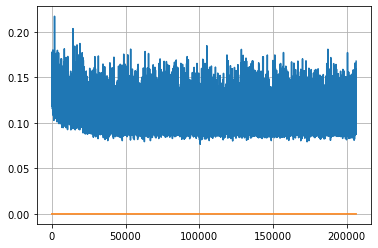

Epoch: 529, iteration 0, loss 0.10162442922592163, cov_diff 0.4115696956233298 cov_diff train 0.4113929000576656
Epoch: 529, iteration 1, loss 0.10519969463348389, cov_diff 0.4109559530639495 cov_diff train 0.4105506132536973
Epoch: 529, iteration 2, loss 0.09770885109901428, cov_diff 0.4098641759489679 cov_diff train 0.40948091844744117
Epoch: 529, iteration 3, loss 0.1013849675655365, cov_diff 0.41593093799157904 cov_diff train 0.41582609145207633
Epoch: 529, iteration 4, loss 0.10462090373039246, cov_diff 0.4006455316625449 cov_diff train 0.3994175736544939
Epoch: 529, iteration 5, loss 0.09880757331848145, cov_diff 0.41532579042786205 cov_diff train 0.41526317701879584
Epoch: 529, iteration 6, loss 0.09394088387489319, cov_diff 0.40274082153968066 cov_diff train 0.4027101134413628
Epoch: 529, iteration 7, loss 0.09238529205322266, cov_diff 0.40605356627189837 cov_diff train 0.4056618817599532
Epoch: 529, iteration 8, loss 0.09766694903373718, cov_diff 0.41650787878470513 cov_diff t

Epoch: 529, iteration 82, loss 0.10549890995025635, cov_diff 0.4046771071280544 cov_diff train 0.4039533360556576
Epoch: 529, iteration 83, loss 0.09977248311042786, cov_diff 0.4201536196478798 cov_diff train 0.41977785014867575
Epoch: 529, iteration 84, loss 0.09109330177307129, cov_diff 0.4206621620229589 cov_diff train 0.4203255834947076
Epoch: 529, iteration 85, loss 0.11092633008956909, cov_diff 0.40587633885255 cov_diff train 0.40580364040624534
Epoch: 529, iteration 86, loss 0.10505574941635132, cov_diff 0.4142863991619713 cov_diff train 0.41281804518421
Epoch: 529, iteration 87, loss 0.10396546125411987, cov_diff 0.40920671405251285 cov_diff train 0.4088479884408295
Epoch: 529, iteration 88, loss 0.09984272718429565, cov_diff 0.41875749665431256 cov_diff train 0.417983295826929
Epoch: 529, iteration 89, loss 0.10429573059082031, cov_diff 0.40577823653901846 cov_diff train 0.4045140387060081
Epoch: 529, iteration 90, loss 0.10757514834403992, cov_diff 0.396926175092544 cov_diff 

Epoch: 529, iteration 159, loss 0.10138177871704102, cov_diff 0.4042327207637018 cov_diff train 0.40353626063257203
Epoch: 529, iteration 160, loss 0.1010836660861969, cov_diff 0.40957984739863834 cov_diff train 0.408218336626047
Epoch: 529, iteration 161, loss 0.10538965463638306, cov_diff 0.4142648387103141 cov_diff train 0.4125459293570485
Epoch: 529, iteration 162, loss 0.10743376612663269, cov_diff 0.41495391011003946 cov_diff train 0.4144796809091722
Epoch: 529, iteration 163, loss 0.09790703654289246, cov_diff 0.4010714499140085 cov_diff train 0.40098223572678066
Epoch: 529, iteration 164, loss 0.10488131642341614, cov_diff 0.403297668061239 cov_diff train 0.40255754268917515
Epoch: 529, iteration 165, loss 0.10947555303573608, cov_diff 0.3979909911068815 cov_diff train 0.39840396863167493
Epoch: 529, iteration 166, loss 0.10254880785942078, cov_diff 0.412734215060765 cov_diff train 0.41287436458331506
Epoch: 529, iteration 167, loss 0.10419997572898865, cov_diff 0.4239073085335

Epoch: 529, iteration 237, loss 0.10436931252479553, cov_diff 0.40749704043115237 cov_diff train 0.4067002848655066
Epoch: 529, iteration 238, loss 0.11040264368057251, cov_diff 0.41239025712406335 cov_diff train 0.4110416277570583
Epoch: 529, iteration 239, loss 0.10401958227157593, cov_diff 0.4162262886009709 cov_diff train 0.41547106253561233
Epoch: 529, iteration 240, loss 0.10174143314361572, cov_diff 0.4056594217566003 cov_diff train 0.40447466121858766
Epoch: 529, iteration 241, loss 0.1018330454826355, cov_diff 0.41070080578002466 cov_diff train 0.41002248163674043
Epoch: 529, iteration 242, loss 0.109366774559021, cov_diff 0.4167299448063116 cov_diff train 0.41623618739399404
Epoch: 529, iteration 243, loss 0.09702959656715393, cov_diff 0.409680385494567 cov_diff train 0.40980266676968635
Epoch: 529, iteration 244, loss 0.09569069743156433, cov_diff 0.4123442805807252 cov_diff train 0.4109884797445833
Epoch: 529, iteration 245, loss 0.11582726240158081, cov_diff 0.415747250725

Epoch: 529, iteration 314, loss 0.10795482993125916, cov_diff 0.41603275345905316 cov_diff train 0.4155443829469605
Epoch: 529, iteration 315, loss 0.10927712917327881, cov_diff 0.42473638472913333 cov_diff train 0.4232982100925934
Epoch: 529, iteration 316, loss 0.09777873754501343, cov_diff 0.41387247380642805 cov_diff train 0.4127962559770607
Epoch: 529, iteration 317, loss 0.10645565390586853, cov_diff 0.4310584799488913 cov_diff train 0.4305771888360712
Epoch: 529, iteration 318, loss 0.10030713677406311, cov_diff 0.41164362049794195 cov_diff train 0.4111550163610419
Epoch: 529, iteration 319, loss 0.10487234592437744, cov_diff 0.4109673335166934 cov_diff train 0.4103664447982088
Epoch: 529, iteration 320, loss 0.10535919666290283, cov_diff 0.4064578572022365 cov_diff train 0.4056949909117681
Epoch: 529, iteration 321, loss 0.10125800967216492, cov_diff 0.4131293451773926 cov_diff train 0.413139378637663
Epoch: 529, iteration 322, loss 0.09994876384735107, cov_diff 0.4115654635166

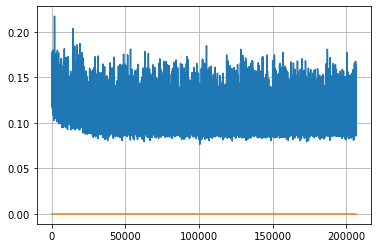

Epoch: 530, iteration 0, loss 0.10892263054847717, cov_diff 0.4223553296763143 cov_diff train 0.4212590527168417
Epoch: 530, iteration 1, loss 0.10704651474952698, cov_diff 0.40843468219008566 cov_diff train 0.40824027215526687
Epoch: 530, iteration 2, loss 0.1091720461845398, cov_diff 0.42745149943279986 cov_diff train 0.4268503211114868
Epoch: 530, iteration 3, loss 0.10319852828979492, cov_diff 0.4072444838578253 cov_diff train 0.4075704927338233
Epoch: 530, iteration 4, loss 0.1040104329586029, cov_diff 0.413156191268603 cov_diff train 0.41298496013024366
Epoch: 530, iteration 5, loss 0.10937649011611938, cov_diff 0.40963662681157176 cov_diff train 0.4081290627213982
Epoch: 530, iteration 6, loss 0.10898220539093018, cov_diff 0.3996081884030935 cov_diff train 0.3991574621655005
Epoch: 530, iteration 7, loss 0.10413989424705505, cov_diff 0.4036176512804849 cov_diff train 0.40370326118821837
Epoch: 530, iteration 8, loss 0.09782138466835022, cov_diff 0.40529986774994364 cov_diff trai

Epoch: 530, iteration 82, loss 0.09692198038101196, cov_diff 0.3971209601512351 cov_diff train 0.39666635918895693
Epoch: 530, iteration 83, loss 0.10778743028640747, cov_diff 0.4224047237476734 cov_diff train 0.42208379354910575
Epoch: 530, iteration 84, loss 0.09902966022491455, cov_diff 0.40529121937893287 cov_diff train 0.40507418785370425
Epoch: 530, iteration 85, loss 0.10984155535697937, cov_diff 0.4211416617216312 cov_diff train 0.42019908136819123
Epoch: 530, iteration 86, loss 0.10548010468482971, cov_diff 0.4055746041802837 cov_diff train 0.40487933557952704
Epoch: 530, iteration 87, loss 0.10558024048805237, cov_diff 0.4121086732419121 cov_diff train 0.41141986846955575
Epoch: 530, iteration 88, loss 0.106355220079422, cov_diff 0.4067604184656088 cov_diff train 0.4046532152003713
Epoch: 530, iteration 89, loss 0.10897073149681091, cov_diff 0.4038603785805922 cov_diff train 0.4032706577253732
Epoch: 530, iteration 90, loss 0.0963689386844635, cov_diff 0.40969063623377727 cov

Epoch: 530, iteration 165, loss 0.1121273934841156, cov_diff 0.3999416360696236 cov_diff train 0.39992196768747784
Epoch: 530, iteration 166, loss 0.10564273595809937, cov_diff 0.41316115046263474 cov_diff train 0.4129271674686477
Epoch: 530, iteration 167, loss 0.08723366260528564, cov_diff 0.40674052186655785 cov_diff train 0.40634489567439913
Epoch: 530, iteration 168, loss 0.09745287895202637, cov_diff 0.389893201040377 cov_diff train 0.3891350534986756
Epoch: 530, iteration 169, loss 0.10553097724914551, cov_diff 0.4062426753995589 cov_diff train 0.405326612710699
Epoch: 530, iteration 170, loss 0.10811251401901245, cov_diff 0.40096447734888896 cov_diff train 0.39990141026563825
Epoch: 530, iteration 171, loss 0.09777572751045227, cov_diff 0.41772531067901564 cov_diff train 0.4171392967788164
Epoch: 530, iteration 172, loss 0.10384660959243774, cov_diff 0.41014494759637926 cov_diff train 0.40867865184336133
Epoch: 530, iteration 173, loss 0.1146068274974823, cov_diff 0.39028143305

Epoch: 530, iteration 244, loss 0.10604202747344971, cov_diff 0.40854748897565996 cov_diff train 0.4085504787054797
Epoch: 530, iteration 245, loss 0.08639243245124817, cov_diff 0.4070451373946215 cov_diff train 0.40679676129548403
Epoch: 530, iteration 246, loss 0.10429778695106506, cov_diff 0.4096170757773623 cov_diff train 0.40885660269476753
Epoch: 530, iteration 247, loss 0.10862937569618225, cov_diff 0.40193697075092605 cov_diff train 0.40078883316914565
Epoch: 530, iteration 248, loss 0.10310539603233337, cov_diff 0.4152700443434917 cov_diff train 0.41455169936712527
Epoch: 530, iteration 249, loss 0.11343821883201599, cov_diff 0.4178141569773175 cov_diff train 0.417356998097887
Epoch: 530, iteration 250, loss 0.09578278660774231, cov_diff 0.4082826275816397 cov_diff train 0.40672365075234307
Epoch: 530, iteration 251, loss 0.10660618543624878, cov_diff 0.4048391335044958 cov_diff train 0.4046715179593863
Epoch: 530, iteration 252, loss 0.08905240893363953, cov_diff 0.3989858065

Epoch: 530, iteration 326, loss 0.09217852354049683, cov_diff 0.41170157750837283 cov_diff train 0.411723452853849
Epoch: 530, iteration 327, loss 0.10376951098442078, cov_diff 0.4046852260739429 cov_diff train 0.40241315093270213
Epoch: 530, iteration 328, loss 0.09807777404785156, cov_diff 0.42962781449887566 cov_diff train 0.4294064409124085
Epoch: 530, iteration 329, loss 0.10315638780593872, cov_diff 0.4101384287409872 cov_diff train 0.4086876818870119
Epoch: 530, iteration 330, loss 0.098670095205307, cov_diff 0.39635711117265876 cov_diff train 0.3961201859699824
Epoch: 530, iteration 331, loss 0.10623472929000854, cov_diff 0.4157049300859766 cov_diff train 0.4156215321337033
Epoch: 530, iteration 332, loss 0.10964265465736389, cov_diff 0.40756686877726667 cov_diff train 0.40670561463000116
Epoch: 530, iteration 333, loss 0.10968419909477234, cov_diff 0.4109506177259877 cov_diff train 0.4097308396546175
Epoch: 530, iteration 334, loss 0.11470979452133179, cov_diff 0.4264571727745

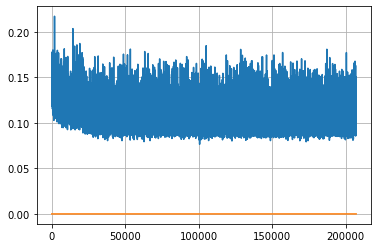

Epoch: 531, iteration 0, loss 0.10515132546424866, cov_diff 0.4173008659530396 cov_diff train 0.4174417743211821
Epoch: 531, iteration 1, loss 0.10947230458259583, cov_diff 0.40799037854650355 cov_diff train 0.40755116644650874
Epoch: 531, iteration 2, loss 0.10366123914718628, cov_diff 0.40809111566317546 cov_diff train 0.4078509228387575
Epoch: 531, iteration 3, loss 0.09981852769851685, cov_diff 0.4045725847654399 cov_diff train 0.40414062372491755
Epoch: 531, iteration 4, loss 0.1052822470664978, cov_diff 0.41220878951776047 cov_diff train 0.41243503771621237
Epoch: 531, iteration 5, loss 0.09221243858337402, cov_diff 0.4161517582647833 cov_diff train 0.415484861348027
Epoch: 531, iteration 6, loss 0.10508298873901367, cov_diff 0.4103810779659555 cov_diff train 0.41021751013220437
Epoch: 531, iteration 7, loss 0.1094607412815094, cov_diff 0.41190749298030804 cov_diff train 0.4106944688018329
Epoch: 531, iteration 8, loss 0.10617414116859436, cov_diff 0.40506092260433324 cov_diff tr

Epoch: 531, iteration 82, loss 0.09612125158309937, cov_diff 0.41295135565441426 cov_diff train 0.41214211077861507
Epoch: 531, iteration 83, loss 0.11504366993904114, cov_diff 0.4053557595400512 cov_diff train 0.403521559242936
Epoch: 531, iteration 84, loss 0.10269227623939514, cov_diff 0.4184673888976396 cov_diff train 0.41854451724092206
Epoch: 531, iteration 85, loss 0.09964820742607117, cov_diff 0.41706388507753933 cov_diff train 0.41668297686529165
Epoch: 531, iteration 86, loss 0.10122361779212952, cov_diff 0.40711972037084837 cov_diff train 0.4060406278564169
Epoch: 531, iteration 87, loss 0.10705465078353882, cov_diff 0.408903977960975 cov_diff train 0.4094998425578633
Epoch: 531, iteration 88, loss 0.11802005767822266, cov_diff 0.43353885885479354 cov_diff train 0.43216074603631455
Epoch: 531, iteration 89, loss 0.10449525713920593, cov_diff 0.41598969828744714 cov_diff train 0.4153685873231211
Epoch: 531, iteration 90, loss 0.09775200486183167, cov_diff 0.40649662666073477 

Epoch: 531, iteration 161, loss 0.1159110963344574, cov_diff 0.41528621462873433 cov_diff train 0.41485601439966396
Epoch: 531, iteration 162, loss 0.10992088913917542, cov_diff 0.41503743099021984 cov_diff train 0.414454091082954
Epoch: 531, iteration 163, loss 0.10021451115608215, cov_diff 0.3979182308893173 cov_diff train 0.39701244591149154
Epoch: 531, iteration 164, loss 0.09960034489631653, cov_diff 0.40744343791231524 cov_diff train 0.4055236399687295
Epoch: 531, iteration 165, loss 0.10791599750518799, cov_diff 0.4035790988861131 cov_diff train 0.40231116266713124
Epoch: 531, iteration 166, loss 0.10380363464355469, cov_diff 0.40789349490785864 cov_diff train 0.407395533885463
Epoch: 531, iteration 167, loss 0.11079064011573792, cov_diff 0.4070392927185699 cov_diff train 0.40434907626718236
Epoch: 531, iteration 168, loss 0.11305668950080872, cov_diff 0.40347662584617533 cov_diff train 0.4029566770816773
Epoch: 531, iteration 169, loss 0.1124369204044342, cov_diff 0.39552541060

Epoch: 531, iteration 241, loss 0.10343846678733826, cov_diff 0.39890552366127047 cov_diff train 0.39861524740679766
Epoch: 531, iteration 242, loss 0.10855242609977722, cov_diff 0.3949997461051102 cov_diff train 0.3948591685968667
Epoch: 531, iteration 243, loss 0.10281279683113098, cov_diff 0.41181045632144375 cov_diff train 0.41016021242011436
Epoch: 531, iteration 244, loss 0.10004183650016785, cov_diff 0.4047948155601695 cov_diff train 0.403477438585306
Epoch: 531, iteration 245, loss 0.1070808470249176, cov_diff 0.4072399884389212 cov_diff train 0.40642182821522527
Epoch: 531, iteration 246, loss 0.0938413143157959, cov_diff 0.40679215432215177 cov_diff train 0.40531288230620754
Epoch: 531, iteration 247, loss 0.10342219471931458, cov_diff 0.40878757721030606 cov_diff train 0.40827546534864056
Epoch: 531, iteration 248, loss 0.09413248300552368, cov_diff 0.4004978950872598 cov_diff train 0.40068935901895775
Epoch: 531, iteration 249, loss 0.10026663541793823, cov_diff 0.408519117

Epoch: 531, iteration 319, loss 0.10138875246047974, cov_diff 0.40752410987852505 cov_diff train 0.406456460208274
Epoch: 531, iteration 320, loss 0.10471874475479126, cov_diff 0.4123389145026208 cov_diff train 0.4114437109347198
Epoch: 531, iteration 321, loss 0.10891574621200562, cov_diff 0.42534685314163134 cov_diff train 0.42464686268134877
Epoch: 531, iteration 322, loss 0.10284173488616943, cov_diff 0.40563116162681484 cov_diff train 0.4045166534671896
Epoch: 531, iteration 323, loss 0.10542824864387512, cov_diff 0.41330401203537553 cov_diff train 0.4128632323261988
Epoch: 531, iteration 324, loss 0.10482165217399597, cov_diff 0.40909498627826846 cov_diff train 0.40907744240141686
Epoch: 531, iteration 325, loss 0.10006532073020935, cov_diff 0.4053622413303123 cov_diff train 0.4060594893786856
Epoch: 531, iteration 326, loss 0.09980839490890503, cov_diff 0.4208494200384191 cov_diff train 0.42074366403311314
Epoch: 531, iteration 327, loss 0.10227340459823608, cov_diff 0.402933552

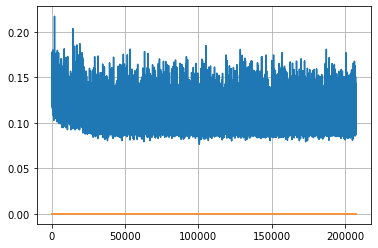

Epoch: 532, iteration 0, loss 0.10285684466362, cov_diff 0.41252407054135515 cov_diff train 0.4121723347369533
Epoch: 532, iteration 1, loss 0.0974879264831543, cov_diff 0.41317462217977696 cov_diff train 0.4125910760302088
Epoch: 532, iteration 2, loss 0.10284793376922607, cov_diff 0.4136731922417442 cov_diff train 0.4134692217681942
Epoch: 532, iteration 3, loss 0.10322603583335876, cov_diff 0.41595410871625377 cov_diff train 0.4157945582223058
Epoch: 532, iteration 4, loss 0.1093171238899231, cov_diff 0.40883400377800183 cov_diff train 0.4087739199468703
Epoch: 532, iteration 5, loss 0.11217021942138672, cov_diff 0.41773680977758304 cov_diff train 0.41751375808046226
Epoch: 532, iteration 6, loss 0.106259286403656, cov_diff 0.4350736348265339 cov_diff train 0.43481924701453806
Epoch: 532, iteration 7, loss 0.10981553792953491, cov_diff 0.3990369800320422 cov_diff train 0.3985580983657795
Epoch: 532, iteration 8, loss 0.09773117303848267, cov_diff 0.4027463959643318 cov_diff train 0.

Epoch: 532, iteration 80, loss 0.09920555353164673, cov_diff 0.40535740112459806 cov_diff train 0.4054600810414275
Epoch: 532, iteration 81, loss 0.10723644495010376, cov_diff 0.41507085572408176 cov_diff train 0.4145942722027031
Epoch: 532, iteration 82, loss 0.10412120819091797, cov_diff 0.405831702481727 cov_diff train 0.40478866209883674
Epoch: 532, iteration 83, loss 0.09818479418754578, cov_diff 0.40552629328396794 cov_diff train 0.4060487690772126
Epoch: 532, iteration 84, loss 0.093096524477005, cov_diff 0.41398841279747906 cov_diff train 0.4138983972566964
Epoch: 532, iteration 85, loss 0.1043226420879364, cov_diff 0.41037261492351146 cov_diff train 0.4105325238590023
Epoch: 532, iteration 86, loss 0.10317295789718628, cov_diff 0.4071878302561165 cov_diff train 0.40747886064069705
Epoch: 532, iteration 87, loss 0.10672196745872498, cov_diff 0.4055133254629095 cov_diff train 0.4052675890749029
Epoch: 532, iteration 88, loss 0.10685041546821594, cov_diff 0.4216004420086257 cov_d

Epoch: 532, iteration 161, loss 0.1040010154247284, cov_diff 0.39592743588403523 cov_diff train 0.39593642572964893
Epoch: 532, iteration 162, loss 0.09547245502471924, cov_diff 0.41257735863683426 cov_diff train 0.41212834850957314
Epoch: 532, iteration 163, loss 0.09670090675354004, cov_diff 0.41412344225715697 cov_diff train 0.4140113224722057
Epoch: 532, iteration 164, loss 0.10838592052459717, cov_diff 0.4079583210458292 cov_diff train 0.4081472322647245
Epoch: 532, iteration 165, loss 0.1036914587020874, cov_diff 0.41046849594571405 cov_diff train 0.4101508173147798
Epoch: 532, iteration 166, loss 0.1099536120891571, cov_diff 0.40552115919541165 cov_diff train 0.40423054407033
Epoch: 532, iteration 167, loss 0.10828647017478943, cov_diff 0.40835308584656055 cov_diff train 0.4077530661882343
Epoch: 532, iteration 168, loss 0.09716907143592834, cov_diff 0.4120703172371812 cov_diff train 0.41171363709201453
Epoch: 532, iteration 169, loss 0.11056533455848694, cov_diff 0.416686395458

Epoch: 532, iteration 242, loss 0.10044136643409729, cov_diff 0.4076905768575853 cov_diff train 0.40698939482820473
Epoch: 532, iteration 243, loss 0.0984601080417633, cov_diff 0.416931151199628 cov_diff train 0.4156812518579208
Epoch: 532, iteration 244, loss 0.10569250583648682, cov_diff 0.4073726825942114 cov_diff train 0.4058262556226651
Epoch: 532, iteration 245, loss 0.09081423282623291, cov_diff 0.41930501932057834 cov_diff train 0.4190225968456537
Epoch: 532, iteration 246, loss 0.11587482690811157, cov_diff 0.41527108594197776 cov_diff train 0.41392672211027526
Epoch: 532, iteration 247, loss 0.11089453101158142, cov_diff 0.4094667295087644 cov_diff train 0.4091907881308971
Epoch: 532, iteration 248, loss 0.10484582185745239, cov_diff 0.40769739906107566 cov_diff train 0.40708226888570215
Epoch: 532, iteration 249, loss 0.10822385549545288, cov_diff 0.4058684906928632 cov_diff train 0.4055344369453282
Epoch: 532, iteration 250, loss 0.0968589186668396, cov_diff 0.4180067525880

Epoch: 532, iteration 322, loss 0.09540167450904846, cov_diff 0.418178818364869 cov_diff train 0.41671373920308885
Epoch: 532, iteration 323, loss 0.09981879591941833, cov_diff 0.41904001847051825 cov_diff train 0.4184606378460667
Epoch: 532, iteration 324, loss 0.10986098647117615, cov_diff 0.4195195129583427 cov_diff train 0.41873402082580896
Epoch: 532, iteration 325, loss 0.09712713956832886, cov_diff 0.4021474501064076 cov_diff train 0.40128018792997555
Epoch: 532, iteration 326, loss 0.10475826263427734, cov_diff 0.4126577565233296 cov_diff train 0.41195887371544004
Epoch: 532, iteration 327, loss 0.10851600766181946, cov_diff 0.40159984045107333 cov_diff train 0.3995345095435288
Epoch: 532, iteration 328, loss 0.09027066826820374, cov_diff 0.4186885849162773 cov_diff train 0.41753744615246746
Epoch: 532, iteration 329, loss 0.10194680094718933, cov_diff 0.4019737118393953 cov_diff train 0.40108511236985334
Epoch: 532, iteration 330, loss 0.1152283251285553, cov_diff 0.4109330349

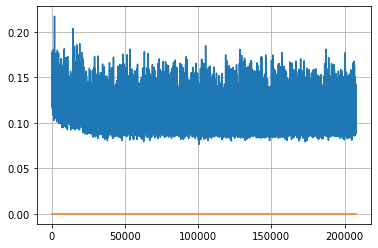

Epoch: 533, iteration 0, loss 0.11052793264389038, cov_diff 0.41185602167978547 cov_diff train 0.4108331466177064
Epoch: 533, iteration 1, loss 0.09408679604530334, cov_diff 0.41399482176211083 cov_diff train 0.4124347939449514
Epoch: 533, iteration 2, loss 0.0997663140296936, cov_diff 0.41265121457608267 cov_diff train 0.4121620980862363
Epoch: 533, iteration 3, loss 0.11032125353813171, cov_diff 0.4130742613954321 cov_diff train 0.41229632380955356
Epoch: 533, iteration 4, loss 0.09949085116386414, cov_diff 0.40527160760686964 cov_diff train 0.4052145800122506
Epoch: 533, iteration 5, loss 0.10119643807411194, cov_diff 0.40673177723392023 cov_diff train 0.4056862915569866
Epoch: 533, iteration 6, loss 0.10167521238327026, cov_diff 0.41579457477098475 cov_diff train 0.41504359834480037
Epoch: 533, iteration 7, loss 0.11191117763519287, cov_diff 0.4069189434581202 cov_diff train 0.40698987565756123
Epoch: 533, iteration 8, loss 0.10150596499443054, cov_diff 0.4217912244188885 cov_diff 

Epoch: 533, iteration 80, loss 0.10233291983604431, cov_diff 0.4066655874862898 cov_diff train 0.40634483756646933
Epoch: 533, iteration 81, loss 0.10704299807548523, cov_diff 0.42367265196817616 cov_diff train 0.42316434582739615
Epoch: 533, iteration 82, loss 0.09982681274414062, cov_diff 0.4214742959976755 cov_diff train 0.4206874778579511
Epoch: 533, iteration 83, loss 0.0965140163898468, cov_diff 0.4069739877878743 cov_diff train 0.40545753058572487
Epoch: 533, iteration 84, loss 0.09238821268081665, cov_diff 0.42026209082459715 cov_diff train 0.420602282848555
Epoch: 533, iteration 85, loss 0.1044493317604065, cov_diff 0.41355677495727966 cov_diff train 0.41358653646189353
Epoch: 533, iteration 86, loss 0.1070033609867096, cov_diff 0.41213161024670414 cov_diff train 0.40968195463749213
Epoch: 533, iteration 87, loss 0.10692429542541504, cov_diff 0.43217787161687543 cov_diff train 0.4314653983250274
Epoch: 533, iteration 88, loss 0.10661819577217102, cov_diff 0.4101832428341063 co

Epoch: 533, iteration 157, loss 0.09987461566925049, cov_diff 0.4098875949473823 cov_diff train 0.40877123372513613
Epoch: 533, iteration 158, loss 0.09398409724235535, cov_diff 0.41838595526236366 cov_diff train 0.41726965037627295
Epoch: 533, iteration 159, loss 0.10038956999778748, cov_diff 0.40907220880170275 cov_diff train 0.4088630201951329
Epoch: 533, iteration 160, loss 0.11215540766716003, cov_diff 0.40908648766444666 cov_diff train 0.4081833860525133
Epoch: 533, iteration 161, loss 0.10198995471000671, cov_diff 0.4158507669320213 cov_diff train 0.4150259241777066
Epoch: 533, iteration 162, loss 0.10418641567230225, cov_diff 0.41417377335330224 cov_diff train 0.41294162902131354
Epoch: 533, iteration 163, loss 0.09544298052787781, cov_diff 0.4073981270045507 cov_diff train 0.4061620155978197
Epoch: 533, iteration 164, loss 0.08995822072029114, cov_diff 0.42296383046582414 cov_diff train 0.4218518974669347
Epoch: 533, iteration 165, loss 0.1020931601524353, cov_diff 0.404841441

Epoch: 533, iteration 234, loss 0.10904869437217712, cov_diff 0.41266620429993894 cov_diff train 0.4121442016962092
Epoch: 533, iteration 235, loss 0.08655238151550293, cov_diff 0.3964212563448425 cov_diff train 0.39604243054420707
Epoch: 533, iteration 236, loss 0.11184912919998169, cov_diff 0.41335412721019466 cov_diff train 0.4126998352263629
Epoch: 533, iteration 237, loss 0.11158350110054016, cov_diff 0.41383085075675874 cov_diff train 0.41313454065214394
Epoch: 533, iteration 238, loss 0.10953843593597412, cov_diff 0.3983564805855927 cov_diff train 0.3968581562714538
Epoch: 533, iteration 239, loss 0.09623974561691284, cov_diff 0.4046010766287344 cov_diff train 0.4041592365186499
Epoch: 533, iteration 240, loss 0.09144321084022522, cov_diff 0.4051451487227152 cov_diff train 0.4051320759332627
Epoch: 533, iteration 241, loss 0.10378783941268921, cov_diff 0.39929711329450845 cov_diff train 0.398340032158982
Epoch: 533, iteration 242, loss 0.1097184419631958, cov_diff 0.410446084559

Epoch: 533, iteration 313, loss 0.11011767387390137, cov_diff 0.4122246991829383 cov_diff train 0.41075501446002066
Epoch: 533, iteration 314, loss 0.10929834842681885, cov_diff 0.40797119676351384 cov_diff train 0.40756924179451515
Epoch: 533, iteration 315, loss 0.1029055118560791, cov_diff 0.4151520165529629 cov_diff train 0.4145320493909491
Epoch: 533, iteration 316, loss 0.10436967015266418, cov_diff 0.40680466407867233 cov_diff train 0.4053077174376297
Epoch: 533, iteration 317, loss 0.11047807335853577, cov_diff 0.41836568779207195 cov_diff train 0.41535874607918627
Epoch: 533, iteration 318, loss 0.09979277849197388, cov_diff 0.4137454495327632 cov_diff train 0.4129076070539737
Epoch: 533, iteration 319, loss 0.10144054889678955, cov_diff 0.42443913655019005 cov_diff train 0.4228001230977716
Epoch: 533, iteration 320, loss 0.10802045464515686, cov_diff 0.4188280941011766 cov_diff train 0.4174199847243015
Epoch: 533, iteration 321, loss 0.09353506565093994, cov_diff 0.4033191879

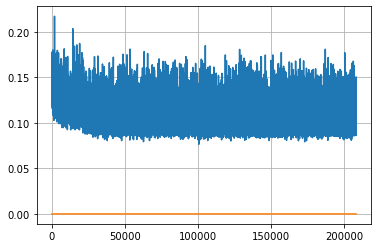

Epoch: 534, iteration 0, loss 0.09268230199813843, cov_diff 0.4124672335608332 cov_diff train 0.4118238267633487
Epoch: 534, iteration 1, loss 0.10754343867301941, cov_diff 0.4061453040639824 cov_diff train 0.4054438145040362
Epoch: 534, iteration 2, loss 0.09527578949928284, cov_diff 0.41166588063483495 cov_diff train 0.4103190688723912
Epoch: 534, iteration 3, loss 0.10051611065864563, cov_diff 0.40747988306447636 cov_diff train 0.4075476728527641
Epoch: 534, iteration 4, loss 0.11456063389778137, cov_diff 0.39650364745932754 cov_diff train 0.3953745409296691
Epoch: 534, iteration 5, loss 0.09624677896499634, cov_diff 0.4138034415995369 cov_diff train 0.41303128059963873
Epoch: 534, iteration 6, loss 0.10329344868659973, cov_diff 0.4025211355222884 cov_diff train 0.40201575516437427
Epoch: 534, iteration 7, loss 0.09830844402313232, cov_diff 0.40739659090775876 cov_diff train 0.4069564681719925
Epoch: 534, iteration 8, loss 0.11023026704788208, cov_diff 0.39161259645813107 cov_diff t

Epoch: 534, iteration 79, loss 0.11356702446937561, cov_diff 0.42624081430913796 cov_diff train 0.4244917624157185
Epoch: 534, iteration 80, loss 0.10652720928192139, cov_diff 0.40140656598377894 cov_diff train 0.40044261041503554
Epoch: 534, iteration 81, loss 0.11049708724021912, cov_diff 0.3996151526956315 cov_diff train 0.39886154999504325
Epoch: 534, iteration 82, loss 0.09976327419281006, cov_diff 0.40348978533669994 cov_diff train 0.4031032575560732
Epoch: 534, iteration 83, loss 0.09901553392410278, cov_diff 0.40105836509047504 cov_diff train 0.4008083638681413
Epoch: 534, iteration 84, loss 0.10508301854133606, cov_diff 0.40168615865647045 cov_diff train 0.40098089516016594
Epoch: 534, iteration 85, loss 0.1020326018333435, cov_diff 0.4045635844638578 cov_diff train 0.4040880394015989
Epoch: 534, iteration 86, loss 0.09994158148765564, cov_diff 0.41074980975741693 cov_diff train 0.4104435287291454
Epoch: 534, iteration 87, loss 0.1061144769191742, cov_diff 0.40945204139407076 

Epoch: 534, iteration 156, loss 0.10097691416740417, cov_diff 0.406737334086075 cov_diff train 0.4057475689597198
Epoch: 534, iteration 157, loss 0.11338606476783752, cov_diff 0.4010020358653086 cov_diff train 0.40032858949374084
Epoch: 534, iteration 158, loss 0.11541828513145447, cov_diff 0.4205912168762483 cov_diff train 0.41942811749431363
Epoch: 534, iteration 159, loss 0.09237581491470337, cov_diff 0.4050319358993169 cov_diff train 0.40462238409192613
Epoch: 534, iteration 160, loss 0.0970115065574646, cov_diff 0.41184387747071666 cov_diff train 0.4111405797229774
Epoch: 534, iteration 161, loss 0.11796551942825317, cov_diff 0.4132546423695544 cov_diff train 0.4120628760095849
Epoch: 534, iteration 162, loss 0.09760719537734985, cov_diff 0.40811777352996265 cov_diff train 0.40765043488973224
Epoch: 534, iteration 163, loss 0.10096874833106995, cov_diff 0.40391927569163566 cov_diff train 0.4036220767071635
Epoch: 534, iteration 164, loss 0.10189986228942871, cov_diff 0.40575351643

Epoch: 534, iteration 231, loss 0.09791982173919678, cov_diff 0.4037689004003423 cov_diff train 0.4030038829749018
Epoch: 534, iteration 232, loss 0.10367894172668457, cov_diff 0.4129463738350644 cov_diff train 0.41179360921246044
Epoch: 534, iteration 233, loss 0.10282602906227112, cov_diff 0.41424119709696006 cov_diff train 0.4127396188805421
Epoch: 534, iteration 234, loss 0.09351760149002075, cov_diff 0.3947065701382774 cov_diff train 0.3941278752927497
Epoch: 534, iteration 235, loss 0.10063984990119934, cov_diff 0.40349697596536893 cov_diff train 0.4029880572527648
Epoch: 534, iteration 236, loss 0.11386364698410034, cov_diff 0.4069430490642971 cov_diff train 0.40531191689017587
Epoch: 534, iteration 237, loss 0.1000225841999054, cov_diff 0.40220388812052243 cov_diff train 0.40190170424631383
Epoch: 534, iteration 238, loss 0.09853994846343994, cov_diff 0.40948388663791097 cov_diff train 0.408385356714807
Epoch: 534, iteration 239, loss 0.10515403747558594, cov_diff 0.40880710170

Epoch: 534, iteration 305, loss 0.09785014390945435, cov_diff 0.4000758352190809 cov_diff train 0.39913808187055944
Epoch: 534, iteration 306, loss 0.11556628346443176, cov_diff 0.40557919046776786 cov_diff train 0.40460041351363074
Epoch: 534, iteration 307, loss 0.09951728582382202, cov_diff 0.3933359567329489 cov_diff train 0.39311152463247584
Epoch: 534, iteration 308, loss 0.10029855370521545, cov_diff 0.4144660482954774 cov_diff train 0.4136557371382557
Epoch: 534, iteration 309, loss 0.10290887951850891, cov_diff 0.42536360897753595 cov_diff train 0.4251496430757419
Epoch: 534, iteration 310, loss 0.09593531489372253, cov_diff 0.4201075560521038 cov_diff train 0.4198663832298872
Epoch: 534, iteration 311, loss 0.1123051643371582, cov_diff 0.4029543202290867 cov_diff train 0.4029170189563588
Epoch: 534, iteration 312, loss 0.10402050614356995, cov_diff 0.41205390162693173 cov_diff train 0.4120012831450735
Epoch: 534, iteration 313, loss 0.09826964139938354, cov_diff 0.41125044115

Epoch: 534, iteration 380, loss 0.11278241872787476, cov_diff 0.4192798963539228 cov_diff train 0.41811854469932813
Epoch: 534, iteration 381, loss 0.09243392944335938, cov_diff 0.40092435838968327 cov_diff train 0.4010597408076296
Epoch: 534, iteration 382, loss 0.0961546003818512, cov_diff 0.4207531111302241 cov_diff train 0.419548457280549
Epoch: 534, iteration 383, loss 0.10392072796821594, cov_diff 0.4072997874488495 cov_diff train 0.40678561657877654
Epoch: 534, iteration 384, loss 0.09403643012046814, cov_diff 0.40345405796321093 cov_diff train 0.40298051566103293
Epoch: 534, iteration 385, loss 0.0962114930152893, cov_diff 0.41644321725534217 cov_diff train 0.41521553383416837
Epoch: 534, iteration 386, loss 0.11726394295692444, cov_diff 0.4044590599059765 cov_diff train 0.4031330187045621
Epoch: 534, iteration 387, loss 0.09906670451164246, cov_diff 0.41396970608313566 cov_diff train 0.413129421954019
Epoch: 534, iteration 388, loss 0.10071995854377747, cov_diff 0.415463474379

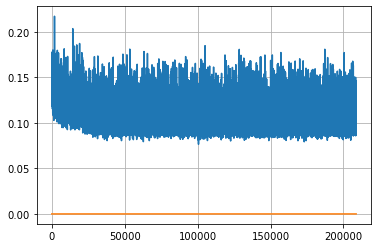

Epoch: 535, iteration 0, loss 0.10716548562049866, cov_diff 0.4288668849333103 cov_diff train 0.42826258713531623
Epoch: 535, iteration 1, loss 0.10757413506507874, cov_diff 0.4191732831935224 cov_diff train 0.41867530334501246
Epoch: 535, iteration 2, loss 0.10745197534561157, cov_diff 0.4059982002919946 cov_diff train 0.4054591325714407
Epoch: 535, iteration 3, loss 0.105063796043396, cov_diff 0.4223589445306015 cov_diff train 0.42109007687462124
Epoch: 535, iteration 4, loss 0.10447648167610168, cov_diff 0.4119820239684925 cov_diff train 0.41074712452750467
Epoch: 535, iteration 5, loss 0.10088548064231873, cov_diff 0.40982741375629667 cov_diff train 0.4089751129044805
Epoch: 535, iteration 6, loss 0.09105846285820007, cov_diff 0.4007820747294892 cov_diff train 0.40033373064950784
Epoch: 535, iteration 7, loss 0.09065821766853333, cov_diff 0.4050249939423698 cov_diff train 0.4048065868644603
Epoch: 535, iteration 8, loss 0.11827558279037476, cov_diff 0.4004257303259094 cov_diff trai

Epoch: 535, iteration 81, loss 0.11766266822814941, cov_diff 0.4290825375703461 cov_diff train 0.42931365970827357
Epoch: 535, iteration 82, loss 0.10015186667442322, cov_diff 0.4154793062195896 cov_diff train 0.41444956654385506
Epoch: 535, iteration 83, loss 0.10700970888137817, cov_diff 0.4340924384119244 cov_diff train 0.43305832036183345
Epoch: 535, iteration 84, loss 0.10595729947090149, cov_diff 0.41835225582480323 cov_diff train 0.41752002028124924
Epoch: 535, iteration 85, loss 0.09131550788879395, cov_diff 0.41760539500282745 cov_diff train 0.41636094905246124
Epoch: 535, iteration 86, loss 0.11034658551216125, cov_diff 0.416489074616183 cov_diff train 0.41474792919225273
Epoch: 535, iteration 87, loss 0.10734838247299194, cov_diff 0.40650552447596977 cov_diff train 0.4057010974474756
Epoch: 535, iteration 88, loss 0.09371241927146912, cov_diff 0.41236789048774425 cov_diff train 0.41041758701118936
Epoch: 535, iteration 89, loss 0.08797642588615417, cov_diff 0.404746718842204

Epoch: 535, iteration 160, loss 0.11297914385795593, cov_diff 0.4041465236987466 cov_diff train 0.40439337176106865
Epoch: 535, iteration 161, loss 0.1021442711353302, cov_diff 0.4105168464838519 cov_diff train 0.4099105742677203
Epoch: 535, iteration 162, loss 0.11296311020851135, cov_diff 0.42288569646688073 cov_diff train 0.4226469460340758
Epoch: 535, iteration 163, loss 0.10408663749694824, cov_diff 0.4000957430840099 cov_diff train 0.400663104273147
Epoch: 535, iteration 164, loss 0.09375330805778503, cov_diff 0.410359805052783 cov_diff train 0.4100365773609065
Epoch: 535, iteration 165, loss 0.1050909161567688, cov_diff 0.4049412445589312 cov_diff train 0.40443515822160775
Epoch: 535, iteration 166, loss 0.09826365113258362, cov_diff 0.42035913504409883 cov_diff train 0.42026309380891946
Epoch: 535, iteration 167, loss 0.09105530381202698, cov_diff 0.4154042737671014 cov_diff train 0.4146417853165369
Epoch: 535, iteration 168, loss 0.09872210025787354, cov_diff 0.410203151093508

Epoch: 535, iteration 240, loss 0.10100209712982178, cov_diff 0.4163868163612733 cov_diff train 0.4154841322095601
Epoch: 535, iteration 241, loss 0.10136997699737549, cov_diff 0.42227357538597055 cov_diff train 0.42179570259989185
Epoch: 535, iteration 242, loss 0.09863263368606567, cov_diff 0.4198737731797644 cov_diff train 0.4192102465819309
Epoch: 535, iteration 243, loss 0.1017221212387085, cov_diff 0.41626135729887426 cov_diff train 0.4160959096818858
Epoch: 535, iteration 244, loss 0.10519212484359741, cov_diff 0.4170220516017719 cov_diff train 0.41653707103853094
Epoch: 535, iteration 245, loss 0.10216307640075684, cov_diff 0.4081926080837898 cov_diff train 0.4077605748895591
Epoch: 535, iteration 246, loss 0.09913954138755798, cov_diff 0.41900610332091287 cov_diff train 0.41901237790239276
Epoch: 535, iteration 247, loss 0.09626638889312744, cov_diff 0.42473590862032806 cov_diff train 0.423691667320362
Epoch: 535, iteration 248, loss 0.09269803762435913, cov_diff 0.41179243935

Epoch: 535, iteration 320, loss 0.11979341506958008, cov_diff 0.4123020159595629 cov_diff train 0.4118937089823467
Epoch: 535, iteration 321, loss 0.09560823440551758, cov_diff 0.4070502280424421 cov_diff train 0.40668242297966306
Epoch: 535, iteration 322, loss 0.11393508315086365, cov_diff 0.4190436489771643 cov_diff train 0.41853100577782876
Epoch: 535, iteration 323, loss 0.09657853841781616, cov_diff 0.4079609817722501 cov_diff train 0.40695738394764297
Epoch: 535, iteration 324, loss 0.10597062110900879, cov_diff 0.4040899768901515 cov_diff train 0.40232966874836656
Epoch: 535, iteration 325, loss 0.10301417112350464, cov_diff 0.40974769005245343 cov_diff train 0.4099752747019811
Epoch: 535, iteration 326, loss 0.10343655943870544, cov_diff 0.4195026166861576 cov_diff train 0.41914466236051334
Epoch: 535, iteration 327, loss 0.10664457082748413, cov_diff 0.4107258571613131 cov_diff train 0.41122272889489486
Epoch: 535, iteration 328, loss 0.09411218762397766, cov_diff 0.413817601

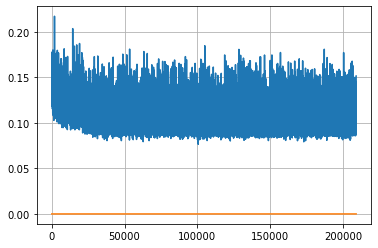

Epoch: 536, iteration 0, loss 0.09593740105628967, cov_diff 0.40876199110601175 cov_diff train 0.40815933155898504
Epoch: 536, iteration 1, loss 0.10947969555854797, cov_diff 0.4151975851435097 cov_diff train 0.4144185959955643
Epoch: 536, iteration 2, loss 0.10133752226829529, cov_diff 0.41390087819293625 cov_diff train 0.41330604835484636
Epoch: 536, iteration 3, loss 0.10169047117233276, cov_diff 0.4118241853701043 cov_diff train 0.4099023617409015
Epoch: 536, iteration 4, loss 0.09644460678100586, cov_diff 0.41091873699837705 cov_diff train 0.4103514480252692
Epoch: 536, iteration 5, loss 0.1020665168762207, cov_diff 0.4163812517522459 cov_diff train 0.41526997583518815
Epoch: 536, iteration 6, loss 0.10512346029281616, cov_diff 0.406370079483732 cov_diff train 0.4050480064601165
Epoch: 536, iteration 7, loss 0.108754962682724, cov_diff 0.4178225443675994 cov_diff train 0.41744553019976444
Epoch: 536, iteration 8, loss 0.11324065923690796, cov_diff 0.4046277924449113 cov_diff train

Epoch: 536, iteration 79, loss 0.10194098949432373, cov_diff 0.3851486070587837 cov_diff train 0.3838966654839935
Epoch: 536, iteration 80, loss 0.09733909368515015, cov_diff 0.40355696540074376 cov_diff train 0.40343810846199335
Epoch: 536, iteration 81, loss 0.11257994174957275, cov_diff 0.4098931500448072 cov_diff train 0.40913528761502194
Epoch: 536, iteration 82, loss 0.08930507302284241, cov_diff 0.4147537758754268 cov_diff train 0.4147699878781905
Epoch: 536, iteration 83, loss 0.10859423875808716, cov_diff 0.41043525852368706 cov_diff train 0.40928694892489276
Epoch: 536, iteration 84, loss 0.10413646697998047, cov_diff 0.42729419010007086 cov_diff train 0.4260941029256717
Epoch: 536, iteration 85, loss 0.1137973964214325, cov_diff 0.4271850567659662 cov_diff train 0.4267985039325455
Epoch: 536, iteration 86, loss 0.09191402792930603, cov_diff 0.410916355841147 cov_diff train 0.41111981803541625
Epoch: 536, iteration 87, loss 0.11061140894889832, cov_diff 0.4129221042933149 cov

Epoch: 536, iteration 160, loss 0.1156703531742096, cov_diff 0.40839562992392964 cov_diff train 0.40894624290268444
Epoch: 536, iteration 161, loss 0.10588812828063965, cov_diff 0.40801829121117533 cov_diff train 0.40841110761697974
Epoch: 536, iteration 162, loss 0.0958036482334137, cov_diff 0.4092584962628367 cov_diff train 0.40814771663289495
Epoch: 536, iteration 163, loss 0.09955251216888428, cov_diff 0.42029934207076797 cov_diff train 0.4197062194623747
Epoch: 536, iteration 164, loss 0.10135588049888611, cov_diff 0.41600085842816387 cov_diff train 0.41554468596647004
Epoch: 536, iteration 165, loss 0.10442718863487244, cov_diff 0.40664542453349994 cov_diff train 0.40579130922282686
Epoch: 536, iteration 166, loss 0.0890154242515564, cov_diff 0.4253685202963341 cov_diff train 0.42460870540822776
Epoch: 536, iteration 167, loss 0.09792366623878479, cov_diff 0.4071748222581613 cov_diff train 0.40761137966629774
Epoch: 536, iteration 168, loss 0.10527405142784119, cov_diff 0.4072856

Epoch: 536, iteration 240, loss 0.10918816924095154, cov_diff 0.41123668775957123 cov_diff train 0.41079667029050143
Epoch: 536, iteration 241, loss 0.10882517695426941, cov_diff 0.4223806268371992 cov_diff train 0.42158062345210623
Epoch: 536, iteration 242, loss 0.10589569807052612, cov_diff 0.40767953078781693 cov_diff train 0.4071905955946514
Epoch: 536, iteration 243, loss 0.09540742635726929, cov_diff 0.3941885138263887 cov_diff train 0.394258862317958
Epoch: 536, iteration 244, loss 0.10453346371650696, cov_diff 0.40998240380414375 cov_diff train 0.40852630209586077
Epoch: 536, iteration 245, loss 0.09364974498748779, cov_diff 0.41142351138959193 cov_diff train 0.4113585192864873
Epoch: 536, iteration 246, loss 0.0963079035282135, cov_diff 0.40584495482209504 cov_diff train 0.40574036004244296
Epoch: 536, iteration 247, loss 0.1016947329044342, cov_diff 0.41949027609554057 cov_diff train 0.4178542329676417
Epoch: 536, iteration 248, loss 0.09787961840629578, cov_diff 0.409357833

Epoch: 536, iteration 322, loss 0.10568869113922119, cov_diff 0.41374514561351156 cov_diff train 0.41324209214911334
Epoch: 536, iteration 323, loss 0.11426115036010742, cov_diff 0.4134385660812537 cov_diff train 0.412178619048422
Epoch: 536, iteration 324, loss 0.1074213981628418, cov_diff 0.40121602692601493 cov_diff train 0.40187619792588913
Epoch: 536, iteration 325, loss 0.09823960065841675, cov_diff 0.4005414907113233 cov_diff train 0.40123947578438685
Epoch: 536, iteration 326, loss 0.0967634916305542, cov_diff 0.41366752847221844 cov_diff train 0.41347912914864143
Epoch: 536, iteration 327, loss 0.08935624361038208, cov_diff 0.40261018747994015 cov_diff train 0.402603155948362
Epoch: 536, iteration 328, loss 0.10625976324081421, cov_diff 0.4086846618684686 cov_diff train 0.4090131768609217
Epoch: 536, iteration 329, loss 0.10765039920806885, cov_diff 0.4132332312639749 cov_diff train 0.4140129104930437
Epoch: 536, iteration 330, loss 0.10379424691200256, cov_diff 0.405434639994

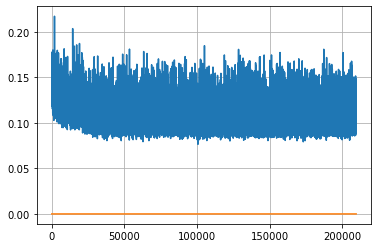

Epoch: 537, iteration 0, loss 0.08951407670974731, cov_diff 0.4216766461289037 cov_diff train 0.4204341654536568
Epoch: 537, iteration 1, loss 0.1062062680721283, cov_diff 0.4148278635510953 cov_diff train 0.41418777959861175
Epoch: 537, iteration 2, loss 0.10130885243415833, cov_diff 0.41183141092086795 cov_diff train 0.41069494843586474
Epoch: 537, iteration 3, loss 0.09946539998054504, cov_diff 0.4224223397794183 cov_diff train 0.4224487474265826
Epoch: 537, iteration 4, loss 0.08457952737808228, cov_diff 0.4035143993970787 cov_diff train 0.4035154330628884
Epoch: 537, iteration 5, loss 0.09780630469322205, cov_diff 0.40473951105592254 cov_diff train 0.40456230496774254
Epoch: 537, iteration 6, loss 0.10027429461479187, cov_diff 0.41126062135540264 cov_diff train 0.410433343963594
Epoch: 537, iteration 7, loss 0.11177068948745728, cov_diff 0.42208234772172626 cov_diff train 0.4215715170306582
Epoch: 537, iteration 8, loss 0.1021679937839508, cov_diff 0.41245963734559343 cov_diff tra

Epoch: 537, iteration 78, loss 0.09654128551483154, cov_diff 0.4077872169847788 cov_diff train 0.4079343490175487
Epoch: 537, iteration 79, loss 0.10077309608459473, cov_diff 0.4004389058334146 cov_diff train 0.40025819617864417
Epoch: 537, iteration 80, loss 0.09973865747451782, cov_diff 0.40818608386268795 cov_diff train 0.4076552158916114
Epoch: 537, iteration 81, loss 0.10243484377861023, cov_diff 0.3997760554001409 cov_diff train 0.3985907517267658
Epoch: 537, iteration 82, loss 0.10054430365562439, cov_diff 0.40168427488006153 cov_diff train 0.4018275171064681
Epoch: 537, iteration 83, loss 0.10432037711143494, cov_diff 0.406197622897974 cov_diff train 0.4041264018616204
Epoch: 537, iteration 84, loss 0.10636866092681885, cov_diff 0.4053571792536219 cov_diff train 0.4053836738867364
Epoch: 537, iteration 85, loss 0.10414522886276245, cov_diff 0.4150127364209799 cov_diff train 0.4144484082171806
Epoch: 537, iteration 86, loss 0.10356104373931885, cov_diff 0.4142738980946637 cov_di

Epoch: 537, iteration 156, loss 0.09383240342140198, cov_diff 0.3945546554754031 cov_diff train 0.3948336386894896
Epoch: 537, iteration 157, loss 0.10698136687278748, cov_diff 0.4141755598320152 cov_diff train 0.41351554423944126
Epoch: 537, iteration 158, loss 0.10573393106460571, cov_diff 0.41397549674371964 cov_diff train 0.41380309401119375
Epoch: 537, iteration 159, loss 0.1155620813369751, cov_diff 0.40618416011067954 cov_diff train 0.4046612467870571
Epoch: 537, iteration 160, loss 0.0945959985256195, cov_diff 0.41683380841324247 cov_diff train 0.41647581622793023
Epoch: 537, iteration 161, loss 0.11033898591995239, cov_diff 0.4138260741217208 cov_diff train 0.4138868963679976
Epoch: 537, iteration 162, loss 0.09955278038978577, cov_diff 0.40062007883440126 cov_diff train 0.399618458681351
Epoch: 537, iteration 163, loss 0.10634055733680725, cov_diff 0.400274353604815 cov_diff train 0.3990827485307895
Epoch: 537, iteration 164, loss 0.10975003242492676, cov_diff 0.4087114867662

Epoch: 537, iteration 234, loss 0.10553491115570068, cov_diff 0.4088573084003985 cov_diff train 0.40767287234133537
Epoch: 537, iteration 235, loss 0.10981455445289612, cov_diff 0.407176327932346 cov_diff train 0.4068411507620303
Epoch: 537, iteration 236, loss 0.10031870007514954, cov_diff 0.41115209093500316 cov_diff train 0.41041969033641545
Epoch: 537, iteration 237, loss 0.0986781120300293, cov_diff 0.4099125505275396 cov_diff train 0.40952966896374104
Epoch: 537, iteration 238, loss 0.10982275009155273, cov_diff 0.41013138929919746 cov_diff train 0.4091794599591038
Epoch: 537, iteration 239, loss 0.10086008906364441, cov_diff 0.4198218557205833 cov_diff train 0.4187406290785774
Epoch: 537, iteration 240, loss 0.11337575316429138, cov_diff 0.4329400579089546 cov_diff train 0.4323872930705117
Epoch: 537, iteration 241, loss 0.10274875164031982, cov_diff 0.40543949817533254 cov_diff train 0.4046314246088423
Epoch: 537, iteration 242, loss 0.10238847136497498, cov_diff 0.402255199569

Epoch: 537, iteration 313, loss 0.10095390677452087, cov_diff 0.39729081695794516 cov_diff train 0.3972448138931945
Epoch: 537, iteration 314, loss 0.10064312815666199, cov_diff 0.4226805996910379 cov_diff train 0.42191768977873384
Epoch: 537, iteration 315, loss 0.09871754050254822, cov_diff 0.4108016741772688 cov_diff train 0.40984024220461085
Epoch: 537, iteration 316, loss 0.09863108396530151, cov_diff 0.4067637507519736 cov_diff train 0.4064739689978694
Epoch: 537, iteration 317, loss 0.0930233895778656, cov_diff 0.3990573653453825 cov_diff train 0.3980002056751416
Epoch: 537, iteration 318, loss 0.10133135318756104, cov_diff 0.41062793147520255 cov_diff train 0.4098809359565759
Epoch: 537, iteration 319, loss 0.10314342379570007, cov_diff 0.41929889530775133 cov_diff train 0.41874695317011085
Epoch: 537, iteration 320, loss 0.10452499985694885, cov_diff 0.4121745308798227 cov_diff train 0.4101152338672007
Epoch: 537, iteration 321, loss 0.10206353664398193, cov_diff 0.41412759830

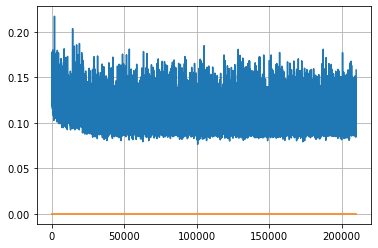

Epoch: 538, iteration 0, loss 0.1084643006324768, cov_diff 0.4014586023367459 cov_diff train 0.40070564097298433
Epoch: 538, iteration 1, loss 0.10202527046203613, cov_diff 0.4000389144603905 cov_diff train 0.3991994530639979
Epoch: 538, iteration 2, loss 0.09621831774711609, cov_diff 0.40751369687024064 cov_diff train 0.4063325851503133
Epoch: 538, iteration 3, loss 0.10910052061080933, cov_diff 0.4232444849820027 cov_diff train 0.42144962968176536
Epoch: 538, iteration 4, loss 0.1111801266670227, cov_diff 0.40646567152804763 cov_diff train 0.4067123242928873
Epoch: 538, iteration 5, loss 0.10142898559570312, cov_diff 0.4136680667291661 cov_diff train 0.4135044518200752
Epoch: 538, iteration 6, loss 0.10109856724739075, cov_diff 0.40091217223988057 cov_diff train 0.4004951676797701
Epoch: 538, iteration 7, loss 0.09258383512496948, cov_diff 0.41788883617049516 cov_diff train 0.41717359319203234
Epoch: 538, iteration 8, loss 0.10925766825675964, cov_diff 0.41844598173131786 cov_diff tr

Epoch: 538, iteration 79, loss 0.11356645822525024, cov_diff 0.4018791639057575 cov_diff train 0.40150699811972207
Epoch: 538, iteration 80, loss 0.10604870319366455, cov_diff 0.4080409491669731 cov_diff train 0.40703151075406124
Epoch: 538, iteration 81, loss 0.099494069814682, cov_diff 0.4133831661107832 cov_diff train 0.41277324434001295
Epoch: 538, iteration 82, loss 0.11395281553268433, cov_diff 0.40288876232266313 cov_diff train 0.4021696466295756
Epoch: 538, iteration 83, loss 0.10835573077201843, cov_diff 0.407392185659466 cov_diff train 0.40630743494076416
Epoch: 538, iteration 84, loss 0.10028377175331116, cov_diff 0.41363292003302055 cov_diff train 0.4133796266263256
Epoch: 538, iteration 85, loss 0.11649611592292786, cov_diff 0.4085452807916885 cov_diff train 0.4080063686873761
Epoch: 538, iteration 86, loss 0.11165779829025269, cov_diff 0.41006492238774517 cov_diff train 0.4095747166486339
Epoch: 538, iteration 87, loss 0.09508010745048523, cov_diff 0.4053713415759946 cov_

Epoch: 538, iteration 158, loss 0.10117396712303162, cov_diff 0.4016755105298549 cov_diff train 0.40064595282971804
Epoch: 538, iteration 159, loss 0.1044606864452362, cov_diff 0.4116397987555521 cov_diff train 0.41139164233558917
Epoch: 538, iteration 160, loss 0.09384146332740784, cov_diff 0.38788612405366074 cov_diff train 0.3877555111028428
Epoch: 538, iteration 161, loss 0.10603484511375427, cov_diff 0.4070749541482676 cov_diff train 0.40705436676154
Epoch: 538, iteration 162, loss 0.10782957077026367, cov_diff 0.40949297275982743 cov_diff train 0.41006025979233107
Epoch: 538, iteration 163, loss 0.10254138708114624, cov_diff 0.4077353727443211 cov_diff train 0.40812689135676483
Epoch: 538, iteration 164, loss 0.11643669009208679, cov_diff 0.4087693038641695 cov_diff train 0.40824449972067467
Epoch: 538, iteration 165, loss 0.108832448720932, cov_diff 0.41513280671497066 cov_diff train 0.41453209074062974
Epoch: 538, iteration 166, loss 0.10521799325942993, cov_diff 0.403903255627

Epoch: 538, iteration 238, loss 0.10958743095397949, cov_diff 0.4051469962508734 cov_diff train 0.403638091891592
Epoch: 538, iteration 239, loss 0.10557711124420166, cov_diff 0.40774898627645334 cov_diff train 0.407695951544
Epoch: 538, iteration 240, loss 0.10965251922607422, cov_diff 0.4035167928868799 cov_diff train 0.40364301609505443
Epoch: 538, iteration 241, loss 0.11021813750267029, cov_diff 0.4179384448614274 cov_diff train 0.41766626277579966
Epoch: 538, iteration 242, loss 0.10194507241249084, cov_diff 0.4094309966292361 cov_diff train 0.4090087127322175
Epoch: 538, iteration 243, loss 0.10601270198822021, cov_diff 0.41303109681615036 cov_diff train 0.41105916008013027
Epoch: 538, iteration 244, loss 0.10077795386314392, cov_diff 0.40654007757909855 cov_diff train 0.40556666493425386
Epoch: 538, iteration 245, loss 0.09870654344558716, cov_diff 0.4117272452153127 cov_diff train 0.41218119046797574
Epoch: 538, iteration 246, loss 0.11615478992462158, cov_diff 0.4169001779440

Epoch: 538, iteration 315, loss 0.09648695588111877, cov_diff 0.4060197212978689 cov_diff train 0.40564656730609816
Epoch: 538, iteration 316, loss 0.10837209224700928, cov_diff 0.41010824367874477 cov_diff train 0.40976032849790356
Epoch: 538, iteration 317, loss 0.1016300618648529, cov_diff 0.42776359202305425 cov_diff train 0.4268605069110828
Epoch: 538, iteration 318, loss 0.10305693745613098, cov_diff 0.4037843636641777 cov_diff train 0.4036564762185494
Epoch: 538, iteration 319, loss 0.0969773530960083, cov_diff 0.4157715708705135 cov_diff train 0.41544068594198386
Epoch: 538, iteration 320, loss 0.10705643892288208, cov_diff 0.4048359040029443 cov_diff train 0.4050515739943626
Epoch: 538, iteration 321, loss 0.10641375184059143, cov_diff 0.4125581028798084 cov_diff train 0.411948414881386
Epoch: 538, iteration 322, loss 0.1082909107208252, cov_diff 0.42223777554594394 cov_diff train 0.4206040324381605
Epoch: 538, iteration 323, loss 0.11206471920013428, cov_diff 0.41828826622605

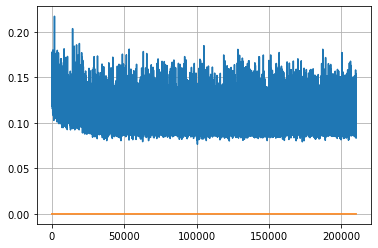

Epoch: 539, iteration 0, loss 0.10009005665779114, cov_diff 0.40995351263765034 cov_diff train 0.41012849310068467
Epoch: 539, iteration 1, loss 0.11644840240478516, cov_diff 0.40973153992019273 cov_diff train 0.4087080995702568
Epoch: 539, iteration 2, loss 0.10636007785797119, cov_diff 0.42080718243257903 cov_diff train 0.4201522299413694
Epoch: 539, iteration 3, loss 0.10491636395454407, cov_diff 0.4110718125999717 cov_diff train 0.4099727212968944
Epoch: 539, iteration 4, loss 0.09750217199325562, cov_diff 0.39878549115812095 cov_diff train 0.3988992749928359
Epoch: 539, iteration 5, loss 0.09418502449989319, cov_diff 0.41524722204498316 cov_diff train 0.4155758156236317
Epoch: 539, iteration 6, loss 0.10877978801727295, cov_diff 0.40883655593428925 cov_diff train 0.4093899588640264
Epoch: 539, iteration 7, loss 0.11414620280265808, cov_diff 0.4076908429488827 cov_diff train 0.4068001835854346
Epoch: 539, iteration 8, loss 0.10912448167800903, cov_diff 0.40736293379641436 cov_diff 

Epoch: 539, iteration 79, loss 0.10424205660820007, cov_diff 0.3994419675511647 cov_diff train 0.39973046347220037
Epoch: 539, iteration 80, loss 0.09909874200820923, cov_diff 0.41077615692981734 cov_diff train 0.40930955193253826
Epoch: 539, iteration 81, loss 0.10174694657325745, cov_diff 0.4186811254260405 cov_diff train 0.41856633577183655
Epoch: 539, iteration 82, loss 0.1033744215965271, cov_diff 0.41125718007375556 cov_diff train 0.40911816124593275
Epoch: 539, iteration 83, loss 0.11185964941978455, cov_diff 0.4125724959589294 cov_diff train 0.4121534403860749
Epoch: 539, iteration 84, loss 0.11826363205909729, cov_diff 0.4003228928110403 cov_diff train 0.39979247995338213
Epoch: 539, iteration 85, loss 0.10681852698326111, cov_diff 0.41116276813799185 cov_diff train 0.41013074780406134
Epoch: 539, iteration 86, loss 0.10754409432411194, cov_diff 0.4288142756491931 cov_diff train 0.4279682333268103
Epoch: 539, iteration 87, loss 0.10373926162719727, cov_diff 0.40743660696211503

Epoch: 539, iteration 158, loss 0.1070047914981842, cov_diff 0.4022603838197241 cov_diff train 0.4021708880427634
Epoch: 539, iteration 159, loss 0.11209258437156677, cov_diff 0.40936864834142417 cov_diff train 0.40874021380693365
Epoch: 539, iteration 160, loss 0.10259971022605896, cov_diff 0.40546917189271053 cov_diff train 0.4056023463078699
Epoch: 539, iteration 161, loss 0.0989488959312439, cov_diff 0.4231870125378238 cov_diff train 0.4229280818942893
Epoch: 539, iteration 162, loss 0.10714852809906006, cov_diff 0.4179004764268137 cov_diff train 0.4178736829626126
Epoch: 539, iteration 163, loss 0.09870502352714539, cov_diff 0.4026953620378289 cov_diff train 0.4018117742603563
Epoch: 539, iteration 164, loss 0.10310918092727661, cov_diff 0.418859277673651 cov_diff train 0.41839676345729376
Epoch: 539, iteration 165, loss 0.10407000780105591, cov_diff 0.4106988023934139 cov_diff train 0.41068959231560287
Epoch: 539, iteration 166, loss 0.11298486590385437, cov_diff 0.40644562574640

Epoch: 539, iteration 236, loss 0.09244406223297119, cov_diff 0.42118655513796777 cov_diff train 0.421371417114953
Epoch: 539, iteration 237, loss 0.11251768469810486, cov_diff 0.4015287503812472 cov_diff train 0.40126443404740325
Epoch: 539, iteration 238, loss 0.09792456030845642, cov_diff 0.40043742973352153 cov_diff train 0.4007498422012616
Epoch: 539, iteration 239, loss 0.09620115160942078, cov_diff 0.40852684720943594 cov_diff train 0.40856859338271617
Epoch: 539, iteration 240, loss 0.10250738263130188, cov_diff 0.4128369574975718 cov_diff train 0.41281017388883345
Epoch: 539, iteration 241, loss 0.10884076356887817, cov_diff 0.4121430419831946 cov_diff train 0.4114600386568232
Epoch: 539, iteration 242, loss 0.10075962543487549, cov_diff 0.4155609288096534 cov_diff train 0.416048875596774
Epoch: 539, iteration 243, loss 0.10469958186149597, cov_diff 0.4139182013743959 cov_diff train 0.41389250118988685
Epoch: 539, iteration 244, loss 0.10097098350524902, cov_diff 0.41092559767

Epoch: 539, iteration 308, loss 0.10007652640342712, cov_diff 0.40889792778468814 cov_diff train 0.4086251940847216
Epoch: 539, iteration 309, loss 0.10410571098327637, cov_diff 0.3989176212111797 cov_diff train 0.3981840107721801
Epoch: 539, iteration 310, loss 0.099761962890625, cov_diff 0.40513609720180604 cov_diff train 0.40493134983770446
Epoch: 539, iteration 311, loss 0.10742911696434021, cov_diff 0.39694231633636495 cov_diff train 0.3962463421671734
Epoch: 539, iteration 312, loss 0.10721981525421143, cov_diff 0.4114261653406254 cov_diff train 0.4108968071342907
Epoch: 539, iteration 313, loss 0.09950116276741028, cov_diff 0.4198466794113355 cov_diff train 0.4190067329192866
Epoch: 539, iteration 314, loss 0.10295695066452026, cov_diff 0.39166288129275456 cov_diff train 0.3903156506730621
Epoch: 539, iteration 315, loss 0.09869298338890076, cov_diff 0.40148283307803323 cov_diff train 0.4013214992176063
Epoch: 539, iteration 316, loss 0.09993165731430054, cov_diff 0.410570057175

Epoch: 539, iteration 387, loss 0.09757786989212036, cov_diff 0.41613921522898195 cov_diff train 0.4145839831952444
Epoch: 539, iteration 388, loss 0.10007774829864502, cov_diff 0.39608720463498326 cov_diff train 0.3957991110112262
Epoch: 539, iteration 389, loss 0.09995371103286743, cov_diff 0.41064941575057473 cov_diff train 0.40992354703563083
Epoch: 539, iteration 390, loss 0.1558419167995453, cov_diff 0.4599953030651924 cov_diff train 0.4592160229588323


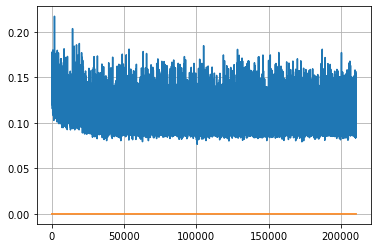

Epoch: 540, iteration 0, loss 0.0986756980419159, cov_diff 0.4028873131140049 cov_diff train 0.40224117472050747
Epoch: 540, iteration 1, loss 0.10697558522224426, cov_diff 0.3989126812631491 cov_diff train 0.39935337983293323
Epoch: 540, iteration 2, loss 0.09880626201629639, cov_diff 0.4119056125409068 cov_diff train 0.41118958413794876
Epoch: 540, iteration 3, loss 0.09556636214256287, cov_diff 0.40780642257145067 cov_diff train 0.4077214765043064
Epoch: 540, iteration 4, loss 0.09916606545448303, cov_diff 0.3983197082532458 cov_diff train 0.39853918998277266
Epoch: 540, iteration 5, loss 0.10062634944915771, cov_diff 0.4023545748068404 cov_diff train 0.4018776947003287
Epoch: 540, iteration 6, loss 0.10639023780822754, cov_diff 0.4138413473452185 cov_diff train 0.413373351084482
Epoch: 540, iteration 7, loss 0.10224303603172302, cov_diff 0.40266860821336375 cov_diff train 0.4026378579196588
Epoch: 540, iteration 8, loss 0.10989782214164734, cov_diff 0.40937820291874505 cov_diff tra

Epoch: 540, iteration 77, loss 0.10717663168907166, cov_diff 0.41323279775203037 cov_diff train 0.4128568293780162
Epoch: 540, iteration 78, loss 0.10125628113746643, cov_diff 0.406391300241802 cov_diff train 0.40498179093413333
Epoch: 540, iteration 79, loss 0.11386993527412415, cov_diff 0.40875038083311843 cov_diff train 0.40799495028074156
Epoch: 540, iteration 80, loss 0.11107772588729858, cov_diff 0.41477166948128674 cov_diff train 0.41389229194882293
Epoch: 540, iteration 81, loss 0.09399187564849854, cov_diff 0.42405264825118055 cov_diff train 0.4229794232981281
Epoch: 540, iteration 82, loss 0.10278856754302979, cov_diff 0.4158679941008299 cov_diff train 0.41566499461059603
Epoch: 540, iteration 83, loss 0.10724848508834839, cov_diff 0.4114787433465703 cov_diff train 0.4106751953485947
Epoch: 540, iteration 84, loss 0.10582172870635986, cov_diff 0.41084454737825354 cov_diff train 0.4101898955963997
Epoch: 540, iteration 85, loss 0.10826742649078369, cov_diff 0.42470955533026994

Epoch: 540, iteration 157, loss 0.10781437158584595, cov_diff 0.40411667821361014 cov_diff train 0.4039095696171281
Epoch: 540, iteration 158, loss 0.10298985242843628, cov_diff 0.41512047546724123 cov_diff train 0.4148849266076834
Epoch: 540, iteration 159, loss 0.10995844006538391, cov_diff 0.4273556443204909 cov_diff train 0.4268509249332492
Epoch: 540, iteration 160, loss 0.09606748819351196, cov_diff 0.4136611616876357 cov_diff train 0.41268640552943886
Epoch: 540, iteration 161, loss 0.09775415062904358, cov_diff 0.42400517737288246 cov_diff train 0.4235870168301521
Epoch: 540, iteration 162, loss 0.09868144989013672, cov_diff 0.413226869679114 cov_diff train 0.4133588050010091
Epoch: 540, iteration 163, loss 0.11510789394378662, cov_diff 0.409537442873427 cov_diff train 0.4093618090615449
Epoch: 540, iteration 164, loss 0.1098853349685669, cov_diff 0.41907715415224206 cov_diff train 0.41695922285490356
Epoch: 540, iteration 165, loss 0.11559504270553589, cov_diff 0.4159538861045

Epoch: 540, iteration 236, loss 0.0963577926158905, cov_diff 0.40842517290490715 cov_diff train 0.40750980440181256
Epoch: 540, iteration 237, loss 0.10397976636886597, cov_diff 0.4022522011509979 cov_diff train 0.4014691992048733
Epoch: 540, iteration 238, loss 0.1234169602394104, cov_diff 0.41876339391545875 cov_diff train 0.41842295318646366
Epoch: 540, iteration 239, loss 0.09949126839637756, cov_diff 0.41406029958216684 cov_diff train 0.41338473167432355
Epoch: 540, iteration 240, loss 0.09585019946098328, cov_diff 0.4145322540728471 cov_diff train 0.4135228543775361
Epoch: 540, iteration 241, loss 0.11510452628135681, cov_diff 0.4125414615116118 cov_diff train 0.41138461736579085
Epoch: 540, iteration 242, loss 0.09791171550750732, cov_diff 0.41992419867753333 cov_diff train 0.41926269288571033
Epoch: 540, iteration 243, loss 0.11422213912010193, cov_diff 0.41633740325473584 cov_diff train 0.41511770089508293
Epoch: 540, iteration 244, loss 0.10003077983856201, cov_diff 0.4115741

Epoch: 540, iteration 317, loss 0.10026359558105469, cov_diff 0.40417315260476333 cov_diff train 0.4037190545169546
Epoch: 540, iteration 318, loss 0.10046356916427612, cov_diff 0.4045583270848284 cov_diff train 0.40487142697358786
Epoch: 540, iteration 319, loss 0.09996092319488525, cov_diff 0.41270948693156195 cov_diff train 0.41242515590619994
Epoch: 540, iteration 320, loss 0.10087135434150696, cov_diff 0.40454981964162456 cov_diff train 0.40427363663289395
Epoch: 540, iteration 321, loss 0.11037921905517578, cov_diff 0.40899602444891286 cov_diff train 0.407425984451454
Epoch: 540, iteration 322, loss 0.11406293511390686, cov_diff 0.4124267645239229 cov_diff train 0.41203654588800287
Epoch: 540, iteration 323, loss 0.09991982579231262, cov_diff 0.4148568827797694 cov_diff train 0.4146100403248887
Epoch: 540, iteration 324, loss 0.10473588109016418, cov_diff 0.4151276930217121 cov_diff train 0.4143255890641474
Epoch: 540, iteration 325, loss 0.0945402979850769, cov_diff 0.4056728895

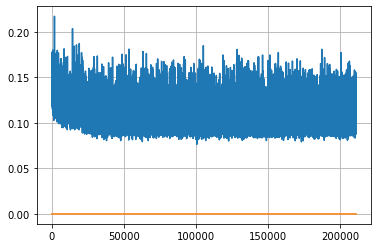

Epoch: 541, iteration 0, loss 0.10012522339820862, cov_diff 0.410751782771686 cov_diff train 0.4107512131438889
Epoch: 541, iteration 1, loss 0.10065335035324097, cov_diff 0.43158338775345934 cov_diff train 0.43132699508596606
Epoch: 541, iteration 2, loss 0.10122668743133545, cov_diff 0.41251467087212296 cov_diff train 0.41174109602435827
Epoch: 541, iteration 3, loss 0.09859246015548706, cov_diff 0.4145167573394383 cov_diff train 0.4137036688983309
Epoch: 541, iteration 4, loss 0.10763344168663025, cov_diff 0.4091183136351694 cov_diff train 0.4082655577154344
Epoch: 541, iteration 5, loss 0.10478243231773376, cov_diff 0.40584984935111074 cov_diff train 0.40462408222111707
Epoch: 541, iteration 6, loss 0.0996728241443634, cov_diff 0.41119999838911403 cov_diff train 0.4114155331576154
Epoch: 541, iteration 7, loss 0.1064232885837555, cov_diff 0.404628142066409 cov_diff train 0.40459587340921127
Epoch: 541, iteration 8, loss 0.10517421364784241, cov_diff 0.4176847795591991 cov_diff trai

Epoch: 541, iteration 75, loss 0.10656511783599854, cov_diff 0.4110860082669961 cov_diff train 0.4111460504961823
Epoch: 541, iteration 76, loss 0.11437010765075684, cov_diff 0.4108767224679067 cov_diff train 0.4118514817043181
Epoch: 541, iteration 77, loss 0.0981195867061615, cov_diff 0.40122329257432815 cov_diff train 0.40109924346958603
Epoch: 541, iteration 78, loss 0.09247899055480957, cov_diff 0.4188338248614881 cov_diff train 0.4187777033842104
Epoch: 541, iteration 79, loss 0.09480294585227966, cov_diff 0.4063363268611723 cov_diff train 0.4067310114864928
Epoch: 541, iteration 80, loss 0.11199530959129333, cov_diff 0.42848065904191046 cov_diff train 0.42823780617567514
Epoch: 541, iteration 81, loss 0.10506528615951538, cov_diff 0.40256737614692145 cov_diff train 0.40248471939184083
Epoch: 541, iteration 82, loss 0.10866445302963257, cov_diff 0.4056685856217763 cov_diff train 0.40498650943249187
Epoch: 541, iteration 83, loss 0.10118809342384338, cov_diff 0.41274012154369183 c

Epoch: 541, iteration 152, loss 0.09609878063201904, cov_diff 0.39407585747454493 cov_diff train 0.39421246335482624
Epoch: 541, iteration 153, loss 0.11113274097442627, cov_diff 0.40409579752665487 cov_diff train 0.404103960015056
Epoch: 541, iteration 154, loss 0.10008621215820312, cov_diff 0.4108383579216192 cov_diff train 0.41064512713938206
Epoch: 541, iteration 155, loss 0.1018683910369873, cov_diff 0.40613773196037894 cov_diff train 0.4054524357495559
Epoch: 541, iteration 156, loss 0.09966892004013062, cov_diff 0.4299006410047369 cov_diff train 0.4291713510728147
Epoch: 541, iteration 157, loss 0.10927236080169678, cov_diff 0.41241930693819495 cov_diff train 0.41173363956196735
Epoch: 541, iteration 158, loss 0.11304640769958496, cov_diff 0.4149180574498485 cov_diff train 0.41421123473337434
Epoch: 541, iteration 159, loss 0.10098984837532043, cov_diff 0.40321567201863606 cov_diff train 0.4030417733741865
Epoch: 541, iteration 160, loss 0.10147419571876526, cov_diff 0.413074926

Epoch: 541, iteration 230, loss 0.1042214035987854, cov_diff 0.4095063713490493 cov_diff train 0.40876534693560695
Epoch: 541, iteration 231, loss 0.10704594850540161, cov_diff 0.39886210752402895 cov_diff train 0.39849256431287156
Epoch: 541, iteration 232, loss 0.10872986912727356, cov_diff 0.4067314358555706 cov_diff train 0.40606257798523504
Epoch: 541, iteration 233, loss 0.10049757361412048, cov_diff 0.4086636338201739 cov_diff train 0.4083651817892477
Epoch: 541, iteration 234, loss 0.10051921010017395, cov_diff 0.41262937664531857 cov_diff train 0.4122018437866817
Epoch: 541, iteration 235, loss 0.09675043821334839, cov_diff 0.40764935572049144 cov_diff train 0.4074964172767753
Epoch: 541, iteration 236, loss 0.11082816123962402, cov_diff 0.40353663180743854 cov_diff train 0.4034753250889997
Epoch: 541, iteration 237, loss 0.10289657115936279, cov_diff 0.4177971737414546 cov_diff train 0.4175990287434021
Epoch: 541, iteration 238, loss 0.10980886220932007, cov_diff 0.4123955979

Epoch: 541, iteration 311, loss 0.10636141896247864, cov_diff 0.407392172462072 cov_diff train 0.40674503840469745
Epoch: 541, iteration 312, loss 0.10001367330551147, cov_diff 0.41003771681457457 cov_diff train 0.41003235168675756
Epoch: 541, iteration 313, loss 0.09247690439224243, cov_diff 0.405128309076835 cov_diff train 0.40456197349313056
Epoch: 541, iteration 314, loss 0.0926503837108612, cov_diff 0.3965111144218062 cov_diff train 0.3963223360384768
Epoch: 541, iteration 315, loss 0.10177344083786011, cov_diff 0.40903562541003446 cov_diff train 0.40878447058177303
Epoch: 541, iteration 316, loss 0.10027804970741272, cov_diff 0.4119877237181722 cov_diff train 0.4114220108311419
Epoch: 541, iteration 317, loss 0.11266821622848511, cov_diff 0.4096458889508249 cov_diff train 0.409786676699974
Epoch: 541, iteration 318, loss 0.10071080923080444, cov_diff 0.4177894208580533 cov_diff train 0.41764440457390295
Epoch: 541, iteration 319, loss 0.09618619084358215, cov_diff 0.4078673563035

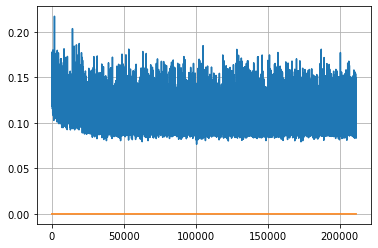

Epoch: 542, iteration 0, loss 0.10443788766860962, cov_diff 0.4157407185753671 cov_diff train 0.4144309529184976
Epoch: 542, iteration 1, loss 0.1000317633152008, cov_diff 0.4283504774975092 cov_diff train 0.4286105002497939
Epoch: 542, iteration 2, loss 0.10019159317016602, cov_diff 0.41355649023218444 cov_diff train 0.4127749662491445
Epoch: 542, iteration 3, loss 0.108562171459198, cov_diff 0.41733468191758694 cov_diff train 0.4162799561490653
Epoch: 542, iteration 4, loss 0.10801026225090027, cov_diff 0.4085126880490767 cov_diff train 0.40630566834428067
Epoch: 542, iteration 5, loss 0.10957741737365723, cov_diff 0.4065988039883626 cov_diff train 0.4046484027642606
Epoch: 542, iteration 6, loss 0.10540950298309326, cov_diff 0.4059976267552294 cov_diff train 0.40545200330114894
Epoch: 542, iteration 7, loss 0.10114142298698425, cov_diff 0.4190353961862738 cov_diff train 0.4185613954749362
Epoch: 542, iteration 8, loss 0.11017245054244995, cov_diff 0.4214695612958529 cov_diff train 0

Epoch: 542, iteration 78, loss 0.10695105791091919, cov_diff 0.4007683647573174 cov_diff train 0.4002887640982107
Epoch: 542, iteration 79, loss 0.09580788016319275, cov_diff 0.4180102474673794 cov_diff train 0.41652741599940574
Epoch: 542, iteration 80, loss 0.08985692262649536, cov_diff 0.4066842866893998 cov_diff train 0.4054211942194916
Epoch: 542, iteration 81, loss 0.10733908414840698, cov_diff 0.4115051642089457 cov_diff train 0.41086512526266616
Epoch: 542, iteration 82, loss 0.10578951239585876, cov_diff 0.4175339155510002 cov_diff train 0.41698024080375623
Epoch: 542, iteration 83, loss 0.11428272724151611, cov_diff 0.4037650597324172 cov_diff train 0.40262084163274964
Epoch: 542, iteration 84, loss 0.08893388509750366, cov_diff 0.41607972194307535 cov_diff train 0.41566035777943955
Epoch: 542, iteration 85, loss 0.1015377938747406, cov_diff 0.41451296957855205 cov_diff train 0.413413658590772
Epoch: 542, iteration 86, loss 0.09634724259376526, cov_diff 0.4099384428260711 cov

Epoch: 542, iteration 158, loss 0.09355220198631287, cov_diff 0.40736072943435 cov_diff train 0.4062769619143909
Epoch: 542, iteration 159, loss 0.11739960312843323, cov_diff 0.4258847195160002 cov_diff train 0.42473819352224274
Epoch: 542, iteration 160, loss 0.10676807165145874, cov_diff 0.3992785366734652 cov_diff train 0.3973806312677958
Epoch: 542, iteration 161, loss 0.10012298822402954, cov_diff 0.4149608098354187 cov_diff train 0.41443216395006316
Epoch: 542, iteration 162, loss 0.11257630586624146, cov_diff 0.42004589315296587 cov_diff train 0.41892391807204726
Epoch: 542, iteration 163, loss 0.10888251662254333, cov_diff 0.41937217061404986 cov_diff train 0.41871561287231684
Epoch: 542, iteration 164, loss 0.09719181060791016, cov_diff 0.40946111298550547 cov_diff train 0.4077461814634075
Epoch: 542, iteration 165, loss 0.10705569386482239, cov_diff 0.41641430919720723 cov_diff train 0.41519083627921827
Epoch: 542, iteration 166, loss 0.1303049921989441, cov_diff 0.4071402733

Epoch: 542, iteration 240, loss 0.10004279017448425, cov_diff 0.40890784069499136 cov_diff train 0.4090368220993297
Epoch: 542, iteration 241, loss 0.09996473789215088, cov_diff 0.4059447605723349 cov_diff train 0.40586434515901093
Epoch: 542, iteration 242, loss 0.11254045367240906, cov_diff 0.4142181050206649 cov_diff train 0.41514676116836396
Epoch: 542, iteration 243, loss 0.09653383493423462, cov_diff 0.40130802187738435 cov_diff train 0.4018172544218804
Epoch: 542, iteration 244, loss 0.09804069995880127, cov_diff 0.4170951454534823 cov_diff train 0.4172718029683792
Epoch: 542, iteration 245, loss 0.10820677876472473, cov_diff 0.41691294982876503 cov_diff train 0.4169842592099098
Epoch: 542, iteration 246, loss 0.09742513298988342, cov_diff 0.4060988568435612 cov_diff train 0.4064275497561968
Epoch: 542, iteration 247, loss 0.11564800143241882, cov_diff 0.4197546895729438 cov_diff train 0.4201871219616871
Epoch: 542, iteration 248, loss 0.10832387208938599, cov_diff 0.40689121603

Epoch: 542, iteration 319, loss 0.11102095246315002, cov_diff 0.40168982945101883 cov_diff train 0.4011805070317794
Epoch: 542, iteration 320, loss 0.1159360408782959, cov_diff 0.40255788393097686 cov_diff train 0.4019190448227509
Epoch: 542, iteration 321, loss 0.09286239743232727, cov_diff 0.40954134645799334 cov_diff train 0.4080093500310883
Epoch: 542, iteration 322, loss 0.11994516849517822, cov_diff 0.40490985899174753 cov_diff train 0.4047882097091256
Epoch: 542, iteration 323, loss 0.09891247749328613, cov_diff 0.4124710908804681 cov_diff train 0.4120191907586281
Epoch: 542, iteration 324, loss 0.10499727725982666, cov_diff 0.4187618385355148 cov_diff train 0.4182977249587555
Epoch: 542, iteration 325, loss 0.10358387231826782, cov_diff 0.40329884341733063 cov_diff train 0.4035271244199103
Epoch: 542, iteration 326, loss 0.08817839622497559, cov_diff 0.4087746105508091 cov_diff train 0.40808269790806795
Epoch: 542, iteration 327, loss 0.10241711139678955, cov_diff 0.41148967203

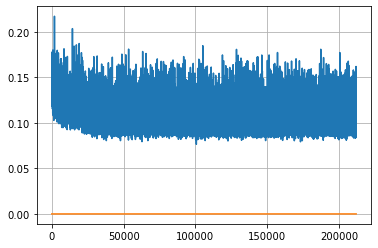

Epoch: 543, iteration 0, loss 0.09994861483573914, cov_diff 0.41222192733451174 cov_diff train 0.4116661485045296
Epoch: 543, iteration 1, loss 0.10078957676887512, cov_diff 0.41429963201768516 cov_diff train 0.41430958571830784
Epoch: 543, iteration 2, loss 0.09797683358192444, cov_diff 0.4099354269439281 cov_diff train 0.40894605928048167
Epoch: 543, iteration 3, loss 0.10023009777069092, cov_diff 0.4039500801061759 cov_diff train 0.4035289301373316
Epoch: 543, iteration 4, loss 0.10428944230079651, cov_diff 0.3996385544038796 cov_diff train 0.3992942608215127
Epoch: 543, iteration 5, loss 0.1055372953414917, cov_diff 0.4042775762973476 cov_diff train 0.40331691555706733
Epoch: 543, iteration 6, loss 0.11040487885475159, cov_diff 0.4049597195525842 cov_diff train 0.4034674961760782
Epoch: 543, iteration 7, loss 0.09827440977096558, cov_diff 0.41917249616763486 cov_diff train 0.41872378422540424
Epoch: 543, iteration 8, loss 0.10686993598937988, cov_diff 0.4112205682386563 cov_diff tr

Epoch: 543, iteration 82, loss 0.104310542345047, cov_diff 0.40430872489118236 cov_diff train 0.4037575761445629
Epoch: 543, iteration 83, loss 0.10035189986228943, cov_diff 0.4071424904289361 cov_diff train 0.4067436349536397
Epoch: 543, iteration 84, loss 0.10869652032852173, cov_diff 0.4085734766356227 cov_diff train 0.4082694869478073
Epoch: 543, iteration 85, loss 0.10316666960716248, cov_diff 0.4143946661931347 cov_diff train 0.413973981327016
Epoch: 543, iteration 86, loss 0.11134478449821472, cov_diff 0.4071669871057114 cov_diff train 0.40665063121104233
Epoch: 543, iteration 87, loss 0.08880993723869324, cov_diff 0.4040259307868906 cov_diff train 0.40370468957666245
Epoch: 543, iteration 88, loss 0.09295055270195007, cov_diff 0.4079443947458078 cov_diff train 0.4066472732316175
Epoch: 543, iteration 89, loss 0.10374057292938232, cov_diff 0.40467677782441525 cov_diff train 0.404530404668919
Epoch: 543, iteration 90, loss 0.09215313196182251, cov_diff 0.41081338651373517 cov_dif

Epoch: 543, iteration 161, loss 0.09441697597503662, cov_diff 0.4081726651870055 cov_diff train 0.4069130884641219
Epoch: 543, iteration 162, loss 0.0935342013835907, cov_diff 0.3963220744088753 cov_diff train 0.395661008663611
Epoch: 543, iteration 163, loss 0.10360977053642273, cov_diff 0.41082520687357893 cov_diff train 0.41069472375314414
Epoch: 543, iteration 164, loss 0.09982031583786011, cov_diff 0.40308921796548863 cov_diff train 0.4021536407325512
Epoch: 543, iteration 165, loss 0.1030939519405365, cov_diff 0.4092004558708943 cov_diff train 0.4091798815748574
Epoch: 543, iteration 166, loss 0.09058550000190735, cov_diff 0.40889456293756876 cov_diff train 0.40854739230443393
Epoch: 543, iteration 167, loss 0.09040290117263794, cov_diff 0.4038995177920502 cov_diff train 0.40385164020299685
Epoch: 543, iteration 168, loss 0.09756562113761902, cov_diff 0.4046602100768089 cov_diff train 0.40495602952414594
Epoch: 543, iteration 169, loss 0.10875675082206726, cov_diff 0.413299693423

Epoch: 543, iteration 242, loss 0.10649526119232178, cov_diff 0.4146483331717784 cov_diff train 0.4144994644195555
Epoch: 543, iteration 243, loss 0.0976334810256958, cov_diff 0.4092065573193708 cov_diff train 0.4088713569112235
Epoch: 543, iteration 244, loss 0.11602982878684998, cov_diff 0.403903165572131 cov_diff train 0.4039095929246878
Epoch: 543, iteration 245, loss 0.10288950800895691, cov_diff 0.4090609514337918 cov_diff train 0.40781798758977306
Epoch: 543, iteration 246, loss 0.10287037491798401, cov_diff 0.4103761427172363 cov_diff train 0.41077610690254235
Epoch: 543, iteration 247, loss 0.106037437915802, cov_diff 0.4087066919633073 cov_diff train 0.40899243587888323
Epoch: 543, iteration 248, loss 0.1020422875881195, cov_diff 0.42595167604540074 cov_diff train 0.4250292523449913
Epoch: 543, iteration 249, loss 0.10700112581253052, cov_diff 0.4229004850181045 cov_diff train 0.42281295477308567
Epoch: 543, iteration 250, loss 0.10795366764068604, cov_diff 0.4077619798383514

Epoch: 543, iteration 321, loss 0.10386118292808533, cov_diff 0.4099017336013838 cov_diff train 0.40819869457868496
Epoch: 543, iteration 322, loss 0.11041003465652466, cov_diff 0.4201780925290725 cov_diff train 0.4194182577045424
Epoch: 543, iteration 323, loss 0.10269901156425476, cov_diff 0.4169275538587065 cov_diff train 0.41586665710803705
Epoch: 543, iteration 324, loss 0.09268420934677124, cov_diff 0.4059171077954224 cov_diff train 0.40521146128803426
Epoch: 543, iteration 325, loss 0.09955334663391113, cov_diff 0.3959643160599836 cov_diff train 0.39555156030230904
Epoch: 543, iteration 326, loss 0.1030319333076477, cov_diff 0.4015124321256565 cov_diff train 0.40139627088905555
Epoch: 543, iteration 327, loss 0.10406923294067383, cov_diff 0.40231447654370717 cov_diff train 0.4021637209841889
Epoch: 543, iteration 328, loss 0.08726933598518372, cov_diff 0.39986919719495173 cov_diff train 0.39960279751068395
Epoch: 543, iteration 329, loss 0.09687167406082153, cov_diff 0.399396266

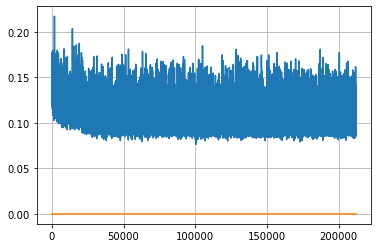

Epoch: 544, iteration 0, loss 0.10310196876525879, cov_diff 0.41093833422492826 cov_diff train 0.4110533736865202
Epoch: 544, iteration 1, loss 0.10563647747039795, cov_diff 0.4027377015418195 cov_diff train 0.4026898629405125
Epoch: 544, iteration 2, loss 0.09995970129966736, cov_diff 0.40436769335381473 cov_diff train 0.40408750981512315
Epoch: 544, iteration 3, loss 0.10740277171134949, cov_diff 0.4052845235986414 cov_diff train 0.4042520015153003
Epoch: 544, iteration 4, loss 0.09749191999435425, cov_diff 0.40911709254694545 cov_diff train 0.40822044706824434
Epoch: 544, iteration 5, loss 0.10126301646232605, cov_diff 0.41425209310721234 cov_diff train 0.4137315561633291
Epoch: 544, iteration 6, loss 0.10052800178527832, cov_diff 0.40987479876583516 cov_diff train 0.4079259909272775
Epoch: 544, iteration 7, loss 0.10978412628173828, cov_diff 0.4193798432960063 cov_diff train 0.4183447626211803
Epoch: 544, iteration 8, loss 0.10945165157318115, cov_diff 0.41240823320114967 cov_diff 

Epoch: 544, iteration 79, loss 0.10698384046554565, cov_diff 0.4080142301848554 cov_diff train 0.4075362814560244
Epoch: 544, iteration 80, loss 0.09965553879737854, cov_diff 0.40782185219507827 cov_diff train 0.4076643672876527
Epoch: 544, iteration 81, loss 0.10486838221549988, cov_diff 0.4068806012662933 cov_diff train 0.4061908139448028
Epoch: 544, iteration 82, loss 0.1175307035446167, cov_diff 0.41948459768601115 cov_diff train 0.41866494022731143
Epoch: 544, iteration 83, loss 0.10628053545951843, cov_diff 0.40121795410586253 cov_diff train 0.40069208162208253
Epoch: 544, iteration 84, loss 0.09074738621711731, cov_diff 0.41115480974627344 cov_diff train 0.41029821235534547
Epoch: 544, iteration 85, loss 0.10332232713699341, cov_diff 0.40630042150610773 cov_diff train 0.4060995743726814
Epoch: 544, iteration 86, loss 0.0950959324836731, cov_diff 0.4126367928092827 cov_diff train 0.411097048757465
Epoch: 544, iteration 87, loss 0.10233432054519653, cov_diff 0.40632143447461155 co

Epoch: 544, iteration 158, loss 0.09863939881324768, cov_diff 0.4168161224220896 cov_diff train 0.41503291508689955
Epoch: 544, iteration 159, loss 0.1049787700176239, cov_diff 0.4035753617187509 cov_diff train 0.40198779390231437
Epoch: 544, iteration 160, loss 0.09591555595397949, cov_diff 0.4144750292339357 cov_diff train 0.41249473259904185
Epoch: 544, iteration 161, loss 0.10346406698226929, cov_diff 0.4026564537022595 cov_diff train 0.40047934681026537
Epoch: 544, iteration 162, loss 0.10645812749862671, cov_diff 0.4040184824113958 cov_diff train 0.40272499218553476
Epoch: 544, iteration 163, loss 0.10134056210517883, cov_diff 0.4118329811859727 cov_diff train 0.4109074704362208
Epoch: 544, iteration 164, loss 0.10279062390327454, cov_diff 0.4124814935964613 cov_diff train 0.41147213528599574
Epoch: 544, iteration 165, loss 0.10125598311424255, cov_diff 0.40974346711495907 cov_diff train 0.40949591965244997
Epoch: 544, iteration 166, loss 0.11816489696502686, cov_diff 0.412402012

Epoch: 544, iteration 238, loss 0.1047128438949585, cov_diff 0.41414437849257946 cov_diff train 0.41351303096763425
Epoch: 544, iteration 239, loss 0.09327948093414307, cov_diff 0.4098181475068794 cov_diff train 0.40834279338156276
Epoch: 544, iteration 240, loss 0.10233575105667114, cov_diff 0.42030687087399143 cov_diff train 0.419584861070675
Epoch: 544, iteration 241, loss 0.11849159002304077, cov_diff 0.4109166307017669 cov_diff train 0.4092119022021429
Epoch: 544, iteration 242, loss 0.0988200306892395, cov_diff 0.41066390295190774 cov_diff train 0.4099479199257342
Epoch: 544, iteration 243, loss 0.1128559410572052, cov_diff 0.4001074776934249 cov_diff train 0.39967587843611463
Epoch: 544, iteration 244, loss 0.09774050116539001, cov_diff 0.4148459325911041 cov_diff train 0.41425864608481244
Epoch: 544, iteration 245, loss 0.10252448916435242, cov_diff 0.3977216894629053 cov_diff train 0.3971517149598845
Epoch: 544, iteration 246, loss 0.10212939977645874, cov_diff 0.4111237156484

Epoch: 544, iteration 319, loss 0.10566440224647522, cov_diff 0.43395886303092485 cov_diff train 0.43383888752395194
Epoch: 544, iteration 320, loss 0.09788599610328674, cov_diff 0.4292398614604116 cov_diff train 0.4290500224004202
Epoch: 544, iteration 321, loss 0.10978451371192932, cov_diff 0.4196560372986352 cov_diff train 0.4198081915869551
Epoch: 544, iteration 322, loss 0.11374449729919434, cov_diff 0.40462623093158906 cov_diff train 0.403861739297135
Epoch: 544, iteration 323, loss 0.10228291153907776, cov_diff 0.4254254926241671 cov_diff train 0.4253588406686348
Epoch: 544, iteration 324, loss 0.09728282690048218, cov_diff 0.4160600297623921 cov_diff train 0.41595660413923974
Epoch: 544, iteration 325, loss 0.10336923599243164, cov_diff 0.4104785625130429 cov_diff train 0.40926679989548853
Epoch: 544, iteration 326, loss 0.10882025957107544, cov_diff 0.41590885550565027 cov_diff train 0.4152093608865769
Epoch: 544, iteration 327, loss 0.11011534929275513, cov_diff 0.42069381406

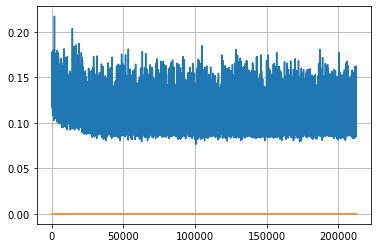

Epoch: 545, iteration 0, loss 0.09956428408622742, cov_diff 0.401330615089852 cov_diff train 0.4005231723119002
Epoch: 545, iteration 1, loss 0.11118552088737488, cov_diff 0.4103838609005457 cov_diff train 0.40995527469598847
Epoch: 545, iteration 2, loss 0.09918412566184998, cov_diff 0.41223024926566454 cov_diff train 0.411915292280852
Epoch: 545, iteration 3, loss 0.11680757999420166, cov_diff 0.424476969547381 cov_diff train 0.4233155787895218
Epoch: 545, iteration 4, loss 0.10233649611473083, cov_diff 0.4052527520884455 cov_diff train 0.40441115111598824
Epoch: 545, iteration 5, loss 0.10262158513069153, cov_diff 0.4048831903862739 cov_diff train 0.40476050510234546
Epoch: 545, iteration 6, loss 0.09523892402648926, cov_diff 0.4159850255980047 cov_diff train 0.4155179925494546
Epoch: 545, iteration 7, loss 0.10536414384841919, cov_diff 0.41791691494897 cov_diff train 0.41637391365342374
Epoch: 545, iteration 8, loss 0.10053390264511108, cov_diff 0.41141473260090544 cov_diff train 0

Epoch: 545, iteration 77, loss 0.09792205691337585, cov_diff 0.41453724222637367 cov_diff train 0.4146221472525735
Epoch: 545, iteration 78, loss 0.10119903087615967, cov_diff 0.41434217626961695 cov_diff train 0.41377478535454576
Epoch: 545, iteration 79, loss 0.10105425119400024, cov_diff 0.4167537245995109 cov_diff train 0.41566805366963083
Epoch: 545, iteration 80, loss 0.09547701478004456, cov_diff 0.4180804238399527 cov_diff train 0.4174597789398029
Epoch: 545, iteration 81, loss 0.09300306439399719, cov_diff 0.41960239655079873 cov_diff train 0.41863989126742107
Epoch: 545, iteration 82, loss 0.09867581725120544, cov_diff 0.4184241685547762 cov_diff train 0.4178497873102264
Epoch: 545, iteration 83, loss 0.0956692099571228, cov_diff 0.4090748870405572 cov_diff train 0.40783370534256386
Epoch: 545, iteration 84, loss 0.10155060887336731, cov_diff 0.3974076788133099 cov_diff train 0.3973484197773463
Epoch: 545, iteration 85, loss 0.10199978947639465, cov_diff 0.39163413419628734 c

Epoch: 545, iteration 155, loss 0.11943775415420532, cov_diff 0.413151066984221 cov_diff train 0.41241095928870375
Epoch: 545, iteration 156, loss 0.10036155581474304, cov_diff 0.4212972354866773 cov_diff train 0.4201004080173614
Epoch: 545, iteration 157, loss 0.10661029815673828, cov_diff 0.39466107397569156 cov_diff train 0.3949616672244854
Epoch: 545, iteration 158, loss 0.10482984781265259, cov_diff 0.4033966401452616 cov_diff train 0.40353291078579695
Epoch: 545, iteration 159, loss 0.1005602478981018, cov_diff 0.40450607631427143 cov_diff train 0.40454903593195013
Epoch: 545, iteration 160, loss 0.10951220989227295, cov_diff 0.4042804291765659 cov_diff train 0.4044312085370667
Epoch: 545, iteration 161, loss 0.10407382249832153, cov_diff 0.40636509804009135 cov_diff train 0.40551582111547163
Epoch: 545, iteration 162, loss 0.09630289673805237, cov_diff 0.4161161518601835 cov_diff train 0.4148984284413289
Epoch: 545, iteration 163, loss 0.10149708390235901, cov_diff 0.40832976087

Epoch: 545, iteration 235, loss 0.09935137629508972, cov_diff 0.40970794739819383 cov_diff train 0.40932925324922353
Epoch: 545, iteration 236, loss 0.10915395617485046, cov_diff 0.4203774092602128 cov_diff train 0.4200767321554632
Epoch: 545, iteration 237, loss 0.09819862246513367, cov_diff 0.41618403023479306 cov_diff train 0.4160729428808727
Epoch: 545, iteration 238, loss 0.11813768744468689, cov_diff 0.40268549277832855 cov_diff train 0.4019121141012068
Epoch: 545, iteration 239, loss 0.1045941710472107, cov_diff 0.41543822638235706 cov_diff train 0.4154590190879563
Epoch: 545, iteration 240, loss 0.1099703311920166, cov_diff 0.4174061505135737 cov_diff train 0.41661999363779467
Epoch: 545, iteration 241, loss 0.10224047303199768, cov_diff 0.4047923694103955 cov_diff train 0.40426018477541087
Epoch: 545, iteration 242, loss 0.10031628608703613, cov_diff 0.41097494016532365 cov_diff train 0.408846518010361
Epoch: 545, iteration 243, loss 0.10696250200271606, cov_diff 0.39887137853

Epoch: 545, iteration 313, loss 0.0999957025051117, cov_diff 0.4180782102386233 cov_diff train 0.4166279918962827
Epoch: 545, iteration 314, loss 0.10826075077056885, cov_diff 0.39992399561946157 cov_diff train 0.3997797508849071
Epoch: 545, iteration 315, loss 0.1019197404384613, cov_diff 0.40045233261351476 cov_diff train 0.3999098918895414
Epoch: 545, iteration 316, loss 0.09844234585762024, cov_diff 0.40581738300131454 cov_diff train 0.40552730903912093
Epoch: 545, iteration 317, loss 0.10879561305046082, cov_diff 0.41729013531120906 cov_diff train 0.41756008905232644
Epoch: 545, iteration 318, loss 0.0981486439704895, cov_diff 0.408768864651591 cov_diff train 0.40924930926636877
Epoch: 545, iteration 319, loss 0.09297561645507812, cov_diff 0.3920998809009636 cov_diff train 0.39156573925115684
Epoch: 545, iteration 320, loss 0.0896751880645752, cov_diff 0.39405257900581314 cov_diff train 0.394534818856495
Epoch: 545, iteration 321, loss 0.09214714169502258, cov_diff 0.3996406777831

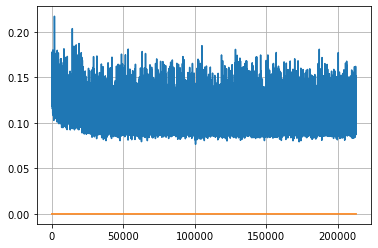

Epoch: 546, iteration 0, loss 0.09648376703262329, cov_diff 0.4154378173372651 cov_diff train 0.41480131261376674
Epoch: 546, iteration 1, loss 0.10599371790885925, cov_diff 0.4257727631620507 cov_diff train 0.42514699438737086
Epoch: 546, iteration 2, loss 0.10829651355743408, cov_diff 0.40484188050149594 cov_diff train 0.4045213528807023
Epoch: 546, iteration 3, loss 0.11027246713638306, cov_diff 0.3938656590674353 cov_diff train 0.39205577481353343
Epoch: 546, iteration 4, loss 0.11271083354949951, cov_diff 0.40670441331420554 cov_diff train 0.407199609818634
Epoch: 546, iteration 5, loss 0.10082560777664185, cov_diff 0.4276608530283868 cov_diff train 0.4274275262388242
Epoch: 546, iteration 6, loss 0.09580361843109131, cov_diff 0.39561531068630373 cov_diff train 0.3952188585529045
Epoch: 546, iteration 7, loss 0.09961846470832825, cov_diff 0.4001605876620416 cov_diff train 0.3998307236989695
Epoch: 546, iteration 8, loss 0.10832500457763672, cov_diff 0.43063865169849225 cov_diff tr

Epoch: 546, iteration 81, loss 0.10302230715751648, cov_diff 0.4155369065157555 cov_diff train 0.41519194761063727
Epoch: 546, iteration 82, loss 0.10393393039703369, cov_diff 0.4103054233549612 cov_diff train 0.40908021611650724
Epoch: 546, iteration 83, loss 0.10865718126296997, cov_diff 0.4157581566287884 cov_diff train 0.4154919812162621
Epoch: 546, iteration 84, loss 0.09519276022911072, cov_diff 0.41902254871825506 cov_diff train 0.4181916303261527
Epoch: 546, iteration 85, loss 0.09924331307411194, cov_diff 0.41005886150671383 cov_diff train 0.40914162144645094
Epoch: 546, iteration 86, loss 0.09326329827308655, cov_diff 0.4234014308846727 cov_diff train 0.42264259911774404
Epoch: 546, iteration 87, loss 0.11245867609977722, cov_diff 0.400823583417402 cov_diff train 0.40048176238532407
Epoch: 546, iteration 88, loss 0.10904857516288757, cov_diff 0.4100060388984393 cov_diff train 0.41027536862671643
Epoch: 546, iteration 89, loss 0.11990925669670105, cov_diff 0.41682459189202936 

Epoch: 546, iteration 159, loss 0.0940503180027008, cov_diff 0.40805663275019083 cov_diff train 0.40687955839000073
Epoch: 546, iteration 160, loss 0.09886565804481506, cov_diff 0.3972319629719831 cov_diff train 0.3959715980018228
Epoch: 546, iteration 161, loss 0.10620170831680298, cov_diff 0.4203512119969265 cov_diff train 0.4185803656734319
Epoch: 546, iteration 162, loss 0.09501522779464722, cov_diff 0.40917317748647636 cov_diff train 0.40830521905321077
Epoch: 546, iteration 163, loss 0.10110729932785034, cov_diff 0.4018981982746576 cov_diff train 0.40190440672313854
Epoch: 546, iteration 164, loss 0.11895155906677246, cov_diff 0.40912871576025706 cov_diff train 0.40870873175322336
Epoch: 546, iteration 165, loss 0.09574925899505615, cov_diff 0.40647717512633225 cov_diff train 0.4058778072728731
Epoch: 546, iteration 166, loss 0.1059148907661438, cov_diff 0.4063204519389385 cov_diff train 0.40572480895922736
Epoch: 546, iteration 167, loss 0.09487417340278625, cov_diff 0.411834310

Epoch: 546, iteration 238, loss 0.10462841391563416, cov_diff 0.4114089480125906 cov_diff train 0.41077499239242077
Epoch: 546, iteration 239, loss 0.09131205081939697, cov_diff 0.4071635142882489 cov_diff train 0.4064672457382612
Epoch: 546, iteration 240, loss 0.09567892551422119, cov_diff 0.41343822340749486 cov_diff train 0.4125097724709996
Epoch: 546, iteration 241, loss 0.10796338319778442, cov_diff 0.40481496423141533 cov_diff train 0.40395797853187143
Epoch: 546, iteration 242, loss 0.11636891961097717, cov_diff 0.4180475136166969 cov_diff train 0.41594135847025954
Epoch: 546, iteration 243, loss 0.08889254927635193, cov_diff 0.4152882758780758 cov_diff train 0.4147186320576549
Epoch: 546, iteration 244, loss 0.098263680934906, cov_diff 0.40888604062439554 cov_diff train 0.4085214428883638
Epoch: 546, iteration 245, loss 0.1032896339893341, cov_diff 0.40161249087323747 cov_diff train 0.3984308578718228
Epoch: 546, iteration 246, loss 0.10552752017974854, cov_diff 0.413459074392

Epoch: 546, iteration 316, loss 0.10448887944221497, cov_diff 0.42555967977700027 cov_diff train 0.42512021746950784
Epoch: 546, iteration 317, loss 0.10857924818992615, cov_diff 0.4063321606152975 cov_diff train 0.4054418788664853
Epoch: 546, iteration 318, loss 0.10463115572929382, cov_diff 0.4098042103151031 cov_diff train 0.4093734935527292
Epoch: 546, iteration 319, loss 0.10044205188751221, cov_diff 0.40226556423560955 cov_diff train 0.4016066107109254
Epoch: 546, iteration 320, loss 0.09882429242134094, cov_diff 0.42541263612521285 cov_diff train 0.42470047191917537
Epoch: 546, iteration 321, loss 0.10710978507995605, cov_diff 0.4192835851999788 cov_diff train 0.4185034910305439
Epoch: 546, iteration 322, loss 0.10861626267433167, cov_diff 0.4200156034352785 cov_diff train 0.41858852585053674
Epoch: 546, iteration 323, loss 0.10168057680130005, cov_diff 0.4062084727025904 cov_diff train 0.4052117807039132
Epoch: 546, iteration 324, loss 0.11454886198043823, cov_diff 0.4180460521

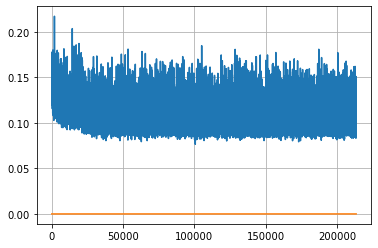

Epoch: 547, iteration 0, loss 0.11264181137084961, cov_diff 0.40799057608969524 cov_diff train 0.4074946155484366
Epoch: 547, iteration 1, loss 0.10365253686904907, cov_diff 0.4182862621017189 cov_diff train 0.41763712075181486
Epoch: 547, iteration 2, loss 0.10077357292175293, cov_diff 0.41032725876698156 cov_diff train 0.40917868098991755
Epoch: 547, iteration 3, loss 0.09595772624015808, cov_diff 0.41280195978014095 cov_diff train 0.4119835747326481
Epoch: 547, iteration 4, loss 0.09671974182128906, cov_diff 0.41403064616654645 cov_diff train 0.4136201134040484
Epoch: 547, iteration 5, loss 0.09718039631843567, cov_diff 0.40892444743230594 cov_diff train 0.40973137813423727
Epoch: 547, iteration 6, loss 0.10302352905273438, cov_diff 0.3983084047485768 cov_diff train 0.3974297696032047
Epoch: 547, iteration 7, loss 0.09424847364425659, cov_diff 0.4175090386021822 cov_diff train 0.41683068632550974
Epoch: 547, iteration 8, loss 0.10361161828041077, cov_diff 0.4298031372850997 cov_diff

Epoch: 547, iteration 82, loss 0.09982892870903015, cov_diff 0.40209386642073297 cov_diff train 0.40132183533812266
Epoch: 547, iteration 83, loss 0.10263466835021973, cov_diff 0.40412399829163226 cov_diff train 0.403566485403148
Epoch: 547, iteration 84, loss 0.10220342874526978, cov_diff 0.41283082046389613 cov_diff train 0.4118993873415417
Epoch: 547, iteration 85, loss 0.09431508183479309, cov_diff 0.4236800171265643 cov_diff train 0.42237598062241716
Epoch: 547, iteration 86, loss 0.11308377981185913, cov_diff 0.41063821474698753 cov_diff train 0.4106317629747579
Epoch: 547, iteration 87, loss 0.1117667555809021, cov_diff 0.4130386793370109 cov_diff train 0.41234411015151706
Epoch: 547, iteration 88, loss 0.10812139511108398, cov_diff 0.42294685752276806 cov_diff train 0.42149996747528584
Epoch: 547, iteration 89, loss 0.08861884474754333, cov_diff 0.40807117374042096 cov_diff train 0.4064107454291566
Epoch: 547, iteration 90, loss 0.10441714525222778, cov_diff 0.40131117598962784

Epoch: 547, iteration 161, loss 0.0982823371887207, cov_diff 0.40961047259496697 cov_diff train 0.4085842589381753
Epoch: 547, iteration 162, loss 0.09852984547615051, cov_diff 0.4215814245193573 cov_diff train 0.4210012185753042
Epoch: 547, iteration 163, loss 0.09779414534568787, cov_diff 0.39406188302572426 cov_diff train 0.3935350404004107
Epoch: 547, iteration 164, loss 0.09712901711463928, cov_diff 0.4036394269240631 cov_diff train 0.40339927083618654
Epoch: 547, iteration 165, loss 0.09568732976913452, cov_diff 0.4053045914068568 cov_diff train 0.4051773899269502
Epoch: 547, iteration 166, loss 0.10697883367538452, cov_diff 0.4076134427705055 cov_diff train 0.40731721685684075
Epoch: 547, iteration 167, loss 0.10502710938453674, cov_diff 0.41525530355623197 cov_diff train 0.4149948092222985
Epoch: 547, iteration 168, loss 0.1018204391002655, cov_diff 0.4038812529383546 cov_diff train 0.4045458207297813
Epoch: 547, iteration 169, loss 0.1114395260810852, cov_diff 0.40569678843107

Epoch: 547, iteration 241, loss 0.09446507692337036, cov_diff 0.4083042596707115 cov_diff train 0.40834041356589107
Epoch: 547, iteration 242, loss 0.10962793231010437, cov_diff 0.42034591775510666 cov_diff train 0.4191608433129111
Epoch: 547, iteration 243, loss 0.11630246043205261, cov_diff 0.399952723446898 cov_diff train 0.3993905883532336
Epoch: 547, iteration 244, loss 0.09714078903198242, cov_diff 0.41321227410395084 cov_diff train 0.4125995774285639
Epoch: 547, iteration 245, loss 0.09992647171020508, cov_diff 0.39465159058496213 cov_diff train 0.3947963792435847
Epoch: 547, iteration 246, loss 0.10597768425941467, cov_diff 0.40407801855636116 cov_diff train 0.4034783603256037
Epoch: 547, iteration 247, loss 0.09974068403244019, cov_diff 0.404318913186979 cov_diff train 0.4047851894918635
Epoch: 547, iteration 248, loss 0.125869482755661, cov_diff 0.4136930242912889 cov_diff train 0.4133796713116217
Epoch: 547, iteration 249, loss 0.1039169430732727, cov_diff 0.4150306076720296

Epoch: 547, iteration 322, loss 0.10338851809501648, cov_diff 0.4173652187210816 cov_diff train 0.41651966574771715
Epoch: 547, iteration 323, loss 0.10984534025192261, cov_diff 0.42004477925661177 cov_diff train 0.41838416280553287
Epoch: 547, iteration 324, loss 0.10978570580482483, cov_diff 0.4087947677683906 cov_diff train 0.40839298747418923
Epoch: 547, iteration 325, loss 0.10233297944068909, cov_diff 0.4133734199696543 cov_diff train 0.41221865932847557
Epoch: 547, iteration 326, loss 0.10662639141082764, cov_diff 0.4126267396544195 cov_diff train 0.4130663087248517
Epoch: 547, iteration 327, loss 0.10195896029472351, cov_diff 0.40961370463134855 cov_diff train 0.4089529195936151
Epoch: 547, iteration 328, loss 0.10764777660369873, cov_diff 0.411784966483527 cov_diff train 0.4110486480906875
Epoch: 547, iteration 329, loss 0.11101517081260681, cov_diff 0.41797407930740565 cov_diff train 0.41819510994412185
Epoch: 547, iteration 330, loss 0.09897682070732117, cov_diff 0.410318805

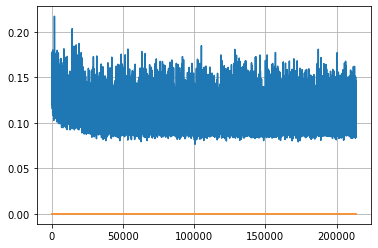

Epoch: 548, iteration 0, loss 0.10614976286888123, cov_diff 0.41870803742483725 cov_diff train 0.418804761775105
Epoch: 548, iteration 1, loss 0.09791678190231323, cov_diff 0.40663126095337326 cov_diff train 0.4055522878845951
Epoch: 548, iteration 2, loss 0.10573071241378784, cov_diff 0.3983836274300942 cov_diff train 0.3965863279457316
Epoch: 548, iteration 3, loss 0.11257070302963257, cov_diff 0.4037454422919953 cov_diff train 0.4034216260896586
Epoch: 548, iteration 4, loss 0.10569766163825989, cov_diff 0.41260364914795705 cov_diff train 0.4120650772469765
Epoch: 548, iteration 5, loss 0.09989741444587708, cov_diff 0.4078232140528427 cov_diff train 0.40784293208942407
Epoch: 548, iteration 6, loss 0.0978245735168457, cov_diff 0.4090805069291829 cov_diff train 0.4077836409137426
Epoch: 548, iteration 7, loss 0.09770315885543823, cov_diff 0.40563447919937207 cov_diff train 0.4054312189720261
Epoch: 548, iteration 8, loss 0.098337322473526, cov_diff 0.3994046243265969 cov_diff train 0

Epoch: 548, iteration 78, loss 0.11675986647605896, cov_diff 0.4081519477099721 cov_diff train 0.4071111873258336
Epoch: 548, iteration 79, loss 0.11441373825073242, cov_diff 0.4071591237525163 cov_diff train 0.40617573089329245
Epoch: 548, iteration 80, loss 0.10740691423416138, cov_diff 0.4219486617981073 cov_diff train 0.4216921416232255
Epoch: 548, iteration 81, loss 0.11477687954902649, cov_diff 0.4130726495728359 cov_diff train 0.4122344589350489
Epoch: 548, iteration 82, loss 0.10202094912528992, cov_diff 0.4064026282072143 cov_diff train 0.40522648187647087
Epoch: 548, iteration 83, loss 0.10122424364089966, cov_diff 0.4146621237615791 cov_diff train 0.4141739128740636
Epoch: 548, iteration 84, loss 0.09784719347953796, cov_diff 0.39956555426918106 cov_diff train 0.39854340637076874
Epoch: 548, iteration 85, loss 0.107826828956604, cov_diff 0.4097488985255504 cov_diff train 0.40763449359507964
Epoch: 548, iteration 86, loss 0.09665000438690186, cov_diff 0.41476178429952015 cov_

Epoch: 548, iteration 157, loss 0.11059492826461792, cov_diff 0.4117053032985533 cov_diff train 0.41021452521524937
Epoch: 548, iteration 158, loss 0.1111556887626648, cov_diff 0.40544015747739265 cov_diff train 0.4047529130770394
Epoch: 548, iteration 159, loss 0.1145930290222168, cov_diff 0.4190698172669428 cov_diff train 0.4184836897448436
Epoch: 548, iteration 160, loss 0.11111530661582947, cov_diff 0.4000148223685787 cov_diff train 0.39894441178814005
Epoch: 548, iteration 161, loss 0.09010261297225952, cov_diff 0.4135032026522647 cov_diff train 0.41312207476231
Epoch: 548, iteration 162, loss 0.10247498750686646, cov_diff 0.4080867642680347 cov_diff train 0.4080096229488562
Epoch: 548, iteration 163, loss 0.10787391662597656, cov_diff 0.4107560682565895 cov_diff train 0.4103635319920404
Epoch: 548, iteration 164, loss 0.09507572650909424, cov_diff 0.4114232025218024 cov_diff train 0.41198341526543153
Epoch: 548, iteration 165, loss 0.1093515157699585, cov_diff 0.4101450497894809 

Epoch: 548, iteration 238, loss 0.09779125452041626, cov_diff 0.41323961072349596 cov_diff train 0.41179370968573814
Epoch: 548, iteration 239, loss 0.10328510403633118, cov_diff 0.4032069038387135 cov_diff train 0.4025446267411824
Epoch: 548, iteration 240, loss 0.09217876195907593, cov_diff 0.40179751510859263 cov_diff train 0.40148095537094586
Epoch: 548, iteration 241, loss 0.12234783172607422, cov_diff 0.4114051397548121 cov_diff train 0.41182489184905835
Epoch: 548, iteration 242, loss 0.10176724195480347, cov_diff 0.4106074585884168 cov_diff train 0.4107099782948939
Epoch: 548, iteration 243, loss 0.104644775390625, cov_diff 0.4064300852356816 cov_diff train 0.40664155393205953
Epoch: 548, iteration 244, loss 0.09806576371192932, cov_diff 0.40045935568305263 cov_diff train 0.39934170415962195
Epoch: 548, iteration 245, loss 0.10578387975692749, cov_diff 0.4061168345963687 cov_diff train 0.4060449610552148
Epoch: 548, iteration 246, loss 0.11715364456176758, cov_diff 0.4000196657

Epoch: 548, iteration 319, loss 0.09931150078773499, cov_diff 0.41373155876177625 cov_diff train 0.4126455352369278
Epoch: 548, iteration 320, loss 0.09305372834205627, cov_diff 0.40197494533123296 cov_diff train 0.40128204738748063
Epoch: 548, iteration 321, loss 0.10017800331115723, cov_diff 0.39576970671208545 cov_diff train 0.3948280394963633
Epoch: 548, iteration 322, loss 0.09724688529968262, cov_diff 0.41512285854373504 cov_diff train 0.41365997261513787
Epoch: 548, iteration 323, loss 0.10181248188018799, cov_diff 0.3922670416582841 cov_diff train 0.39029998948760486
Epoch: 548, iteration 324, loss 0.10184141993522644, cov_diff 0.4181414876891751 cov_diff train 0.41781118587397775
Epoch: 548, iteration 325, loss 0.10123050212860107, cov_diff 0.40224516397160165 cov_diff train 0.4018961213627369
Epoch: 548, iteration 326, loss 0.09209313988685608, cov_diff 0.4161170155571981 cov_diff train 0.4155408195994151
Epoch: 548, iteration 327, loss 0.10149410367012024, cov_diff 0.4107491

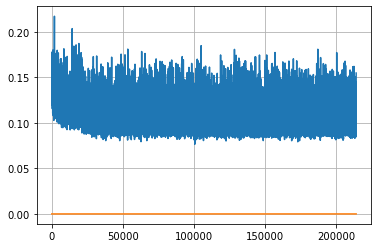

Epoch: 549, iteration 0, loss 0.09848687052726746, cov_diff 0.40057924116295746 cov_diff train 0.3998784114916561
Epoch: 549, iteration 1, loss 0.10598099231719971, cov_diff 0.4048337909694412 cov_diff train 0.4035500966654545
Epoch: 549, iteration 2, loss 0.09393823146820068, cov_diff 0.40720803198372324 cov_diff train 0.4068318949712142
Epoch: 549, iteration 3, loss 0.10949498414993286, cov_diff 0.4122384954426881 cov_diff train 0.4109967995497365
Epoch: 549, iteration 4, loss 0.09914666414260864, cov_diff 0.4122312444164769 cov_diff train 0.41178135895138585
Epoch: 549, iteration 5, loss 0.09666118025779724, cov_diff 0.4125540201323002 cov_diff train 0.41231398385371726
Epoch: 549, iteration 6, loss 0.10134845972061157, cov_diff 0.41538979605080306 cov_diff train 0.4145366473759245
Epoch: 549, iteration 7, loss 0.09580069780349731, cov_diff 0.39489117621965886 cov_diff train 0.3938792154311353
Epoch: 549, iteration 8, loss 0.09808719158172607, cov_diff 0.4089722661890063 cov_diff tr

Epoch: 549, iteration 79, loss 0.09789377450942993, cov_diff 0.4093571038290671 cov_diff train 0.409367898101978
Epoch: 549, iteration 80, loss 0.10717722773551941, cov_diff 0.40566041489128296 cov_diff train 0.40563717515143355
Epoch: 549, iteration 81, loss 0.09819492697715759, cov_diff 0.39999911230230334 cov_diff train 0.4009954671813893
Epoch: 549, iteration 82, loss 0.09883695840835571, cov_diff 0.409079890117372 cov_diff train 0.40856067501156024
Epoch: 549, iteration 83, loss 0.10171574354171753, cov_diff 0.3956597272869384 cov_diff train 0.39585942440545197
Epoch: 549, iteration 84, loss 0.09275171160697937, cov_diff 0.40990042149223127 cov_diff train 0.4095379516722296
Epoch: 549, iteration 85, loss 0.09950616955757141, cov_diff 0.41096448161337173 cov_diff train 0.4102261878041756
Epoch: 549, iteration 86, loss 0.1087648868560791, cov_diff 0.4113038204401303 cov_diff train 0.4106448452313077
Epoch: 549, iteration 87, loss 0.09644675254821777, cov_diff 0.3979304748560759 cov_

Epoch: 549, iteration 157, loss 0.107511967420578, cov_diff 0.4225006223704667 cov_diff train 0.42116057038002874
Epoch: 549, iteration 158, loss 0.10037028789520264, cov_diff 0.4116922761572173 cov_diff train 0.4109512893309646
Epoch: 549, iteration 159, loss 0.10601958632469177, cov_diff 0.40637772305880454 cov_diff train 0.4050127025706671
Epoch: 549, iteration 160, loss 0.1132194995880127, cov_diff 0.4170614519635328 cov_diff train 0.4157441714682422
Epoch: 549, iteration 161, loss 0.1059083640575409, cov_diff 0.4009017661527071 cov_diff train 0.40197598352038383
Epoch: 549, iteration 162, loss 0.11485955119132996, cov_diff 0.41892041922733836 cov_diff train 0.41898910852916654
Epoch: 549, iteration 163, loss 0.11361035704612732, cov_diff 0.42144915732231397 cov_diff train 0.4200252889575265
Epoch: 549, iteration 164, loss 0.11639469861984253, cov_diff 0.41691873391847845 cov_diff train 0.41624969080085983
Epoch: 549, iteration 165, loss 0.11107280850410461, cov_diff 0.422270045608

Epoch: 549, iteration 235, loss 0.11414822936058044, cov_diff 0.3950194301976201 cov_diff train 0.39571738745595897
Epoch: 549, iteration 236, loss 0.10360810160636902, cov_diff 0.4091957183134846 cov_diff train 0.4078766340050102
Epoch: 549, iteration 237, loss 0.09852012991905212, cov_diff 0.3918303895453431 cov_diff train 0.3902879050663685
Epoch: 549, iteration 238, loss 0.10809966921806335, cov_diff 0.4077078719344389 cov_diff train 0.40738130073531725
Epoch: 549, iteration 239, loss 0.1031402051448822, cov_diff 0.4022753305755187 cov_diff train 0.40251422900476036
Epoch: 549, iteration 240, loss 0.10030552744865417, cov_diff 0.4173095424541393 cov_diff train 0.41735190770717656
Epoch: 549, iteration 241, loss 0.11778843402862549, cov_diff 0.4159066171026652 cov_diff train 0.41371383804631306
Epoch: 549, iteration 242, loss 0.10247659683227539, cov_diff 0.4188254064436696 cov_diff train 0.4190841372682746
Epoch: 549, iteration 243, loss 0.09893929958343506, cov_diff 0.412832590599

Epoch: 549, iteration 314, loss 0.10605320334434509, cov_diff 0.4117831640753599 cov_diff train 0.4109786521916538
Epoch: 549, iteration 315, loss 0.10498857498168945, cov_diff 0.41658395455776714 cov_diff train 0.4156727346361638
Epoch: 549, iteration 316, loss 0.10723951458930969, cov_diff 0.40919607838765637 cov_diff train 0.4086978350591297
Epoch: 549, iteration 317, loss 0.10112833976745605, cov_diff 0.4128837623584471 cov_diff train 0.41164706936479956
Epoch: 549, iteration 318, loss 0.1050741970539093, cov_diff 0.414938044123134 cov_diff train 0.4146150861330025
Epoch: 549, iteration 319, loss 0.0964585542678833, cov_diff 0.4039975791921256 cov_diff train 0.4031688721600791
Epoch: 549, iteration 320, loss 0.0938098132610321, cov_diff 0.41853631270722447 cov_diff train 0.4182073147839683
Epoch: 549, iteration 321, loss 0.09559065103530884, cov_diff 0.4164967190797187 cov_diff train 0.41640468109392825
Epoch: 549, iteration 322, loss 0.10072135925292969, cov_diff 0.407387192881070

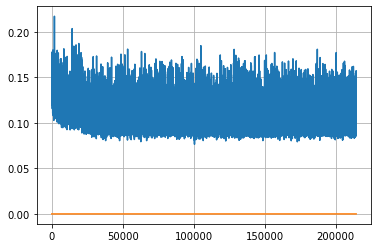

Epoch: 550, iteration 0, loss 0.10172852873802185, cov_diff 0.4015283139790744 cov_diff train 0.4012927775586854
Epoch: 550, iteration 1, loss 0.10180771350860596, cov_diff 0.4030871510455751 cov_diff train 0.4028810472301837
Epoch: 550, iteration 2, loss 0.10996818542480469, cov_diff 0.41175683807207636 cov_diff train 0.41147640937616026
Epoch: 550, iteration 3, loss 0.09447586536407471, cov_diff 0.4022531073466218 cov_diff train 0.402078648845711
Epoch: 550, iteration 4, loss 0.08573362231254578, cov_diff 0.41101222589986114 cov_diff train 0.41122754588606203
Epoch: 550, iteration 5, loss 0.10626262426376343, cov_diff 0.4084727960839724 cov_diff train 0.40825741293577306
Epoch: 550, iteration 6, loss 0.0935964286327362, cov_diff 0.4068791159454027 cov_diff train 0.40665972344107704
Epoch: 550, iteration 7, loss 0.09897410869598389, cov_diff 0.42101117117676673 cov_diff train 0.42082093608220755
Epoch: 550, iteration 8, loss 0.10568636655807495, cov_diff 0.399003130937028 cov_diff tra

Epoch: 550, iteration 78, loss 0.0990656316280365, cov_diff 0.41232708945803 cov_diff train 0.41133266219782866
Epoch: 550, iteration 79, loss 0.09848490357398987, cov_diff 0.41765230194674496 cov_diff train 0.4162449110398651
Epoch: 550, iteration 80, loss 0.10303443670272827, cov_diff 0.41130209027983533 cov_diff train 0.4109399217580859
Epoch: 550, iteration 81, loss 0.09725034236907959, cov_diff 0.41097076286047407 cov_diff train 0.40933809323908493
Epoch: 550, iteration 82, loss 0.10159033536911011, cov_diff 0.4068207618108883 cov_diff train 0.4062781558698509
Epoch: 550, iteration 83, loss 0.10039961338043213, cov_diff 0.41492222554086816 cov_diff train 0.41468101055150275
Epoch: 550, iteration 84, loss 0.11900609731674194, cov_diff 0.4095582886994691 cov_diff train 0.40863158092598045
Epoch: 550, iteration 85, loss 0.10551071166992188, cov_diff 0.4142263994980243 cov_diff train 0.41325213711695297
Epoch: 550, iteration 86, loss 0.09417903423309326, cov_diff 0.41828628334644413 c

Epoch: 550, iteration 160, loss 0.08891180157661438, cov_diff 0.41809815722538435 cov_diff train 0.41694840282519074
Epoch: 550, iteration 161, loss 0.10796239972114563, cov_diff 0.4136873671143516 cov_diff train 0.4122910762404167
Epoch: 550, iteration 162, loss 0.09757554531097412, cov_diff 0.41609237647858516 cov_diff train 0.4155001161428805
Epoch: 550, iteration 163, loss 0.10636082291603088, cov_diff 0.42547844334669893 cov_diff train 0.4250574523911718
Epoch: 550, iteration 164, loss 0.10320758819580078, cov_diff 0.41934851811039575 cov_diff train 0.41850754154027603
Epoch: 550, iteration 165, loss 0.10143998265266418, cov_diff 0.4029724361629579 cov_diff train 0.4017558005835336
Epoch: 550, iteration 166, loss 0.10995757579803467, cov_diff 0.40113474391933235 cov_diff train 0.3998207223158211
Epoch: 550, iteration 167, loss 0.11044147610664368, cov_diff 0.4086762811480913 cov_diff train 0.40811157395965825
Epoch: 550, iteration 168, loss 0.10315129160881042, cov_diff 0.41387172

Epoch: 550, iteration 238, loss 0.10078594088554382, cov_diff 0.4024337396029538 cov_diff train 0.40208996448968665
Epoch: 550, iteration 239, loss 0.1018415093421936, cov_diff 0.4004050270349776 cov_diff train 0.3995856983958851
Epoch: 550, iteration 240, loss 0.09919103980064392, cov_diff 0.407871915498705 cov_diff train 0.4068487845053835
Epoch: 550, iteration 241, loss 0.10242339968681335, cov_diff 0.4236875796977005 cov_diff train 0.4222352473891285
Epoch: 550, iteration 242, loss 0.1057066023349762, cov_diff 0.39482131717113067 cov_diff train 0.39404044985116937
Epoch: 550, iteration 243, loss 0.0966208279132843, cov_diff 0.3971309444751939 cov_diff train 0.3969651123058667
Epoch: 550, iteration 244, loss 0.10231554508209229, cov_diff 0.42421541270003377 cov_diff train 0.42415704359010564
Epoch: 550, iteration 245, loss 0.09654748439788818, cov_diff 0.4072117605736457 cov_diff train 0.4064839320997154
Epoch: 550, iteration 246, loss 0.09615582227706909, cov_diff 0.395477122748478

Epoch: 550, iteration 316, loss 0.11255660653114319, cov_diff 0.40959818215664306 cov_diff train 0.40882852084184274
Epoch: 550, iteration 317, loss 0.11384296417236328, cov_diff 0.4100492719483857 cov_diff train 0.40883154079060496
Epoch: 550, iteration 318, loss 0.12146329879760742, cov_diff 0.4269818436286662 cov_diff train 0.4259148148600158
Epoch: 550, iteration 319, loss 0.09658673405647278, cov_diff 0.4015539772609014 cov_diff train 0.40084740082735326
Epoch: 550, iteration 320, loss 0.10303002595901489, cov_diff 0.4069436608824281 cov_diff train 0.4056835779455461
Epoch: 550, iteration 321, loss 0.11020994186401367, cov_diff 0.39812568536114323 cov_diff train 0.3974361511287184
Epoch: 550, iteration 322, loss 0.09412693977355957, cov_diff 0.4007399930352744 cov_diff train 0.4002982631848134
Epoch: 550, iteration 323, loss 0.11081382632255554, cov_diff 0.4082092473634983 cov_diff train 0.4074697461741179
Epoch: 550, iteration 324, loss 0.09886696934700012, cov_diff 0.40133655001

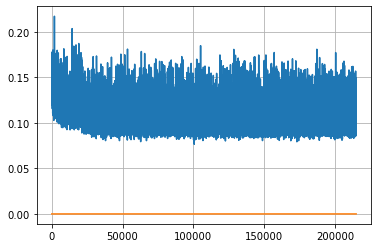

Epoch: 551, iteration 0, loss 0.11308526992797852, cov_diff 0.41387341631497715 cov_diff train 0.41371618830436613
Epoch: 551, iteration 1, loss 0.1033080518245697, cov_diff 0.41286753369379686 cov_diff train 0.41208619001927393
Epoch: 551, iteration 2, loss 0.10878798365592957, cov_diff 0.40967592813764786 cov_diff train 0.4092736870514055
Epoch: 551, iteration 3, loss 0.1078629195690155, cov_diff 0.41416827773827575 cov_diff train 0.413050648944344
Epoch: 551, iteration 4, loss 0.09435832500457764, cov_diff 0.422612968850066 cov_diff train 0.4229401839885652
Epoch: 551, iteration 5, loss 0.09880653023719788, cov_diff 0.41115441192761887 cov_diff train 0.4102076227091716
Epoch: 551, iteration 6, loss 0.09937238693237305, cov_diff 0.41113836316997593 cov_diff train 0.41022074855707275
Epoch: 551, iteration 7, loss 0.10964462161064148, cov_diff 0.4029300132004057 cov_diff train 0.4026671187582117
Epoch: 551, iteration 8, loss 0.09403008222579956, cov_diff 0.41217468503530863 cov_diff tr

Epoch: 551, iteration 81, loss 0.10234430432319641, cov_diff 0.4076658645107795 cov_diff train 0.40708854765650093
Epoch: 551, iteration 82, loss 0.10991063714027405, cov_diff 0.41156619428405217 cov_diff train 0.41082587979929186
Epoch: 551, iteration 83, loss 0.09065335988998413, cov_diff 0.40360043764080805 cov_diff train 0.4036248420875777
Epoch: 551, iteration 84, loss 0.11164936423301697, cov_diff 0.40263415321524626 cov_diff train 0.401378985838841
Epoch: 551, iteration 85, loss 0.10043221712112427, cov_diff 0.41619959909559895 cov_diff train 0.41550272160496127
Epoch: 551, iteration 86, loss 0.09516900777816772, cov_diff 0.401683741824062 cov_diff train 0.4003334604155879
Epoch: 551, iteration 87, loss 0.11258235573768616, cov_diff 0.4170166059398067 cov_diff train 0.4161867998313813
Epoch: 551, iteration 88, loss 0.09117546677589417, cov_diff 0.40899805914975884 cov_diff train 0.4076641756723914
Epoch: 551, iteration 89, loss 0.10452720522880554, cov_diff 0.4213132966090164 co

Epoch: 551, iteration 160, loss 0.09330317378044128, cov_diff 0.3996919726988627 cov_diff train 0.3992597693302636
Epoch: 551, iteration 161, loss 0.09307929873466492, cov_diff 0.40866432669930597 cov_diff train 0.40864767111594713
Epoch: 551, iteration 162, loss 0.10281643271446228, cov_diff 0.4143920412914154 cov_diff train 0.41416573680854885
Epoch: 551, iteration 163, loss 0.09229341149330139, cov_diff 0.38932679042056517 cov_diff train 0.3884609899157286
Epoch: 551, iteration 164, loss 0.0915711522102356, cov_diff 0.4092455216175669 cov_diff train 0.4079136320729992
Epoch: 551, iteration 165, loss 0.10079944133758545, cov_diff 0.4093056525879699 cov_diff train 0.40922266238442506
Epoch: 551, iteration 166, loss 0.11049219965934753, cov_diff 0.40895685195777776 cov_diff train 0.40824662693581065
Epoch: 551, iteration 167, loss 0.10869097709655762, cov_diff 0.4036801069553371 cov_diff train 0.40315522883464583
Epoch: 551, iteration 168, loss 0.1055552065372467, cov_diff 0.4123953820

Epoch: 551, iteration 238, loss 0.10059744119644165, cov_diff 0.40080611215420026 cov_diff train 0.40130577253103333
Epoch: 551, iteration 239, loss 0.09603744745254517, cov_diff 0.412369656280719 cov_diff train 0.4123169239375075
Epoch: 551, iteration 240, loss 0.10327035188674927, cov_diff 0.4135525163681774 cov_diff train 0.41338061276508214
Epoch: 551, iteration 241, loss 0.10382190346717834, cov_diff 0.4061500092828446 cov_diff train 0.40635589594707033
Epoch: 551, iteration 242, loss 0.09689462184906006, cov_diff 0.41665836956392477 cov_diff train 0.41751605145079046
Epoch: 551, iteration 243, loss 0.10057714581489563, cov_diff 0.39797165672915863 cov_diff train 0.39766329721945776
Epoch: 551, iteration 244, loss 0.09289252758026123, cov_diff 0.4114677193240986 cov_diff train 0.4110850188604567
Epoch: 551, iteration 245, loss 0.09276726841926575, cov_diff 0.4133292651787744 cov_diff train 0.4132045906747549
Epoch: 551, iteration 246, loss 0.1088976263999939, cov_diff 0.4108846607

Epoch: 551, iteration 317, loss 0.10301628708839417, cov_diff 0.41466453202335973 cov_diff train 0.4143734489237722
Epoch: 551, iteration 318, loss 0.11133727431297302, cov_diff 0.41994014656668927 cov_diff train 0.4190505682967532
Epoch: 551, iteration 319, loss 0.10514718294143677, cov_diff 0.3981911905488249 cov_diff train 0.39742179472533967
Epoch: 551, iteration 320, loss 0.10328024625778198, cov_diff 0.41644468998852346 cov_diff train 0.41566152058175604
Epoch: 551, iteration 321, loss 0.11117470264434814, cov_diff 0.4169484628382466 cov_diff train 0.41657283255914174
Epoch: 551, iteration 322, loss 0.099010169506073, cov_diff 0.3990177885064968 cov_diff train 0.39863173609204233
Epoch: 551, iteration 323, loss 0.11079928278923035, cov_diff 0.4064326153157347 cov_diff train 0.4065421171619767
Epoch: 551, iteration 324, loss 0.09533926844596863, cov_diff 0.401557340904701 cov_diff train 0.40097738200653454
Epoch: 551, iteration 325, loss 0.11260664463043213, cov_diff 0.39927341202

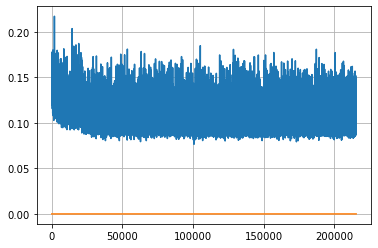

Epoch: 552, iteration 0, loss 0.10286217927932739, cov_diff 0.4199568493443793 cov_diff train 0.4201789727293072
Epoch: 552, iteration 1, loss 0.10684630274772644, cov_diff 0.4243019527023052 cov_diff train 0.42301120969864153
Epoch: 552, iteration 2, loss 0.11730384826660156, cov_diff 0.41769223370906433 cov_diff train 0.4167547061164293
Epoch: 552, iteration 3, loss 0.09301096200942993, cov_diff 0.4028220100170117 cov_diff train 0.4026621981485602
Epoch: 552, iteration 4, loss 0.0931825041770935, cov_diff 0.3948986856879096 cov_diff train 0.3934031646374213
Epoch: 552, iteration 5, loss 0.10681071877479553, cov_diff 0.4199594002363123 cov_diff train 0.41882325612145055
Epoch: 552, iteration 6, loss 0.11935120820999146, cov_diff 0.42110637563907516 cov_diff train 0.4194804360489381
Epoch: 552, iteration 7, loss 0.09442317485809326, cov_diff 0.412075442069733 cov_diff train 0.4113655042509146
Epoch: 552, iteration 8, loss 0.09112933278083801, cov_diff 0.40542978520621054 cov_diff train

Epoch: 552, iteration 80, loss 0.10341474413871765, cov_diff 0.41026709103760867 cov_diff train 0.4097029658900394
Epoch: 552, iteration 81, loss 0.10246652364730835, cov_diff 0.41222171752179965 cov_diff train 0.4113844076783458
Epoch: 552, iteration 82, loss 0.09766533970832825, cov_diff 0.40588664308057343 cov_diff train 0.4058303843160663
Epoch: 552, iteration 83, loss 0.10379254817962646, cov_diff 0.4016233562368083 cov_diff train 0.4019924052721008
Epoch: 552, iteration 84, loss 0.1116134524345398, cov_diff 0.4155276596586774 cov_diff train 0.41411215110568467
Epoch: 552, iteration 85, loss 0.10664451122283936, cov_diff 0.40541644277309785 cov_diff train 0.4040745625431892
Epoch: 552, iteration 86, loss 0.10108715295791626, cov_diff 0.407473380929565 cov_diff train 0.40677866092612913
Epoch: 552, iteration 87, loss 0.10546505451202393, cov_diff 0.4111036298002284 cov_diff train 0.4100084078352852
Epoch: 552, iteration 88, loss 0.0992501974105835, cov_diff 0.39853206866209145 cov_

Epoch: 552, iteration 161, loss 0.100873202085495, cov_diff 0.40611347143032867 cov_diff train 0.4050113472523566
Epoch: 552, iteration 162, loss 0.10116630792617798, cov_diff 0.4103840515941846 cov_diff train 0.40992049144268167
Epoch: 552, iteration 163, loss 0.10501232743263245, cov_diff 0.3955485611911536 cov_diff train 0.39550571000048174
Epoch: 552, iteration 164, loss 0.1051211953163147, cov_diff 0.40261824855138195 cov_diff train 0.4015039935559391
Epoch: 552, iteration 165, loss 0.09680178761482239, cov_diff 0.4074188873735176 cov_diff train 0.4078742286220493
Epoch: 552, iteration 166, loss 0.10431572794914246, cov_diff 0.39959407378427264 cov_diff train 0.39902399810219796
Epoch: 552, iteration 167, loss 0.09617990255355835, cov_diff 0.4006951002304118 cov_diff train 0.3985767170085296
Epoch: 552, iteration 168, loss 0.1041528582572937, cov_diff 0.41065318128786843 cov_diff train 0.4098369693620768
Epoch: 552, iteration 169, loss 0.08976256847381592, cov_diff 0.4089186012951

Epoch: 552, iteration 243, loss 0.10854804515838623, cov_diff 0.4122668613851397 cov_diff train 0.4106307268911163
Epoch: 552, iteration 244, loss 0.11375120282173157, cov_diff 0.4221927053880406 cov_diff train 0.42192631818696463
Epoch: 552, iteration 245, loss 0.09788629412651062, cov_diff 0.4079189435629641 cov_diff train 0.4074179713737019
Epoch: 552, iteration 246, loss 0.11286687850952148, cov_diff 0.40883367468855625 cov_diff train 0.4095056232243811
Epoch: 552, iteration 247, loss 0.11846715211868286, cov_diff 0.3990299216984352 cov_diff train 0.4000434654132044
Epoch: 552, iteration 248, loss 0.09977388381958008, cov_diff 0.41855729926179314 cov_diff train 0.41848158144931613
Epoch: 552, iteration 249, loss 0.09768614172935486, cov_diff 0.41994858018614456 cov_diff train 0.420355689490753
Epoch: 552, iteration 250, loss 0.10578659176826477, cov_diff 0.41160727390448587 cov_diff train 0.41107781809839156
Epoch: 552, iteration 251, loss 0.1042298674583435, cov_diff 0.40627190331

Epoch: 552, iteration 322, loss 0.1105218231678009, cov_diff 0.4002108477532706 cov_diff train 0.39978225442703685
Epoch: 552, iteration 323, loss 0.10737067461013794, cov_diff 0.3988941750494631 cov_diff train 0.3978533615395272
Epoch: 552, iteration 324, loss 0.10315915942192078, cov_diff 0.4167682775245467 cov_diff train 0.41606235986905316
Epoch: 552, iteration 325, loss 0.10372418165206909, cov_diff 0.4110540825247118 cov_diff train 0.40999019718328045
Epoch: 552, iteration 326, loss 0.09787896275520325, cov_diff 0.4019530828617368 cov_diff train 0.401619907713237
Epoch: 552, iteration 327, loss 0.1103629469871521, cov_diff 0.40092683763054676 cov_diff train 0.3994770622573933
Epoch: 552, iteration 328, loss 0.10018256306648254, cov_diff 0.40609403104069924 cov_diff train 0.4060655642395509
Epoch: 552, iteration 329, loss 0.10363385081291199, cov_diff 0.4047020664700393 cov_diff train 0.4027913940414221
Epoch: 552, iteration 330, loss 0.11320579051971436, cov_diff 0.41196141348494

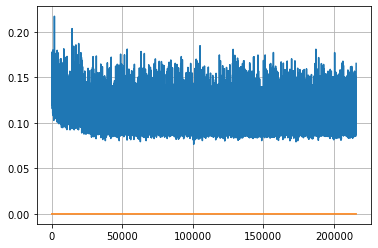

Epoch: 553, iteration 0, loss 0.09851685166358948, cov_diff 0.39958884142847373 cov_diff train 0.400673660849509
Epoch: 553, iteration 1, loss 0.11393198370933533, cov_diff 0.41626717942588765 cov_diff train 0.41576265800558865
Epoch: 553, iteration 2, loss 0.10363602638244629, cov_diff 0.42546337995546546 cov_diff train 0.4244986829061812
Epoch: 553, iteration 3, loss 0.10677456855773926, cov_diff 0.4114989153607951 cov_diff train 0.41080664649598336
Epoch: 553, iteration 4, loss 0.10261312127113342, cov_diff 0.3937032097937387 cov_diff train 0.3938119400984945
Epoch: 553, iteration 5, loss 0.10700637102127075, cov_diff 0.4132481252228267 cov_diff train 0.4118808412970013
Epoch: 553, iteration 6, loss 0.11201372742652893, cov_diff 0.41500414918874023 cov_diff train 0.4145695924491293
Epoch: 553, iteration 7, loss 0.09577161073684692, cov_diff 0.3989055123063053 cov_diff train 0.398859704679184
Epoch: 553, iteration 8, loss 0.09635612368583679, cov_diff 0.41618200676990214 cov_diff tra

Epoch: 553, iteration 78, loss 0.10127639770507812, cov_diff 0.41478946528654687 cov_diff train 0.41422219732808163
Epoch: 553, iteration 79, loss 0.10532891750335693, cov_diff 0.4068688971668661 cov_diff train 0.40587265203480205
Epoch: 553, iteration 80, loss 0.09518072009086609, cov_diff 0.3975450820726383 cov_diff train 0.39630682006694906
Epoch: 553, iteration 81, loss 0.11595383286476135, cov_diff 0.41131553720369307 cov_diff train 0.41112519451592267
Epoch: 553, iteration 82, loss 0.10031130909919739, cov_diff 0.4250162147225432 cov_diff train 0.42536562085719876
Epoch: 553, iteration 83, loss 0.10510936379432678, cov_diff 0.4210484208419901 cov_diff train 0.421471562393962
Epoch: 553, iteration 84, loss 0.09646299481391907, cov_diff 0.40340076750245524 cov_diff train 0.40367562005005303
Epoch: 553, iteration 85, loss 0.09463867545127869, cov_diff 0.39593628874072356 cov_diff train 0.3953692534638713
Epoch: 553, iteration 86, loss 0.10945460200309753, cov_diff 0.4170351446124884

Epoch: 553, iteration 158, loss 0.09563937783241272, cov_diff 0.40365104767731597 cov_diff train 0.4032660525534506
Epoch: 553, iteration 159, loss 0.10791480541229248, cov_diff 0.3956033709873825 cov_diff train 0.39376875014374385
Epoch: 553, iteration 160, loss 0.09810194373130798, cov_diff 0.417181229130859 cov_diff train 0.4169090594252797
Epoch: 553, iteration 161, loss 0.1006811261177063, cov_diff 0.40707110028325116 cov_diff train 0.4066444865320951
Epoch: 553, iteration 162, loss 0.1010056734085083, cov_diff 0.4125033070347581 cov_diff train 0.41140525034204584
Epoch: 553, iteration 163, loss 0.10171711444854736, cov_diff 0.40906733491305125 cov_diff train 0.40826718125489053
Epoch: 553, iteration 164, loss 0.10799357295036316, cov_diff 0.4131906244859884 cov_diff train 0.41319810950791785
Epoch: 553, iteration 165, loss 0.09257706999778748, cov_diff 0.4034205049340666 cov_diff train 0.40348632922305816
Epoch: 553, iteration 166, loss 0.08971762657165527, cov_diff 0.41443130843

Epoch: 553, iteration 237, loss 0.10900920629501343, cov_diff 0.4064988917915676 cov_diff train 0.405883910585251
Epoch: 553, iteration 238, loss 0.0999923050403595, cov_diff 0.4043964711007253 cov_diff train 0.40323739394638014
Epoch: 553, iteration 239, loss 0.1000431478023529, cov_diff 0.41757738440378106 cov_diff train 0.41660453381564805
Epoch: 553, iteration 240, loss 0.10780876874923706, cov_diff 0.41762902208401104 cov_diff train 0.4166131763455931
Epoch: 553, iteration 241, loss 0.09431108832359314, cov_diff 0.4024387563238938 cov_diff train 0.40194979267114084
Epoch: 553, iteration 242, loss 0.09607315063476562, cov_diff 0.41813963303901236 cov_diff train 0.4172949906790546
Epoch: 553, iteration 243, loss 0.09481105208396912, cov_diff 0.4042514568620479 cov_diff train 0.4026008523474139
Epoch: 553, iteration 244, loss 0.09454673528671265, cov_diff 0.4103305643672466 cov_diff train 0.4102099023568052
Epoch: 553, iteration 245, loss 0.0856049656867981, cov_diff 0.41270271182249

Epoch: 553, iteration 317, loss 0.10260340571403503, cov_diff 0.4068633653396516 cov_diff train 0.406965663427426
Epoch: 553, iteration 318, loss 0.1016852855682373, cov_diff 0.4175848036892372 cov_diff train 0.4170375212191901
Epoch: 553, iteration 319, loss 0.09448099136352539, cov_diff 0.40224852611090284 cov_diff train 0.40141330799074776
Epoch: 553, iteration 320, loss 0.10679855942726135, cov_diff 0.4149749593799619 cov_diff train 0.4147586442627017
Epoch: 553, iteration 321, loss 0.10831081867218018, cov_diff 0.4157487480128872 cov_diff train 0.41551542191520285
Epoch: 553, iteration 322, loss 0.13051775097846985, cov_diff 0.41324951915189473 cov_diff train 0.4135323734142735
Epoch: 553, iteration 323, loss 0.10312145948410034, cov_diff 0.41382293565284384 cov_diff train 0.4141442995169232
Epoch: 553, iteration 324, loss 0.10242673754692078, cov_diff 0.3955966410150364 cov_diff train 0.3958489647525205
Epoch: 553, iteration 325, loss 0.10953140258789062, cov_diff 0.4150421521147

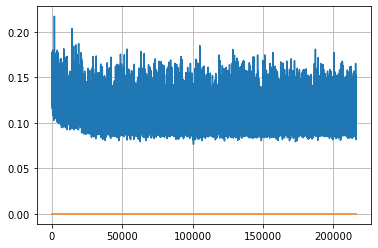

Epoch: 554, iteration 0, loss 0.09808111190795898, cov_diff 0.39884640217703615 cov_diff train 0.399187294591854
Epoch: 554, iteration 1, loss 0.10745257139205933, cov_diff 0.4105277121494776 cov_diff train 0.41088236470036704
Epoch: 554, iteration 2, loss 0.10244095325469971, cov_diff 0.4117573082565803 cov_diff train 0.41137070447844964
Epoch: 554, iteration 3, loss 0.0883105993270874, cov_diff 0.4110746919680988 cov_diff train 0.4104579955990212
Epoch: 554, iteration 4, loss 0.11472511291503906, cov_diff 0.40100613278135633 cov_diff train 0.4011138647281383
Epoch: 554, iteration 5, loss 0.10581088066101074, cov_diff 0.41380872206836744 cov_diff train 0.4124363874385012
Epoch: 554, iteration 6, loss 0.09652405977249146, cov_diff 0.4088588230507322 cov_diff train 0.4091404223304206
Epoch: 554, iteration 7, loss 0.09159502387046814, cov_diff 0.41868169697493307 cov_diff train 0.41842277578156817
Epoch: 554, iteration 8, loss 0.11005035042762756, cov_diff 0.40619521969508166 cov_diff tr

Epoch: 554, iteration 79, loss 0.09783202409744263, cov_diff 0.4090209084160138 cov_diff train 0.40772779718321417
Epoch: 554, iteration 80, loss 0.1035374104976654, cov_diff 0.42049851714823994 cov_diff train 0.4202411078363837
Epoch: 554, iteration 81, loss 0.11658823490142822, cov_diff 0.40170627779989815 cov_diff train 0.4018645340277469
Epoch: 554, iteration 82, loss 0.0998775064945221, cov_diff 0.41533101981323406 cov_diff train 0.41458617800123804
Epoch: 554, iteration 83, loss 0.10631173849105835, cov_diff 0.40610432994917844 cov_diff train 0.40605160920996003
Epoch: 554, iteration 84, loss 0.10307866334915161, cov_diff 0.4114546196927814 cov_diff train 0.41089045498257426
Epoch: 554, iteration 85, loss 0.10187572240829468, cov_diff 0.4171776931442917 cov_diff train 0.41672828120248717
Epoch: 554, iteration 86, loss 0.11648261547088623, cov_diff 0.40844063502039585 cov_diff train 0.40831406909395584
Epoch: 554, iteration 87, loss 0.10546264052391052, cov_diff 0.4188859459057448

Epoch: 554, iteration 157, loss 0.11164695024490356, cov_diff 0.4147276720064064 cov_diff train 0.41334491256402295
Epoch: 554, iteration 158, loss 0.10139524936676025, cov_diff 0.4086246106593203 cov_diff train 0.4074685053400709
Epoch: 554, iteration 159, loss 0.09440982341766357, cov_diff 0.4191195350577506 cov_diff train 0.4185083199912871
Epoch: 554, iteration 160, loss 0.09732148051261902, cov_diff 0.4088695955902149 cov_diff train 0.4079411902831155
Epoch: 554, iteration 161, loss 0.10536327958106995, cov_diff 0.4086545199512678 cov_diff train 0.40837176680436893
Epoch: 554, iteration 162, loss 0.10681051015853882, cov_diff 0.41591283695087733 cov_diff train 0.41493567447727653
Epoch: 554, iteration 163, loss 0.09189951419830322, cov_diff 0.4140951434615908 cov_diff train 0.4138762071950641
Epoch: 554, iteration 164, loss 0.1031472384929657, cov_diff 0.42407948525860456 cov_diff train 0.42403778782470214
Epoch: 554, iteration 165, loss 0.10628074407577515, cov_diff 0.39735845707

Epoch: 554, iteration 235, loss 0.10040527582168579, cov_diff 0.4217862885410287 cov_diff train 0.41906069250936634
Epoch: 554, iteration 236, loss 0.10731565952301025, cov_diff 0.4232580439958667 cov_diff train 0.4226367429989533
Epoch: 554, iteration 237, loss 0.11237442493438721, cov_diff 0.41952259737276243 cov_diff train 0.4191055258594169
Epoch: 554, iteration 238, loss 0.09584027528762817, cov_diff 0.41557308751798544 cov_diff train 0.4147422018831108
Epoch: 554, iteration 239, loss 0.10397133231163025, cov_diff 0.42481709627878766 cov_diff train 0.4244677151829542
Epoch: 554, iteration 240, loss 0.09631180763244629, cov_diff 0.4054607383387471 cov_diff train 0.40552164348191927
Epoch: 554, iteration 241, loss 0.08986476063728333, cov_diff 0.4109423325058378 cov_diff train 0.4111138681311032
Epoch: 554, iteration 242, loss 0.10086333751678467, cov_diff 0.40915180584164806 cov_diff train 0.40858341179166524
Epoch: 554, iteration 243, loss 0.11043009161949158, cov_diff 0.409203592

Epoch: 554, iteration 312, loss 0.13055554032325745, cov_diff 0.41440952035200074 cov_diff train 0.4140539579357581
Epoch: 554, iteration 313, loss 0.11055067181587219, cov_diff 0.41992700506169955 cov_diff train 0.41912225730644914
Epoch: 554, iteration 314, loss 0.10002782940864563, cov_diff 0.39650794820265667 cov_diff train 0.39537825062996473
Epoch: 554, iteration 315, loss 0.1039399802684784, cov_diff 0.41147978734011487 cov_diff train 0.41143769010426157
Epoch: 554, iteration 316, loss 0.11039754748344421, cov_diff 0.42065215703051756 cov_diff train 0.42009919067870843
Epoch: 554, iteration 317, loss 0.10286065936088562, cov_diff 0.41587713301528995 cov_diff train 0.4151455066630359
Epoch: 554, iteration 318, loss 0.11546233296394348, cov_diff 0.419948539826717 cov_diff train 0.41971418330628163
Epoch: 554, iteration 319, loss 0.10903379321098328, cov_diff 0.4236543765577205 cov_diff train 0.4222642114010595
Epoch: 554, iteration 320, loss 0.10039353370666504, cov_diff 0.4253729

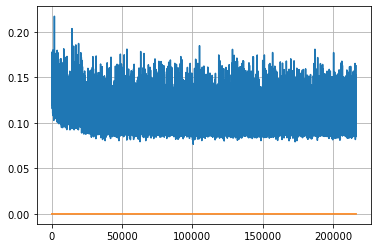

Epoch: 555, iteration 0, loss 0.10455864667892456, cov_diff 0.4159243971717925 cov_diff train 0.41434198014016804
Epoch: 555, iteration 1, loss 0.10083457827568054, cov_diff 0.398884774228491 cov_diff train 0.397469494211253
Epoch: 555, iteration 2, loss 0.1060849130153656, cov_diff 0.41810596996484456 cov_diff train 0.416499698505555
Epoch: 555, iteration 3, loss 0.09796857833862305, cov_diff 0.41765913711077324 cov_diff train 0.4173544519078888
Epoch: 555, iteration 4, loss 0.1086018979549408, cov_diff 0.4196325487606397 cov_diff train 0.4194265492432763
Epoch: 555, iteration 5, loss 0.09890168905258179, cov_diff 0.398762170141525 cov_diff train 0.3975742583187437
Epoch: 555, iteration 6, loss 0.10225826501846313, cov_diff 0.42595003697298817 cov_diff train 0.42566230201066574
Epoch: 555, iteration 7, loss 0.10273474454879761, cov_diff 0.40280334176748533 cov_diff train 0.4017204067444471
Epoch: 555, iteration 8, loss 0.10705149173736572, cov_diff 0.40638588496865147 cov_diff train 0

Epoch: 555, iteration 78, loss 0.09399893879890442, cov_diff 0.4156449557733793 cov_diff train 0.414219963168216
Epoch: 555, iteration 79, loss 0.09325623512268066, cov_diff 0.40778738892578276 cov_diff train 0.40757279076235553
Epoch: 555, iteration 80, loss 0.0971623957157135, cov_diff 0.4170841307364271 cov_diff train 0.41613801076366796
Epoch: 555, iteration 81, loss 0.11170244216918945, cov_diff 0.4142289309296453 cov_diff train 0.41340592231496837
Epoch: 555, iteration 82, loss 0.10380029678344727, cov_diff 0.4134074508212144 cov_diff train 0.412842757722218
Epoch: 555, iteration 83, loss 0.1025400459766388, cov_diff 0.3813350809705339 cov_diff train 0.3812966223210429
Epoch: 555, iteration 84, loss 0.10741636157035828, cov_diff 0.420064471899541 cov_diff train 0.41945282759345626
Epoch: 555, iteration 85, loss 0.10298702120780945, cov_diff 0.3953751271137907 cov_diff train 0.3940746368429463
Epoch: 555, iteration 86, loss 0.10153910517692566, cov_diff 0.407694656162602 cov_diff 

Epoch: 555, iteration 159, loss 0.09849047660827637, cov_diff 0.4083932681660239 cov_diff train 0.40777842124851066
Epoch: 555, iteration 160, loss 0.10712003707885742, cov_diff 0.4098720973422801 cov_diff train 0.4099566887922706
Epoch: 555, iteration 161, loss 0.10582363605499268, cov_diff 0.4135130110016184 cov_diff train 0.4133090637015149
Epoch: 555, iteration 162, loss 0.10168576240539551, cov_diff 0.40172739842907873 cov_diff train 0.4016163896672567
Epoch: 555, iteration 163, loss 0.09949624538421631, cov_diff 0.41512374583675066 cov_diff train 0.41501075067468507
Epoch: 555, iteration 164, loss 0.10429677367210388, cov_diff 0.4087174682909418 cov_diff train 0.40788382828893105
Epoch: 555, iteration 165, loss 0.09944659471511841, cov_diff 0.41008202944278493 cov_diff train 0.4100985423698466
Epoch: 555, iteration 166, loss 0.10666859149932861, cov_diff 0.3985490213545311 cov_diff train 0.39754250587418755
Epoch: 555, iteration 167, loss 0.09755411744117737, cov_diff 0.404608023

Epoch: 555, iteration 237, loss 0.09617885947227478, cov_diff 0.42352897918133997 cov_diff train 0.42268444552671397
Epoch: 555, iteration 238, loss 0.11554393172264099, cov_diff 0.416572342922768 cov_diff train 0.41676936274205767
Epoch: 555, iteration 239, loss 0.10377618670463562, cov_diff 0.4219484978851791 cov_diff train 0.4204031411390739
Epoch: 555, iteration 240, loss 0.09528639912605286, cov_diff 0.4169828170485852 cov_diff train 0.415987791929435
Epoch: 555, iteration 241, loss 0.09722280502319336, cov_diff 0.4080481807716576 cov_diff train 0.4070388984738728
Epoch: 555, iteration 242, loss 0.10135984420776367, cov_diff 0.4151248619697742 cov_diff train 0.4148420246582008
Epoch: 555, iteration 243, loss 0.0996447205543518, cov_diff 0.411408397943973 cov_diff train 0.41167928846584145
Epoch: 555, iteration 244, loss 0.1067938506603241, cov_diff 0.3961867465628853 cov_diff train 0.39622124848763857
Epoch: 555, iteration 245, loss 0.1002020537853241, cov_diff 0.40775619671784774

Epoch: 555, iteration 316, loss 0.11019599437713623, cov_diff 0.4098375085109494 cov_diff train 0.4069736099436036
Epoch: 555, iteration 317, loss 0.09873291850090027, cov_diff 0.41587895295900573 cov_diff train 0.4157545850510299
Epoch: 555, iteration 318, loss 0.09994220733642578, cov_diff 0.41589292816032164 cov_diff train 0.4160362875164661
Epoch: 555, iteration 319, loss 0.09728699922561646, cov_diff 0.4163268718360183 cov_diff train 0.4160741670166433
Epoch: 555, iteration 320, loss 0.1182129979133606, cov_diff 0.39934293465507387 cov_diff train 0.39960316274837954
Epoch: 555, iteration 321, loss 0.0962466299533844, cov_diff 0.4047101880391616 cov_diff train 0.4043221727839547
Epoch: 555, iteration 322, loss 0.10842519998550415, cov_diff 0.4180610098066683 cov_diff train 0.416858020506957
Epoch: 555, iteration 323, loss 0.10559448599815369, cov_diff 0.4205397086172096 cov_diff train 0.4208339877134445
Epoch: 555, iteration 324, loss 0.09937438368797302, cov_diff 0.408073105400690

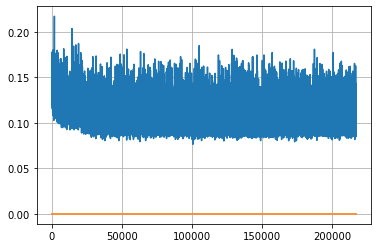

In [80]:
epochs_passed = len(list(res['loss'].keys()))#to continue training 
for epoch in range(epochs_passed, epochs_passed+500):
    for key in res:
        if key != 'lambda':
            res[key][epoch] = []
    #if epoch % 5 == 0 and epoch > 0:
    #    optimizer.param_groups[0]['lr'] /= 1.2
    # go through all the batches generated by dataloader
    for i, (inputs, targets) in enumerate(data_dl):
            # clear the gradients
            optimizer.zero_grad()
            # compute the model output
            yhat = model(inputs)
            # calculate loss
            loss = criterion(yhat, targets)
            cov_diff = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
            # credit assignment
            loss.backward()
            # update model weights
            optimizer.step()
            yhat = model(inputs)
            cov_diff2 = np.linalg.norm(np.cov(np.array(yhat.data).T) - np.eye(DATA_DIM)/COVARIANCE_SCALE)
            print("Epoch: {}, iteration {}, loss {}, cov_diff {} cov_diff train {}".format(epoch,i, loss, 
                                                                                           cov_diff, cov_diff2))
            res['loss'][epoch].append(loss.detach().cpu().numpy())
            res['sample'][epoch].append(yhat.detach().cpu().numpy())
            res['cov_diff'][epoch].append(cov_diff)

            if i % 50 == 0:
                fake_sample = model(cov_diff_inp)
                acc_cov_diff += [np.linalg.norm(np.cov((fake_sample.detach().cpu().numpy()).T) - 
                                          np.eye(DATA_DIM)/COVARIANCE_SCALE)]
    cov_diff_all += res['cov_diff'][epoch]
    losses += res['loss'][epoch]
    #with open('./training_process_dump/' + model_name + '.pkl', 'wb') as f:
    #    pkl.dump(res, f)
    
    plt.clf()
    
    plt.grid("on", "both")
    plt.plot(losses[100:])
    plt.plot(np.arange(len(losses[100:])), np.zeros(len(losses[100:])))
    plt.show()

In [99]:
7*500

3500

In [81]:
criterion(fake_sample[:BATCH_SIZE], torch.tensor(dataset.X[:BATCH_SIZE]))

tensor(0.1093, grad_fn=<SelectBackward>)

In [82]:
model_name = 'NP_SINKHORN_LAMBDA_2.0_LATENT_DIM_'+ld +'_initialization_he_BATCHSIZE256'

<ipython-input-83-ffa71221d4c1>:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  accuracy_history = np.array(acc_cov_diff[:400])


TypeError: '>' not supported between instances of 'list' and 'float'

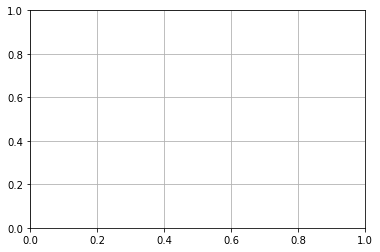

In [83]:
torch.save(model.state_dict(), './models/'+model_name+'.pt')

plt.figure()
accuracy_history = np.array(acc_cov_diff[:400])
iteration = min(20000, len(accuracy_history)*50)
step = 50
plt.clf()
plt.grid("on", "both")
idx = np.max(np.where(accuracy_history > 3.5))
plt.plot(np.arange(idx*50,iteration,step), accuracy_history[idx:], linewidth=2, color = 'red')
plt.plot(np.arange(iteration+1), np.zeros(iteration+1), linewidth=2, color = 'green')
plt.savefig("./plots/accuracy_history_"+model_name+".png")



In [93]:
tmp = acc_cov_diff[1]
acc_cov_diff = acc_cov_diff[0]

In [ ]:
with open('./training_process_dump/' + model_name + '.pkl', 'wb') as f:
    pkl.dump([res,acc_cov_diff], f)
